## Introduction

Word2Vec is a popular algorithm used for generating dense vector representations of words in large corpora using unsupervised learning. The resulting vectors have been shown to capture semantic relationships between the corresponding words and are used extensively for many downstream natural language processing (NLP) tasks like sentiment analysis, named entity recognition and machine translation.  

SageMaker BlazingText which provides efficient implementations of Word2Vec on

- single CPU instance
- single instance with multiple GPUs - P2 or P3 instances
- multiple CPU instances (Distributed training)

In this notebook, we demonstrate how BlazingText can be used for distributed training of word2vec using multiple CPU instances.

## Setup

Let's start by specifying:

- The S3 bucket and prefix that you want to use for training and model data. This should be within the same region as the Notebook Instance, training, and hosting. If you don't specify a bucket, SageMaker SDK will create a default bucket following a pre-defined naming convention in the same region. 
- The IAM role ARN used to give SageMaker access to your data. It can be fetched using the **get_execution_role** method from sagemaker python SDK.

In [1]:
import sagemaker
from sagemaker import get_execution_role
import boto3
import json

sess = sagemaker.Session()

role = get_execution_role()
print(role) # This is the role that SageMaker would use to leverage AWS resources (S3, CloudWatch) on your behalf

bucket = sess.default_bucket() # Replace with your own bucket name if needed
print(bucket)
prefix = 'sagemaker/DEMO-blazingtext-text8' #Replace with the prefix under which you want to store the data if needed

arn:aws:iam::349934754982:role/service-role/AmazonSageMaker-ExecutionRole-20190314T102350
sagemaker-ap-southeast-1-349934754982


### Data Ingestion

Next, we download a dataset from the web on which we want to train the word vectors. BlazingText expects a single preprocessed text file with space separated tokens and each line of the file should contain a single sentence.

In this example, let us train the vectors on [text8](http://mattmahoney.net/dc/textdata.html) dataset (100 MB), which is a small (already preprocessed) version of Wikipedia dump.  

In [2]:
!wget http://mattmahoney.net/dc/text8.zip -O text8.gz

--2019-04-02 16:17:49--  http://mattmahoney.net/dc/text8.zip
Resolving mattmahoney.net (mattmahoney.net)... 67.195.197.75
Connecting to mattmahoney.net (mattmahoney.net)|67.195.197.75|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 31344016 (30M) [application/zip]
Saving to: ‘text8.gz’

text8.gz            100%[===================>]  29.89M   266KB/s    in 2m 2s   

2019-04-02 16:19:52 (250 KB/s) - ‘text8.gz’ saved [31344016/31344016]



In [3]:
# Uncompressing
!gzip -d text8.gz -f

In [4]:
!ls

blazingtext_word2vec_text8.ipynb  headline-classifier-mxnet.ipynb  tf-src
headline-classifier-local.ipynb   text8


After the data downloading and uncompressing is complete, we need to upload it to S3 so that it can be consumed by SageMaker to execute training jobs. We'll use Python SDK to upload these two files to the bucket and prefix location that we have set above.

In [5]:
train_channel = prefix + '/train'

sess.upload_data(path='text8', bucket=bucket, key_prefix=train_channel)

s3_train_data = 's3://{}/{}'.format(bucket, train_channel)

Next we need to setup an output location at S3, where the model artifact will be dumped. These artifacts are also the output of the algorithm's training job.

In [6]:
s3_output_location = 's3://{}/{}/output'.format(bucket, prefix)

## Training Setup
Now that we are done with all the setup that is needed, we are ready to train our object detector. To begin, let us create a ``sageMaker.estimator.Estimator`` object. This estimator will launch the training job.

In [7]:
region_name = boto3.Session().region_name

In [8]:
container = sagemaker.amazon.amazon_estimator.get_image_uri(region_name, "blazingtext", "latest")
print('Using SageMaker BlazingText container: {} ({})'.format(container, region_name))

Using SageMaker BlazingText container: 475088953585.dkr.ecr.ap-southeast-1.amazonaws.com/blazingtext:latest (ap-southeast-1)


## Training the BlazingText model for generating word vectors

Similar to the original implementation of [Word2Vec](https://arxiv.org/pdf/1301.3781.pdf), SageMaker BlazingText provides an efficient implementation of the continuous bag-of-words (CBOW) and skip-gram architectures using Negative Sampling, on CPUs and additionally on GPU[s]. The GPU implementation uses highly optimized CUDA kernels. To learn more, please refer to [*BlazingText: Scaling and Accelerating Word2Vec using Multiple GPUs*](https://dl.acm.org/citation.cfm?doid=3146347.3146354). BlazingText also supports learning of subword embeddings with CBOW and skip-gram modes. This enables BlazingText to generate vectors for out-of-vocabulary (OOV) words, as demonstrated in this [notebook](https://github.com/awslabs/amazon-sagemaker-examples/blob/master/introduction_to_amazon_algorithms/blazingtext_word2vec_subwords_text8/blazingtext_word2vec_subwords_text8.ipynb).




Besides skip-gram and CBOW, SageMaker BlazingText also supports the "Batch Skipgram" mode, which uses efficient mini-batching and matrix-matrix operations ([BLAS Level 3 routines](https://software.intel.com/en-us/mkl-developer-reference-fortran-blas-level-3-routines)). This mode enables distributed word2vec training across multiple CPU nodes, allowing almost linear scale up of word2vec computation to process hundreds of millions of words per second. Please refer to [*Parallelizing Word2Vec in Shared and Distributed Memory*](https://arxiv.org/pdf/1604.04661.pdf) to learn more.

BlazingText also supports a *supervised* mode for text classification. It extends the FastText text classifier to leverage GPU acceleration using custom CUDA kernels. The model can be trained on more than a billion words in a couple of minutes using a multi-core CPU or a GPU, while achieving performance on par with the state-of-the-art deep learning text classification algorithms. For more information, please refer to [algorithm documentation](https://docs.aws.amazon.com/sagemaker/latest/dg/blazingtext.html) or [the text classification notebook](https://github.com/awslabs/amazon-sagemaker-examples/blob/master/introduction_to_amazon_algorithms/blazingtext_text_classification_dbpedia/blazingtext_text_classification_dbpedia.ipynb).

To summarize, the following modes are supported by BlazingText on different types instances:

|          Modes         	| cbow (supports subwords training) 	| skipgram (supports subwords training) 	| batch_skipgram 	| supervised |
|:----------------------:	|:----:	|:--------:	|:--------------:	| :--------------:	|
|   Single CPU instance  	|   ✔  	|     ✔    	|        ✔       	|  ✔  |
|   Single GPU instance  	|   ✔  	|     ✔    	|                	|  ✔ (Instance with 1 GPU only)  |
| Multiple CPU instances 	|      	|          	|        ✔       	|     | |

Now, let's define the resource configuration and hyperparameters to train word vectors on *text8* dataset, using "batch_skipgram" mode on two c4.2xlarge instances.


In [9]:
bt_model = sagemaker.estimator.Estimator(container,
                                         role, 
                                         train_instance_count=2, 
                                         train_instance_type='ml.c4.2xlarge',
                                         train_volume_size = 5,
                                         train_max_run = 360000,
                                         input_mode= 'File',
                                         output_path=s3_output_location,
                                         sagemaker_session=sess)

Please refer to [algorithm documentation](https://docs.aws.amazon.com/sagemaker/latest/dg/blazingtext_hyperparameters.html) for the complete list of hyperparameters.

In [10]:
bt_model.set_hyperparameters(mode="batch_skipgram",
                             epochs=5,
                             min_count=5,
                             sampling_threshold=0.0001,
                             learning_rate=0.05,
                             window_size=5,
                             vector_dim=100,
                             negative_samples=5,
                             batch_size=11, #  = (2*window_size + 1) (Preferred. Used only if mode is batch_skipgram)
                             evaluation=True,# Perform similarity evaluation on WS-353 dataset at the end of training
                             subwords=False) # Subword embedding learning is not supported by batch_skipgram

Now that the hyper-parameters are setup, let us prepare the handshake between our data channels and the algorithm. To do this, we need to create the `sagemaker.session.s3_input` objects from our data channels. These objects are then put in a simple dictionary, which the algorithm consumes.

In [11]:
train_data = sagemaker.session.s3_input(s3_train_data, distribution='FullyReplicated', 
                        content_type='text/plain', s3_data_type='S3Prefix')
data_channels = {'train': train_data}

We have our `Estimator` object, we have set the hyper-parameters for this object and we have our data channels linked with the algorithm. The only  remaining thing to do is to train the algorithm. The following command will train the algorithm. Training the algorithm involves a few steps. Firstly, the instance that we requested while creating the `Estimator` classes is provisioned and is setup with the appropriate libraries. Then, the data from our channels are downloaded into the instance. Once this is done, the training job begins. The provisioning and data downloading will take some time, depending on the size of the data. Therefore it might be a few minutes before we start getting training logs for our training jobs. The data logs will also print out `Spearman's Rho` on some pre-selected validation datasets after the training job has executed. This metric is a proxy for the quality of the algorithm. 

Once the job has finished a "Job complete" message will be printed. The trained model can be found in the S3 bucket that was setup as `output_path` in the estimator.

In [12]:
bt_model.fit(inputs=data_channels, logs=True)

INFO:sagemaker:Creating training-job with name: blazingtext-2019-04-02-16-20-53-503


2019-04-02 16:20:53 Starting - Starting the training job...
2019-04-02 16:20:58 Starting - Launching requested ML instances......
2019-04-02 16:22:04 Starting - Preparing the instances for training...
2019-04-02 16:22:53 Downloading - Downloading input data...
2019-04-02 16:23:12 Training - Training image download completed. Training in progress.
Arguments: train
Found 10.32.0.5 for host algo-1
Found 10.40.0.4 for host algo-2
Arguments: train
Found 10.32.0.5 for host algo-1
Found 10.40.0.4 for host algo-2
[04/02/2019 16:23:24 WARNING 139825917499200] Loggers have already been setup.
[04/02/2019 16:23:24 WARNING 139825917499200] Loggers have already been setup.
[04/02/2019 16:23:24 INFO 139825917499200] nvidia-smi took: 0.0252420902252 secs to identify 0 gpus
[04/02/2019 16:23:24 INFO 139825917499200] Running distributed CPU BlazingText training using batch_skipgram on 2 hosts.
[04/02/2019 16:23:24 INFO 139825917499200] Number of hosts: 2, master IP address: 10.32.0.5, host IP address: 

## Hosting / Inference
Once the training is done, we can deploy the trained model as an Amazon SageMaker real-time hosted endpoint. This will allow us to make predictions (or inference) from the model. Note that we don't have to host on the same type of instance that we used to train. Because instance endpoints will be up and running for long, it's advisable to choose a cheaper instance for inference.

In [13]:
bt_endpoint = bt_model.deploy(initial_instance_count = 1,instance_type = 'ml.t2.medium')

INFO:sagemaker:Creating model with name: blazingtext-2019-04-02-16-25-07-166
INFO:sagemaker:Creating endpoint with name blazingtext-2019-04-02-16-20-53-503


---------------------------------------------------------------------------!

### Getting vector representations for words

#### Use JSON format for inference
The payload should contain a list of words with the key as "**instances**". BlazingText supports content-type `application/json`.

In [14]:
words = ["awesome", "blazing"]

payload = {"instances" : words}

response = bt_endpoint.predict(json.dumps(payload))

vecs = json.loads(response)
print(vecs)

[{'vector': [0.051796454936265945, 0.0099570881575346, -0.16554635763168335, -0.12497295439243317, -0.0070616500452160835, 0.07795090228319168, -0.09100914001464844, -0.01782074384391308, -0.11675973236560822, 0.1866680532693863, -0.2441168874502182, 0.02426927536725998, 0.250953733921051, -0.004575822502374649, 0.2357127070426941, 0.06432164460420609, -0.072884701192379, 0.07607538253068924, 0.12045113742351532, 0.0449620857834816, 0.09814152866601944, 0.026784131303429604, -0.20965716242790222, -0.029495252296328545, 0.058288637548685074, -0.06769715249538422, 0.006058965809643269, 0.25119274854660034, 0.005058661103248596, 0.21599237620830536, 0.0011211681412532926, 0.12949040532112122, -0.04107220470905304, -0.050417833030223846, -0.15737812221050262, -0.06731174886226654, 0.08858437091112137, -0.11497890949249268, -0.12235039472579956, 0.19913673400878906, 0.0991826206445694, -0.05420641228556633, -0.06346786767244339, 0.016427775844931602, 0.39231961965560913, -0.0892363712191581

As expected, we get an n-dimensional vector (where n is vector_dim as specified in hyperparameters) for each of the words. If the word is not there in the training dataset, the model will return a vector of zeros.

### Evaluation

Let us now download the word vectors learned by our model and visualize them using a [t-SNE](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding) plot.

In [15]:
s3 = boto3.resource('s3')

key = bt_model.model_data[bt_model.model_data.find("/", 5)+1:]
s3.Bucket(bucket).download_file(key, 'model.tar.gz')

Uncompress `model.tar.gz` to get `vectors.txt`

In [16]:
!tar -xvzf model.tar.gz

vectors.bin
vectors.txt
eval.json


In [17]:
cat vectors.txt

71290 100
the 0.062796 -0.082042 -0.08925 -0.056947 0.097616 0.27121 0.17872 0.053287 0.097101 -0.040723 -0.086344 -0.054656 0.027832 -0.12678 -0.055977 0.081548 -0.10223 -0.038681 -0.023009 -0.068972 0.087586 0.0022327 0.046381 -0.31495 -0.042303 0.07764 0.12743 -0.073899 0.08904 -0.018568 -0.051378 0.20997 -0.25088 0.028645 -0.079653 0.01771 0.17052 0.19272 -0.0040608 0.022609 -0.037873 0.20724 0.12745 0.08012 0.31412 -0.11637 0.23258 0.20939 -0.11125 -0.12181 -0.030625 0.013392 -0.1589 0.18113 -0.063099 -0.19872 -0.038291 -0.047196 -0.011699 -0.1047 0.13623 0.27574 0.34459 0.12821 -0.070942 -0.16098 0.10017 -0.035523 -0.065249 0.0044661 -0.28464 0.10794 0.085205 -0.15053 -0.22211 -0.4607 0.053479 0.055773 0.20571 0.076374 0.15099 -0.073959 0.12985 0.13975 0.026954 0.034371 0.035064 0.011536 -0.047367 -0.27183 -0.038522 0.017178 0.55834 -0.17435 0.059281 -0.20019 -0.15645 0.094725 0.023045 -0.14916 
of 0.030316 -0.0083996 -0.0031448 -0.058664 0.18981 0.32041 0.21252 -0.091013 0.05793

father 0.10851 -0.21594 -0.017948 -0.2838 0.37268 0.14425 -0.22478 0.078445 0.23195 -0.12885 -0.63495 0.13826 -0.22694 0.44495 -0.56188 0.13751 0.025858 -0.015071 -0.27031 0.044532 0.20718 -0.16013 0.19425 0.031602 0.20395 -0.050801 -0.084466 0.035446 0.15049 0.27057 0.14428 0.14647 0.16469 -0.18196 -0.17666 -0.012145 -0.35918 -0.25864 -0.31064 0.54122 -0.44395 0.22666 -0.26593 0.2252 0.1634 -0.09882 0.4816 0.063246 0.1808 -0.13398 -0.025454 0.021623 -0.60062 0.13265 0.36916 -0.32495 -0.15522 0.31282 -0.068846 -0.12099 -0.3307 0.030926 0.47217 -0.24301 0.032996 -0.50709 0.10398 0.28981 -0.035202 0.081456 0.22444 0.16801 -0.035662 -0.37068 0.53525 -0.015563 0.068854 -0.1628 -0.11864 -0.048229 0.014543 -0.010644 -0.025525 0.41408 0.55871 -0.25653 0.72527 0.07258 0.31594 0.093055 -0.40942 0.069767 0.16253 -0.42739 -0.36577 0.006942 0.20008 0.13131 -0.36273 0.29899 
side 0.28026 -0.3678 0.18806 -0.37697 0.03973 0.14723 -0.0011376 -0.23895 0.31943 0.0099445 0.027859 0.16632 0.1408 -0.13583 

killed -0.1859 -0.081286 0.077675 -0.20274 -0.14458 -0.53706 0.31101 0.098918 0.63431 -0.13185 -0.21067 -0.051101 0.0016171 0.30824 -0.3163 0.48612 -0.29814 0.23723 -0.0647 -0.12207 0.19272 0.22123 -0.25779 0.11344 0.15454 -0.1428 -0.25885 0.0098203 -0.040979 0.31233 -0.3027 -0.031296 0.22934 0.084223 -0.28415 -0.50173 0.033435 -0.16341 -0.41941 0.17494 -0.31373 0.47041 0.021142 0.27362 0.36928 0.046302 0.50883 0.39341 0.092272 0.031691 -0.32727 -0.64136 -0.46549 -0.20243 0.30381 0.27408 -0.24725 0.31891 -0.30237 0.060547 0.025331 -0.13816 -0.16489 0.34745 0.43391 -0.45158 0.66034 -0.51341 -0.3973 -0.012413 0.15857 0.0093691 0.49158 0.61838 0.28233 -0.068967 0.26377 -0.16804 0.17098 0.17241 0.24642 0.41192 0.57636 0.49509 0.46789 -0.007724 0.55103 0.34341 -0.44757 -0.083601 -0.52574 0.1419 -0.050414 -0.50455 -0.28422 -0.049051 -0.1595 -0.13513 0.51025 -0.1743 
past -0.11467 0.25586 0.0316 0.02733 0.19919 0.15434 -0.081263 -0.056162 0.35978 0.19846 -0.1002 0.55119 -0.18765 -0.20143 -0.2

worked -0.088116 0.54312 -0.078199 -0.66052 0.12405 -0.24537 0.084459 -0.14181 0.012615 0.10359 -0.20851 0.26588 0.015437 0.30327 0.04051 -0.21794 -0.5129 -0.18307 0.13314 0.13467 0.29483 0.20475 0.019614 0.33542 -0.086081 -0.26125 -0.18546 -0.062389 -0.077734 -0.095664 -0.26297 -0.094195 -0.043897 -0.085691 -0.38761 0.062401 -0.03562 -0.23593 0.38586 0.61468 -0.38023 0.14418 0.1332 0.52095 0.38705 -0.038498 0.24693 0.42306 -0.23104 -0.30687 0.020436 -0.11194 -0.2951 0.31098 0.16288 -0.32884 0.1753 0.027656 0.38769 0.10818 0.26095 -0.048678 0.35192 0.022845 -0.038746 -0.19471 -0.13557 0.093037 0.10953 0.29142 0.82688 0.15143 0.18282 -0.1632 -0.0026814 -0.29944 -0.087821 -0.13919 0.2413 0.20648 -0.00078894 0.015509 0.050401 0.67245 0.129 -0.43435 0.51005 0.18096 0.31432 0.49869 -0.37964 0.05329 0.34516 -0.28781 0.49308 -0.23954 -0.24178 -0.13934 0.19688 0.03041 
flight -0.033014 -0.24777 -0.69687 0.2019 -0.25472 -0.044883 0.023656 0.24994 0.20031 0.47714 -0.062876 -0.58576 -0.52673 0.12

fuel 0.052064 0.07224 -0.70266 0.16986 -0.23444 -0.093397 -0.25454 0.25995 0.039116 0.089629 0.074051 0.20562 -0.50527 0.016819 1.1242 0.29449 -0.090176 0.12568 -0.092154 -0.51207 0.16425 -0.10488 -0.057296 -0.3477 0.32745 0.17609 0.049488 -0.44041 0.40057 -0.068064 -0.26668 -0.32097 0.14609 0.10812 -0.11604 0.81221 0.39583 -0.49944 -0.059624 0.13203 -0.0075759 -0.19378 0.45137 0.14209 -0.60626 -0.62292 -0.09858 -0.41158 -0.23283 -0.78193 -0.045473 -0.15932 0.19446 0.18416 -0.28781 -0.026005 -0.34933 0.41538 -0.54567 -0.34771 0.35163 -0.059231 0.63815 -0.23154 0.52572 -0.024867 0.081636 -0.34965 -0.38158 -0.35846 0.23287 -0.085607 -0.027034 0.13421 0.4463 0.16747 -0.1763 0.11795 -0.0020836 -0.10216 0.43927 -0.29798 0.34079 0.59489 0.24303 -0.74626 -0.051636 0.36777 -0.08772 0.011241 0.066283 -0.75729 0.42001 -0.38541 -0.32435 0.15244 0.55068 0.1565 0.67571 -0.40915 
officially 0.18105 0.29655 -0.19274 0.095581 0.028003 0.16088 0.42302 -0.089258 0.35396 -0.35821 -0.26116 0.097082 0.1578

foot 0.063856 -0.14036 0.44919 -0.58582 -0.41338 0.38426 -0.22666 -0.16511 0.33922 0.087713 -0.12896 0.018181 -0.14221 -0.16911 0.15019 0.0077249 -0.53163 -0.17247 -0.34902 0.21534 0.19621 0.073287 -0.20337 -0.29311 -0.13764 -0.43982 0.22797 -0.07845 0.12502 0.0017339 0.048585 0.095087 -0.018611 0.12927 0.0836 0.35422 -0.021895 -0.092648 -0.12267 -0.10314 0.080896 0.093212 -0.16454 0.048561 0.44537 0.23066 -0.092912 -0.22358 -0.1019 -0.048735 -0.24971 -0.14248 -0.37656 -0.32858 -0.5496 0.14682 0.30741 0.42644 -0.1455 0.093411 0.074512 -0.50958 0.094533 0.1228 0.28914 -0.38784 0.16931 0.10295 -0.46423 -0.013262 0.14956 0.538 0.12418 -0.30039 0.118 -0.21174 0.39673 0.2298 0.32171 -0.17884 0.34007 -0.45584 0.10127 0.1614 0.48573 -0.13827 0.14776 0.32881 0.13989 -0.027545 0.38974 0.42597 0.037289 -0.46063 -0.62472 -0.29948 -0.62064 0.16919 -0.090297 -0.0090316 
practical -0.25186 0.52856 -0.2409 0.42366 0.1831 0.17778 -0.10285 -0.17451 0.040258 0.29998 0.32623 -0.019671 -0.14875 0.044946 0

rapidly 0.17682 0.39915 -0.37495 -0.04767 0.22517 -0.054327 -0.13048 0.30258 0.032747 0.36519 -0.30562 0.5782 -0.13969 -0.7481 0.14738 0.21239 0.14972 -0.19784 -0.016259 -0.21425 -0.075192 0.2873 0.19198 -0.28593 -0.19461 -0.32271 0.03488 -0.20741 0.22892 -0.026458 -0.34682 0.09156 0.06122 0.34896 0.25094 0.3873 0.041369 -0.10385 0.15672 0.040544 0.28204 0.18698 -0.035999 -0.15224 -0.02917 -0.14897 0.21685 0.16429 -0.04724 -0.068278 -0.25445 -0.18518 -0.1355 0.2811 -0.18177 -0.0005866 -0.46372 0.22802 0.1214 -0.26686 0.17879 0.19727 0.1199 0.062454 -0.18889 0.19707 -0.27342 0.11956 -0.41838 0.095048 -0.068581 -0.1088 0.085434 0.1106 0.46273 -0.59685 0.25783 -0.26042 0.20312 -0.003686 0.11253 0.22993 -0.2257 0.46022 0.043299 -0.22087 0.42412 0.18903 -0.04951 -0.44367 0.36789 -0.018791 0.73279 -0.01675 0.19906 -0.13613 -0.040322 0.5533 -0.013833 -0.050958 
revealed 0.091565 0.3289 -0.05918 -0.42313 0.061857 0.28538 0.14546 -0.0046094 0.31849 0.15466 -0.37512 0.022114 -0.0093473 0.11623 -

probability -0.47122 -0.18334 0.44724 0.018663 -0.31879 -0.44729 0.22546 0.13878 0.042425 -0.1503 -0.10253 -0.24256 -0.25809 0.34028 -0.21333 0.61108 -0.065562 -0.1455 -0.14453 -0.33789 -0.31414 0.47641 0.07714 -0.14526 0.28941 -0.0075033 -0.042916 0.036766 0.034812 0.36257 0.19555 0.50219 0.35652 0.25824 0.31145 0.46917 -0.5502 -0.1509 -0.15553 0.039382 -0.057065 -0.25946 0.21541 0.36622 0.32815 -0.13505 0.58941 0.20682 -0.37819 -0.053833 0.13581 -0.54622 0.47455 0.90818 0.24911 -0.59981 0.13521 0.10128 0.00037142 -0.23122 0.69374 0.17451 0.29001 0.48263 -0.06111 0.26569 -0.071114 0.97894 -0.20099 -0.13575 -0.44563 0.03564 0.49978 -0.32498 -0.43595 0.23739 0.12219 0.071994 0.082673 -0.3328 0.032673 0.052589 0.11612 -0.23064 0.35757 -0.22006 0.38834 0.27973 -0.087292 -0.15571 0.019765 -0.16085 -0.36056 -0.79463 -0.20501 -0.19602 0.26504 0.34224 0.15617 0.24061 
verb -0.40521 0.44874 0.090787 0.39344 -0.21827 0.53287 -0.022534 0.18868 0.36577 -0.71046 -0.39435 -0.28444 -0.66156 -0.07355

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



.16536 
snowfall 0.26922 -0.13448 0.077413 -0.04808 -0.099278 0.57817 0.098546 -0.1753 0.091408 0.37621 -0.14969 0.6004 -0.20609 -0.060163 0.0030676 -0.16088 0.097551 0.098037 -0.27782 -0.21891 -0.091052 0.56134 -0.56239 -0.13766 -0.30856 -0.050348 0.45041 -0.48428 0.039506 -0.40098 -0.016832 0.052963 0.37886 0.233 -0.22759 0.032242 0.23876 -0.62052 -0.099495 -0.043032 0.16406 0.15568 0.036438 -0.068072 0.095772 -0.49995 0.21306 -0.46069 -0.38608 -0.20366 -0.12153 -0.039718 0.41335 0.62368 -0.174 -0.031911 -0.12728 -0.19404 -0.073427 0.17899 0.70654 0.275 0.23412 0.42549 0.12624 0.00090008 0.659 -0.21273 -0.57782 -0.29247 -0.067175 0.48077 0.0073432 -0.31317 0.72012 -0.041321 0.37309 0.069941 0.39979 0.065673 0.23743 0.31562 -0.048124 0.18356 0.6506 0.094723 -0.10162 0.21465 0.021215 -0.33544 0.61463 -0.3418 0.46909 -0.73764 0.048151 0.06638 -0.030813 -0.078642 -0.03168 -0.04018 
silly -0.10145 0.11228 -0.13301 -0.10655 -0.30283 0.25947 -0.15887 0.1412 -0.10385 0.23216 -0.17566 0.13061

organist 0.30253 0.11862 -0.10881 -0.62947 0.38727 0.15234 -0.27198 -0.13129 -0.25535 -0.055909 -0.0732 -0.11231 -0.16053 0.41384 -0.052988 -0.084029 -0.22131 -0.24121 -0.20399 -0.49264 0.44033 0.014961 0.30885 0.38989 0.017852 -0.011095 -0.12435 -0.068145 -0.055784 -0.0011347 -0.081904 -0.032352 0.042282 0.0072267 -0.038539 0.26308 -0.16207 -0.57127 -0.13165 0.58047 -0.14476 0.12703 0.69783 0.24874 0.44085 0.12147 -0.03673 0.24917 0.27498 0.13584 -0.09267 0.046182 -0.17636 -0.11697 -0.34262 0.19944 -0.039301 0.073635 0.33543 -0.50885 -0.20799 0.081066 0.33617 0.1152 0.27125 -0.43714 0.022219 0.26372 0.10885 -0.417 0.43289 0.6435 0.1761 -0.25172 0.19576 0.16586 0.28337 -0.10679 -0.26443 -0.15946 -0.30436 0.33053 0.12158 0.30254 0.40045 0.19552 0.28507 0.2519 0.13404 -0.091428 0.11636 -0.007637 0.30783 -0.55086 -0.12806 -0.23016 -0.22978 -0.010033 -0.13832 -0.25895 
fcc 0.50305 0.34477 -0.195 0.10469 -0.20604 0.32926 0.24898 -0.20291 -0.35961 0.015469 -0.11068 -0.28347 0.18519 0.069345 

waking -0.098686 0.2379 -0.26038 -0.07505 -0.053901 0.25036 -0.13455 0.19328 -0.05472 0.53014 -0.27371 0.1259 -0.26036 0.19383 -0.049684 -0.054198 -0.13556 0.34077 -0.12336 -0.045635 -0.023049 0.23033 -0.47546 0.17705 -0.041068 -0.13176 -0.020266 0.10521 0.050905 0.27678 0.064098 0.1609 0.15126 -0.15752 -0.16089 0.11085 -0.18339 -0.38719 -0.52434 -0.02961 0.12964 -0.022961 -0.013773 0.0011249 0.32103 0.027086 0.22838 -0.034796 -0.12899 -0.14728 -0.42182 -0.20731 -0.090625 0.0010948 0.1999 -0.13864 -0.029869 0.31913 -0.28954 0.043362 -0.14431 0.13847 0.24332 -0.15177 -0.024855 0.43622 0.12315 0.25009 -0.047706 -0.10332 -0.25775 0.16521 0.53928 0.094666 0.032321 -0.24855 0.34638 0.24216 -0.27875 -0.045341 0.51599 -0.15631 0.17526 -0.0050636 0.3684 0.056336 0.40164 0.23598 -0.19607 -0.22427 0.0047817 -0.27691 0.080674 -0.25836 -0.30106 0.10657 0.079363 -0.12489 -0.054513 0.15512 
cato 0.39524 -0.45911 -0.14512 -0.26308 0.44246 -0.25577 0.24761 0.32817 0.33986 -0.15648 -0.27256 0.1621 -0.2

lemur 0.26872 -0.076693 0.067185 -0.25982 0.13275 0.39182 -0.473 0.28423 0.26317 0.088211 0.17432 -0.096439 0.093683 0.56709 -0.15051 0.6294 -0.060708 -0.57601 -0.033988 0.32738 0.15145 0.42071 -0.0046204 0.18689 -0.073445 0.44281 0.65725 -0.099655 -0.63533 0.43015 0.078004 -0.17419 -0.066854 0.50371 -0.64295 -0.10318 0.052073 0.19068 0.077337 0.15244 -0.37143 -0.097349 -0.1492 0.15406 0.281 -0.15336 0.7817 0.077298 -0.20978 0.75568 -0.036974 0.38305 -0.13541 0.1177 -0.16462 0.39216 -0.2568 0.47421 0.11709 -0.32323 0.20502 0.15104 0.43476 0.37547 -0.11121 -0.063804 -0.15233 0.059787 0.65336 0.36518 0.74089 0.13541 0.21759 -0.37543 0.1489 0.30811 0.33396 -0.70656 -0.14576 -0.73607 0.57205 0.23956 0.60357 0.018399 0.61573 0.0086516 -0.20959 0.02676 -0.31871 -0.073742 0.81632 -0.059759 0.40129 0.41346 -0.65523 0.31509 0.036791 0.21238 0.17314 0.41583 
federalism -0.18471 0.15277 -0.10552 -0.182 0.44141 0.34622 -0.17143 0.058231 0.057171 -0.065595 -0.1253 -0.15304 -0.24076 0.088361 -0.0851

ignited 0.20523 0.31053 -0.31979 -0.053007 -0.0047696 -0.13521 0.030814 -0.05184 0.20968 -0.004081 -0.16309 0.32446 -0.15956 -0.076419 0.50927 -0.032164 -0.1173 -0.17938 -0.059822 -0.46361 0.18597 0.064311 -0.065937 -0.16105 0.1615 -0.11013 -0.2832 -0.15884 0.54259 0.21418 0.13825 -0.0066981 -0.33291 -0.086299 -0.17232 0.65535 0.23977 -0.091463 0.28166 0.0063313 0.07187 -0.57093 0.058134 0.14613 0.030601 -0.20415 -0.10247 0.045863 -0.3903 -0.37998 -0.18491 -0.097062 -0.15233 0.13489 -0.38735 -0.13243 -0.13333 0.26014 -0.26807 -0.044235 0.3143 0.20777 0.40012 0.34225 0.16064 -0.0032037 0.12419 -0.16905 -0.079548 -0.26873 0.42423 0.23017 0.37014 0.084222 0.46651 -0.37174 0.14327 -0.33252 0.18031 0.14166 0.090151 0.1405 -0.020843 0.2422 0.34364 -0.47314 0.35245 0.17315 -0.47082 -0.22355 -0.1822 -0.052331 0.30117 -0.48052 -0.20392 0.43509 -0.17704 -0.058106 0.19445 -0.1723 
deploy 0.062124 0.27934 -0.24976 -0.017944 -0.13581 -0.12123 0.30317 0.43799 0.13636 0.01883 0.054394 -0.082518 0.021

labours 0.15911 0.097222 -0.020716 -0.34465 0.14484 0.084148 -0.1683 0.15495 0.50228 0.16652 -0.10054 0.18407 -0.58638 0.34585 -0.4788 0.010379 0.048806 0.0073704 -0.49672 -0.24123 -0.025822 0.29072 -0.099155 -0.056886 -0.38693 -0.24847 0.17178 -0.0067138 -0.34967 0.45762 -0.18555 0.042143 -0.37253 -0.28237 0.25764 -0.4953 -0.39533 0.13168 -0.33946 0.10354 -0.17731 0.093013 -0.070651 0.29306 0.11901 -0.36259 0.14401 0.16789 -0.18088 -0.029607 -0.058954 0.56784 -0.46535 0.34399 -0.28107 -0.12443 0.11174 -0.052202 -0.4928 -0.070357 0.12275 0.095218 0.0017369 0.22341 -0.23917 -0.11618 -0.080326 0.1201 -0.039866 -0.12115 0.14133 0.24218 0.0061387 -0.19606 0.34231 -0.069218 0.257 -0.0026599 -0.041757 -0.2948 0.41395 0.20621 0.23802 0.16425 0.44915 -0.22951 0.13325 0.14774 -0.091406 0.026082 0.088047 -0.35937 0.49519 -0.14446 -0.51225 0.37963 -0.41083 -0.27999 0.29062 -0.12922 
resorted 0.1084 0.18929 -0.0088411 -0.23337 0.0090541 -0.32982 0.057053 -0.055474 0.31091 0.1933 0.23567 0.26505 -0

affluent 0.44971 -0.028528 0.13595 -0.20997 0.1979 -0.017447 0.12076 -0.17939 0.20867 0.38647 0.14735 0.46296 -0.21268 0.28072 -0.18428 0.22881 -0.20906 -0.070879 -0.19375 0.063021 0.12706 0.19586 0.13502 0.33675 -0.058648 -0.064668 0.21915 -0.39087 0.109 0.004269 0.0077622 -0.18262 0.14942 0.40169 -0.079715 0.031118 0.20719 -0.051499 -0.088292 -0.20034 -0.33306 0.69387 0.25522 0.22759 0.10222 -0.41445 0.48405 0.048625 -0.13494 0.16261 -0.23244 0.14924 -0.30961 0.29107 0.21044 0.049654 -0.49498 0.010857 -0.025337 -0.2031 0.21125 0.2347 0.14266 -0.20963 0.11474 -0.43833 -0.26676 0.14232 -0.26226 -0.15044 -0.26766 -0.016705 0.057024 -0.21933 0.28392 -0.13026 0.092938 -0.28958 0.31696 0.03025 0.19727 -0.079991 0.05627 0.26457 0.062353 0.043883 0.41148 0.40034 0.098838 -0.086837 0.33457 -0.16701 0.55915 0.036875 0.020755 -0.64622 -0.18613 0.14264 -0.080912 0.13383 
hybrids -0.20788 0.16331 0.076878 0.096132 -0.12192 0.0069001 -0.3291 -0.1124 -0.063903 0.22293 0.24319 0.29609 0.028834 0.076

anthems 0.35679 0.016638 0.15313 -0.19551 0.14531 0.40359 -0.22796 0.10569 -0.43588 -0.10281 0.18344 0.031951 0.47368 -0.23684 -0.16467 -0.24189 -0.018331 -0.40521 -0.1346 -0.21144 0.22981 -0.36718 0.072373 -0.025125 -0.22377 -0.10871 0.46498 0.32487 -0.31873 -0.040915 0.11028 0.067499 -0.51863 -0.31283 -0.33527 -0.29001 0.3005 -0.88415 0.15283 0.36356 -0.063628 0.076043 0.32206 0.088599 0.27494 0.11839 0.16917 0.13266 0.095034 -0.049876 -0.212 -0.42319 -0.19695 0.45111 -0.61786 -0.0004741 0.028297 -0.27675 -0.12573 -0.24698 -0.1705 0.099289 0.17683 0.28312 0.26569 -0.0043345 0.24205 -0.020775 0.084919 -0.27197 -0.15535 0.41209 -0.01395 -0.50942 -0.071193 0.41654 -0.056087 0.11907 0.18255 -0.012079 0.029409 -0.22022 -0.10735 0.24101 -0.025995 0.45908 -0.035591 0.12635 0.13364 -0.066513 -0.14186 -0.32462 0.75446 -0.17667 -0.2903 -0.07908 -0.18073 -0.040859 0.36095 -0.24349 
venerable 0.15601 -0.029276 -0.20875 0.015983 -0.04614 0.46597 -0.22124 0.21573 0.23106 0.10797 0.019912 0.12804 -

clockwork 0.089515 -0.053686 -0.049694 -0.074704 -0.12737 -0.0024646 -0.08847 0.052423 0.011895 0.23676 -0.20309 -0.091951 0.22896 0.093984 0.54724 0.22898 -0.18651 0.15438 -0.35408 -0.0033958 0.18723 -0.27651 -0.41261 0.0032109 -0.058735 -0.22633 0.098031 -0.02272 -0.037828 0.22536 0.51205 0.13542 -0.47438 0.042477 -0.4547 -0.007389 0.27176 -0.21277 -0.11352 0.3116 0.1775 -0.27638 0.12432 0.043875 0.48976 -0.21168 0.16999 0.26885 0.03864 0.38216 -0.089826 0.33263 -0.27807 0.15341 -0.02809 -0.050446 -0.27572 0.19722 -0.38212 -0.21412 -0.053776 0.21304 0.42474 0.054363 0.0083186 0.27391 -0.29247 0.14926 0.12918 -0.10245 0.40795 0.3921 0.29477 -0.11751 0.16384 -0.43181 0.091887 0.24563 -0.29477 -0.23656 0.36316 -0.16683 0.23241 0.1432 0.053736 -0.2386 0.43458 0.023671 -0.34008 0.064758 0.15959 -0.12773 0.31723 -0.42559 -0.019346 0.16923 0.074539 0.22354 0.15639 0.22971 
brook 0.464 0.34076 0.049891 -0.28953 0.4498 0.12628 -0.060212 -0.23402 0.17098 0.19132 -0.039116 0.12592 -0.15923 0.20

pong -0.39136 -0.019375 -0.041697 0.23333 -0.12324 0.29429 -0.27824 0.058458 0.021139 -0.085211 -0.48511 0.20089 0.4973 -0.47442 0.29515 0.093374 0.16343 -0.26685 -0.091291 0.21857 0.036827 -0.051438 -0.19898 -0.16679 0.04119 -0.13004 0.02447 0.10753 -0.46783 0.31838 0.36711 0.040028 0.23763 0.14554 -0.48546 0.28605 0.2225 0.020063 -0.12156 0.36988 0.073885 -0.30492 0.069065 0.095832 0.30654 -0.20314 0.076565 0.15787 -0.011094 -0.16601 -0.3364 0.16383 -0.31698 0.26666 0.18296 -0.032886 0.062554 0.22567 0.01385 -0.4001 0.76235 0.26251 0.2212 0.54303 0.085265 -0.34282 -0.14 0.15534 0.18265 -0.37145 0.38213 0.2429 0.17737 0.12078 -0.07564 0.36076 -0.055394 -0.26146 0.29801 -0.13183 -0.088693 0.080963 0.16628 0.0026434 0.088882 0.18431 0.088671 0.5819 -0.19769 0.09946 0.092715 -0.15526 0.20614 -0.30299 -0.31922 -0.075578 -0.33436 0.3891 -0.10387 0.43233 
tabernacle 0.80134 0.50347 -0.09495 -0.25196 0.14032 0.32348 -0.28248 -0.024755 0.37689 0.20778 -0.30079 -0.18117 -0.66752 0.22459 -0.357

quentin 0.1405 -0.072307 0.0053924 -0.20915 0.11882 -0.1976 -0.2042 -0.051377 -0.041393 0.13575 -0.24951 0.12159 0.20728 -0.0059235 0.37163 0.15103 -0.19446 0.16454 0.3793 0.043193 0.42234 -0.31453 -0.24356 0.46822 -0.063955 -0.025009 0.049117 0.23696 0.083325 -0.042247 -0.059448 0.17039 0.19831 0.091434 -0.3365 -0.024747 -0.039945 -0.11794 -0.26285 0.28661 -0.20615 0.10876 0.10007 0.12218 0.3727 -0.16055 0.14143 0.091164 0.17939 0.29918 -0.27457 -0.095492 -0.1396 -0.42057 -0.004963 -0.1343 -0.25841 0.21224 0.0078377 0.076158 0.053537 0.33251 0.48295 -0.036653 0.076952 -0.0041089 0.29821 0.13047 0.17591 0.072703 0.24523 0.39289 0.24244 -0.13613 0.18619 -0.19262 0.37669 -0.062286 -0.021946 -0.20835 0.19443 -0.11507 0.35942 0.15137 0.046726 0.25498 0.16127 0.33054 -0.15673 0.10794 -0.065634 -0.28206 0.12058 -0.2513 -0.14684 -0.14605 0.1518 0.24905 0.22344 0.12502 
showdown 0.036722 -0.27607 0.1401 -0.046126 -0.26829 0.47458 0.026906 -0.01948 0.27952 0.13887 -0.27152 -0.26478 0.051974 -0.

hotter 0.036231 -0.1765 -0.1076 0.17106 0.15673 0.21403 -0.27327 -0.049642 0.021079 0.050653 0.038182 0.11767 -0.03652 -0.37486 0.27933 -0.06014 -0.05104 -0.20373 -0.40925 -0.1461 -0.14109 0.57991 -0.38978 -0.20014 0.033368 -0.077434 -0.030228 -0.21111 0.17354 0.045503 0.11788 0.19229 0.084309 0.29945 -0.22681 0.2059 0.51156 -0.65259 0.23764 -0.054871 -0.076289 0.079324 0.0050039 -0.32264 -0.05975 -0.3276 0.37109 -0.33002 -0.22704 -0.30205 0.079555 -0.098703 0.24245 0.59102 -0.086419 0.26218 -0.27023 0.17817 -0.15619 0.080378 0.25871 0.35968 0.38303 0.040985 0.31195 0.33906 0.032296 0.010145 -0.25836 0.067344 0.108 0.4744 0.30091 -0.11416 0.35062 -0.22868 0.23393 -0.1559 0.13462 0.020278 0.45684 0.23134 -0.026823 0.13789 0.38223 -0.15479 0.21948 0.18453 -0.4855 -0.42622 0.18847 -0.2612 0.69544 -0.42169 -0.073193 0.18008 -0.085182 0.16653 0.17412 0.031814 
chiral -0.15375 0.32377 0.079941 0.069499 0.018703 -0.06274 -0.16446 0.20552 -0.18672 -0.10613 -0.17098 -0.30635 0.012454 0.14973 0.

pei 0.61992 0.04528 -0.20516 0.1476 0.34486 -0.053921 -0.055131 0.1327 0.1168 -0.017891 -0.019334 0.14649 0.28311 0.17456 0.31223 0.1217 -0.24048 -0.014313 0.023789 0.17087 0.39591 -0.12995 -0.035505 0.17737 0.078717 -0.20029 -0.14233 0.26376 -0.38577 0.15745 0.27739 -0.051814 0.11307 0.19007 -0.34477 -0.045169 0.09712 0.10212 0.040292 0.43966 0.43183 0.11807 0.23251 0.37755 0.25184 -0.010005 0.171 0.060162 0.35184 0.3393 -0.17369 -0.24507 -0.23238 -0.17484 -0.11831 -0.067635 0.010564 -0.34859 0.22116 -0.23167 0.13142 0.51656 0.28618 0.20076 0.4502 -0.56432 -0.057751 0.30785 0.16225 0.029848 0.063106 0.5431 0.16257 -0.068076 -0.20685 0.093849 0.075113 -0.2316 0.59892 -0.12757 -7.6906e-05 -0.49129 0.37448 0.42455 0.065482 0.17173 -0.25832 0.038396 0.21153 -0.11963 0.33125 -0.10116 -0.076255 -0.11475 -0.0357 -0.33911 0.017869 0.095145 0.02952 0.010846 
rave 0.0098058 0.51391 -0.1083 -0.11759 -0.21499 0.10538 -0.030788 -0.15505 -0.34808 0.26186 -0.12604 0.35324 0.64881 -0.11042 -0.056447 

zoroastrian 0.18848 0.1595 -0.50013 0.22783 0.4116 0.20696 -0.47832 0.37949 0.33094 0.067202 0.10891 0.099897 -0.38388 0.17893 -0.5202 0.090043 0.11829 0.31386 -0.48671 -0.16896 0.163 -0.071601 0.074141 0.1208 0.24029 -0.41281 0.20229 0.38267 -0.28298 0.4039 0.1353 0.013419 -0.32777 -0.12872 0.0344 -0.36032 0.44006 0.25622 0.097464 0.30911 -0.1635 0.32741 -0.0013747 -0.26947 -0.03615 -0.27528 0.38026 0.17581 0.26097 -0.04643 -0.20652 0.15898 -0.45676 0.18035 -0.24951 -0.26017 0.15483 0.26907 -0.18893 -0.23796 -0.099872 0.51172 0.23347 0.057249 0.25402 -0.28459 -0.20005 -0.006679 -0.18986 0.095361 -0.29337 0.079987 -0.008425 0.1297 -0.090588 -0.34936 0.36627 -0.16068 0.0031111 -0.13369 -0.022959 -0.11337 0.12527 -0.14757 0.38203 -0.4746 0.21737 0.21768 -0.14006 0.052651 -0.021621 -0.16529 0.46599 -0.32701 -0.059497 0.25171 0.045061 0.086401 0.07035 0.36431 
amusing -0.27847 0.16581 -0.059863 -0.10069 0.063446 0.32786 0.038015 0.28994 -0.15794 0.25276 -0.046918 0.26313 0.070091 0.0094278

purgatory 0.37671 0.26423 -0.25536 -0.082168 0.042987 0.49136 -0.14341 0.11549 0.075011 0.12061 -0.396 -0.27423 -0.34431 0.51491 -0.11426 -0.039351 0.052886 -0.033229 -0.13753 -0.16356 0.11484 0.021702 -0.38239 0.28705 0.052918 -0.11438 0.27072 0.11498 0.0009788 0.32961 -0.011066 0.087162 -0.15825 -0.33573 0.027923 -0.10671 0.083816 -0.15171 -0.40122 -0.1852 -0.42792 -0.03272 -0.11283 0.17301 0.032704 -0.16439 0.073659 0.21169 0.14475 -0.19126 -0.079909 0.055726 -0.23657 -0.1023 -0.063026 -0.16895 0.27461 0.11472 0.24448 -0.23036 -0.19504 0.2553 0.15759 -0.063799 0.057473 0.073994 0.37256 -0.077019 -0.0076535 -0.013571 -0.6135 0.13316 -0.1262 0.13807 -0.33461 -0.13126 0.65609 -0.33619 0.13228 -0.11777 0.45366 0.031472 0.19185 -0.27677 0.49128 -0.072587 0.36816 0.022657 -0.0098734 -0.21555 -0.27326 -0.45877 0.49168 0.011671 -0.27469 -0.042135 0.17591 0.0053837 -0.036563 0.13166 
instigated 0.18816 0.04883 -0.052806 -0.093938 0.39446 -0.084714 0.026545 0.079708 0.057089 -0.081833 -0.0038

visas 0.16107 0.11091 -0.12748 0.077887 -0.05444 0.044024 0.15897 0.63688 0.237 -0.076428 -0.067161 -0.0017795 -0.22426 -0.18563 -0.067587 -0.031629 -0.021116 -0.058303 0.070728 -0.10132 0.16347 -0.013337 0.027694 0.043196 -0.23284 0.33657 -0.14906 -0.67788 -0.24871 -0.04528 -0.34118 -0.22102 0.21817 -0.072624 0.15017 -0.30777 -0.2008 -0.09413 -0.39779 0.20625 -0.20883 0.0018926 -0.1331 0.24004 0.14335 -0.1609 0.26366 -0.42476 -0.13722 -0.34458 -0.10402 -0.59222 -0.36639 0.18135 0.43198 0.20704 -0.17458 0.33887 0.18582 0.27577 0.2978 0.30309 0.26627 -0.08798 0.35367 -0.13812 0.099793 -0.031706 -0.3651 -0.012557 -0.31313 0.114 -0.2353 -0.041919 -0.28929 0.22632 -0.094148 -0.56692 0.30505 0.019593 0.15388 -0.36486 0.10653 0.41163 -0.012298 0.17133 0.094586 0.078502 0.16495 -0.0094928 0.088801 -0.071318 0.21967 -0.39281 -0.17881 -0.72008 0.0041867 0.02441 0.22282 -0.17757 
ste 0.56549 0.037039 -0.30672 0.094667 -0.064669 0.29337 -0.40464 -0.21147 0.20506 -0.16373 -0.12783 0.2336 0.3376 -0

stacked 0.32522 0.2898 0.048514 -0.43413 -0.089293 0.18731 0.082922 -0.11213 0.081672 -0.10986 -0.07128 -0.10103 -0.049397 -0.041509 0.30873 -0.040953 -0.054877 -0.49396 -0.17614 -0.060544 -0.11836 0.23038 -0.26688 -0.58439 -0.078887 0.19169 -0.31677 -0.10206 -0.070814 -0.088483 -0.11501 -0.081726 0.0093384 -0.095325 -0.26594 0.37172 0.31504 0.01807 0.081485 0.15063 0.18653 0.11093 -0.15881 0.32832 0.09784 -0.08798 -0.074642 -0.086854 -0.336 -0.40774 -0.34829 0.087459 -0.072134 0.21403 -0.31967 0.32651 0.24256 0.5604 -0.1678 -0.18467 0.53712 0.1268 0.03237 0.36475 0.25012 -0.053114 0.0094814 -0.023834 0.11024 -0.25064 -0.080223 0.34502 0.20433 -0.089059 0.026244 -0.15275 0.014195 -0.38634 0.4411 -0.0051244 0.069938 -0.17529 0.33006 0.11759 0.27106 -0.44207 0.11948 0.45695 -0.27175 -0.22276 0.34313 0.20693 0.1294 -0.022924 -0.1308 -0.28567 -0.32525 0.26283 0.44377 0.032161 
alkyl 0.15163 0.58024 -0.02688 0.51291 -0.26142 -0.18476 -0.37331 0.14321 -0.037462 -0.4993 -0.079932 -0.0046481 -

char 0.15146 0.049314 0.052629 0.31792 -0.17684 0.21282 -0.045419 0.70561 0.28929 -0.39595 -0.061668 -0.11785 0.21637 -0.29734 0.24462 0.091043 0.18232 -0.093386 0.26756 0.023093 -0.0067648 0.044228 -0.60317 0.16739 0.0065111 0.057562 -0.37513 -0.063619 -0.38477 -0.039086 -0.16161 0.10801 -0.032542 0.080223 -0.29628 0.20499 -0.27131 -0.0069031 -0.058236 0.29237 -0.11806 0.14368 0.1785 0.20481 0.04702 -0.17709 0.063719 0.038829 -0.2702 0.047226 -0.22123 0.053439 -0.19178 0.21652 -0.14409 0.10882 -0.22095 0.051174 0.17467 -0.30461 0.18823 0.16481 0.27144 0.16929 0.022721 0.16361 0.16939 0.45587 0.15672 -0.085548 0.15207 0.044008 -0.11592 -0.051899 -0.22043 0.083914 0.011726 -0.20259 0.096157 -0.40336 0.19755 -0.24266 0.34433 0.3059 0.29964 -0.12288 0.10777 0.4495 -0.11174 -0.011967 0.082869 -0.12342 -0.30191 -0.17147 -0.54519 0.017818 0.24376 0.094493 -0.16055 0.12102 
organise -0.1512 0.049025 -0.013557 -0.24767 -0.23485 0.18218 0.20963 0.029514 -0.0016155 -0.043841 -0.020082 0.051948 -

chaitin -0.29562 0.26713 -0.0043977 0.1791 0.15165 -0.047993 -0.10103 0.33017 -0.11317 -0.14247 -0.27388 -0.29604 -0.079795 0.12257 -0.089062 0.1387 -0.023667 0.38381 0.091091 -0.48207 0.056532 -0.024924 -0.17765 0.25681 -0.16 0.20596 -0.10032 0.047647 0.024364 0.26927 0.0086298 0.38503 -0.064714 -0.055616 0.01313 0.15821 -0.497 0.096081 -0.30425 0.3107 0.19215 0.11044 0.35978 0.30594 0.14376 -0.32692 0.18081 0.17539 -0.060816 0.10657 -0.0095116 -0.28583 -0.12251 0.23004 -0.045463 -0.19599 -0.040277 0.16771 0.26906 -0.4414 0.39942 0.41024 0.52865 0.15218 0.12664 0.3874 -0.16942 0.75626 0.015534 -0.07903 -0.20566 0.47558 0.17926 -0.3321 -0.57391 0.2016 -0.14905 0.17838 0.13105 -0.45183 0.036049 0.16391 0.052634 0.19427 0.65337 -0.099456 0.015731 0.041382 0.24152 0.25118 -0.24703 -0.28519 -0.25974 -0.4775 -0.16752 0.16902 0.058749 -0.05238 -0.094719 -0.17227 
taxonomic -0.032172 0.42604 0.25467 0.043713 -0.051443 -0.046462 -0.25071 0.25354 0.47857 0.040476 -0.050238 -0.10647 -0.30556 0.1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



56 -0.27199 0.18734 0.07599 0.055548 -0.27605 -0.068514 0.34381 0.10341 -0.149 0.23741 0.16741 -0.059087 0.30767 -0.10772 -0.033676 -0.45799 0.21646 -0.034998 0.0011005 -0.35774 -0.16421 0.0052049 -0.11642 0.30089 -0.24492 0.19107 -0.11187 -0.052055 -0.20174 0.38922 -0.18674 0.40168 0.088105 -0.093523 -0.017992 -0.3951 -0.21484 0.18265 -0.45088 -0.30155 0.07106 0.13696 -0.0068796 -0.31411 -0.21126 
sw 0.45725 0.22316 -0.18398 0.13165 0.024863 0.37558 -0.0046024 0.051053 0.12706 -0.26414 0.012339 0.04835 0.19528 -0.23748 0.32687 0.22475 0.15283 -0.19981 0.21638 0.24648 0.39144 0.14935 -0.35397 0.13828 -0.026064 -0.0011181 0.083008 -0.035154 -0.30291 -0.35886 0.042294 -0.071074 -0.081015 0.0037804 -0.15001 0.0068312 -0.039498 0.045937 0.31424 0.46019 0.064066 0.23255 0.4468 -0.03478 0.14527 -0.12572 0.51429 -0.10831 0.17458 -0.065308 -0.17795 -0.080518 0.10199 0.18606 -0.019883 -0.0014908 0.17038 0.10175 -0.026141 -0.27842 0.1981 -0.035101 0.27382 0.14412 -0.0068133 -0.1484 0.078583 0.31

understandings -0.16903 0.33379 0.039036 -0.044928 0.24561 0.30716 -0.03693 0.14435 -0.044205 0.17352 -0.14713 -0.095608 -0.4183 0.18016 -0.47003 0.084438 0.049692 0.11003 -0.61104 -0.16535 0.16801 0.13803 0.024758 0.18106 0.038241 -0.1603 0.18565 0.081465 -0.063416 0.3823 0.020787 0.1808 -0.49342 -0.027866 0.19559 -0.14797 0.059369 0.090245 -0.16861 -0.1463 -0.068291 0.23609 0.032818 0.032232 0.023016 -0.057457 0.060877 0.16873 -0.052225 -0.24632 0.14646 -0.33708 -0.20341 0.26966 -0.32243 -0.26897 0.34827 -0.051025 0.18491 -0.38458 -0.0058011 0.40832 0.16216 -0.11694 0.30332 0.14233 -0.25861 0.23712 -0.093508 0.10777 -0.54111 0.025379 -0.10223 -0.3796 -0.4241 -0.1739 0.20932 -0.0041476 0.18249 -0.077638 0.44993 0.023678 0.078376 -0.21229 0.29155 -0.35809 0.2348 0.16658 -0.079524 0.217 -0.11946 -0.46249 0.57866 -0.37722 0.09423 0.16199 0.12814 0.20993 -0.22458 0.071169 
lymphatic -0.21871 0.54657 -0.027196 -0.13527 -0.18539 -0.033709 -0.048476 0.14027 -0.1121 0.21629 -0.17317 0.47677 -

overlord 0.28935 -0.17897 -0.22441 -0.042749 0.25523 0.11384 -0.064894 0.30516 0.42478 -0.14061 -0.099636 -0.3018 -0.10502 0.082067 -0.21977 0.11488 0.24159 -0.1108 -0.11913 -0.25682 0.010779 -0.39658 0.20464 -0.25085 0.080653 -0.023017 0.19846 -0.06102 0.080118 0.052435 -0.059086 -0.20911 -0.27096 -0.14563 -0.19219 -0.3885 -0.32324 -0.053031 -0.37929 0.1326 -0.18168 0.060509 0.22778 -0.13167 0.503 0.10819 0.069418 0.065265 -0.082929 -0.28676 -0.076058 -0.2703 -0.46461 0.051549 -0.05274 -0.05284 -0.030755 0.25613 -0.23512 0.062467 -0.069513 0.27219 0.13317 0.33321 -0.19776 -0.018847 0.33157 0.075325 -0.1627 0.036011 -0.083171 0.21487 -0.058534 0.32296 0.0023099 -0.2566 0.12619 -0.24375 0.12645 -0.023392 0.17389 0.1772 0.014757 0.13975 0.2935 -0.25697 0.36665 0.041463 -0.059779 0.10327 0.014683 0.013246 0.23426 -0.43536 -0.2801 -0.065302 -0.013242 -0.036498 0.090626 -0.17797 
amelia 0.18812 -0.10719 -0.44561 -0.18016 0.10496 0.069312 0.10957 0.00034316 0.1751 -0.080845 0.030986 -0.02649

amman 0.56307 0.20464 -0.088285 0.23171 0.40582 0.28937 -0.07325 -0.1319 0.14027 -0.0063539 0.015182 -0.20174 -0.19233 -0.039883 -0.24065 0.18472 0.0075669 0.068472 0.029153 0.089835 -0.036324 0.10168 -0.05154 -0.074805 0.18043 -0.2586 0.20347 -0.19248 -0.26192 -0.13778 -0.20092 -0.11854 0.078016 0.090321 -0.10129 -0.28174 -0.02549 -0.017773 0.11284 0.03091 0.15061 0.37579 -0.13498 0.13657 -0.072882 -0.0064071 0.28852 0.25893 -0.012508 -0.017682 0.23467 -0.2086 0.0097699 -0.087903 -0.15464 0.13773 0.1288 0.033521 -0.12368 -0.15101 0.082523 0.29112 0.21766 0.099141 0.15329 -0.11591 0.24809 -0.21541 -0.43846 0.046801 -0.29589 0.24329 -0.051591 -0.17984 0.14737 -0.089422 0.048916 -0.1511 0.42192 -0.11841 -0.12453 -0.2308 0.13171 0.48205 0.17205 0.070861 -0.036818 0.10226 0.16394 -0.086948 0.042509 0.0831 0.5118 -0.34214 -0.13882 -0.27974 0.10453 0.11391 0.27146 0.012378 
kensington 0.62104 0.10663 0.12142 -0.25278 0.18133 0.25123 0.18398 -0.2415 0.19821 0.48125 -0.19312 0.022316 -0.30002 

accumulating -0.12607 0.10115 0.055313 -0.006363 -0.066688 0.17629 0.15539 -0.14558 0.20496 0.052283 -0.30389 0.1947 -0.015732 0.0068193 0.11825 0.025061 -0.12314 0.021828 -0.22055 -0.26054 -0.25284 0.22084 0.043752 0.038162 0.079885 0.15476 -0.0898 -0.062744 0.064759 0.20787 -0.22088 0.011057 0.10748 -0.13243 -0.053756 0.029682 -0.12527 0.05976 0.10588 -0.14876 -0.0030021 -0.14991 -0.007724 0.041898 0.1552 -0.22492 0.29993 0.00025957 -0.14834 -0.19739 -0.23687 -0.11274 -0.057296 0.38773 0.0059297 -0.19772 -0.071711 0.19861 -0.084485 0.092309 0.30547 0.16829 0.38074 0.22457 -0.019194 -0.052462 -0.070684 0.10705 -0.073095 0.095674 0.029468 -0.031177 0.028296 -0.18036 0.073712 -0.075113 0.022102 -0.26451 0.30694 0.10045 0.36051 0.048506 -0.0042495 -0.05748 0.1858 -0.23023 0.078328 0.19098 -0.23127 -0.1746 -0.097309 -0.14782 0.45595 -0.18105 -0.12722 -0.04524 -0.11781 0.12259 0.072434 -0.27751 
xico 0.45634 0.21974 -0.24452 0.227 0.32885 0.24873 0.19248 0.11852 0.01994 -0.61103 0.048965 -

flyer 0.2731 0.077899 -0.13136 -0.05852 -0.22069 0.3184 0.045324 -0.028323 0.038802 0.35668 -0.076591 -0.031142 0.14997 -0.15434 0.19585 -0.0081956 -0.11133 -0.06542 0.21202 0.11936 0.16263 -0.022281 -0.35425 -0.16765 -0.20842 0.055407 0.36478 -0.11176 -0.073056 -0.0016722 -0.096941 -0.13598 0.051479 -0.046551 -0.031416 0.017924 0.11239 -0.26801 -0.26659 0.21687 0.2752 -0.19587 0.0071802 0.16569 0.33367 -0.19964 -0.032386 -0.036388 0.11305 -0.1841 -0.12373 -0.068793 -0.040271 0.021257 -0.021552 -0.0047198 -0.19206 0.38582 -0.36016 0.12043 0.28168 0.1011 0.18019 0.28579 0.06726 0.068439 0.051729 0.18506 -0.22292 -0.36803 0.075644 0.30532 -0.075465 -0.171 0.047499 -0.051353 -0.018386 0.081627 0.20958 -0.065585 0.06 -0.026063 0.095611 0.14024 -0.12399 -0.11254 0.15909 0.40124 -0.14183 0.17051 0.034317 -0.26542 0.12131 -0.22673 -0.15384 -0.40813 -0.063078 0.091976 0.20792 -0.0080866 
stripping 0.057413 -0.039477 -0.11762 -0.11872 0.062358 0.09423 0.072448 0.060727 0.23952 0.031461 -0.22768

reminds 0.085952 -0.020773 -0.10175 -0.1662 -0.032875 0.25475 -0.053419 0.30605 0.18477 -0.028113 -0.11014 -0.18721 -0.13275 0.0087381 -0.26832 0.36383 0.002871 0.066461 -0.066225 0.14986 0.15645 0.073188 -0.027867 0.0035015 -0.029529 -0.064213 -0.20194 0.092683 -0.20471 0.34912 0.067883 0.091233 0.13975 -0.10879 -0.040567 -0.075689 0.20219 0.059517 -0.20167 -0.063078 -0.2696 0.23784 0.083169 0.053558 0.28465 0.055651 0.082329 0.11845 -0.050128 -0.047397 -0.26047 -0.1526 -0.38376 0.044251 -0.004983 -0.05764 0.24722 0.17996 0.028121 -0.018108 -0.13825 0.2231 0.083765 0.017231 0.2224 0.1534 0.23042 0.091873 0.089621 -0.27575 -0.27362 0.13535 0.081261 -0.060298 -0.083774 -0.11688 0.24406 0.027188 0.14835 -0.14521 0.30808 0.082549 0.10112 -0.17995 -0.048365 -0.22093 0.27477 0.33425 -0.18421 0.030736 -0.2819 -0.028063 0.33267 -0.13605 -0.13115 -0.216 0.080695 0.090383 0.21269 -0.0016302 
terrifying -0.22374 -0.0013379 -0.10699 -0.33207 -0.079076 -0.018241 -0.1187 0.061881 0.049564 0.40303 -

aero 0.34793 -0.0093129 -0.4437 0.25242 -0.15787 0.027156 -0.12155 -0.063052 0.13767 0.077246 0.068337 -0.20744 0.22678 -0.49508 0.6719 0.27686 -0.0889 -0.14591 0.12398 0.28489 0.23764 -0.27974 -0.070115 -0.1736 -0.13318 -0.072896 0.23971 0.016711 -0.24601 0.04643 -0.00257 -0.099605 -0.35161 0.45424 -0.11673 0.28364 0.22868 -0.1403 0.17878 0.39571 0.11661 -0.12758 0.36773 -0.044086 0.33289 -0.4033 0.45464 -0.08907 0.29399 -0.16077 -0.094134 -0.27084 0.074799 0.047942 -0.24081 0.24775 -0.28442 0.13199 -0.19042 0.026247 0.43717 -0.19481 0.48006 0.40553 0.057879 -0.4404 0.041202 0.082968 0.037267 -0.10656 0.16575 0.32539 0.090313 0.10104 0.089358 0.10222 -0.44684 0.033827 0.28009 -0.35799 0.014535 -0.098459 0.2274 0.58246 0.10302 -0.019148 0.0058456 0.19528 0.13567 0.36201 -0.017355 -0.030724 0.31632 -0.21439 -0.1109 -0.24311 -0.072454 0.27257 0.15855 -0.075289 
chesapeake 0.58272 -0.14184 -0.18536 -0.30586 0.031124 0.075616 0.19885 -0.11771 0.31756 0.13099 -0.12102 0.03967 -0.089263 -0.2

flagellum -0.14206 0.49604 0.15252 0.0044738 -0.034338 -0.01031 -0.29482 -0.034125 0.25029 0.19435 -0.14414 0.22607 -0.10459 0.06125 0.15153 0.15897 -0.063445 0.024798 -0.19963 -0.092997 0.10604 0.58086 -0.23498 -0.0058782 0.11889 0.31066 -0.1269 -0.028581 0.0074801 0.40771 -0.23878 -0.11342 -0.10411 -0.025968 -0.046012 0.25905 0.27874 0.24854 -0.12594 0.019055 0.19414 -0.10888 -0.27687 -0.098997 0.088489 -0.14894 0.46119 -0.037531 -0.443 -0.43448 -0.14648 -0.26088 0.043619 0.14173 -0.099047 0.091323 0.10111 0.44433 -0.058305 -0.27173 0.32238 0.04986 0.22339 0.0607 0.11004 0.28928 -0.32725 0.051131 0.21259 -0.16364 -0.16568 0.021771 -0.049639 -0.22098 -0.21024 -0.19738 0.1286 -0.13409 0.074089 -0.32741 0.48514 0.0049226 0.3211 -0.015413 0.31589 -0.40339 -0.021181 0.13955 -0.31826 -0.28387 0.31977 -0.21352 0.54434 -0.038068 -0.2879 0.13569 -0.26472 0.63286 0.28295 0.070198 
urls 0.17771 0.32615 -0.029411 0.11906 -0.27703 0.13822 -0.24526 0.57703 0.032319 -0.12626 -0.20836 -0.07749 0.138

chapels 0.85013 0.21697 0.0092634 -0.2766 0.020871 0.12458 -0.15304 -0.077084 0.26237 0.23716 -0.065118 -0.076051 -0.44564 0.319 -0.12753 0.26611 -0.17753 -0.23519 -0.22881 -0.078733 0.11389 0.15113 0.13636 0.046731 0.053111 -0.35358 0.1459 0.032417 -0.026948 0.055261 -0.16429 -0.17566 -0.25556 -0.030006 -0.011 -0.23184 0.37997 -0.078245 -0.19185 0.071683 -0.023275 0.35096 -0.0072823 0.26488 0.09243 -0.23835 0.12419 0.1829 0.022529 -0.15649 -0.1337 0.16166 -0.35371 -0.13605 -0.37651 0.054693 0.19736 0.21582 -0.074062 -0.37816 0.067962 -0.029436 0.08506 0.30575 0.10326 -0.61132 -0.053011 0.11641 -0.37562 -0.32625 -0.43958 0.1811 -0.1245 0.13642 -0.22204 -0.090942 0.36749 -0.095367 0.19381 -0.023309 0.035577 -0.22454 0.32443 0.095618 0.38046 -0.17191 0.1318 0.17522 0.097263 -0.2112 0.25669 -0.049948 0.63235 0.10929 0.17675 -0.23429 -0.28522 -0.075402 0.22027 0.18987 
autograph 0.079686 -0.0095378 0.032455 -0.22054 -0.098164 0.31899 -0.055767 0.016278 0.18386 -0.032581 -0.32414 0.048221 -

salvage 0.34658 0.24678 -0.29917 -0.13541 -0.14782 -0.031622 0.071507 0.1311 0.14986 0.079666 0.079834 -0.013798 -0.22108 -0.25535 0.38912 0.10247 -0.09161 0.090142 0.21582 0.047639 0.031793 -0.087332 0.09931 -0.12574 -0.016854 -0.16607 -0.081835 -0.25838 0.076573 0.27093 -0.099715 -0.30387 -0.18433 0.098799 0.046908 0.12412 -0.014649 0.075991 -0.17706 0.080808 -0.12674 -0.27155 0.13441 -0.056718 0.49931 -0.211 0.086566 -0.21214 -0.03801 -0.3834 -0.18132 -0.33625 -0.20243 -0.011369 -0.20875 -0.095528 -0.083717 0.455 -0.18662 0.17675 -0.013256 -0.008797 0.28677 0.26817 0.12614 -0.21173 0.20334 -0.11638 -0.21787 -0.39831 0.24975 0.099385 0.15985 0.072865 -0.013474 -0.12955 0.080542 -0.20961 -0.097472 -0.13783 0.22976 0.12884 -0.046684 0.33685 -0.037696 -0.24056 0.15765 0.23562 -0.1769 0.17002 0.085767 -0.071909 0.32648 -0.17634 -0.06258 -0.36296 0.035707 0.13388 0.19623 -0.15543 
clocked 0.098662 0.021818 -0.23688 -0.012576 -0.33495 0.21685 -0.14959 -0.0051764 -0.20611 -0.038449 0.071528

neglecting -0.10062 0.12439 -0.20438 -0.04191 0.1202 -0.019665 -0.090122 0.098589 0.058473 0.19062 -0.18792 0.20252 -0.16386 -0.035955 -0.10998 0.07025 -0.079468 0.16666 -0.053185 0.068506 -0.055981 0.23395 0.14064 -0.055916 0.15828 0.072391 -0.27102 -0.13782 0.30787 0.26368 -0.074838 0.030035 -0.058245 -0.0030702 0.12936 0.14416 -0.26092 0.083679 -0.27607 -0.12058 -0.28955 -0.041779 0.28522 0.19808 0.27253 -0.009274 -0.01582 -0.090427 -0.19217 -0.41271 -0.081525 -0.32067 -0.24474 0.1318 0.0053956 0.1264 -0.098039 0.13477 0.13708 -0.030799 0.045929 0.33017 0.3381 0.0391 0.011998 0.068481 -0.065842 0.20067 -0.12427 -0.12936 -0.2392 0.054432 0.052405 0.043349 -0.22197 -0.27142 -0.0010787 -0.24095 0.18675 -0.13483 0.28514 0.060121 -0.079492 0.21361 0.14146 -0.25045 0.09456 0.23127 0.0098023 0.026504 -0.18309 -0.13395 0.16627 -0.42012 -0.062305 -0.067506 -0.0094197 -0.0072183 -0.096978 -0.12389 
sweating 0.034236 0.19931 -0.16925 -0.17996 -0.19181 0.1192 -0.14012 -0.056738 -0.19598 0.43352

toni -0.077637 -0.058994 -0.12769 -0.083785 0.16386 0.21099 -0.37482 -0.092178 -0.065725 -0.19509 -0.080554 0.049149 0.28931 0.090359 0.11163 -0.011483 -0.073555 -0.13636 0.15214 -0.20982 0.48092 -0.17719 0.074399 0.42765 -0.18697 0.20037 0.18361 0.22144 -0.25053 -0.022328 -0.052272 0.27853 0.16543 -0.052085 -0.28208 0.22843 0.18173 -0.37103 -0.2155 0.34608 -0.0053384 -0.023824 0.1991 0.22448 0.56239 0.13429 0.09417 0.2529 0.16416 0.14864 -0.22909 0.10467 -0.063411 0.10632 -0.16577 0.087018 -0.30453 0.054083 -0.0046051 -0.15926 -0.10007 0.13105 0.39794 0.016213 0.16955 -0.11086 0.05579 0.17691 0.0031533 -0.076923 0.36642 0.44758 0.13748 -0.24119 0.010051 0.072547 -0.1467 0.067783 -0.073247 -0.20547 -0.079499 -0.0067113 0.13944 0.035935 0.014029 0.42409 0.2263 0.46727 -0.0061506 0.099392 -0.076636 -0.19974 0.11042 -0.19255 -0.38228 -0.083799 0.029145 0.36935 0.002214 0.069132 
isu -0.019964 0.066283 -0.24478 -0.077889 -0.11781 0.1598 0.026066 -0.14552 0.23516 -0.028899 -0.13121 -0.01097

electromechanical -0.0031686 0.43051 -0.03697 -0.12963 -0.044167 -0.20876 -0.30815 -0.038737 -0.30646 0.24662 0.21988 -0.023418 0.1076 -0.46974 0.16956 0.32956 -0.102 -0.090699 -0.13088 -0.12799 0.056645 -0.098834 -0.18636 -0.32107 0.084289 -0.0013703 -0.008916 -0.15658 0.13479 0.26616 -0.13607 -0.1369 -0.40362 -0.078473 -0.15273 0.080726 -0.023984 -0.021852 -0.032383 0.45415 0.17251 -0.30447 0.18623 0.079287 0.086913 -0.3393 0.14742 -0.064735 -0.10673 -0.35209 -0.091309 -0.003638 -0.20156 0.39756 -0.31857 0.16305 0.14551 0.22542 0.0027372 -0.40917 0.19863 0.27062 0.34608 0.29908 0.20956 0.089163 -0.40198 0.10879 0.17995 -0.29301 0.17932 0.27314 0.08739 -0.20722 -0.25864 -0.1257 -0.2851 -0.01072 0.087497 -0.1779 -0.28214 0.22109 0.094162 0.31957 0.16203 -0.52393 0.037316 0.25961 -0.070706 0.079042 0.2934 -0.11102 0.17489 -0.59312 0.064751 -0.093427 -0.23822 0.35996 0.016701 0.17376 
decibel -0.037 0.034307 -0.1907 0.19856 -0.065335 -0.043106 -0.226 0.12246 -0.25551 -0.09658 0.30287 -0.

patronymic 0.016153 -0.013716 0.13116 0.34374 0.40301 0.39954 -0.43454 0.2889 0.45388 -0.45063 0.0060585 -0.13504 -0.019116 0.015851 -0.39547 -0.029247 0.1073 -0.04776 -0.20295 0.0081061 0.14498 0.1247 -0.094242 0.067543 0.11151 0.11276 0.20531 -0.0099092 -0.43566 0.16704 0.1417 0.16883 -0.16574 0.14645 -0.17127 -0.22827 0.16313 -0.075829 -0.19376 0.33755 -0.33557 0.34447 0.15079 0.074351 0.22399 0.11774 0.3612 0.26963 0.034744 -0.070167 -0.20017 0.074558 -0.34971 0.53017 -0.06243 -0.13782 -0.086369 -0.0024173 0.035215 0.027266 0.031197 0.25739 0.079365 -0.031486 0.10048 -0.22698 -0.02219 -0.094691 0.044384 -0.10072 -0.097345 0.05829 -0.20864 -0.13014 0.16739 0.1107 0.097595 -0.17009 0.032143 -0.27413 -0.11962 -0.31532 0.17075 0.18354 0.095147 -0.040196 0.25706 0.211 0.12144 0.11436 0.053793 -0.27305 0.38314 -0.41986 -0.48624 0.015344 0.0032019 0.012931 -0.13544 0.10507 
derbyshire 0.44425 -0.020476 0.30323 -0.054433 0.096982 0.02588 -0.29499 -0.16777 0.062834 0.19395 -0.14677 -0.00816

tiling 0.095612 0.48618 -0.022464 -0.19801 0.14523 0.11089 -0.26851 -0.058269 0.28661 -0.12185 -0.24276 -0.48686 -0.17004 0.20543 0.56149 0.3243 0.012171 -0.22552 0.062779 -0.23812 -0.010611 0.46965 -0.30981 -0.11994 -0.34707 0.12572 0.015081 -0.0066632 -0.54879 0.033772 0.27747 0.30711 0.10527 0.13691 -0.23363 0.34335 0.20749 0.10321 0.12667 0.3932 0.42415 -0.05882 -0.0091033 0.35699 0.1964 -0.12366 0.34441 0.071386 -0.2085 0.13807 -0.076364 0.24394 0.29043 0.12778 -0.55541 0.21103 0.051888 0.2776 -0.0090195 -0.32658 0.21744 0.0021515 -0.076209 0.60436 0.067189 0.19607 0.36919 0.24088 -0.040615 -0.18371 -0.04341 0.051366 0.056974 -0.059515 -0.18504 0.24547 -0.54222 -0.067115 0.55088 -0.49976 0.19481 0.039135 0.57135 0.30638 0.67039 -0.068604 -0.054436 0.20004 -0.23622 -0.13245 0.25232 0.026247 0.045213 0.045949 -0.33524 -0.14938 -0.21684 0.069095 0.25349 0.10773 
imre -0.30667 0.27613 -0.22072 0.058185 0.5076 -0.0048078 0.022365 0.098321 -0.023041 -0.21282 -0.17122 -0.099889 0.018121 

vit 0.22415 0.36651 -0.38817 0.55132 0.2858 0.37422 -0.18056 0.50402 0.02883 -0.5764 -0.021042 -0.32509 0.14591 -0.049962 0.13061 0.27355 -0.23773 0.14633 0.18023 0.029072 0.063106 0.2812 -0.36134 0.38588 -0.086345 0.34384 -0.056956 0.33389 -0.63556 -0.22912 0.053863 0.33709 0.39368 -0.10039 -0.514 0.25039 -0.24668 -0.37002 0.42857 0.26637 -0.11957 0.28531 0.35452 0.0038707 0.17865 -0.012929 0.39025 0.072335 0.08551 0.25786 -0.31357 -0.47774 0.030511 0.095461 -0.28801 0.24877 -0.13884 0.049629 0.015962 -0.14402 0.099662 0.135 0.27839 -0.12683 0.17244 -0.0024092 0.17784 0.15241 0.12065 0.11754 -0.27423 0.29772 0.0058412 0.10425 0.16146 0.32298 -0.060851 -0.31166 0.41883 -0.61083 -0.0039461 -0.40784 0.096369 0.34802 0.5051 0.2952 -0.25507 0.29713 -0.054528 -0.1238 0.26608 -0.021717 -0.033457 -0.40489 -0.6885 -0.14026 0.46159 0.15312 0.18382 0.13536 
keepers 0.13134 0.04631 -0.10188 -0.068038 -0.08953 0.19823 -0.060335 0.11374 0.18118 0.20462 -0.11314 0.16321 -0.1938 0.097443 -0.035385 0.

absalon 0.3946 -0.026237 -0.12885 -0.12476 0.39006 0.28998 -0.091287 0.14274 0.4342 -0.19 0.002976 -0.24758 -0.28904 0.10372 -0.067608 0.16625 -0.067263 -0.10613 -0.22836 -0.22103 -0.012523 -0.10921 0.14122 0.017148 0.024665 -0.061416 -0.10435 -0.063456 0.18034 0.16759 0.061925 -0.042963 -0.16472 0.008006 0.10463 -0.14805 -0.23326 -0.098293 -0.019202 -0.006102 -0.10037 0.064217 0.36499 -0.049444 0.43763 0.074272 -0.036356 0.2143 -0.033123 -0.050863 -0.046147 0.11167 -0.29281 -0.065419 -0.21495 -0.1277 0.27316 0.089167 0.050194 -0.08906 -0.016387 0.056339 0.29781 0.21392 -0.086362 -0.28314 0.018342 0.40397 -0.075848 -0.16257 -0.075647 0.28697 0.16959 0.11777 0.05971 -0.12109 0.33672 0.07691 0.097199 -0.072588 -0.10303 0.1989 0.017501 0.22796 0.33704 0.072446 0.28888 0.11586 0.16012 -0.049111 0.16641 -0.11023 0.34575 -0.31152 -0.29772 -0.28754 0.092899 -0.18149 0.1106 -0.12729 
unrounded 0.1771 -0.15102 -0.17204 0.053153 0.13875 0.286 -0.32631 0.14309 0.48329 -0.51862 0.25232 -0.0038834 

reputable 0.035351 0.13958 0.17411 -0.093822 -0.033081 -0.0055904 -0.033556 0.081615 0.16737 0.16051 -0.16839 0.21763 -0.27366 0.012685 0.088581 0.20708 -0.099075 0.042951 0.058914 -0.10907 0.038344 0.087056 0.097738 0.06144 0.020045 -0.17933 0.010444 0.029625 0.13799 0.25631 -0.0084496 -0.069277 -0.018796 0.098993 -0.12335 -0.072553 -0.012041 -0.11523 0.02157 -0.15324 -0.05162 0.098452 0.11646 0.16338 0.25543 -0.12291 -0.098385 -0.077702 0.076798 -0.06573 0.015186 -0.35955 -0.081852 0.12729 0.06902 -0.094615 -0.081891 0.25262 0.15906 -0.10625 0.37872 0.30895 0.41075 0.18557 0.39289 0.010476 -0.069568 0.060072 -0.17365 -0.05667 -0.1109 0.29572 0.076978 -0.096174 -0.14913 -0.037033 0.17594 -0.039203 0.16468 0.2377 0.021978 0.0048783 0.075558 0.13519 -0.22332 -0.044496 0.045783 0.036227 -0.0025991 0.3916 -0.21458 -0.42931 0.29547 -0.28881 0.028665 -0.13826 -0.24411 0.12853 0.016209 0.12917 
redirected 0.077473 0.00072385 -0.25723 -0.04323 -0.11177 0.090183 -0.077658 0.18235 -0.10097 0.00

archived 0.42573 0.18839 -0.069316 0.10176 -0.14481 0.13177 -0.16027 0.27407 0.053205 0.1518 -0.43231 0.058506 0.033242 -0.1715 0.27474 0.25669 0.18674 0.20036 0.29312 -0.17875 0.3093 0.16372 -0.3672 0.1779 -0.18736 0.16259 0.15783 0.029767 -0.014959 0.1319 -0.32453 0.092294 -0.17825 -0.12089 0.15754 -0.4692 -0.21611 -0.10787 -0.1536 0.13543 0.19163 -0.14702 0.14466 0.24924 0.16217 -0.18715 0.23444 -0.027387 0.032892 -0.019127 -0.10651 -0.44504 -0.061423 0.3538 0.018964 0.18032 0.20637 0.12241 -0.0039772 -0.15755 0.41089 -0.032763 0.43882 0.55743 0.2745 0.21992 -0.10972 0.15082 0.1477 -0.065343 -0.17189 0.398 0.077305 -0.092459 -0.47579 -0.041521 0.054082 0.066572 0.18042 0.06092 0.16876 -0.12911 0.42955 0.43842 -0.12117 -0.25291 -0.34087 -0.098105 0.22875 0.11091 -0.27489 -0.20991 0.03297 -0.2794 0.067693 0.092939 0.090396 0.079671 -0.012541 0.096544 
moldovans -0.041152 0.13029 0.16487 -0.16366 0.23268 0.023063 -0.12052 0.25652 0.36323 -0.19584 -0.058477 0.25251 -0.10189 -0.087696 -0

ellsworth 0.41383 -0.22208 -0.11323 -0.12244 0.19035 0.1725 0.22144 -0.12732 0.14854 0.17554 -0.26896 0.031562 0.15191 0.1405 0.34552 0.086878 -0.31055 0.17252 0.21629 0.29919 0.3171 0.056697 -0.04328 -0.13997 -0.23423 0.013756 0.11128 -0.19785 0.049872 -0.015596 -0.0060795 -0.13861 -0.023227 0.3267 -0.087827 0.14828 -0.068009 0.040396 -0.034377 0.63176 -0.11172 0.2776 0.17216 0.2281 0.3427 -0.19438 0.29759 0.074301 -0.026564 0.030377 0.053248 -0.019712 0.3553 -0.23094 -0.021798 -0.06184 -0.27924 0.30085 0.0081879 -0.080432 0.16971 0.18175 0.30066 0.06366 0.29956 -0.23427 0.37239 0.0099969 -0.010403 0.019125 0.093868 0.35709 0.11998 -0.22479 -0.005341 -0.059381 -0.13716 -0.34664 0.31065 -0.047557 0.083488 0.23973 0.33506 0.13476 0.2723 0.070734 0.18 0.12834 0.097971 -0.087476 0.2475 0.080058 0.17256 -0.1595 -0.25839 -0.4857 -0.073822 0.20338 0.10014 -0.14176 
chives -0.082045 0.356 0.11056 -0.067175 -0.17491 0.23978 -0.24257 0.18307 0.22089 0.14848 0.050959 0.24312 -0.17148 -0.053273 -

rainforests 0.076176 0.067302 0.18187 -0.10984 0.02836 0.12675 0.063926 0.058423 0.2559 0.17932 -0.02452 0.13436 -0.264 -0.17515 -0.12938 0.32886 -0.12345 -0.062775 -0.27272 0.31163 -0.10014 0.52762 -0.25859 0.080187 -0.035413 -0.16367 0.37632 -0.42535 -0.03399 0.13949 -0.1192 -0.18766 -0.054657 0.5739 -0.26779 -0.17237 0.11704 -0.10689 0.21681 0.039965 -0.29171 0.23443 -0.059429 -0.11496 0.27573 -0.20165 0.29143 -0.35187 -0.33047 -0.078999 -0.16609 0.030627 0.24072 0.42556 -0.069783 0.12174 -0.12155 0.021097 0.023984 0.063527 0.28304 0.29162 0.37367 0.1664 0.21098 -0.11732 0.13136 -0.42935 -0.096025 -0.11446 -0.27175 -0.074568 0.039735 -0.077581 0.28785 0.047744 0.40992 -0.2844 0.39206 -0.082878 0.65653 0.18558 -0.01699 0.30204 0.34091 0.025503 -0.14094 0.1982 -0.11667 -0.16438 0.63002 -0.23128 0.68255 -0.16394 -0.15382 -0.086134 0.15656 0.1315 0.24984 0.2398 
troopers 0.35048 0.032555 -0.26917 -0.0091293 -0.016897 -0.078811 0.082138 -0.056347 0.14722 0.30213 -0.13253 0.20853 0.38321 

haworth 0.018264 0.073517 0.015006 -0.14085 0.32582 0.1385 -0.18718 -0.15039 -0.099486 0.10644 -0.32136 0.075455 -0.16687 0.37255 0.11535 -0.028795 -0.39209 -0.0023794 -0.15012 -0.18253 0.34877 0.12494 0.041068 0.21546 -0.1705 0.13817 0.11176 0.033425 0.1672 0.23596 -0.12947 0.17202 -0.044474 0.27192 -0.15719 0.28164 -0.2158 0.11004 -0.027356 0.20782 0.23221 0.10054 0.1483 0.36903 0.39516 0.024691 0.29796 0.15543 0.042578 0.067033 -0.12546 -0.11041 0.063381 -0.13422 -0.20276 -0.22732 -0.092905 0.19602 0.097779 -0.018774 0.10275 -0.020577 0.35736 -0.052778 0.14677 0.0016186 -0.057695 0.40868 0.05125 0.067834 0.063353 0.048376 0.015623 -0.30336 0.022579 -0.15666 -0.16091 -0.11551 -0.018263 -0.15396 0.4023 -0.073017 0.088627 0.22924 0.016313 0.013052 0.11605 -0.16888 0.12923 -0.076054 -0.24782 -0.24737 0.21916 -0.21823 -0.029996 0.025328 -0.081921 0.11345 -0.066182 -0.18744 
valdemar 0.37084 -0.13604 -0.10579 -0.04837 0.4672 0.10594 -0.2035 -0.037473 0.52832 -0.26166 -0.078751 -0.18242 -0

chupacabra 0.14512 0.066849 0.14074 0.12093 -0.059756 0.1362 0.12288 0.017262 0.102 0.2441 -0.1214 0.08055 0.38361 -0.04149 -0.1652 0.25614 -0.1747 0.17232 0.026271 0.15324 0.12685 -0.13619 -0.49629 0.084465 0.070587 -0.16294 0.37958 0.030171 -0.33427 0.35558 -0.024171 0.10056 -0.24526 0.16322 -0.06261 -0.31084 0.4163 -0.036754 -0.21481 0.17537 -0.21391 0.088938 -0.17832 0.095729 0.52264 -0.3156 0.28669 -0.042366 -0.044619 0.27145 -0.14292 -0.23659 -0.033469 -0.053401 0.12329 -0.07242 -0.42792 0.10227 -0.32036 0.27526 0.23618 0.21042 0.52391 -0.061412 0.083689 0.17838 0.064785 0.10224 -0.097159 -0.090974 0.039772 0.13673 0.20844 -0.028938 -0.0064886 0.10994 0.23669 0.085086 0.18062 0.0099394 0.17611 -0.13845 0.057112 0.041629 0.080762 0.021607 0.1001 0.084393 -0.15683 0.19815 0.013286 -0.17877 0.33464 -0.28382 -0.12071 0.03215 0.15273 0.14251 -0.060301 0.14247 
lisboa 0.52382 0.16075 -0.28251 -0.049376 0.17413 0.41524 -0.041285 0.1886 0.025761 -0.31812 -0.022414 -0.32218 0.077745 -0.14

trademarked 0.18083 0.15761 -0.19477 0.36478 -0.15874 0.24042 -0.073513 0.04716 0.12735 0.016496 -0.19584 0.18137 0.26078 -0.1842 0.16956 -0.026355 0.090579 -0.25834 -0.16628 0.12343 0.1498 0.024385 -0.23399 -0.13061 -0.0141 -0.082463 0.024869 -0.088391 -0.30316 0.27447 0.060275 -0.17747 -0.3299 0.068282 -0.25843 0.041478 0.40228 -0.065212 0.071294 -0.12782 -0.069204 0.046255 0.026846 0.24924 0.29728 -0.093059 0.094632 0.044292 0.27638 -0.24647 -0.38456 -0.082235 -0.35177 0.13117 0.19063 -0.20479 -0.29553 0.42388 -0.1343 -0.14683 0.40141 0.14583 0.6292 0.096573 0.16248 0.020418 -0.20554 0.21995 0.26827 -0.18585 0.14978 0.20917 0.072948 -0.14103 -0.053275 0.024507 -0.10616 -0.29195 -0.14883 -0.21726 0.2408 -0.25928 0.085881 0.13977 -0.21233 -0.15751 0.21752 0.065201 -0.089766 0.31846 -0.084039 -0.20863 0.16706 -0.29194 -0.070933 -0.049647 -0.14884 0.082701 -0.091982 0.086022 
clermont 0.53388 0.028552 -0.31901 -0.22676 0.21607 -0.0093089 -0.037664 -0.22737 0.25809 -0.16006 -0.11158 -0.4

mails 0.14333 0.15395 0.076021 0.010954 -0.074106 0.38095 -0.029482 0.18895 0.072857 0.060388 -0.039553 0.054689 0.0010824 -0.13701 0.24354 0.083763 0.15731 -0.063877 0.31556 -0.035173 0.18219 0.12236 -0.37342 -0.10249 -0.2958 0.14864 0.16406 0.022048 -0.065 0.087298 -0.23501 0.036472 0.054995 -0.26452 0.10333 -0.16489 -0.10126 -0.3038 -0.2218 0.25535 -0.061271 -0.019201 0.015565 0.24769 0.12795 -0.21873 0.10889 -0.17795 0.10825 -0.04855 -0.13193 -0.31678 -0.05471 0.3261 0.22895 -0.032335 0.050459 0.27403 0.13273 -0.21653 0.19875 -0.0091377 0.30607 0.34682 0.097862 -0.17168 -0.04072 0.16953 -0.099359 -0.16685 -0.081736 0.38448 -0.074449 -0.082039 -0.26601 0.012483 0.0039938 0.10647 0.20127 0.055345 -0.13973 -0.13452 0.3859 0.16081 -0.19644 -0.28652 -0.027907 0.1491 -0.037621 0.06917 -0.27044 -0.20137 0.022709 -0.33991 -0.073131 -0.40715 -0.079571 0.23136 0.1971 0.13936 
dachau 0.30872 0.14022 -0.28406 -0.11383 0.054865 -0.10941 -0.15391 -0.043153 0.24274 0.088883 0.060416 -0.034396 0.0

jdl 0.11224 -0.10944 -0.28306 -0.022565 0.28317 0.10749 -0.14869 0.20653 0.27532 0.24744 -0.21131 0.028433 0.22997 0.37153 -0.25537 0.17553 0.11383 0.080616 0.65678 -0.18585 0.61164 -0.0060422 0.27573 0.12048 0.017598 0.36052 0.24394 0.052726 0.12346 -0.019317 -0.19645 0.13183 -0.21029 -0.16589 0.16717 -0.16005 -0.10879 0.036098 -0.082973 -0.038148 0.22053 0.12568 -0.099228 0.17894 -0.024863 -0.21249 0.12692 0.2873 -0.12935 0.36718 -0.096767 -0.79093 -0.16498 0.15572 0.01104 0.090707 0.1403 0.15243 -0.1476 -0.087471 0.32824 0.20037 0.19377 0.16221 0.57813 0.0038417 0.14477 0.14422 -0.16709 0.18645 -0.43239 0.055998 0.0029188 -0.11495 0.024271 -0.14824 -0.059421 -0.26689 0.17378 0.10357 0.17882 -0.22291 0.34612 0.082548 0.086431 0.14923 0.08584 0.22252 0.106 0.11043 -0.41555 -0.18642 0.27492 -0.33994 0.083255 0.009237 -0.29696 0.34515 0.098877 -0.11663 
jeffries -0.070868 -0.10983 -0.25166 -0.16818 0.025828 0.19094 -0.069714 -0.14935 -0.0094082 -0.046437 -0.32175 -0.064618 0.23482 0.076

borderline -0.3678 0.17185 0.10875 0.071126 0.087165 0.085099 -0.022764 -0.069098 -0.084638 0.20815 -0.035384 0.12241 -0.046995 0.11005 -0.36112 0.1242 -0.10438 -0.064938 -0.011884 -0.2588 -0.12089 0.1146 -0.21023 0.035279 -0.096113 0.24646 0.079987 -0.055898 -0.1521 0.18183 -0.056355 0.081843 -0.060882 -0.13467 -0.14528 -0.015001 -0.0087602 0.031071 -0.15575 -0.21375 -0.031472 0.083665 0.020615 -0.062111 0.23574 -0.23287 0.068713 -0.075571 -0.26333 -0.27609 -0.19415 -0.19916 -0.11406 0.14884 0.031204 0.02388 -0.36735 -0.10482 0.061199 0.036561 0.062351 0.32382 0.14548 0.10365 0.058823 0.31796 -0.10756 -0.030831 -0.16008 -0.0044017 -0.044001 -0.063893 -0.011262 -0.26743 0.024018 -0.31124 0.27772 0.051957 -0.10825 -0.14156 0.3489 -0.11388 0.15097 0.15251 0.24849 -0.16575 0.15743 0.16772 -0.33669 0.1167 -0.0089834 -0.12609 0.29933 -0.50677 -0.10063 -0.05249 -0.12708 0.19071 -0.16711 -0.11374 
herbaceous 0.019626 0.31423 0.21553 -0.22547 -0.11414 0.30535 -0.11526 -0.1052 0.2257 0.3178 0.0

unorganized 0.4284 0.19142 0.087731 -0.061626 0.070366 0.052122 0.4515 -0.023017 0.19219 0.075504 -0.071712 -0.0096825 -0.090869 -0.066968 0.03669 0.35197 -0.061573 -0.1157 0.13232 0.055835 0.16066 -0.029187 0.16834 -0.17597 -0.19842 0.1817 0.1498 -0.45726 -0.32294 -0.2444 0.098393 -0.33454 -0.1413 0.35285 -0.23925 -0.34861 -0.011891 0.022657 -0.055665 0.18951 -0.067547 0.29447 0.33152 -0.065896 0.16542 -0.14911 0.1086 0.042888 -0.136 -0.078677 0.0010923 -0.43239 -0.023882 0.36756 -0.17491 -0.04461 -0.11324 0.15231 -0.23962 -0.06648 0.20487 0.27155 0.36036 -0.0063939 0.39419 -0.25733 0.16604 -0.17596 -0.075928 -0.072155 -0.4215 -0.044621 0.013391 -0.02792 -0.0030212 0.034619 -0.14218 -0.23694 0.41685 0.15322 0.15077 0.035145 0.15296 -0.021985 0.22284 0.047316 0.2402 0.13833 0.020163 -0.010534 0.16824 0.09076 0.49363 -0.27895 -0.10248 -0.55827 -0.21275 0.19596 0.014828 -0.15953 
wanda -0.073718 -0.11599 -0.069132 -0.25111 0.090405 0.0042555 -0.20929 0.024357 -0.10812 -0.18771 -0.16935 0

frey -0.0090118 -0.025036 -0.14693 0.16355 0.37729 -0.093536 -0.30358 0.16117 0.22106 -0.12846 -0.047076 -0.17247 -0.19227 0.31513 -0.035726 -0.021637 -0.1778 0.080809 -0.014485 -0.23019 0.12603 0.089246 0.14662 0.21731 -0.14415 -0.061656 0.11448 0.1569 -0.34822 0.34674 0.12778 0.24019 -0.077356 -0.012683 -0.086625 0.097211 -0.25409 0.031976 -0.13629 0.18017 -0.039471 0.17862 0.11147 0.31132 0.44993 0.008898 0.26398 0.093829 0.18167 0.052986 -0.12687 0.18066 -0.2811 0.14388 -0.22093 -0.064125 -0.058467 0.172 -0.1881 -0.12826 -0.19728 0.089449 0.14926 -0.1549 0.12851 0.15158 0.041051 0.18752 0.24915 0.069386 0.12288 0.14521 -0.077143 -0.18093 -0.11288 0.18234 0.075381 -0.045777 0.071556 -0.444 -0.015449 -0.09434 0.41935 -0.037806 0.28924 0.10609 0.026385 0.16152 0.10274 -0.047851 -0.045626 -0.26955 0.27066 -0.40478 -0.39799 0.098634 -0.0091008 -0.040428 -0.025957 0.077549 
rodent -0.059011 0.088806 0.15845 0.0064129 -0.16142 0.10612 -0.21943 0.18817 0.25248 0.32172 0.017673 0.47745 0.07

ketuvim 0.41387 0.31893 0.043587 0.05343 0.22355 0.52907 -0.32648 0.355 0.42701 0.056672 -0.2065 -0.039084 -0.51346 0.024188 -0.15 0.1531 0.16346 0.15554 -0.26516 -0.21802 0.35843 0.079232 -0.30334 0.31691 0.14368 0.055308 0.11413 0.42678 -0.32239 0.36079 0.024217 0.13708 -0.37805 -0.31038 0.18725 -0.29674 0.092035 -0.035943 -0.16648 -0.04849 -0.088674 0.37234 0.013462 0.080584 0.26388 -0.075002 0.039396 0.37297 0.16197 -0.13676 -0.10845 0.12557 -0.47041 0.22504 -0.27589 -0.078699 0.40749 -0.037044 0.017793 -0.3187 -0.054018 0.26068 0.40172 0.24762 0.18432 0.29191 -0.10623 0.33426 -0.18701 0.016929 -0.46124 0.39133 -0.095006 -0.13047 -0.31107 0.0089585 0.40566 0.14167 0.069912 -0.18282 0.19322 -0.2684 0.30109 0.022158 0.16214 -0.35942 0.19009 0.038696 0.013622 0.28379 -0.15602 -0.60368 0.095762 -0.25639 -0.11475 -0.021869 -0.080531 0.1095 0.20209 0.070847 
shelled 0.375 0.22089 -0.09408 -0.19534 0.23133 -0.16879 0.090495 -0.081584 0.50796 0.12276 0.068451 0.17025 -0.10598 -0.027306 -0.

grips -0.0041547 0.12389 -0.13946 -0.1869 -0.068724 0.076064 -0.35351 -0.02126 -0.045319 0.21739 0.050511 -0.039547 0.090857 -0.19393 0.40345 0.23406 -0.13308 -0.27596 -0.075806 0.106 0.057776 0.1038 -0.050709 -0.38769 0.10775 0.046081 -0.2959 0.0754 0.091807 0.067808 0.20975 0.011884 -0.072045 0.066032 -0.095192 0.25377 0.40945 -0.10403 -0.25948 0.092426 0.014404 -0.15267 -0.022354 0.18724 0.21732 -0.050463 0.031949 -0.042801 -0.052167 -0.27653 -0.094463 -0.24451 -0.11909 0.11601 -0.26999 0.30934 0.20625 0.38225 -0.011572 0.12787 0.15149 0.1865 0.14499 0.2188 0.20123 -0.10367 -0.048469 0.22577 -0.1145 -0.26293 0.13801 0.26026 0.25561 0.062091 0.0036026 -0.26039 0.10318 0.20758 0.10319 0.028895 0.2139 -0.12446 0.013173 0.16037 0.1891 -0.14773 0.30099 0.35495 -0.1807 0.050278 -0.094354 -0.1487 0.30785 -0.24941 -0.17563 -0.25067 -0.17783 0.29945 0.13168 0.32675 
formalization -0.21519 0.35362 0.022685 0.038386 -0.031492 0.038604 -0.032979 0.30055 -0.096188 -0.10013 -0.025199 -0.16437 0.0

conveying -0.14528 0.1289 -0.071323 -0.093001 0.009909 0.15155 -0.044046 0.31904 -0.045648 0.05763 -0.031578 -0.075402 -0.1372 -0.16854 -0.083471 0.19956 0.091984 0.11422 -0.18808 -0.0087949 -0.17293 0.051515 -0.21884 -0.045815 -0.069676 0.077445 -0.062416 -0.024031 -0.049278 0.4885 -0.022703 0.1465 -0.27945 0.024002 0.13671 -0.026825 -0.11612 0.019916 -0.020859 -0.28425 -0.082638 -0.090744 0.20042 -0.065975 0.16518 -0.02795 0.004998 -0.016009 -0.1404 -0.44074 -0.14037 -0.37942 -0.19828 0.23689 -0.222 0.086429 0.12182 0.25793 -0.01394 0.099163 0.028865 0.11986 0.16779 0.08304 -0.05401 -0.013638 -0.29914 0.19305 -0.15138 -0.089401 -0.12146 0.1622 0.17861 -0.055946 -0.28298 -0.20066 0.13589 0.17343 0.38666 -0.25636 0.22351 -0.032505 0.15875 0.11749 0.10976 -0.34287 0.20817 0.14689 -0.22932 0.067124 -0.1434 -0.12797 0.33846 -0.2838 -0.18337 -0.14927 0.09512 0.15188 -0.027826 0.13154 
configure 0.12666 0.26402 -0.0293 0.037313 -0.32611 0.11356 -0.010533 0.31441 -0.15681 -0.012201 -0.24511 

debug -0.11007 0.26856 -0.21569 0.17005 -0.30667 0.013464 -0.1449 0.20349 -0.17736 -0.0033597 -0.18274 0.135 0.33069 -0.50434 0.31535 0.16344 0.15319 0.036855 0.1091 -0.029147 0.28133 0.028245 -0.41704 -0.11359 0.21691 0.064644 0.067925 0.098299 -0.042165 0.11371 -0.063337 -0.23655 -0.016954 0.0079548 0.073036 0.055737 0.15351 0.099858 -0.28453 0.098613 0.10086 -0.2419 0.37919 0.0061522 0.13797 -0.11637 0.21853 -0.056177 -0.067848 -0.49986 -0.083982 -0.23533 -0.27056 0.45083 -0.03179 0.085288 0.11993 0.27395 0.27983 -0.48947 0.30568 0.038875 0.29708 0.40642 0.25925 0.049134 -0.29908 0.42622 0.086675 -0.15924 0.035831 0.21658 0.12974 -0.12335 -0.62143 0.014666 0.0081729 -0.061569 0.40985 -0.020091 0.0423 0.17996 0.41859 0.36726 0.061162 -0.45449 0.12878 0.38073 0.11187 0.29808 0.2181 -0.21902 -0.034454 -0.41701 -0.058344 -0.13961 0.24155 0.27041 -0.058827 0.29151 
swollen -0.068335 -0.023333 -0.061743 -0.28803 -0.10963 0.26339 -0.19641 -0.055428 0.28926 0.18441 -0.25746 0.30708 -0.07725

kushan 0.16909 -0.0038777 -0.34016 0.15561 0.53943 0.067362 -0.33581 0.54616 0.4733 -0.21128 0.12526 0.093633 -0.36835 0.083153 -0.43528 0.16124 0.22822 0.077013 -0.37666 -0.26142 -0.095829 -0.032948 -0.030731 0.1322 0.22982 -0.2173 0.042427 0.26225 -0.41288 0.15556 -0.076007 0.060754 -0.27005 0.12969 -0.13967 -0.24957 0.045957 0.26395 0.46277 0.28077 -0.24898 0.35532 0.37095 -0.16535 0.15986 0.050359 0.25408 -0.014361 -0.0087315 0.39576 -0.36936 0.2377 -0.34017 0.12842 -0.57007 -0.26172 0.14167 0.056733 0.11967 -0.14304 -0.10172 0.33955 0.038444 0.32269 0.096552 -0.21975 0.072368 0.080922 -0.18701 0.097748 -0.11827 0.15733 -0.077746 0.11723 0.069968 -0.43297 0.30993 -0.20711 0.1971 -0.09764 -0.042442 -0.22165 0.071216 -0.023933 0.50372 -0.081616 0.20488 0.15532 -0.14732 0.032145 0.22779 -0.0028947 0.65139 -0.35293 -0.084698 0.0013024 -0.017681 0.070772 0.15864 0.095608 
herding -0.056353 0.15337 0.1394 -0.12884 -0.016636 0.046049 -0.26608 0.03163 0.19037 0.33194 0.06841 0.37298 -0.315

encampment 0.47348 -0.12457 -0.066969 -0.29344 0.0072822 0.16389 0.093578 -0.018677 0.3539 0.070187 -0.10253 -0.026746 -0.25757 0.2026 -0.036774 0.018994 0.077315 0.0052736 0.014309 0.052176 0.15357 -0.042925 -0.069213 -0.14697 -0.13848 -0.10975 0.069598 -0.045628 0.1498 0.1454 0.09954 -0.062673 -0.18506 0.017066 -0.13704 -0.27462 -0.10437 -0.012448 -0.30979 0.28235 -0.21614 0.1826 -0.075017 0.10977 0.29008 -0.05058 0.11741 0.063313 -0.15961 -0.075483 -0.10678 -0.12182 -0.25182 -0.0075225 0.029407 0.057778 0.17068 0.34444 -0.12248 0.14259 -0.073591 0.18472 0.1832 0.33778 0.019421 -0.10634 0.31359 0.056891 -0.099941 -0.0017519 -0.19634 0.23932 0.10082 0.12634 0.086164 -0.065983 0.27029 -0.079977 0.12776 -0.12646 0.18693 0.0553 0.2007 -0.021359 0.32322 -0.23238 0.22461 0.064785 -0.1849 -0.078234 -0.043147 0.071219 0.29913 -0.17241 -0.37328 -0.26153 -0.19479 -0.1158 0.3062 0.021277 
montparnasse 0.49614 0.29645 -0.40107 -0.44911 -0.034722 0.14995 -0.10376 -0.16341 -0.085862 0.10137 -0.085

delgado -0.0061797 -0.033499 0.054353 -0.020196 0.28846 0.31342 0.004193 -0.023785 0.075479 -0.33804 -0.15193 -0.10261 0.16659 -0.076161 -0.10902 0.20608 -0.13499 -0.0065163 0.28575 -0.27568 0.26532 -0.061781 0.039334 0.40042 -0.12295 0.20828 0.1496 -0.030158 -0.3469 -0.046787 -0.03884 -0.06331 0.33078 0.12168 -0.34006 -0.086326 -0.18948 -0.021648 0.11818 0.24048 -0.36676 0.11223 0.1236 0.20694 0.44708 0.1165 0.22057 -0.010786 0.017655 0.3014 -0.089854 -0.16427 0.17537 0.15103 -0.23029 0.0099075 -0.17464 0.0085506 0.095656 -0.03534 0.12482 0.35447 0.1467 -0.022196 0.20058 -0.17075 0.22036 -0.18895 -0.057625 0.11992 0.016548 0.2338 0.11757 -0.034196 0.29928 -0.026188 -0.02092 -0.3649 0.25414 -0.26353 -0.094886 -0.16148 0.010599 0.12725 0.17206 0.31704 -0.039472 0.23561 -0.078431 0.012023 -0.070027 -0.036534 0.1528 -0.30315 -0.17187 -0.33423 0.21661 0.46259 0.2465 -0.072472 
tempting -0.0094565 0.13838 -0.083149 -0.14004 0.11782 0.079139 0.019025 0.24001 -0.053278 0.21766 -0.10318 0.0257

looser -0.042442 0.19776 0.024436 -0.036742 0.26268 0.19202 -0.18069 0.010617 -0.11877 0.0025524 0.13478 -0.29173 0.087223 -0.17768 -0.2734 0.11223 -0.12603 -0.14243 -0.33352 -0.015814 0.0054983 -0.16853 0.15007 -0.10435 0.055589 -0.073889 0.19827 0.060844 -0.34452 0.033414 0.2127 0.033691 -0.3189 -0.00031873 0.0068359 0.1228 0.348 -0.018034 -0.19017 -0.11844 0.033939 0.024762 0.084363 -0.11133 0.25346 -0.05544 0.0049533 0.069799 -0.0701 -0.1982 -0.27252 -0.2131 -0.1658 0.40583 -0.24529 0.053775 -0.2696 0.060918 0.19562 -0.24651 0.012123 0.32528 0.091446 0.045901 0.28608 0.21936 -0.11757 0.1747 0.035144 -0.15479 -0.41777 0.015292 -0.046585 -0.27401 -0.1839 -0.11574 0.055932 0.0019603 0.12873 -0.11215 -0.014411 -0.20415 -0.042828 -0.076489 0.091255 -0.23417 0.25888 0.36134 -0.16647 0.35593 0.14049 -0.22501 0.37121 -0.44194 0.1077 -0.032383 -0.1429 0.025072 -0.1324 -0.14206 
inoculation -0.074397 0.3199 -0.078986 0.043391 -0.030882 -0.17406 -0.19003 0.049755 0.21622 0.053088 0.0060411 0.

merkel -0.21875 -0.083179 -0.097087 -0.25735 0.43067 0.28702 0.1177 -0.12659 -0.081995 -0.13592 -0.17553 -0.062512 0.052853 0.27396 0.021843 0.057687 -0.15882 -0.13499 0.27166 -0.31546 0.099265 -0.031568 0.22843 0.18026 -0.24433 0.32586 0.35798 0.085699 0.041449 -0.17515 0.077809 -0.017901 0.15163 0.032891 -0.36814 0.29774 -0.14891 -0.29423 -0.29189 0.37848 0.017915 0.040343 0.014609 0.42001 0.21696 0.066535 -0.033632 0.014774 -0.13854 -0.090999 -0.22527 -0.35277 0.01353 0.064602 0.11135 0.15575 -0.31411 -0.04642 0.20616 -0.34873 0.079567 0.34355 0.10573 -0.060439 0.20395 0.094644 0.47487 0.2426 0.14887 0.10533 0.26477 0.38748 0.0011217 0.10086 0.24886 -0.28437 -0.0047122 -0.13628 0.16968 -0.13446 0.085746 -0.24456 0.15701 0.18569 0.11046 0.33907 0.0052747 0.19977 -0.10736 -0.17449 -0.17598 -0.19381 0.006108 -0.63791 -0.30725 -0.036466 0.15954 0.17411 -0.066734 -0.17128 
vittorio 0.13778 -0.090251 -0.4957 -0.18644 0.18004 -0.027932 -0.065876 -0.074595 -0.063879 -0.25405 -0.10094 -0.171

unital -0.0036987 0.35042 0.075147 0.16672 0.16212 0.099486 0.12181 0.32247 -0.040436 -0.26707 -0.061614 -0.47118 0.081779 0.15286 -0.17147 -0.066274 -0.15783 -0.33682 -0.20923 -0.37129 0.086229 0.23787 -0.20228 0.16569 -0.056513 0.3646 -0.16019 0.03573 -0.50707 0.37047 -0.14559 0.3214 -0.14618 0.12352 -0.018677 0.48855 -0.19005 0.066571 -0.15297 0.225 0.22441 0.19231 0.1138 0.22329 0.3765 -0.14257 0.39041 0.2174 -0.31982 -0.47545 -0.28566 -0.19055 -0.37112 0.017382 0.049113 0.12354 -0.29785 0.29971 -0.10791 -0.43757 0.42516 0.11774 0.31159 0.30223 0.22177 0.37422 -0.22545 0.59108 0.023813 -0.058643 -0.36667 -0.025674 -0.04915 -0.46908 -0.53407 0.22971 -0.47505 -0.34673 0.69741 -0.64647 0.25153 -0.14401 0.070665 0.16665 0.55177 -0.091984 0.21818 0.32742 -0.24191 -0.1887 0.31769 -0.1159 0.092358 -0.19701 -0.34858 -0.22091 0.14039 -0.17534 0.28303 -0.028111 
looksmart 0.13637 0.43924 -0.21082 -0.27827 0.22282 0.23988 0.14995 0.26392 -0.16881 -0.047632 -0.57144 -0.24299 0.0059871 -0.10607

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



-0.23119 -0.16966 0.044412 -0.025617 -0.20825 0.10758 -0.057157 -0.12124 0.20869 -0.13191 -0.17731 0.19314 0.25182 0.02941 0.14432 -0.27434 0.32635 -0.032165 0.084632 0.15052 0.11323 0.47512 -0.026808 0.034412 0.20866 -0.0022754 -0.039098 -0.22699 0.19111 -0.23595 0.044661 -0.21339 0.16208 0.30969 0.32147 0.30947 -0.14586 0.34298 0.15352 -0.12016 -0.00021075 -0.092398 0.01975 -0.51248 -0.34305 -0.032044 0.23835 0.22958 0.081119 -0.32627 
patterning -0.25083 0.36718 0.14348 0.013791 0.033286 0.0046935 -0.33523 -0.056651 0.019693 0.086593 -0.069585 0.062838 0.063614 0.12914 -0.082782 0.084379 -0.047108 -0.070387 -0.35112 -0.08085 0.011759 0.47697 -0.21745 -0.03183 -0.0071742 0.089288 0.085389 -0.074499 -0.24132 0.27446 0.048325 0.0033816 -0.28258 0.039311 -0.17708 0.13799 0.10987 0.033187 0.050452 -0.089719 0.092383 0.057488 -0.14871 -0.037383 0.034211 -0.092639 0.24422 0.020449 -0.3353 -0.17485 -0.040273 -0.12999 0.015706 0.21084 -0.27606 0.23284 -0.037277 0.059615 -0.050362 3.4166e-05 

qualitatively -0.23189 0.2567 0.04587 0.079087 -0.051321 -0.096656 -0.12113 0.15577 0.012897 -0.064709 -0.10363 -0.010981 -0.026244 -0.1495 0.095212 0.059011 -0.10263 -0.13982 -0.32156 -0.27244 -0.072502 0.31211 -0.1164 -0.16365 -0.066473 0.13976 -0.13341 0.050025 -0.13752 0.23249 -0.066406 0.17302 -0.15873 0.07299 0.058717 0.46228 0.029628 0.0043208 -0.02508 -0.057651 0.11006 0.030039 0.032851 0.21729 -0.013377 -0.24882 0.18463 -0.06942 -0.24903 -0.30552 -0.053128 -0.42164 -0.028787 0.45098 -0.17221 0.031998 -0.047481 0.42306 0.24608 -0.20549 0.49264 0.1891 0.22261 0.05466 0.06846 0.35193 -0.050716 0.31273 0.049336 -0.10243 -0.27995 0.10351 0.043685 -0.3839 -0.30876 -0.066507 -0.11386 -0.12015 0.38123 -0.16018 0.37444 0.0052446 0.060488 0.251 0.17311 -0.29798 0.065965 0.19664 -0.20417 0.093253 0.04485 -0.20576 0.19475 -0.429 0.0056518 -0.037284 -0.060767 0.080797 0.068464 0.0095049 
ingest -0.10584 0.54538 -0.021004 0.15067 -0.25786 0.17729 -0.12031 0.054214 0.034637 0.22144 -0.13372 

vannevar -0.20544 0.22914 -0.26069 -0.021366 0.28492 -0.0014359 0.23447 0.10233 -0.017579 0.14883 -0.20362 0.15476 0.090414 0.08279 0.35279 0.29726 -0.038624 0.25828 0.16636 0.20707 0.25032 0.0099096 -0.18076 -0.12842 -0.037292 0.24524 -0.057564 0.12352 -0.027819 0.1197 0.042381 0.15623 0.090975 -0.096761 -0.13228 -0.04596 -0.2612 -0.31537 -0.24681 0.34478 -0.051995 -0.0336 0.44067 0.15217 0.10412 -0.14322 0.2019 0.1742 0.041626 -0.21353 -0.0043245 -0.55285 -0.083218 -0.1042 -0.056102 -0.11083 -0.30958 0.20427 -0.088027 -0.099262 0.19302 0.19475 0.46836 -0.085619 0.41772 0.21507 0.013327 0.30182 0.1941 -0.013833 0.16594 0.29974 -0.052772 -0.25425 -0.18086 -0.32576 -0.33587 -0.047414 0.13755 -0.033912 0.12248 -0.10194 0.29805 0.26247 -0.048766 -0.14152 -0.13104 -0.058701 0.1364 -0.10456 -0.066422 -0.11932 -0.011404 -0.63763 0.027446 0.074449 -0.0031857 0.10902 -0.00010957 0.19833 
qed -0.16397 0.29047 -0.2172 0.14507 0.096452 -0.026303 -0.21966 -0.002187 -0.057148 -0.19751 -0.14476 -0.0

jn 0.13394 0.2001 -0.2658 0.20045 0.079604 0.38429 -0.19223 0.22246 0.076526 -0.22745 -0.11493 -0.18112 -0.27856 0.039557 -0.10164 0.12903 0.13191 0.025727 -0.019689 -0.071641 0.12634 0.21143 -0.19099 0.11901 -0.21011 0.050178 -0.09652 0.13939 -0.37085 0.28494 -0.10791 0.20863 -0.080327 -0.27623 -0.15158 -0.0004772 0.047951 -0.26098 0.013885 0.047895 -0.32946 0.19392 0.10605 0.057783 0.14225 0.12608 0.21186 0.087514 0.22258 -0.012748 -0.060718 -0.24536 -0.10887 -0.093857 -0.068215 0.01809 0.31224 0.36082 -0.01256 -0.2382 -0.18048 0.03648 0.14971 -0.019113 0.15696 0.12292 0.1679 0.089878 -0.11194 0.014545 -0.16833 0.21715 0.09255 0.11564 -0.094242 0.051464 0.12934 -0.20218 0.0016537 -0.19425 0.15125 0.032537 0.23164 -0.035948 0.17356 -0.16083 0.089485 0.078011 -0.038354 -0.10083 -0.21451 -0.17327 0.22398 -0.30426 -0.34543 -0.10737 0.28238 -0.0036929 -0.012608 -0.11294 
silhouette 0.19627 -0.18533 -0.24143 -0.26235 -0.064486 0.10453 -0.13167 -0.077887 0.014613 0.15603 -0.062601 0.056669 

pentecostals -0.036545 0.287 -0.20477 -0.036721 0.14828 0.3046 -0.23812 -0.019653 -0.023333 -0.00049207 0.033988 -0.096096 -0.34681 0.23504 -0.55159 0.086384 -0.11867 -0.22687 -0.0083928 -0.052811 0.2841 -0.0081749 0.24702 0.33703 -0.055837 -0.046813 0.42211 0.16701 -0.31865 0.0043524 -0.23801 -0.010228 -0.21449 -0.14386 -0.12946 0.042036 0.15955 -0.10162 -0.079883 -0.17845 -0.25059 0.2686 -0.11255 0.22309 0.052987 -0.089023 0.21341 0.24525 0.19191 -0.049175 0.041474 -0.35962 -0.3416 -0.074304 0.015113 -0.0057287 0.08355 0.32843 0.20671 -0.39796 -0.18292 0.21051 -0.079461 0.03367 0.50697 0.0080229 0.013922 0.0035004 -0.44802 -0.087664 -0.60329 -0.069035 -0.071052 -0.033618 -0.24291 0.00016931 0.21412 -0.36181 0.18644 0.003332 0.29685 -0.041862 0.17828 -0.38345 0.27228 -0.091061 0.17151 0.10792 0.054295 0.10378 -0.082987 -0.43486 0.53048 -0.25107 0.14041 -0.060628 0.039099 0.18173 0.042577 0.014759 
unclassified 0.054676 0.3264 0.084517 0.22498 0.097032 -0.071074 -0.093798 0.18576 0.430

nkrumah 0.010594 0.13729 -0.28849 -0.18029 0.42853 0.28221 0.25898 0.13723 0.0163 -0.031501 -0.23102 0.058585 0.070839 0.12468 -0.039766 0.13673 -0.046588 0.072139 0.087756 -0.21469 0.031598 -0.30014 0.17791 0.049977 -0.13243 0.096895 0.33428 -0.064983 -0.038629 -0.09124 -0.12495 -0.15265 -0.048103 0.37656 -0.18655 -0.060935 -0.20525 0.020763 0.092438 0.28157 -0.012748 0.14903 0.35258 0.19485 0.18661 -0.063507 -0.14334 -0.016157 0.0055591 0.39719 -0.29978 -0.17453 0.066124 0.13678 -0.12371 -0.21724 -0.10206 -0.25674 0.25259 -0.10818 -0.082724 0.13496 0.35653 0.060214 0.23783 -0.32725 0.18362 0.017429 -0.22762 0.20673 -0.18094 0.085405 -0.028587 0.12334 0.1446 -0.18989 -0.25381 -0.31456 0.4106 -0.1148 0.064202 -0.27509 -0.078958 0.60795 0.043331 0.18902 0.0097389 0.0677 0.31747 -0.14766 -0.14437 -0.12962 0.093273 -0.58146 -0.052356 -0.14509 0.28272 0.1436 0.37303 -0.30424 
cartagena 0.45574 -0.0028853 -0.25144 -0.11003 0.19271 0.24989 0.10622 0.014448 0.28699 -0.25758 -0.042163 -0.14586

tumour -0.18686 0.31793 -0.015794 -0.023062 -0.092973 0.058472 -0.075358 0.015267 0.013568 0.16018 -0.21206 0.4544 -0.15437 0.22489 -0.12059 -0.033108 -0.08423 0.10346 0.040274 -0.20796 0.15692 0.49003 -0.2635 0.073195 -0.11396 0.3365 0.12788 -0.19865 0.1603 0.13942 -0.36601 -0.1686 0.1456 -0.16637 -0.033528 0.31309 -0.086639 -0.028716 -0.070441 -0.218 0.090134 -0.19588 -0.17634 -0.049944 0.12809 -0.17364 0.26719 -0.20135 -0.37274 -0.29685 -0.22456 -0.31981 0.041713 0.06162 0.020271 0.041926 -0.20557 0.33203 0.057178 -0.078617 0.21708 0.015236 0.13499 -0.052465 0.056447 -0.066565 -0.15064 -0.0041684 -0.20175 -0.12378 0.066806 0.015792 0.17746 -0.12823 0.32958 -0.26579 0.27632 -0.15968 -0.28987 -0.21041 0.25825 -0.075153 0.26592 0.28292 0.40315 -0.1043 0.11077 0.034129 -0.33281 -0.23041 0.17145 -0.00028486 0.20901 -0.35239 -0.21643 0.017977 -0.04271 0.53178 0.049079 -0.12499 
gunmen -0.010751 0.058605 -0.1524 -0.073419 -0.015897 0.022385 0.11696 -0.10361 0.09734 0.21305 -0.1383 0.01166 

liberalisation 0.066072 0.094351 -0.16725 -0.24266 0.0153 0.11825 0.055303 -0.010078 -0.19313 0.11424 -0.17677 0.12363 -0.0082842 -0.19461 -0.16855 0.23209 0.071818 -0.071614 -0.026942 -0.16261 -0.19694 -0.08205 0.4589 -0.15481 0.010827 -0.010041 0.24539 -0.37467 0.14074 -0.2046 -0.18638 -0.20333 -0.20689 0.0051016 -0.09315 0.025651 -0.064998 0.004686 -0.20083 -0.012238 0.20799 0.024054 0.012657 0.13525 0.16957 -0.10863 -0.078009 -0.13977 -0.14528 0.041862 -0.26351 -0.423 -0.039444 0.32527 -0.20379 -0.096304 -0.085756 0.068521 -0.0079402 -0.19666 0.38045 0.3449 -0.015925 0.35722 0.12994 -0.21598 0.045337 -0.23564 -0.16936 0.024627 -0.090583 -0.12088 -0.16003 -0.034668 0.21573 -0.40389 -0.059073 -0.33067 0.34561 -0.065049 0.039244 -0.45268 -0.036568 0.51439 0.025684 -0.11685 -0.029601 0.43141 -0.024288 0.020864 -0.10352 -0.13086 0.22544 -0.6328 0.03938 -0.043151 0.054316 0.26494 0.1087 -0.20352 
ker 0.019691 -0.021053 -0.032274 0.11321 0.28146 0.32092 -0.15878 0.39146 -0.079072 -0.44537

metroid -0.37586 -0.084528 -0.45474 0.13996 0.11192 0.10396 -0.14688 0.066692 0.02267 0.29187 -0.53312 -0.015564 0.53674 -0.23257 0.2121 0.17579 0.068374 -0.024073 0.00044544 -0.32626 -0.013053 -0.31441 -0.26804 -0.18501 0.035215 0.085408 0.23255 0.35061 -0.14293 0.31365 0.03738 0.0077529 -0.17144 -0.11457 -0.22606 0.023125 0.26576 -0.040571 -0.11074 0.48352 0.08848 0.077946 0.037953 0.17981 0.18478 -0.58736 0.45537 0.034587 -0.13007 -0.076911 -0.1846 0.041193 -0.29485 0.16844 0.034732 0.14699 0.097263 0.12646 -0.26809 -0.19456 0.18688 0.18773 0.27917 0.40007 -0.15784 0.17347 0.31574 0.33584 0.055369 0.1073 0.32831 -0.065649 0.24814 0.15322 0.0046742 -0.092272 0.031602 -0.078139 0.3054 0.12563 -0.086422 0.037692 0.07104 0.017048 0.20848 0.096765 0.14478 0.61087 -0.23662 0.011419 0.26182 -0.045349 0.25025 -0.37094 -0.12847 0.29369 0.14245 0.22377 0.23183 0.029351 
kiritimati 0.319 0.23631 0.11569 -0.038381 0.067781 0.23423 0.15348 0.14549 0.23518 -0.10312 -0.095902 -0.099121 0.059927 -0

bayonet 0.27193 -0.032162 -0.3203 -0.14109 0.012318 0.12848 -0.068279 0.12716 0.42682 -0.099264 0.17296 -0.046633 0.025693 -0.2126 0.30124 0.054197 0.11896 -0.071307 -0.056418 0.091852 0.043764 -0.14724 0.12477 -0.50481 -0.059735 0.029747 -0.056388 -0.12075 0.048525 -0.045548 0.14332 -0.068229 -0.1391 -0.0061667 0.084216 0.24809 -1.6602e-06 -0.11141 -0.16496 0.13787 -0.055378 -0.049431 0.007725 0.0060982 0.37693 -0.012815 0.0029207 -0.035324 -0.30307 -0.10253 -0.17789 -0.38143 -0.31258 0.015694 -0.1906 0.012328 0.12028 0.24408 -0.1614 0.16747 0.12499 0.17165 0.13565 0.32247 0.13693 -0.19719 0.44639 -0.14685 -0.1929 -0.15803 0.074439 0.17996 0.23244 0.3027 0.34952 -0.2605 -0.063216 -0.1197 0.16499 -0.21436 0.050308 -0.10343 -0.029006 0.10795 0.10858 -0.039196 0.29824 0.28296 -0.1475 0.10199 0.044103 0.17539 0.23497 -0.46048 -0.37474 -0.12871 -0.040579 0.14763 0.29306 -0.27465 
huac 0.17787 0.054463 -0.33073 -0.054464 0.10095 -0.010642 0.23498 -0.14841 0.15012 -0.010307 -0.14615 -0.07735

shunning 0.060545 0.29236 -0.055119 -0.14491 0.0073891 0.29476 -0.25461 -0.0092072 0.054265 0.18962 -0.19878 0.10996 -0.21128 0.14691 -0.37934 0.033279 -0.089532 0.040273 -0.16174 -0.22209 0.14838 0.064432 0.20382 0.13564 0.12502 0.053141 0.192 -0.079654 0.1668 0.097857 -0.15825 -0.15177 -0.23547 -0.18654 0.084356 -0.027352 -0.1209 0.073424 -0.10903 -0.28479 -0.1385 -0.0318 0.029896 0.084198 0.31596 0.039163 0.082847 0.1135 -0.12125 -0.18885 -0.10567 -0.31728 -0.34928 0.25736 -0.070213 0.10341 -0.058126 0.29901 0.29862 -0.29934 -0.14945 0.14682 -0.10288 0.090865 0.2299 -0.024626 -0.061872 -0.093462 -0.14886 -0.19508 -0.40092 -0.26037 0.04236 -0.083147 -0.067565 -0.15329 0.34744 -0.2354 0.071995 -0.1531 0.31761 -0.10658 -0.12175 -0.12487 0.1683 -0.086366 0.28618 0.37448 -0.082515 -0.037231 -0.20106 -0.22922 0.53216 -0.3746 0.19022 -0.065905 0.018947 0.13324 -0.15075 -0.25383 
enforceable -0.01773 -0.02604 -0.092424 -0.023859 -0.10705 0.28031 0.29396 0.0093037 0.067493 -0.02443 -0.14351 

blasting 0.2009 0.16004 -0.12805 -0.078301 -0.13027 0.11436 0.073253 -0.12435 0.019159 0.079992 -0.058104 0.012035 0.11342 -0.028602 0.35293 0.12281 -0.0042529 -0.2228 0.030853 0.032312 0.2144 0.032539 0.029182 -0.30373 0.079426 -0.037287 0.12683 -0.092691 0.023059 0.12634 0.0035052 -0.076914 -0.12109 0.14256 -0.21311 0.33716 0.17477 -0.19786 0.10101 0.020141 0.10442 -0.28354 -0.017683 0.12058 0.18224 -0.21396 0.0055738 -0.0076511 -0.18714 -0.15261 -0.31731 -0.30582 -0.12603 0.04966 -0.18908 0.32898 -0.13515 0.34205 -0.20584 0.13548 0.38875 0.10625 0.37537 0.14357 0.23926 -0.085259 0.097761 -0.28475 -0.056521 -0.18114 0.21294 0.20826 0.2041 -0.1556 0.26934 -0.19815 0.10801 -0.19317 0.14929 -0.075267 0.097156 -0.045183 0.092212 0.24244 -0.054475 -0.21232 0.1295 0.12048 -0.39265 -0.13264 0.030369 0.11102 0.13768 -0.31912 0.045764 -0.11473 -0.021528 0.17709 0.205 0.072655 
unionism 0.028392 0.17221 -0.076947 -0.24742 0.016669 0.052131 0.13856 0.038894 -0.18187 0.19803 -0.10605 0.071295 -0

booms 0.072851 0.21108 -0.1869 -0.16515 -0.059621 -0.26893 -0.064781 -0.013801 -0.090704 0.38711 -0.13834 0.30683 0.075601 -0.24939 0.22053 0.038944 -0.14789 0.067548 -0.029189 0.093259 -0.049951 0.047523 -0.004734 -0.2378 0.082401 -0.061731 0.14102 -0.10504 0.16375 0.16 -0.15554 0.052828 -0.031607 0.15593 -0.043517 0.031925 0.24744 -0.13122 0.099467 0.095794 0.24578 -0.13335 -0.031172 0.1875 0.23968 -0.47831 0.17147 -0.23579 -0.013697 0.035835 0.025149 -0.17619 -0.13067 0.15219 -0.15048 -0.020662 -0.1264 0.042261 -0.15194 0.08417 0.24275 0.21242 0.20795 0.13133 0.041828 -0.17645 0.005033 0.026734 -0.26558 -0.22675 0.056442 -0.026188 0.079461 -0.12304 0.099591 -0.10446 0.012649 0.099933 0.31385 0.00010316 0.10616 0.14676 0.08521 0.35802 0.11196 -0.066024 0.072061 0.124 -0.065835 -0.039275 0.19441 -0.15837 0.46901 -0.4429 0.10975 -0.14204 -0.15437 0.21415 0.39911 0.080926 
tuples -0.010776 0.19948 0.17432 0.12333 0.12208 0.17288 0.088158 0.36562 -0.043507 -0.23553 -0.02438 -0.37234 -0.0

contacting 0.021509 0.25468 -0.19171 -0.030972 -0.14695 0.12267 -0.04167 0.023045 0.12803 0.11024 -0.23327 0.047133 -0.1728 0.12203 0.13142 -0.0076517 0.022748 0.032504 0.033205 0.014513 0.16584 0.21757 -0.14859 -0.078031 -0.17307 0.24574 -0.031377 -0.02588 -0.048889 0.3319 -0.26084 0.031054 -0.063746 -0.17698 0.033792 0.12107 -0.077046 0.013451 -0.060343 -0.033212 0.068946 -0.12714 -0.13544 0.039313 -0.004261 -0.12372 0.19734 -0.055632 -0.10487 -0.24903 -0.052004 -0.33468 -0.24452 0.046373 0.003507 0.037565 0.27941 0.34602 -0.14828 0.056215 0.35382 -0.101 0.27158 0.076208 0.13163 -0.093051 -0.19514 0.09581 -0.042794 -0.10871 -0.16187 0.18371 0.13316 -0.148 -0.21611 -0.21292 0.078967 -0.12805 0.25997 -0.06624 0.31876 0.032674 0.25191 0.10896 0.12481 -0.2862 0.063335 0.061626 -0.045692 -0.12092 -0.056769 0.065536 0.3111 -0.059276 -0.1087 -0.19748 0.0058573 0.22508 0.15729 -0.0077308 
brawl 0.23778 -0.16455 -0.066491 -0.25748 -0.07904 0.10474 -0.014532 -0.14544 0.2751 0.31819 -0.33417 0.

embed -0.031744 0.28771 -0.1099 0.099431 -0.07193 0.032321 -0.085353 0.18777 -0.062004 -0.026356 -0.1267 -0.026212 0.14766 -0.26097 0.22063 0.13613 0.11636 0.010069 -0.1305 0.04812 0.16875 0.19151 -0.21864 -0.27428 0.051864 0.30336 -0.15063 -0.060324 -0.058803 0.33854 -0.15132 0.012293 -0.32131 0.03307 0.11234 0.044253 0.11189 0.1764 -0.13055 0.021564 0.21165 -0.081785 0.074937 0.047322 0.18062 -0.12296 0.28314 -0.063435 -0.2673 -0.42518 0.001273 -0.4087 -0.23169 0.32812 -0.081791 0.27156 -0.081143 0.29374 0.10041 -0.14891 0.1871 0.021618 0.19991 0.14743 0.20415 0.14061 -0.33307 0.2412 0.017209 -0.18659 -0.037121 0.045925 0.017199 -0.14501 -0.56861 -0.11738 -0.088925 -0.09926 0.55431 -0.10688 0.20842 0.11408 0.19074 0.44152 -0.049237 -0.38451 0.053683 0.34581 -0.22935 -0.0092758 0.099677 -0.20263 0.17491 -0.32454 -0.16082 -0.26291 0.066252 0.12286 0.077176 0.15528 
abeyance 0.082297 0.015024 0.10284 0.0089417 0.11955 0.1466 0.18 0.23976 0.40926 -0.10075 -0.359 -0.050599 -0.28761 0.3741

permissions 0.24645 0.27001 -0.088625 0.16168 -0.13467 0.15331 0.048931 0.35125 0.091822 -0.19196 -0.2917 -0.066802 -0.015616 -0.16589 0.17345 0.10712 0.062547 -0.11199 0.24385 0.11624 0.15198 -0.056438 -0.14169 -0.01921 0.10165 0.18276 0.047294 -0.11609 -0.03012 0.049684 -0.066861 -0.35165 -0.21187 -0.10684 0.043936 -0.21364 -0.011589 0.19435 -0.25976 0.024799 -0.047906 -0.12049 0.18289 0.066568 0.38389 0.067209 0.062591 -0.10188 0.048464 -0.461 -0.042245 -0.43587 -0.27564 0.28808 0.14611 0.019305 0.12608 0.42188 0.15525 -0.26059 0.1454 0.24978 0.074423 0.2247 0.18555 -0.00076439 -0.34974 0.26833 -0.006145 -0.32841 -0.24943 0.19835 -0.13746 -0.10313 -0.65006 -0.008125 -0.0019847 -0.33767 0.25105 -0.13933 0.1133 -0.078662 0.2562 0.19501 -0.15601 -0.30243 0.14785 0.26284 0.06841 0.28024 0.024791 -0.097229 0.15557 -0.36058 -0.10408 -0.31257 0.19037 0.26376 -0.056612 0.044876 
rutland 0.52224 -0.09811 0.0015391 -0.26177 0.46987 0.26266 0.062246 0.018926 0.11773 0.14635 -0.039097 -0.24578 

syllogism -0.21432 0.2664 0.057414 0.25718 0.021555 0.15547 -0.16235 0.40955 0.14685 -0.21412 0.002322 -0.34447 -0.21139 0.073131 -0.18105 0.030655 -0.087083 -0.019565 -0.288 -0.39349 0.039957 0.1425 -0.18453 0.30563 -0.070604 0.1595 -0.18196 0.05023 -0.26405 0.38096 0.078717 0.050965 -0.16971 0.050144 0.024607 0.26767 -0.14537 0.15496 -0.18316 -0.12555 0.032271 -0.010732 0.21295 -0.10765 0.18417 0.20144 0.01671 0.18764 -0.15222 -0.40775 -0.22697 -0.3249 -0.15203 0.10607 -0.074955 -0.29021 0.15472 0.27565 0.20142 -0.48496 0.13237 0.35104 0.21186 -0.047241 0.23785 0.40393 -0.12981 0.62199 0.029992 -0.042234 -0.449 0.16981 -0.045517 -0.24941 -0.45589 -0.036696 -0.053118 -0.21451 0.42592 -0.40817 0.15799 -0.012263 -0.086599 -0.15994 0.34314 -0.34211 0.16411 0.31516 -0.22523 0.05368 -0.24843 -0.35874 -0.071528 -0.47157 -0.33429 0.12739 0.14194 -0.062605 -0.14608 0.11321 
celt 0.052133 -0.0077921 0.087547 0.070135 0.29216 0.044837 -0.17685 0.13013 0.05004 -0.067229 0.092941 0.096196 0.10703

jc 0.025166 0.062012 -0.30283 0.25601 0.15737 0.15504 -0.046711 0.035804 -0.063313 -0.0043638 -0.37075 -0.039993 0.21516 -0.059989 0.14727 0.16575 -0.038094 0.20247 0.11668 -0.091282 0.32429 -0.11359 -0.23719 0.28315 -0.10378 0.11187 0.23874 0.10605 -0.357 0.23346 -0.054069 0.038689 -0.13968 -0.038592 0.009157 0.047053 0.14639 0.021618 0.026656 0.22656 0.18814 -0.10344 0.17153 -0.054009 0.14228 -0.25713 0.44591 0.035116 0.058687 0.061396 -0.15215 -0.11774 -0.040391 -0.0022184 0.0032285 -0.12076 -0.21168 0.14666 -0.23611 -0.21715 0.13203 0.010238 0.19619 0.051633 -0.09978 0.0098862 0.045449 0.11345 0.23397 0.048815 0.10385 0.21791 0.095444 0.14579 -0.069239 0.083133 -0.054894 -0.013351 0.10559 -0.33013 -0.062122 0.034539 0.39467 0.16877 0.2694 0.11373 0.0040121 0.23904 0.07285 0.21804 -0.0032429 -0.0062525 -0.084254 -0.28218 -0.36608 -0.044993 0.20697 0.27504 -0.025198 0.078256 
rearing -0.076104 0.066689 -0.023684 -0.40456 -0.028894 0.23443 -0.20579 -0.068458 -0.019294 0.4886 -0.42782 

tds 0.1443 -0.14243 -0.059858 -0.062239 -0.20009 0.1477 0.40257 0.18076 -0.18764 -0.27023 -0.13979 0.0050156 0.10007 0.15999 -0.00027382 0.031452 -0.25865 -0.11437 0.18653 -0.22042 -0.075865 -0.18457 0.2761 0.31663 0.14747 0.23273 -0.10743 0.2299 -0.08316 -0.22061 -0.20051 0.18544 0.015837 0.10989 -0.22607 0.41019 -0.34513 -0.30515 -0.043744 0.1035 0.13017 0.18416 0.23594 0.31979 0.068324 -0.13154 0.12201 0.086889 -0.33321 -0.26698 -0.093481 -0.31776 0.044561 0.096328 -0.08667 0.14942 -0.049668 0.37262 0.19486 -0.19083 0.25155 0.27984 0.17172 0.18383 0.013224 -0.020935 0.16397 0.17795 -0.060307 0.20685 -0.18978 0.50022 -0.025639 0.062786 0.080316 -0.12828 -0.061875 -0.12666 0.45101 -0.22235 -0.027921 -0.47318 -0.026866 0.029517 0.28812 0.070869 0.078994 0.24398 -0.20402 -0.32444 0.19074 0.15649 0.084534 -0.42908 -0.19046 -0.13417 -0.070581 0.2121 0.24937 -0.33248 
accrington 0.39043 -0.04179 0.089259 -0.1044 0.13465 0.038258 0.09548 -0.13084 0.30552 0.19262 -0.1573 0.029786 -0.1065 0.2

icty 0.11503 0.14767 -0.19453 -0.047222 0.061149 0.0029408 0.11018 -0.012649 0.29293 -0.057935 -0.15662 -0.11523 0.096912 0.147 -0.20501 0.33927 -0.046137 -0.15043 0.28912 -0.15699 0.12898 -0.20336 0.12507 -0.062878 -0.081723 0.56085 0.057473 -0.23732 -0.20918 -0.10184 -0.25531 -0.13967 -0.10451 -0.3307 0.055622 -0.3063 -0.2969 0.05556 -0.29826 -0.0025516 -0.11294 -0.13918 0.043983 0.14087 0.28006 0.098452 -0.056207 -0.048062 -0.099879 0.03942 -0.030837 -0.51525 -0.17318 0.18255 -0.062308 0.065406 0.062944 0.060563 -0.1112 0.0086288 0.46041 0.23871 0.31168 0.035755 0.24578 -0.099608 0.28024 -0.22475 -0.014239 0.16476 -0.63333 -0.022681 -0.049921 0.11772 -0.20621 -0.072547 -0.012922 -0.17909 0.30309 -0.055992 0.10824 -0.31695 0.2073 0.088148 0.05812 -0.14684 0.085942 0.27342 0.0044679 0.14973 -0.16919 0.069292 0.36421 -0.59917 -0.04722 -0.18241 0.0019835 0.10597 0.016877 -0.28278 
nipples -0.1022 0.23443 0.13873 -0.1139 -0.25435 0.16686 -0.20645 -0.021061 0.12611 0.1395 -0.12313 0.21628

elric -0.10163 0.038428 -0.25327 -0.049823 0.064081 0.044462 -0.16793 0.23283 -0.064752 0.3192 -0.30026 0.096499 0.16053 0.16258 0.2558 0.2571 -0.22431 0.28191 0.044814 -0.21646 0.1568 -0.25961 -0.32784 0.18935 0.048503 0.010028 0.21811 0.63693 -0.037023 0.41395 0.18601 0.20196 -0.29995 -0.30239 -0.19089 -0.20209 -0.022798 0.0048804 -0.33353 0.2368 0.0097488 -0.10637 -0.18057 0.13254 0.46045 -0.35175 0.13064 0.16789 0.035104 0.10487 -0.19497 0.19606 -0.49809 0.066068 -0.26351 0.063033 -0.068209 -0.10026 -0.13701 0.067876 0.042576 0.084634 0.30845 0.13442 -0.018443 0.33411 0.14605 0.23541 0.2144 0.15714 0.13261 0.1707 -0.069884 -0.16351 -0.035032 -0.18344 0.28636 0.22249 -0.083289 -0.11264 0.11515 -0.035484 0.28915 0.10596 0.13658 0.046321 0.28549 0.3577 -0.1682 0.21575 -0.013039 -0.38917 0.25016 -0.23593 -0.21831 0.1248 0.20779 0.18155 -0.077704 0.032725 
kekul -0.15686 0.27071 -0.033643 -0.050544 0.53252 0.014716 -0.45248 -0.13127 0.0285 -0.27174 -0.024352 0.088991 -0.21209 0.176 -0.0

seo -0.0067718 0.2156 -0.13838 0.55584 0.043368 0.36237 -0.28773 0.24808 -0.098709 -0.30485 -0.093779 -0.22656 0.13533 -0.080202 0.09361 0.045362 -0.061738 0.18554 0.19844 0.10502 0.16102 0.17894 -0.12799 0.20325 0.005681 0.1232 0.014293 0.31976 -0.2461 0.091582 0.083768 0.30542 -0.017773 -0.093524 -0.24979 0.44472 -0.03147 -0.18602 0.26402 0.1109 -0.04098 0.20028 0.31667 -0.00020426 0.13696 0.043796 0.22898 0.29615 0.23232 -0.10674 -0.27591 -0.39714 -0.07842 0.32579 -0.28478 0.15282 -0.096752 0.32362 -0.15394 -0.1175 -0.070181 0.055136 0.23539 -0.025734 0.23556 0.080317 -0.18826 0.051706 0.13077 -0.082978 -0.16461 0.095546 -0.048979 -0.12318 -0.018456 0.15825 -0.086841 0.087228 0.32603 -0.53826 -0.080002 -0.26144 0.081406 0.36442 0.087817 0.19113 0.019137 0.25626 -0.069493 0.15337 -0.012451 -0.097239 0.082065 -0.34611 -0.44246 0.13051 0.44131 0.17458 -0.17153 0.0056338 
anarchic -0.16453 0.095587 0.057242 -0.17294 0.11207 0.12063 0.0049338 0.067032 -0.26149 0.33941 -0.093886 0.16693 0

unjustly 0.17153 -0.0072488 0.03969 0.12524 0.1241 0.075188 0.17293 0.13359 0.17236 0.10043 -0.18236 0.037757 -0.12877 0.14907 -0.14312 0.1423 -0.070667 0.11705 -0.0029093 -0.11705 0.16115 -0.090162 0.10907 0.034084 -0.041543 0.18305 -0.0013967 -0.091254 0.08447 0.20851 -0.13902 -0.29327 -0.20646 -0.1572 0.087879 -0.10732 -0.15594 -0.029184 -0.21825 -0.17956 -0.26304 -0.041113 -0.035111 0.087628 0.25538 0.11021 -0.092834 -0.094675 -0.21903 -0.36697 -0.07507 -0.53368 -0.31386 0.0031462 0.11382 -0.0028318 -0.14829 0.42798 0.028985 0.003694 0.057901 0.21316 0.13019 -0.10463 0.23813 -0.069711 0.076392 0.10357 -0.17315 -0.1184 -0.19967 -0.044915 0.08336 0.095146 -0.060053 -0.24466 0.15923 -0.27889 -0.011042 -0.15117 0.30166 -0.12501 0.1041 -0.077355 0.093308 -0.078559 0.5032 0.077378 -0.022084 0.084309 -0.30571 -0.15198 0.35629 -0.54732 -0.25512 -0.076916 0.033564 0.15618 -0.25862 -0.25475 
lesund 0.63575 0.066479 0.061031 0.0069393 0.27084 0.24107 -0.021493 -0.11744 0.10485 0.19236 -0.0846

jeane -0.036448 -0.090672 -0.29744 -0.23066 0.29714 0.16773 -0.017772 -0.010638 -0.088087 -0.0754 -0.27815 -0.072109 0.017972 0.34826 -0.22349 -0.012306 -0.15022 -0.024637 0.20069 0.037396 0.43871 -0.085054 0.11311 0.47541 -0.41039 0.18655 0.14005 0.036763 -0.014472 -0.049914 0.020538 0.020948 0.18755 -0.14375 -0.17543 -0.060896 -0.14889 -0.16811 -0.38998 0.42138 -0.3072 0.13419 0.15951 0.39257 0.21417 -0.015983 0.16041 -0.05018 0.056679 0.01559 -0.1667 -0.24624 -0.17037 0.028055 0.091797 -0.20906 -0.17975 0.1649 -0.04286 -0.039816 -0.13916 0.17523 0.3715 -0.11587 0.2421 -0.094642 0.31635 0.22368 -0.0686 0.03058 0.19423 0.24841 0.026036 0.022532 0.049107 0.055554 0.064733 -0.3176 -0.154 -0.14413 0.20209 -0.21232 0.15246 0.16893 -0.08239 0.2777 0.30864 0.13756 0.017459 -0.024623 -0.15327 -0.16084 0.075003 -0.38871 -0.30282 -0.24502 -0.066815 0.23078 -0.14341 -0.10253 
arduous 0.09996 0.18327 -0.14115 -0.18144 -0.014656 0.0050248 0.12324 0.0072359 0.091112 0.033104 -0.10301 0.10208 -0.22

masuria 0.24378 -0.0062106 -0.15447 -0.017472 0.47083 0.068815 -0.15036 -0.048577 0.34313 -0.21943 0.0054063 -0.0045119 -0.12643 0.042569 -0.004752 0.059504 0.006542 -0.14877 -0.041008 -0.34341 -0.020215 0.07463 0.31527 0.16823 0.24716 -0.052667 0.10721 -0.20611 -0.26886 -0.050059 -0.1167 -0.39008 -0.056878 0.16714 -0.12351 -0.16903 -0.044419 -0.026372 0.083131 0.31464 0.055867 0.26133 0.29948 -0.099185 0.22277 0.068247 0.16693 0.32542 -0.0029228 0.0049456 0.07395 0.064365 -0.27649 0.14585 -0.21511 -0.096635 0.07924 -0.063431 0.20736 -0.2922 0.047061 0.12326 0.19474 0.28191 0.097016 -0.24401 0.39158 -0.17676 -0.17435 0.18084 -0.1071 -0.16449 -0.045464 0.24937 0.19942 -0.061166 0.13443 -0.15274 0.21848 -0.029576 0.16818 0.024767 0.18745 0.27105 0.33073 0.073003 0.088196 0.06399 0.16286 -0.1381 0.23284 0.040648 0.51451 -0.41313 -0.21492 -0.2906 -0.12275 0.050322 -0.076788 -0.18846 
redefine -0.24913 0.065591 -0.17558 -0.22978 -0.01868 0.14759 0.075538 0.07967 -0.14128 -0.068191 -0.16524 

markus 0.0080216 0.046284 -0.24208 -0.13476 0.32078 0.30831 -0.25778 0.023607 -0.14096 -0.12652 -0.094325 -0.019825 0.14093 -0.12069 0.051884 0.15178 0.043825 0.054169 0.42674 -0.19871 0.26408 0.008847 0.22944 0.15954 -0.13176 0.20217 0.13405 0.30789 -0.15126 -0.10068 -0.14358 0.13751 0.044384 -0.058546 -0.12577 -0.044752 -0.18722 -0.2246 -0.11781 0.37744 0.062106 -0.022957 0.32317 0.30213 0.23202 -0.039099 0.17896 0.20391 0.18573 0.14303 0.023029 -0.23415 -0.064522 0.10656 -0.083092 0.13386 -0.10822 0.11678 0.23421 -0.33807 0.038013 0.058647 0.18122 0.12023 0.16738 -0.090941 0.10262 0.22124 0.018253 0.062722 0.13921 0.45217 0.12166 0.084685 -0.34062 -0.0016082 -0.070771 -0.12592 0.14497 -0.11876 -0.088322 -0.040224 0.1823 0.22189 0.13862 0.099403 -0.031612 0.070269 0.20037 0.15544 -0.27989 -0.18121 -0.083458 -0.44278 -0.13448 -0.062421 0.034461 0.11908 -0.086083 -0.077424 
subnet 0.17836 0.29379 -0.001341 -0.055357 -0.22302 0.39277 -0.014919 0.43923 -0.13376 -0.14212 -0.18461 -0.21566

solferino 0.29605 -0.09387 -0.099769 -0.1936 0.28711 0.44602 -0.043954 -0.078942 0.28612 -0.10056 0.018923 -0.051033 -0.037704 0.083242 0.080343 0.018038 0.072003 -0.066957 -0.13867 -0.13333 0.39083 -0.032865 0.14926 -0.011406 -0.025726 -0.12196 0.19641 0.0073711 0.0092947 0.096367 -0.0051713 0.053235 -0.39068 -0.02709 -0.17397 -0.21717 -0.33971 0.035288 -0.20549 0.090598 -0.049911 -0.09187 0.22396 0.17163 0.40897 0.016434 0.33704 0.27689 -0.23444 0.045194 -0.055948 -0.33127 -0.090111 0.086388 -0.27299 -0.058111 0.10911 -0.21257 0.069776 0.074109 -0.083318 0.17065 0.34288 0.42905 -0.066347 -0.29969 0.41643 0.1417 -0.071452 0.10089 -0.13024 0.12659 0.17721 0.19352 0.13057 -0.18949 0.0088888 -0.091759 0.22028 -0.13322 0.24327 -0.045426 0.17416 0.2852 0.46373 0.063596 -0.056209 0.027482 0.15147 -0.19734 -0.041131 -0.045656 0.38917 -0.26881 -0.15418 -0.27609 -0.05453 -0.05407 -0.024244 -0.069146 
nuances -0.21444 0.28019 0.08955 -0.035655 0.21736 0.18513 -0.35728 0.054405 -0.042875 0.09964

cursus 0.29179 -0.020295 -0.31158 -0.16893 0.12182 0.0638 0.088079 0.34492 0.19522 -0.26833 -0.036434 -0.25529 -0.289 0.14708 -0.2242 0.0013422 0.18815 -0.1628 -0.2827 -0.40667 -0.11142 -0.14109 0.12953 -0.0087695 0.023922 0.26813 0.041537 0.17457 -0.29943 -0.19399 0.12552 -0.047062 -0.23724 -0.13609 0.027326 0.10969 -0.39786 0.068471 -0.23176 0.21209 0.010931 0.053945 0.2398 0.11708 0.091415 -0.17222 -0.088854 -0.14042 -0.11842 -0.22332 -0.19249 0.04237 -0.40275 0.091884 -0.024417 -0.34005 0.054479 0.28473 -0.069408 -0.14262 0.06973 0.34086 -0.069473 0.29262 0.1019 -0.27946 0.047993 0.2851 -0.082855 -0.12855 -0.25145 0.26287 0.058423 -0.07512 -0.10993 -0.27959 0.025355 -0.14273 0.2338 -0.19636 -0.092585 -0.23945 -0.052806 -0.046686 0.5242 -0.14939 0.23286 0.15017 -0.076155 -0.086698 0.045994 0.056137 0.091998 -0.35541 -0.027742 0.034752 -0.26321 0.016299 -0.034315 -0.16619 
biodiesel 0.1555 0.42842 -0.1999 0.3291 -0.17534 0.18257 -0.29971 0.006167 -0.12216 0.17002 -0.016235 0.3365 -0.

cde 0.18523 -0.032157 -0.39202 0.14584 0.011274 0.22896 -0.25411 0.054225 -0.1333 -0.17882 -0.35702 0.03752 0.39325 -0.54033 0.23289 0.10322 0.066641 -0.12626 0.25253 -0.084585 0.39157 0.12007 -0.2625 0.094264 0.31746 0.077974 0.25719 0.075739 0.050447 -0.089554 -0.079723 -0.2099 -0.35401 -0.001072 0.042532 0.18065 -0.0012905 0.12635 -0.072978 0.39388 0.10888 -0.099796 0.30492 0.21927 0.14412 -0.087693 0.26806 -0.12509 -0.017304 -0.24234 -0.22261 -0.073143 -0.073467 0.53836 -0.068382 0.084369 0.27124 0.026961 0.073771 -0.61768 0.20617 0.1701 0.31529 0.39131 0.22018 0.055391 -0.17293 0.30573 0.27831 -0.10082 0.1165 0.45353 -0.026984 0.13511 -0.4265 0.010546 -0.28545 -0.28488 0.37767 -0.20192 -0.060697 0.23065 0.50502 0.57163 0.1458 -0.18927 -0.18997 0.40404 0.23608 0.21139 0.34434 -0.14046 -0.074223 -0.41945 -0.22301 0.032851 0.19083 0.25317 -0.050142 0.12475 
gao -0.11269 0.13196 -0.27352 0.056433 0.21577 0.3147 0.047907 0.28765 0.17604 -0.23879 -0.25264 0.067588 -0.023328 0.28843 -0.2

nearing 0.05325 0.05252 -0.25488 -0.15407 0.083686 0.077249 0.18623 0.058399 0.27832 -0.028609 -0.061659 0.11864 0.035639 -0.28759 0.044139 0.20867 -0.046459 0.044954 0.052675 -0.078823 -0.17303 -0.086826 0.063584 0.018479 0.048758 -0.16793 -0.12192 -0.31348 0.024413 0.21346 -0.003876 0.012479 -0.032057 -0.0089554 -0.080288 0.047492 -0.10364 0.13418 0.035837 0.13255 0.060621 0.098327 0.13183 0.063405 0.33076 -0.22192 0.22169 -0.060735 0.0069837 -0.11282 -0.27418 -0.133 0.087379 0.086025 -0.042097 -0.24961 -0.065853 0.053009 -0.16773 -0.039363 0.28327 0.14618 0.30808 0.17988 -0.12316 -0.14077 0.25581 0.012287 -0.27882 0.027918 0.045888 0.065883 0.16726 0.18571 0.12044 -0.34403 -0.090191 -0.12472 0.23813 -0.03954 0.017581 0.087287 -0.082695 0.54052 0.10741 -0.092602 0.17196 0.080986 0.14477 0.02048 0.076583 -0.056532 0.23409 -0.49436 -0.068821 -0.37722 -0.074958 0.023172 0.22158 -0.12865 
gallbladder 0.077489 0.38003 -0.0015149 -0.095647 -0.17094 0.14623 -0.083229 0.1171 0.021587 0.13619

supercontinent -0.094778 0.1952 0.032987 -0.20062 0.15759 -0.13614 -0.12089 -0.0044495 0.29541 -0.15999 0.013571 0.07464 -0.379 -0.027049 -0.29455 0.23072 -0.074378 -0.1743 -0.35282 -0.10694 -0.063686 0.1526 0.030201 0.093648 0.071702 -0.14497 0.55821 -0.26356 -0.037928 0.31069 -0.21413 -0.047775 -0.27805 0.51831 -0.11254 -0.064626 0.16412 0.040159 0.3146 0.51546 0.012066 0.091938 -0.16121 -0.2642 0.13959 -0.3808 0.33436 -0.11925 -0.080131 0.076242 -0.18562 0.351 0.17343 0.38618 -0.40389 -0.18044 -0.058248 -0.07402 -0.14843 0.055393 0.27862 0.27402 0.37001 0.24363 0.039778 -0.01526 0.16172 -0.31428 -0.17827 0.28046 -0.28111 0.0021604 -0.010197 -0.23593 0.22569 -0.25361 0.17582 -0.20569 0.34729 0.212 0.42096 0.1298 -0.042832 0.27066 0.28141 -0.21138 -0.050391 0.074382 0.11459 -0.012999 0.32803 -0.11218 0.58641 -0.23818 -0.175 -0.012997 -0.29362 0.097924 0.35734 0.015586 
isfahan 0.50109 0.047762 -0.36422 0.0072296 0.46047 0.25864 -0.028606 0.22175 0.34868 0.11125 -0.060932 -0.084703 -0.

ipf 0.32716 0.14592 -0.44992 0.007369 -0.21332 0.3849 -0.23654 0.16257 0.13646 0.13278 -0.58016 0.020981 0.28841 -0.36881 0.32401 0.46268 0.16841 -0.2084 0.34296 -0.11857 0.43641 -0.032374 -0.16075 -0.1423 -0.031553 -0.049926 0.061668 0.052112 0.14112 0.14453 -0.17594 -0.13953 -0.19708 -0.22138 -0.024634 -0.34081 0.11101 -0.054324 -0.019953 0.21277 0.20835 -0.16066 -0.078899 0.28845 0.36536 -0.32383 0.41533 -0.18548 -0.056549 -0.23789 -0.14622 -0.1794 -0.093826 0.24756 -0.19346 0.062296 0.15541 0.53623 0.0059 -0.34826 0.40414 0.25367 0.38311 0.81092 0.13839 0.16983 -0.11214 0.31085 0.35722 -0.20334 0.18002 0.3267 0.28819 0.29735 -0.64546 -0.003263 -0.057652 -0.075622 0.070199 -0.050373 -0.060969 0.25987 0.42074 0.29753 0.17848 -0.16459 -0.017192 0.16446 0.13375 0.28263 0.11181 -0.073894 0.086737 -0.50572 -0.22232 -0.051794 0.042444 0.29866 0.10732 0.00091508 
ranching 0.17508 -0.042653 0.090481 -0.095152 -0.05808 0.15493 0.17128 -0.060352 0.070432 0.18304 -0.18769 0.39345 -0.22489 -0.0

kodiak 0.30437 -0.11497 0.05197 -0.034277 0.1999 0.37579 -0.035367 -0.023255 0.46581 -0.04146 0.0044118 0.10544 -0.22815 0.10226 -0.055395 0.35121 -0.2045 -0.066272 -0.28685 0.39713 0.039738 0.49559 -0.21448 0.0057107 -0.1776 0.010948 0.40891 -0.30086 -0.36031 0.027929 0.22777 0.12742 0.092013 0.37824 -0.44364 -0.34073 0.3321 0.0071996 0.30411 0.18698 -0.20374 0.22585 0.13998 0.044566 0.34223 -0.15735 0.40661 -0.16555 -0.07279 0.22827 -0.097122 -0.10987 0.10432 0.15577 -0.19781 0.076231 -0.3222 0.047405 0.14138 0.0075102 0.081221 0.22581 0.50133 0.11277 0.24717 -0.1457 0.36764 -0.19088 -0.061453 -0.072704 -0.16198 0.073013 0.15497 -0.10281 0.18367 0.23498 0.29598 -0.21275 0.12466 -0.050819 0.38008 0.20647 0.28965 0.061664 0.38661 0.18739 -0.017735 0.27038 0.017416 -0.18492 0.52697 -0.034202 0.50937 -0.14013 -0.38921 -0.14874 -0.030482 0.12256 -0.10979 0.094545 
emphatically -0.038847 -0.026915 -0.11455 0.017885 0.14669 0.3652 -0.097297 0.14504 -0.0034539 0.019364 0.014096 -0.0057187 0.

grammarians -0.14378 0.31207 0.020538 0.2179 0.20749 0.13707 -0.33473 0.24425 0.29429 -0.24083 0.16208 0.031877 -0.31158 -0.013534 -0.38011 0.042813 0.051723 -0.17461 -0.44086 -0.039636 -0.054818 0.23228 -0.13824 0.1521 0.1453 0.12083 0.012318 0.074161 -0.41222 0.083131 -0.022234 0.13457 -0.28405 -0.075447 0.025615 0.066908 0.10074 -0.10082 -0.054467 0.014191 -0.13161 0.036896 0.15744 -0.10554 0.23662 0.10727 0.067105 0.17374 0.020335 -0.27376 -0.06761 -0.13878 -0.17999 0.12608 -0.29076 0.095462 -0.024268 -0.04142 0.16524 -0.12727 0.067086 0.45784 0.2081 -0.10848 0.34086 0.095009 -0.22574 0.18914 -0.018539 0.026843 -0.53242 0.041003 -0.09694 -0.19625 -0.16794 -0.18198 0.37012 0.11224 0.16353 -0.15047 -0.15918 -0.18004 0.054971 -0.031489 0.095657 -0.14403 0.15419 0.27127 -0.038513 0.13324 0.081462 -0.22822 0.48912 -0.39834 -0.16571 -0.21733 -0.12103 0.10279 -0.13319 0.15778 
glick 0.054341 -0.083174 -0.17436 -0.055497 0.23564 0.08361 0.12886 -0.085356 0.2342 0.18251 -0.13386 0.0031015 0

sulu 0.30218 0.16842 -0.13747 0.084734 0.23978 0.29259 0.14354 0.33434 0.42118 -0.31978 0.0019574 -0.21164 -0.13684 -0.071345 -0.30943 0.29053 0.058555 0.10949 -0.10189 -0.0079632 -0.055822 -0.040968 -0.21213 0.029854 0.017161 0.0052227 0.37261 -0.3902 -0.1995 -0.040909 0.054291 -0.0058039 -0.12176 0.34319 -0.20647 -0.45453 0.25452 0.11662 0.39751 0.25135 -0.18337 0.17759 0.18237 -0.25215 0.14434 -0.093129 0.47829 0.12509 0.023832 0.27173 -0.16467 0.017562 0.056183 0.33282 -0.37645 0.15731 0.10652 -0.067141 0.0039561 -0.003003 0.059797 0.14357 0.38545 0.21677 0.2487 -0.15952 0.1938 -0.27829 0.028621 0.13355 -0.2452 -0.12106 -0.12261 -0.027932 0.14525 -0.026504 0.18719 -0.2847 0.24565 -0.1023 0.062692 0.048289 0.15347 0.10777 0.49886 0.22394 -0.073815 0.21288 -0.018433 -0.0066181 0.37907 0.037051 0.47799 -0.15488 -0.49683 -0.12642 0.1466 0.26817 0.18345 0.14696 
valentin -0.25673 -0.018907 -0.22656 -0.089244 0.41287 0.10958 -0.1552 0.078251 -0.13488 -0.18289 -0.19174 -0.25404 0.036391 -

grandsons 0.23615 -0.020903 -0.18421 -0.12552 0.44605 0.077118 -0.23629 0.14989 0.37704 -0.093869 -0.32837 0.0503 -0.32693 0.43189 -0.36928 0.1625 -0.14784 0.067559 -0.19324 -0.10365 0.048105 0.059074 0.10179 0.16336 0.13777 0.11072 0.1615 0.033687 0.10088 0.10081 0.035157 -0.030074 0.049506 -0.13518 -0.33609 -0.21636 -0.1963 -0.13223 -0.2965 0.21619 -0.27054 0.28106 0.12727 0.29388 0.39538 0.10655 0.17769 0.10903 0.061091 0.016157 -0.3446 0.093812 -0.39285 0.01697 -0.023672 -0.26151 -0.16033 0.19548 0.2069 -0.17441 -0.36153 0.2732 0.096101 0.080559 0.050042 -0.17502 0.09085 0.2476 -0.085371 -0.22222 0.083136 0.22548 0.016013 0.098579 0.058789 -0.023816 0.16627 -0.23386 -0.31721 -0.036949 0.17011 0.026541 0.079384 0.12501 0.19183 -0.029329 0.24996 0.21414 0.11152 -0.068615 -0.074668 -0.024286 0.33064 -0.29965 -0.20389 0.025781 -0.059111 0.18585 -0.07051 -0.26552 
bothered 0.028618 0.12941 -0.04968 -0.081256 -0.13293 0.059918 0.042028 0.11771 0.0047363 0.1811 -0.16931 0.35179 0.15792 -0

belligerent 0.016245 0.021594 -0.083565 -0.1822 0.20034 -0.037975 0.089498 0.12449 0.11889 0.20537 -0.13515 0.092496 0.00096204 -0.014168 -0.18218 0.069169 -0.068087 -0.068569 -0.0064331 0.10955 -0.024581 -0.087261 0.12827 -0.092436 -0.0987 0.10526 0.052582 -0.21398 0.011557 0.12638 -0.0054863 -0.10596 -0.13374 -0.010815 -0.14127 -0.10351 0.010515 -0.072443 -0.34171 -0.0066678 -0.10235 -0.049521 -0.080478 0.054429 0.30211 -0.032995 0.018836 -0.080607 -0.071645 -0.15832 -0.24914 -0.43195 -0.16011 0.1611 -0.13163 0.060036 -0.15227 -0.062008 -0.060961 0.1407 0.13273 0.31276 0.068695 0.062264 0.1075 0.0066546 0.22151 -0.10121 -0.11628 -0.12195 -0.12143 -0.21376 -0.040344 0.055699 -0.058197 -0.32294 0.025315 -0.25703 0.19083 0.0089366 0.30676 -0.093 -0.0073605 0.042784 0.10755 -0.0027511 0.37586 0.41807 -0.19911 0.037572 -0.072485 -0.073827 0.51886 -0.30217 -0.0081001 -0.096061 -0.043689 0.16717 -0.024141 -0.13949 
metternich -0.060513 0.054201 -0.21622 -0.352 0.49311 0.028008 -0.052001 0.0

logik -0.06304 0.37594 -0.4363 -0.064132 0.22222 0.11427 -0.082425 0.17244 0.097789 -0.092212 -0.1712 -0.064307 -0.23464 0.32796 0.0063577 0.10578 -0.1205 0.06452 -0.005347 -0.49296 0.048254 0.21026 -0.23208 0.3942 0.078869 0.26056 -0.10778 0.44478 -0.10896 0.42078 0.0060003 0.32211 -0.25337 -0.1016 -0.061552 0.23864 -0.51059 0.0022158 0.1597 0.27134 0.17654 -0.074752 0.41097 0.30512 0.32782 -0.052673 0.24031 0.19905 0.21129 0.10267 -0.25386 -0.25688 -0.20423 -0.022725 -0.28814 0.022176 0.15435 -0.30236 0.31206 -0.36719 0.031763 0.10994 0.54504 0.091694 0.061923 0.16751 -0.026357 0.56554 -0.12722 0.3833 -0.14014 0.30529 -0.12065 -0.15924 -0.26153 0.021389 -0.22606 0.058373 0.093058 -0.39815 0.23321 0.24074 0.02318 0.58967 0.2704 0.049528 -0.16434 -0.033105 0.34476 -0.15902 -0.30365 -0.34799 -0.10154 -0.48766 -0.23178 0.11653 0.14867 -0.09165 -0.031135 -0.2718 
pestilence 0.13726 -0.10602 -0.080337 -0.066134 0.10058 0.11691 -0.10037 0.11994 0.27606 0.14894 -0.20887 0.031837 -0.17419 0.0

admissible 0.010739 0.20281 0.0066776 0.10645 -0.03742 0.054337 0.0492 0.19687 0.17431 -0.0022192 -0.15808 -0.0052346 -0.14755 0.29512 -0.19967 0.21144 -0.056971 -0.056631 0.017749 -0.27755 0.13248 -0.0012706 -0.18161 0.30846 -0.015182 0.25918 -0.18815 -0.14216 -0.023455 0.19653 0.042126 -0.032583 -0.10778 -0.16773 0.086474 -0.1288 -0.063794 0.20373 -0.23483 -0.18973 -0.11998 0.03238 0.011093 0.040886 0.20572 0.12055 -0.038688 -0.21841 -0.18454 -0.27162 -0.088892 -0.47237 -0.13839 0.14755 0.21123 -0.15303 -0.01536 0.15955 0.047462 -0.27749 0.27956 0.40886 0.1689 0.092262 0.1965 0.093611 -0.055639 0.30345 0.021854 -0.24682 -0.39929 0.20255 -0.0046537 -0.0414 -0.46127 -0.083468 0.25251 -0.13744 0.37522 -0.028198 0.1665 -0.17778 -0.059052 -0.078402 0.18444 -0.28628 0.29243 0.32286 -0.18612 0.13875 -0.16781 -0.089815 0.2734 -0.37078 0.065241 -0.021117 0.063131 -0.058904 -0.15872 -0.074877 
anand -0.40203 -0.20686 -0.27119 -0.12568 0.2267 0.11621 -0.23751 0.0063678 0.046805 -0.11252 -0.1412

begs 0.048897 0.079017 -0.14423 -0.10734 0.072282 0.14066 0.0017912 0.23937 0.17705 0.083336 -0.35776 -0.055739 -0.14998 0.05879 -0.034653 0.10096 -0.08748 0.1842 0.16783 0.26215 0.16884 0.044363 -0.20699 -0.047436 -0.1791 -0.050487 -0.011191 0.16758 0.095977 0.44368 0.089532 0.01945 0.083036 -0.11445 -0.067723 0.091 -0.035908 -0.05219 -0.36746 0.01854 -0.26714 0.11936 0.099459 0.023773 0.36088 0.13652 0.075455 0.057449 -0.11199 -0.24915 -0.2749 -0.15885 -0.40557 -0.027492 0.28524 -0.14128 0.10938 0.3136 -0.12281 0.045309 -0.12748 0.14025 0.2359 0.071495 -0.047116 0.19833 0.23406 0.38614 -0.0020977 -0.068563 0.10328 0.26523 0.23763 0.24143 -0.059669 -0.13622 0.44942 -0.021058 0.14028 -0.20768 0.40937 0.044985 0.17065 0.0076716 0.081948 -0.1399 0.44334 0.1714 -0.29081 0.074053 -0.25407 -0.085283 0.21496 -0.14418 -0.3493 -0.16873 0.27105 -0.0068614 0.24476 0.17511 
undertones -0.29022 -0.048774 -0.15148 -0.26216 0.15652 0.07867 -0.19326 0.0062173 -0.29987 0.20335 -0.050797 0.27415 0.3428

whitby 0.44316 0.11143 0.019135 -0.055354 0.12613 0.15637 -0.07297 -0.045279 0.24543 0.19663 -0.07663 0.042003 -0.18373 -0.13499 -0.0085722 0.087524 -0.20603 -0.0024705 -0.15785 -0.037665 0.11898 -0.061687 -0.15539 0.11673 0.0086428 -0.20303 0.10395 0.018551 0.058434 -0.038635 -0.067198 -0.068712 -0.39461 0.11354 -0.024751 -0.27194 0.080143 -0.30774 -0.05918 0.22973 -0.039489 0.15948 0.17083 0.23903 0.27633 -0.16672 0.096096 0.29273 0.046375 0.0061845 -0.027641 0.0041839 -0.24807 0.12042 -0.029442 -0.094742 -0.02975 -0.0089252 0.081823 -0.11604 0.18522 -0.0088536 0.32761 0.13169 -0.021994 -0.15406 0.084693 0.077407 -0.17209 -0.06423 -0.1255 0.25258 -0.033104 0.15576 0.13122 -0.077193 0.21695 0.085758 0.15361 0.045876 0.030994 -0.21597 0.2636 0.22009 0.23754 0.05611 0.15065 0.11005 0.10085 0.064241 0.11115 -0.18155 0.50887 -0.12841 -0.0088178 -0.10554 -0.14402 -0.1906 -0.0040124 0.00078184 
elca 0.27782 0.22137 -0.076032 -0.076703 0.26717 0.49242 -0.090345 -0.05539 0.0044248 -0.094505 -

arse -0.049684 0.072659 -0.096943 0.11435 -0.024905 0.30536 -0.11117 0.10528 -0.017115 0.0079686 0.00064282 0.2118 0.095356 -0.10215 0.0084057 -0.045745 -0.05382 -0.14415 0.042914 0.36022 0.092304 0.1425 -0.23032 0.044819 -0.013418 0.039677 0.10568 0.13498 -0.084177 0.24852 0.039826 0.10427 0.13734 0.044594 -0.30591 0.32986 0.23204 -0.40167 0.018761 0.013502 -0.00032294 0.098261 0.098035 -0.20109 0.32892 0.063578 0.091657 0.13472 -0.033976 -0.27923 -0.29077 -0.21049 -0.29596 0.14781 0.10821 0.12594 -0.24342 0.24452 -0.25012 0.05612 0.20088 0.10975 0.27767 -0.10736 0.23129 -0.033611 -0.17499 0.22319 -0.12174 -0.15704 -0.10794 0.31056 0.095154 -0.1203 0.18247 -0.050008 0.2533 0.024956 0.03901 -0.25952 0.15185 -0.17431 0.21888 -0.052412 -0.090546 0.096976 0.20108 0.30004 -0.1952 0.0097805 -0.080738 -0.10858 0.17141 -0.16983 -0.21447 -0.18918 -0.095058 0.23016 -0.042891 0.34263 
abomination 0.11459 0.12049 -0.10715 -0.009472 0.12812 0.34095 -0.12124 0.16727 0.090687 0.014243 -0.23861 0.097

dukakis 0.053351 -0.29169 -0.090886 -0.34844 0.20542 0.14551 0.54161 -0.014234 0.22823 0.030988 -0.2195 0.0046895 0.13814 0.24785 0.19508 0.24485 -0.20908 -0.006936 0.30712 -0.031678 0.19214 -0.29211 0.23804 0.070349 -0.22806 0.37155 0.13911 -0.039422 -0.049706 -0.086236 -0.017445 -0.049071 0.2428 0.025768 -0.092857 0.043064 -0.24102 -0.31554 -0.58413 0.27115 0.0064999 0.10965 0.18516 0.33608 0.32439 -0.10545 -0.073558 0.15873 0.030952 -0.18469 -0.17101 -0.31126 -0.069598 -0.072824 0.096514 -0.32136 -0.22593 0.35789 -0.018206 -0.13483 0.094647 0.36361 0.18763 0.0080243 0.3072 -0.041988 0.34035 0.029524 0.094274 -0.083637 0.07448 0.48654 -0.018744 0.11181 0.078063 -0.29892 -0.095194 -0.26105 0.27885 -0.17932 0.097735 -0.26119 0.061272 -0.12097 -0.08035 -0.0821 0.31742 0.14228 -0.0047614 -0.25477 -0.08639 -0.11069 -0.02499 -0.48465 -0.064619 -0.22632 -0.069864 0.38112 0.15285 -0.2789 
ets 0.14229 0.11866 -0.11761 0.11566 0.05383 0.073071 0.015717 0.25843 0.17877 -0.2685 0.058632 -0.07040

mens 0.01891 0.10751 -0.033251 0.22312 -0.12229 0.15898 -0.040961 -0.16941 0.16528 -0.069012 -0.17643 -0.015775 0.19587 0.15329 0.037212 -0.14066 -0.047461 -0.065308 -0.1544 -0.047515 0.28054 -0.22909 -0.033917 0.1544 -0.30258 0.32237 0.19183 0.052992 -0.39256 0.029488 0.069659 -0.014032 0.065046 -0.23927 0.011314 0.11574 0.09843 0.081947 -0.18608 -0.18583 -0.062871 -0.095827 0.12811 -0.075921 0.3447 0.028624 -0.088076 0.055532 -0.033494 -0.17943 -0.14769 -0.36292 0.039772 0.099578 0.13311 -0.10307 -0.29181 0.056455 -0.046336 -0.033895 0.31032 0.32476 -0.055022 0.026354 0.18167 -0.18516 0.079514 0.11056 0.17844 0.00035251 -0.42093 0.17488 0.25005 -0.064526 -0.14211 0.28609 0.056595 0.063746 0.42101 -0.21482 0.053541 -0.1217 0.065963 -0.14517 0.133 0.2563 0.32196 0.37804 -0.20208 0.16788 -0.27511 -0.17377 0.56504 -0.25688 -0.1558 -0.38243 -0.1956 0.28964 -0.13998 -0.17119 
trespass 0.23322 0.20657 -0.18516 0.096992 -0.13404 -0.086595 -0.18172 -0.030581 0.0055699 0.35911 -0.18079 -0.0630

allophone 0.0047866 0.20642 0.11685 0.41247 0.25938 0.19914 -0.28038 0.30666 0.24874 -0.42684 0.20405 -0.15004 -0.0098458 -0.36519 -0.3275 -0.059874 0.050387 -0.30163 -0.4589 0.065762 -0.0092447 0.2191 -0.36139 -0.075907 0.051123 0.20307 -0.045381 -0.0024993 -0.52267 -0.04439 -0.015887 0.13236 -0.11969 0.11702 -0.23072 0.17556 0.16857 -0.16739 0.2397 0.31513 0.013105 0.10126 0.22292 -0.097357 0.37871 0.090347 0.27 0.16832 -0.091766 -0.15337 -0.09947 -0.26825 -0.14643 0.15113 -0.33206 0.36111 -0.27333 0.14985 0.0027725 -0.21596 0.24071 0.14861 0.30964 -0.068491 0.1717 0.32218 -0.20113 0.28122 0.084562 -0.0099247 -0.40399 0.028578 -0.10899 0.033488 -0.016715 -0.088088 0.054426 0.070295 0.21715 -0.48078 -0.22553 -0.3043 0.11381 0.04314 0.011137 -0.11102 0.051075 0.48398 -0.064007 0.2345 0.36577 -0.084676 0.26401 -0.43983 -0.38932 -0.23542 0.0069492 0.22819 -0.10248 0.19782 
suleiman 0.28787 -0.086449 -0.27165 -0.023342 0.51904 0.21543 -0.095753 0.17382 0.24659 0.085827 -0.035836 -0.23129 

grinch 0.030781 0.051822 -0.13832 -0.10428 -0.082967 0.28679 -0.14017 -0.018016 -0.062448 0.20831 -0.31473 0.19133 0.079613 0.10757 0.039375 0.22575 -0.12105 0.18586 0.22891 0.13823 0.14154 -0.12309 -0.42654 0.049048 -0.21032 -0.0074022 0.094482 0.29601 -0.015832 0.25317 0.038597 0.22412 -0.086278 -0.12359 -0.36238 -0.21506 0.051581 -0.1669 -0.36771 0.38982 -0.154 0.0021331 -0.019882 0.33146 0.43628 -0.010627 0.15724 0.00016 0.055748 0.032602 -0.24314 -0.015642 -0.32596 0.12645 0.0074913 -0.20202 -0.080625 0.13808 -0.26133 -0.037889 0.065268 0.036306 0.37036 0.18035 -0.14093 0.2781 0.38657 0.41427 0.023692 -0.20294 0.29688 0.12477 0.14822 -0.064598 -0.074281 -0.10986 0.24504 0.073475 -0.11263 -0.22711 0.32409 -0.2097 -0.035462 0.21218 0.0021712 -0.032075 0.38826 0.31289 -0.29184 0.062003 -0.32808 -0.25 0.15232 -0.29987 -0.14728 -0.073937 0.19517 0.018698 0.06626 0.29966 
sanchez -0.029928 0.017171 -0.22908 -0.056345 0.11939 0.1516 -0.13477 -0.10169 -0.047338 -0.26041 -0.28476 -0.053363

physik -0.090319 0.31443 -0.31519 -0.15248 0.22524 0.10973 -0.18084 0.0090834 0.10281 -0.21022 -0.15899 -0.13153 -0.28176 0.1768 0.21662 -0.052023 -0.1143 -0.074806 -0.0363 -0.4632 0.19635 0.32067 -0.15553 0.19746 -0.13913 0.37368 -0.1157 0.25746 -0.17657 0.26346 -0.042715 0.30326 -0.22356 -0.042182 -0.10116 0.21795 -0.37883 -0.085341 0.31513 0.23137 0.27994 -0.034026 0.21796 0.36682 0.22174 -0.13158 0.24366 0.078895 0.12147 0.26175 0.0027694 -0.13005 -0.068166 0.22993 -0.35654 0.11892 0.039222 -0.081839 0.37077 -0.19767 0.27257 -0.028532 0.52826 0.29701 0.23261 0.28085 0.042251 0.39866 -0.028604 0.35694 -0.089365 0.19671 -0.015909 -0.063966 -0.16128 -0.00029003 -0.35354 0.014959 0.18708 -0.39085 0.15013 0.1917 0.22028 0.42953 0.39976 0.048095 -0.31838 -0.22782 0.19457 -0.25004 -0.20351 -0.24824 -0.11746 -0.63488 -0.38102 0.0051938 -0.022013 -0.054439 0.010736 -0.1544 
californian 0.26219 -0.0071971 -0.091148 -0.4263 0.021421 0.072579 -0.00058317 -0.34037 -0.023639 0.23119 -0.18728 0.0

landsmannschaft 0.36657 0.28748 -0.60553 0.09203 0.39742 0.16419 -0.25095 0.17748 0.016624 -0.41017 0.04769 -0.25661 -0.18123 0.17031 0.18409 0.021751 -0.013348 -0.309 0.22552 -0.097435 0.3171 0.17815 -0.034075 0.51126 -0.016587 0.57915 -0.16055 0.42099 -0.37328 0.077667 -0.21582 0.22501 -0.050022 0.083965 -0.24312 0.12724 -0.40558 -0.26378 0.36261 0.30441 0.092407 -0.027602 0.37361 0.34526 0.33071 -0.1161 0.43017 0.19038 0.01239 0.0087249 -0.11258 -0.31641 -0.37215 0.057712 -0.25446 0.36626 -0.051364 0.040326 0.1772 -0.35189 0.26325 -0.0026639 0.48015 0.2144 0.0091926 -0.1605 0.14978 0.33931 0.17968 0.24506 -0.16411 0.0768 -0.0056717 0.17696 0.0028014 0.16373 -0.16727 -0.34175 0.20448 -0.68928 0.2268 -0.034942 0.22771 0.52682 0.44336 0.27418 -0.23642 -0.038033 0.023794 -0.28062 0.12939 -0.31053 0.053257 -0.51853 -0.66359 -0.20211 0.19588 0.099389 0.2987 0.047875 
lieutenants 0.25236 -0.044998 -0.16875 -0.23491 0.30112 0.13294 0.066334 0.22736 0.25672 0.020176 -0.3402 -0.034643 -0.2331

disclaimer 0.054925 0.25606 -0.0097146 0.02279 -0.14297 0.30271 -0.10703 0.31737 -0.026202 -0.0075964 -0.30292 -0.090706 -0.062243 -0.25166 -0.020928 0.060777 0.22097 -0.1154 -0.010071 -0.20574 -0.058122 0.016114 -0.21227 -0.13518 0.030987 0.11623 -0.015122 -0.034534 -0.10836 0.19141 0.034863 0.1125 -0.069986 -0.086596 0.059396 0.00031248 -0.21103 -0.046303 -0.20695 -0.051292 0.12465 -0.0099967 0.17554 0.13893 0.39002 -0.12565 0.043517 -0.092766 -0.059354 -0.29154 -0.1334 -0.23762 -0.30393 0.34888 0.060544 -0.26326 0.039752 0.011008 0.040465 -0.084576 0.12572 0.31844 0.34485 0.2163 0.087622 0.35598 -0.13376 0.39322 0.036428 -0.17908 -0.20399 0.15768 0.082807 -0.20454 -0.38929 -0.11754 0.01496 0.16243 0.21872 -0.16673 0.2949 -0.28556 -0.10859 0.31429 -0.093033 -0.057745 0.1708 0.10311 0.051268 0.15232 -0.15383 -0.27128 0.14 -0.36963 -0.11213 0.001249 0.086552 -0.081008 0.001302 0.011547 
vandal 0.38799 -0.062787 -0.30694 -0.066315 0.41485 0.10279 -0.1773 0.28785 0.31587 -0.19269 -0.0059

koenigsegg 0.33631 0.37485 -0.48874 0.13725 -0.15381 -0.087525 -0.40642 -0.21257 0.22569 0.021037 0.08585 0.068853 0.089865 -0.17104 0.33631 0.040011 0.0052878 0.15099 0.20708 -0.094366 0.31581 -0.14165 0.17327 -0.21097 -0.074878 0.13666 0.1421 0.36465 -0.19507 -0.027511 -0.084312 -0.016422 -0.15485 0.16473 -0.10199 0.17108 -0.062784 -0.046091 -0.032199 0.42561 0.21049 -0.10643 0.23326 0.35189 0.40599 -0.3651 0.43236 0.087423 0.054077 -0.054311 -0.14928 -0.23966 -0.052929 0.15168 0.13002 0.16071 0.08262 0.37885 -0.013767 -0.32056 0.25124 -0.25376 0.31386 0.35295 0.11283 -0.40537 0.19894 0.12141 0.16305 -0.096067 0.20295 0.051277 0.2396 0.31723 -0.25996 0.15607 -0.13483 -0.054759 0.025626 -0.11527 0.21167 -0.038738 0.053318 0.57974 0.084867 0.27776 -0.11363 0.086264 0.078911 0.044089 0.10037 -0.14061 0.364 -0.32352 -0.18227 -0.035714 0.0022843 0.11905 0.20998 -0.15313 
ginette -0.09394 0.18622 -0.16076 -0.25267 0.32831 -0.0050658 -0.4407 0.024558 -0.1545 0.2918 -0.080879 -0.15083 -0.134

monarchic 0.08402 0.092004 -0.042099 0.014112 0.39731 0.16458 0.062714 0.23202 0.17317 -0.17373 0.0073747 -0.14476 -0.051702 0.10435 -0.37777 0.025696 0.012738 -0.12762 -0.28814 -0.52973 0.019578 -0.20712 0.32262 -0.024483 0.20573 0.16981 0.029705 -0.039027 -0.21805 0.076612 0.031258 -0.20817 -0.48791 -0.059982 0.026998 -0.096662 0.078684 -0.11189 -0.35579 0.19477 -0.23359 0.14735 0.24475 -0.047081 0.12414 -0.05809 0.00023452 0.24868 -0.18483 0.0045495 -0.22015 -0.19633 -0.11173 0.1968 -0.19165 -0.2025 -0.071109 -0.028748 0.21842 -0.16661 -0.10598 0.43422 0.1581 0.0060994 0.14496 -0.12521 0.023219 0.13572 0.22678 0.0055835 -0.19394 0.011548 -0.10144 -0.097619 -0.042414 -0.29535 0.10712 -0.23576 0.011125 -0.00040293 -0.0072834 -0.28658 0.084655 -0.0097968 0.40774 -0.21951 0.22357 0.35534 -0.0094479 0.26593 0.090229 -0.052494 0.44557 -0.60914 0.047122 -0.10053 -0.04695 0.054603 -0.19219 -0.23192 
horseman 0.077807 -0.087487 -0.17219 -0.20453 -0.028677 0.097306 -0.12024 0.061214 0.25245 0

weekdays 0.16607 0.31798 -0.086294 -0.08481 -0.28343 0.57887 -0.1182 -0.022161 0.32793 0.019621 -0.071097 -0.044943 -0.19673 -0.17762 -0.30313 -0.04086 0.11433 0.035867 -0.0063807 -0.12903 0.040854 0.18664 -0.37204 -0.022839 -0.059605 -0.15082 0.26585 0.12609 -0.05141 0.010848 -0.088131 0.16442 -0.069578 -0.19258 -0.052074 -0.059779 0.041658 -0.46838 -0.2182 0.38953 0.067925 0.17946 -0.029648 0.19122 0.0028836 -0.13763 0.13298 -0.01215 -0.11897 -0.19552 -0.074311 -0.016729 -0.15463 0.37679 0.32961 0.042775 0.17567 0.12233 0.068303 -0.40529 0.060187 0.094476 0.041573 0.42022 0.18825 0.048751 0.27945 0.14153 -0.40274 -0.25985 -0.41429 0.48941 0.040762 -0.13918 0.1222 -0.11304 0.017796 0.1126 0.16001 -0.044399 -0.007782 -0.27997 -0.028544 0.095976 0.081781 -0.11205 -0.044874 0.10589 -0.21333 -0.078078 -0.088944 -0.2391 0.45007 -0.31494 0.056461 -0.089277 -0.3412 -0.29141 0.21779 0.11448 
doj 0.097863 0.081053 -0.20225 -0.021839 -0.18329 0.081609 0.22295 0.045295 0.076198 0.049225 -0.33726

cantonal 0.54919 0.28317 -0.28397 -0.032289 0.26855 0.22623 0.084307 0.055429 -0.00080925 0.041427 0.055636 -0.20868 -0.10058 0.15811 0.24533 0.13195 -0.22339 -0.21469 -0.19467 -0.0018891 0.19476 0.076618 0.060292 0.40194 -0.13012 0.068866 -0.057258 0.041337 -0.41117 0.078854 0.045789 0.06068 -0.097065 0.29084 -0.070221 -0.11796 -0.19512 -0.050605 0.26787 -0.0058748 -0.020337 0.1128 0.31997 0.21953 0.039 -0.35754 0.26841 0.12503 0.020195 0.20153 0.02688 -0.36697 -0.011099 0.19336 -0.43826 -0.044415 0.12189 -0.10901 0.21202 -0.15731 0.15101 0.18641 0.28267 -0.013718 0.074249 -0.66131 -0.2002 0.12586 0.21291 0.18563 -0.58634 0.16818 -0.0012721 -0.15809 -0.044169 0.15095 -0.0010442 -0.20198 0.53404 -0.40884 0.12989 -0.32015 0.38408 0.2065 0.25088 0.12004 -0.33843 0.26283 0.43037 -0.083213 0.15537 0.03274 0.48701 0.0071814 -0.16112 -0.26454 0.016033 0.18032 -0.029345 -0.028197 
monrovia 0.2983 0.14027 -0.24837 -0.11049 0.22403 -0.0029662 0.12038 0.012694 0.16209 -0.011436 -0.12759 -0.05532

shallower 0.22974 0.059227 0.12821 -0.13186 0.083623 0.24035 0.067298 -0.026365 0.22556 0.11833 -0.019752 0.20093 -0.33276 -0.1166 0.17303 0.23628 -0.20506 -0.085572 -0.229 0.15688 -0.20935 0.41874 -0.39684 -0.17085 0.0087712 -0.17233 0.11924 -0.24196 -0.074049 0.24852 0.10559 0.046015 0.090366 0.28007 -0.052515 0.23175 0.34158 -0.0026902 0.13775 -0.12938 -0.090119 0.14073 0.024559 -0.11768 0.14081 -0.23421 0.071607 -0.29276 -0.14182 -0.33212 -0.14574 -0.057675 0.18155 0.23853 -0.26245 0.18257 0.069084 0.11643 -0.057363 0.15291 0.40169 0.17522 0.32075 0.12702 0.15816 -0.00092188 0.13193 -0.12642 -0.4924 -0.086579 -0.051308 0.25488 0.11704 -0.22069 0.18574 -0.012166 0.2286 0.00084459 0.50374 0.0021986 0.52942 0.32586 0.15805 0.15184 0.24339 -0.15257 0.11626 0.32495 -0.1 -0.11275 0.44696 -0.043285 0.45163 -0.064504 -0.14203 -0.31986 -0.012608 0.10053 0.24063 -0.0012271 
mcmaster 0.33528 0.28774 -0.058884 -0.18855 -0.018861 0.19506 0.066667 -0.24033 0.10248 0.2873 -0.27011 -0.0061816 -0.0

lubrication 0.10396 0.45477 -0.077939 0.13304 -0.27635 0.13173 -0.18629 0.095288 -0.22387 0.1981 0.080492 0.20876 -0.16243 -0.03363 0.1987 0.073442 -0.15509 -0.11441 -0.19809 -0.032674 0.0021488 0.5076 -0.27773 -0.27812 -0.048146 0.0025003 -0.15733 -0.25196 0.069857 0.11344 0.02671 0.10357 0.0045982 0.13373 -0.26315 0.42158 0.17687 -0.13328 0.2132 -0.29685 0.064527 -0.1982 -0.04247 0.083084 0.068313 -0.15078 -0.0084781 -0.36186 -0.35122 -0.57945 -0.26304 -0.19189 -0.055034 0.14067 -0.24035 0.23019 -0.13186 0.34014 -0.076723 -0.039876 0.32745 0.1872 0.37244 0.048998 0.19449 -0.029513 -0.26561 0.010115 -0.060661 -0.38608 0.06808 0.013165 0.1339 -0.28043 0.26412 -0.084367 0.11918 -0.28968 0.11153 -0.24042 0.20828 0.081031 0.13424 0.26447 0.16565 -0.25768 0.072617 0.22898 -0.33895 -0.10593 0.43417 -0.21452 0.34523 -0.34973 -0.073314 -0.0048448 0.11328 0.25438 0.10459 0.15682 
cho -0.11123 -0.0010062 0.050526 0.20965 0.19321 0.2713 -0.096014 0.02508 -0.023505 -0.23245 -0.034563 -0.023383 -0

janssen -0.18587 -0.099595 -0.19087 -0.044386 0.2408 -0.092319 -0.31267 0.17127 -0.029759 -0.095255 -0.054308 0.041845 0.022239 0.19364 0.024427 0.086851 -0.14282 0.1773 -0.03365 -0.47016 0.13982 0.17339 -0.32742 0.22296 -0.13635 1.1896e-05 -0.092414 0.030723 -0.20011 0.15818 -0.17057 0.39035 -0.068588 -0.02962 -0.20075 0.11959 -0.023365 -0.15619 0.10364 0.48723 0.057191 -0.044624 0.11699 0.34425 0.1237 -0.0092451 0.3609 0.15934 0.090205 0.16475 0.042275 -0.039646 0.14825 0.00042498 -0.19009 -0.10536 -0.14892 0.25657 0.1207 -0.19918 -0.018671 0.2044 0.32043 0.077501 0.014313 0.049375 0.42995 0.33483 -0.17898 -0.066588 0.3213 0.46173 0.32735 -0.18561 0.045704 -0.23251 -0.030366 -0.12308 0.060009 0.023783 0.14586 0.1152 0.08448 0.23091 0.12925 0.093798 0.12385 -0.029883 -0.1371 -0.05639 -0.060737 -0.14833 0.20397 -0.51403 -0.27354 0.10715 -0.021228 0.026147 0.0065452 -0.27784 
intelligentsia -0.039235 0.083629 -0.096292 -0.11278 0.25196 -0.22417 -0.20838 0.1262 0.27037 0.011315 -0.003037

carve 0.18792 0.021756 -0.21031 -0.15772 0.082432 0.02549 0.025964 0.18274 0.084898 -0.0047001 -0.096815 0.18229 0.011412 -0.081607 0.10609 0.14561 0.019807 -0.014795 -0.011565 0.013274 -0.015251 -0.096143 0.15076 -0.17852 0.086674 -0.11756 -0.16223 0.016952 0.018959 0.29056 0.05682 -0.061266 -0.088509 0.11493 -0.10866 -0.042254 0.25234 0.0119 -0.087686 0.094754 -0.11866 -0.012286 0.061894 0.080558 0.29967 -0.096618 0.10763 0.05729 -0.15027 -0.14419 -0.18964 -0.12725 -0.26323 0.087816 -0.072094 -0.25464 0.11361 0.26322 0.01208 0.11969 -0.047277 0.12183 0.27744 0.18925 0.10103 0.070651 0.085021 0.14683 -0.12692 -0.11642 0.03627 0.11094 0.15208 -0.052544 -0.043814 -0.19562 0.20788 -0.0054275 0.2546 0.090132 0.16394 0.12041 -0.055764 0.022165 0.1043 -0.11697 0.35588 0.28711 -0.095895 0.038411 -0.14955 -0.0025168 0.42437 -0.065405 -0.13006 -0.31389 -0.035595 0.058849 0.24459 0.20242 
dissipation -0.0057784 0.3138 -0.26187 0.028025 -0.17125 0.051162 -0.017952 -0.016663 -0.21884 0.2778 -0.01

durant 0.22594 -0.019608 -0.18584 0.0016795 0.18458 0.13675 -0.055596 -0.013815 0.061277 0.019469 -0.18595 -0.016787 -0.18928 0.092131 0.12907 0.016003 -0.22695 0.24259 0.013176 -0.34559 0.34817 -0.14595 0.031399 0.096519 -0.033359 -0.12908 0.035619 0.095001 -0.16838 0.053141 -0.19955 0.15296 0.076224 0.018727 -0.1868 -0.018214 -0.17983 0.03517 0.1367 0.42999 0.022325 0.10454 0.35916 0.20651 0.20391 -0.088913 0.34014 0.03942 0.25519 0.32498 -0.19638 -0.10129 -0.026911 0.061988 -0.12267 -0.33554 -0.072471 0.10947 0.13439 -0.20126 -0.13668 -0.0011121 0.19523 0.12017 0.14769 -0.099206 0.29083 0.20563 -0.073959 0.088731 -0.03956 0.45682 0.015493 -0.074015 0.11924 -0.016569 -0.19033 0.0067725 -0.079414 -0.15989 0.059025 -0.071612 0.2024 0.21026 0.077859 0.074464 -0.0032876 0.057924 0.13104 -0.02174 -0.24027 -0.021861 0.25464 -0.46343 -0.042483 -0.25871 -0.012726 0.064245 0.13145 -0.19112 
confronts 0.14897 0.018826 -0.17421 -0.349 0.20633 0.17173 -0.11011 0.10768 -0.083531 0.27548 -0.28053 

aggregated -0.032869 0.24417 0.221 -0.15445 -0.082525 0.050481 0.031702 0.040422 -0.22353 0.22877 -0.20143 0.13247 0.058364 0.0089895 0.12966 0.2534 -0.060242 -0.048156 -0.080159 -0.25051 0.12472 0.25564 -0.059257 -0.12391 -0.055787 0.060615 -0.0052944 0.003747 0.067924 0.11599 -0.11875 -0.044681 -0.20656 0.13545 -0.16188 0.048164 0.22701 0.021319 0.1082 -0.1693 0.23777 0.0089948 0.019183 0.08889 -0.068929 -0.17613 0.048526 -0.081541 -0.25301 0.028113 -0.26387 -0.37311 -0.015558 0.42956 -0.28974 0.083344 -0.025403 0.023533 0.10776 -0.23394 0.38691 0.059107 0.27849 0.14574 0.2268 0.011519 -0.23937 0.0055705 0.041017 -0.060385 -0.08598 0.22203 -0.021362 -0.20044 -0.1179 -0.065098 -0.017561 -0.086628 0.2787 0.087047 0.25162 -0.15089 0.09437 0.3327 -0.13891 -0.22733 -0.0057797 0.2696 -0.16453 0.12202 -0.11706 -0.17256 0.1815 -0.20316 0.081952 -0.0059984 0.10575 0.14278 0.079186 0.095152 
malpractice -0.0020742 0.33542 -0.013656 -0.024399 -0.27286 0.12284 0.076869 0.012684 0.013678 0.23763 

kittens -0.021895 -0.0021212 -0.063559 -0.13836 -0.096064 0.29896 -0.042964 -0.058657 0.28149 0.13295 -0.18335 0.1533 -0.13954 0.065187 -0.19873 0.09322 -0.087511 0.097044 -0.14283 0.14231 0.12466 0.45697 -0.29411 -0.025996 -0.15075 -0.021928 0.25555 -0.062351 -0.01347 0.23577 -0.023536 -0.010956 0.051856 -0.048641 -0.047468 -0.03825 0.21694 -0.26567 -0.25494 0.23508 -0.075168 0.016435 -0.25855 0.23995 0.34102 -0.029196 0.033971 -0.32617 -0.32689 -0.088258 -0.28185 0.015969 -0.17506 0.23489 0.18426 0.06509 -0.11806 0.28982 -0.060319 0.045388 -0.051824 0.020414 0.20866 0.22447 0.10502 0.22465 0.15328 0.0019555 -0.18257 -0.1679 0.14609 0.1882 0.12123 -0.089187 0.23604 0.029127 0.1512 0.14797 -0.26274 -0.098395 0.252 0.21399 0.084904 0.065667 0.048477 -0.043537 0.26466 0.31716 -0.10303 -0.11527 0.059557 -0.044831 0.38745 -0.26658 -0.19062 0.03036 -0.16936 0.11554 0.12448 -0.12264 
opener 0.13446 -0.22311 -0.03151 -0.19283 -0.26722 0.42179 0.10392 -0.15062 0.46173 0.18204 -0.3603 0.22757 0

swordfish 0.13658 0.097604 -0.35995 -0.050643 -0.055931 -0.32547 -0.073617 -0.087878 0.072999 0.13426 0.050746 0.061628 0.087962 -0.023801 0.28965 0.16598 0.010188 0.07391 0.10944 0.20092 0.12375 -0.062012 -0.33225 -0.27687 -0.0029409 -0.24535 0.18704 0.1033 -0.068631 0.28543 0.13442 0.16771 -0.073557 0.16994 -0.37958 0.19571 0.069402 -0.13594 -0.14455 0.19968 -0.078546 -0.22654 -0.14134 0.029196 0.4621 -0.34141 0.11296 0.018223 -0.10257 -0.097612 -0.15033 -0.20112 0.025262 -0.035991 -0.1985 0.33435 -0.32844 0.095854 -0.28831 0.19701 0.15698 0.21906 0.42304 0.23589 0.064555 -0.016458 0.38793 0.015113 -0.1976 -0.17065 0.51347 -0.12446 0.17909 0.0043813 0.19948 -0.0286 0.26053 -0.010597 -0.19951 -0.089354 0.17561 0.18773 -0.04567 0.27308 0.23646 0.12386 0.10122 0.26221 -0.33414 0.19762 0.15423 -0.14282 0.34926 -0.245 -0.34166 -0.092627 -0.016745 0.19463 0.16357 0.0015153 
omer 0.042213 0.48661 -0.2072 0.18023 -0.28979 0.71761 -0.27616 0.16078 0.29361 -0.26697 -0.21369 -0.054479 -0.10933 

herculaneum 0.57471 0.11428 -0.07983 -0.18796 0.21871 -0.13564 -0.25682 0.049573 0.36783 0.31405 -0.045573 0.17751 -0.27859 0.24697 0.041525 0.26738 0.0053787 0.11142 -0.077574 -0.21594 0.12816 0.25772 -0.14681 0.39366 0.036183 -0.29557 -0.13334 0.17811 -0.10388 0.34902 -0.23517 -0.074397 -0.4795 0.19987 0.063629 -0.21417 0.17654 -0.053395 -0.0066484 0.10974 -0.19542 0.22583 0.12739 0.2893 0.074624 -0.073303 0.32426 0.23421 -0.10883 0.18813 -0.24082 0.24497 -0.30937 -0.050435 -0.27477 -0.037023 0.069508 0.10756 -0.010666 0.0040369 -0.17875 0.25972 0.3506 0.21914 -0.10006 -0.44455 0.082698 0.17027 -0.12445 -0.22628 -0.25568 0.26099 0.27155 0.1357 0.0011378 0.03 0.40358 0.028276 0.059687 0.00092025 0.15575 -0.070454 0.18009 0.3269 0.17047 -0.031686 0.087239 0.068428 0.11262 -0.15799 0.24613 -0.16706 0.59936 0.022838 0.034514 0.025388 -0.24222 -0.20219 0.11639 0.22468 
toned 0.1329 -0.022371 -0.20615 -0.23647 0.013617 0.12786 -0.23473 0.10983 0.024671 0.20357 -0.19294 0.17971 0.1366 -0.10

eskimos -0.018158 -0.067048 0.036914 0.10696 0.20907 0.11437 -0.2361 0.11449 0.16986 -0.063543 0.051141 -0.018295 -0.066142 -0.26306 -0.33283 0.12668 -0.16454 0.0074469 -0.28581 0.24934 0.034551 0.070456 -0.14629 -0.020957 0.03102 -0.07137 0.46279 -0.16938 -0.39471 0.19026 -0.14368 0.085166 -0.11646 0.44794 -0.20161 -0.18793 0.30736 -0.22843 0.22022 0.28092 -0.27869 0.1037 0.16187 -0.11452 0.28381 -0.082948 0.29613 0.042086 0.095714 0.23746 -0.0088649 -0.1705 -0.036287 0.21051 -0.12886 0.18627 -0.23515 -0.0097411 0.2021 0.042103 0.054329 0.28568 0.43196 -0.05021 0.45622 -0.034038 0.20949 -0.13523 -0.10411 0.10226 -0.38154 -0.089019 0.068515 -0.084812 -0.023315 0.025663 0.19965 -0.036407 0.18124 0.051267 0.27638 -0.11121 0.15268 -0.038181 0.044009 0.023025 -0.033121 0.10542 0.013362 0.088508 0.17137 -0.16649 0.51587 -0.25695 -0.17656 -0.23319 0.017222 0.1017 0.023903 0.12889 
resuming -0.019154 -0.023429 -0.1787 -0.16269 -0.061641 0.32639 0.22687 0.059869 0.27526 0.16735 -0.33033 -0.004

condense 0.12528 0.35066 -0.092806 -0.031765 -0.044276 0.0083441 0.040334 0.017714 -0.076354 0.061223 -0.24421 0.16462 -0.23929 -0.078278 0.45975 -0.092752 -0.044999 0.0079398 -0.35152 -0.24179 -0.033358 0.25061 -0.24424 -0.1857 0.0055656 -0.10652 -0.18391 -0.070546 0.064889 0.22192 -0.072923 0.0065225 -0.089625 0.027554 -0.19419 0.37939 0.084607 -0.22503 0.17256 -0.036296 0.23789 -0.031914 -0.10136 0.042125 -0.067056 -0.21179 0.076707 -0.088277 -0.30911 -0.33535 -0.14998 -0.051424 -0.10812 0.3645 -0.17523 0.0070029 0.03619 0.26957 -0.20553 0.15013 0.24485 0.17724 0.51291 0.13124 0.034229 0.35919 -0.020665 0.10167 -0.26934 -0.15005 -0.05184 0.24944 0.1817 -0.085266 0.041365 -0.28387 0.25984 -0.05639 0.33335 0.11814 0.44685 0.12566 -0.071248 0.18008 0.25701 -0.27522 0.12512 0.11649 -0.45471 -0.18482 0.01124 -0.20806 0.53586 -0.11794 -0.17902 0.021119 -0.077691 0.058546 0.28453 0.024408 
yupik -0.076312 0.19084 0.18288 0.10981 0.38204 0.033702 -0.24096 0.11218 0.21076 -0.19401 0.11466 -0

sleepers -0.071959 0.18801 -0.17905 -0.062044 0.041167 0.11301 -0.13983 0.023067 -0.19662 0.22476 -0.030285 0.18255 -0.063249 0.040918 -0.063189 0.049506 -0.14635 0.22428 -0.18701 -0.1371 -0.083494 -0.051543 0.11074 -0.10167 0.031609 -0.23065 0.095836 -0.0063571 0.022872 0.30441 0.030933 0.0027027 -0.15398 -0.0073155 -0.056996 0.009088 0.24898 -0.012404 -0.15187 -0.053276 -0.10438 -0.010765 0.10897 0.057861 0.1673 -0.15939 0.042951 0.0065109 -0.025488 -0.12294 -0.19786 -0.12728 -0.23563 0.25134 -0.11528 -0.050754 0.02942 0.18115 -0.076597 -0.035837 -0.018633 0.24137 0.19747 0.15119 0.18168 0.042744 -0.19924 0.12836 -0.19327 -0.12974 -0.060199 0.029635 0.096522 -0.055682 -0.10872 -0.31964 0.10642 0.02995 0.21614 -0.049693 0.27218 -0.054562 -0.16797 -0.070168 -0.02533 -0.087188 0.079547 0.17633 -0.091405 0.017659 -0.11943 -0.12324 0.46703 -0.37259 0.056369 -0.044318 0.065445 0.071114 0.059592 -0.0025589 
leeuwenhoek -0.15924 0.23449 -0.13961 -0.16854 0.25731 -0.14203 -0.43892 0.049213 0.

depreciation -0.023246 0.015575 0.040767 -0.23666 -0.12308 0.018453 0.11318 0.030983 -0.092835 0.061341 -0.10397 0.4728 -0.16817 -0.038654 -0.029802 0.28291 0.083778 -0.05619 0.15002 -0.28999 -0.38734 0.041194 0.40765 -0.15462 -0.13241 -0.20178 0.12208 -0.29385 0.25992 -0.17621 -0.1756 -0.045128 0.074841 0.063279 -0.13128 0.14821 -0.081281 0.12882 -0.25792 -0.22192 0.021025 0.02628 0.14901 0.12815 0.2507 -0.35885 -0.037283 -0.18162 -0.050951 -0.11071 -0.3147 -0.2433 -0.23461 0.16791 -0.17199 -0.33318 -0.12002 0.071335 0.14172 -0.2337 0.49812 0.29839 0.15438 0.19438 0.23649 -0.14984 0.020055 -0.033841 -0.3205 0.098965 -0.27438 -0.14725 -0.21578 -0.1502 0.22043 -0.22165 0.10764 -0.27955 0.28114 -0.073177 -0.027814 -0.2477 -0.14759 0.48634 -0.083949 -0.074134 0.1698 0.29117 -0.054658 0.0033085 -0.20375 -0.36444 -0.0013573 -0.62212 -0.10478 -0.1513 0.26222 0.11937 0.25161 -0.31101 
revising 0.015976 0.12506 -0.10785 -0.29774 -0.14026 0.21693 0.027329 0.030857 0.040117 0.068976 -0.26952 0.1

boiler 0.21628 0.25051 -0.054645 0.0051423 -0.2587 0.1818 -0.16047 -0.032888 -0.10455 0.15882 -0.096497 0.17734 -0.05306 -0.0090753 0.30774 0.032555 -0.038935 -0.22092 -0.05045 0.058275 0.22662 0.10899 -0.36853 -0.22227 -0.1538 -0.01482 0.0035386 0.021731 0.014165 -0.079372 -0.045925 0.14168 -0.029328 0.061249 -0.23266 0.37826 0.16874 -0.35139 0.088263 0.050052 0.20585 -0.16291 0.043764 0.12093 0.23741 -0.28499 0.065662 -0.13287 -0.070752 -0.25164 -0.2006 -0.11945 -0.040763 0.20911 -0.081255 0.096531 -0.04797 0.29592 0.039301 0.014643 0.32351 -0.015942 0.25764 0.18542 0.18185 0.055411 -0.062603 0.047505 -0.028338 -0.34184 0.1713 0.17958 0.16154 -0.031905 0.19823 -0.073962 0.12189 -0.048386 0.020565 -0.028899 0.17628 -0.068703 0.079556 0.28576 0.14536 -0.11991 0.04543 0.13541 -0.15862 -0.21729 0.18483 -0.2062 0.27065 -0.20524 -0.1325 0.12056 -0.016881 0.074484 0.16731 0.0051197 
evasive -0.010753 0.02596 -0.050674 -0.080035 -0.033116 0.058499 -0.048076 -0.00039245 -0.11449 0.21643 -0.09

cappadocia 0.50069 -0.18811 -0.1993 0.038866 0.52438 -0.079508 -0.18239 0.18992 0.45675 -0.1155 0.068497 -0.089909 -0.43778 0.28369 -0.35033 0.19258 0.051767 0.014489 -0.18283 -0.13503 0.047749 -0.17262 0.07392 0.20622 -0.026325 -0.11115 0.03477 -0.0086478 -0.058249 0.29856 -0.074505 -0.062297 -0.2498 0.024629 -0.094069 -0.42616 -0.22111 -0.019838 0.11576 0.24471 -0.51602 0.41048 0.26476 0.086993 0.3087 -0.024045 0.20558 0.19462 -0.035821 0.0665 -0.16239 0.12356 -0.39112 -0.10598 -0.30797 -0.17067 -0.1204 0.1662 0.08483 -0.045994 -0.023215 0.20298 0.1523 0.086317 -0.059578 -0.30404 0.2281 0.10339 -0.26197 -0.083452 -0.13864 0.2065 -0.028884 0.26038 0.17728 -0.21411 0.37927 -0.29899 0.063797 -0.036472 0.10546 -0.11629 0.142 0.15338 0.40376 -0.034222 0.27425 0.18282 0.096662 -0.15562 -0.042521 -0.1574 0.46665 -0.28747 -0.13622 -0.19072 -0.09586 -0.023372 0.12602 0.0092327 
cowan 0.12871 0.10506 -0.012134 -0.062985 0.20272 0.142 -0.090402 0.048233 -0.01125 0.12429 -0.20804 -0.18734 -0.044

franchisee 0.13559 0.096519 -0.039321 0.18448 -0.089628 0.15618 0.059162 0.049182 -0.17505 0.13482 -0.17094 -0.017227 0.040047 -0.25785 -0.0085597 0.12267 0.057111 -0.0434 0.16103 -0.15154 -0.01057 -0.18305 0.15488 -0.20368 -0.089898 0.15686 0.23174 -0.25565 0.119 -0.14977 -0.15105 -0.24788 -0.098531 0.079817 -0.10049 -0.21162 -0.017619 0.024299 -0.023026 0.06397 -0.1179 0.071952 0.065862 -0.0058808 0.25393 -0.217 0.12377 -0.39131 0.09989 -0.30641 -0.074776 -0.38489 -0.23465 0.32463 0.19037 -0.080789 -0.193 0.19545 -0.025226 -0.11969 0.38776 0.16821 0.17156 0.28175 -0.028803 -0.081879 -0.078998 -0.094109 -0.19971 -0.16834 0.012248 0.020039 -0.12274 -0.051438 -0.078611 -0.071107 -0.1845 -0.14812 0.28723 -0.088959 -0.034375 -0.16486 -0.029717 0.29914 -0.11885 0.076761 0.14287 0.40963 -0.079154 0.24315 -0.072678 -0.077401 0.47499 -0.49902 0.05674 -0.42924 0.25775 -0.00015153 0.15561 -0.12221 
uwe -0.0098478 0.052877 -0.2438 -0.11276 0.36388 0.087191 -0.13932 0.05564 -0.019466 -0.20519 -0.

eval 0.09776 0.19584 -0.095447 0.13729 -0.16954 0.22869 0.029196 0.38546 -0.12557 -0.16661 -0.2437 -0.16817 0.1288 -0.27293 0.10327 0.11783 0.018066 -0.061179 0.074982 -0.067795 0.15207 0.18413 -0.38686 0.0029741 0.023038 0.31764 -0.097957 0.1788 -0.20059 0.086828 -0.067737 0.061999 -0.095437 -0.1317 -0.0017165 0.16151 -0.27994 0.11961 -0.099025 0.19614 0.30132 0.0038071 0.18558 0.054188 0.25823 0.037192 0.30515 0.17254 -0.04082 -0.29943 -0.1401 -0.2779 -0.17402 0.12981 -0.01723 -0.021396 0.069233 0.27436 0.14728 -0.34315 0.21134 0.091515 0.22999 0.41611 0.12997 0.2888 -0.19693 0.50221 0.021006 0.049534 -0.10594 0.38936 -0.028955 -0.10978 -0.61382 0.071533 -0.27384 -0.10274 0.35932 -0.27651 -0.037577 -0.14009 0.15466 0.34941 0.28427 -0.33558 0.054412 0.23573 -0.032089 -0.11094 0.19462 -0.075263 -0.2274 -0.31624 -0.28525 -0.201 0.1666 0.18024 -0.028664 0.1471 
corrupting -0.070502 0.17461 -0.091625 -0.14005 0.24419 -0.027583 -0.012904 0.21056 -0.088472 0.14795 -0.072036 0.15616 0.068326

gravely 0.010557 0.038386 -0.19373 -0.21252 0.1646 -0.066733 -0.050787 0.093915 0.093063 0.16379 -0.16815 0.20462 -0.066234 0.029208 -0.31388 0.17266 0.093892 0.19292 0.031825 -0.017326 -0.054599 0.039765 0.17235 -0.050082 -0.098784 0.0030565 -0.0039034 -0.18403 0.24883 0.033812 -0.14538 -0.15879 -0.11834 -0.058829 0.062364 -0.059388 -0.082636 -0.0088778 -0.2774 -0.10433 -0.20961 0.038128 0.018911 -0.13084 0.32007 -0.049114 -0.035209 0.02498 -0.24473 -0.21353 -0.19244 -0.2527 -0.28289 0.01451 -0.16141 0.017727 -0.088138 0.1584 -0.019623 0.11276 0.044338 0.35399 0.15241 0.087442 0.17099 -0.054107 0.14732 -0.13569 -0.17391 0.00095829 -0.10809 -0.14642 0.074475 0.094586 0.043216 -0.40479 0.26663 -0.16857 -0.11346 -0.24809 0.15114 -0.0035774 -0.10511 0.13631 0.19593 -0.10772 0.2556 0.34297 -0.1126 0.1043 -0.039438 0.016362 0.2403 -0.56829 0.048484 -0.089566 0.11576 0.18959 -0.053932 -0.21712 
sarcastically -0.0047013 -0.024406 -0.027967 -0.026402 -0.018049 0.032998 0.12706 0.15389 0.087172

hexer 0.03424 0.069539 -0.13262 0.1824 0.078836 0.21575 -0.055247 0.091213 0.059166 -0.13794 0.010331 0.1475 0.10121 0.17573 0.25752 0.13997 -0.16671 0.17152 -0.018105 -0.45715 0.21138 -0.083624 -0.31061 0.13907 0.038525 0.036975 0.12821 0.618 -0.38154 0.15221 0.15998 0.29827 -0.11258 -0.26001 -0.28546 -0.16673 -0.026926 -0.102 -0.040255 0.28946 0.17183 -0.050028 0.060189 0.38129 0.22538 -0.33612 0.31909 0.37534 0.0048094 -0.026137 -0.26811 0.32423 -0.50788 0.19385 -0.20645 0.13076 0.0011689 -0.090392 -0.049236 0.07896 0.26394 -0.095823 0.40678 0.45564 -0.06606 0.25193 0.14355 0.18971 0.079267 0.1281 0.014358 0.10039 -0.14876 -0.15584 -0.0071688 -0.13036 0.17202 0.34182 0.068087 -0.13515 0.079353 -0.26563 0.27927 0.25333 0.46709 0.051588 0.24866 0.16752 -0.25187 0.19639 0.19334 -0.3259 0.051883 -0.16787 -0.40712 0.020224 0.057145 -0.046136 0.12254 -0.076351 
vorbis -0.084423 0.20843 -0.1737 0.23031 -0.10279 0.28674 -0.32433 0.23075 -0.28308 -0.0074189 -0.1596 -0.057885 0.30143 -0.31556

abiotic -0.0023348 0.48279 0.30117 0.07578 0.022941 -0.16671 -0.017689 0.014919 -0.025016 0.038684 -0.182 0.24297 -0.35538 -0.14067 -0.012658 0.099186 -0.1613 -0.008559 -0.41095 -0.28646 -0.24776 0.51117 -0.11298 -0.0097435 0.10671 -0.042383 -0.030004 -0.25639 -0.18588 0.26481 -0.25206 0.07063 -0.26699 0.15953 0.032592 0.15839 0.041084 0.10172 0.17803 -0.067392 0.055447 -0.052779 -0.019524 0.026452 0.093833 -0.22768 0.27807 -0.13741 -0.22984 -0.15451 -0.021804 -0.19679 0.12073 0.35047 -0.34241 0.034064 -0.11863 0.13217 -0.070636 -0.077015 0.33614 0.28363 0.37211 0.076885 0.1674 0.14963 -0.038766 -0.26955 -0.2508 -0.19999 -0.17374 -0.15462 0.042753 -0.38284 0.031101 -0.16116 0.34934 -0.09703 0.23692 -0.11637 0.425 -0.011709 0.11685 0.28245 0.21514 -0.25426 -0.20156 0.091948 -0.37457 0.039581 0.18014 -0.17077 0.53765 -0.18275 -0.083914 -0.038711 0.12815 0.23518 0.0050536 -0.10324 
seamen 0.31728 -0.072809 -0.046432 -0.094179 -0.0922 0.00044427 0.18239 0.13051 0.31051 0.11665 0.010431 0.1

tgs 0.42101 0.17435 -0.09613 -0.03798 -0.28774 0.41013 0.077376 0.48084 -0.047809 -0.19424 -0.14419 -0.28693 0.043424 -0.15008 0.25196 0.022062 0.20148 -0.095982 0.46234 -0.069203 0.36545 -0.047071 -0.22833 0.054182 -0.16873 0.36605 -0.0076434 -0.11819 -0.087487 0.25381 -0.25192 -0.15538 -0.073496 -0.2092 -0.13903 -0.095649 -0.3309 -0.11874 -0.43362 0.033457 -0.17814 -0.061752 0.21167 0.024653 0.17884 -0.041365 0.029953 -0.04756 0.065494 -0.43225 -0.15379 -0.35135 -0.22347 0.24246 0.083242 -0.059952 0.1389 0.28555 0.054569 -0.27734 0.26797 0.098014 0.19511 0.48978 0.12739 0.026049 -0.1132 0.48448 0.073096 -0.07591 0.02979 0.43824 -0.057739 -0.069724 -0.37938 -0.11856 0.026654 -0.32702 0.18342 -0.24047 -0.32494 -0.040574 0.39248 0.21708 0.21409 -0.45833 -0.059799 0.13081 -0.052316 -0.074573 -0.095733 -0.16143 -0.13082 -0.45315 -0.1179 -0.34765 0.18399 0.22051 0.081292 0.20031 
lysine -0.018558 0.54174 0.076143 0.35441 -0.13712 0.21545 -0.30795 0.051123 0.08393 -0.26186 -0.17042 0.044944

ryle -0.18187 0.17882 -0.091737 -0.10734 0.37585 0.075737 -0.045152 0.017784 -0.12329 -0.075574 -0.15106 -0.16541 -0.0017089 0.30694 -0.018148 0.0043194 -0.25912 0.3638 -0.023967 -0.24038 0.3171 -0.017871 -0.086469 0.37334 -0.10651 0.023901 0.023598 0.29873 -0.15187 0.14864 0.10851 0.25777 -0.1713 0.1597 -0.12242 0.20844 -0.20967 -0.24415 -0.16136 0.31144 -0.10401 -0.08362 0.29749 0.1064 0.28625 0.10048 0.14812 0.2028 0.075395 0.074021 -0.18071 -0.41547 0.0095267 -0.10928 -0.14123 -0.087948 -0.23223 0.11297 0.22513 -0.13297 -0.0032493 0.17804 0.31188 -0.0036176 0.31861 0.42881 0.065997 0.26975 0.080871 0.1009 -0.080573 0.29935 0.22602 -0.17282 -0.22399 -0.046568 -0.042645 -0.056585 0.01956 -0.21262 0.26808 -0.041194 0.094005 0.026528 0.2806 -0.044583 0.15594 0.088111 0.015926 0.10763 -0.42702 -0.17183 -0.12354 -0.41285 -0.19699 -0.069294 -0.068857 0.062918 -0.14349 -0.1109 
teutons 0.14946 -0.058854 -0.13631 -0.057168 0.37901 -0.20521 -0.22378 0.047727 0.44747 -0.2221 0.043273 0.09356 

tanned -0.038302 0.3199 -0.20108 0.093895 -0.18385 0.14661 -0.23043 -0.0043556 0.021427 0.056654 -0.117 0.1707 -0.1126 0.033019 0.2681 0.094497 -0.10419 -0.23414 -0.10743 -0.048983 0.16381 0.4003 -0.17239 0.015166 -0.10892 -0.11417 -0.077757 -0.078481 -0.22979 0.15782 0.14124 -0.055631 -0.040643 0.14483 -0.41933 0.3236 0.34907 0.084314 0.16055 -0.17623 -0.07869 -0.11025 -0.021971 0.11829 0.13873 -0.036638 0.06176 -0.032557 -0.17176 -0.20591 -0.37758 0.076909 -0.16892 0.067456 -0.1296 0.093708 -0.16626 0.48049 -0.082419 -0.116 -0.0031444 0.239 0.26187 0.066522 0.21994 -0.071445 -0.17328 0.072097 0.056965 -0.16495 0.24368 0.0087687 0.19306 -0.2808 0.16047 0.14823 -0.0089936 -0.24777 -0.078936 -0.23202 0.22179 0.063944 0.1991 0.068645 0.054071 -0.25894 0.20839 0.31918 -0.36302 0.085272 0.28296 -0.22663 0.38088 -0.33298 -0.10854 0.16088 -0.10519 0.13082 -0.03711 0.14766 
freescale 0.20744 0.30573 -0.26387 0.1134 -0.19618 0.009572 -0.13697 -0.1833 -0.057332 0.034427 -0.15493 0.15557 0.31164

permittivity 0.0072811 0.16027 -0.17593 0.13334 0.063262 -0.017021 -0.051887 0.32623 -0.03532 -0.30848 -0.12134 -0.13129 -0.1964 0.13561 0.22387 -0.074498 -0.038634 -0.12173 -0.36759 -0.2559 0.0033752 0.54943 -0.23438 -0.046682 -0.042425 0.23531 -0.19106 -0.097254 -0.15971 0.052498 -0.099267 0.42246 -0.12055 -0.025612 -0.033744 0.58451 -0.049769 -0.12944 0.23352 -0.086507 0.27205 0.17315 -0.077994 0.3075 -0.0541 -0.19958 0.30471 -0.12116 -0.25471 -0.2402 0.05285 -0.14505 -0.019854 0.43429 -0.23809 -0.10245 0.012274 0.19499 0.10224 -0.16422 0.43235 0.10332 0.25197 0.30254 0.0911 0.27722 -0.11433 0.46573 -0.03186 -0.095327 -0.30427 0.10806 0.14205 -0.43084 -0.33288 -0.019705 -0.32057 -0.18008 0.47242 -0.24534 0.21511 -0.029242 0.11566 0.2108 0.47496 -0.29287 0.26378 -0.0087312 -0.17705 -0.24632 0.35343 -0.033075 0.081194 -0.55314 -0.52378 -0.050485 0.020684 0.0023672 0.082989 -0.050844 
ruthenian 0.183 0.14898 -0.00059854 0.076965 0.46623 0.16033 -0.43856 0.18936 0.45354 -0.36779 0.11611

pundits -0.18236 0.026713 0.083014 -0.15306 -0.039484 0.021928 0.050672 -0.033674 0.043023 0.1268 -0.1457 0.20908 0.20361 -0.035425 -0.025359 0.0077027 -0.13462 0.081101 0.18007 0.0067402 0.052738 -0.08783 0.074248 0.1664 -0.08985 -0.068138 0.20424 0.2258 -0.094228 0.16715 -0.14037 0.022166 0.023061 -0.076159 -0.11633 -0.043827 -0.0032737 -0.37358 -0.37513 -0.054743 0.0063338 -0.11469 -0.026187 0.1661 0.40795 -0.16133 -0.12539 0.11526 -0.018908 -0.12065 -0.11712 -0.34063 -0.17233 0.11033 0.098407 0.14598 -0.38208 0.12716 0.17563 -0.088691 0.18039 0.38457 0.172 0.20823 0.3127 0.20931 0.019363 0.12825 -0.16776 -0.0087329 -0.075771 0.27511 0.10916 -0.082479 -0.010659 -0.077972 0.17799 0.059592 0.26685 0.072335 -0.081361 -0.13053 -0.03969 0.0056999 -0.21675 0.14246 0.017115 0.17389 -0.18931 0.17575 -0.10695 -0.27277 0.41578 -0.37222 0.092622 -0.043686 -0.18347 0.26155 0.053448 0.11215 
primaries 0.06695 -0.19949 0.014583 -0.389 -0.0032919 0.34858 0.35298 -0.047096 0.11247 -0.025356 -0.1995

meister -0.10279 0.16034 -0.19879 -0.18476 0.22803 0.10527 -0.27146 0.033149 -0.012455 -0.095379 -0.041405 0.22486 0.002877 0.24836 -0.042789 -0.068143 -0.17111 0.014184 0.15909 -0.21608 0.11754 0.0092914 0.05695 0.28712 0.0074225 0.0077524 -0.098916 0.20359 0.10252 0.27813 -0.11336 0.052286 -0.11558 -0.093448 -0.19217 0.1314 -0.33037 -0.097927 0.050041 0.24086 -0.20739 -0.030522 0.16216 0.4001 0.22562 -0.028135 0.13224 0.26307 0.27484 -0.01366 -0.24051 -0.16454 -0.20711 0.077387 -0.011399 -0.0074245 -0.15141 0.0028049 0.25802 -0.15737 -0.014106 0.11713 0.37695 -0.020401 0.072327 -0.091992 0.081457 0.31602 0.17151 -0.062517 0.31156 0.16638 0.15244 -0.045178 0.1767 -0.10303 0.24697 -0.19601 -0.30022 -0.26326 0.062343 0.15996 0.12013 0.3006 0.17599 0.13556 0.11056 0.040132 0.068452 -0.09691 -0.18874 -0.26276 0.024574 -0.58897 -0.30601 -0.15934 -0.026196 0.0076196 -0.2048 -0.11034 
pes 0.23583 0.17104 -0.12805 0.21847 0.060238 0.34696 -0.27079 0.16469 0.11554 -0.25359 0.16005 -0.36552 -0.

isosceles 0.31388 -0.014516 0.13258 -0.36703 0.08259 0.15197 -0.2208 0.1087 0.28496 -0.17746 0.019874 -0.30563 -0.027263 0.076395 0.14969 0.2172 -0.092686 -0.47136 -0.24165 0.050283 -0.024517 0.32117 -0.17441 -0.1832 -0.062995 0.19977 0.10663 -0.10729 -0.40902 0.114 0.38981 0.20837 -0.22619 0.25461 -0.21944 0.46223 0.36257 0.40227 -0.067076 0.070122 0.3336 0.20241 -0.18382 0.36562 0.2821 -0.058321 0.29682 0.017519 -0.31176 0.10691 -0.20169 0.11832 0.086993 0.10281 -0.34398 0.2219 0.28056 0.13114 -0.14634 -0.067576 0.44849 0.20742 0.060348 0.56752 0.33209 0.24147 -0.035435 0.28221 0.010339 -0.038342 -0.1025 0.0541 0.22137 -0.28051 -0.27977 0.089542 -0.34536 -0.18144 0.48956 -0.5817 0.26064 -0.064523 0.22087 0.18057 0.55805 -0.1706 0.18327 0.50947 -0.26232 -0.13366 0.35334 0.15054 0.26326 -0.0017833 -0.33388 -0.29523 -0.24642 0.078494 0.45432 0.3082 
corruptions -0.059865 0.21354 0.030943 0.049273 0.068142 0.22123 -0.32463 0.11485 0.098167 0.021778 -0.06708 0.13265 -0.058285 -0.10633 -0.

extremophiles -0.0092455 0.379 0.15082 0.1623 -0.074811 -0.070743 -0.17924 0.17236 0.069734 0.11577 -0.13488 0.10018 -0.19165 -0.052361 0.039852 0.11298 -0.0516 0.18947 -0.29888 -0.061212 -0.04851 0.57425 -0.40881 0.119 0.058673 0.22032 0.33308 0.05609 -0.22355 0.28676 -0.14832 -0.10166 -0.1402 0.23774 -0.06086 -0.071109 -0.11609 -0.050539 0.12662 0.10971 -0.11243 0.047285 -0.023136 0.1038 0.096023 -0.18512 0.39601 -0.20464 -0.060301 -0.074582 -0.083612 -0.13011 0.17289 0.30012 -0.1234 0.18632 -0.10109 0.28635 0.18258 -0.21645 0.19614 -0.031718 0.32639 -0.06046 0.13471 0.33152 -0.061575 -0.012768 0.09773 -0.043851 -0.23924 0.052847 0.013332 -0.26474 -0.28198 0.041353 0.098121 0.060167 0.054579 -0.11876 0.52253 0.069283 0.21095 0.2403 0.13659 -0.048971 -0.27534 -0.0046893 -0.070709 0.011161 0.24468 -0.25117 0.50337 -0.071064 -0.1247 0.10237 0.024496 0.15628 -0.067154 -0.044211 
angiosperms 0.033369 0.28231 0.15271 0.011254 -0.058937 0.087946 -0.061222 0.043382 0.22275 0.17023 -0.14613 0

resurfaced 0.052108 0.17918 -0.15754 -0.30883 0.10344 -0.011056 -0.11677 -0.027783 0.12553 0.25282 -0.10116 0.23191 0.015908 0.017415 -0.10506 0.023697 0.057626 0.025374 -0.17731 -0.19046 0.055743 -0.098304 0.062325 0.042489 0.19211 -0.21098 -0.028518 0.061519 0.046714 0.29136 0.0063951 0.069764 -0.25052 -0.053874 -0.070955 -0.089127 0.18323 -0.10787 -0.022411 0.14777 -0.084187 0.028384 0.059461 0.12662 0.43206 -0.13096 0.027938 -0.031079 -0.042051 0.09007 -0.28745 -0.16302 -0.11897 0.12413 -0.13567 -0.12473 -0.21129 0.00036471 0.10356 0.039033 0.021479 0.28754 0.15086 0.15377 0.053165 0.0040893 -0.0030327 -0.030515 0.0033353 -0.069504 0.023541 0.20065 0.10816 0.050276 0.028433 -0.14612 0.18548 0.061022 0.041293 0.12352 0.0059693 0.048695 -0.07787 0.12993 0.083052 -0.10177 0.17662 0.15961 -0.046306 -0.019622 -0.072561 -0.28283 0.60076 -0.3526 0.17447 0.056752 -0.35162 0.050997 0.079718 -0.12849 
hyi 0.31039 0.19888 -0.37729 -0.14235 0.40565 0.26299 -0.32494 0.10964 0.14031 0.024954 -0.

korchnoi -0.35766 -0.1675 -0.14944 -0.35978 0.13923 0.11296 0.0092199 -0.092585 0.25857 -0.040349 -0.275 -0.10332 0.18913 0.055477 0.13047 0.010029 -0.018795 -0.16813 0.20494 -0.28052 0.25328 -0.37171 0.19511 0.028861 -0.0026673 0.26753 0.26666 0.11982 -0.026661 0.12505 0.045525 -0.084757 0.1742 -0.045137 -0.22522 -0.043906 -0.261 -0.11142 -0.42466 0.41964 -0.035833 -0.33418 -0.056204 0.10877 0.33868 0.01515 -0.050075 0.045079 -0.11955 -0.074591 -0.20335 -0.15301 -0.10008 0.084679 0.12644 0.055506 -0.060496 0.19285 0.11237 -0.16429 0.28191 0.12645 -0.020187 0.20394 0.093114 -0.11737 0.34314 -0.092631 -0.13193 -0.0062551 0.19203 0.30142 0.12826 0.10013 0.23821 -0.1696 0.31083 -0.089428 0.32424 0.035283 -0.1161 0.086663 -0.095827 0.05129 0.29719 0.19133 0.2292 0.28254 -0.0962 -0.070953 -0.095753 -0.21636 0.28623 -0.52199 -0.030729 -0.31563 -0.18425 0.15939 0.35408 -0.063283 
stanislavsky -0.33993 0.096685 -0.18069 -0.35501 0.20219 -0.11623 -0.23759 0.12865 -0.21724 0.2369 -0.15781 0.2417

ferrigno 0.050389 -0.1618 -0.21249 -0.26293 -0.10414 0.13119 0.00638 -0.15392 0.085956 0.26464 -0.10151 0.36009 0.22106 0.15915 0.10841 0.1093 -0.17254 0.031783 0.14811 -0.064907 0.22003 -0.14042 0.0014192 -0.018558 -0.20392 -0.026388 0.31723 0.088948 0.12113 0.13771 -0.041596 0.21197 0.078 -0.025776 -0.31917 0.27258 -0.016052 -0.19553 -0.31438 0.55186 0.13109 0.002624 -0.042334 0.24095 0.31773 -0.0913 -0.031342 -0.081236 0.048084 0.016407 -0.38774 0.12583 -0.21492 0.025303 0.047942 -0.26091 -0.28807 0.22023 -0.19221 -0.086814 0.17046 0.14079 0.21365 0.27954 -0.24821 -0.077952 0.47701 0.2886 -0.098885 -0.19705 0.51651 0.32505 0.14917 -0.026925 0.2695 0.0013114 0.069654 0.089548 0.12083 0.034528 0.0097972 0.099049 0.027704 0.28784 0.14753 0.20986 0.45618 0.34969 -0.12527 -0.0823 0.043084 -0.15455 0.27463 -0.37576 -0.0080523 -0.32435 -0.24452 0.32887 0.15719 -0.24965 
tupac 0.040155 -0.093192 -0.20259 -0.16267 0.061982 -0.0068068 -0.15819 0.06613 -0.23634 0.018983 -0.03295 0.21362 0.4696

dislocations -0.17087 0.32455 0.10151 -0.24995 0.010818 -0.18235 -0.15646 -0.072284 -0.11069 0.17216 -0.14124 0.14621 -0.084754 -0.049984 0.10283 0.14969 0.022391 -0.15997 -0.28515 -0.21372 -0.12667 0.18011 -0.023162 -0.15367 -0.048859 0.017367 -0.10957 -0.10026 0.01341 0.13948 0.0039331 0.051082 -0.047977 0.042891 0.062383 0.25735 0.099651 0.14589 0.0025756 -0.10837 0.30245 -0.14246 -0.15408 -0.0057724 0.10399 -0.13483 0.17522 -0.084243 -0.30727 -0.25662 -0.14019 -0.21975 -0.057584 0.30915 -0.25352 -0.01519 -0.059162 0.32246 -0.020787 -0.035196 0.25094 0.31384 0.10509 0.17766 0.14856 0.14632 -0.16986 -0.0076353 -0.1843 -0.20233 -0.23773 -0.15373 0.11423 -0.10769 -0.035955 -0.20691 0.057384 -0.079658 0.41084 -0.13921 0.2537 -0.01797 -0.023951 0.223 0.3332 -0.25512 0.052941 0.14257 -0.27785 -0.041427 0.093673 -0.089909 0.25103 -0.28099 -0.061049 -0.012042 -0.11639 0.30123 0.15123 0.1383 
zea -0.088114 0.27553 -0.024342 0.066189 -0.18201 0.050073 -0.24912 -0.067146 0.20883 -0.059669 -0.1

chronometer 0.15577 0.15224 -0.086972 0.074146 -0.20348 0.044487 0.013303 0.080897 0.013901 0.06615 0.15666 0.11262 -0.12596 -0.2127 0.32463 0.092108 -0.037287 0.16149 -0.01712 -0.15296 -0.095489 0.15156 -0.077951 -0.242 -0.19441 -0.044045 0.043677 -0.2059 0.15843 0.14301 0.096051 0.37248 0.01826 -0.099828 -0.085774 0.21018 -0.12174 -0.090705 -0.048065 0.20268 0.31588 -0.023289 0.21766 0.1519 0.12936 -0.16575 0.15879 -0.045848 0.02721 -0.2224 -0.05739 -0.16842 -0.042543 0.22437 -0.16993 -0.35453 0.052281 0.21345 -0.088957 -0.12898 0.31415 0.037141 0.31047 0.38011 0.046187 0.030626 0.18867 0.23461 -0.077089 -0.14088 0.064881 0.39332 0.015718 -0.433 -0.045415 -0.025726 -0.17521 0.1063 0.19744 -0.022378 0.30926 0.11078 0.1685 0.16809 0.14184 -0.201 -0.029918 -0.013211 -0.051409 0.078442 0.15109 -0.050941 0.17782 -0.43906 0.018716 -0.075038 -0.12522 -0.031752 0.0048818 -0.10149 
hfs 0.24194 0.26376 -0.053399 0.23268 -0.21182 0.36935 -0.2045 0.17547 0.14913 -0.1336 -0.17759 0.026886 0.11447

sterilized -0.064084 0.35849 -0.015239 -0.059895 -0.20193 -0.14713 -0.092483 0.026731 0.13324 0.057189 -0.099172 0.19948 -0.28999 0.042377 0.012966 0.12687 0.052082 -0.17256 -0.098209 -0.11966 0.12297 0.41659 -0.25194 -0.18883 -0.027603 0.10459 -0.048519 -0.32647 -0.0078433 0.17932 -0.17573 -0.14251 -0.079986 -0.18218 -0.11888 0.14994 0.19051 0.030094 0.15516 -0.055928 0.011585 -0.17914 -0.12311 -0.03808 0.14978 -0.067728 0.12435 -0.21545 -0.35483 -0.37697 -0.21526 -0.35275 -0.023166 0.2726 -0.021489 0.13595 -0.078459 0.34298 0.092 -0.13029 0.21545 0.12025 0.094134 0.20279 0.21452 0.020979 -0.050243 -0.14665 -0.20551 -0.24855 -0.07211 -0.038086 0.14279 -0.0085165 0.097338 -0.19361 0.09073 -0.28335 0.076552 0.12137 0.3069 -0.046544 0.16475 0.32362 0.14252 -0.33046 0.074274 0.0732 -0.30354 -0.080161 0.046419 -0.061756 0.32286 -0.44653 -0.037699 -0.10866 -0.075046 0.15415 -0.071046 -0.19437 
dubs 0.10642 -0.19374 -0.089048 -0.14369 0.14033 0.123 -0.032484 0.016642 0.15865 -0.020791 -0.129

frye 0.18061 -0.002921 -0.14978 -0.29168 0.33448 0.21557 -0.026884 -0.021189 -0.015465 0.028637 -0.14857 -0.019215 0.035313 0.10276 0.21376 -0.032846 -0.23055 0.17573 0.061456 -0.22547 0.38031 -0.14448 -0.046724 0.19424 -0.15739 0.035016 0.1251 0.14615 -0.16923 0.077067 -0.054858 0.35175 0.055112 0.025544 -0.10135 0.075292 -0.22565 -0.175 -0.059204 0.31038 0.087272 0.17093 0.24499 0.25527 0.43239 -0.13197 0.02387 0.24411 0.15939 0.23713 0.084074 -0.233 0.080136 -0.17737 -0.25584 -0.12227 -0.2804 -0.090831 -0.0038479 -0.080742 -0.0069844 0.22017 0.1781 0.075549 0.33753 0.069093 0.17199 0.27371 -0.029349 0.097037 0.081769 0.48884 0.0066955 -0.30643 -0.034188 0.051033 -0.015686 0.027374 0.068078 -0.085053 -0.035626 -0.053551 0.18947 0.0021661 0.19456 0.15615 0.11316 0.13889 0.076051 0.14414 -0.16517 -0.31084 0.21023 -0.36798 -0.18863 -0.191 -0.088152 0.16967 -0.067774 -0.31965 
polyphonic 0.0050665 0.17657 -0.14536 -0.22009 -0.028019 0.10439 -0.17473 0.065398 -0.17904 0.035969 0.25225 -0.

inheriting -0.068359 -0.084777 0.10204 -0.1108 0.014183 0.00055604 0.063313 0.050502 0.20112 0.10658 -0.24042 0.32602 -0.2563 0.15626 -0.17503 0.12851 -0.15403 0.11103 -0.16873 -0.21088 -0.091168 0.13454 0.22715 0.099974 0.079716 0.035404 -0.043608 -0.18929 0.18167 0.31394 -0.18352 -0.069662 0.045352 -0.056316 -0.032434 0.0049315 -0.06608 0.14011 -0.21459 -0.24208 -0.064494 0.12479 0.23914 0.089958 0.35181 -0.061156 0.2274 -0.013179 -0.25566 -0.177 -0.23728 -0.056581 -0.30459 0.057764 0.081003 -0.33587 -0.16166 0.16168 -0.017188 -0.11224 0.034515 0.15265 -0.0066876 0.066828 -0.16794 -0.10928 -0.058223 0.27994 -0.12493 -0.067422 -0.0067912 -0.01975 0.064389 -0.13045 0.10492 -0.1862 0.20184 -0.10695 0.024178 -0.023355 0.1754 -0.065616 0.063673 0.16628 0.082199 -0.05462 0.34133 0.22796 -0.077197 -0.12725 -0.05375 -0.14789 0.34291 -0.24968 -0.14447 -0.29093 -0.10084 0.33323 0.015933 -0.12419 
catalysed 0.12733 0.44243 0.14378 0.078259 -0.28096 0.060362 -0.082762 -0.042299 -0.11333 -0.17841

prenatal -0.38985 0.56836 0.056893 0.012367 -0.33683 -0.078129 0.028984 -0.038609 0.018099 0.25458 -0.15006 0.34252 -0.25435 0.19189 -0.30733 0.18521 0.0054311 0.34137 0.0070283 -0.15505 0.20267 0.58725 -0.20766 -0.008832 -0.21042 0.21977 0.31743 -0.11034 -0.025541 0.36422 -0.35775 -0.066947 -0.034924 -0.20174 0.12875 0.1511 -0.20927 0.11164 -0.21805 -0.355 0.035536 -0.13679 -0.080225 0.12217 -0.0011475 -0.2322 0.17908 -0.23208 -0.28233 -0.27191 -0.093192 -0.56014 -0.0036311 0.20769 0.14293 -0.026869 -0.21172 0.30788 0.0064035 -0.27751 0.24107 0.21719 0.1461 0.042145 0.31171 -0.014588 -0.51557 0.22807 -0.17019 -0.26702 -0.01259 -0.0052734 0.084432 -0.47287 -0.13528 -0.052944 0.26683 -0.096792 -0.15829 -0.09153 0.3934 0.010669 0.18081 0.33333 0.17484 -0.10748 -0.10453 -0.006458 -0.13405 0.028256 0.10251 -0.26888 0.36645 -0.42139 0.04322 -0.060423 -0.0044799 0.46851 -0.21613 -0.21248 
majlis 0.27192 0.028197 -0.1463 -0.088501 0.10017 0.47312 0.63845 0.24424 0.11425 0.051542 -0.08517 -0.3

stratosphere 0.25235 0.084252 -0.10497 0.037358 -0.067846 0.14356 -0.13585 0.047271 -0.02817 0.054504 -0.10412 0.14914 -0.18888 -0.0046158 0.21545 -0.045762 -0.014556 0.018535 -0.23053 -0.17863 -0.095458 0.49795 -0.38746 -0.22042 0.045059 0.058626 0.060234 -0.11348 0.1726 0.13618 -0.1065 0.16158 0.0069552 0.0036722 0.0073748 0.24507 0.050249 -0.15868 0.07607 0.089212 0.35559 0.017101 -0.085609 0.13847 -0.01615 -0.3288 0.2646 -0.19908 -0.22201 -0.12448 0.022446 -0.14351 0.095826 0.34018 -0.16434 -0.046726 0.074084 0.36832 -0.16105 0.074729 0.29998 0.12783 0.34388 0.15505 0.020389 0.33229 -0.02998 0.061953 -0.0843 -0.11102 -0.092938 0.35443 0.086221 -0.21694 0.13857 -0.28439 0.24881 -0.075641 0.35271 0.15017 0.34756 0.28512 -0.054838 0.27642 0.2525 -0.24825 -0.052882 0.1431 -0.081497 -0.11559 0.23134 -0.13365 0.4387 -0.27973 -0.21023 0.020863 -0.03153 0.092358 0.19978 -0.012618 
fordham 0.40479 0.15137 -0.070108 -0.16932 0.099322 0.1562 0.009032 -0.19121 0.26469 0.31134 -0.23119 -0.00151

fooled -0.16497 0.088999 -0.019103 -0.043388 -0.042893 -0.053458 0.026611 0.20125 0.19387 0.16661 -0.11994 0.17903 -0.010969 -0.039327 -0.067605 0.1731 0.052539 0.046336 0.11891 0.042284 0.078848 0.11146 -0.18715 -0.00064545 0.020296 0.051706 -0.064253 -0.00052245 0.026625 0.38546 0.0091859 0.035555 0.073593 0.0015502 -0.077385 -0.19331 0.12459 -0.2107 -0.29179 0.012065 -0.1521 -0.075536 0.037197 -0.061266 0.36583 0.063018 0.021267 -0.063441 -0.18659 -0.17537 -0.18332 -0.30215 -0.18706 0.15315 0.10057 -0.044531 -0.069533 0.2443 -0.047254 0.017765 0.059003 0.12785 0.27038 -0.041392 0.17315 0.20539 0.10372 0.14648 -0.11322 -0.084761 0.025581 0.18014 0.24972 -0.012045 -0.17968 -0.12033 0.3272 0.028138 0.16645 0.057714 0.33868 -0.036049 -0.030979 0.085992 -0.12448 -0.086915 0.26313 0.30609 -0.1913 0.15816 -0.10443 -0.1941 0.29907 -0.27175 -0.10717 0.0085779 -0.12554 0.16055 0.1479 0.16407 
consented 0.23566 0.023496 -0.14404 -0.22757 0.1421 0.20965 0.060338 0.16685 0.20314 -0.14205 -0.1997

channeled 0.22878 0.28539 -0.14363 -0.23175 0.0046737 0.0070147 -0.039033 0.031814 -0.19131 0.12709 0.070839 0.13295 -0.094848 -0.10617 0.042713 0.1608 -0.030442 -0.11514 -0.0047643 0.045157 0.06655 0.04841 0.091635 -0.18232 -0.0015855 -0.19951 0.033883 -0.17018 0.1039 -0.042959 -0.21972 -0.20747 -0.059755 0.089895 -0.17895 -0.076328 0.14997 0.016253 0.16213 -0.11363 -0.11279 0.094417 0.013798 -0.02359 0.18238 -0.17912 0.12665 -0.26836 -0.049081 -0.18738 -0.073133 -0.2643 -0.22401 0.23422 -0.43504 -0.11849 -0.086897 0.12504 -0.1812 0.097901 0.27537 0.29417 0.16497 0.15239 0.14904 -0.13221 -0.24161 -0.10905 -0.27181 -0.16617 0.1017 0.075983 -0.0043944 -0.1381 0.047489 -0.21744 -0.034808 -0.21097 0.23924 -0.023315 0.0026971 0.010436 0.0005492 0.31944 0.061742 -0.2393 0.15241 0.17967 -0.12229 -0.11373 0.022925 -0.02321 0.42097 -0.23725 0.10988 -0.22059 0.11626 0.23265 0.26681 0.10093 
thwart -0.12476 0.065583 -0.19406 -0.14069 -0.020925 -0.041812 0.12756 0.16156 0.28922 0.051087 -0.20384 

crusading 0.25484 -0.035548 -0.14594 -0.27947 0.28514 0.031576 -0.12809 0.11031 0.21546 0.067874 -0.16997 -0.11694 -0.27225 0.12628 -0.090336 0.030373 -0.10437 0.10502 -0.084315 -0.26402 0.036735 -0.23051 0.29765 0.1008 0.25839 -0.093642 0.24086 0.099755 0.10907 0.16335 -0.059673 -0.064386 -0.15905 -0.045155 -0.065155 -0.14265 -0.25642 0.094913 -0.0794 0.074095 -0.032093 0.13111 0.28 -0.056681 0.31747 -0.027879 0.23151 0.32647 -0.009857 0.11614 -0.14111 -0.17088 -0.31958 -0.059576 -0.1747 -0.15772 -0.10312 0.12496 0.058539 -0.19761 -0.12244 0.24319 -0.052008 0.067137 0.00048239 -0.08001 0.26235 0.14304 -0.17139 0.033757 -0.15197 0.034837 0.069814 0.1123 0.080725 -0.17543 0.34184 -0.13832 0.17271 -0.02626 0.15575 0.12856 -0.049076 0.052796 0.31543 -0.081815 0.21009 0.083129 0.070577 -0.054457 -0.12652 -0.24447 0.47124 -0.33061 0.085593 -0.07552 -0.16417 0.13141 0.13501 -0.19378 
toga 0.30914 -0.13946 -0.3053 -0.35283 0.19525 0.17494 0.28021 0.1137 0.25985 -0.05186 -0.034677 0.10051 -0.1

philippi 0.34993 -0.12745 -0.17247 -0.24904 0.20157 0.16667 -0.074624 0.20901 0.46986 -0.077964 -0.099573 -0.098933 -0.36644 0.15734 -0.41311 0.11623 0.020916 0.083251 -0.099013 -0.0062568 0.078956 -0.20892 0.085274 0.097168 -0.17113 -0.069603 -0.082765 0.025518 0.07138 0.29823 -0.03973 0.13694 -0.23198 -0.056937 -0.048271 -0.23644 -0.22505 -0.12945 -0.16999 0.041248 -0.34138 0.33421 0.18232 -0.024457 0.37825 0.021885 0.053783 0.17561 -0.04553 -0.049014 -0.27194 0.078593 -0.32005 -0.20011 -0.12938 -0.26421 0.14862 0.069715 -0.024011 0.077681 -0.0581 0.23614 0.21947 0.068463 -0.033091 -0.0048069 0.5229 0.089732 -0.27471 0.071729 -0.261 0.38429 0.073819 0.14057 0.06541 -0.37998 0.44557 -0.16131 0.19448 0.011781 0.17435 -0.012614 -0.066522 -0.0058056 0.28985 -0.1624 0.30616 0.11867 0.066844 -0.13865 -0.20832 -0.19447 0.34839 -0.34959 -0.033459 -0.26285 -0.10557 0.06772 0.21552 0.10643 
zirconium 0.087457 0.53693 0.079881 0.075039 -0.0054893 -0.21348 -0.22605 1.0204e-05 -0.00219 -0.044238 

gourmet 0.1835 0.30795 0.0019762 -0.16046 -0.084863 0.19657 -0.16092 -0.25344 -0.067726 0.30631 -0.11204 0.16012 0.16407 -0.028388 0.042806 0.062081 -0.02125 0.07208 0.15598 -0.02458 0.35912 0.018107 -0.2903 0.11453 -0.18033 -0.21201 0.26561 0.056322 -0.13561 -0.084457 -0.15673 -0.12012 0.065353 0.15547 -0.36772 -0.00972 0.17719 -0.25551 -0.091911 0.10159 -0.20143 0.21094 0.13576 0.22181 0.15104 -0.23794 0.23941 0.11192 0.19993 0.15753 -0.13702 -0.0017372 -0.22525 0.072434 0.047584 0.08274 -0.1587 0.21785 0.15116 -0.16114 -0.032886 0.24267 0.44235 0.15394 0.063229 -0.46361 -0.079959 0.1418 -0.1524 -0.34543 0.14001 0.11912 -0.00021245 -0.023152 0.15208 0.24307 0.1772 -0.12878 -0.19639 -0.15083 0.056754 -0.34832 0.09162 0.3076 0.020741 0.14336 0.060653 0.174 -0.15322 -0.028881 0.080375 -0.26022 0.29064 -0.051317 -0.071108 -0.23688 -0.014829 -0.045749 -0.10193 0.34918 
reconciling -0.20139 0.138 -0.012757 -0.20582 0.20939 0.085408 0.03619 0.069424 0.077882 0.219 -0.26846 0.16288 -0.25789 

encrypt 0.17863 0.30597 0.067212 -0.10714 -0.12508 0.064818 0.041782 0.3594 -0.19946 -0.065865 -0.014909 -0.16125 0.25746 -0.37898 0.32757 0.37306 0.22643 -0.12065 0.21212 -0.090668 0.046066 0.0066745 -0.26968 -0.28327 -0.062313 0.19421 -0.06451 -0.22495 0.054549 0.25956 -0.19015 -0.070229 -0.14172 -0.0073231 -0.073241 -0.055139 -0.11566 0.020509 -0.33168 0.069829 0.084412 -0.12858 0.18387 0.066587 0.13684 -0.11957 0.025693 0.046028 -0.20582 -0.46983 -0.13091 -0.32668 -0.25535 0.26284 -0.15216 0.038727 0.030908 0.23174 -0.0072198 -0.11814 0.33713 0.094843 0.20556 0.32829 -0.079906 0.19215 -0.15829 0.3256 0.035841 -0.17963 0.09819 0.19939 0.025243 -0.23029 -0.41976 -0.18815 -0.017121 0.063416 0.3395 -0.055717 -0.098166 0.11957 0.036675 0.44185 0.24428 -0.47747 0.034861 0.046872 -0.11145 0.047154 -0.1129 -0.18664 -0.00605 -0.52513 -0.15263 -0.38932 0.14595 0.27479 0.030224 0.1405 
abstained -0.0066517 0.020303 -0.14271 -0.13991 0.10996 0.46949 0.26991 0.015618 0.2981 -0.08491 -0.10338 0.

transnistrian -0.059434 0.25877 -0.060179 -0.12537 0.34645 0.067883 0.011142 0.068787 0.15715 -0.18266 -0.052828 -0.037591 -0.0064263 -0.13419 -0.25786 0.11564 0.10724 -0.11932 0.13064 -0.28553 0.051542 -0.057813 0.3986 0.052197 0.096267 0.1818 0.085519 -0.28906 -0.076893 -0.32146 -0.2819 -0.27734 -0.19707 0.003811 -0.15492 -0.11344 -0.015601 0.15618 -0.060773 0.18849 -0.0026757 0.093668 0.043289 0.083736 0.13738 -0.085186 0.17482 0.037173 -0.28056 0.12637 0.058339 -0.27285 -0.10262 0.17262 -0.28172 0.18851 0.067777 -0.065016 0.1499 -0.062407 0.13767 0.36928 0.22857 0.26638 0.23877 -0.092348 0.29268 -0.33856 -0.22474 0.21219 -0.42023 -0.14167 -0.058491 0.1489 -0.026443 -0.25735 0.072365 -0.26921 0.3722 -0.002219 0.10077 -0.22017 -0.0066883 0.24359 0.27858 0.038712 0.053096 0.21598 0.063674 -0.029795 0.13473 0.031 0.42812 -0.52173 -0.15495 -0.3967 0.027002 0.10656 0.23299 -0.28468 
cuon -0.035744 0.074361 0.068341 0.0137 0.26354 0.32631 -0.22797 0.31525 0.37256 -0.11057 0.18925 -0.12182

aafc 0.28874 -0.29068 -0.13234 -0.11685 0.013323 0.38354 -0.010244 -0.21236 0.49516 0.01518 -0.32666 0.11106 0.1278 -0.12736 0.071358 0.054591 -0.064428 -0.10878 0.071244 -0.27036 0.14088 -0.2712 0.44706 0.25068 -0.071321 -0.013399 0.67553 0.17169 -0.42825 0.013114 -0.075475 -0.031306 0.10382 0.027004 -0.25401 -0.012517 -0.013075 -0.15733 0.045916 0.33651 -0.020554 0.086959 0.15134 -0.029604 0.56469 -0.091286 0.13775 -0.044108 -0.054437 0.15381 -0.31031 0.13528 0.18187 0.065869 -0.26427 -0.24738 -0.13341 0.27628 -0.042175 -0.37156 0.30869 0.34616 0.092097 0.38035 0.23525 0.090711 0.50438 0.30141 -0.051845 0.049835 -0.081088 0.46629 0.080622 0.09467 0.25074 -0.085855 -0.29707 -0.082323 0.48363 -0.035142 -0.086693 -0.020815 0.18301 -0.079848 0.26448 0.38872 0.16236 0.33419 0.17385 0.005836 -0.033312 -0.27448 0.5814 -0.34753 0.069408 -0.54747 -0.37302 0.44348 0.38589 0.10029 
fj 0.21778 0.044651 -0.12441 0.30846 0.22311 0.34269 -0.16878 0.3471 0.14573 -0.51689 -0.08361 -0.17272 0.035508 0

disqualification 0.023428 -0.062997 -0.049085 -0.078407 -0.15181 0.2459 0.25511 0.0089847 0.13555 0.10905 -0.29373 0.042218 -0.0051784 0.08796 -0.10336 0.13262 -0.034683 -0.20649 0.094906 -0.17712 0.036954 -0.18518 0.24457 0.03859 0.0096011 0.30868 0.10066 -0.22469 -0.05596 0.05709 0.001228 -0.16931 0.0068048 -0.23147 -0.074816 0.036236 -0.23752 0.15066 -0.45589 -0.13124 0.084667 -0.28639 -0.024821 0.045055 0.41402 0.14565 -0.19191 -0.15774 -0.2124 -0.34221 -0.15866 -0.42483 -0.024188 0.17981 0.17782 -0.1172 -0.075907 0.32167 -0.011147 -0.17689 0.23134 0.43095 -0.024858 0.2135 0.28986 0.08379 0.23569 0.0018105 0.0096097 -0.23605 -0.34463 0.11889 -0.051908 0.082394 0.02706 -0.12528 0.059605 -0.16422 0.43337 -0.040773 0.078018 -0.17414 0.014999 -0.18091 0.16617 -0.018355 0.21859 0.38379 -0.30467 0.0093906 -0.14644 -0.028362 0.24381 -0.41363 -0.00030144 -0.12735 -0.14558 0.26635 0.096804 -0.38785 
apparition 0.27647 0.015493 0.068277 -0.16392 -0.021988 0.2313 -0.14305 0.14095 0.16881 -0.0

holiest 0.31451 0.067192 -0.23136 7.098e-05 0.15196 0.35974 -0.23284 0.19035 0.36098 0.20027 -0.087806 -0.09759 -0.29191 0.13397 -0.33588 0.10056 0.2682 0.13295 0.083673 -0.021188 0.25461 -0.099942 -0.057816 0.06622 -0.033255 -0.15916 0.23606 0.16461 -0.13152 0.18041 -0.034691 0.099542 -0.35826 -0.22895 0.11257 -0.29394 0.021668 0.07657 -0.11585 -0.084518 -0.074802 0.32665 -0.091603 0.20765 -0.024871 -0.056565 0.16674 0.23575 -0.13974 -0.11473 -0.050852 -0.21305 -0.28492 0.16643 0.014268 0.061244 0.3433 0.26555 -0.13209 -0.086005 0.078484 0.1862 0.029287 0.22363 0.26401 -0.16392 0.23127 0.0089945 -0.47467 -0.0011744 -0.29328 0.20228 -0.16837 -0.042858 -0.068088 -0.19346 0.1917 -0.24775 0.12377 -0.043841 0.11763 -0.33105 0.023355 0.22175 0.28138 -0.10348 -0.03343 0.08949 -0.049966 -0.098144 -0.0063771 -0.17296 0.39106 -0.12988 0.057555 0.096557 -0.063203 0.092654 0.39092 0.16022 
walford 0.62307 0.051792 0.071754 -0.1928 0.20536 0.089547 -0.0011794 -0.12844 -0.064683 0.32709 -0.15187 -0

grayson 0.090905 -0.10486 -0.037533 -0.24519 0.05141 0.17444 0.035527 -0.073482 -0.070189 0.1641 -0.44167 0.041233 0.16727 0.29142 0.25638 -0.009997 -0.14957 0.12378 0.3288 -0.13142 0.31402 -0.1888 -0.12586 0.2186 -0.21157 0.14918 0.26798 0.21661 -0.051647 0.16211 0.040823 0.13087 0.18397 0.12272 -0.31023 0.072798 -0.11015 -0.19219 -0.29992 0.55471 -0.011505 -0.033926 0.14743 0.19508 0.40784 -0.099184 0.16968 0.17676 0.10256 0.2134 -0.13289 -0.090809 -0.19967 -0.039727 -0.065586 -0.11971 -0.29544 0.16797 -0.18194 -0.093553 0.076695 0.080569 0.26577 0.06712 0.077256 0.14622 0.14977 0.34047 0.21688 0.16913 0.3327 0.28506 0.2053 -0.038099 0.0096228 0.029957 0.075186 -0.085278 -0.09055 -0.12872 0.12371 -0.0035551 0.27502 0.038394 0.14823 0.19142 0.39209 0.30739 -0.045269 0.11729 -0.10504 -0.2562 0.11672 -0.26481 -0.31596 -0.24622 -0.015829 0.24731 0.0035397 0.081519 
newtons -0.037778 0.091589 -0.16076 0.06367 -0.091023 0.15673 0.036008 0.1369 -0.056418 -0.15325 -0.01511 0.023822 -0.11301 

treehouse 0.26425 -0.057209 -0.071754 -0.14777 -0.0054196 0.26094 0.022143 0.18149 -0.050362 0.14681 -0.18629 -0.10931 0.2467 0.13214 0.12255 0.14887 -0.24685 0.11682 0.07202 -0.1046 0.046137 -0.15657 -0.51958 0.16555 0.034428 -0.049116 0.17624 0.25205 -0.085239 0.28885 -0.081162 0.34119 0.022201 -0.18076 -0.2849 -0.18747 0.10987 -0.11578 -0.36894 0.46979 0.022368 0.045729 -0.11415 0.29545 0.47653 -0.3545 0.33056 0.169 -0.020685 0.1711 -0.088595 0.17956 -0.34912 -0.11751 -0.071827 -0.065896 -0.22723 -0.02523 -0.23509 0.03338 0.094534 0.11095 0.28744 0.3377 -0.25971 0.27676 0.41697 0.38487 0.027113 -0.067623 0.11067 0.17305 -0.0075169 -0.089767 -0.023023 -0.17876 0.21612 0.22898 0.12397 -0.032563 0.15101 -0.2238 0.24528 0.18798 0.24412 0.22732 0.20076 0.26526 -0.25421 0.013535 0.063459 -0.21721 0.26694 -0.10322 -0.32437 -0.19824 0.14745 -0.19392 0.077377 0.11225 
cohort 0.080193 0.33073 0.019902 -0.061583 -0.18317 0.021279 0.16661 -0.13246 0.187 0.29426 -0.18553 0.074779 -0.43912 0.2961

honeybee -0.10975 0.24899 0.012629 -0.11199 -0.0010122 0.1677 -0.1617 -0.068704 -0.0046771 0.1246 -0.099448 0.29507 -0.2302 -0.06983 -0.16243 0.20336 0.072279 0.012354 -0.16701 0.16643 0.05101 0.38926 -0.22754 -0.062566 -0.15031 -0.044566 0.2169 -0.26058 -0.23771 0.091971 -0.087204 -0.082224 0.12192 0.28883 -0.28715 0.1129 0.19793 0.026177 -0.021195 -0.013495 -0.17054 0.010454 0.062511 -0.057613 0.30535 -0.12732 0.31016 -0.16052 -0.28201 -0.17943 -0.21576 -0.00033206 -0.11822 0.45264 -0.033132 0.14953 -0.18722 0.30701 -0.070307 0.057083 -0.10521 0.047072 0.30145 0.073443 0.15159 -0.1443 -0.09776 -0.23204 0.038997 -0.30274 -0.00022269 -0.075797 -0.047861 -0.18759 0.073847 -0.037947 0.34983 0.028689 -0.24095 -0.23707 0.45892 -0.032994 0.23213 0.093582 0.18927 -0.13915 0.037962 0.25545 -0.28412 -0.04955 0.21424 -0.24946 0.6142 0.027993 -0.34692 0.036585 -0.00010461 0.40395 0.10933 0.0032566 
mansur 0.14453 -0.041219 -0.34743 0.19001 0.48664 0.15507 -0.019555 0.32734 0.33296 -0.13372 0.014

angie 0.13633 0.088583 -0.047965 -0.21697 0.15444 0.12292 -0.14657 -0.085806 -0.17435 0.10761 -0.10765 0.12034 0.2371 0.22995 -3.0858e-06 0.065747 -0.1433 0.047257 0.26069 0.010413 0.47826 0.018244 -0.2538 0.21793 -0.38034 0.049785 0.28965 0.15757 -0.080793 -0.010499 -0.023418 0.2485 0.22391 0.030987 -0.40607 0.14064 0.10363 -0.40872 -0.076725 0.24895 -0.088852 0.13002 0.10129 0.26951 0.29244 0.010587 0.22981 0.030061 0.16707 0.21114 -0.11593 -0.14785 -0.15219 -0.00086068 -0.011531 -0.060166 -0.37761 -0.016309 -0.12591 -0.066462 0.055817 0.11592 0.52605 0.006648 0.11263 -0.11413 0.18193 0.212 -0.009053 -0.082769 0.39897 0.41818 0.11515 -0.12917 -0.055617 -0.042371 0.18877 -0.02096 -0.10649 -0.038448 0.16047 -0.11408 0.068613 0.25484 -0.13854 0.33275 0.20471 0.27603 -0.082936 -0.053583 0.078345 -0.23777 0.13531 -0.18755 -0.37599 -0.12901 0.056839 0.32404 -0.056589 -0.029397 
intensively -0.061502 0.23999 0.056072 -0.073971 -0.010122 0.073176 -0.031264 -0.029865 0.050669 -0.071658 -0.092

kodansha 0.10848 0.13393 -0.35229 -0.12169 0.21103 0.23537 -0.1466 -0.0080462 0.015846 0.10875 -0.23077 -0.012073 -0.12532 -0.17574 0.299 0.11699 -0.16289 0.29365 -0.0092065 -0.085828 0.37786 -0.2854 -0.36421 -0.015212 -0.095554 0.023165 0.30525 0.2145 -0.081112 -0.028014 -0.13882 0.15904 -0.093486 -0.0021012 -0.05521 -0.092233 -0.20416 -0.070886 0.034206 0.26545 0.12824 -0.097112 0.20305 0.079357 0.34568 -0.11941 0.36453 -0.024155 0.33173 0.44686 -0.22997 -0.16837 -0.064042 0.078993 -0.22587 -0.10376 -0.00077622 -0.22429 0.030155 -0.011923 0.18843 0.13977 0.44791 0.11436 0.14957 0.06101 0.054578 0.37729 -0.13719 0.14621 0.12753 0.25509 0.050839 0.0098986 -0.0070183 0.020207 -0.23062 0.11607 0.1525 -0.11048 0.042742 -0.18534 0.18878 0.25738 0.091681 0.029808 0.1323 0.23547 0.14236 0.20252 -0.43093 -0.40043 0.16997 -0.433 -0.11133 -0.11448 0.043096 0.15706 -0.029637 -0.25341 
sibley 0.22262 0.22931 0.044694 -0.076983 0.041596 -0.062705 0.0046122 -0.02402 0.3195 0.032119 -0.10166 0.02227

enforces -0.025689 0.098236 -0.093991 0.049916 0.019781 0.12652 0.21325 0.041354 -0.16973 0.18173 -0.17402 -0.088397 -0.12999 -0.040783 -0.070523 0.13067 -0.018968 -0.0051822 -0.056425 -0.099278 0.065898 -0.041518 0.24857 -0.016719 -0.17094 0.23712 0.023835 -0.28621 -0.099218 0.068704 0.025731 -0.19356 -0.092742 0.086155 0.0047106 -0.0064276 -0.025128 0.10889 -0.26498 -0.1873 -0.1279 -0.048551 0.13492 -0.035788 0.10685 -0.070585 0.071514 -0.086284 -0.1461 -0.24396 0.006773 -0.38796 -0.26742 0.40224 0.022242 -0.19559 -0.047594 0.1546 0.12565 -0.073861 0.17986 0.23239 0.062251 0.086448 0.29675 -0.13582 -0.22742 0.055905 0.05677 -0.12463 -0.34758 -0.09654 -0.13619 -0.22301 -0.32633 -0.094623 -0.05107 -0.22252 0.27301 -0.10568 0.26196 -0.20668 0.072209 -0.036233 -0.054649 -0.02436 0.35318 0.39844 -0.14304 0.13584 -0.29142 -0.039182 0.49454 -0.29436 -0.014086 -0.39994 0.14187 0.15304 -0.10773 -0.12489 
nter 0.020328 -0.039469 -0.048221 -0.067893 0.48353 0.22878 -0.1126 0.030953 -0.14434 -0.

spiked 0.036365 0.068297 0.0060408 -0.099349 -0.15399 0.091232 -0.17241 0.017556 0.19438 0.14141 -0.20136 0.31452 0.10621 0.16804 0.10355 -0.022609 0.095964 -0.17424 -0.012682 0.094237 0.0056665 0.21951 -0.077198 -0.19749 -0.025137 -0.10426 0.062989 0.02807 -0.030737 0.23382 0.095828 0.030768 0.097124 -0.039906 -0.17074 0.1867 0.19769 -0.10181 -0.10924 0.021575 -0.14104 -0.030544 -0.12013 -0.014923 0.34221 -0.048637 0.059365 -0.19047 -0.16314 -0.10267 -0.42649 -0.07536 -0.16274 0.10167 -0.14107 0.17024 -0.13526 0.3879 -0.12828 0.094385 0.38456 0.15309 0.1475 0.032654 0.058313 0.0044762 0.097553 0.016178 -0.05336 -0.15187 0.11321 0.19254 0.19932 -0.063304 0.097346 -0.086998 0.24222 -0.10162 -0.031389 -0.082401 0.28202 -0.074141 0.16574 0.016738 0.12122 -0.038893 0.13892 0.33638 -0.29845 -0.13751 -0.082033 -0.065102 0.28839 -0.1638 -0.11862 0.0099374 -0.12714 0.21697 0.054426 0.10725 
metabolized -0.14847 0.54144 -0.024622 0.085843 -0.17314 0.045623 -0.13106 0.13806 0.0040159 0.07665 -0.

pinball 0.10149 -0.092241 -0.16854 -0.16082 -0.10398 0.090915 -0.064626 0.071988 -0.26675 0.17362 -0.30693 -0.0341 0.37606 -0.047102 0.41075 0.016784 -0.099092 -0.065325 0.14926 0.065577 0.27963 -0.3128 -0.28566 0.0067074 -0.0029673 0.0095673 0.22379 0.24145 -0.063196 0.26652 0.1659 0.15062 -0.013747 -0.14744 -0.25601 0.084144 0.12088 -0.11108 -0.19117 0.37408 0.2296 -0.10015 0.00069549 0.29833 0.43737 -0.19948 0.23334 -0.071278 0.098819 0.010102 -0.15115 0.039796 -0.33203 0.082591 -0.074918 -0.02224 -0.14765 0.20209 -0.22586 -0.22924 0.16883 0.21677 0.31319 0.36652 0.095278 0.1661 0.2374 0.22315 0.1098 -0.18838 0.41944 0.35654 0.083227 -0.11054 -0.15789 0.0024092 0.043798 -0.022481 0.14146 0.036074 -0.022588 0.02433 0.15628 0.032511 0.19621 0.083381 0.2234 0.35498 -0.13144 0.027631 0.028199 -0.11145 0.031692 -0.32703 -0.17537 -0.3389 -0.044282 0.30035 0.1626 0.10706 
curative -0.23625 0.39042 0.076005 0.12494 -0.24018 0.072842 -0.097424 0.13927 -0.024272 0.18941 -0.045049 0.17537 -0.2

loophole -0.12698 0.23372 -0.10289 0.041783 -0.13988 -0.028705 0.077823 0.20551 -0.025088 -0.049128 -0.29794 0.047816 0.016571 -0.040744 -0.061447 0.082218 0.13401 -0.085847 -0.056892 -0.18227 0.093054 -0.19597 0.044176 0.073537 0.090651 0.22837 -0.0084627 -0.30862 -0.0072075 0.32591 -0.060713 -0.050677 -0.16402 -0.11708 0.11977 0.089634 -0.11947 0.1696 -0.39055 -0.013435 0.10932 -0.22114 0.027476 -0.01892 0.25882 -0.050497 0.02139 -0.063037 -0.17152 -0.33357 -0.10891 -0.28861 -0.2926 0.147 0.10787 -0.18597 -0.0015372 0.087722 0.1134 -0.2288 0.1447 0.36143 0.11394 0.085632 0.17883 0.17066 -0.13944 0.28596 0.10325 -0.14179 -0.071578 0.083393 -0.0048968 -0.14583 -0.30986 -0.1397 -0.0044362 -0.052359 0.23711 -0.17409 0.20926 -0.090653 -0.083695 0.2093 0.1563 -0.2219 0.21589 0.34059 -0.096487 0.13235 -0.20472 -0.15691 0.21459 -0.49191 0.0047573 -0.19572 0.071494 0.13351 -0.11481 -0.027542 
hanafi 0.036523 0.39893 -0.17504 0.25044 0.18541 0.091979 0.12575 0.32804 0.38174 0.12018 0.015867 0.

awaits 0.065013 0.03246 -0.15198 -0.16091 0.04912 0.45262 -0.018401 0.052732 0.193 -0.023632 -0.26456 -0.10243 -0.12103 0.0053556 -0.1151 0.1697 0.04423 -0.05134 -0.057203 -0.062971 0.11227 -0.20767 -0.015841 0.080736 -0.18946 0.20684 -0.0042341 -0.094719 -0.10395 0.36481 0.018003 -0.039797 -0.10127 -0.26817 0.0066496 -0.15659 -0.12628 -0.23239 -0.37188 0.031576 -0.2256 0.012705 -0.043742 -0.0076434 0.37597 0.23636 0.045924 -0.066295 -0.13744 -0.24663 -0.22546 -0.22196 -0.13805 0.059056 0.11558 -0.28328 0.23694 0.15897 -0.14069 0.098443 0.070267 0.27437 0.112 -0.0033559 -0.074693 0.15876 0.34304 0.016329 -0.029832 0.027389 -0.11267 0.22602 0.18977 0.1855 -0.18513 -0.2863 0.17519 0.046009 0.29991 0.051982 0.27135 -0.1433 0.028968 -0.0019821 -0.01769 0.0040358 0.32156 0.1706 -0.17918 -0.031562 -0.25079 -0.11328 0.30155 -0.36501 -0.23417 -0.11787 0.16558 0.15962 0.13045 -0.088409 
mantis 0.098486 0.11274 -0.31943 0.049369 -0.11434 0.16621 -0.2123 0.0915 0.20546 0.16464 -0.22812 -0.10084 -

panthera 0.30466 -0.1223 -0.11451 -0.073937 0.20597 0.32854 -0.3575 0.061571 0.37306 -0.0090938 -0.045292 0.010691 -0.12699 -0.059811 -0.1657 0.55826 -0.05567 -0.15167 -0.14994 0.48074 0.069276 0.36772 -0.26713 0.21202 -0.016252 0.18679 0.53994 0.0099145 -0.77652 0.23641 0.039119 -0.024498 0.11779 0.50047 -0.3596 -0.1064 0.20175 0.30492 0.22845 0.10225 -0.3928 0.076075 -0.10167 -0.088573 0.39706 -0.13362 0.54287 -0.090039 -0.047054 0.44006 0.0088484 0.26697 0.15112 0.055822 -0.21092 0.041513 -0.28918 0.16437 -0.057538 -0.12285 0.08472 0.22699 0.32039 0.1309 0.21491 -0.23677 0.028925 -0.18808 0.30532 0.047537 0.26165 0.11114 0.044123 -0.059334 0.14981 0.14501 0.20618 -0.19651 -0.14513 -0.51191 0.35567 0.094772 0.41184 0.020575 0.44459 -0.015948 -0.25596 0.3545 -0.15538 0.12014 0.39099 0.053847 0.41655 0.017512 -0.42778 0.26012 0.30758 0.48492 0.056471 0.028176 
ue 0.0091237 0.082568 -0.067859 0.1537 0.14242 0.44713 0.22232 0.22508 0.083244 -0.33792 0.015226 -0.24533 0.027958 -0.031542 -

concatenation 0.12746 0.24817 0.05268 0.21234 -0.043436 0.20985 -0.054202 0.24582 -0.051951 -0.33175 -0.018465 -0.34158 0.058529 -0.18175 0.022946 0.023987 0.10737 -0.18882 -0.19267 -0.094724 0.2382 0.21745 -0.21866 -0.091333 0.037495 0.35192 -0.22135 -0.054597 -0.32561 0.035088 -0.13231 -0.023451 -0.18069 -0.086864 0.04126 0.31049 -0.047367 -0.053129 -0.08429 0.16122 0.20473 0.018298 0.16838 0.027589 0.24249 0.024761 0.32749 0.17449 -0.16701 -0.45609 -0.12286 -0.35737 -0.27224 0.20152 -0.18002 0.11895 -0.10715 0.22286 -0.033857 -0.22403 0.33189 -0.12285 0.21964 0.24789 0.12173 0.25489 -0.29613 0.29121 0.059079 0.0014882 -0.33163 0.085955 -0.10461 -0.28651 -0.50039 -0.019837 -0.26987 -0.10663 0.44469 -0.40429 0.2178 -0.1892 0.17152 0.30968 0.24507 -0.4226 0.047876 0.28808 -0.095738 -0.1249 0.11868 -0.15989 0.062308 -0.27 -0.3423 -0.32391 0.024834 0.11077 0.069294 -0.031832 
tunnelling 0.19294 0.3168 0.02606 -0.060538 0.033334 -0.00014845 -0.026787 -0.1253 -0.063204 -0.008982 0.10858 -0

detonating 0.24515 0.25534 -0.22648 0.011481 -0.16621 0.018101 0.0035053 0.14067 0.23777 0.05939 -0.053031 -0.024402 -0.0034866 0.012401 0.21167 -0.067999 0.12342 0.089789 -0.24173 -0.071442 -0.055944 0.1876 -0.19673 -0.43 0.087864 0.08167 -0.19642 -0.095278 0.12489 0.18075 0.029156 0.11756 -0.14192 0.06572 0.14916 0.50063 0.010559 -0.22863 0.07845 -0.11726 0.0018991 -0.29794 0.017553 0.14514 0.18123 -0.17103 0.078001 -0.052846 -0.30668 -0.27755 -0.19044 -0.28252 -0.18037 0.024002 -0.14724 0.27416 -0.18307 0.3458 -0.092537 0.11934 0.38592 0.08784 0.22454 0.27524 0.10564 -0.023396 0.28428 -0.0093967 -0.16959 -0.30997 0.072005 0.12532 0.18728 -0.080914 0.13031 -0.40008 0.12902 -0.14373 0.060397 -0.0042123 0.087253 0.013941 0.15185 0.27466 0.36234 -0.30207 0.21371 0.21307 -0.28307 -0.060771 -0.013798 -0.049013 0.10067 -0.46439 -0.1974 -0.24203 -0.12941 0.089249 0.21476 -0.18715 
wicklow 0.68103 -0.023381 0.28808 -0.099546 0.14761 0.28996 0.20079 -0.097203 0.25638 0.033927 -0.21741 -0.0106

lancer 0.33985 -0.012072 -0.28668 0.1082 -0.020672 0.037939 0.0052884 0.031384 0.1811 0.11854 0.044894 -0.10937 0.066144 -0.063334 0.36313 0.091746 -0.12648 0.21434 0.13489 0.082521 0.28784 -0.12791 -0.057845 -0.30064 -0.057414 -0.095644 0.12444 0.27094 -0.052108 0.17312 -0.06804 0.0022809 -0.074488 0.11606 -0.02224 0.081824 -0.034223 -0.2072 -0.070519 0.3099 0.037235 0.17119 0.015502 0.2471 0.26378 -0.31933 0.21064 -0.12178 0.18092 0.0035064 -0.14425 -0.39685 0.067702 -0.066569 -0.23773 0.12473 -0.065616 0.10439 -0.13559 -0.083974 0.28617 -0.014515 0.37047 0.24621 0.20948 0.01792 0.1993 0.10201 -0.27225 0.076637 0.14504 0.24016 0.0038901 0.048139 -0.033265 -0.10206 -0.17237 -0.069322 0.04107 -0.12077 -0.053469 0.069315 0.074453 0.27786 0.18388 -0.042133 0.053564 0.099806 0.015825 0.090769 0.05765 -0.13486 0.092902 -0.4359 -0.11441 -0.16273 0.038842 0.11527 0.17433 -0.36433 
ucs 0.024008 0.18265 -0.0055693 0.049796 -0.036059 0.28951 -0.039438 0.3683 0.0090301 -0.12205 0.092741 -0.12345

racks 0.25664 0.37211 -0.13316 -0.062389 -0.26428 0.045739 0.01867 -0.077409 0.15384 0.21575 0.013692 -0.082609 0.016146 -0.261 0.52878 0.073329 -0.031302 -0.034451 0.051411 0.25052 0.025428 0.072956 -0.14625 -0.27505 -0.026137 -0.19848 -0.084457 -0.13426 -0.020607 -0.012808 0.11604 -0.13474 -0.050602 0.082033 -0.23003 0.13745 0.18359 -0.016543 -0.049886 0.34111 0.10874 -0.068176 -0.021729 0.12598 0.23086 -0.2977 0.14007 -0.088962 -0.0522 -0.39 -0.21014 -0.093364 0.022459 0.15835 -0.10526 0.3873 -0.0418 0.3628 -0.15356 0.039379 0.42931 0.0015576 0.25375 0.26879 0.092535 -0.21092 0.028438 -0.084539 -0.22278 -0.43331 0.022554 0.19106 0.097004 0.0089848 0.022627 0.19932 -0.033412 -0.16739 0.31221 -0.15708 0.029522 -0.21704 0.12783 0.22149 0.22816 -0.088408 0.035324 0.34645 -0.2533 -0.051163 0.30537 -0.075031 0.33884 -0.14297 -0.082209 -0.39842 -0.19632 0.12695 0.33281 0.25559 
philosophiae 0.011866 0.17009 -0.2729 -0.047394 0.18648 0.10538 -0.12723 0.28023 0.18223 -0.1046 -0.2074 -0.2083 

armory 0.51615 0.14974 -0.16441 -0.14251 0.039348 -0.04237 0.1174 -0.21339 0.14428 0.12583 0.033185 0.03488 -0.17465 -0.092936 0.4927 0.15048 -0.041933 0.12405 0.048393 0.18665 0.32298 -0.094908 -0.073038 -0.17085 -0.14448 -0.11422 0.052466 -0.079051 -0.0084642 -0.12463 0.10844 -0.026699 -0.12148 0.24036 -0.19111 0.11135 -0.18412 -0.068678 0.043953 0.29486 0.045531 0.033205 0.2068 0.1929 0.30321 -0.22813 0.13198 -0.0436 -0.048502 0.032993 -0.087744 -0.1657 -0.049551 -0.19291 -0.12373 -0.11794 0.032759 0.10391 -0.041216 -0.12395 0.043544 0.18775 0.24333 0.16918 0.087762 -0.28495 0.25388 0.16262 -0.092398 -0.1305 0.040892 0.2865 0.12742 -0.03272 0.19977 0.03037 0.0027268 0.014991 0.12841 -0.12613 -0.076451 0.034609 0.23806 0.20479 0.26245 -0.11755 0.32329 0.056149 0.13788 -0.067416 0.10423 0.0024919 0.3766 -0.2768 -0.0089053 -0.40856 -0.26578 -0.053137 -0.02225 -0.053588 
notched 0.124 0.059864 -0.014758 -0.24566 -0.16899 0.20226 -0.020222 -0.12317 0.12324 -0.016265 0.037052 0.10592 0.03

micrometre -0.05345 0.12847 -0.17267 0.14789 -0.19429 0.25139 -0.23377 -0.057867 -0.042828 -0.11035 -0.082378 0.050388 0.034163 -0.28799 0.28704 0.090684 0.035325 -0.11142 -0.28247 -0.21344 0.087118 0.44925 -0.32128 -0.31353 0.058707 0.033601 0.050553 -0.11341 -0.17705 0.077413 0.07634 0.16491 -0.019534 0.030638 -0.021275 0.30946 0.21144 -0.034432 0.3444 0.25314 0.32633 -0.095417 0.12607 0.1934 0.005809 -0.23903 0.28377 -0.16058 -0.07005 -0.099691 0.064222 -0.03448 -0.018878 0.37807 -0.27041 -0.037182 0.0073467 0.25281 0.037318 -0.27805 0.38835 0.013338 0.39069 0.36387 0.069598 0.12302 -0.074351 0.2799 0.022585 -0.21685 0.025611 0.21522 0.13018 -0.19457 0.055574 0.036226 -0.16935 0.043185 0.21831 -0.059534 0.072441 0.19176 0.32647 0.2952 0.21312 -0.22045 0.14119 0.020395 -0.054419 -0.018977 0.35949 -0.036918 0.019916 -0.45469 -0.083637 -0.11152 -0.15822 0.13631 0.088924 -0.094633 
bawdy -0.095728 0.053142 -0.071356 -0.17614 0.1179 0.19585 -0.079589 0.040172 -0.11756 0.29178 -0.083889 -

hizballah 0.045005 -0.014303 -0.18109 0.18616 0.13618 0.27808 -0.17172 0.21496 0.25029 -0.027111 -0.10828 -0.1725 0.13756 -0.086114 0.068949 0.19011 0.23279 0.19298 0.2673 -0.20353 0.20438 -0.082945 0.022313 -0.036393 0.078162 0.038202 0.30994 0.063393 -0.23556 -0.17628 0.003021 -0.082767 -0.21439 -0.13794 0.011292 -0.3436 -0.026797 0.10605 -0.051355 0.02584 0.051858 0.14036 -0.053863 0.029293 0.15398 -0.043452 0.06612 0.055958 -0.13055 0.12997 -0.16938 -0.23549 -0.074597 0.045101 -0.26281 0.32629 0.15561 0.14166 -0.10139 0.063563 0.18662 0.19028 0.28587 0.41993 0.29558 -0.046349 0.20283 -0.11861 -0.22157 0.13816 -0.1462 0.2046 -0.020172 0.041926 -0.03465 -0.17455 0.05967 -0.11489 0.19385 -0.15125 -0.11525 -0.30277 0.060596 0.31166 0.058914 -0.051329 -0.11842 0.11734 0.026963 0.1529 -0.10877 -0.037608 0.14187 -0.4671 -0.19264 0.02648 0.099744 0.10628 0.16718 -0.041871 
brin -0.069414 -0.019641 -0.046447 -0.096345 0.095666 0.08714 0.0034686 0.085885 -0.024435 0.13508 -0.33589 0.011929 0

hillsborough 0.39783 -0.30109 0.046144 -0.13112 -0.060095 0.096255 0.09757 -0.31078 0.29469 0.19199 -0.38589 0.13905 -0.056411 0.23955 0.083525 -0.039944 -0.13667 0.24347 -0.10781 -0.079568 0.20412 -0.023002 -0.011625 0.3314 -0.11305 -0.06192 0.46475 -0.19719 0.015919 0.12251 -0.046866 0.22799 0.078603 0.14445 -0.15483 -0.021551 -0.12525 -0.37427 -0.051769 0.15432 0.062031 -0.037474 0.24946 0.13579 0.31686 -0.072136 0.27817 0.090453 -0.16327 0.11742 -0.15939 -0.02986 0.22947 -0.016044 0.023037 -0.13932 -0.30512 0.070542 -0.24265 -0.037033 0.15659 0.19276 0.27252 0.24756 -0.063731 -0.30286 0.47474 -0.034661 -0.2586 0.051394 -0.13983 0.27301 0.2474 -0.0038857 0.51646 -0.0082304 0.10316 -0.0066864 0.26782 0.022448 0.039605 0.094118 0.22087 0.14536 0.45936 0.39891 0.099574 0.17004 0.13972 -0.19112 0.057679 -0.16511 0.42232 -0.26326 -0.074123 -0.22555 -0.35157 0.24611 0.17615 -0.10721 
atsc 0.11594 0.25617 -0.32751 0.088801 -0.23149 0.25499 -0.11038 0.059648 -0.23149 0.036745 0.047525 -0.16

mussels -0.0099724 0.34565 0.14724 0.075147 -0.22429 0.056413 -0.21188 0.014671 0.19096 0.16187 0.063933 0.29789 0.16999 0.021757 0.052966 0.32689 0.022789 -0.21213 -0.035363 0.16616 -0.080473 0.43606 -0.20776 0.077738 -0.070623 -0.1443 0.26063 -0.35558 -0.2452 0.15816 0.011465 -0.16205 -0.09492 0.36758 -0.6313 0.02655 0.25861 -0.067984 0.1144 -0.091664 -0.29327 0.0835 -0.064783 0.18543 0.25391 -0.22639 0.24172 -0.02703 -0.094646 -0.027953 -0.20689 -0.056235 -0.037264 0.35515 -0.11778 0.35158 -0.26065 0.067975 -0.026269 -0.24312 0.17031 0.25828 0.50349 0.0028949 0.17192 -0.21506 0.062334 -0.18763 -0.063365 -0.27933 0.12586 -0.11251 0.1205 -0.13077 0.26755 0.15197 0.27432 -0.24649 -0.078669 -0.3569 0.21664 -0.0058405 0.069553 0.17708 0.20072 -0.032745 -0.22815 0.32071 -0.25097 -0.0013429 0.39491 -0.21625 0.66554 -0.0067828 -0.31184 0.083128 0.14376 0.093029 -0.036749 0.23487 
immunodeficiency -0.34056 0.42108 -0.042484 0.17122 -0.1049 -0.059179 -0.028546 0.047966 0.037315 0.20371 -0.164

pelias 0.12602 -0.14704 -0.16571 -0.1976 0.18589 0.093201 -0.20709 0.15868 0.37531 0.079493 -0.35592 0.14258 -0.15508 0.34351 -0.25025 0.24281 0.034708 0.0084873 0.0050032 0.12389 0.070739 -0.10939 0.023936 -0.017393 -0.012923 -0.15398 0.11532 0.25057 -0.032688 0.42784 0.10395 -0.04416 0.12863 -0.14448 -0.15446 -0.030572 -0.10127 0.055855 -0.29886 0.12387 -0.46906 0.016001 -0.11547 0.065116 0.35824 -0.0078019 -0.081857 -0.10814 -0.20007 -0.15893 -0.49245 0.19375 -0.46398 -0.056718 0.13928 -0.16818 -0.083182 0.34072 -0.097982 0.13313 -0.029797 0.22553 0.14697 0.11401 -0.092632 -0.11962 0.097926 0.12973 -0.067621 -0.1221 0.23436 0.046846 0.16983 0.32152 0.14573 -0.078061 0.44185 -0.15705 0.0070324 -0.16183 0.23076 0.10181 0.053141 -0.10016 0.14782 -0.1105 0.4889 0.25548 -0.24632 -0.11256 0.024947 -0.12846 0.45594 -0.24051 -0.36195 0.009075 -0.12138 0.24335 0.33471 0.14123 
diarist 0.10349 0.0066706 -0.074939 -0.15585 0.38138 0.092725 -0.29146 0.075367 0.093336 -0.056336 -0.037184 0.02691

covent 0.51824 0.17821 -0.11038 -0.29025 0.037224 0.26814 -0.0067651 -0.13175 -0.16307 0.33894 -0.11663 0.032996 -0.13255 0.098963 0.28688 0.20146 -0.22958 0.06046 0.0091868 0.13331 0.44627 -0.010779 -0.14674 0.39839 -0.072537 -0.32728 0.16554 -0.1505 0.058154 0.059474 0.027914 -0.011869 -0.12541 0.22587 -0.22641 0.057129 0.21976 -0.27032 -0.1328 0.24381 0.1398 0.20471 0.16601 0.268 0.39481 -0.08815 0.3761 0.053744 -0.022389 0.15563 -0.11748 -0.10057 -0.24037 -0.045734 -0.079505 -0.17558 0.043239 -0.027958 -0.30019 -0.17035 -0.038167 0.11676 0.52726 0.15295 0.035288 -0.25501 0.050978 0.1908 -0.020233 -0.34006 0.065494 0.51975 0.1394 0.11389 0.021491 0.12738 0.16293 0.28798 0.13803 -0.14512 -0.037511 -0.27646 0.28406 0.35461 0.2437 0.27261 -0.04926 0.11312 0.057091 -0.36293 0.030797 -0.017127 0.41623 -0.043796 -0.063684 -0.025292 -0.27866 -0.084037 0.18988 0.021804 
ripening -0.090408 0.40369 -0.12208 0.027077 -0.20087 0.2973 -0.25142 0.05473 0.04525 0.20862 -0.18857 0.12881 -0.23308 -0

trivium 0.083431 0.23655 -0.02394 -0.17491 0.3322 -0.11161 -0.13976 -0.030909 -0.016575 0.051754 -0.19168 -0.12966 -0.29354 0.28224 -0.21867 0.063285 -0.19565 0.18305 -0.2063 -0.10063 0.21156 0.11976 -0.23925 0.22742 -0.10459 -0.017248 0.14856 0.051196 -0.18711 0.14284 0.053183 0.062669 -0.081509 0.1735 0.072254 0.17815 -0.30056 0.072317 -0.044122 0.16271 -0.050011 -0.014191 0.25791 0.15595 0.042611 -0.061937 0.0072021 0.15381 0.097979 0.030446 -0.0056128 0.016714 -0.31164 0.087334 -0.094313 -0.094078 -0.16384 -0.14924 -0.016825 -0.087568 -0.045933 0.23058 0.24784 -0.17221 0.22413 -0.27375 -0.27025 0.27793 0.031517 -0.06541 -0.19311 0.21542 0.10119 -0.29851 -0.22391 -0.11431 0.17711 0.13727 0.1739 -0.25307 0.094725 0.09953 0.18265 0.092081 0.27883 -0.070342 0.14751 0.1911 0.080448 0.14008 -0.23196 -0.26744 0.26789 -0.10972 -0.13504 -0.15152 -0.07763 0.19947 0.00030339 0.12028 
drm 0.1252 0.30872 -0.21233 0.27405 -0.2342 0.17143 -0.056483 0.24535 -0.16982 0.05147 -0.28202 -0.083657 0.11

lecturers 0.05451 0.22108 -0.063486 -0.34773 0.33835 -0.081073 0.15171 0.12471 0.12033 0.3095 -0.056649 0.064346 -0.20943 0.22812 -0.26953 -0.056184 -0.15256 0.063668 0.019846 -0.12943 0.26285 -0.16993 0.19754 0.074635 0.018479 -0.11902 0.48146 0.15298 -0.038243 -0.041229 -0.053434 0.12942 -0.058614 0.34527 -0.051532 0.012199 -0.17194 -0.15974 -0.14043 0.28568 -0.10127 -0.034823 0.46679 0.27071 0.26789 -0.067751 0.099358 0.27452 0.14996 0.10051 0.020752 -0.33994 -0.32998 -0.068307 -0.14489 -0.07066 -0.094 -0.00082374 0.19014 -0.12553 0.053377 0.19302 0.26085 0.093332 0.41556 -0.36638 -0.15163 0.34701 -0.021194 -0.12905 -0.34424 0.19825 0.11147 -0.10119 -0.35164 -0.02458 0.053955 0.07358 0.16608 0.13368 0.039645 -0.067463 0.12793 0.13632 0.11344 0.10551 0.36957 0.014991 0.25792 0.2148 -0.076391 -0.23143 0.48556 -0.25039 -0.047285 -0.26859 -0.21569 0.1279 -0.079102 -0.2012 
dismayed 0.092355 -0.16486 -0.22099 -0.33262 0.12763 -0.024937 0.073049 0.08885 0.085749 0.13289 -0.20751 0.050352 

nomad 0.061686 -0.069648 -0.2605 -0.014135 0.1285 -0.012727 -0.029154 0.17969 0.15489 0.0041184 -0.13594 0.04669 0.13496 -0.073249 0.022628 0.21772 0.1026 0.10935 0.010932 -0.045116 0.17831 -0.15853 -0.2234 -0.049906 0.01849 -0.14287 0.18243 0.19508 -0.15966 0.28383 0.073641 0.13011 -0.19738 0.045858 -0.13507 -0.17977 0.20466 0.25467 0.057059 0.23778 -0.054599 0.024926 -0.0049932 -0.084155 0.38076 -0.23801 0.39213 0.030314 -0.021094 0.20222 -0.27935 0.32639 -0.32836 0.23645 -0.1133 -0.18659 0.0019367 -0.020736 -0.28065 0.029818 0.030136 0.082892 0.24992 0.26185 -0.060484 0.089347 0.079325 -0.071418 0.06121 0.069975 0.12742 -0.02004 -0.027331 0.064519 -0.15914 -0.17123 0.038357 -0.037046 0.14327 -0.056409 -0.072958 0.073477 0.12943 0.061674 0.13392 -0.098397 0.069952 0.22852 -0.23646 0.075512 0.083154 -0.0052848 0.17653 -0.18673 -0.40432 -0.27895 0.052737 0.29156 0.13872 -0.009068 
adin 0.13077 0.31085 -0.088792 0.060208 0.29491 0.28395 -0.39939 0.30169 0.17814 0.042896 -0.068058 -0.097

brews 0.05368 0.26948 -0.028303 0.083685 -0.22327 0.12943 -0.18297 -0.063463 0.044354 0.042406 -0.017658 0.1645 0.02827 -0.02277 0.17155 -0.0022253 -0.088474 -0.1982 -0.1087 -0.0059859 0.094346 0.15227 -0.19911 -0.0033963 -0.050105 -0.15913 0.099075 -0.04087 -0.071907 0.027853 0.028753 -0.13358 -0.13185 0.27031 -0.46861 0.081882 0.34492 -0.24695 0.17531 -0.10568 -0.070648 0.21059 0.1271 0.01376 0.19266 -0.14944 0.078698 -0.0075272 -0.047015 -0.18529 -0.17317 0.0035223 -0.067671 0.15319 -0.096627 0.22167 -0.27708 0.18946 0.046909 -0.1499 0.29768 0.23489 0.3827 0.074591 0.12053 -0.069659 -0.068266 0.092322 -0.10644 -0.22348 0.13981 0.040371 0.0031404 -0.14356 0.28282 0.15551 0.11244 -0.27143 0.019748 -0.16705 0.04738 -0.17405 0.012061 0.10343 -0.056822 0.082224 0.031881 0.20664 -0.22607 0.033915 0.2808 -0.35439 0.42079 -0.13601 -0.079025 -0.013821 -0.12031 -0.08229 0.067271 0.23069 
transitory -0.078609 0.11627 -0.063647 0.063881 -0.10529 0.11872 -0.083941 0.093462 0.099818 0.18268 -0.08

intersects 0.21369 -0.12157 0.067334 -0.20001 0.13159 0.14379 0.035126 0.18015 0.10871 0.0014544 -0.097616 -0.067634 -0.055572 -0.02279 0.1836 -0.072009 -0.20711 -0.19348 -0.27782 0.16419 -0.12676 0.12275 -0.3178 -0.11241 -0.14877 0.078278 -0.074604 -0.22103 -0.060349 0.28628 0.21971 0.28444 -0.091169 0.14656 0.024482 0.36752 0.079054 0.20635 -0.1012 0.082901 0.29788 0.3041 -0.02946 0.0015782 0.20448 -0.19053 0.23435 -0.022722 -0.26178 -0.25518 0.027295 0.0091557 0.054908 0.11328 -0.14349 -0.14788 0.16775 0.24507 -0.24829 -0.020239 0.52476 0.071579 0.098345 0.30187 0.1091 0.16417 0.016385 0.25421 -0.077365 0.0071879 -0.30417 0.23671 0.14999 -0.2743 -0.10698 -0.2224 -0.27945 0.0080891 0.75653 -0.24504 0.31776 -0.062222 0.16826 0.12843 0.52091 -0.098151 0.25737 0.29815 -0.19355 -0.10645 0.17419 0.0028147 0.24612 -0.095874 -0.41134 -0.43548 0.0094798 0.094238 0.37264 0.2157 
cucumber 0.18729 0.33676 0.069997 0.0079166 -0.12893 0.37584 -0.28154 0.091167 0.16295 0.044986 0.0015668 0.030219 

fluctuate -0.096858 0.10809 0.069819 -0.1453 0.0076457 0.16756 -0.026592 0.0346 0.067317 0.13531 -0.22754 0.19401 -0.13008 -0.068461 -0.046504 0.046789 -0.08676 0.020654 -0.20619 -0.096313 -0.21819 0.36066 -0.031684 -0.15996 0.075013 -0.11569 0.038172 -0.31084 0.042669 0.053495 -0.064948 0.051285 -0.1125 0.07611 0.018672 0.15824 0.11493 0.087186 0.027478 -0.011019 0.19013 0.20392 -0.052898 0.19172 0.088117 -0.27729 0.11447 -0.17721 -0.18577 -0.27879 -0.1008 -0.20186 0.10869 0.4059 0.047971 -0.14072 0.010192 0.10245 0.011945 -0.16078 0.24442 0.1644 0.13445 0.15243 0.15807 0.19125 -0.044733 -0.061158 -0.17185 -0.11312 -0.31398 -0.010678 -0.016762 -0.1454 0.030717 -0.26401 0.16293 -0.034052 0.40276 -0.019638 0.19603 0.047247 -0.011921 0.26156 0.21154 -0.28835 0.099161 0.20259 -0.16589 -0.21264 0.11014 -0.20624 0.31555 -0.40099 -0.031835 -0.20467 -0.09544 0.10535 0.25555 -0.062912 
pollack -0.12509 0.013929 -0.04818 -0.29487 0.22314 0.078183 -0.049682 -0.066713 -0.17676 0.1401 -0.11322 -0.

camillo 0.065478 0.050187 -0.35296 -0.17087 0.29995 0.089561 -0.19651 0.023363 -0.0069692 -0.34423 0.023604 -0.14712 0.11102 0.2234 0.060018 0.071541 -0.14782 -0.06582 0.10844 -0.34727 0.28236 0.021667 0.18023 0.22704 0.052702 0.09523 -0.31288 0.18839 -0.20097 0.051719 -0.14104 -0.055284 -0.030116 -0.095801 -0.23647 0.099572 -0.23098 -0.068376 -0.028744 0.14758 -0.18021 -0.031673 0.20724 0.24563 0.2946 -0.046633 0.20194 0.26983 -0.067634 0.17618 -0.15304 -0.063619 -0.03949 -0.031093 -0.3056 0.044103 -0.020322 0.16303 0.27591 -0.17848 -0.2532 0.086307 0.16397 0.096859 -0.18458 -0.43259 0.081181 0.32846 0.12647 -0.11701 0.19066 0.29154 0.20703 0.12027 0.19971 -0.011057 0.11794 -0.17939 -0.03765 -0.38915 -0.13416 0.011468 0.17294 0.28963 0.44992 0.16197 0.041158 0.18716 0.072748 -0.21103 0.16405 0.04017 0.33844 -0.35086 -0.38324 0.024333 0.052763 0.034181 0.12866 -0.062813 
appointees 0.41741 0.089829 -0.014483 -0.36743 0.221 0.1509 0.50656 0.0266 0.20849 0.1046 -0.23015 0.041497 -0.2281 

gustloff 0.24289 0.010158 -0.28554 -0.028635 0.20946 -0.26028 -0.12842 0.13993 0.19933 -0.17142 -0.053694 -0.0049441 -0.17543 -0.055009 0.23419 0.044006 -0.038191 0.097105 0.22447 -0.20914 -0.00901 0.029448 -0.017829 -0.084469 -0.13972 -0.081071 0.080715 -0.19625 0.17597 0.1834 -0.074087 0.15746 -0.068272 0.097728 -0.038968 0.017509 -0.23837 -0.10282 0.018566 0.16728 0.14933 -0.091259 0.18688 0.21028 0.30525 -0.12265 0.2602 0.087239 0.093453 -0.074013 -0.090433 -0.32604 0.075066 -0.038913 -0.21237 0.25132 -0.056478 0.16287 -0.1203 0.033712 0.21934 -0.012917 0.2898 0.31528 -0.01554 -0.41888 0.63646 -0.069935 -0.29043 -0.20488 0.15275 0.047627 0.20434 0.056147 0.081759 -0.16587 0.10075 -0.17879 0.30049 0.065457 0.28433 0.15127 0.16131 0.57536 0.1921 0.032333 -0.14506 -0.090107 0.092212 -0.051788 0.077197 -0.20546 0.21743 -0.40017 -0.2326 -0.21872 0.020985 -0.024633 0.12608 -0.13283 
wcw -0.095335 -0.018629 -0.18216 -0.28004 -0.36528 0.18035 0.048196 -0.27533 0.025553 0.099596 -0.23718 0.

ficino 0.2011 0.25299 -0.26748 -0.059244 0.21401 0.26968 -0.38885 0.19135 0.01444 -0.14781 -0.079302 -0.11842 -0.23168 0.21643 -0.10745 0.098394 0.053895 0.14954 -0.055637 -0.24624 0.2625 -0.015095 -0.16822 0.37728 0.025953 -0.10315 0.069335 0.26154 -0.12245 0.11262 -0.097786 0.21266 -0.18687 -0.039096 0.091667 -0.15928 -0.16287 -0.13499 0.10227 0.14815 -0.073928 -0.042203 0.22603 0.058171 0.20401 -0.065263 0.2537 0.17261 0.21537 0.37671 -0.11163 0.038418 -0.22013 -0.061406 -0.46528 -0.13323 0.1934 -0.0082554 0.39352 -0.24926 -0.20557 0.015492 0.29386 0.014682 -0.063032 -0.089102 -0.18877 0.36055 -0.0089914 0.043528 -0.33082 0.43952 0.13606 0.069105 -0.11449 -0.0043938 0.18513 0.027774 0.069132 -0.17374 0.10257 -0.035792 0.17503 0.13777 0.40203 0.021754 0.081881 0.026393 0.385 0.043 -0.14401 -0.44455 0.19524 -0.19492 -0.15639 0.15609 0.0067768 0.024379 -0.059974 0.069997 
neurotic -0.047436 0.074127 -0.10724 -0.20038 0.075663 -0.040341 0.021591 0.037779 -0.10212 0.23113 -0.18711 0.2656

zoning 0.32146 0.24332 -0.016854 -0.14832 -0.046735 -0.014954 0.17557 -0.17538 0.050003 0.13235 -0.24237 0.13424 -0.16281 0.019683 0.07706 0.10392 -0.057164 0.038173 -0.10619 -0.0073742 -0.053966 0.24101 -0.042172 -0.16451 0.018585 0.077012 0.099156 -0.50475 -0.032421 -0.20922 0.017179 -0.1986 -0.011888 0.1216 -0.037537 -0.11898 0.018014 0.067551 -0.092147 -0.078815 0.21586 0.11055 0.20761 0.041715 0.17569 -0.14493 0.21129 -0.14312 -0.17524 -0.16557 0.12252 -0.29346 -0.11182 0.4809 -0.041864 -0.15802 0.02302 0.15367 -0.018355 -0.099661 0.37596 0.33066 0.26581 0.035761 0.27275 -0.28828 -0.091159 -0.022278 -0.24907 -0.32976 -0.44384 -0.061515 0.0057469 -0.10562 -0.092221 0.014551 -0.022605 -0.16653 0.43606 0.036861 0.24228 -0.15773 0.10259 0.2174 0.15214 -0.16113 0.022034 0.25251 0.12886 0.026437 0.22196 -0.069575 0.52681 -0.33271 0.25931 -0.33886 0.05157 0.060372 -0.064026 -0.056398 
kain 0.14793 0.063094 -0.26722 -0.12487 0.16624 0.19356 -0.34546 -0.0084927 -0.11661 0.026476 -0.17521 -

inept -0.11179 -0.0067397 -0.0033162 -0.093857 0.053444 0.080587 -0.041965 -0.023841 -0.22084 0.26721 -0.0029784 0.26145 0.1211 0.16227 -0.046723 0.14357 -0.30644 0.037216 -0.040925 -0.084467 0.088164 -0.094037 -0.10982 0.24101 0.017596 -0.11635 -0.07748 0.075466 -0.011693 0.28037 -0.02959 -0.023704 0.010303 -0.012854 -0.21058 0.03769 0.20216 -0.21664 -0.35715 -0.065306 -0.23469 0.23683 -0.0092389 0.023892 0.14578 0.080001 0.009916 0.055854 -0.099267 -0.10424 -0.29568 -0.084687 -0.2127 0.047487 0.019406 0.039867 -0.1528 0.1592 0.10284 -0.031748 -0.02126 0.36656 0.26283 -0.031098 0.12798 0.28587 0.075069 0.28416 0.010388 -0.096889 0.070165 0.21326 0.16878 -0.11117 -0.11131 -0.17229 0.29494 -0.045753 -0.11578 -0.018088 0.31978 -0.010056 -0.10502 0.022279 0.0018724 -0.017467 0.34682 0.35768 -0.29649 0.19231 -0.023255 -0.23839 0.24696 -0.3477 -0.092791 -0.0075074 0.084226 0.13874 -0.19949 0.042117 
storehouse 0.3684 0.20131 -0.021185 -0.11861 0.10628 0.21428 -0.077272 -0.036034 -0.11051 0.

juridical 0.065209 0.20707 -0.10353 0.072567 0.15457 0.13641 0.16832 0.069354 0.068092 0.18296 -0.096479 0.017955 -0.086187 0.142 -0.19264 0.040519 -0.065537 0.10684 -0.017465 -0.22737 -0.025422 -0.058802 0.23195 0.14331 -0.0030902 0.1182 -0.0043057 -0.10481 -0.17019 -0.0076757 -0.079348 -0.031931 -0.23182 -0.020174 0.040008 -0.1348 -0.23618 0.044033 -0.14877 0.11201 -0.15085 0.063884 0.28312 0.19447 0.055669 -0.024737 -0.18454 -0.00018804 -0.016677 -0.14878 0.006924 -0.40884 0.020783 0.10792 -0.082925 -0.14987 0.036343 -0.042465 0.044219 -0.10451 0.16154 0.36519 0.30071 -0.058631 0.13338 -0.13246 -0.042009 0.12028 0.0080917 0.075605 -0.28919 0.28216 -0.10885 -0.14019 -0.25165 -0.25952 0.068907 0.026012 0.26178 -0.14077 0.16181 -0.28703 -0.0014454 -0.064782 0.14845 0.053214 0.27458 0.12367 0.058409 0.096851 -0.1634 0.0029242 0.41896 -0.4896 -0.028681 -0.07655 -0.073805 0.037256 -0.15633 -0.18561 
naphtali 0.4166 -0.22735 -0.22909 0.0063808 0.49369 0.20651 -0.17752 0.29055 0.4346 -0.109

derision -0.15368 0.0080424 -0.072266 -0.11413 0.063502 0.058166 0.043597 0.029141 0.095776 0.19896 -0.068924 0.16251 0.088903 0.036488 -0.25494 0.011997 -0.043044 -0.074182 0.04483 -0.10483 0.027739 -0.26443 0.16487 0.013923 0.049151 -0.071932 0.23874 0.053999 0.10358 0.18658 -0.08725 0.044134 -0.24805 -0.015846 -0.0059389 -0.069374 0.15331 -0.092928 -0.24195 -0.11949 -0.15664 -0.062196 -0.10054 0.10021 0.32041 -0.26512 -0.068181 0.014013 -0.076647 -0.11657 -0.17084 -0.26258 -0.37474 0.13215 -0.065761 -0.10005 -0.24117 0.083208 -0.034133 0.056242 0.12974 0.40569 0.14453 0.13986 0.19063 0.083162 -0.022898 0.06875 -0.13161 -0.0035005 -0.080411 0.027817 0.026551 -0.16257 0.044842 -0.2213 0.19693 0.0087544 0.10236 0.087774 -0.010394 -0.096247 -0.03728 -0.064112 0.066468 -0.048332 0.32635 0.26797 -0.068213 0.11679 0.014144 -0.3072 0.34647 -0.44922 0.13274 -0.10358 -0.16379 0.11693 0.051158 -0.075551 
instill -0.25456 0.12088 -0.2724 -0.16395 0.11373 0.15954 -0.067849 0.029979 0.11143 0.199

pluck -0.066872 -0.05347 0.12609 -0.27602 -0.20784 0.22257 -0.3639 0.13226 -0.045435 0.065522 0.018172 -0.064727 -0.044005 -0.14294 0.076734 -0.043932 0.036794 -0.28863 -0.17097 0.19094 0.059413 0.13784 -0.083514 -0.24197 0.022285 -0.091883 -0.16586 -0.044224 -0.0018996 0.12665 0.26155 0.081272 0.089786 0.095859 -0.33833 0.30939 0.18073 -0.20069 -0.11758 0.21298 -0.019028 0.12529 0.031721 -0.0043459 0.44863 0.052393 0.06165 -0.095973 -0.32321 -0.31381 -0.39536 0.074501 -0.33649 0.1873 -0.21344 0.39873 0.010084 0.26233 -0.087678 -0.0063977 0.18593 0.043302 0.026252 0.19901 0.14145 0.12183 -0.13168 0.20436 -0.041178 -0.33778 0.11191 0.45198 0.25335 -0.26637 0.01883 -0.24617 0.34033 -0.086356 -0.013157 -0.17495 0.054656 -0.056106 -0.093027 -0.026717 0.20602 -0.11871 0.26602 0.5314 -0.17612 -0.18359 0.12482 -0.13242 0.26503 -0.10687 -0.15885 -0.21544 -0.38612 0.55536 0.2402 0.35512 
cayenne 0.26773 0.17966 0.010916 0.061347 -0.047032 0.18603 0.064933 -0.061062 0.044539 0.0090593 0.082279 0

mikl 0.078851 0.13546 -0.33192 -0.13611 0.4967 -0.087668 -0.15176 0.11072 0.11713 -0.42653 -0.093255 -0.021902 0.0075249 0.18595 -0.0012097 -0.057793 -0.022835 -0.13567 0.20457 -0.32397 0.091403 -0.0070143 0.23841 0.098986 -0.0065197 0.25121 -0.070661 0.15079 -0.010592 -0.00016119 -0.12532 0.01659 0.18332 0.028945 -0.30768 0.12999 -0.38223 -0.11971 -0.084237 0.39556 -0.21914 0.0043317 0.24752 0.092946 0.40225 0.1336 0.1792 0.2491 -0.020611 -0.031597 -0.027312 -0.20806 -0.14579 -0.065422 -0.2453 0.093361 -0.23881 0.16936 0.25215 -0.11107 -0.15883 0.23667 0.14268 0.16109 0.089698 -0.23306 0.39964 0.087118 0.037794 0.088114 0.30248 0.19349 0.13962 0.22343 0.12933 -0.027013 0.1211 -0.30539 -0.034923 -0.26992 -0.13481 0.0099495 0.09418 0.26125 0.4481 0.093172 0.12079 0.10604 -0.088487 -0.14694 0.075232 -0.057079 0.037534 -0.50637 -0.5053 -0.18037 0.14116 0.095385 0.013068 -0.40758 
millimeter 0.24317 0.21791 -0.10294 -0.048421 -0.04838 0.14234 0.040258 -0.069379 0.22188 0.034036 0.067077 -0

prelates 0.3781 0.062272 -0.086735 -0.25109 0.14802 0.067512 0.044175 0.13868 0.19545 -0.10205 0.031384 -0.11906 -0.3846 0.30603 -0.42665 0.23997 -0.22004 -0.19027 -0.14032 -0.44787 -0.10023 -0.15231 0.31037 0.22645 -0.075586 0.21868 0.1013 -0.020829 0.055754 -0.24253 -0.076068 -0.066342 -0.12463 -0.023594 -0.070773 -0.23511 -0.12865 -0.23419 -0.26077 0.020566 -0.32962 0.031048 0.20436 0.11018 0.22154 0.025955 0.14451 0.15835 -0.043692 -0.078342 -0.15725 -0.2001 -0.22232 0.12572 -0.15502 0.031693 0.019258 0.11466 0.31514 -0.34439 -0.084552 0.15004 -0.003248 0.13833 0.14175 -0.29826 0.19872 0.10249 -0.21338 -0.1129 -0.49226 0.26304 -0.08126 0.10181 -0.1318 -0.035489 0.26552 -0.24128 0.1039 -0.043843 -0.055522 -0.056764 0.16808 -0.082499 0.22346 -0.035101 0.37792 0.14258 -0.036057 0.033803 0.062605 -0.19593 0.46172 -0.27879 0.064018 -0.14128 -0.067878 -0.0086069 -0.084703 -0.40593 
exarchate 0.2959 0.022219 -0.2634 -0.062508 0.35048 0.087312 -0.098068 0.19578 0.40067 -0.079048 -0.054423 

rtp 0.23723 0.32925 -0.21305 0.17135 -0.080935 0.20525 -0.17074 0.20673 -0.30032 0.0063319 -0.027134 -0.13948 0.37534 -0.45874 0.28157 0.39796 0.20054 0.026328 0.2661 -0.076759 0.36241 0.062955 -0.30821 -0.0461 -0.15448 0.18585 0.38244 0.057149 -0.096434 -0.062197 -0.13156 0.11255 -0.076001 -0.086806 -0.14735 0.028656 0.0019141 -0.20911 0.04496 0.40704 0.24939 -0.18848 0.19856 0.16984 0.18853 -0.27734 0.37391 -0.015087 0.12777 -0.13971 -0.067856 -0.26718 -0.018482 0.39753 -0.18172 0.14804 -0.030099 0.26011 -0.052701 -0.38004 0.41084 -0.04841 0.41601 0.57274 0.051687 0.17566 -0.17069 0.25911 0.054082 -0.12692 0.14235 0.328 0.0043151 -0.062147 -0.38737 0.094747 -0.30222 0.1149 0.32406 0.08269 -0.13888 0.058229 0.29219 0.4257 0.21388 -0.1103 -0.33793 0.098098 0.10574 0.24309 0.23583 -0.1325 0.088956 -0.45064 -0.15138 -0.15716 0.28534 0.32576 -0.038557 -0.00028579 
neurologist -0.2667 0.27246 -0.095859 -0.20721 0.36496 0.057883 -0.29733 0.018648 -0.016398 -0.15256 -0.028001 0.056831 -0.126

bellum 0.51689 -0.19146 -0.18517 -0.12785 0.31419 0.18781 -0.084111 0.25474 0.34907 -0.17158 0.060852 -0.12016 -0.29897 -0.062211 -0.098763 0.14167 0.033561 0.087989 -0.036629 -0.31753 -0.065692 -0.10856 0.13287 0.25668 0.086703 -0.087856 0.10238 0.18243 -0.24776 0.018808 -0.06948 0.13399 -0.017412 -0.32538 -0.036241 -0.19049 -0.23953 0.017865 -0.10728 -0.12519 -0.14942 0.24151 0.28476 0.022727 0.23617 -0.014415 0.21094 0.00079234 -0.013596 0.26487 -0.19035 -0.13759 -0.23208 -0.13309 -0.38714 -0.27858 0.093018 -0.11866 -0.0441 -0.098739 -0.069249 0.36184 -0.13412 0.096557 0.044727 -0.077176 0.36578 0.12206 -0.07498 0.12417 -0.18675 0.048652 -0.15174 0.11816 0.18914 -0.23136 0.15178 -0.21861 0.078962 -0.21297 0.03988 -0.12791 0.017717 0.022362 0.42822 -0.094041 -0.022632 0.24304 -0.017085 0.026123 -0.1924 -0.11849 0.2765 -0.46826 -0.058964 -0.045211 0.079517 0.20346 0.081913 -0.10499 
harford 0.20653 -0.28949 -0.086284 -0.19936 0.067867 0.20973 0.030485 -0.087042 0.022947 0.20587 -0.183

gpled 0.049647 0.23936 -0.11963 0.053564 -0.2456 0.26936 0.036357 0.32945 0.01818 -0.11718 -0.23521 0.10155 0.18405 -0.16059 0.081293 0.13534 0.0853 -0.31916 0.24386 -0.085534 0.30604 -0.075341 -0.29037 0.032832 0.1705 0.13815 -0.033838 -0.079266 0.027919 0.081639 -0.17833 -0.31692 -0.34789 -0.095051 -0.074188 -0.013613 0.18248 0.23648 -0.13187 -0.11525 -0.077625 -0.033504 0.096808 0.095336 0.17834 -0.14619 0.11789 -0.14898 0.059563 -0.49819 -0.10398 -0.25993 -0.35069 0.24391 0.062617 0.017612 0.075488 0.12187 0.16797 -0.28612 0.19694 0.30762 0.32102 0.35959 0.17044 0.11287 -0.34687 0.26763 0.065416 -0.24012 -0.15918 0.21146 -0.039547 -0.19021 -0.49135 0.14248 0.093037 -0.25441 0.33622 -0.060483 0.11794 -0.094907 0.37516 0.27692 -0.29491 -0.33349 0.11715 0.31583 0.016005 0.076812 -0.042521 -0.33668 0.1157 -0.27846 -0.23832 -0.28035 -0.056406 0.076417 -0.068168 0.15901 
lookups 0.0011682 0.21772 0.016896 0.030207 -0.26259 0.13248 -0.039035 0.4919 -0.061304 0.020717 -0.26143 0.07911 -0.0

alligators 0.11118 0.16343 0.12971 0.039787 -0.051347 -0.075119 -0.027552 0.0020213 0.20523 0.27099 -0.14558 0.13877 -0.19577 0.10967 -0.25799 0.31178 -0.15612 -0.13721 -0.25078 0.24173 -0.0229 0.51723 -0.24581 0.048654 0.018915 -0.020253 0.28553 -0.11854 -0.40693 0.42105 -0.029304 -0.06612 -0.031822 0.31574 -0.16288 -0.034399 0.34526 -0.046317 -0.035095 -0.029132 -0.22141 0.075166 -0.22394 0.10152 0.23264 -0.28414 0.39391 -0.19616 -0.19754 -0.0043186 -0.20644 0.13832 0.052893 0.37245 0.081364 0.18468 -0.25517 0.25796 -0.019365 0.10607 0.13229 0.16498 0.40934 -0.016968 0.10015 0.033463 0.037404 -0.05705 -0.016778 -0.21258 -0.21994 -0.081989 0.020813 -0.13401 -0.026068 0.17858 0.27214 -0.042966 0.048389 -0.17235 0.62202 0.08375 0.21181 0.058066 0.075673 0.00086176 0.16751 0.18032 -0.15932 -0.063367 0.37718 -0.047752 0.56194 0.036868 -0.2659 0.0079194 -0.12705 0.12159 0.088554 0.093427 
stipulation -0.12424 0.081604 -0.015745 -0.018566 -0.027221 0.30638 0.2476 0.14793 0.14943 -0.02289 -0

loewe 0.085609 -0.029208 -0.2434 -0.27969 0.26125 0.040997 -0.11958 -0.064288 -0.39857 0.10862 -0.051967 0.06875 0.084502 0.27495 0.19562 -0.0071146 -0.23211 0.10653 0.22519 -0.11211 0.38516 -0.19208 0.0075658 0.35757 0.056011 -0.026726 0.16137 0.31975 -0.04466 0.092985 0.011439 0.19938 0.096091 0.12785 -0.41387 0.15168 -0.22029 -0.22035 -0.096508 0.47895 -0.026626 -0.028729 0.32335 0.25589 0.38173 -0.013143 0.25545 0.16443 0.23986 0.19427 -0.15456 -0.025368 -0.20104 -0.064553 -0.26371 -0.15758 -0.13101 0.02036 0.021747 -0.084522 -0.17119 0.24788 0.36464 0.10057 0.18612 0.078977 0.10571 0.32182 0.12216 -0.11972 0.23893 0.42373 0.051071 -0.14749 0.0099208 -0.045202 0.13945 -0.08745 -0.16311 -0.2909 0.092009 0.036487 0.17213 0.21843 0.20286 0.16436 0.094685 0.078355 0.078526 -0.08831 -0.17439 -0.26244 0.11946 -0.35031 -0.14084 -0.19253 -0.033265 0.21231 0.126 -0.13278 
jermaine 0.020649 -0.10974 -0.1333 -0.24034 0.070152 0.091095 -0.016255 -0.12435 -0.10948 -0.089771 -0.19626 0.14466 0.3

intermediates -0.11146 0.50072 0.097934 0.18908 -0.13289 0.051088 -0.20869 -0.04619 -0.0057186 -0.07406 -0.043557 0.074106 -0.13441 0.0073643 0.22532 0.12919 0.014874 -0.06051 -0.40827 -0.27084 0.063348 0.47133 -0.16018 -0.08703 0.0065222 0.1707 0.029724 0.013057 -0.24919 0.17663 -0.2568 -0.14757 -0.20561 0.064903 -0.16163 0.44497 0.093289 -0.059807 0.20889 -0.015126 0.032503 -0.093796 -0.24146 0.2085 -0.055753 -0.26976 0.2566 -0.072047 -0.30345 -0.36488 -0.23694 -0.072932 -0.098168 0.38779 -0.17364 0.25499 -0.079708 0.41969 0.074547 -0.10501 0.32227 -0.028187 0.22639 0.057772 0.03622 0.042103 -0.14552 0.031151 -0.066951 -0.17676 -0.17602 -0.097728 -0.15311 -0.21743 0.10742 -0.25283 0.059582 -0.18092 0.07251 -0.25331 0.1856 -0.060974 0.10678 0.35959 0.18581 -0.21687 -0.04568 0.1684 -0.4065 -0.030427 0.20865 -0.20783 0.47894 -0.25225 -0.17296 0.11475 0.037548 0.30913 0.11761 -0.1314 
hcl 0.20569 0.41566 0.027626 0.50497 -0.1516 0.20647 -0.24255 0.25107 -0.10242 -0.37922 0.026401 0.05060

gottes 0.41554 0.29444 -0.47122 -0.075268 -0.0010092 0.56805 -0.33345 0.020826 -0.22155 -0.18938 -0.0034315 -0.22212 -0.11425 -0.061573 -0.11019 0.23008 -0.0064102 -0.051189 0.015128 -0.25892 0.088683 0.22634 -0.20198 0.61586 -0.060188 0.097739 -0.065474 0.52626 -0.32054 -0.037288 -0.25713 -0.025961 -0.15072 -0.24949 -0.18314 0.1415 -0.17609 -0.41498 0.052227 0.26667 -0.099646 0.033823 0.16794 0.16896 0.12676 -0.078885 0.22123 0.14452 0.033909 0.15405 -0.19061 -0.05969 -0.20643 -0.013237 -0.41368 0.090173 0.023497 -0.035902 0.30188 -0.42148 0.15251 0.083808 0.25054 0.1312 0.033687 0.028384 0.076828 0.11904 0.083645 0.12541 -0.16879 0.19915 -0.11474 0.064491 0.24813 -0.022305 0.07159 -0.34766 -0.061248 -0.66057 -0.029202 0.039091 -0.049043 0.28161 0.44627 0.011746 -0.33964 0.087782 -0.07855 -0.20264 0.015538 -0.43421 -0.058819 -0.36974 -0.24912 0.21264 0.39338 0.0068792 0.31202 0.013315 
infix -0.13153 0.17383 -0.095098 0.41423 -0.014094 0.1043 -0.11109 0.4135 0.048694 -0.50354 -0.04386

borromini 0.27981 -0.011076 -0.30539 -0.27425 0.23426 0.20074 -0.39202 -0.052539 -0.051021 -0.059931 -0.02658 -0.012834 0.0059738 0.18953 -0.061386 0.063313 -0.12539 0.018759 0.0098494 -0.39126 0.18998 -0.028779 -0.049195 0.46991 0.051957 -0.079125 -0.16374 0.11064 -0.20238 0.089538 -0.19304 -0.032808 -0.22342 -0.17418 0.1407 -0.0019984 -0.09372 -0.13483 -0.0486 0.25299 -0.077347 0.086631 0.21836 0.28746 0.13866 -0.10227 0.23329 0.19296 0.054435 0.28884 -0.19975 0.15998 -0.17338 -0.0077614 -0.34734 -0.14777 0.054415 0.081193 0.23331 -0.19019 -0.17781 0.13961 0.33096 0.13805 -0.11798 -0.28306 0.030595 0.36925 0.077561 -0.076357 -0.062947 0.48659 0.19142 0.10201 0.1566 -0.0408 0.17124 -0.062572 -0.045316 -0.1924 -0.060787 0.01379 0.13204 0.39735 0.39463 0.048099 0.07082 0.10813 0.29056 -0.11758 0.192 -0.29626 0.258 -0.34987 -0.096073 0.074709 -0.11148 -0.16725 0.1493 0.12391 
elicit -0.00048504 0.11429 -0.040884 -0.20606 -0.071828 0.048228 -0.018324 0.072316 -0.19945 0.37048 -0.19064 0.1

redgrave -0.019693 -0.1413 -0.10184 -0.27511 0.30297 0.031118 -0.32283 -0.00053196 -0.13348 0.0043185 -0.19956 -0.037678 0.16169 0.31383 0.087692 0.18892 -0.31057 -0.0069958 0.2643 -0.28204 0.29642 -0.17535 -0.23714 0.43565 -0.22986 0.14137 0.29122 0.24949 -0.084006 -0.054792 0.041782 0.25796 0.12374 0.036806 -0.46501 0.012733 -0.12073 -0.33826 -0.20122 0.43501 -0.13776 -0.025981 0.11409 0.25325 0.48648 0.038924 0.23822 0.30079 0.17718 0.30276 -0.021161 -0.037939 -0.13238 -0.12089 -0.30029 -0.055311 -0.21923 0.14568 -0.0092741 -0.084999 -0.13658 0.21734 0.26615 0.0098192 0.18396 0.011275 0.36832 0.11659 0.0662 0.10821 0.39935 0.38 0.078467 -0.11541 0.21576 0.13055 0.20453 -0.10895 -0.1919 -0.17068 0.11167 -0.0016226 0.35482 0.042448 0.095796 0.33435 0.27793 0.32233 -0.17065 0.002006 -0.0086673 -0.30926 0.23452 -0.34133 -0.42016 -0.078222 -0.0075717 0.2416 0.081656 -0.26608 
kwanza 0.24582 0.10713 0.064578 0.14547 0.16135 0.39505 -0.073256 0.14449 0.064355 -0.31047 0.010876 -0.018388 0.

permissive -0.083312 0.2799 -0.21446 0.065131 -0.008253 0.2007 -0.00025552 0.15381 -0.014982 -0.044461 -0.19999 -0.14378 0.094848 -0.1143 -0.10347 0.10276 0.049069 -0.12226 -0.018966 0.11271 0.334 -0.0092899 0.0027024 0.16338 0.14221 0.22413 0.20568 0.040815 -0.19548 0.017013 -0.040742 -0.19419 -0.55592 -0.017061 0.10427 0.16679 0.13397 0.14519 -0.17609 -0.27888 0.065291 -0.0069693 0.24174 0.1551 0.1496 -0.07789 0.022624 0.11646 0.064059 -0.40842 -0.024943 -0.52691 -0.26588 0.37278 0.053186 0.17291 -0.044231 0.15006 0.35179 -0.40565 0.26342 0.27872 0.092447 0.13756 0.3744 0.17721 -0.49245 0.26259 0.10337 -0.23154 -0.42051 0.052039 -0.0041584 -0.10117 -0.50116 0.046207 -0.10023 -0.18377 0.26798 -0.15054 0.1061 -0.25029 0.32873 0.11907 -0.089844 -0.24106 0.0031375 0.37305 -0.16386 0.35862 -0.14327 -0.22982 0.11 -0.4052 -0.06734 -0.14644 0.2556 0.20585 -0.25396 0.014483 
burlesque -0.12424 0.041136 -0.091376 -0.21361 0.13104 0.21396 -0.21302 -0.036959 -0.39925 0.20629 0.014978 0.014683 0.

acetaldehyde -0.063968 0.46725 -0.083914 0.19953 -0.28463 0.090016 -0.16378 0.077655 -0.021586 -0.0036448 -0.017637 0.3339 -0.20522 0.14712 -0.071379 0.14087 -0.049074 -0.042414 -0.25195 -0.32 0.18796 0.49471 -0.27716 0.046923 -0.056473 0.17325 0.021613 -0.06362 -0.017182 0.13045 -0.43923 -0.11342 0.062929 -0.15083 -0.23592 0.31131 0.044403 -0.022888 0.30222 -0.32596 -0.013595 -0.086193 -0.14262 -0.038069 -0.060189 -0.18002 0.24761 -0.042773 -0.30746 -0.32732 -0.27993 -0.22548 -0.13802 0.13796 -0.18299 0.21948 -0.20444 0.53174 0.20143 -0.16097 0.43725 0.11181 0.29049 -0.082144 0.085352 -0.042183 -0.3336 0.005835 -0.1619 -0.085399 0.037838 -0.033953 -0.039989 -0.18633 0.26668 -0.22446 0.26073 -0.43699 -0.17143 -0.147 0.23221 -0.0685 0.13994 0.25805 0.23528 -0.27826 0.026844 0.12736 -0.38101 -0.16334 0.21226 -0.23113 0.34261 -0.37467 -0.21535 0.1581 0.037246 0.46814 0.060599 -0.078779 
andover 0.33026 0.13316 -0.20971 -0.17836 0.1356 0.12806 0.18176 -0.24071 0.26231 0.24945 -0.3147 0.045

thermally 0.11605 0.4844 -0.0145 0.011093 -0.17569 -0.087371 0.040481 -0.016037 -0.090454 -0.0086285 -0.048842 0.19055 -0.14744 -0.12615 0.32876 0.10348 -0.10384 -0.16379 -0.1476 -0.17499 0.02296 0.34316 -0.057701 -0.25095 0.079421 0.12436 -0.1642 -0.19694 0.14138 0.11477 -0.18604 -0.077795 -0.042559 0.087992 -0.069585 0.45593 0.15705 -0.077215 0.14431 0.0016121 0.21016 -0.25278 -0.059644 0.078003 -0.0059068 -0.1723 0.14502 -0.29887 -0.36561 -0.39013 -0.15043 -0.16614 0.10616 0.29506 -0.27486 0.12444 -0.079567 0.37545 -0.011928 -0.055854 0.32551 0.24422 0.31267 0.14539 0.12324 0.11432 -0.1835 0.038731 -0.082524 -0.27707 -0.029455 0.16544 0.10466 -0.065102 0.046061 -0.21065 -0.042682 -0.23522 0.28922 -0.049203 0.22984 0.072091 -0.051746 0.36975 0.18972 -0.25818 0.14219 0.074629 -0.35429 -0.27744 0.25696 -0.082419 0.40298 -0.30678 -0.14001 0.0083162 -0.05833 0.18398 0.29841 -0.044487 
margraves 0.57703 -0.0025742 -0.37576 -0.20132 0.55067 0.0080593 -0.32746 0.13427 0.24701 -0.20148 -0.05

factored -0.21198 0.18061 0.033797 -0.057126 -0.13209 0.13393 0.13862 0.12868 0.14131 -0.17209 -0.10555 0.031189 0.067319 -0.16687 0.068146 0.25896 0.038036 -0.031622 0.011183 -0.2095 -0.044617 0.0062235 -0.21102 -0.26678 -0.044446 0.053918 -0.030656 -0.091069 0.054502 0.10349 -0.13333 0.12309 0.085993 -0.040062 -0.037608 0.038021 -0.085143 0.11509 -0.084539 0.17533 0.20069 0.21691 0.24809 0.1343 0.24236 -0.25761 0.12556 0.055437 -0.088048 -0.15696 -0.2091 -0.31661 -0.065487 0.16761 0.0022829 -0.20352 0.035424 0.20125 0.081055 -0.31177 0.37471 0.07225 0.1168 0.33566 0.05489 0.13229 0.081085 0.34621 -0.30032 -0.055968 -0.078185 0.27751 0.081123 -0.20763 -0.075557 0.094322 -0.1524 0.10782 0.37207 -0.010763 -0.053554 0.076716 0.08782 0.28279 0.16909 -0.2781 0.16751 0.24239 0.046963 -0.099597 -0.021146 -0.2341 -0.16618 -0.37755 0.0086203 -0.13477 -0.085711 -0.042664 0.23198 -0.091671 
funakoshi -0.23817 0.15314 -0.1758 0.058193 0.049715 0.0030753 -0.11715 0.12264 -0.060118 -0.0045274 0.074

indecisive 0.12889 -0.18543 -0.083037 -0.19818 0.20571 -0.088642 0.076942 0.078115 0.3254 -0.045708 -0.027367 0.016086 -0.16944 0.049717 -0.12076 0.17807 0.082076 0.05259 -0.19475 -0.27129 -0.097963 -0.23723 -0.0071948 0.097426 -0.061501 -0.11897 -0.038525 0.036914 0.087215 0.21921 -0.069971 -0.0054765 -0.2981 -0.1039 -0.069475 -0.23093 -0.2965 -0.023514 -0.38888 0.042865 -0.27491 0.10163 0.045836 0.11116 0.31867 -0.065706 -0.081385 -0.086014 -0.25869 -0.20708 -0.35363 -0.031955 -0.23312 0.032195 -0.1359 -0.16015 -0.10929 0.19336 -0.069921 0.066539 -0.11173 0.40919 0.12225 0.21806 -0.0029809 0.12121 0.38801 0.12429 -0.16111 0.021818 -0.039746 0.18278 0.011797 0.17456 0.18869 -0.35926 0.38033 -0.063738 0.12538 -0.029507 0.0087786 0.098187 -0.07245 0.16212 0.29353 -0.064479 0.27651 0.25865 -0.30721 -0.028921 0.062298 -0.053142 0.22928 -0.57155 -0.15171 -0.029983 -0.08086 0.026125 0.099599 -0.14585 
complying 0.19526 0.12007 -0.17777 -0.048159 0.031224 0.20008 -0.048407 0.20787 0.059897 0

dimer -0.057412 0.47905 0.12065 0.21159 -0.083519 0.15554 -0.21396 0.065134 -0.047603 -0.29022 -0.13247 -0.048367 -0.1289 0.089122 0.18962 0.05766 -0.06038 -0.22283 -0.23448 -0.31042 0.10436 0.55865 -0.24393 -0.050513 -0.054566 0.33077 -0.089846 -0.067752 -0.23128 0.022166 -0.25261 -0.037721 -0.088899 0.0040668 -0.20686 0.45034 0.021772 0.13328 0.31114 -0.050078 0.17519 -0.060171 0.0046985 0.14162 -0.080203 -0.10658 0.38952 -0.086601 -0.30932 -0.30439 -0.22722 -0.19556 -0.05933 0.24371 -0.31777 0.13931 0.0359 0.46596 0.0010409 -0.19755 0.41481 0.021096 0.17626 0.1341 -0.0040343 0.16128 -0.17739 0.26725 0.08592 -0.059533 -0.085184 0.080463 -0.088747 -0.26121 0.14351 -0.17943 0.00027113 -0.39485 0.074582 -0.25159 0.31392 -0.08208 0.18594 0.23695 0.273 -0.22088 -0.033152 0.10718 -0.24922 -0.16645 0.26232 -0.11292 0.2078 -0.24892 -0.26925 0.064422 0.068472 0.33852 0.13248 0.028535 
sanj 0.14536 -0.16895 -0.27896 -0.18256 0.30325 0.2222 0.038445 0.24204 0.3334 -0.065434 -0.32166 0.12105 -0.

seamus 0.059167 -0.11467 0.1889 -0.084143 0.34209 0.21451 -0.1015 0.040061 -0.19071 0.015382 -0.14555 0.015909 0.092592 0.25904 0.17087 0.080814 -0.22173 0.19535 0.27136 -0.26832 0.44773 -0.20143 -0.037754 0.50071 -0.2623 -0.043388 0.26792 0.23059 -0.0041489 -0.048408 0.03674 0.23698 0.038676 0.21808 -0.30431 0.10159 -0.21085 -0.27013 -0.12712 0.38315 -0.097158 0.091409 0.26252 0.24151 0.44689 0.010465 0.17265 0.41531 0.062011 0.18637 0.0080623 -0.23995 -0.19453 -0.056796 -0.36632 -0.095382 -0.26707 0.10995 -0.057208 0.030223 -0.14433 0.15847 0.51128 0.092181 0.25779 0.12517 0.058539 0.16909 0.24686 0.20488 0.22406 0.52288 -0.13684 -0.22559 -0.041095 0.039269 0.059692 0.058971 -0.004548 -0.19783 -0.072318 -0.19579 0.26532 -0.13448 0.19657 0.29362 0.29847 0.22361 -0.1882 0.19313 -0.091096 -0.27144 0.1503 -0.1703 -0.42386 -0.074691 0.046522 0.2312 -0.12941 -0.13764 
printings 0.10258 0.1584 -0.074149 0.038332 -0.048451 0.26494 -0.1424 0.2056 0.37879 0.083233 -0.19112 0.17336 -0.31705 -0.

burrow -0.04416 0.21592 -0.042683 -0.21854 -0.019201 0.25733 -0.20811 0.067745 0.17943 0.10379 -0.17656 0.26176 -0.20591 -0.068633 0.044109 -0.02668 -0.073126 -0.069638 -0.11891 0.19033 -0.0047912 0.45673 -0.13528 0.070962 -0.067901 -0.01223 0.080439 -0.0011319 -0.11929 0.28957 -0.1314 -0.060405 0.081541 0.068298 -0.078032 0.14526 0.26834 -0.10801 -0.18684 0.29353 0.0042384 0.0076394 -0.073767 0.054951 0.19066 0.012096 0.22866 -0.18759 -0.15993 -0.19121 -0.3321 0.091115 -0.18153 0.29676 0.11941 0.13199 -0.039823 0.3356 0.060785 -0.012358 -0.13504 0.026707 0.23872 0.08474 -0.0041369 0.067489 0.13041 -0.023719 -0.20975 -0.19639 0.056806 0.0026061 0.20338 -0.021141 0.11625 -0.032674 0.34534 0.02418 -0.0017206 -0.11764 0.42322 -0.043122 0.044074 0.20106 -0.032328 -0.08005 0.079705 0.27808 -0.16871 -0.15618 0.13593 -0.072411 0.32101 0.010237 -0.28685 -0.12953 -0.06545 0.03965 0.33327 0.16718 
catabolism -0.15864 0.72607 0.093684 0.11475 -0.30462 0.15813 -0.16447 0.0016196 -0.16433 0.071582 

ssbn 0.51991 0.092835 -0.37043 -0.071464 0.026531 -0.2357 0.19557 0.041238 0.32863 -0.071006 -0.016841 -0.29465 -0.22039 0.11099 0.5033 0.18989 -0.18596 0.38751 0.10723 0.16182 0.16022 0.015156 -0.24494 0.060134 -0.15942 0.26803 0.018818 -0.053839 -0.16981 0.11688 0.043909 0.091404 0.050457 0.098272 -0.10609 0.20208 -0.27889 -0.093226 0.10931 0.40865 -0.14542 -0.008215 0.33473 0.38938 0.20223 -0.24325 0.47233 0.17963 0.21469 0.08094 -0.060819 -0.38511 0.17069 -0.0707 -0.33172 -0.067995 -0.29223 0.31715 -0.14726 0.054109 -0.022397 -0.0080944 0.19148 0.12497 0.3021 -0.017917 0.38843 0.16481 0.10696 -0.082158 0.23281 0.12819 -0.031252 -0.20837 0.32457 -0.032107 -0.23168 -0.41201 -0.0028282 -0.17581 0.082908 0.32126 0.44413 0.40646 0.25031 -0.15439 0.016613 -0.02892 -0.093003 0.014994 0.13787 -0.090103 0.026419 -0.50356 -0.20346 -0.27878 0.040373 0.29501 0.15215 -0.15113 
heterozygote -0.26028 0.27181 0.20124 0.084006 -0.095191 0.085667 0.028582 0.25835 0.22021 0.043958 0.023189 0.18656 -0

morphologically -0.30598 0.33957 0.15909 0.094362 0.027961 0.086258 -0.24712 0.063185 0.26896 -0.11624 0.035365 0.051008 -0.09399 -0.072502 -0.30582 0.12148 -0.068414 -0.17195 -0.57626 0.014488 -0.057578 0.38812 -0.22217 0.076065 -0.0059387 0.14044 -0.082763 -0.041592 -0.3392 0.20774 -0.15387 -0.02472 -0.21313 0.14261 0.071667 0.18668 0.35244 0.0098907 -0.24098 0.0025394 0.021067 -0.00024137 -0.06431 -0.039234 0.26969 0.0073256 0.22705 0.12186 -0.18418 -0.34576 -0.16841 -0.06738 -0.18057 0.30344 -0.36322 0.22357 -0.11457 0.15887 0.17085 -0.23802 0.14744 0.22524 0.17137 0.090455 0.22705 0.2945 -0.2645 0.15742 0.060756 -0.050206 -0.32696 -0.15886 -0.023132 -0.25059 -0.16223 0.065561 0.10785 0.1729 0.12804 -0.24526 0.023624 -0.037977 0.15356 0.015854 0.016436 -0.19963 0.12545 0.46136 -0.22752 0.17768 0.27505 -0.28045 0.36598 -0.22122 -0.16112 -0.010324 -0.083898 0.13675 -0.1498 0.1206 
irritability -0.15347 0.32018 -0.1551 -0.1837 -0.2722 0.015317 -0.17132 -0.063154 -0.32109 0.46854 -0.15

pershing 0.30413 -0.063965 -0.37329 -0.20344 0.13033 -0.34408 0.067679 -0.037267 0.14902 0.11505 0.10876 -0.18068 0.08712 0.029947 0.26017 0.0068285 -0.032456 0.039852 0.11521 -0.00048798 0.10107 -0.077795 0.14515 -0.4393 -0.13489 0.062871 0.23437 0.053727 -0.034666 0.047663 0.10603 0.087984 -0.21604 -0.00054524 -0.14108 0.15167 -0.33328 -0.18018 -0.19552 0.42169 -0.15626 0.12214 0.092654 0.24322 0.25232 -0.32543 0.17037 0.037111 0.082001 0.049417 -0.011386 -0.43288 0.0639 -0.0442 -0.19355 0.28317 -0.34167 0.14555 -0.19959 0.19735 0.080713 0.17397 0.30722 0.28004 0.33614 -0.039576 0.45077 -0.00056904 -0.1366 0.17017 0.16107 0.21917 0.11909 -0.029646 0.008235 -0.15148 -0.040824 -0.18225 0.1268 -0.034971 0.12621 0.39354 0.14294 0.15944 0.20152 -0.17776 0.13023 0.10749 -0.072873 0.0043286 0.12425 0.025031 0.34872 -0.42223 -0.13219 -0.21097 -0.30122 0.088394 0.17422 -0.23934 
fock -0.53542 0.35234 -0.099881 -0.011212 0.34646 -0.11264 -0.064855 0.17143 -0.10481 -0.19179 -0.13778 -0.3256 -0.

timers 0.028342 0.25396 -0.097003 -0.063679 -0.19104 0.070986 -0.03314 0.025769 -0.19739 0.2005 -0.078284 0.058922 0.13316 -0.23254 0.31636 0.16578 0.098582 -0.0054054 0.091374 -0.19072 -3.5778e-05 0.079557 -0.27862 -0.27859 0.017895 0.05126 0.034784 -0.12654 0.13412 0.16987 0.028517 0.058663 -0.0067906 -0.09319 -0.034644 0.0029788 0.020271 -0.073856 -0.28446 0.20989 0.27949 -0.35666 0.19737 0.28732 0.17489 -0.22412 0.054839 0.044959 -0.098303 -0.30905 -0.19266 -0.026025 -0.22579 0.34208 -0.21849 0.022549 -0.040851 0.20753 0.017885 -0.20974 0.25588 0.16334 0.18182 0.40613 0.031062 0.053214 -0.16712 0.1615 0.20185 -0.3372 0.20514 0.15957 0.087608 -0.16932 -0.24256 -0.16985 -0.029288 0.064124 0.2398 0.045425 -0.13511 0.088716 0.23239 0.22809 0.24485 -0.3237 0.18152 0.20898 -0.11999 0.056007 0.2372 -0.15944 -0.0098678 -0.25253 -0.10514 -0.13383 -0.06048 0.29611 0.11213 0.091891 
solon 0.070779 -0.019381 -0.13382 0.061021 0.19566 0.0067626 -0.052523 0.33277 0.26655 -0.12762 -0.023253 0.019

opal 0.20567 0.25805 -0.058044 -0.033822 0.0005854 0.1079 -0.22002 -0.052826 -0.1892 -0.00041702 0.0070284 0.12166 0.12951 0.18756 0.36725 0.10513 0.16281 -0.062828 -0.057992 -0.11725 0.13846 0.32257 -0.19666 -0.008968 0.014552 0.028045 0.053921 -0.041909 -0.33654 -0.09714 -0.054881 0.031894 -0.036355 0.15867 -0.24396 0.16267 0.20878 -0.1564 0.27571 0.067283 0.062281 -0.044122 -0.0081722 0.18192 0.11098 -0.11044 0.30404 -0.048891 -0.28464 0.17474 -0.08666 0.033568 0.10337 0.16583 -0.32265 0.2374 -0.17838 0.11964 -0.13616 0.036679 0.10017 0.08964 0.25789 0.11688 0.030498 0.033378 -0.018709 -0.09263 0.10028 -0.108 0.2516 0.13087 0.11009 -0.12674 0.32536 0.074022 0.11078 -0.21078 0.090369 -0.28212 0.26128 0.014665 0.28064 0.2509 0.43495 -0.031064 0.021342 0.094025 -0.25 -0.20373 0.35918 -0.082914 0.30711 -0.098477 -0.2133 0.20653 0.037616 0.054815 0.22084 0.091165 
historiae 0.22691 -0.019064 -0.23202 0.16132 0.24786 0.093265 -0.28293 0.34306 0.41546 -0.24322 0.014212 -0.15885 -0.37625 0.

distributist -0.1062 0.0894 0.07694 -0.043612 0.184 0.073281 -0.18236 0.15481 -0.16323 0.078029 -0.027607 0.0019737 -0.13595 -0.089979 -0.17412 0.10298 -0.10066 0.1514 -0.068418 -0.23208 0.12142 -0.00051369 0.28835 0.27469 0.05649 -0.062983 0.13131 0.084761 -0.020104 0.044012 -0.09394 0.045224 -0.32912 0.056858 0.13307 0.077218 -0.11683 0.16056 -0.069138 -0.0074223 0.054607 -0.050815 0.31019 0.026032 0.0092663 -0.21539 0.084246 0.087347 -0.082756 0.15406 -0.016393 -0.40471 -0.089319 0.16399 -0.21523 -0.063775 -0.0094021 0.031825 0.1826 -0.22254 0.091936 0.19151 0.23775 0.071502 0.35131 -0.021038 -0.21976 0.11556 0.097333 0.12087 -0.21626 -0.10897 -0.080215 -0.18997 -0.14574 -0.27096 0.063478 -0.11646 0.19587 -0.21715 0.36567 -0.18359 -0.080366 0.17971 0.10896 -0.091905 -0.11046 0.24721 0.0809 0.33874 -0.25186 -0.20107 0.29744 -0.29092 -0.015289 0.028507 -0.00015067 0.28847 -0.10417 -0.086292 
rulebook 0.0035777 -0.127 0.038844 0.036937 -0.22184 0.11975 -0.15027 -0.03096 0.35865 -0.0017

pharsalus 0.33581 -0.17158 -0.30917 -0.15654 0.31778 -0.19468 -0.056126 0.11567 0.42019 -0.029097 0.048362 -0.083848 -0.27371 0.061246 -0.095716 0.23041 0.088625 0.26085 -0.025051 -0.23589 0.086196 -0.18897 -0.067737 0.011225 0.007914 -0.0082193 -0.016968 0.14369 0.078733 0.16316 -0.15086 -0.065287 -0.24256 0.055535 0.033612 -0.26393 -0.5017 0.18837 -0.22031 0.09965 -0.28141 0.097544 0.27973 0.18713 0.33802 -0.10085 0.015701 0.019192 -0.27582 -0.036434 -0.1881 -0.16162 -0.24003 -0.097347 -0.31046 -0.15163 0.019705 0.12936 -0.14389 0.11994 -0.15722 0.27208 0.045235 0.38773 -0.025552 -0.20492 0.60074 -0.065776 -0.24209 0.048181 -0.14377 0.23338 0.14666 0.3502 0.3442 -0.39639 0.21142 -0.12464 0.16088 -0.2706 -0.12046 0.020058 -0.064952 0.2024 0.5332 -0.20493 0.20887 0.30399 -0.17832 -0.039984 -0.12884 0.065662 0.32288 -0.48014 -0.086848 -0.1106 -0.086665 0.072365 0.26391 -0.13257 
marginalized -0.10823 0.059175 -0.10556 -0.1457 0.14213 -0.02835 -0.20437 0.070873 0.24589 0.16089 -0.0756 0.

gst 0.20938 0.037222 -0.028525 -0.040331 -0.20556 0.14533 0.23172 0.063206 0.0053259 0.11611 -0.096301 0.20059 -0.03177 -0.041623 0.12796 0.25621 0.1235 0.004336 0.19491 -0.2726 -0.085003 -0.068903 0.18545 -0.23104 -0.15628 0.043414 0.074539 -0.17316 0.18019 -0.15323 -0.16656 -0.18008 -0.062019 0.088116 -0.15718 0.097626 -0.13442 -0.047222 -0.25713 -0.13867 -0.0052715 0.080408 0.14903 0.14094 0.24599 -0.22927 -0.040964 -0.15678 -0.024545 -0.16933 -0.11937 -0.47589 -0.12722 0.42061 -0.062164 -0.12045 -0.034557 0.23197 0.21241 -0.32397 0.36901 0.25003 0.1756 0.14206 0.18617 -0.097149 -0.044284 -0.045099 -0.0027516 -0.080462 -0.23442 0.14588 -0.081391 -0.029465 -0.0080759 -0.12561 -0.0056884 -0.18459 0.29563 -0.018511 0.012097 -0.25455 -0.077696 0.29289 -0.15359 -0.23128 -0.0038485 0.27239 0.060078 -0.078278 -0.051073 -0.147 0.12671 -0.53941 0.10703 -0.21684 0.057988 0.25008 0.082981 -0.32634 
erika -0.12015 -0.020853 -0.063453 -0.15396 0.39603 0.094263 -0.15892 -0.021622 0.077808 -0.0740

logone 0.33975 0.17953 -0.050696 -0.014174 0.19795 0.16662 -0.033588 -0.037694 0.12176 -0.15398 0.013814 0.068879 -0.31571 -0.005395 -0.081794 0.16626 -0.097964 -0.018963 -0.038326 -0.070008 -0.040429 0.25941 -0.13422 0.35231 -0.17941 -0.14388 0.29233 -0.24677 -0.22197 -0.16449 0.031691 -0.08874 0.18443 0.41598 -0.27199 0.06261 0.11246 0.081504 0.43388 0.083766 -0.11294 0.25436 0.201 0.016566 -0.091292 -0.17738 0.28649 0.010222 -0.15383 0.1971 -0.054315 0.15442 0.14817 0.057732 -0.42398 0.026395 0.16379 -0.016657 -0.0034499 -0.22518 0.10637 0.21894 0.28079 -0.095093 0.19061 -0.31895 0.0097607 -0.19244 -0.086312 0.13854 -0.21122 0.17007 -0.068636 -0.11951 0.31994 -0.017255 0.27273 -0.29266 0.32343 -0.21275 0.11317 -0.059906 0.25608 0.19176 0.4632 0.16449 0.020223 0.18678 0.1331 -0.16012 0.47124 -0.047661 0.36706 -0.15401 -0.47648 -0.19353 0.13783 0.31477 0.14011 0.19867 
spratly 0.11688 0.17509 0.11146 0.19496 0.34644 0.24385 0.20248 0.14862 0.18589 -0.16528 -0.14702 -0.21784 -0.094463 

tiered 0.15079 0.19697 0.15863 -0.37695 -0.017824 0.037519 0.10637 -0.06223 -0.014584 0.052328 -0.24637 0.11596 -0.053877 -0.078687 -0.032295 0.06994 -0.077738 -0.12676 -0.083523 -0.16459 -0.058835 -0.14089 0.16869 -0.20441 0.076451 0.23461 0.16789 -0.18623 -0.10535 -0.029899 0.013291 -0.35057 -0.17064 0.11672 -0.0072735 0.06847 0.20584 0.2291 -0.38783 0.14147 0.26622 -0.15189 0.1592 0.016442 0.30383 -0.063402 0.038232 0.032925 -0.17709 -0.058068 -0.20016 -0.17852 -0.029077 0.36077 -0.14512 -0.16324 0.05152 0.08016 -0.073499 -0.17426 0.29452 0.30697 0.082125 0.18864 0.15042 -0.13189 -0.048354 0.067759 0.24965 -0.071641 -0.32526 -0.047565 -0.13464 -0.071809 -0.069313 -0.079151 -0.046613 -0.20772 0.53034 0.05168 0.14023 -0.15445 0.083404 0.13054 0.13702 -0.18994 0.16892 0.39173 -0.18041 -0.015983 -0.072401 0.14669 0.28261 -0.15556 0.12121 -0.42802 -0.16674 0.27317 0.12031 -0.16676 
cabral 0.12568 0.13903 -0.28881 0.074066 0.36647 0.16578 0.038522 0.13769 0.039216 -0.36075 -0.15242 -0.370

dnia 0.2789 0.22599 -0.22978 0.15839 0.24786 0.27073 -0.074005 0.14512 0.0027829 -0.34177 -0.047726 -0.25154 -0.14676 0.070848 0.047481 0.15873 -0.23752 -0.15749 0.098815 -0.17269 0.2171 0.22004 -0.19793 0.30123 -0.11182 0.41838 0.058398 0.11533 -0.36645 -0.21379 -0.13342 0.18958 0.19496 -0.090014 -0.32493 0.29717 -0.39864 -0.059201 0.27841 0.22655 -0.062055 0.21796 0.14852 0.29345 0.28584 0.067577 0.29434 -0.14841 0.040962 0.14167 -0.092202 -0.29804 -0.10674 0.070429 -0.18378 0.078802 -0.1045 0.15548 0.13392 -0.4234 0.14058 0.14874 0.1224 0.080029 0.40536 0.089387 0.12503 0.084491 0.0062773 0.12923 -0.23919 0.23174 -0.2601 0.046116 0.077852 0.071861 -0.38423 -0.35195 0.26674 -0.55169 0.1404 -0.35436 0.16074 0.24109 0.36936 0.094821 -0.00043214 0.27677 0.038934 -0.15513 0.039218 -0.050789 0.02328 -0.51101 -0.31984 -0.24998 0.20998 0.0975 0.088285 -0.30114 
dividend 0.1851 -0.024863 0.020589 -0.015119 -0.29475 0.35125 0.23539 -0.052986 0.038516 -0.026362 -0.055147 0.18815 -0.097634 -0.1

dispossessed 0.20234 -0.12811 -0.069815 -0.14676 0.2514 0.033196 0.082356 0.19072 0.16407 -0.016006 -0.16459 0.14375 -0.099652 0.062071 -0.10886 0.26133 -0.20365 0.12131 0.074977 -0.1258 -0.017274 -0.11323 0.17162 0.17209 0.12665 -0.047667 -0.18814 -0.1081 0.15826 0.19469 0.015814 -0.076203 -0.046307 -0.073925 -0.24403 -0.17228 -0.068974 -0.01272 -0.20376 -0.12578 -0.36593 0.1564 0.11146 0.1255 0.38899 -0.12037 0.18081 0.13233 -0.12519 -0.0045561 -0.16709 -0.12251 -0.46064 0.11019 -0.10981 -0.11062 -0.063598 0.03358 0.10399 0.14215 -0.19934 0.26361 0.1535 -0.050739 -0.011158 -0.11927 0.18677 0.024766 -0.13325 -0.016867 -0.12784 -0.085364 0.058752 0.18771 0.23266 -0.20007 0.24483 -0.16282 0.10856 -0.14335 0.22035 -0.10384 -0.022837 0.28651 0.049829 0.03133 0.21888 0.2549 -0.0074176 -0.0031019 -0.15745 -0.10737 0.3723 -0.35278 -0.29047 -0.24226 0.10017 -0.033295 0.11532 -0.1846 
paws 0.038431 -0.050323 -0.11634 -0.31704 -0.16795 0.28114 -0.11285 -0.15454 0.15246 0.30041 -0.22495 0.31933 

londinium 0.51643 -0.05429 -0.034893 -0.12605 0.14865 0.094651 -0.00077463 0.015605 0.29576 0.1017 0.0833 0.087588 -0.24232 -0.019266 0.037807 0.15861 0.10596 -0.013453 -0.19745 -0.071528 0.10597 -0.064662 0.09779 0.13536 0.02763 -0.20244 0.22325 -0.053901 -0.049081 0.11479 -0.012426 -0.10586 -0.36346 0.33727 -0.06987 -0.27521 0.21277 -0.10845 0.038329 0.15308 -0.099932 0.11466 0.28649 -0.0016939 0.35041 -0.013919 0.21023 -0.017192 -0.042804 0.076843 -0.19575 -0.054695 -0.19077 -0.059412 -0.23636 -0.54084 0.16125 0.11791 -0.23521 -0.16879 0.10204 0.23921 0.26193 0.016435 0.035758 -0.29147 0.13896 0.16766 -0.27004 -0.0079471 -0.12796 0.38025 0.18736 0.089715 0.26734 -0.3042 0.26071 -0.1333 0.14769 0.018111 -0.059328 -0.20428 0.096787 0.10803 0.1789 0.00090398 0.20834 0.080017 0.13046 0.070851 -0.028611 -0.026072 0.39918 -0.32891 -0.051199 -0.10412 -0.30302 -0.02165 0.092472 -0.058542 
precipitates 0.2276 0.27485 0.091848 0.11743 0.076107 0.10818 -0.040864 0.023589 -0.0067369 0.035383 -0

fanfare 0.15129 -0.056297 0.015878 -0.3254 0.091744 0.38752 -0.011269 -0.07602 0.046298 0.10394 -0.015909 0.10361 0.082559 -0.17678 -0.013324 0.018955 -0.084359 -0.15982 -0.13824 -0.15125 0.1086 -0.12415 -0.049411 -0.10161 -0.1453 -0.12627 0.03935 -0.049408 -0.015401 0.0009555 0.0017815 0.059904 -0.13967 -0.022311 -0.068677 -0.060625 0.11989 -0.33719 -0.16287 0.22752 0.1026 0.16324 0.14053 0.089695 0.22247 -0.14526 -0.001587 0.098554 -0.16694 0.0083223 -0.1397 -0.021767 -0.24809 0.15688 -0.073187 0.10655 0.051162 0.038347 -0.07004 -0.020158 0.067627 0.090753 0.27007 0.20473 -0.048678 0.18132 0.1989 0.18592 -0.3293 -0.11474 -0.061631 0.39757 0.19229 -0.20275 0.10811 -0.14446 0.091704 0.079862 0.19758 0.042779 0.025749 0.15565 -0.061187 0.14774 0.20759 0.030279 0.20716 0.23204 0.10008 0.0058068 -0.031213 -0.22777 0.27107 -0.366 0.042918 -0.23936 -0.1944 0.1381 0.1746 -0.13449 
discretionary 0.11489 0.1265 -0.025648 0.017833 -0.11013 0.27749 0.076986 0.21271 -0.038513 -0.10133 -0.050094 -

dude -0.10017 0.045437 -0.12376 -0.15019 -0.043335 0.10604 -0.25768 0.023103 -0.13708 0.20635 -0.2351 0.20388 0.31514 0.199 0.082314 -0.010851 -0.047877 0.0081783 0.24941 -0.014749 0.37627 -0.05253 -0.21195 0.2531 -0.12199 0.053414 0.16878 0.37349 -0.18374 0.18884 0.0059809 0.22477 0.22683 -0.083145 -0.31904 0.10816 0.019312 -0.19394 -0.088969 0.12176 -0.09802 0.013708 0.036977 0.28074 0.4546 -0.15774 0.10941 0.053849 0.0088906 0.028275 -0.34197 -0.04044 -0.33651 0.056953 -0.019216 0.0093807 -0.21372 0.14969 -0.26615 0.12604 -8.7778e-05 0.08435 0.33784 0.0059747 0.067009 0.20234 0.064501 0.20761 0.15424 -0.1929 0.26006 0.26263 0.1445 -0.18911 0.12304 -0.061401 0.22153 0.060783 -0.1266 -0.22746 0.29218 -0.15722 0.14146 -0.015145 0.088279 0.20279 0.15291 0.13725 -0.21828 0.051196 -0.094488 -0.10543 0.213 -0.12206 -0.19013 0.084103 0.052674 0.2618 0.18778 0.20456 
vanir 0.034934 0.035083 0.034505 0.13923 0.35084 -0.1523 -0.14009 0.20739 0.25432 0.031979 0.034486 0.09547 -0.30236 0.27787 -

nellie 0.04746 -0.10645 -0.13444 -0.1428 0.33139 0.31909 -0.010728 -0.12221 -0.058328 -0.059883 -0.1293 -0.034204 0.07088 0.18465 0.047472 0.016348 -0.16911 0.0068192 0.34016 -0.22833 0.44787 0.015477 -0.028194 0.23822 -0.20599 0.0755 0.26444 -0.0079732 -0.11281 0.0096699 -0.0075555 0.16672 0.18316 0.14408 -0.43994 0.092377 -0.046896 -0.23975 -0.11535 0.44155 -0.058749 0.16141 0.10838 0.29051 0.42522 0.036318 0.34817 0.20426 0.092629 0.36635 -0.14777 -0.049011 -0.15278 -0.11119 -0.058251 -0.08515 -0.3212 0.18781 0.022297 -0.14453 -0.14899 0.16888 0.24019 0.18286 0.097329 -0.036586 0.52179 0.11114 -0.05323 0.056257 0.4027 0.28563 0.10013 -0.055042 0.22942 0.12396 0.00031194 -0.20164 0.10395 0.050077 0.14641 -0.038546 0.2136 0.21475 0.16502 0.39205 0.20937 0.34359 -0.021077 -0.15493 -0.062134 -0.1638 0.30942 -0.15405 -0.41838 -0.27202 -0.042101 0.25501 -0.00030229 -0.21493 
gahan 0.1757 -0.0020593 -0.082425 -0.38357 0.084161 0.21386 -0.25559 -0.0038712 -0.17646 0.14263 -0.21365 0.091727 

restlessness -0.12547 0.23656 -0.18921 -0.21126 -0.12437 0.17912 -0.10557 -0.040608 -0.14653 0.43119 -0.17109 0.42059 -0.1184 0.13562 -0.40542 0.034881 -0.057617 0.29464 -0.15943 -0.033265 -0.087678 0.2985 -0.22695 0.083092 -0.041161 -0.029874 0.083092 0.027105 0.074742 0.16881 -0.12226 0.029868 0.16203 -0.29809 0.067742 0.21939 -0.1117 -0.11442 -0.2503 -0.28025 0.051216 -0.12335 -0.087238 -0.077647 0.030238 -0.073752 0.18735 -0.16913 -0.1929 -0.21357 -0.24768 -0.35844 -0.062017 0.055372 -0.047123 -0.027079 -0.24605 0.083809 -0.046857 0.042077 0.17051 0.2735 -0.11031 0.0015401 0.14939 0.011793 -0.24736 0.042805 -0.12427 -0.075472 -0.04016 -0.076241 0.086468 -0.15541 0.2595 -0.43866 0.35779 -0.057348 -0.11174 -0.2619 0.37918 -0.15602 0.11644 0.13171 0.39906 -0.05301 0.098806 0.22772 -0.38859 -0.2287 0.031122 -0.1834 0.352 -0.37699 -0.15971 0.1011 0.14117 0.33598 -0.00010005 0.072387 
duckworth 0.087459 0.059028 -0.029629 -0.094413 0.23368 0.097151 -0.20263 0.10161 -0.030947 0.20024 -0.1

evokes -0.18138 0.17344 -0.027302 -0.26715 0.16329 0.13199 -0.27538 -0.0046593 -0.033342 0.20064 -0.023054 0.049583 0.091486 0.013164 -0.12487 0.103 -0.061003 0.014216 -0.21051 -0.11843 -0.10046 0.045633 0.025154 0.061783 0.058874 0.038502 0.15465 -0.15182 -0.045382 0.26289 0.16145 0.2555 -0.25534 0.079082 -0.15235 0.020541 0.39147 -0.13767 -0.16595 -0.1826 0.13192 0.058409 0.02849 -0.051604 0.24528 -0.15018 0.091312 0.08089 -0.15412 0.026719 0.0084221 -0.26176 -0.11988 0.24154 -0.14074 0.0023269 -0.17016 -0.1718 -0.011007 -0.048678 0.068985 0.38809 0.043904 0.11901 0.088498 0.081034 0.072014 0.068851 -0.024422 -0.0090169 -0.16121 -0.048819 0.094864 -0.19023 -0.062255 -0.29804 0.070054 0.19485 0.20399 0.028156 0.16596 -0.11584 -0.069998 -0.02743 0.18057 -0.0975 0.13238 0.16326 -0.13681 0.088111 -0.048622 -0.25732 0.59972 -0.40166 0.0045215 0.022654 -0.12387 0.049067 -0.069425 0.11832 
moderne 0.15697 0.32049 -0.44434 -0.055722 0.13356 0.21797 -0.10851 0.057172 -0.10273 -0.098554 0.0120

faithfulness -0.058399 0.011661 -0.26021 -0.093576 0.26594 0.28749 -0.22123 0.28138 0.067724 0.011161 -0.09625 0.067507 -0.19029 0.21761 -0.37751 0.0015471 0.1001 0.061558 -0.12489 -0.053635 0.099713 0.019682 0.11474 0.23508 0.034499 -0.079219 0.035582 0.19544 0.058103 0.31196 -0.035108 -0.028076 -0.083595 -0.28585 -0.1096 -0.18412 -0.059367 -0.045068 -0.43291 -0.29275 -0.24379 0.10638 0.021414 0.05698 0.20408 0.16623 0.13658 0.022647 -0.038932 -0.3204 -0.21404 -0.26872 -0.5947 0.14508 -0.15352 -0.13459 0.10137 0.09933 -0.01267 0.062697 -0.22729 0.29584 -0.060129 0.047659 0.13845 0.12991 -0.15407 0.22614 -0.084435 -0.094118 -0.27962 -0.085374 -0.14459 -0.039388 -0.2269 -0.18326 0.21441 -0.086713 -0.010884 -0.096122 0.27486 -0.062292 0.0418 -0.25893 0.24541 -0.11016 0.35762 0.26497 -0.069698 0.01781 -0.20295 -0.35757 0.37541 -0.37423 -0.14091 -0.12237 0.16263 0.20285 0.089751 0.028812 
treasuries 0.38144 0.19857 -0.098636 -0.12893 -0.098845 0.11114 0.076976 0.18531 0.11656 0.21615 -0.11

suck 0.049234 0.047822 -0.094181 0.040987 -0.077773 0.27047 -0.068022 0.11249 -0.093385 0.043551 -0.16904 0.22886 0.1128 -0.14957 0.18796 0.14522 0.0082799 -0.022307 0.13897 0.14028 0.025439 0.16201 -0.38741 -0.045977 -0.013833 -0.056871 -0.051591 0.127 0.092335 0.18951 -0.010968 0.079773 0.10326 -0.024381 -0.25798 0.17121 0.07433 -0.13107 -0.083982 -0.028884 0.041751 -0.016146 -0.028296 -0.014231 0.23241 0.04473 0.086973 -0.16664 -0.12879 -0.26229 -0.23458 -0.20648 -0.24875 0.053558 0.14948 0.028698 0.019792 0.37013 -0.16867 0.045566 0.055215 0.1833 0.31953 -0.018621 0.21403 0.16816 0.034262 0.13515 -0.069083 -0.20878 -0.056488 0.19604 0.1343 0.0063416 0.067818 -0.12721 0.31102 0.036255 0.10089 -0.22846 0.26199 -0.06341 0.14669 0.1819 -0.041813 -0.16513 0.075436 0.19597 -0.35377 -0.2046 -0.080523 -0.030202 0.17074 -0.18168 -0.29566 -0.19066 0.13993 0.15597 0.13601 0.22152 
indemnity 0.10494 -0.1513 -0.16659 -0.16746 -0.28298 0.36729 0.12684 -0.14608 0.063942 0.024171 -0.16879 0.24614 

mollusks 0.030554 0.29004 0.22948 -0.043666 -0.16797 0.0044681 -0.20481 -0.081512 0.28717 0.28216 0.02814 0.076531 -0.25354 0.15017 -0.12263 0.24028 -0.18794 -0.050379 -0.21567 0.23198 -0.0077699 0.59534 -0.33233 0.022267 -0.066632 -0.0214 0.15254 -0.067521 -0.37293 0.36377 -0.010459 0.051723 -0.0041706 0.36036 -0.37122 0.013152 0.19633 -0.030766 0.14302 -0.086381 -0.37807 0.1009 -0.19295 0.14566 0.24778 -0.19167 0.28731 -0.16537 -0.16902 0.079691 -0.15412 0.026429 0.10599 0.18913 -0.18955 0.26313 -0.18169 0.20179 0.0056805 -0.13316 0.087523 0.15983 0.44965 -0.0021628 0.11393 -0.039097 0.068764 -0.18861 0.088934 -0.08789 0.03886 -0.08257 -0.065185 -0.31154 0.16029 0.13095 0.48122 -0.21045 -0.18533 -0.27829 0.6085 0.18255 0.23501 0.13353 0.19424 -0.1129 -0.12945 0.23622 -0.26307 -0.10197 0.38843 -0.2216 0.57554 0.044647 -0.27124 0.1673 0.037681 0.20971 0.08971 0.23113 
inflate -0.11192 0.15614 -0.15998 0.015109 -0.23269 -0.090163 0.18791 -0.018739 -0.060846 0.05556 -0.11871 0.2378 -0.00

kx 0.16752 0.019368 -0.15856 0.10253 0.0052744 0.17509 -0.081491 0.41173 0.017671 -0.50181 0.0089214 -0.23618 -0.1264 0.10733 -0.0027378 -0.13358 -0.27232 -0.23795 -0.24617 -0.13899 -0.041101 0.38319 -0.42251 0.12722 0.090723 0.37298 -0.21873 0.28897 -0.32988 0.20212 -0.051564 0.46968 0.071579 0.095233 -0.25389 0.62504 -0.26458 -0.016679 0.35785 0.094477 0.17363 0.40081 0.1215 0.31173 0.22453 0.040813 0.34241 -0.042944 -0.25295 -0.20816 -0.18064 -0.169 -0.043254 0.059566 -0.11669 0.17162 -0.091581 0.3196 0.056503 -0.33519 0.31834 0.11507 0.13152 0.13552 0.097771 0.51391 -0.059236 0.54847 0.010538 -0.039283 -0.32947 0.11282 -0.01636 -0.11545 -0.14804 0.085178 -0.33422 -0.31246 0.53667 -0.49265 0.12394 -0.21831 0.10711 0.19755 0.51741 -0.087123 0.32446 0.21131 -0.19732 -0.36635 0.40928 -0.07563 -0.046319 -0.46778 -0.49594 -0.24474 -0.059756 0.14448 0.2745 0.02913 
ifs 0.06308 0.026164 -0.032829 -0.09746 -0.15185 0.31948 0.20759 -0.10923 -0.1796 0.08831 -0.17248 0.040543 0.0084385 -0.1321

jezebel 0.2469 -0.099429 -0.21927 -0.097349 0.30061 0.13332 -0.081093 0.21079 0.26709 0.082109 -0.23574 -0.0411 -0.28537 0.43727 -0.31033 0.13791 -0.045745 0.1628 0.079355 -0.068054 0.24923 0.064241 -0.19943 0.16031 -0.017008 0.0093957 0.092447 0.081164 0.096421 0.36619 -0.10152 0.10551 0.066712 -0.27172 -0.0057289 -0.16051 -0.094947 0.039313 -0.35253 0.021163 -0.27431 0.11015 -0.064237 0.097913 0.26666 0.051167 0.026255 0.091965 -0.16155 -0.075214 -0.27026 -0.050061 -0.42638 -0.085317 0.052595 -0.20418 0.074761 0.28606 -0.11135 -0.052244 -0.16654 0.19902 0.17108 0.031535 -0.026014 0.059373 0.17646 0.33166 -0.097568 -0.024721 -0.0017125 0.18676 0.085159 0.29861 0.23628 -0.050934 0.28471 -0.1264 -0.042832 -0.10547 0.33895 0.041801 0.28961 0.049886 0.21424 -0.10095 0.39869 0.18829 -0.25152 -0.17299 -0.10213 -0.13675 0.17001 -0.31643 -0.39019 0.0040363 0.060696 0.12879 0.23113 -0.041274 
punter -0.082437 -0.14938 0.056086 -0.26585 -0.20781 0.36961 0.082903 -0.14187 0.090053 0.072877 -0.28

amazonian 0.070127 -0.095482 0.010177 -0.2172 0.32283 0.19339 0.0064671 0.12272 0.28503 0.0088103 -0.079234 0.046409 -0.13373 0.094376 -0.22808 0.26111 -0.090431 0.16949 -0.24451 0.077411 0.060244 0.27191 0.013284 0.14896 -0.022048 -0.14802 0.33522 -0.10506 -0.2476 0.19576 0.0069544 -0.075781 0.032181 0.23856 -0.054498 -0.29467 0.17557 0.075155 0.10975 -0.17314 -0.2204 0.20945 0.025259 -0.2385 0.22246 -0.14701 0.25466 0.031893 -0.14965 0.38197 -0.11907 -0.02968 -0.005879 0.17343 -0.20081 0.034424 -0.15595 -0.050117 0.047588 0.18272 0.061715 0.16285 0.19693 0.063901 0.22824 -0.13296 0.13372 -0.18955 -0.017039 0.0083472 -0.10052 -0.15545 0.1145 -0.17035 0.11896 -0.12013 0.22049 -0.098866 0.14622 -0.17964 0.41163 0.0056451 0.20724 0.13168 0.21507 0.026138 0.013243 0.3101 -0.054204 0.0040356 0.18588 -0.14447 0.61849 -0.15265 -0.19674 -0.20848 0.31171 0.32628 0.088835 0.16848 
nadi 0.20236 0.17091 -0.15208 0.069316 0.23418 0.005471 0.062558 0.03262 0.20062 -0.042813 0.17509 0.0038226 -0.120

gollum 0.1475 -0.015876 -0.13479 -0.27803 0.064005 0.13649 -0.051436 0.06917 0.18516 0.21335 -0.37029 0.041307 0.0089071 0.079002 0.023923 0.042886 -0.016626 0.070525 0.12896 0.11721 0.099438 -0.12586 -0.083734 0.031858 -0.020725 -0.058295 0.031995 0.15027 0.20601 0.46609 -0.022871 -0.066543 0.035701 -0.11403 0.0033847 -0.13826 -0.10437 -0.14053 -0.41051 0.10059 -0.21403 0.018646 -0.14515 0.088044 0.41741 0.077511 -0.030311 -0.029816 -0.06738 -0.19898 -0.32594 -0.015272 -0.56017 -0.077208 0.012646 -0.066766 0.011995 0.34334 -0.19494 0.092477 0.023248 0.12663 0.3846 0.20838 -0.04083 0.14199 -0.021265 0.15501 -0.0010936 -0.078296 0.032252 0.14192 0.19513 0.1393 -0.097131 -0.17803 0.33938 -0.054769 0.15183 -0.085954 0.3827 0.052309 -0.034532 -0.14274 0.055985 -0.096964 0.38784 0.20041 -0.23446 -0.21448 0.01644 -0.090817 0.27741 -0.27298 -0.3083 -0.22357 0.10045 0.025486 0.29881 0.12223 
rohypnol 0.090982 0.29584 -0.19586 0.071508 -0.16975 0.092679 0.1222 0.16254 0.12172 0.11645 -0.15217 0

gladiatorial 0.19625 -0.019305 -0.17577 -0.14175 -0.13272 -0.015047 0.020609 -0.058761 0.20604 0.25141 -0.051175 0.0066345 0.11018 0.029629 0.034515 0.099308 0.082808 0.065566 -0.0062346 -0.062786 0.11273 -0.07438 -0.019488 0.091628 0.099949 -0.21018 0.32022 0.28115 -0.11273 0.28375 -0.067222 -0.099379 -0.29808 -0.22121 -0.019334 -0.29121 0.013977 -0.0089718 -0.1392 0.17104 -0.10623 -0.15058 0.025854 0.048054 0.2721 -0.25352 0.097063 -0.038067 -0.1312 -0.065692 -0.14647 0.093442 -0.2373 -0.011009 -0.10448 -0.021422 -0.089256 0.16478 -0.2243 0.034316 0.096162 0.16504 0.072347 0.34613 -0.08682 -0.35784 0.24447 0.037024 -0.28925 -0.14141 -0.097719 0.080414 0.13062 0.14397 0.049206 -0.045689 0.29222 -0.028993 0.16367 -0.14337 -0.032228 -0.0043272 0.01402 -0.060408 0.14875 -0.019924 0.22421 0.28365 -0.17101 0.020577 0.0062545 -0.039372 0.63008 -0.25003 0.073868 -0.31807 -0.18534 0.10193 0.055026 -0.0085652 
abbotsford 0.52341 -0.25839 0.053639 -0.039706 0.29217 0.14801 -0.0050157 -0.066718 

metaphoric -0.24296 0.1613 -0.067114 -0.012686 0.2229 0.24652 -0.1374 0.048975 -0.10222 0.19775 -0.10661 -0.021748 -0.12134 0.045417 -0.19597 0.069563 -0.013993 0.14087 -0.13942 -0.11806 0.04061 0.032328 -0.16287 0.18953 0.104 -0.10339 0.10365 0.10839 -0.085369 0.42948 0.05302 0.087298 -0.29679 -0.12344 0.097945 -0.05282 0.21979 0.037521 -0.24615 -0.08149 -0.04784 0.045779 -0.035306 -0.01162 0.19076 -0.11994 0.00164 0.021982 -0.060874 -0.19505 -0.17541 -0.30455 -0.23421 0.20777 -0.089533 -0.076105 0.033902 -0.036098 0.03039 -0.072448 0.015304 0.31098 0.23266 -0.059485 0.27032 0.38573 -0.16422 0.2433 -0.045603 -0.037809 -0.27483 0.065882 -0.049097 -0.15999 -0.29788 -0.24077 0.30385 0.088479 0.11112 -0.024864 0.27016 -0.047526 0.096969 -0.086142 0.14125 -0.19068 0.17607 0.20111 -0.06515 0.10517 -0.16302 -0.36412 0.39667 -0.40872 -0.036032 -0.012581 -0.037701 0.039342 -0.18241 0.11465 
rask -0.0070448 0.060045 -0.043578 -0.031579 0.15715 0.25853 -0.05783 0.20367 0.17824 -0.068701 -0.04592

lagrand 0.13138 -0.11528 -0.068561 -0.038078 0.014998 0.081299 -0.12628 -0.073164 0.15892 -0.040185 -0.2388 -0.031089 0.0097016 0.28413 0.17054 0.16465 0.056749 -0.18738 0.26265 -0.072234 0.28361 -0.11707 0.0031394 0.033901 -0.060185 0.39957 -0.057192 -0.18215 -0.039138 -0.10468 -0.13179 0.00026459 -0.05549 -0.079596 -0.0079537 -0.16398 -0.29719 0.18298 -0.12965 0.21715 0.15365 -0.17193 0.17751 0.3302 0.31892 -0.12828 0.14189 0.090569 0.14231 -0.19638 -0.16839 -0.454 -0.082263 0.016356 0.11251 -0.097075 -0.19488 0.24112 -0.013057 -0.16944 0.15883 0.2471 0.18825 0.098903 0.13526 -0.21474 0.26578 0.15474 0.31251 -0.014948 -0.22769 0.13728 0.15714 0.098578 -0.10095 0.074136 -0.018933 -0.15397 0.21284 -0.13611 0.10592 -0.10965 0.17188 0.1399 0.23811 -0.16931 0.11349 0.11795 0.14176 0.013673 -0.2987 0.018971 0.19847 -0.51295 -0.053105 -0.096421 -0.17794 -0.081161 -0.18932 -0.13549 
professionalism -0.037094 0.10064 -0.2063 -0.14878 -0.11197 0.18504 0.11708 -0.014371 -0.14601 0.34742 -0.2782

vcs 0.06641 0.13527 -0.30336 0.10754 -0.21258 0.26294 -0.17251 0.096898 -0.0023812 0.051221 -0.32131 0.2095 0.2964 -0.35051 0.26888 0.23425 0.035152 -0.02845 0.032847 -0.095915 0.18095 -0.21013 -0.25066 -0.18451 0.17803 -0.10431 0.22591 0.20436 -0.065797 0.14386 -0.13939 0.010387 -0.081006 -0.12879 -0.11737 0.031741 0.08444 -0.0047763 -0.0134 0.43679 0.21988 -0.030971 0.21666 0.19032 0.24176 -0.36113 0.32921 -0.088273 0.030123 -0.15758 -0.34992 0.047252 -0.27534 0.30499 -0.017501 -0.10433 0.070729 0.17425 -0.016571 -0.41016 0.33939 0.057 0.28208 0.45761 0.096076 -0.012826 0.051073 0.23319 0.13278 -0.219 0.2155 0.3267 0.033251 0.14519 -0.14323 -0.035553 -0.14972 0.064667 0.13024 -0.074467 -0.23518 0.12512 0.31901 0.32179 0.12792 -0.23862 -0.059681 0.35534 0.11974 0.11174 0.2232 0.0036503 -0.097285 -0.45226 -0.015746 -0.11856 -0.16208 0.30402 0.057306 -0.064139 
extramarital -0.033388 0.14308 -0.1309 -0.28554 0.37044 0.12776 -0.12218 0.0089535 0.088269 0.16923 -0.32629 0.11853 -0.09863 0

imbalances -0.082515 0.24101 0.16482 -0.22887 -0.027619 0.084101 -0.0259 0.10657 -0.064855 0.21782 -0.17261 0.41186 -0.31243 -0.042057 -0.098983 0.2343 -0.036346 0.2183 -0.12012 -0.13892 -0.13906 0.40962 0.12928 -0.17005 -0.10979 -0.031214 0.14848 -0.30066 0.10205 0.049772 -0.19661 -0.05668 0.1063 0.062676 0.12676 -0.045409 0.11173 0.14837 -0.11373 -0.39644 0.095131 -0.11753 0.13557 0.033059 0.17794 -0.25484 0.079414 -0.23714 -0.17978 -0.18329 -0.10868 -0.42494 -0.040497 0.41351 -0.28741 -0.19708 -0.025563 0.13157 0.12745 -0.063386 0.26967 0.28992 0.080905 0.072312 0.21111 -0.086696 -0.23961 -0.18473 -0.14687 -0.12088 -0.2199 -0.081269 -0.021279 -0.23132 0.070999 -0.26603 0.13706 -0.090732 0.2605 0.0050832 0.31822 -0.0088723 0.031937 0.2345 0.057754 -0.16917 0.0035965 0.13846 -0.193 0.0023549 -0.10196 -0.16899 0.356 -0.37512 -0.050803 -0.057288 0.15133 0.47119 0.10129 -0.09277 
gillette -0.0091398 -0.0026627 -0.048754 0.092437 0.10471 0.15408 -0.075749 -0.077792 -0.2544 -0.0057699 -0.0

alces 0.030127 0.01205 0.09151 -0.01574 0.11129 0.21603 -0.19335 0.053237 0.38512 0.061575 0.078522 -0.04906 -0.16255 0.069941 0.030656 0.44672 -0.28729 -0.35914 -0.23178 0.26019 -0.047833 0.48987 -0.08837 -0.028303 -0.11514 0.35314 0.3066 -0.074609 -0.5186 0.33658 0.087787 0.0040411 0.10283 0.45173 -0.27561 0.002323 0.26512 0.23063 0.071453 0.14832 -0.19434 0.0693 -0.17691 0.063849 0.37203 -0.071328 0.3465 0.0006263 -0.0071683 0.09908 0.074841 0.094126 0.18031 0.090997 -0.19611 0.11484 -0.1342 0.2432 0.14178 -0.1785 0.21235 0.050332 0.2123 0.20772 0.23897 -0.015194 -0.0045907 -0.054783 0.19052 0.028558 -0.13369 0.055223 0.0046752 -0.36326 0.025845 0.12985 0.054199 -0.06057 0.08275 -0.34022 0.46323 0.012836 0.32988 -0.16773 0.45839 -0.079173 -0.14656 0.25562 -0.14508 0.0053119 0.28516 0.001945 0.43774 -0.11215 -0.25859 -0.046866 -0.0018192 0.24685 0.032382 0.15087 
mobilize 0.14743 0.23051 -0.075938 -0.21247 0.046151 0.099325 0.23344 0.094213 0.13101 0.072274 0.04043 0.16039 -0.12409 -

terri 0.1945 -0.066151 -0.041917 -0.21645 -0.018953 0.15882 -0.042405 -0.10011 -0.040116 0.088428 -0.21354 0.035199 -0.033863 0.38977 -0.063641 0.10229 -0.27909 -0.0070652 0.29842 -0.024929 0.41704 -0.0090119 -0.16343 0.16482 -0.29387 0.18368 0.06807 -0.18214 0.042215 -0.0058856 -0.08913 0.09105 0.30503 0.0054129 -0.1919 0.0019245 -0.073278 -0.1765 -0.15634 0.21302 0.010798 0.018978 0.037585 0.25976 0.32093 -0.03405 0.15387 -0.066846 -0.11293 0.14138 -0.010512 -0.14493 -0.067469 -0.1315 0.1089 -0.2563 -0.16782 0.239 -0.092778 0.020757 -0.11706 0.14283 0.10088 0.00056642 0.22798 -0.0036223 0.2301 0.20493 0.092018 -0.1717 0.036782 0.30004 0.066928 -0.14486 0.1139 -0.051009 0.1274 -0.14419 -0.17936 -0.15406 0.15405 -0.0099454 0.093994 0.035523 0.12755 0.10544 0.30262 0.19263 -0.076148 -0.1519 -0.05085 -0.095106 0.23587 -0.17666 -0.20992 -0.15446 -0.046164 0.14258 0.031443 -0.11339 
staffing 0.081932 0.2802 -0.15453 -0.15075 -0.32497 -0.014846 0.19038 0.029994 -0.054346 0.16195 -0.056372 0

shandy 0.030988 -0.0049787 -0.13401 -0.28439 0.040795 0.16133 -0.21775 0.098527 -0.023846 0.21165 -0.0059883 0.092509 -0.12913 0.23307 0.01678 0.092797 -0.21447 0.0041135 -0.039021 -0.30632 0.17886 -0.068718 -0.26197 0.39626 -0.0011429 -0.039846 -0.058132 0.1994 0.093869 0.31162 0.080229 0.14647 -0.15541 -0.13469 -0.12845 -0.18815 -0.12688 -0.11302 -0.18321 0.0011894 -0.078821 0.1057 0.086243 0.15501 0.23094 -0.087102 -0.0012917 0.21761 0.084892 0.11194 -0.24545 0.11988 -0.36763 0.13363 -0.20443 -0.11247 0.060145 -0.19254 0.15181 -0.0055066 -0.16914 0.075294 0.36122 0.094985 -0.015474 0.16076 -0.095908 0.22586 0.025389 -0.0027385 0.022624 0.22888 0.049269 -0.20686 0.031155 -0.13058 0.30882 0.14907 -0.059924 -0.0053326 0.20128 -0.064991 0.14048 0.088912 0.06483 -0.013131 0.074678 0.33304 -0.078572 0.021227 -0.015526 -0.41577 0.30626 -0.31263 -0.18787 0.081371 0.011778 -0.021743 -0.053038 -0.01899 
sejong -0.072506 0.012552 -0.018967 0.19856 0.19987 0.057512 0.019325 0.25169 0.27446 -0.0

suspending 0.17623 0.14487 -0.14764 -0.034035 -0.021708 0.26091 0.14719 0.0086578 0.0261 0.13398 -0.12258 -0.054791 -0.13107 -0.12226 -0.14901 0.12722 0.081239 -0.12492 0.014648 -0.068961 0.21972 -0.21853 -0.095935 -0.00077128 -0.092303 0.28191 -0.12498 -0.27743 -0.020523 -0.00089491 0.009209 -0.10979 -0.16062 -0.14074 0.21761 -0.12877 -0.17239 0.07064 -0.088337 0.021372 -0.13319 -0.22448 0.0022789 0.014083 0.29174 0.08942 -0.10167 -0.17669 -0.2634 -0.27533 0.011802 -0.45533 -0.27771 0.22986 -0.12686 -0.15048 -0.049153 0.19785 0.046196 0.043382 0.10522 0.17413 0.07407 0.17335 0.29905 -0.23584 -0.016138 -0.23479 -0.004722 -0.10534 -0.34712 0.058446 -0.010802 -0.0046359 -0.12263 -0.088812 0.011475 -0.25551 0.26041 -0.11057 0.26522 -0.061718 0.1094 0.046605 0.0042806 -0.23325 0.26098 0.30188 -0.25719 0.099527 -0.25348 -0.03627 0.38573 -0.40226 0.060604 -0.17757 -0.08496 0.15932 -0.14539 -0.37279 
kinderhook 0.418 -0.0054679 -0.044248 -0.080424 0.067886 0.17463 0.086712 -0.17361 0.24526 0.

lionhead 0.1804 -0.087748 -0.079088 -0.11894 -0.095491 0.23762 -0.14608 -0.078821 0.081602 0.36516 -0.32534 0.10409 0.17411 -0.11586 0.21799 0.24117 0.23544 -0.22368 -0.026024 0.11905 0.11533 -0.11466 -0.21002 0.022537 -0.029236 -0.08636 0.18083 -0.066074 0.05291 0.23473 0.06072 -0.019031 -0.28131 0.065443 -0.21175 -0.0069874 0.17546 -0.026873 -0.13534 0.08053 0.16823 -0.10744 -0.144 0.14935 0.24657 -0.20949 0.29298 -0.054769 0.052532 0.12707 -0.065985 -0.22085 -0.14132 0.1557 0.15548 0.073814 -0.21267 0.011267 -0.20092 -0.20856 0.43657 0.2593 0.27662 0.31936 0.060362 0.0004188 -0.10449 0.21346 0.12343 -0.027458 0.12704 0.34373 0.29836 -0.10827 -0.22562 0.055879 0.018907 -0.012547 0.21027 -0.019909 0.050409 0.0017572 0.11159 0.058042 0.1595 -0.033811 0.046851 0.29861 -0.032418 -0.095867 0.053618 -0.0059306 0.25517 -0.26509 -0.034831 -0.043461 -0.19273 0.13407 -0.012726 0.057566 
tinged -0.10475 0.090123 -0.022855 -0.29018 0.1134 0.2097 -0.29889 -0.054452 -0.18402 0.18264 -0.032955 0.12

wiecino 0.45095 -0.046972 -0.039033 0.15048 0.34379 0.11706 -0.22436 0.1408 0.37088 -0.10883 -0.015234 -0.079726 -0.026348 0.0075042 0.16338 0.27303 -0.032777 0.12473 -0.11152 -0.20652 0.1937 -0.012813 -0.02872 0.11012 0.0066767 0.02536 0.2227 0.13375 -0.33475 0.054799 -0.0040334 0.13882 0.085765 0.17659 -0.13553 -0.070373 -0.42407 -0.18083 0.062233 0.095003 0.059969 0.15982 0.35204 0.010061 0.35201 -0.13173 0.17143 0.053375 -0.068819 0.19024 -0.22105 -0.23476 -0.058454 -0.092811 -0.096972 0.13329 0.035634 -0.077156 0.040057 -0.072323 0.077757 0.033076 0.23777 0.28871 0.072162 -0.13264 0.32151 0.051678 -0.027856 0.10057 -0.19319 0.05026 0.12268 0.083169 0.13944 0.032264 -0.085205 0.080079 0.17176 -0.28554 0.090709 -0.083415 0.15384 0.36096 0.30908 0.15121 -0.21276 0.089141 0.12025 0.027027 -0.015651 0.043861 0.12424 -0.24162 -0.32206 -0.095801 0.048785 0.021484 0.29542 -0.06643 
chores 0.096074 0.15658 -0.10507 -0.24521 -0.038174 0.20553 -0.05261 0.063862 -0.025157 0.2311 -0.24373 0.23

nap 0.0015563 -0.14666 0.011424 -0.13538 -0.10031 0.25429 0.013951 0.11271 0.1251 -0.083998 0.031844 -0.10098 0.040827 -0.21225 0.16259 -0.011854 -0.034377 -0.053874 -0.10355 0.027888 -0.096789 0.08391 -0.026858 -0.17251 -0.056024 0.025459 0.32239 0.12726 -0.31541 0.036646 0.071049 0.19413 0.074327 0.081275 -0.14843 0.2279 -0.012382 -0.20875 -0.041371 0.073446 0.15831 -0.025714 0.020303 0.0078712 0.33244 -0.088718 -0.017778 0.026684 -0.09278 -0.099496 -0.2755 -0.042545 0.0012663 0.22068 -0.15085 0.14696 -0.10143 0.24546 -0.042586 0.057613 0.24227 0.096375 0.091574 0.25943 0.17549 0.10105 0.22824 0.062076 -0.12279 -0.15421 0.10125 0.2141 0.16897 -0.089306 0.18942 -0.065451 -0.079614 -0.045186 0.32466 -0.03524 -0.040793 -0.14101 0.031539 0.078908 0.035346 -0.023862 0.090671 0.33434 -0.15126 -0.0099874 -0.011185 -0.070321 0.19797 -0.24834 -0.13108 -0.19712 -0.20823 0.25105 0.22056 0.046967 
carcass 0.16195 0.087177 0.034536 -0.14289 -0.15921 0.034035 -0.082139 -0.095435 0.077819 0.20548 -

arthropod -0.068986 0.40644 0.042855 -0.021262 -0.055934 0.082176 -0.17046 0.039511 0.16517 0.050011 -0.11814 0.15617 -0.21033 0.092419 -0.035572 0.20762 -0.026304 -0.035586 -0.21967 0.031274 0.014488 0.53426 -0.21246 0.030338 -0.10757 0.091878 0.24342 -0.073857 -0.24258 0.32764 -0.14806 -0.0082593 -0.0010418 0.20889 -0.091134 0.19719 0.079465 0.060387 0.058762 -0.081692 0.044936 -0.11139 -0.19489 -0.057526 0.0030379 -0.14464 0.33445 -0.067808 -0.25043 -0.026588 -0.22074 -0.01651 -0.022368 0.24941 -0.23765 0.12 -0.045284 0.29281 -0.044633 -0.13894 0.13976 -0.092872 0.29095 0.089689 -0.02466 0.04681 -0.11919 -0.088019 0.19624 -0.12076 -0.00055507 -0.069367 0.13599 -0.26168 0.041789 0.0083289 0.23552 -0.083014 0.0028293 -0.20425 0.46948 0.040829 0.28878 0.16304 0.30601 -0.27377 -0.19682 0.12176 -0.19327 -0.10064 0.31177 -0.095622 0.37668 0.0094609 -0.30618 0.21438 -0.085376 0.40257 0.21666 0.095157 
oprah -0.092482 0.15085 -0.0063545 -0.26894 -0.042221 0.23847 0.0203 -0.081717 -0.21931 0

abbasids 0.18603 -0.097893 -0.29373 -0.0096693 0.28565 0.037716 0.050243 0.28881 0.41642 -0.060584 -0.059855 0.003356 -0.15844 0.10015 -0.43027 0.26655 -0.08145 0.048145 -0.068815 -0.11319 -0.10768 -0.22037 0.3139 0.029055 0.22726 -0.10039 0.099564 -0.024859 -0.020478 0.19469 -0.13105 -0.21718 -0.16707 0.1383 -0.035224 -0.29272 -0.063088 0.11148 -0.063642 0.33242 -0.34006 0.21802 -0.05117 -0.19899 0.18964 -0.073807 0.018997 0.17078 -0.17141 -0.012478 -0.33654 0.06051 -0.31717 0.041758 -0.10586 -0.21436 0.12058 0.1956 0.10631 0.095791 -0.024904 0.34426 0.18333 0.2137 -0.021545 0.017797 0.27856 -0.1811 -0.30128 0.043964 0.023451 0.093692 -0.056569 0.14023 0.2723 -0.34106 0.33907 -0.25831 0.15953 -0.15283 0.067145 -0.11392 -0.18289 0.16347 0.32919 -0.23548 0.33147 0.26967 -0.15275 -0.026783 0.079846 0.21572 0.47328 -0.48358 -0.14629 -0.18605 0.029883 0.21414 0.34025 -0.098776 
rsdlp 0.027376 -0.067997 -0.13094 -0.22448 0.35032 0.26927 0.15475 0.067161 0.12841 -0.08541 -0.14998 -0.00175 -0

stratigraphic 0.13162 0.31873 0.17595 -0.0062475 0.008733 -0.041612 -0.089778 0.10825 0.070767 0.058235 -0.018139 -0.11891 -0.3557 -0.075712 0.0099287 0.07107 -0.14677 -0.00083123 -0.42804 -0.23019 0.089623 0.107 -0.16432 -0.049188 -0.1583 0.13463 0.13327 -0.11743 -0.13548 0.23826 -0.02306 0.18264 -0.39535 0.10302 0.043163 -0.073078 -0.19171 -0.03725 0.062782 0.0034549 0.04346 0.10256 0.049989 -0.039013 0.15314 -0.087766 0.13059 -0.010882 -0.059097 -0.1055 0.015209 -0.016554 0.12883 0.37571 -0.27461 -0.25842 0.098687 0.12822 0.020567 -0.024758 0.29937 0.19271 0.40739 0.097636 0.11185 0.18233 -0.19829 0.19365 -0.081821 -0.078499 -0.15478 0.24074 0.090414 -0.4491 -0.18635 -0.026479 0.13165 0.058901 0.19715 0.15438 0.3464 0.039515 0.20539 0.20424 0.14829 -0.18825 -0.083184 -0.018958 -0.06696 0.17286 0.087618 -0.043851 0.49047 -0.21356 -0.017642 0.069337 -0.19124 0.030259 -0.12255 -0.056026 
stagecoach 0.46297 -0.054371 -0.14798 -0.27139 -0.093557 0.26231 0.11506 -0.095388 0.0002766 0.2988

vitis 0.12016 0.25574 -0.018946 0.17159 -0.042672 0.13307 -0.24148 0.021023 -0.04378 -0.051038 0.23147 -0.13098 0.070051 -0.1078 -0.077762 0.17152 0.0026876 -0.1148 -0.11686 0.35202 0.23419 0.20122 -0.48378 0.07284 0.020805 0.20824 0.14731 -0.18282 -0.42646 -0.11473 0.0003755 0.05042 -0.12248 0.32919 -0.32425 0.0064898 0.11288 0.0083286 0.46671 0.10075 -0.2837 0.21253 0.11912 -0.080047 0.26434 -0.28156 0.47325 0.072594 -0.023147 0.15088 0.063226 -0.048082 0.22148 0.20105 -0.23631 0.24826 -0.20095 0.080027 0.024689 -0.12952 0.1132 0.22252 0.39614 -0.12413 0.33442 -0.023108 -0.13254 -0.0070343 0.017219 -0.15435 -0.15799 -0.049197 -0.16483 -0.13434 0.14777 0.16718 0.1117 -0.23017 0.018853 -0.26245 0.191 -0.010252 0.21009 0.060119 0.29253 0.025186 -0.31039 0.16248 -0.21705 -0.087136 0.36078 -0.31088 0.44089 0.00093793 -0.29634 0.022264 0.17496 0.26541 -0.068817 0.37407 
gynecology -0.19058 0.48706 -0.096401 -0.12595 0.01613 0.073952 0.030756 -0.0071608 0.016606 0.23142 -0.24981 0.23467 -0.

pall 0.34041 0.006379 -0.24889 -0.25856 0.0018164 0.22032 -0.014258 0.11092 0.093893 0.20083 -0.26584 0.055969 -0.21413 0.10069 0.29271 0.14762 -0.094087 0.0010242 0.037396 0.085634 0.21354 -0.15158 -0.16013 -0.033457 -0.14284 -0.23931 0.14173 0.010145 0.14808 0.17473 0.11258 0.048932 -0.2328 0.077991 -0.10164 -0.049858 0.26394 -0.14765 -0.087331 0.071088 0.094497 4.9675e-05 -0.03252 -0.042798 0.25568 -0.23679 0.031952 -0.12097 0.067222 0.15088 -0.15429 -0.042195 -0.23731 -0.13859 -0.096252 -0.15828 0.027388 0.096899 -0.15667 0.06889 0.24371 0.12667 0.3501 0.19676 0.071374 -0.0032234 0.20428 0.088668 -0.15482 -0.048185 0.015036 0.35791 0.11807 0.041945 0.23863 -0.040414 0.13209 0.055589 0.20986 0.075572 0.17885 -0.11359 0.14506 0.21679 -0.0021047 0.02913 0.085365 0.051458 -0.0085762 -0.048 -0.051488 -0.21598 0.33411 -0.13284 -0.081546 -0.045649 -0.055963 -0.13657 0.092589 0.032965 
bokassa 0.23094 0.014847 -0.33204 -0.29577 0.45067 0.25213 0.10895 -0.049491 0.044621 -0.051498 -0.024794

carpets 0.23733 0.20596 0.12248 -0.067624 -0.0082044 0.13135 -0.38335 -0.04663 -0.18573 0.18964 -0.04638 0.12602 0.0073936 -0.13262 0.25023 0.12117 0.030073 -0.1109 0.01701 0.0058788 0.15548 0.091951 -0.12871 -0.0035436 0.012673 -0.33855 -0.012423 -0.018581 -0.16217 0.0028628 0.10965 0.077773 -0.013256 0.38034 -0.47762 0.15727 0.15459 -0.10707 0.1566 0.1964 -0.09845 -0.041922 0.13775 0.27251 0.37419 -0.01172 0.16282 -0.029441 -0.031749 -0.059296 -0.23464 0.19161 -0.19476 0.051559 -0.16233 0.13194 -0.14279 0.07202 -0.11056 -0.065189 0.032685 0.24808 0.40328 0.15151 0.13526 -0.31414 -0.010233 0.017334 -0.020702 -0.21878 0.34095 0.22207 0.039022 -0.17736 0.14349 0.049988 0.07823 -0.24019 0.014181 -0.22687 -0.053433 -0.22068 0.16541 0.3086 -0.077971 -0.063064 0.072917 0.11189 -0.16783 -0.10455 0.059191 -0.15143 0.39262 0.021218 0.024059 -0.0099748 -0.13478 0.11566 0.1893 0.26275 
directv 0.25435 0.12353 -0.2259 0.041733 -0.026162 0.27943 0.030196 0.024207 -0.10998 0.0085018 -0.082799 -0.06

schelling -0.32063 0.18756 -0.12636 -0.14183 0.54388 -0.047205 -0.19768 0.11937 -0.14646 -0.14629 -0.010995 -0.048618 -0.30542 0.34678 0.047349 -0.029036 -0.34121 0.15218 -0.042224 -0.27203 0.26034 0.050412 0.16624 0.33064 0.065308 -0.10802 -0.15674 0.23514 -0.038428 0.38439 0.012988 0.26614 -0.092619 0.085571 -0.062799 0.18165 -0.37023 0.039423 0.042905 0.17266 -0.093241 -0.13752 0.4163 0.21931 0.22741 0.0091105 0.089486 0.19581 0.037713 0.017576 -0.13491 -0.19592 -0.065728 -0.030933 -0.41157 -0.084459 -0.067564 -0.077909 0.31223 -0.29112 -0.037085 0.17556 0.20063 -0.13235 0.14756 0.081704 -0.20972 0.39145 0.098572 0.14382 -0.13394 0.099436 -0.056433 -0.19325 -0.33004 -0.0068156 0.045267 -0.23419 0.036045 -0.28352 0.10252 0.0065373 0.15597 0.094107 0.29699 0.066622 0.094969 0.10724 0.23887 0.00084885 -0.309 -0.4693 0.24631 -0.61772 -0.22592 -0.088334 0.046937 0.066837 -0.26704 -0.075441 
whispers 0.12576 0.0074831 -0.18633 -0.32393 0.031589 0.29412 -0.036461 0.13638 -0.24581 0.25109 -

platypus -0.012422 0.25185 0.11143 0.021154 -0.098658 0.11421 -0.17695 0.0077569 0.20881 0.037456 0.095356 0.14225 -0.22917 0.18798 -0.17877 0.23399 -0.25 -0.12166 -0.24651 0.16083 0.054853 0.62383 -0.17137 -0.10239 -0.13592 0.27914 0.2904 -0.07493 -0.3756 0.33611 -0.095954 -0.048719 0.12483 0.29724 -0.15942 0.12081 0.20829 0.064957 -0.094034 0.057851 -0.083895 0.081428 -0.14304 0.0045681 0.17247 -0.14862 0.42325 -0.11713 -0.16547 0.0060957 -0.17925 0.0080437 -0.060153 0.23126 -0.10913 0.12838 -0.29591 0.2294 0.12311 -0.12152 0.14727 0.041851 0.29179 0.10221 -0.015124 -0.07927 0.021429 -0.023296 0.14458 -0.063053 0.031975 -0.094952 0.01972 -0.34072 0.08217 0.10435 0.27127 -0.046761 -0.24425 -0.23747 0.38208 0.18968 0.18159 0.22852 0.22259 -0.1063 0.032922 0.20803 -0.11602 -0.032256 0.3186 -0.1907 0.43287 -0.03194 -0.23196 0.12901 0.029545 0.33111 -0.070783 -0.10894 
cyrix 0.36908 0.10126 -0.39963 0.085459 -0.089938 0.26069 -0.14116 -0.065291 -0.098824 -0.048952 -0.17244 0.025023 0.1697

falun -0.064013 0.15295 -0.091715 0.0094795 0.31538 0.061596 0.07633 0.035439 -0.026713 -0.02972 -0.079357 -0.012669 0.19163 0.031824 -0.38844 0.25093 -0.11449 0.075327 0.24699 -0.02551 0.2373 -0.20379 0.055497 0.1651 0.037142 -0.0029701 0.19333 -0.0062707 -0.2827 -0.037861 0.096797 0.12617 -0.074383 0.040373 -0.13724 -0.18201 0.13989 -0.11308 0.11501 0.01926 -0.001486 0.055451 -0.0095806 0.24628 -0.11432 -0.072882 0.060763 -0.19317 -0.093066 0.35137 -0.14795 -0.51292 -0.023492 0.13734 -0.027538 0.25258 -0.03374 0.051869 0.12164 -0.040034 0.20902 0.36232 0.10522 0.076841 0.49171 -0.25519 -0.035701 -0.25944 -0.25657 0.16355 -0.34755 0.0062348 0.0631 0.12793 -0.044464 0.12602 0.31135 -0.38274 0.28461 -0.090775 0.25946 -0.47692 0.16289 0.18242 0.21685 0.33421 0.15745 0.086526 -0.088612 0.10323 0.016243 -0.21181 0.26143 -0.50655 -0.13362 0.021895 0.0089165 -0.0081305 0.020719 0.0037765 
dalmatian 0.2076 -0.083233 -0.03864 -0.0864 0.55515 0.10593 -0.32747 -0.030901 0.35749 -0.22182 0.11348 

blossomed 0.081457 0.094185 -0.11976 -0.2831 0.19344 -0.070042 -0.0053828 0.028891 -0.08773 0.23144 -0.20009 0.19948 0.086626 0.1224 -0.15215 -0.012594 0.04433 0.0058124 0.051814 -0.095777 0.12655 -0.17578 0.30049 0.28166 -0.13986 -0.16055 0.067925 -0.025911 0.038279 0.11579 -0.076162 0.049561 -0.08437 0.0087549 -0.16776 0.16226 -0.015015 -0.11233 -0.035045 0.19212 -0.01429 0.21036 0.13332 0.11072 0.23538 -0.16447 0.10532 0.053768 -0.063697 0.20281 -0.37597 0.030575 -0.24898 0.11512 -0.12021 -0.11809 -0.194 -0.13622 -0.20404 0.049765 -0.034362 0.23432 0.20943 0.05207 -0.060568 -0.10678 0.096556 0.11012 -0.0052791 -0.047569 0.14303 0.15576 0.006735 -0.099639 0.089384 -0.1039 0.16903 -0.15083 0.17068 0.023704 0.044528 -0.11292 -0.1422 0.22946 0.027678 0.087562 0.070376 0.38361 0.025995 -0.17921 -0.090257 -0.15525 0.46107 -0.14838 0.026176 -0.11687 -0.13663 0.14749 0.16583 0.084659 
conjugations -0.3372 0.34117 0.20117 0.22008 -0.031473 0.26869 -0.10096 0.25165 0.27349 -0.29899 -0.017583 

barre 0.23158 -0.021477 -0.15897 -0.16115 0.30604 0.15281 0.037337 -0.071377 0.065411 -0.026667 -0.17654 -0.16727 0.14248 -0.035444 0.078928 0.1105 -0.10846 -0.053404 0.20046 0.033219 0.26273 -0.20872 -0.13109 0.090499 -0.16589 0.15586 0.24739 -0.11133 -0.073809 -0.084473 -0.074026 0.019613 -0.0030007 0.27118 -0.25891 0.12748 -0.24997 -0.099421 0.13931 0.23786 0.029045 -0.0047442 0.32769 0.12553 0.24683 -0.1683 0.20329 0.13786 -0.046493 0.2458 0.022754 -0.24588 0.19672 -0.11967 -0.0070649 -0.14338 -0.1343 0.13418 -0.018774 -0.095779 -0.0096462 0.14318 0.033736 0.076755 0.14872 -0.14966 0.18921 0.079285 -0.12713 0.032559 0.0438 0.35995 0.14855 0.036222 0.27713 -0.11639 -0.011867 -0.23502 0.28897 -0.12596 -0.066146 -0.1903 0.26766 0.30733 0.22118 0.031732 0.11444 -0.026211 -0.055684 -0.1702 -0.21149 0.077787 -0.00059132 -0.20543 -0.23466 -0.26367 -0.04142 0.27774 0.14027 -0.095711 
megan 0.16673 -0.011625 -0.070907 -0.096419 0.28451 0.18218 -0.070041 -0.13147 -0.067723 0.016385 -0.11536 

pio 0.10498 0.12569 -0.057554 0.049611 0.21792 0.35305 -0.033976 0.15448 -0.087712 -0.41208 -0.017806 -0.24317 0.14657 0.075002 -0.055443 0.30069 -0.13389 -0.12315 0.066597 -0.33694 0.091472 0.09606 -0.097336 0.2931 0.020827 0.15306 -0.06454 -0.13082 -0.33244 -0.16195 -0.063613 -0.033725 0.092521 0.0044194 -0.20966 -0.12247 -0.041407 -0.12945 0.11173 0.23353 -0.080522 0.19452 0.36533 0.15704 0.16843 -0.12811 0.26144 0.21453 0.041651 0.27334 -0.08889 -0.073241 0.034356 0.20208 -0.39127 0.099187 -0.10466 -0.073941 0.2835 -0.29578 -0.11727 0.027571 0.1392 -0.064079 0.071372 -0.31103 0.15407 0.080939 0.094511 -0.1758 -0.080766 0.19002 0.0091189 0.17001 0.085109 0.19553 -0.049372 -0.0821 0.16523 -0.17427 -0.16944 -0.19225 0.037214 0.27736 0.60859 0.080148 -0.069161 0.27708 0.10477 -0.078242 0.25373 0.063568 0.21845 -0.29608 -0.34535 -0.19122 0.32718 0.041816 0.045971 -0.13788 
hyperlinks -0.051586 0.27859 -0.19494 -0.0067727 0.024112 0.035679 -0.24285 0.34696 -0.067918 0.0093607 -0.17383 -0

morihei -0.20212 0.33543 -0.28586 0.081432 0.2453 0.073425 -0.15954 0.0092222 -0.20282 0.17183 0.0067873 -0.13945 0.083311 0.03532 -0.20906 0.015479 0.052955 0.21115 -0.31577 -0.02315 0.33634 -0.15261 -0.054215 0.20636 -0.047196 -0.16531 0.10699 0.093068 -0.37982 0.052734 0.017506 0.11206 -0.17724 0.11993 0.013918 -0.07183 0.053874 -0.14096 0.065788 0.40788 -0.16176 0.18907 0.15372 0.089417 0.14721 -0.17179 0.025866 0.12581 0.12466 0.13157 -0.13974 -0.24858 -0.1062 0.0077035 -0.36555 0.03433 -0.12522 -0.025963 0.28389 -0.037703 -0.066912 0.26201 0.26525 0.096249 0.3402 -0.41638 0.020407 0.0042512 -0.042794 -0.051083 0.079457 0.11401 0.23701 -0.10961 -0.081041 -0.032556 0.22698 -0.18082 -0.11854 -0.12874 -0.055144 -0.15474 -0.020893 0.15052 0.31587 0.21666 0.13456 0.19912 -0.024492 0.1742 0.095796 -0.17381 0.51028 -0.40915 -0.14277 0.064407 -0.14508 0.093673 -0.19654 0.043257 
gnat 0.14536 0.16268 -0.3992 -0.024229 -0.14531 0.17447 -0.072544 0.046039 -0.24365 -0.074736 -0.38051 0.004495

kampaku 0.17317 -0.13635 -0.34043 -0.13303 0.41956 0.08113 0.22348 0.26439 0.20358 0.027442 -0.25487 -0.13419 -0.079906 0.46383 -0.43541 0.11098 -0.12696 -0.12934 -0.27241 -0.32559 -0.073473 -0.042517 0.28765 0.065804 0.086649 0.16009 0.16115 -0.07352 -0.060219 0.025629 0.11322 -0.042844 0.014745 -0.18184 -0.13729 -0.093506 0.05513 -0.0072209 -0.34416 0.24452 -0.17151 0.0018281 0.20514 0.10588 0.041142 -0.10145 0.076905 -0.0308 0.030404 0.017866 -0.47933 -0.008952 -0.31782 0.049787 0.079216 -0.24205 -0.014101 0.3264 0.10105 -0.21771 -0.0678 0.37735 -0.03636 0.28886 0.06847 -0.38725 0.053008 0.35345 0.20525 -0.18545 0.019249 0.10197 -0.091046 0.12565 0.00089619 -0.097952 0.018833 -0.25182 -0.078744 -0.062907 -0.10018 -0.21885 0.11099 0.10101 0.37781 -0.099397 0.29511 0.33408 0.0027103 -0.033148 0.13022 0.17831 0.26769 -0.37823 -0.23812 0.094455 0.026463 0.15644 -0.13945 -0.35634 
bute 0.47674 -0.094312 0.29454 -0.10644 0.33614 0.14359 -0.11092 -0.076003 0.21575 0.17813 -0.15253 -0.20075

fittings 0.34578 0.37767 -0.11536 -0.17077 -0.10269 -0.094426 -0.14413 -0.1184 -0.051496 0.22113 -0.027745 0.06336 -0.050495 -0.048109 0.3002 0.074526 -0.09419 -0.29975 -0.21719 0.032537 0.12724 0.05105 0.061781 -0.23048 0.029886 -0.1634 -0.12895 -0.095161 0.14294 0.13826 0.17352 -0.21661 -0.26253 0.22566 -0.10977 0.26815 0.25763 0.0033085 -0.030014 -0.012898 -0.033293 -0.16239 0.084951 0.15862 0.35048 -0.013484 -0.0038825 -0.18349 -0.17665 -0.32779 -0.23192 -0.036849 -0.21833 0.071966 -0.20527 0.066599 0.067048 0.32973 0.082685 -0.22098 0.17489 0.31667 0.24708 0.17605 0.074993 -0.24992 -0.2124 0.078271 0.11689 -0.39133 0.15872 0.22754 0.13964 -0.071043 -0.0466 0.033593 0.078131 -0.088184 0.21355 -0.14892 -0.050422 -0.020425 0.1081 0.24664 0.019063 -0.36219 0.15448 0.18064 -0.19989 0.020751 0.26466 -0.088322 0.41696 -0.25239 0.19261 -0.048618 -0.083908 0.014115 0.2686 0.10167 
shaivism -0.049773 0.44163 -0.12657 0.055415 0.37782 0.2814 -0.2332 0.14893 0.018826 0.12148 -0.17493 -0.21862

scrambling 0.22448 0.43848 -0.037513 0.018185 -0.26516 0.0879 -0.10437 0.10974 -0.073477 0.029287 -0.11049 -0.070263 0.095187 -0.34603 0.26627 0.21057 0.12482 -0.063442 0.23835 -0.021107 0.090563 0.022307 -0.3806 -0.30951 -0.1971 0.28607 0.070153 -0.10381 0.16072 0.13462 -0.20209 -0.18722 -0.19973 -0.12171 -0.083187 0.034637 -0.10168 -0.07497 -0.014082 0.13321 0.20677 -0.0526 0.10179 0.024748 0.14488 -0.27796 0.065304 -0.06007 -0.0805 -0.33116 0.010596 -0.35721 -0.16082 0.37032 -0.0041157 -0.016704 -0.074309 0.36873 -0.080928 -0.13374 0.29342 0.10935 0.18555 0.28011 -0.018785 -0.054593 -0.23498 0.2015 -0.078584 -0.246 0.020477 0.15166 0.075925 -0.16296 -0.25547 -0.059094 -0.041404 -0.082634 0.2762 -0.15929 -0.105 -0.06207 0.099634 0.45348 -0.02988 -0.35739 0.071297 0.20341 -0.149 0.075269 0.039064 -0.11156 0.15701 -0.25243 -0.1168 -0.40381 0.060949 0.20619 0.04345 0.097471 
crannog 0.52661 0.13391 0.42127 -0.060791 0.026981 -0.054405 -0.16125 -0.077098 0.19739 0.027955 0.087618 0.02750

libi 0.0031824 0.0097643 -0.17427 0.053284 0.039716 0.23867 0.19463 0.31381 0.19499 0.11895 -0.061447 -0.11899 -0.11026 0.12443 -0.32759 0.26761 -0.063222 0.21697 0.27808 -0.15406 0.16016 0.13924 -0.047797 0.15566 -0.091329 0.017822 -0.07455 -0.042489 -0.21586 0.070078 -0.24336 0.08217 0.036884 -0.2068 0.16259 -0.42644 0.028683 0.031474 -0.30705 0.091693 -0.2454 0.13596 -0.090161 0.16067 0.015607 0.018214 -0.18767 -0.039802 -0.17247 0.05183 -0.19435 -0.53943 0.10044 0.035135 0.16316 0.05818 0.058428 0.32734 -0.041447 0.026287 0.25296 0.19811 0.44778 0.025388 0.38819 0.21867 0.082409 0.15734 -0.32954 0.21532 -0.018421 0.57436 -0.078507 -0.00041166 0.16094 -0.12974 0.2151 -0.038162 -0.051403 -0.075821 -0.0063217 -0.14373 -0.03988 0.36766 0.043113 -0.18972 0.020036 0.15303 -0.015601 0.10259 -0.15669 -0.14302 0.13595 -0.71481 -0.2616 0.087605 -0.11706 0.013803 0.02398 -0.027032 
pageant 0.050931 -0.093238 -0.15243 -0.13918 -0.045003 0.20535 0.097275 -0.13688 -0.077167 0.13454 -0.094765 0.1

breathy -0.063762 0.18467 0.1421 0.069036 -0.11441 0.30417 -0.41095 0.11435 -0.053605 -0.15472 0.21846 -0.070196 0.15298 -0.29888 -0.293 0.0032586 -0.020362 -0.40844 -0.4161 0.068052 0.13942 0.18616 -0.43005 0.0089209 -0.12478 0.15858 -0.25256 0.13684 -0.32749 -0.063504 -0.17864 0.12415 -0.017023 -0.21319 -0.24285 0.2705 0.20662 -0.50511 -0.073554 0.24553 0.040228 -0.013848 0.070817 -0.096078 0.35134 0.21903 0.12567 -0.029733 -0.17129 -0.32734 -0.20639 -0.10675 -0.27686 0.22467 -0.37113 0.44525 -0.35525 0.14912 -0.062925 0.012891 0.08626 0.33895 0.26145 0.11956 0.14707 0.48546 -0.16325 0.13926 0.24417 -0.090307 -0.11371 0.10774 -0.16215 -0.18561 -0.032227 -0.28349 0.31865 -0.017467 0.02752 -0.43413 -0.28742 -0.29837 -0.023034 0.11295 -0.080185 -0.14101 0.23042 0.58302 -0.38352 0.15301 0.31605 -0.19645 0.23642 -0.4291 -0.40224 -0.13345 -0.056417 0.33308 0.18793 0.25732 
nate -0.0378 -0.10444 -0.19411 -0.15214 0.13618 0.14246 -0.083873 -0.034452 -0.010118 0.10152 -0.17684 0.027931 0.1543

cruises 0.36436 0.18385 -0.12379 -0.21882 -0.11035 0.13631 -0.02995 -0.28195 -0.033788 0.20649 0.055739 -0.027315 -0.11608 -0.048454 0.1753 -0.0099142 -0.12421 0.067595 0.014316 0.11621 0.098566 -0.03944 -0.20992 -0.1339 -0.18168 -0.28581 0.34658 -0.20162 0.15965 0.071107 0.067748 0.085423 -0.040682 0.24682 -0.15561 -0.079845 0.092513 -0.21308 -0.075996 0.19684 0.0071464 0.011476 0.21435 0.22728 0.20531 -0.28557 0.14562 -0.11821 0.13379 -0.29791 -0.11029 -0.15166 -0.09915 0.21314 -0.021169 0.094822 0.018315 -0.040191 -0.12869 0.038874 0.29555 0.00050696 0.22685 0.27263 -0.05025 -0.34484 0.20597 -0.11254 -0.20384 -0.38023 0.0026565 0.10014 0.045961 -0.13822 0.15483 0.10608 0.082849 0.01248 0.40346 0.098795 0.17774 0.076126 0.17428 0.31245 0.07603 0.12211 -0.02597 0.25787 0.093595 0.016298 0.24067 -0.10709 0.55947 -0.091174 -0.20075 -0.50104 0.058923 -0.014192 0.17561 0.024503 
batches 0.1009 0.34766 0.074586 -0.021781 -0.35191 0.21861 -0.0053681 0.001018 0.1153 0.048662 -0.15554 0.20206

tetrameter -0.012171 0.078224 0.071256 -0.13791 -0.058856 0.39522 -0.26868 0.20528 0.17133 -0.27834 0.043718 -0.11865 -0.13554 -0.027711 -0.1685 -0.052544 -0.2311 -0.3134 -0.3876 -0.16572 0.1538 0.11699 -0.39821 0.025444 -0.11825 -0.075966 -0.026741 0.22471 -0.3185 -0.075569 0.21524 0.32565 -0.28646 -0.34693 -0.13243 0.46466 0.22467 -0.21804 -0.014913 0.1878 0.20349 0.15666 -0.012284 0.11362 0.11844 0.038333 0.09335 0.28566 0.0048926 -0.19883 -0.48285 0.38146 -0.27676 0.15766 -0.34643 0.23835 0.15604 0.12206 -0.028258 -0.12806 -0.2009 0.04173 0.16392 0.44464 0.12628 0.33613 0.11576 0.20373 -0.039195 -0.1553 -0.17222 0.19996 -0.13135 -0.29309 0.10613 -0.10936 0.098927 0.10591 0.096501 -0.1314 -0.15616 -0.21166 0.23958 0.16244 0.18257 -0.17812 0.21145 0.38781 -0.17899 0.047387 0.38881 -0.23017 0.064095 -0.39681 -0.46941 -0.1178 -0.071725 -0.10746 -0.028384 0.095947 
bibliographic 0.11643 0.17441 0.11791 -0.15714 0.073714 0.091143 -0.052874 0.27734 0.16591 0.045468 -0.039499 0.061554 -0.2

eclac 0.20951 0.26587 -0.35647 0.052165 0.065894 0.38183 0.032708 0.14058 -0.14367 -0.30418 0.14312 -0.41204 -0.01445 -0.13283 -0.061181 0.44202 -0.11988 -0.066282 0.058291 -0.083547 0.35995 0.29848 0.20352 0.24519 -0.38793 0.1809 0.52972 -0.18052 -0.71811 -0.13466 -0.49866 -0.29863 0.041379 0.16022 -0.063911 0.05108 -0.32994 -0.14895 0.19829 0.16126 -0.3145 -0.011479 0.010867 -0.041888 0.13349 -0.10321 0.52333 -0.20911 0.0086398 0.53484 -0.038677 -0.43648 0.010752 0.38854 -0.1774 0.18759 -0.42137 -0.073891 0.26883 -0.247 0.73846 -0.1436 0.31915 0.046256 0.22318 -0.45346 0.065181 -0.21154 0.089922 0.20428 -0.37755 0.14874 -0.13003 -0.026335 0.19321 -0.21535 -0.3058 -0.63501 0.09783 -0.56754 0.08287 -0.24274 0.1527 0.50057 -0.0090326 -0.021248 -0.44526 0.10243 -0.019694 0.16401 -0.050601 -0.11053 0.20918 -0.52338 -0.31614 -0.19038 0.45452 0.46712 0.17169 -0.12874 
buffett -0.015084 -0.098683 0.04064 -0.28271 0.15627 0.043645 0.093651 -0.097364 -0.37333 0.11432 -0.10148 0.037251 0.24081 

proselytizing -0.0082047 0.26057 -0.31374 -0.070274 0.064805 0.23797 -0.10514 0.17826 0.041261 0.20013 -0.16017 0.16175 -0.15091 0.12462 -0.42563 0.17735 -0.025997 0.15824 0.022459 -0.044958 0.27405 -0.11128 0.20349 0.10942 0.13016 -0.12455 0.09453 0.19694 0.23104 0.14853 -0.21835 -0.14327 -0.23225 -0.1823 0.27833 -0.25746 0.0059269 0.053721 -0.21238 -0.011187 -0.2375 0.096438 -0.016328 0.040694 0.095029 -0.03336 -0.090974 0.010328 0.076927 -0.16872 -0.1179 -0.28903 -0.44074 0.19568 0.011752 -0.082969 0.013003 0.061158 0.27026 -0.04355 0.0027952 0.40015 0.16529 0.033626 0.32776 -0.1084 -0.20025 0.033901 -0.21251 -0.14207 -0.29853 0.065869 -0.088978 -0.054619 -0.16379 -0.16002 0.30228 -0.15663 0.093348 0.054059 0.082645 -0.10303 -0.043242 0.20179 0.017193 -0.20909 0.34975 0.38129 0.036406 0.07703 -0.22247 -0.25619 0.47758 -0.39296 0.1408 -0.24177 -0.057878 0.057631 0.069243 -0.10164 
jimmu 0.14955 -0.095672 -0.33161 0.138 0.42086 0.075718 -0.14226 0.32717 0.27116 -0.1961 0.012193 0.1187

wane 0.084935 0.11711 -0.21966 -0.25761 0.17194 0.1182 -0.063014 0.067915 0.07744 0.12954 -0.18422 0.18755 0.13828 -0.097883 -0.21948 -0.059976 -0.038344 -0.085448 -0.013055 -0.035832 0.088859 -0.22424 0.25707 -0.004782 0.17547 -0.15519 0.17713 -0.12484 0.015738 0.18006 -0.20408 -0.075992 -0.33136 -0.044916 0.02128 -0.045758 0.12378 0.010025 -0.28154 0.20583 0.060655 0.11163 -0.0539 0.094926 0.22909 -0.082286 -0.0027878 0.029719 -0.11097 -0.018085 -0.30677 -0.13385 -0.29151 0.1518 -0.022179 -0.092607 -0.067949 0.11331 -0.039266 0.081022 -0.081273 0.38473 0.17322 0.18523 0.075909 0.057645 0.1482 0.093285 -0.19368 0.045608 -0.047655 0.16315 0.085759 0.045121 0.1047 -0.34243 0.35875 0.030279 0.13275 -0.0079165 0.10927 -0.017574 -0.089302 0.10011 0.033527 -0.069027 0.19385 0.30857 -0.13973 -0.12774 0.07627 -0.16954 0.46201 -0.25249 0.074112 -0.13069 -0.15051 0.2407 0.32794 -0.064725 
sharpening 0.086411 0.13922 -0.045837 -0.068329 -0.043194 0.15993 -0.29566 0.12285 0.056273 0.13947 -0.0336

vampyre 0.17792 -0.11242 -0.14771 -0.15006 0.25446 0.10111 -0.25084 0.12921 0.039175 0.20418 -0.20628 0.23847 0.00010709 0.12189 0.10386 0.23113 -0.04464 0.16196 -0.056971 -0.3506 0.22479 -0.088012 -0.21343 0.17051 -0.021985 -0.096252 0.088311 0.31035 0.10516 0.2277 -0.0024146 0.03782 -0.1904 -0.0815 -0.16525 -0.20962 0.056332 -0.20878 -0.25823 0.26868 -0.099367 -0.0025801 -0.028411 0.0094373 0.36719 -0.1791 0.12547 0.23175 -0.019917 0.13214 -0.22469 0.12216 -0.43017 0.0259 -0.10573 -0.17493 0.051076 -0.089314 0.11028 -0.15864 -0.10926 0.19917 0.3482 0.10917 -0.055146 0.25312 0.001905 0.37443 0.16941 0.067244 0.079615 0.3206 0.20661 -0.093471 -0.11434 -0.099533 0.38055 0.38005 -0.15704 -0.027889 0.24298 0.022832 0.32988 0.21578 -0.04416 -0.01277 0.19573 0.20583 0.10703 0.15777 -0.031208 -0.35443 0.20901 -0.42188 -0.13573 0.039721 0.022238 -0.01769 -0.13385 -0.026531 
booby 0.19842 0.10065 0.092694 -0.24606 -0.036843 -0.1612 0.048161 -0.042474 0.21257 0.1953 -0.16014 0.096423 -0.010137 

interceptors 0.082705 0.14559 -0.35314 0.07554 0.046288 -0.21861 -0.10678 0.048275 0.23301 0.098627 0.11747 -0.098408 -0.011192 -0.25267 0.3349 0.15047 -0.0035186 0.16823 0.092879 0.20502 0.04499 0.00036687 -0.075309 -0.48523 -0.003469 0.1377 0.1005 0.017748 -0.019811 0.15184 0.02341 -0.24501 -0.16674 0.0034753 0.094954 0.13997 0.065559 0.047005 -0.1878 0.24436 0.074175 -0.12384 -0.018918 -0.0027108 0.19474 -0.37829 0.17409 -0.18686 -0.15932 -0.35917 0.019658 -0.51198 0.025864 0.12442 -0.42124 0.31683 -0.05354 0.35614 -0.26241 0.085511 0.32689 0.20734 0.22566 0.31678 0.16001 -0.1529 0.31039 -0.18719 -0.20445 0.041807 0.2047 -0.032157 0.050082 0.027788 -0.0038928 -0.15562 -0.023726 -0.1775 0.31155 -0.13601 0.0071847 0.38708 0.027416 0.34348 0.23846 -0.29086 0.19228 0.29457 0.037648 0.24498 0.24069 -0.1414 0.29222 -0.57005 -0.017777 -0.21928 -0.12877 0.30287 0.19784 -0.10587 
isuzu 0.080718 0.0085951 -0.38812 0.16899 -0.04894 -0.071179 -0.25013 -0.055123 0.14409 0.12191 0.0035366 0.06966

sae -0.049466 0.097782 -0.38989 0.12407 -0.28979 0.080946 -0.034342 0.045748 -0.133 -0.07647 0.0054578 0.15227 -0.045295 -0.19276 0.29507 0.21001 -0.0056902 -0.0054708 0.0065824 -0.063527 0.09085 0.053866 0.1151 -0.31002 -0.17061 0.088475 0.10014 -0.058512 -0.16938 -0.088789 -0.028006 0.16717 -0.041358 0.022654 -0.19542 0.30248 -0.039427 -0.19772 -0.059723 -0.059606 0.2849 -0.088778 0.24718 0.2167 0.05554 -0.40848 0.12936 -0.064812 0.13062 -0.28335 -0.22212 -0.26781 -0.10306 0.29003 -0.094152 -0.12173 -0.14295 0.44353 0.13953 -0.26576 0.41668 -0.048522 0.35038 0.29075 0.33867 -0.15659 -0.16515 0.17468 0.05683 -0.098288 -0.12032 0.18768 0.036295 0.00153 -0.21983 0.053996 -0.35121 0.089288 0.1919 0.020433 0.020804 -0.31506 0.33506 0.37901 -0.084168 -0.024727 0.035347 0.038763 0.14299 0.19892 0.16995 -0.055387 0.043901 -0.61269 -0.14057 -0.01443 0.11671 0.25737 0.0049552 -0.27633 
novoselic 0.046566 0.17107 -0.1838 -0.45341 0.0087158 0.13358 -0.10145 -0.063206 -0.17944 0.087196 -0.30546 0

meritocratic -0.23544 0.20628 -0.047557 -0.0406 0.13234 0.050155 0.10811 0.20292 -0.033104 0.13363 0.066875 0.098546 -0.063584 -0.056922 -0.29932 0.064847 -0.090939 0.073355 -0.10312 -0.13743 0.0032184 -0.041921 0.20389 0.086528 0.084521 0.056869 0.019565 0.06142 -0.098123 0.10564 0.061896 0.0020247 -0.23091 0.041399 0.068548 -0.03824 -0.027007 0.14363 -0.21623 0.12369 -0.13515 0.0039989 0.25059 0.064254 0.10691 -0.16305 0.0066466 0.052694 -0.14499 -0.10364 -0.12836 -0.33864 -0.11491 0.36566 -0.10866 -0.030614 -0.070167 0.015581 0.15321 -0.1197 0.11573 0.426 0.1038 0.06988 0.21965 0.00055865 -0.059334 0.16506 -0.012362 0.027656 -0.27695 -0.067331 -0.17364 -0.096375 -0.18786 -0.21529 0.066185 -0.26808 0.28166 -0.10354 0.12897 -0.12689 -0.046951 0.075994 0.14297 -0.17754 0.24886 0.34158 0.0092124 0.1948 -0.084163 -0.20342 0.34625 -0.36852 0.058207 0.0028855 -0.080974 0.13339 -0.057315 -0.26338 
heflin 0.050165 -0.018839 -0.15139 -0.17318 0.17733 0.082339 -0.20442 0.11864 0.1441 -0.029928

loosening 0.09632 0.1039 -0.026708 -0.23955 -0.03487 0.20521 -0.036716 -0.027845 -0.052555 0.05913 -0.11322 0.027835 -0.115 -0.13876 -0.028606 0.11523 0.051785 -0.19953 -0.1037 -0.032672 -0.024456 0.097024 0.29113 -0.26095 -0.0074925 0.13162 -0.014291 -0.27993 0.19717 -0.061873 0.0017882 -0.14283 -0.042307 -0.069329 -0.14155 0.21525 0.14568 0.0094404 -0.22628 -0.085773 0.12492 -0.18194 -0.11681 -0.10691 0.16115 -0.11164 0.049688 -0.046706 -0.31354 -0.30543 -0.18724 -0.15305 -0.19268 0.33331 -0.23098 -0.13506 0.054937 0.2698 -0.12593 0.024251 0.28826 0.21097 -0.11894 0.12475 0.074105 -0.082021 -0.1012 -0.149 -0.078426 -0.078288 -0.061317 0.10477 -0.03521 0.072152 0.20002 -0.35782 0.17411 -0.24575 0.27857 0.00053916 0.2046 -0.12892 -0.025895 0.030052 0.32838 -0.29928 0.14377 0.29467 -0.28368 -0.13094 0.074982 0.023924 0.26334 -0.28917 0.011106 -0.065313 -0.11349 0.28605 0.29385 -0.084178 
airway 0.1156 0.20414 -0.17118 0.012307 -0.26673 0.019965 -0.029044 0.15494 -0.037244 0.16011 -0.263

juveniles -0.011306 0.22158 -0.089464 0.061576 -0.13404 -0.0059925 -0.035065 0.0068814 0.071707 0.20576 -0.12428 0.1449 -0.17189 0.084582 -0.25261 0.17595 0.0048453 0.092682 -0.081136 0.054389 0.018881 0.30174 -0.14566 0.12596 -0.12947 0.15947 0.21993 -0.29526 0.009326 0.22793 -0.067848 -0.028366 -0.15433 -0.18069 -0.00031424 -0.045465 0.016603 -0.078948 -0.24585 -0.16712 -0.16662 -0.080837 -0.30189 0.17485 0.16473 -0.14 -0.12291 -0.3838 -0.30575 -0.24567 -0.26987 -0.15843 -0.086866 0.25247 0.091339 0.13419 -0.23005 0.11206 0.10118 -0.011022 0.15861 0.3003 0.027739 -0.0077198 0.21297 0.09756 0.0039249 -0.077403 -0.1749 -0.2079 -0.15008 -0.11628 0.058854 -0.14682 0.073444 -0.035876 0.25976 -0.054221 -0.070746 0.060752 0.41649 -0.15921 0.030371 0.14644 0.025385 -0.044234 0.18451 0.37989 -0.17266 0.036196 0.032435 -0.18397 0.4579 -0.46172 -0.019351 -0.15511 -0.02161 0.16929 -0.15332 -0.12092 
alloying 0.2007 0.4423 -0.034399 0.22481 -0.1672 -0.0034969 -0.21544 0.11701 -0.12746 -0.013557 0

liouville -0.054783 0.20822 -0.096726 0.10678 0.08788 -0.090657 0.14874 0.25851 0.056187 -0.13473 -0.029974 -0.17927 -0.22825 0.18361 -0.024786 0.076843 -0.14655 -0.053287 -0.2844 -0.43535 -0.099299 0.21945 -0.099965 0.0087076 -0.12778 0.13947 -0.3754 -0.11814 -0.0056899 0.29929 -0.076684 0.25129 -0.34566 0.058054 -0.008792 0.32712 -0.31622 0.041811 -0.051524 0.055142 0.19712 0.12928 0.10614 0.2688 0.17721 -0.16874 0.22372 0.17731 -0.14951 -0.25166 -0.030133 -0.28869 -0.14555 0.095653 -0.14133 -0.20817 0.013896 0.1237 0.099937 -0.30832 0.37427 0.1954 0.47823 0.15301 0.034361 0.29879 -0.15109 0.48346 -0.12432 0.22425 -0.28271 0.065715 -0.0031551 -0.37704 -0.44392 -0.00433 -0.19912 -0.15093 0.3475 -0.38852 0.21307 0.057337 0.052943 0.1925 0.4463 -0.27496 0.1765 0.02471 -0.074574 -0.23547 0.060273 -0.18154 -0.011156 -0.35345 -0.26252 -0.13132 0.091688 -0.15523 0.043424 -0.24143 
blight 0.050873 -0.0036181 0.16022 -0.21643 0.090924 -0.043908 0.089144 -0.042205 0.014294 0.3283 -0.22392 0.26

shameful 0.050959 0.040463 -0.043093 -0.13698 0.12316 0.21473 -0.091464 0.12796 0.086101 0.16187 -0.076876 0.090772 -0.21728 0.056802 -0.30502 0.18758 0.021434 0.048145 -0.10532 -0.0094051 0.11184 -0.0046217 -0.0086478 0.11937 0.020477 -0.0041464 0.038275 0.0093439 0.10887 0.23828 0.013596 0.0089688 -0.00077919 -0.16728 -0.059861 -0.074185 0.02859 0.028726 -0.39038 -0.25655 -0.20918 0.012101 0.04944 -0.017767 0.31452 0.096114 -0.0092878 -0.098331 -0.12588 -0.24117 -0.2917 -0.31829 -0.28887 0.15067 0.098209 -0.15312 0.035139 0.13213 0.018339 -0.014179 -0.084014 0.34405 0.15025 -0.045049 0.054498 0.10452 0.14773 0.2091 -0.066611 -0.058789 -0.26291 -0.022343 0.1656 0.0059788 -0.061201 -0.14683 0.20544 -0.026159 0.10138 -0.061324 0.54748 -0.24735 0.028033 -0.0080961 0.0015382 -0.122 0.34 0.19334 -0.21327 0.053726 -0.30597 -0.17654 0.29618 -0.35129 -0.085683 -0.083212 0.066762 0.056978 -0.043718 0.026679 
ecologists -0.19947 0.1871 0.1662 -0.12289 0.080543 -0.080005 0.081468 0.14572 -0.0919

enterprising 0.24976 0.10325 0.036877 -0.040933 0.16854 0.0948 0.056268 0.037169 -0.036818 0.11823 -0.034192 0.28301 -0.031431 -0.047991 -0.0071741 0.21127 -0.05073 0.14618 -0.037629 -0.02478 0.18557 -0.15371 0.085988 0.043511 0.057375 -0.27408 0.16356 -0.047487 0.13375 0.081411 -0.089867 -0.11969 -0.11018 0.29848 -0.071118 -0.13986 0.13767 0.12072 0.050875 0.010804 -0.14158 0.22004 0.25985 0.050764 0.13844 -0.097324 0.16317 0.024089 0.043725 -0.051284 -0.095102 0.011092 -0.33782 0.15752 -0.11714 -0.12361 -0.023793 0.15009 0.024835 -0.085727 0.10397 0.27243 0.26487 0.095618 0.060144 -0.11193 -0.016714 0.063834 -0.032383 -0.054196 -0.12461 0.074148 0.050079 -0.11178 -0.14685 -0.031521 0.16694 -0.17868 0.23509 0.010176 0.11792 0.12263 0.092841 0.13557 -0.063314 -0.10217 0.25444 0.33187 -0.0020514 0.237 -0.084709 -0.047391 0.32863 -0.20773 0.0075946 -0.36763 0.074628 0.052391 0.019127 -0.092753 
refutations -0.055061 0.15712 -0.059711 0.029417 0.1821 0.11424 -0.19191 0.14672 0.085811 -0.0

astray -0.09536 -0.018459 -0.13574 0.0030339 0.10394 0.10951 -0.059624 0.19054 0.015266 0.17426 -0.21073 0.0032373 -0.077173 0.021843 -0.18083 0.090078 -0.17333 0.076126 0.034577 0.085193 -0.061566 0.075352 -0.038392 0.039486 0.051554 -0.12348 -0.14829 0.12479 0.071582 0.4959 -0.063759 0.17638 0.044538 -0.12026 0.069221 0.17381 -0.087696 0.048527 -0.21415 -0.093061 -0.25806 0.074075 -0.011089 0.0175 0.21216 -0.11437 0.06232 0.025391 -0.12186 -0.2417 -0.21149 -0.21995 -0.23412 -0.039491 0.02076 -0.056231 0.060136 0.44883 -0.077485 0.013026 -0.041404 0.27267 0.15757 -0.16757 0.1871 0.24681 0.086577 0.13389 -0.24375 0.04192 -0.072504 0.21941 0.27721 0.0088306 0.050454 -0.25353 0.37198 -0.17879 0.14732 -0.28139 0.38492 0.17883 -0.080433 0.025558 0.16477 -0.19841 0.29709 0.18716 -0.41959 -0.10875 -0.19653 -0.20291 0.22814 -0.4261 -0.284 -0.032223 0.036926 0.076892 0.1681 0.020243 
sanctification 0.026518 0.26021 -0.20286 -0.044127 0.045598 0.60079 -0.27535 0.058423 0.11423 0.071421 -0.20979

lodgings 0.49012 0.045004 -0.023714 -0.31944 0.17865 0.10197 0.070784 -0.08551 0.31785 0.15888 -0.23131 0.10839 -0.303 0.1975 -0.074053 0.056162 -0.026429 0.011655 -0.066028 -0.0006848 0.22974 0.046558 0.13721 0.1951 -0.019779 0.055496 -0.047386 -0.14925 0.25668 0.092 -0.14083 -0.24966 0.066968 0.11552 -0.0010459 0.020257 -0.0014831 -0.17805 -0.2723 0.11304 -0.10934 0.13587 0.12715 0.22358 0.15276 0.029989 0.19513 0.044606 -0.19862 -0.1103 -0.25147 0.031607 -0.22745 -0.050004 0.17534 -0.10723 0.13174 0.14108 0.049294 -0.012756 0.15849 0.12937 0.25959 -0.10889 -0.075574 -0.21703 0.052125 0.28934 -0.11191 -0.11284 -0.14783 0.23783 0.20049 0.15351 0.083039 -0.12323 0.23874 -0.18241 0.063407 -0.061913 0.25224 -0.061608 0.040559 0.29215 0.136 0.0033074 0.35092 0.16854 0.075553 -0.27179 0.056825 -0.10163 0.27239 -0.13806 -0.18882 -0.23298 -0.1729 -0.09138 0.25339 -0.040753 
cathodes 0.006521 0.40597 -0.11305 0.16285 -0.033908 -0.14656 -0.07781 -0.0027728 -0.1462 -0.029348 -0.067338 0.17526 -

iggy 0.12778 0.082081 -0.15426 -0.26654 0.29655 0.048326 -0.08791 -0.0024879 -0.38466 0.13379 -0.098866 -0.013979 0.39265 0.15963 -0.0063186 0.0070855 -0.083316 -0.10839 0.17529 0.0054105 0.5757 -0.31749 -0.061447 0.25088 -0.087777 -0.067671 0.25182 0.31991 -0.069843 -0.037401 -0.052967 0.24367 0.065283 0.0057629 -0.13885 0.071817 0.15355 -0.41753 -0.21609 0.52972 0.047877 0.051665 0.10352 0.21816 0.40601 -0.083782 0.17154 0.053657 0.089889 0.18426 -0.27922 -0.058691 -0.32445 0.043863 -0.1551 -0.057445 -0.23973 0.061854 -0.17189 -0.033765 -0.089308 0.25594 0.41671 0.074736 0.31094 0.32428 0.15103 0.16859 0.12006 -0.23409 0.26293 0.44202 0.10648 -0.20166 0.02094 -0.077526 0.10964 -0.005072 -0.090833 -0.035353 0.12088 -0.025481 0.08672 0.1154 0.01231 0.19509 0.18869 0.29024 0.0062425 -0.14988 -0.019269 -0.18145 0.14117 -0.32131 -0.20714 -0.0023608 -0.12398 0.33049 0.24595 0.068866 
filking 0.084717 0.29106 0.015867 0.028214 0.017664 0.107 -0.12112 0.067559 -0.15674 0.14756 -0.1094 -0.036

oust 0.095259 -0.16078 -0.3231 -0.095922 0.10905 0.078342 0.20517 0.20651 0.33934 -0.12142 -0.1134 -0.0067338 -0.073443 0.046597 -0.27441 0.14761 -0.083285 0.17948 0.23456 -0.1513 0.010651 -0.35804 0.35057 0.051833 0.13789 0.11375 0.028046 0.15059 -0.0042672 0.18375 -0.17626 -0.19627 -0.14433 0.026082 -0.086026 -0.21695 -0.28017 0.11434 -0.1447 0.29349 -0.22429 0.16523 0.082635 0.095389 0.32455 0.048889 -0.04262 0.1464 -0.20631 0.098944 -0.20648 -0.35876 -0.18186 -0.05313 -0.028997 0.042755 -0.098084 0.35432 0.054283 0.094533 -0.0051534 0.3082 0.14838 0.075559 0.27911 -0.1267 0.36268 -0.068326 -0.10475 0.1646 -0.082745 0.17693 -0.057563 0.30499 0.28385 -0.15174 0.16641 -0.34489 0.12191 -0.21053 -0.022024 -0.0011318 -0.16124 0.27295 0.23184 -0.083478 0.10808 0.37771 -0.037533 -0.09132 -0.069761 0.15732 0.13803 -0.45906 -0.20585 -0.092134 -0.0063819 0.17221 0.37238 -0.2732 
duets 0.15903 0.022 -1.9642e-05 -0.30528 0.0024259 0.18063 -0.30177 -0.093523 -0.14093 0.21877 0.051972 0.10653 0.2

sheepdog 0.12622 0.057252 -0.12611 0.013191 0.2849 0.23821 -0.43186 0.13001 0.30039 -0.42935 0.14362 -0.061494 -0.054938 -0.030949 -0.0080187 0.19253 -0.0072129 -0.23017 -0.016001 0.1773 0.10811 0.29646 -0.23447 0.31395 -0.052411 0.032387 0.28595 0.012827 -0.51904 0.0026681 0.15647 0.15793 0.17401 0.25059 -0.48321 0.058635 0.20278 -0.1269 0.038856 0.23047 -0.2512 -0.043457 0.12793 0.0013121 0.28786 0.14593 0.40916 0.30249 0.11789 0.21664 0.077988 0.036009 0.036239 0.063798 -0.34275 0.38389 -0.11198 0.065615 0.086953 0.031001 -0.22429 0.14871 0.22638 0.14011 0.21152 -0.13759 0.26488 -0.054149 0.17241 0.023574 0.20602 0.073052 0.10163 0.06724 0.28753 0.16324 0.35329 -0.11872 0.039345 -0.40898 0.040228 -0.11625 0.3697 0.089509 0.39423 0.29746 -0.013854 0.17763 -0.24325 0.036999 0.31194 0.038251 0.3446 -0.1446 -0.73181 -0.11203 0.12473 0.16081 -0.096248 0.2694 
sira 0.010195 -0.0072949 -0.12105 0.17226 0.35216 0.35777 -0.35947 0.41069 0.36376 0.095959 -0.035282 -0.0013997 -0.37667 0.25502 

unary -0.085235 0.27755 0.052569 0.16593 0.00096448 0.12338 0.0017309 0.38355 -0.21654 -0.28634 -0.012777 -0.43468 0.0041669 0.0091235 -0.050622 -0.026237 -0.10398 -0.18158 -0.20827 -0.22151 -0.049193 0.32257 -0.29666 0.008723 -0.064338 0.23128 -0.080834 0.05734 -0.47131 0.23268 -0.12777 0.29025 -0.10093 -0.071451 -0.026455 0.38677 -0.19937 0.05954 -0.051971 0.032442 0.20931 0.11997 0.066927 0.17738 0.28505 -0.040569 0.33888 0.121 -0.25961 -0.29497 -0.17897 -0.36215 -0.16003 0.17827 -0.081286 -0.0026597 -0.094 0.29537 0.034696 -0.22171 0.23006 0.091643 0.21785 0.36902 0.12549 0.44505 -0.22592 0.46108 -0.012126 0.02381 -0.34454 0.0067732 -0.079499 -0.35031 -0.47643 0.12011 -0.4274 -0.29304 0.46076 -0.56865 0.21355 -0.22337 0.12537 0.28066 0.55484 -0.29059 0.19229 0.24238 -0.20423 -0.17081 0.13776 -0.064904 -0.077637 -0.31262 -0.35408 -0.21979 0.14166 -0.070134 0.071173 0.030758 
morningside 0.58017 0.16144 -0.176 -0.33497 0.15728 0.03762 0.1874 -0.40026 0.083785 0.37236 -0.16432 0.07830

chloe 0.092272 -0.14494 -0.0035667 -0.3487 0.1612 0.21621 -0.0063264 -0.0044306 0.015914 -0.023304 -0.24978 0.014184 -0.0078352 0.27308 0.16754 0.12596 -0.096396 -0.0031096 0.27197 -0.16251 0.32214 -0.04288 -0.06594 0.21916 -0.23866 0.13275 0.25396 0.31938 -0.073833 0.10516 0.13026 0.28712 0.22306 -0.071989 -0.19761 0.11894 0.021162 -0.28959 -0.44069 0.22232 0.021565 0.058758 0.15682 0.38207 0.40731 -0.04056 0.10309 0.2159 -0.028053 0.076923 -0.15301 -0.046225 -0.19786 0.085254 0.0067976 -0.12311 -0.21972 0.30172 0.034608 -0.11444 -0.15717 0.17313 0.25804 0.13438 0.20741 0.20718 0.30798 0.25662 0.04673 -0.012399 0.1939 0.54243 0.12189 -0.040107 -0.027471 -0.098019 0.10586 0.044585 0.14663 0.13165 0.26596 0.016962 0.30657 -0.12652 -0.072021 0.11561 0.33373 0.25633 -0.15284 -0.10043 -0.056798 -0.28759 0.10761 -0.093779 -0.18364 -0.095694 -0.072254 0.21352 0.088786 -0.13723 
lethality -0.025296 0.30102 -0.16026 0.080295 -0.17281 0.10891 0.044752 0.040567 0.05087 0.23945 0.081288 0.10953 -

brummell 0.1481 0.077314 -0.16536 -0.29746 0.29949 -0.093251 -0.11405 0.0089635 0.098234 0.018413 0.015299 0.047073 -0.08299 0.23105 0.04852 0.16863 -0.25169 0.021977 0.040003 -0.22851 0.088976 -0.17498 0.049421 0.27659 -0.11049 -0.057417 0.093241 -0.015839 0.10817 0.099727 -0.0031114 0.10944 -0.17201 0.088492 -0.15971 0.10271 -0.066316 -0.20576 -0.10434 0.17176 -0.1146 0.01437 0.31312 0.0064598 0.26841 -0.03095 0.17015 0.19954 0.20777 0.24719 -0.22317 -0.12033 -0.083238 0.065176 -0.2946 -0.21977 -0.22557 0.008662 0.28974 -0.041684 -0.31814 0.15477 0.16892 0.0057096 0.023178 -0.16855 0.1489 0.18846 -0.069301 0.0010752 0.18137 0.17036 0.10466 -0.026856 0.41336 0.054668 0.065296 0.0035652 -0.2493 -0.20877 -0.047722 -0.040569 0.10885 0.14398 0.11305 0.01898 0.2345 0.31321 0.065101 0.043194 -0.012387 -0.12536 0.28876 -0.36605 -0.23036 -0.06072 -0.076944 0.025349 -0.20339 -0.20362 
antiquark 0.058372 0.12216 -0.11356 -0.15457 -0.075471 -0.083711 -0.15128 0.11603 0.28781 -0.1573 -0.2006 -0.1

sergius 0.23726 -0.033934 -0.20844 -0.16697 0.38 0.24139 -0.11169 0.088141 0.26627 -0.074029 -0.20764 -0.037285 -0.29064 0.32979 -0.30503 0.18809 -0.058391 0.016678 -0.092936 -0.28029 0.031506 -0.043498 0.005671 0.24398 -0.099227 -0.00050345 0.058856 0.13749 0.046941 0.19632 -0.16027 0.075825 -0.10615 -0.41223 -0.068751 -0.16606 -0.28627 -0.13643 -0.31783 0.062152 -0.13907 0.23317 0.25569 0.065511 0.23413 -0.096442 0.14109 0.20942 -0.065984 -0.094816 -0.19872 0.018364 -0.28974 -0.12357 -0.10256 -0.26946 -0.025829 0.19413 0.060982 -0.27207 -0.26992 0.17344 -0.16166 0.20263 -0.0346 -0.062452 0.44564 0.16599 -0.25195 -0.071831 -0.028322 0.2468 0.097572 0.13858 0.10524 -0.23058 0.37842 -0.26155 -0.099097 -0.032692 0.11867 -0.030324 0.14823 0.095295 0.49078 -0.098951 0.22685 0.15163 -0.10368 -0.18604 -0.011418 -0.1458 0.25593 -0.35122 -0.011587 -0.046305 0.071437 0.068541 0.098909 -0.21951 
boromir 0.12555 -0.063677 -0.013465 -0.12063 0.15165 -0.037718 -0.12627 0.11082 0.22749 0.22581 -0.26

atl 0.0085997 -0.065067 -0.18154 0.16267 0.19314 0.050056 0.1278 0.088702 0.12506 -0.26193 -0.18198 -0.084456 0.13342 -0.0063124 -0.20281 0.076792 -0.016282 0.097985 -0.009713 -0.091153 0.17352 -0.16908 0.080991 0.10733 -0.059468 0.114 0.1884 -0.020872 -0.31064 0.0084522 -0.097441 0.057467 -0.094764 0.010276 -0.028898 -0.18002 -0.11726 -0.046622 0.020523 0.19188 -0.11163 0.08124 0.14393 0.087209 0.19369 -0.16575 0.16603 0.12932 -0.016157 0.17981 -0.17754 -0.23405 0.023819 0.10679 0.0026968 -0.11314 -0.090126 -0.031515 -0.016996 0.069633 0.18859 0.1256 0.23232 0.00085279 -0.0291 -0.40147 0.13264 0.075591 0.00071016 0.087036 -0.27203 0.104 -0.00054589 0.033489 0.21921 0.051458 0.044792 -0.224 0.15134 -0.14817 -0.13369 -0.26151 0.10539 0.38346 0.26101 0.21246 0.083901 0.14555 0.11695 0.046154 -0.094246 0.013927 0.35285 -0.3063 -0.26253 -0.058457 -0.058268 0.12357 0.01992 -0.10493 
lanier -0.018158 0.011357 -0.049981 -0.34688 0.2895 -0.00053456 -0.27221 -0.12856 -0.22777 0.14674 -0.18726 0

obstruct 0.069935 0.21281 -0.18393 -0.11037 -0.030763 0.071226 0.048954 0.059336 -0.071581 0.25492 -0.145 0.16514 -0.23405 -0.1413 0.026269 0.2401 0.10092 0.051881 0.13853 -0.019964 0.097886 0.15353 -0.096561 -0.13057 -0.11364 0.21192 -0.073386 -0.30984 0.075833 0.1311 -0.10248 -0.10074 0.035779 -0.017848 0.039395 0.074039 -0.036413 0.19206 -0.12957 -0.2365 0.015749 -0.2417 -0.001231 -0.023576 0.23742 -0.068562 0.0079999 -0.20654 -0.16851 -0.23441 0.016172 -0.37217 -0.092092 0.20897 -0.010276 0.017565 0.017852 0.12302 -0.07104 0.13431 0.19148 0.11444 0.14027 -0.027857 0.30135 -0.12987 -0.019228 0.091466 -0.22994 -0.13955 -0.13729 0.17314 0.0016735 -0.04462 0.023317 -0.18911 0.27004 -0.08699 0.2178 -0.085536 0.37864 -0.12104 0.152 0.1271 0.10343 -0.21745 0.14419 0.13724 -0.24171 -0.026415 -0.12943 -0.0069094 0.26347 -0.24703 0.0045084 -0.22896 -0.048184 0.27764 0.11181 -0.083394 
garb 0.17883 0.072998 -0.22966 -0.2051 0.056261 0.34316 -0.11785 0.07549 0.094642 0.23192 -0.05209 0.044906 

warms 0.14077 0.031646 -0.12434 -0.022863 0.042044 0.11376 0.0037673 0.043188 0.068673 0.0033552 -0.17243 0.14036 -0.14474 -0.11576 0.41702 -0.12073 -0.041127 -0.024711 -0.23877 0.0045934 0.12491 0.48244 -0.25151 -0.16265 0.008027 -0.08807 0.042952 -0.23158 0.16903 0.2826 0.041324 0.097895 -0.024562 0.09456 -0.069594 0.33181 0.22625 -0.049327 0.1267 -0.025706 0.17211 -0.0018496 -0.050152 0.050669 -0.013273 -0.11781 0.18065 -0.24282 -0.2944 -0.24483 -0.087549 -0.1032 0.012102 0.27026 -0.074246 0.047102 0.0988 0.28603 -0.32085 0.11687 0.39078 0.17954 0.38821 0.15688 0.071912 0.075377 0.15202 -0.16948 -0.20319 -0.032592 0.064346 0.36606 0.26112 -0.047465 0.12771 -0.33081 0.13831 -0.1945 0.3341 -0.043432 0.46019 0.11439 0.09947 0.14801 0.41409 -0.23326 0.21943 0.1706 -0.33759 -0.3257 0.026383 -0.014609 0.5531 -0.26269 -0.35544 -0.054931 -0.0052595 0.083918 0.27136 0.14252 
adapa 0.10574 -0.0044988 -0.17904 0.033739 0.14517 0.38254 0.020961 0.18242 0.21625 0.26921 -0.25032 -0.10359 -0.30113

hoe 0.21779 -0.10115 -0.13447 -0.18556 0.11601 0.18385 -0.10265 -0.020254 0.18526 -0.027031 -0.016061 -0.14495 0.029678 -0.079906 0.11956 0.085362 0.13212 -0.09566 0.04725 0.1014 0.22405 -0.11251 -0.22805 -0.10276 -0.099091 -0.15479 0.026948 -0.039577 0.027785 0.16208 -0.00044511 0.028086 -0.16616 0.10052 -0.27157 0.040457 0.097335 -0.12524 0.10957 0.13686 -0.24732 0.059661 0.107 0.059285 0.50962 -0.018824 0.14879 0.042664 -0.084002 -0.045729 -0.31123 0.16378 -0.23116 0.10239 -0.16084 -0.0098218 -0.10044 0.1084 -0.27734 0.05798 -0.0090449 0.0734 0.36796 0.2889 -0.030596 -0.085842 0.25215 -0.031435 -0.10924 -0.22046 0.20503 0.19673 0.23068 -0.06339 0.25635 0.057931 0.23061 -0.036882 0.0273 -0.099899 0.15741 0.098167 0.050058 0.097571 0.052286 -0.035185 0.052774 0.18717 -0.12231 -0.13628 0.0047749 -0.066205 0.20145 -0.12179 -0.3967 -0.12056 -0.080179 0.16316 0.22623 0.1121 
columbanus 0.2515 -0.010856 0.057008 0.0029559 0.066013 0.19197 -0.35229 0.11918 0.23209 -0.10569 0.022371 -0.00229

worsen -0.26903 0.3448 -0.11311 -0.075298 -0.27871 0.13319 -0.020614 0.023871 -0.092251 0.31763 -0.11617 0.41313 -0.12719 0.016137 -0.28677 -0.017935 -0.10371 0.10016 -0.075689 -0.0628 -0.084968 0.43539 0.005097 -0.037037 0.016452 0.078623 0.14218 -0.25853 0.1339 0.078215 -0.097162 -0.083632 0.11662 -0.19472 -0.10282 0.20269 -0.092864 -0.13607 -0.05978 -0.30245 -0.030903 -0.097854 -0.013881 0.0032647 0.10794 -0.21966 0.12635 -0.24662 -0.31384 -0.39767 -0.2263 -0.43185 -0.051261 0.26215 0.096149 0.03178 -0.36049 0.27081 0.20008 -0.08507 0.25301 0.17145 0.054272 -0.0068833 0.17134 0.06156 -0.27429 0.11453 -0.33725 -0.1729 -0.10637 -0.047125 0.11088 -0.19527 0.22396 -0.2963 0.34184 -0.063912 -0.028406 -0.18539 0.29253 -0.066055 0.0088604 0.33448 0.22229 -0.20005 0.11605 0.22967 -0.37969 -0.15336 0.11363 -0.1987 0.36282 -0.63792 0.11141 -0.097983 -0.13521 0.24718 0.029272 -0.073842 
ksh 0.30049 0.12606 -0.23409 0.2172 -0.036206 0.12063 -0.23977 0.36857 0.17939 -0.099077 -0.2791 0.076495 0.

asn 0.053295 0.43919 -0.06655 0.26957 -0.21858 0.1943 -0.14662 0.21756 -0.18746 -0.26081 0.012323 -0.31316 0.091483 -0.2126 0.18528 0.10421 0.21413 -0.059263 0.011832 -0.049 0.1249 0.22755 -0.16284 0.02037 -0.094491 0.33122 -0.052583 0.11786 -0.55086 -0.084313 -0.23518 0.15789 -0.030946 -0.13348 -0.029585 0.23289 -0.22502 0.0052889 0.038671 0.15655 0.28765 -0.034742 0.17085 0.055912 -0.028032 -0.047563 0.15849 0.1665 -0.10749 -0.13445 -0.059562 -0.33678 -0.09313 0.33044 -0.2731 0.20996 -0.072779 0.22828 0.073223 -0.44005 0.30194 -0.015231 0.089709 0.46543 0.14555 0.21148 -0.30386 0.44219 0.27737 -0.010493 -0.12681 0.1102 -0.11798 -0.27763 -0.37492 0.18474 -0.25302 0.0017627 0.26289 -0.37182 -0.20708 -0.069198 0.20004 0.34316 0.34941 -0.14734 -0.26322 0.19301 0.048021 0.1486 0.25606 -0.1124 0.010625 -0.29023 -0.27362 -0.13847 0.1179 0.28044 -0.028798 0.047194 
bestselling -0.038035 0.10445 -0.06489 -0.16558 0.027675 0.25453 -0.13338 0.15004 0.091919 0.229 -0.36027 0.21101 0.18679 0.1637

klondike 0.30892 -0.096026 0.13716 -0.1919 0.23641 0.33084 -0.07379 -0.027595 0.19547 0.13255 -0.15026 0.13346 -0.093176 -0.0053748 0.21357 0.055394 0.12355 -0.024862 -0.001932 -0.0030907 0.16264 -0.062084 -0.14261 -0.015549 -0.15558 -0.085002 0.26723 -0.19774 -0.062978 -0.01936 0.24032 -0.0031519 0.10863 0.40518 -0.43014 -0.048374 0.16249 -0.093473 0.11335 0.2925 -0.10911 0.11765 0.12408 0.097452 0.3785 -0.098243 0.22796 -0.11557 -0.055007 0.14346 -0.14835 0.15861 -0.030053 0.1633 0.0027629 -0.26879 0.007839 -0.074911 -0.15745 0.13705 0.12335 0.29076 0.2665 0.18401 -0.020745 -0.2669 0.27079 -0.0086312 -0.01739 0.046345 0.025348 0.2213 0.074133 -0.012538 0.28744 0.042811 0.18316 -0.11852 0.32039 -0.14874 0.12031 0.078047 0.077193 0.10896 0.097166 0.15722 0.32528 0.18577 -0.060816 -0.22156 0.12126 -0.085929 0.36728 -0.10817 -0.29876 -0.37718 -0.048766 0.035334 0.26973 0.1852 
kellermann -0.15103 0.12435 0.12028 -0.11603 -0.058743 0.00095312 -0.057753 -0.035279 0.092522 0.28641 -0.16895 

haakon 0.26512 -0.077994 -0.1611 -0.094766 0.33389 0.29543 0.003842 0.15071 0.36582 -0.3778 -0.13843 -0.26968 -0.20254 0.24013 -0.092821 0.079128 -0.061079 -0.059657 -0.098592 -0.1478 0.012552 -0.27529 0.083677 -0.14943 0.07256 0.11755 0.058736 -0.084655 0.071051 0.17104 0.067483 0.11775 -0.054743 -0.15479 -0.31131 -0.13684 -0.36824 -0.12065 -0.19516 0.061876 -0.20185 0.033083 0.21788 0.098608 0.4458 0.042733 0.14184 -0.054976 -0.081853 -0.099098 -0.12784 -0.12982 -0.19496 -0.109 -0.19134 -0.15969 -0.076051 0.092958 0.12029 -0.1134 -0.06954 0.21924 0.11777 0.32694 -0.17744 -0.064065 0.34426 0.20667 -0.11339 0.080862 0.11341 0.16129 -0.0154 0.12212 0.17306 0.073416 0.058693 -0.29246 0.11264 -0.067692 0.078326 0.13649 0.013875 0.30398 0.30308 0.16523 0.13971 0.13634 0.011335 0.053947 0.13746 -0.052325 0.28773 -0.47332 -0.30692 -0.1621 0.062754 0.065606 0.02194 -0.46467 
criss 0.59384 0.096536 0.06113 -0.18642 0.0792 0.18588 -0.16448 -0.094295 0.056234 -0.1451 0.20955 0.089993 -0.014337 -

serine 0.18915 0.38951 -0.027474 0.41774 0.0080048 0.25413 -0.32814 0.13265 0.019935 -0.38654 -0.11191 -0.16413 -0.019987 0.1775 0.23952 0.12925 -0.069861 -0.192 -0.10885 -0.057595 0.14742 0.54545 -0.29153 0.26099 -0.031836 0.40867 -0.10675 0.1946 -0.4015 0.021966 -0.36058 0.078126 0.053331 -0.077978 -0.31975 0.18781 -0.090887 -0.024712 0.46212 0.13833 0.18081 0.12081 -0.013069 0.28063 -0.025575 -0.038034 0.44126 0.20044 -0.044277 0.076817 -0.14338 -0.13584 0.065251 -0.040383 -0.42798 0.40621 -0.10462 0.32591 0.061112 -0.15386 0.19261 0.041248 0.0070659 0.1322 -0.020706 0.16043 -0.16003 0.39497 0.21727 0.038137 -0.18157 0.13984 -0.064167 -0.19408 0.031448 0.14476 -0.016447 -0.37495 0.19807 -0.50629 0.016094 -0.19662 0.25938 0.26339 0.50912 -0.021581 -0.15655 0.27434 -0.0052717 -0.18957 0.45384 -0.1197 0.22208 -0.16746 -0.68201 0.033096 -0.054727 0.28187 0.16485 0.27323 
siamese -0.0051461 -0.038583 -0.075634 -0.030042 0.12579 0.051741 -0.29208 0.15198 0.42422 -0.0027254 -0.074119 0.119

aeroplanes 0.29546 0.19423 -0.28336 -0.053176 -0.065996 -0.0971 0.011714 -0.017999 0.12625 -0.0079657 0.15162 -0.10245 -0.071817 -0.24835 0.25832 0.19505 -0.11819 0.086921 0.10086 0.11141 -0.04035 -0.1028 0.131 -0.32206 0.022478 -0.034103 -0.0029113 -0.30225 0.14453 0.017998 -0.056276 -0.19754 -0.11462 0.088213 0.0070249 0.16353 -0.020138 -0.016688 -0.19361 0.16947 -0.065237 -0.070224 0.058883 0.1173 0.24875 -0.1654 0.10985 -0.04282 -0.077871 -0.35295 -0.093629 -0.40838 -0.0080418 0.14518 -0.085235 0.21496 -0.056576 0.36054 0.02018 0.0056378 0.30644 0.11296 0.25736 0.29658 0.062335 -0.19146 0.34369 -0.071308 -0.33859 -0.14253 -0.0090819 0.051564 0.1773 0.080343 0.14903 -0.052695 -0.17514 -0.16392 0.19819 -0.12745 0.0155 0.11275 -0.12864 0.49595 0.13373 0.023213 0.086444 0.20233 -0.070952 0.029372 0.1174 -0.028666 0.33473 -0.49378 -0.044954 -0.39691 -0.067181 0.1652 0.12954 -0.22082 
hanno 0.28761 -0.16421 -0.25376 -0.10503 0.23844 0.06027 0.14609 0.18972 0.43273 -0.10267 -0.020091 0.00

quetta 0.29856 -0.018932 -0.089449 0.083145 0.31587 0.031781 -0.037456 0.15095 0.35188 0.1605 -0.047478 0.081619 -0.22126 0.059608 -0.28897 0.32587 0.084722 0.1225 -0.17455 -0.091591 0.03106 -0.029473 0.029541 0.049797 0.066427 -0.14162 0.25622 -0.2385 -0.22253 -0.042034 0.0051981 -0.17761 -0.11826 0.45219 -0.09745 -0.39184 0.14717 0.1051 0.12675 0.13585 -0.021284 0.44874 0.25083 -0.15713 -0.018395 -0.15266 0.26926 0.057689 -0.1776 0.050901 -0.10073 -0.0085138 0.00952 0.14829 -0.15437 -0.063237 0.20831 -0.060077 -0.15478 -0.068689 0.16144 0.4273 0.28005 0.08384 0.29555 -0.28853 0.28168 -0.10034 -0.30861 0.076627 -0.336 0.18993 -0.055758 0.10349 0.088435 -0.22989 0.32405 -0.11738 0.41684 0.017518 0.056444 -0.18739 0.080713 0.27022 0.44675 0.083865 0.10661 0.13464 0.14372 -0.069672 0.46329 0.11592 0.47714 -0.16469 -0.12062 -0.030832 0.04161 0.12201 0.30645 0.24323 
flavouring 0.03337 0.52242 0.015761 0.1348 -0.26682 0.24428 -0.30272 0.087114 0.09565 0.01125 -0.01622 0.033321 -0.06953 0.0

dioscorus 0.32943 0.0089672 -0.28416 -0.1174 0.22848 0.18551 -0.021273 0.049491 0.28825 -0.18988 -0.12537 -0.090999 -0.35003 0.1781 -0.44073 0.20207 -0.050897 -0.095936 -0.016645 -0.19544 -0.095959 -0.15679 0.18047 0.19081 -0.072735 0.12148 0.05784 -0.013819 -0.008263 -0.016257 -0.2 -0.12987 -0.15059 -0.33696 -0.068134 -0.23404 -0.27105 -0.044338 -0.28294 0.067002 -0.2916 -0.078134 0.13807 0.082999 0.26779 0.013411 0.011215 -0.019483 0.00864 -0.10492 -0.051001 -0.11162 -0.20113 -0.15019 0.040299 -0.21346 -0.097678 0.24682 0.18637 -0.43433 0.13978 0.20968 -0.014843 -0.034165 0.19578 -0.083884 0.23973 0.22216 -0.23555 -0.093771 -0.36998 0.39496 0.012546 0.27103 -0.049923 -0.18422 0.24776 -0.33195 0.061285 -0.071882 -0.0017025 0.091073 0.0071447 -0.0057295 0.35399 -0.088847 0.14762 0.1412 0.1113 -0.034975 -0.016775 -0.21417 0.31769 -0.50343 0.076266 -0.10433 -0.012215 0.026327 -0.058758 -0.17414 
inhabits 0.13269 0.018884 0.057253 -0.14232 0.18857 0.32646 0.089499 0.071154 0.22762 0.17631

overcrowding 0.17725 0.19509 -0.076793 -0.085817 -0.17822 -0.16158 0.062188 -0.04189 -0.0012992 0.43268 -0.18983 0.39114 -0.23565 -0.060573 -0.060263 0.21359 -0.037249 0.27242 0.14442 -0.11793 -0.10818 0.10691 0.072939 -0.01439 -0.030124 -0.19449 0.26928 -0.34061 0.26711 -0.11254 -0.31217 -0.15056 -0.0079682 0.09286 0.034903 -0.050852 -0.17217 0.0082382 -0.10736 -0.074451 0.18402 0.12717 0.17431 0.045434 0.19403 -0.20383 0.17924 -0.18607 -0.12881 -0.13601 0.0090443 -0.28712 -0.11927 0.28541 -0.012868 -0.076942 -0.15526 0.093344 -0.1123 -0.036355 0.26033 0.33342 0.076278 0.14439 0.097939 -0.34446 -0.074103 -0.16851 -0.33587 -0.17397 -0.18913 -0.16029 0.032447 -0.020614 0.12626 -0.26659 0.15084 -0.054339 0.40441 -0.086838 0.052733 -0.03762 0.11893 0.55693 0.22949 -0.049897 0.013612 0.15785 0.018973 0.082456 0.082742 -0.17947 0.51725 -0.34194 0.068592 -0.29923 0.10145 0.22158 0.10109 -0.084831 
equalization 0.1583 0.062784 0.067501 -0.24048 -0.2088 0.11704 0.16557 0.06716 -0.417 0.080612 

oplus 0.19909 0.17262 -0.12209 0.20528 0.10354 0.199 0.02853 0.39855 -0.032006 -0.54111 0.044115 -0.3803 -0.048016 0.064339 0.031723 -0.084734 -0.22649 -0.22259 -0.18051 -0.070488 0.088553 0.25659 -0.35344 0.22668 -0.017626 0.33707 -0.24504 0.26118 -0.48107 0.27058 -0.14841 0.48158 0.059143 0.063472 -0.34048 0.46699 -0.31853 0.018791 0.13549 0.28459 0.15764 0.2518 0.12716 0.25423 0.32957 -0.094568 0.47843 0.072444 -0.25474 -0.071967 -0.25497 -0.26446 -0.14249 0.029952 -0.13882 0.11736 -0.12758 0.26044 -0.084516 -0.25139 0.43027 0.00061754 0.31558 0.16695 0.055482 0.41549 -0.083636 0.57017 0.035495 0.062837 -0.25062 0.0092588 -0.12682 -0.12145 -0.2631 0.1975 -0.45659 -0.42448 0.50408 -0.72613 0.17331 -0.31729 0.050503 0.26003 0.51584 -0.21006 0.093941 0.28846 -0.24559 -0.26453 0.22082 -0.10678 -0.070024 -0.3522 -0.54471 -0.3268 0.11276 0.069963 0.27014 -0.069873 
positrons -0.11516 0.27972 -0.1308 -0.060051 -0.14027 -0.1474 -0.00090024 -0.068251 0.064319 -0.028063 -0.19601 -0.07313 -0.1

osman 0.24458 -0.14942 -0.24261 -0.18302 0.34689 0.12136 0.028032 0.14797 0.33013 -0.089066 -0.11988 -0.062527 -0.16662 0.27133 -0.17666 0.18025 -0.19478 0.1874 0.2259 -0.16707 0.28844 -0.19275 0.14737 0.072523 0.042489 -0.057595 0.10921 0.26918 -0.13528 0.13378 -0.16607 0.047393 0.046099 -0.086296 -0.17805 -0.17052 -0.15868 -0.051346 -0.217 0.27718 -0.24441 0.19394 0.15621 0.16722 0.37905 0.10855 -0.01987 0.25696 0.0025461 0.20387 -0.23417 -0.15162 -0.069742 -0.17782 -0.12863 -0.073782 -0.069959 0.12582 0.037417 -0.1042 -0.09805 0.2357 0.19662 0.12777 0.18665 -0.1509 0.45148 -0.026069 -0.15611 0.088601 0.089858 0.36298 0.049595 0.10927 0.18541 -0.13432 0.11423 -0.39678 -0.020557 -0.19546 0.029623 -0.10464 0.1277 0.24669 0.23095 -0.034567 0.26253 0.33893 -0.037496 -0.10541 -0.20936 0.072535 0.15779 -0.44996 -0.28593 -0.11413 -0.042992 0.17034 0.11793 -0.35698 
winch 0.25357 0.03505 -0.26539 0.011105 -0.24266 -0.023892 -0.13052 -0.014571 0.038608 0.077749 0.012089 -0.08504 -0.0062717 -0

huck -0.020715 -0.046367 -0.050589 -0.19322 0.022454 0.10244 -0.11424 0.1164 0.057629 0.21158 -0.24704 0.18344 0.052409 0.20848 -0.018894 0.067554 -0.27254 0.1593 0.15808 0.036723 0.23724 -0.10089 -0.16021 0.23344 -0.10419 0.0051017 0.062642 0.072441 0.1762 0.39888 0.023759 0.20351 0.066648 -0.05249 -0.066864 -0.036598 -0.0072151 -0.078452 -0.33536 0.17934 -0.12485 0.027337 0.082614 0.18503 0.3333 -0.074309 0.095534 0.15128 0.072431 0.0085276 -0.20281 -0.057782 -0.33822 0.13559 0.087145 -0.23496 -0.10803 -0.020275 -0.082042 0.23783 -0.13756 0.1754 0.30632 -0.029365 0.059888 0.22908 0.14476 0.199 -0.083541 0.015105 0.095875 0.25483 -0.0058389 -0.23782 -0.041037 -0.19303 0.19021 0.069486 -0.052174 -0.083523 0.3929 -0.103 0.059655 -0.085459 0.092024 -0.049684 0.44452 0.28275 -0.07515 -0.14223 -0.26976 -0.34609 0.30281 -0.22312 -0.24744 -0.17007 0.011923 0.1803 0.061034 0.13444 
madrigals 0.018307 0.18712 -0.044249 -0.26076 -0.10725 0.24195 -0.23343 0.091067 -0.093767 0.2431 0.0095509 0.07

harms -0.050538 0.16639 -0.058924 -0.048849 0.027188 0.16998 -0.10217 0.12651 0.082085 0.22229 -0.24089 0.21884 -0.13484 0.095484 0.038298 0.10738 -0.14286 0.26832 0.11074 -0.18071 0.19669 0.033026 -0.026557 0.24012 0.027644 0.060065 0.14648 0.20503 0.094909 0.30359 -0.10028 0.028733 -0.029091 -0.060404 -0.1017 -0.11144 -0.20509 0.062607 -0.19015 -0.20414 -0.060582 -0.067782 0.039287 -0.068926 0.30081 -0.13758 0.096024 -0.026361 -0.13473 0.0070024 -0.28008 -0.33817 -0.18645 0.098506 0.11558 -0.0080492 -0.014823 0.22967 -0.03663 -0.020142 0.074895 0.15299 0.19304 -0.047347 0.22814 0.17208 -0.033879 0.21198 -0.054424 0.077851 -0.07909 0.18905 0.11521 -0.18061 -0.10758 -0.14459 0.25139 0.040676 0.044091 -0.13738 0.22634 -0.09685 0.1148 -0.0038182 0.074428 -0.12154 0.041495 0.18723 -0.17947 0.10294 -0.33473 -0.2459 0.10743 -0.35523 0.086988 0.14135 0.085145 0.21945 0.071595 -0.098127 
necker 0.001524 -0.048254 -0.19025 -0.39024 0.38173 0.16068 0.060545 0.011632 0.0082561 0.0021907 -0.23663

gein 0.079443 0.18395 -0.078087 -0.27625 0.070558 -0.027388 -0.15465 -0.025492 -0.03698 0.10441 -0.2379 0.092849 0.085656 0.19352 -0.084126 0.05898 -0.17241 0.1225 0.32678 -0.10746 0.35023 -0.066458 -0.25425 0.2022 -0.10102 0.0076261 0.13612 0.082626 0.10426 0.10419 -0.22176 0.17643 0.097584 -0.15974 -0.22956 0.01873 -0.066757 -0.28522 -0.3009 0.42518 -0.0011296 0.035551 0.092861 0.20273 0.49568 0.013171 0.31005 -0.034628 0.037079 0.22325 -0.31021 -0.24359 -0.10823 -0.033145 0.061339 -0.0091495 -0.31077 0.1732 -0.11859 -0.0047659 0.10393 0.10199 0.48535 -0.044103 0.19808 0.16867 0.11173 0.12538 -0.014179 0.01407 0.34051 0.38058 0.1411 -0.040439 0.011048 -0.022174 0.16614 -0.020389 -0.26282 -0.093851 0.1205 0.030418 0.12765 0.23448 0.062334 0.062379 0.061358 0.041515 -0.066864 -0.11355 -0.30181 -0.22159 0.033922 -0.2967 -0.12407 -0.001592 -0.047082 0.41894 -0.013174 -0.20829 
interrogated 0.2534 0.1811 -0.11674 -0.11983 -0.052036 -0.09717 0.080785 0.036328 0.23837 0.21144 -0.23641 -0.02

pedagogical -0.19598 0.37441 0.053392 -0.2483 0.086752 0.080099 0.015234 -0.084364 -0.11073 0.25391 -0.18474 0.020167 -0.19767 0.10679 -0.063727 0.06818 -0.071717 0.09747 -0.2054 -0.17663 0.27759 0.055356 -0.039685 0.15275 -0.034475 0.17889 0.047102 0.1165 -0.015943 0.15813 0.079319 0.05938 -0.099605 0.10591 0.1026 0.10039 -0.26942 0.057242 -0.0063525 -0.12939 -0.0026049 -0.10273 0.27617 0.12633 0.081456 -0.11952 -0.10752 0.070798 -0.080636 -0.012172 -0.0067111 -0.35797 -0.099585 0.19173 -0.20866 -0.010091 -0.040883 -0.15471 0.11342 -0.16926 0.21702 0.28173 0.30271 0.0011823 0.34989 -0.030066 -0.46129 0.36986 0.21389 -0.032402 -0.091185 0.13949 0.04815 -0.37013 -0.26112 -0.15695 0.078552 0.19195 0.25198 -0.13595 0.13171 -0.081501 0.070282 0.16095 0.15688 -0.24876 0.084099 0.032267 0.020138 0.15828 -0.05563 -0.36487 0.38742 -0.33841 0.17098 -0.049827 -0.0040131 0.12191 -0.14866 0.12571 
conservancy 0.42543 0.033538 -0.056431 -0.10171 0.037836 0.16163 0.00326 -0.17512 0.15275 0.26632 -0.

schismatic 0.1724 0.13443 -0.091805 -0.10555 0.19832 0.25414 -0.28415 0.1371 0.19534 0.043107 0.15595 -0.051755 -0.2741 0.21052 -0.48498 0.071337 -0.12503 -0.097763 -0.20476 -0.17423 0.11729 0.017582 0.1567 0.16121 0.11838 -0.019891 0.082367 0.054357 0.031123 0.19805 -0.18476 -0.085287 -0.39198 -0.2014 0.046541 -0.066096 0.084225 -0.11644 -0.0833 -0.14104 -0.17243 0.20477 0.0034125 0.08197 0.16633 -0.055228 0.043487 0.1299 -0.12571 -0.14655 -0.023785 -0.16343 -0.38646 0.078321 0.0035293 0.0044665 -0.0025839 0.18298 0.063449 -0.32072 -0.066052 0.19166 0.14394 -0.11647 0.26362 0.10963 0.025731 0.18519 -0.23577 -0.090489 -0.38683 0.10063 -0.014713 -0.08598 -0.2123 -0.18167 0.35502 -0.2288 0.186 -0.062141 0.19339 0.012149 -0.033528 -0.12257 0.39836 -0.15533 0.35847 0.12491 0.013584 -0.010488 -0.018702 -0.31891 0.43002 -0.34105 0.085429 -0.035631 -0.20596 0.0452 -0.012567 -0.042557 
estudios 0.42845 0.19736 -0.34472 0.0011161 0.19 0.30686 -0.078624 0.093391 -0.026374 -0.40951 -0.112 -0.4657

gath 0.33586 0.057822 -0.029556 -0.0016099 0.30888 0.079448 -0.087848 0.18244 0.42429 0.011313 -0.083947 -0.034331 -0.18249 0.13038 -0.11155 0.23183 0.10744 0.14132 -0.038541 0.045905 0.22899 0.12824 -0.16756 -0.1296 0.13284 0.0033747 0.088319 -0.079043 -0.037228 0.36984 -0.14065 -0.038936 0.036762 0.097898 0.024249 -0.3694 -0.096242 0.0087969 -0.17681 -0.073626 -0.26127 0.16181 0.16208 -0.0040674 0.22983 0.084084 0.018573 0.11993 -0.25494 -0.036222 -0.05633 -0.019773 -0.29206 -0.093122 -0.079583 -0.074665 0.19295 0.17216 -0.051906 0.11486 -0.16417 0.17415 0.20919 -0.029841 0.048485 0.00031724 0.14592 0.15068 -0.246 -0.10841 -0.096293 0.19589 0.098807 0.20723 0.10365 -0.16398 0.26327 -0.13568 0.090119 0.085876 0.198 0.025092 0.12024 0.091322 0.18834 -0.1586 0.29952 0.16371 -0.084839 -0.022339 -0.014561 -0.10702 0.12928 -0.20645 -0.32097 -0.15953 0.057722 0.12816 0.33506 0.15799 
fab 0.10765 0.13376 -0.28532 0.1497 -0.034753 0.021701 -0.0063305 0.13831 0.035938 -0.096081 -0.00068984 0.0

parenting -0.17481 0.19183 -0.05085 -0.024259 0.016645 0.078244 -0.18404 0.11799 -0.063341 0.21765 -0.21093 0.092613 -0.18301 0.037297 -0.2569 0.2372 -0.15544 0.20755 -0.05491 -0.02273 0.058871 0.26605 -0.031714 0.024518 -0.16378 0.18982 0.24404 0.039271 0.1973 0.19401 -0.14174 0.16457 -0.052118 -0.27784 0.12643 -0.029193 0.022344 0.19267 -0.25866 -0.077908 0.094908 0.14371 -0.20295 0.16988 0.15121 -0.030439 0.17928 -0.088837 -0.15134 -0.10551 -0.17721 -0.33986 -0.28661 0.28688 0.18799 -0.1262 -0.19153 0.089412 0.049533 -0.13859 0.034804 0.17071 -0.0074948 0.0021975 0.083093 0.098976 -0.18214 0.24293 -0.15732 -0.056039 -0.021417 -0.080035 -0.010528 -0.17318 -0.19107 -0.14925 -0.041557 0.07917 0.039273 0.026316 0.3098 -0.075508 -0.0054511 0.22333 -0.048788 -0.058928 0.20922 0.30302 -0.01344 -0.026 -0.080983 -0.21905 0.29858 -0.41673 -0.10946 -0.13729 0.076645 0.39831 -0.08753 -0.22234 
buddhas -0.23092 0.33991 -0.20273 -0.058419 0.11385 0.12582 -0.26 0.26348 0.11466 0.17664 -0.084052 0.

endowments 0.13909 0.14484 -0.069713 -0.20338 -0.16949 0.20854 0.12617 -0.024978 -0.018392 0.39249 -0.29939 0.17582 -0.35567 0.057851 -0.26684 0.13653 -0.14025 0.17856 -0.21244 -0.25973 0.10512 0.27767 0.28117 -0.060822 -0.18409 -0.17961 0.40809 -0.030404 -0.049295 -0.09848 -0.13755 -0.086419 0.1192 0.093664 0.012364 0.08499 -0.024162 0.052143 -0.012635 -0.24764 -0.095297 0.28491 0.1991 0.31674 0.028768 -0.24345 0.18659 -0.072162 0.20049 0.017629 -0.057697 -0.2469 -0.11951 0.15396 -0.088443 -0.31684 -0.086588 0.013345 0.028007 -0.28818 0.15996 0.15674 0.24598 0.1216 0.12176 -0.50617 -0.17253 0.11006 -0.21832 -0.017976 -0.32365 -0.038945 -0.17537 -0.20344 -0.28521 0.12294 -0.030985 -0.069288 0.29389 0.17987 0.31239 -0.031963 0.17389 0.25447 -0.063557 -0.15673 0.17607 0.1221 0.21339 -0.036738 -0.14612 -0.38014 0.40474 -0.33123 0.052842 -0.42467 -0.01863 0.18694 0.082658 -0.21032 
ploy -0.054334 -0.026525 -0.21004 -0.17869 0.14085 0.095793 0.24482 0.13253 0.05224 0.21744 -0.22669 0.22134 

grasshopper 0.14369 -0.03186 0.0057015 0.016714 -0.044502 0.28574 -0.093102 0.009668 0.045256 0.24342 -0.17113 0.085117 -0.11765 0.075723 0.093974 0.26852 -0.15201 0.020979 -0.1753 0.40394 0.03566 0.3967 -0.35705 -0.0041617 -0.14542 -0.0582 0.26299 -0.077276 -0.20024 0.26051 0.056085 0.053342 0.061312 0.26855 -0.31125 0.05658 0.086297 0.076759 0.036752 0.16262 -0.17091 0.10318 -0.29665 0.14106 0.27482 -0.26474 0.21772 -0.074426 -0.035137 0.12046 -0.15437 0.052882 -0.05156 0.13228 -0.11534 0.17563 -0.12802 0.17183 -0.041215 -0.063161 -0.054017 -0.06519 0.26467 0.2485 -0.014966 -0.064137 0.24166 -0.13142 -0.037684 -0.057575 0.227 -0.030836 0.12185 -0.039818 0.13951 0.061833 0.17364 -0.059188 -0.059282 -0.31815 0.38263 0.020415 0.12696 0.146 0.251 -0.092434 -0.026769 0.21301 -0.16237 -0.090803 0.21514 -0.065666 0.45093 -0.095249 -0.24654 0.06658 0.090964 0.19499 0.06996 -0.0014661 
nieces 0.26675 -0.0018185 -0.1553 -0.29038 0.14236 0.19745 -0.13008 -0.017202 0.087349 0.11608 -0.19764 0.02

sandinistas 0.037046 0.019626 -0.13756 -0.17135 0.16476 -0.061959 0.14232 0.093677 0.021603 -0.034849 -0.14884 -0.12638 0.24994 -0.076022 -0.18601 0.26236 -0.11989 0.10152 0.31184 -0.16328 0.15027 -0.23973 0.33533 0.077706 0.021994 0.18352 0.079574 -0.036039 0.022313 -0.15247 -0.22287 -0.20865 -0.17226 0.12034 -0.18938 -0.20419 -0.13529 -0.022033 -0.16898 0.095828 -0.11551 0.073804 0.013941 0.076176 0.27325 -0.22619 -0.030504 0.10684 -0.26217 0.15515 -0.18251 -0.55289 0.0474 0.057252 -0.22551 0.28861 -0.1225 0.096172 0.12149 0.14564 0.0076842 0.27593 0.13635 0.17108 0.32723 -0.16487 0.38376 -0.37046 -0.1601 0.19153 -0.20443 -0.12937 -0.11487 0.092266 0.18798 -0.13101 0.067591 -0.44693 0.20401 -0.17322 0.10767 -0.16432 -0.09573 0.21792 0.27005 -0.14396 0.053085 0.3795 -0.11196 0.026996 -0.14593 -0.040419 0.096355 -0.64791 -0.1861 -0.082247 0.14674 0.32581 0.38647 -0.21608 
chairperson 0.094889 0.02877 -0.22835 -0.26487 0.21396 0.28527 0.42596 0.015632 -0.065499 0.076296 -0.25948 -0.0932

francais 0.11206 0.23402 -0.2577 0.13381 0.01866 0.21004 -0.22139 0.06199 -0.04474 -0.28272 0.22276 -0.18871 0.215 -0.04313 0.29456 0.34972 -0.12982 -0.074285 0.13026 -0.065997 0.21391 0.041763 -0.048173 0.27729 -0.12275 0.020322 0.065917 0.082254 -0.44851 -0.1294 -0.026598 0.19396 -0.17417 -0.034669 -0.34531 -0.0011328 0.013236 -0.049184 0.33669 -0.03 -0.17224 -0.068346 0.15531 0.16984 0.28585 -0.2143 0.49252 0.20353 0.14375 0.37865 -0.16425 -0.13637 0.012204 0.17409 -0.39862 0.12456 0.10322 -0.15841 0.38035 0.049347 -0.012623 0.054994 0.23195 -0.0068666 -0.0039666 -0.23627 -0.028453 0.20581 0.13541 0.21545 0.024357 0.13963 0.013468 -0.095721 0.2364 0.099532 0.16723 0.076671 0.027265 -0.25073 0.0029753 -0.28882 0.30568 0.42831 0.096148 0.33543 -0.20687 0.1623 -0.093506 -0.014902 0.016584 -0.15421 0.41146 -0.35766 -0.69089 -0.030526 0.21166 0.074763 -0.010949 -0.18017 
presupposes -0.093077 0.14669 -0.039033 0.15843 0.018227 0.19089 0.0088537 0.26371 0.088824 0.065858 -0.17436 -0.04508

awa 0.36512 0.068962 -0.17978 0.12208 0.32578 0.2665 -0.026823 0.14423 0.11001 -0.37914 0.019279 -0.057817 0.0029561 0.091169 0.10046 0.15936 -0.15821 -0.14088 0.26638 -0.16651 0.20633 0.16478 0.10743 0.37902 -0.00046758 0.094594 0.22877 0.27425 -0.42123 -0.051879 0.064196 0.19648 0.19012 0.078291 -0.29154 0.090972 -0.077145 -0.14541 0.050728 0.16076 -0.091444 -0.018707 0.27966 0.26051 0.16177 0.083411 0.23854 0.09987 -0.13258 0.029394 -0.097016 -0.20058 -0.18736 0.038992 -0.13798 0.18784 0.095969 -0.039603 0.060521 -0.11103 0.032776 0.045594 0.24175 0.20584 0.12854 -0.33936 0.21056 0.21387 0.042347 -0.070779 -0.075772 0.11841 -0.091835 0.020728 -0.025706 0.052379 0.035075 0.066 0.23292 -0.37105 -0.10407 -0.19753 0.26333 0.24307 0.28928 0.29171 -0.045252 -0.016838 0.1197 -0.06829 0.19359 0.07827 0.13869 -0.17428 -0.50703 -0.11573 0.21862 0.024512 0.046071 -0.017621 
buckminsterfullerene 0.021366 0.29965 0.11428 0.17534 -0.043008 -0.13522 -0.09084 0.15512 -0.058085 -0.0691 -0.1878 -0.01

elsinore 0.52118 -0.026971 0.035662 0.0047485 0.27379 0.10714 -0.04929 -0.021547 0.28338 -0.0059556 0.0064655 -0.053951 -0.10886 0.10523 0.14513 0.17457 -0.20433 -0.095427 -0.1655 0.056076 0.13796 -0.13826 -0.077888 0.24997 -0.014258 -0.06454 0.10635 -0.2016 -0.16747 0.19318 0.13158 0.093129 -0.1307 0.30932 -0.22232 -0.15567 -0.012414 -0.21904 -0.043238 0.18764 -0.034415 0.38736 0.31385 0.0087467 0.1947 -0.073284 0.17774 0.1144 -0.085839 -0.045236 0.053946 -0.013453 -0.067305 0.023717 0.013814 -0.33452 0.16404 -0.071086 -0.11918 -0.13897 0.2143 0.09724 0.30481 -0.090406 -0.2225 -0.35307 0.21189 0.24542 0.02279 -0.17868 -0.15172 0.30166 0.11827 0.21749 0.042458 -0.15298 0.20664 0.028486 0.31977 -0.05038 0.16032 -0.15599 0.21473 0.23996 0.33987 0.18459 0.14575 0.1518 0.050162 -0.10707 0.15453 0.063573 0.48047 -0.081984 -0.30864 -0.33651 0.050832 -0.12558 0.20148 0.23027 
holman 0.10167 -0.1892 -0.04805 -0.33673 -0.10246 0.22724 -0.048486 -0.1046 0.02634 0.12291 -0.16142 0.070141 -0.10406

lashes 0.030993 0.11743 -0.14364 -0.14245 0.011567 0.29523 0.0038053 0.059506 0.24863 0.032247 -0.075474 0.026232 -0.18386 0.19582 -0.11818 0.11259 -0.084108 -0.14933 0.029105 0.11306 0.20255 0.15637 -0.12717 0.12549 -0.168 0.12015 -0.010584 -0.1179 -0.016898 0.097044 0.049046 -0.044147 0.046806 -0.18708 -0.015416 0.018064 0.041858 -0.094245 -0.38522 0.028094 -0.15822 0.013395 -0.1688 0.1025 0.26398 0.15733 0.046427 0.021561 -0.0045007 -0.28772 -0.19714 -0.23271 -0.2396 -0.011225 0.10091 -0.063159 0.022491 0.2407 0.02961 -0.041402 -0.092218 0.19882 -0.041395 0.023679 0.11693 0.023934 0.15785 0.005323 -0.061634 -0.20746 -0.11379 0.099353 0.11669 0.0041446 -0.00056257 -0.046779 0.28742 -0.12299 -0.047722 -0.14566 0.20037 -0.14318 0.13483 0.021513 -0.009017 -0.15607 0.45978 0.26468 -0.26337 -0.054476 -0.16348 -0.06137 0.072972 -0.36046 -0.078574 -0.23151 -0.049229 0.048686 -0.063939 -0.11237 
kaleidoscope 0.092654 0.11882 -0.12827 -0.21862 0.054505 0.077657 -0.22794 0.098918 -0.10679 0.22

nursed 0.028891 0.0012465 -0.27349 -0.44166 0.20051 0.16966 -0.012545 -0.061329 0.34353 0.18196 -0.26519 0.31861 -0.21268 0.30512 -0.31606 -0.014646 -0.19008 0.13681 0.0087502 0.099669 0.19854 0.21892 -0.03152 0.24633 -0.17673 -0.057445 0.011166 0.078999 0.25747 0.25145 -0.11933 0.058426 0.19472 -0.25745 -0.074998 -0.0027258 -0.16456 -0.20111 -0.3294 0.081216 -0.15261 0.061598 0.0057228 0.31534 0.25141 -0.065682 0.22609 -0.012538 -0.076523 -0.010777 -0.2958 -0.047529 -0.31753 0.11246 0.064724 -0.10583 -0.12446 0.14545 -0.1216 0.087402 -0.055045 0.046479 0.22016 0.013896 -0.033708 -0.18334 0.1151 0.18927 -0.24044 -0.024172 0.18929 0.28156 0.19188 0.057414 0.27554 -0.21831 0.20967 -0.074227 -0.18946 -0.12017 0.37074 -0.021254 0.13625 0.26968 0.13121 -0.034531 0.33157 0.23122 0.053458 -0.22053 -0.1085 -0.1142 0.36477 -0.34385 -0.17512 -0.090278 -0.11839 0.045821 0.05444 -0.13312 
hypermedia -0.1854 0.28804 -0.20174 -0.041482 -0.010374 0.15613 0.08209 0.024256 -0.3473 0.15894 -0.23323 -0.0

mentha 0.03512 0.31214 0.024465 -0.037939 0.10552 0.31733 -0.24917 0.0036062 0.12263 0.14894 0.06817 -0.079837 0.046048 -0.12509 0.16064 0.21648 0.015734 -0.19576 -0.1377 0.11272 0.052612 0.41641 -0.34302 0.059598 -0.074792 -0.052734 0.19989 -0.013383 -0.46663 0.14028 0.036937 -0.059059 0.070344 0.38294 -0.6157 0.2979 0.30084 -0.092259 0.079218 -0.1687 -0.37669 0.021989 -0.062839 0.12022 0.31992 -0.20306 0.30946 -0.050174 -0.11562 0.21952 -0.32454 0.071858 0.018133 0.23879 -0.27903 0.29183 -0.33282 0.11232 0.064846 -0.18804 0.067672 0.24295 0.38131 0.14756 0.24397 -0.22825 0.00055289 -0.14734 0.090344 -0.12664 0.25149 -0.038812 -0.067712 -0.19073 0.30965 0.088581 0.24514 -0.44942 -0.28787 -0.55532 0.19258 -0.10596 0.22608 0.044704 0.16672 -0.10343 -0.19746 0.40863 -0.4047 0.0092709 0.34105 -0.30128 0.41789 -0.072539 -0.24824 0.2699 0.3489 0.26758 0.021133 0.29533 
heim 0.19109 0.045109 -0.19845 0.21246 0.28144 0.087045 -0.29955 0.17683 0.17163 -0.23207 -0.094948 0.017619 -0.05 0.075287

einsteinium 0.15195 0.36147 -0.13022 0.090356 -0.059277 -0.024614 0.0545 -0.063836 0.20915 0.077392 -0.15767 -0.044413 0.096715 0.2324 0.26148 -0.057517 0.050097 0.23849 -0.22582 -0.57729 0.28981 0.36846 -0.28751 -0.086143 -0.23555 0.11323 0.088756 0.28448 -0.34487 0.033049 -0.13988 0.092635 -0.1536 0.00050175 -0.15301 0.3121 -0.013948 -0.24246 0.47971 0.11436 0.28731 -0.078466 -0.063477 0.42319 -0.04384 -0.27397 0.37748 0.048265 -0.17196 0.23009 -0.15874 -0.2523 0.051608 0.29362 -0.2919 0.074007 -0.12162 0.34234 -0.21669 -0.025218 0.5886 -0.076169 0.59139 0.08563 0.039377 0.18309 0.20627 0.19014 0.012858 0.03591 -0.039153 0.18992 0.11017 -0.2219 0.34361 -0.089574 -0.22409 -0.24442 0.10684 -0.16049 0.32641 0.053698 0.10859 0.37414 0.050488 -0.16274 -0.012483 -0.22772 -0.053893 -0.11575 0.15975 -0.25448 0.25072 -0.47809 -0.11698 0.21505 0.0010033 0.0066191 0.17286 -0.27512 
adenine -0.093859 0.53023 0.30835 0.095262 -0.095595 0.094986 0.016226 0.063789 0.12385 -0.39256 0.040383 0.11165 

diligent -0.06402 0.23472 -0.11379 -0.24547 0.047064 0.2288 0.064533 0.17869 -0.01871 0.078925 -0.1097 0.090547 -0.1523 0.068822 -0.2498 0.044458 -0.054423 0.13288 -0.057956 0.043286 0.11376 0.053114 -0.073882 0.1563 -0.16768 0.010473 0.14938 -0.10843 0.031018 0.095513 -0.070057 0.051411 -0.035733 0.033754 0.065809 -0.033088 -0.12581 0.027204 -0.18009 -0.00098136 -0.12725 0.043691 0.023008 0.11259 0.067469 0.012487 -0.030341 0.052947 0.0045073 -0.11841 -0.095067 -0.19548 -0.28486 0.11728 -0.062266 -0.10814 0.016533 0.068885 0.13324 0.088381 -0.014803 0.1904 0.12227 0.06721 0.12979 -0.023988 -0.15546 0.14506 -0.12704 -0.12004 -0.13237 0.12723 0.1255 -0.15716 -0.2796 -0.03629 0.26371 0.15943 0.033046 0.031436 0.16885 0.044586 -0.028219 0.12144 -0.02132 -0.11863 0.18151 0.17943 0.069876 0.10255 -0.0374 -0.15713 0.26589 -0.1953 -0.046506 -0.29337 0.06378 0.081551 0.019589 -0.026774 
sketched 0.067288 0.10241 -0.041929 -0.22993 0.14704 0.0073663 -0.15936 0.087137 -0.042465 0.16976 -0.15144 

pearse 0.31364 -0.040686 -0.19938 -0.19091 0.25531 0.068017 0.012169 0.13227 0.044039 0.03347 -0.060133 -0.037855 -0.008404 0.15634 0.038759 0.086309 -0.24573 0.18791 0.15005 -0.15923 0.0072659 -0.21111 0.20986 0.05124 -0.16481 -0.12963 -0.00083174 0.068668 0.16877 -0.12025 0.0087615 0.014725 -0.1913 -0.10269 -0.073253 0.06681 -0.20802 -0.22458 -0.16951 0.41945 -0.028764 0.15698 0.30313 0.25089 0.23912 -0.03087 0.29237 0.27308 0.048945 0.024005 -0.089678 -0.31246 -0.071241 -0.10802 -0.10426 -0.0148 -0.26452 0.24433 0.09028 -0.079669 -0.13419 0.089922 0.17389 0.21184 0.33393 -0.059683 0.33808 0.045592 -0.093044 0.24913 0.050308 0.36546 0.16526 -0.06034 0.001279 -0.13377 -0.089786 -0.23645 0.11235 -0.11658 0.12168 -0.0476 0.034542 0.013846 0.20515 -0.068485 0.23919 0.07623 -0.13711 -0.029697 -0.095808 -0.031438 0.17738 -0.4463 -0.22271 -0.059139 -0.26699 -0.050669 0.040273 -0.40129 
dominus 0.16292 0.028303 -0.23735 -0.083217 0.090313 0.29918 -0.18861 0.16673 0.054197 -0.030609 0.010044 

seleucus 0.2903 -0.10699 -0.28028 0.069828 0.55997 0.038448 -0.046845 0.21999 0.47191 -0.25232 -0.035045 -0.13816 -0.29942 0.16551 -0.31274 0.30664 0.125 0.071137 -0.13893 -0.37052 -0.025177 -0.15732 0.1586 -0.0177 0.22742 0.016021 -0.010307 0.090551 -0.17726 0.16223 0.022735 -0.011701 -0.14103 -0.1843 -0.29241 -0.31876 -0.31978 0.033253 0.010743 0.22541 -0.34209 0.32523 0.26215 -0.10543 0.33688 -0.022066 0.12688 -0.016073 -0.025947 0.089752 -0.25767 0.065915 -0.29699 -0.017279 -0.29925 -0.21379 0.060533 0.13192 0.068415 -0.12001 -0.15787 0.36186 0.086735 0.32448 -0.19405 -0.089663 0.41794 0.094035 -0.2514 -0.03396 -0.14288 0.13692 -0.14727 0.36332 0.30688 -0.21956 0.23532 -0.24983 0.030178 -0.10589 0.018797 0.061813 0.13838 0.24859 0.44002 -0.10344 0.10155 0.10934 -0.0044318 -0.027676 0.14559 0.04721 0.32385 -0.47355 -0.18259 -0.16619 -0.021529 0.06455 0.22082 -0.089314 
alvaro 0.0029591 0.12432 -0.22003 -0.20069 0.086189 0.27796 0.28157 0.080279 -0.003609 -0.14564 -0.25683 -0.06377 0

expend -0.071008 0.21939 -0.16678 -0.049144 -0.14099 0.055673 0.14358 0.098836 0.048071 0.11261 -0.038603 0.26711 -0.18403 -0.17116 0.11426 0.14998 -0.047532 0.17896 -0.175 0.095067 -0.047895 0.41299 0.065623 -0.22515 0.051704 0.087027 -0.077376 -0.071831 -0.0094846 0.1767 -0.028135 -0.10289 0.1457 0.06667 -0.018984 0.19131 0.068306 -0.046414 -0.087112 -0.2729 -0.11883 -0.022203 -0.050706 0.080648 0.051882 -0.11519 0.061587 -0.25928 -0.32372 -0.31391 -0.021798 -0.41718 -0.1492 0.39502 0.022062 0.13648 -0.061046 0.40366 0.14501 0.052299 0.14264 0.18486 0.26024 -0.021342 0.18239 0.07188 -0.015387 0.0027697 -0.26601 -0.23102 -0.18647 -0.016244 0.092222 -0.14858 -0.042325 -0.18703 0.21673 -0.085698 0.27636 -0.0020183 0.49449 0.23375 -0.089013 0.049491 0.068379 -0.36323 0.28309 0.25837 -0.28466 -0.06827 0.12812 -0.20995 0.36247 -0.34654 -0.11043 -0.22178 0.060452 0.15355 0.19443 -0.058996 
berenguer 0.42265 0.096571 -0.28633 -0.021228 0.27674 0.17921 -0.058538 0.15062 0.385 -0.24954 -0.2239

mayhew 0.086506 -0.099596 -0.058979 -0.31381 0.26121 0.099357 -0.10354 0.1037 0.049892 0.11506 -0.2443 0.072726 -0.2381 0.30803 0.063648 0.086459 -0.17734 0.21865 0.21574 -0.25671 0.39609 0.051604 -0.071316 0.23921 -0.16253 0.092658 0.19074 0.17781 0.11073 0.045205 -0.051207 0.15165 0.095609 -0.044617 -0.2377 -0.0025403 -0.24612 -0.26109 -0.21289 0.33209 -0.079318 0.16408 0.22036 0.2962 0.46498 0.015364 0.22846 0.077106 0.10947 0.26846 -0.17756 -0.16324 -0.20141 0.010738 -0.073329 -0.12668 -0.31495 0.13876 0.052112 -0.061229 -0.10164 0.1171 0.28521 0.12181 0.17447 0.066758 0.14968 0.26863 0.016081 0.071714 0.34899 0.43977 0.087957 -0.13783 -0.084377 0.050068 0.045515 -0.030105 -0.18744 -0.091186 0.15048 -0.12124 0.29232 0.13274 0.081524 0.079174 0.15691 0.22197 0.033188 0.026355 -0.27181 -0.2069 0.13832 -0.42692 -0.20412 -0.25006 -0.11745 0.23086 -0.17827 -0.30756 
serene 0.29102 -0.088448 -0.14554 -0.2319 0.15203 0.34535 -0.03476 -0.069181 0.0040068 0.23001 -0.1656 -0.059115 -0.12288 

biennial 0.00049667 0.10209 -0.012803 -0.14566 -0.10836 0.31572 0.064374 -0.31767 0.12882 0.22879 -0.051829 -0.089923 -0.015446 0.13897 0.077813 -0.020667 0.024022 -0.070597 -0.19306 0.23514 0.15628 0.1093 -0.035725 -0.084031 0.022606 0.04263 0.3117 -0.087703 -0.17166 0.054404 -0.024781 -0.06244 -0.151 0.28968 -0.33264 -0.00036028 0.023324 -0.16492 -0.047361 0.098598 -0.11115 -0.065186 0.10349 0.08654 0.11564 -0.19067 0.21051 0.078515 -0.22881 -0.009881 -0.10913 -0.03741 -0.095473 0.13308 -0.081822 0.10752 -0.20845 0.18206 -0.074756 -0.16078 0.29215 0.026228 0.30632 0.11894 -0.0093098 -0.31878 0.045371 0.03212 -0.0062716 -0.017775 0.090447 0.054828 -0.061414 -0.048212 0.048185 0.078312 0.18256 -0.068986 -0.041408 -0.14037 0.35734 -0.34387 0.15675 0.1902 0.19932 -0.0028915 -0.054426 0.06792 -0.10403 -0.30142 0.20147 -0.11778 0.39148 -0.076764 -0.07237 0.13544 0.025183 0.11506 0.013162 -0.022333 
attendances 0.043252 -0.028648 -0.049647 -0.037938 -0.18742 0.32154 0.056118 -0.14607 0.1885

citigroup 0.11727 -0.058031 -0.032795 0.11816 -0.051337 0.25344 0.048341 -0.10833 -0.10161 0.12512 -0.18152 0.23769 0.14007 -0.22525 0.20801 0.26418 -0.077002 0.045604 0.23605 -0.082602 0.21905 0.0046436 0.050636 -0.043546 -0.39715 -0.04047 0.31033 -0.052322 -0.071303 -0.090738 -0.22462 0.028494 0.27271 0.18912 -0.2892 0.03552 0.074548 0.061374 -0.013733 0.040407 0.08615 0.14791 0.12631 0.34094 0.17635 -0.31803 0.283 -0.16076 0.37251 0.20944 -0.19774 -0.25277 -0.099322 0.16181 -0.0061236 -0.24153 -0.22516 0.094162 -0.03224 -0.14745 0.46412 0.13059 0.2951 0.28335 0.16952 -0.2609 0.079189 0.093854 -0.10863 0.011482 0.011981 0.24169 -0.16913 -0.16896 0.0010763 0.028353 -0.32218 -0.18262 0.20565 -0.080706 0.048101 -0.24552 0.177 0.34093 -0.3506 -0.010174 0.076708 0.16206 0.029233 0.11451 -0.16954 -0.15177 0.04572 -0.44796 -0.10702 -0.26479 0.060538 0.19338 0.24693 -0.056427 
geminate -0.13532 0.095792 0.071221 0.13373 -0.052159 0.28404 -0.25006 0.11634 0.28691 -0.40657 0.28053 0.050581 -0.

tas 0.26487 0.069686 0.077339 0.3493 0.064421 0.23317 -0.086182 0.14465 0.099777 -0.24793 -0.003953 -0.17198 0.014185 -0.093832 0.088479 0.14747 -0.0090248 -0.21238 -0.10612 0.038825 0.0070492 0.17406 -0.26944 -0.11885 0.0631 0.17514 0.0086752 -0.03838 -0.37962 0.0030656 0.10262 0.051097 -0.10096 0.11222 -0.25382 0.10307 0.0573 -0.18638 0.2995 0.12824 0.11544 0.24772 0.28426 -0.020345 0.14344 0.072631 0.29443 0.032445 -0.075498 -0.15223 -0.0068555 -0.28496 0.0094381 0.32113 -0.15148 0.15889 0.048324 0.035066 -0.080617 -0.26262 0.27545 0.1435 0.2334 0.066068 0.08855 0.20079 0.009172 0.09886 0.22816 -0.13764 -0.12503 0.1651 -0.031803 -0.027252 -0.051692 0.17501 -0.02685 -0.1024 0.34546 -0.20662 0.11578 -0.16824 0.17476 0.32251 0.1609 0.093402 -0.049938 0.1827 -0.049714 -0.064334 0.35047 0.1376 0.1925 -0.1702 -0.44897 -0.066754 0.14768 0.15931 0.013653 0.11389 
saya -0.067947 0.19764 -0.072624 0.255 0.11767 0.34509 -0.087691 0.35514 0.026006 -0.19463 0.1395 -0.20492 0.027347 -0.30888 -0.0

triumphed 0.056539 -0.149 -0.16171 -0.20714 0.23965 0.042512 0.098315 0.076326 0.35396 -0.09487 -0.057291 -0.02243 -0.1013 0.16931 -0.13805 0.095499 -0.014081 0.022136 -0.032352 -0.24515 0.082102 -0.35168 0.34186 -0.0038033 0.10795 -0.049403 0.12016 0.20516 0.086416 0.15592 -0.064405 -0.054744 -0.21241 -0.00041433 -0.10487 -0.16574 -0.1539 0.056243 -0.1435 0.077376 -0.2068 0.084837 0.19792 0.037584 0.32998 -0.060128 0.019068 0.1503 -0.11683 0.021753 -0.24055 -0.046779 -0.24506 0.056591 -0.21026 -0.037151 0.059727 0.14767 0.029424 -0.0094648 -0.0035607 0.30909 0.024911 0.21242 -0.071627 -0.21626 0.38224 0.033951 -0.16967 0.070595 -0.050089 0.054002 0.02538 0.16368 0.21105 -0.29178 0.2412 -0.10582 0.2929 -0.025671 -0.0082642 0.081025 -0.1663 -0.02823 0.27579 -0.056941 0.34643 0.31043 0.0056757 -0.10087 -0.085793 -0.12131 0.59638 -0.34624 -0.019234 -0.15585 -0.15492 0.15586 0.21569 -0.18148 
lune 0.23318 -0.1035 -0.23701 -0.089734 0.24417 0.27535 -0.13915 0.055413 0.00019185 -0.10321 -0.0

burundian -0.00026764 0.18727 -0.13358 -0.027598 0.17498 0.10689 -0.019167 0.099598 0.11321 -0.2206 -0.02971 -0.082698 -0.040357 -0.16471 -0.17734 0.33934 0.11402 0.085326 6.8795e-05 -0.12478 -0.024877 -0.017761 0.21696 -0.073126 -0.25614 0.10985 0.30601 -0.24886 -0.25342 -0.14718 -0.21529 -0.13275 -0.026367 0.13081 -0.040807 -0.16391 -0.040541 -0.095144 0.088314 0.094934 -0.18459 0.016372 0.10979 0.11939 0.23811 -0.051151 0.21062 -0.055981 -0.084211 0.13256 -0.17588 -0.35166 -0.039592 0.1515 -0.20679 0.067388 -0.12215 0.15918 0.1558 0.0023161 0.11625 0.14678 0.098736 0.099247 0.33853 -0.34718 0.32214 -0.44592 -0.23158 0.038207 -0.1734 -0.16043 0.035039 0.0060651 0.25545 -0.12331 0.043326 -0.30121 0.1239 -0.20616 9.3572e-05 -0.38674 0.070843 0.46724 -0.10299 0.094677 -0.12561 0.18566 0.032525 0.097834 -0.08605 0.066042 0.16379 -0.4442 -0.18377 -0.199 0.27386 0.32597 0.21536 -0.14296 
takla 0.61658 -0.020552 -0.084933 0.16607 0.27211 0.38985 -0.46934 0.27654 0.38009 -0.0049842 -0.088908

pox -0.075866 0.23002 0.028098 -0.032921 0.014924 0.18375 -0.095206 0.025102 0.28927 0.019024 -0.012185 0.30695 -0.16598 0.017114 -0.2067 0.078511 -0.079532 -0.019544 -0.042884 0.02018 0.068741 0.32391 -0.20559 0.1319 -0.066558 -0.076716 0.075263 -0.10462 0.076969 0.17244 -0.054531 -0.072009 -0.040553 -0.024165 -0.15436 0.022009 0.078361 -0.11124 -0.060596 -0.0075755 -0.19284 -0.0067563 0.0081292 -0.0087745 0.22813 -0.13904 0.16757 0.014866 -0.13251 -0.16527 -0.24247 -0.19057 -0.1142 0.24011 -0.045209 -0.098438 -0.17241 0.13868 0.02918 -0.13044 -0.068779 0.031313 0.16043 -0.081276 0.026191 -0.081279 -0.053391 -0.01604 -0.27011 -0.14228 0.12164 0.069647 0.35523 0.022402 0.3005 -0.1361 0.30274 -0.070274 -0.12625 -0.27226 0.15657 -0.12798 0.10981 0.16805 0.13618 -0.068941 0.2 0.15558 -0.19739 -0.085931 0.030843 -0.18281 0.27815 -0.30069 -0.20824 0.038731 -0.13025 0.086548 -0.0019277 -0.039939 
stooges 0.040348 -0.0030124 -0.13487 -0.1747 0.030092 0.071629 -0.12851 -0.034117 -0.26615 0.121

crony 0.077343 0.1752 -0.074759 -0.13442 0.18457 -0.035627 0.010584 -0.051947 -0.17107 0.16689 -0.17604 0.022967 -0.041397 -0.06607 -0.076214 0.10403 -0.19773 0.031309 0.031493 -0.030858 0.071263 -0.23876 0.32832 0.063185 0.13342 -0.025505 0.11762 -0.060844 0.0059556 0.028654 0.019651 -0.00091072 -0.15965 0.10116 -0.043261 0.16864 0.043899 0.0248 -0.25512 0.011547 0.11542 -0.020475 0.13456 0.065016 0.14519 -0.22059 0.13773 0.048724 0.028733 -0.16146 -0.15872 -0.37804 -0.057403 0.18849 -0.038074 -0.11098 -0.091215 0.026366 0.029718 -0.095529 0.13317 0.28936 0.18768 -0.089592 0.12861 -0.12446 -0.065186 0.03712 0.090858 0.022232 -0.24113 -0.10511 -0.0068111 -0.10042 -0.07306 -0.27744 0.0089032 -0.26936 0.14433 -0.14908 0.23554 -0.4443 0.11621 0.29494 0.044076 -0.12065 0.30281 0.17568 -0.11907 0.12733 -0.43134 -0.18934 0.16437 -0.52993 0.035487 -0.13416 0.11054 0.17555 -0.11143 -0.072014 
medley 0.048959 -0.022285 -0.037786 -0.14386 -0.14189 0.26955 -0.31234 0.062051 -0.24506 -0.056984 -0.

hmas 0.47989 0.20635 -0.20454 -0.20742 -0.013024 -0.11327 0.13124 -0.12287 0.30878 0.1835 -0.03473 -0.092802 -0.056963 -0.033142 0.2896 0.1622 0.075841 0.16419 0.15888 0.16393 0.32083 -0.1618 -0.14814 -0.35282 -0.4607 -0.0048437 0.41583 -0.061969 0.15248 -0.032123 0.0047569 0.081504 -0.1994 0.24499 -0.17465 -0.02154 -0.019324 -0.24049 -0.016744 0.2824 0.033683 -0.20086 0.29384 0.14426 0.30986 -0.23609 0.42494 -0.098655 0.10091 0.098683 -0.12266 -0.36704 0.14192 0.075093 -0.20386 0.092411 -0.12981 0.31367 -0.35469 0.076003 0.2863 -0.053427 0.4401 0.25371 0.089735 -0.3092 0.4091 -0.081422 -0.15367 -0.23557 0.22062 0.056766 0.23841 0.011379 0.051938 0.073459 0.052755 0.031029 0.061963 -0.060948 -0.019754 0.0030897 -0.013496 0.3343 0.091606 0.36758 0.12352 0.093937 0.040133 0.091203 0.10206 -0.033881 0.40886 -0.18288 -0.36878 -0.23078 -0.10466 0.26644 0.2556 -0.12005 
incantation 0.0566 0.1494 -0.098416 0.080209 -0.0013268 0.25006 -0.22363 0.16048 0.13103 0.062807 -0.021061 0.012598 -0.094

spliced -0.11932 0.41379 0.19295 -0.13035 0.016556 0.22602 -0.011759 0.0027284 0.0079504 -0.065852 -0.20067 0.1269 -0.058973 0.13917 0.18997 0.18318 0.10679 -0.090352 0.0080583 -0.30956 0.29138 0.28768 -0.45164 -0.038867 0.039186 0.28323 -0.15461 0.063668 -0.0037591 0.17756 -0.3566 0.027437 -0.24116 -0.24116 -0.26424 -0.033894 0.24212 -0.030814 -0.082461 0.21568 0.34712 -0.024893 -0.06461 0.063332 0.0031417 -0.12897 0.48235 0.15273 -0.24187 -0.31692 -0.19126 -0.18523 -0.1797 0.24086 -0.16081 -0.057139 0.098498 0.26477 -0.068316 -0.13885 0.1804 0.04569 0.37545 0.13712 -0.11698 0.39643 -0.23122 0.35951 0.11264 -0.013366 0.12716 0.23531 0.032788 -0.27352 -0.273 -0.23035 0.19306 0.03338 -0.096686 0.015093 0.18157 -0.24378 0.23604 0.39684 0.044061 -0.38365 0.13135 0.01427 -0.2409 -0.11931 0.13406 -0.19595 0.31829 -0.14234 -0.26385 -0.038377 -0.27935 0.3527 0.10729 -0.14086 
pathetic -0.14568 0.063376 -0.13463 -0.099118 -0.0051321 0.11835 -0.044571 0.18188 -0.1073 0.31731 -0.22099 0.12365 0.

flirting -0.055368 0.10983 -0.062543 -0.24491 0.044007 0.16218 -0.16919 0.035455 -0.17133 0.36322 -0.29444 0.10328 -0.18534 0.21094 -0.11953 0.059106 -0.10022 0.15451 -0.043637 0.06125 0.27252 0.15934 -0.27156 0.20044 -0.27167 0.0094427 0.1639 0.070888 0.068914 0.12431 -0.077231 0.21539 -0.012462 -0.037118 -0.13582 0.09204 -0.0056087 -0.18748 -0.33239 0.099828 -0.058683 -0.096628 -0.0089051 0.082944 0.19787 -0.05425 0.081486 -0.056227 -0.014496 0.073937 -0.19137 -0.15941 -0.23588 -0.011601 -0.0022616 0.043711 -0.054878 -0.0062039 -0.12696 0.15445 0.074584 0.16235 0.18537 0.035 0.12779 0.083523 -0.053108 0.28602 0.013369 -0.078477 0.097537 0.10864 0.31126 -0.11361 -0.081722 -0.11526 0.27196 0.18412 -0.020002 -0.020588 0.41667 -0.084432 0.10072 0.047168 -0.02326 -0.027472 0.18014 0.34404 -0.054002 -0.046092 -0.13942 -0.21886 0.21847 -0.20404 -0.07268 -0.13511 -0.022654 0.18489 -0.024192 0.17345 
spiritualism -0.13112 0.14829 -0.057358 -0.11352 0.24214 0.082781 -0.055459 0.029123 -0.12518

chitin 0.047889 0.55875 0.14018 -0.042252 -0.064652 0.11677 -0.18087 -0.057332 0.072252 0.069531 -0.0063686 0.1496 -0.18769 0.11307 0.048786 0.15518 -0.0098397 -0.23643 -0.1652 -0.02563 0.094 0.68392 -0.19595 -0.09323 0.042687 0.10207 -0.085979 -0.13056 -0.067623 0.2307 -0.11161 -0.25409 -0.18052 0.00036095 -0.25914 0.27292 0.25185 0.050447 0.13328 -0.20635 0.037006 0.084267 -0.16772 0.047565 0.09578 0.013545 0.2978 -0.13403 -0.36499 -0.18059 -0.20743 0.004073 -0.085079 0.30687 -0.30652 0.27832 0.054077 0.44294 -0.057396 -0.17503 0.28288 0.072647 0.26308 0.082869 0.12491 0.12069 -0.29447 -0.056307 0.16567 -0.29147 -0.096115 0.041601 0.031126 -0.21644 -0.048916 -0.12996 0.21642 -0.26271 -0.026914 -0.27233 0.37855 0.013099 0.29991 0.1081 0.30813 -0.40228 -0.024467 0.11262 -0.3638 -0.1148 0.37234 -0.021148 0.55813 -0.014888 -0.17442 0.086791 -0.014682 0.26004 0.16149 0.12372 
pulsed 0.094897 0.36443 -0.17486 0.050814 -0.18509 -0.0049822 -0.045963 0.031355 -0.19463 0.16697 -0.0050519 -0.06

bhaskara -0.32758 0.16072 -0.15711 0.052331 0.1684 0.031349 -0.10368 0.29038 0.22486 -0.093622 -0.040323 -0.014408 -0.39493 0.076692 -0.22307 0.077904 -0.040604 0.085464 -0.15376 -0.37002 -0.090814 0.021635 -0.35224 0.042682 -0.049638 -0.24008 -0.10187 0.15014 -0.20801 0.33069 0.010874 0.40949 -0.37707 -0.15978 0.099505 0.0059538 -0.22048 -0.082754 0.24598 0.37729 0.083022 0.1874 0.38387 0.12795 0.1032 -0.11099 0.205 0.24066 0.069484 0.0045494 0.032115 0.158 -0.14376 0.31659 -0.32914 -0.32999 0.2178 0.093242 0.078154 -0.29455 0.039201 0.065316 0.33079 0.23787 0.048046 0.29664 -0.098256 0.36692 -0.19826 0.018423 -0.102 0.45794 -0.039657 -0.29053 -0.25831 -0.039241 0.024268 0.1003 0.28 -0.054371 0.19539 0.138 0.14617 0.23032 0.18838 -0.21614 0.11789 0.098845 0.11031 0.053881 0.1075 -0.30408 0.18234 -0.37527 0.03839 -0.09786 -0.30011 -0.22302 -0.031859 -0.09763 
brahmagupta -0.37111 0.28628 -0.099305 0.12938 0.34583 -0.022994 -0.11316 0.32787 0.24678 -0.17033 -0.11781 -0.13167 -0.31398 0.

pentatonic 0.085673 -1.5317e-05 0.22993 -0.16478 0.034262 0.066297 -0.20879 0.21401 -0.17297 0.10594 0.20736 -0.15044 0.065163 -0.091531 -0.086945 0.10215 -0.055527 -0.12336 -0.4406 -0.22909 0.060278 0.22055 -0.031391 -0.1109 0.052377 -0.026253 0.017706 0.045492 -0.22837 0.11885 0.063057 0.10144 -0.33096 -0.032321 -0.1296 0.18602 0.17507 -0.21049 -0.036378 0.14117 0.12799 0.13189 0.20136 0.037389 0.46853 -0.22682 0.13846 0.18572 -0.13027 0.044215 -0.006397 -0.064469 -0.16791 0.34327 -0.32981 0.14699 -0.062503 -0.069837 0.056995 -0.10929 0.15111 0.20073 0.27095 0.23791 0.25533 0.14328 -0.065842 0.14336 -0.06661 -0.15497 -0.27093 0.053794 0.069748 -0.56155 0.02995 0.13145 0.059984 0.045337 0.1497 -0.1848 -0.034415 0.10657 -0.076311 0.1871 0.27486 -0.2196 -0.11792 0.31958 -0.054772 0.067506 0.20035 -0.24093 0.22518 -0.09935 -0.007037 0.0045386 -0.21195 0.057693 0.095446 -0.027914 
subordination -0.07718 0.11488 -0.12765 -0.13161 0.10763 0.11597 0.15222 0.065648 0.0089299 0.099399 -0.18239

coalesced 0.0045757 -0.072198 0.077062 -0.26338 0.083627 0.15488 0.046445 0.064412 0.10211 0.050383 -0.11566 0.032694 0.011072 0.012822 -0.10864 0.1057 0.086592 -0.051324 0.01352 -0.10035 0.20671 -0.034192 0.083523 -0.032121 0.044318 0.0041296 -0.0081452 0.08155 0.015211 -0.024657 -0.17897 -0.019342 -0.21408 -0.092168 -0.039526 -0.024889 -0.0021703 -0.086028 -0.20785 0.052816 0.03075 0.17516 0.16488 0.087141 0.14395 -0.12013 0.13298 0.06459 -0.19958 -0.1766 -0.25499 -0.10962 -0.20551 0.38007 -0.19132 -0.079982 0.14794 0.28822 -0.045665 -0.13037 0.053468 0.081998 0.20285 0.25962 0.0040963 0.24336 -0.032506 0.10167 -0.081399 -0.11165 0.0011529 0.12964 0.06659 0.034027 -0.27039 -0.15808 0.0044415 -0.043958 0.39063 -0.018246 0.11048 0.0089697 -0.0045394 0.051801 0.17054 -0.31846 0.00076015 0.2863 -0.013392 -0.14438 -0.088146 0.022171 0.13283 -0.042839 -0.071787 -0.021105 -0.08564 0.19088 0.27862 0.020811 
anthemius 0.34145 -0.011032 -0.2092 -0.075559 0.39384 -0.085497 -0.19533 0.25584 0.22

lint 0.086525 0.29686 -0.065019 -0.040753 -0.069278 0.048642 -0.10768 0.058038 -0.12958 -0.024393 -0.16283 0.094703 0.087586 -0.10608 0.18277 0.055068 -0.094837 0.11711 0.075329 -0.0023861 0.32125 0.081012 -0.087944 -0.1195 0.073731 -0.06138 0.036719 0.058001 -0.15294 0.11105 0.066601 0.019384 -0.22536 0.099403 -0.14274 0.088659 -0.11397 -0.032507 0.023209 0.11919 -0.083419 -0.080479 0.31345 0.13599 0.27886 -0.066414 0.20731 0.13908 0.10996 -0.15497 -0.068165 -0.084726 -0.18435 0.078966 -0.096229 0.026512 -0.14257 0.055693 0.16475 -0.17299 0.05527 0.14536 0.39181 0.10391 0.14401 -0.033549 -0.2511 0.25009 0.12586 -0.15718 0.072897 0.2984 0.11995 -0.27684 -0.32299 -0.013475 0.0018897 0.0071105 0.087361 -0.093969 0.10669 0.036064 0.31286 0.277 -0.082294 -0.19664 0.014002 0.18756 0.13701 0.11548 0.035331 -0.24773 0.22395 -0.3344 -0.048456 -0.025378 -0.091856 0.0050151 -0.12074 0.11048 
proverb -0.085273 0.14701 -0.12089 -0.11713 0.10307 0.21397 -0.092782 0.17527 0.0050811 0.16869 -0.056751

surpasses -0.050318 0.099491 -0.15559 -0.068848 -0.048025 0.039647 0.083366 0.22582 0.024826 0.17108 -0.11227 0.24204 0.010978 -0.081914 -0.014958 0.085098 0.018032 -0.018068 0.0063828 -0.10618 0.041614 0.12638 -0.078546 -0.014387 -0.091267 0.010628 0.0090107 0.036878 0.011716 0.26085 -0.060547 0.11327 0.053155 -0.1042 0.012698 -0.016415 0.025891 -0.019815 -0.15153 -0.049988 0.037726 0.27357 0.24204 0.13757 0.27391 -0.14046 0.095335 0.0020472 -0.068583 -0.25104 -0.11577 -0.16126 -0.24694 0.20264 -0.040477 -0.075213 0.11905 0.07467 0.068173 -0.10476 0.24734 0.089836 0.28498 0.11455 -0.022118 0.11701 -0.10298 0.27579 -0.15822 -0.10176 -0.24306 0.15119 0.096908 -0.11275 -0.212 -0.026841 0.039482 0.13477 0.36674 0.09636 0.076006 0.1322 0.016177 -0.034527 0.14232 -0.23374 0.35276 0.097846 0.10041 0.052148 0.036182 -0.1743 0.27634 -0.32724 0.034509 -0.31569 0.0084136 0.14012 0.08162 -0.058274 
puccini 0.074426 0.076344 -0.32227 -0.16217 0.10608 0.060908 -0.38523 -0.091059 -0.23332 -0.13526 -

predictably -0.14286 0.072153 0.040935 0.089654 -0.10685 0.23634 0.051737 0.086949 0.137 -0.067586 -0.014894 0.10665 0.031795 -0.14522 -0.19975 0.060588 -0.025656 -0.084289 -0.19581 0.076007 -0.037234 0.17191 -0.1204 -0.081273 0.038885 0.20497 -0.013024 -0.068299 -0.16578 0.094407 0.05419 -0.051667 0.0085119 0.010909 -0.027178 0.03167 0.17062 -0.17246 -0.18077 0.07298 -0.016854 0.014485 -0.031083 -0.11833 0.18117 0.12207 -0.032939 0.056802 -0.15428 -0.38049 -0.21562 -0.048132 -0.13602 0.29767 -0.073087 0.16177 -0.1653 0.1501 -0.087403 0.035934 0.17461 0.17812 0.14363 0.087671 0.16826 0.12034 0.018495 -0.030939 0.050393 -0.13443 -0.030056 0.1896 -0.027381 -0.046937 0.1134 -0.1984 0.20243 0.097426 0.23714 -0.13427 -0.0083726 -0.22635 -0.009104 -0.014907 0.10961 -0.12178 0.23047 0.39843 -0.24556 -0.014608 0.12135 -0.076244 0.33827 -0.23287 -0.18785 -0.21148 -0.065914 0.14758 -0.02292 -0.0078916 
obstructed 0.26514 0.1396 0.22321 -0.14263 -0.016205 0.096521 0.080471 -0.096388 0.023809 0.18

maradns 0.10683 0.23189 -0.02537 0.042786 -0.17834 0.13904 -0.13246 0.17237 0.043572 -0.099146 -0.32482 0.072464 0.12917 -0.30478 0.042896 0.2599 0.31468 0.014792 0.20669 -0.17218 0.17477 0.095436 -0.19748 -0.020024 0.073362 0.23219 0.070719 -0.057099 0.0023782 -0.11691 -0.23432 -0.14952 -0.11683 -0.070188 0.029613 0.039896 -0.044617 -0.05012 -0.2654 0.093055 0.063911 -0.031405 0.09553 0.0059018 0.18664 -0.11466 0.20292 -0.26999 -0.093558 -0.37697 -0.15955 -0.23823 -0.030343 0.33491 0.045998 -0.056772 0.098066 0.14003 0.056962 -0.34695 0.41987 0.10719 0.29929 0.28669 0.17004 0.16618 -0.04429 0.10695 -0.032473 -0.13933 -0.012362 0.27489 -0.038232 -0.10612 -0.38065 -0.05145 0.029459 -0.12313 0.24847 -0.081088 0.0023636 -0.024628 0.20667 0.4622 -0.043352 -0.20672 -0.11823 0.22334 0.085716 0.089511 -0.0020154 -0.19792 -0.031454 -0.40285 0.0056529 0.0019974 0.17127 0.21404 0.030181 -0.020623 
frenchmen -0.068618 0.067673 -0.008605 -0.04572 0.074192 -0.048378 -0.10979 0.14324 0.18162 0.02022

halide 0.18726 0.49165 0.11353 0.26294 -0.10693 0.058409 -0.1326 0.073858 -0.087515 -0.19655 -0.059006 0.016794 -0.1517 0.16232 0.25453 0.015484 -0.059028 -0.17929 -0.30038 -0.37037 0.18597 0.43731 -0.17486 -0.13432 -0.078953 0.25154 -0.017101 0.022054 -0.25787 0.10757 -0.1771 0.0098102 -0.20581 0.13375 -0.29608 0.50996 0.12534 -0.049789 0.50598 -0.092645 0.061544 -0.093131 -0.055142 0.19535 -0.075248 -0.26401 0.26608 0.023376 -0.23402 -0.15685 -0.27128 -0.1113 -0.034056 0.19598 -0.37686 0.32522 -0.093496 0.44376 0.0029688 -0.084584 0.40338 0.10408 0.41984 0.12681 0.11146 0.14887 -0.237 0.0086347 0.0017676 -0.18595 0.045202 -0.0019155 -0.078901 -0.33148 0.24959 -0.080422 0.0061433 -0.46777 0.093369 -0.29964 0.24182 0.12927 0.15984 0.31678 0.24864 -0.18933 -0.09388 0.0042116 -0.40082 -0.10842 0.26409 -0.26583 0.30726 -0.24328 -0.26716 0.08807 0.12895 0.1909 0.17608 0.077496 
gnp -0.14855 -0.024849 -0.14642 -0.18745 -0.17773 0.23221 0.014923 0.20153 -0.11993 0.13025 -0.02421 0.2673 -0.14

eyewitnesses -0.008621 0.012903 -0.046288 -0.073408 -0.19066 0.059094 -0.073495 0.098448 0.24311 0.14026 -0.15966 0.069478 -0.063374 0.19897 -0.027416 0.19803 -0.053182 0.17385 0.038915 -0.21775 0.098859 0.055198 -0.24191 0.06873 -0.17678 0.056018 -0.04722 0.003113 0.055568 0.32467 -0.080692 0.12458 -0.060198 -0.070211 0.044261 -0.25542 0.018578 -0.087569 -0.3433 -0.037586 -0.18351 -0.010439 0.036993 0.18796 0.16609 -0.081627 0.047876 -0.031365 -0.13768 -0.1401 -0.18766 -0.39218 -0.098881 0.016328 0.12445 -0.085035 0.05911 0.13945 -0.052824 -0.039539 0.042308 0.23537 0.27005 0.034002 0.26853 0.15006 0.095051 0.31363 -0.034413 -0.068 -0.074487 0.30176 0.089512 -0.091365 -0.13413 -0.095735 0.11268 -0.0074268 0.0010265 0.087771 0.2851 0.068112 0.033987 0.078499 0.012446 -0.17052 0.13829 0.087933 -0.1536 0.18033 -0.076276 -0.32668 0.14757 -0.48399 -0.20777 0.11923 -0.14631 -0.095366 -0.035586 -0.016715 
antelope 0.22854 -0.00019625 0.080502 -0.10043 -0.010715 0.19632 -0.0089192 -0.071105 0

irb 0.19783 -0.064667 -0.082749 -0.21414 0.078252 0.059867 0.18241 0.050602 0.10501 0.015834 -0.15064 -0.097244 0.11724 0.12017 -0.14597 -0.0099902 -0.13572 0.077429 0.1779 -0.13132 0.22777 -0.2639 0.45482 0.10114 -0.12067 0.071574 0.15117 -0.0022741 0.0057656 -0.085791 -0.079816 -0.21804 -0.13587 0.023566 -0.16061 -0.064859 -0.10046 -0.091357 -0.31461 0.2227 -0.15177 0.083901 0.15203 0.077256 0.26182 -0.035117 0.038111 0.23353 -0.052604 -0.072556 -0.09629 -0.35442 -0.010405 0.13129 0.052186 0.013304 -0.072895 0.26452 -0.13617 -0.029515 0.054362 0.25616 0.20382 0.15988 0.25277 -0.028269 0.19765 0.10247 0.043739 0.24644 -0.1546 0.27035 0.016591 0.14563 0.059615 -0.12458 0.074578 -0.23484 0.22069 -0.13533 0.046087 -0.040645 0.12618 0.035984 0.048689 -0.10654 0.098601 0.21527 -0.1532 0.21348 -0.093869 -0.021164 0.19206 -0.38086 -0.21064 -0.23174 -0.12879 0.15971 0.062704 -0.31407 
hectare 0.19839 0.011247 -0.028261 -0.14054 -0.081195 0.3851 0.16392 -0.095894 0.23755 -0.11729 0.021171 0.24

tdi 0.11564 0.23038 -0.32253 0.21723 -0.17323 0.11663 -0.2437 0.0201 -0.19921 -0.055384 -0.057895 0.10167 0.2771 -0.31426 0.49181 0.26941 -0.048693 -0.14358 0.055302 -0.081045 0.11327 0.023663 -0.10489 -0.13828 0.11432 0.11687 0.022113 0.056088 -0.12206 -0.10158 0.045653 -0.052256 -0.092054 0.065088 -0.19349 0.3896 0.15382 -0.2044 0.0056986 0.22565 0.17517 0.081584 0.29292 0.07255 0.23566 -0.35606 0.22348 -0.016143 0.10063 -0.28838 -0.24893 -0.19943 -0.084277 0.18733 -0.11374 0.096113 -0.16523 0.28132 0.1129 -0.43233 0.23464 -0.009234 0.29688 0.3627 0.17795 -0.08084 -0.14826 0.15902 0.073752 -0.23363 0.15186 0.31315 -0.0074787 0.066323 0.01639 0.14729 -0.33492 0.039189 0.16724 -0.11347 -0.17854 -0.022453 0.25692 0.45386 0.012086 -0.074615 -0.13444 0.41431 0.042021 0.17425 0.24621 -0.23427 -0.076222 -0.57258 -0.056186 -0.039155 0.10395 0.11517 0.10025 0.0061439 
scriptura 0.063387 0.4151 -0.25568 0.089818 0.12611 0.50199 -0.33396 0.27511 0.0042739 -0.032738 -0.023156 -0.23816 -0.26153 0

vaikundar -0.11992 0.14786 -0.30836 0.091542 0.34037 0.26889 -0.16174 0.2601 0.007112 0.047965 -0.23102 -0.2447 -0.21103 0.34743 -0.51931 0.072625 -0.046819 0.091808 -0.32952 -0.11374 0.097327 -0.11856 0.063159 0.15933 -0.012842 -0.10029 0.13533 0.25166 -0.37008 0.37925 0.017186 0.081877 -0.16008 -0.15113 0.029617 -0.25442 0.013972 0.1678 -0.1493 0.010741 -0.16693 0.090426 -0.059671 -0.17399 -0.029615 0.0014367 0.086257 0.10802 0.15121 -0.090389 -0.044368 -0.12553 -0.35978 0.090101 -0.072675 -0.27952 0.32206 0.18918 -0.12384 -0.30961 -0.12637 0.34757 0.037102 -0.042596 0.072034 0.19555 0.034598 0.04112 0.16941 0.089388 -0.30892 -0.13784 -0.12435 0.0095071 -0.24815 -0.19982 0.3025 -0.26521 0.29145 -0.07713 0.36402 0.091654 0.1193 -0.27528 0.31266 -0.14203 0.1802 0.31777 -0.23733 0.15725 -0.13247 -0.13053 0.55483 -0.2801 -0.26375 0.16427 0.29265 0.20548 -0.0501 0.047153 
hotbed 0.26377 -0.038285 -0.12573 -0.26075 0.16863 0.084436 0.12565 -0.14206 -0.002998 0.27728 -0.17661 0.18332 0.0119

auditioned 0.16334 -0.0012448 -0.14785 -0.3106 -0.013887 0.12974 0.00076442 -0.041089 -0.14334 0.090513 -0.30233 0.0054281 0.22232 0.12001 0.16697 -0.029005 -0.076808 -0.070732 0.26263 -0.013913 0.31825 -0.11343 0.037534 0.28628 -0.15746 0.074586 0.3216 0.059712 0.021431 0.076683 -0.062142 0.019752 -0.015829 -0.071036 -0.24623 0.030252 0.046932 -0.26846 -0.16294 0.43074 -0.049474 0.03331 0.01667 0.18241 0.34816 -0.035388 0.10235 0.022761 0.11989 0.10829 -0.19513 0.049171 -0.22264 0.032518 0.04949 -0.055367 -0.13103 0.17573 -0.31219 -0.028101 0.040237 0.17696 0.28623 0.10128 0.10019 0.058887 0.11427 0.21356 0.17586 -0.076032 0.41015 0.36464 0.044387 -0.12015 0.14238 -0.034382 0.10816 -0.020831 -0.16423 -0.20457 -0.065561 0.11325 0.0941 0.093054 0.056396 0.12072 0.35443 0.19985 -0.11839 0.061025 -0.071935 -0.053191 0.20666 -0.33968 -0.1135 -0.14163 -0.067866 0.38237 0.14725 -0.08702 
lye 0.15902 0.38663 -0.071322 0.13708 -0.16842 0.15803 -0.32 0.039057 -0.13229 0.081885 -0.094406 0.17945

outta 0.2065 0.0059867 -0.078539 -0.12322 0.0055365 0.13346 -0.0027049 0.065865 0.031633 0.036718 -0.18474 0.088815 0.15096 0.076355 0.24968 -0.010898 -0.21516 -0.065222 0.12837 0.1797 0.236 -0.1675 -0.30501 0.12972 0.039819 0.13033 -0.0055706 0.34765 0.062348 0.19975 0.0018086 0.32481 0.29335 -0.14755 -0.33819 0.33527 -0.077618 -0.38419 0.12458 0.35035 0.027573 0.18618 0.0068061 0.043634 0.53205 -0.11389 0.21865 -0.12369 -0.041788 -0.13765 -0.3004 0.025719 -0.090227 0.058255 0.0013791 -0.021013 -0.025643 0.19656 -0.29854 0.0369 0.050989 0.085155 0.33201 0.061802 0.1226 0.46955 0.34824 0.35334 -0.20294 -0.28566 0.0098095 0.30301 0.23039 -0.10293 0.25978 -0.050306 0.097015 0.055038 0.26765 -0.10966 0.27201 -0.11648 -0.061043 0.093062 0.15852 0.19754 0.30022 0.1667 -0.14544 -0.1356 -0.095798 -0.079578 0.15219 -0.28853 -0.3318 -0.27048 -0.10548 0.1514 0.41284 0.0692 
emigr -0.064139 0.092174 -0.051471 -0.24646 0.29322 0.013694 -0.10431 -0.011068 0.12726 0.14724 -0.067357 0.13846 -0.13002 

soar 0.052965 -0.055547 -0.15295 -0.001352 -0.15719 0.18433 0.00767 0.0064718 -0.093567 0.1968 -0.1987 0.16418 0.053556 -0.049379 0.31236 0.1214 -0.0082547 0.090784 0.1539 0.068499 0.059973 0.08467 -0.088741 -0.25889 -0.159 -0.077898 0.17575 -0.10365 0.1337 0.096281 -0.07021 0.035563 -0.015137 0.055773 -0.13548 0.27783 0.039646 -0.1288 -0.054711 0.31075 0.18654 0.17572 0.052755 0.12164 0.13431 -0.21414 0.20332 -0.20541 0.041107 -0.082764 -0.15053 -0.073034 -0.12187 0.19821 0.024187 -0.17554 -0.24306 0.18588 -0.18473 -0.14922 0.19021 0.13963 0.3525 0.31014 0.053181 0.095734 0.14169 0.14556 -0.043102 -0.077151 0.16101 0.20406 0.08344 -0.0036586 -0.032081 -0.059828 -0.062518 -0.054302 0.36337 -0.0056256 0.1317 0.12836 0.013543 0.38734 0.13985 -0.048632 0.061922 0.20884 0.045232 -0.26788 0.066915 -0.014972 0.1421 -0.30354 -0.066 -0.11314 -0.12334 0.10049 0.070629 -0.14672 
rosamund 0.27935 -0.017414 -0.20261 -0.22273 0.17591 0.034336 -0.1277 -0.14462 0.22409 0.022279 -0.18305 0.076883 -0.0

maskhadov -0.0054315 -0.054325 -0.23812 -0.13884 0.22308 0.11538 0.084153 0.17285 0.19077 -0.050006 -0.24176 -0.07909 0.029247 0.085811 -0.28288 0.24999 -0.015394 -0.078717 0.26341 -0.25152 0.071321 -0.14699 0.29848 -0.0044939 -0.017329 0.2358 0.10674 -0.22795 -0.048781 -0.086467 -0.13136 -0.19847 -0.12759 -0.073433 -0.18951 -0.24556 -0.22525 -0.041689 -0.2686 0.21034 -0.16126 0.022322 -0.14588 0.1517 0.16307 0.014596 -0.0068591 0.042832 -0.14488 0.073349 -0.07743 -0.41389 -0.029922 -0.10715 -0.012092 0.15195 -0.11392 0.31025 -0.015333 -0.00067971 0.043637 0.40407 0.11169 0.22511 0.3616 -0.095575 0.39049 -0.19553 -0.19628 0.14013 -0.094092 0.14772 -0.034261 0.1651 0.20202 -0.2981 0.14644 -0.4239 0.14208 -0.027584 -0.033651 -0.2857 0.087756 0.25506 0.091103 0.072367 0.12548 0.22761 -0.12549 -0.086547 -0.061402 0.12408 0.1089 -0.6863 -0.1486 -0.046885 0.083956 0.216 0.19911 -0.30673 
microlensing -0.0050733 0.068195 -0.11979 -0.24384 0.13142 -0.096278 -0.13495 0.035957 0.21133 0.15967 -0

maha 0.04823 0.079335 -0.31786 0.18637 0.33361 0.42003 -0.01792 0.1949 0.22138 -0.10105 -0.10941 -0.11197 -0.041107 0.079984 -0.2398 0.14202 0.096653 0.12612 -0.27295 -0.14975 0.033284 -0.15618 0.020379 0.16029 0.066171 -0.087406 0.13339 0.24147 -0.48879 0.19653 0.11892 0.18534 -0.29619 -0.039578 -0.10794 -0.22868 0.15343 -0.045654 0.2384 0.14485 -0.17037 0.17697 0.28473 -0.085016 0.13505 0.066533 0.2538 0.15965 0.099034 0.10223 -0.14366 0.02641 -0.11204 0.18004 -0.27523 -0.14049 0.10317 -0.042343 -0.073736 -0.084321 -0.14748 0.30733 0.17699 0.11959 -0.071807 -0.099904 -0.042669 -0.026707 0.21107 0.14536 -0.0021178 0.13026 -0.13777 0.084457 -0.1716 -0.19953 0.29374 -0.012221 0.14041 -0.17267 0.0077431 -0.20744 0.23093 0.0044458 0.35736 0.020668 0.13297 0.14037 -0.096713 0.029527 0.048784 0.013566 0.43039 -0.27049 -0.35969 0.17399 0.13354 -0.045744 -0.12888 -0.053965 
freeza 0.22994 -0.093396 -0.134 -0.067696 0.041657 0.10244 -0.12988 0.13529 0.34268 0.061704 -0.26318 0.05002 0.035914 0

fmri -0.27141 0.36219 0.028614 -0.078515 -0.00030261 -0.063375 -0.0054743 0.0021976 -0.18396 0.24699 -0.050696 0.16388 0.031106 0.038844 -0.064335 0.1129 -0.017719 -0.011249 -0.16072 -0.1924 -0.010194 0.36605 -0.20861 -0.083093 0.019842 0.35979 0.0084963 -0.18055 0.010809 0.25304 -0.21232 0.10661 -0.14101 0.013247 0.037652 0.1339 -0.13992 0.030944 0.0047924 -0.18305 0.15928 -0.15364 -0.03971 0.14265 0.044042 -0.27877 0.19684 -0.10687 -0.4009 -0.16513 0.053128 -0.40034 -0.088702 0.38595 -0.27933 0.13496 -0.15823 0.20485 0.17058 -0.20446 0.53819 0.13355 0.29771 0.11855 0.18147 0.21723 -0.52262 0.17521 0.10952 -0.072319 -0.04172 0.04202 0.15148 -0.23592 -0.26452 -0.070565 0.019567 -0.0071369 0.16827 -0.081536 0.27779 0.07615 0.25808 0.28935 0.52759 -0.35464 0.040243 -0.077398 -0.16226 -0.016183 0.29277 -0.029534 0.22981 -0.47002 -0.043977 -0.043799 0.068923 0.47248 -0.054178 0.12122 
bruton 0.16062 -0.14887 0.040904 -0.33674 0.26777 0.13995 0.067686 0.091447 -0.086698 -0.019563 -0.37143 -

intrepid 0.23924 -0.04223 -0.305 -0.06403 0.066068 0.030016 -0.10085 -0.0071052 0.1392 0.10605 -0.19643 -0.043219 0.15292 0.091964 0.27274 0.15204 -0.11783 0.25657 0.10087 0.11592 0.21722 -0.13723 -0.19106 -0.038045 -0.054567 -0.078924 0.056617 -0.0049036 0.048177 0.22842 0.14995 0.077229 -0.051404 0.050737 -0.12571 -0.096144 0.17369 -0.043163 -0.097298 0.37922 0.048387 -0.050586 0.12957 0.12811 0.32125 -0.1877 0.31159 0.10493 -0.019516 -0.030523 -0.081432 -0.030462 -0.061298 -0.071439 -0.012539 -0.0084648 -0.17032 0.14628 -0.30192 -0.0096146 0.15321 0.059469 0.23142 0.18605 0.13343 -0.073301 0.31649 0.080512 0.026578 -0.03566 0.1698 0.17233 0.19009 -0.0060049 -0.0094573 -0.070197 6.0047e-05 -0.12411 0.10969 -0.055673 0.15001 0.14585 0.12634 0.1247 0.14507 0.010775 0.19525 0.18468 -0.030781 -0.033823 -0.015205 -0.03773 0.24067 -0.15293 -0.23451 -0.17755 -0.091324 0.10131 0.074766 0.0037203 
triage 0.047651 0.38884 -0.092217 -0.072255 -0.31874 0.12105 0.058957 0.11309 0.015981 0.14345 -

chulainn 0.13618 -0.18014 -0.03848 0.035866 0.0086323 0.2223 -0.10564 0.19369 0.23126 -0.040618 -0.066421 0.080904 -0.12971 0.20492 -0.15653 -0.052212 -0.00010803 0.48677 -0.10088 0.060182 0.26765 0.047095 -0.10393 -0.061658 -0.087144 -0.020652 -0.036247 0.27161 -0.10663 0.29741 -0.022413 0.074678 -0.085563 -0.10105 -0.14483 0.0301 -0.08117 -0.10076 -0.33084 0.058139 -0.23504 0.25151 0.13362 -0.004977 0.42742 -0.14897 0.12735 0.060566 -0.18985 -0.035146 -0.25945 -0.0048106 -0.28937 -0.016084 -0.024434 -0.03531 -0.32777 0.24391 -0.25155 0.22194 -0.15421 0.061723 0.18012 0.23072 -0.0092362 0.01979 0.24083 0.066139 0.03297 -0.015439 0.063602 0.10351 0.024133 0.048769 0.092406 -0.097994 0.30206 -0.12278 -0.042822 -0.24774 0.20241 -0.037443 0.1372 -0.014413 0.32595 -0.082137 0.24788 0.37879 -0.12619 -0.14235 0.039472 -0.173 0.36552 -0.19234 -0.35798 -0.11112 -0.0048643 0.096661 0.035557 0.038275 
mvd 0.21647 0.10686 -0.077279 -0.15422 0.15387 0.16926 0.19615 -0.0097836 0.15932 0.14418 -0.30

retroviruses -0.27948 0.58518 0.18949 0.073973 -0.066188 0.035819 -0.11581 -0.04325 0.15364 0.13276 -0.13174 0.22926 -0.21013 0.12286 -0.15044 0.29397 -0.012572 0.20188 -0.088221 -0.24694 0.2927 0.62914 -0.30514 0.05244 -0.021033 0.35547 0.0055041 -0.055938 -0.12224 0.40283 -0.31025 -0.11062 -0.086129 -0.14966 -0.096627 0.078549 0.20283 0.20189 -0.022116 -0.15603 0.042245 -0.031965 -0.11561 0.027567 0.098422 -0.19703 0.44132 -0.011752 -0.36519 -0.28855 -0.12014 -0.23236 -0.097802 0.24952 -0.035197 0.070825 0.047645 0.3212 0.019759 -0.40979 0.18646 0.073807 0.24934 -0.0071072 0.077885 0.33805 -0.25705 0.24796 0.048695 -0.17643 -0.10135 -0.024074 -0.030251 -0.27464 -0.12735 -0.039724 0.1718 -0.0038818 -0.11604 -0.10731 0.38625 0.062664 0.38558 0.30186 0.20941 -0.33504 -0.094832 0.014242 -0.15706 0.019686 0.13412 -0.18276 0.32536 -0.27954 -0.1456 0.112 -0.057728 0.5494 -0.038322 0.022645 
popularizer -0.26215 0.068701 -0.096543 -0.13567 0.37932 -0.014785 -0.013229 0.095541 -0.15218 0.0419

expositions 0.015065 0.17495 -0.023177 -0.18808 0.020321 0.20018 -0.073492 -0.1483 0.068444 0.29133 -0.016976 -0.041945 0.0016847 0.096848 -0.15336 -0.06382 -0.049547 0.019595 -0.15049 -0.14099 0.19048 -0.14489 -0.050742 0.20827 0.0051829 -0.10108 0.019724 0.20082 -0.088788 0.27225 0.046323 0.054102 -0.38202 -0.067336 0.040023 -0.11176 -0.15578 -0.21463 -0.18998 0.11501 -0.0059002 0.15161 0.070463 0.25104 0.25297 -0.068548 -0.091277 0.14853 0.087096 -0.023209 0.031032 0.0010379 -0.21911 0.27329 -0.14453 0.026232 -0.02659 -0.20907 0.095138 -0.06041 0.059913 0.17577 0.19808 0.12724 -0.024533 0.11377 -0.0082252 0.25776 -0.12754 -0.1777 -0.20611 0.32421 -0.12314 -0.26732 -0.053371 -0.057161 0.23121 0.28505 0.15953 -0.2294 -0.069787 -0.13696 0.032549 -8.3693e-05 0.080514 0.014214 0.077132 0.2329 -0.12388 -0.025336 -0.11493 -0.44382 0.45506 -0.32075 0.047158 -0.013205 -0.18614 -0.050581 -0.021344 0.14108 
geoid -0.21083 0.08316 -0.22029 -0.014031 0.18781 -0.035675 -0.22682 0.23723 -0.14901 0

analyzes -0.089314 0.3168 -0.046412 -0.046793 -0.051949 0.15865 -0.17722 0.13605 -0.1892 0.088078 -0.21432 0.015021 -0.027457 -0.11539 -0.025106 0.13373 0.0779 0.085813 -0.05287 -0.12204 0.10308 0.061836 -0.18927 0.04447 -0.054143 0.093419 0.028791 0.038618 -0.08523 0.23473 -0.14491 0.16247 -0.20721 -0.08642 0.041224 0.085596 -0.056143 -0.012768 -0.12851 -0.021541 0.090153 -0.00088246 0.13498 0.057744 0.19921 -0.19269 0.14565 0.10567 -0.080131 -0.092717 -0.10724 -0.25145 -0.19344 0.25837 -0.102 -0.064919 0.033265 0.013166 -0.0049252 -0.13505 0.18272 0.093505 0.22886 0.20447 0.20683 0.27006 -0.3224 0.28815 0.16649 -0.090745 -0.079251 0.080079 0.042641 -0.30933 -0.31 -0.14218 -0.031673 0.080456 0.11372 -0.12459 0.098045 -0.069518 0.14036 0.30201 0.017963 -0.18093 -0.026676 0.24572 -0.053616 0.18046 -0.12827 -0.21806 0.059667 -0.17974 0.010139 -0.00057043 0.13386 0.18791 0.0025774 0.16378 
moselle 0.38043 0.062134 -0.12711 0.0026492 0.31452 0.18654 -0.30437 -0.021709 0.1618 -0.17065 0.170

welcomes -0.10324 0.18453 -0.1513 -0.21098 0.014373 0.22066 0.12776 -0.028079 -0.008484 0.25144 -0.24115 0.02593 -0.23477 0.20991 -0.23587 0.072619 -0.044699 0.16558 0.05248 -0.0075511 0.21613 0.056581 0.19939 0.064795 -0.26329 0.077122 0.41927 -0.087047 -0.049723 0.09961 -0.069679 0.026926 -0.019766 -0.067076 0.038059 -0.04868 -0.041709 -0.11937 -0.18353 0.0064115 -0.095892 0.11283 0.12672 0.1589 0.095289 -0.070408 0.11621 -0.05277 0.0084437 -0.027974 -0.12953 -0.42051 -0.31771 0.18495 0.12816 -0.032868 -0.19061 -0.0058634 0.025876 -0.1819 0.17996 0.18928 0.16644 -0.04546 0.28769 -0.19764 -0.10897 0.088522 -0.12087 -0.0066579 -0.26899 0.034934 -0.0512 -0.075045 -0.16614 -0.16916 0.057564 -0.055335 0.21867 0.090291 0.30925 -0.26209 0.1481 0.14428 -0.22648 0.075036 0.10972 0.2838 0.042496 0.1391 -0.2603 -0.20867 0.49767 -0.27358 0.095842 -0.31575 -0.035229 0.14486 -0.099682 -0.18358 
leucine 0.037148 0.45199 -0.027708 0.27754 -0.011108 0.37662 -0.39551 0.0087551 0.027203 -0.43322 -0.097

bookshop 0.11303 0.0047294 -0.10598 -0.2295 0.21037 0.32119 -0.077093 -0.042397 0.049619 0.1389 -0.18542 0.11421 -0.15095 0.085509 -0.10809 0.030585 -0.20487 0.17686 0.089355 -0.087085 0.26258 -0.0586 -0.058524 0.29075 -0.05864 -0.17767 -0.010887 0.13041 0.1481 0.092193 -0.032823 0.21743 -0.050345 -0.0052251 -0.042739 -0.0049024 -0.13948 -0.24876 -0.12284 0.15171 -0.011572 -0.031889 0.24157 0.2406 0.22716 -0.014946 0.1234 0.10047 0.12043 0.13825 -0.1224 -0.11483 -0.21745 0.10717 -0.029402 -0.18975 0.011117 -0.24587 0.040841 0.020245 -0.040016 0.10939 0.38306 0.06357 0.021976 -0.023966 0.0051429 0.28514 0.017237 0.016047 0.0033798 0.30385 0.1218 -0.038486 -0.077197 -0.1017 0.15826 0.158 -0.021922 -0.15166 0.16837 -0.1888 0.037258 0.24323 -0.023947 0.034029 0.22063 0.14486 0.16315 -0.061784 -0.23213 -0.2279 0.144 -0.22348 -0.30883 -0.22332 -0.042784 -0.043681 0.018714 0.098247 
cosmo 0.091965 0.16959 -0.37402 -0.17731 0.21922 0.22669 -0.32602 -0.10563 -0.009509 0.037333 -0.17438 -0.11478

ascribes 0.07629 0.01766 -0.052709 -0.074789 0.22573 0.21253 -0.16572 0.34648 0.28158 0.10781 -0.047414 0.090936 -0.39855 0.18356 -0.2574 0.15335 0.04018 0.18512 -0.25821 -0.30099 0.048061 0.10457 -0.030849 0.14284 0.1272 -0.06766 -0.011903 0.12669 -0.2664 0.49054 -0.058726 0.15977 -0.26241 -0.30316 0.04495 -0.19918 0.099845 0.11647 -0.062568 -0.1269 -0.17481 0.41885 0.0051533 0.24312 0.21939 -0.0021907 0.14029 0.19245 0.0020083 0.019716 -0.0074173 -0.10774 -0.28692 0.03436 -0.13108 -0.2717 0.16939 0.11923 -0.080758 -0.13017 -0.01377 0.27257 0.13121 0.057266 0.24895 0.14504 0.029553 0.19642 -0.19208 -0.083436 -0.16682 0.22308 -0.15792 -0.06595 -0.21332 -0.19439 0.39333 0.10249 0.020902 0.021846 0.14259 -0.010965 0.17608 -0.16274 0.26788 -0.13044 0.22744 0.084158 -0.15047 0.10876 -0.25506 -0.33704 0.36348 -0.37576 0.0019536 0.057192 -0.033279 -0.057034 -0.039576 -0.044195 
humanitarians -0.15394 0.14704 -0.22008 -0.24119 0.18428 -0.087474 -0.0335 0.02761 0.17218 -0.12266 0.086842 0.124 

scarab 0.26865 0.20132 -0.059215 -0.060415 0.11212 0.065713 -0.32921 0.12031 0.06887 0.3473 -0.080011 0.0099994 -0.24982 0.15434 -0.087524 0.21373 -0.045278 -0.0072321 -0.11446 0.14951 0.13687 0.21665 -0.20725 0.017165 -0.0065974 -0.28265 -0.029444 0.1695 -0.21569 0.43329 -0.077814 0.019999 -0.19924 -0.016915 -0.040672 -0.060031 0.26513 0.043641 -0.13493 0.10492 -0.15695 0.14555 -0.2181 0.12874 0.1787 -0.15806 0.2675 -0.11111 -0.10972 0.15816 -0.22598 0.084304 -0.27554 0.010885 -0.4009 0.015902 0.050606 0.17905 -0.23035 0.012543 -0.22201 0.095165 0.20762 0.196 -0.049454 -0.10467 0.02331 -0.050783 0.046139 -0.093994 0.051877 0.071706 0.21633 -0.11389 -0.0053725 -0.037533 0.33454 -0.026759 0.0012477 -0.29458 0.38452 -0.11972 0.19888 0.017082 0.17696 -0.16784 0.00043232 0.16377 -0.24244 -0.11782 0.24295 -0.087962 0.65465 0.037218 -0.15826 0.29752 0.0038094 -0.072275 0.1781 0.28832 
cabbie 0.24998 0.087398 -0.050628 -0.22918 0.0071419 -0.07844 0.042246 0.097831 0.045265 0.11228 -0.2744 0.0

dps 0.11416 -0.00092177 -0.22642 -0.076489 -0.032769 0.078386 0.069928 -0.013129 0.17835 0.13946 -0.13456 0.13975 -0.12255 -0.13597 -0.081371 0.1344 -0.11109 -0.0018991 0.17214 0.014466 0.066154 0.12003 0.055556 -0.11134 -0.034573 -0.096901 0.18913 -0.098238 -0.033511 -0.044848 -0.1275 -0.14108 0.034243 -0.094424 0.0375 0.027468 -0.1279 0.052728 -0.090498 0.24715 -0.10794 -0.064603 0.23049 0.27873 -0.00089777 -0.16189 0.097313 -0.10555 0.013262 -0.070741 0.00032734 -0.17871 0.037614 0.30635 0.0025077 0.035286 -0.099063 0.26076 0.23318 -0.25385 0.30075 0.12178 0.10846 0.24338 0.20925 -0.32191 0.016914 0.083908 -0.14507 0.054964 -0.18989 0.27456 -0.0090506 0.2306 -0.16328 -0.033049 -0.18406 -0.1704 0.28543 0.067682 0.052856 -0.026265 0.34723 0.28865 0.063039 -0.28552 -0.043403 0.19133 0.012436 0.047252 -0.0038273 0.11156 0.18178 -0.45129 0.038709 -0.35658 -0.077737 0.15422 0.037786 -0.19891 
survivals -0.0053248 0.22681 0.1242 0.0066502 0.16072 0.14282 -0.36285 0.085731 0.18507 -0.014378

luce 0.25695 0.056856 -0.15313 -0.26152 0.32252 0.06176 -0.11326 -0.054024 -0.015903 0.15799 -0.28554 -0.018815 -0.028687 0.30953 0.32215 0.031129 -0.29436 0.20389 0.045188 -0.014934 0.45541 -0.20502 -0.080547 0.31739 -0.18944 0.077023 0.13777 0.19441 -0.048293 -0.0032831 -0.01575 0.15591 -0.015321 0.19884 -0.29063 0.090029 -0.32679 -0.14918 0.056909 0.40426 0.064992 0.084855 0.38316 0.33256 0.25197 -0.010355 0.32691 0.23552 0.27222 0.22812 -0.11349 -0.2554 -0.0055883 -0.25721 -0.11792 -0.22921 -0.34816 0.039018 0.060585 -0.20624 -0.011277 0.20323 0.2623 0.033351 0.19078 -0.27027 0.056652 0.43267 0.23261 -0.022672 0.072193 0.44744 0.14887 -0.16661 -0.12082 0.23079 0.089905 -0.14255 0.02088 -0.02579 0.16056 -0.099299 0.33588 0.1429 0.21248 0.15106 0.14012 -0.065566 0.16615 -0.084177 -0.19367 -0.26645 0.26687 -0.16788 -0.053167 -0.092602 -0.18294 0.11434 -0.2268 -0.127 
wetland 0.3133 0.15847 0.19576 -0.0038595 -0.086926 0.098244 0.14555 0.026239 0.089342 0.20332 -0.14035 0.10306 -0.3463

cii 0.15166 0.16792 -0.067376 0.024628 -0.067611 0.16813 -0.22114 0.029614 -0.0011073 -0.054211 -0.073553 0.090635 -0.026762 0.14587 0.079046 0.20054 0.0032484 -0.015009 0.081923 -0.23428 0.03774 0.25697 -0.16171 0.16837 0.045284 0.1948 -0.02213 -0.10876 0.012341 0.089878 -0.43037 -0.031463 -0.22511 -0.14059 -0.1393 0.069256 -0.1298 0.092713 0.096714 -0.15571 0.19821 -0.044564 0.037244 0.033154 -0.070355 -0.068344 0.40471 0.17473 -0.16001 -0.032446 -0.11489 -0.20126 -0.11666 0.12304 -0.18549 0.051817 0.038957 0.25441 -0.045119 -0.17907 0.15303 0.053708 0.069127 0.064805 0.093733 0.021769 -0.083889 0.22617 0.13331 0.10176 -0.021305 0.15357 0.033323 -0.15982 0.12771 -0.23745 0.19698 -0.29108 -0.095525 -0.35849 0.14367 -0.036339 0.35069 0.24681 0.28678 -0.1914 -0.093176 0.1588 -0.18811 -0.11322 0.0030053 -0.057619 0.17918 -0.21646 -0.1928 0.071422 0.14007 0.33199 0.033819 -0.15681 
thrusters 0.093969 0.16567 -0.34178 -0.0020153 -0.08823 -0.002103 -0.12821 0.16415 0.023614 0.019328 -0.0707

whiskers 0.066154 -0.044353 0.028822 -0.31382 -0.13232 0.25727 -0.13947 0.20598 0.016209 0.095339 -0.014911 0.05328 -0.16843 0.05136 0.091139 0.10361 -0.025178 -0.26405 -0.18004 0.29402 -0.10699 0.38139 -0.18547 -0.018866 -0.11298 -0.061682 -0.088385 -0.090983 -0.063993 0.28978 0.15509 0.011066 -0.076531 0.051737 -0.19247 0.089421 0.27771 -0.014915 -0.19271 -0.03395 -0.18854 -0.09114 -0.15687 0.023143 0.27292 -0.013416 0.12522 -0.23217 -0.12843 -0.10418 -0.19216 -0.10327 -0.14446 0.20569 -0.12509 0.22606 0.11549 0.25057 -0.0047303 0.11587 0.082664 0.21112 0.14827 0.15461 0.17725 0.25794 -0.0034861 0.14632 -0.081102 -0.039643 0.014658 0.23385 0.27615 -0.17267 -0.0037209 -0.20903 0.2091 0.043365 0.15097 -0.1064 0.38517 -0.030134 0.026179 -0.0113 0.1488 -0.21785 0.23621 0.3801 -0.33002 0.062124 0.10033 -0.13751 0.33446 -0.15648 -0.20083 -0.1702 -0.069071 0.10949 0.19988 0.25367 
insurers 0.015996 0.22569 -0.0011112 0.010989 -0.22115 0.055077 0.057508 0.0092534 -0.080118 0.20086 -0.17304 0

tei 0.044208 0.26539 -0.19293 0.11864 0.15707 0.22529 -0.12329 0.28225 0.041789 -0.051833 -0.028468 -0.13991 -0.036676 -0.16575 -0.07378 0.087465 0.11663 0.095383 -0.013155 -0.00043947 0.031834 0.12563 -0.28911 3.0771e-06 -0.082246 0.094056 0.069795 0.0070498 -0.25766 -0.082655 0.11505 0.076946 -0.12681 -0.14279 -0.048237 -0.19799 -0.086754 -0.063955 0.033269 0.26924 -0.039651 -0.059335 0.26684 0.15594 0.10455 -0.072234 0.19779 0.077669 0.14627 -0.12687 -0.080628 -0.099405 -0.19363 0.23198 -0.21008 0.11109 0.0053243 -0.048316 -0.059448 -0.19698 0.10644 0.24277 0.19729 0.19544 0.10349 -0.21372 -0.079492 0.024522 0.0048561 -0.05792 -0.20003 0.18307 -0.051664 0.0064004 -0.22359 -0.056313 0.085117 -0.064024 0.11059 -0.11563 0.018643 -0.37243 0.1843 0.29568 0.085613 -0.030179 0.034482 0.030982 -0.010655 0.09948 0.072958 -0.082418 0.10234 -0.18807 -0.24278 -0.13582 0.10944 -0.0098234 -0.020412 0.095272 
rabbani 0.066186 0.067184 -0.30372 0.0042959 0.25285 0.21197 0.18417 0.3044 0.19023 -0.02

clearwater 0.52745 -0.25425 0.082718 -0.21199 0.17836 0.12123 0.011786 -0.20654 0.19435 0.20467 -0.16799 0.24009 0.017665 0.25428 0.097298 0.13381 -0.15621 0.12681 0.039766 0.1863 0.30472 0.043357 -0.15216 0.32402 -0.092869 -0.1839 0.33031 -0.31848 -0.11628 -0.14775 -0.02998 0.036062 0.22462 0.28791 -0.10183 0.051817 0.19264 -0.12249 0.072782 0.21532 -0.062351 0.30758 0.22246 0.20234 0.3626 -0.20701 0.42565 0.091541 -0.050252 0.25368 -0.098329 0.19344 0.074459 -0.041597 -0.035101 -0.19169 -0.10439 0.1347 -0.1698 -0.022089 -0.007905 0.35777 0.23134 -0.0078721 0.21084 -0.15944 0.4098 -0.046623 -0.22137 -0.075085 -0.096949 0.31105 0.13404 -0.11768 0.24423 0.02301 0.28676 -0.10932 0.32692 0.013852 0.16507 0.13562 0.19929 0.00093691 0.37308 0.21138 0.23107 0.20355 0.073532 -0.34155 0.21697 -0.12336 0.47897 0.026898 -0.27037 -0.41288 -0.08346 0.35296 0.14659 0.21423 
ceti 0.28711 -0.084051 -0.20718 -0.0189 0.20079 0.098422 -0.16969 0.22238 0.14821 -0.039158 -0.059139 -0.18357 0.14777 0.10046

desegregation 0.066098 0.12758 -0.10724 -0.22552 0.038308 0.010665 0.17312 -0.067388 -0.00098127 0.24628 -0.1848 0.20777 0.092734 0.080929 -0.15168 0.27952 -0.082878 -0.047736 0.1234 0.067378 0.17699 -0.13596 0.13997 -0.0080483 0.022973 0.21034 0.28601 -0.18197 0.089877 -0.25676 0.0027644 -0.1291 -0.16753 0.026399 -0.022992 -0.098218 -0.049621 0.11719 -0.2318 0.10875 0.22543 -0.01315 0.14707 0.11006 0.39764 -0.2083 -0.11553 0.038865 -0.10036 -0.038016 0.046082 -0.58564 -0.18458 0.23686 0.052024 -0.081757 -0.19749 0.051001 0.0050537 -0.078233 0.2303 0.38545 0.024798 0.040734 0.41305 -0.1589 0.032911 -0.0020663 -0.18129 -0.14115 -0.41108 0.032903 -0.1642 -0.10642 -0.11829 -0.098561 0.028859 -0.2137 0.3905 0.066144 0.02343 -0.13885 0.050257 0.13105 -0.020825 -0.18642 0.14599 0.35568 -0.02944 0.073246 -0.083529 -0.05551 0.41094 -0.38803 0.24886 -0.40204 -0.25518 0.25223 -0.095993 -0.22407 
telemetry 0.012978 0.2841 -0.219 -0.060469 -0.12152 0.03972 -0.11932 0.020419 -0.055091 0.1786 -0.104

astronautica 0.36471 0.17851 -0.49556 -0.019103 0.044791 0.12539 -0.26995 0.31679 0.16035 -0.042154 -0.31749 -0.27395 -0.077142 -0.092705 0.42032 0.21378 0.19463 0.37511 0.22895 -0.14611 0.29121 0.091387 -0.38218 0.091374 -0.2618 0.034744 0.45438 0.19941 -0.3469 0.13262 -0.052786 0.20858 -0.15083 -0.080072 0.047973 -0.12895 -0.18237 -0.11916 0.041573 0.24868 0.14387 -0.17933 0.28123 0.07769 0.26416 -0.42583 0.49054 -0.043473 0.18462 0.21139 0.10667 -0.33204 -0.13189 0.1871 -0.29693 -0.033555 0.022055 0.14068 -0.37918 -0.051604 0.25811 -0.018626 0.4048 0.49056 0.1796 -0.093443 0.16983 0.12936 -0.15333 0.044589 -0.032029 0.31688 0.13262 -0.08111 -0.40251 0.0073325 -0.19622 0.040208 0.29373 -0.062048 0.28983 0.11908 0.30864 0.47637 0.20144 -0.070205 -0.13389 -0.043325 0.26466 0.14065 -0.069771 -0.30106 0.12793 -0.19261 -0.19538 0.043313 0.11967 0.15003 0.12699 -0.020016 
manar 0.25427 0.25765 -0.20216 -0.0029843 0.046642 0.29164 -0.021339 0.083604 -0.0085417 0.15921 -0.039656 -0.28221 0.1

homogenous -0.18673 0.20685 0.080863 -0.036816 0.22215 0.01798 0.21444 0.067977 0.088024 -0.069317 -0.0086655 0.11608 -0.068521 0.028485 -0.20486 0.20469 -0.13085 -0.049862 -0.29468 -0.15985 0.03622 0.34738 -0.062859 0.043001 0.051556 0.1037 -0.041331 -0.14579 -0.19007 0.22979 -0.13132 0.076833 -0.15453 0.25872 0.033434 0.10392 0.23459 0.27317 0.011648 -0.15409 0.10062 0.21584 0.050468 0.025558 0.084753 -0.2018 0.42326 0.09131 -0.24838 -0.093347 -0.044244 -0.15928 -0.2109 0.28826 -0.076485 -0.050846 -0.14347 0.12406 -0.047023 -0.23094 0.13561 0.21491 0.32101 -0.061895 0.19735 0.071175 -0.13787 0.11443 -0.09827 0.060696 -0.38682 -0.1996 -0.026019 -0.26031 -0.3608 -0.14864 -0.10512 -0.079338 0.38854 -0.080457 0.17664 0.072211 0.048691 0.14314 0.16687 -0.22662 0.12237 0.19517 -0.023058 0.019564 0.23616 -0.05063 0.46314 -0.17859 -0.13002 -0.32614 0.047794 0.21476 -0.01934 0.01139 
twofold 0.038435 0.036839 -0.017304 0.062714 0.16226 0.1871 0.015388 0.10293 0.071441 0.11559 -0.12453 -0.0009

legalizing 0.058283 0.098973 -0.057615 -0.18363 0.09584 0.23322 0.10418 0.067889 0.030311 0.052083 -0.14773 0.045355 -0.19631 0.11982 -0.22333 0.22169 -0.042818 -0.090126 0.11306 -0.069094 0.08716 -0.068574 0.12121 0.15588 -0.15589 0.32286 0.1091 -0.2646 0.052654 0.050095 -0.070762 -0.072195 -0.13493 -0.16834 -0.14493 -0.078293 -0.028753 -0.030528 -0.18699 -0.16183 -0.087866 -0.039553 -0.084496 0.23465 0.22741 -0.00054467 -0.083535 -0.2512 -0.034468 0.041069 -0.18195 -0.36548 -0.2421 0.23052 0.11457 -0.24339 -0.046947 -0.0074869 0.07732 -0.145 0.095388 0.31089 -0.13719 0.036268 0.24781 -0.21015 0.081807 -0.092586 -0.12337 -0.21357 -0.2172 0.06506 -0.1757 -0.078039 0.14385 -0.26036 0.0021554 -0.34084 0.16391 0.05164 0.34746 -0.36747 0.01209 0.14986 -0.20658 0.012385 0.12536 0.29185 -0.084438 -0.045897 -0.19652 -0.09418 0.35964 -0.43946 0.04515 -0.14206 0.091682 0.28189 -0.10844 -0.33098 
exoskeleton 0.048969 0.33002 -0.09773 -0.16213 -0.13179 0.13157 -0.11825 -0.028128 -0.026053 0.1002 

depp 0.067402 -0.074849 -0.072135 -0.1835 0.057907 0.25332 -0.21898 -0.00021719 -0.11393 0.14596 -0.19836 0.0574 0.32443 0.13901 0.2531 0.047571 -0.14577 0.031017 0.31557 0.058709 0.36178 -0.11905 -0.18597 0.20452 -0.17101 -0.014929 0.18493 0.33039 -0.09755 0.042136 -0.033495 0.23313 0.16452 0.0016672 -0.53309 0.085836 0.13215 -0.37979 -0.22719 0.38635 -0.093681 0.074715 0.03322 0.3023 0.49702 -0.15071 0.20326 0.13826 0.11255 0.099086 -0.21037 -0.039331 -0.25742 -0.08481 -0.14607 0.030496 -0.26958 0.090416 -0.24728 0.090476 -0.050999 0.293 0.38575 0.10218 0.033269 0.1499 0.31549 0.16928 0.035119 -0.16917 0.34335 0.32395 0.1088 -0.12281 0.08829 -0.02953 0.29156 0.01107 -0.096896 -0.27405 0.098373 -0.017555 0.032306 -0.0086332 0.089247 0.20038 0.22425 0.30639 -0.17619 -0.04577 -0.13905 -0.29351 0.2065 -0.20808 -0.3192 -0.20967 -0.069465 0.25388 0.12317 0.10982 
naka 0.18972 -0.11555 -0.18893 0.03207 0.27999 0.2046 0.1052 0.27086 0.29853 -0.14821 -0.17354 -0.089553 -0.084986 0.20678 -0.27

braddock 0.044458 -0.1697 -0.17103 -0.18957 0.15259 0.12749 0.097908 -0.084031 0.14531 -0.04127 -0.062448 0.063745 0.059324 0.11911 0.27899 0.034704 -0.28326 0.17679 0.18358 -0.12907 0.17164 -0.24946 0.18615 0.054534 -0.18657 0.073918 0.1965 -0.0040869 0.045508 0.092771 0.035333 0.048482 -0.063845 0.27426 -0.3575 -0.025574 -0.2977 -0.1246 -0.023361 0.28796 -0.077397 0.059303 0.35366 0.09989 0.51617 -0.10286 0.087399 0.25443 0.11698 0.072016 -0.13516 -0.16913 0.083967 -0.081377 -0.14842 -0.14133 -0.25426 0.1543 -0.029024 0.035466 -0.048012 0.22944 0.25965 0.023597 0.12453 -0.15639 0.45959 -0.015153 -0.20785 0.072681 0.1807 0.24941 0.13224 -0.12334 0.26177 -0.022464 0.11835 -0.21443 -0.039168 -0.21804 0.064914 0.045136 0.11527 -0.034339 0.33615 0.21543 0.20529 0.31135 -0.16778 -0.036851 -0.20397 -0.047984 0.29158 -0.44676 -0.28554 -0.30072 -0.0079649 0.18912 -0.046454 -0.29396 
tomorrowland 0.41997 0.09548 -0.17217 -0.26856 -0.11315 0.1333 0.063922 -0.17999 0.042933 0.21043 -0.12765 -0.0

excrement -0.052856 0.17356 -0.09265 0.097476 -0.11978 0.18984 -0.18097 0.068095 0.045351 0.17583 -0.17195 0.1781 -0.11341 -0.071137 0.075612 0.18044 -0.016219 0.099601 -0.10834 0.027628 0.068717 0.43699 -0.26554 0.075614 -0.01569 -0.13547 0.073878 0.051136 -0.065848 0.41253 -0.10071 0.010259 0.013459 0.023356 -0.14605 0.10174 0.14922 -0.18053 -0.18766 -0.19056 -0.13647 -0.074795 -0.020893 -0.043933 0.20664 0.037808 0.095123 -0.10925 -0.17555 -0.29188 -0.21644 -0.15898 -0.29188 0.18208 -0.11157 0.0547 0.059367 0.36945 -0.15214 0.078883 -0.046239 0.12572 0.41183 -0.020757 0.012536 -0.093638 -0.13573 -0.049693 -0.075689 -0.13404 0.068869 0.073531 0.17553 -0.08708 0.089112 -0.044899 0.30669 0.069866 -0.083838 -0.28042 0.35889 -0.092104 0.14506 0.11024 0.053959 -0.20829 0.099113 0.09915 -0.22255 -0.065663 -0.047348 -0.042754 0.26807 -0.18714 -0.2936 0.021038 0.2192 0.1098 -0.037374 0.015658 
showtime 0.3072 0.14848 -0.12416 0.056826 -0.14652 0.4074 -0.055161 -0.042802 -0.15633 -0.012218 -0

backlit 0.067618 0.036832 -0.25189 -0.0022592 -0.2262 0.30627 -0.33754 0.073283 0.01123 0.24268 -0.22556 0.089068 0.4958 -0.38727 0.49747 0.36982 0.18199 -0.23493 0.084115 0.036217 0.15937 0.019145 -0.24882 -0.28533 0.18153 0.069937 0.12351 0.1305 0.075751 0.088429 0.23218 -0.011653 -0.13653 -0.043088 -0.33742 0.15312 0.26947 -0.13359 -0.10412 0.33165 0.25565 -0.17232 0.054077 0.20243 0.32147 -0.32075 0.27716 -0.18129 -0.13352 -0.11249 -0.1448 0.024584 -0.10633 0.26092 -0.20589 0.12852 0.10965 0.10938 0.096332 -0.37373 0.3164 0.40755 0.24753 0.57173 0.15724 0.18176 -0.021488 0.3796 0.28596 -0.22829 0.25715 0.21702 0.21544 0.010866 -0.10252 -0.0083366 -0.15896 -0.019575 0.15044 -0.139 -0.21611 0.2728 0.27076 0.23868 0.16808 -0.26911 0.1338 0.35487 -0.11497 0.063472 0.35554 -0.10264 0.037397 -0.57707 -0.094719 -0.088711 -0.15028 0.39949 0.047236 0.046945 
collating -0.073785 0.22514 0.12473 0.1716 -0.04282 0.16938 -0.25933 0.26732 0.28107 -0.28463 -0.012507 0.047721 -0.12038 -0.1257 -0.0

gir 0.14551 -0.094421 0.067016 0.13345 0.042825 0.087662 -0.11734 0.17125 0.27413 -0.062203 -0.053668 0.17151 -0.15885 0.28439 -0.13199 -0.038051 0.039637 0.173 -0.31016 -0.032103 0.16053 0.14169 -0.098875 0.033151 -0.068681 -0.083108 -0.053999 0.15858 -0.23256 0.29958 0.015745 0.26406 0.016172 -0.16055 0.067917 -0.044662 0.077743 -0.033675 0.0051028 0.062025 -0.17827 0.22258 -0.0088119 0.13761 0.2412 -0.043785 0.24068 0.10368 -0.13082 -0.11235 -0.33485 0.25317 -0.36537 0.099133 -0.015541 -0.024423 0.015694 0.23501 -0.15318 0.056225 0.080258 0.044618 0.20201 0.06238 -0.0097887 0.042024 0.067714 0.19777 0.11954 -0.02265 0.11689 0.26943 0.10173 0.01255 0.1257 -0.048224 0.38256 0.069985 0.043171 -0.11942 0.14797 -0.12533 0.18902 0.022105 0.14399 0.050094 0.1719 0.22422 -0.32383 -0.16686 0.027471 -0.03784 0.38387 -0.2089 -0.373 -0.068501 -0.24944 0.018991 -0.035943 0.012815 
taekwondo -0.3482 0.19377 -0.28188 0.11929 -0.032222 0.058724 -0.25425 0.15669 -0.0089747 0.055093 -0.038003 -0.1252

plebeians 0.33922 -0.10002 -0.1369 -0.20088 -0.048059 0.098025 0.20653 0.1389 0.43513 -0.044238 -0.086253 -0.033568 -0.27116 0.19525 -0.25125 0.12509 -0.070268 -0.16101 -0.16185 -0.17208 -0.093577 -0.090136 0.2072 -0.14443 -0.08268 0.044993 0.09783 0.036562 -0.070364 0.11918 0.016799 -0.11028 -0.13194 -0.012816 0.031065 -0.17845 -0.038538 -0.015676 -0.37701 0.12408 -0.19496 0.20816 0.18676 0.13203 0.12584 -0.049918 -0.17734 -0.12824 -0.1716 -0.1678 -0.40149 0.016085 -0.33267 0.048353 0.04242 -0.21602 0.045742 0.37561 0.077034 -0.15075 0.029029 0.38752 0.061329 0.10344 0.068892 -0.15012 0.26552 0.15373 -0.12728 -0.26359 -0.35886 0.29822 0.051149 0.14986 0.081385 -0.28241 0.20156 -0.15172 0.2884 0.061383 0.036912 -0.26248 0.12376 -0.15534 0.16138 -0.28878 0.29938 0.22466 -0.063966 -0.031254 -0.014112 0.19914 0.35254 -0.39109 0.14108 -0.27407 -0.17894 0.057844 0.19861 -0.13793 
pickwick 0.086325 0.073088 -0.048415 -0.31982 0.10678 0.032273 -0.1365 -0.031578 -0.04559 0.21286 -0.21675 0.096

oneida 0.43418 0.030853 -0.030341 -0.28116 0.17993 0.17225 -0.010315 -0.19906 0.24763 0.0080346 -0.069254 0.058302 -0.31506 -0.00037617 -0.0088508 0.052328 -0.15028 0.052802 -0.010875 0.16781 0.25145 0.024464 -0.24818 0.22356 -0.057443 -0.11879 0.22729 -0.30762 -0.024836 -0.00092401 0.050497 -0.014006 -0.12977 0.43914 -0.12288 -0.14112 -0.078938 -0.043171 0.14848 0.2213 -0.10291 0.05798 0.16734 0.019902 0.22723 -0.10348 0.27862 -0.074553 -0.15883 0.012373 -0.019397 0.077152 0.062877 -0.057796 -0.13809 -0.10444 0.081896 0.025757 -0.22964 0.030886 0.21846 0.20991 0.24951 0.018317 0.14031 -0.11405 0.19227 -0.095477 -0.33802 -0.0060467 -0.11687 0.40393 0.16565 0.014058 0.20054 -0.11811 0.17444 -0.15696 0.33243 0.02463 0.26464 0.10785 0.18939 0.11455 0.38989 0.086871 0.18464 0.16254 0.13852 -0.22322 0.15189 -0.10914 0.40775 -0.0070859 -0.30351 -0.39498 -0.19785 0.34703 0.25602 0.246 
nouakchott 0.38186 0.062515 0.024774 0.014084 0.21035 0.18272 0.20833 -0.051595 0.087764 -0.011891 -0.064055

iarc 0.0032727 0.50353 0.065525 0.17802 -0.13141 -0.082724 -0.14495 0.024789 -0.023715 0.15779 -0.22783 0.031535 -0.2104 0.052165 0.074263 0.12718 -0.039507 0.15699 -0.19338 -0.47105 0.17852 0.4143 -0.22578 -0.098226 -0.22644 0.31817 0.23181 0.033704 -0.30429 0.17274 -0.27356 -0.025763 -0.15587 -0.027952 -0.076391 0.095971 -0.29873 -0.06743 0.3714 -0.24649 -0.061055 -0.28322 -0.054179 0.22286 0.17789 -0.20613 0.27047 -0.060107 -0.15639 0.068694 -0.11362 -0.43782 0.0010639 0.28888 -0.35568 0.26003 -0.16517 0.38999 0.044657 -0.10792 0.57146 -0.078963 0.47055 0.13038 0.31493 0.042906 -0.2107 -0.088277 0.077758 -0.043678 0.0076209 -0.014865 -0.033776 -0.2882 0.0042397 -0.029112 -0.042887 -0.24696 -0.12524 -0.31835 0.3937 -0.086075 0.18631 0.41885 -0.012408 -0.036057 -0.34465 -0.21414 -0.16553 0.067835 -0.020596 -0.21878 0.26998 -0.3159 -0.012472 0.2103 0.23341 0.34087 0.028306 -0.093675 
giulia 0.17994 0.030781 -0.16316 -0.19368 0.32908 0.12684 -0.41209 -0.083834 0.10072 -0.42472 -0.057722

meagre 0.13619 -0.015923 0.12204 -0.17317 -0.14031 0.26098 0.10872 0.10805 0.16598 0.0045779 -0.14729 0.1622 -0.11792 0.21036 -0.058574 0.14873 -0.070021 0.11584 -0.017479 -0.27546 -0.01296 0.071234 0.056593 -0.0080719 -0.043246 -0.053155 -0.085671 0.05543 0.081193 0.051646 0.018032 0.011669 0.0074977 -0.08985 -0.056435 0.0048752 -0.12263 -0.012695 -0.3221 -0.057726 -0.24264 0.18685 0.23115 0.15121 0.19184 -0.17091 0.023069 -0.050907 -0.026825 -0.10632 -0.22682 -0.14246 -0.23145 0.22827 0.051882 -0.26524 -0.087262 0.039302 0.19784 -0.13689 0.13384 0.16047 0.26801 0.15152 -0.016693 0.059775 -0.063722 0.35901 -0.10298 -0.10135 -0.13128 -0.010775 -0.12726 -0.13639 -0.12653 0.057321 0.070444 -0.075476 0.10361 -0.063608 0.21142 -0.20421 -0.082713 0.35218 -0.10958 -0.10393 0.20482 0.31317 0.0088652 0.037592 -0.1336 -0.26763 0.13111 -0.29962 -0.10174 -0.32229 0.020282 -0.065649 0.053275 -0.17538 
saban -0.038393 -0.15429 -0.10155 -0.35502 -0.13745 0.16126 0.012909 -0.19391 0.069153 0.12558 -0

poz 0.22798 0.089298 -0.228 0.12132 0.3269 0.12773 -0.09352 0.2529 0.087421 -0.2944 0.024992 -0.14272 -0.042476 0.069249 0.034146 0.143 -0.16001 -0.020333 0.20407 -0.2079 0.18218 0.11365 0.074585 0.12323 -0.11889 0.27451 0.14485 0.27689 -0.4494 -0.16638 -0.23609 0.095039 0.22245 -0.064914 -0.32305 0.13113 -0.38673 -0.039037 0.23862 0.31908 -0.05386 0.27551 0.28642 0.25198 0.21179 -0.04462 0.26941 0.084087 0.069986 0.26533 -0.1778 -0.38714 -0.071713 -0.04316 -0.17997 0.16308 -0.13589 0.1359 0.15578 -0.2241 0.12301 0.14679 0.11156 0.17459 0.43669 0.0020307 0.24731 8.1403e-05 -0.010194 0.086326 -0.17293 0.20172 -0.14397 0.094763 0.12627 0.072032 -0.21264 -0.31394 0.18297 -0.40642 0.085577 -0.33729 0.29346 0.26349 0.27751 0.066061 -0.11677 0.26856 0.085669 -0.063365 0.017942 -0.027268 -0.019717 -0.37997 -0.26073 -0.17672 0.16524 0.13082 0.17036 -0.23463 
ptah 0.29012 -0.019838 -0.24349 0.12432 0.35363 0.11675 -0.089521 0.17923 0.27377 0.11139 -0.12821 -0.067088 -0.067783 0.3862 -0.58685 0.

inexperience -0.14915 -0.030739 -0.1314 -0.21889 0.0581 -0.026198 0.17515 0.16164 0.1068 0.15319 -0.098332 0.20018 -0.0058237 0.030795 -0.066424 0.14192 0.079654 -0.0010968 0.023687 -0.098183 -0.046455 -0.12503 0.30721 -0.24118 0.083734 0.046681 -0.057503 -0.067615 0.18445 0.25482 0.035215 -0.11069 -0.18565 -0.01098 0.040413 0.060463 -0.0413 -0.067031 -0.25151 0.0024228 0.036902 0.018378 0.080296 0.060252 0.35587 -0.11483 -0.071678 -0.038017 -0.27179 -0.13621 -0.22691 -0.30262 -0.29167 0.11244 -0.14139 -0.0089766 -0.1134 0.10415 -0.039123 0.19223 0.18185 0.37124 0.19155 0.049868 0.22831 -0.040659 0.051126 -0.043511 -0.063562 -0.033626 0.015002 0.082322 0.046226 -0.078725 0.076179 -0.34127 0.15769 -0.059998 0.058266 -0.023712 0.12022 0.087159 -0.031603 0.21136 0.054691 -0.094705 0.30009 0.21962 -0.066815 0.027725 -0.16572 -0.048474 0.34088 -0.4457 -0.053116 -0.095391 -0.069249 0.22509 0.089947 -0.17775 
capua 0.43936 -0.031536 -0.15867 -0.13095 0.20812 0.035519 -0.068767 0.25531 0.33361

qasim 0.31074 -0.040049 -0.1931 0.14763 0.35541 0.28912 0.065192 0.21889 0.29276 0.17083 -0.038858 -0.057181 -0.11509 0.089788 -0.24352 0.34352 -0.082822 0.18252 0.185 0.05554 0.14212 0.0075389 -0.064027 0.29006 -0.043368 -0.25504 0.12834 -0.10131 -0.19852 0.055354 -0.18864 0.025901 0.054974 0.075412 -0.042766 -0.3011 0.022111 0.0084334 0.12776 0.29689 -0.16611 0.38979 0.068424 0.19796 -0.035302 -0.023099 0.18931 0.14338 -0.034888 0.26566 -0.18159 -0.21096 0.048135 -0.061921 -0.054062 0.1337 0.015185 0.05965 -0.076181 -0.12213 0.11039 0.15692 0.37581 0.13194 0.032024 -0.42423 0.28075 -0.047523 -0.32748 -0.029672 -0.049345 0.39037 0.029745 0.061522 0.20766 -0.003708 0.12753 -0.21918 0.2346 -0.14938 -0.082214 -0.18148 0.15073 0.52633 0.2952 -0.029479 -0.13701 0.072675 0.16516 -0.0053457 0.11051 0.0095177 0.17611 -0.30604 -0.21196 -0.11661 -0.024618 0.058252 0.22264 -0.043694 
moraines 0.41978 0.16139 0.088597 -0.11672 -0.010275 0.040085 -0.022573 -0.11884 0.16839 -0.046285 -0.16609 0.161

opiate -0.14315 0.41874 -0.070585 -0.0313 -0.093591 -0.089794 -0.17177 0.096027 -0.10431 0.23776 0.082806 0.38925 -0.0078116 0.071703 -0.20572 0.072133 -0.086069 0.10977 0.09196 -0.11852 0.031676 0.15118 -0.17108 0.10805 -0.053017 0.10086 0.17986 -0.13958 0.17152 0.17108 -0.2397 -0.11542 -0.2306 -0.097016 -0.13332 0.060362 -0.12588 -0.18126 0.10122 -0.29296 -0.18853 -0.16411 0.011334 -0.054986 0.11346 -0.33081 0.012073 -0.2586 -0.1154 -0.18053 -0.28121 -0.35173 -0.093641 0.22514 -0.15739 0.073595 -0.37542 0.11164 0.030967 -0.017601 0.43481 0.11826 0.21886 -0.11953 0.16233 0.074894 -0.32285 -0.14145 -0.27918 -0.11322 0.042075 -0.085055 -0.016186 -0.29366 0.208 -0.38015 0.22909 -0.18112 -0.24214 -0.1746 0.25858 -0.1373 -0.0062082 0.35697 0.048318 -0.083657 0.092529 0.14542 -0.26022 0.13824 -0.015115 -0.37256 0.26739 -0.49597 0.031974 0.085106 -0.008563 0.41083 -0.069884 -0.13664 
teflon 0.35589 0.1796 -0.079201 -0.17331 -0.10699 0.16583 -0.063185 -0.020726 -0.013602 0.11312 -0.18972 0.10

detachments 0.19168 0.12392 -0.17743 -0.12807 0.11409 -0.10121 0.02827 0.038659 0.32027 -0.072805 0.046131 0.06228 0.0072061 0.0046426 0.070125 0.19572 0.017702 -0.095046 0.20275 -0.23596 0.067938 0.070278 0.22218 -0.2485 0.027295 0.20025 0.087772 -0.00061376 -0.018248 -0.091975 -0.17627 -0.2717 -0.18762 -0.038597 -0.060017 -0.00070629 0.025346 0.081979 -0.14337 0.23952 -0.013015 0.1659 0.10757 0.078882 0.15884 -0.14532 0.12141 0.13991 -0.27611 -0.14151 -0.050164 -0.2152 -0.10174 0.10089 -0.28741 0.39138 0.17722 0.24656 0.024149 0.10923 0.18385 0.11814 0.076632 0.35408 0.12108 -0.1394 0.36791 -0.18089 -0.22626 0.064523 -0.14105 -0.15334 0.13265 0.16141 -0.010521 -0.10558 -0.042263 -0.18618 0.31286 -0.13374 0.021866 0.04058 0.014657 0.26282 0.33981 -0.24924 0.31177 0.21495 -0.13159 0.064138 0.045699 0.083705 0.32436 -0.37459 -0.21749 -0.44286 -0.23402 0.0076382 0.26749 -0.18264 
denard 0.097752 0.037879 -0.21613 -0.25192 0.17522 0.050076 0.03155 0.085449 0.11633 -0.19975 -0.12453 -0.139

caloric -0.078326 0.28724 0.011579 0.023311 -0.29221 0.17947 0.068266 0.13309 -0.058809 0.12607 -0.097336 0.35713 -0.20404 0.069187 0.051797 0.066474 -0.061817 0.024572 -0.23289 -0.22323 -0.058708 0.53236 -0.16654 -0.22359 -0.16342 -0.073903 -0.069468 -0.12014 0.007538 0.020064 -0.14208 0.00031143 0.11856 0.0089498 -0.15115 0.29995 0.10268 -0.15159 0.035259 -0.29094 0.051195 0.0034987 -0.10107 0.018907 -0.072977 -0.23547 0.15684 -0.20818 -0.20529 -0.23127 -0.16092 -0.35122 -0.066841 0.33667 -0.1843 0.016754 -0.075224 0.22793 0.13142 -0.12868 0.44906 0.19598 0.32862 0.14217 0.096316 0.040758 -0.1314 0.050166 -0.26629 -0.14402 -0.074491 0.0052192 0.13949 -0.20792 0.21195 -0.15288 0.1439 -0.090814 0.0019086 -0.22422 0.27157 -0.05343 -0.036017 0.25758 0.082261 -0.1304 -0.062017 0.17305 -0.20786 -0.080074 0.095397 -0.25325 0.33222 -0.49865 -0.059045 0.003738 0.13978 0.23226 0.097999 -0.21731 
lumped -0.17899 0.30071 0.10437 -0.21191 0.20021 -0.096283 -0.10031 0.0011132 0.10678 -0.02143 0.05

obelix 0.11211 0.10487 -0.039982 -0.15271 -0.0050793 -0.034864 -0.23238 0.20438 0.037717 0.090745 -0.065327 -0.11289 0.11077 0.0086315 0.043699 -0.0085976 -0.082114 0.0088376 -0.046139 0.0026684 0.10464 -0.10515 -0.32345 0.14071 -0.068933 -0.065102 -0.02022 0.18122 -0.020587 0.20723 0.015781 0.0087788 -0.1259 0.13693 -0.029633 -0.0041616 0.16345 -0.10038 -0.17762 0.14631 -0.21417 0.03344 0.0059264 0.086641 0.31356 -0.062734 0.078387 0.1235 0.019703 0.050071 -0.10724 0.028315 -0.34327 0.070075 -0.10646 0.19509 -0.033899 0.12016 0.13488 0.17096 -0.019734 0.063049 0.16977 0.053774 -0.13668 -0.0037224 0.13072 0.22973 0.017357 -0.041523 0.04566 0.13944 0.13934 0.10306 0.058277 -0.095575 0.27383 0.023515 0.10272 -0.07726 0.10694 -0.21186 0.033445 0.11068 0.059687 0.067789 0.23426 0.32935 -0.22361 0.19688 0.037318 -0.18686 0.41071 0.040859 -0.32161 -0.28258 0.14615 -0.0037657 0.11975 0.29335 
rehabilitated -0.024942 0.082419 -0.26666 -0.15173 0.34595 0.12654 -0.012374 0.0095971 0.020276 0.222

melchizedek 0.37962 0.020324 -0.18813 -0.15729 0.059364 0.32345 -0.070703 0.14771 0.20189 0.16043 -0.17783 -0.14927 -0.35674 0.35744 -0.40307 0.1067 0.059166 0.028213 -0.19146 -0.14644 0.14047 0.030696 0.12577 0.011025 -0.16556 0.10623 0.15161 -0.017233 -0.084651 -0.0063415 0.0043912 -0.073984 0.059222 -0.19696 0.049516 -0.33667 -0.10856 -0.078075 -0.35383 -0.17076 -0.29036 0.23342 0.16886 0.16541 0.14664 0.007887 0.013867 0.17078 0.11184 -0.29184 -0.12623 -0.17076 -0.31878 -0.00046907 0.13622 -0.15207 0.12956 0.34295 0.09012 -0.26704 0.078879 0.17505 -0.093799 -0.019057 0.20455 -0.21142 0.13662 0.17243 0.0011693 -0.097906 -0.34125 0.23647 -0.060999 0.092914 -0.2113 -0.14369 0.31904 -0.26775 0.073757 -0.0073022 0.22187 -0.075595 0.11944 -0.16652 0.12784 -0.21771 0.28296 0.14326 -0.11629 -0.033283 -0.096258 -0.16676 0.32059 -0.35553 -0.15116 -0.073362 -0.0124 -0.0044835 0.091815 -0.086459 
apologised 0.16556 -0.042602 -0.19405 -0.28235 0.082177 0.15445 0.13796 -0.056914 0.0044689 -0.007

blas 0.29184 0.14802 -0.049429 -0.06892 0.049504 0.23298 0.066354 0.025925 0.09329 -0.12642 -0.12915 -0.14294 0.24071 -0.10423 0.018961 0.063849 -0.18762 0.18697 0.19375 0.0035889 0.093523 -0.1112 -0.10005 0.19542 -0.16456 0.043133 0.045255 -0.0082424 -0.048291 -0.1638 0.01558 0.076617 -0.20559 0.17448 -0.14909 -0.1213 0.027159 -0.16154 0.05456 0.11106 -0.15564 0.11136 0.21304 0.12484 0.25449 -0.015223 0.26391 0.23213 -0.018245 0.4201 -0.15974 -0.19899 -0.035121 0.089498 -0.17655 0.14051 -0.049642 0.10141 0.013251 0.04801 -0.012673 0.096238 0.38608 -0.0065977 0.015295 -0.18664 0.1909 -0.063253 0.057396 -0.083103 -0.031543 0.18007 0.13066 -0.011935 0.17013 0.011285 0.099242 -0.19655 0.15182 -0.24924 -0.041661 -0.21693 0.041047 0.20696 0.11327 0.14896 -0.089437 0.25161 -0.092172 0.042994 0.19103 -0.01458 0.29255 -0.12376 -0.28465 -0.10345 0.14544 0.14885 0.081419 0.13664 
spoofing 0.13556 0.22667 0.00057422 0.051232 -0.10377 0.11911 -0.10206 0.14292 -0.084676 0.1759 -0.11527 -0.10509 0.2

selim 0.35937 -0.17134 -0.48579 -0.031492 0.36035 -0.0037223 -0.011591 0.18797 0.39223 -0.093491 -0.13295 -0.11997 -0.18962 0.173 -0.29768 0.16101 -0.06258 0.12217 0.11829 -0.21013 -0.037459 -0.22159 0.37092 0.14358 0.21455 -0.079427 0.021633 0.12873 0.094658 0.15485 -0.19184 -0.15976 -0.04836 -0.23665 -0.20226 -0.31625 -0.31198 0.026084 -0.17984 0.11653 -0.2698 0.16488 0.13117 0.054079 0.2587 0.052815 0.048774 0.088115 -0.10033 0.098453 -0.30474 -0.18823 -0.28804 -0.066191 -0.14406 -0.11757 -0.0274 0.27561 0.071769 -0.017781 -0.18736 0.36276 0.053754 0.20901 0.057757 -0.17124 0.33007 0.057594 -0.2628 -0.018555 0.15758 0.099301 -0.05986 0.37226 0.30423 -0.29345 0.2371 -0.36383 -0.11168 -0.25381 -0.052234 -0.030628 -0.11034 0.32134 0.29185 -0.079909 0.1874 0.22096 -0.055547 -0.076424 0.057448 0.12565 0.2112 -0.53338 -0.34763 -0.071903 0.098151 0.21955 0.27347 -0.23492 
reverting 0.1339 0.046823 -0.17262 0.055727 0.17016 0.31367 -0.0018312 0.0085368 0.22267 -0.030293 -0.15697 0.049361 -0

kyu 0.055429 0.12199 -0.23876 0.018543 -0.14742 0.21351 0.01374 0.16811 0.24847 0.02616 -0.10678 -0.031918 0.098015 0.15724 -0.025672 0.043345 0.087731 -0.11187 0.088801 -0.10912 0.05578 0.14647 0.02475 -0.36797 -0.26932 0.064627 0.28988 0.17356 -0.366 -0.23031 0.35258 0.035237 0.23608 -0.10138 -0.12077 0.19862 0.079815 -0.033054 -0.20456 0.22103 -0.20866 0.18639 0.11844 0.1712 0.18521 -0.065009 -0.021635 0.043553 0.097548 0.19405 -0.10037 0.063713 -0.053511 -0.016498 -0.076194 0.34404 -0.21921 0.27404 0.0078973 0.057047 0.095201 0.21299 0.17906 0.22395 0.48625 -0.20842 -0.010178 0.070542 0.14656 0.11097 0.09307 0.16131 0.18485 -0.25124 -0.038033 -0.089579 0.059566 -0.068748 0.016635 -0.085821 -0.088981 -0.01571 0.24064 0.056785 0.014336 -0.048074 0.19794 0.33464 -0.30348 0.17607 0.16595 -0.13436 0.22909 -0.25375 -0.14278 -0.27231 -0.19811 0.17475 -0.058964 -0.072093 
threes 0.019671 -0.029042 0.1357 -0.10181 -0.2893 0.19705 -0.16379 0.12477 0.16235 -0.034083 -0.11359 -0.14136 0.15089 

inlaid 0.31346 0.2028 0.019004 -0.10706 -0.0098141 0.14366 -0.4891 0.049274 0.085564 0.073151 0.10903 -0.048724 -0.25354 0.043395 0.25639 0.10114 0.032392 -0.3411 -0.25841 0.11103 0.072155 0.26355 -0.17359 -0.17083 -0.040201 -0.17117 -0.017985 0.0052419 -0.22102 0.14455 0.20538 0.00029436 -0.21156 0.071602 -0.39449 0.14203 0.30947 -0.0024562 0.13567 0.085557 -0.073755 0.016533 -0.035038 0.12741 0.33505 -0.16016 0.058356 -0.087538 -0.10869 -0.11516 -0.3085 0.25304 -0.26796 0.10798 -0.45979 0.12344 0.0048215 0.21771 -0.053275 -0.03692 0.1832 0.17605 0.063928 0.30055 0.15303 -0.16679 -0.16258 0.23273 0.15518 -0.12555 0.18639 0.20332 0.227 -0.16173 0.12308 0.043584 0.12212 -0.13855 0.060193 -0.24197 0.025491 -0.10033 0.19519 0.031787 0.18387 -0.24213 0.095195 0.27751 -0.26539 0.016208 0.36963 -0.1697 0.32851 -0.025943 -0.11382 -0.013469 -0.31535 0.060392 0.17667 0.46654 
parlour 0.062721 -0.051629 -0.0081056 -0.2084 -0.025561 0.33759 -0.22498 0.18049 -0.088267 0.17158 -0.31141 -0.065989 0.

luba 0.37999 0.16967 -0.043285 0.04826 0.24575 0.080484 -0.044602 0.20416 0.09038 -0.19613 0.071731 -0.042956 0.083791 -0.16167 -0.029221 0.29241 -0.14156 0.027186 0.051589 -0.16338 -0.059318 0.073445 -0.079613 0.23179 -0.04261 -0.044639 0.13773 -0.085005 -0.28952 -0.21086 -0.013732 -0.092704 0.050706 0.13942 -0.23727 -0.18623 0.068768 -0.0098088 0.15455 0.25797 -0.16586 0.17228 0.22669 -0.064832 0.11588 0.014978 0.27717 0.12406 0.06322 0.17959 -0.050837 0.070508 -0.054788 0.17657 -0.38837 0.2009 -0.026487 -0.045745 -0.024039 0.031997 0.062751 0.17048 0.3495 -0.0067901 0.10525 -0.22253 0.25223 -0.27339 -0.12745 -0.038402 -0.05397 0.11779 -0.084118 -0.031259 0.038603 -0.07307 0.14657 -0.16835 0.28207 -0.16888 -0.12735 -0.01759 0.13546 0.3272 0.13886 0.1119 -0.077057 0.34969 0.072501 0.14734 0.22173 -0.014161 0.26898 -0.17608 -0.30719 -0.30896 0.29476 0.23698 0.20981 0.092536 
bequest 0.19543 -0.040574 -0.052504 -0.13322 0.049995 0.24088 0.040959 0.17921 0.24075 0.043955 -0.22704 0.05417

belted 0.19263 -0.037849 0.16626 -0.20143 -0.17713 0.252 -0.062086 0.062552 0.2659 0.020323 -0.013132 0.14061 -0.11328 0.01847 0.10094 0.095602 -0.09122 -0.12771 -0.18456 0.10226 -0.015948 0.23666 0.057702 -0.15304 -0.012691 -0.12851 0.038087 -0.021305 -0.19688 0.1019 0.14385 0.065896 -0.051472 0.1216 -0.19774 0.35148 0.34717 -0.11838 -0.034002 0.21342 -0.01838 -0.036623 0.0074 0.16979 0.33838 -0.10405 0.0053538 -0.014329 -0.2167 -0.061567 -0.21146 0.088558 -0.083716 0.084777 -0.16776 0.040917 -0.075452 0.38872 -0.14451 -0.18583 0.35735 0.053004 0.16089 0.26365 0.12439 -0.052162 0.23477 -0.015173 -0.036998 -0.071374 0.088902 0.29473 0.17328 -0.14167 0.28845 0.068491 0.097457 -0.088992 0.20676 -0.20151 0.04511 0.012288 0.13418 -0.090014 0.13335 -0.094993 0.063758 0.31188 -0.24246 0.022451 0.3313 -0.069997 0.36402 -0.13542 -0.071356 -0.13738 -0.31634 0.14757 0.093882 0.0013916 
ineffable -0.14846 0.23327 -0.095376 0.15106 0.11603 0.29136 -0.13965 0.36629 0.053694 0.077129 -0.1786 -0.1235

edmunds 0.40357 -0.010636 -0.18775 -0.049044 0.185 0.26377 -0.20437 -0.051533 0.041285 0.064258 -0.18659 -0.037092 0.0012599 0.16253 0.17402 0.11583 -0.089515 0.059417 0.21314 -0.073351 0.39587 -0.29705 -0.10111 0.31674 -0.23427 0.026036 0.24169 0.062262 0.069282 -0.017325 -0.14447 0.039282 0.024977 -0.11861 -0.23119 0.086841 -0.12401 -0.35022 -0.004493 0.44 -0.015098 -0.051913 0.19441 0.14424 0.46199 0.081665 0.22242 0.016228 0.086376 0.19268 -0.045424 -0.19194 -0.21743 0.050623 0.054305 -0.23535 -0.1479 0.12249 -0.063831 -0.1992 -0.084692 0.19257 0.23318 0.058979 0.23267 0.034895 0.29646 0.072325 0.07202 -0.031244 0.096166 0.30574 0.085464 -0.10819 0.067316 0.063459 0.024582 -0.092364 -0.054222 -0.12733 0.24684 -0.049922 0.26791 0.02199 0.0099421 0.19491 0.25678 0.13358 -0.00096473 -0.18948 -0.28738 -0.1561 0.2633 -0.38934 -0.16204 -0.24177 -0.19236 0.083195 -0.19089 -0.25016 
hur 0.22938 -0.16471 -0.30342 -0.045138 0.3778 0.40488 -0.12281 0.1338 -0.029912 0.10929 -0.060504 -0.033458

milgrom -0.14786 0.089695 -0.11555 -0.064333 0.28071 -0.089755 0.026048 0.11089 0.2022 -0.076306 -0.14623 -0.09238 -0.17743 0.032571 0.10769 0.10064 -0.06058 -0.0063943 -0.15912 -0.23562 0.056127 0.32449 -0.14129 0.11108 -0.10656 0.18933 -0.074494 -0.030911 -0.025938 0.16928 0.030488 0.14252 -0.2221 0.012844 -0.011297 0.25778 -0.086865 0.15585 0.007532 0.23031 0.10705 -0.06677 0.048631 0.34806 0.1156 -0.11794 0.14734 -0.090806 0.021727 -0.040287 0.20314 -0.24949 0.068658 0.20665 0.0082783 -0.20576 0.071006 0.12009 0.040279 -0.29487 0.29849 0.14531 0.39491 -0.069423 0.14875 0.24069 -0.053126 0.28907 -0.0031804 0.079508 -0.10755 0.29754 0.058962 -0.17711 -0.19342 -0.047717 -0.015314 -0.10069 0.19194 -0.18588 0.18255 0.27945 -0.075842 0.22495 0.19923 -0.10775 -0.091827 -0.019234 -0.086166 -0.030536 -0.013591 -0.11426 -0.0079605 -0.4848 -0.25583 0.071898 -0.10109 0.0024656 -0.045565 -0.080967 
categorically -0.020181 0.31192 -0.094512 -0.067306 -1.0905e-05 0.20063 0.15886 0.12324 -0.018505

frg 0.0039712 -0.0060812 -0.12904 -0.16451 0.095123 0.21025 0.25014 0.12414 0.019948 -0.22347 -0.12155 -0.0089674 0.041634 0.026996 -0.13308 0.17396 -0.17768 -0.10011 0.11671 -0.1907 0.042719 -0.032314 0.24783 0.047355 0.0095704 0.25988 0.022113 -0.03476 -0.13029 -0.049175 0.0051646 -0.11011 -0.15231 -0.08528 -0.20043 -0.090316 -0.052115 -0.050923 -0.18355 0.20622 -0.017331 -0.023188 0.08235 0.15013 0.23192 -0.032342 -0.032427 0.11678 -0.11668 -0.075678 -0.15703 -0.36031 0.037091 0.21434 -0.15232 0.052594 0.073839 0.046732 0.09428 -0.22419 0.0027712 0.31631 0.094688 0.16036 0.20409 0.032422 0.22097 -0.099661 0.060701 0.086226 -0.16711 0.13365 -0.0041394 0.25875 0.15844 -0.21801 0.018392 -0.26342 0.40662 -0.1019 0.1872 -0.33244 0.091844 0.094399 0.10258 -0.08269 -0.021594 0.35616 0.028274 -0.099725 0.015622 0.01933 0.23888 -0.52254 -0.10847 -0.14902 0.030078 0.20852 0.066758 -0.29726 
interfacing -0.014844 0.3819 -0.026264 0.089113 -0.21888 0.033635 -0.14018 0.1832 -0.038486 0.094661 -0

rind 0.018294 0.28955 0.068039 0.21329 -0.015526 0.18394 -0.10349 0.15945 0.13677 0.070633 -0.066337 -0.037606 -0.00064279 0.17788 -0.0026023 0.14993 -0.16396 0.062243 -0.030237 -0.01251 0.10746 0.2773 -0.32163 0.057994 -0.0051793 0.029948 -0.1289 -0.056027 -0.16877 0.068612 -0.05612 0.016865 0.067179 -0.027122 -0.38221 0.14863 0.15457 -0.07439 0.045649 -0.073603 -0.18535 0.020021 -0.10068 -0.011319 0.31123 -0.05993 0.010345 -0.090584 -0.14573 0.093747 -0.24224 -0.13141 -0.010409 -0.012981 -0.085296 0.26533 -0.14272 0.14282 0.045676 -0.14795 0.12063 0.2485 0.34816 -0.12019 0.37299 0.0069835 -0.27795 -0.13324 -0.21554 -0.065585 -0.031677 0.062931 0.0034057 -0.20047 0.22686 0.088494 0.16133 -0.19707 -0.12416 -0.23875 0.15832 -0.25087 0.014397 0.13496 -0.045314 0.027002 -0.089944 0.40375 -0.19771 -0.03252 -0.010705 -0.19366 0.18678 -0.27426 -0.25008 0.090483 -0.042751 0.08448 -0.12776 -0.032512 
shaky 0.02653 -0.10127 -0.15286 -0.20985 0.10293 0.15901 0.059967 -0.018862 0.17446 0.084057 -

mala 0.34826 0.13269 -0.16845 0.19851 0.18895 0.38137 -0.12775 0.033982 0.16024 -0.10793 0.090471 -0.13525 -0.013892 0.06305 -0.11283 0.1219 -0.078942 -0.066348 0.024474 0.020401 0.07113 0.16443 -0.34551 0.22158 -0.17138 -0.021532 -0.07942 0.079479 -0.18526 -0.077939 0.076038 0.054134 0.1327 -0.1264 -0.1111 -0.020072 0.010699 -0.036733 0.1279 0.037976 -0.19147 0.21041 -0.035983 -0.053206 0.19314 0.0067588 0.27962 0.086429 0.016584 -0.049093 -0.15079 -0.11531 -0.0068315 0.0033147 -0.25216 0.21695 -0.027085 0.026562 -0.033912 -0.038669 0.1271 0.088056 0.10129 0.085793 0.0040133 -0.10068 0.044042 -0.18135 -0.0028491 -0.019891 -0.27724 0.17618 -0.23564 -0.020297 0.18828 -0.1376 0.065458 -0.042746 0.2483 -0.38065 -0.12255 -0.19417 0.040916 0.20817 0.33958 0.10412 0.012571 0.28375 -0.11764 0.0060209 0.071832 -0.062502 0.28327 -0.28363 -0.51758 -0.15056 0.21015 0.061856 0.14919 -0.079156 
dagestan 0.29984 0.1287 -0.057037 -0.12033 0.43068 0.1257 -0.091283 0.029077 0.30999 -0.058243 0.0087683 

multiprocessor 0.18213 0.24026 -0.026863 0.045644 -0.0017864 0.064163 -0.16262 0.19647 -0.20395 0.022624 -0.11866 0.018816 0.32269 -0.36101 0.27847 0.33482 0.060094 -0.093033 0.25705 0.024606 0.23722 0.025497 -0.27454 -0.092138 0.063827 0.15077 0.033656 0.0081484 0.00017776 0.16954 -0.091957 -0.072333 -0.15544 -0.039145 0.043834 0.13145 0.014624 0.069181 -0.23673 0.24322 0.20359 -0.041739 0.22857 0.13278 0.11847 -0.32947 0.1463 -0.05344 -0.10174 -0.42134 -0.098058 -0.28927 -0.13264 0.32667 -0.070659 0.063888 0.055027 0.23657 0.091084 -0.43883 0.31568 0.14912 0.25592 0.34661 0.073362 0.16933 -0.38739 0.35442 0.20251 -0.22301 0.052413 0.33441 -0.047752 -0.057652 -0.52068 0.022668 -0.24784 -0.04744 0.47615 -0.14933 -0.17905 0.2751 0.19623 0.35785 0.37739 -0.39584 -0.072298 0.35549 0.049409 0.17746 0.28354 -0.2136 -0.12999 -0.32708 -0.14471 -0.094504 -0.062082 0.22711 0.048044 0.14323 
ceasing -0.071954 0.16003 -0.1162 -0.078401 -0.02345 0.24633 0.23752 0.091045 0.048245 0.19105 -0.16786 0

jog 0.3765 0.03883 0.010108 -0.072153 -0.051778 0.30556 0.12653 0.037627 0.024159 -0.043083 -0.091322 0.14654 -0.16351 0.0070851 0.18341 0.012824 -0.1333 -0.16374 -0.033702 0.15935 0.078858 0.14041 -0.3432 -0.0097167 -0.1249 -0.0543 0.021814 -0.16689 -0.082549 -0.0024879 0.18392 -0.0022534 0.30971 0.20348 -0.072184 0.25774 0.018336 -0.10739 -0.16891 -0.016803 0.096456 -0.0054842 0.18699 0.002898 0.31577 -0.044213 0.097376 -0.052517 -0.15937 -0.24894 -0.083704 0.023665 -0.10902 0.044924 0.028807 0.057974 0.018333 0.29649 -0.01486 0.051097 0.026892 0.041958 0.10253 -0.024621 0.16446 -0.067604 0.063764 0.12238 -0.13312 -0.29046 -0.11426 0.27859 0.25837 -0.05497 0.00097681 0.002608 0.13003 0.00147 0.39125 -0.11437 0.28437 -0.15804 0.14766 0.026808 0.32737 -0.052338 0.23041 0.30458 -0.12208 -0.19899 0.27424 0.11459 0.24535 -0.030051 -0.31579 -0.47622 0.040525 0.15327 0.14665 0.27246 
aar 0.49714 0.015989 -0.04251 -0.054377 0.11197 0.24558 0.092562 -0.11211 0.2074 -0.076845 -0.010184 0.03213

defiant 0.11348 -0.042331 -0.11423 -0.14839 0.25921 0.12309 -0.10362 0.18569 0.04595 0.1343 -0.11927 0.053134 0.0010014 0.15075 -0.23022 0.093335 -0.09393 -0.015526 0.099297 -0.08655 0.14547 -0.25062 0.022072 0.076705 0.043778 0.010694 0.052759 0.20573 0.23124 0.066211 0.023973 0.055172 -0.093656 -0.30002 -0.078564 -0.047195 -0.038891 -0.16207 -0.31272 -0.051443 -0.019478 0.17551 0.013011 0.026467 0.36865 0.080526 0.01702 0.089393 0.032168 0.12004 -0.20034 -0.29064 -0.34845 -0.043977 -0.093853 -0.096153 -0.061611 -0.026634 -0.12072 -0.033017 -0.13353 0.30602 0.073835 0.066131 0.12844 0.15946 0.15153 0.12633 -0.10555 0.0044282 -0.081842 0.17663 -0.0074978 -0.028582 0.042279 -0.21434 0.22751 0.010031 0.04052 -0.084826 0.056035 -0.19237 0.037617 0.071728 0.16231 -0.017936 0.24752 0.26972 -0.067054 -0.024307 -0.25951 -0.0060255 0.20254 -0.40311 -0.047848 -0.081153 -0.04095 0.12096 0.025227 -0.20726 
elsevier -0.062256 0.31676 -0.10049 -0.0053329 0.25169 0.0085497 -0.10628 -0.021857 0.04134

lakeland 0.51231 -0.060263 -0.13258 -0.17961 0.073304 0.14233 0.11001 -0.29269 0.22933 0.16693 -0.1605 0.041837 -0.026714 -0.065027 0.31276 0.077638 -0.069374 0.078982 0.07027 0.25841 0.36588 0.029472 -0.11303 0.29538 -0.086297 -0.067258 0.4016 -0.15798 -0.24633 -0.14188 0.10281 -0.031497 0.18497 0.45724 -0.23204 0.039668 0.011694 -0.14315 0.2623 0.2825 -0.13365 0.1288 0.37738 0.088491 0.26072 -0.31832 0.36357 0.17505 0.089507 0.19933 0.073157 0.081172 0.16714 0.10945 -0.15297 -0.030777 -0.16015 -0.021258 -0.048298 -0.055264 0.10322 0.24425 0.30813 0.16272 0.26692 -0.38196 0.15514 0.049949 -0.074428 0.012154 -0.12407 0.35542 0.021794 -0.052349 0.18183 0.088934 -0.021811 -0.084692 0.36989 -0.14651 0.14414 0.12722 0.28775 0.13724 0.31704 0.33916 0.080645 0.084559 0.14602 -0.19256 0.20104 -0.19824 0.41489 -0.024725 -0.20512 -0.42903 -0.14216 0.22308 0.090506 0.30131 
myrinet 0.12095 0.19582 -0.11817 -0.0044683 -0.11074 0.23902 -0.059563 0.15105 -0.0050584 0.076851 -0.15341 0.0208 0.018395

goofy -0.037575 -0.032231 -0.15173 -0.12072 0.04866 0.17719 -0.18331 -0.088724 -0.21847 0.24328 -0.25495 0.053648 0.16676 0.18217 0.13947 0.13918 -0.14072 -0.035741 0.083852 -0.024719 0.15591 -0.09204 -0.32324 -0.0029083 -0.18171 0.1184 0.073031 0.12561 -0.082523 0.11833 -0.042011 0.15581 0.0054853 -0.053188 -0.29226 -0.038743 0.10535 -0.16593 -0.3344 0.51014 -0.016997 -0.10811 -0.016037 0.32616 0.3047 -0.13961 0.20948 -0.044629 0.057286 0.044321 -0.13756 0.14959 -0.26474 0.18079 -0.18277 0.0077777 -0.15282 0.26998 -0.022503 -0.037156 0.088462 0.084796 0.25918 0.33522 -0.11505 0.28174 0.18463 0.33727 0.23249 -0.080666 0.3766 0.25935 0.090464 -0.15963 -0.0056144 0.057072 -0.021888 0.11323 -0.050934 -0.12164 0.27012 -0.077024 0.11627 0.045942 0.15035 -0.016021 0.19656 0.43626 -0.15934 -0.018425 -0.045366 -0.16862 0.16104 -0.11185 -0.27428 -0.071704 -0.049974 0.14853 0.025963 0.0954 
heiland 0.4231 0.26705 -0.5011 -0.15654 0.12541 0.57615 -0.46076 0.0015152 -0.16606 -0.083872 -0.075389 -0

blockaded 0.3002 -0.10849 -0.135 -0.26305 0.29113 0.0035246 0.1453 0.10145 0.27693 -0.092227 0.00084844 -0.09986 -0.25005 -0.096242 0.025682 0.064475 0.060498 -0.039695 0.19236 0.016811 0.043505 -0.14313 0.1039 -0.083373 -0.014054 -0.074275 0.10828 -0.37329 0.22107 0.014457 -0.025861 -0.066544 -0.24012 0.35479 -0.226 -0.20199 -0.16294 0.018372 0.014044 0.1962 -0.2861 0.072394 0.3002 0.056085 0.39083 0.012098 0.25103 -0.04318 -0.091523 -0.13835 -0.042859 -0.44219 -0.077363 -0.064256 -0.20008 0.057178 0.059416 0.0017845 -0.13334 0.1466 0.12741 0.19164 0.30912 0.14724 0.00059264 -0.17566 0.36166 -0.094763 -0.28358 0.027779 0.088782 0.060612 -0.05391 0.13465 0.20436 -0.33043 0.11754 -0.1745 0.26534 -0.0042978 0.18095 0.099161 0.12001 0.34333 0.28787 0.16786 0.25716 0.18823 0.029189 -0.14874 -0.0048636 0.035934 0.54592 -0.34239 -0.27078 -0.43987 -0.064164 0.0093128 0.17214 -0.23116 
lam 0.13327 0.19242 -0.21381 -0.010332 0.20159 0.25391 -0.16481 0.16645 -0.098455 -0.0087623 -0.063032 -0.194

divinities 0.088719 0.0443 -0.13689 0.062503 0.37226 0.023115 -0.29272 0.20405 0.1815 0.075029 -0.041976 -0.056932 -0.18418 0.22289 -0.41957 0.14207 -0.036352 0.11335 -0.37834 -0.14303 0.1104 0.12464 -0.06673 0.081119 -0.075342 -0.22568 0.28896 0.29968 -0.31682 0.26457 0.029937 0.11598 -0.16877 -0.011703 0.07815 -0.23604 0.20312 0.11869 -0.2396 0.12416 -0.32462 0.32686 0.013254 0.21393 0.063418 -0.18881 0.26169 0.085338 0.14835 0.018478 -0.12713 0.17009 -0.37045 0.28959 -0.19323 -0.0016742 0.013324 0.167 -0.22571 -0.06301 -0.18542 0.2544 0.068812 0.069962 0.00098999 -0.018289 0.13903 0.12707 -0.13709 0.14054 -0.10879 0.042881 0.0071671 0.021228 -0.10991 -0.042304 0.20064 0.055877 0.15225 -0.0086082 0.12414 0.11507 0.18097 -0.026361 0.21243 -0.07748 0.093315 0.2 -0.097619 0.10815 0.068952 -0.18922 0.50579 -0.34315 -0.24342 0.22445 -0.021508 0.12019 -0.03898 0.1325 
bruckner 0.015993 0.17021 -0.1486 -0.44782 0.34302 0.01439 -0.23841 -0.059824 -0.2324 0.072641 0.17452 0.050112 -0.0019415 

trusteeship 0.11828 -0.035861 -0.34023 -0.1064 0.1064 0.23786 0.26835 0.19034 0.099892 -0.1752 -0.12451 -0.064972 0.027826 -0.038282 -0.052008 0.14663 0.081259 -0.048346 0.022235 -0.20178 0.14169 -0.26708 0.4182 -0.030222 -0.13703 0.26663 0.26664 -0.37948 -0.25774 -0.10011 -0.068152 -0.26683 -0.36453 0.01903 -0.14194 -0.35735 -0.27669 0.0026307 -0.14625 0.28534 -0.035191 0.050115 0.10998 -0.031992 0.28947 -0.0055213 0.22337 0.073223 -0.074574 -0.017922 0.012726 -0.44926 -0.054553 0.29047 -0.33123 -0.2095 -0.093481 -0.018525 -0.0098764 -0.037247 0.22912 0.26968 0.20808 0.1063 0.15274 -0.23529 0.31818 -0.22706 -0.125 0.24138 -0.26093 0.015275 0.0051812 -0.011134 0.13982 -0.23829 -0.19604 -0.42495 0.31881 -0.029722 0.15558 -0.18759 0.13389 0.21048 0.18152 0.1027 -0.019272 0.22229 -0.040985 0.01299 -0.063786 0.18276 0.53916 -0.4564 0.0034162 -0.31656 0.12685 0.21978 -0.017606 -0.37685 
lind 0.10278 0.022511 -0.071798 0.058946 0.32609 0.21832 -0.35203 0.10091 -0.031864 -0.19664 0.093654 -0.

culp 0.21767 -0.19937 -0.11794 -0.25872 0.18877 0.07131 -0.11116 -0.17668 0.2199 0.061831 -0.16324 0.063021 0.072723 0.19583 0.40235 0.0091038 -0.11597 0.17075 0.27554 -0.12079 0.29111 -0.098935 -0.092001 0.036321 -0.022601 -0.041577 0.22739 0.090889 0.065453 0.05632 -0.058163 0.1386 0.065209 0.20544 -0.17434 0.17966 -0.14221 0.018897 -0.088898 0.32825 0.019196 0.13809 0.15117 0.13518 0.44072 -0.13309 0.18639 0.13177 -0.033773 0.11209 -0.042379 -0.19609 0.11339 -0.18134 -0.11209 -0.082477 -0.14773 0.073714 -0.050113 0.064897 0.043177 0.16198 0.23638 0.1624 0.28335 -0.05754 0.43955 0.10688 -0.11814 0.14206 0.17731 0.34054 0.17806 -0.12276 0.1785 -0.048128 0.17717 -0.0042402 0.13282 -0.11183 0.062178 0.091445 0.15508 0.026638 0.19586 0.12873 0.24497 0.1107 -0.050847 -0.085724 -0.12572 -0.09163 0.22967 -0.32541 -0.25593 -0.33371 -0.12604 0.17664 0.15286 -0.098287 
burman -0.20759 0.21157 -0.019506 -0.016429 0.49728 0.025601 -0.32778 0.13426 0.20665 -0.26258 0.21851 0.12075 -0.01637 -0.060

presumes -0.055927 0.27117 -0.065308 0.051138 -0.10897 0.16636 -3.87e-06 0.11785 -0.045201 0.08955 -0.12271 -0.065781 -0.102 -0.14303 -0.11112 0.19983 0.052961 0.15795 -0.040763 -0.060589 0.087277 0.062532 -0.1623 -0.060389 0.021612 0.014478 -0.026311 -0.15155 -0.00091784 0.3239 -0.10971 0.23014 -0.1281 -0.13898 0.07163 0.088152 -0.16193 0.21117 -0.23365 -0.092741 0.06526 -0.078868 0.062953 0.098703 0.12325 -0.14179 0.012871 0.018747 -0.11228 -0.41498 -0.088086 -0.40298 -0.13714 0.10837 0.17581 -0.22246 0.1405 0.29345 0.013329 -0.32797 0.21214 0.18462 0.19212 0.16686 0.082199 0.081821 -0.012173 0.25669 -0.14265 -0.19417 -0.2454 0.20588 0.017719 -0.16011 -0.35702 -0.11231 -0.057903 -0.046052 0.35589 -0.034567 0.31437 -0.032481 -0.081307 0.095124 0.24035 -0.25634 0.071046 0.064305 -0.16433 0.060665 -0.30737 -0.19584 0.1386 -0.34427 -0.025455 -0.069958 -0.019845 0.070866 -0.031924 0.021288 
superscript 0.05823 0.075353 0.091263 0.20888 -0.11251 0.31452 -0.20355 0.37223 0.16677 -0.49486 0.

bureaucrat 0.028172 -0.13272 -0.23912 -0.18112 0.35237 0.043263 -0.004249 0.13164 0.19485 -0.086065 -0.11388 -0.0096971 0.00039114 0.25736 -0.048045 0.040921 -0.06273 0.15712 0.17606 -0.23347 0.072602 -0.23412 0.14755 0.35245 -0.10135 0.14083 0.030989 0.089253 0.063791 0.089032 -0.044143 0.062684 -0.10939 -0.040854 -0.13712 -0.20028 -0.27018 0.077271 -0.2417 0.29202 -0.26119 0.058285 0.2736 0.11723 0.30863 -0.012022 0.079512 0.16978 0.12673 0.12856 -0.21021 0.013635 -0.21963 -0.057263 -0.14145 -0.1378 -0.20952 0.065471 0.041011 0.1297 -0.1112 0.19808 0.21839 0.050635 0.028908 -0.23751 0.24075 0.14222 0.026313 0.026902 0.17436 0.3331 0.062454 -0.10169 0.0069596 -0.26005 0.36305 -0.2313 -0.0091636 -0.12965 0.048687 -0.032845 0.10423 0.19163 0.22496 0.075628 0.29211 0.19294 -0.055396 0.060842 -0.18442 -0.040662 0.28402 -0.23526 -0.22917 -0.15332 -0.012647 0.048335 -0.074255 -0.15559 
winona 0.39794 -0.13125 -0.065153 -0.25378 0.25783 0.16318 -0.001733 -0.13564 -0.17283 0.15821 -0.22391 -0

lamia 0.12744 -0.10908 -0.19818 -0.050251 0.22182 0.13403 -0.23848 0.24586 0.32608 -0.020992 -0.27039 0.16629 -0.25893 0.30275 -0.24625 0.10302 0.0022448 0.17487 -0.13631 0.081239 0.13422 0.12142 -0.25365 0.20552 -0.077807 -0.13639 0.072189 0.15434 -0.032707 0.32355 0.045334 0.089186 -0.10474 -0.21188 -0.12109 -0.1112 0.02547 -0.051146 -0.26804 -0.0059869 -0.28964 0.1539 -0.13067 0.084381 0.36414 0.040349 0.20939 0.13055 -0.085405 -0.094517 -0.30674 0.15214 -0.57276 -0.075997 0.032805 -0.20793 0.0060945 0.26864 -0.19782 0.10746 -0.31424 0.15604 0.15043 -0.023208 -0.078856 -0.024196 0.073739 0.23981 -0.044789 -0.0063066 0.19172 0.13505 0.10585 0.20628 0.12783 -0.065612 0.49554 -0.007393 -0.21554 -0.20421 0.28353 -0.076562 0.18717 0.12372 0.12901 -0.024042 0.43013 0.36507 -0.098361 -0.20471 -0.05292 -0.31523 0.26074 -0.17383 -0.51929 -0.019027 -0.049265 0.176 -0.03419 0.057901 
dill 0.043949 0.17501 0.023082 0.08287 -0.054407 0.52832 -0.10887 0.076686 0.16881 -0.023052 -0.12357 0.033417 

latte 0.2209 0.23369 0.060801 0.031109 -0.077361 0.11929 0.020384 0.18975 -0.03739 -0.0035618 -0.068923 -0.0033566 -0.13993 0.041963 0.0024876 0.14784 -0.0038886 -0.0054657 -0.08524 -0.055533 0.10229 0.13425 -0.13353 0.022095 -0.049732 -0.1732 0.22683 -0.0066755 -0.30883 0.13362 0.034137 0.033571 -0.29867 0.17623 -0.25196 0.049071 0.32539 -0.29206 0.26617 0.059985 -0.21673 0.14695 0.11954 0.091547 0.13314 -0.069404 0.12168 0.0037267 -0.18852 0.1243 -0.33377 -0.0069275 -0.10049 0.27627 -0.29192 -0.056406 -0.086887 0.13019 -0.070358 0.050514 0.040197 0.18737 0.29895 0.085865 0.12169 0.0029343 0.013599 -0.010352 -0.067641 -0.22991 -0.091646 0.23158 -0.017375 -0.15295 0.12478 -0.10057 0.19019 -0.075486 0.098174 -0.013823 0.23826 -0.39548 0.081664 0.10908 0.066374 -0.032431 -0.1946 0.33952 -0.19923 0.068927 0.13243 0.11515 0.33714 -0.1047 0.044119 0.090222 -0.10391 -0.051051 -0.066944 0.15919 
coupon 0.1666 0.16245 0.22346 0.057524 -0.20221 0.16711 0.19487 0.045175 0.061746 -0.034639 -0.091

livermore 0.058519 0.17785 -0.18529 -0.10876 0.082523 -0.10384 0.17219 -0.18491 -0.016783 0.30266 -0.23993 0.020794 0.040979 0.035756 0.39735 0.066861 -0.30622 0.23553 0.27911 -0.039737 0.54053 0.12556 -0.17594 0.16725 -0.3339 0.20264 0.23363 -0.11721 -0.078898 -0.0044945 -0.060941 0.015286 -0.023226 0.11421 -0.34006 0.21814 -0.45224 -0.042358 0.23386 0.2479 0.065067 -0.14659 0.12055 0.48722 0.019243 -0.2751 0.36484 0.088934 0.042438 0.13245 0.061662 -0.57536 0.2147 -0.02228 -0.18607 -0.15739 -0.14078 0.23416 -0.12178 -0.066947 0.42137 0.17011 0.46041 -0.023534 0.22556 -0.21179 -0.081533 0.19462 0.2897 0.13481 0.15912 0.43475 0.19404 -0.25626 -0.056288 0.093813 -0.20204 -0.21173 0.16945 -0.15431 0.25347 0.085799 0.35768 0.31998 0.20212 0.1136 -0.064083 -0.26339 0.14154 -0.12034 0.010555 -0.11373 0.56166 -0.27662 -0.13367 -0.14208 -0.10086 0.25638 -0.1363 -0.10782 
foobar -0.096278 0.15178 -0.090526 0.23154 -0.16675 0.24786 -0.21509 0.54101 0.0015683 -0.17906 -0.14545 -0.074135 0.072956

balloting -0.038813 -0.074348 0.04322 -0.24644 -0.093944 0.28915 0.43288 0.06277 0.2071 0.03687 -0.20734 0.10158 0.027106 -0.0078224 -0.02281 0.12912 -0.12392 -0.11972 0.11596 -0.24191 -0.085777 -0.15258 0.21638 -0.065904 -0.031052 0.18875 0.15858 -0.069869 -0.019565 -0.043966 -0.08931 -0.218 -0.11053 -0.072576 -0.0047457 -0.11689 -0.077126 -0.1743 -0.42661 -0.020314 0.09316 -0.099413 -0.0427 0.17824 0.19371 -0.068923 -0.13756 0.054155 -0.32019 -0.2183 -0.12857 -0.24694 -0.015628 0.36399 -0.027932 0.068814 -0.029993 0.29532 0.15216 -0.16693 0.18732 0.33479 0.070417 0.23723 0.30577 0.0091454 0.22033 -0.13126 -0.0908 -0.1297 -0.1583 0.28601 0.018515 0.0037709 0.15881 -0.273 -0.0057006 -0.14503 0.5054 0.023703 0.028513 -0.10948 0.016849 -0.074412 -0.0015745 -0.14812 0.014286 0.45564 -0.10073 -0.078268 0.090971 -0.1293 0.13972 -0.42524 0.18157 -0.15826 -0.14537 0.30689 0.19797 -0.22575 
almohad 0.33846 -0.06527 -0.35581 0.11157 0.4255 0.12485 0.0026235 0.42731 0.4755 -0.23431 0.046625 -0.1

gripped 0.16803 -0.043974 -0.050815 -0.30325 0.07646 0.1601 -0.052283 0.01136 0.024666 0.30009 -0.13334 0.021968 -0.16845 0.037241 0.044105 -0.0042828 -0.099277 -0.19114 -0.10266 0.24341 0.13954 0.0077839 0.018937 -0.062999 0.036942 -0.18157 -0.068587 -0.068577 0.10941 0.21503 0.19796 -0.038028 0.08272 0.16077 -0.20821 0.20065 0.19429 0.028721 -0.14858 0.15452 -0.092375 0.064806 -0.041119 -0.10634 0.29446 0.098934 0.12687 -0.081013 -0.15321 -0.14988 -0.26429 -0.11581 -0.2058 0.015598 -0.11058 -0.0023237 -0.025348 0.12205 -0.21216 0.043644 0.041958 0.1821 0.0998 0.075639 0.1262 -0.14593 0.11669 0.17516 -0.15706 -0.17267 -0.11928 0.18219 0.33986 0.043854 0.042886 -0.25994 0.18883 -0.03568 0.16306 -0.16206 0.25955 -0.054337 0.028975 0.065483 0.18409 -0.080283 0.37029 0.26159 -0.15982 -0.16604 -0.05232 -0.057993 0.37783 -0.15486 -0.18801 -0.27809 -0.21299 0.25614 0.16081 0.23942 
verner -0.14262 0.10621 -0.010136 0.0044289 0.41238 -0.14568 -0.2575 0.12798 0.28756 -0.2754 -0.072388 -0.03773

biscay 0.41241 -0.022937 -0.0247 -0.16153 -0.028166 0.033644 -0.026638 -0.055627 0.33191 -0.00050637 0.099369 0.0054852 -0.0010067 -0.093219 0.0088072 0.095524 -0.11458 0.021068 -0.072656 -0.001336 -0.066437 -0.033258 0.051032 0.057778 -0.0066851 -0.14348 0.22754 -0.18835 -0.064412 0.09554 -0.043005 0.068331 -0.072441 0.28486 -0.10537 -0.17258 0.058792 -0.097711 0.083682 0.078528 -0.12493 0.27224 0.084536 0.10698 0.34471 -0.052955 0.20003 0.10506 -0.06588 0.095579 -0.2262 -0.054251 -0.052318 0.18184 -0.10912 0.025945 -0.0077177 0.16731 -0.021356 0.14006 -0.0024377 0.11303 0.21598 0.074078 -0.027026 -0.19757 0.24674 -0.18173 -0.036511 -0.067667 -0.090375 0.087147 0.064303 0.087739 0.17751 -0.090997 0.13698 -0.081801 0.15084 -0.015969 0.18505 -0.12085 0.093519 0.02444 0.093255 0.058966 0.18236 0.19046 -0.068576 -0.087835 0.11445 -0.053898 0.54079 -0.17433 -0.22292 -0.29141 -0.080449 0.15431 0.12304 0.096404 
bums -0.067163 -0.0023945 -0.06807 -0.014891 0.0055474 0.17298 -0.13959 -0.08548

rik 0.0027975 0.040568 -0.06363 -0.18785 0.068183 0.16943 -0.22047 -0.061208 -0.18274 0.0054397 -0.16868 -0.07523 0.16088 0.11081 0.098169 -0.026529 -0.14719 0.037641 0.28998 -0.17812 0.22172 -0.084689 -0.2273 0.20577 -0.23361 -0.035341 0.20008 0.20662 -0.20917 0.12643 0.0070371 0.39947 0.11913 -0.0067585 -0.33349 0.14729 0.0050991 -0.29077 -0.1141 0.46662 -0.12453 0.025129 0.18006 0.28122 0.40116 0.042179 0.13017 0.15485 0.19559 0.1656 -0.083414 -0.061436 -0.06742 -0.032455 -0.050959 -0.10049 -0.17874 0.13733 -0.081161 -0.22962 0.012928 0.0096318 0.28538 0.17649 0.10104 0.14169 0.35982 0.22754 -0.0057281 -0.023755 0.27797 0.34754 0.19296 -0.13876 0.036751 0.12694 0.011109 -0.093889 0.12603 -0.10679 0.13806 -0.030263 0.28862 0.019059 0.10856 0.25108 0.22075 0.24792 -0.153 -0.0017187 -0.16808 -0.15782 0.12657 -0.18982 -0.30286 -0.11154 0.045934 0.17899 0.088572 0.10791 
siddur 0.22752 0.31288 -0.2092 -0.054525 0.2294 0.55155 -0.32499 0.24593 0.22435 0.11282 -0.11754 -0.17575 -0.41045 0.

samsung -0.016178 0.34225 -0.35247 0.16157 -0.091552 0.12069 -0.13797 -0.08045 -0.1595 0.015491 -0.098025 0.086001 0.085707 -0.31787 0.36921 0.1335 -0.044036 -0.12002 0.17905 -0.012184 0.27852 -0.19651 -0.005497 -0.21347 -0.067958 -0.086522 0.17527 -0.070315 0.041628 -0.025873 -0.0037163 0.019453 -0.11415 0.14983 -0.47262 0.08872 0.12255 0.015231 0.38062 0.4283 0.26282 0.049689 0.20544 0.24444 0.17203 -0.36402 0.31202 -0.17513 0.28668 -0.039463 -0.21696 -0.15265 -0.023424 0.26458 -0.15344 0.14104 -0.12508 0.22475 0.012337 -0.47316 0.43212 0.21063 0.39074 0.26982 0.18381 -0.20744 -0.30012 0.029281 0.20006 -0.10146 0.13745 0.28495 -0.077914 0.059734 -0.13527 0.17135 -0.46965 -0.15272 0.18205 -0.13494 -0.26519 -0.047506 0.29169 0.4584 0.16181 0.058844 0.025852 0.13472 0.19007 0.050878 0.13776 -0.063339 0.11103 -0.46901 -0.1719 -0.22614 -0.053017 0.26699 0.062549 0.12996 
aorist -0.25567 0.20347 0.14487 0.21487 0.065939 0.28386 -0.3014 0.15752 0.23796 -0.24798 -0.0025027 -0.061153 -0.16114

valentino -0.033598 -0.034085 -0.24279 -0.12101 0.20045 0.064857 -0.3293 -0.14471 0.027397 -0.022659 -0.088059 -0.0056819 0.21585 0.18631 0.2312 0.14686 -0.091945 0.077412 0.17931 -0.28213 0.26663 -0.040527 -0.14936 0.22694 -0.034965 0.031084 0.21652 0.31306 -0.31504 0.053878 -0.027448 0.24523 0.10698 -0.089376 -0.41962 0.033083 0.069741 -0.28684 -0.15531 0.32587 0.11278 0.084303 0.19659 0.23223 0.38839 0.025191 0.23419 0.28905 0.11441 0.26151 -0.20855 0.017774 -0.088664 0.046005 -0.10147 0.023509 -0.18632 -0.001503 0.016607 -0.23473 -0.18444 0.12899 0.22939 0.2104 0.022741 -0.12082 0.37881 0.32299 -0.053787 -0.13987 0.21909 0.18864 0.23169 0.060994 0.16111 0.19024 0.037219 0.0036154 0.023634 -0.15766 0.040214 -0.06564 0.24668 0.20036 0.11218 0.35129 0.1206 0.15606 -0.16037 0.051702 -0.19081 -0.23038 0.1974 -0.19169 -0.1422 -0.17553 0.019063 0.19004 -0.1269 -0.049325 
unworkable -0.13457 0.21303 -0.1219 -0.13095 0.21499 -0.16575 -0.053055 0.05288 0.0083166 0.19091 0.0020799 0.02389 -0.

baluchistan 0.042288 0.12685 0.0095493 0.23062 0.49836 0.27216 -0.053444 0.24408 0.30926 0.012186 -0.04888 -0.12703 -0.24992 0.093827 -0.46012 0.42952 0.087526 0.0081442 -0.13971 -0.11004 0.13511 0.065144 -0.013967 -0.048194 -0.033789 0.099716 0.27338 -0.20776 -0.35036 -0.18394 0.032833 0.023537 -0.086516 0.3336 -0.2389 -0.45139 0.2171 0.12682 0.24835 0.20173 -0.077549 0.36647 0.31582 -0.098175 0.069308 -0.20996 0.39851 0.1113 -0.048351 0.058387 0.028197 -0.11477 -0.023327 0.19297 -0.34101 0.14729 0.08451 -0.15766 0.0090118 -0.074821 0.23859 0.28672 0.24653 0.14442 0.40841 -0.2837 0.18082 -0.21339 -0.20565 0.1453 -0.37311 0.040704 -0.17332 -0.11217 0.055283 -0.04783 0.24871 -0.14201 0.38591 0.0051543 0.067317 -0.30489 0.23951 0.25967 0.38225 0.059532 0.01112 0.19412 0.15465 0.12529 0.28521 0.04759 0.48803 -0.19128 -0.16136 -0.23008 0.17738 0.14011 0.27064 0.21142 
samhain -0.011993 -0.023198 -0.066537 0.070668 0.026089 0.45598 -0.35252 0.027764 0.17486 -0.06171 -0.13925 -0.1215 -0.1480

nurturing -0.030611 0.16953 -0.063746 -0.23261 0.091859 0.17795 0.073034 -0.041738 -0.13244 0.31362 -0.17452 0.20853 -0.051012 0.18437 -0.43714 -0.0059623 -0.069586 0.26805 -0.1266 0.074183 0.12902 0.18597 0.0065804 0.15405 -0.082994 -0.0014497 0.21197 0.023581 0.080446 0.26582 -0.082929 -0.086786 0.053696 -0.076177 0.19217 -0.033594 -0.030472 0.078411 -0.30402 -0.095875 -0.18047 0.044708 0.014382 0.12757 0.09089 -0.0013498 0.0954 -0.076831 -0.083457 -0.1394 -0.11284 -0.23506 -0.36479 0.19007 0.044216 -0.19699 -0.018583 0.19645 -0.021054 0.033378 -0.083136 0.19676 0.13201 -0.015254 0.12566 -0.12589 -0.19813 0.11783 0.014105 -0.06973 -0.017819 -0.11067 0.035067 -0.18574 -0.13314 -0.12179 0.24109 -0.10056 0.063876 -0.12466 0.37538 0.068282 0.01677 0.1774 0.20512 -0.054997 0.16333 0.30577 -0.10181 0.018714 0.0051164 -0.16235 0.40938 -0.16906 -0.085038 -0.17346 0.19448 0.32034 -0.08717 0.034693 
supplementing -0.089803 0.14312 -0.057453 0.048114 -0.051891 0.25466 0.18759 0.039987 0.18458 0

effector 0.060026 0.52122 0.15874 0.14024 -0.17624 0.18805 -0.17035 0.056296 0.022512 0.017202 -0.26248 0.17788 -0.035923 0.098804 0.23749 0.17638 0.10209 -0.084921 0.013544 -0.2926 0.23572 0.35229 -0.21937 -0.00068077 -0.10222 0.55062 0.048227 -0.09389 -0.25209 0.13218 -0.37492 -0.26586 -0.15171 -0.062915 -0.23402 0.1842 -0.080657 0.06867 0.03064 -0.19001 0.24823 -0.16895 -0.14131 -0.021907 -0.034118 -0.17742 0.42846 -0.0997 -0.23244 -0.19593 -0.15931 -0.37524 -0.14227 0.42111 -0.1216 0.25348 0.16826 0.40993 -0.026692 -0.22419 0.42814 -0.11114 0.2436 0.12733 -0.0018705 -0.0028292 -0.35454 0.096831 0.073061 -0.18722 -0.057218 -0.016792 -0.07863 -0.1962 -0.20659 -0.23373 0.0078807 -0.29045 -0.021463 -0.2522 0.27144 -0.10763 0.47795 0.32409 0.15464 -0.24324 -0.13612 0.056914 -0.34898 -0.069628 0.23684 0.011827 0.32716 -0.17462 -0.26811 0.11027 0.086497 0.58755 0.20989 0.074107 
immunoglobulins -0.074808 0.53016 0.054858 0.087265 -0.10811 -0.053192 -0.13338 0.12642 -0.011678 -0.047789 -0.

nihilistic -0.14646 0.16461 -0.16146 -0.14537 0.20038 0.014744 -0.19673 0.17816 -0.29318 0.34929 -0.19168 0.062618 0.095459 0.083013 -0.17564 0.10121 -0.18246 0.14231 -0.10728 -0.13093 0.12431 -0.17265 -0.1501 0.21785 0.033939 -0.089896 0.036248 0.10621 0.069073 0.40562 0.055392 0.15005 -0.2578 -0.0080632 0.051962 0.049401 0.12492 0.043432 -0.36287 -0.013487 0.10259 -0.039279 -0.081255 0.083866 0.10771 -0.16284 -0.079824 0.058863 -0.11756 -0.042682 -0.2108 -0.23841 -0.29863 0.12084 -0.14326 -0.014288 -0.064682 -0.090501 0.075653 0.073708 -0.010992 0.28246 0.24314 0.036406 0.28251 0.28577 -0.10951 0.14209 0.0012153 -0.046035 -0.20715 -0.14379 -0.062608 -0.16559 -0.17545 -0.38572 0.32295 0.092768 0.069197 -0.0030301 0.34015 -0.044607 0.09897 -0.018005 0.21096 -0.12394 0.23666 0.34826 -0.17478 0.077241 -0.19344 -0.39398 0.26183 -0.35617 -0.11396 -0.0098305 0.28854 0.18861 -0.05317 0.1381 
bomarc 0.2107 0.1372 -0.38722 0.15394 0.039821 -0.073516 0.13959 0.024522 0.15059 -0.050397 0.027725 

justine -0.019736 -0.18399 -0.14893 -0.1011 0.18783 0.29892 -0.15771 0.09782 0.055393 -0.086645 -0.28554 -0.16341 0.025265 0.24727 0.058284 0.12087 -0.13249 -0.044076 0.30644 -0.206 0.31365 -0.11662 -0.027087 0.19834 -0.22966 0.14005 -0.0072078 0.094682 -0.080104 0.18045 -0.0054481 0.094084 0.12301 -0.28639 -0.22051 -0.16101 -0.23803 -0.20404 -0.3 0.16634 -0.074022 0.083991 0.080358 0.13598 0.37958 0.075345 0.21662 0.2344 -0.027803 0.14335 -0.25049 -0.019182 -0.16275 -0.10917 -0.10253 -0.028352 -0.060934 -0.0025004 0.069886 -0.1642 -0.076018 0.086193 0.13954 0.16236 -0.032145 -0.066875 0.40518 0.12116 -0.048059 0.025443 0.022898 0.29517 0.14401 0.038539 0.082712 0.13788 0.197 -0.049234 0.098847 -0.10086 0.090421 -0.16088 0.17446 0.052995 0.12602 0.28656 0.23634 0.42667 0.012001 -0.10154 -0.26709 -0.23806 0.15145 -0.22837 -0.30658 -0.24364 0.13024 0.14585 0.12134 -0.08274 
luckily 0.01921 0.062509 -0.093229 -0.16369 -0.0808 0.16373 0.0098869 0.1324 0.22676 -0.034449 -0.060342 0.10942 -0

catalina 0.35416 0.031023 -0.19085 -0.046647 0.27049 0.13002 -0.023515 -0.028709 0.12041 -0.2416 -0.22986 -0.24746 0.14527 -0.043148 -0.0067679 0.14206 -0.046518 -0.02335 0.17455 0.068925 0.18262 0.0082159 -0.15285 0.18674 -0.18318 0.10728 0.094803 -0.18734 -0.1184 -0.080961 0.046561 0.053145 -0.05378 0.082242 -0.21635 -0.090177 -0.05278 -0.062596 0.083398 0.29934 -0.23465 0.27248 0.28649 0.15062 0.32258 -0.090338 0.42764 0.096295 -0.058114 0.2114 -0.14486 -0.15361 -0.067853 0.11988 -0.13821 0.021273 -0.10961 0.0022894 -0.022652 0.090613 -0.0046982 0.031213 0.27401 0.084434 -0.090469 -0.41246 0.14986 -0.056429 0.016074 0.0068018 0.020474 0.16834 0.096231 0.1442 0.15589 0.15236 0.0040979 -0.15086 0.23991 -0.05384 0.05812 -0.082907 0.023259 0.44582 0.2368 0.2382 0.05338 0.25018 0.18158 -0.10478 0.24186 0.017888 0.41646 -0.1151 -0.37211 -0.26573 0.12396 0.074216 0.11411 0.023797 
sho -0.043049 0.058307 -0.019301 0.17398 0.021863 0.30951 -0.1423 0.37355 0.26103 -0.15142 -0.045033 -0.098755

storytellers -0.030283 0.078713 -0.039898 -0.16457 0.1412 -0.035125 -0.12732 0.028717 -0.15156 0.20193 -0.031198 0.17259 0.13762 0.1144 -0.081007 0.15518 -0.10698 0.043417 0.039187 -0.082966 0.32219 -0.045925 -0.16361 0.17039 -0.031728 -0.042096 0.28461 0.15306 -0.20032 0.12222 -0.054892 0.18877 -0.070774 0.089008 -0.13202 -0.12254 0.18277 -0.18531 0.0059167 0.24097 0.032778 0.098161 0.067162 0.12466 0.25514 -0.087371 0.12701 0.12721 0.13789 0.19882 -0.014652 -0.015437 -0.27364 0.14542 -0.11527 -0.05613 -0.070508 -0.13708 0.026148 0.045261 -0.045429 0.29149 0.26755 0.040584 0.29908 0.10654 -0.060221 0.18718 -0.059105 -0.12711 -0.051039 0.20539 0.095605 -0.23824 -0.023689 0.031274 0.10521 0.23958 0.025535 0.1957 0.085121 -0.032005 0.086019 0.0064679 -0.013676 0.11123 0.15684 0.31405 -0.012411 0.22138 0.018253 -0.2681 0.47385 -0.14361 -0.1179 -0.19939 -0.19118 0.14569 -0.10051 0.071009 
laminal 0.044905 0.26129 0.13052 0.21528 0.0092028 0.20454 -0.32371 0.087649 0.21901 -0.30456 0.2055 -

communicator 0.16289 0.18445 -0.16891 -0.035401 -0.094284 0.099967 -0.061025 0.08204 -0.065002 0.028069 -0.15529 0.13562 0.12417 -0.1427 0.2601 0.066421 0.074467 0.033628 0.3147 -0.065096 0.13717 0.057357 -0.22611 -0.18183 -0.19496 0.0594 0.19836 0.024492 0.093405 0.14776 -0.043932 0.060806 -0.10724 0.00030592 -0.056073 0.14456 0.0017038 -0.15607 -0.11002 0.19427 0.13496 -0.060576 0.17149 0.21414 0.070941 -0.24858 0.23555 0.020544 0.14388 -0.20913 0.010919 -0.24899 -0.15583 0.28143 -0.046306 -0.069695 0.048178 0.18509 -0.078551 -0.13254 0.23799 0.16361 0.28081 0.27528 0.033619 -0.0057877 -0.11819 0.22075 -0.027685 -0.1644 0.076844 0.37378 0.11442 -0.14542 -0.36504 -0.13411 -0.14987 0.086453 0.25305 -0.075635 -0.042872 -0.0086137 0.25864 0.31777 0.019805 -0.16573 0.046119 0.14833 0.061056 0.074905 -0.027041 -0.039138 0.054687 -0.26106 -0.23858 -0.14385 0.046789 0.15903 0.071296 0.31892 
absolutive -0.12404 0.1741 0.21152 0.18406 0.0046965 0.23171 -0.10231 0.14519 0.1683 -0.32355 -0.0049

stipend 0.19185 0.11786 -0.082823 -0.26171 -0.045963 0.39294 0.21609 0.13074 0.18626 0.029448 -0.046557 0.099448 -0.34759 0.14956 -0.21584 0.067055 0.091378 0.030754 -0.013629 -0.19608 0.10459 0.10056 0.2355 -0.047369 -0.1882 -0.082946 0.13602 -0.040315 0.17018 -0.10193 -0.08654 -0.22214 0.0020429 -0.10671 0.03227 -0.049616 -0.12668 -0.18827 -0.27208 0.11763 -0.25422 0.11193 0.2415 0.2129 0.14823 -0.11099 -0.077369 -0.026245 0.10031 -0.17764 -0.045461 -0.22652 -0.38364 0.035958 0.11546 -0.18124 -0.060812 0.15277 0.16134 -0.015593 0.048811 0.091517 0.22706 0.11928 0.14267 -0.29205 -0.12659 0.27974 -0.098979 -0.062992 -0.10293 0.28996 0.10711 0.016887 -0.048373 -0.06619 0.187 0.00080251 0.14616 -0.06492 -0.050566 0.026388 -0.044683 0.38568 -0.10915 -0.10423 0.38179 0.19224 0.21696 0.038604 -0.058468 -0.076772 0.31958 -0.48584 -0.080987 -0.44373 -0.086682 -0.057182 0.12089 -0.12805 
mondo 0.14112 0.090744 -0.3015 0.017388 0.061564 0.33142 -0.08166 0.14212 -0.10534 -0.14015 -0.09148 -0.208

totalled 0.26019 0.094173 -0.019575 -0.18201 -0.041868 0.18443 0.16052 -0.10352 0.082016 -0.072055 -0.067373 0.16644 -0.13647 -0.076604 0.22938 0.28567 -0.086686 0.028079 0.026711 -0.11053 0.033183 0.16487 0.14342 -0.27773 -0.30995 -0.20213 0.20127 -0.22849 -0.090258 -0.11585 -0.065291 0.014178 0.16986 0.081627 -0.15603 0.079481 0.10493 -0.038309 0.12822 0.029806 0.051493 0.12316 0.168 0.23948 0.17618 -0.26498 0.16046 -0.29321 0.097804 -0.045543 -0.2829 -0.13751 0.0083974 0.20512 -0.1113 -0.16751 -0.028921 0.15191 0.07291 -0.16351 0.35265 0.038532 0.22162 0.3047 0.0041615 -0.35426 0.27442 -0.19575 -0.42708 -0.21871 -0.03406 0.1645 -0.073986 -0.11227 0.13455 0.0057429 -0.1254 -0.062358 0.35352 -0.0042205 0.080222 -0.10688 0.12991 0.40545 -0.052408 -0.031141 -0.020217 0.12105 0.070718 0.0070249 -0.0091718 -0.084316 0.30456 -0.41524 0.023918 -0.516 -0.020807 -0.024086 0.21059 -0.40041 
tabari 0.10782 0.053536 -0.18805 0.11792 0.2753 0.32676 -0.036207 0.31697 0.35471 0.014057 -0.020217 -0.

sdtv 0.19053 0.23749 -0.27788 -0.039955 -0.066942 0.40055 -0.21019 0.014936 -0.19405 0.18892 -0.0042379 -0.18387 0.055369 -0.28601 0.16706 0.47259 0.1817 -0.22581 -0.037814 -0.016784 -0.020857 0.21167 -0.50746 -0.16137 -0.25697 0.10647 0.40647 0.025967 -0.061979 0.059607 -0.17007 0.15681 -0.0054285 0.015018 -0.054962 -0.010355 -0.0008478 -0.25871 -0.023471 0.21016 0.29569 -0.031763 -0.22257 0.29911 0.15556 -0.3559 0.077448 -0.092008 -0.015424 -0.034839 0.10452 -0.28533 -0.061417 0.33082 -0.17116 -0.002734 -0.13301 0.23513 0.082894 -0.44822 0.27056 0.13176 0.097751 0.41518 0.12351 0.21222 -0.092378 0.31155 -0.0066928 -0.093881 -0.10007 0.16237 0.20337 -0.11043 -0.31217 0.15625 -0.27919 0.1396 0.34071 0.15115 -0.032231 -0.072046 0.21172 0.45671 0.17846 -0.27095 -0.024567 0.1912 -0.0058183 0.13446 0.1396 0.022501 0.17137 -0.43596 0.077268 -0.13975 0.067682 0.077222 -0.10453 -0.11751 
meso -0.13072 0.12539 -0.10011 0.0071119 0.098097 0.11878 -0.18142 0.14209 0.26571 0.045434 0.018095 0.179

unbreakable -0.083554 0.098386 0.043046 -0.03375 -0.081844 0.09907 -0.05393 0.1283 0.069505 0.11842 -0.16775 0.016161 0.082148 -0.11597 0.28496 0.1404 0.060564 0.13077 0.06234 -0.021161 0.25149 -0.066652 -0.12072 -0.10691 -0.13765 0.0223 0.010219 -0.060323 -0.044844 0.3067 0.072891 -0.017225 -0.25118 -0.04341 0.039017 0.12792 -0.051535 0.14707 -0.24191 -0.10853 -0.050071 -0.097897 0.021914 -0.020352 0.21351 -0.023234 0.12904 -0.071478 -0.11743 -0.16686 -0.17681 -0.15273 -0.24065 0.25185 -0.12887 -0.02128 0.043435 0.25382 -0.2364 0.0010978 0.25263 0.17146 0.10533 0.12978 0.044906 0.13591 -0.062065 0.18297 0.012289 -0.0038147 0.0021435 0.15492 0.08981 -0.19253 -0.25723 -0.23412 0.036174 -0.032753 0.32001 -0.094353 0.10678 0.17614 0.063058 0.11046 0.10785 -0.23118 0.16457 0.15786 -0.10165 0.13439 -0.19155 -0.15806 0.21113 -0.21873 -0.13022 -0.080046 -0.02108 0.24319 0.08771 0.10562 
slr -0.034234 0.11668 -0.15366 0.13758 -0.18975 0.14841 -0.25468 0.070215 0.083553 -0.16891 0.018131 0.0033

gohan 0.0048227 0.10969 -0.18826 -5.8875e-05 -0.11939 0.33252 -0.14516 0.086589 0.15713 0.15548 -0.3828 0.018391 0.0010507 0.17259 -0.0092954 0.12322 -0.028695 0.026933 0.0661 -0.061491 0.060377 0.033036 -0.40415 -0.037727 -0.066857 0.045741 0.12232 0.33051 -0.11107 0.3201 -0.02094 0.15595 0.13828 -0.19964 -0.38305 0.032534 -0.028472 -0.29256 -0.11379 0.11033 -0.10065 0.20009 -0.2055 -0.057188 0.30487 -0.09857 0.17155 -0.0039686 -0.12634 -0.10505 -0.35308 0.12968 -0.2324 0.0019484 0.11039 0.036511 0.014375 0.11905 -0.19754 0.020334 -0.037788 0.1718 0.20249 0.30221 -0.11346 0.19025 0.18467 0.18774 -0.10515 -0.12348 0.040968 -0.012211 0.12842 0.089428 0.091592 -0.081498 0.15584 -0.038148 -0.023534 -0.15426 0.2448 -0.25361 0.010009 0.20131 0.09784 0.0023429 0.17473 0.35894 -0.28769 -0.14563 -0.18942 -0.070719 0.19401 -0.18741 -0.28012 -0.045977 0.24079 0.094183 0.1408 0.10791 
outcasts 0.004228 0.17282 -0.12895 -0.1695 0.12486 -0.11775 0.0011535 0.069197 -0.006668 0.24877 -0.15777 0.18128

mestizos -0.11017 0.13305 0.073224 -0.092329 0.13931 0.10592 0.01957 0.21813 0.37225 -0.37111 0.039264 0.17641 -0.052512 -0.038721 -0.44376 0.33807 -0.11332 -0.043972 -0.45156 -0.18629 -0.024059 0.16372 0.15897 0.096186 0.0021892 -0.083011 0.2125 -0.20303 -0.22706 -0.053428 -0.090804 -0.042107 -0.20273 0.15996 -0.058854 -0.22384 0.55775 0.005596 0.013989 -0.0036009 -0.24635 0.20234 0.22798 -0.035039 0.31311 -0.051056 0.34328 0.086515 -0.16858 0.1804 -0.0088687 -0.22455 -0.059641 0.44314 -0.15317 -0.047825 -0.15598 0.0039919 0.29646 -0.021809 0.055693 0.41466 0.32602 0.058814 0.43155 -0.10161 0.12445 -0.16818 -0.36728 -0.096162 -0.4053 -0.18204 -0.091715 -0.18289 -0.029921 0.11622 0.044658 -0.16292 0.19911 0.097675 0.15088 -0.07196 -0.065134 0.11112 -0.0084485 -0.035819 0.064492 0.41857 -0.091912 0.077732 0.13868 -0.07041 0.52313 -0.33629 -0.14124 -0.37836 0.060093 0.19427 0.036124 -0.083581 
diagnostics -0.22824 0.41364 -0.03242 0.065169 -0.14089 0.0072992 -0.07004 0.10208 -0.065439 0.

wuppertal 0.26982 0.20134 -0.16335 -0.13717 0.22089 0.11754 -0.074098 -0.11222 -0.031754 -0.030363 -0.047887 -0.10841 -0.09941 0.23442 0.12472 0.074676 -0.17229 -0.19575 0.0019332 0.025981 0.2208 -0.11071 0.084555 0.057228 -0.083749 0.17873 0.11861 -0.063007 -0.16818 0.057009 0.1044 0.014334 -0.1954 0.16606 -0.093684 0.13229 -0.14891 -0.14166 0.1056 0.4225 0.26522 0.15158 0.22837 0.27559 0.070336 -0.28088 0.17738 0.13698 0.070079 -0.07551 -0.051608 -0.026712 0.01617 0.11028 -0.051895 0.0098412 -0.020669 -0.13118 -0.047578 -0.27562 0.18989 0.13872 0.19377 0.13147 -0.072805 -0.2986 0.13226 0.17287 0.00075637 -0.098253 -0.069579 0.23559 0.053392 0.10849 0.060863 0.015906 -0.2242 -0.12972 0.44859 -0.064623 0.084812 -0.31468 0.16325 0.38468 0.25688 0.026622 -0.047295 0.0055819 0.30125 -0.25969 0.17012 -0.062674 0.27651 -0.14357 -0.097396 -0.28187 -0.14402 -0.095651 0.15402 -0.00010615 
guanosine 0.024934 0.42416 0.094194 0.25017 -0.071165 0.16572 -0.19712 0.11738 -0.10493 -0.32053 -0.091053

weu 0.24532 0.16988 -0.25549 -0.14407 0.19295 0.23699 0.14833 0.14376 -0.16163 -0.19866 -0.0057491 -0.4416 0.017956 0.11624 -0.31445 0.42005 -0.21503 0.023917 0.021195 0.032596 0.38993 -0.12246 0.3025 0.36278 -0.33053 0.26177 0.32985 -0.066572 -0.68521 -0.10724 -0.35707 -0.23637 0.07856 0.1762 -0.098285 0.10823 -0.41572 -0.13855 -0.13246 -0.10751 -0.56531 -0.13368 0.021795 0.0065756 0.23367 0.065232 0.16667 -0.11343 -0.09667 0.33709 -0.10969 -0.43038 -0.085284 0.26357 -0.17799 0.20315 -0.28145 0.13714 0.23368 -0.038954 0.58255 0.11635 0.34652 -0.039682 0.35584 -0.34864 0.18965 -0.43429 0.32537 0.20203 -0.25604 0.13476 0.20861 0.093303 -0.07554 -0.2758 -0.11861 -0.54498 0.049031 -0.69808 0.22247 -0.47607 0.18671 0.39409 -0.07002 0.0064692 -0.17304 0.18316 -0.26867 0.33644 -0.23873 0.09605 0.25066 -0.56964 -0.30952 -0.28587 0.77244 0.56621 0.13159 -0.020445 
transactional -0.077832 0.41824 -0.012562 0.024717 0.00061199 0.18952 0.026519 -0.06815 -0.20151 0.26691 -0.23216 -0.17672 -0.16832

exploitable 0.088796 0.2558 0.15091 0.13592 -0.034613 0.12267 -0.097191 0.23955 -0.047849 0.1087 -0.18359 0.36419 -0.056064 -0.14695 0.21619 0.38532 0.092365 0.12508 -0.047183 -0.23856 -0.09782 0.22952 -0.10696 -0.13156 -0.047289 0.0056124 0.0057475 -0.32865 0.011801 0.25931 -0.16018 -0.018538 -0.30909 0.23841 -0.10105 -0.16923 0.13296 0.04509 -0.021995 -0.12143 -0.076917 0.00071637 0.075191 0.018843 0.11785 -0.25078 0.14201 -0.16148 -0.28039 -0.24524 -0.23325 -0.14696 -0.052876 0.27307 -0.13503 0.061856 -0.049396 0.26175 -0.034554 -0.21001 0.3915 0.23892 0.28822 0.20693 0.041735 -0.10573 0.06279 -0.1755 -0.24472 -0.1216 0.019743 0.051191 -0.024126 -0.25919 -0.097693 -0.099957 0.10859 -0.33406 0.30812 0.091283 0.11291 0.054568 0.10842 0.53798 -0.044347 -0.11668 -0.17719 0.22949 0.068901 0.093569 0.12112 -0.15613 0.20811 -0.2511 0.07702 -0.015101 0.18943 0.12367 0.0217 0.040104 
correspondance 0.22177 0.11076 -0.15178 0.080592 0.1457 0.35905 -0.093558 0.16802 0.194 -0.011074 0.026635 -0

inversions -0.12645 0.089088 0.2706 0.027619 -0.14341 0.095228 -0.071774 0.18712 -0.12076 -0.020189 0.18361 -0.047437 0.0098881 -0.18133 0.076627 0.098878 -0.011952 -0.14017 -0.24629 -0.12469 -0.09862 0.38819 -0.25404 -0.14853 -0.030054 0.048504 -0.16705 -0.0030735 -0.24675 0.12491 0.020218 0.11446 -0.028653 -0.14081 -0.014835 0.2599 0.040406 -0.0099154 -0.059595 0.031421 0.17295 0.1206 0.17455 -0.014483 0.22863 -0.14938 0.14793 -0.11108 -0.25956 -0.36037 -0.20043 -0.080513 -0.018862 0.29363 -0.22082 0.22608 -0.13631 0.1953 -0.024202 -0.18034 0.39741 0.042068 0.11395 0.26164 0.043381 0.28291 -0.054341 0.19367 -0.085456 -0.27099 -0.13609 0.24447 -0.046547 -0.36453 -0.1131 -0.052629 -0.037053 0.068524 0.17703 -0.20781 -0.052483 0.010644 0.013531 0.2139 0.125 -0.27134 0.043529 0.225 -0.2083 -0.08646 0.289 -0.23014 0.26585 -0.36194 -0.064818 -0.14111 -0.16086 0.37345 0.12724 -0.048911 
fruity 0.021144 0.33314 0.059816 0.15919 -0.17032 0.23083 -0.29584 -0.086663 -0.14675 0.084913 -0.061426 

forma -0.026459 0.033692 -0.046508 -0.11964 -0.08781 0.30404 0.26138 0.029103 0.12725 0.049505 -0.20122 -0.065238 -0.03005 0.082181 -0.14538 0.34572 -0.1061 0.070735 0.26668 -0.22295 -0.035811 0.10115 0.23789 0.10325 0.0051868 0.36462 0.13896 -0.060188 -0.048906 -0.12334 -0.090884 -0.14655 0.031307 -0.1516 -0.035371 -0.059164 0.030651 -0.098613 -0.28351 -0.016864 -0.051613 0.2273 0.20569 0.22988 0.18392 -0.23872 0.086579 0.03667 -0.13969 -0.0039718 -0.19116 -0.25756 -0.082315 0.1633 0.0041286 -0.12735 -0.020703 0.19437 0.29243 -0.19138 0.23497 0.29215 0.18651 0.21713 0.46088 -0.035929 -0.11892 0.19666 0.063865 0.13206 -0.2265 0.084776 -0.095543 -0.087089 -0.11287 -0.01033 0.039265 -0.16094 0.20605 0.081004 0.031407 -0.11051 0.19831 0.16481 -0.051626 -0.014463 -0.019994 0.3374 -0.020235 0.20714 -0.26963 -0.13062 0.091151 -0.36836 -0.083638 -0.19249 -0.033513 0.33026 0.023048 -0.178 
quill 0.12513 0.066485 -0.1061 -0.23644 0.11056 0.049866 -0.25806 0.11817 -0.006675 0.10343 -0.094204 0.0

integrative -0.23801 0.33463 -0.13998 -0.028578 0.061917 0.071692 0.043 0.049412 -0.090174 0.1752 -0.18926 -0.10501 -0.10803 0.095158 -0.020343 0.0010878 -0.20866 0.23547 0.083589 -0.16885 0.34559 0.16966 -0.033682 0.076714 -0.034164 0.17578 0.29507 0.1388 -0.14576 0.10206 -0.14445 0.060949 -0.18808 0.057826 0.023818 0.16333 -0.30605 0.074227 0.060113 0.14237 0.16975 -0.17513 0.17284 0.18086 0.12829 -0.15532 0.059046 0.12445 0.068392 0.015175 -0.056533 -0.54618 -0.066942 0.087583 -0.21711 -0.058198 -0.018871 -0.032999 0.036026 -0.18604 0.31776 0.1513 0.2898 0.12503 0.34243 -0.13227 -0.4095 0.34935 0.029074 0.18328 -0.13234 0.20127 0.028845 -0.2377 -0.25393 0.00085627 -0.078377 0.037527 0.13916 -0.20236 0.1311 -0.043211 0.21627 0.22242 0.13392 -0.031465 0.030376 0.089393 0.12594 0.064267 -0.15493 -0.21173 0.27446 -0.27261 0.040795 -0.1223 -0.040891 0.39289 -0.23769 -0.12017 
dorm 0.32078 0.003052 -0.059998 -0.12055 -0.18325 0.085072 0.01789 -0.02809 0.2222 0.23942 -0.042933 -0.02213 -0.

degenerative -0.16833 0.30185 -0.029824 -0.026647 -0.14755 -0.027907 -0.16264 0.024618 0.11908 0.29317 -0.25123 0.533 -0.23727 0.2304 -0.29761 0.059639 -0.12711 0.14164 0.068524 -0.26014 0.034405 0.44506 -0.2215 0.094869 -0.099711 0.15824 0.12304 0.0065539 -0.023965 0.29716 -0.24254 -0.10386 0.040834 -0.28246 -0.086502 0.086994 -0.19286 -0.015802 0.017358 -0.19452 -0.059363 -0.087435 -0.17789 0.022078 0.27085 -0.16197 0.31061 -0.1249 -0.2802 -0.12847 -0.23169 -0.21539 -0.11573 0.039097 -0.082418 0.12985 -0.32824 0.23316 0.018435 -0.061522 0.15139 0.02863 0.13721 0.061537 0.081659 -0.11046 -0.27405 -0.041089 0.01187 -0.070321 0.0025126 0.10568 0.19911 -0.073353 0.14954 -0.296 0.39591 -0.075323 -0.29505 -0.28031 0.32354 0.02141 0.36403 0.2928 0.44143 0.022739 -0.0031162 0.041884 -0.24444 -0.16782 0.0079549 -0.0987 0.2929 -0.38533 -0.1074 0.03692 -0.13634 0.57093 -0.18825 -0.061128 
morgenstern -0.13434 0.15406 -0.13104 -0.22444 0.41762 0.098858 -0.32086 -0.019862 -0.092293 -0.1156 -0.086

unrequited 0.066572 -0.014204 -0.25823 -0.22847 0.10819 0.021817 -0.13776 -0.042237 0.04548 0.17239 -0.24365 0.084863 -0.013718 0.30606 -0.21441 -0.026833 -0.046213 0.11867 0.00061769 0.02965 0.079001 -0.037506 -0.14521 0.27954 -0.17145 -0.18355 0.020438 0.17733 0.15801 0.30464 0.041857 0.18405 0.02074 -0.17389 -0.13728 0.09468 0.01116 -0.1519 -0.3117 0.059703 -0.13308 -0.024218 -0.1098 0.10696 0.25606 -0.0085772 0.063301 -0.033249 0.044527 0.033907 -0.322 -0.051063 -0.29518 -0.018201 -0.061647 -0.13861 -0.12417 -0.087121 -0.25301 0.16219 -0.11538 0.19966 0.21301 0.071002 0.050891 0.18228 0.19688 0.076034 -0.012939 -0.093244 0.15517 0.064871 0.12447 0.031094 0.17223 -0.10121 0.31075 0.054637 -0.030282 -0.11364 0.33337 0.13022 0.038164 0.050013 0.15238 0.052769 0.2412 0.31355 -0.11682 -0.1881 -0.089368 -0.25129 0.28381 -0.3123 -0.2582 -0.10707 0.04359 0.111 0.22015 -0.041979 
damme -0.0681 0.15782 -0.2729 -0.22535 0.053941 -0.18039 -0.18581 -0.068162 -0.18053 0.10543 -0.039903 0.065048 

earner 0.076483 0.07005 0.10239 -0.10512 -0.22551 0.17626 0.12228 0.15386 0.0099361 0.21785 -0.15098 0.20651 -0.15737 -0.019013 0.065883 0.323 0.0096424 0.061303 -0.065594 -0.25642 -0.12575 0.2169 0.32937 -0.25565 -0.29996 -0.06884 0.24632 -0.39356 -0.0039024 -0.17178 -0.21729 -0.015311 -0.012967 0.2381 -0.38694 0.19765 -0.010817 0.028492 -0.033037 -0.19056 0.020414 0.24439 0.23563 0.14337 0.030023 -0.37609 0.13606 -0.092495 0.070049 -0.014519 -0.3131 -0.18356 -0.15987 0.30196 -0.18796 0.031473 -0.03568 -0.066318 -0.10808 -0.22731 0.30002 0.30556 0.35697 0.19878 0.17109 -0.55299 0.07821 -0.062495 -0.23419 -0.20153 -0.10788 -0.25144 -0.24294 -0.32131 0.18378 -0.10271 -0.027523 -0.25636 0.24287 0.015817 0.049182 -0.217 0.039672 0.55397 -0.20369 -0.017512 -0.1202 0.36193 0.051243 0.035312 0.073679 -0.24016 0.34325 -0.44312 -0.20749 -0.21988 0.37008 0.26701 0.25282 -0.02925 
belongings 0.24605 0.068637 -0.20519 -0.18191 -0.14044 0.21997 -0.14095 0.099248 0.079705 0.26015 -0.20994 0.090438 

aurelianus 0.24077 -0.055332 -0.090652 -0.038041 0.16029 -0.083697 -0.15564 0.14349 0.25617 -0.05069 -0.032182 0.019775 -0.21068 0.30693 -0.11634 0.22647 -0.20183 0.31964 -0.12605 -0.19328 0.073419 -0.11003 -0.057625 0.11152 -0.017679 -0.097897 0.088254 0.15126 -0.17183 0.17688 -0.007449 0.062838 -0.35523 -0.11577 -0.12836 -0.28482 -0.083852 0.040745 -0.31782 0.10864 -0.074323 0.18327 0.10222 0.14117 0.25702 -0.19227 0.14715 0.22237 -0.097691 -0.0051026 -0.051977 0.11691 -0.33776 -0.037449 -0.12785 -0.1174 -0.08552 0.20759 -0.11276 -0.015341 -0.0065848 0.26505 0.20982 0.093025 0.072511 0.019386 0.23429 0.24713 0.16015 -0.010788 0.011685 0.22301 -0.015204 -0.013164 0.041275 -0.099577 0.29979 0.0051321 -0.10294 -0.11925 0.053659 -0.12378 0.29993 0.072795 0.3926 -0.09134 0.123 0.048235 -0.13426 -0.010568 0.09982 -0.19433 0.28683 -0.39806 -0.33828 0.057531 0.043738 0.03863 -0.091242 0.025149 
ias 0.20498 0.16428 -0.29829 0.012019 -0.020312 0.22343 0.08704 0.048605 0.10087 -0.078814 -0.2913

chihuahua 0.38068 0.096198 -0.10294 -0.029641 0.2063 0.1129 0.06056 0.06426 0.35749 -0.33841 0.033197 -0.10865 0.16247 -0.063225 -0.11963 0.10684 -0.13617 -0.12721 -0.059586 0.17159 0.09158 0.056476 -0.14334 0.30487 0.0004969 0.12434 0.11961 -0.064649 -0.44398 -0.13059 0.1525 -0.096379 0.033917 0.40039 -0.33396 -0.10294 -0.022749 0.0074445 0.18866 0.24676 -0.33425 0.29635 0.22289 0.1605 0.21858 -0.22267 0.335 0.22311 -0.13935 0.38185 -0.10572 0.043197 0.16443 0.08227 -0.2815 0.028489 -0.16115 0.0067446 0.12534 0.18977 -0.082016 0.28169 0.29976 -0.11363 -0.0052281 -0.44481 0.21896 -0.11078 -0.094385 -0.015663 -0.20448 0.14327 0.24229 0.089417 0.4112 0.10365 0.13102 -0.27188 0.24595 -0.32303 -0.020024 -0.22002 0.017507 0.26978 0.49083 0.28904 0.1039 0.15696 0.015431 -0.060879 0.366 0.094702 0.41135 -0.20489 -0.33275 -0.2365 0.020728 0.15694 0.23225 0.20088 
fretless -0.05742 0.23248 0.095428 -0.2563 -0.11043 0.10204 -0.39872 0.012914 -0.2733 0.07802 0.091323 -0.11188 0.082768 -0.11838 0.

admin 0.21895 0.045639 -0.019334 -0.040977 0.10802 0.31063 0.1429 0.19004 0.015743 -0.080066 -0.2518 -0.041173 0.090724 -0.082358 0.074516 0.31948 -0.021334 -0.07362 0.075462 -0.27193 0.037438 0.18726 0.016466 0.063359 -0.06481 0.1154 0.24088 0.033568 -0.17964 -0.24846 -0.21145 -0.065641 0.050478 0.024414 0.12623 -0.030521 0.13012 -0.048908 -0.024731 0.04038 0.25733 0.11304 0.34095 0.027046 0.099106 -0.094913 0.17666 0.17355 -0.15898 0.058136 -0.1616 -0.13268 -0.1451 0.36779 -0.12816 0.11017 0.013032 0.14981 0.11655 -0.264 0.22169 -0.016623 0.21397 0.17185 0.20838 -0.10573 -0.0037846 0.27298 -0.085238 -0.17277 -0.31171 0.27073 0.11596 -0.061446 -0.2979 0.032875 -0.15688 -0.02508 0.38357 0.1247 0.10709 -0.11239 0.40104 0.26915 -0.11756 0.059474 -0.20621 0.15396 0.2469 0.061555 0.12846 -0.0076521 0.14667 -0.21084 0.097821 -0.24743 0.23032 0.2543 0.035581 -0.06245 
malvaceae 0.13803 0.27622 0.1106 -0.014493 0.13563 0.066917 -0.017778 0.050615 0.28094 -0.099199 -0.036969 0.11125 -0.087593 

coolant 0.15909 0.3625 -0.24354 0.13493 -0.12111 -0.0037965 -0.0036103 0.0077636 -0.058398 0.078697 -0.070521 0.034255 -0.14904 -0.076111 0.49803 0.066048 0.047058 -0.0077703 -0.024189 -0.21872 0.079513 0.2515 -0.25395 -0.4123 -0.097134 0.13397 -0.10482 -0.30819 0.18144 0.055697 -0.12956 -0.079506 -0.084762 0.052311 -0.1155 0.58029 0.068675 -0.19487 0.29268 -0.060837 0.22794 -0.30042 0.056 0.17025 -0.044583 -0.29887 0.093552 -0.25999 -0.19615 -0.39676 -0.078397 -0.24974 -0.015223 0.2589 -0.32382 0.12884 -0.036371 0.44808 -0.18481 -0.083451 0.3442 0.17437 0.4522 0.11287 0.12498 -0.032585 -0.050569 -0.12629 -0.086865 -0.22161 0.24733 0.21359 0.042641 -0.17204 0.12794 -0.1614 0.026269 -0.2668 0.15866 -0.12417 0.17076 0.13616 0.17511 0.4096 0.22871 -0.4208 0.075801 0.014727 -0.28458 -0.14974 0.26656 -0.11238 0.26503 -0.51995 -0.26845 -0.02113 0.16525 0.24617 0.2385 -0.06798 
swayed 0.041821 -0.16115 -0.024578 -0.28361 -0.044657 0.072063 0.15094 0.077911 0.10258 0.074046 -0.087591 0.13872 -

bouvines 0.31502 -0.029004 -0.25332 -0.10817 0.23467 0.061031 -0.18918 0.080038 0.38362 -0.067146 -0.11388 -0.03239 -0.13976 -0.0066866 0.042972 0.14333 0.027057 0.28102 -0.076441 -0.16997 0.079236 -0.20291 0.073981 0.062789 0.020026 -0.12875 0.10335 0.069312 0.035885 0.027889 -0.039709 0.095078 -0.26532 0.081241 -0.10246 -0.25436 -0.31897 -0.0026174 -0.092119 0.0012847 -0.033089 0.076375 0.34266 0.010303 0.49655 -0.1552 0.1307 0.14379 -0.032056 0.048526 -0.17236 -0.23552 -0.13444 0.0065467 -0.21098 -0.036339 0.16003 -0.14831 0.030962 0.020733 -0.086246 0.26283 0.18786 0.28792 0.029035 -0.18913 0.39751 0.079318 -0.22294 0.078753 -0.19401 0.15711 0.073955 0.15258 0.18222 -0.1725 0.16259 0.062743 0.16213 -0.16024 0.069977 -0.036623 0.013779 0.24003 0.27886 0.079015 -0.039119 0.12136 0.036852 0.019056 -0.1135 -0.10524 0.40081 -0.34603 -0.10188 -0.16913 0.11919 0.077603 0.034055 -0.059637 
expanse 0.23573 0.086517 -0.0015541 -0.12218 0.13811 0.087078 0.083976 -0.008301 0.29028 0.056093 -0.

bfbs 0.398 0.5103 -0.13322 -0.23256 0.1048 0.26144 -0.014397 0.062685 -0.27619 0.13054 -0.022505 -0.14554 0.15816 -0.13352 -0.022409 0.30252 0.056598 0.050138 0.45592 -0.022697 0.15077 -0.096855 -0.036055 -0.20243 -0.26014 0.020068 0.52918 -0.025213 0.23018 0.10973 -0.17186 -0.083797 -0.27885 0.1268 -0.26004 -0.10474 0.099776 -0.27673 0.0029097 0.30249 0.17558 0.16056 -0.028501 0.1166 0.049359 -0.19847 0.34071 -0.02098 0.2243 -0.007165 0.2196 -0.51228 -0.15503 0.33289 -0.069265 0.1059 -0.063288 0.17136 -0.24667 -0.19698 0.091824 0.23661 0.36277 0.36532 0.083398 -0.14297 0.054659 -0.092079 -0.16092 -0.28465 -0.15128 0.071023 -0.084649 -0.061689 -0.36497 -0.028786 -0.18409 0.031902 0.2301 0.14819 -0.1865 -0.096041 0.097504 0.53887 -0.16795 -0.0095648 0.19902 0.20565 0.016221 0.19314 -0.058233 0.14751 0.54056 -0.47195 -0.23943 -0.52165 0.059815 0.2828 0.024271 -0.098178 
wroc 0.4294 0.16445 -0.2664 0.093706 0.57746 0.22335 -0.27641 0.068103 0.2979 -0.45584 -0.072457 -0.14587 -0.27149 0.17

nunnery 0.53384 0.058931 0.00022258 -0.17221 0.11833 0.22834 0.0022497 0.010937 0.37308 0.024957 -0.16937 -0.092898 -0.37759 0.266 -0.038565 0.18191 0.030851 0.0051419 -0.24283 -0.082973 0.1804 -0.038353 0.11233 0.24768 -0.11897 -0.16119 0.13398 -0.10192 -0.015095 0.099441 -0.048529 -0.027265 -0.25179 0.019338 -0.10999 -0.09225 -0.040211 -0.11178 -0.076959 0.089873 -0.11042 0.073897 0.28548 0.1224 0.27555 0.0011339 0.21233 0.14383 -0.11719 -0.059322 -0.21128 -0.073578 -0.34629 -0.063321 -0.040157 -0.33335 0.12715 0.1169 -0.0702 -0.23368 -0.020475 0.0496 0.2229 0.11961 -0.0509 -0.3104 0.011109 0.26255 -0.010469 -0.18169 -0.15548 0.34526 0.15928 0.20981 0.084047 -0.092637 0.41371 -0.13299 0.036748 -0.10703 0.17699 -0.086319 0.1442 0.10864 0.29152 0.048863 0.17056 0.10649 0.27449 -0.16668 0.14314 -0.088373 0.39965 -0.094058 -0.15263 -0.091811 -0.13282 0.02655 0.030278 -0.014584 
deathmatch -0.017649 -0.0013006 -0.015867 -0.18254 -0.20712 0.17751 -0.043058 0.11481 -0.087572 0.21954 -0.1847

jolley -0.01224 0.29133 -0.050398 -0.11597 0.096176 0.15297 -0.26815 0.092277 0.08256 0.06368 -0.33327 -0.11397 -0.18957 0.18629 0.074022 0.06691 -0.089356 0.22068 -0.11236 -0.27486 0.17691 0.1267 -0.17733 0.25733 -0.11866 0.063114 0.17924 0.15405 -0.094996 0.028046 0.064465 0.24877 0.028138 -0.020065 -0.12334 0.092959 -0.38585 -0.14975 0.022936 0.26405 0.20269 -0.047811 0.32488 0.12018 0.15908 0.071384 0.1705 0.17172 0.1897 0.21767 -0.011752 -0.10639 -0.068623 0.172 -0.30453 -0.14921 0.088935 -0.019644 0.11271 -0.27046 -0.062188 0.12223 0.27832 0.10487 0.18147 0.42342 -0.058514 0.40331 0.048093 0.14036 0.013394 0.27196 -0.11555 -0.16188 -0.14951 0.041372 -0.10689 0.1186 0.044237 -0.18439 0.21238 0.17654 0.37785 0.040491 0.26777 -0.047803 0.13471 0.11295 0.15754 -0.01605 -0.20388 -0.33094 0.020946 -0.42188 -0.011803 -0.071996 -0.14198 0.077123 0.00038507 -0.13881 
dina 0.16957 0.2934 -0.055714 0.090021 0.42374 0.088023 -0.096357 0.18399 0.0673 -0.10436 -0.16715 -0.097894 -0.026431 0.09

realists -0.21846 0.26612 -0.05515 0.041274 0.16684 0.043289 -0.12738 0.24562 -0.16045 0.099001 -0.096451 -0.19482 -0.097375 0.26643 -0.31451 0.097316 -0.089245 0.1795 -0.11785 -0.18305 0.034051 -0.086549 0.052375 0.23902 0.05312 0.013284 -0.050249 0.14457 -0.081202 0.26221 0.0017293 0.16028 -0.13021 -0.0631 0.16522 0.046226 -0.079885 -0.0030207 -0.22003 -0.061549 -0.065217 -0.064937 0.08272 0.029171 0.22196 -0.035264 -0.11083 0.069403 0.0079654 -0.10774 -0.16553 -0.52195 -0.12025 0.10059 -0.1159 -0.083563 -0.10164 0.035904 0.28989 0.0020685 0.018443 0.38018 0.21 -0.01819 0.40071 0.16822 -0.32302 0.3228 0.071111 -0.084979 -0.40041 0.11113 0.003864 -0.11491 -0.35281 -0.096762 0.10623 -0.026862 0.19185 -0.16968 0.22904 -0.046595 -0.040458 -0.052244 0.17931 -0.16503 0.2391 0.21279 -0.12802 0.20567 -0.34464 -0.32959 0.30973 -0.45979 -0.12727 -0.10401 0.081496 0.060967 -0.18516 -0.067099 
deviant -0.27794 0.16961 0.020837 -0.016734 0.0236 -0.090392 -0.12822 0.07805 -0.0043917 0.2505 -0.1454

parkes 0.15639 0.062835 -0.0015312 -0.19406 0.30734 0.04588 -0.012122 -0.032958 -0.031015 0.068692 -0.17839 -0.17984 -0.08354 0.13024 0.16846 0.14484 -0.17243 0.15133 0.06483 -0.14222 0.23565 -0.095705 -0.14996 0.19041 -0.31977 0.099112 0.32916 -0.045513 0.12546 0.069307 0.041469 0.14199 -0.078757 0.25482 -0.2813 -0.11944 -0.28702 -0.32116 0.021751 0.3868 0.050159 0.016979 0.30636 0.32916 0.20069 -0.015348 0.34657 0.052785 0.27313 0.14326 0.1481 -0.18295 0.027303 0.11899 -0.17754 -0.18188 -0.18981 0.15221 -0.058899 -0.19338 0.17397 0.12611 0.36472 0.088077 0.12351 0.036 -0.058765 0.27855 0.069947 0.14257 0.17071 0.43729 0.070825 -0.24283 -0.26971 0.15962 -0.19351 -0.0063578 0.062442 0.063579 0.13354 -0.034226 0.28179 0.19509 0.050669 0.15412 0.16023 -0.041887 0.20892 0.07378 0.059336 -0.20403 0.095669 -0.24198 -0.21998 -0.20166 -0.075691 0.056848 -0.028121 -0.098874 
beneficent -0.057438 0.072235 -0.10925 -0.053133 0.21898 0.22356 -0.14134 0.10475 0.11911 0.21221 -0.14052 0.0009716 -0.

revoke 0.28768 -0.010097 -0.20124 -0.20749 -0.0087609 0.24727 0.23978 0.031714 0.16026 -0.0014892 -0.23487 0.088697 -0.097583 -0.031879 -0.020023 0.076654 -0.063258 -0.10327 0.13233 -0.10863 0.13828 -0.32744 0.077662 0.044829 0.033276 0.27243 -0.013913 -0.34473 0.18621 0.089012 -0.080117 -0.24239 -0.14375 -0.040634 -0.061477 -0.21968 -0.28571 0.062978 -0.33577 0.040433 -0.10909 -0.14079 0.09942 0.18641 0.32677 0.12425 0.027629 -0.16623 -0.11922 -0.17995 -0.1278 -0.38484 -0.23191 0.13311 0.13532 -0.32611 0.021347 0.19426 0.15236 -0.158 0.026414 0.33434 0.1554 0.062791 0.1814 -0.14819 0.078051 0.074624 0.035871 -0.024986 -0.20209 0.25424 -0.033929 0.17173 -0.12703 -0.10611 0.14973 -0.28031 0.24238 0.038872 0.2325 -0.037255 -0.026186 0.23706 -0.060586 -0.039462 0.34946 0.23139 -0.019393 0.0034024 -0.27847 -0.062458 0.3449 -0.37942 0.0092309 -0.33481 -0.035165 0.18991 -0.017105 -0.4205 
bonner 0.31461 -0.066183 -0.17118 -0.20899 0.35404 0.36589 -0.05295 0.065148 0.070241 0.048706 -0.11725 

xxix 0.32753 -0.06213 -0.29866 0.021955 0.2219 0.30453 -0.073658 0.18836 0.38601 -0.17804 -0.18015 -0.22135 -0.33107 0.18125 0.0045888 0.10154 -0.063614 0.11763 -0.13098 -0.28755 0.056241 -0.13443 -0.20113 0.20217 -0.0021413 0.076099 0.039534 0.35079 -0.34162 0.25011 -0.028958 -0.011344 0.053526 -0.33312 -0.12608 -0.14382 -0.28396 -0.067616 -0.069281 0.06078 -0.28703 0.15999 0.14899 -0.056705 0.24858 -0.053608 0.1204 0.0020212 0.052245 0.078717 -0.20446 0.10982 -0.12685 -0.023778 -0.26238 -0.23634 0.053731 0.17198 -0.12451 -0.17346 -0.031831 0.18787 0.092075 0.096214 -0.13112 0.070251 0.28156 0.20976 -0.15889 0.043312 -0.19142 0.2275 -0.013078 0.27923 0.13328 0.030569 0.083752 -0.085693 0.05052 -0.2634 0.035744 0.020783 0.18506 0.011707 0.27155 -0.044093 0.14 0.067901 -0.053919 -0.055456 -0.16362 -0.14487 0.21948 -0.41416 -0.071212 0.011241 0.12368 0.10235 0.10083 -0.1142 
ltspkr 0.27152 -0.054978 -0.22151 0.23767 0.33563 0.6124 -0.32852 0.11763 0.11514 -0.25957 -0.066798 -0.18831 0.03

lusitani 0.16856 -0.039569 -0.19158 0.070906 0.3443 -0.19042 -0.1545 0.23704 0.46982 -0.27164 0.1004 -0.016009 -0.11 0.016309 -0.35428 0.10463 0.043721 0.039893 -0.29775 -0.12379 -0.024786 -0.030981 0.13899 0.15511 0.031709 -0.26641 0.14888 0.084945 -0.35109 0.20285 -0.10681 -0.024045 -0.36399 0.089969 0.041886 -0.27584 0.13655 0.016636 0.036377 0.14367 -0.40411 0.24726 0.10842 0.0112 0.32869 -0.087271 0.26163 0.096462 -0.025834 0.095679 -0.13503 0.10972 -0.23147 0.10943 -0.20739 -0.14486 -0.045712 0.20649 -0.075203 0.017008 -0.09521 0.31082 0.19335 0.085861 0.031531 -0.16638 0.26825 -0.15324 -0.20733 0.011281 -0.29044 0.10829 0.10108 0.22856 0.086717 -0.2164 0.21508 -0.079827 0.18062 -0.15302 0.041982 0.0061537 0.0017004 -0.002307 0.27192 0.003332 0.010684 0.18358 -0.021663 0.11016 0.10815 -0.014223 0.4755 -0.43744 -0.31215 0.024409 0.003159 0.055254 0.004275 0.028261 
saginaw 0.44938 -0.034004 -0.09536 -0.16072 0.018702 0.1672 0.0393 -0.21763 0.17777 0.1544 -0.13886 0.034712 -0.11552

macpherson 0.21406 -0.1253 -0.093894 -0.23954 0.17176 0.2302 -0.068648 -0.016345 -0.013399 0.024889 -0.081925 -0.1436 -0.054536 0.16701 0.18681 0.056191 -0.15564 0.070426 0.13218 0.061341 0.33429 -0.19332 -0.12406 0.13133 -0.25734 -0.033846 0.24639 -0.042504 0.040125 -0.048664 0.13861 0.21568 0.014661 0.16769 -0.27374 -0.070448 -0.041395 -0.20407 -0.070921 0.41982 -0.0029668 0.027996 0.11564 0.20989 0.3062 0.0056116 0.23346 0.13881 0.12545 0.12899 0.055705 -0.13588 -0.029418 -0.080449 -0.14001 -0.053457 -0.16757 0.12555 -0.060391 -0.026375 0.022788 0.028646 0.18692 0.18937 0.15279 -0.039728 0.33855 0.1245 0.12231 -0.01594 0.25805 0.27039 0.0056334 -0.069702 0.10595 0.047312 0.034303 -0.004532 -0.0021577 -0.11832 -0.029238 0.027736 0.21799 0.034897 0.18922 0.32551 0.13252 0.20673 0.019905 -0.02528 0.048474 -0.093616 0.17063 -0.21485 -0.39386 -0.25008 -0.039035 0.1921 0.089619 0.037525 
hep -0.041816 0.013339 -0.032615 -0.12346 0.097449 -0.023174 -0.03044 -0.013453 -0.066831 0.029829 -0.

counterintelligence 0.088373 0.22964 -0.23363 -0.096108 0.073535 -0.055964 0.16504 0.04817 0.026844 0.1371 -0.3061 -0.051938 -0.01096 -0.0079559 0.16716 0.18248 -0.024997 0.07693 0.31467 -0.173 0.049025 -0.09422 0.12936 -0.16421 -0.11753 0.28323 -0.006303 -0.11973 0.00021415 0.069193 -0.10289 -0.14409 -0.14135 -0.18286 -0.041795 -0.22375 -0.30587 0.18182 -0.20501 0.068127 -0.043608 -0.02798 0.093922 -0.0094943 0.23356 -0.24643 0.055882 -0.033207 -0.13946 -0.01713 -0.045099 -0.53704 -0.082901 0.028266 -0.13076 0.072888 0.0015199 0.055352 -0.13752 0.23689 0.19043 0.21138 0.29033 0.13791 0.2552 -0.25245 -0.01907 0.020215 0.090573 0.060924 -0.11522 0.1119 -0.040167 -0.072985 -0.20152 -0.1911 -0.17469 -0.077182 0.080151 -0.13618 0.0084144 -0.16352 0.20314 0.21135 0.22556 -0.21932 0.1616 0.071425 -0.064539 0.021985 -0.30001 0.036761 0.4468 -0.41015 -0.089753 -0.29757 0.011866 0.10165 0.009106 -0.17823 
recanted 0.25477 0.0070428 -0.23806 -0.16127 0.088839 0.23894 -0.068856 0.18217 0.35364 0.

mosley 0.05474 -0.0097007 -0.24742 -0.25108 0.36416 -0.012285 -0.11476 0.045219 -0.08544 -0.019502 -0.024479 0.011843 0.094579 0.19138 0.10399 0.080658 -0.10499 0.084828 0.39355 -0.27098 0.40179 -0.17103 -0.0077209 0.17309 -0.1555 -0.054553 0.18086 0.26523 0.011732 0.037822 -0.0947 0.17198 0.01148 -0.055256 -0.42787 0.076718 -0.15504 -0.28235 -0.16444 0.46178 -0.096178 0.052967 0.12447 0.24901 0.36735 0.064045 0.13001 0.22569 0.20443 0.23286 -0.099195 -0.26254 -0.08488 -0.065583 -0.12912 -0.065079 -0.11746 0.051694 0.062494 -0.17041 -0.089841 0.23512 0.30789 0.14051 0.20455 -0.011294 0.38509 0.16784 -0.0085108 0.052102 0.28687 0.31731 0.075681 -0.050362 0.050601 -0.068693 0.093997 -0.19644 -0.11048 -0.10193 0.033027 -0.04002 0.21058 0.19921 0.097617 0.18075 0.12513 0.14524 -0.081367 0.02015 -0.32605 -0.19573 0.15109 -0.59671 -0.22365 -0.15002 -0.078286 0.26387 -0.13504 -0.28531 
lifecycle -0.13433 0.32256 -0.094615 0.015886 -0.14582 0.15805 -0.044972 0.020155 -0.091669 0.084355 -0.3270

bhumi 0.030769 0.15708 -0.22494 0.072524 0.044961 0.30238 -0.13908 0.26282 0.017333 0.088529 -0.047114 -0.10471 -0.25301 0.1435 -0.20285 0.029099 -0.019917 0.094938 -0.27998 -0.034778 0.072708 0.030553 -0.083111 0.066109 -0.095039 -0.21597 0.077735 -0.0079296 -0.1967 0.31173 0.12919 -0.0023161 -0.10013 0.10137 0.12117 0.20292 0.035097 -0.0088538 0.031697 -0.055588 -0.016812 0.15699 0.068068 -0.087407 -0.22729 0.011001 0.11527 0.0557 -0.0040703 -0.072842 -0.11313 -0.089638 -0.16745 0.094598 -0.15991 0.0069908 0.19375 0.11839 -0.025122 0.0075866 -0.1141 0.18179 0.063366 0.0019863 0.18392 -0.0054948 -0.097553 0.12833 -0.030027 0.031897 -0.16168 0.15588 0.11221 -0.084363 -0.088479 -0.26324 0.22112 -0.081887 0.28261 -0.21837 0.26287 0.0098146 0.038023 -0.061548 0.19079 -0.18899 0.19477 0.21265 -0.2437 -0.058221 -0.037564 -0.21516 0.33889 -0.1815 -0.23782 -0.013395 0.17034 0.11231 0.15502 0.20168 
leppard 0.026732 0.13776 -0.18658 -0.20846 0.16345 0.11247 -0.2373 0.056051 -0.2826 -0.13335 -0

ranjit 0.15247 -0.031975 -0.28951 -0.19058 0.54785 0.078613 0.10466 0.16998 0.27082 -0.10472 -0.12905 -0.13972 -0.30519 0.042471 -0.33612 0.13895 0.13577 0.075225 0.11631 -0.14514 0.0082316 -0.37046 0.37355 -0.1568 -0.10988 0.014101 0.17942 -0.048429 -0.010677 -0.12228 -0.049181 -0.14045 0.0062175 0.071426 -0.22118 -0.33929 -0.33011 0.12453 0.037243 0.28438 -0.22917 0.19221 0.22201 -0.13121 0.13138 0.2154 0.05635 0.051551 0.048391 0.15997 -0.27175 -0.22939 -0.09679 -0.065834 -0.17798 -0.1463 0.097654 0.1155 0.096888 0.052261 0.053486 0.40927 0.088822 0.18513 0.051957 -0.12142 0.23646 -0.20608 -0.14185 0.20027 0.033652 0.20859 -0.12125 0.17758 0.13001 -0.20488 0.23088 -0.37728 0.22753 -0.14768 0.11194 -0.14422 0.11819 0.10892 0.3976 0.034947 0.22791 0.3453 -0.016714 -0.13588 0.064786 0.14318 0.35456 -0.34143 -0.3344 -0.21662 0.16379 0.30148 0.47388 -0.20705 
confound -0.32913 0.31477 0.061413 -0.10223 -0.083963 -0.024304 -0.10452 0.009694 -0.13953 0.25693 -0.12167 0.19184 -0.14535 0.015

superconductor 0.076999 0.32707 -0.11332 0.049806 -0.11969 0.026083 -0.20179 0.010449 -0.1528 -0.0044377 0.021868 0.038218 -0.099637 0.10228 0.32077 0.010765 -0.017516 -0.053707 -0.28002 -0.17726 0.017131 0.41278 -0.17722 -0.20669 0.071567 0.21516 -0.10438 -0.11859 0.042009 0.061796 -0.027827 0.20075 -0.059073 0.034485 -0.12565 0.62786 -0.083246 -0.13209 0.31986 -0.11368 0.20643 -0.15054 0.031696 0.13335 -0.03551 -0.19579 0.16933 -0.1039 -0.23918 -0.20118 -0.078705 -0.13646 0.045378 0.30678 -0.28313 0.16945 -0.080053 0.2228 0.022976 -0.07092 0.44341 0.20673 0.24784 0.13215 0.14189 0.076606 -0.14055 0.16279 0.010494 -0.11984 0.10026 0.17472 0.082264 -0.29198 0.086174 -0.085658 -0.059776 -0.18407 0.18909 -0.24168 0.14384 0.13734 0.0034768 0.3062 0.45476 -0.29898 0.018316 -0.003755 -0.33645 -0.15694 0.26068 -0.056826 0.20453 -0.44186 -0.13724 0.034505 0.2133 0.1316 0.068895 0.060188 
hplc 0.13061 0.36236 -0.08954 0.27757 -0.08425 -0.028961 -0.092922 0.065957 -0.19181 -0.052658 -0.031421 -

troposphere 0.17825 0.075946 -0.060438 0.14332 -0.11064 0.0040697 -0.043349 0.048791 -0.13843 -0.025489 -0.015246 0.1431 -0.27003 -0.050395 0.12204 0.024608 -0.086624 0.025113 -0.4552 -0.26721 -0.25444 0.67987 -0.12072 -0.10845 0.0071095 0.11662 0.039827 -0.1995 0.16357 0.044093 -0.080546 0.17583 0.11704 0.091958 -0.024638 0.36045 0.028465 -0.13526 0.12398 -0.10819 0.278 0.071524 -0.13031 0.10816 -0.19726 -0.2938 0.23507 -0.19705 -0.34528 -0.25175 0.0031679 -0.27961 0.2231 0.31028 -0.30464 0.13575 -0.076444 0.15192 -0.025455 -0.061743 0.53159 0.28733 0.29484 0.052811 0.23376 0.33394 -0.040104 0.11993 -0.10101 -0.017288 -0.28678 0.17721 0.033467 -0.35066 0.27096 -0.28081 0.13359 -0.12785 0.33377 0.040482 0.40441 0.13919 -0.12611 0.26127 0.38958 -0.18102 0.0066289 0.072291 -0.21014 -0.17211 0.3707 -0.17097 0.49207 -0.51019 -0.16304 0.019497 -0.020207 0.18598 0.17066 -0.18489 
kiesinger 0.042188 -0.069506 -0.20823 -0.28737 0.40818 0.11628 0.046265 -0.03509 0.014134 -0.11332 -0.15245 -0.01

bla 0.094016 0.10674 -0.028825 0.24434 0.33114 0.18643 -0.22475 0.24829 0.39728 -0.34592 -0.044827 -0.14097 -0.26664 0.034367 -0.08143 0.095309 -0.059458 -0.086008 -0.10709 0.042855 0.048244 0.31672 -0.10432 0.19442 0.013242 0.074855 -0.075224 0.21937 -0.37535 0.2108 0.070316 0.17107 0.0050998 0.069049 -0.21583 0.12237 -0.029545 -0.042419 0.18837 0.12813 -0.092076 0.060033 0.17568 0.059336 0.2253 0.068675 0.39474 0.084173 0.11302 0.17928 -0.062027 -0.076557 -0.079304 0.060876 -0.19265 0.21056 -0.035918 -0.003641 0.12555 -0.085261 -0.11745 0.14036 0.14788 -0.019192 0.10132 -0.10108 0.091543 0.097651 0.15099 0.14131 0.02804 0.056535 -0.0025172 0.041119 0.059935 0.12825 0.081601 -0.033993 0.12317 -0.36018 0.042026 -0.11523 0.26318 0.18071 0.18509 0.057507 -0.071468 0.12007 -0.17232 -0.14311 0.089198 0.0077856 0.32533 -0.25378 -0.59663 -0.096707 0.11136 0.001651 -0.011326 -0.029743 
calibration -0.14966 0.21957 -0.022323 0.010648 -0.18097 -0.057185 -0.1173 0.14097 -0.176 0.19672 -0.025031 

ordinate 0.034068 -0.068756 -0.071946 0.061689 0.0062391 0.056299 -0.069479 0.18522 -0.2772 -0.2484 -0.23633 -0.22892 0.026554 0.039198 -0.13697 -0.11319 -0.05763 -0.059833 0.03136 -0.10434 0.091995 0.046915 -0.085815 -0.069093 -0.1013 0.35265 0.01455 0.072343 0.076134 0.059481 -0.078226 0.18952 -0.19544 -0.17561 0.079258 0.25656 -0.21462 0.28116 -0.086008 0.0087443 0.21222 0.14195 0.0066402 0.16523 0.053562 -0.20782 0.42932 -0.053564 -0.13509 -0.13932 -0.04722 -0.33637 -0.037512 0.059538 -0.12899 0.079164 0.082771 0.27832 -0.12467 -0.11717 0.49255 0.048189 0.16104 0.28258 0.10742 0.11628 -0.11344 0.27036 0.052213 0.051699 -0.23387 0.21136 -0.092503 -0.070684 -0.34946 -0.19717 -0.38013 -0.2327 0.43123 -0.29295 0.46006 -0.20957 0.154 0.26225 0.26231 -0.23274 0.042035 0.24086 -0.13083 0.11249 -0.066752 0.0097979 0.10994 -0.10912 -0.23986 -0.10956 0.020319 -0.019568 0.21753 -0.072632 
magnolia 0.26175 0.17423 0.06861 -0.10091 -0.13977 0.29645 0.062548 -0.088383 0.23437 0.26421 -0.077973 -

lachaise 0.58018 0.19353 -0.16681 -0.25033 0.13155 0.18515 -0.059049 0.019609 0.14877 0.11912 -0.19301 0.13597 -0.025505 0.31126 0.096009 0.0062134 -0.2195 0.079494 0.14975 -0.087614 0.34154 0.062092 -0.27391 0.48567 0.058491 -0.079649 -0.14963 0.13867 -0.10816 0.1272 -0.27185 0.040107 -0.38314 0.018752 -0.10208 0.020054 -0.13959 -0.36369 -0.15666 0.29282 -0.15164 0.23577 0.14893 0.30489 0.40365 -0.051862 0.43373 -0.099906 0.065355 0.031757 -0.12828 -0.27001 -0.1308 -0.13626 -0.081687 -0.13907 0.055558 -0.042299 0.011116 0.068795 -0.27342 0.145 0.43471 0.032495 0.11914 -0.28201 0.19553 0.40548 -0.22832 0.080401 -0.28881 0.58357 0.32071 0.069242 0.014245 -0.080968 0.21477 0.038326 0.17236 -0.28519 0.19291 -0.24468 0.019023 0.44352 0.25754 0.20103 0.017606 0.076182 0.25267 -0.52385 -0.14353 -0.052281 0.26642 -0.30861 -0.28371 -0.08455 -0.015115 -0.14331 0.18069 -0.16241 
stoney 0.53123 -0.058114 -0.061342 -0.15676 0.22431 0.08379 -0.030542 -0.11471 0.2252 0.060782 -0.17908 -0.023087 -0.0

hervey 0.25691 -0.089001 -0.14972 -0.14927 0.43969 0.23604 -0.24609 0.16059 0.033265 -0.2024 -0.075981 -0.2188 -0.23991 0.16175 0.042721 0.2482 -0.22657 0.12163 0.025883 -0.32484 0.20237 -0.15036 -0.078467 0.31238 -0.28582 0.073174 0.22415 0.12677 -0.067853 -0.1114 -0.0025947 0.23953 -0.012922 0.090641 -0.41257 -0.10451 -0.24541 -0.33261 0.032817 0.54793 -0.18878 0.1994 0.50997 0.21743 0.46424 0.17033 0.41502 0.28913 0.25089 0.31496 -0.0031839 -0.10346 -0.047216 -0.11616 -0.43883 -0.19889 -0.25288 0.11679 0.12854 -0.30825 -0.28214 0.10617 0.26894 0.086991 0.15797 -0.11953 0.4038 0.3081 -0.028652 -0.020033 0.23174 0.56612 0.0397 -0.12537 0.082349 0.059284 0.047393 -0.16631 -0.077672 -0.085528 -0.0087172 -0.013789 0.4165 0.073683 0.34734 0.26456 0.20298 0.048992 0.012886 -0.012597 -0.062194 -0.14257 0.24467 -0.38703 -0.37593 -0.19246 0.055952 0.1004 -0.15696 -0.32272 
expanses 0.31046 0.12344 0.072431 -0.19188 0.21536 0.071742 0.096258 0.027164 0.12974 0.18344 -0.06656 0.27433 -0.17584 -

aotearoa 0.16609 0.32478 -0.047254 0.24832 0.21736 0.30491 0.060753 0.24781 0.10359 -0.32137 -0.023657 -0.11421 0.13681 -0.011818 -0.067007 0.24766 -0.061506 -0.11005 -0.064982 0.10444 0.2558 -0.03848 0.0048124 0.049433 -0.14474 0.13586 0.3519 0.20175 -0.38175 -0.15861 0.0335 0.2724 -0.12658 0.23428 -0.39797 -0.12971 -0.047591 -0.3452 0.36621 0.23713 -0.065683 0.16121 0.33005 0.017787 0.25494 -0.024471 0.39098 0.11059 0.056318 0.16751 -0.13296 -0.52393 -0.081643 0.23595 -0.15348 0.088197 -0.11175 0.051431 -0.0017363 -0.19108 0.18905 -0.0020383 0.072806 -0.11206 0.2712 -0.15619 0.072895 -0.015374 -0.033582 -0.10391 -0.29222 0.082923 0.0097415 -0.011029 -0.027299 0.27769 -0.082768 -0.11712 0.36826 -0.21267 0.056684 -0.36946 0.086952 0.14927 0.0085578 0.37741 -0.13171 0.18527 0.13531 0.040263 0.16238 -0.084133 0.35196 -0.1725 -0.23004 -0.01835 0.24072 0.16289 0.030258 -0.16602 
tees 0.31158 -0.078675 0.0068367 -0.18217 0.032327 0.087835 -0.045113 -0.11909 0.12981 0.13661 -0.13736 -0.05241

slaughters 0.11191 0.091759 -0.17229 -0.043923 0.11897 0.059002 -0.14808 0.22921 0.41824 0.068484 -0.14083 -0.014167 -0.32574 0.19858 -0.31445 0.23517 -0.12571 0.073843 0.005815 0.089408 0.18634 0.14803 0.062247 -0.067178 -0.010742 -0.10387 0.10787 0.02413 -0.082695 0.26978 -0.063441 0.0032024 0.14819 -0.011141 -0.22116 -0.15014 -0.055593 -0.02357 -0.19933 -0.034114 -0.38011 0.25718 -0.0038559 0.028636 0.22958 0.017595 0.099175 0.12901 -0.17454 -0.11617 -0.27516 -0.028154 -0.46137 -0.033319 0.011621 0.0013421 0.11808 0.35905 -0.12292 0.010241 -0.14169 0.046163 0.15451 0.05478 0.027274 -0.25344 0.33672 -0.12804 -0.2227 -0.22923 -0.11976 -0.16472 -0.0054184 0.14312 0.13736 0.032223 0.26907 -0.21643 -0.076639 -0.1291 0.35952 -0.027861 0.10635 -0.082635 0.079562 -0.1588 0.41944 0.26729 -0.28072 -0.13036 -0.077229 -0.052317 0.32501 -0.21668 -0.23681 -0.14281 0.17399 0.033627 0.35568 0.02231 
subtleties -0.20364 0.19263 0.065438 -0.16347 0.10294 0.25332 -0.013803 0.11331 -0.096124 0.10888 -0

oint 0.034575 0.05128 -0.19862 0.22172 0.14548 0.10641 0.044247 0.36624 -0.095216 -0.44177 -0.0072297 -0.14409 -0.057851 0.19863 0.16787 -0.098755 -0.24789 -0.19742 -0.095246 -0.1533 0.069323 0.27265 -0.2434 0.21488 0.017259 0.41531 -0.22357 0.18722 -0.22297 6.0657e-05 -0.13901 0.58988 -0.023027 0.071683 -0.17208 0.60226 -0.31722 -0.098584 0.33818 0.12837 0.37139 0.31173 0.15939 0.34464 0.061079 -0.12857 0.38741 -0.021795 -0.21309 -0.20703 -0.041278 -0.17494 -0.1184 0.1711 -0.17375 -0.036027 -0.061867 0.2251 -0.070857 -0.2854 0.33884 0.069135 0.28517 0.16094 -0.013644 0.28655 0.0088828 0.53446 -0.027727 0.075019 -0.18802 0.28253 0.050161 -0.32846 -0.21402 0.038001 -0.39167 -0.21533 0.40679 -0.52294 0.16557 -0.23506 0.15319 0.27493 0.68848 -0.010699 0.22135 0.079929 -0.065869 -0.38867 0.36336 -0.0027749 0.12927 -0.42756 -0.54533 -0.076461 -0.033261 0.15742 0.078965 -0.030621 
repressions -0.12209 0.19907 -0.16297 -0.15323 0.26666 -0.028609 -0.065427 0.048343 0.14514 0.1628 -0.099385 0.1

preexisting 0.0094503 0.33731 -0.001897 0.02458 0.019334 0.0014073 0.046961 0.097662 0.050891 0.086394 -0.085002 0.18763 -0.22113 -0.10594 -0.028516 0.022719 -0.0046934 -0.080316 -0.26886 -0.15524 -0.21842 0.25427 0.016471 -0.17177 0.064131 0.078057 -0.099907 -0.2198 -0.079775 0.096966 -0.1345 -0.087128 -0.21508 0.05083 -0.07587 -0.013968 0.19631 0.13247 0.031194 0.010292 0.077418 0.010586 -0.035577 0.0078186 0.0092166 -0.13408 0.067538 -0.031224 -0.23036 -0.25686 -0.046003 -0.2554 -0.024946 0.36307 -0.22857 -0.091131 -0.11287 0.22207 -0.11019 0.027135 0.28224 0.28142 0.17086 -0.033062 0.10246 0.11799 -0.12865 -0.11771 -0.10006 0.0033944 -0.25501 -0.041557 -0.018344 -0.13297 -0.015311 -0.27068 0.14864 -0.21324 0.26413 0.0055993 0.30153 -0.2082 0.097487 0.17255 0.047892 -0.25649 0.18887 0.16641 -0.2434 -0.00053456 0.18569 -0.058168 0.45614 -0.24945 -0.073085 -0.20914 -0.073 0.15493 0.092235 -0.036613 
lalr -0.068774 0.26393 -0.038804 0.15235 0.0038003 0.01921 -0.25967 0.13741 0.11478 -0

voles 0.012351 0.23427 0.24579 -0.01722 -0.15349 0.22417 -0.26836 -0.03304 0.31189 0.045673 0.031562 0.15121 -0.1781 -0.1162 -0.16564 0.29724 -0.1522 0.0040645 -0.29701 0.32401 -0.038723 0.53744 -0.35642 0.092089 0.071126 0.081465 0.30492 0.040482 -0.46725 0.24564 -0.051781 0.044932 0.047324 0.16065 -0.16183 -0.091112 0.18974 0.022564 -0.031924 0.058005 -0.2251 0.08654 -0.026702 0.12879 0.25265 -0.14047 0.4371 -0.060577 -0.21029 0.12837 -0.092244 0.14589 -0.04444 0.33097 -0.078062 0.20188 -0.09524 0.29221 0.07993 -0.058598 0.041907 0.0083043 0.28009 0.029203 0.078358 0.059826 0.078975 0.0052405 -0.018905 -0.074288 -0.04659 -0.099038 0.10259 -0.092986 0.13571 0.20561 0.31107 -0.024229 -0.086809 -0.25943 0.45963 0.12081 0.13031 0.0015104 0.11854 -0.040423 -0.1202 0.22394 -0.24322 0.0035685 0.2205 -0.19428 0.51408 0.074737 -0.24315 0.060873 -0.020129 0.15498 0.14233 0.18582 
beige 0.26101 0.024367 -0.15374 -0.041001 -0.073245 0.33752 -0.19861 0.074261 0.069938 0.12944 -0.075768 0.01321 0.

fetishes -0.15688 0.25818 -0.1475 -0.086401 4.1233e-05 0.078872 -0.15143 0.067495 -0.22142 0.4421 -0.13295 0.14625 -0.070043 0.2216 -0.24195 0.13377 -0.088233 0.024287 -0.22125 -0.040755 0.11461 0.022883 -0.066352 0.17643 -0.034348 -0.055914 0.25605 0.21503 -0.15853 0.33831 0.030533 0.10231 -0.17334 -0.090279 -0.068529 -0.058044 0.20535 -0.067207 -0.34356 -0.096149 -0.16592 -0.056414 -0.23618 0.061366 0.26785 -0.079248 0.028553 -0.070133 -0.032899 -0.21961 -0.39097 -0.0993 -0.44321 0.14826 -0.1058 0.17611 -0.14663 0.09571 0.0089563 0.11689 -0.020877 0.31377 0.053169 0.13941 0.11041 -0.019417 -0.13138 0.071005 -0.095782 -0.24525 -0.036372 -0.17459 0.065758 -0.24601 -0.11793 0.008062 0.23392 0.19455 -0.057326 -0.027244 0.29389 -0.017271 0.079758 -0.095524 0.051257 -0.026473 0.18547 0.34966 -0.23534 0.083033 0.050265 -0.31161 0.64095 -0.17778 -0.047113 0.011559 0.040776 0.25298 -0.052379 0.089374 
caricatures -0.097563 0.20298 -0.046118 -0.11845 -0.039675 0.106 -0.18537 0.096687 -0.085457

soares -0.019516 0.018244 -0.22572 -0.032459 0.28233 0.30829 -0.12687 0.015369 0.098864 -0.28808 -0.094145 -0.108 0.2298 0.082682 -0.025972 0.085584 -0.21484 0.10143 0.19377 -0.17354 0.079851 7.7569e-06 0.029985 0.30108 -0.080625 0.23598 0.00076153 0.041949 -0.070421 0.082731 -0.14077 -0.020132 0.098501 0.048682 -0.19265 0.045906 -0.22178 -0.13062 0.027882 0.20736 -0.43971 0.16681 0.16534 0.095145 0.38018 -0.039407 0.19067 0.080221 0.099952 0.21302 -0.19103 -0.26792 0.15585 0.011842 -0.10668 0.027688 -0.33576 0.10833 0.17927 0.0062294 -0.029383 0.14272 0.25002 -0.09823 0.080051 -0.20473 0.20605 -0.17125 0.095752 0.073391 0.08283 0.1914 0.0087433 -0.088148 0.22813 -0.084363 -0.019484 -0.23966 -0.019046 -0.31723 -0.02257 -0.072544 -0.028111 0.20015 0.27762 0.19904 -0.06717 0.30043 -0.011154 -0.030078 0.12518 -0.087682 0.10509 -0.40848 -0.3314 -0.11958 0.28574 0.26557 0.044519 -0.21965 
polonium 0.013607 0.40151 -0.025276 0.14141 0.0057712 -0.094526 -0.060879 -0.031719 0.17292 -0.14244 -0

lar 0.087136 0.10954 0.0098549 0.068232 0.087481 0.3476 -0.22671 0.10814 0.060518 -0.1254 0.051642 0.050786 0.20004 0.015273 0.057921 0.072953 -0.034444 -0.22008 -0.006465 0.10815 0.30507 0.0042831 -0.29335 0.14917 0.091428 0.044961 -0.011584 0.17347 -0.39764 0.1679 0.079371 0.15546 0.0096826 0.10544 -0.30583 0.011064 0.14684 -0.1698 0.20056 0.35326 -0.18162 0.31579 0.28181 0.10484 0.28955 -0.026502 0.19163 0.1231 0.15069 0.059702 -0.29954 0.022295 -0.14323 0.024628 -0.090911 0.10478 -0.19476 -0.017741 0.027903 -0.059928 -0.019348 0.21984 0.42729 -0.00013422 -0.012875 -0.051747 0.064749 0.20756 0.11445 -0.099305 0.072333 0.40556 0.044581 -0.098962 0.097414 0.16917 0.13682 0.026576 0.14359 -0.093859 0.067922 -0.019995 0.096935 0.20553 0.16644 0.13175 0.035349 0.24434 0.1854 -0.040466 0.17352 -0.17565 0.29462 -0.24809 -0.41443 -0.041303 -0.056235 0.076304 0.038003 0.073713 
adamantium 0.075613 0.21454 -0.031424 0.036889 0.010636 -0.04577 -0.020515 -0.0172 0.17989 0.16028 -0.056644 0.0305

proletarian 0.0095172 -0.010453 -0.080896 -0.24562 0.27707 0.067945 -0.091476 0.090161 -0.15229 0.1852 -0.020106 0.0090923 0.066499 -0.022503 -0.21638 0.062875 -0.21216 0.089353 0.0094077 -0.18814 0.11669 -0.22145 0.36886 0.069141 0.13282 -0.086847 0.054701 -0.017592 0.034794 0.070721 -0.069294 -0.057897 -0.2997 0.092161 -0.042321 0.10485 0.07672 0.065633 -0.15631 0.21337 0.12632 -0.14077 0.19708 0.087422 0.12456 -0.13844 0.13069 0.2741 -0.17912 0.094602 -0.14417 -0.27375 -0.19366 0.2609 -0.23658 -0.12106 0.042779 -0.07675 0.1503 -0.10361 -0.19556 0.26527 0.12904 0.0079349 0.17031 -0.17674 0.0022698 0.051329 0.14237 0.064 -0.10013 -0.08674 0.17099 -0.065332 -0.16731 -0.23394 0.04237 -0.11557 0.25419 -0.041961 0.32274 -0.23731 -0.099622 0.25965 0.080197 -0.14609 0.11574 0.26061 -0.022435 0.056795 -0.22978 -0.091349 0.41225 -0.27947 -0.059043 -0.13401 -0.13663 0.22037 0.0069198 -0.064814 
hjalmar -0.11817 -0.086648 -0.14712 -0.045542 0.34478 0.13072 -0.13741 0.12838 0.078621 -0.12886 -0.

hydrocodone -0.068052 0.4627 0.062113 0.21488 -0.3015 0.16025 -0.071634 0.041851 -0.11292 0.20429 -0.005662 0.2385 -0.094656 -0.032539 -0.10108 0.071614 -0.053189 0.021394 -0.058913 -0.2185 0.12574 0.40249 -0.29061 -0.09425 -0.086378 0.27449 0.15075 -0.13046 -0.09458 0.085037 -0.25122 -0.11442 -0.043063 -0.18707 -0.18166 0.21446 -0.029299 -0.22913 0.23176 -0.31854 -0.074958 -0.082611 -0.083584 -0.03278 0.16301 -0.27672 0.21542 -0.27448 -0.19616 -0.2471 -0.28117 -0.38286 -0.068451 0.28633 -0.13492 0.13422 -0.30523 0.23949 0.068999 -0.0898 0.47371 0.058054 0.17578 0.11672 0.22057 0.02136 -0.35605 -0.060331 -0.17341 -0.17703 -0.13236 -0.097578 -0.026535 -0.28132 0.1615 -0.16874 0.096835 -0.22838 -0.26609 -0.24103 0.30284 -0.17895 0.20746 0.3302 0.061329 -0.098226 -0.057648 0.082958 -0.32395 -0.019738 0.1659 -0.15139 0.11554 -0.36036 -0.080225 0.042315 0.047276 0.40966 -0.12649 -0.16204 
teborg 0.37441 0.14017 -0.017844 0.098143 0.42259 0.32575 0.058493 -0.019845 0.12438 -0.21284 0.0042193

agostino -0.058936 0.082359 -0.35765 -0.11467 0.48912 0.080739 -0.415 0.10243 -0.18003 -0.2166 -0.018916 -0.060836 0.098567 0.14212 -0.0054764 0.13778 -0.06482 -0.03455 0.080893 -0.46608 0.29804 -0.087633 0.021874 0.26941 -0.084636 -0.051043 -0.011051 0.14171 -0.277 -0.076758 -0.12712 0.16048 0.026694 -0.053968 -0.30329 -0.0529 -0.02528 -0.1385 -0.027591 0.34777 -0.17599 -0.15171 0.34006 0.26718 0.27939 -0.053212 0.21075 0.16372 0.12459 0.3455 -0.036171 -0.1679 -0.11835 0.0084697 -0.40842 0.10763 -0.13232 0.10071 0.38044 -0.21433 -0.39122 0.15544 0.18696 0.24798 0.28714 -0.27415 0.27228 0.19427 -0.0238 -0.054221 0.16931 0.17654 0.14995 0.035917 0.10835 0.060657 0.11755 -0.047685 -0.045478 -0.16719 -0.092059 -0.019811 0.25791 0.27505 0.32322 0.23612 0.018883 0.21306 0.073497 0.14331 -0.10565 -0.15425 0.37005 -0.49321 -0.22336 -0.073797 0.080399 0.070684 -0.13215 -0.22579 
ulaanbaatar 0.37287 0.08326 0.017838 0.018417 0.052291 0.19045 0.19971 -0.02673 -0.042575 0.0034886 -0.05665 0.04231

abounds 0.15582 0.06597 0.046563 -0.15189 0.15474 0.096093 -0.13783 0.054729 0.027123 0.22903 -0.13243 0.16533 -0.20385 0.0034733 -0.036477 0.14856 -0.020799 0.21652 -0.15047 0.15594 0.12003 0.066286 -0.073242 0.060076 0.076246 -0.31255 0.12382 -0.039972 0.038408 0.2564 0.03783 0.25132 -0.19525 0.14284 -0.11945 -0.15962 0.15976 0.0079809 0.010997 -0.18149 -0.23474 0.19365 0.077702 -0.0025127 0.31198 -0.13043 0.035311 -0.053828 -0.10753 -0.069488 -0.09809 -0.064123 -0.23474 0.1991 -0.13994 -0.026419 0.10413 -0.11441 -0.098295 0.14245 0.061358 0.25867 0.35682 0.074607 0.062657 0.060499 -0.091441 -0.024427 -0.056492 -0.12978 -0.20342 0.21595 -0.09484 -0.09789 -0.061977 -0.06278 0.44653 0.03304 0.096351 -0.056552 0.25165 0.053598 0.091859 0.10788 0.049359 -0.13769 0.051258 0.26958 0.11984 0.0028827 0.061665 -0.28138 0.54813 -0.093636 -0.0012188 0.01421 0.088786 0.030407 0.077713 0.19339 
nanometers 0.13497 0.19103 -0.072915 -0.023391 -0.12148 0.21495 -0.10395 -0.0022657 0.10573 0.033392 -0

coordinators 0.14443 0.2157 0.10337 -0.28636 -0.11827 0.2042 0.30755 0.0064746 -0.023691 0.12953 -0.21989 -0.050546 0.031588 0.031533 -0.092469 0.077094 -0.023829 -0.20565 0.12081 -0.073277 -0.072737 -0.0011395 0.26444 -0.11009 -0.039716 0.33225 0.41563 -0.20755 -0.091499 -0.090321 -0.25017 -0.31413 -0.052377 0.01943 -0.053226 -0.21253 -0.14189 -0.018328 -0.44025 0.011493 -0.032218 0.12655 0.12945 0.053441 -0.086073 -0.11307 0.074957 0.062386 -0.083685 -0.24776 -0.062331 -0.19187 -0.089837 0.33818 -0.20238 0.14053 0.13221 0.3929 -0.023327 -0.16443 0.54805 0.040811 0.17491 0.32978 0.19814 -0.15852 -0.061743 -0.077258 0.001182 -0.1021 -0.23548 0.20673 -0.10933 -0.18858 -0.3436 -0.064686 -0.029543 -0.24673 0.47833 0.048031 0.15942 -0.20414 0.30065 -0.044067 0.21486 -0.19593 -0.052351 0.29565 -0.005701 0.16145 0.068606 0.16093 0.53072 -0.15304 -0.0029935 -0.50204 -0.028186 0.26072 0.21576 -0.091058 
hsbc 0.37155 0.12482 -0.034554 -0.16371 0.041716 0.20788 -0.010281 -0.11754 -0.0669 0.14442

balzac 0.20757 0.063731 -0.34524 -0.22071 0.16257 0.14072 -0.25173 -0.015704 0.021924 -0.07119 -0.015584 -0.046595 0.11641 0.19164 0.21046 0.056313 -0.22608 0.052256 0.068079 -0.4021 0.21852 -0.096689 -0.083512 0.48134 -0.11516 -0.067714 -0.001486 0.096868 -0.20509 0.26942 -0.0040183 0.0978 -0.19474 -0.13622 -0.043553 -0.031185 -0.26094 -0.074737 -0.14299 0.36075 -0.15547 -0.04155 0.26416 0.39203 0.19336 -0.13585 0.20008 0.2792 0.14145 0.3105 -0.17911 0.024144 -0.076391 -0.067327 -0.28156 -0.22862 0.023802 -0.052819 0.25808 -0.036661 -0.24356 0.10876 0.28225 0.068506 0.0072787 -0.22836 0.22876 0.37462 0.074429 0.13325 0.068302 0.56152 0.24615 -0.095249 0.055117 0.00050316 0.046899 -0.0042788 -0.0091833 -0.2251 0.046807 -0.0080534 0.16503 0.23845 0.1807 0.25885 0.040191 0.11156 0.01593 -0.022768 -0.10627 -0.21732 0.19268 -0.36064 -0.26669 -0.073834 0.089435 -0.052558 -0.0055261 -0.048539 
cementing 0.14209 0.0060771 -0.16614 -0.23807 0.16294 0.06678 -0.026359 -0.095321 0.028009 0.14285 

democratisation -0.040764 0.15529 -0.09726 -0.21324 0.11724 0.067091 0.08263 0.024435 0.02231 0.12839 -0.088203 0.084695 -0.020789 -0.14774 -0.18112 0.1138 -0.071432 0.094092 -0.04614 -0.17542 0.018225 -0.011573 0.40644 -0.15334 0.081076 0.05922 0.25585 -0.22717 0.050006 -0.092922 -0.11204 -0.08118 -0.2348 0.065115 0.059637 0.057576 -0.077992 0.12427 -0.28092 -0.0090275 0.1332 -0.058492 -0.060962 0.096117 0.015225 -0.19025 0.041298 0.064524 -0.25844 -0.084444 -0.028647 -0.42281 0.00027208 0.23588 -0.15344 0.025111 -0.0052434 -0.050429 0.0022117 0.024904 0.20559 0.40947 0.094909 0.14356 0.25053 -0.12693 0.12994 -0.13281 -0.039751 0.1159 -0.31675 -0.1248 0.017091 -0.026445 0.065003 -0.45139 0.041537 -0.15128 0.38595 -0.15051 0.279 -0.081471 -0.12316 0.27188 0.16612 -0.26589 0.11199 0.21447 -0.070873 0.036476 -0.018835 -0.17043 0.41333 -0.58838 0.086096 -0.093423 -0.072912 0.16361 0.17831 -0.21297 
orthogonality -0.098004 0.23978 0.059724 0.12889 -0.025171 0.0074469 0.098352 0.29361 -0.09

margot 0.039311 0.049166 -0.23145 -0.21921 0.3362 0.24598 -0.17507 -0.063762 -0.15447 -0.061497 -0.22041 -0.13819 0.14882 0.26273 0.032501 0.057144 -0.12854 0.05442 0.15372 -0.17139 0.35196 -0.14537 -0.16906 0.33464 -0.19772 0.049089 0.17098 0.31713 -0.033504 -0.018969 0.003458 0.29702 0.024453 -0.10911 -0.34487 -0.045333 -0.13142 -0.26576 -0.079512 0.39862 0.0049802 -0.0017535 0.14272 0.31715 0.29463 0.0029714 0.24754 0.29743 0.1415 0.27922 -0.079407 -0.088322 -0.129 -0.075762 -0.25877 -0.076554 -0.11999 -0.023829 -0.091935 -0.087059 -0.22779 0.10081 0.25477 0.050743 0.039574 0.06253 0.23405 0.32193 0.028743 0.066653 0.28487 0.36063 0.07391 -0.077822 -0.041934 0.097087 0.1022 -0.0021353 0.047643 -0.072123 0.046539 -0.13651 0.25292 0.060176 0.2798 0.24536 0.18966 0.23652 0.017788 -0.078715 -0.10725 -0.11641 0.1741 -0.18275 -0.34322 -0.053694 0.0044787 0.16393 -0.042913 -0.13495 
subsection 0.38375 0.20733 0.038677 0.070796 -0.073636 0.20392 -0.052459 0.081506 0.26787 0.063474 -0.20767 

ebbinghaus -0.006394 0.2191 -0.28791 -0.030349 0.36148 -0.035881 -0.17888 0.13456 0.13949 -0.1231 -0.027336 0.058992 -0.14458 0.26192 0.17231 0.13998 -0.16516 0.14741 -0.042701 -0.34506 0.21053 0.3496 -0.23932 0.24456 -0.088594 -0.012145 -0.16413 0.27182 -0.20877 0.24798 -0.057501 0.2362 0.045814 -0.0023601 -0.0513 0.081815 -0.30802 -0.028218 0.11061 0.38408 0.14786 0.0082317 0.21467 0.26639 0.31895 -0.024911 0.22408 0.29391 0.1423 0.17372 -0.14398 -0.1632 -0.053667 -0.03489 -0.20278 -0.0031453 -0.12611 0.018038 0.2529 -0.21511 0.0095684 -0.035764 0.43391 0.12772 0.21052 -0.010828 -0.063085 0.44073 -0.012509 0.17318 0.016856 0.26642 0.17547 -0.19735 -0.30178 0.11633 -0.088306 0.092726 -0.027711 -0.20514 0.10658 0.071123 0.26861 0.33709 0.26671 -0.020232 -0.016913 -0.18894 0.26315 -0.11008 -0.11152 -0.21768 0.022914 -0.38497 -0.24806 -0.038838 -0.13828 0.023455 -0.16072 0.007973 
bouchard 0.16679 0.1028 -0.19404 -0.37538 0.1909 0.00056047 -0.2929 -0.13138 -0.071778 0.035011 -0.18511 -0.

mesoamerica 0.036221 0.15644 -0.19084 0.10172 0.24366 0.026301 -0.24731 0.15111 0.30706 -0.077096 0.056638 0.12486 -0.21552 -0.14356 -0.26257 0.26486 0.099296 0.051993 -0.30241 -0.052689 -0.0015126 0.053884 -0.10461 0.078975 0.10392 -0.23326 0.31166 -0.080663 -0.40125 0.070253 0.055292 0.04355 -0.33022 0.36462 -0.24563 -0.38266 0.22522 0.057531 0.30337 0.19629 -0.31996 0.26625 0.1597 -0.12082 0.15963 -0.30343 0.26694 -0.0068883 -0.0088195 0.21935 -0.12406 0.19725 -0.10196 0.3912 -0.31664 -0.20165 -0.09264 -0.085956 -0.063259 -0.0019559 0.00374 0.31422 0.35087 0.14068 0.11075 -0.26049 0.07212 -0.15882 -0.24496 -0.091501 -0.26763 -0.04118 -0.11241 -0.067308 0.22654 -0.1257 0.29623 -0.15411 0.10857 0.042851 0.151 -0.13962 0.1071 0.16854 0.23525 -0.20449 -0.031429 0.18357 -0.0034324 0.079603 0.2373 -0.12842 0.55712 -0.19655 -0.08602 0.028426 -0.04654 0.10945 0.10679 0.17946 
lain 0.017296 0.1412 -0.23409 -0.054634 0.16576 -0.00094194 -0.11064 0.13057 0.10835 0.046465 -0.0093126 0.094811 0.

bund 0.22972 0.086945 -0.46213 -0.043358 0.37533 0.10826 -0.10772 0.021983 0.14615 -0.14576 0.034289 -0.028355 -0.10236 0.18962 -0.11771 -0.010856 0.037682 -0.18276 0.19899 -0.2333 0.30169 -0.1581 0.34503 0.17601 0.035145 0.28458 0.083915 0.31909 -0.20356 -0.036646 -0.13419 0.028697 -0.34957 0.032384 -0.030879 -0.010705 -0.24666 -0.059225 0.063627 0.24813 0.042791 -0.13222 0.11608 0.16681 0.28387 -0.0070637 0.20778 0.34737 0.10157 0.16555 -0.11311 -0.24002 -0.34951 0.080559 -0.098709 0.19701 -0.015182 -0.10917 0.21056 -0.092978 0.10059 0.15476 0.3431 0.15667 0.20696 -0.12201 0.17567 0.18042 -0.061947 0.18257 -0.24736 -0.062716 0.028883 0.17123 -0.030808 -0.093678 -0.10128 -0.12392 0.16776 -0.23419 0.19607 -0.11761 -0.0031392 0.40147 0.078253 0.22005 0.021605 0.09224 0.11615 0.021599 -0.28087 -0.087755 0.29121 -0.4253 -0.28623 -0.24987 0.010582 0.02163 0.017331 -0.31326 
stromata 0.14809 -0.090171 -0.14287 0.12371 0.24384 0.27251 -0.18561 0.3243 0.28948 -0.051486 0.0018507 -0.0091059 -0

subarctic 0.12061 0.051473 0.10489 -0.041673 0.094612 0.2286 -0.046013 -0.047876 0.072567 0.070212 0.018331 0.059726 -0.14851 -0.14714 -0.10542 0.12686 -0.044398 -0.073259 -0.2777 0.24538 -0.10808 0.43181 -0.35898 -0.10814 -0.059533 -0.1389 0.44485 -0.37037 -0.15947 -0.086423 0.10908 -0.017485 0.010744 0.43994 -0.34646 -0.09082 0.24596 -0.19431 0.27382 0.027657 -0.23453 0.15808 -0.036919 -0.12212 0.23571 -0.2175 0.2879 -0.23213 -0.29401 -0.0066679 0.051125 0.086926 0.29702 0.55921 -0.31555 0.25067 -0.19907 -0.0019757 0.058784 0.10832 0.25006 0.26833 0.29837 0.17294 0.17511 0.021237 0.18617 -0.28766 -0.18667 -0.10694 -0.14553 0.075036 0.086152 -0.22792 0.18671 0.031849 0.38511 -0.16166 0.4389 -0.0089748 0.37803 0.16472 -0.0084892 0.25898 0.41021 0.084807 -0.073457 0.30585 -0.097032 -0.13805 0.47365 -0.26657 0.75043 -0.099697 -0.23172 -0.17974 -0.05344 0.11526 0.021035 0.14864 
davids 0.12221 0.056255 -0.081688 -0.10478 0.21706 0.18147 -0.15122 0.099034 0.016502 -0.089797 -0.0012412 0.01

capoeiristas -0.10906 0.078049 -0.076279 -0.19343 -0.0542 0.15277 -0.027697 0.0050878 -0.13093 0.19623 -0.044101 0.049948 0.20047 -0.17985 -0.03216 0.017619 -0.092708 0.026073 -0.090709 0.066459 0.04674 -0.079597 0.053972 0.047806 0.088398 -0.067508 0.14513 0.21416 -0.12891 0.13944 0.096101 -0.0041537 0.097475 0.056592 -0.042957 0.10279 0.17829 -0.21078 -0.19908 -0.0082322 -0.011937 -0.053518 0.012135 -0.036315 0.22949 -0.070588 -0.14192 0.070263 -0.050726 -0.029893 -0.26754 -0.11951 -0.28226 0.069429 -0.08426 0.025859 -0.063089 0.040044 0.043727 0.075038 0.058863 0.20465 0.16588 -0.016619 0.091968 0.07843 -0.015979 0.13812 -0.077375 -0.13148 -0.076165 0.058212 0.088391 -0.19033 0.068945 -0.011986 0.2719 0.11568 0.17373 -0.043107 0.069814 -0.050213 -0.037375 -0.13158 0.0026712 0.024844 0.2424 0.43582 -0.11994 0.10026 0.081178 -0.22577 0.37366 -0.17992 0.012414 -0.22532 -0.0052936 0.16143 0.22715 0.16036 
vashem 0.32607 0.17063 -0.20326 0.025039 0.2299 0.19763 -0.42661 0.11541 0.29127 0

fleurs 0.47152 0.085115 -0.14237 -0.084314 -0.030717 0.44229 -0.31559 0.043199 0.19333 -0.049087 -0.060642 -0.38966 0.020698 0.050301 0.30576 0.31371 -0.12531 -0.10314 -0.035036 -0.23461 0.22884 -0.041233 -0.095998 0.29331 0.010185 0.058503 0.060206 0.28205 -0.24134 0.11749 0.17044 0.077208 -0.32892 -0.23823 -0.35769 -0.17609 -0.25838 -0.30614 0.045165 -0.0039177 -0.086633 0.086537 0.21848 0.21056 0.30291 -0.11386 0.37661 0.063699 0.21199 0.42872 -0.18622 -0.017054 -0.13933 0.11188 -0.47694 0.11824 0.18495 -0.22166 0.15942 -0.013383 -0.035575 0.043133 0.26248 0.30456 -0.058478 -0.14759 0.00249 0.36515 0.11968 0.14256 0.049135 0.48786 0.082332 -0.14196 0.1203 0.27874 0.098611 0.096719 0.00029734 -0.36505 0.17099 -0.16028 0.34869 0.24308 0.25874 0.25587 -0.38347 0.25268 -0.019459 -0.012028 -0.043389 -0.14887 0.18697 -0.21661 -0.42095 -0.079469 0.26975 0.0044496 0.032373 -0.0708 
conifer 0.15169 0.25999 0.17742 -0.053669 -0.1544 0.16846 -0.16828 -0.050812 0.22326 0.16154 -0.1297 0.24166 -

nul 0.085396 -0.00067973 0.021034 0.16741 -0.10808 0.17992 0.060525 0.3339 0.10588 -0.25696 -0.010389 -0.11091 0.1203 -0.16479 -0.072921 0.16044 0.084874 -0.15983 0.053057 -0.11634 0.031254 -0.062974 -0.13231 0.039627 -0.044438 0.15977 -0.019331 -0.0040773 -0.16591 0.13947 0.01363 -0.067385 -0.12035 -0.17224 -0.037715 -0.049534 -0.13411 -0.013508 -0.24113 0.089434 -0.12395 -0.034086 0.17251 0.028168 0.19625 -0.11082 -0.0090044 0.092572 -0.050507 -0.19613 -0.12017 -0.14997 -0.18565 0.16615 -0.013276 -0.099716 -0.015169 0.1501 0.082218 -0.16134 0.19114 0.17368 0.18081 0.14559 -0.14507 0.095841 -0.016479 0.21833 0.1641 -0.01943 -0.10578 0.27296 0.007079 -0.015468 -0.20005 -0.10261 0.099709 -0.12184 0.2952 -0.23255 0.088945 -0.19888 0.029825 0.12434 0.14697 -0.23502 0.11067 0.18833 -0.075347 0.087705 0.047418 -0.1693 0.021987 -0.31393 -0.25634 -0.26045 0.17703 0.069667 -0.016866 0.065492 
warranty 0.040269 0.23951 -0.10478 0.26945 -0.30626 0.25854 -0.019203 0.18189 0.039115 0.049504 -0.158

platelets -0.062786 0.5237 0.11919 0.058182 -0.19216 0.042922 -0.091918 -0.031138 0.12254 0.19553 -0.098513 0.35439 -0.22411 0.096806 -0.088482 0.22733 0.079444 -0.0067237 -0.094336 -0.13341 0.065574 0.56309 -0.20196 -0.018484 -0.029772 0.19148 0.056329 -0.1442 -0.05869 0.17012 -0.17058 -0.17088 -0.15367 -0.12694 -0.23044 0.15025 0.062031 0.032954 0.14047 -0.27871 -0.056883 -0.12075 -0.25372 0.13243 0.097284 -0.14275 0.39657 -0.12788 -0.33052 -0.27711 -0.17029 -0.26996 0.041198 0.16586 -0.10336 0.2905 -0.096395 0.4817 0.048843 -0.16507 0.28024 0.15655 0.26041 0.15261 0.26147 -0.0058897 -0.31744 -0.087742 0.013606 -0.15646 -0.12715 -0.060695 0.073963 -0.22067 -0.00037868 -0.18004 0.2581 -0.19608 -0.048799 -0.35536 0.36072 0.0060377 0.36204 0.14126 0.31376 -0.35949 0.091584 0.056645 -0.44828 -0.13855 0.25228 -0.089206 0.43627 -0.26794 -0.092997 0.028743 -0.071944 0.36562 0.0040255 -0.085904 
timescales -0.10351 0.29178 0.0012476 0.068953 -0.039455 -0.011848 -0.084845 0.10037 -0.0022209 0

decarlo 0.13161 0.019328 -0.18801 -0.20709 0.093632 0.25364 -0.019506 -0.074769 -0.13433 0.24372 -0.32443 0.003454 0.018838 0.31263 0.11231 0.13259 -0.090732 0.18273 0.32511 -0.16097 0.37636 -0.20929 -0.3107 0.20181 -0.15511 0.032339 0.29095 0.14025 -0.11779 -0.094162 -0.018043 0.17048 0.13103 -0.008288 -0.117 -0.12766 -0.050971 -0.099456 -0.13914 0.39632 -0.012918 -0.00088531 0.052101 0.30056 0.36889 -0.10026 0.13077 -0.1436 0.24758 0.47837 -0.16414 -0.019361 -0.22442 0.10179 -0.15034 -0.15945 -0.12428 -0.068622 0.091246 0.0097832 0.037874 0.089021 0.36457 0.14636 0.32019 0.15107 0.20759 0.097678 0.020182 0.19943 0.079776 0.42892 0.090011 -0.11005 0.065394 0.18334 0.024808 0.042053 -0.019509 -0.10009 0.14251 -0.27838 0.2554 0.13894 0.029472 0.20339 0.090551 0.25377 -0.065588 0.17038 -0.13544 -0.32258 0.13149 -0.32085 -0.18052 -0.10167 -0.039341 0.11758 0.027099 0.071891 
harappan 0.17352 0.26987 -0.070912 0.14298 0.38457 -0.037146 -0.39948 0.2284 0.27133 0.087945 0.034967 0.14672 -0.4

pledging 0.04825 0.063326 -0.11831 -0.30866 -0.028362 0.26526 0.079887 -0.018206 0.073056 -0.060871 -0.21974 0.017694 -0.16709 -0.0096183 -0.14189 0.14353 -0.015801 0.05733 0.10912 -0.19812 -0.035113 -0.16084 0.29482 0.048322 -0.1915 0.13565 0.17728 -0.11224 0.10205 -0.14179 -0.19541 -0.086196 -0.062217 -0.21311 -0.00075495 -0.16782 -0.13274 -0.11255 -0.29177 0.06689 -0.10462 -0.060013 0.13185 0.16288 0.16369 -0.072257 -0.00015189 -0.10724 -0.099103 -0.093047 -0.010519 -0.4059 -0.2425 0.15868 -0.01462 -0.23499 -0.020057 0.19058 0.03491 -0.18162 0.22211 0.23733 -0.0024917 0.14597 0.19842 -0.15578 0.033659 -0.030688 -0.057398 0.1033 -0.22088 0.30725 -0.0080837 -0.078979 0.045624 -0.27052 0.16107 -0.24677 0.21274 -0.0045907 0.027391 -0.19744 0.084017 0.15104 -0.17348 -0.031293 0.1089 0.2064 0.066323 0.030803 -0.1325 -0.016624 0.24026 -0.33131 0.025515 -0.1953 -0.03548 0.13329 0.13607 -0.30604 
antonym -0.13203 0.22484 -0.2092 0.21123 0.1219 0.22558 -0.17952 0.13702 -0.049729 -0.049418 0.0

undetectable -0.13699 0.16834 -0.030527 -0.011385 -0.12839 0.005421 0.019444 0.15691 0.035589 0.086083 0.024344 0.18223 -0.11114 0.033076 -0.033728 0.070364 0.029192 -0.010892 -0.28405 -0.018917 -0.11252 0.46337 -0.25531 -0.14971 -0.021285 0.11775 -0.069762 -0.11184 0.074843 0.28731 -0.043421 0.063423 0.013862 -0.061866 0.15694 0.20971 0.093794 -0.025145 -0.080884 -0.10936 0.026443 -0.1607 -0.11938 0.084226 0.042698 -0.14795 0.14702 -0.16988 -0.34964 -0.3312 -0.12048 -0.34303 0.0060188 0.29563 -0.16137 0.031973 -0.091364 0.30529 0.021464 -0.10952 0.41388 0.14651 0.19389 0.11965 0.13684 0.27753 -0.23248 0.19846 -0.012809 -0.1105 -0.033573 0.13512 0.16521 -0.39957 -0.10968 -0.1985 0.19276 0.063157 0.2148 0.037471 0.26959 0.27949 0.063718 0.29356 0.29742 -0.25228 0.20187 0.15388 -0.25271 -0.011109 0.17765 -0.12799 0.26355 -0.42935 -0.11846 0.03681 -0.0664 0.20101 0.091599 -0.039102 
schoolmaster 0.069352 0.045831 -0.058772 -0.16511 0.29106 0.041362 -0.16774 -0.06842 0.14675 -0.051393 -0.1

mongoloid -0.30202 0.17789 0.03695 -0.057785 0.13438 -0.020484 -0.24892 0.051844 0.27616 -0.082916 0.19315 0.12391 -0.071113 0.027464 -0.36038 0.28937 -0.077966 -0.017341 -0.27363 0.072963 0.063758 0.1367 0.07373 -0.095575 0.12662 -0.081215 0.30451 0.13249 -0.45357 0.093029 0.044323 0.021232 -0.080605 0.12763 0.040286 -0.23475 0.5319 0.092537 0.037404 0.21841 -0.27409 0.12331 0.094718 -0.070759 0.27584 -0.14336 0.34246 -0.027789 -0.10925 0.17191 -0.14199 -0.021269 -0.048966 0.38713 -0.14186 0.062973 -0.11122 0.079641 0.12912 0.028976 0.0095272 0.34358 0.23627 0.14346 0.3925 0.18214 0.026168 -0.081289 -0.095668 0.14442 -0.20016 -0.21547 -0.1833 -0.10245 -0.039202 0.0073052 0.23648 0.12951 0.12359 0.086604 0.14722 0.052149 0.19188 -0.039032 0.086579 -0.02593 0.047947 0.34311 -0.18635 0.12986 0.12603 -0.12063 0.4034 -0.32868 -0.073792 -0.21687 0.025847 0.26975 0.11487 0.053776 
zwickau 0.27787 0.11632 -0.36785 -0.0026878 0.26867 0.13344 -0.14065 -0.050559 0.12363 -0.047158 -0.11178 -0.048

strathclyde 0.38339 -0.0076839 -0.050785 0.0061939 0.34679 0.068938 -0.031867 -0.01171 0.22372 -0.11826 -0.21265 -0.054831 -0.13071 0.15667 -0.23454 0.20311 -0.13913 0.13718 -0.096029 -0.10576 0.18888 -0.12297 0.032587 0.086356 0.020884 -0.055365 0.22043 -0.13824 0.063374 -0.04732 0.044574 -0.0081721 -0.070913 0.31025 -0.21117 -0.14646 -0.21055 -0.071679 0.21552 0.28062 -0.19774 0.22147 0.34844 -0.080634 0.4076 0.037305 0.21093 0.23878 0.053752 0.076301 0.079493 -0.052257 -0.18826 0.039717 -0.2401 -0.12745 -0.15135 0.063799 -0.0234 -0.12596 0.022432 0.17238 0.33915 0.019454 0.011957 -0.34189 -0.10383 -0.00091279 0.11471 0.044597 -0.023934 0.22669 -0.042032 0.21019 0.13607 -0.0482 0.048852 -0.088337 0.035039 -0.030679 -0.090066 -0.066353 0.23839 0.26526 0.24259 0.1633 0.16515 0.068626 0.25014 0.0093519 0.1382 0.079994 0.31979 -0.2477 -0.27797 -0.18739 0.073355 0.21495 0.0063557 -0.10801 
oblong 0.3819 -0.03367 -0.031532 -0.25396 0.15037 0.36991 -0.10467 -0.064249 0.34384 0.021616 0.0337

internecine 0.13586 0.13517 -0.080604 -0.14752 0.15048 -0.07835 0.12987 0.17357 0.27908 0.15315 -0.11036 0.17965 -0.06494 -0.017866 -0.40585 0.15286 -0.0021235 0.081049 -0.050904 -0.24525 -0.19422 -0.21634 0.28223 -0.052641 0.19373 -0.11398 0.13334 -0.19824 0.065368 -0.037506 -0.10656 -0.050294 -0.27974 0.040271 -0.11837 -0.15132 -0.077971 0.30401 -0.20906 0.12556 -0.0071131 0.15728 0.012561 0.022162 0.34816 -0.14774 -0.0008847 0.05715 -0.18716 0.065573 -0.26933 -0.17876 -0.18335 0.089548 -0.2849 -0.0187 -0.1521 -0.0054885 -0.12969 0.046079 0.13791 0.26298 0.055118 0.28708 0.014298 -0.069385 0.29083 -0.25823 -0.20192 0.015169 -0.19062 -0.2193 -0.13975 0.098787 0.18089 -0.39793 0.17475 -0.19837 0.32593 -0.086498 0.042229 -0.18026 0.00022313 0.19536 0.275 -0.27985 0.12354 0.4391 -0.097532 0.086989 -0.056227 -0.0038107 0.55547 -0.5537 0.013045 -0.11534 0.042042 0.19222 0.32065 -0.21382 
barberini 0.44457 -0.040202 -0.2718 -0.32602 0.37035 0.22421 -0.18049 0.13555 0.17582 -0.19509 -0.14544

allemande 0.25086 0.015179 -0.1042 -0.30602 -0.11254 0.34042 -0.35998 0.12452 -0.14165 -0.045001 0.06046 -0.25616 0.041968 -0.11573 0.0049605 -0.016564 -0.045329 -0.35483 -0.16603 -0.26102 0.20066 0.067325 -0.097955 0.13493 0.10391 0.15127 -0.15279 0.34526 -0.31924 0.05428 -0.15868 -0.059696 -0.065139 -0.22287 -0.20111 0.38699 0.014795 -0.23235 -0.18161 0.38378 0.013907 0.13794 0.036305 -0.0059705 0.26224 -0.085325 0.18035 -0.019027 -0.033256 0.0082129 -0.32008 0.13621 -0.28686 0.17294 -0.39726 0.25576 -0.076647 -0.096237 0.10863 -0.17013 0.15808 0.020999 0.10821 0.35624 -0.015118 0.10321 0.082657 0.14005 -0.023334 -0.22628 -0.12633 0.32787 -0.025344 -0.16185 0.12763 -0.17485 0.030503 -0.16269 0.25463 -0.29985 -0.15446 0.05459 -0.12049 0.069098 0.24745 -0.057641 -0.18807 0.4137 -0.042485 -0.15392 0.17083 -0.39082 0.19489 -0.22308 -0.23635 0.0031826 -0.17638 0.34795 0.53105 0.025721 
plasmodium -0.23821 0.43874 0.013232 0.17392 -0.13346 -0.04712 -0.080514 0.10527 0.24848 0.22295 -0.0066

dutt -0.015875 -0.12715 -0.24885 -0.06998 0.41523 0.13155 -0.20533 0.12933 -0.02712 -0.1234 -0.10509 -0.07207 -0.085323 0.32522 -0.31318 0.20406 -0.047394 0.026775 0.20101 -0.15296 0.18788 -0.07168 -0.02524 0.27863 -0.17743 0.057123 0.20548 0.19962 -0.16168 0.005588 -0.073678 0.11118 0.1998 -0.049959 -0.32241 0.0030564 -0.077034 -0.084286 0.026869 0.31509 -0.18858 0.15817 0.25946 0.18402 0.061096 0.10225 0.22374 0.21144 0.10709 0.21935 -0.13635 0.010233 -0.097261 -0.028189 -0.19976 0.0069721 -0.12688 0.17003 0.022635 -0.21749 -0.15544 0.23211 0.22136 0.053102 0.33964 -0.10537 0.24272 0.017181 0.028236 0.019336 0.34785 0.18509 -0.10084 -0.084032 0.10304 0.037883 0.03706 -0.26609 -0.037613 -0.080756 0.010599 -0.057671 0.23989 0.058 0.31478 0.19936 0.13415 0.24248 -0.14702 -0.037611 0.044271 -0.063361 -0.024138 -0.29826 -0.45548 0.011069 0.24394 0.36856 0.13365 -0.051935 
migne 0.47333 0.14114 -0.16051 0.18333 0.18229 0.18647 -0.18069 0.40349 0.28929 -0.21487 -0.014035 -0.21838 -0.37637 0

kosovar -0.065936 0.063426 -0.10485 -0.10819 0.17479 -0.012907 -0.097566 0.11108 0.3358 -0.10209 -0.18202 0.086714 -0.10825 -0.032876 -0.17991 0.14826 0.10229 0.13875 0.046346 -0.14978 0.17226 0.012476 0.090497 -0.041485 0.0065541 -0.051108 0.15254 0.066955 -0.1581 -0.030244 -0.040839 0.055327 -0.090158 0.022299 -0.10526 -0.24806 0.04721 -0.087218 -0.16622 0.032456 -0.070569 0.074058 0.22973 0.0058017 0.27153 -0.0097648 0.13292 0.13432 -0.12373 0.063637 0.0025268 -0.31979 -0.18567 0.048138 -0.14507 0.053916 -0.12437 -0.029517 0.082107 0.01058 -0.058534 0.27998 0.15716 0.21037 0.29628 -0.13069 0.14806 -0.035927 -0.21336 0.082687 -0.40668 -0.054918 -0.061316 0.039142 -0.099435 -0.03506 0.13763 -0.036571 0.16303 -0.041189 0.097799 -0.14551 0.1708 0.12778 -0.1037 -0.029735 0.15627 0.17996 0.065176 0.14348 -0.081599 -0.15987 0.32228 -0.43435 -0.10071 -0.218 -0.070635 0.10184 0.0018167 -0.13945 
respectfully 0.10036 0.12637 -0.047525 -0.17175 0.033241 0.1638 0.017046 0.004169 0.15838 0.14508

ferocity 0.042517 -0.055485 -0.036736 -0.16685 0.021162 0.018207 -0.035536 -0.0022593 0.17623 0.2404 -0.05586 0.18292 0.026743 0.020527 -0.19965 0.085843 -0.00072978 0.067203 -0.11987 -0.085084 -0.0019681 -0.1409 0.035489 -0.12844 0.049207 -0.16846 0.05957 0.038679 0.11405 0.13102 0.027851 0.11496 -0.080304 -0.036085 -0.068408 -0.014236 -0.065089 -0.10014 -0.26496 -0.10187 -0.047687 0.12927 0.15149 0.0057745 0.37096 -0.0075663 -0.017796 0.027136 -0.16641 -0.25481 -0.20076 -0.15376 -0.25852 -0.024705 -0.13145 0.055271 -0.068846 0.18984 -0.09969 0.10715 -0.016888 0.29601 0.17827 0.20433 0.060433 0.041711 0.10076 -0.021523 -0.18572 -0.027751 -0.05927 0.14343 0.10216 -0.104 0.16748 -0.15699 0.22106 0.020926 0.07218 -0.17443 0.07149 0.11841 -0.07681 0.066513 0.2186 -0.030927 0.26148 0.22896 -0.18655 0.012624 -0.0050478 -0.11907 0.3218 -0.42241 -0.064785 -0.078096 -0.045803 0.08191 0.23223 -0.13588 
tj 0.14098 0.071174 -0.071411 0.20297 0.045307 0.10881 0.032159 0.019755 -0.0014399 -0.089737

overcomes 0.15161 0.13131 -0.20363 0.027051 0.059997 0.013059 -0.098728 0.18726 -0.30784 0.18735 -0.09511 0.11744 -0.19847 0.095868 0.11603 0.02571 0.047058 0.14908 -0.12511 0.046463 -0.057735 0.18198 0.040071 -0.36841 0.048354 -0.15925 -0.056922 0.062681 0.13997 0.32709 -0.059313 0.14141 -0.044632 -0.13615 -0.047003 0.2795 0.088745 0.062292 -0.05857 -0.24492 0.056588 -0.12171 -0.1047 0.14893 0.23762 -0.14182 0.068251 0.035935 -0.17653 -0.39584 -0.16846 -0.12873 -0.26577 0.10943 -0.16296 0.028464 -0.067185 0.3278 -0.26256 0.058372 0.2453 0.2897 0.19165 0.10109 0.10461 0.05387 0.07454 -0.1539 -0.018815 -0.21289 -0.056265 -0.039909 0.15301 0.0051895 -0.019675 -0.23365 0.061839 -0.19621 0.3545 -0.17441 0.5104 0.054391 -0.038634 0.20904 0.21882 -0.34683 0.14152 0.25322 -0.40532 0.039033 -0.22692 -0.18352 0.37446 -0.47192 -0.12566 -0.07758 0.17784 0.22801 0.2652 -0.053005 
businessweek -0.02252 0.11649 -0.07585 0.031183 -0.056959 0.23711 -0.033333 0.0025834 0.10742 0.13682 -0.32583 0.023322

argus 0.39936 -0.020735 -0.24654 -0.18489 0.11673 0.077791 -0.079151 0.13247 0.25213 0.035535 -0.22575 -0.022038 -0.16426 0.20784 -0.074775 0.11362 0.052298 -0.034744 -0.09744 0.29404 0.12441 0.12069 -0.35773 -0.094209 -0.20742 -0.063731 -0.061518 0.080186 0.014725 0.42365 0.12095 -0.00038966 -0.0099764 -0.10636 -0.036064 0.011188 0.013054 0.0041935 -0.28275 0.029762 -0.29704 -0.020265 -0.10327 0.17995 0.3054 0.04696 0.16353 -0.11218 -0.060647 -0.15728 -0.2411 0.11251 -0.36553 -0.041638 -0.057345 0.040448 0.067893 0.36137 -0.26137 0.22146 -0.024254 0.11176 0.21509 0.15677 -0.11935 -0.018418 0.21678 0.049742 -0.0061264 -0.11126 0.26549 0.18408 0.19485 0.15684 0.040351 -0.049115 0.21795 -0.064705 -0.021071 -0.20471 0.21221 0.11573 0.13262 0.11077 0.2791 -0.09062 0.33981 0.23754 -0.1606 -0.16827 0.17217 -0.063227 0.24737 -0.12299 -0.57506 -0.040359 0.057182 0.10139 0.25203 0.23022 
capitoline 0.57833 -0.098686 -0.16189 -0.19565 0.32979 0.003872 -0.13974 -0.12308 0.30846 0.17217 -0.080712 

plunging 0.4135 -0.064466 -0.22521 -0.2755 -0.067955 -0.016969 0.0047755 0.08604 0.29586 0.12076 -0.10271 -0.013136 -0.19249 -0.025723 0.22912 0.0055905 -0.045689 -0.04777 -0.078589 0.22393 -0.11447 -0.0084104 -0.22187 -0.33903 0.016668 -0.12626 0.054766 -0.088933 0.23317 0.26437 0.074765 0.051067 -0.037853 0.10285 0.054665 0.26045 0.027234 -0.10874 -0.044793 0.020457 -0.01699 -0.1157 -0.079229 -0.078179 0.28272 -0.065398 0.12851 -0.17153 -0.22698 -0.19462 -0.22384 -0.11273 -0.11468 0.014557 -0.21086 0.04125 0.023848 0.19381 -0.27544 0.27753 0.23046 0.060382 0.25011 0.19613 -0.011008 -0.03985 0.26588 -0.030322 -0.15884 -0.088888 0.11954 0.20066 0.32618 0.037754 0.36587 -0.31078 0.26359 -0.072914 0.35305 0.047028 0.31145 0.15351 0.058501 0.12719 0.27154 -0.18561 0.3344 0.091454 -0.21353 -0.15657 0.18149 0.02608 0.3388 -0.22097 -0.27386 -0.16874 -0.066911 0.097368 0.29444 0.00013164 
heliopause -0.048342 0.22168 -0.18148 -0.0022788 0.072045 -0.10948 -0.12843 0.06578 -0.052924 0.089437 -0

minarets 0.34231 0.07033 -0.095796 -0.053875 0.13594 0.16761 -0.16101 0.15833 0.27848 0.15425 0.078074 -0.061116 -0.17692 -0.012773 -0.13872 0.19082 0.0037951 -0.20179 -0.28541 0.038283 -0.097236 0.084517 -0.041203 -0.16672 0.17741 -0.26897 0.16469 -0.040218 -0.30376 0.15596 0.14371 -0.13525 -0.21528 0.06708 -0.054297 0.0030489 0.38132 0.049171 0.054498 0.052245 0.090515 0.23025 0.018272 0.092267 0.085148 -0.030501 0.19455 -0.0042049 -0.10867 -0.013348 -0.18 -0.0060811 -0.11394 0.052006 -0.15369 -0.059036 0.13691 0.016005 -0.021131 -0.11489 0.11224 0.29061 0.13135 0.206 0.1741 -0.25733 0.085266 0.11902 -0.26371 -0.051218 -0.20994 0.165 -0.031154 -0.043965 0.0078868 -0.083046 0.23903 -0.048377 0.2616 0.020775 0.020214 -0.14906 0.11468 0.28682 0.29791 -0.066356 0.11802 0.10878 -0.046946 -0.091718 0.4587 -0.023439 0.47114 -0.16492 0.022297 -0.030873 -0.16121 -0.03579 0.19975 0.21035 
hlich 0.34857 0.20711 -0.35387 -0.23673 0.31116 0.18638 -0.12594 0.060411 0.0098274 -0.27348 -0.19841 -0.1

droppings -0.14201 0.30243 0.0010946 -0.046758 -0.33039 0.14778 -0.28003 0.049172 0.1805 0.17869 -0.11804 0.16716 -0.21882 0.0062803 0.053891 0.21712 -0.028589 2.2399e-05 -0.081268 0.19913 0.062008 0.4887 -0.26623 -0.010079 -0.083977 -0.13918 0.016867 0.049444 -0.11326 0.40116 -0.061923 -0.040958 -0.094177 -0.020522 -0.25199 0.015566 0.26771 -0.0065098 -0.13137 -0.060735 -0.20185 -0.12858 -0.1231 0.12187 0.31142 -0.047371 0.10119 -0.19332 -0.22052 -0.16399 -0.25304 -0.092304 -0.076737 0.18672 -0.0070485 0.21258 -0.025627 0.46217 -0.027203 -0.16915 0.032176 0.14608 0.33857 0.12406 0.095149 -0.011364 -0.078401 0.025452 0.0326 -0.27167 0.078922 0.088824 0.26555 -0.056785 -0.044232 0.067073 0.33376 -0.14663 -0.070548 -0.17188 0.49013 -0.027577 0.062233 0.011158 0.2195 -0.18145 0.020736 0.2156 -0.33953 -0.14887 0.10549 -0.13402 0.38469 -0.0052886 -0.30423 0.13521 -0.001529 0.046261 0.096929 0.24738 
follicle -0.074658 0.43887 -0.023301 -0.10405 -0.17677 0.25537 -0.11677 -0.020492 0.026667 0

rogues 0.19265 0.021382 -0.098153 -0.039859 -0.02018 0.21643 -0.066627 0.090423 0.022505 0.27548 -0.15264 -0.013539 -0.19802 0.27157 0.10063 0.17739 -0.10597 0.12448 -0.026252 0.00336 0.14556 0.11087 -0.23746 0.077932 -0.050511 -0.047957 0.10022 0.25479 -0.059731 0.26211 0.11201 0.10173 0.10894 0.2125 -0.16589 -0.077463 0.10779 -0.093511 -0.11374 0.031978 -0.20858 0.023029 0.021518 0.078006 0.30363 -0.00078126 0.081937 -0.02912 0.049703 0.1069 -0.26538 -0.057188 -0.24721 0.022863 -0.069439 0.032638 0.07235 0.1628 -0.039908 0.027361 -0.060042 0.19854 0.35604 0.057881 0.081653 0.21731 0.17659 0.24215 -0.07639 -0.081616 0.015698 0.30046 0.17549 0.013344 -0.07975 0.1025 0.21316 0.17252 0.12052 -0.11788 0.36561 -0.03302 0.2821 -0.050091 0.12348 -0.018296 0.13707 0.13655 -0.21827 -0.060947 -0.20021 -0.082627 0.20628 -0.14573 -0.036035 -0.085763 0.069322 0.0018885 0.095254 0.12831 
morgue 0.3492 0.12789 -0.21592 -0.25084 0.0054597 0.062039 -0.20322 0.020937 -0.07084 0.32374 -0.089752 0.036914

urraca 0.28174 -0.056366 -0.1507 -0.077933 0.39767 0.19536 -0.071051 0.17521 0.30315 -0.25078 -0.24269 -0.11165 -0.18543 0.32342 -0.33076 0.17343 -0.059543 0.084801 -0.055747 -0.18705 0.0934 -0.072749 0.11999 0.2696 0.06941 0.1241 0.033831 -0.022731 0.05981 0.14538 -0.043899 -0.054193 0.026629 -0.2755 -0.2187 -0.097101 -0.1904 0.088741 -0.22264 0.10708 -0.3335 0.15866 0.19674 0.17865 0.36494 0.054635 0.24367 -0.017151 -0.22385 0.15385 -0.25715 -0.12908 -0.19808 0.023483 -0.073129 -0.14218 -0.16291 0.06266 0.13341 -0.10875 -0.1841 0.2068 -0.020927 0.086191 -0.13535 -0.18479 0.19898 0.19752 -0.064833 -0.027841 0.07373 0.016558 -0.011181 0.24105 0.24843 -0.075034 0.06246 -0.27127 0.027517 -0.25183 0.1074 -0.11774 0.036406 0.28144 0.27913 0.026945 0.2425 0.33992 0.054305 -0.15087 0.1158 -0.022673 0.27828 -0.31864 -0.32784 -0.15811 0.1992 0.23285 -0.048612 -0.26786 
noree -0.096359 0.065791 -0.18271 -0.18741 0.058767 0.052153 0.060553 0.18556 -0.1399 0.0046856 -0.25024 -0.10154 -0.15578 0.1

moussa -0.00025503 -0.11598 -0.16902 -0.11651 0.36139 0.30511 0.26149 0.15153 0.053163 -0.090402 -0.14214 -0.064103 -0.014685 0.13148 -0.3112 0.26306 -0.16628 -0.035554 0.18297 -0.308 0.18158 -0.073526 0.35887 -0.038756 0.0034306 0.11515 0.11407 0.073581 -0.28506 -0.13945 -0.094112 -0.086261 -0.037947 -0.022367 -0.19689 -0.005919 -0.15802 -0.17415 -0.025299 0.28279 -0.15602 0.065737 0.067651 0.22947 0.075396 0.0049426 0.00083605 0.15233 -0.11059 0.11319 -0.18365 -0.46271 0.055401 0.053516 -0.15072 0.029088 -0.0026156 0.20883 0.07377 -0.083064 0.077087 0.34409 0.23602 0.08784 0.29295 -0.10048 0.29285 -0.1797 -0.057456 0.25029 -0.089654 0.35695 -0.060421 0.017764 0.12599 -0.28594 -0.11892 -0.3922 0.15773 -0.11105 -0.098622 -0.29457 0.03039 0.20941 0.0074459 0.021807 -0.048299 0.27114 -0.027796 -0.17033 -0.089307 0.21771 0.25274 -0.51605 -0.16348 -0.037177 0.21549 0.38973 0.13239 -0.36229 
edgerton -0.028055 0.048882 -0.19686 -0.12654 0.0023815 -0.072777 -0.10294 -0.083863 -0.2189 0.19756

radiance 0.23853 0.07747 -0.19469 0.031009 0.029185 0.27406 -0.27976 0.10279 -0.099253 0.17363 -0.16446 -0.016611 0.04164 -0.014793 0.27924 0.15297 -0.027174 0.036302 -0.14227 0.14256 0.11252 0.045673 -0.34395 -0.072751 -0.031056 0.015737 0.069817 0.22734 0.050091 0.11839 0.076539 0.21264 -0.050946 -0.083536 -0.041929 0.037973 -0.13192 -0.12391 0.049454 -0.0018195 0.12656 0.022732 0.0083358 0.099228 0.15409 -0.11816 0.26054 -0.059933 0.021894 0.0083633 -0.18595 -0.075817 -0.12382 0.21837 -0.18424 0.025508 0.15784 0.14025 -0.10578 -0.041397 0.11985 0.096067 0.24159 0.21479 0.021705 0.12955 -0.045236 0.30231 0.041335 0.016212 0.074404 0.26357 0.2246 -0.09018 -0.1428 -0.055218 0.056605 0.059658 0.1819 -0.071612 0.23691 -0.0060021 0.14694 0.1097 0.23335 -0.22013 0.027962 0.10044 -0.13948 -0.1171 0.071399 0.0030781 0.14163 -0.26547 -0.11924 0.056834 0.09275 0.12381 0.18365 0.14821 
rearranging -0.029678 0.15863 0.018032 0.029851 -0.089976 0.18855 -0.025445 0.33123 -0.091045 -0.20303 -0.1250

hygienic -0.18777 0.38735 -0.070373 0.044948 -0.27294 0.15274 -0.083043 0.2337 0.009266 0.090051 -0.048002 0.079123 -0.22153 0.014763 -0.26598 0.017445 0.051754 0.068725 -0.13539 -0.049408 0.043559 0.31589 -0.16147 -0.005871 0.054396 0.12066 -0.036263 -0.18008 -0.098885 0.1697 -0.050922 -0.13067 -0.32969 -0.19106 0.11624 0.01906 -0.12225 0.1327 -0.18859 -0.31652 -0.1477 -0.0095115 -0.033865 0.019334 0.1196 0.081135 -0.080961 -0.040133 -0.18267 -0.47339 -0.073587 -0.41867 -0.36841 0.20998 -0.044389 -0.11467 -0.094647 0.33439 0.058459 -0.21307 0.18582 0.26208 0.073941 0.019906 0.41922 -0.074092 -0.44958 0.12811 -0.11565 -0.21146 -0.18677 -0.052395 -0.10546 -0.21477 -0.26844 -0.22378 0.20356 -0.2069 0.021545 -0.24181 0.23859 -0.17162 0.11074 0.23814 0.076381 -0.22584 0.14467 0.19303 -0.12146 0.17876 -0.031329 -0.29264 0.43292 -0.41765 0.054455 -0.14519 0.027812 0.143 -0.23549 0.012004 
elixir -0.079177 0.21859 -0.010665 -0.042057 -0.0016203 0.16736 -0.087574 0.096445 0.046937 0.12962 -0.0

cadr 0.049925 0.16364 -0.22552 0.094216 -0.17579 0.068774 -0.080281 0.068123 0.092078 -0.094527 -0.23398 0.060546 0.17107 -0.22836 0.31267 0.09235 0.15515 0.078435 0.08491 -0.17223 0.16342 0.031577 -0.17561 -0.031851 0.063394 0.02128 -0.039601 -0.048405 0.060866 0.016837 -0.026526 0.0069431 -0.04635 0.012529 0.034991 0.057036 0.0077971 0.20163 -0.081786 0.24823 0.13584 -0.071817 0.21831 0.12439 0.1165 -0.14527 0.20055 0.055965 0.047516 -0.16771 -0.13808 -0.11807 -0.13011 0.13203 -0.0073966 -0.2106 0.073259 0.19489 -0.012974 -0.36319 0.13489 0.047016 0.40474 0.25253 0.1393 0.10851 -0.15607 0.34917 0.078528 0.040898 0.19688 0.20985 -0.0079637 0.012652 -0.24247 -0.021761 -0.096977 -0.059016 0.20696 -0.11281 0.0072142 0.15647 0.27259 0.33386 -0.0060865 -0.14762 0.074042 0.092713 0.20248 -0.0006964 0.045156 -0.080063 -0.14494 -0.36843 -0.17349 -0.081723 -0.10444 0.11727 -0.068724 0.073505 
attractiveness -0.11 0.19487 -0.0227 -0.039888 -0.091907 0.11627 -0.044894 -0.059966 -0.089393 0.26892

vertebra 0.032414 0.072905 0.022719 -0.12736 -0.28654 0.18508 -0.1098 -0.033133 0.15284 0.13955 -0.12142 0.16188 -0.40767 0.15215 -0.073966 -0.036369 -0.070051 -0.23842 -0.20503 -0.038236 0.070071 0.48926 -0.34682 -0.12734 -0.12628 -0.0046384 0.080131 -0.060386 -0.15097 0.17493 0.010948 -0.019447 0.13623 -0.035797 -0.032476 0.36976 0.15746 -0.03253 0.061145 -0.10016 0.10353 -0.054639 -0.14437 -0.084986 0.15991 -0.19352 0.24737 -0.18911 -0.31668 -0.121 -0.23336 0.049767 -0.027948 0.13843 -0.18916 0.025648 -0.051483 0.22259 -0.11994 0.028455 0.32412 -0.0028677 0.010405 0.1718 0.18351 -0.055538 -0.039311 0.021213 0.074231 0.055987 -0.11246 0.27674 0.23813 -0.15293 0.27266 -0.25753 0.26303 0.067657 0.078926 -0.24305 0.25529 -0.099789 0.35881 0.031872 0.4178 -0.16298 0.082533 0.054726 -0.16503 -0.36897 0.2128 0.081261 0.19229 -0.19084 -0.2822 -0.0806 -0.22641 0.4388 0.12066 0.12731 
dist 0.39771 0.05603 -0.057361 0.073299 0.21755 0.15153 -0.055671 0.25689 0.058369 -0.32236 -0.017965 -0.2262

teleprinter 0.24708 0.26977 -0.029287 -0.044143 -0.054216 0.0048207 -0.06852 0.14107 0.025684 0.02069 0.058439 -0.12569 0.042101 -0.31585 0.25053 0.21491 0.0063736 0.020104 0.088481 -0.064113 0.1321 -0.11005 -0.15609 -0.37565 -0.13605 0.053434 -0.11268 -0.13057 0.071611 0.17014 -0.13152 -0.17394 -0.072764 -0.0014514 -0.20788 0.066295 -0.12417 -0.11852 -0.19123 0.40561 -0.027109 -0.089971 0.34273 0.10086 0.14648 -0.15903 0.091104 0.093017 0.034603 -0.26592 -0.046934 -0.19545 -0.23647 0.15203 -0.076841 0.066957 0.010879 0.2106 -0.0069567 -0.30204 0.16081 0.1252 0.32902 0.25193 -0.032423 -0.033752 -0.16641 0.18014 0.12085 -0.15095 0.0036948 0.30127 0.09443 -0.057945 -0.30698 -0.11707 -0.18321 -0.065665 0.20841 -0.051108 -0.10194 -0.058557 0.2989 0.4347 0.064087 -0.4264 0.062898 0.058971 0.073314 0.031267 0.026942 -0.060027 0.11534 -0.42677 -0.088176 -0.34695 -0.029241 0.29245 0.075967 0.10133 
nuit 0.3198 0.022184 -0.26404 0.056927 0.18972 0.24037 -0.30228 0.042212 -0.095737 -0.10064 -0.0

pseudopods 0.0071994 0.42603 0.19073 -0.10792 0.03476 0.072545 -0.078474 -0.04585 0.15628 -0.0017802 -0.065613 -0.067702 -0.21528 0.072014 -0.047838 0.17676 -0.1213 -0.19678 -0.29483 -0.047062 -0.022995 0.44545 -0.084846 -0.050599 0.054374 0.13996 -0.010959 -0.080145 -0.27416 0.21258 -0.1475 -0.22839 -0.17818 0.095589 -0.03981 0.13561 0.12159 0.18001 -0.063629 0.053572 -0.014257 -0.010228 -0.29762 0.007041 0.11619 -0.15144 0.23521 -0.029597 -0.35901 -0.26744 -0.23561 -0.0095402 0.025905 0.25904 -0.29373 0.27979 0.061886 0.35129 0.1019 -0.085801 0.1718 0.089476 0.14243 0.143 0.1114 0.25617 -0.1762 -0.025963 0.048497 -0.12478 -0.19469 -0.14652 -0.03263 -0.14556 -0.090822 -0.1295 0.083666 -0.14165 0.12365 -0.228 0.28641 -0.058742 0.14846 0.040104 0.24072 -0.2817 0.024196 0.26519 -0.27347 -0.08944 0.25885 -0.016205 0.29228 -0.074927 -0.21267 -0.1149 -0.078601 0.2698 0.23614 0.16564 
externalism -0.27131 0.35534 -0.069148 0.094886 0.10317 0.20031 -0.1008 0.021525 -0.076966 0.037857 -0.28722

disparagingly 0.032351 -0.072066 0.047511 0.090854 0.17893 0.042235 -0.20275 0.1461 0.12137 -0.010713 0.052697 0.20323 0.091854 -0.093021 -0.11889 0.091979 -0.0073011 -0.13694 -0.10006 0.10001 0.026296 0.013962 0.029439 -0.033123 0.07763 -0.048758 0.18116 0.0057674 -0.095081 0.24433 0.17691 0.0072087 -0.25174 0.15927 -0.20615 -0.071813 0.28032 0.065173 -0.14731 -0.00056179 -0.20679 0.047762 0.1269 0.09661 0.29587 -0.15041 0.12715 0.11218 -0.12936 -0.1667 -0.10976 0.059493 -0.35836 0.20656 0.032426 0.26898 -0.28389 0.059399 -0.032877 -0.0067036 -0.0085567 0.3086 0.34546 0.072609 0.1398 -0.025782 0.050787 0.15967 -0.040236 -0.030852 -0.026805 0.065155 0.029852 -0.059202 0.033231 -0.12105 0.0041033 -0.064333 -0.0074063 -0.024383 0.20335 -0.11582 0.10949 0.028037 0.072417 -0.10379 0.28459 0.21489 -0.181 0.11638 0.039794 -0.072273 0.24776 -0.33463 -0.14862 -0.17444 -0.06158 0.035468 -0.33065 0.053029 
mohr 0.077312 0.028213 -0.14028 -0.1405 0.36011 0.12256 -0.13254 0.11464 0.049394 -0.09652

nicely 0.049633 0.26995 -0.0088895 0.037222 -0.14873 0.010985 -0.25299 0.17339 -0.05591 0.13561 -0.11022 0.061625 -0.094466 -0.18985 0.17483 0.159 0.034481 -0.015636 -0.24701 0.037846 0.043919 0.18101 -0.1815 -0.12449 0.033156 0.015813 -0.090856 -0.040213 -0.055201 0.13125 -0.070756 0.095699 -0.086636 0.06317 -0.0044802 0.19433 0.17869 -0.069595 -0.16689 0.025058 0.15348 -0.094215 0.11368 -0.046478 0.20872 -0.14036 0.082719 -0.093933 -0.1859 -0.38517 -0.086957 -0.18744 -0.14005 0.39599 -0.15669 0.0056386 0.082025 0.087273 0.0066365 -0.16835 0.30637 0.16469 0.31257 0.18662 0.091156 0.3348 -0.22601 0.22139 -0.020722 -0.26403 -0.15575 0.044104 0.1614 -0.083873 -0.35217 -0.10261 0.10011 0.13654 0.33502 -0.077905 0.30227 0.03409 0.11212 0.28434 0.010182 -0.28315 0.031804 0.23023 -0.050083 0.15326 0.13282 -0.25418 0.17887 -0.19587 -0.062879 -0.0561 0.023799 0.044226 0.15468 0.19246 
jass 0.13289 0.090058 -0.17374 -0.20177 0.054908 0.076178 0.010928 -0.068732 -0.048817 0.015345 -0.12203 0.129

megas 0.10781 -0.071419 -0.11077 0.044995 0.24612 0.078052 -0.19401 0.16194 0.065109 0.040436 -0.16663 -0.051369 0.15267 0.045856 0.12281 0.12989 -0.019367 0.15747 0.063031 -0.1012 0.12965 0.064555 -0.35668 -0.010159 -0.044126 -0.070346 0.26672 0.42116 -0.21296 0.25574 -0.015245 0.23421 -0.0061357 -0.0043467 -0.14019 -0.084662 0.10165 -0.17585 0.033752 0.30087 -0.087008 0.028266 -0.11174 0.18703 0.32379 -0.13011 0.28022 0.18031 0.037783 0.10101 -0.052123 0.039682 -0.126 0.087875 -0.3585 -0.089414 -0.19697 0.20332 -0.38805 0.061139 0.0038539 0.2419 0.30453 0.31412 -0.17337 0.0035238 0.29487 -0.027498 0.074545 0.046923 0.16153 0.14646 0.0838 0.086571 0.10312 -0.13205 0.23107 0.019769 0.010281 -0.28181 0.026244 -0.012503 0.21994 0.11049 0.17676 0.091809 0.037502 0.056659 -0.33712 0.1333 -0.021238 -0.0001587 0.19541 -0.23776 -0.47059 0.11283 0.12921 0.17218 0.040129 0.13077 
bipartisan 0.095677 -0.038667 -0.11807 -0.20837 -0.16667 0.26678 0.28497 -0.048144 -0.043265 0.10702 -0.19937 0.1150

wingless -0.02516 0.23457 0.0041986 -0.050463 -0.17233 0.094564 -0.19316 0.044144 0.06424 0.0090834 -0.044561 0.055741 -0.065954 -0.031504 0.10045 0.23563 -0.053375 -0.11394 -0.13855 0.0583 0.047319 0.22242 -0.16451 -0.15648 -0.11693 0.16142 0.17552 -0.096216 -0.19309 0.24001 -0.10732 -0.034575 -0.12218 0.022444 -0.15819 0.25128 0.1504 0.15303 -0.1849 0.056711 0.082133 0.00079386 -0.096837 0.0019636 0.10306 -0.1148 0.3244 0.050817 -0.31952 -0.13541 -0.16443 -0.017136 0.0028183 0.19254 -0.048761 0.041714 -0.012414 0.32572 -0.13253 -0.14824 0.0303 0.0038879 0.036595 0.318 -0.11375 0.031298 0.038282 0.16762 0.0066863 -0.080766 -0.1186 -0.13207 0.11862 -0.11867 -0.052791 0.0025186 -0.020593 -0.034727 0.22569 -0.23167 0.20394 -0.026059 0.20591 0.1948 0.2722 -0.19138 0.089773 0.35049 -0.37671 0.017439 0.21961 -0.014283 0.42799 0.019935 -0.1923 -0.18125 -0.026555 0.31614 0.10919 0.073904 
asmara 0.52394 0.28661 0.070061 -0.060439 0.14498 0.26401 0.098829 0.051312 -0.0017729 0.11396 0.031826 0

borax 0.28041 0.19464 0.064664 0.21204 -0.038965 0.067878 -0.018718 0.039875 -0.13717 0.054509 -0.039718 0.10817 -0.057744 0.038094 0.30178 0.18099 -0.13089 0.02219 -0.121 -0.20777 0.13238 0.23514 -0.13743 -0.056839 -0.072667 0.0077421 -0.0019548 -0.17246 -0.053668 0.039822 -0.056846 -0.0073901 -0.15298 0.25016 -0.35229 0.27264 0.12333 0.052391 0.41483 -0.079977 -0.089898 0.12619 0.11612 0.12458 0.0074108 -0.27288 0.15395 -0.050534 -0.062447 -0.12079 -0.22845 0.037449 0.11512 0.036336 -0.27262 0.10282 -0.13787 0.32739 -0.077461 -0.094952 0.38122 0.12971 0.39797 0.037096 0.090229 -0.16084 -0.12623 -0.12862 0.031209 -0.12364 0.062929 0.15297 -0.10586 -0.26355 0.28234 -0.065592 0.0038142 -0.38296 0.049981 -0.30233 0.03361 -0.014164 0.22392 0.48645 0.097714 -0.28823 -0.089424 -0.0060451 -0.2292 -0.0038478 0.1527 -0.1775 0.24659 -0.30559 -0.086996 0.12808 0.21175 0.14637 0.056202 0.063481 
coeur 0.54744 0.095877 -0.044005 -0.02684 0.080496 0.26554 -0.0075017 0.0014561 -0.0029178 -0.0057815 

tabloids 0.059043 0.055168 0.0056665 -0.26923 -0.10205 0.17634 0.07743 -0.015292 0.0088024 0.25651 -0.21102 0.25381 0.18056 0.14367 -0.10735 0.12815 -0.0011122 -0.06418 0.29356 -0.10298 0.22028 -0.21014 -0.095326 0.099293 -0.11181 0.10298 0.15587 0.074771 0.047314 0.054919 -0.10929 0.026481 -0.16235 -0.1483 -0.18875 -0.080792 0.041164 -0.2315 -0.29168 0.18415 0.068815 -0.018354 -0.15349 0.25713 0.26635 -0.1367 -0.006403 -0.047697 0.10774 0.18171 -0.070268 -0.28723 -0.16412 0.14817 0.14274 -0.087656 -0.1333 0.11512 -0.024633 0.0013309 0.31094 0.20395 0.37399 0.12022 0.23164 0.11849 0.011129 0.092236 -0.12974 -0.057436 -0.032763 0.28859 0.056299 -0.033639 -0.046315 -0.010867 0.091692 -0.017836 0.059283 0.052716 0.16469 -0.20859 -0.0036924 0.067548 -0.12416 0.12956 0.1602 0.35079 -0.11162 0.063195 -0.060545 -0.28882 0.19587 -0.27857 0.018826 -0.15517 -0.14871 0.17642 0.049201 -0.014408 
disowned 0.094965 -0.12001 -0.14473 -0.39356 0.2201 0.1336 -0.028813 -0.013739 0.19785 0.015963 -0.2309

cosmologies -0.22829 0.18893 -0.020537 0.022033 0.29512 0.10672 -0.14158 0.073218 0.064497 0.1766 -0.16373 -0.030338 -0.23329 -0.0015111 -0.20296 -0.06012 0.099509 0.23205 -0.32767 -0.24839 0.10176 0.2032 -0.32026 0.038444 -0.033426 -0.12215 0.31075 0.08577 -0.17473 0.25091 0.035733 0.12092 -0.37261 -0.065709 0.19859 0.026931 0.13111 0.013384 0.083947 0.25645 0.05856 0.17358 -0.014135 0.28424 0.054934 -0.087311 0.18276 -0.05745 0.040196 0.04649 0.11884 -0.073618 0.027134 0.31369 -0.086772 -0.18583 0.074127 0.035405 -0.085632 -0.2587 0.15646 0.22595 0.14365 0.19682 0.22833 0.19011 0.059339 0.24068 -0.19346 0.16391 -0.25099 0.38342 0.14377 -0.20438 -0.20504 -0.15708 0.0073129 0.044013 0.26216 -0.089802 0.28362 0.1788 0.1665 0.009773 0.26793 -0.079705 -0.11403 -0.022976 -0.014096 0.04337 -0.087742 -0.37215 0.44338 -0.38963 0.03472 0.26673 -0.26699 -0.050858 -0.18124 -0.096291 
disaccharides 0.01351 0.45959 0.10359 0.20648 -0.10931 0.19157 -0.28777 -0.034707 0.016638 -0.19788 0.031587 0.12

excursions 0.19272 0.011977 0.025263 -0.10895 0.14422 0.17563 0.069867 0.047285 0.2615 0.040043 0.055158 0.23249 -0.2179 -0.0074525 0.070745 0.02463 -0.038891 0.083638 -0.15151 -0.02329 0.069164 -0.031065 -0.17193 -0.040563 0.037341 0.0068811 0.091849 -0.16422 0.092207 0.13402 -0.051516 0.0085885 -0.13543 0.10056 -0.10252 -0.16394 -0.038233 -0.10672 -0.024519 0.17807 -0.020526 0.01806 0.1985 0.025439 0.36231 -0.21494 0.19202 -0.011661 -0.033364 -0.1503 -0.048957 -0.062209 -0.17676 0.10646 -0.050984 -0.024867 -0.068379 -0.10149 -0.046775 0.1082 0.093281 0.16413 0.34883 0.092525 0.041726 -0.18485 0.085764 0.052271 -0.31067 -0.11269 -0.057547 0.12761 -0.042211 -0.060462 0.13901 -0.06258 0.17253 0.036853 0.31487 0.10209 0.15028 -0.0052181 0.030425 0.20187 0.13251 -0.021865 0.11505 0.092175 0.063589 0.021108 0.1593 -0.13731 0.60721 -0.28801 -0.19144 -0.19957 -0.16302 -0.047714 0.11298 0.024101 
restructure 0.003738 0.21008 -0.13014 -0.21325 0.056016 0.15019 0.067667 0.050147 -0.13744 0.0883

caravans 0.41877 -0.076912 -0.15905 -0.13953 0.19926 0.089763 0.048094 0.090633 0.25364 0.18102 0.0064399 0.076016 -0.21454 -0.092786 -0.07541 0.24674 0.024926 0.058026 0.048155 0.11764 -0.081839 -0.069893 0.081825 -0.024096 0.12838 -0.22414 0.10465 -0.27007 0.085411 0.041462 -0.20266 -0.12352 -0.11936 0.18052 -0.014559 -0.2297 0.13144 0.14994 -0.044268 0.066674 -0.14944 0.17363 0.1213 -0.04881 0.18649 -0.17648 0.17165 -0.061862 -0.04035 -0.042771 -0.21099 -0.037659 -0.22726 0.082794 -0.043873 0.048288 -0.012249 0.10259 -0.040653 -0.019842 0.21428 0.2188 0.18349 0.15302 -0.00049586 -0.15065 0.038004 -0.12524 -0.48844 -0.11168 -0.147 0.06708 -0.034567 0.14067 0.32264 -0.24661 0.23459 -0.1879 0.27017 -0.040862 0.065991 0.031587 -0.14354 0.36538 0.16682 -0.062964 0.16598 0.28119 -0.058626 -0.12299 0.15319 -0.010237 0.43359 -0.24051 -0.1099 -0.3235 -0.10942 0.10892 0.35853 0.12744 
freshmen 0.17369 0.30501 -0.13125 -0.28758 -0.27234 0.023022 0.17154 -0.17443 0.026727 0.18203 -0.20579 -0.01

falconiformes 0.031518 -0.0085148 0.04486 -0.05938 0.015655 0.046695 -0.32499 0.12105 0.43663 0.010676 -0.027944 -0.10332 -0.07936 0.1134 -0.0013484 0.21076 0.12503 -0.14112 -0.12419 0.14029 0.095435 0.36941 0.12316 0.058516 -0.013135 0.19924 0.38482 0.11384 -0.35694 0.19855 -0.058023 -0.17489 0.1456 0.32429 -0.093988 -0.0089769 0.10264 0.017842 -0.080139 -0.030517 -0.12988 0.16355 -0.158 0.022627 0.2272 -0.19675 0.18474 -0.22811 -0.17591 0.21724 -0.13956 -0.13297 0.048918 0.26631 -0.21105 0.25959 -0.20295 0.35646 0.02582 -0.062544 0.20468 -0.057462 0.23833 0.25155 0.21931 -0.094591 0.098617 0.08057 0.12285 -0.02902 -0.1179 -0.046754 0.10418 -0.14653 -0.16298 0.093341 -0.012869 -0.084567 0.036261 -0.045951 0.38948 0.057966 0.23033 0.068851 0.15058 -0.13517 -0.34258 0.19516 -0.010399 0.12489 0.18338 -0.16869 0.43914 0.07354 -0.196 0.1208 -0.11954 0.24046 0.12818 0.13347 
kabyle 0.002979 0.25156 0.063073 0.026616 0.29078 0.054875 -0.19251 0.26195 0.24231 -0.14478 0.18769 0.0026944 0.0562

castlevania 0.088221 0.013617 -0.21065 -0.020035 0.019143 0.2248 -0.32565 0.13374 0.039323 0.35893 -0.1784 0.026474 0.29745 -0.082441 0.08053 0.20644 0.12611 -0.096111 -0.049967 -0.057331 0.13906 -0.14274 -0.47865 -0.03411 -2.5911e-05 -0.25718 0.14434 0.51689 -0.24789 0.26247 0.073556 0.16649 0.022342 -0.2612 -0.10728 -0.15076 0.20751 -0.092427 -0.10476 0.22026 -0.0057639 -0.0090705 -0.13237 0.17738 0.48979 -0.28985 0.2991 -0.010342 -0.01442 0.068994 -0.33861 0.24974 -0.38952 0.14216 -0.14628 0.23786 -0.0010918 0.0384 -0.38046 -0.018058 -0.0074097 0.14622 0.2307 0.56871 -0.12344 0.20816 0.34962 0.21959 0.15331 -0.11599 0.10099 0.034551 0.11103 0.11874 -0.047804 -0.15824 0.22104 0.22127 0.12375 -0.051536 0.0021728 0.096351 0.071979 -0.021086 0.29272 -0.020078 0.17968 0.29865 -0.25214 0.030896 0.10061 -0.15869 0.2736 -0.3536 -0.25624 0.20039 0.078199 0.047804 0.26072 0.17945 
damian 0.10075 0.01609 0.044583 -0.15652 0.11463 0.26961 -0.20876 -0.077261 -0.012288 0.14778 -0.19028 -0.03556 0

mcfarland 0.070118 0.03096 -0.19439 -0.21108 0.31771 0.11687 -0.10416 -0.0039998 0.049099 0.08643 -0.19498 0.033644 -0.017356 0.20971 0.11235 0.15585 -0.23089 0.26022 0.12006 -0.17482 0.45325 -0.036887 -0.08297 0.32963 -0.026105 0.10102 0.32596 0.18863 -0.042317 -0.10182 -0.077494 0.22441 0.040946 0.10343 -0.3976 0.0034141 -0.17572 -0.15307 0.055679 0.37031 -0.068535 0.076028 0.18017 0.42982 0.39892 -0.029574 0.30023 0.25122 0.28109 0.40998 -0.13062 -0.11813 -0.055311 -0.023301 -0.13517 -0.11092 -0.17612 0.0096062 0.012348 -0.15987 -0.11718 0.16801 0.35011 0.077942 0.33527 0.10462 0.14881 0.21839 -0.044811 0.12217 0.14641 0.3334 0.028202 -0.1048 0.0049832 -0.069076 -0.066459 0.064169 0.012167 -0.19253 0.25984 -0.22335 0.20139 0.16496 0.0034136 0.13518 0.13141 0.11468 0.075171 -0.059737 -0.32626 -0.23227 0.1637 -0.27831 -0.20569 -0.11343 -0.091875 0.23912 -0.057371 -0.21378 
excavating 0.33263 0.053769 0.021827 -0.16781 0.28096 0.035622 -0.061662 0.01189 0.25449 0.092341 -0.18975 0.2111

jinshi -0.11863 0.36357 -0.23871 0.083846 0.02807 0.19358 -0.1786 0.39066 -0.26564 0.039015 -0.16697 0.010906 0.21558 -0.02314 0.22945 0.1003 -0.029728 0.052288 -0.063708 -0.26662 0.14983 -0.24209 -0.42167 0.0015253 0.012393 0.037612 0.21774 0.43024 -0.41453 0.23849 -0.02623 0.23051 -0.2154 -0.062894 -0.21171 -0.041422 0.17521 -0.16395 -0.22071 0.26996 0.221 -0.16706 0.0073327 0.23874 0.27745 -0.46244 0.13757 0.15474 0.14173 0.0054489 -0.18931 -0.15793 -0.39102 0.22904 -0.1656 0.19457 -0.22509 0.050054 0.1447 0.086151 0.013088 0.16831 0.43493 0.23445 0.27361 0.1534 0.085669 0.46038 0.0093694 -0.26206 0.030039 0.14153 0.13368 -0.39247 -0.28646 0.04725 0.1015 0.28067 -0.063321 -0.010855 -0.010421 -0.27801 0.16658 0.022481 0.097275 0.084874 0.0089418 0.20741 -0.10349 0.37143 0.080992 -0.17603 0.29452 -0.19715 -0.20677 -0.036103 0.028851 0.14475 -0.079402 0.078252 
remarry 0.10392 0.038364 -0.12476 -0.25183 -0.069011 0.24443 0.054531 0.15772 0.18838 0.030226 -0.29826 0.14207 -0.31065 0.115

harnessed 0.090145 0.12714 -0.1129 -0.079946 -0.019322 0.066968 0.036196 -0.065252 -0.14209 0.30626 -0.10505 0.33394 -0.15982 -0.19213 0.34962 0.11789 -0.057426 0.10151 -0.22036 -0.026394 -0.017496 0.19586 -0.063718 -0.12256 -0.033791 -0.13928 -0.16896 -0.24363 0.16533 0.1102 -0.093118 0.026626 -0.088552 0.25006 -0.084104 0.21693 0.15454 0.041897 0.11985 -0.05328 0.041667 -0.012305 0.14975 0.084149 -0.021519 -0.24389 0.029958 -0.11544 -0.012232 -0.37794 -0.03362 -0.23737 -0.15756 0.22398 -0.14522 -0.10101 -0.018792 0.23236 -0.094953 -0.03239 0.11315 0.19346 0.4391 0.00084488 0.0063135 -0.11509 0.023945 0.015396 -0.19413 -0.29137 0.15144 0.093169 0.065243 -0.10947 -0.0077184 -0.10514 0.077874 -0.028658 0.30357 7.155e-07 0.30404 0.066095 0.1161 0.24568 0.10637 -0.19057 0.089167 0.12626 -0.17252 -0.20935 0.025388 -0.15698 0.42986 -0.38728 -0.14352 -0.12628 0.14542 0.21114 0.099423 0.072223 
ditches 0.45854 0.21666 -0.03947 -0.20786 0.047953 -0.0048818 -0.13857 -0.044135 0.09646 0.31958 -0

swallows 0.09003 -0.060696 -0.084891 -0.063162 0.041364 0.049171 -0.18042 0.086628 0.24421 0.015344 -0.096414 -0.03524 -0.1812 0.12554 0.1023 0.10503 -0.012051 0.058366 -0.092919 0.094141 -0.027488 0.15498 -0.37163 0.096331 -0.14934 -0.21778 0.26221 0.11683 -0.25135 0.40551 0.0060124 0.036624 -0.0026352 0.10385 -0.14485 -0.16528 0.14024 -0.059159 -0.06514 0.27872 -0.14602 -0.02568 -0.030973 0.18173 0.3166 -0.13631 0.38886 -0.091565 -0.0049665 0.23273 -0.034154 0.10833 -0.13003 0.19162 -0.07783 0.066954 -0.059822 0.29257 -0.22906 0.11623 -0.0096935 0.061936 0.28041 0.18382 -0.082361 0.1 0.29127 0.052391 -0.19757 0.13582 0.088916 0.25496 0.21123 0.018585 0.064871 0.14894 0.14817 0.035598 0.14538 -0.026011 0.38485 0.12277 0.0071137 -0.0093643 0.24785 0.16112 0.072179 0.06244 -0.12093 -0.11633 0.23181 -0.29623 0.4141 0.094667 -0.25894 0.03552 -0.054188 0.01895 0.22038 0.11348 
industrious -0.036326 0.094143 0.00014033 -0.19352 0.1747 0.07677 0.16195 0.095705 -0.0066484 0.2589 -0.12455 0.29

impunity -0.019499 0.091276 -0.15755 0.020295 0.028006 -0.079825 -0.014695 0.15205 0.21431 0.086846 -0.047198 0.07529 0.0025845 -0.13943 -0.10221 0.13326 0.014821 0.08466 0.10388 0.025677 0.070797 -0.091593 0.073598 -0.1183 0.03358 0.2066 0.08341 -0.17532 0.1082 0.12979 -0.144 -0.12715 -0.13092 -0.019453 0.065926 -0.12103 -0.12748 0.13991 -0.17098 -0.025939 -0.10898 -0.057736 0.11865 -0.091357 0.23798 -0.098091 0.18398 -0.13425 -0.098171 -0.27701 -0.11297 -0.44446 -0.16112 0.091309 -0.071566 -0.044174 -0.043972 0.15369 0.028406 0.035998 0.087213 0.41126 0.13301 0.070761 0.13442 0.01458 0.089837 0.016198 -0.018875 -0.0071917 -0.13202 0.039484 -0.053582 -0.014285 -0.079489 -0.21366 0.046562 -0.19306 0.33506 -0.065521 0.15878 -0.08132 -0.10054 0.20775 0.024393 -0.15298 0.19744 0.2411 -0.13897 0.14355 -0.14923 0.019121 0.37073 -0.37565 -0.024249 -0.12906 0.014128 0.25792 0.058635 -0.099789 
kasner -0.12306 0.029633 0.00086574 -0.046518 0.34687 -0.0035577 -0.063495 0.15074 -0.042462 -0.0788

wai 0.039502 0.029661 -0.20674 0.082982 0.22756 0.2858 -0.066895 0.14473 -0.055862 -0.12432 -0.05054 -0.060573 0.067381 0.039086 -0.010758 0.032547 -0.047053 0.12969 -0.012995 0.16882 0.22583 0.03454 -0.25506 0.18769 -0.1721 -0.1639 0.13811 0.13592 -0.26608 -0.023718 0.15903 0.087226 0.043896 0.11838 -0.29734 0.060713 0.044991 -0.16445 0.076321 0.2598 -0.15549 0.0061712 0.060074 0.0098563 0.090782 0.17027 0.061469 0.10304 0.10855 -0.040286 -0.091812 0.0037038 -0.092539 0.025486 -0.074377 0.091314 -0.10759 0.067665 -0.13511 0.059181 -0.073868 0.35769 0.15436 -0.0047032 0.24612 -0.11209 0.16702 0.011773 -0.0032171 0.1034 0.23073 0.15737 0.069994 0.14574 0.16827 -0.0072656 0.24426 -0.25741 0.1519 -0.13452 0.12537 -0.1816 0.068226 -0.036301 0.31001 0.18223 0.15296 0.32383 -0.29297 -0.027687 0.10716 -0.14131 0.18827 -0.14121 -0.36811 -0.03084 0.10192 0.16467 -0.0069834 0.010951 
consummate 0.058646 -0.041248 -0.041449 -0.15521 0.10751 0.17347 -0.086258 -0.062785 -0.03894 0.1336 -0.10792 0.0

suitors 0.15548 -0.095875 -0.11622 -0.14988 0.099468 0.049514 -0.020552 -0.0056946 0.14689 0.064762 -0.2171 0.082633 -0.028703 0.048528 -0.064378 0.088911 -0.11316 0.066506 0.061923 -0.016302 0.18293 -0.21368 -0.032629 0.19369 -0.040341 0.002727 0.016994 0.1222 0.053819 0.27426 -0.053434 -0.02549 0.094576 -0.12623 -0.16627 -0.10946 -0.035976 -0.11683 -0.30217 0.15025 -0.085553 0.11905 0.13197 0.18433 0.3998 0.021529 0.053923 0.018457 0.0079227 -0.12771 -0.25225 0.05355 -0.47072 -0.06471 0.072252 -0.084758 -0.10278 0.28766 -0.15547 0.072823 0.040742 0.1879 0.14631 0.068537 -0.080275 0.014336 0.077957 0.20431 -0.011277 -0.15232 0.19863 0.20879 -0.016948 0.057579 0.074304 -0.093133 0.049998 -0.063776 0.043976 -0.064148 0.0075329 0.048963 0.16499 -0.048504 -0.032981 0.029348 0.25592 0.40559 -0.052075 -0.031177 -0.18798 -0.10448 0.25548 -0.29866 -0.24256 -0.1792 -0.010922 0.20118 0.28209 0.15331 
partnering -0.28545 0.025608 -0.099338 -0.18138 0.0097152 0.074122 -0.040718 -0.046654 -0.07609

macphail 0.2286 -0.13965 -0.13264 -0.24569 0.0096011 0.067722 0.10491 -0.24762 0.17962 0.16849 -0.41859 0.057306 0.05458 0.024674 -0.017891 0.089297 -0.10989 0.23559 0.25194 -0.21823 0.14827 -0.25153 0.19044 0.30971 -0.090871 0.17937 0.28832 0.10448 -0.049043 0.077282 -0.054388 -0.015745 0.072886 0.0032097 -0.13142 -0.070064 -0.28375 -0.16795 -0.35844 0.43087 -0.048813 0.12165 0.28286 0.17877 0.36285 -0.1651 0.16132 0.18999 0.14264 0.049384 -0.25011 0.011287 -0.18988 -0.0080108 0.075898 -0.31566 -0.23197 0.28309 -0.099096 -0.19688 0.09804 0.32842 0.27343 0.078203 0.1395 -0.063761 0.27697 0.26402 -0.04827 0.083127 0.20488 0.41907 0.097105 -0.1495 -0.0090761 -0.01244 -0.085156 -0.20705 0.061551 -0.016011 -0.075011 0.079486 0.10302 0.079409 0.067708 0.017671 0.16308 0.2724 0.055826 0.12086 -0.30613 -0.12181 0.19021 -0.25627 0.066252 -0.31351 -0.11418 0.33223 0.20488 -0.053728 
egregious -0.045636 0.15059 0.047298 -0.067937 -0.089125 -0.027616 -0.023041 0.13464 0.11788 0.0011559 -0.11252 0

courland 0.35098 0.044898 -0.0024577 0.061256 0.40451 0.16762 -0.09851 0.1012 0.30434 -0.18851 -0.012765 -0.054102 -0.26969 0.021375 -0.007871 0.19696 0.028618 -0.095814 -0.038961 -0.31461 -0.051003 0.038612 0.2267 0.027404 0.14043 -0.067195 0.21209 -0.29428 -0.05046 -0.020991 0.044668 -0.10629 -0.092384 0.23881 -0.18848 -0.26384 -0.067849 0.10186 0.15088 0.11033 -0.11399 0.11129 0.30711 -0.071082 0.20891 0.016034 0.14252 0.067833 -0.11572 0.03549 -0.044766 0.0088724 -0.23005 0.22715 -0.25933 0.0096849 0.15974 -0.16889 0.055464 -0.16972 -0.031905 0.17222 0.10252 0.18311 0.034476 -0.25181 0.39454 -0.23224 -0.12486 -0.0099985 -0.2462 -0.11647 -0.06941 0.19751 0.16039 -0.10702 0.10971 -0.18334 0.3523 -0.015102 0.22719 0.05943 0.092735 0.23273 0.41307 0.18082 0.19166 0.16914 0.15493 -0.12115 0.26651 -0.071582 0.53173 -0.28167 -0.22229 -0.22765 0.12258 0.13038 0.013309 -0.098681 
fennel 0.17612 0.30311 -0.018978 -0.047844 -0.037657 0.313 -0.22585 0.010231 0.20228 0.1157 -0.029701 0.058189 -

formalisms -0.3556 0.46873 0.036925 -0.02196 0.044707 -0.18147 -0.10649 0.089383 0.03007 0.06621 -0.12149 -0.021403 -0.067335 -0.10537 -0.079024 0.16114 -0.075126 0.045619 -0.22188 -0.22835 0.10956 0.082445 -0.087606 0.0075271 -0.026827 0.12826 -0.064088 -0.024641 -0.051487 0.26878 0.075185 0.16559 -0.34184 0.1924 0.0098947 0.20786 -0.27575 0.13746 -0.24341 0.11955 0.15377 -0.10787 0.15083 0.23696 0.23553 -0.20508 0.1407 0.18334 -0.058065 -0.25381 -0.02937 -0.2256 -0.19724 0.25989 -0.19178 -0.065214 0.017273 0.06233 0.26005 -0.38614 0.29733 0.29531 0.37417 0.05307 0.20987 0.33038 -0.37118 0.48242 -0.06785 -0.022883 -0.17008 0.081174 -0.050674 -0.3778 -0.48028 -0.043681 -0.095235 0.16067 0.24046 -0.2045 0.17105 0.12913 0.073577 0.26118 0.20755 -0.23334 0.037019 0.23327 0.0033852 0.1777 0.0028176 -0.3731 0.10046 -0.52527 0.030138 -0.019133 -0.14816 0.046137 -0.17678 0.091042 
quits 0.076117 -0.036203 -0.19684 -0.076161 -0.094132 0.23781 -0.031928 0.041158 -0.035337 0.074017 -0.36724 -0.0

hooking 0.16328 0.13452 -0.012637 -0.17173 -0.17696 0.048338 -0.11849 -0.068659 0.04344 0.10839 -0.099544 0.038043 0.053001 -0.11884 0.2824 -0.020988 0.0091381 -0.19961 -0.012914 0.22199 0.063741 -0.039581 -0.13544 -0.20121 0.0057696 -0.0792 -0.11645 -0.1426 0.015509 0.18903 0.061361 0.011808 0.0079697 -0.0053526 -0.067844 0.17515 0.20157 -0.0070624 -0.1242 0.05585 -0.025207 -0.089106 -0.089534 -0.14587 0.46744 -0.018043 0.034614 -0.10085 -0.28646 -0.26877 -0.2648 -0.1065 -0.17082 0.14737 -0.1404 0.17049 0.083385 0.31583 -0.12295 0.077661 0.19798 0.10409 0.12811 0.20219 0.16147 0.068847 0.0049629 -0.023916 -0.11002 -0.25318 0.053765 0.18575 0.29974 -0.085697 0.065865 -0.21513 0.086555 -0.0071204 0.27319 -0.055541 0.12108 0.097213 -0.01199 0.049517 0.14335 -0.073517 0.24333 0.47968 -0.31067 -0.064691 0.024198 -0.066692 0.36186 -0.166 -0.13774 -0.21724 -0.030055 0.22913 0.26201 0.25156 
escobar 0.052949 -0.021738 -0.12004 -0.24861 0.22516 0.18682 0.14651 0.091245 -0.13185 -0.11864 -0.085

sutcliffe 0.048523 -0.18597 -0.071688 -0.2438 0.20737 0.11167 -0.043391 -0.15354 0.028966 -0.046152 -0.36645 -0.056797 0.016553 0.29203 0.055484 0.11737 -0.22452 0.032575 0.33415 -0.17453 0.33079 -0.15089 -0.029154 0.35863 -0.22771 0.12546 0.28111 0.12042 0.015337 0.027167 -0.068476 0.22162 0.13037 0.0067833 -0.18818 -0.018294 -0.092312 -0.31948 -0.2277 0.34735 -0.039085 0.06293 0.15934 0.21579 0.51385 0.058848 0.34029 0.17796 0.12486 0.24896 -0.19667 -0.039678 -0.086759 -0.11625 0.00111 -0.15238 -0.17396 0.16637 -0.027174 -0.14994 -0.007823 0.13909 0.29063 0.17082 0.16458 0.083744 0.3614 0.18049 -0.066027 0.022992 0.32193 0.43874 0.097691 -0.093282 0.066727 0.01115 0.070464 -0.063657 0.01081 -0.028879 0.085855 -0.11826 0.3735 0.049488 0.089253 0.28959 0.1961 0.21214 0.059886 -0.093524 -0.18239 -0.20756 0.14497 -0.27925 -0.22876 -0.18806 -0.021369 0.31845 0.038064 -0.17959 
hickman 0.31164 -0.15754 -0.039062 -0.15538 0.061525 0.044616 -0.15451 -0.032445 -0.14892 0.21649 -0.27867 0.1045

neuro -0.43489 0.4418 -0.049042 0.067822 -0.077982 0.09717 -0.24991 0.019087 -0.18483 0.14026 -0.29606 0.17005 -0.13151 -0.092051 -0.096152 0.11895 0.098665 0.23247 -0.16914 -0.13877 0.18384 0.36263 -0.18926 -0.0044275 0.04745 0.22713 0.1656 0.082874 -0.11227 0.2184 -0.033202 0.041 0.0061577 0.026262 0.058302 0.12566 0.050432 0.029542 -0.055061 -0.11575 0.11837 -0.15767 0.051052 -0.04324 0.29997 -0.17987 0.21903 0.010052 -0.14533 -0.0652 0.0041409 -0.33005 -0.21797 0.27665 -0.18308 0.045121 -0.12526 0.051917 0.11602 -0.049922 0.16866 0.097969 0.26599 0.031424 0.25772 -0.0058989 -0.41163 0.14355 0.073702 -0.054638 -0.1185 0.033766 0.095968 -0.26535 -0.17838 -0.14544 0.090005 0.23856 -0.099152 -0.11832 0.26798 -0.068992 0.19375 0.10499 0.092506 -0.051552 -0.040268 0.080825 -0.060065 0.01039 -0.087257 -0.20977 0.38011 -0.33969 -0.030924 0.031136 0.031044 0.35441 -0.17424 0.15595 
bernd 0.027934 0.20349 -0.35964 -0.075343 0.38275 0.07753 -0.3435 0.045343 -0.03694 -0.25657 -0.025643 -0.1224

talkie 0.051414 0.20638 -0.1743 -0.0011992 -0.068756 0.063682 -0.15615 -0.014146 -0.094701 0.22033 -0.051971 0.125 0.25429 -0.20131 0.18259 0.18017 0.15292 -0.11391 0.11364 0.13083 0.038734 -0.072448 -0.36254 -0.10879 -0.10015 -0.01501 0.16057 0.077507 -0.044138 0.12931 -0.02625 0.0614 -0.091402 -0.0018775 -0.21188 0.05869 0.15472 -0.16271 -0.14268 0.24073 0.21097 -0.23601 -0.053061 0.099133 0.26316 -0.24424 0.094836 -0.087091 0.064379 -0.10122 -0.15529 -0.1363 -0.28463 0.13911 -0.030859 0.0025766 -0.14544 0.18911 -0.23678 0.10026 0.18787 0.1853 0.31819 0.27253 0.07245 0.032482 0.17471 0.022107 0.10744 -0.27691 0.22459 0.11416 0.14321 -0.098936 0.021143 -0.20014 0.036039 0.14503 -0.02512 0.012589 -0.11459 -0.14797 0.13446 0.15602 -0.053169 -0.092046 0.14538 0.20045 -0.2516 0.25139 0.13397 -0.10417 0.28033 -0.40412 -0.061658 -0.07368 0.035972 0.062858 0.074046 0.191 
resounding 0.12719 -0.060013 -0.22659 -0.16593 -0.05144 0.17345 0.0071495 -0.10757 0.055869 0.18943 -0.043563 0.15902 0.1

cathay 0.087223 0.011144 -0.15509 -0.057744 0.17114 0.16079 0.14307 -0.022042 0.11271 0.013713 -0.00098995 -0.083346 0.080637 -0.21271 0.12921 0.28471 -0.10774 0.058301 0.16839 0.11718 0.14428 -0.25836 -0.074055 -0.12303 -0.26821 -0.018222 0.38998 -0.31964 -0.067254 -0.087755 0.006705 -0.00040529 -0.064124 0.24265 -0.26175 -0.17845 -0.01352 -0.016012 0.094921 0.33223 -0.11968 -0.099565 0.28934 -0.037394 0.2306 -0.23335 0.46302 0.020044 0.25909 0.043948 -0.13017 -0.043104 0.042126 0.10564 -0.20197 0.036318 -0.2381 -0.064133 -0.2171 0.077276 0.23605 0.20643 0.34551 0.22986 -0.022034 -0.52284 0.27327 -0.134 -0.25568 -0.14883 0.22338 0.24577 -0.025572 0.037404 0.075704 -0.20899 -0.037176 -0.13363 0.39137 0.039413 -0.011647 -0.029628 0.047496 0.33403 0.23547 0.28957 0.22996 0.15056 0.015641 0.03339 0.11342 -0.12851 0.43522 -0.12696 -0.28192 -0.51014 0.054183 0.27782 0.18519 -0.063425 
fright 0.0036564 0.017052 -0.24035 -0.1712 -0.01019 0.12196 -0.12124 -0.065841 -0.022781 0.32221 -0.074904 

melodrama 0.065289 -0.03189 -0.10639 -0.21231 0.063384 0.056653 -0.2036 -0.0018771 -0.10121 0.24063 -0.16384 0.020918 0.08763 0.060489 0.063284 0.10734 -0.081573 0.11834 -0.14864 -0.18803 0.17749 0.014478 -0.208 0.18732 -0.051389 -0.07289 0.031778 0.19814 -0.09835 0.1128 0.037248 0.19503 -0.035542 0.0024445 0.0056545 0.14294 0.09948 -0.082538 -0.10383 0.16612 0.0012332 -0.056567 0.080097 0.14714 0.24697 -0.16781 0.15825 0.16882 0.0015596 0.14048 -0.12152 -0.0030037 -0.22691 0.033698 -0.14929 -0.10536 -0.0041612 -0.033856 0.084171 0.14003 -0.21105 0.21697 0.21722 0.050692 0.093898 0.16617 0.04166 0.30639 0.10623 -0.022244 -0.055051 0.10263 0.12917 -0.18491 0.073065 -0.08616 0.22008 0.28947 0.038417 -0.044499 0.27894 -0.096792 0.064282 0.060522 0.054003 0.19012 0.21107 0.25039 -0.13698 -0.015051 -0.13665 -0.10579 0.45505 -0.16775 -0.22142 -0.19275 -0.021878 -0.01231 0.025335 -0.0069503 
sinhalese -0.31462 0.21977 0.10062 0.016269 0.30796 -0.03575 -0.14336 0.20645 0.43131 -0.23546 0.12551

sundown 0.22171 0.014019 -0.15645 -0.13279 -0.022951 0.4946 -0.1474 -0.072989 0.20717 0.058516 -0.20014 -0.017231 -0.058283 -0.087254 -0.17025 -0.022119 0.14987 0.095517 0.12424 0.025939 0.071941 0.079494 -0.33486 -0.0058381 -0.20789 -0.14467 0.1357 -0.0051545 -0.087711 -0.10426 -0.048582 0.27509 -0.032568 -0.20419 -0.06749 -0.10161 -0.16144 -0.24746 -0.25229 0.45725 -0.030462 0.11063 0.063618 0.23028 0.23029 -0.08769 0.14069 0.011133 -0.10905 -0.12214 -0.19695 0.04373 -0.12169 0.15245 0.24926 -0.14975 0.047852 0.13483 -0.25389 -0.0085577 -0.041343 0.078221 0.12353 0.35994 0.16037 -0.033744 0.51711 -0.037148 -0.34688 -0.056373 -0.23172 0.32343 0.2469 0.00092629 0.35582 -0.27798 0.14876 -0.0324 0.1426 -0.039141 0.19789 -0.27997 0.035698 0.083215 0.1459 0.25513 0.16286 0.18813 -0.23465 -0.13478 -0.13409 -0.16026 0.30738 -0.25487 -0.16514 -0.26928 -0.22215 -0.12904 0.25257 0.034073 
blasts 0.10028 -0.07899 -0.30382 -0.10033 -0.010221 0.11502 0.074301 0.052557 0.054428 0.3122 -0.25172 0.13

subfamilies 0.092538 0.27332 0.34983 0.064792 0.038558 -0.081339 -0.18594 0.17649 0.46341 0.0049041 0.08775 0.11042 -0.27515 0.014704 -0.38237 0.2835 -0.060395 -0.14764 -0.4437 0.035546 -0.1268 0.3517 -0.10954 -0.10685 0.11359 0.10424 0.19933 -0.13907 -0.45674 0.2925 -0.15207 -0.219 -0.13303 0.093009 -0.055672 -0.034887 0.22215 0.10501 -0.056173 0.019488 -0.20105 0.23378 0.035684 -0.077553 0.2633 -0.20921 0.32 0.023255 -0.28514 -0.1286 -0.14611 0.02665 -0.14211 0.3851 -0.3 0.21722 -0.17225 0.10673 0.060306 -0.079137 0.20016 0.16091 0.33782 0.013914 0.30155 0.12129 -0.011161 -0.04463 -0.023362 -0.033518 -0.27176 -0.23533 -0.15321 -0.22719 -0.086153 0.034 0.22771 0.12093 0.14721 -0.14567 0.21955 -0.015629 0.24168 0.17278 0.16751 -0.1706 -0.12455 0.27053 -0.041614 0.093817 0.16589 -0.020815 0.57251 -0.15216 -0.10505 -0.030586 -0.13793 0.11207 0.0012737 -0.015636 
gernsback -0.14622 0.16276 -0.11355 0.057822 0.22695 0.18699 0.042144 0.010506 -0.072528 -0.10553 -0.23536 0.11883 0.13301 0.13

avar -0.14987 0.0008068 0.011635 0.0069119 0.11121 0.076215 -0.035105 0.13606 0.10601 -0.096288 -0.058333 -0.1274 -0.019531 -0.25129 -0.1226 0.2109 0.045333 -0.13457 -0.20122 -0.10151 -0.070827 -0.20648 -0.29069 -0.061203 0.10306 0.066574 -0.12429 -0.025007 -0.071801 0.0204 -0.18781 0.13252 -0.099579 0.01982 -0.015773 -0.21241 -0.020274 0.026166 -0.076678 0.24568 -0.032656 0.053097 0.11341 0.0183 0.28924 -0.0889 0.065424 -0.042236 -0.26525 -0.18784 0.11003 -0.12568 -0.19696 0.27294 -0.26025 -0.010754 -0.068465 0.12207 0.11436 0.048418 0.069082 0.26515 0.031546 0.22718 -0.069543 0.17876 0.10945 0.10241 -0.16546 -0.061709 -0.021237 -0.12112 0.0014924 0.22755 0.037784 -0.29013 0.11554 0.05164 0.31692 -0.038691 0.082249 -0.14837 -0.11114 0.11054 0.051674 -0.20357 0.32682 0.24502 -0.13145 0.027566 0.22207 -0.028658 0.42774 -0.35287 -0.19049 -0.25239 0.12638 0.073319 0.33466 0.037979 
gte 0.29559 0.075189 -0.21742 0.068096 -0.021108 0.11362 -0.032564 -0.20687 0.068515 0.014825 -0.078889 0.00

snowman 0.10765 -0.11329 -0.15982 0.0042147 0.020358 0.21865 -0.1564 -0.0042187 0.03182 0.25342 -0.16293 -0.059482 0.046849 -0.020093 0.060046 0.19464 -0.017917 0.12381 -0.15099 0.07697 0.12807 0.067271 -0.4808 0.026558 -0.12991 -0.20416 0.072667 0.16076 -0.099851 0.458 0.04914 0.16582 -0.069617 0.027259 -0.0976 -0.10048 0.17789 -0.031604 -0.19106 0.21183 0.009608 0.034584 -0.16879 0.033313 0.24786 -0.15432 0.15906 0.040359 -0.047564 0.025109 -0.18526 0.080528 -0.12288 -0.042885 -0.19296 -0.1342 0.021728 0.034938 -0.19032 0.027767 0.070135 0.18471 0.39731 0.20811 -0.045172 0.27508 0.10294 0.1999 0.13025 0.0076153 0.06858 0.27861 0.14392 -0.075723 -0.10769 -0.10447 0.26883 0.15767 0.1757 -0.031824 0.25336 0.0562 0.18622 0.14403 0.057804 -0.14282 0.10762 0.18885 -0.17016 -0.0023523 0.071181 -0.17813 0.28494 -0.25458 -0.17847 0.0036616 0.11049 -0.032828 0.077267 0.30952 
sizing -0.045517 0.3981 -0.073402 -0.013848 -0.14432 0.20883 -0.17129 0.082359 -0.21895 0.20112 0.012151 0.059936 -0.15

aleutians 0.26204 0.063472 -0.10078 -0.17756 0.23987 -0.10564 0.17684 0.0039138 0.26504 0.049187 -0.082366 0.024318 -0.12335 -0.04617 0.026559 0.22999 -0.096891 0.016692 -0.047717 0.1343 0.025729 0.13457 -0.096626 -0.19701 -0.10133 -0.072859 0.31779 -0.40129 -0.015743 0.16454 0.0047743 -0.10822 -0.078862 0.34072 -0.051771 -0.21313 0.12541 0.026854 0.065518 0.129 -0.084079 0.072985 0.07669 -0.052433 0.1857 -0.12851 0.21368 0.083808 -0.097246 0.00049012 -0.040586 -0.24343 0.11275 0.067896 -0.19269 0.15224 -0.11822 0.025245 -0.12258 0.20701 0.26268 0.18346 0.34315 0.10265 0.19814 -0.19526 0.29479 -0.19856 -0.40325 -0.065968 -0.25311 -0.13785 0.091652 -0.081969 -0.0011062 -0.14123 0.16295 -0.20561 0.39324 0.099053 0.34404 0.15284 0.027499 0.15344 0.1888 0.13059 0.092876 0.087872 0.02518 0.0010927 0.19552 0.021149 0.53963 -0.095541 -0.25495 -0.39763 -0.06398 0.063826 0.18577 0.0541 
fades 0.19344 0.0024294 -0.22212 -0.20114 -0.11725 0.31126 -0.18053 0.089857 0.0056771 0.22133 -0.35451 0.134

mules 0.19679 0.041072 -0.084662 -0.022627 -0.084509 0.04212 -0.16208 -0.022409 0.27205 -0.046175 0.056167 0.10741 -0.15849 -0.097439 0.21462 0.25891 -0.10945 -0.15883 4.4965e-05 0.29999 -0.00055952 0.19077 0.030012 -0.10063 -0.07032 -0.17315 0.076487 -0.10017 -0.092124 0.22575 0.024313 -0.21749 0.0097209 0.19373 -0.28793 0.027667 0.25933 0.046302 -0.052399 0.093794 -0.22165 0.037722 -0.056955 0.17079 0.23599 -0.13401 0.085839 -0.14009 -0.13563 -0.22151 -0.22419 0.046869 -0.13364 0.084495 -0.17778 0.14904 -0.09865 0.42068 -0.092307 -0.070639 -0.0045523 0.026479 0.27584 0.13039 0.072023 -0.13141 0.10489 -0.017268 -0.21554 -0.13557 0.16674 0.077306 0.15216 0.11836 0.2107 0.1083 0.0092714 0.008495 0.1264 -0.13807 0.23717 0.083161 0.16118 0.13626 0.044508 -0.077035 0.12765 0.27809 -0.12042 0.038404 0.18734 -0.048886 0.27396 -0.17741 -0.17061 -0.21241 -0.097459 0.23476 0.1949 0.14239 
germinate -0.079318 0.42883 0.014694 -0.094627 -0.19669 0.15309 0.0025717 -0.034432 0.14641 0.15059 -0.2334

lrv 0.13777 0.057338 -0.29104 -0.094622 -0.060393 0.049439 -0.126 0.046826 0.038786 -0.068559 -0.1198 -0.052302 -0.23816 -0.066018 0.31405 0.13016 -0.11198 0.072258 -0.050869 0.021396 -0.089457 0.21234 -0.13213 -0.28829 -0.064919 -0.0045146 0.026692 -0.15912 0.086747 0.1894 -0.024145 0.021861 -0.037645 0.004867 0.13236 0.27454 -0.018003 0.036405 -0.064327 0.2514 0.10941 -0.096105 0.13437 0.03709 0.095051 -0.23811 0.16033 -0.23755 -0.020895 -0.32115 -0.024622 -0.096584 -0.017347 0.10044 -0.22952 -0.034772 0.091514 0.29142 -0.22143 -0.070253 0.37514 -0.044422 0.23217 0.32076 0.058617 -0.17181 0.094285 -0.024017 -0.23178 -0.12951 0.046456 0.2524 0.29971 -0.021524 -0.048994 -0.17251 -0.14327 -0.059173 0.39558 0.00055511 0.21233 0.12871 0.069712 0.40756 0.26303 -0.17317 0.041929 0.16416 0.044805 -0.033573 0.2201 -0.052641 0.22488 -0.39785 -0.19643 -0.28499 -0.04669 0.20049 0.25097 -0.035728 
opcode -0.0086383 0.24854 0.033988 0.10971 -0.18582 0.14214 -0.08112 0.28744 -0.0081232 0.034734 -0.

pennies 0.0339 0.041436 -0.011729 -0.19409 0.03797 0.1195 -0.19625 0.054222 0.081084 0.059397 -0.11969 0.1292 0.0087064 -0.058895 0.12046 0.164 0.069679 -0.037457 0.03972 -0.061773 0.040306 0.0022278 -0.12478 -0.17868 -0.21022 -0.19763 0.057246 0.11772 -0.047203 0.07301 -0.0067188 0.077455 0.1055 -0.0033904 -0.1124 0.06799 0.16527 -0.16501 -0.13668 0.19107 -0.025015 0.1273 0.096844 0.15448 0.35925 -0.077319 0.094812 -0.074681 0.010183 0.0080969 -0.118 0.045757 -0.15432 0.16189 -0.16785 -0.26008 0.13565 0.016892 -0.055339 -0.068103 0.070883 0.14735 0.17557 0.25328 0.088852 0.01468 0.14117 0.15704 -0.17612 -0.15719 4.5214e-05 0.28872 0.07668 -0.18987 -0.053048 -0.098458 0.091647 0.034975 0.053127 0.020576 0.12316 0.035396 0.034553 0.098818 -0.12014 -0.055781 0.24385 0.085564 -0.039781 -0.060417 -0.011374 -0.0093162 0.14997 -0.22291 -0.081502 -0.24574 -0.088561 0.031606 0.3298 0.0021588 
kilojoules -0.062929 0.21985 -0.13299 0.17273 -0.26701 0.31072 -0.046121 0.11279 -0.047391 -0.11141 0.

queues -0.0057934 0.43995 0.18125 0.10448 -0.15197 0.090192 0.0016065 0.10842 -0.21236 -0.0034088 -0.1464 -0.087609 0.03576 -0.24438 0.17283 0.080016 -0.0182 0.0076985 -0.04105 0.020582 0.053302 0.27693 -0.098964 -0.069537 -0.039687 0.11097 -0.010748 -0.031674 -0.28626 0.074614 0.0013862 -0.1278 -0.11354 0.14505 -0.050331 0.24726 -0.12833 0.17195 -0.27834 0.17625 0.13706 -0.16717 0.24824 0.074741 0.15682 -0.062305 0.042333 0.03406 -0.1137 -0.32458 -0.17235 -0.24026 -0.11733 0.33697 -0.066566 0.10303 -0.084747 0.32805 0.068315 -0.32314 0.30561 0.038362 0.22391 0.17294 0.14616 0.13076 -0.24468 0.25923 0.0020858 -0.20169 0.011497 0.23015 -0.05482 -0.22656 -0.41377 0.009326 -0.12377 -0.036478 0.29253 -0.2438 0.056468 -0.05695 0.17041 0.27199 0.12694 -0.39458 -0.040791 0.20117 -0.021446 0.030719 0.18256 -0.28249 0.045983 -0.15149 -0.085629 -0.29426 0.029587 0.23761 0.11735 0.2336 
intermarried 0.059711 0.022215 -0.050023 -0.17181 0.17491 -0.044676 -0.24253 0.072658 0.33852 -0.18985 -0.03053

teamwork -0.12733 0.092063 -0.069525 -0.064104 -0.19819 0.02761 -0.0025899 -0.013812 -0.095229 0.21222 -0.24686 0.034845 0.084221 -0.075052 0.074566 0.086729 0.0093472 0.10401 0.026272 0.0045258 0.07983 -0.038324 0.19568 -0.1589 0.042019 0.087348 0.15506 -0.0044948 0.0072036 0.24917 0.048473 -0.10459 0.011748 -0.041318 -0.06533 0.039079 -0.20466 0.11725 -0.37479 0.056303 -0.13877 -0.23199 0.22774 0.11857 0.25129 -0.15273 -0.13349 -0.020123 -0.05495 -0.35975 -0.10971 -0.23451 -0.24528 0.056395 -0.0064714 0.03548 -0.041454 0.21445 -0.012848 -0.038799 0.23418 0.24406 0.13018 0.1515 0.14662 -0.078065 -0.11624 0.10476 -0.015608 -0.091075 -0.068324 0.20152 0.080729 -0.22512 -0.16574 -0.14428 0.10181 0.033181 0.26169 -0.065079 0.12515 0.17472 -0.077812 0.085824 0.018784 -0.13661 0.13516 0.39922 -0.039839 0.21615 -0.014213 -0.18985 0.33769 -0.39132 0.10125 -0.23855 -0.0054933 0.21241 0.035085 0.042766 
cytokinesis -0.15726 0.59993 0.19337 -0.078808 -0.0017985 0.02539 -0.052553 -0.095042 0.1920

kryptonian -0.042154 0.1352 -0.17221 -0.043584 -0.14602 0.038601 -0.051731 0.05152 0.059649 0.23325 -0.26637 0.094039 -0.063803 0.2621 0.15007 0.012251 -0.0042199 0.031989 -0.1145 -0.13676 0.12172 0.13728 -0.33702 -0.058381 0.00066111 -0.0026 -0.049662 0.077455 -0.10969 0.33976 -0.037981 0.15388 -0.095014 0.019211 -0.072151 0.038433 0.20511 -0.079589 0.016439 0.040631 0.043593 -0.21242 -0.13008 0.075845 0.19747 -0.18213 0.11244 -0.13826 -0.26788 -0.1098 -0.095781 0.001524 -0.20847 0.049926 -0.084656 -0.010256 -0.017042 0.1954 -0.16913 0.10982 -0.01259 0.25094 0.277 0.1002 -0.035018 0.052647 0.050194 0.15676 0.014001 -0.047283 0.091799 0.0020637 0.27566 -0.091517 0.0031389 -0.20768 0.16646 0.013694 0.019361 -0.072791 0.34033 -0.012841 0.083788 0.076962 0.18954 -0.21345 0.33057 0.1129 -0.4419 -0.068452 0.051092 -0.11288 0.38596 -0.19201 -0.17794 0.14097 -0.10501 0.044588 0.058721 0.016487 
allyn 0.10418 -0.091568 -0.057971 -0.15846 0.12512 0.24843 0.097501 -0.18266 0.029754 0.0053815 -0.

dioxin 0.17285 0.21391 0.013688 0.060155 -0.14677 -0.010341 -0.053857 -0.014736 0.19363 0.22158 -0.17296 0.2684 0.058783 -0.014284 0.026965 0.14832 0.1326 0.12238 0.058307 -0.14762 0.15146 0.11517 -0.16753 0.017562 -0.16677 0.15993 0.21751 -0.21905 -0.062341 -0.027481 -0.16561 -0.0096196 -0.0080221 0.050184 -0.099596 -0.037674 -0.034122 -0.18031 0.076291 -0.16302 -0.0010422 -0.058083 -0.068129 -0.019103 0.15607 -0.18214 0.23528 -0.2735 -0.20144 0.06652 -0.1485 -0.48697 -0.047158 0.20371 0.053545 0.18624 -0.14268 0.053422 -0.13574 0.0061375 0.25542 0.12062 0.34556 0.063623 0.24114 -0.11177 0.03173 -0.13676 -0.15345 -0.0036083 -0.074173 0.069551 0.106 -0.029953 0.11336 -0.088988 0.28129 -0.11858 0.048791 -0.056753 0.36356 -0.22383 0.1658 0.35656 0.011792 0.091077 -0.14746 0.075193 -0.078257 -0.033941 -0.0065806 -0.1109 0.34863 -0.27728 0.013742 0.048321 0.021721 0.31938 0.077013 -0.041451 
nighthawk 0.30062 -0.029917 -0.41744 0.016147 -0.11794 0.0057993 0.060651 0.10176 0.10848 -0.032631

turpin 0.037168 -0.24129 -0.16393 -0.20581 0.1545 0.095982 -0.30014 -0.063091 0.10174 -0.0085291 -0.23953 -0.058341 0.21429 0.097006 0.273 0.016905 -0.18972 -0.0038327 0.34427 -0.077075 0.2351 -0.13364 -0.090069 0.18138 -0.1361 0.10293 0.23136 0.23101 -0.18764 0.026946 -0.012596 0.23017 0.22663 -0.036289 -0.36829 0.10129 -0.11445 -0.1417 -0.20152 0.44907 0.095772 0.062623 0.057195 0.25367 0.38301 -0.044228 0.19486 0.14856 0.0082828 0.19121 -0.13004 0.12281 -0.14739 -0.21027 -0.16897 0.069288 -0.26025 0.1797 -0.12212 -0.08478 -0.029608 0.12974 0.07015 0.21394 0.031842 -0.04513 0.38309 0.19794 -0.065303 0.024179 0.37559 0.31418 0.15614 -0.035344 0.0867 0.079601 -0.044108 -0.20516 0.10866 -0.14855 0.013834 -0.1161 0.32648 0.13776 0.27957 0.29173 0.2157 0.31516 -0.097798 -0.046817 0.02765 -0.14969 0.14823 -0.18939 -0.32146 -0.20944 -0.12554 0.30422 0.20397 0.086215 
oa 0.10856 0.22803 -0.24068 0.17295 0.013087 0.066659 -0.10387 0.21022 0.061792 -0.092294 -0.032297 -0.13746 0.10015 -0.03761

burrell 0.041263 -0.084182 -0.16095 -0.29388 0.12396 0.17052 -0.23517 -0.098297 -0.13961 0.11387 -0.24851 0.018982 0.16297 0.065444 0.20112 -0.0011559 -0.15181 0.11369 0.40044 -0.072143 0.33861 -0.13366 0.023109 0.15413 -0.17616 0.013176 0.26057 0.14433 0.010245 0.10601 -0.027198 0.20825 0.096743 -0.036118 -0.28872 0.079476 -0.032116 -0.27408 -0.22791 0.4347 0.0085612 -0.031963 0.25645 0.20163 0.49687 0.0093789 0.15689 0.1222 0.10447 0.14371 -0.12753 -0.076695 -0.13756 -0.072619 -0.10659 -0.13017 -0.30196 0.31296 -0.029714 -0.16103 -0.092392 0.18835 0.22427 0.13175 0.17769 0.10678 0.22484 0.13445 0.038695 -0.089658 0.42305 0.42353 0.098774 -0.14836 0.028417 0.047829 0.017748 -0.11607 -0.14357 -0.091337 -0.001221 0.045739 0.2513 0.0065792 0.13409 0.15023 0.30952 0.31717 -0.073066 0.040199 -0.24334 -0.12391 0.11869 -0.31599 -0.1896 -0.18385 -0.15985 0.29172 0.033775 -0.16037 
biol 0.1175 0.36208 -0.10462 0.18009 0.11929 0.2535 -0.17718 0.14796 0.057238 -0.20806 -0.24252 0.0034086 -0.1625

beaton 0.18516 -0.071882 -0.070255 -0.3647 0.24952 0.11007 -0.21207 -0.054669 -0.027349 -0.14686 -0.28207 -0.031461 -0.085784 0.23761 0.11081 0.14084 -0.14029 -0.021519 -0.050323 -0.23762 0.18898 -0.059925 0.0087141 0.19728 -0.12222 -0.10797 0.026012 0.025469 0.11852 0.036267 -0.037457 0.15339 -0.13088 -0.047853 -0.27706 -0.039734 -0.14904 -0.27324 -0.17795 0.21261 -0.11224 -0.040429 0.20844 0.20469 0.45062 0.18169 0.28927 0.23564 0.073034 0.03727 -0.090068 -0.062747 -0.21256 -0.25578 -0.22282 -0.25508 -0.15827 0.25754 0.11896 -0.26371 -0.12451 0.07847 0.10025 0.021691 0.08111 -0.070478 0.18916 0.22644 0.047605 -0.099326 0.23832 0.41077 0.10947 -0.070388 0.013704 -0.0092482 0.26114 -0.15014 -0.16979 -0.12484 0.10738 -0.0706 0.25178 0.077145 0.1498 0.11597 0.30357 0.20516 -0.0098931 -0.10036 -0.10576 -0.15784 0.27149 -0.24802 -0.17531 -0.11948 -0.031457 0.013625 -0.079764 -0.23332 
worldcon 0.11694 0.015484 -0.060386 -0.20873 -0.10086 0.12397 0.33939 -0.08236 0.10721 -0.048882 -0.23038 

inlay 0.21866 0.1909 0.098776 -0.24371 -0.047816 0.11488 -0.2408 -0.098384 0.00039706 0.19819 0.0099832 -0.069927 -0.17979 -0.077336 0.28127 0.22662 0.038837 -0.28142 -0.13476 0.066963 0.13241 0.12597 -0.18026 -0.19009 0.028581 -0.10614 -0.0094107 -0.030614 0.032345 0.1295 0.14607 -0.019687 -0.20807 0.051552 -0.083768 0.10311 0.30804 0.017996 -0.042357 0.015164 0.10394 -0.016622 -0.053206 0.10407 0.28474 -0.16489 0.064533 -0.074917 -0.16464 -0.10739 -0.25465 0.12571 -0.1999 0.12839 -0.34009 0.093104 0.16256 0.13127 -0.01316 -0.11418 0.2659 0.15122 0.14481 0.38038 0.14525 -0.047943 -0.20957 0.14001 0.072747 -0.21848 -0.00562 0.27087 0.14428 -0.2151 -0.14405 -0.021754 0.087608 0.061961 0.10118 -0.039421 -0.031711 -0.06216 0.2958 -0.0060287 0.23054 -0.35774 0.076758 0.34973 -0.15188 0.051614 0.27846 -0.16944 0.28525 -0.084364 0.085423 -0.031744 -0.18407 0.097125 0.17894 0.26779 
selectivity -0.078589 0.40912 -0.040037 0.048383 -0.16235 0.095841 0.045551 0.034635 -0.19108 0.21312 -0.06759 

circuses 0.068128 0.15503 -0.11025 -0.10866 -0.093383 0.056655 -0.044837 -0.044228 -0.0092814 0.26673 0.0048078 0.078809 0.036883 0.080914 -0.022289 0.084029 -0.13916 -0.063986 0.0089299 0.060771 0.19406 0.045963 -0.11468 0.10212 -0.020337 -0.23553 0.24733 0.19895 -0.019633 0.082628 -0.0083653 0.095365 -0.11395 0.055178 -0.15061 -0.01122 0.18709 -0.23949 -0.050212 0.31775 0.087981 -0.014339 0.018196 0.1164 0.29367 -0.22095 0.083133 0.0078201 0.010689 0.080635 -0.041658 -0.082427 -0.21247 0.11441 -0.038464 -0.087706 -0.078435 0.01856 -0.20292 -0.13345 -0.011501 0.20254 0.23478 0.059977 0.068242 -0.14163 0.019154 0.23888 -0.20088 -0.13254 0.012387 0.13613 0.055711 -0.17966 -0.0028467 -0.10928 0.14829 0.053759 0.071359 -0.1046 0.10263 -0.16073 0.082697 0.19706 -0.0088153 0.020394 0.18144 0.20594 -0.052142 -0.082564 0.081551 -0.20571 0.53937 -0.11475 -0.028223 -0.15519 -0.16688 0.12186 0.1233 0.22708 
donn 0.1092 0.0015041 -0.18341 -0.012385 0.24081 0.28143 -0.17373 0.23972 -0.020617 -0.14

theobald 0.18175 0.058408 -0.11605 -0.19758 0.43908 0.039512 -0.3288 0.065946 -0.046952 -0.21434 -0.048086 -0.21793 -0.13044 0.24569 -0.063171 0.078512 -0.14819 0.046824 -0.11211 -0.22463 0.28167 -0.082131 -0.033822 0.13089 0.016369 0.023167 -0.024802 0.1221 0.041661 0.074459 0.064417 0.071034 -0.10644 -0.12326 -0.19725 0.020154 -0.27366 -0.24567 -0.056412 0.35284 -0.078122 0.083931 0.43888 0.18164 0.34901 0.032502 0.13699 0.2719 0.030619 0.033827 -0.019919 0.017743 -0.26052 0.027238 -0.23181 -0.065263 -0.093924 0.041911 0.17125 -0.31852 -0.086672 -0.0074646 0.13734 0.031544 -0.016886 -0.24712 0.049576 0.31479 0.11979 -0.081124 0.19061 0.35597 0.12313 -0.13619 0.14232 0.03477 0.11015 -0.10621 -0.24031 -0.21492 -0.014719 0.052658 0.16172 0.28297 0.23107 0.052033 0.069589 0.10378 0.084187 0.029715 0.013643 -0.15286 0.21606 -0.30116 -0.21861 -0.049354 -0.055258 0.2005 -0.19978 -0.17144 
whois 0.21463 0.34219 0.058805 0.015559 -0.10695 0.20814 -0.14617 0.35945 -0.077199 0.00029689 -0.31134

quarried 0.51417 0.042373 0.13332 -0.15154 0.091992 0.15204 -0.034047 -0.1095 0.17444 0.22134 0.032344 0.14626 -0.1763 0.1041 0.16868 0.24095 0.0046421 -0.22042 -0.2036 0.090193 0.077806 0.30645 -0.2121 -0.074197 -0.010503 -0.26761 0.11898 -0.33448 -0.023942 0.17212 0.1662 -0.087049 -0.20041 0.45372 -0.21778 -0.08318 0.40264 -0.030728 0.1227 -0.084134 -0.063241 0.20641 -0.11567 0.042384 0.2246 -0.019783 0.11693 0.014365 -0.19078 -0.061098 -0.17453 0.13531 0.0036548 0.0012655 -0.26359 -0.1212 0.004511 0.094529 -0.18917 -0.01118 0.28188 0.32991 0.44299 0.1381 0.15477 -0.20343 0.093487 -0.12013 -0.15837 -0.16174 0.028553 0.19534 0.16023 -0.1774 0.19159 -0.15894 0.22639 -0.22764 0.28648 -0.06058 0.1843 0.00086558 0.19433 0.26699 0.17379 -0.13332 0.13526 0.2268 -0.085857 -0.077563 0.38209 -0.028924 0.40992 -0.15059 -0.060917 -0.14055 -0.0038972 -0.016666 0.24451 0.26796 
convolutions -0.20645 0.37888 -0.0095413 0.07065 0.011466 -0.11553 -0.036202 0.29343 -0.14977 -0.017172 -0.064966 -0.2051

shoal 0.26731 0.12603 0.09665 -0.040956 0.08709 0.056538 -0.0097944 -0.061441 0.089543 -0.02735 -0.00037259 -0.079378 -0.095956 -0.12396 0.055936 0.14696 -0.019284 0.056152 -0.15721 0.22849 0.096958 0.28435 -0.23832 -0.061066 -0.10442 -0.094112 0.2364 -0.41518 -0.14802 0.16252 0.049347 0.083031 -0.042257 0.38832 -0.17161 0.028473 0.28605 -0.067061 0.21854 0.062481 -0.22708 0.14987 0.1057 -0.019733 0.25869 -0.1311 0.40238 -0.095827 -0.16896 0.0083791 -0.14356 -0.11744 0.02942 0.16928 -0.20876 0.22116 -0.11144 0.12162 -0.191 0.099271 0.10745 0.16347 0.3575 0.012866 0.20844 -0.16358 0.15615 -0.25255 -0.13417 -0.16523 -0.087567 0.096415 0.063339 -0.25029 0.2616 -0.12549 0.28364 -0.055885 0.22583 -0.036758 0.29835 0.14121 0.13312 0.21189 0.25673 0.116 -0.0088381 0.22441 -0.10318 -0.15006 0.28532 -0.038884 0.51458 -0.0168 -0.38521 -0.27429 0.021101 0.2155 0.1529 0.14154 
abitibi 0.47701 0.13158 -0.019626 0.011359 0.22919 0.26365 0.17135 -0.083365 0.044368 0.021625 0.063138 -0.068433 -0.12456

otago 0.31884 0.10241 0.05609 -0.1081 0.20682 0.18487 0.09063 -0.21631 0.34215 0.051794 -0.23153 0.059444 -0.12122 -0.019687 0.026452 0.022859 -0.044721 0.12296 0.0047696 0.13737 0.32495 -0.04216 -0.074606 0.038316 -0.16443 0.038672 0.42211 -0.24339 -0.035027 -0.080541 0.096555 -0.054993 -0.16211 0.47253 -0.27992 -0.22329 -0.075176 -0.097908 0.21304 0.14765 -0.16908 0.049516 0.24922 0.15986 0.22608 -0.033443 0.31548 -0.030783 0.04961 0.20329 -0.02989 -0.12941 0.10301 0.074616 0.0067191 -0.1275 -0.028831 0.063285 -0.045914 -0.083653 0.091156 0.24163 0.35861 -0.015299 0.049764 -0.36354 0.070361 -0.051241 0.017155 0.028423 -0.00079777 0.18903 0.097108 -0.015919 0.23535 0.07584 0.058163 -0.15849 0.27776 -0.10511 0.089828 -0.0014597 0.054147 0.13705 0.23957 0.21263 0.13832 0.060005 0.14694 -0.093445 0.14575 -0.20092 0.52954 -0.074582 -0.075533 -0.10174 -0.021568 0.25732 0.22831 0.053743 
yolk 0.031685 0.26977 0.086476 0.05122 -0.13821 0.27549 -0.25076 -0.029933 0.079747 0.094961 -0.17956 0.

flavia 0.23478 -0.18194 -0.19535 -0.19085 0.28019 0.073057 -0.16385 0.20529 0.26945 -0.1909 -0.073734 -0.11321 -0.32835 0.31613 -0.36772 0.17443 0.06851 -0.084166 -0.0072404 -0.18586 0.1891 -0.0242 0.1357 0.17416 -0.043964 0.14427 0.22106 0.13865 -0.076826 0.044372 0.06114 0.053885 0.064565 -0.087094 -0.17995 -0.12035 -0.1458 -0.15677 -0.19393 0.18492 -0.25021 0.2485 0.20972 0.18742 0.2617 -0.032034 0.33102 0.039561 -0.092124 0.21984 -0.34568 0.18373 -0.32526 -0.0077999 -0.1029 -0.099134 -0.091511 0.085712 -0.034902 -0.10528 -0.098217 0.17103 0.017324 -0.019784 -0.059908 -0.36732 0.31547 0.14378 -0.088894 0.02878 0.15653 0.19569 0.10939 0.16501 0.27447 -0.12828 0.27295 -0.16879 0.016223 0.03386 0.060132 -0.12117 0.033233 0.17213 0.33204 0.16716 0.25073 0.1978 0.17908 -0.18815 0.099759 -0.073578 0.31992 -0.19517 -0.22149 -0.041839 -0.088767 0.24812 0.033848 -0.14617 
overthrows 0.10662 0.06851 -0.23508 -0.018808 0.35542 0.19993 0.15931 0.20721 0.094169 -0.16088 -0.052441 -0.18368 0.0722

rcc 0.2182 0.18895 -0.24134 0.016225 0.25688 0.23818 0.28666 0.11828 0.034231 -0.080339 -0.06804 -0.24549 0.00683 -0.04712 0.0097783 0.1607 -0.14528 -0.15015 0.015155 -0.26532 0.056172 0.038456 0.34504 -0.15909 -0.032814 0.16951 -0.12429 -0.05832 -0.14361 -0.17347 -0.002551 -0.23253 -0.25939 0.030409 -0.095828 0.052911 0.0017953 0.01277 0.16209 0.33653 -0.021077 -0.037369 0.16906 0.067747 0.061281 -0.099386 0.062793 0.23433 -0.13827 0.0037514 -0.20178 -0.27958 -0.052011 0.090833 -0.34997 0.063414 0.18148 0.26376 -0.027216 -0.2313 0.050949 0.18004 0.14944 0.036284 0.2446 -0.18696 0.054625 -0.050117 0.17231 0.12971 -0.16397 0.27147 0.035677 0.085318 -0.045731 -0.25678 -0.11757 -0.42194 0.31476 -0.088806 0.10732 -0.20735 0.064907 0.15679 0.23503 -0.21814 0.009461 0.12152 -0.16642 -0.095145 0.10772 0.2439 0.1781 -0.37943 -0.062003 -0.0077002 0.094204 0.12403 -0.050884 -0.44374 
demobilization 0.068404 0.051885 -0.255 -0.23062 -0.078168 0.029569 0.24667 -0.044033 0.19815 0.081592 -0.087358 

taipa 0.47496 0.22334 0.12247 -0.038842 0.16356 0.15037 0.18639 0.11299 0.19657 -0.17418 -0.051362 -0.11867 -0.059534 0.0088966 0.022663 0.24077 -0.0923 0.012157 0.0016866 0.010858 -0.016344 -0.066457 -0.12588 0.070641 -0.1486 0.062518 0.12501 -0.53344 -0.13183 -0.1788 0.052679 -0.069563 -0.07778 0.16742 -0.1362 -0.20066 -0.017958 0.25667 0.075401 0.24565 0.057319 0.052985 0.13159 -0.0032249 -0.0086026 -0.063018 0.14052 -0.039421 0.0201 -0.061184 -0.093076 -0.045006 -0.038968 0.094772 -0.19554 -0.031398 0.12781 -0.010077 -0.11848 -0.013541 0.216 0.17384 0.27146 0.089606 0.15341 -0.28404 0.14789 -0.12696 -0.064485 -0.12252 -0.2286 0.070357 -0.041996 -0.011906 -0.0099738 -0.025525 0.00094927 -0.14204 0.37756 -0.082992 0.068269 -0.25329 0.21182 0.19582 0.32541 0.10012 -0.061971 0.2325 0.21498 -0.0127 0.2393 0.054829 0.25653 -0.19033 -0.26839 -0.48884 0.14172 0.27186 0.17829 0.024204 
kutch 0.24705 0.0043185 0.003836 0.040773 0.29017 0.095242 -0.0013317 0.097499 0.18836 -0.059346 -0.008554

bough 0.32983 -0.046732 -0.051508 -0.1322 0.016685 0.35703 -0.19845 0.16087 0.058451 -0.083424 -0.2141 -0.028739 -0.1046 0.11461 0.16501 0.087205 0.027454 -0.058859 -0.098729 0.083576 0.18232 -0.070236 -0.1823 0.016515 -0.16261 -0.22789 0.21052 0.24308 -0.1986 0.32999 0.23328 0.1547 -0.14833 0.04189 -0.3807 0.0085311 -0.0054658 -0.15824 -0.1386 0.0061789 -0.22352 0.15992 -0.018547 0.063943 0.23689 0.16656 0.14593 0.0394 0.0728 -0.086941 -0.10087 -0.011998 -0.22104 0.016702 -0.087971 -0.34693 0.069583 0.15636 -0.10978 -0.051068 -0.13702 0.17364 0.18967 0.10478 0.096204 0.10254 0.14252 0.21355 -0.0041263 -0.11843 0.10128 0.35496 0.11144 -0.082146 -0.14996 0.013815 0.25721 -0.11768 0.028851 -0.31159 0.27416 -0.10426 0.19955 -0.15337 -0.04604 -0.032585 0.083108 -0.0076496 -0.27915 -0.024911 -0.11482 -0.23012 0.45674 -0.074784 -0.17973 0.043416 0.063666 -0.021148 0.12548 0.18146 
gazeta 0.3169 0.16154 -0.055298 0.0022552 0.31681 0.1766 -0.1581 0.07808 0.22202 -0.18047 -0.0056401 -0.10653 -0

sacher -0.031714 0.099061 -0.25802 -0.19677 0.4723 0.055986 -0.38327 0.032629 -0.11868 -0.09203 -0.025516 -0.088081 -0.10572 0.43207 0.15484 0.017916 -0.18549 0.014236 0.10204 -0.30394 0.29769 -0.029382 -0.030596 0.36173 -0.045841 0.12424 -0.015118 0.089614 -0.080757 0.16528 -0.060279 0.188 -0.078056 0.05333 -0.20752 0.064709 -0.22643 -0.021888 -0.017922 0.31696 -0.091156 -0.094141 0.24521 0.27986 0.27813 -0.037719 0.21014 0.22726 0.18085 0.23234 -0.10552 -0.11673 -0.12374 -0.066216 -0.258 0.02643 -0.11861 -0.062244 0.14777 -0.1104 -0.073809 0.10281 0.38689 0.10558 0.10906 -0.1343 0.25178 0.13186 0.066148 -0.045233 0.14653 0.15581 0.13238 -0.11454 0.0056713 0.0011165 0.12341 -0.13266 -0.095258 -0.30444 0.20291 0.013346 0.23489 0.31039 0.32757 0.16914 -0.0096322 -0.019432 0.039086 -0.13975 -0.17779 -0.30554 0.15731 -0.31497 -0.35078 -0.11163 0.11049 0.072131 -0.19444 -0.062829 
batcave 0.37957 0.08965 -0.081673 -0.1472 0.1024 -0.099802 -0.097523 -0.030189 -0.010327 0.26987 -0.1429 0.008

ler 0.072242 0.18812 -0.19271 -0.035542 0.31181 0.17164 -0.12727 0.078474 -0.045718 -0.29022 -0.010071 -0.10515 0.16682 -0.013338 0.18684 0.016141 -0.17881 -0.067 0.31307 -0.20138 0.22615 0.068086 -0.10952 0.13125 -0.0092951 0.086837 -0.1224 0.16323 -0.1357 0.10028 -0.12747 0.031071 0.2199 -0.025372 -0.26775 0.22337 -0.10354 -0.18616 0.054528 0.30063 -0.1046 0.033486 0.2478 0.14039 0.17145 0.062459 0.15256 0.12514 0.082334 -0.048179 -0.21201 -0.13072 -0.09946 -0.031386 -0.22235 0.18797 -0.070918 0.16786 0.091738 -0.24599 -0.01636 0.011047 0.23571 0.021574 0.13123 0.077922 0.18091 0.23423 0.065605 0.024146 0.15219 0.31108 0.11174 0.032375 -0.098236 0.026002 -0.026678 -0.18024 0.040465 -0.18584 -0.046928 0.06768 0.14818 0.22716 0.31447 0.11486 0.084445 0.13746 -0.069741 -0.043901 -0.10523 -0.073852 -0.025848 -0.46202 -0.27286 -0.17682 0.17376 0.0633 0.084676 -0.09422 
caer 0.44075 0.031259 0.0066619 0.038657 0.34891 -0.044781 -0.1618 0.027798 0.13102 0.051787 -0.014714 -0.11469 -0.23694 

dethroned 0.15088 -0.065356 -0.25992 -0.206 0.13159 0.14097 -0.11903 -0.099769 0.25156 -0.033357 -0.19198 0.12844 0.084915 0.0057947 0.077854 0.13324 -0.11888 -0.10486 0.11586 -0.23092 -0.036161 -0.18951 0.1689 0.04063 0.10247 -0.029223 0.12221 0.068798 0.055123 0.17174 0.15402 0.0041119 0.0086679 -0.16351 -0.31584 -0.10286 -0.035906 -0.081855 -0.067791 0.2245 -0.054212 0.13307 0.13632 0.047049 0.42522 -0.04604 0.2394 0.031197 -0.033651 -0.09365 -0.21118 -0.035218 -0.11499 0.11544 0.025738 -0.11182 -0.17935 0.016286 0.053503 -0.13763 -0.027364 0.22338 0.10349 0.17962 -0.12721 -0.15281 0.42673 0.12924 -0.135 -0.025812 0.12502 0.1302 0.14851 0.2818 0.096898 -0.039574 0.047739 -0.082045 0.018615 0.030803 0.024849 0.18063 0.09682 0.27637 0.1328 0.085437 0.34599 0.16789 -0.073808 -0.078714 -0.08178 -0.047757 0.27685 -0.52666 -0.008499 -0.18936 -0.077683 0.051266 0.11083 -0.37582 
magog 0.35198 -0.11324 -0.028554 -0.11291 0.20793 0.086614 -0.079317 0.054376 0.29966 0.12716 -0.097064 -0.00582

terse 0.045574 0.11401 -0.08081 -0.087602 0.089255 0.26013 -0.074793 0.1192 0.1197 0.035719 -0.11369 -0.036098 -0.041425 0.0022719 -0.07693 0.068209 0.12017 0.031439 -0.15043 -0.20856 0.04233 -0.023134 -0.11282 -0.010662 -0.07378 0.0037289 -0.13908 0.098898 0.026123 0.094866 0.045872 0.15974 -0.23482 -0.109 0.056608 -0.033487 -0.082787 -0.15077 -0.19168 0.023002 0.016382 0.050772 0.072782 0.026857 0.24163 0.011908 -0.017904 0.032826 0.014308 -0.1958 -0.19647 -0.15935 -0.22172 0.19765 -0.272 -0.023173 0.052044 -0.046817 0.14028 -0.0035285 0.078651 0.23896 0.33052 0.18935 0.11199 0.28048 -0.13256 0.24046 -0.046803 0.042299 -0.15826 0.18264 -0.050692 -0.17138 -0.15612 -0.11223 0.114 0.075661 0.14524 -0.014131 0.023863 -0.075242 -0.021109 0.17142 0.069904 -0.16483 0.19317 0.23449 0.042533 0.053905 -0.041242 -0.31662 0.15016 -0.43886 -0.021669 -0.081869 -0.028769 -0.21435 -0.13588 -0.15049 
smuggle 0.16894 0.14417 -0.24236 -0.085422 0.10876 -0.0081561 -0.080578 0.0681 0.20524 0.22586 0.0363

missoula 0.26031 -0.11709 -0.097379 -0.16972 0.17626 0.2053 0.072913 -0.15852 0.095388 0.13866 -0.22585 0.081645 -0.031612 0.29246 0.13306 0.022771 -0.084604 0.11013 0.26239 0.13176 0.3704 0.16589 -0.086324 0.29211 -0.19727 0.022987 0.41019 -0.013554 -0.29637 -0.098383 0.072372 0.074168 0.27013 0.33196 -0.2446 0.17185 -0.046256 -0.22573 0.15876 0.32316 -0.002121 0.21829 0.20574 0.26603 0.10976 -0.16891 0.25943 0.1712 0.13422 0.27516 0.068584 -0.055204 0.064059 0.036894 -0.11463 -0.038161 -0.25493 0.061949 -0.12757 -0.010343 0.10992 0.23697 0.32337 0.093411 0.39372 -0.18181 0.20565 0.017822 -0.041729 0.088881 -0.019659 0.40624 0.14199 -0.24605 0.13591 0.1067 0.0073327 -0.15197 0.31376 -0.049194 0.15188 0.13441 0.25553 0.044735 0.22958 0.28056 0.090533 0.11336 0.066069 -0.060052 0.084332 -0.14654 0.33126 -0.03476 -0.20973 -0.31246 -0.17086 0.26648 0.063334 0.084772 
wrestle -0.14162 -0.086456 -0.099857 -0.074732 0.03532 0.076421 -0.14422 0.21895 0.24416 0.054256 -0.16035 0.09217 0.074205

tradesmen 0.33123 0.091932 -0.033583 -0.11359 0.10115 -0.14 0.0086616 0.010263 0.19744 0.14598 0.0087229 0.14434 -0.31522 0.24058 -0.22519 0.093177 -0.23805 0.095977 -0.097453 -0.045035 0.058563 -0.033016 0.21621 0.056539 0.060949 -0.16532 0.12095 -0.14478 0.0026088 0.17237 -0.10102 -0.22116 0.025376 0.28145 -0.024824 -0.034538 0.070671 0.022473 -0.095612 0.090089 -0.33142 0.17138 0.24499 0.10677 0.18352 -0.055296 0.10407 0.19279 -0.12041 -0.051914 -0.14135 -0.11796 -0.27052 0.078511 0.006315 -0.094569 -0.03174 0.25559 0.17161 -0.019281 -0.026853 0.18071 0.26855 -0.024837 0.11855 -0.43395 -0.043395 0.13304 -0.12845 -0.073537 -0.081717 -0.0079004 0.13745 0.011287 0.008964 -0.083359 0.26488 -0.15443 0.00034543 -0.13872 0.18281 0.012342 -0.01658 0.21737 -0.057261 -0.20351 0.21687 0.29416 -0.11524 0.035707 0.029463 -0.082693 0.46899 -0.20853 0.0027344 -0.35254 -0.12423 -0.034223 0.14566 -0.045573 
stroud 0.10934 -0.0060573 0.036208 -0.17876 0.27769 0.041804 -0.24758 0.024111 0.058592 0.159

chimp -0.16093 0.12962 0.14864 -0.17646 -0.057336 0.13473 -0.029608 0.038927 0.032429 0.085574 -0.19353 0.1584 -0.022364 0.095525 0.016456 0.33403 -0.096834 0.084327 -0.14614 -0.053997 0.16698 0.39127 -0.22853 0.0068673 -0.10695 0.11367 -0.047524 -0.021113 -0.12964 0.32854 -0.19329 0.065961 0.025638 -0.012534 -0.21998 -0.133 0.1654 0.071969 -0.1243 0.13704 0.13381 0.024922 -0.019998 0.056631 0.15149 -0.21109 0.32648 0.066329 -0.22182 -0.026743 -0.12596 -0.060186 -0.061704 0.08614 -0.19982 0.091948 -0.14824 0.24076 -0.1412 -0.023307 0.11526 -0.0032948 0.28127 0.14613 -0.082849 0.19309 -0.067332 0.16353 0.10249 -0.072796 0.00088245 0.13118 0.19039 -0.24964 -0.063972 -0.027349 0.075268 0.15871 0.057989 0.11763 0.36897 0.055729 0.17087 0.24157 0.059405 -0.18924 0.017095 0.13151 -0.027989 0.019641 0.09695 -0.13564 0.35578 -0.05576 -0.14007 -0.12502 -0.064586 0.25104 0.21669 0.065902 
sailboat 0.34968 0.017877 -0.15355 -0.016883 -0.094465 0.048376 -0.13542 -0.13596 0.25716 0.12363 -0.074079 

soldering 0.17607 0.31214 -0.019239 0.081539 -0.18419 0.11991 -0.075478 0.027094 -0.058487 0.23433 -0.037748 0.052553 -0.05824 -0.2047 0.32863 0.27877 0.00047109 -0.23633 0.011007 -0.13473 0.18921 0.058607 -0.059453 -0.36758 0.025191 0.036286 -0.19334 -0.22557 0.078473 0.04969 0.057116 -0.13235 -0.092659 -0.060016 -0.065442 0.19825 0.21468 0.039068 -0.022009 0.069327 0.019296 -0.27943 0.049639 0.0636 0.1269 -0.22283 0.038386 -0.10744 -0.20824 -0.46922 -0.31138 0.021907 -0.29844 0.23086 -0.15211 0.092616 0.065707 0.34671 0.14299 -0.23063 0.30621 0.11086 0.24508 0.25332 0.10319 -0.058943 -0.086612 0.083626 0.091691 -0.34376 0.055103 0.24392 0.10901 -0.079554 -0.11611 -0.024178 0.023124 -0.14694 0.17627 -0.049012 -0.068282 0.12908 0.055594 0.13898 0.12598 -0.39523 0.12383 0.21103 -0.22051 0.096056 0.15737 -0.11566 0.15202 -0.28021 -0.027807 -0.12102 -0.05137 0.17613 0.048534 0.050937 
handedness -0.13331 0.13792 -0.064835 -0.031658 0.10943 -0.0085904 -0.25311 0.21013 0.06704 -0.059416 -0.

carducci -0.011578 0.012159 -0.13083 -0.15606 0.2955 0.21377 -0.20267 0.18821 -0.002504 -0.14 -0.099014 -0.03328 -0.14797 0.12324 0.12092 0.030339 -0.14165 0.20575 -0.0073951 -0.37569 0.30231 0.011473 -0.12155 0.32709 -0.16021 0.029731 -0.025243 0.24996 -0.13866 0.1064 -0.096841 0.24128 -0.18221 0.040344 -0.08012 -0.040139 -0.2784 -0.33472 -0.010567 0.2364 -0.063812 -0.024712 0.30415 0.22801 0.27562 0.023534 0.18194 0.30904 0.26292 0.24638 -0.092733 -0.09763 -0.072938 0.10614 -0.45521 0.02174 -0.072875 -0.12655 0.29611 -0.080109 -0.25959 0.083338 0.46308 0.10936 0.11785 0.038301 0.050043 0.38444 -0.070644 0.1033 -0.019459 0.42692 0.078657 -0.24195 -0.031119 0.045786 0.088724 0.10999 -0.04767 -0.10582 0.014387 0.012739 0.2889 0.23151 0.16489 0.054146 0.054574 0.099344 0.15182 0.021984 -0.20167 -0.45692 0.13764 -0.39442 -0.27052 0.069259 -0.068722 -0.0064836 -0.12623 -0.15631 
parables -0.056695 0.26118 -0.039191 -0.0039315 0.056773 0.18691 -0.16801 0.20315 0.22614 0.17327 -0.05969 0.039

procurator 0.24387 -0.023059 -0.12245 -0.2454 0.33632 0.09413 0.12606 0.10463 0.26375 -0.012947 -0.18141 -0.064223 -0.32786 0.26343 -0.26979 0.21241 0.058968 -0.043984 -0.13212 -0.21313 -0.20763 -0.027635 0.24973 -0.042029 -0.09197 0.087361 -0.0098367 -0.22998 0.013939 -0.14175 -0.036331 -0.18358 -0.089445 -0.097605 -0.068029 -0.22812 -0.22344 0.075206 -0.26624 -0.0090939 -0.25034 0.25956 0.25256 0.14585 0.1552 -0.11334 0.067498 0.00055652 -0.038081 -0.083834 -0.16451 -0.10571 -0.3106 0.0090256 -0.091776 -0.22914 0.014574 0.17698 0.0098917 -0.24459 0.14618 0.19518 0.064363 0.07275 0.10674 -0.36492 0.085988 0.0371 -0.091228 -0.083676 -0.14988 0.27085 0.0074007 0.067237 0.027911 -0.27078 0.22426 -0.32145 -0.020291 -0.1092 0.18145 -0.25025 0.037222 0.11391 0.23292 -0.054111 0.18665 0.16932 -0.036657 -0.052523 -0.070783 0.02274 0.35094 -0.37853 -0.054082 -0.22996 0.1469 0.030175 -0.05929 -0.35926 
marietta 0.40786 0.075843 -0.16977 -0.070297 0.24188 0.16316 -0.021962 -0.26946 0.095687 0.15

pythagoreans -0.2098 0.15927 -0.12748 -0.01021 0.20413 -0.13219 -0.17754 0.22725 0.09857 -0.018373 0.042593 0.022349 -0.22866 0.29337 -0.29231 0.065292 -0.098999 0.16167 -0.20795 -0.29461 0.027511 0.050432 -0.035538 0.22952 -0.016327 -0.068288 -0.014408 0.15847 -0.16936 0.42216 -0.032061 0.22486 -0.31628 0.027245 0.091903 -0.018101 0.038659 0.14404 -0.016121 0.046608 -0.15329 0.17687 -0.0024377 0.16116 0.061492 -0.12268 0.1309 0.1506 -0.063319 0.065881 -0.029925 -0.072832 -0.27047 0.097589 -0.22849 -0.1543 0.057323 0.21981 0.15142 -0.1534 0.091112 0.2679 0.28882 0.058418 0.13873 0.20562 -0.15542 0.29887 -0.090792 0.10312 -0.27332 0.025641 -0.12999 -0.19773 -0.28666 -0.0033283 0.066966 -0.12891 0.10128 -0.21479 0.15755 0.10843 0.094233 -0.040379 0.28556 -0.20604 0.22258 0.084054 0.054405 0.10059 -0.073875 -0.32044 0.32965 -0.28712 -0.046789 0.04357 -0.12826 -0.050314 -0.031621 0.015769 
haight 0.35631 0.08524 0.062208 -0.3335 0.073113 0.16559 -0.055338 -0.043964 0.011824 0.30225 -0.2779

hydroponic -0.11706 0.39439 0.12155 0.014644 -0.27432 0.086929 0.0056024 0.12181 -0.032938 0.2409 -0.13569 0.26903 -0.18252 -0.041454 0.18725 0.16924 -0.082491 0.04044 -0.079682 -0.031669 0.02519 0.42535 -0.20241 -0.087651 -0.010128 -0.08016 0.03584 -0.18856 -0.035289 0.22318 -0.10702 -0.20573 -0.08645 0.20511 -0.12522 0.29111 0.032181 -0.033093 0.15611 -0.04854 -0.098678 -0.041701 0.10967 0.17331 0.04381 -0.21308 0.073245 -0.099255 -0.2184 -0.37122 -0.13285 -0.16621 -0.10365 0.36492 -0.19538 0.19243 -0.136 0.35799 0.003277 -0.23074 0.39214 0.24437 0.43719 0.12464 0.10847 -0.12383 -0.32076 -0.0070121 -0.16808 -0.28136 0.15057 0.060601 -0.041198 -0.25332 -0.15875 -0.014916 0.088791 -0.25458 0.19473 -0.2914 0.27718 0.13334 -0.016076 0.2687 0.086732 -0.36775 -0.098872 0.26927 -0.13195 0.01362 0.25944 -0.2689 0.32434 -0.14553 0.024717 -0.016241 0.090238 0.11264 0.0026537 0.12894 
parsimony -0.28207 0.22863 -0.022052 0.042762 0.055751 0.023627 -0.093608 0.17578 0.045745 0.058514 -0.17468 -0

disparage -0.10933 0.20527 -0.045329 -0.018588 0.05538 0.11287 -0.025246 0.21721 0.044119 0.028338 -0.12888 0.12212 -0.19595 0.05078 -0.31715 0.0029635 -0.054301 0.086618 -0.21899 -0.068573 0.027524 -0.023508 0.21973 0.08858 0.070495 -0.031253 0.0019726 0.09337 0.031336 0.16607 0.0089292 0.021258 -0.17068 -0.050756 0.049596 -0.0096374 0.029955 0.037469 -0.12024 -0.075609 -0.16255 0.099504 0.070256 0.037085 0.11928 -0.070803 -0.02534 -0.047336 -0.13411 -0.18706 -0.10917 -0.24583 -0.24691 0.17394 -0.049875 -0.10079 -0.082282 0.16052 0.17513 -0.1526 0.11926 0.37848 0.095112 0.032579 0.19193 0.12967 -0.29522 0.22541 -0.088284 -0.050977 -0.28852 0.12619 -0.065993 -0.048589 -0.21764 -0.10674 0.22041 -0.18139 0.089137 -0.012213 0.16788 0.015455 -0.12206 0.01213 0.040411 -0.19751 0.20796 0.31314 -0.03611 0.12757 -0.03588 -0.24692 0.4024 -0.25888 0.11243 -0.065415 -0.030738 0.090588 -0.040747 -0.071724 
satiric 0.10911 0.058857 -0.20879 -0.03812 0.19659 0.2152 -0.038785 0.11947 0.0414 0.18424 -

sliders 0.15811 0.19898 -0.040943 -0.1835 -0.16453 0.033136 -0.14197 0.00952 -0.093171 0.16428 -0.023634 -0.044098 0.13515 -0.1097 0.27845 0.12761 -0.065881 -0.048069 0.020094 -0.020147 0.080261 0.083503 -0.3253 -0.26267 -0.073502 -0.0025358 0.071901 0.030357 0.037569 0.22965 0.079462 0.1378 -0.08899 -0.1379 -0.061064 0.18747 0.21155 -0.075824 -0.18711 0.31153 0.16395 -0.16967 -0.05204 0.18528 0.188 -0.19685 0.093818 -0.054788 -0.096044 -0.12713 -0.073166 -0.036834 -0.18734 0.099987 -0.038667 0.16418 -0.13851 0.30434 -0.14758 0.014573 0.17361 0.11926 0.24283 0.40106 -0.0088621 0.034569 0.010424 0.084077 -0.0049246 -0.32503 0.13657 0.24545 0.23048 -0.11343 -0.17298 -0.17963 -0.047829 0.12846 0.19816 -0.03709 0.016345 -0.0021363 -0.010918 0.12752 0.088394 -0.16145 0.26545 0.27755 -0.19125 0.13693 0.10883 -0.011613 0.31333 -0.2831 -0.080814 -0.24607 -0.19528 0.21245 0.14688 0.058625 
isolationist -0.20111 -0.02325 -0.26785 -0.26364 0.35538 0.039036 0.10626 0.11729 0.038903 0.056651 -0.026

hatton 0.28204 -0.019084 -0.10553 -0.26686 0.15301 0.2742 -0.12439 -0.037554 0.12709 -0.019467 -0.15718 -0.069542 0.040506 0.14464 0.1761 0.081205 -0.18188 -0.094622 0.10699 0.032469 0.17649 -0.10821 0.054229 -0.093568 -0.099336 -0.054781 0.13804 -0.0090068 0.10426 0.028634 0.12714 -0.012408 -0.11733 0.1064 -0.16381 0.064662 0.020118 -0.13246 -0.21402 0.25344 0.090858 0.034099 0.067254 0.23462 0.28265 0.018741 0.17245 0.19181 0.069806 0.022525 -0.12846 0.024548 -0.10263 -0.051241 -0.074876 -0.10898 -0.078 0.2163 -0.13899 -0.020804 0.082198 0.092684 0.28243 0.23656 0.12756 -0.14418 0.14183 0.20688 -0.087714 -0.043487 0.27249 0.3916 0.27422 -0.010292 -0.054597 0.020645 -0.0051012 -0.064288 0.10082 -0.14041 0.023126 -0.15225 0.21528 0.11709 0.11856 0.047259 0.20518 0.16157 -0.015347 -0.071746 0.029349 -0.027172 0.060733 -0.24282 -0.2487 -0.10529 -0.19468 0.10602 0.077718 -0.11508 
silverberg 0.25491 -0.06689 -0.18012 -0.094696 0.098709 0.081901 -0.11598 0.059786 0.1741 0.1206 -0.17863 0.1

cae 0.16352 0.25943 -0.018036 0.079081 -0.023506 0.091063 -0.31511 0.04658 0.26879 -0.089476 0.01721 0.041056 0.077312 0.090949 -0.04962 0.13569 -0.14184 -0.10995 -0.27315 -0.13277 0.15974 0.2645 -0.33518 -0.049192 -0.22158 0.1186 0.34221 0.016276 -0.51578 -0.050794 -0.0085912 0.082789 -0.093843 -0.027924 -0.11066 0.24652 0.16857 -0.246 0.10429 0.35313 0.16521 0.12705 0.23483 0.20079 0.18558 -0.20116 0.20822 0.026993 0.09853 0.10865 -0.092577 -0.074301 0.035938 0.27144 -0.31159 0.1175 -0.27427 0.1629 -0.12651 -0.21754 0.11791 0.044745 0.33229 0.12687 0.19817 -0.13111 -0.0090565 0.2133 -0.080777 -0.14717 0.031188 0.3242 0.012775 -0.057242 0.23946 0.032032 -0.12219 0.1703 -0.11874 -0.026842 -0.12374 0.083481 0.21261 0.36625 0.040065 0.11034 0.012262 0.047385 0.095396 0.065785 0.057177 -0.19809 0.21742 -0.25782 -0.27381 -0.13144 -0.12754 0.21863 -0.08355 -0.22634 
infamy 0.21239 -0.0084522 -0.11427 -0.075241 -0.065966 0.28218 -0.15456 0.21826 0.092002 0.18634 -0.1645 0.093347 -0.053442 0.

cancerous -0.1733 0.43005 0.05799 -0.091254 -0.056505 0.0039319 -0.067671 0.029147 0.10777 0.16805 -0.12938 0.23987 -0.19363 0.054599 -0.1202 0.10629 0.037462 0.015496 -0.046092 -0.24042 0.010634 0.52413 -0.27283 -0.064039 0.020866 0.20972 -0.06917 -0.081474 0.052623 0.19821 -0.33409 -0.09444 0.024608 -0.27697 -0.021067 0.12575 -0.033423 0.030331 0.14226 -0.13714 0.14084 -0.10731 -0.17244 -0.028501 0.19948 -0.24223 0.24202 -0.16701 -0.41681 -0.36775 -0.16493 -0.27036 0.021573 0.20175 -0.057615 0.12388 -0.11226 0.3503 0.037851 -0.22861 0.12747 0.10265 0.069126 0.048228 0.071509 0.081873 -0.3013 0.13927 -0.12156 -0.050952 -0.17732 -0.049527 0.20328 -0.2109 0.061258 -0.2088 0.16604 -0.092361 -0.0073559 -0.060643 0.29597 -0.098613 0.32179 0.34635 0.28635 -0.29355 0.065421 0.056416 -0.29051 -0.24958 0.24335 -0.012579 0.39275 -0.27068 -0.053952 0.051545 -0.12354 0.49428 0.21316 -0.087571 
hickok 0.17045 -0.17442 0.065701 -0.26386 0.16316 0.15881 0.011725 -0.022224 0.327 0.16456 -0.25165 0.15

mindfulness -0.18203 0.33129 -0.13348 -0.12555 0.062861 0.24612 -0.15347 0.082265 -0.1484 0.2085 -0.19198 0.056542 -0.19407 0.05679 -0.18709 -0.018197 -0.19004 0.292 -0.13924 -0.066345 0.1815 0.16429 -0.2438 0.090451 0.14805 0.083326 0.077366 0.23556 -0.039748 0.21566 -0.031781 0.17502 -0.080818 0.015256 0.013919 0.18251 -0.19024 0.078342 0.20437 -0.22609 0.12105 -0.089348 0.16726 0.013119 0.17815 -0.033553 0.13205 0.047515 -0.04463 0.038743 0.059768 -0.55983 -0.20521 0.044896 -0.29481 0.079183 -0.040967 -0.04905 0.13965 -0.17528 0.15294 0.14321 0.14507 -0.023005 0.35294 0.00040249 -0.61981 0.15944 -0.089058 0.0042389 -0.27982 0.038866 0.17018 -0.29247 -0.25111 -0.24736 0.22158 0.00076845 0.051421 -0.33062 0.34358 -0.22511 0.09745 0.13221 0.24682 -0.053347 0.10105 0.027085 -0.0058095 -0.058488 -0.20126 -0.30646 0.33371 -0.18977 0.053534 -0.068434 0.011517 0.3859 -0.23709 0.078969 
isometry -0.085254 0.30778 -0.11797 -0.0024576 0.11154 0.16692 0.12178 0.37971 -0.060526 -0.30668 -0.10936

afterword 0.058644 0.0054953 -0.037275 -0.092993 0.10788 0.22953 -0.083809 0.13478 0.32132 0.017026 -0.17271 0.13793 -0.11688 0.006302 -0.039655 0.037717 0.024034 0.11248 0.081352 -0.28091 0.19299 -0.095334 -0.32226 0.18952 -0.037311 -0.026326 -0.05379 0.17921 0.04141 0.14161 0.026412 0.11913 -0.12586 -0.113 -0.088399 -0.17975 -0.073259 -0.089547 -0.18134 0.20889 -0.031873 0.018546 0.033777 0.17006 0.32843 0.00063389 0.24396 0.18956 0.070216 0.15867 -0.16104 0.07682 -0.24225 -0.072672 -0.064318 -0.21414 0.042113 -0.071288 -0.034025 -0.028569 -0.062778 0.26732 0.48433 0.078197 0.09138 0.23211 0.18893 0.25429 -0.037896 0.21445 0.02597 0.41878 0.052161 0.0015405 0.0097535 -0.17237 0.26259 0.049067 -0.064305 -0.10602 0.19873 -0.058572 0.10498 0.10147 0.14938 -0.077822 0.27231 0.067954 -0.02739 -0.020425 -0.22347 -0.32114 0.0032744 -0.35461 -0.14357 0.025681 -0.10687 -0.040594 -0.044241 -0.13052 
ignites 0.17047 0.26969 -0.21799 0.012376 -0.20471 -0.10804 -0.068139 -0.052584 -0.01595 0.2074

alegre 0.44491 0.081782 -0.065205 -0.021094 0.11083 0.26883 -0.069373 -0.062561 -0.045472 -0.10114 0.022951 -0.083254 0.026302 -0.023478 -0.010374 0.25776 -0.23376 0.038487 -0.070556 0.063197 0.086996 0.23008 -0.21412 0.48034 -0.11996 -0.071315 0.099156 -0.073478 -0.26237 -0.040211 0.035652 0.034054 0.095947 0.20469 -0.17789 -0.059173 0.0056978 -0.12502 0.17998 0.057914 -0.20317 0.32485 0.17726 0.081266 0.1106 -0.063479 0.33042 0.1435 0.11103 0.20693 -0.16328 0.014052 0.21666 0.066744 -0.3208 0.16121 0.048342 -0.058187 0.10824 -0.082478 0.19596 0.13486 0.33747 -0.17623 0.053548 -0.31326 0.18351 -0.11045 -0.15844 0.048928 -0.23785 0.25778 0.062348 -0.011437 0.30591 0.006538 0.21512 -0.26029 0.42309 -0.21176 0.1594 -0.10357 0.084608 0.28765 0.35592 0.25808 -0.099575 0.3446 0.096244 -0.18633 0.34812 -0.089678 0.37395 -0.1211 -0.41438 -0.18056 0.33933 0.12747 0.1741 0.13382 
tocantins 0.34363 -0.041213 -0.071844 0.040263 0.063283 0.28647 0.040057 0.03526 0.026343 -0.15454 -0.0040782 -0.098

embellished 0.13229 0.020133 -0.019697 -0.1793 0.087979 0.070728 -0.2035 0.16272 0.091805 0.16157 -0.094397 0.024205 -0.044758 0.19435 -0.025944 0.13566 -0.036418 0.045709 -0.10271 -0.055416 0.11021 -0.15278 -0.17318 0.094089 -0.014039 -0.23365 0.07672 0.18271 -0.13827 0.32547 0.10483 0.22067 -0.24562 -0.058331 -0.082373 -0.16502 0.087504 -0.069801 -0.29101 0.047119 -0.09254 0.093 0.10917 0.073608 0.34551 -0.096842 0.075094 0.14604 -0.013692 -0.0043031 -0.24123 0.054909 -0.40343 0.031668 -0.14552 -0.064505 -0.053452 0.010302 -0.024522 0.029682 -0.099585 0.25662 0.22643 0.21835 0.075919 0.11893 0.12628 0.32774 0.046221 -0.041618 -0.045413 0.23268 0.045341 -0.16744 -0.13391 -0.048768 0.37708 0.11202 -0.015403 0.017481 0.051969 -0.11025 0.09844 -0.10671 0.12961 -0.0035168 0.2432 0.27041 -0.070365 0.086372 0.025211 -0.3756 0.37115 -0.23873 -0.1168 0.13018 -0.061472 -0.064603 0.002022 0.17036 
streamline -0.13683 0.21764 -0.20606 -0.26419 0.021094 -0.091373 0.0053342 -0.01413 -0.18148 0.019

taranto 0.41646 -0.057065 -0.34483 -0.021683 0.27635 -0.12345 -0.073189 0.14806 0.305 -0.30526 0.04973 -0.25139 -0.11366 0.10333 -0.0094187 0.1687 0.050721 0.068295 0.090413 -0.093587 0.075912 -0.081415 -0.089129 -0.014933 0.043504 -0.083903 -0.04119 -0.095383 -0.11338 0.038553 -0.021153 -0.047388 -0.11063 0.064636 -0.1347 -0.1084 -0.26989 -0.030201 0.13903 0.19004 -0.28334 0.15743 0.18086 0.013273 0.23877 -0.15597 0.1909 0.028947 -0.084898 0.026165 -0.19435 -0.085527 -0.023338 -0.059473 -0.28081 0.22901 0.052405 0.13388 -0.037674 0.04052 -0.036099 0.19832 0.29562 0.2374 -0.19793 -0.39389 0.45037 -0.086551 -0.29384 -0.082057 0.019715 0.097082 0.093178 0.28717 0.4261 -0.13933 0.19398 -0.13933 0.18652 -0.1945 -0.15502 0.13047 0.0059086 0.46614 0.44262 0.14309 0.068991 0.25243 0.13323 -0.10796 0.11988 -0.035337 0.44131 -0.3625 -0.27376 -0.14458 -0.0052443 0.1202 0.26045 -0.029261 
clintons 0.10546 0.070161 -0.046934 -0.11568 0.11317 0.15943 0.0032478 -0.12138 0.1904 0.13325 -0.22022 0.144

misty 0.20602 -0.057143 -0.17921 -0.19804 0.099769 0.16747 -0.06443 -0.053666 0.012966 0.16136 -0.13839 0.010995 0.096144 0.16188 0.087423 -0.044711 0.049675 0.1148 -0.0025293 0.16421 0.24205 0.038418 -0.27726 0.023789 -0.11204 -0.2208 0.31051 0.10413 -0.095045 0.1315 -0.030069 0.2135 0.050427 0.060575 -0.20486 0.12482 0.096612 -0.28992 0.036783 0.12997 -0.0043646 0.064782 0.0018156 0.09563 0.34276 -0.11474 0.21739 0.086189 -0.025417 0.038928 -0.12824 -0.026595 -0.13902 0.14034 0.0016331 -0.0027844 -0.12878 0.090625 -0.23034 0.16709 -0.091677 0.07586 0.29595 0.10019 0.075852 -0.0016963 0.22046 -0.064649 -0.075551 -0.011048 -0.0089864 0.14589 0.15921 -0.052436 0.090616 -0.064361 0.2574 -0.0099156 0.12399 -0.095164 0.33624 0.05631 0.1966 0.055467 0.29348 0.16421 0.12235 0.09876 -0.1615 -0.1786 0.06279 -0.039096 0.32098 -0.012718 -0.33848 -0.093596 -0.10759 0.15017 0.099652 0.072534 
ouster 0.032532 -0.042386 -0.25256 -0.15024 0.23017 0.074797 0.11106 0.087426 0.090755 -0.20895 -0.16544 -

varese 0.34626 0.0742 -0.24164 -0.32168 0.30755 0.054877 -0.11874 -0.09145 -0.29225 -0.019966 -0.090387 -0.25799 0.017893 0.094892 -0.15009 0.09735 -0.18798 -0.17577 0.066562 -0.34373 0.32524 -0.13794 -0.15833 0.22948 -0.1139 0.043103 -0.04954 0.033693 -0.054661 -0.046263 -0.14179 0.016183 -0.0096566 -0.090179 -0.056007 -0.07382 -0.18754 -0.24718 0.093798 0.34378 -0.0672 0.031111 0.32379 0.21661 0.19901 -0.092545 0.27121 0.026972 0.068195 0.3127 -0.097481 0.039264 -0.11185 -0.022751 -0.19592 -0.061268 0.12375 -0.15767 0.0005933 -0.14109 -0.022083 0.014981 0.38976 -0.0021663 0.063269 -0.20714 0.048595 0.21767 0.018782 -0.082202 -0.10493 0.48608 0.19845 -0.050566 0.11972 -0.12052 0.19901 0.031197 0.090893 -0.10064 -0.1738 0.0070481 -0.01465 0.33284 0.32221 0.1357 -0.0036157 -0.0221 0.17435 -0.25716 0.054068 -0.17162 0.28519 -0.29389 -0.18525 -0.081382 0.026311 0.10357 0.23498 0.0053171 
ronstadt 0.10764 -0.077594 -0.17594 -0.26881 0.19483 0.201 -0.25788 -0.012558 -0.27015 0.080856 -0.190

ferranti 0.024631 0.17942 -0.17238 0.034541 -0.017631 0.020294 -0.056738 -0.036578 -0.0023736 -0.03601 -0.096454 0.021625 0.12125 -0.2939 0.21802 0.040577 -0.11282 0.16812 -0.018965 -0.11234 0.22907 -0.13344 -0.16934 -0.083706 -0.13564 -0.02835 0.088257 -0.037273 0.030227 0.077944 -0.076712 0.022852 -0.067747 0.031528 -0.12907 0.26592 -0.22316 -0.11466 0.15644 0.42884 0.096366 -0.11873 0.50444 0.26129 0.3215 -0.16667 0.37373 0.15311 0.13446 -0.025377 -0.091374 -0.050368 -0.014189 0.062656 -0.18284 -0.23124 -0.17471 0.091404 -0.012971 -0.38335 0.27118 0.038523 0.4644 0.27496 0.021847 -0.10754 -0.13255 0.21663 0.16337 0.055406 0.21918 0.57764 0.04642 -0.13269 -0.25314 -0.031079 -0.24987 -0.019063 0.26165 -0.042522 -0.18541 0.0019295 0.26273 0.30813 0.14968 -0.2181 0.11101 -0.038155 0.25649 0.0029582 -0.041633 -0.1311 -0.061875 -0.36537 -0.093283 -0.16901 -0.095858 0.2009 -0.015212 0.044906 
braganza 0.35766 0.036231 -0.21199 -0.12205 0.35136 0.14702 -0.095978 0.13626 0.25174 -0.16039 -0.

gpcrs -0.053548 0.48333 0.039471 0.095996 -0.052049 0.020229 -0.14875 -0.0090685 -0.048635 0.17151 -0.13177 0.030108 -0.015359 0.21633 0.011073 0.11079 -0.12065 -0.053853 -0.10699 -0.29128 -0.0083477 0.35049 -0.1058 0.019621 0.034944 0.32004 0.0068693 -0.035267 -0.075838 0.21117 -0.32157 -0.19738 -0.16221 -0.082108 -0.18836 0.21821 -0.048329 0.092067 0.014112 -0.029862 0.21681 -0.0043556 -0.14491 0.045376 -0.035979 -0.14565 0.27222 -0.049306 -0.22419 -0.11255 -0.13696 -0.30828 0.010807 0.24245 -0.24029 0.16222 -0.062569 0.21935 0.00088211 -0.22074 0.31873 0.074518 0.13844 0.033456 0.03973 0.15658 -0.27703 0.10971 0.034467 -0.066654 0.002296 -0.14344 -0.084965 -0.32705 -0.020506 -0.12811 0.05192 -0.19252 -0.099174 -0.16969 0.27745 0.062415 0.2839 0.13357 0.31883 -0.29568 -0.045355 0.18252 -0.34368 -0.045742 0.32629 -0.074922 0.37747 -0.24536 -0.17008 0.12373 -0.18103 0.36071 0.098144 -0.041954 
pressburg 0.32153 0.068388 -0.19667 0.17968 0.42349 0.18229 -0.17088 0.03329 0.29588 -0.47793

tavistock 0.52621 0.037122 0.1025 -0.1797 0.17415 0.10597 -0.048226 -0.20586 0.2608 0.23484 -0.016191 0.055771 -0.18076 0.29031 -0.046048 0.17905 -0.24843 0.021234 -0.17182 0.071666 0.1514 -0.16855 -0.16747 0.24489 -0.19299 -0.15664 0.22079 -0.16324 0.049005 0.10709 0.059659 -0.01789 -0.23846 0.20121 -0.12018 -0.10091 0.073167 -0.20675 -0.098878 0.19454 -0.072207 0.23524 0.18347 0.11261 0.31823 0.11211 0.16257 0.13935 0.034143 0.069439 -0.038495 0.042087 -0.15016 -0.09398 -0.060885 -0.15901 0.06228 0.14389 -0.1313 -0.14659 0.024869 0.14732 0.27537 0.027998 -0.074042 -0.34734 0.23095 0.1421 -0.17253 -0.18816 -0.093894 0.38669 0.062539 0.10253 0.034064 -0.037335 0.23562 -0.021449 0.1735 -0.091873 0.082394 -0.1198 0.32635 0.19021 0.29496 0.13813 0.21228 0.072193 0.15316 -0.13472 0.082618 -0.15849 0.29744 -0.1174 -0.1733 -0.24237 -0.16185 0.015118 0.064756 0.099078 
grossed -0.093628 0.060737 -0.19982 -0.27412 -0.13308 0.26139 0.081564 -0.027346 -0.099352 0.18949 -0.18205 0.24052 0.16629 -

gator 0.33107 -0.033156 -0.0834 -0.10376 -0.26185 0.34331 0.2387 -0.1299 0.18132 0.061182 -0.2865 0.0077015 0.16906 -0.094416 0.35704 -0.012161 -0.029414 0.0047354 0.094647 0.011838 0.12106 -0.10877 -0.1453 -0.04971 -0.027295 0.009252 0.34969 0.043682 -0.32443 -0.039807 0.053737 -0.12461 -0.051145 0.037521 -0.077812 0.16405 0.0085251 -0.102 -0.04643 0.2175 -0.018653 0.079375 0.21816 0.14651 0.20553 -0.31801 0.20072 -0.10636 -0.021199 -0.051566 -0.22113 -0.090186 0.11536 0.048323 0.012964 -0.082569 -0.18367 0.26468 -0.2889 -0.26522 0.53685 0.20032 0.23016 0.43346 0.015193 -0.27351 0.14982 0.17303 -0.096362 -0.11333 0.038586 0.30958 0.077112 -0.067614 0.01921 0.22653 -0.11914 -0.16299 0.29809 -0.16475 -0.023018 -0.066631 0.22438 0.15953 0.064223 0.055729 -0.027042 0.12682 -0.05683 0.057421 0.047475 -0.13167 0.2811 -0.24262 0.10758 -0.22962 -0.0073228 0.13352 0.19722 0.061779 
curving 0.073258 -0.055107 -0.095747 -0.24601 0.01789 0.094197 -0.21095 0.088369 0.13162 0.061845 -0.10249 0.0602

romanis 0.44009 0.16023 -0.44145 -0.033464 0.29003 0.05149 -0.33133 0.30025 0.27363 -0.12319 -0.057179 -0.098872 -0.32377 0.14676 -0.052294 0.28053 0.17541 0.31087 0.0070563 -0.48518 0.17633 0.063601 -0.16686 0.45734 -0.099903 0.21853 0.15716 0.36179 -0.31165 -0.019692 -0.071543 0.28919 -0.19463 -0.17847 -0.014391 -0.2606 -0.3141 -0.15619 0.058487 -0.10831 -0.066894 -0.00048482 0.37176 0.15336 0.22749 -0.23244 0.3983 0.12001 0.0042941 0.36362 -0.27079 -0.045448 -0.22304 0.034975 -0.25913 -0.17173 0.24188 0.19896 0.17725 -0.067015 -0.08588 0.11673 0.13413 0.22195 0.11422 -0.3159 0.061141 0.24848 -0.021099 -0.050669 -0.22631 0.35782 0.087163 0.085419 -0.055873 -0.13904 0.26291 -0.011408 -0.10634 -0.12873 0.030106 -0.18198 0.31174 0.4242 0.32706 0.022008 -0.11177 0.0051639 0.2048 0.08807 -0.20952 -0.15619 0.20866 -0.13122 -0.065255 0.21817 0.2253 0.19461 0.026725 -0.022502 
psionic -0.30597 0.1961 -0.28216 -0.094497 0.097468 -0.017868 0.040696 0.0989 0.081955 0.27476 -0.25909 0.10082 -0.0

hamish 0.34186 -0.11911 0.057627 -0.27913 0.21268 0.087708 -0.15936 0.092112 0.28619 0.065443 -0.15745 0.0064124 -0.14519 0.21001 0.08326 0.059123 -0.14311 0.16034 0.11051 -0.032907 0.2789 -0.096448 -0.0075317 0.038544 -0.28656 -0.018522 0.21153 0.16306 0.099844 0.098658 0.066844 0.15906 -0.016689 0.12896 -0.30932 -0.031228 -0.25903 -0.23255 -0.11858 0.37509 -0.056779 0.1276 0.23756 0.19225 0.45382 0.017458 0.23353 0.20123 0.14436 0.26017 -0.12948 -0.063671 -0.27325 -0.014244 -0.022373 -0.15064 -0.11733 0.22627 -0.099854 -0.016383 -0.068986 0.0019123 0.35168 0.14469 0.14107 0.081538 0.20923 0.17521 0.040638 0.051288 0.24272 0.38053 0.13533 -0.0015324 0.044003 0.048453 0.082443 0.009087 -0.16925 -0.1342 0.16761 -0.067684 0.29271 0.13606 0.17147 -0.012347 0.16308 0.27908 0.079959 -0.053907 -0.13932 -0.14951 0.05635 -0.20778 -0.3405 -0.12271 -0.13841 0.18145 0.073574 -0.02098 
doth 0.15705 0.10843 -0.1693 -0.011762 -0.0078312 0.3747 -0.12632 0.25449 0.13412 0.026734 -0.15204 0.029855 -0.2

arbitrate -0.066628 0.15709 -0.025737 -0.073392 -0.093355 0.16796 0.15534 0.045486 -0.0056143 0.019779 -0.20747 0.05705 -0.18258 -0.076814 -0.2962 0.15375 0.0012976 -0.038189 0.11985 0.077466 0.087594 -0.12271 0.13812 0.081626 0.028 0.1803 0.038938 -0.35561 -0.0648 0.060733 -0.12966 -0.17064 -0.19438 -0.13127 -0.031685 -0.14472 -0.17424 0.23034 -0.28588 -0.046505 -0.23803 -0.07126 0.015272 0.078563 0.22144 0.080705 -0.051107 -0.25313 -0.10648 -0.30407 -0.10864 -0.46187 -0.19096 0.38005 0.087679 -0.036153 -0.026651 0.15538 0.10315 0.059609 0.2204 0.42155 0.13413 0.041138 0.24614 0.03417 0.014907 -0.0048051 -0.12116 -0.14247 -0.33691 0.056705 -0.13955 0.041415 -0.21935 -0.14137 0.17556 -0.23757 0.30962 -0.007712 0.34612 -0.18301 0.074979 0.0019268 -0.11047 -0.17185 0.14183 0.3751 -0.17606 0.2142 -0.15954 -0.087561 0.52213 -0.39109 0.041298 -0.28817 0.079279 0.19294 0.06775 -0.21982 
xxviii 0.18024 0.0073117 -0.1175 -0.084749 0.037191 0.50776 0.017772 -0.13669 0.3929 -0.070242 -0.29641 -0

buffering 0.043318 0.25171 -0.045067 0.070036 -0.21233 0.21826 -0.079604 0.035634 -0.094438 0.079639 0.037921 0.091804 0.09735 -0.24451 0.16463 0.12466 -0.054923 -0.10665 -0.059259 -0.11324 -0.054444 0.28898 -0.30952 -0.19803 0.027792 0.039576 -0.0048084 -0.26261 0.064298 0.026797 -0.024174 0.0096758 0.0010309 -0.056346 -0.076486 0.26823 0.027749 0.022628 0.0028651 -0.029481 0.22793 -0.045914 0.17389 0.059485 -0.043117 -0.19538 0.065431 -0.060656 -0.16577 -0.39739 -0.14932 -0.16972 -0.0021616 0.39523 -0.16482 0.075933 0.085926 0.21045 0.11964 -0.19116 0.29591 0.16036 0.28608 0.28967 0.081872 0.081744 -0.15344 0.22097 0.058143 -0.22647 -0.045645 0.31554 -0.077341 -0.066015 0.016951 -0.13306 -0.021271 -0.025631 0.25179 -0.050131 -0.02873 0.09506 0.11901 0.29935 0.3684 -0.34233 0.0035695 0.12077 -0.11401 -0.097562 0.13132 -0.11367 0.039512 -0.44707 -0.10867 -0.047235 0.15334 0.28435 0.012735 0.030801 
rapp 0.059874 -0.15585 -0.19927 -0.15306 0.3823 0.081287 -0.27708 -0.016082 -0.061638 -0

psychosomatic -0.30907 0.29418 -0.04801 -0.029369 -0.10547 0.14983 0.043022 0.016341 -0.033547 0.26929 -0.25188 0.4067 -0.21921 0.20264 -0.41322 0.033826 -0.15427 0.19606 -0.058845 -0.22647 0.035957 0.35417 -0.091321 0.14602 -0.080302 -0.061706 0.054716 0.0053037 0.007152 0.3877 -0.12988 -0.047296 0.011469 -0.15745 -0.055114 0.061972 -0.1455 -0.075447 -0.16479 -0.2914 -0.13957 -0.10409 0.00012459 0.0069368 0.13627 -0.11648 -0.074136 -0.20435 -0.16081 -0.19841 -0.23745 -0.45129 -0.094737 -0.028092 -0.016957 -0.14373 -0.24507 0.11839 0.080169 -0.1013 0.24849 0.22279 0.20505 -0.028943 0.18109 0.0511 -0.35259 0.13586 -0.13525 -0.066941 -0.13185 -0.038715 0.16677 -0.19857 0.046058 -0.25563 0.2673 -0.0022651 -0.13317 -0.27403 0.48932 0.0044472 0.049917 0.10897 0.20891 -0.1423 0.12697 0.060292 -0.17106 -0.093252 -0.11836 -0.17795 0.31218 -0.47046 0.11401 0.025122 0.016765 0.2279 -0.22238 -0.058039 
neglects -0.073354 0.16265 -0.074595 -0.0067569 -0.10122 0.069601 -0.10665 0.11407 0.041566 0.1

guises 0.027307 0.23698 -0.055232 -0.081216 0.10131 -0.033557 -0.024667 0.059822 0.012678 0.12274 -0.23234 0.097158 -0.062334 0.073773 -0.19783 0.17147 -0.12141 0.0053525 -0.015076 -0.084138 0.13054 0.011823 -0.046039 0.095127 -0.0080787 -0.092473 0.13497 0.13045 0.022869 0.24607 -0.0020452 -0.049987 -0.089644 0.010041 -0.0049634 -0.050154 0.02067 -0.026935 -0.10281 0.21026 -0.1595 0.22311 0.087906 0.26169 0.27078 -0.029626 0.075378 0.108 0.069162 -0.11631 -0.14346 -0.048722 -0.36123 0.070892 -0.044845 0.0007045 0.094354 0.12646 -0.039009 -0.14968 -0.028199 0.12101 0.076744 0.047219 0.057831 0.13651 -0.053543 0.20063 -0.043755 0.0074185 -0.036988 0.05588 0.063347 0.037149 -0.17969 0.0065358 0.049085 0.0089408 0.020652 -0.046131 0.17967 0.18051 0.1222 0.056098 0.16272 -0.10466 0.13396 0.20836 0.030233 0.023794 -0.071643 -0.16394 0.33628 -0.40021 -0.030566 -0.11556 -0.083322 0.012287 0.021284 -0.12695 
joris -0.028667 0.064223 -0.26225 -0.17649 0.43389 0.11724 -0.3924 -0.02529 0.0046384 

wpm 0.072735 0.29012 -0.03409 -0.024492 -0.34896 0.33869 0.066884 0.021598 0.049446 -0.062929 0.095853 -0.041876 0.011082 -0.17064 0.057417 0.094868 0.09737 -0.018483 -0.050731 -0.13373 0.13337 0.081557 -0.24127 -0.22246 -0.17685 0.1365 0.12251 -0.21344 -0.042824 -0.043033 -0.07004 0.10072 0.060516 -0.1993 0.059415 0.073401 -0.032987 -0.28429 -0.12778 0.19572 0.048202 -0.066108 0.099547 0.039316 0.16833 -0.045142 0.043807 -0.22387 -0.0079008 -0.20735 -0.024617 -0.20435 -0.026946 0.32366 0.014794 -0.092115 0.061859 0.20155 0.15687 -0.26464 0.28631 0.04651 0.093232 0.31152 0.12575 -0.049784 0.01537 0.21042 -0.069301 -0.094269 -0.11627 0.24432 -0.016081 -0.18434 0.0063568 0.052745 -0.0021426 0.10179 0.32465 0.072838 -0.17914 0.0089821 0.010025 0.25441 0.15559 -0.11386 0.18977 0.26175 0.043328 0.026353 0.10145 -0.21109 0.1506 -0.49422 -0.14445 -0.3151 -0.13644 0.1465 0.0012891 -0.24557 
lesbianism -0.012346 0.10839 -0.10299 -0.0031956 0.16168 0.082136 -0.085349 0.2127 -0.039741 0.11487 -0.

geosynchronous 0.10558 0.089616 -0.27681 0.023957 0.10834 0.023842 -0.051971 0.19073 -0.017995 0.021744 -0.034097 -0.17346 0.12258 -0.1383 0.069282 0.17433 0.068069 -0.025592 0.12325 -0.029493 -0.14001 0.10666 -0.25219 -0.13533 -0.26699 0.12267 0.14153 -0.29359 0.075344 0.47966 -0.08855 -0.086222 -0.20196 -0.10765 0.099663 -0.1225 0.043166 0.0035563 -0.035101 0.45572 0.12571 -0.029858 -0.068922 0.25326 -0.071471 -0.35031 0.33324 -0.20378 0.053217 -0.23248 0.29383 -0.2481 0.050742 0.39644 -0.071704 -0.025443 -0.1621 0.23911 -0.36456 0.0060855 0.36642 -0.011901 0.42908 0.20503 -0.076533 -0.12801 0.26913 0.062066 -0.33202 0.017446 0.11174 0.34911 0.14428 -0.13233 -0.20362 -0.23095 -0.25593 -0.12105 0.57595 0.20013 0.28506 0.25245 0.024663 0.41094 0.30726 -0.18584 0.11347 0.13906 -0.14472 0.17164 0.25126 0.087568 0.33134 -0.4416 -0.33429 -0.13631 -0.15988 0.03132 0.23803 0.19823 
ochre 0.36611 0.22378 0.1057 -0.12179 0.013793 -0.025865 -0.3503 -0.010655 0.20485 0.10575 0.0079692 0.14267 -0

shockley -0.082016 0.039678 0.0147 -0.056219 0.23594 -0.076523 -0.077216 -0.089326 -0.043072 -0.23815 0.060602 0.017683 -0.10268 0.13857 0.28376 -0.06496 -0.34952 0.054463 -0.037744 -0.30352 0.2304 0.10135 -0.088368 0.0046584 -0.19153 0.052457 -0.064107 -0.18796 0.041316 0.2389 -0.068418 0.27217 0.0066463 0.20498 -0.34355 0.38802 -0.31213 0.040391 0.35296 0.17057 0.055177 -0.05697 0.31785 0.29364 0.24856 -0.0032419 0.33224 0.10824 0.11443 -0.1092 0.1357 -0.23954 0.14702 0.04914 -0.13291 -0.19305 -0.15167 0.24798 0.1066 -0.27662 0.20611 0.11409 0.27452 -0.058568 0.12788 0.024393 -0.060266 0.23437 0.06771 -0.023886 0.21648 0.35476 0.16601 -0.30892 -0.11647 -0.049356 -0.26619 -0.17893 0.17872 -0.23177 0.071406 0.13504 0.2413 0.19047 0.29246 -0.029342 0.2185 -0.18782 -0.014958 -0.21904 0.11183 -0.021099 0.13752 -0.44663 -0.22736 -0.11628 -0.023971 0.15382 -0.028886 -0.026727 
hundredth 0.043366 -0.10147 -0.068212 -0.038513 -0.24689 0.44738 0.022751 0.15436 0.093717 -0.07855 0.03803 -0.0634

pacheco 0.11471 -0.04875 -0.16288 -0.24917 0.26647 0.27942 0.24192 0.074271 0.074356 -0.24148 -0.23238 -0.1136 0.15762 0.24022 0.011871 0.20477 -0.25361 0.011005 0.22466 -0.29267 0.019347 -0.00092408 0.18786 0.33297 -0.20741 0.24145 0.047551 -0.07263 -0.23531 -0.11227 -0.0026674 0.0073663 0.09155 0.042907 -0.21703 -0.024005 -0.16546 -0.11178 -0.12021 0.20982 -0.25848 0.13526 0.24671 0.32066 0.17207 -0.05684 0.082447 0.39052 -0.01882 0.19459 -0.088776 -0.166 0.10331 0.033826 -0.22296 0.020727 -0.10586 0.13025 0.11911 -0.061652 -0.087269 0.18786 0.1862 0.073831 0.11596 -0.39784 0.36967 -0.058918 0.050453 0.0699 -0.0052012 0.37634 0.044842 -0.056574 0.099203 -0.015253 -0.083713 -0.28546 0.26298 -0.25576 -0.036567 -0.18718 0.11585 0.081591 0.20762 0.1766 0.0057265 0.36405 0.049891 -0.23173 0.092501 0.10265 0.093744 -0.35535 -0.2964 -0.13665 0.20537 0.20208 0.064604 -0.26503 
stupa 0.44544 -0.00094855 -0.11203 -0.16574 0.21964 0.19861 -0.15577 0.10899 0.15646 0.18182 -0.080448 -0.054428 -0.

mizrahi -0.040369 0.28396 -0.059964 -0.030999 0.34689 0.051406 -0.25572 0.27076 0.34781 -0.061365 0.13074 0.043349 -0.1753 0.05715 -0.52728 0.239 -0.015357 -0.043484 -0.16873 -0.092396 0.11988 0.10493 0.11855 0.082424 0.32014 -0.094611 0.31412 -0.013204 -0.20196 0.10655 -0.12172 0.18032 -0.25173 -0.011698 0.028337 -0.30275 0.18279 0.02762 0.046755 -0.024298 -0.08942 0.27258 -0.0034633 0.14832 0.17183 -0.044801 0.1821 0.29386 -0.12376 0.023326 0.022828 -0.14049 -0.24741 0.26121 -0.24285 0.14378 0.12663 0.039444 0.15648 -0.22148 -0.033438 0.35762 0.17246 0.049213 0.45983 0.027704 0.07724 -0.091953 -0.39208 -0.029118 -0.57329 -0.15029 -0.14149 -0.054318 -0.079343 -0.058141 0.26764 -0.11917 0.17466 0.079748 0.071355 -0.1909 0.10295 0.0287 0.11465 -0.14382 0.069503 0.090425 0.063946 0.14496 0.10674 -0.31239 0.42296 -0.48183 -0.044117 -0.18482 -0.14728 0.15836 0.10655 0.0015829 
osvaldo 0.021016 -0.029478 -0.22305 -0.15676 0.26615 0.1699 -0.064698 0.026168 -0.061076 -0.27501 -0.18614 -0.1049

stagnated 0.016307 0.035469 -0.18981 -0.34626 -0.08499 0.014981 0.13056 0.082414 0.013218 0.12309 -0.080693 0.33455 -0.13932 -0.08467 0.011138 0.25593 0.035836 0.12636 -0.0078158 -0.15027 -0.23012 0.051575 0.39822 -0.12219 -0.1081 -0.25957 0.24673 -0.36366 0.16791 -0.093961 -0.10561 -0.079863 -0.03917 0.041587 -0.086511 0.055271 -0.11924 0.0581 -0.11743 0.039203 0.07102 0.17743 0.1431 -0.0033637 0.15923 -0.27476 0.12803 -0.022939 -0.16787 -0.17078 -0.23341 -0.26042 0.015162 0.19786 -0.2679 -0.12572 -0.090538 -0.057743 -0.12081 -0.037101 0.17898 0.31147 0.20433 0.19387 0.16243 -0.27291 0.24416 -0.045136 -0.26526 0.036817 -0.13047 -0.065607 -0.14425 -0.17694 0.23866 -0.34493 0.10173 -0.093679 0.22867 -0.021677 0.03138 -0.02509 -0.00531 0.52687 0.11278 -0.019876 0.13041 0.20144 0.092453 -0.015601 0.053811 -0.13945 0.46956 -0.62183 0.16719 -0.24042 -0.037596 0.23618 0.1706 -0.29303 
citeseer 0.14231 0.25427 -0.098272 0.12191 -0.13062 0.19836 -0.31713 0.30317 -0.018638 -0.058457 -0.36069 0.

neorealism -0.10395 0.12208 -0.27331 -0.15779 0.12435 -0.10427 -0.16518 -0.12884 -0.0090395 0.099643 -0.075322 0.056953 0.11606 -0.042807 -0.03516 0.09703 -0.13758 -0.024388 -0.1038 -0.23309 0.036451 -0.10153 -0.071947 0.072895 0.036954 -0.017236 0.026498 0.14042 -0.10072 0.065991 -0.0014101 0.12959 -0.26857 0.12594 -0.15848 0.13063 0.13988 -0.14356 -0.16068 0.15746 -0.016707 -0.1393 0.089718 0.13278 0.23463 -0.061628 0.12639 0.18415 0.025113 0.17048 -0.090719 -0.26468 -0.069886 -0.067609 -0.16007 -0.037442 -0.15003 -0.12331 0.09475 -0.0102 -0.015013 0.3069 0.28016 0.02801 0.17841 0.065054 -0.056899 0.26877 0.037359 0.067803 0.052639 -0.11185 0.04701 -0.15293 -0.015119 -0.23007 0.090833 0.056803 0.16007 -0.086988 0.015654 -0.011657 -0.021395 0.17802 0.061286 -0.10388 0.23135 0.13767 -0.2016 0.13574 -0.24245 -0.29226 0.37934 -0.43274 -0.01984 -0.064042 -0.066664 0.096575 0.059826 -0.16345 
cataloging -0.089933 0.32761 0.10774 -0.11307 -0.033133 0.064789 -0.083125 0.15008 0.18889 0.12484

marshalling 0.17622 0.16614 0.037599 -0.058365 -0.032956 -0.058723 -0.083268 -0.061013 0.17122 0.10754 -0.032721 0.062282 -0.079911 -0.16148 0.16366 0.13932 -0.076427 0.065901 -0.095096 0.067825 -0.044739 0.080474 -0.043005 -0.17152 0.045972 -0.067964 -0.063211 -0.084122 0.15289 0.037032 0.029678 0.036199 -0.051551 0.10832 -0.071286 0.097034 0.056085 -0.091092 -0.098029 0.069801 -0.059213 0.08513 0.13321 0.037506 0.26051 -0.081673 0.0097491 -0.075012 0.034862 -0.29078 -0.054733 -0.16182 -0.026895 0.080698 -0.18212 0.096276 0.037304 0.22783 -0.079336 -0.022966 0.16157 0.21136 0.15743 0.20333 -0.0057807 -0.060234 0.12342 0.0016524 -0.20422 -0.20136 -0.017869 0.17154 0.12296 -0.065699 0.014301 -0.010958 0.054307 0.025856 0.20603 -0.050905 0.017843 0.068455 0.020617 0.1915 0.1697 -0.19177 0.19636 0.31531 -0.067771 0.089378 0.13559 -0.16013 0.29269 -0.1941 -0.28089 -0.30227 -0.13192 0.11538 0.15488 -0.048237 
gcb 0.29519 -0.0047179 -0.13482 -0.11058 0.23431 0.34503 0.03143 -0.012719 0.12683

krakatau 0.12407 0.053932 0.021378 0.088011 -0.01773 0.01426 0.021339 0.057653 0.2563 -0.046276 -0.084001 0.087095 -0.11274 -0.027337 -0.26505 0.14615 0.038142 0.066165 -0.18505 0.010415 -0.04378 0.10263 -0.26871 -0.028807 -0.033168 -0.11278 0.21237 -0.23804 -0.0064947 0.19149 0.0033079 0.14604 -0.27903 0.12847 -0.038361 -0.20223 0.27708 -0.16777 0.024874 0.22455 0.092682 0.10786 -0.058059 0.037735 0.16455 -0.00078582 0.28741 0.041903 -0.080537 0.080649 -0.030394 -0.095033 0.075997 0.17921 -0.13122 -0.0052095 -0.11616 -0.007657 -0.1291 -0.11805 0.09661 0.20376 0.21206 0.18329 0.084568 0.031769 0.34776 -0.11952 -0.12691 -0.01859 -0.0019631 0.09053 0.028139 -0.022142 0.16846 -0.1824 0.22646 -0.015733 0.08991 0.11867 0.014098 0.019228 0.079067 0.29181 0.21775 0.10982 -0.011448 0.18457 0.025006 0.0081548 0.26077 -0.13602 0.32717 -0.32126 -0.27534 0.072258 -0.045613 0.090466 -0.051091 -0.026297 
widowers 0.23275 0.062636 -0.026108 -0.16424 0.00090259 0.15836 -0.054031 -0.023508 0.111 0.1991

monotheist -0.055372 0.19758 -0.20419 0.17161 0.37361 0.20008 -0.35035 0.32279 0.21924 0.021066 0.028239 -0.12997 -0.28582 0.065987 -0.45606 0.1331 -0.07397 0.12796 -0.32134 -0.054905 0.0012641 -0.0022377 -0.0087587 0.15839 0.12969 -0.22453 0.095233 0.21911 -0.31018 0.38696 0.059523 0.046352 -0.30254 -0.21649 0.036635 -0.22068 0.20758 0.11046 -0.074171 -0.0055943 -0.25634 0.25159 -0.041617 -0.073665 0.14749 -0.042312 0.14448 0.18851 0.12112 -0.09157 -0.093719 -0.035916 -0.31781 0.2171 -0.20374 -0.012911 0.043489 0.16572 0.063249 -0.2634 -0.18931 0.37944 0.13139 -0.016869 0.19384 0.075322 0.14371 0.078112 -0.1868 -0.016499 -0.32575 -0.068549 -0.12477 -0.13826 -0.13231 -0.10115 0.26299 -0.10371 0.14828 -0.077286 0.085951 0.030649 0.17935 -0.10729 0.27556 -0.2662 0.15035 0.1897 -0.10961 0.14371 -0.0030826 -0.31538 0.46535 -0.38963 -0.10819 0.16728 0.034646 0.14258 -0.1032 0.1624 
emmerdale 0.15831 0.051421 -0.028947 -0.27667 -0.29385 0.21678 0.052981 -0.10541 -0.054863 0.22151 -0.087335 0

barrelled 0.0079842 0.061038 -0.03722 0.0096837 0.0083346 0.03768 -0.12497 -0.00023717 0.32127 -0.0040725 0.10952 -0.045954 -0.14369 0.0087812 0.059139 0.15076 -0.25129 -0.074544 -0.24323 0.086025 0.092634 0.13102 -0.055611 -0.33655 -0.046739 0.22359 -0.12837 -0.055955 -0.10079 0.24497 0.12108 0.067538 -0.15943 -0.079229 -0.12405 0.3033 0.20894 -0.072181 -0.11949 0.16915 0.038539 -0.0018061 -0.003858 0.24233 0.33361 -0.015855 0.081949 -0.035969 -0.074075 -0.21026 -0.29677 -0.1066 -0.30136 0.12855 -0.20399 0.099454 -0.082016 0.34619 -0.20481 -0.062796 0.1651 0.032995 0.25314 0.15976 0.12734 0.035958 0.16147 0.091402 -0.062557 -0.32215 0.24728 0.16322 0.043208 -0.049851 0.20893 -0.20256 -0.028085 -0.079813 -0.16254 -0.024712 -0.0098025 0.060157 0.12047 -0.0047858 0.17244 -0.2074 0.35213 0.25081 -0.099353 0.10228 0.099622 -0.15671 -0.062374 -0.49125 -0.26538 -0.115 -0.20527 0.27582 -0.083128 -0.22915 
flashlight 0.15225 0.18312 -0.16193 -0.058326 -0.22596 0.25337 -0.12836 0.075437 -0.0944

lifespans -0.05957 0.083305 -0.05984 -0.081508 -0.34586 0.078702 -0.1107 0.1399 0.12169 0.17456 -0.13274 0.25304 -0.048162 -0.12665 0.082183 0.24421 -0.075971 0.073883 -0.1546 -0.042099 -0.016296 0.3897 -0.15077 -0.041395 -0.088541 0.10786 0.37914 0.0045678 -0.12964 0.21143 -0.010546 0.21173 0.035135 0.13684 0.026296 -0.027381 0.14317 -0.16832 -0.090861 0.074592 0.002563 0.065117 0.075476 0.17431 0.13641 -0.41889 0.35266 -0.23666 -0.12216 -0.06734 -0.234 -0.2499 0.12604 0.35654 -0.089008 0.13606 0.094424 0.17615 0.091095 -0.12927 0.38814 -0.084043 0.27374 0.32351 0.12067 0.075741 0.10771 0.096039 -0.11339 -0.14808 -0.13149 0.088336 0.0071441 -0.22329 -0.12295 0.065307 0.067761 0.27299 0.22603 0.033928 0.357 0.12116 0.28212 0.27439 -0.047351 -0.14733 -0.14324 0.24856 0.11494 0.080793 0.11713 -0.17495 0.25135 -0.19349 0.038478 -0.051384 -0.026431 0.023709 0.13304 -0.16891 
vegetal 0.33836 0.30974 -0.0014158 0.10868 -0.059551 0.35545 -0.053943 0.069169 -0.016047 -0.14674 0.042626 -0.13753

cunha 0.22151 0.11953 -0.089571 0.016953 0.3258 0.28914 -0.047038 0.1748 0.19918 -0.33827 -0.051817 -0.30748 0.071621 0.010731 -0.063709 0.27311 -0.081696 0.084397 0.12685 0.026664 0.28395 -0.19122 -0.13213 0.17014 -0.10168 0.024237 0.2542 -0.3183 -0.11313 -0.0077677 -0.070337 0.07567 -0.25815 0.31566 -0.37577 -0.37139 -0.017148 -0.15822 0.31539 0.45662 -0.39346 0.18119 0.36426 0.052352 0.31024 0.073982 0.44545 0.12343 0.13738 0.338 -0.17439 -0.10406 0.059706 0.082858 -0.41408 0.15055 -0.22775 0.0041611 0.049419 -0.050245 -0.10768 0.18009 0.35431 -0.0049866 0.035753 -0.11783 0.35838 -0.23501 0.038038 0.0011578 0.11801 0.15981 -0.047121 -0.014924 0.21498 -0.0077248 0.0077354 -0.35263 0.19435 -0.17785 -0.011979 -0.077123 -0.036254 0.21426 0.33367 0.27705 -0.056881 0.36954 0.17235 0.016018 0.33679 -0.2039 0.47447 -0.23909 -0.5995 -0.13515 0.20421 0.12141 0.22724 0.038554 
spamalot 0.089272 -0.029437 -0.1021 -0.32452 -0.061113 0.27604 -0.077786 -0.11164 -0.22799 0.19446 -0.21839 -0.032537 

toffler -0.06392 0.16246 -0.16266 -0.22305 0.12654 -0.003963 -0.14893 -0.017009 -0.31689 0.17846 -0.12256 0.052112 -0.094663 -0.069615 0.062678 0.0063459 -0.261 0.15188 -0.038995 -0.24252 0.26025 -0.19107 0.021589 0.18967 0.01723 -0.10716 0.19978 0.080955 0.13987 0.30156 -0.069574 0.17754 -0.25564 0.033964 -0.023301 0.082384 -0.065276 -0.06414 -0.11363 0.24612 0.071247 -0.081047 0.15756 0.19852 0.25029 -0.17626 0.17975 0.11495 0.1455 0.26143 -0.045628 -0.18259 -0.24008 0.1919 -0.24757 -0.26813 -0.16406 -0.023662 0.11597 -0.21224 -0.2008 0.1703 0.3486 -0.10734 0.26941 0.12865 -0.10426 0.27955 0.1102 -0.011804 0.11349 0.14955 0.20615 -0.28638 -0.212 -0.1886 0.072877 0.03141 -0.031116 -0.11813 0.18547 -0.023277 0.078246 0.19069 0.057959 -0.0525 0.062638 0.049835 0.044049 0.076339 -0.19921 -0.34213 0.22404 -0.42351 -0.091386 0.01363 -0.0045861 0.33772 -0.045435 0.11782 
dao -0.041332 0.075915 -0.077255 0.15899 0.15787 0.24948 -0.2584 0.45287 0.28637 -0.16702 0.018941 -0.12171 -0.02986 -0.2

aleksei -0.090354 -0.070417 -0.23614 -0.12616 0.46212 0.27263 -0.16531 -0.063121 0.079105 -0.21563 -0.072259 -0.15464 0.017251 0.036046 0.064359 0.082553 -0.14584 0.038726 0.27269 -0.34734 0.24637 -0.083578 0.11273 0.16001 -0.2408 0.18699 0.20144 -0.093723 -0.14738 0.019334 -0.085663 0.01055 0.28396 -0.0064894 -0.23374 0.022772 -0.21136 -0.11339 -0.22349 0.41795 -0.18639 -0.11989 0.22983 0.3753 0.26109 -0.0083645 0.22558 0.10117 0.040663 0.093286 0.049318 -0.16492 -0.014636 -0.018352 -0.18492 0.0045019 -0.23279 0.091198 0.048744 -0.14677 -0.083708 0.061844 0.24534 0.1846 0.11718 -0.2095 0.5534 -0.13481 -0.10682 0.13766 0.30463 0.28114 0.13335 -0.051816 0.12362 -0.20892 -0.064116 -0.20026 -0.0035468 -0.1057 0.10241 -0.047752 0.23035 0.26491 0.23517 0.09335 0.17629 0.099964 -0.037334 0.029286 -0.017596 -0.15313 0.065323 -0.51142 -0.3624 -0.19957 -0.010149 0.076259 -0.012141 -0.32129 
sabers 0.17016 0.15201 -0.24885 -0.050214 -0.091646 -0.017168 -0.016459 0.11271 0.075978 0.26905 0.008759

certify 0.054003 0.14147 -0.071823 -0.042422 -0.21731 0.28911 0.088389 0.13665 0.051384 0.12835 -0.14584 0.10446 -0.057824 -0.037376 -0.08487 -0.017723 0.052719 -0.14103 0.045639 -0.20177 0.25267 -0.0011138 0.042439 -0.049048 -0.12601 0.25946 0.036897 -0.22409 -0.097599 0.063024 -0.023335 -0.10803 -0.11513 -0.19199 0.080628 0.020668 -0.1126 0.013909 -0.35057 -0.030095 -0.090898 -0.17374 0.10738 0.10527 0.201 -0.066671 -0.017352 -0.15055 -0.092594 -0.36925 0.00057477 -0.41406 -0.23027 0.19822 0.20589 -0.14377 -0.10001 0.30809 0.10636 -0.16554 0.28747 0.076966 0.25673 0.21586 0.20993 -0.084773 -0.099811 0.31199 0.016816 -0.21968 -0.17447 0.23085 0.11276 -0.11804 -0.29336 -0.10512 0.15224 -0.22359 0.1708 0.026661 0.19099 -0.05683 0.070903 0.11941 -0.0017496 -0.18578 0.2494 0.06776 -0.082922 0.064431 -0.12699 -0.10891 0.19073 -0.36921 0.11339 -0.20609 -0.14577 0.068054 -0.18791 -0.12031 
hellboy 0.073921 -0.13028 -0.20775 -0.093473 -0.068841 0.15924 -0.058757 0.090259 0.029269 0.13078 -0.2

prana -0.19286 0.17774 -0.13722 0.064419 0.037291 0.20792 -0.11881 0.22068 -0.042318 0.16178 -0.18061 0.069175 -0.10444 -0.0069312 0.015245 0.11652 0.09053 0.26578 -0.13011 -0.071359 0.1777 0.18496 -0.1186 0.016082 -0.18363 -0.15505 0.11274 0.17973 -0.12037 0.16544 0.01277 0.23634 -0.054575 -0.044615 0.092378 0.056812 0.092949 -0.062495 0.071238 -0.14173 0.040528 0.045431 0.050995 0.024961 -0.0085993 -0.13496 0.22307 -0.034215 0.035494 -0.071492 -0.025735 -0.35316 -0.11841 0.21546 -0.22009 -0.069979 0.16769 0.18119 -0.080116 -0.0084504 0.082619 0.24614 0.41682 0.0024703 0.19144 -0.11992 -0.26602 0.095928 0.045261 -0.049715 -0.11243 0.054106 0.049355 -0.1717 -0.2588 -0.12604 0.12469 0.038577 0.070088 -0.096492 0.249 -0.077506 0.12508 0.086227 0.12548 -0.083904 0.086082 0.11404 -0.11822 0.055521 -0.18677 -0.18277 0.34735 -0.30093 -0.24997 0.21721 0.054565 0.24302 -0.13242 0.10347 
graviton -0.35967 0.27588 -0.077434 -0.053615 0.099559 -0.24949 -0.039415 0.0090707 0.14976 0.06834 -0.19232

ansar 0.015015 0.0017401 -0.14548 -0.038263 0.12517 0.19377 0.008513 0.11763 0.098173 0.14759 -0.12163 0.023627 -0.12243 0.13248 -0.44642 0.19782 -0.14161 0.11661 0.26276 0.01223 0.39281 -0.12419 0.25914 0.37464 0.010181 -0.059781 0.48494 0.052794 -0.11524 0.058941 -0.29355 -0.065512 -0.065258 -0.010058 -0.050743 -0.37038 0.064083 0.17309 -0.002228 0.012689 -0.10473 -0.0033612 -0.0024726 0.051833 0.16944 -0.015216 0.10294 0.079421 0.12168 0.28466 0.026396 -0.58901 -0.12597 0.12417 -0.088222 0.068649 0.026699 0.12703 -0.0089999 -0.02534 0.15467 0.14876 0.19506 0.074674 0.51545 -0.21771 -0.020167 -0.12367 -0.17626 0.15367 -0.28041 0.04248 -0.0072982 -0.11322 0.0057509 0.012402 -0.05459 -0.31447 0.28164 -0.026041 0.30077 -0.19623 0.14793 0.082779 -0.13269 0.095935 -0.097806 0.2648 0.12241 0.1909 -0.20887 -0.026875 0.53466 -0.20136 -0.0056648 -0.26489 0.09731 0.40642 0.06532 0.06743 
pegs 0.23041 0.12013 0.16466 -0.33125 -0.19732 0.18379 -0.33079 0.077401 -0.018498 0.021675 0.075157 -0.157

scorers -0.12244 -0.14319 0.032115 -0.27654 -0.23517 0.21805 0.0042119 0.0059172 0.17579 -0.055566 -0.13812 0.063849 0.073582 0.14821 -0.092119 0.068817 -0.058098 -0.18258 0.044105 -0.085738 0.11985 -0.21591 0.16681 -0.09035 -0.13904 0.034515 0.45405 0.097717 -0.20676 0.070552 0.070919 0.19538 0.15513 0.13944 -0.28064 0.038309 -0.0062682 -0.26483 -0.31531 0.17625 -0.091382 0.2234 0.19451 0.12515 0.35051 -0.074693 0.0054766 0.02507 -0.030883 -0.14514 -0.28917 0.076426 -0.084011 0.24361 0.026332 -0.069997 -0.10183 0.30185 0.025047 -0.21054 0.41322 0.17074 0.058412 0.36953 0.014904 -0.23426 0.14888 0.17333 -0.12392 0.048722 -0.040437 0.44565 0.091861 -0.18041 0.13956 0.091777 0.060333 -0.082652 0.43633 0.19688 -0.11639 0.058362 0.066854 0.062046 0.12144 0.096765 0.16081 0.41759 -0.020919 0.077813 0.1269 -0.32629 0.51059 -0.15838 -0.08676 -0.39827 -0.41141 0.12144 0.1478 -0.018523 
lussac -0.031624 0.1559 -0.19811 -0.074188 0.15773 -0.13698 -0.16375 -0.14235 0.027556 -0.038533 -0.21093 0.0

ericales 0.20779 0.19463 0.09445 -0.070849 0.034939 0.10555 -0.084473 0.0071744 0.28447 0.07944 -0.19226 -0.15716 -0.24965 0.17069 -0.031803 0.29039 -0.2241 0.012013 -0.18448 0.12471 0.083407 0.36326 -0.23975 0.17368 -0.047313 0.27357 0.26935 0.0057335 -0.36014 0.054241 -0.11138 -0.055944 0.039968 0.25947 -0.19594 -0.076576 -0.063805 0.041146 0.08364 0.012589 -0.16777 0.1133 0.054217 0.26825 0.23175 -0.21398 0.4466 0.058925 0.03934 0.26901 -0.030755 -0.030046 -0.001185 0.21662 -0.18275 0.070076 -0.12312 0.25596 0.14711 -0.23129 0.16251 -0.070742 0.31005 0.12049 0.1694 -0.096115 -0.12082 0.092446 0.087514 0.012962 -0.059034 -0.031252 -0.02891 -0.23179 -0.078776 0.20857 -0.040564 -0.074106 -0.2196 -0.3913 0.3505 0.038638 0.3054 0.22446 0.048437 -0.18212 -0.32848 -0.049591 0.10601 -0.01395 0.11143 -0.16691 0.26718 0.0017479 -0.10051 0.11888 0.14947 0.087765 0.025311 -0.1971 
disarmed 0.082329 0.052876 -0.25903 -0.14247 0.11407 -0.11653 0.09752 0.07441 0.25225 -0.063425 -0.050031 -0.0354 -

maecenas 0.18296 -0.078441 -0.19396 -0.20221 0.35762 -0.0077096 -0.17774 0.1601 0.16164 -0.047561 -0.048932 0.036425 -0.24293 0.23715 -0.25177 0.077999 -0.015843 0.054823 -0.016517 -0.18448 0.13196 0.073001 0.047671 0.20033 -0.10113 -0.06098 -0.050699 0.069432 0.072828 0.27987 -0.11137 -0.096389 -0.1006 -0.056164 -0.076421 -0.084399 -0.29074 0.013497 -0.17386 0.21378 -0.34465 0.2179 0.33113 0.26415 0.17259 -0.083206 0.11287 0.092252 0.069642 0.069602 -0.18538 0.15884 -0.37421 -0.021 -0.16254 -0.16797 -0.049072 0.24388 0.05569 -0.0083296 -0.14279 0.17677 0.11457 0.048187 -0.11971 -0.28228 0.16552 0.2018 -0.072868 -0.051824 0.16821 0.33824 0.083369 0.11535 0.13288 -0.19616 0.26258 -0.15884 -0.056814 -0.12837 0.055627 0.077332 0.19077 0.19658 0.30548 -0.1098 0.14248 0.1785 0.10075 -0.071318 -0.0089756 -0.12258 0.22191 -0.29621 -0.18577 -0.069618 -0.031226 0.018332 0.016131 0.026227 
minaret 0.53709 0.084228 -0.14679 -0.068695 0.27039 0.20941 -0.10464 0.072532 0.29352 0.12837 0.045624 -0.1

mingled 0.15014 0.0858 0.0096349 -0.15444 0.25685 0.063785 -0.2032 0.10915 0.20667 -0.059254 -0.0010753 0.12791 -0.17524 0.0068436 -0.28868 0.087101 -0.031033 0.052411 -0.16526 -0.052649 0.089997 0.0064586 0.0041603 0.049922 0.13703 -0.25058 0.15833 0.15867 -0.092249 0.21434 -0.092631 0.017963 -0.1628 -0.085363 0.042172 -0.26499 0.24555 -0.066537 0.014879 0.063129 -0.23785 0.25211 -0.036753 0.034839 0.1768 0.062034 0.24424 0.10325 -0.055276 -0.049461 -0.21592 0.027637 -0.32269 0.21683 -0.17879 -0.04488 0.073083 0.075416 0.029185 0.071611 -0.079011 0.26791 0.25417 0.089083 0.13021 0.016996 0.058315 -0.073685 -0.10163 0.05233 -0.15536 0.097309 -0.0086851 0.10403 0.011721 -0.11455 0.30996 0.091639 0.12426 -0.0085083 0.072517 0.015029 0.18567 0.011373 0.083573 -0.13627 0.19256 0.20798 -0.087383 -0.023703 0.018953 -0.071032 0.36242 -0.2555 -0.10142 -0.056545 -0.1099 0.12829 0.22551 0.01452 
chloroform 0.023268 0.51171 0.016809 0.14287 -0.13456 0.044894 -0.15008 -0.014859 -0.10379 -0.063804 

repudiation 0.055624 0.22406 -0.19693 -0.14663 0.32071 0.15162 0.026727 0.16199 0.16913 0.097356 -0.19259 0.026188 -0.1631 0.032147 -0.22727 0.13941 -0.01714 0.16633 0.0093325 -0.22614 0.12838 -0.11289 0.17583 0.12274 -0.091542 0.077738 0.038498 -0.1058 0.19597 0.24369 -0.0061624 0.00066323 -0.31643 -0.086951 0.038304 -0.14962 -0.17639 0.042443 -0.25536 -0.1141 -0.048726 -0.084166 0.059194 0.10994 0.21226 0.085184 0.056608 0.085729 -0.0088271 -0.02865 0.04032 -0.26384 -0.20136 0.11995 -0.020305 -0.30583 -0.050237 0.015417 0.094756 -0.087073 -0.08032 0.3072 0.13501 -0.0020855 0.13879 -0.099801 -0.071951 0.15307 -0.011854 0.042978 -0.17311 0.024828 -0.12973 -0.048456 -0.32911 -0.26192 0.01656 -0.11354 0.10044 -0.074627 0.16445 -0.025304 0.029644 0.11618 0.097468 -0.21922 0.19987 0.11126 0.10913 0.18147 -0.31585 -0.24883 0.39453 -0.41051 0.017191 0.036066 0.049771 0.19905 -0.22807 -0.17012 
mauser -0.039499 0.11273 -0.25165 -0.0014951 0.0042173 0.13181 -0.19273 0.013653 0.18585 -0.14614 0

marksmanship -0.040951 0.10109 -0.16735 0.039786 -0.1699 0.092246 0.022038 -0.083127 0.17484 0.23003 0.098297 0.074038 0.086449 -0.17675 0.30177 0.15411 0.0092874 0.075712 0.085863 0.070883 0.23386 -0.085805 0.00667 -0.34407 -0.032053 -0.12507 0.19639 0.20417 -0.15943 0.2135 0.081507 0.064966 -0.22439 0.052163 0.067298 0.044783 0.024068 -0.11956 -0.12985 0.16289 -0.030028 -0.027468 -0.00098748 0.038453 0.32906 -0.35092 0.0092402 -0.056958 -0.038843 -0.10779 -0.10731 -0.21912 -0.20808 0.16746 -0.11921 0.20039 -0.11168 -0.012023 -0.1817 0.034892 0.30838 0.044666 0.1852 0.37695 0.087548 -0.25901 0.12142 -0.010856 -0.26248 -0.2398 0.092997 0.17284 0.088714 -0.14779 0.010328 0.03876 0.056183 0.14812 0.062704 -0.022825 -0.0048435 -0.00054279 0.10305 0.14505 0.12213 -0.12309 0.2338 0.34331 -0.08485 0.29605 0.079203 -0.23271 0.26234 -0.41307 0.036372 -0.20125 -0.33773 0.079042 -0.0604 -0.047262 
remarriage 0.13743 0.053713 -0.1091 -0.22074 0.12704 0.26601 0.053737 0.0089327 0.26463 0.04679 -0.

cancels -0.033338 -0.020762 -0.0048347 -0.21394 -0.19943 0.23293 0.18073 0.068647 -0.059203 -0.064797 -0.23219 0.037551 0.035606 -0.1339 0.10345 -0.093633 -0.013815 -0.24211 -0.041455 -0.1979 -0.063665 0.035421 -0.17096 -0.15369 -0.083408 0.1384 0.037415 -0.03453 -0.12302 0.11364 -0.033498 0.21793 0.16426 -0.053221 -0.061318 0.40954 0.069509 -0.10311 -0.018178 0.12912 0.21929 -0.092317 0.0019289 0.14493 0.18783 -0.21115 0.10708 -0.14287 -0.26806 -0.25866 -0.051116 -0.053063 -0.0057418 0.1451 -0.083771 -0.21422 0.06356 0.24206 -0.15189 -0.15132 0.38604 0.13763 0.12763 0.35559 -0.029188 0.040641 0.03978 0.16122 -0.033339 -0.027516 -0.11808 0.22099 0.18649 -0.15009 -0.10869 -0.15476 -0.22511 0.012086 0.48679 -0.047477 0.080439 -0.042095 -0.0029318 0.055981 0.11281 -0.058752 0.29886 0.2735 -0.12266 -0.17549 -0.082264 -0.099213 0.22034 -0.11842 -0.17725 -0.41121 -0.17436 0.15907 0.32791 0.029851 
lizzy 0.25101 -0.023548 -0.064874 0.019792 0.020255 0.17021 -0.0034295 0.032652 -0.12796 -0.044

kombat 0.046124 -0.14491 -0.36181 0.0061247 -0.060247 0.1026 -0.090457 0.038622 0.083206 0.018041 -0.34503 -0.079467 0.23922 0.1771 0.078159 0.095901 -0.031328 0.047572 0.070321 -0.0046836 0.19959 -0.31546 -0.1457 0.1134 0.074175 -0.032654 0.15336 0.35696 -0.08187 0.26227 0.14729 -0.022029 -0.091035 -0.17501 -0.17388 -0.11625 0.11262 0.044531 -0.30242 0.16376 -0.096163 0.084861 -0.060941 0.074515 0.26204 -0.23081 0.24178 -0.0090285 -0.064843 -0.065652 -0.35329 0.16195 -0.38604 0.0034452 -0.0094404 0.011885 -0.033123 0.11877 -0.23787 -0.04844 0.018766 0.16064 0.05425 0.27078 -0.11502 0.02589 0.27129 0.091739 0.14249 -0.0049284 0.12584 -0.1222 0.1567 0.14469 -0.086038 -0.026997 0.26885 -0.11257 0.10476 -0.1495 0.04435 0.04426 0.11716 -0.032564 0.18218 0.16503 0.35731 0.33164 -0.16339 0.0053574 0.099184 -0.04106 0.30607 -0.26062 -0.30358 0.0058813 0.0084799 0.2053 0.04763 0.03044 
bhutto -0.10939 -0.031898 -0.1755 -0.063499 0.41774 0.11809 0.24886 0.089259 0.12716 0.044295 -0.24139 -0.138

suppressive 0.043192 0.27892 -0.099977 -0.0089422 -0.17009 -0.043058 0.061196 0.081181 0.019723 0.24661 -0.06937 0.12865 -0.097442 -0.050211 0.15689 0.1168 0.0048222 0.15865 -0.041378 0.0021289 0.059851 0.28686 -0.053583 -0.28998 0.0082517 0.13395 -0.060446 -0.10508 0.10526 0.17876 -0.11895 -0.1134 -0.11668 -0.24659 0.14973 0.14552 -0.05948 -0.069063 -0.22966 -0.16204 0.072458 -0.19829 -0.14661 0.054533 0.22295 -0.15018 0.0096375 -0.23567 -0.32718 -0.39369 -0.13221 -0.49846 -0.14152 0.15576 -0.1284 0.16479 -0.023757 0.36923 -0.14483 0.010487 0.27793 0.096428 0.16495 0.28184 0.11921 -0.068328 -0.030868 -0.11825 -0.25208 -0.31845 -0.019291 -0.0054367 0.086924 -0.025601 0.091051 -0.23491 0.2282 -0.046513 0.052856 -0.19151 0.26852 0.045674 0.17334 0.13107 0.24105 -0.32534 0.21984 0.2092 -0.2797 -0.059101 0.03519 -0.027487 0.26095 -0.53049 -0.041207 -0.14833 -0.02563 0.28337 0.060543 -0.21955 
governorate 0.34539 0.021094 -0.11537 0.27241 0.2869 0.35748 0.21635 0.12302 0.25604 -0.070539 0.0

spokes 0.25625 0.067482 -0.12956 -0.10795 0.15518 0.17304 -0.19648 0.039507 0.18463 -0.011583 0.033035 -0.084764 -0.1359 -0.022275 0.10904 -0.034454 -0.0036684 -0.25256 -0.18269 0.082204 0.062096 0.032745 -0.10227 -0.32487 -0.016251 -0.075294 -0.099871 0.12501 -0.11436 0.25689 0.069376 0.052348 -0.20845 -0.16757 -0.15565 0.21158 0.22152 -0.12336 -0.093518 0.13842 0.17619 -0.036828 -0.071995 0.082248 0.26903 -0.077197 0.053196 0.059299 -0.091478 -0.3017 -0.22904 0.22652 -0.31061 0.070091 -0.24427 0.062521 0.11639 0.24907 -0.21741 -0.054902 0.25105 0.089126 0.075831 0.25474 -0.0032791 0.10196 -0.11507 0.27904 -0.11012 -0.22379 -0.070742 0.40841 0.2098 0.083868 -0.030765 -0.26011 0.03367 -0.060033 0.32178 -0.12369 0.27908 -0.096194 0.11348 0.087278 0.21397 -0.39988 0.15251 0.22297 -0.26347 -0.066605 0.16062 -0.050839 0.26077 -0.23638 -0.11558 -0.16087 -0.24925 0.042082 0.28152 0.26202 
metastable -0.18194 0.40563 0.042782 -0.013117 -0.1208 -0.052336 -0.071474 -0.0054333 0.044715 0.085383 

brushing 0.060916 0.13169 -0.059014 -0.14991 -0.23232 0.18005 0.071937 0.051224 0.064257 0.1176 -0.17572 0.1789 -0.18871 -0.11988 0.024953 -0.029252 -0.03347 -0.047501 -0.049156 0.1768 0.0046455 0.34558 -0.051463 -0.11608 0.013565 0.016469 -0.007433 0.082231 0.041629 0.19269 0.051387 0.017956 0.12983 0.010204 -0.038905 0.20088 0.095107 -0.14932 -0.24951 -0.011549 0.094519 -0.06244 0.10318 -0.0092184 0.17903 -0.052795 0.031553 -0.10718 -0.25187 -0.3406 -0.20088 -0.17032 -0.093795 0.25091 -0.059356 -0.025497 0.028187 0.23676 0.0073211 0.092609 0.20988 0.091845 0.10268 0.15991 0.22741 0.079781 -0.049778 0.089948 -0.18069 -0.21068 -0.0774 0.15503 0.18185 -0.15091 0.038752 -0.16756 0.18994 0.059585 0.19989 -0.26271 0.29946 -0.11719 -0.014754 0.013793 0.06585 -0.26619 0.17433 0.30832 -0.23228 -0.052566 -0.036832 -0.056298 0.16857 -0.19489 -0.13049 -0.1907 0.0069841 0.10444 0.21204 0.1967 
lethbridge 0.44187 0.16693 -0.026273 -0.20365 0.17772 0.18544 0.067526 -0.26051 0.1963 0.074769 -0.12592

zagros 0.28824 0.048346 -0.073077 -0.037402 0.27248 0.069597 -0.046185 0.035618 0.3737 0.030594 0.068288 0.11495 -0.24114 0.024896 -0.16993 0.2842 0.043809 0.025005 -0.27403 0.0316 0.06963 0.24316 -0.21045 -0.017735 0.11043 -0.20222 0.26446 -0.18254 -0.11532 0.15397 0.1033 0.014618 -0.11429 0.38237 -0.16766 -0.3509 0.2473 0.061606 0.23257 0.17713 -0.21519 0.42595 0.085312 -0.011518 0.18626 -0.23324 0.26991 -0.007032 -0.13775 0.053513 -0.070472 0.052932 -0.042887 0.18048 -0.31325 0.035664 0.06129 -0.13061 0.052433 0.069883 0.14859 0.35674 0.25807 0.17852 0.13081 -0.19122 0.1954 -0.18743 -0.27699 0.047457 -0.32157 0.071574 -0.14011 -0.043608 0.15046 -0.25107 0.34567 -0.10031 0.39944 0.029183 0.19964 0.017558 0.1093 0.28427 0.32498 -0.06814 0.10847 0.14589 0.041216 -0.13622 0.40762 -0.11401 0.59163 -0.18392 -0.14277 -0.23392 -0.0045104 0.042885 0.26645 0.24438 
postmillennialism 0.095896 0.21143 -0.14072 0.10082 0.081866 0.39142 -0.30465 0.17971 0.15291 -0.0059237 -0.081592 -0.12454 -0.21

gentrification 0.19503 0.04942 0.12039 -0.17778 0.052379 0.020715 0.16954 -0.054572 -0.0047717 0.31868 -0.10929 0.1747 -0.11274 -0.0076226 -0.017944 0.18293 -0.13464 0.044972 -0.0022321 0.0077821 -0.049169 -0.0083182 0.12591 0.024143 0.1617 -0.066996 0.21148 -0.25876 0.1206 -0.055439 -0.047042 -0.10844 -0.11594 0.14472 0.07832 0.060703 0.070518 0.09865 -0.1446 0.011413 0.20845 0.11933 0.13433 0.032929 0.168 -0.20889 0.15304 0.081097 -0.16375 -0.11416 -0.063722 -0.25452 -0.22351 0.16532 -0.058183 -0.12716 -0.057132 0.0040256 -0.16587 -0.098961 0.25058 0.27115 0.21152 0.087993 0.18225 -0.080938 -0.031822 0.018763 -0.1362 -0.095955 -0.29725 -0.089723 -0.013315 -0.1593 0.081928 -0.26042 0.12222 -0.15499 0.49651 -0.070562 0.33833 -0.18209 0.097995 0.25399 0.16461 -0.11909 0.065275 0.2241 -0.065279 -0.02049 0.1066 -0.14648 0.36207 -0.21102 0.11992 -0.25004 -0.055428 0.18231 0.090309 -0.01195 
ridings 0.16663 -0.036744 0.15036 -0.29582 0.11137 0.18569 0.35203 -0.1293 0.14295 0.066936 -0.08523

ethnocentric -0.27278 0.28561 -0.096217 -0.11022 0.1652 -0.061627 0.00053757 0.094582 -0.036011 0.14898 -0.034714 0.095263 0.018543 -0.024415 -0.23438 0.064627 -0.15626 0.12253 -0.14013 -0.10392 0.053246 -0.049694 0.12013 0.13855 0.1692 -0.025954 0.13624 -0.023628 0.020812 0.33849 -0.082315 0.10284 -0.39868 0.0042156 0.13477 -0.066241 0.089749 0.15632 -0.25141 -0.10218 -0.0019365 -0.050289 0.084906 0.071284 0.2111 -0.099882 -0.051733 0.012404 -0.09927 -0.07167 -0.083913 -0.51906 -0.095135 0.20283 -0.14579 -0.063312 -0.15427 -0.025512 0.21253 -0.06135 0.15787 0.40918 0.19211 0.099508 0.48008 0.12509 -0.27481 0.092383 0.071797 -0.013397 -0.30753 -0.12617 -0.057512 -0.32832 -0.34518 -0.19545 0.07989 -0.063817 0.1258 0.0043524 0.17841 -0.1114 0.029937 0.028841 -0.0046825 -0.23834 0.070331 0.31016 -0.051849 0.32036 -0.19449 -0.31226 0.50726 -0.42274 0.087685 -0.047293 0.010987 0.26006 -0.16976 -0.086726 
outmoded 0.081951 0.23003 -0.14016 -0.21917 0.099126 0.036042 -0.054467 0.021967 -0.156

wideawake 0.37389 0.14881 -0.094513 -0.078292 -0.021897 -0.0025293 0.16585 0.029263 0.2568 -0.017496 0.062209 -0.13173 -0.037665 -0.21846 0.024669 0.054121 -0.061822 0.017832 0.036584 0.26497 -0.054995 0.041555 -0.20487 -0.11423 -0.11576 -0.11818 0.17255 -0.34521 -0.050405 0.14756 -0.025492 0.00062123 -0.14436 0.2321 -0.049436 -0.05195 -0.0050507 -0.063426 -0.031473 0.28661 -0.11893 0.13398 0.1896 0.0026346 0.14571 -0.017348 0.17817 -0.0086672 -0.0075984 -0.053523 -0.12126 -0.21131 0.063594 0.032702 -0.061039 -0.0087391 -0.016978 0.14395 -0.33016 0.092337 0.13929 0.081108 0.3643 0.17435 0.060805 -0.20339 0.40041 -0.0047388 -0.17421 -0.0015333 -0.080215 0.017514 0.08145 0.02968 0.13245 -0.11138 0.083621 -0.17518 0.21794 -0.12355 0.1351 0.012318 0.035007 0.2863 0.22101 0.071023 0.06026 0.15446 -0.053492 -0.15385 0.2212 0.083213 0.42983 -0.17469 -0.3232 -0.25153 -0.0692 -0.003753 0.24646 0.12714 
sextet 0.20109 0.083435 0.034188 -0.39676 -0.15947 0.18224 -0.13956 -0.1946 -0.23385 0.11927 

disorganized 0.10027 0.068603 -0.15188 -0.17324 0.19461 -0.19703 -0.02659 -0.00054949 0.33173 0.14273 0.03039 0.098422 -0.085543 -0.072737 -0.1355 0.086831 -0.042535 0.029102 -0.085919 -0.062899 0.055836 0.061361 0.14305 -0.0050747 0.031535 -0.09035 0.13679 -0.0044757 0.064915 0.2038 -0.081032 -0.16223 -0.30096 0.1303 0.029772 -0.064648 0.09932 0.036103 -0.11023 -0.048031 -0.17814 0.12475 0.023592 -0.13479 0.20126 -0.091946 0.051093 0.077344 -0.25188 -0.035345 -0.17673 -0.16043 -0.13113 0.16321 -0.17359 0.13109 -0.040977 0.10593 -0.022473 0.071297 0.021738 0.2803 0.1285 0.10344 0.15065 -0.048525 0.11901 -0.17013 -0.2311 0.046705 -0.046261 -0.016812 0.10529 0.048135 0.083043 -0.22577 0.21274 -0.068541 0.10307 -0.10485 0.12686 0.099933 -0.13786 0.025512 0.21141 -0.10792 0.20103 0.29127 -0.14452 0.058239 0.08377 -0.037425 0.47405 -0.29989 -0.023072 -0.11496 -0.062027 0.13884 0.10969 -0.0049625 
psychopathic 0.10205 0.10391 -0.03978 -0.1255 -0.12502 0.058298 -0.085115 -0.058846 -0.011314 0

appending 0.060686 0.20361 0.12725 0.26686 -0.13525 0.2795 -0.0029008 0.24169 0.13706 -0.2415 -0.11305 -0.13945 0.017886 -0.10161 -0.10374 -0.044292 0.13622 -0.21801 -0.19618 -0.095787 0.034842 0.14595 -0.2264 -0.085991 -0.076805 0.32521 -0.033855 0.030827 -0.28994 0.14084 -0.09976 0.15509 -0.21862 -0.1647 0.11561 0.19909 0.13679 -0.052126 -0.058588 0.085773 0.14497 0.02776 0.083127 0.13932 0.10409 -0.038866 0.21925 0.12697 -0.20533 -0.33466 -0.13163 -0.23897 -0.27698 0.34865 0.04679 0.069739 -0.013369 0.33013 0.09669 -0.1921 0.29241 0.11586 0.083222 0.16115 0.018646 0.20338 -0.26746 0.30583 0.078292 -0.129 -0.30303 0.17838 0.018122 -0.25482 -0.32494 -0.17491 -0.07412 -0.041392 0.21135 -0.20974 0.16134 -0.26402 0.09679 0.11493 0.078806 -0.24173 0.11411 0.18609 -0.097449 0.039556 0.023611 -0.13687 0.11498 -0.2379 -0.28228 -0.070401 -0.097144 0.13506 -0.10902 0.14639 
monetarist -0.16981 0.13696 -0.039896 -0.24516 0.1071 -0.14938 0.073084 -0.024786 -0.29106 0.21776 -0.099595 0.26414 -0.1

avraham 0.11367 0.052621 -0.16756 0.0074543 0.42604 0.15214 -0.29981 0.20925 0.2334 -0.048593 -0.079266 -0.10144 -0.12012 0.086381 -0.19363 0.053499 0.045573 0.022883 0.11342 -0.20246 0.28358 -0.022998 0.11719 0.16812 0.10482 -0.0062732 0.14378 0.15378 -0.1593 0.1117 -0.10814 0.0993 -0.17755 -0.090696 -0.094482 -0.19289 -0.21392 -0.036821 0.013683 0.16233 -0.13289 0.13286 0.14808 0.18849 0.22071 0.11105 0.1223 0.35534 0.16094 0.24518 -0.0052881 -0.061747 -0.25528 0.043753 -0.17533 -0.0078063 0.15531 0.02728 0.067262 -0.17466 -0.092593 0.21383 0.23701 0.15542 0.26054 0.04104 0.027961 0.14038 -0.14202 0.13152 -0.10419 0.16406 0.033887 -0.11477 0.0003438 0.0078155 0.08021 -0.053147 0.074051 -0.15151 0.06374 -0.018701 0.11795 0.15741 0.13357 0.00081724 0.076317 0.093289 0.025117 0.082369 -0.18612 -0.26151 0.11816 -0.40661 -0.20401 -0.099506 -0.13759 0.11657 0.023693 -0.066698 
instinctively -0.11119 0.1972 -0.04688 -0.17725 -0.00058797 0.17123 0.018614 0.091729 -0.075054 0.29853 -0.20976 0

bluebird 0.17058 0.051665 -0.2595 0.0015873 0.070823 0.079938 0.027959 -0.048628 0.075518 -0.071592 0.02798 0.058849 0.021919 -0.053851 0.17628 0.072102 -0.12256 0.082731 0.064077 0.12669 0.10891 -0.0010226 -0.13231 -0.082984 -0.077193 -0.021967 0.012266 -0.049001 -0.10919 0.092977 -0.036365 0.034331 0.011237 0.077759 -0.078829 0.22789 0.018546 -0.25585 -0.057928 0.2828 0.0041805 -0.0051857 0.092058 -0.046819 0.30617 -0.19284 0.17216 -0.034095 0.078423 -0.069587 -0.12363 -0.097325 -0.072351 0.089006 -0.059504 0.042448 -0.085546 0.1598 -0.11684 0.058018 0.21881 0.052382 0.32546 0.13881 0.13154 0.018942 0.11152 -0.057441 -0.064371 0.049937 0.097673 0.21084 0.17557 0.017086 0.035189 -0.042029 0.12897 -0.071134 0.15689 -0.11796 0.24315 0.0098566 0.096442 0.22182 0.2221 0.081077 0.07477 0.11907 -0.073247 -0.042797 0.049423 -0.19864 0.076043 -0.25896 -0.26136 -0.16093 0.055524 0.12994 -0.0076746 0.12332 
sesotho -0.1044 0.1509 0.11825 0.097821 0.20618 0.25363 -0.29791 0.2945 0.4022 -0.29998 

chateau 0.46285 0.048983 -0.22777 -0.12832 -0.022439 0.13061 -0.082153 -0.18537 -0.0089522 0.063239 -0.15099 0.060315 0.085499 0.15209 0.1161 0.10465 -0.14623 -0.0053185 0.0037366 -0.060867 0.35143 -0.038522 -0.1329 0.18611 -0.019668 -0.14605 0.11653 0.0010385 0.078709 0.004371 -0.0064737 0.05623 -0.045065 0.033936 -0.28754 -0.06947 -0.054864 -0.2764 0.075694 0.20863 -0.1018 0.1568 0.045597 0.23508 0.30947 -0.13964 0.42088 0.014034 0.072148 0.26024 -0.2531 -0.035832 -0.071483 -0.11387 -0.033407 -0.13646 -0.093598 -0.053804 -0.094406 0.016258 -0.076185 0.28621 0.37758 0.14458 -0.083145 -0.18678 0.24406 0.13697 -0.089206 -0.021458 0.015572 0.22481 0.01769 0.04256 0.28645 -0.096377 0.15721 -0.089571 -0.033009 -0.048105 0.22917 -0.078628 -0.034083 0.40536 0.18491 0.14004 -0.0017556 0.11535 0.059176 -0.32863 0.1102 -0.041289 0.42169 -0.23803 -0.24094 -0.14351 -0.025657 -0.0058997 0.10412 -0.19085 
piqad 0.13693 0.11228 -0.062537 0.078536 0.0057301 0.16907 -0.23197 0.33085 0.1157 -0.12992 -0

baccalaureate 0.058756 0.33791 -0.14986 -0.13005 -0.24775 0.19985 0.34853 -0.00030388 0.13802 0.14488 -0.18704 -0.062334 -0.26225 0.11591 -0.1532 -0.11725 -0.079035 -0.085084 -0.14175 -0.016931 0.086232 0.094897 -0.051028 -0.10349 -0.13899 0.047203 0.20208 -0.16451 -0.066876 -0.091627 -0.043509 -0.13758 0.03795 -0.033964 0.19327 0.2571 -0.15888 -0.17176 -0.041067 0.1813 -0.13322 -0.10039 0.14899 0.15731 0.11482 -0.16604 -0.059166 -0.14939 0.05269 -0.31656 0.035378 -0.41561 -0.23962 0.11549 0.04885 -0.12632 -0.13292 0.019548 0.10546 -0.13258 0.4254 0.16381 0.16552 0.12175 0.25341 -0.32585 -0.37634 0.24318 -0.0044926 -0.022603 -0.20997 0.16056 0.080631 -0.306 -0.25624 -0.10291 0.079586 -0.0056711 0.32443 0.053082 0.0052292 0.067112 -0.045728 0.27404 0.11288 -0.18695 0.32376 0.26252 0.14323 0.10779 0.18986 -0.22638 0.36088 -0.32438 -0.0055917 -0.48693 -0.16095 0.11989 -0.10711 -0.20096 
minimalistic -0.13993 0.18006 -0.024075 -0.030929 0.01745 0.15557 -0.15767 -0.0343 -0.25881 0.10315 -0.

osip -0.051814 0.055442 -0.11146 -0.13358 0.4699 0.20142 -0.31314 0.15854 -0.098084 -0.11318 -0.042962 0.04368 -0.050243 0.086586 0.065748 0.037973 0.033722 0.022762 0.15703 -0.39007 0.26467 -0.03033 0.1228 0.26871 -0.20886 -0.079523 0.074024 0.070698 -0.24121 -0.0071262 -0.066251 0.06359 0.046892 0.073808 -0.30716 0.09069 0.019541 -0.14568 -0.12892 0.27941 -0.16441 -0.03707 0.18409 0.25336 0.30269 0.016402 0.21714 0.23609 0.18755 0.17462 -0.055301 -0.19877 -0.22784 0.0085581 -0.26427 0.16471 -0.24358 -0.045116 0.27616 -0.14645 -0.23898 0.18654 0.27237 0.23002 0.21007 -0.2176 0.18864 -0.081524 -0.063034 -0.019789 0.27237 0.094408 0.025127 -0.075372 0.026561 0.034075 0.0329 -0.051009 -0.063292 -0.1459 -0.082854 -0.086206 0.25034 0.32868 0.060304 0.15712 0.11565 0.18075 0.013498 0.15155 -0.052909 -0.25499 0.21977 -0.30211 -0.27062 -0.06059 0.07344 0.10327 -0.1242 -0.13688 
digests -0.043609 0.44523 -0.00083205 0.060798 -0.063696 0.2015 -0.048886 0.10983 -0.02057 0.17517 -0.26171 0.070835

bst 0.16253 -0.058908 0.028893 0.11074 -0.16542 0.25428 0.0094736 0.18441 -0.00011385 -0.16981 -0.17518 -0.20365 -0.071392 -0.20861 0.055598 -0.091069 0.14278 -0.044038 0.03833 0.053331 0.085693 0.11216 -0.39997 -0.20917 -0.10253 0.039356 0.29908 0.041638 -0.14681 0.056255 0.016555 0.044993 0.015207 0.11295 -0.12556 0.17084 -0.037408 -0.34346 -0.088133 0.35596 0.024214 0.16096 0.24607 0.1816 0.11567 -0.02396 0.31993 -0.16558 -0.084766 -0.068616 -0.11259 -0.28347 0.061719 0.2462 -0.092976 -0.0064794 -0.022777 0.23529 0.0069245 -0.31749 0.16051 -0.1147 0.12824 0.33817 -0.030609 0.077391 0.18148 0.19712 -0.29507 -0.10541 -0.13986 0.3223 0.03751 0.092354 0.040676 0.14934 -0.30427 0.039377 0.36653 -0.102 0.10849 -0.15369 0.06331 0.3733 0.20796 -0.04265 0.00096739 0.10363 0.01376 -0.13713 0.043651 -0.097694 0.14504 -0.23619 -0.23575 -0.20193 -0.0071697 -0.16628 0.18658 -0.13748 
carboxyl 0.040978 0.47485 0.027847 0.26097 -0.061816 0.10731 -0.18366 0.023558 -0.060721 -0.23023 -0.045589 -0.061

mba 0.23345 0.16161 -0.09273 -0.16402 -0.0060676 0.31669 0.26878 0.087714 0.032319 0.1426 -0.31957 -0.00534 -0.12804 0.15495 0.041692 0.031561 -0.11401 0.051477 -0.023387 -0.068913 0.22951 0.10072 -0.0051355 -0.12122 -0.069142 0.20855 0.38743 0.063052 -0.20597 -0.068886 0.002501 -0.012817 0.02823 0.24078 0.052802 0.2018 -0.26213 -0.10909 0.14077 0.41035 -0.017194 0.045279 0.38286 0.28068 0.17662 -0.16989 0.096705 0.039923 0.08612 0.10014 0.02876 -0.27203 -0.060275 0.1178 -0.092052 -0.19013 -0.045557 -0.027617 0.15004 -0.0076821 0.21088 0.14702 0.25251 0.25166 0.19532 -0.34061 -0.28379 0.25391 0.27424 0.045853 -0.024549 0.22037 0.058542 -0.30082 -0.19032 -0.12892 -0.15154 -0.015677 0.25698 -0.070635 0.03723 -0.063179 0.28332 0.16539 0.19002 -0.15212 0.067791 0.037225 0.10039 -0.093849 -0.065572 0.014117 0.22505 -0.26526 0.12775 -0.33484 -0.062158 0.1889 -0.16066 0.019374 
unobstructed 0.27626 -0.011227 -0.082723 -0.2281 0.079164 0.064914 0.032183 0.1086 0.043972 0.174 -0.062034 0.022103

nit -0.01188 0.035047 -0.10735 0.04396 -0.090306 0.28959 0.015254 -0.07221 0.18319 -0.11143 -0.11404 0.088148 0.18283 0.036635 0.14331 -0.016288 -0.10015 -0.031906 -0.00073623 -0.08324 0.12481 -0.081294 0.064843 -0.0063677 -0.06314 0.0035001 0.36964 0.29894 -0.48016 0.040625 0.08264 0.10352 0.13997 -0.089566 -0.16651 0.10075 0.050058 -0.15693 -0.030397 0.12425 0.0028418 0.032267 0.046144 0.093583 0.18359 -0.16808 0.072322 0.081598 -0.093191 -0.012579 -0.27224 0.063473 -0.065622 0.17026 -0.13221 0.0053296 -0.15155 0.11807 -0.047009 -0.2815 0.25439 0.10542 0.027854 0.27477 0.10779 -0.2063 0.15808 0.20794 -0.090171 0.015067 -0.062476 0.25665 0.13881 -0.019904 0.060443 0.19699 0.0065532 0.019178 0.43069 -0.19803 -0.1154 -0.10622 0.13521 -0.0059966 0.20484 0.21303 0.09044 0.36033 -0.14982 0.064865 0.1085 -0.070417 0.33142 -0.1873 -0.022103 -0.21387 -0.19536 0.25084 0.11295 0.037726 
ausw -0.013353 0.13049 -0.32618 -0.16445 0.16737 0.091454 -0.10716 0.090215 0.090214 -0.20181 -0.0071301 -0.0

mug 0.095272 -0.032653 -0.16746 -0.0148 0.089629 0.23337 -0.23366 -0.035102 0.17483 -0.1693 -0.011117 0.048927 -0.064374 0.25437 0.22297 -0.042825 0.068466 -0.1536 -0.059494 0.015619 0.18205 0.11087 -0.13979 0.029179 -0.065572 -0.092882 0.073878 0.19989 -0.18661 0.1686 -0.053448 0.16507 -0.070026 -0.071072 -0.12524 0.14695 0.15904 -0.099413 0.11124 0.049762 0.080718 -0.070558 0.062385 0.16801 0.22128 -0.050413 0.20019 0.10979 0.0089879 -0.095315 -0.15076 0.01437 -0.046544 0.075253 -0.062678 -0.041761 -0.033307 0.27214 -0.079971 -0.14936 0.055205 0.13825 0.28301 0.1623 -0.038384 -0.13559 0.10271 0.14215 -0.20811 -0.10083 0.10848 0.22904 0.11074 0.016445 0.071614 0.13891 0.072171 -0.094753 0.21486 -0.20789 0.1177 -0.29279 0.18358 0.030807 0.12721 -0.015886 0.11716 -0.00869 -0.071345 -0.17089 -0.015429 -0.28146 0.27268 -0.25514 -0.25012 0.16535 -0.15755 -0.080737 -0.074426 0.05043 
castration -0.061862 0.21072 -0.14173 -0.048482 0.013004 0.22495 -0.11086 0.17614 -0.012166 0.062762 -0.0121

chanson 0.00039805 0.079303 -0.16399 -0.10118 0.20091 0.18206 -0.20259 0.24865 0.042942 -0.10435 0.046796 -0.025295 0.072146 0.089698 -0.1142 0.17404 -0.12237 0.10529 -0.10858 -0.29357 0.22253 -0.14048 -0.14767 0.32143 0.047009 -0.11911 -0.064974 0.20815 -0.18978 0.24265 0.042715 0.20653 -0.41351 -0.20207 -0.015175 -0.16734 -0.010346 -0.11304 -0.021486 0.19523 -0.15288 0.080866 0.31109 0.18185 0.32023 -0.12243 0.24545 0.31568 0.15165 0.13631 -0.22765 -0.026463 -0.33209 0.06231 -0.3623 -0.12393 0.061012 -0.17658 0.057704 0.0049088 -0.33963 0.19417 0.25707 0.051017 0.064281 -0.01542 -0.041527 0.27288 0.16136 -0.053468 0.041964 0.36191 0.079604 -0.16807 0.00095627 -0.05258 0.32621 0.19471 -0.064607 -0.097139 0.04713 -0.093316 0.16338 0.047371 0.16504 -0.0002941 0.13021 0.24107 -0.0057267 -0.012315 -0.0042596 -0.17845 0.30269 -0.24045 -0.3171 0.10458 0.1436 -0.053225 -0.097108 -0.061831 
gentoo 0.15749 0.14392 -0.15084 0.024624 -0.17396 0.090025 -0.13789 0.16851 -0.0078221 -0.10704 -0.3328

ridinghood 0.12917 0.020369 -0.043384 -0.19842 0.024871 0.27881 -0.17963 0.074174 0.1548 0.13866 -0.20487 0.031617 -0.012187 0.095064 0.066143 0.11514 0.018741 -0.017907 0.21233 0.21524 0.13952 0.081461 -0.15568 -0.023335 -0.20598 -0.032426 -0.047105 -0.083819 0.073101 0.34459 0.061427 0.034523 0.091371 0.064108 -0.35535 0.0028419 0.030144 -0.19185 -0.38147 -0.033646 -0.21333 0.04358 -0.054309 0.18043 0.37449 0.062461 0.15168 -0.035799 -0.10636 0.065557 -0.20953 0.0010775 -0.30995 0.051518 0.22038 0.0016731 -0.071338 0.20454 -0.14227 0.16583 -0.0085923 0.23339 0.28933 0.14761 0.055642 0.15072 0.14597 0.34695 -0.098297 -0.07939 0.27792 0.24447 0.19406 0.031013 0.050158 -0.091663 0.17172 -0.12663 0.10156 -0.2325 0.46656 0.070327 0.13827 0.032846 0.153 -0.12089 0.30928 0.43031 -0.22534 -0.12692 -0.052613 -0.18831 0.32345 -0.15703 -0.46899 -0.25977 -0.00057421 0.096081 0.22611 0.23121 
sauerkraut -0.05214 0.34168 -0.054156 0.056759 -0.11986 0.25317 -0.37063 -0.019352 0.080998 0.14388 -0.05

pentecostalism -0.014058 0.19195 -0.19107 0.0083662 0.15147 0.33831 -0.19535 0.20777 0.053666 0.10074 -0.021911 -0.11854 -0.19554 0.07666 -0.60282 0.013576 -0.039629 -0.061409 -0.18658 0.028316 0.15266 -0.06166 0.26128 0.19713 0.082532 -0.24283 0.30474 0.13806 -0.19265 0.20987 -0.10739 0.063354 -0.35388 -0.022182 0.046565 0.075442 0.27163 -0.018181 -0.12339 -0.13457 -0.0036603 0.24135 -0.11134 0.057051 -0.049888 -0.07026 0.11883 0.27143 0.022311 -0.071418 -0.046093 -0.30318 -0.25369 0.16049 -0.11328 0.038415 0.011 0.1463 0.03136 -0.32013 -0.0079094 0.21017 0.049049 -0.048402 0.30403 -0.0046332 0.0046449 -0.042649 -0.29091 0.17832 -0.39091 0.057524 0.00092691 -0.028527 -0.11448 -0.24932 0.27008 -0.18926 0.27343 -0.17028 0.206 -0.10129 -0.022046 -0.1931 0.22838 -0.20566 0.085709 0.12497 -0.03971 0.039103 -0.11267 -0.40593 0.44149 -0.33937 0.072562 0.14448 0.0076552 0.24298 -0.0086822 0.048904 
overgrown 0.2149 0.089866 0.085672 -0.10484 0.096795 0.11295 -0.025726 0.027757 0.10978 0.19252

noyce 0.12951 0.0066997 -0.20028 0.046823 0.14679 0.048802 -0.12843 -0.13302 -0.14995 -0.035946 -0.019645 0.049222 0.26288 0.091046 0.26754 0.064361 -0.12114 0.011701 0.22699 -0.24573 0.411 -0.14404 0.027441 0.0071022 -0.061813 0.070744 -0.06819 -0.11977 0.15417 0.10131 -0.094753 0.083399 -0.096777 0.073444 -0.35665 0.033384 -0.13053 -0.0084273 0.075444 0.5718 0.12551 -0.1376 0.34035 0.3112 0.35798 -0.11769 0.3335 0.071697 0.14001 -0.00609 -0.10101 -0.20635 -0.10058 0.00053911 -0.082746 -0.19994 -0.14013 0.18945 0.11755 -0.34017 0.076556 0.072375 0.43045 0.083258 0.14278 0.054812 0.067992 0.29753 0.22032 -0.056622 0.29629 0.50803 0.06462 -0.043334 -0.19525 -0.046747 -0.22449 -0.21399 -0.050242 -0.14698 -0.12616 0.24465 0.23304 0.22174 0.20806 -0.074421 0.18029 0.097073 0.083622 0.096082 -0.12206 -0.04651 0.13374 -0.5282 -0.17331 -0.18151 -0.16617 0.20845 -0.090531 -0.18686 
trachea -0.021139 0.23347 -0.10625 -0.033717 -0.26232 -0.0032445 -0.060787 0.053038 0.087764 0.11401 -0.083367 0.

duce 0.17696 -0.050353 -0.30707 -0.024896 0.084821 0.35484 0.0069585 0.13117 0.037025 -0.16419 -0.12967 -0.055518 0.066737 0.061186 -0.036515 0.083349 -0.26394 -0.027309 0.12 -0.20623 0.092573 -0.075951 0.097053 0.28339 0.069493 0.052501 -0.30155 0.27875 -0.26401 0.069399 -0.042838 0.035581 -0.12761 -0.18736 -0.17518 0.065216 -0.2323 -0.28662 -0.020813 0.2951 -0.18442 0.059826 0.19328 0.18081 0.26599 -0.05711 0.095529 0.17479 -0.0020911 0.14636 -0.32336 -0.1371 -0.13436 0.06872 0.0088982 0.070987 -0.074774 0.1024 0.063364 -0.055965 0.011344 0.17586 0.18192 0.089518 0.072035 0.16313 0.099905 0.20216 -0.015252 0.15286 -0.12304 0.38912 0.023909 0.20137 0.1349 -0.091699 -0.001871 -0.10171 0.054195 -0.2049 0.093747 -0.32551 -0.094338 0.11938 0.15151 0.12406 0.045911 0.18488 -0.10673 -0.28493 -0.10396 -0.016202 0.15834 -0.46069 -0.35647 0.057985 -0.031468 0.030176 0.23103 -0.29993 
allure 0.063484 0.082353 -0.20428 -0.28362 0.071593 0.031394 -0.056406 -0.11043 -0.13573 0.2589 -0.027163 0.272

sitar -0.25048 0.06696 -0.13866 -0.32438 0.2107 -0.048472 -0.26713 0.11102 -0.23136 0.0058703 0.072497 -0.072981 0.12973 0.13474 -0.24952 0.18134 0.037767 -0.13551 -0.038559 -0.21172 0.36513 -0.15285 0.10186 -0.033605 -0.13392 -0.12754 0.23287 0.10241 -0.18877 -0.10505 -0.070733 0.2578 -0.00972 0.081647 -0.18131 -0.018034 0.18901 -0.3685 0.057933 0.51854 -0.10132 -0.039794 0.23271 0.013246 0.36889 -0.091992 0.17163 0.12484 0.043734 0.1395 -0.19308 0.1144 -0.24652 0.10485 -0.21612 0.069591 -0.12849 -0.064227 0.046881 -0.058636 -0.14588 0.13154 0.21586 0.16449 0.1935 -0.057968 -0.07351 0.024492 -0.036464 -0.29096 0.21026 0.26511 0.051242 -0.30603 -0.025402 -0.035353 0.11951 0.040268 -0.055496 0.03076 -0.019985 0.16796 0.05706 0.089327 0.074975 0.087162 0.13071 0.24237 -0.0025015 -0.085329 0.085398 -0.22199 0.30748 -0.27797 -0.13356 -0.025081 -0.17879 0.46816 0.18357 0.028251 
iskra 0.08705 0.0096499 -0.15575 -0.19847 0.083148 0.091224 0.060719 0.062524 0.24919 -0.042896 -0.12798 0.065866

ferromagnetism -0.093265 0.3419 0.041156 -0.016063 0.067651 -0.070227 -0.095067 -0.10378 -0.16782 0.22479 -0.18404 -0.050001 -0.15921 0.16303 0.05282 0.00081429 -0.18908 0.011903 -0.36492 -0.25182 0.043411 0.33768 -0.20874 -0.060192 -0.082482 0.2301 -0.12667 -0.032213 -0.06684 0.089471 -0.06587 0.20398 -0.25236 0.023546 -0.027894 0.35537 0.0060977 -0.03838 0.11125 -0.083416 0.22529 -0.18456 -0.024028 0.21981 0.13552 -0.24081 0.18709 -0.10993 -0.19899 -0.10066 0.036393 -0.21614 -0.083656 0.28229 -0.22229 0.013847 -0.090985 0.24392 -0.016057 -0.14719 0.33001 0.16274 0.26954 -0.017896 0.16945 0.1733 -0.30685 0.12334 0.094912 -0.095108 -0.089783 0.10087 0.070621 -0.38812 -0.098172 -0.11445 0.0014948 -0.025179 0.04939 -0.18475 0.12652 0.062624 0.14646 0.12409 0.28057 -0.098647 0.11108 -0.094229 -0.16396 -0.013112 0.10648 -0.10235 0.3051 -0.34745 -0.13992 0.15099 -0.055237 0.12611 -0.088669 0.025891 
sixths 0.12017 -0.1264 0.19765 -0.060133 -0.15138 0.34259 -0.044055 0.18131 0.10483 -0.10808

dualities -0.33662 0.39885 0.015723 -0.086595 0.070283 -0.10148 -0.060032 0.12 0.040658 -0.013811 -0.055519 -0.13924 -0.061216 -0.017019 -0.16092 0.09963 -0.047157 -0.040415 -0.32774 -0.13898 0.0039168 0.14439 -0.052894 0.042472 0.054296 0.097025 -0.081748 -0.0091586 -0.15614 0.2956 -0.014035 0.1655 -0.27417 0.057263 0.051396 0.19012 0.029097 0.062074 -0.23662 0.069091 0.051932 -0.047513 0.076138 0.019498 0.14736 -0.18445 0.11194 0.077314 -0.1148 -0.24323 -0.072349 -0.35922 -0.13705 0.36482 -0.099085 -0.11651 0.089486 0.083952 0.0015831 -0.25464 0.27324 0.1991 0.24497 -0.061694 0.087305 0.43407 -0.26053 0.35722 -0.046861 -0.10652 -0.23054 0.030559 -0.025795 -0.25024 -0.37398 -0.10489 0.050404 0.021068 0.28426 -0.2227 0.24563 0.15448 0.053361 0.03152 0.3399 -0.255 0.063191 0.27001 -0.020269 0.058175 -0.035421 -0.20072 0.15249 -0.31562 -0.1844 -0.064617 0.013898 0.1019 0.049517 0.10262 
supremacist 0.14694 -0.053492 -0.10408 -0.10105 0.18997 0.22252 0.061131 -0.030956 0.055621 -0.0411 -0

telegrams 0.11482 0.13944 0.028257 0.018937 0.055598 -0.0055352 0.11873 0.12297 0.12651 0.075208 -0.080691 -0.014148 -0.14081 -0.19367 -0.062421 0.050347 -0.024327 0.056352 -0.015571 -0.15227 0.0034632 0.16495 -0.2156 -0.12152 -0.29431 0.035584 0.048047 -0.084318 -0.14946 0.16297 -0.13065 -0.0027816 -0.22307 -0.15056 -0.0062037 -0.4526 -0.14243 -0.22265 -0.20482 0.25555 -0.021286 0.09223 0.18157 0.22927 0.16488 -0.27066 0.26768 0.058361 0.10715 0.074488 0.082536 -0.10732 -0.047229 0.46446 -0.19678 0.024693 -0.01319 0.037403 -0.16408 0.080425 0.3652 0.039854 0.3718 0.34552 -0.051193 -0.045544 -0.10336 0.16414 -0.15586 0.097755 -0.25743 0.29606 -0.12894 -0.098257 -0.18544 -0.055729 -0.018776 0.038029 0.16321 -0.052129 0.13038 -0.23972 0.22494 0.1339 -0.046497 -0.18078 0.0027969 -0.10929 0.066296 0.076016 -0.13011 -0.13205 0.2508 -0.27113 -0.10153 -0.13616 -0.24346 -0.079872 0.031845 -0.0072372 
affording 0.10867 0.082484 0.0014273 -0.1654 -0.014323 0.0992 0.044099 -0.058132 -0.03525 0.23

dagome 0.26207 0.011935 -0.1463 0.31476 0.18558 0.19127 -0.31729 0.27976 0.13712 -0.29156 -0.045955 -0.15265 -0.34426 0.058175 -0.086038 0.24524 0.078168 -0.036459 -0.070651 -0.30565 0.046112 -0.085026 -0.056043 0.36492 0.15151 0.050244 -0.014493 0.018214 -0.34584 0.18264 -0.045428 0.10702 -0.18335 -0.26189 -0.1814 -0.34349 -0.16288 -0.061024 0.056292 -0.024837 -0.25261 0.084308 0.37903 0.017839 0.31813 -0.06762 0.12434 0.22103 0.044934 -0.029518 -0.036036 -0.05262 -0.33535 0.056797 -0.17306 -0.21435 -0.041654 -0.047681 0.13328 -0.23448 -0.076646 0.19469 0.2179 0.22076 0.056227 -0.071385 0.024719 0.2702 0.02896 0.065515 -0.27525 0.14446 -0.041564 0.061906 -0.12368 0.0043854 0.24079 -0.013648 -0.088238 -0.072009 0.090461 -0.14594 0.33376 0.2188 0.23989 -0.20358 0.075485 -0.20312 0.1037 0.055798 -0.08006 -0.19623 0.044391 -0.3788 -0.30178 0.098918 0.099529 -0.0064493 -0.24293 0.047756 
riverview 0.45638 0.082427 -0.073421 -0.2413 0.21601 0.0067333 0.06745 -0.13952 0.044552 0.14148 0.0058

hieroglyph 0.022795 -0.011936 -0.03285 0.18563 0.26233 0.14625 -0.35601 0.31822 0.29678 -0.082576 0.14087 0.035532 -0.23071 -0.030062 -0.24675 0.15279 0.19882 -0.02196 -0.37653 -0.10048 0.11617 0.22221 -0.26743 -0.10668 0.03771 -0.073427 0.064088 0.27277 -0.47762 0.31287 -0.10986 0.17938 -0.29146 -0.027455 -0.033349 -0.076936 0.26673 -0.041669 0.012256 0.19759 -0.17687 0.11279 -0.14095 0.10662 0.25088 -0.022612 0.23351 0.071696 -0.016274 0.045146 -0.037065 -0.05451 -0.26791 0.18736 -0.3967 0.055432 0.046728 0.14971 -0.10624 0.00029143 0.091112 0.20522 0.14055 0.15392 0.18658 0.065088 -0.053583 0.15208 -0.043213 -0.036434 -0.13309 0.26258 0.05209 -0.10895 -0.053877 -0.10617 0.23461 0.060322 -0.018566 -0.25083 -0.043143 -0.3373 0.2476 0.16408 0.063569 -0.17633 0.1807 0.34123 -0.014702 0.19602 0.038086 -0.16683 0.38567 -0.35367 -0.14083 0.083988 -0.089421 0.11066 -0.037547 0.14774 
lentils -0.01216 0.32461 0.093789 0.1351 -0.10678 0.26337 -0.28474 -0.016703 0.0044079 0.095442 0.017503 0.0

factually -0.19634 0.12953 0.0083381 -0.032508 0.0068649 0.13905 0.095342 0.17286 0.12071 0.083308 -0.18757 0.033888 -0.1168 0.088375 -0.22137 0.14697 -0.12396 -0.0033062 -0.12942 -0.092329 -0.011942 -0.10097 0.010993 0.068045 -0.018784 0.094466 -0.058652 0.0070971 -0.10399 0.34007 0.012243 -0.021546 -0.14959 -0.040936 0.014257 -0.15227 0.05033 0.048329 -0.3272 -0.12571 -0.20362 0.041129 0.043697 0.14642 0.19926 -0.053737 -0.054861 -0.052274 -0.13611 -0.26469 -0.071827 -0.31588 -0.19848 0.13204 0.10391 -0.16553 -0.074561 0.09283 0.19173 0.011949 0.1389 0.38198 0.27312 0.016706 0.19123 0.25791 0.014841 0.27992 -0.079928 -0.10709 -0.25075 0.089082 -0.023131 -0.1584 -0.29737 -0.10237 0.13765 -0.013754 0.1226 -0.10523 0.28162 -0.097753 0.016438 -0.12469 -0.10427 -0.17853 0.20705 0.24609 -0.11251 0.2369 -0.16967 -0.24986 0.36918 -0.48752 -0.096944 -0.14957 0.03905 0.052347 -0.074103 -0.049349 
creatively -0.1339 0.13691 0.005916 -0.055522 -0.12868 0.056588 -0.0904 0.03581 -0.18465 0.25273 -

combative -0.17235 0.16853 -0.17328 -0.05979 0.068367 0.16324 0.041189 0.040429 -0.090627 0.13085 -0.14603 -0.075903 0.065147 0.075364 -0.13524 0.1027 -0.038313 0.1218 -0.035034 -0.098249 0.11649 -0.057452 0.14672 0.11667 -0.042078 0.063773 0.11035 0.19967 -0.0016663 0.056389 0.030163 -0.04872 -0.12717 -0.094109 0.070413 -0.025078 0.019338 -0.044715 -0.38433 -0.013375 -0.065256 0.026808 -0.012869 -0.0057308 0.092614 0.014374 -0.086635 0.073556 -0.11574 -0.26871 -0.15303 -0.27261 -0.1852 0.081496 -0.091646 0.045815 0.017077 0.10687 0.054659 -0.039524 -0.011793 0.23072 0.070464 0.016741 0.23105 0.051682 -0.034869 0.14205 -0.1002 -0.077347 -0.067327 0.12532 0.019911 -0.18505 -0.13161 -0.14082 0.15919 -0.088226 0.085626 -0.022703 0.19744 0.01667 -0.067651 -0.062175 0.1216 -0.074898 0.34018 0.29357 -0.21323 0.13348 -0.076741 -0.16453 0.3265 -0.30578 -0.0063147 -0.035157 0.049232 0.1861 0.082343 -0.015563 
kary -0.25104 0.083456 0.035406 -0.047323 0.27159 0.17566 -0.17287 -0.031726 -0.17541 

edomites 0.17867 -0.010946 -0.06879 -0.013663 0.29614 0.15175 -0.15554 0.26593 0.42559 -0.032648 0.060954 -0.027407 -0.3738 0.055597 -0.35769 0.187 0.051803 0.13548 -0.19874 -0.11891 0.10615 0.16904 -0.038146 0.011915 0.093798 -0.12012 0.14474 -0.0011748 -0.2817 0.33043 -0.01852 0.047373 -0.049302 -0.012914 -0.028607 -0.34755 -0.10129 0.14381 -0.0055895 -0.036842 -0.3893 0.32263 -0.027001 -0.023409 0.23572 0.066509 0.057147 0.034125 -0.10877 -0.033653 -0.18535 0.012818 -0.28458 0.087166 -0.20576 -0.11846 0.1614 0.12116 -0.07631 -0.026063 -0.18525 0.2313 0.076662 0.16761 0.072949 0.056469 0.28432 -0.071676 -0.39454 -0.036567 -0.29164 0.033599 -0.14695 0.17576 0.13934 -0.076763 0.2698 -0.011665 0.1723 -0.012106 0.26276 -0.11466 0.17141 0.028984 0.13727 -0.22659 0.21417 0.18305 -0.14362 0.068936 -0.045604 -0.1558 0.35576 -0.40195 -0.086371 -0.18924 0.10542 0.00054869 0.3432 -0.095118 
daw 0.085652 0.11789 -0.13894 -0.054704 0.048291 0.35491 -0.098465 0.069694 -0.016458 -0.03867 -0.36724 -

intercepts 0.0078004 0.1947 -0.22135 -0.095193 0.0089874 -0.068129 0.058865 0.15554 0.18058 0.027753 -0.072459 0.064538 0.10915 -0.14334 0.29449 0.1489 0.084411 0.18121 0.23469 -0.10392 0.099248 0.080969 -0.026262 -0.3669 -0.19529 0.18579 -0.01139 -0.074408 0.056798 0.083401 -0.053962 -0.034151 -0.12029 -0.020544 -0.0082725 0.022987 -0.12512 -0.020099 -0.19453 0.14802 0.083818 -0.20357 0.16853 0.068361 0.12361 -0.1558 0.15237 -0.050338 -0.077801 -0.074419 -0.053404 -0.43219 -0.069337 0.11597 -0.24883 0.041852 -0.034068 0.1537 -0.034314 0.044179 0.26563 0.057909 0.3568 0.23575 0.012404 -0.15496 0.072415 0.043932 -0.1533 0.036555 0.045841 0.21679 0.026769 -0.050369 -0.1787 -0.14739 -0.020464 -0.073026 0.1643 -0.10109 0.034056 0.13523 0.1106 0.29146 0.082553 -0.22291 0.14797 0.1108 -0.0083987 -0.010907 -0.022306 0.017752 0.088588 -0.41173 -0.24771 -0.18564 -0.13951 0.15885 0.00013728 -0.11128 
fashioning 0.073188 0.15345 -0.074837 -0.22958 0.048402 0.056233 -0.005822 0.095027 0.11581 0.17

riverboat 0.33622 -0.1392 -0.07766 -0.14237 -0.022591 0.05811 0.073183 -0.092729 0.1489 0.078286 -0.14961 0.2089 0.087122 -0.024101 0.25152 0.15495 -0.13679 0.077246 0.11013 0.16097 0.22792 -0.18035 0.013417 0.095941 -0.12704 -0.046226 0.22688 -0.18228 0.070243 -0.021957 0.083652 0.02721 0.14631 0.21331 -0.18701 -0.056447 -0.037307 -0.039062 -0.020165 0.21933 -0.062619 -0.0083777 0.16227 0.14505 0.4214 -0.19072 0.31939 0.029516 0.010133 0.023077 -0.21581 0.091985 -0.077154 0.093835 0.079003 -0.10196 -0.19409 0.069846 -0.25962 0.052892 0.16714 0.27176 0.25837 0.085947 0.042128 -0.16121 0.28681 0.039239 -0.084248 -0.13004 0.27419 0.1859 0.10647 -0.059623 0.23372 0.041265 0.14416 -0.070954 0.14409 -0.040951 0.071722 0.043338 0.13454 0.1698 0.1953 0.28932 0.1272 0.32969 0.049449 -0.13248 0.074035 -0.14432 0.2455 -0.12566 -0.26419 -0.34949 -0.092655 0.36087 0.12963 0.011284 
grating 0.0039788 0.21085 -0.064742 -0.17426 -0.0068609 0.076644 -0.17299 -0.020866 -0.037049 0.099192 0.056908 -0.06

hadiths -0.072373 0.19669 -0.064629 0.15116 0.04622 0.23769 -0.025622 0.32417 0.22274 0.14222 -0.1403 0.070937 -0.28706 0.24026 -0.3317 0.19147 -0.049507 0.16056 -0.04839 -0.14731 0.14876 0.091705 -0.18888 0.10968 0.16658 -0.068743 -0.0090464 0.14966 -0.1187 0.24728 -0.071952 0.080876 -0.088481 -0.31974 -0.011639 -0.20474 0.0088478 0.20006 -0.1153 -0.098077 -0.17351 0.26734 -0.057902 0.093677 0.1577 0.015923 0.014098 -0.056781 -0.10106 -0.13091 -0.19944 -0.28792 -0.18383 0.096138 0.11074 0.062628 0.10827 0.16255 0.15885 -0.28152 -0.03179 0.26192 0.15359 0.029694 0.31482 0.26623 -0.037404 0.081452 -0.35826 -0.004418 -0.3107 0.14466 -0.25091 -0.15955 -0.24013 -0.082573 0.21036 -0.17563 0.00077554 -0.049334 0.14205 0.0045917 -0.038139 0.062251 0.14242 -0.15586 0.087509 0.19862 -0.13789 0.19037 -0.064825 -0.35023 0.31432 -0.51423 -0.11416 0.096876 -0.099144 0.19282 0.014698 -0.046028 
xserve 0.24555 0.11436 -0.24903 0.046635 -0.15723 0.26231 -0.15679 0.15315 -0.054171 -0.056183 -0.20552 -0

wholeheartedly -0.087399 0.065497 -0.18415 -0.2725 0.1528 0.1095 -0.068464 0.057684 -0.13656 0.14237 -0.029356 0.13387 0.10195 -0.062444 -0.22991 0.015326 -0.061549 -0.077663 0.048678 -0.044327 0.21749 -0.22644 0.27991 0.071914 0.16531 -0.046724 0.012094 0.10759 0.025136 0.14513 -0.097861 -0.12417 -0.25887 -0.0015378 -0.010396 0.02985 0.045592 -0.22882 -0.22186 0.35957 -0.081591 0.068531 0.13819 0.13596 0.30361 -0.12557 -0.022018 0.0026786 0.022553 -0.076012 -0.26229 -0.085358 -0.41561 0.19286 -0.10767 -0.042384 -0.082305 -0.034899 0.10289 -0.11921 -0.11652 0.32375 0.30001 0.01893 0.2226 0.15154 -0.0736 0.10051 -0.0030996 -0.12159 -0.00090607 0.094142 0.077563 -0.15164 -0.10031 -0.21175 0.072669 -0.064824 0.03254 0.0046836 0.081297 -0.0012891 -0.085009 0.13877 -0.050831 -0.13933 0.16294 0.37464 0.064434 0.053524 -0.0091426 -0.20354 0.28722 -0.4382 0.10119 -0.059806 -0.22923 0.18213 -0.0098969 -0.21264 
mika 0.086801 -0.086707 -0.10937 -0.06096 0.2297 0.17847 -0.15454 0.067176 0.17202 -

aman 0.1556 0.17324 -0.24748 0.030531 0.18748 0.15587 0.052821 0.11686 0.0714 0.010899 -0.093774 -0.079473 0.0037564 0.2161 -0.074083 0.19274 0.0080384 0.093302 0.20025 -0.059243 0.17403 0.14763 0.067885 -0.019934 -0.17918 0.13039 0.13096 0.0038838 -0.20901 0.0047304 0.0060933 -0.027318 0.03722 0.077097 -0.17459 -0.072376 -0.10053 -0.0063886 -0.037436 0.20785 -0.061818 0.20552 0.10306 0.041884 -0.015159 -0.0243 0.15898 0.10166 0.031247 0.038043 -0.079808 -0.34944 -0.043659 -0.011678 -0.16485 0.058409 0.040719 0.1406 -0.11312 0.014751 0.089336 0.24292 0.20398 0.079505 0.18627 -0.3608 0.079907 -0.0041398 0.0028285 0.12759 -0.048639 0.14206 -0.1192 0.042937 0.070937 -0.012802 0.020657 -0.07425 0.10788 -0.21762 -0.10352 -0.26803 0.24741 0.23622 0.36303 0.075558 0.060157 0.2143 -0.0035909 -0.12618 0.0077004 0.25143 0.2464 -0.25945 -0.27236 -0.15506 0.16184 0.17991 0.087249 -0.040948 
nicolson 0.27628 0.24298 -0.099302 -0.26084 0.3099 0.12662 -0.12859 0.03103 -0.059197 0.19065 -0.20574 -0.13

undoing -0.0067434 -0.014508 -0.10209 -0.20682 0.097946 -0.025058 0.00088058 -0.005344 0.21378 -0.02725 -0.063142 0.17573 -0.054832 -0.017095 -0.10057 0.094308 0.0093646 0.085692 0.012578 -0.12865 0.047169 -0.22939 0.034445 0.076418 -0.0091042 -0.0043427 -0.08634 -0.14097 0.29461 0.258 -0.18474 -0.12683 -0.097216 -0.16478 -0.07679 -0.18654 -0.14402 -0.0096072 -0.31114 0.035648 -0.24489 0.0043691 0.10798 0.027958 0.44602 0.0089513 0.018617 -0.11894 -0.20723 -0.18976 -0.26614 -0.19935 -0.20449 0.092911 0.078062 -0.084118 -0.12283 0.12916 0.087909 0.034566 -0.093477 0.28637 0.13318 0.10169 -0.031295 -0.011854 0.24262 0.13551 -0.19119 0.019227 0.040817 0.12604 0.010172 0.14552 0.11468 -0.19903 0.24795 -0.11896 -0.047818 -0.048319 0.17189 0.046846 -0.14329 0.27193 -0.017663 -0.11659 0.36418 0.23355 -0.13759 -0.040512 -0.21742 -0.19521 0.22743 -0.44638 -0.095361 -0.10234 -0.09209 0.02648 0.15366 -0.14012 
kaiju -0.035534 0.054167 -0.31718 -0.12573 -0.028321 0.026236 -0.14612 -0.11428 0.02076

dramatization 0.081936 0.016203 -0.061235 -0.11125 0.10055 0.24012 -0.024977 -0.10316 -0.011235 0.13627 -0.084054 -0.0020328 0.10141 0.19522 0.083279 0.22676 -0.043401 0.17417 0.15503 -0.18307 0.20402 -0.025868 -0.34321 0.09666 -0.059236 -0.0013969 0.19523 0.20133 0.0082585 0.28263 0.038921 0.25742 -0.11823 0.0022654 -0.19972 -0.16078 0.022798 -0.16484 -0.13767 0.21343 -0.053427 -0.072767 -0.026994 0.18591 0.30602 -0.17471 0.17532 0.089563 -0.055091 0.019211 0.00374 -0.089097 -0.18444 0.069889 -0.081099 -0.051233 -0.11051 0.0543 -0.22345 0.023439 0.037692 0.15519 0.36398 0.195 0.037911 0.2433 0.26827 0.17247 -0.070965 -0.055589 0.11093 0.28193 0.16122 -0.15746 -0.065287 -0.13138 0.16632 0.2024 0.038 0.10379 0.2046 -0.069522 0.095785 0.142 0.024519 0.038977 0.20837 0.12845 -0.13515 0.041227 -0.10954 -0.23118 0.37446 -0.22703 -0.057712 -0.14687 -0.042277 0.0030425 0.044147 -0.020012 
sheehan 0.03765 -0.046223 -0.092506 -0.033549 0.28641 0.19245 -0.022025 0.055916 0.026953 -0.12144 -0.221

stuka 0.0060941 0.072058 -0.3532 0.026312 0.032474 -0.16325 -0.134 0.063745 0.24473 0.045559 0.10567 0.07103 0.089797 -0.10575 0.27483 0.032524 0.06183 0.012816 0.083503 -0.020079 -0.01233 -0.0065872 0.078768 -0.27694 0.10889 -0.049063 0.028408 0.13698 -0.04232 0.15088 0.051839 0.042633 -0.093359 0.16055 -0.07711 0.15504 -0.074103 0.011902 -0.078927 0.24615 0.058594 -0.040324 0.042611 0.084394 0.28288 -0.20604 0.080789 0.12362 -0.021888 -0.19846 -0.13179 -0.35317 0.0037359 -0.016404 -0.36812 0.33538 -0.11443 0.059562 -0.031206 0.11075 0.081063 0.18935 0.14528 0.30491 0.12126 -0.070143 0.25894 0.067938 -0.12966 -0.002162 0.19463 0.00045189 0.040162 0.066221 0.13372 -0.064067 0.092249 -0.075837 0.14656 -0.18622 -0.069845 0.19374 -0.094891 0.35562 0.25925 -0.0096165 0.08937 0.13854 -0.031547 0.122 0.1775 -0.11015 0.27924 -0.41847 -0.12481 -0.17174 -0.12768 0.11305 0.12818 -0.11186 
didache 0.339 0.18358 -0.039667 -0.0083594 0.2588 0.37558 -0.37071 0.29248 0.29446 -0.060165 -0.02163 -0.211

luz 0.32047 0.056761 -0.050546 -0.0101 0.14812 0.24752 -0.11051 0.12898 0.090118 -0.23141 -0.24184 -0.19044 0.1398 -0.014796 -0.066414 0.21979 -0.075766 0.080801 0.078145 -0.1485 0.14528 -0.011625 -0.029337 0.40228 -0.13681 0.091444 0.11378 0.01309 -0.34396 -0.016914 -0.051272 0.098472 -0.039362 -0.0042573 -0.11159 -0.17839 -0.10854 -0.064649 -0.055406 0.12996 -0.21942 0.19844 0.12895 0.21973 0.2221 -0.088923 0.3455 0.17962 0.00675 0.32814 -0.19487 -0.2307 0.025652 0.12341 -0.1737 0.052986 0.015545 -0.0054304 0.13201 0.037008 -0.028262 0.030301 0.1604 -0.11474 0.019822 -0.37715 0.18703 -0.0058503 -0.018129 -0.019643 -0.23428 0.2681 0.078377 -0.020788 0.16512 0.088978 0.13311 -0.098803 0.11725 -0.24338 0.091858 -0.28704 0.12844 0.29738 0.20879 0.15058 -0.14518 0.24335 0.1128 -0.057398 -0.024035 -0.17524 0.22198 -0.27161 -0.26238 0.045488 0.26475 0.12285 0.14056 -0.047051 
malatesta -0.043102 0.0084808 -0.13639 -0.19948 0.25434 0.09141 -0.1634 0.078105 -0.19744 -0.16417 -0.068182 -0.1498

haller -0.018819 0.014559 -0.14032 -0.13343 0.30156 0.11864 -0.14109 0.091098 0.20495 -0.16426 -0.089174 0.056197 -0.073767 0.077939 0.010909 0.029097 -0.1029 0.16719 0.13258 -0.28258 0.2276 0.0073344 0.20235 0.2537 -0.025369 0.012192 0.063012 0.20047 -0.097724 0.16916 -0.12292 0.065554 -0.08267 0.049667 -0.087186 -0.028174 -0.22274 -0.14625 -0.050408 0.27847 -0.048894 0.068362 0.27954 0.2179 0.30364 0.028306 0.2333 0.28565 0.13777 0.21019 -0.18772 -0.086391 -0.14441 -0.12274 -0.077199 -0.10409 0.0036348 0.09951 0.17918 -0.20008 0.017072 0.17282 0.16592 0.055716 0.22864 -0.20305 0.29104 0.19795 -0.10943 0.12733 0.084221 0.32853 0.14411 -0.016645 0.083449 -0.028469 0.094307 -0.15032 0.023414 -0.15248 0.0087136 -0.042936 0.11794 0.15705 0.25341 0.095898 0.081346 0.037097 0.11802 -0.15307 -0.098259 -0.21728 0.18745 -0.36872 -0.17125 -0.16596 -0.087838 0.168 0.0077448 -0.12495 
niva 0.075057 0.082781 -0.18974 0.020315 -0.15759 -0.0040372 -0.059513 -0.087323 0.12521 -0.024426 -0.041349 0.13

maupassant 0.14304 0.1075 -0.28207 -0.079116 0.17501 0.27234 -0.28773 0.15254 0.064551 -0.014973 -0.071493 -0.039633 0.14473 0.10236 0.15632 0.12412 -0.16823 0.16903 0.099467 -0.21187 0.2567 0.08985 -0.15067 0.4435 -0.044503 -0.060228 -0.083558 0.22018 -0.056902 0.078505 -0.0077549 0.27882 -0.28737 -0.06853 -0.13583 -0.024194 -0.12777 -0.27723 -0.10497 0.38907 -0.09612 0.021777 0.39184 0.25994 0.25125 -0.088545 0.42423 0.30521 0.17795 0.20571 -0.23762 -0.083159 -0.21182 0.10027 -0.27626 -0.025639 0.1057 -0.12035 0.20329 -0.12468 -0.23392 0.096123 0.37694 0.10313 0.062397 -0.12441 0.22476 0.42227 -0.018883 0.093742 0.050858 0.53394 0.3075 -0.12512 0.017232 -0.020569 0.22798 0.23392 -0.050682 -0.10096 0.061452 -0.077925 0.27341 0.36462 0.2232 0.17766 0.030679 0.32454 0.14241 -0.05166 0.0017391 -0.15768 0.0464 -0.31622 -0.38808 0.025922 0.095409 -0.12348 -0.19029 -0.056484 
reenactment -0.13752 0.21863 -0.042116 -0.092539 0.085518 0.087755 -0.095648 0.11245 -0.049701 0.15308 -0.097484 0.0

bremer 0.088964 -0.037595 -0.16673 -0.062415 0.30249 0.10778 0.051137 0.0018943 0.14044 0.023846 -0.093916 -0.0032355 -0.01226 0.12992 0.083479 0.060826 -0.21933 0.071001 0.10266 -0.15679 0.12424 0.1125 0.14654 0.054852 -0.15879 0.17681 0.15005 -0.059871 -0.072006 0.036932 -0.091955 0.039733 0.024631 0.24113 -0.32411 0.13355 -0.12756 -0.10884 0.021901 0.3827 0.047128 0.14712 0.15668 0.19442 0.31242 -0.15598 0.11818 0.13327 0.1184 0.13155 -0.14945 -0.2774 0.067634 0.038498 -0.092111 -0.12329 -0.26107 0.05036 0.069609 -0.096677 0.079069 0.107 0.27365 0.081388 0.15078 -0.055969 0.20617 0.052093 -0.034434 0.11481 0.16507 0.24891 -0.054171 -0.21543 0.020094 -0.14293 -0.057867 -0.1682 0.023019 -0.17953 0.13798 -0.089022 0.2532 0.1783 0.19177 -0.026305 0.0061449 0.20391 0.048595 -0.096595 0.021978 0.017538 0.2015 -0.47751 -0.08321 -0.074746 0.0041848 0.11859 0.04459 -0.36488 
levee 0.10231 0.085052 0.0078195 -0.22007 -0.014823 0.25901 -0.011028 -0.01165 0.030367 0.03627 -0.10512 0.20599 -0.08

xenakis -0.20331 0.17955 0.021312 -0.043031 0.15027 0.028331 -0.21875 0.086139 -0.35799 -0.16091 0.10255 -0.069899 0.014033 -0.1315 -0.097302 -0.0059141 -0.13632 -0.095192 -0.20379 -0.37034 0.22825 0.11326 -0.10237 0.13022 -0.042511 -0.039274 -0.1622 0.13696 -0.19486 0.059759 -0.083125 0.025543 -0.1278 -0.081283 -0.045994 0.23313 -0.069584 -0.17018 0.098228 0.47217 -0.027714 -0.018623 0.28588 0.26222 0.27493 -0.12608 0.14123 0.18568 -0.052752 -0.069422 0.085074 -0.018703 -0.23535 0.2476 -0.40439 -0.054973 -0.06261 0.085636 0.20701 -0.28327 -0.084166 0.010305 0.34575 0.078551 0.13488 0.034112 -0.19631 0.29375 0.047228 -0.16828 0.08141 0.24931 0.050649 -0.3458 -0.18572 0.025541 0.079553 0.089884 -0.0088334 -0.076138 -0.092753 0.16837 0.017104 0.2107 0.13668 -0.091437 0.16563 0.090344 -0.0088681 0.017093 0.13873 -0.22734 0.14916 -0.39136 -0.097099 -0.06317 -0.069131 0.12965 -0.050567 -0.047732 
marceau 0.041554 0.18027 -0.27185 -0.02316 0.34159 0.054599 -0.29423 0.076933 -0.007522 -0.2223

crimp 0.099014 0.19419 -0.095856 0.028715 -0.29152 0.14203 -0.025321 0.12733 -0.034082 0.17754 -0.18492 -0.0030822 -0.10791 -0.16418 0.46143 0.072673 0.042298 -0.15866 -0.025789 -0.054099 0.093887 0.20951 -0.073554 -0.44186 0.045422 0.19066 -0.14225 -0.086439 0.05121 -0.033018 0.076086 -0.010593 -0.026164 -0.024156 -0.0522 0.35743 0.13236 -0.087896 -0.13901 0.012871 0.26151 -0.29522 0.020659 0.062677 0.2884 -0.2012 0.073913 -0.10957 -0.30025 -0.53343 -0.17636 -0.23484 -0.25346 0.21154 -0.12801 0.08601 0.015362 0.39896 -0.017415 -0.10559 0.40242 0.19636 0.2794 0.3161 0.17028 -0.026281 -0.052326 0.20152 -0.098646 -0.34879 0.060954 0.27819 0.29287 -0.049756 0.1305 -0.19675 0.072015 -0.090295 0.1707 -0.12438 0.092916 -0.054083 0.037806 0.10366 0.22825 -0.32312 0.26424 0.21137 -0.28542 -0.037444 0.15843 -0.092741 -0.0028044 -0.44577 -0.13057 -0.13619 -0.21393 0.18376 0.12929 -0.039017 
carney -0.073314 -0.14862 -0.10753 -0.21217 0.18913 0.18465 -0.026369 -0.0042431 -0.13639 -0.019643 -0.241

firefighting 0.21244 0.25414 -0.12082 -0.040619 -0.18768 -0.080468 0.10641 -0.023039 -0.069974 0.20937 -0.16183 -0.047723 0.0095423 -0.19109 0.30685 0.13562 -0.061481 0.11749 0.072044 0.016714 -0.0018114 0.083546 -0.00015995 -0.26546 -0.14659 -0.06945 0.083274 -0.092879 -0.086241 0.065081 -0.096688 -0.24019 -0.26667 0.11459 -0.0027592 -0.0069156 -0.043946 0.097758 -0.11449 0.30637 0.13479 -0.029675 0.054738 0.15862 0.18257 -0.36607 0.16966 -0.03986 0.088908 -0.2153 -0.089402 -0.25121 -0.090636 0.13108 -0.12406 0.18145 -0.093977 0.16121 -0.20302 0.023833 0.26998 -0.012609 0.25866 0.28252 4.5116e-05 -0.2027 -0.019747 -0.0947 -0.096304 -0.14676 0.060437 -0.044467 -0.044377 -0.15183 -0.098969 0.0091761 -0.13009 -0.069479 0.18954 -0.20453 0.14125 -0.14711 0.152 0.40032 -0.015283 -0.18513 0.066771 0.059592 -0.050345 0.044039 0.14763 -0.033757 0.27465 -0.27683 -0.072228 -0.33252 0.03652 0.057585 0.093907 0.070017 
biplanes 0.32138 0.10591 -0.42428 -0.029793 0.039863 -0.14316 -0.087866 -0.0921

collie 0.092586 0.12078 -0.049706 -0.048288 0.34428 0.2692 -0.29494 0.025757 0.25508 -0.15193 0.081667 -0.087345 -0.0068516 0.017679 0.090991 0.25311 0.12217 -0.031429 -0.0056622 0.22261 0.092989 0.3776 -0.27783 0.073879 -0.1618 0.050027 0.14269 -0.12968 -0.27188 0.051617 0.13907 0.10126 -0.024627 0.29944 -0.39353 0.10144 0.03231 0.024163 0.13844 0.17901 -0.23154 -0.061237 -0.024722 -0.047556 0.41957 0.082021 0.30718 0.069856 -0.082956 0.20318 -0.066971 0.032412 0.074695 0.062052 -0.26699 0.3613 -0.14811 0.096433 -0.051574 0.25861 -0.025194 0.21565 0.24389 0.13217 0.31415 0.036087 0.20845 -0.1294 0.065264 0.12322 0.21894 -0.012009 0.21 -0.19438 0.19018 0.044359 0.17521 -0.16183 0.041562 -0.38591 0.17887 0.073348 0.26258 0.13886 0.29341 0.1697 -0.031387 0.31751 -0.22929 0.0066042 0.2706 0.028894 0.3007 -0.10554 -0.59041 -0.032675 -0.021043 0.14194 0.064935 0.31327 
covariance -0.29938 0.30512 -0.11958 -0.093006 0.0067771 -0.1361 -0.04364 0.096271 -0.12221 -0.037635 -0.23558 -0.19269 -0.

hearses 0.22564 0.17026 -0.095542 -0.10132 -0.12706 0.030999 -0.17394 -0.15294 0.21918 0.15802 0.031546 0.27598 0.04049 0.015469 0.25821 0.15509 -0.1079 -0.074573 -0.017244 0.047171 0.11279 0.059106 0.037715 -0.0089489 0.041382 -0.059864 0.23938 0.043207 -0.017921 0.14004 -0.011077 -0.043415 -0.18321 0.073562 -0.12279 0.10486 0.37169 -0.23631 -0.18291 0.30208 0.065006 0.042953 0.049419 0.10915 0.17403 -0.24826 0.15886 0.082779 0.059804 -0.21316 -0.17132 -0.037836 -0.06706 0.13248 -0.023772 -0.030963 -0.1292 0.26908 0.003733 -0.081476 0.23906 0.1064 0.28583 0.29788 0.0037073 -0.25231 0.10334 0.049398 -0.10843 -0.1887 0.066283 0.10283 0.14085 0.14123 -0.089665 0.14169 -0.024799 0.041832 -0.0051598 0.066837 -0.052403 -0.098366 0.013199 0.14178 0.10432 -0.039649 0.1187 0.24185 -0.024706 0.12698 0.18865 -0.078663 0.36689 -0.22932 0.042871 -0.060244 -0.29122 0.063482 0.049652 0.13581 
jm -0.020406 0.2056 0.040017 0.23922 0.20248 0.33764 -0.16764 0.17525 -0.0090141 -0.33755 0.0010886 -0.05375

subshell -0.091507 0.3069 0.148 0.054223 0.060914 0.072866 0.10768 0.22885 0.087578 -0.056698 -0.13408 -0.041375 -0.028572 0.020664 -0.010854 0.11412 -0.075441 -0.20094 -0.33032 -0.26517 -0.071842 0.46772 -0.20368 -0.12018 -0.016395 0.17818 -0.15738 0.076692 -0.28241 0.12438 -0.10519 0.21478 -0.065853 0.0020281 -0.042906 0.40938 0.070722 0.0012237 0.051869 0.099988 0.106 0.16632 0.019959 0.27332 0.10523 -0.21015 0.3262 0.078801 -0.30152 -0.25695 -0.19342 -0.25868 -0.08727 0.24558 -0.12701 0.16018 0.089076 0.30206 0.11458 -0.18305 0.50823 -0.0014603 0.30914 0.22991 0.14836 0.1829 -0.087706 0.24084 -0.022662 -0.029022 -0.42008 0.070547 -0.037154 -0.15378 -0.22888 0.012334 -0.17905 -0.031665 0.36869 -0.3438 0.18493 -0.23248 0.24326 0.22617 0.30217 -0.20858 0.13823 0.15022 -0.11066 -0.13411 0.26647 -0.095317 0.17533 -0.27397 -0.38598 -0.098107 0.096776 0.13857 0.20649 0.0038754 
zil -0.13321 0.20727 -0.21382 0.26585 0.17465 0.060048 -0.26716 0.12369 0.22617 -0.22223 -0.0031462 -0.11395 -0.

acceptability -0.067305 0.20143 -0.045185 0.0026171 0.060958 0.22823 -0.046955 0.20286 0.060529 0.074353 -0.14738 0.031619 -0.16639 -0.0078832 -0.23116 0.048512 -0.028 0.0060115 -0.27255 -0.046726 -0.057197 0.022174 0.031662 0.031405 -0.12016 0.10507 0.16799 -0.11679 0.067864 0.073519 0.00024014 0.0028225 -0.26055 -0.1198 0.09249 0.033653 0.045464 -0.044589 -0.29987 -0.070025 0.053781 0.0015442 0.022554 0.078439 0.18508 -0.019613 0.016125 -0.076152 -0.16579 -0.15515 -0.020039 -0.3641 -0.20967 0.22224 -0.17333 -0.18967 -0.092669 0.066378 0.013549 -0.12822 0.072878 0.27782 0.060569 0.051529 0.19115 0.034887 -0.0079242 0.12684 -0.15066 -0.011789 -0.26145 0.077041 -0.010843 -0.1625 -0.088216 -0.20714 0.18565 0.05921 0.097457 -0.059782 0.10113 -0.12907 0.085071 0.086691 0.029212 -0.10178 0.26241 0.29922 0.036005 0.13809 -0.11986 -0.19996 0.42457 -0.42158 0.049358 -0.10508 -0.036914 0.19171 -0.16167 -0.15654 
carracci 0.036288 0.079584 -0.35084 -0.18022 0.3804 0.12306 -0.38036 0.089061 -0.28

homeschool 0.09925 0.10545 -0.1 -0.017738 -0.019306 0.22726 0.010124 -0.031552 0.015805 0.16253 -0.29399 0.071174 -0.028176 0.020162 0.050818 0.10159 0.095191 0.14953 0.19977 -0.13504 0.33671 -0.031548 0.039704 0.14939 -0.22992 0.080644 0.4374 0.10302 -0.16379 0.091313 -0.063423 0.085082 -0.078503 0.11581 -0.081161 -0.050002 -0.10241 -0.21408 -0.045997 -0.050756 0.072093 -0.021516 0.22963 0.13041 0.032894 -0.17673 0.11103 0.045943 0.02683 0.16484 -0.053456 -0.42116 -0.13257 0.27838 -0.012497 -0.068155 -0.04311 0.024699 -0.04847 -0.099833 0.32637 0.1401 0.22505 0.1945 0.34824 -0.23731 -0.13794 0.14684 -0.020016 -0.040455 -0.24587 0.18206 0.097126 -0.19739 -0.20436 0.08165 -0.11318 0.0068395 0.19831 0.0068943 0.086506 -0.11382 0.2426 0.11487 -0.091621 0.12724 -0.1375 0.1353 0.22547 0.2524 -0.21914 -0.1335 0.36017 -0.13236 0.034054 -0.1518 -0.0034021 0.32617 -0.088293 0.15754 
kinross 0.39957 0.024486 0.041265 -0.20874 0.31242 0.15682 0.032457 -0.09732 0.17287 0.096565 -0.19462 -0.089389 

swanson 0.037438 0.032403 -0.18613 -0.1341 0.21427 0.23001 -0.19588 -0.082031 -0.073637 0.036905 -0.11568 0.02393 0.0074352 0.26313 0.10329 0.086028 -0.19205 0.21436 0.25358 -0.0043167 0.3965 -0.00207 -0.31296 0.24958 -0.20875 0.13926 0.15449 0.27196 -0.018269 -0.058136 -0.017237 0.31819 0.16959 -0.075764 -0.37601 -0.0054351 -0.19383 -0.27302 -0.14429 0.42525 -0.011175 0.13614 0.13461 0.23632 0.34449 0.028155 0.21091 0.20946 0.22868 0.19091 -0.10438 -0.072491 -0.10448 -0.071085 -0.17267 -0.090705 -0.27957 0.0809 0.0067569 -0.039807 -0.08434 0.13911 0.20333 0.0037017 0.21607 0.1431 0.14887 0.26518 0.058201 0.020544 0.20456 0.36009 0.053175 -0.201 0.069505 0.020051 0.0015545 -0.022506 -0.12953 -0.194 0.12646 0.032459 0.23551 0.038289 0.15522 0.21024 0.10938 0.22871 -0.025495 -0.0086738 -0.14536 -0.28045 0.17998 -0.28693 -0.21166 -0.11927 -0.060707 0.19988 0.044437 -0.12005 
citt 0.095302 -0.072361 -0.40902 -0.070627 0.045808 0.26459 -0.15975 0.00069969 -0.14718 -0.28813 0.03374 -0.15077 

ktav 0.15244 0.12364 -0.28421 -0.12194 0.46608 0.33661 -0.25788 0.042491 0.10728 0.24124 -0.22783 -0.08008 -0.39666 0.16723 -0.038009 0.18412 -0.076461 0.35126 0.12035 -0.20149 0.55647 0.0077389 -0.090199 0.31748 -0.0055705 0.038583 0.35308 0.24871 -0.14264 0.063509 -0.088759 0.22774 -0.021374 -0.0013988 -0.043984 -0.06532 -0.20077 0.035347 -0.02073 0.14222 0.059905 0.10756 0.11415 0.27601 0.25446 0.077377 0.27586 0.27902 0.33738 0.46495 -0.036216 -0.1084 -0.24349 0.071525 -0.15603 -0.14143 0.11042 -0.042289 0.092793 -0.31777 -0.10343 0.28858 0.30668 0.079564 0.4495 0.07949 0.083083 0.22368 -0.21558 0.12389 -0.17244 0.42351 -0.094493 -0.11441 -0.18431 0.032494 -0.099061 0.04231 0.066501 -0.097689 0.19649 -0.16447 0.37768 -0.010582 0.18063 -0.057055 0.09435 0.037753 0.028123 0.13392 -0.54487 -0.35242 0.126 -0.26658 0.028632 -0.018276 -0.087366 0.20283 -0.05262 -0.28603 
ign 0.14987 0.015773 -0.096999 -0.11192 -0.07803 0.1689 0.025936 0.15214 0.051149 0.11682 -0.29866 0.11395 0.20555 0.0

ayub 0.081423 -0.065777 -0.26102 -0.14293 0.42643 0.065526 0.15194 0.11092 0.40987 -0.092886 -0.20039 -0.17349 -0.13755 0.19788 -0.33135 0.091503 -0.024716 -0.012117 0.061074 -0.19809 0.084183 -0.21863 0.29227 -0.0091804 -0.12616 0.10674 -0.018248 -0.013959 -0.068142 0.01196 -0.10282 -0.036849 -0.061801 0.050503 -0.17704 -0.10415 -0.41166 0.1156 -0.092281 0.31457 -0.19819 0.21848 0.21556 0.10997 0.1965 0.0023628 0.099376 0.17689 -0.0048526 0.094389 -0.26188 -0.091092 -0.10948 -0.014767 -0.16739 -0.071921 0.018477 0.19785 -0.00055548 0.048882 0.085417 0.33781 0.2549 0.2594 0.06664 -0.22221 0.42993 -0.090672 -0.19448 0.1737 0.091939 0.27489 -0.031628 0.17403 0.21974 -0.22908 0.086317 -0.29585 0.22821 -0.17589 -0.0089895 -0.04877 -0.022609 0.3436 0.45165 0.024962 0.20256 0.26532 -0.032825 -0.15559 0.027643 0.15607 0.30214 -0.46355 -0.31139 -0.21456 0.085968 0.081094 0.27429 -0.29886 
najd 0.11669 -0.0021865 -0.12763 0.063076 0.35082 0.25233 -0.065732 0.17428 0.26031 -0.053776 0.020775 -0.

headstone 0.43652 -0.018606 0.018034 -0.14413 0.045003 0.307 -0.095759 0.061306 0.29815 0.036259 -0.076982 0.17493 -0.20974 0.093752 0.037435 0.050891 0.0086757 -0.11239 -0.081008 0.14088 0.2247 0.26436 -0.34448 0.11784 -0.10173 -0.075581 -0.0041736 0.0027641 -0.19047 0.17869 0.065382 -0.034653 -0.1369 0.063017 0.01123 0.081035 0.14093 -0.24746 -0.23592 0.2155 -0.071333 0.20913 0.054002 0.068478 0.372 0.12216 0.095873 0.15592 -0.10132 -0.16169 -0.14983 0.051815 -0.19853 -0.12645 0.0023148 -0.15456 0.016891 0.2187 -0.078272 0.071553 0.023105 0.18994 0.22365 0.23097 0.20161 -0.035803 0.22254 0.31866 -0.047173 -0.22271 -0.077548 0.50401 0.21481 0.028796 0.031085 -0.131 0.23551 -0.049726 0.044555 -0.13904 0.052831 -0.10683 0.093539 0.14255 0.1667 -0.096927 0.16407 -0.007195 0.03497 -0.20669 0.061407 -0.14721 0.063059 -0.11159 -0.19015 -0.12325 -0.14311 -0.072875 -0.032648 0.27044 
kwa 0.14401 0.084097 -0.13482 0.18746 0.28488 0.29414 -0.046554 0.15455 0.29134 -0.25366 0.023546 -0.12087 0.0

plunge 0.19681 1.7442e-05 -0.1307 -0.13812 0.096228 0.10814 -0.0024077 -0.061401 0.21225 0.046276 -0.032398 0.097531 -0.17664 -0.011832 -0.005162 0.017532 -0.054915 0.072312 -0.12224 0.082415 0.048175 0.23364 -0.1807 -0.076879 -0.01405 -0.087278 0.07181 -0.18634 -0.072225 0.12195 -0.0051804 0.090065 0.072332 0.090618 0.14668 0.1291 0.030472 -0.030786 -0.030581 0.068932 0.021975 0.013293 0.012525 0.0047766 0.21131 -0.18326 0.16252 -0.055557 -0.10767 -0.13328 -0.12412 -0.1913 0.076245 0.12723 -0.10894 -0.0089115 -0.05244 0.14295 -0.083484 0.0769 0.15926 0.070708 0.26642 0.081351 0.15919 0.019443 0.16514 -0.08331 -0.26027 -0.14521 -0.16378 0.25171 0.1129 -0.052291 -0.0016012 -0.21084 0.058167 -0.048055 0.35954 0.046652 0.28977 0.0031494 0.062123 0.13405 0.23502 -0.14847 0.23316 0.1172 -0.15617 -0.22651 0.14101 -0.036317 0.29475 -0.11204 -0.12381 -0.16672 -0.21173 0.12427 0.15583 -0.095203 
breatharian -0.015324 0.2081 -0.070714 -0.035875 -0.10551 0.091657 -0.088554 0.10461 -0.040683 0.157

diskettes 0.066007 0.20577 -0.076776 -0.044785 -0.1398 0.18706 -0.16649 0.17918 0.011499 0.021917 -0.15177 0.14987 0.093035 -0.35924 0.20296 0.20516 0.051994 -0.29736 0.046844 -0.042638 0.053696 0.26091 -0.19991 -0.44297 0.13916 -0.0031856 0.04861 0.022258 0.063178 0.12171 0.016351 0.0060959 -0.036627 -0.10956 -0.010166 0.17024 0.36426 0.074603 -0.019857 0.19531 0.28885 0.046579 0.099513 0.22179 0.26634 -0.094084 0.20629 -0.14024 -0.24753 -0.3988 -0.21636 -0.0018999 -0.27296 0.37276 -0.021448 0.031288 0.16747 0.32387 0.040648 -0.2509 0.22792 0.1794 0.31892 0.43739 0.10894 0.24996 -0.055275 0.34361 -0.029961 -0.32031 0.0024666 0.2402 0.13467 0.019903 -0.27673 -0.00075422 -0.12726 0.10238 0.22066 0.23081 0.097488 0.087606 0.21575 0.2206 0.16851 -0.5211 0.078627 0.25096 0.037341 -0.020275 0.24806 -0.076165 0.023492 -0.39082 -0.15203 -0.19572 -0.12278 0.15984 0.06617 0.062221 
ifn -0.18211 0.24053 0.029993 0.1255 -0.2369 0.012825 0.06708 0.25068 0.093765 -0.086955 0.021233 0.05793 -0.11843

wrongfully 0.086941 -0.10967 -0.043243 -0.068138 0.24185 -0.11541 -0.026002 0.066345 0.3383 0.037122 -0.079039 0.0016898 -0.047074 0.30865 -0.22455 0.1182 -0.16078 -0.0097779 0.16368 -0.079601 0.1601 -0.11675 -0.022898 0.14963 -0.053046 0.18289 0.04668 -0.16059 0.067539 0.13061 -0.089088 -0.058229 -0.10142 -0.046825 -0.055966 -0.18276 0.020705 0.0025943 -0.27875 0.05183 -0.26258 0.06352 -0.0044529 0.088674 0.35782 0.0080898 0.036176 0.066829 -0.13493 -0.02168 -0.087611 -0.28831 -0.085528 -0.010647 0.10832 0.025315 -0.098704 0.15802 0.11937 0.049744 -0.018973 0.17061 0.11793 0.045597 0.10831 -0.054565 0.27479 -0.0022178 -0.050411 0.043449 -0.28158 -0.0043945 0.065742 0.1486 0.064247 -0.18735 0.15432 -0.25972 0.044476 -0.022613 0.20936 -0.12175 0.12253 -0.00044805 0.016151 -0.023217 0.39384 0.19564 -0.18239 0.043935 -0.28355 -0.078067 0.167 -0.46932 -0.2726 -0.2414 0.012258 0.10683 0.005506 -0.19738 
balm -0.061751 0.24068 0.0476 -0.0084864 0.012571 0.25119 -0.19996 0.028937 -0.034142 0.

integrins -0.038425 0.52141 0.082958 0.020622 -0.06363 0.07687 -0.1434 0.072675 -0.10378 0.1018 -0.097931 -0.021331 -0.15228 0.17053 0.017935 0.10348 0.063078 -0.034665 -0.20331 -0.28768 0.096821 0.40862 -0.19132 -0.022433 -0.067672 0.19136 0.03912 -0.11513 -0.14677 0.30931 -0.30468 -0.082481 -0.15254 -0.078876 -0.091499 0.27509 0.13333 0.15658 0.10187 -0.00035549 0.18003 -0.053709 -0.077446 0.07107 -0.038155 -0.15045 0.2694 -0.02901 -0.33855 -0.22401 -0.19554 -0.17784 -0.096004 0.2267 -0.20543 0.13337 0.091316 0.20767 0.0011659 -0.16968 0.22257 0.032453 0.13675 0.085764 -0.043191 0.049812 -0.25153 0.17194 0.027561 -0.24275 -0.090422 -0.096708 -0.053573 -0.28665 -0.11812 -0.10828 0.062631 -0.03881 0.0041908 -0.17985 0.26581 0.1502 0.29181 0.17662 0.42994 -0.31889 -0.061565 0.066959 -0.2614 -0.10499 0.26828 -0.096857 0.34671 -0.18111 -0.18801 -0.017917 -0.047587 0.44242 0.13366 0.06313 
soter 0.20106 -0.066625 -0.23442 0.06976 0.44324 -0.02053 -0.090905 0.23242 0.35443 -0.21473 -0.11879

elaborating -0.053709 0.23326 -0.081248 -0.056306 0.10608 0.29652 -0.11062 -0.050739 -0.035321 0.19911 -0.21623 -0.10338 -0.090121 0.091412 -0.17579 0.12711 -0.10824 0.14018 -0.13851 -0.13419 0.12365 -0.078457 -0.019758 0.04866 0.052779 0.0922 -0.0097343 0.10118 -0.11879 0.10679 -0.01024 0.053306 -0.19226 -0.13567 0.018911 -0.1928 -0.1256 0.00045446 -0.2569 -0.06208 -0.11725 -0.038815 0.090751 0.087799 0.17822 -0.055407 0.082025 0.20733 -0.018563 -0.18999 -0.094511 -0.25508 -0.22934 0.20223 -0.052568 -0.080226 0.042183 0.018129 0.15289 -0.1913 0.078121 0.13601 0.16072 0.030265 0.14816 -0.050736 -0.15027 0.13135 -0.035812 -0.088536 -0.30896 0.15346 -0.044421 -0.099517 -0.23959 -0.22387 0.12004 -0.037305 0.098689 -0.11664 0.26777 -0.079659 0.085444 0.044511 0.041802 -0.054017 0.13281 0.26437 0.079631 0.11181 -0.19472 -0.18144 0.38865 -0.21432 -0.0021682 -0.048713 0.014116 0.057628 -0.069084 -0.018057 
grenville 0.28335 -0.11693 0.036599 -0.17124 0.31473 0.10405 -0.015574 0.05259 0.09501 

donkeys 0.079213 -0.090783 -0.026707 0.036129 -0.12574 0.10103 -0.16649 0.057819 0.27694 0.097158 -0.058262 0.1527 0.064693 0.0054152 0.032348 0.18656 -0.10565 0.077727 -0.07236 0.29527 0.046195 0.13014 0.0021567 -0.13376 -0.014281 -0.10444 0.20541 0.071212 -0.21044 0.31731 0.068215 -0.13747 -0.027193 0.0042153 -0.22006 -0.065768 0.248 -0.13402 -0.16456 0.096376 -0.22901 0.01396 -0.011416 0.050257 0.36533 -0.11339 0.18615 -0.048625 -0.10611 -0.038093 -0.22725 0.07406 -0.23851 0.11291 -0.038885 0.28311 -0.17427 0.3289 -0.098352 0.005616 0.08847 0.13976 0.25042 0.1323 -0.0075247 -0.10286 0.14429 0.03134 -0.072038 -0.07498 0.16823 0.097033 0.10293 0.02631 0.12535 0.098015 0.18282 0.042233 0.010195 -0.25151 0.12178 -0.06965 0.10187 -0.044018 0.0076123 0.034674 0.15117 0.33415 -0.20726 0.039693 0.063059 -0.10712 0.39461 -0.25692 -0.17661 -0.098816 -0.050309 0.17245 0.11461 0.13603 
naaman 0.18285 0.01731 -0.21638 -0.018763 0.090904 0.27278 -0.024584 0.22409 0.2104 -0.029978 -0.11924 0.00245

ursidae 0.072519 0.13301 0.13447 -0.051849 0.12535 0.28837 -0.15772 0.14052 0.30614 0.026593 0.0092085 -0.0063261 -0.093479 0.19881 -0.35971 0.3752 -0.13421 -0.20279 -0.23268 0.3379 0.024027 0.50946 -0.091136 0.096712 -0.088148 0.33375 0.42375 -0.088065 -0.53768 0.25511 -0.017496 -0.087054 0.17638 0.23901 -0.15083 -0.028847 0.32244 0.13676 -0.10459 0.026691 -0.2608 0.1542 -0.15294 0.19413 0.34055 -0.21295 0.49799 0.068859 -0.13794 0.26306 -0.11536 0.081398 -0.061726 0.28233 -0.076324 0.11336 -0.35108 0.2871 0.13936 -0.12519 0.14011 0.15086 0.47276 0.13284 0.18782 -0.11799 0.067387 -0.029524 0.2677 0.014889 -0.072317 -0.09635 -0.028356 -0.26119 -0.12054 0.16144 0.2258 -0.1034 -0.20141 -0.34266 0.38688 -0.080423 0.2961 -0.03768 0.14211 -0.026375 -0.10399 0.30788 -0.047477 0.10546 0.19387 -0.017483 0.48738 0.045139 -0.34085 0.11591 0.10314 0.22609 -0.062386 0.14801 
narmada 0.15189 0.030029 0.029318 -0.0043202 0.25921 0.12498 -0.070473 -0.013284 0.12864 0.054558 0.030955 0.067327 -0.19041

corse 0.31822 0.30127 -0.14696 0.091326 0.081849 0.29926 -0.07324 0.089699 0.039692 -0.28213 -0.029083 -0.30518 0.046996 0.075511 0.088005 0.24271 -0.2089 -0.061509 0.035817 -0.14912 0.08114 -0.010638 -0.12713 0.31156 0.084353 0.20628 -0.081887 -0.13856 -0.28022 -0.074807 -0.0060277 -0.13465 -0.14308 0.090909 -0.20016 -0.163 -0.073175 -0.049561 0.10696 0.22046 -0.19069 0.089497 0.21651 0.13257 0.13554 -0.13856 0.28388 0.095423 -0.041647 0.13363 -0.043619 -0.19102 -0.019404 0.16287 -0.4383 0.1799 0.045829 -0.14404 0.18964 -0.044826 -0.0023283 0.10321 0.20938 -0.058697 0.044063 -0.38467 0.14283 -0.041127 -0.011031 0.13254 -0.16436 0.14796 0.016492 -0.024148 0.30553 0.11199 0.08689 -0.16822 0.2916 -0.25509 -0.01094 -0.27107 0.047744 0.27639 0.23229 0.30022 -0.16006 0.37606 0.12791 -0.182 0.19839 0.070169 0.45987 -0.16809 -0.41451 -0.19075 0.29726 0.035368 -0.036558 0.03754 
ferreira 0.031015 0.00091393 -0.074488 -0.086356 0.12541 0.26045 -0.018883 0.098589 0.050208 -0.19758 -0.22184 -0.02

anemometers -0.0039404 0.089574 -0.057679 -0.064238 -0.019971 -0.026751 -0.083798 -0.026319 -0.031167 -0.15747 0.090744 -0.14859 -0.13134 0.022828 0.13282 0.0043193 0.031095 -0.25464 -0.26326 -0.090073 -0.053307 0.1508 -0.10332 -0.18365 -0.12955 0.12583 -0.076604 -0.071109 -0.1329 0.019998 0.058879 0.19879 0.068774 -0.058964 0.024139 0.24567 -0.061955 -0.14647 0.096323 -0.0039854 0.17325 -0.024596 0.018505 0.022826 0.045809 -0.035251 0.046415 -0.039112 -0.12562 -0.21003 -0.03286 0.068814 0.096722 0.2149 -0.2392 0.026936 -0.033891 0.21684 -0.0078353 -0.046568 0.29683 0.0060638 0.2812 0.10523 0.1201 0.15142 -0.12253 0.062206 -0.031513 -0.20696 -0.013747 0.25096 0.24373 -0.10184 0.0032952 0.01185 -0.010857 0.11832 0.32991 -0.057003 0.15353 0.023116 0.014752 0.16244 0.31614 -0.091575 -0.019182 0.102 -0.18719 -0.10109 0.099718 -0.079767 0.20262 -0.2995 -0.20482 -0.039629 -0.15878 0.1903 0.15305 0.060741 
jodie -0.068062 -0.23216 -0.059318 -0.25711 0.18809 0.12896 -0.16033 -0.055721 -0.23686

nvidia 0.14741 0.10274 -0.12526 0.0068677 -0.11287 0.093795 -0.15511 0.0012186 -0.16901 0.076211 -0.18417 0.087678 0.1939 -0.31337 0.17493 0.35253 0.06882 -0.019003 0.08086 -0.062569 0.21795 -0.1493 -0.17262 -0.073776 0.003599 -0.17257 0.1248 -0.032423 0.065517 -0.081239 -0.12284 0.095621 0.020993 0.061007 -0.18762 -0.029431 0.18038 0.036002 0.1083 0.30703 0.1547 0.013623 0.23568 0.11417 0.16692 -0.30278 0.24909 -0.040471 0.032142 -0.14057 -0.13635 -0.065081 -0.10593 0.19388 -0.1115 -0.0545 0.031218 0.16049 0.011989 -0.39909 0.29507 0.12346 0.33275 0.46657 0.091388 -0.095401 -0.19344 0.10894 0.10067 -0.12414 0.14481 0.14602 -0.019136 -0.040544 -0.14307 0.10817 -0.13877 0.033063 0.16005 0.00032948 -0.2498 0.058598 0.22424 0.30675 0.089284 -0.18272 0.00034524 0.17594 0.16587 0.15876 0.1783 -0.099116 0.061154 -0.36537 -0.09144 -0.13727 0.14392 0.20093 0.12911 0.13564 
ideograms -0.29803 0.29551 0.0048623 0.12697 0.14417 0.12856 -0.28081 0.36096 0.21474 -0.18532 0.092085 0.087882 -0.12844 

sarris -0.14673 -0.031686 -0.15174 -0.20241 0.078051 0.079415 -0.071248 0.11887 0.0071709 0.14544 -0.22344 -0.017533 0.06038 0.14376 0.097524 0.072956 -0.16163 0.1701 -0.0084301 -0.038142 0.17108 -0.12981 -0.1388 0.050946 -0.029481 0.032839 0.073134 0.22161 -0.041156 0.23133 0.1041 0.18851 -0.15673 -0.066551 -0.14307 -0.017465 -0.13714 -0.12496 -0.31694 0.13755 -0.034982 -0.018947 0.092927 0.11372 0.38247 -0.050207 0.074301 0.19885 0.016245 0.043207 -0.2234 -0.16887 -0.19514 -0.057999 -0.052503 -0.14843 -0.20857 -0.023205 -0.043879 0.018142 0.024026 0.2458 0.29784 0.015196 0.088236 0.14535 0.13069 0.28565 0.037565 0.028967 0.055078 0.18502 0.13163 -0.093127 -0.12367 -0.16893 0.25261 -0.028424 0.0014562 -0.19088 0.18223 -0.020727 0.10238 -0.058307 0.020133 -0.014906 0.22008 0.22231 -0.19126 0.13976 -0.16136 -0.1854 0.14665 -0.22968 -0.18803 -0.052059 0.037704 0.18521 0.011193 -0.057489 
nicolau 0.33939 0.086493 -0.13222 -0.0043746 0.18326 0.26813 -0.08762 0.12657 0.030124 -0.21968 -0.09

flynt -0.024705 -0.26202 -0.078145 -0.1291 0.10547 0.07652 -0.14037 -0.092898 -0.04863 0.18334 -0.27663 0.090731 0.15988 0.31154 -0.0064609 0.01455 -0.08788 0.01787 0.17549 -0.077205 0.34043 -0.088709 -0.15428 0.14223 -0.11378 0.22523 0.13145 0.11315 0.13963 0.055 0.083757 0.27073 0.048101 -0.11087 -0.15107 -0.0774 0.086375 -0.093265 -0.3448 0.1485 0.025014 -0.03729 -0.081641 0.24317 0.41194 -0.0052522 0.022242 0.069012 -0.033985 0.056421 -0.1711 -0.16446 -0.2394 0.048989 0.02601 -0.12419 -0.14955 -0.0050266 -0.15859 0.0012805 0.18243 0.27341 0.2282 0.010252 0.15003 0.24114 0.1904 0.23799 0.13432 -3.9678e-05 0.046698 0.23413 -0.027124 -0.012878 -0.054307 -0.053148 0.087824 0.072057 0.097676 0.023234 0.15909 -0.013582 0.19439 -0.13793 0.061551 0.031882 0.36318 0.33952 -0.065305 0.10511 -0.16489 -0.22634 0.28325 -0.31601 -0.15199 -0.19832 -0.094838 0.26174 -0.031406 0.048145 
jacobian 0.0088131 0.13597 0.045276 0.10386 0.06776 0.081484 0.0065589 0.31574 -0.10096 -0.20017 -0.068807 -0.261

harmonization 0.054524 0.13664 -0.066949 0.0018239 0.058532 0.1981 0.0094646 0.064413 -0.21503 0.0013606 0.016038 -0.16477 0.098051 -0.1001 -0.079245 0.15243 -0.045738 -0.027727 -0.094073 -0.13904 0.24733 -0.19277 0.074813 -0.010072 -0.054583 0.11452 -0.053881 -0.0995 -0.090206 0.022392 -0.10035 -0.11808 -0.41061 -0.14835 0.03604 -0.076645 -0.068449 -0.070478 -0.14238 0.16486 0.0069227 -0.0043819 0.13914 -0.00057515 0.18143 -0.029902 0.042113 0.065941 -0.0035932 -0.14306 -0.0050746 -0.17636 -0.29745 0.32145 -0.25082 -0.056729 0.042091 -0.036372 0.056606 -0.29914 0.25127 0.1444 0.26417 0.071348 0.21266 -0.053253 -0.3548 0.12858 0.080115 -0.050211 -0.10755 0.15912 -0.1749 -0.22567 -0.31605 -0.074645 -0.037724 -0.0055424 0.097743 -0.071243 -0.037299 -0.077626 0.050388 0.16708 -0.076602 -0.15254 0.13354 0.31399 0.054085 0.19098 -0.095072 -0.22979 0.24283 -0.36625 0.056126 -0.051081 -0.065539 0.11249 -0.17728 -0.10311 
waltham 0.55516 0.027758 -0.085604 -0.16833 0.025808 0.18321 -0.036202 -

tinctures 0.11422 0.25815 0.036656 -0.03952 0.068582 0.16871 -0.30418 0.11876 0.16217 -0.012377 -0.058454 0.017426 -0.040376 0.17566 0.065514 0.0048132 -0.016407 -0.26345 -0.36925 -0.059288 -0.069401 0.32413 -0.099612 -0.12661 0.026936 0.01112 0.0061402 -0.097967 -0.2086 0.18836 0.29638 0.038588 -0.28962 0.1319 -0.31831 0.11633 0.30648 -0.084238 0.062876 -0.16441 -0.097056 -0.06506 -0.024612 0.14554 0.28154 0.036511 0.076025 0.0116 -0.10777 -0.066169 -0.1293 0.047437 -0.11902 0.2115 -0.22374 0.13485 0.046467 0.11615 -0.053983 -0.14748 0.084503 0.32794 0.23824 0.04944 0.18307 0.039584 -0.05976 0.046603 0.027208 -0.20717 0.046707 0.034765 0.13852 -0.24254 0.022236 0.011677 0.0014608 -0.071052 -0.064795 -0.27455 0.289 -0.026557 0.14383 0.13309 0.13823 -0.25822 0.056681 0.2178 -0.26234 -0.02493 0.12923 -0.10333 0.40756 -0.18573 -0.13996 0.050766 -0.088128 0.010912 0.05319 0.18696 
wallet 0.14344 -0.020767 -0.059439 -0.09174 0.097496 0.16643 -0.055701 0.15212 0.13867 0.034925 -0.14703 0.029

benitez 0.18903 -0.19288 -0.12473 -0.16021 0.077954 0.14594 0.0046662 -0.10666 0.057153 -0.085541 -0.25266 -0.032888 0.24318 0.02829 0.25679 0.04317 -0.23954 0.16577 0.26604 -0.25253 0.15404 -0.080215 0.045429 0.31571 -0.13879 0.12796 0.18665 0.021182 -0.23809 -0.010344 -0.11237 0.083491 0.14037 -0.032355 -0.12041 -0.003254 -0.14727 -0.20823 -0.17095 0.29034 -0.054992 0.088577 0.12442 0.11469 0.40169 -0.050326 0.20016 0.14293 0.02812 0.19249 -0.20198 0.019315 0.14705 -0.064101 -0.090207 -0.12829 -0.21643 0.18209 -0.0894 -0.038477 0.19323 0.22036 0.17692 0.14129 0.11705 -0.21951 0.33061 -0.0043359 -0.096772 -0.00092188 0.11208 0.50679 0.18963 -0.075438 0.18073 0.012302 -0.078085 -0.13121 0.22396 -0.23139 0.00022474 -0.058796 0.07261 0.18973 0.16295 0.34668 0.040586 0.2682 0.054508 -0.098088 -0.10091 -0.02624 0.23447 -0.28605 -0.26018 -0.2262 0.021032 0.28787 0.18993 0.041857 
miggins 0.18232 -0.016694 -0.0071811 -0.1785 -0.097008 0.3349 -0.038716 0.053089 -0.080949 0.28949 -0.20304 0.05

perforated -0.046667 0.39518 -0.024111 -0.04556 -0.16521 0.063436 -0.14627 -0.031556 -0.049338 0.23491 -0.10866 0.14528 -0.11518 0.035902 0.1585 0.1105 -0.043097 -0.16606 -0.030613 -0.069526 0.13408 0.4152 -0.2644 -0.19463 -0.03256 0.030683 -0.084918 -0.10568 -0.0073624 0.15503 -0.041967 -0.066787 -0.094686 -0.076249 -0.13217 0.22755 0.17373 -0.071806 0.1782 -0.047907 0.039189 -0.25957 -0.086219 0.14577 0.1445 -0.13896 0.12632 -0.16311 -0.23175 -0.17945 -0.18036 -0.031141 -0.081227 0.15514 -0.28298 0.20812 -0.033445 0.29057 -0.063145 -0.11806 0.28676 0.0081728 0.27183 0.13941 0.078135 0.12772 -0.2909 -0.0090065 -0.030996 -0.29127 0.16415 0.071503 0.18428 -0.20846 0.13293 -0.13981 0.11574 -0.11908 -0.18469 -0.23865 0.22049 -0.030236 0.12004 0.25332 0.20127 -0.26965 0.094328 0.033507 -0.21324 -0.091676 0.21242 -0.048166 0.2 -0.31325 -0.14883 0.010193 -0.16386 0.2924 0.025429 0.20317 
alde 0.064084 -0.012723 0.033486 -0.23045 0.31903 0.20587 0.10976 -0.0026431 -0.045834 -0.095341 -0.03032

discriminating -0.080956 0.15191 0.037045 -0.086672 0.018411 -0.021587 -0.077141 -0.037885 0.0041939 0.20183 -0.045463 0.12804 0.0038242 -0.030117 -0.021636 -0.0062308 -0.036895 -0.01693 -0.046111 -0.087671 -0.025768 0.0034479 0.17078 -0.030962 0.072207 0.0013059 0.017859 0.016711 0.031695 0.20955 -0.062038 -0.14512 -0.10308 -0.023662 -0.0094886 0.12645 -0.059835 0.10765 -0.0951 -0.12313 -0.0028109 -0.050961 0.062708 0.093483 0.23869 -0.011848 0.010002 -0.047654 -0.16382 -0.064435 -0.13548 -0.28225 -0.17309 0.23455 -0.058557 0.10542 -0.10147 0.072033 0.019139 -0.057278 0.14767 0.25686 0.09653 0.046509 0.25932 -0.011217 -0.033445 -0.0027764 -0.13419 -0.1425 -0.11241 -0.085526 0.053719 -0.14895 -0.089991 -0.16959 0.044795 -0.073568 0.28067 -0.14116 0.28854 0.00086141 -0.077319 0.077572 0.0066274 -0.080238 0.094992 0.31222 -0.16717 0.079552 -0.062815 -0.15965 0.48667 -0.31621 0.052527 -0.18133 -0.041155 0.17344 0.087512 -0.14775 
warped -0.044154 0.22501 -0.099227 -0.18348 -0.0252 -0.0493

tasking 0.040903 0.27446 -0.20689 0.099654 -0.11522 0.17896 -0.051831 0.10335 -0.1112 -0.060143 -0.082049 0.052399 0.19375 -0.35287 0.12963 0.17315 0.027295 -0.0984 0.10278 -0.012446 0.18541 0.00012535 -0.15404 -0.21779 0.15221 0.10609 0.055418 0.047708 -0.045749 -0.017818 0.036225 -0.2412 -0.17278 -0.079316 0.071771 0.054018 0.11585 0.026997 -0.097087 0.42085 0.22215 -0.12608 0.24961 0.088557 0.18429 -0.27137 0.23384 0.040505 -0.074083 -0.30069 -0.16332 -0.28937 -0.15262 0.29786 -0.20596 0.063432 -0.03262 0.22165 0.021678 -0.37621 0.2492 0.12122 0.22741 0.32716 0.11086 -0.057819 -0.14219 0.1447 0.21218 -0.18913 0.14337 0.28184 -0.084231 0.011777 -0.28495 -0.03541 -0.19007 -0.15544 0.19306 -0.028672 -0.10805 0.12455 0.28069 0.39779 0.15017 -0.40429 0.04035 0.26698 0.048098 0.12717 0.31879 -0.098198 -0.069161 -0.37606 0.050412 -0.13709 0.037842 0.25533 -0.054052 0.063821 
lull 0.096447 0.077329 -0.11298 -0.16288 0.017955 0.029651 0.014613 0.0093347 0.15343 -0.0035078 -0.10443 0.019511 0

mortem 0.094668 0.32586 -0.054375 -0.038146 -0.018962 0.053616 0.053124 0.011093 0.14563 0.23522 -0.2152 0.10796 -0.22508 0.20786 -0.21241 0.10716 0.044542 0.14499 -0.00019963 -0.13655 -0.026371 0.21076 -0.11661 0.08394 0.08251 0.12146 0.076837 -0.025155 -0.057801 0.20253 -0.15138 0.099898 -0.20029 -0.21528 -0.057945 0.012739 -0.11873 -0.12866 -0.26281 -0.028031 -0.038601 -0.095043 0.010179 0.0055787 0.12807 0.016222 0.022621 -0.0030524 -0.27479 -0.094015 -0.25993 -0.20644 0.041314 0.04542 0.086278 -0.060619 -0.022163 0.045049 -0.10437 -0.095305 0.11157 0.21702 0.17892 -0.0065346 0.099548 -0.05389 -0.064531 0.065299 -0.047667 0.0044888 -0.09859 0.063322 0.10039 -0.11265 -0.062507 -0.31749 0.37906 -0.1323 0.072406 -0.026165 0.21562 -0.23905 0.17642 0.22551 0.16112 -0.13808 0.099512 0.083152 -0.01789 -0.15834 -0.0289 -0.11356 0.30259 -0.33147 -0.00088171 0.096294 -0.14883 0.14265 -0.093807 -0.0047586 
proactive -0.13518 0.21732 -0.14172 -0.070319 -0.022914 0.12965 0.075371 0.089807 -0.00

carradine 0.089097 -0.14708 -0.18874 -0.22878 0.29755 0.12201 -0.17508 0.028689 -0.14122 0.012671 -0.24952 -0.044381 0.10371 0.2664 0.24047 0.15895 -0.17886 0.1652 0.2651 -0.12534 0.3548 -0.14674 -0.21238 0.36147 -0.21389 0.05212 0.2934 0.21702 -0.093995 0.012097 -0.018516 0.34249 0.092604 0.048092 -0.53212 -0.038233 -0.14938 -0.24699 -0.19972 0.56219 -0.054641 0.027945 0.14787 0.31045 0.43633 -0.011168 0.31407 0.26005 0.16882 0.29517 -0.034071 -0.0080501 -0.16057 -0.19454 -0.24162 -0.046323 -0.32201 0.20179 -0.11374 -0.10917 -0.060038 0.19194 0.29681 0.16231 0.26568 0.074735 0.37709 0.17843 0.060042 0.063891 0.40718 0.41038 0.043673 -0.13502 0.025843 -0.0075559 0.061051 -0.15395 -0.14989 -0.14329 0.11445 -0.03782 0.36869 0.081843 0.25215 0.24029 0.27611 0.29252 -0.13747 -0.007451 -0.15045 -0.24253 0.1154 -0.30002 -0.35721 -0.14409 -0.035763 0.24282 -0.021383 -0.22988 
xiongnu -0.098796 0.11853 -0.0012121 0.046209 0.26816 -0.098632 -0.037247 0.31803 0.41125 -0.13226 0.044335 0.059938 -

prickly 0.26208 0.15929 0.13494 -0.11675 0.10106 0.28487 -0.10824 -0.02494 0.050017 0.11647 -0.13617 0.050681 -0.038307 0.073664 0.038361 0.19506 -0.065844 -0.056248 -0.10238 0.25419 0.034656 0.336 -0.25549 -0.011693 -0.028086 -0.10636 0.2193 -0.18452 -0.14106 0.04607 0.08615 -0.0245 -0.0062581 0.36238 -0.4072 0.063562 0.28144 -0.054025 0.13165 -0.031463 -0.16522 0.12736 0.0012467 0.06166 0.27591 0.033674 0.23645 -0.12576 -0.10402 0.12978 -0.15854 0.043455 -0.032178 0.20213 -0.31695 0.2304 -0.15134 -0.011897 -0.04247 0.038923 0.20359 0.19343 0.32958 0.069388 0.050788 0.016741 -0.073195 -0.1325 0.027555 -0.15641 0.11503 0.015374 0.050263 -0.12053 0.18902 0.027581 0.27801 -0.21708 0.07302 -0.25672 0.34099 0.077702 0.048759 0.12315 0.23512 0.054539 -0.11867 0.29565 -0.14671 -0.070765 0.28473 -0.093644 0.35459 0.014264 -0.26269 -0.026509 0.13685 0.18446 0.067177 0.37586 
superjanet 0.14996 0.2678 -0.14133 -0.11427 -0.056534 0.12907 -0.075005 0.063693 -0.048959 -0.046149 -0.21034 0.04738 -0

paparazzi -0.051752 0.1117 -0.075024 -0.22591 0.021499 0.073481 -0.17367 -0.035177 0.020866 0.18826 -0.14395 0.13684 0.094295 0.09801 -0.21562 0.10751 -0.12701 -0.030877 0.035176 0.054599 0.059677 0.054159 -0.0844 0.13139 -0.079935 0.07297 0.050726 0.10371 0.095561 0.13265 -0.11149 0.023562 0.038755 -0.12901 -0.012919 0.081063 0.058102 -0.19964 -0.37301 0.13981 -0.13159 -0.060426 -0.13275 0.14691 0.256 -0.047202 0.037001 -0.098096 -0.16017 -0.098333 -0.29076 -0.11371 -0.26225 0.039654 0.12305 0.071729 -0.19491 0.13874 -0.025349 0.13243 -0.043242 0.13769 0.13466 0.015651 0.13301 0.18345 0.095289 0.21228 -0.11129 -0.155 0.053562 0.147 0.14692 0.021541 0.067413 -0.10455 0.22641 0.062733 -0.062139 -0.0053353 0.25225 -0.073242 -0.0077129 0.14174 0.042592 0.080325 0.22263 0.35672 -0.16445 -0.065852 -0.0050435 -0.20441 0.26357 -0.26184 -0.084792 -0.12972 -0.099191 0.21509 0.14174 0.05537 
earldom 0.33454 -0.070305 -0.087101 -0.030733 0.38748 -0.0093892 -0.019178 0.063764 0.37634 0.035204 -0.2

incised 0.34827 0.095474 0.1378 -0.24838 0.016163 0.2798 -0.20239 0.045696 0.07713 0.16017 -0.065714 0.14717 -0.19028 0.033823 0.12286 0.16342 0.069872 -0.13382 -0.24024 0.080765 -0.09696 0.31264 -0.3331 -0.079698 -0.057871 -0.28163 0.038185 -0.14394 -0.15235 0.11399 -0.010525 0.0020115 -0.10118 0.24087 -0.09914 0.020122 0.20337 0.014678 0.062083 -0.016946 0.14331 0.073344 -0.03896 -0.065734 0.23636 -0.14107 0.076666 -0.033671 -0.22336 -0.024698 -0.11979 0.24452 -0.1174 0.12097 -0.37453 -0.067588 0.044047 0.077171 -0.12138 0.052582 0.19381 0.33052 0.11061 0.35658 0.15237 0.05535 -0.10416 0.013159 0.012092 -0.082344 -0.077049 0.23004 0.10005 -0.19548 0.082955 -0.1075 0.31937 -0.065031 0.42646 -0.13106 0.23628 -0.088944 0.066014 0.13547 0.2037 -0.29704 0.041477 0.25002 -0.1256 -0.094618 0.346 -0.11363 0.40304 -0.0038834 -0.01291 -0.15724 -0.086142 -0.03512 0.19665 0.35587 
montauban 0.37455 0.12094 -0.23517 -0.025833 0.20806 0.17739 -0.057151 -0.006804 0.14633 -0.0085377 0.11463 -0.15082

unfilled -0.067629 0.19614 0.01771 -0.036281 -0.094473 0.16126 0.028848 0.093896 0.0029577 0.074076 -0.13211 0.050615 -0.13756 -0.070729 0.10738 0.036534 -0.054952 -0.058688 -0.19438 -0.020008 -0.021361 0.21838 0.009222 -0.22293 -0.072264 0.03401 0.050461 -0.34172 -0.03135 -0.038849 -0.021447 -0.0068099 -0.101 0.092231 -0.13446 0.21852 0.091985 0.0087656 -0.071585 0.088975 0.11668 0.037136 0.038469 0.058858 0.063586 -0.15926 0.139 -0.12554 -0.051429 -0.24039 -0.16251 -0.20928 -0.076629 0.24351 -0.091293 0.05114 -0.065364 0.16986 -0.06331 -0.12209 0.3254 0.133 0.17735 0.12578 0.11345 -0.01687 0.11636 -0.0095616 -0.16657 -0.13004 -0.06357 0.12698 0.064726 -0.11146 0.0050934 -0.15024 0.077077 -0.11309 0.39759 0.023307 0.17301 -0.041135 0.033458 0.3177 0.21521 -0.20289 0.085026 0.19222 -0.14111 -0.10587 0.1632 -0.037566 0.24967 -0.20976 -0.045618 -0.15921 -0.018161 -0.0094705 0.20519 -0.0096274 
vive 0.30437 0.16785 -0.40926 0.040555 -0.01018 0.3289 -0.020265 0.13801 -0.072851 -0.12761 0.0

outstripped 0.17948 0.12481 -0.11386 -0.16335 -0.013721 -0.052017 0.060735 -0.069677 0.062189 0.36064 -0.18153 0.34223 -0.077151 -0.12218 0.169 0.10229 -0.13806 0.099136 -0.13093 0.015892 -0.062225 0.10647 0.19853 -0.057235 0.0084597 -0.15082 -0.10563 -0.12074 0.1828 0.021898 0.038101 -0.11203 -0.087192 0.14835 -0.09218 0.10364 0.053707 -0.028259 0.051601 0.040226 0.037069 0.29302 0.26197 0.19046 0.22041 -0.23056 0.1503 0.025449 0.064035 -0.11871 -0.10755 -0.21677 -0.11995 0.14795 -0.16064 -0.21771 -0.068466 0.022524 -0.031945 -0.18105 0.27187 0.24535 0.43139 0.0049112 0.033421 -0.0815 -0.16957 0.23894 -0.13169 -0.15745 0.084237 0.0098137 0.0084248 -0.10373 -0.032184 -0.13113 -0.014556 -0.0007904 0.12741 -0.050483 0.14811 0.087239 0.073399 0.36992 0.0084571 -0.13761 0.16849 0.1863 0.16751 -0.0047333 0.14539 -0.1169 0.335 -0.33618 0.041621 -0.29818 -0.072733 0.14471 0.11126 -0.033063 
amc 0.21365 0.13351 -0.28256 -0.014892 -0.040774 -0.025418 0.17203 -0.12 0.19924 -0.023757 -0.1032 -0.0

berio -0.038863 0.052942 -0.25129 -0.32576 0.11649 0.11682 -0.16487 -0.053724 -0.28938 -0.17056 0.025963 -0.12496 0.20668 0.12906 -0.0034445 0.08263 -0.21574 -0.074275 0.12514 -0.3812 0.32727 -0.10397 -0.019543 0.39261 -0.0463 0.084811 -0.060954 0.26792 -0.14989 -0.055497 -0.14882 0.10458 -0.067988 -0.14741 -0.18451 0.014025 -0.076979 -0.26382 -0.037075 0.43012 -0.078259 0.038425 0.20263 0.21115 0.3477 -0.15562 0.18284 0.13259 0.10797 0.22317 -0.074091 0.015533 -0.10702 -0.019384 -0.36872 0.018305 -0.12448 -0.092257 0.099978 -0.13544 -0.090398 0.1606 0.31709 0.1413 0.03756 -0.11401 -0.0050161 0.27651 0.05921 -0.11794 0.11446 0.35847 0.0087748 -0.15864 0.13439 0.07397 0.03581 0.025598 -0.061993 -0.22347 -0.15618 -0.014419 0.0049755 0.29775 0.25293 0.22724 0.11285 0.16587 0.12006 -0.049187 0.0053517 -0.27331 0.12971 -0.33797 -0.20924 -0.099507 -0.014703 0.091276 0.16328 -0.019805 
brotherly 0.001358 0.090234 -0.16251 -0.15844 0.25417 0.2337 -0.10882 0.019472 -0.052435 0.21002 0.054497 0.

bookshelf 0.18229 0.17666 -0.065921 -0.1255 -0.04307 0.25204 -0.13263 0.13428 0.19028 0.15829 -0.034142 -0.00089359 -0.11591 -0.039964 0.19616 0.12257 0.029891 0.029446 0.039737 -0.078144 0.20939 -0.0057827 -0.26637 -0.088378 -0.04163 -0.11864 0.13586 0.14631 -0.15371 0.059088 0.026057 0.20161 -0.067602 0.012909 0.021289 0.056562 0.11458 -0.066238 -0.11253 -0.063963 0.0092929 -0.00069706 -0.031452 0.25977 0.17559 -0.18949 0.053505 0.057515 -0.073965 0.00055224 -0.08648 0.02972 -0.3484 0.2389 -0.21852 -0.017595 0.10084 0.083295 0.087743 -0.065805 0.13422 0.12239 0.25801 0.27775 0.22991 -0.039937 -0.053772 0.15983 -0.24008 -0.21337 -0.22563 0.18045 0.0087273 -0.24271 -0.2262 0.060948 0.033828 0.11899 0.18266 0.061133 0.11684 -0.16247 0.14234 0.031264 0.017174 -0.23225 0.15479 0.11118 0.046107 0.13133 -0.0099005 -0.25733 0.2025 -0.027865 -0.030679 -0.13641 -0.16771 0.0047803 0.019799 -0.016494 
ixian 0.070084 0.10161 -0.23429 -0.088221 -0.073833 -0.067945 0.080896 0.41216 0.10093 0.04295 

tapu 0.046722 0.20119 -0.045975 0.014421 -0.026147 0.019059 -0.0075308 0.12342 0.037209 0.24291 -0.20347 0.10218 -0.15137 0.22696 -0.10494 0.045832 -0.0047455 -0.10982 -0.13723 -0.040876 -0.033882 0.045166 0.039146 -0.035103 0.0031115 -0.042823 0.054741 -0.097856 -0.11916 0.29135 -0.009658 -0.026836 -0.11593 -0.057549 0.048474 -0.15487 0.14505 0.12739 -0.17816 -0.12952 -0.16922 0.0017932 -0.066583 0.027698 0.10235 -0.084325 -0.0056188 -0.11356 -0.06162 -0.18375 -0.088874 -0.16283 -0.1782 0.24313 0.036227 0.041657 -0.013313 0.22765 -0.021229 -0.030445 0.11295 0.24227 0.092264 0.056029 0.19383 -0.20923 0.040609 0.059287 -0.12648 -0.19629 -0.25789 -0.071353 0.017671 -0.1102 -0.25836 0.14032 0.16148 -0.055117 0.1033 0.014878 0.25135 -0.11421 0.10506 -0.15292 0.072768 -0.16241 0.13767 0.29997 -0.275 0.012788 -0.056205 -0.17246 0.48415 -0.25511 -0.0019419 -0.049948 0.017522 0.018008 -0.10979 0.027094 
qam 0.22262 0.23341 -0.088601 0.15872 -0.047089 0.23486 -0.063185 0.33034 -0.23054 -0.23207

scalp 0.10508 0.23391 -0.07918 -0.095251 -0.19382 0.13557 -0.0561 -0.025906 0.023588 0.20168 -0.17614 0.16167 -0.17017 0.086109 0.057774 0.030777 -0.047072 -0.073826 -0.041118 0.019819 0.13389 0.22118 -0.1952 -0.16193 -0.020974 0.069849 -0.014259 -0.014131 0.02562 0.19303 -0.060804 0.029129 0.033836 -0.13432 -0.19331 0.37907 0.0063542 0.014094 0.039665 -0.17557 -0.037773 -0.23728 -0.12753 0.055222 0.3005 -0.051315 0.1028 -0.15133 -0.17372 -0.27374 -0.31908 -0.16842 -0.066322 -0.0072793 -0.09293 0.10989 -0.15012 0.32905 -0.15065 0.10312 0.2508 -0.022144 0.16162 0.1442 0.14437 -0.072016 -0.23718 0.055602 0.021294 -0.28939 0.16839 0.10956 0.16485 -0.17512 0.14564 -0.25786 0.22991 -0.041869 -0.09268 -0.17568 0.23404 -0.11606 0.22418 0.10807 0.22905 -0.2533 0.15938 0.090217 -0.32816 -0.23535 0.13737 -0.043892 0.31505 -0.27262 -0.14965 -0.063643 -0.042021 0.40441 0.017877 0.079258 
pardons 0.16791 -0.1228 -0.21477 -0.06495 0.072561 0.25572 0.21719 -0.033568 0.10078 0.040936 -0.26193 -0.05732

altruist -0.1106 0.19338 0.013832 -0.11426 0.25154 0.083224 0.054479 0.18625 -0.14468 0.14124 -0.16767 -0.083018 -0.1036 0.1374 -0.32773 0.060297 -0.26294 0.11729 -0.13377 -0.023041 0.070162 -0.11978 0.23299 0.19641 0.16677 0.044411 0.029291 -0.015477 -0.043425 0.31112 0.046802 -0.11999 -0.27607 0.10627 0.031728 0.088484 0.089139 0.19301 -0.27228 -0.10312 -0.20371 -0.068264 0.12331 0.079342 0.12081 -0.0027939 -0.061832 -0.04691 -0.20615 -0.16692 -0.10491 -0.43731 -0.15465 0.12263 -0.007657 -0.0084144 0.0052382 0.15055 0.20639 -0.22179 0.041504 0.38794 0.18675 -0.12161 0.36306 0.042022 -0.059633 0.03011 0.074718 -0.004434 -0.33508 -0.054674 -0.11027 -0.20702 -0.39863 -0.26765 0.058424 -0.27845 0.19581 -0.28539 0.30609 -0.20662 0.019727 -0.0029833 0.14669 -0.21586 0.31824 0.32711 -0.1223 0.21675 -0.29415 -0.25653 0.36609 -0.45238 -0.00067168 -0.043719 0.22296 0.29838 -0.099345 -0.030631 
microprogramming 0.025877 0.29481 -0.13021 0.025789 -0.038643 0.055546 -0.13352 0.064431 -0.017505 0.

apologies -0.13845 0.077568 0.024608 -0.075846 0.11004 0.11839 -0.22327 0.20242 0.065449 0.092722 -0.13638 0.16825 -0.062628 0.10978 -0.17634 0.17852 -0.00051571 -0.010262 0.057462 -0.084157 0.11843 -0.021305 -0.13972 0.12737 -0.062601 0.1151 -0.01635 0.10829 0.010507 0.2073 0.028681 0.099805 -0.09626 -0.14574 -0.1416 -0.070601 -0.015989 -0.12168 -0.29455 0.14872 -0.037072 0.081979 -0.0074174 0.16498 0.37573 -0.062346 0.044534 -0.0080811 -0.010637 -0.042162 -0.21245 -0.17723 -0.28151 0.081095 -0.0014276 -0.14514 -0.04117 0.040015 -0.0038679 -0.007467 -0.032245 0.21456 0.24508 0.021473 0.1018 0.23086 -0.026867 0.29701 -0.024348 -0.11078 -0.10595 0.17478 0.019672 -0.084918 -0.15332 -0.034835 0.2242 0.10938 -0.0055967 -0.10765 0.26107 -0.081776 0.10904 -0.010908 0.05915 -0.063728 0.19163 0.26033 -0.026118 0.01239 -0.15801 -0.27693 0.14771 -0.35762 -0.059238 0.041947 -0.044711 0.14232 -0.023346 -0.030848 
hashshashin 0.107 -0.039523 -0.22692 0.13935 0.22669 0.080706 -0.14258 0.23258 0.3708

whit 0.15384 0.047935 -0.031884 -0.054129 0.12914 0.25042 -0.064585 0.028585 0.08065 0.048788 -0.10688 0.091791 0.034055 -0.089501 0.11915 0.015912 -0.10189 0.05299 -0.011341 0.018744 0.19781 0.055158 -0.099816 0.13824 -0.043355 -0.068065 0.12493 0.29362 -0.082916 0.046938 0.13041 0.17356 0.092757 0.04103 -0.1972 0.16436 0.1458 -0.24756 -0.11023 0.26432 -0.068397 0.13954 0.13847 0.14661 0.3122 -0.034005 0.19766 0.10296 0.048872 -0.032483 -0.20801 -0.022844 -0.16182 0.10768 -0.026157 -0.0084875 -0.18563 0.063861 0.034442 -0.16081 0.025439 0.16003 0.27834 0.13102 0.11649 0.30463 0.21576 0.39368 0.026556 0.077361 0.098514 0.25054 0.039 -0.079177 -0.061708 -0.020996 0.032001 0.068407 0.11533 -0.09197 0.10029 -0.03125 0.097382 0.021513 0.1694 0.12902 0.20244 0.18668 -0.17666 0.081279 -0.1282 -0.22696 0.11404 -0.20996 -0.12763 -0.16665 -0.073717 0.029665 -0.018522 0.015167 
maceo 0.12987 -0.03346 -0.10577 -0.32034 0.14308 0.040218 -0.044738 -0.119 -0.094829 -0.0075034 -0.14821 -0.0031035 0.3

ghostbusters 0.060206 0.0034813 -0.12406 -0.13281 0.0113 0.14976 -0.013521 0.0244 -0.14292 0.2006 -0.23344 0.043509 0.18371 0.13051 0.10933 0.13119 -0.14184 0.042545 0.16118 -0.07682 0.25492 -0.14759 -0.27071 0.1898 -0.055969 -0.045958 0.091323 0.27698 -0.0016345 0.24137 0.10763 0.26404 -0.06441 -0.14118 -0.31136 -0.028099 0.087241 -0.17421 -0.17205 0.28574 0.01359 0.03013 0.088831 0.22612 0.36285 -0.11555 0.088327 0.30299 0.014107 -0.032219 -0.10254 -0.00506 -0.32899 -0.0084461 0.021125 -0.066506 -0.11464 0.0091717 -0.15607 -0.065153 0.038653 0.2373 0.34345 0.1169 0.14039 0.23647 0.25797 0.26603 0.081721 -0.13307 0.23145 0.21982 -0.028152 -0.16396 -0.12773 -0.12446 0.096902 0.05012 -0.018612 -0.028124 0.096173 -0.075974 0.17022 0.13544 -0.092402 0.029994 0.23901 0.23101 -0.084132 0.078042 -0.083907 -0.22309 0.14618 -0.29693 -0.18183 -0.18655 0.030587 0.076138 0.024175 0.030558 
saccharomyces -0.19327 0.47537 0.020253 0.088993 -0.1266 0.076262 -0.34596 -0.0048204 -0.11823 -0.0018685 -0

downright -0.049418 0.050294 -0.045659 -0.082125 0.062725 0.14913 -0.075504 0.083473 -0.070286 0.22101 -0.033541 0.12371 -0.010625 0.042134 -0.20583 0.036685 -0.066749 0.045738 -0.045715 0.010422 0.066817 -0.076124 -0.11011 0.14831 0.035372 -0.09049 0.047412 0.087594 0.11786 0.17175 0.037986 0.084692 -0.096161 -0.045404 -0.038898 -0.048488 0.011793 -0.080141 -0.17075 -0.18345 -0.19999 0.10804 0.056149 -0.0093821 0.28472 -0.037099 0.010374 0.02325 -0.17693 -0.19899 -0.17935 -0.24313 -0.1592 0.10028 -0.083109 0.10174 -0.076981 -0.0039642 0.046505 -0.00016608 -0.032327 0.30558 0.17146 -0.07375 0.17656 0.23283 0.044177 0.097483 -0.22184 0.0070549 -0.18616 0.017649 0.014171 0.0090353 -0.0921 -0.15 0.27824 -0.014826 0.13139 -0.031017 0.22155 -0.04372 -0.042033 -0.022791 0.10193 -0.0844 0.23296 0.20664 -0.17085 0.019584 -0.20408 -0.3372 0.24517 -0.32649 0.034608 -0.03252 0.085086 0.026807 -0.10712 0.047029 
matchup -0.013811 -0.10443 -0.096018 -0.15819 -0.031458 0.15618 0.15064 -0.15464 0.287

ixion 0.092439 -0.10074 -0.23271 -0.12392 0.13442 0.1182 -0.13913 0.011755 0.11487 0.0080328 -0.29572 0.018486 -0.15149 0.17294 -0.19063 0.10089 -0.031028 0.062293 -0.20798 -0.013907 0.034946 0.25743 -0.19301 0.10306 -0.14355 -0.087536 0.096411 0.075483 -0.13923 0.37109 0.045152 0.088618 -0.031252 -0.17864 0.012923 -0.0031887 0.13297 0.017949 -0.17828 0.16353 -0.047242 0.084996 -0.085922 0.25124 0.17721 -0.054119 0.30185 -0.13224 -0.02481 -0.006061 -0.12847 0.17648 -0.1469 0.19374 -0.039587 -0.12249 -0.07405 0.20583 -0.15271 -0.036239 -0.11591 0.11703 0.02722 0.1325 -0.038495 0.14797 0.21233 0.15334 -0.1307 0.0057736 0.11251 0.23477 0.078079 0.089832 0.07996 -0.012742 0.12008 -0.0001082 0.075935 -0.034291 0.30974 0.24307 0.17219 0.11089 0.23703 -0.14727 0.17551 0.16274 -0.10276 -0.14885 0.080503 -0.11279 0.18332 -0.29194 -0.31696 -0.048626 -0.087235 0.065195 0.094881 -0.043605 
mazzola 0.012026 0.024564 -0.36511 -0.089743 0.1897 0.2213 -0.47274 0.072193 0.008508 -0.39971 -0.01328 -0.13

ludi 0.093502 -0.0181 -0.18551 -0.11211 -0.059963 0.092858 -0.016769 -0.12643 0.087948 0.25286 -0.074597 0.012932 -0.044811 0.1489 -0.095899 0.11511 0.04696 0.014094 -0.11256 -0.077495 0.1038 -0.1807 0.0031182 0.037668 -0.043042 -0.23636 0.2483 0.36265 -0.30733 0.15248 0.0064817 -0.039236 -0.30963 -0.10306 -0.057575 -0.28 -0.065709 -0.047731 -0.11097 0.16458 -0.045444 -0.025373 0.17688 0.20344 0.22494 -0.18424 0.085024 0.069951 -0.070046 -0.00013766 -0.12016 0.17482 -0.40339 0.14925 -0.059906 -0.16861 -0.11103 0.014942 -0.17943 -0.087689 0.084062 0.089125 0.099801 0.31904 -0.054827 -0.3733 0.28532 0.15194 -0.1022 -0.15398 -0.071027 0.20766 0.094236 0.053759 0.073666 0.0014414 0.28781 -0.036769 0.15052 -0.15756 0.015845 -0.039628 0.042367 0.010008 0.1001 0.060136 0.1262 0.13724 -0.042555 -0.11906 -0.029638 -0.27751 0.44401 -0.17841 0.082012 -0.16981 -0.12616 0.013835 0.051941 -0.015152 
kinematic -0.17454 0.32731 -0.10506 0.0023701 0.017691 -0.15783 -0.075266 0.10412 -0.09441 0.081793 0

kanal 0.38835 -0.050098 -0.097618 -0.012113 0.35263 0.14956 -0.071534 -0.062454 0.066928 -0.20866 0.088771 -0.039829 -0.11304 0.04892 0.16965 0.13081 -0.10056 -0.1835 0.1158 -0.13969 0.091251 -0.052527 0.065344 0.11993 -0.10741 0.058653 0.1839 -0.021381 -0.27591 0.072262 0.055718 0.094599 0.071317 0.36929 -0.37783 0.012639 -0.16484 -0.16084 0.16176 0.26041 0.033125 -0.032995 0.16186 0.104 0.24129 0.10494 0.21975 0.1369 0.049841 0.18553 0.028826 -0.06042 -0.039857 -0.021125 -0.21444 0.12222 -0.096116 -0.13923 0.0097956 -0.15122 0.2284 0.013832 0.32939 0.07445 0.01427 -0.27043 0.24184 -0.028104 0.0034615 0.13486 0.070916 0.16112 0.011001 0.039704 0.16007 -0.0039321 -0.025164 -0.10902 0.28926 -0.059156 0.13995 -0.14642 0.18366 0.33441 0.22334 0.38753 -0.16248 0.084961 0.10463 -0.05435 0.16711 -0.086259 0.30131 -0.28452 -0.29436 -0.25563 0.13885 0.11005 0.07384 -0.028573 
lenovo 0.080108 0.01691 -0.16607 0.14131 -0.068268 0.24861 -0.15274 0.0035839 0.16485 0.018139 -0.23335 0.16667 0.05966

reincorporated 0.11996 0.020991 -0.25044 0.017787 0.29786 0.18693 0.035277 0.096792 0.21747 -0.23792 -0.14901 -0.064978 -0.014146 -0.023631 -0.15645 0.093619 0.1544 -0.18262 0.044815 -0.2958 0.12828 -0.21799 0.087215 0.044199 -0.025476 0.082645 0.13865 -0.15104 -0.20878 -0.23529 -0.086101 -0.1504 -0.14919 0.10855 -0.26235 -0.20169 -0.012226 -0.053963 0.082871 0.38118 0.00017438 0.086507 0.19747 -0.040916 0.17651 -0.038138 0.25447 -0.02012 -0.085776 0.18291 -0.12296 -0.17 0.0012537 0.18039 -0.28571 -0.16768 -0.026696 -0.10776 0.12347 -0.17416 -0.084987 0.22241 0.21385 0.209 0.12117 -0.12256 0.31897 -0.21359 -0.18002 0.076661 -0.10924 -0.015381 -0.00059397 0.21112 0.14447 -0.17912 -0.12693 -0.3771 0.28489 0.1061 0.072445 -0.15321 -0.030669 0.30569 0.30176 0.13744 0.22714 0.27717 0.12295 -0.057726 0.098346 -0.021992 0.38851 -0.44073 -0.11921 -0.17805 0.045256 0.1678 0.099445 -0.29194 
endpin 0.17291 -0.019771 0.029872 -0.30489 -0.085916 0.15789 -0.26074 -0.0031609 -0.057168 0.0023162 0.01

stenella 0.0016047 0.046628 -0.0063446 -0.095401 0.098621 0.17057 -0.13818 0.068777 0.32503 -0.068373 0.048635 -0.13081 -0.052955 0.092211 -0.04292 0.34602 0.031179 -0.1399 0.068615 0.44561 0.12262 0.27416 -0.30504 0.18666 -0.26841 0.15304 0.41495 -0.14405 -0.43858 0.23293 0.081063 0.062903 0.089444 0.46826 -0.26237 0.0080871 0.078452 -0.056341 0.077857 0.17262 -0.31028 -0.19641 -0.12892 0.073468 0.26608 -0.15903 0.42599 -0.022614 -0.040012 0.42972 -0.16119 0.087159 0.25297 0.15757 -0.16616 0.2279 -0.2039 0.25543 0.028092 0.042315 0.10558 0.17498 0.40992 0.22466 0.31598 0.15475 0.20159 -0.089278 0.23502 -0.0045804 0.20668 0.19008 0.20407 -0.25142 0.24657 0.13972 0.14588 -0.20908 0.0070201 -0.24392 0.27034 0.18973 0.24757 -0.031747 0.40589 -0.024529 -0.11014 0.16211 -0.21481 0.017849 0.42292 -0.1358 0.26646 -0.066147 -0.50466 0.041038 -0.076365 0.36848 0.018361 0.18172 
upkeep 0.23599 0.26506 -0.10431 -0.14092 -0.086344 0.079247 0.030235 -0.052512 0.10697 0.23322 -0.067444 0.24528 -0.16

martius 0.24727 -0.042655 -0.16019 -0.27565 0.39453 0.12849 -0.017395 -0.075402 0.14572 -0.036843 0.03567 -0.031266 -0.22565 0.13522 0.06658 0.075167 -0.086179 0.075929 -0.023584 -0.22595 0.25987 -0.05737 0.04348 0.1424 -0.043595 -0.038462 0.071653 0.11139 -0.1501 0.014395 -0.015577 -0.064879 -0.17415 0.16535 -0.038372 -0.068463 -0.12369 -0.032674 0.025561 0.33409 -0.13932 0.15813 0.36863 0.32808 0.20629 -0.15238 0.19361 0.16404 0.13225 0.11129 -0.0045018 0.010653 -0.11188 -0.087965 -0.18381 -0.026583 -0.060204 0.054415 0.10332 -0.22181 -0.067791 0.11128 0.1463 0.099603 0.050857 -0.43154 0.28309 0.15427 0.0034241 -0.088847 -0.04638 0.33408 0.1362 -0.0051973 0.044033 -0.035306 0.16 -0.10603 0.12997 -0.14949 -0.048962 0.02671 0.30058 0.28264 0.30249 0.1607 -0.03379 -0.075386 0.1469 -0.1262 -0.080873 -0.1078 0.35203 -0.33294 -0.089364 -0.33756 -0.12017 -0.03987 -0.07336 -0.065887 
lexicographic 0.073939 0.24508 0.064267 0.11145 -0.1931 0.26307 -0.12113 0.2799 0.034315 -0.18651 0.040197 -0

lachlan 0.13611 -0.047291 -0.094234 -0.22702 0.208 0.18963 0.13919 -0.15693 0.071683 0.035434 -0.25727 -0.012477 0.0010178 0.071773 -0.04397 0.051441 -0.084844 0.056522 0.07892 -0.1924 0.21401 -0.16804 0.11046 0.10844 -0.26878 -0.065017 0.30918 -0.21071 -0.026365 -0.068307 0.036715 -0.069214 -0.18975 0.26152 -0.21631 -0.117 -0.12547 -0.20247 -0.13911 0.38258 -0.045318 0.074769 0.41 0.24421 0.32196 0.015515 0.12786 0.16092 0.060825 0.10066 0.020953 -0.19756 -0.0036603 0.013924 -0.023165 -0.24471 -0.20088 0.13386 -0.011969 -0.29001 0.041164 0.14433 0.23537 0.038468 0.15337 -0.21283 0.21512 0.090966 0.039458 0.032826 0.13769 0.35113 0.17045 -0.03137 0.10903 0.0058084 -0.012286 -0.14961 0.060295 -0.11825 -0.1084 -0.051294 0.26473 0.079597 0.14147 0.20074 0.20572 0.15862 0.15505 -0.07313 -0.0030754 -0.06357 0.22788 -0.28396 -0.22706 -0.10548 -0.011296 0.081861 -0.13075 -0.22598 
magnon -0.19188 0.27961 0.047788 0.054742 0.086547 -0.083197 -0.26582 0.10771 0.23815 -0.064332 -0.060897 -0.0749

maimed 0.018355 -0.1278 -0.11633 -0.099807 0.040494 -0.050936 -0.034129 0.041085 0.28161 0.085135 -0.12848 0.088496 -0.035135 0.11282 -0.065795 0.079091 -0.13106 0.083804 0.15762 -0.074814 0.13541 0.026783 -0.094733 0.072862 -0.016328 -0.1103 0.045706 0.11219 -0.04533 0.37048 -0.094994 -0.019097 0.12681 -0.1014 -0.15517 -0.037336 0.08959 -0.10867 -0.33208 0.18032 -0.20812 0.029498 -0.023395 0.058455 0.2983 -0.075904 0.098707 -0.040674 -0.16486 -0.088114 -0.39489 -0.092878 -0.30501 -0.16204 -0.0075765 -0.00040623 -0.087982 0.29762 -0.18549 0.057415 -0.076373 0.067871 0.24769 0.15494 0.01352 -0.06908 0.4037 0.10452 -0.21496 -0.069879 0.088857 0.10624 0.21106 0.11455 0.10136 -0.14032 0.21306 -0.13573 -0.022352 -0.082097 0.19672 0.084453 0.13254 0.057606 0.14781 -0.13869 0.32718 0.30355 -0.12965 -0.053117 -0.14268 -0.10373 0.13749 -0.40713 -0.18636 -0.13188 -0.056515 0.10133 0.15775 -0.051539 
capablanca -0.26574 -0.12319 -0.20757 -0.029002 0.11233 0.14848 -0.018441 0.098756 0.2078 -0.2387

gonorrhea -0.1808 0.30078 0.045033 0.047909 -0.16361 -0.057318 -0.14851 0.036043 0.10093 0.23813 -0.087337 0.36752 -0.25309 0.18891 -0.25864 0.21313 -0.10293 0.13444 0.095044 -0.16268 0.04676 0.4633 -0.3001 0.16076 -0.22682 0.13428 0.11632 -0.088902 0.060978 0.23663 -0.19228 0.0026374 0.10015 -0.19337 -0.07341 0.14063 -0.10428 -0.066149 0.020329 -0.26853 -0.10831 -0.097768 -0.16109 -0.0042683 0.14044 -0.075783 0.17157 -0.21509 -0.31749 -0.24689 -0.25103 -0.262 -0.035747 0.098421 0.057271 0.13012 -0.22826 0.23759 -0.0039794 -0.12631 0.10508 0.1133 0.069487 -0.039985 0.14084 0.066872 -0.15399 -0.028197 -0.14518 -0.13856 -0.039323 0.10443 0.22203 -0.072939 0.23939 -0.16226 0.35777 -0.075402 -0.18559 -0.2541 0.29422 0.02169 0.21885 0.24377 0.23694 -0.022828 0.089515 -0.014519 -0.33432 -0.11159 0.041307 -0.11944 0.11996 -0.4512 -0.1621 0.062643 -0.021539 0.35977 0.039789 -0.029829 
shrouded 0.020604 0.19312 -0.092683 -0.10168 -0.042801 0.10468 -0.13 0.20566 0.016128 0.14054 -0.14317 0.09696

polygamous 0.092285 0.15823 -0.12472 -0.065224 0.072057 0.19481 -0.055897 -0.092696 0.23531 0.10978 -0.21711 0.068128 -0.21699 0.18923 -0.48194 0.14074 -0.040914 0.011609 -0.12686 0.011819 0.16994 0.013235 0.14282 0.17445 -0.043115 0.080387 0.24009 -0.11838 0.023216 0.11252 -0.077191 -0.028933 -0.19961 -0.19898 -0.0035168 0.018552 0.09147 -0.082383 -0.28779 0.051987 -0.10541 0.21115 -0.074471 0.14751 0.19601 -0.062733 0.13678 -0.086419 -0.19431 -0.19121 -0.25355 -0.1706 -0.29518 0.076002 0.1961 -0.1487 -0.10897 0.21184 0.043972 -0.25831 -0.058205 0.15039 -0.0071711 0.0041938 0.18263 0.010941 0.1497 0.13988 -0.35468 -0.13263 -0.29212 0.032922 -0.0051813 -0.023633 -0.098698 -0.077756 0.14175 -0.11665 0.054696 0.15401 0.1508 -0.051116 0.0086346 0.0070834 0.072289 -0.116 0.30477 0.25012 0.057862 -0.10777 0.094487 -0.11939 0.5296 -0.25251 0.18163 -0.12463 -0.17844 0.18594 -0.062864 -0.091496 
emmer -0.082901 0.17916 -0.12404 -0.069983 0.13827 0.15409 0.046293 -0.028293 -0.054992 0.11628 -0.

dagmar 0.23443 -0.0023105 -0.16797 -0.12597 0.42288 0.11859 -0.27401 0.01737 0.03251 -0.19601 -0.11741 -0.16012 -0.076396 0.3035 -0.064021 0.094495 -0.11792 -0.14286 -0.036585 -0.23429 0.20552 -0.14975 0.0066389 0.1508 -0.10607 0.082807 0.084215 0.026707 -0.013064 -0.032149 0.039741 0.0012878 0.0049828 -0.089247 -0.35758 -0.086975 -0.13694 -0.2332 -0.10877 0.36391 -0.18041 0.16281 0.27794 0.33788 0.47226 0.10076 0.28635 -0.024294 0.0070584 0.093426 -0.090566 -0.034625 -0.26662 0.010654 -0.093365 -0.02541 -0.18207 -0.019535 0.11417 -0.17059 -0.24975 0.086579 0.17419 0.1693 -0.067319 -0.18928 0.37954 0.24812 0.038041 -0.14176 0.33085 0.2217 0.084841 0.13474 0.18412 0.078903 0.072482 -0.11521 -0.087098 -0.19448 0.066523 0.0084023 0.18156 0.43301 0.28913 0.41255 0.14759 0.14016 0.04969 -0.17975 0.094047 -0.081584 0.29895 -0.33058 -0.52263 -0.1611 0.012529 0.080874 -0.079612 -0.30649 
grist 0.22145 0.20941 0.05463 -0.081468 -0.1508 0.072338 -0.070136 -0.0066189 -0.095331 0.174 -0.25824 0.12

coincident 0.021685 0.17652 0.0297 -0.0043788 0.022023 0.085642 -0.051416 0.1101 0.11764 0.080858 -0.052607 0.028086 -0.06782 -0.10199 -0.12433 0.019188 -0.091004 0.048029 -0.1425 -0.17486 -0.098144 0.13563 -0.14491 0.022195 0.057882 -0.0050597 -0.042846 -0.066833 -0.097965 0.24276 0.0069958 0.088369 -0.1895 -0.10156 0.11045 0.02718 -0.075181 0.0010752 -0.043618 -0.24111 0.0082654 -0.00067282 -0.081406 -0.039042 0.1337 -0.20155 0.20721 -0.031032 -0.18717 -0.21339 -0.073019 -0.15643 0.0026002 0.14403 -0.11097 -0.034237 -0.076297 0.039807 -0.080942 0.029929 0.13691 0.22088 0.18125 0.16907 0.049721 0.20254 -0.028666 0.026402 -0.053622 -0.024515 -0.21345 -0.12319 0.053571 -0.21219 -0.047064 -0.23948 0.11949 -0.030065 0.14804 -0.16644 0.26164 0.020959 0.068527 0.14931 0.4096 -0.11073 -0.075245 0.16126 -0.24564 0.0021246 0.070676 -0.12341 0.32955 -0.22695 -0.12768 -0.07114 0.083172 0.091705 0.09946 -0.095301 
trypanosoma -0.1434 0.36725 -0.013417 0.15848 -0.052713 0.023042 -0.057726 0.010141

vella 0.47671 0.13891 -0.14214 0.061822 0.16503 0.23355 -0.17414 0.062348 0.076116 -0.15046 0.050749 -0.059681 0.096553 0.049762 0.078941 0.20295 -0.097672 0.11373 -0.080916 -0.15969 0.065948 0.16931 -0.090154 0.39463 -0.085047 0.014135 0.048643 0.02601 -0.42247 0.0038113 -0.069621 0.014914 -0.044385 0.070155 -0.13626 -0.047571 -0.011055 -0.13573 0.12803 0.10531 0.043393 0.27335 0.1749 0.14574 0.24366 -0.14818 0.37111 0.17437 -0.034289 0.30028 -0.15043 -0.067265 -0.0050133 0.03884 -0.29321 0.011638 0.035518 -0.0016793 0.058013 -0.12074 -0.016254 0.072218 0.28072 -0.017879 0.00028927 -0.34103 0.077482 0.16819 -0.021192 -0.059878 -0.1441 0.17113 0.14338 0.034373 0.28734 0.076295 0.096243 -0.0031818 0.18401 -0.28254 -0.060684 -0.26799 0.25655 0.45996 0.26933 0.27448 -0.18106 0.22611 0.040181 -0.1358 0.22104 0.077526 0.3044 -0.17662 -0.23475 0.018711 0.26664 -0.010609 0.048973 0.035555 
oxidising -0.08478 0.42606 0.06303 0.28529 -0.057091 0.067247 -0.13117 0.15612 -0.053586 0.031711 -0.084

bugle 0.082899 0.073872 0.12386 -0.2554 0.047167 0.26152 -0.18998 -0.0065671 -0.13263 0.078792 0.090672 -0.14526 -0.049926 0.0080864 -0.024323 -0.021369 -0.14181 -0.076167 -0.10435 -0.075553 0.27157 0.048357 -0.14205 -0.085996 -0.10292 -0.0478 -0.081903 0.020759 -0.019968 0.18326 0.099849 0.16791 -0.21071 -0.013499 -0.18619 0.17605 0.23313 -0.24392 -0.059195 0.32421 -0.022343 0.081852 0.067465 0.17255 0.33772 -0.12032 0.076506 0.11991 -0.15157 0.031618 -0.17964 0.13835 -0.22931 0.15858 -0.3408 0.023408 -0.043562 0.089407 -0.097467 -0.14982 0.063168 0.010761 0.26855 0.18258 0.1411 0.25392 0.023542 0.10055 0.0031761 -0.037232 0.051577 0.31536 0.079449 -0.46944 -0.0047146 -0.078979 0.03 -0.0059515 -0.14496 -0.19806 -0.022378 0.00022675 -0.031611 0.11623 0.018711 -0.15492 0.19632 0.29344 -0.086281 0.0098489 0.0035899 -0.098392 0.24215 -0.24168 -0.023977 -0.05276 -0.20899 0.21066 0.09906 -0.022875 
indecision -0.051836 -0.040861 -0.20278 -0.091812 0.045635 0.02074 0.037155 0.12757 0.16723 0

intercommunal 0.11721 0.049286 -0.10041 -0.028066 0.17801 0.17186 -0.045712 -0.0061646 -0.002774 0.15678 -0.080604 -0.021347 -0.054611 -0.099583 -0.26779 0.11244 0.12573 -0.0047822 -0.014241 -0.15022 0.023853 -0.098987 0.21472 0.036367 0.075032 -0.047982 0.1715 -0.22806 0.12033 -0.065054 -0.10406 -0.02723 -0.27608 -0.060907 -0.033026 -0.077689 0.058692 0.043669 -0.14349 0.02609 0.0423 0.040616 0.062627 -0.038365 0.17514 -0.079363 0.10345 -0.0061204 -0.17938 0.11636 -0.083963 -0.32182 -0.042854 0.14262 -0.26126 -0.055102 -0.153 -0.10484 -0.019442 -0.0041053 0.1167 0.26306 0.025489 0.16606 0.18492 0.084173 0.2159 -0.15142 -0.18909 0.10677 -0.2124 -0.086382 -0.036932 0.0056836 0.18987 -0.32165 0.12972 -0.14029 0.28567 0.017223 0.14624 -0.21727 -0.039461 0.19267 0.20077 0.028996 -0.050104 0.36246 -0.014165 -0.039556 -0.0643 -0.057451 0.5037 -0.44398 -0.048416 -0.15359 0.074787 0.19346 0.16293 -0.22319 
fukuda -0.25656 0.17168 -0.27236 -0.070428 0.034734 0.15861 -0.06743 -0.021053 0.070829 

burrito 0.20726 0.060326 -0.28578 -0.20785 -0.21254 0.043171 -0.11958 -0.10638 -0.15435 0.044235 -0.090131 0.026943 0.15729 0.079809 0.095004 -0.0016956 -0.072739 -0.12365 0.062433 0.084677 0.25326 -0.21969 -0.030193 0.058722 -0.055358 -0.079971 0.14066 0.29456 -0.033543 0.09708 -0.061049 0.14914 -0.0064397 -0.054141 -0.30276 0.087096 0.14577 -0.31861 -0.0011726 0.3131 -0.022082 0.15745 -0.062107 0.29715 0.4155 -0.13973 0.27628 -0.065401 -0.017098 -0.0024545 -0.28384 0.020309 -0.17206 0.16289 -0.13335 0.10689 -0.14644 0.16738 -0.25199 0.019704 -0.044289 0.17767 0.4416 0.29621 0.058194 0.20961 0.21059 0.089571 0.01489 -0.13167 0.30113 0.16577 0.092522 -0.020158 0.030641 0.039866 0.0089027 -0.089916 -0.04621 -0.2221 0.079729 0.14796 -0.044942 0.21861 0.048745 0.14332 0.1771 0.14364 -0.10223 -0.20241 -0.016962 -0.10586 0.2606 -0.24628 -0.10463 0.03947 -0.13655 0.27972 0.3062 -0.075108 
liquefaction 0.034588 0.23539 -0.082073 0.09745 -0.10501 0.0038345 0.064189 0.010418 -0.086395 0.045193 

kirwan -0.016305 0.061281 -0.0786 -0.44419 0.16477 0.018863 -0.21382 -0.15957 -0.15135 0.11169 -0.1013 0.075169 0.2192 0.17576 0.011359 0.017308 -0.12628 -0.065363 0.14043 -0.11427 0.28459 -0.11815 0.057818 0.087768 -0.084878 -0.027153 0.011552 0.081917 0.14759 -0.0085104 0.014563 0.2028 -0.06371 -0.077253 -0.16943 0.090969 0.042783 -0.28265 -0.12076 0.19302 0.12427 0.046568 0.079325 0.24978 0.32368 -0.065029 0.10555 0.062125 -0.044748 0.088958 -0.23387 -0.068507 -0.17413 0.00014982 -0.1002 -0.063824 -0.12869 -0.023238 -0.12847 -0.072038 -0.033684 0.19855 0.32351 0.035147 0.3485 0.2261 -0.020066 0.047566 0.11429 -0.074447 0.15342 0.3248 0.039015 -0.34119 0.041703 -0.17371 0.11969 -0.17838 -0.032899 -0.1827 0.14045 0.14841 0.00061486 0.13283 0.018936 0.018377 0.14404 0.27268 -0.01683 -0.038739 -0.09758 -0.16645 0.11723 -0.30976 -0.11625 -0.029858 -0.13505 0.20735 0.1575 -0.081004 
cavour 0.15037 -0.05499 -0.38238 -0.049716 0.34644 -0.0038704 -0.019996 0.1619 0.15158 -0.32095 0.014544 -0

transsexualism -0.10636 0.19905 0.0090538 0.025936 0.058263 0.031653 -0.058972 0.10925 0.095151 0.055222 -0.05866 0.060308 -0.12799 0.094769 -0.22133 0.023484 -0.084052 0.049244 -0.053096 -0.16431 0.13392 -0.003626 -0.057079 0.065244 -0.078847 0.24237 0.15814 -0.074248 -0.12102 0.1147 -0.019496 0.076883 -0.22512 -0.21483 0.015342 -0.11555 -0.14283 0.12517 -0.16286 -0.13181 0.013774 -0.026993 0.1334 0.13873 0.20835 -0.056686 0.13973 -0.06233 -0.051536 -0.092517 -0.0050274 -0.3022 -0.1838 0.1015 0.0029112 -0.13452 -0.15344 -0.0061443 0.038741 -0.13941 0.050205 0.20526 -0.015327 0.030271 0.17225 -0.01228 -0.095806 0.10155 -0.034136 -0.060846 -0.18224 -0.053814 -0.073156 -0.20577 -0.26367 -0.02175 0.0018888 -0.14471 0.10482 -0.031671 0.26179 -0.14613 0.18564 -0.011414 0.12411 -0.036167 0.11773 0.088167 -0.027682 0.20187 0.078011 -0.22 0.32148 -0.28801 0.072363 -0.10953 -0.1836 0.18642 -0.30373 -0.18481 
shadowrun -0.070174 0.075546 -0.031316 -0.083593 -0.11753 0.055704 -0.18653 -0.0052192 

roamed 0.070791 0.099648 -0.020891 -0.089645 0.10953 0.096401 -0.14796 0.05717 0.25065 0.097525 0.041061 0.18452 -0.18759 -0.1233 -0.11592 0.30746 -0.095746 0.089195 -0.12477 0.13945 -0.0049251 0.36331 -0.15918 -0.028432 -0.039582 -0.2311 0.32029 -0.10936 -0.14781 0.23266 -0.038541 -0.019649 -0.061896 0.31461 -0.041832 -0.26101 0.27459 -0.03157 0.16923 0.13888 -0.25063 0.08806 -0.020731 -0.026356 0.26203 -0.3028 0.32661 -0.24564 -0.15694 0.092825 -0.11536 -0.037164 0.0064136 0.30607 -0.16722 0.038693 -0.04691 0.070914 0.003192 0.019204 0.051891 0.18238 0.21464 0.10545 0.071315 -0.098357 0.12054 -0.25319 -0.24363 -0.097688 -0.1181 0.091211 0.03095 -0.10682 0.11443 -0.10782 0.26652 -0.019045 0.27075 0.10741 0.32407 0.093812 0.19665 0.1343 -0.022759 -0.064721 -0.028314 0.13656 0.015727 -0.023939 0.14284 0.02709 0.62801 -0.092174 -0.10423 -0.11031 -0.04024 0.016495 0.032139 -0.014409 
suebi 0.16954 -0.069632 -0.13092 0.075349 0.34006 -0.23433 -0.20794 0.12703 0.51981 -0.19431 0.12581 0.053

hammering 0.096312 0.087708 -0.16122 -0.2145 0.010393 0.096674 -0.12077 -0.045331 -0.014972 0.12858 -0.12181 -0.0017596 -0.10458 0.0045773 0.24227 0.043821 -0.016049 -0.1675 -0.023726 0.092762 0.14534 0.10766 -0.17712 -0.23843 -0.069231 -0.084395 -0.073631 0.008604 0.13426 0.16568 0.061339 0.04519 -0.074263 0.035357 -0.038207 0.369 0.13715 -0.088979 -0.0117 -0.025014 0.069808 -0.067226 -0.036638 0.030203 0.13869 -0.075978 0.040086 -0.038987 -0.22098 -0.24134 -0.29617 0.015976 -0.16833 0.023428 -0.19635 -0.013146 0.025099 0.22261 -0.13547 0.093396 0.10343 0.12941 0.15158 0.17982 0.10308 0.026651 0.053268 0.069768 -0.03087 -0.24544 0.21702 0.26162 0.21455 0.0045525 0.12451 -0.27247 0.17431 -0.043011 0.1208 -0.087583 0.16389 0.032948 -0.014158 0.21754 0.24236 -0.20031 0.26938 0.25305 -0.21847 -0.10794 0.074911 -0.0008995 0.22074 -0.23258 -0.25958 0.10316 -0.044285 0.24853 0.14275 0.11029 
koza 0.078892 0.17703 -0.0027363 0.027276 0.0297 0.028939 -0.10591 0.039769 0.018491 -0.057532 -0.163

errant 0.3226 -0.12248 -0.05072 -0.31734 0.025598 0.17133 0.10359 0.010531 0.085842 0.10453 -0.17771 -0.093825 0.054389 0.12277 0.18011 0.12054 -0.16409 -0.072056 0.11926 -0.025994 0.022855 -0.27034 0.042378 -0.027529 -0.075352 -0.037007 0.069526 0.098199 -0.0092145 0.090271 0.16348 -0.0075683 0.011384 0.027738 -0.1555 0.063673 -0.13716 -0.098648 -0.33185 0.10361 -0.14147 -0.0048069 0.14496 0.23032 0.35673 -0.054949 -0.015123 0.075514 -0.094885 0.0068575 -0.29382 -0.031574 -0.23521 0.000967 0.011528 0.022965 -0.11384 0.26886 0.015167 0.082116 0.13799 0.13474 0.20282 0.17178 0.081331 0.0035137 0.33496 0.25312 0.074018 -0.03446 0.057305 0.25508 0.25336 0.0069205 -0.082428 -0.16277 0.15158 -0.088508 0.18645 -0.033074 0.13673 -0.0026555 0.14133 -0.025697 0.081569 0.001564 0.42536 0.28223 -0.14103 -0.12124 0.00072723 -0.023295 0.2788 -0.19861 -0.24858 -0.1976 -0.021509 0.13942 0.19116 -0.047273 
inanna 0.076768 -0.0056631 -0.18144 0.046071 0.243 0.10329 -0.20572 0.1924 0.10949 0.080509 -0.1

sorority 0.29646 -0.029588 -0.29928 -0.094999 0.061889 0.13298 0.18691 0.025214 0.013535 -0.034211 -0.028037 -0.048336 -0.14689 0.34287 -0.21431 -0.067749 -0.068922 -0.048842 -0.079339 -0.042314 0.27558 0.12283 -0.11069 0.12093 -0.17136 0.097423 0.3228 0.29679 -0.2775 -0.0099762 -0.10702 0.10755 -0.12788 0.24399 -0.16994 0.21879 -0.018925 -0.038823 0.2663 0.15531 0.040379 0.1856 0.13602 0.38053 0.071084 -0.13193 0.4321 0.11428 -0.098623 0.22022 0.0057707 -0.085621 -0.17864 -0.0018644 -0.026837 -0.11763 -0.098523 0.057333 -0.14445 -0.16369 0.12707 0.086056 0.12958 0.072798 0.083787 -0.21189 -0.012978 0.40328 0.054322 -0.031503 -0.38438 0.024682 -0.017983 0.12803 -0.19489 -0.0022156 -0.24635 -0.19226 0.20826 -0.18859 0.21505 -0.013904 0.32457 0.1687 0.2163 -0.034382 0.34574 0.1381 0.15543 -0.16487 0.12685 0.10184 0.29146 -0.039705 -0.1634 -0.31862 -0.31148 0.3017 0.060629 -0.090809 
nasalized 0.00073277 0.090689 0.055326 0.1778 0.0059734 0.33407 -0.25452 0.1656 0.26161 -0.2389 0.1835 0.1

tendon -0.037335 0.14756 -0.049227 -0.18999 -0.2098 0.038822 -0.17552 -0.047677 0.093645 0.25877 -0.097915 0.32894 -0.17751 -0.038397 0.014044 0.057667 0.0095956 0.020959 -0.025404 0.085159 0.066657 0.28328 -0.11222 -0.13806 -0.067795 0.026504 0.038337 0.045859 0.05099 0.18502 -0.061922 -0.099986 0.12079 -0.10453 -0.053974 0.27194 -0.01158 0.011497 -0.10151 -0.2245 -0.017174 -0.10109 -0.13319 -0.12996 0.23341 -0.12191 0.080645 -0.18673 -0.37698 -0.40961 -0.27851 -0.22273 -0.019236 0.024945 -0.28691 0.20553 -0.086726 0.28143 -0.15774 0.082315 0.35405 0.0095495 -0.010434 0.17367 0.070576 -0.0919 -0.19639 -0.092692 -0.13195 -0.12915 0.077888 0.10813 0.22968 -0.082605 0.24207 -0.2792 0.24396 -0.077036 0.045561 -0.24078 0.11609 0.083654 0.13838 0.11295 0.38426 -0.13054 0.16289 0.27755 -0.26752 -0.070223 0.22082 -0.11163 0.25761 -0.28957 -0.10704 -0.011697 -0.17249 0.54256 0.1643 0.1506 
dihedral 0.15208 0.043055 -0.050129 0.011971 -0.03719 0.13145 -0.10963 0.14975 0.039478 -0.17146 0.000639

knitters -0.11703 0.2268 -0.041066 -0.11521 -0.0097939 0.048466 -0.15786 0.12656 -0.043541 0.16511 -0.095036 0.14111 0.015247 -0.0025506 -0.060611 0.023565 -0.077333 -0.065909 -0.16436 0.075784 0.094885 0.12446 0.033703 -0.036032 0.033876 -0.19439 0.17157 0.050879 -0.070099 0.061174 0.0076316 0.054602 -0.10128 0.058793 -0.024695 0.10438 0.29652 -0.051563 -0.099906 0.091796 0.030255 0.049878 0.054019 0.0134 0.21666 -0.13542 0.15589 -0.025951 -0.033563 -0.11705 -0.31453 -0.093639 -0.3839 0.25707 -0.083032 0.09798 0.039229 0.14378 0.083498 -0.10675 0.027836 0.20449 0.1808 0.12308 0.15849 0.1079 -0.10773 0.095479 -0.14079 -0.21294 -0.14854 0.043381 0.19543 -0.22978 -0.18884 0.052886 0.11019 0.060642 0.18927 0.029444 0.23368 -0.034679 0.055048 0.11347 -0.090163 -0.061628 0.10218 0.2802 0.052042 0.16589 0.10686 -0.19248 0.44997 -0.12941 -0.0019821 -0.15336 -0.13317 0.19399 0.10797 0.16112 
howto 0.066955 0.31764 -0.18299 0.057646 -0.10274 0.1476 -0.24383 0.22001 -0.15926 0.012061 -0.22101 0.

bembo 0.23454 0.078049 -0.31924 -0.26118 0.38244 0.13787 -0.33033 -0.027767 0.11349 -0.34781 -0.037396 -0.15393 -0.029518 0.2394 -0.19787 0.163 -0.089946 -0.087541 -0.030516 -0.32144 0.18185 -0.04866 -0.072453 0.34636 -0.021159 -0.0086266 -0.15784 0.17828 -0.13564 -0.038384 -0.042282 0.081477 -0.11473 -0.15012 -0.18609 -0.08888 -0.11358 -0.16022 -0.11753 0.25932 -0.3792 0.16112 0.19965 0.25763 0.23569 -0.058719 0.19614 0.095326 0.086733 0.18324 -0.29192 0.083059 -0.12394 -0.089499 -0.26751 -0.087207 -0.044846 0.14275 0.20643 -0.29719 -0.26323 0.12481 0.22288 -0.00057652 -0.0096674 -0.24129 0.21158 0.30546 -0.15326 -0.10909 0.046071 0.34557 0.13678 0.25734 0.1541 0.020997 0.20297 -0.19348 -0.10156 -0.2405 -0.010746 0.031056 0.052638 0.27519 0.37656 0.06383 0.21484 0.20966 0.12204 -0.045924 0.061376 -0.12725 0.27212 -0.36132 -0.27004 0.077473 0.094204 -0.049673 0.028669 -0.13914 
ucd 0.093641 0.28942 0.07276 -0.10507 0.047737 0.14519 0.14153 -0.078469 0.060659 0.17005 -0.17127 -0.0045806

effecting 0.0015534 0.069354 -0.11962 -0.14932 0.11419 0.046938 0.0089722 0.10047 -0.035053 0.16695 -0.20031 0.044059 -0.11655 -0.044568 0.042402 0.030621 0.025739 0.072831 0.0088934 -0.058455 -0.051495 -0.074818 0.25508 -0.01915 0.063196 0.11388 -0.040803 -0.15332 0.2987 0.12005 -0.0090117 -0.014293 -0.20249 -0.092134 0.098943 0.014685 -0.23218 0.14671 -0.21345 -0.050306 -0.020347 -0.070885 0.16133 -0.075557 0.23268 0.025515 -0.073181 0.037476 -0.0606 -0.26877 -0.066876 -0.413 -0.29139 0.094451 -0.13308 -0.1437 0.11076 0.15221 -0.078261 -0.074147 0.033169 0.39122 0.087316 0.10189 0.12701 -0.2211 0.036722 0.12153 0.026284 -0.073736 -0.083508 0.084869 0.031662 -0.12636 -0.06049 -0.30699 0.15746 -0.11317 0.21872 -0.17217 0.16768 0.0054584 -0.09603 0.065933 0.23415 -0.16497 0.17328 0.26471 -0.097893 0.057415 -0.13975 -0.028035 0.36765 -0.41446 -0.027854 -0.10494 0.042551 0.19361 -0.046837 -0.16148 
consecrations 0.30308 0.28724 -0.093951 -0.093204 0.11581 0.27033 -0.11049 0.090746 0.22968

exmoor 0.47455 0.012159 0.16597 -0.18585 0.28149 0.15452 -0.044973 -0.06715 0.25863 0.24718 -0.074293 0.17593 -0.16318 0.18472 -0.057967 0.27224 -0.13566 0.052685 -0.26384 0.15048 0.10014 0.064581 -0.10337 0.12278 -0.14936 -0.15187 0.35138 -0.1981 -0.13778 0.14848 0.11458 0.012704 -0.14977 0.4223 -0.1254 -0.16339 0.066155 -0.17577 0.049339 0.060709 -0.093585 0.19141 0.10798 0.022559 0.29508 -0.075618 0.056388 0.015793 -0.12826 0.16786 -0.050937 0.084361 -0.0038874 0.0437 -0.24129 -0.10217 -0.10103 -0.11484 -0.10876 0.042699 0.17252 0.21582 0.41785 0.12254 0.12266 -0.20585 0.1855 -0.065407 0.082906 -0.090106 -0.16401 0.1943 0.13293 -0.11579 0.1038 -0.065237 0.27441 0.054053 0.18831 -0.10166 0.34072 -0.028031 0.15424 0.19485 0.18154 0.14777 0.070024 0.1146 0.074744 -0.082129 0.19659 -0.032789 0.46795 0.019942 -0.13505 -0.12126 -0.025748 0.048593 0.10016 0.090836 
quarto 0.2096 0.095232 0.079248 -0.18261 -0.13716 0.26707 -0.11787 0.10231 0.16973 0.18168 -0.054676 0.10765 -0.0063752 0.0603

fiend 0.063692 0.046189 0.0050332 -0.039009 0.14025 0.12322 0.0067112 0.071904 0.09697 0.214 -0.30336 0.15054 -0.0095353 0.20899 0.078719 0.09254 -0.027063 0.1331 0.051247 -0.013192 0.27154 -0.058417 -0.13868 0.014351 -0.081146 -0.1331 0.20587 0.28007 0.0023166 0.43258 0.0092947 0.12542 -0.051825 -0.075061 -0.19513 -0.12011 0.065534 -0.043232 -0.15178 -0.05944 -0.2007 -0.019164 -0.071363 0.24696 0.31503 -0.055865 0.13719 0.036915 0.010788 -0.034694 -0.25221 -0.030286 -0.29086 0.13904 0.11368 -0.018104 -0.053022 0.12925 -0.082929 0.054231 0.0010275 0.19678 0.2824 0.063994 -0.092451 0.13082 0.13369 0.19223 -0.017739 -0.022754 0.15878 0.079202 0.042606 -0.025271 -0.098781 -0.096361 0.23044 0.10676 0.06563 -0.067483 0.27735 0.017078 0.090113 0.066586 -0.017549 0.0026374 0.30834 0.083737 -0.24855 0.0008315 -0.20092 -0.16144 0.2979 -0.1997 -0.22368 -0.031863 0.01918 0.10788 -0.089568 -0.0041172 
transboundary 0.27732 0.12647 -0.12802 0.011082 -0.012465 0.021269 0.15816 0.004485 -0.052241 0.1

jhana -0.13947 -0.0063007 -0.23558 -0.11606 -0.067376 0.27045 0.12675 0.20565 -0.0065023 0.045842 -0.22507 -0.19129 -0.23928 0.098575 -0.31203 -0.060007 -0.053371 0.051221 -0.26808 -0.23888 0.082871 -0.063106 -0.12303 0.25784 -0.14429 -0.11038 0.064168 0.031773 0.018362 0.29573 0.16312 0.21587 0.030422 -0.25059 -0.0054745 0.19514 -0.11857 -0.014062 -0.10579 -0.11565 0.10911 0.063729 0.065583 -0.15115 -0.043948 0.064516 0.23002 0.060066 -0.010729 -0.076942 -0.074842 -0.0018982 -0.13708 0.12362 -0.14723 -0.13657 0.13673 0.061463 -0.061969 -0.17857 0.034613 0.11806 0.094996 0.1095 0.054054 0.18469 0.092037 0.34054 -0.018734 0.12716 -0.30672 0.017001 -0.016143 -0.1591 -0.21702 -0.39341 -0.042478 -0.1294 0.31544 0.04569 0.32472 0.073641 0.027823 -0.16514 0.33473 -0.12545 0.13055 0.086761 -0.16879 -0.28312 -0.063194 -0.21119 0.16227 -0.22044 -0.21344 -0.0015586 0.25543 0.16049 -0.024902 0.11705 
emanate 0.081652 0.080171 -0.12537 -0.082156 -0.014481 0.18277 -0.016335 0.10264 0.06489 0.14066 

padawan -0.04725 0.17687 -0.17915 -0.0093429 -0.14916 0.11117 0.08245 0.16414 0.21784 0.026458 -0.10948 0.073559 -0.11241 0.11082 -0.03939 -0.094025 0.044588 -0.010525 -0.12947 -0.063293 0.069319 0.12027 0.056386 -0.15697 -0.11657 -0.034564 0.22985 0.034527 -0.054963 0.10633 0.12642 0.048222 -0.0035608 -0.060405 0.11777 0.036469 0.001179 0.013265 -0.18545 0.057679 -0.031568 -0.13434 0.17548 0.14454 0.033369 -0.096911 0.080425 0.12905 -0.046384 -0.20315 -0.15252 -0.14939 -0.24227 0.04777 0.033138 -0.064909 -0.029187 0.060094 0.050905 -0.010728 -0.082592 0.17172 0.12149 0.15847 -0.016837 -0.10388 -0.06869 0.41151 -0.020133 -0.075413 0.064599 0.090519 0.070407 -0.19503 -0.18051 -0.017596 0.18295 0.0075499 0.074453 -0.0099587 0.0066287 0.082042 0.0012183 0.086337 0.11427 -0.15137 0.32916 0.19263 -0.11462 0.084362 0.11803 -0.13413 0.28835 -0.21278 -0.1003 -0.089026 -0.23825 0.10446 -0.079337 -0.043779 
ddo 0.20439 0.043102 -0.25116 0.19098 0.19239 0.088751 -0.26986 0.13094 0.19894 -0.17635 

bracewell -0.044032 0.064975 -0.054474 -0.10311 0.13419 -0.017587 0.090843 -0.0027205 0.042721 0.1034 -0.18936 -0.13493 0.089452 -0.079896 0.23017 -0.019704 -0.12814 0.1243 0.024131 -0.21914 0.0034722 -0.074229 0.053887 0.018687 -0.1152 0.12039 -0.035181 -0.06795 0.12462 0.38027 -0.13153 0.020988 -0.0071894 0.043878 0.0067744 0.12634 -0.11036 -0.085694 -0.14252 0.25925 0.046111 -0.097989 0.18235 0.09893 0.19714 -0.13775 0.15474 0.058616 -0.086261 -0.11211 -0.077459 -0.20504 -0.060147 0.10214 0.026584 -0.076623 -0.13557 0.34408 -0.14159 -0.081359 0.25439 0.21709 0.31731 0.12098 -0.026437 -0.0034609 0.088745 0.15739 -0.0056213 0.050359 0.13704 0.51175 0.25898 -0.22543 -0.2341 -0.2203 -0.036895 -0.2134 0.16999 0.040212 0.056894 0.085975 -0.0022224 0.020412 0.20229 -0.13444 0.20901 0.11685 -0.19511 0.0082197 -0.082134 0.056017 0.22427 -0.38701 -0.19636 -0.20709 -0.15332 0.17783 0.20498 0.023601 
macrobiotic -0.10138 0.40714 -0.1435 -0.042785 -0.14282 0.20897 -0.13522 0.042126 -0.031564 0.1

hollandic 0.1253 0.19411 0.14221 0.027589 0.19021 0.029765 -0.24798 0.033263 0.26547 -0.029618 0.10408 0.13583 -0.18773 -0.15128 -0.19786 0.26371 -0.05421 -0.19485 -0.31691 -0.14749 -0.00086446 0.053454 -0.0070151 0.13512 0.13161 -0.069989 0.062669 -0.28426 -0.14669 -0.055609 -0.0012761 -0.08088 -0.15786 0.22602 -0.25034 -0.20669 0.28654 -0.057099 0.10501 0.082648 -0.04714 0.41894 0.25983 -0.1708 0.33061 -0.047279 0.1809 0.17473 -0.12833 -0.234 -0.022997 -0.056214 -0.15725 0.27057 -0.26286 0.14947 -0.014612 -0.19906 0.26054 -0.29899 0.18114 0.2893 0.36226 -0.047228 0.2458 0.031954 -0.055312 0.096101 -0.17713 0.0042534 -0.44239 0.06682 -0.076774 -0.088028 -0.027112 -0.07391 0.32618 0.029336 0.35603 -0.0058873 -0.095011 -0.035268 0.014755 0.09768 0.11317 0.12359 0.10224 0.25086 0.10335 0.11455 0.25852 -0.22767 0.54804 -0.36456 -0.090275 -0.33152 0.017257 0.058516 -0.054301 0.051073 
reunified 0.10168 -0.003278 -0.19662 -0.20616 0.34467 0.097539 0.054236 0.056208 0.20995 -0.068828 0.01730

citadels 0.3861 0.11322 -0.02033 -0.15804 0.13809 -0.016763 -0.20657 0.11591 0.29269 0.034052 -0.015958 -0.00049811 -0.18208 -0.057595 0.057362 0.18434 0.0034937 -0.13641 -0.099425 -0.050328 0.026562 0.016375 0.090621 0.0021668 0.056328 -0.16631 0.060841 -0.083582 -0.0322 0.12614 0.012706 -0.12459 -0.20879 0.15529 -0.064215 -0.2108 0.045347 0.072923 -0.14405 0.060973 0.0336 0.076541 0.19769 -0.014445 0.22477 -0.10197 0.08751 0.059416 -0.084141 -0.11672 -0.13929 -0.12577 -0.3153 0.08898 -0.20933 0.015276 0.094128 0.0022788 -0.10387 0.049406 0.18689 0.18579 0.14471 0.031958 -0.00042432 -0.248 0.16401 -0.097638 -0.21535 -0.28636 -0.20821 0.020499 0.025419 0.099311 0.032673 -0.19857 0.24632 0.053448 0.24899 -0.10375 0.070564 -0.15207 0.19056 0.16778 0.17577 -0.12468 0.11606 0.11456 0.038759 0.0087897 0.057669 -0.017449 0.43296 -0.22735 -0.064586 -0.078782 -0.083135 0.040114 0.23868 0.14124 
bower 0.22771 -0.12682 -0.11848 -0.19227 0.25868 0.11087 -0.16499 0.07962 0.085989 0.022326 -0.19323

whims -0.053184 0.19468 -0.045557 -0.12449 0.093499 0.075058 -0.030256 0.1759 0.036271 0.12892 -0.089687 0.12339 -0.064357 0.14578 -0.308 0.19605 -0.07753 0.011628 -0.12253 -0.068751 -0.10545 -0.083159 0.093251 0.058765 0.1178 -0.001123 -0.07076 -0.045325 -0.0078558 0.17183 -0.013036 -0.055621 0.026535 -0.11235 -0.013734 -0.12624 -0.031173 0.049263 -0.27568 -0.14937 -0.15918 0.09856 0.092623 0.061386 0.18548 -0.016249 -0.050715 -0.13438 -0.16607 -0.11902 -0.22824 -0.28514 -0.19893 0.26403 0.059975 -0.072433 -0.026902 0.039284 0.19937 -0.028579 0.011677 0.31777 0.010106 -0.076824 0.14303 0.049712 -0.0040589 0.10041 -0.10775 -0.17469 -0.31496 -0.058136 -0.053285 -0.052006 -0.11868 -0.027925 0.20275 0.030466 0.072622 -0.098426 0.27025 -0.19477 -0.065876 -0.044266 0.01876 -0.097884 0.28329 0.35658 -0.17195 0.14561 -0.069224 -0.16942 0.41616 -0.38785 0.10733 -0.13591 0.060136 0.088579 0.013549 0.040635 
willfully 0.0063968 0.058247 -0.082228 0.00052084 0.035253 0.14822 0.060543 0.1223 0.029

aboriginals -0.0088102 0.053759 0.15301 -0.083157 0.22461 0.16786 0.055825 -0.0022887 0.012788 0.030127 -0.072195 0.062784 -0.024908 0.02202 -0.23942 0.15211 -0.25284 -0.01438 -0.12936 0.066407 0.085014 0.078795 -0.10523 0.10649 -0.042222 -0.0010211 0.14434 -0.27181 -0.062504 0.056875 -0.018925 -0.095238 -0.08618 0.21296 -0.18487 -0.15775 0.32708 0.021057 0.059159 -0.0071776 -0.14934 0.20928 0.29473 0.13548 0.20024 -0.04809 0.22466 -0.029868 -0.069762 0.013304 -0.035059 -0.21875 -0.20199 0.22895 -0.1019 0.015119 -0.05289 0.089922 -0.00245 -0.090578 0.072915 0.20549 0.34924 -0.14252 0.2186 -0.15816 0.038359 0.01162 -0.16609 -0.14049 -0.12973 -0.15056 0.026573 -0.066908 -0.046816 -0.0039218 0.17067 -0.15659 0.043164 -0.066273 0.18005 -0.095368 0.063329 0.10377 0.046518 0.015213 0.2274 0.26661 0.062653 0.0062602 0.057801 -0.037895 0.42012 -0.24839 -0.090803 -0.33266 0.077254 0.21348 -0.060837 0.018122 
tuttle 0.26839 0.10611 -0.097192 -0.10673 0.15603 0.15861 -0.10906 0.0088399 0.10073 0.

apap 0.071218 0.10735 -0.24187 -0.3027 0.063439 0.072909 -0.39398 -0.057136 -0.20801 0.046911 0.043778 -0.10412 0.064792 0.18068 -0.13663 0.13238 -0.010667 -0.084596 0.059949 -0.058283 0.37255 -0.046445 -0.20652 0.15027 0.053419 -0.15188 0.21258 0.36988 -0.25853 -0.026849 0.016346 0.22009 -0.083666 0.071302 -0.18337 -0.055371 0.076529 -0.26622 0.26266 0.44007 -0.10413 0.11731 0.27578 0.20608 0.29158 -0.097762 0.14154 0.18004 0.31634 0.27782 -0.20572 0.16429 -0.13279 0.088004 -0.2009 0.24399 -0.040264 -0.20867 0.34678 -0.21986 -0.10008 0.11499 0.085136 0.18006 0.17327 -0.10114 -0.0015429 0.10614 0.083153 -0.060909 0.093682 0.24058 0.030076 -0.0095805 -0.039692 0.091497 0.24198 -0.085242 0.15639 -0.01852 -0.082863 0.13345 0.023839 0.19102 0.28829 0.18175 0.036723 0.24695 -0.0059957 -0.15877 0.14282 -0.22389 0.12375 -0.26118 -0.21185 -0.16084 0.042102 0.14891 0.1213 -0.046872 
futuna 0.30489 0.16579 -0.02144 0.042517 0.29351 0.2173 -0.080538 0.14626 0.15503 -0.41722 -0.049922 -0.16283 -0.

dxm 0.022279 0.33393 -0.051774 0.064359 -0.19033 -0.13037 -0.16165 0.13161 -0.0098275 0.26923 -0.059364 0.087896 -0.079225 0.11787 -0.055226 0.097376 -0.094808 0.13049 0.044625 -0.05683 0.18027 0.28621 -0.27242 0.12456 -0.050542 0.165 0.053076 -0.11828 -0.021887 0.11467 -0.14027 -0.079758 -0.10422 -0.13811 -0.10941 -0.015311 -0.062021 -0.093013 0.01611 -0.29566 -0.10515 -0.13072 -0.093044 -0.0095067 0.15048 -0.14571 0.20178 -0.15382 -0.15508 -0.21412 -0.12813 -0.37779 -0.070098 0.10576 -0.079446 0.28069 -0.20232 0.2423 0.009882 -0.080362 0.27497 0.1244 0.24697 -0.05482 0.16131 -0.034305 -0.23108 -0.10129 -0.053956 -0.15911 -0.038703 -0.09969 0.079003 -0.15381 0.025587 -0.083902 0.12133 -0.18766 -0.17345 -0.11614 0.25022 -0.15856 0.17145 0.21158 0.06359 -0.090469 -0.14209 -0.012852 -0.22629 0.052007 0.066311 -0.25866 0.20068 -0.3227 -0.080878 0.17868 0.065383 0.27343 -0.033243 0.032096 
openstep 0.1061 0.18807 -0.24129 0.027992 -0.039474 0.060257 -0.14142 0.072675 -0.046917 -0.10138 -0.

novarum 0.036656 0.047423 -0.286 -0.12154 0.26602 0.17088 -0.09719 -0.021556 -0.0055107 -0.092286 -0.04528 -0.09331 -0.22448 0.20496 -0.19752 0.081766 -0.1928 -0.055161 -0.1056 -0.31645 -0.016283 -0.25276 0.10829 0.3014 0.10276 0.043929 0.017306 0.21968 0.0092276 0.10191 -0.060539 -0.019696 -0.38854 -0.17214 0.054754 -0.037917 -0.095403 -0.040902 -0.13442 -0.015551 -0.11138 -0.068269 0.20671 0.069043 0.15372 -0.058423 0.067824 0.10734 0.031387 0.19573 -0.032741 -0.2127 -0.073172 -0.000827 -0.33443 -0.072542 -0.071648 -0.068281 0.27768 -0.2447 -0.013493 0.28951 -0.020534 -0.011561 0.11368 -0.07048 -0.039899 0.16103 0.052009 0.10249 -0.33448 -0.0027319 -0.057815 0.12013 -0.11206 -0.19181 0.14409 -0.27496 0.024815 -0.18522 0.23974 -0.011747 0.031327 0.11917 0.33033 -0.12667 0.034219 0.18821 0.062099 0.057646 -0.25797 -0.21825 0.2821 -0.56634 0.054409 -0.065709 0.081583 0.053501 -0.23024 -0.26906 
blackberry -0.099279 0.2283 -0.01698 0.032188 -0.16853 0.19618 -0.20404 0.025404 -0.096883 0.

fujimori -0.072478 0.065528 -0.30687 -0.099233 0.23588 0.38518 0.14474 -0.009312 0.041979 -0.20927 -0.22258 -0.19405 0.056602 -0.015618 -0.10944 0.21104 -0.05054 -0.0069828 0.096178 -0.26286 0.078943 -0.19957 0.12777 0.086394 -0.20702 0.33032 0.13905 -0.1834 -0.15347 -0.042694 -0.026461 0.039614 -0.1284 -0.081328 -0.30279 -0.12111 -0.296 -0.30586 -0.020009 0.27526 -0.27964 0.045001 0.10256 0.040765 0.21774 0.042062 0.26822 0.025583 -0.11593 0.21764 -0.181 -0.17638 -0.0087247 0.19978 -0.1359 -0.1261 -0.10908 -0.022028 0.032403 0.02019 -0.089836 0.2215 0.087058 0.030546 0.1208 -0.29311 0.37108 -0.13111 -0.021093 0.046748 -0.005595 0.2769 -0.015458 0.03578 0.22363 -0.12136 -0.034447 -0.37307 0.26687 -0.026954 0.093839 -0.25417 0.18413 0.24826 0.24573 0.14224 0.017363 0.33663 0.0090422 -0.10638 0.012354 0.12069 0.29313 -0.48536 -0.1316 -0.066017 0.33463 0.17515 0.066904 -0.33176 
saa 0.1079 0.098264 -0.18957 0.08175 -0.046454 0.2354 -0.12861 0.23173 -0.10802 -0.07636 0.018865 -0.15614 0.11

chromosphere 0.025082 0.13469 -0.13604 -0.095363 0.074706 -0.014053 -0.056755 0.02978 0.019633 -0.026542 -0.077749 0.095575 -0.13506 -0.036004 0.097602 0.04432 -0.08765 -0.034681 -0.32291 -0.22536 -0.15084 0.44622 -0.22232 -0.15533 -0.022112 -0.015195 0.018574 -0.15833 0.11772 0.19082 0.03515 0.090227 -0.14305 0.0023375 0.031875 0.31907 0.13083 -0.048662 0.1965 -0.046056 0.19613 0.013033 -0.050577 0.23605 -0.15062 -0.22717 0.22526 -0.2492 -0.16076 -0.11599 0.15399 -0.09168 0.18783 0.45761 -0.22555 0.029072 0.030548 0.25351 -0.039027 -0.0846 0.37044 0.27496 0.27568 0.19345 0.053537 0.10482 0.051864 -0.00014609 -0.06211 -0.0064822 -0.091245 0.36318 0.24178 -0.1661 -0.013243 -0.24419 -0.0043356 -0.10607 0.39541 0.031593 0.32671 0.22763 -0.011194 0.18223 0.43342 -0.33765 0.10072 -0.0047737 -0.26339 -0.13739 0.26844 0.012516 0.48373 -0.42321 -0.19708 -0.021523 -0.075849 0.017833 0.23675 -0.056617 
recantation 0.11805 0.05916 -0.13372 -0.11278 0.080165 0.23107 -0.061864 0.13081 0.1497 0.0217

churchmen 0.15848 0.12458 -0.085538 -0.21891 0.21925 0.080183 0.039164 0.062703 0.16543 0.086943 -0.14358 -0.028224 -0.2114 0.12594 -0.22694 0.050853 -0.045276 -0.065525 -0.092552 -0.14552 -0.027919 -0.18499 0.17752 0.22478 0.017596 -0.0025627 0.10835 -0.063344 0.19191 0.19273 -0.052428 -0.040039 -0.1971 0.038335 -0.08386 -0.10348 -0.042363 -0.01717 -0.33155 -0.095982 -0.18777 0.036144 0.15495 0.14515 0.28037 0.0036842 -0.029185 0.019952 0.015828 -0.072749 -0.11125 -0.23348 -0.30617 -0.0094078 -0.04346 -0.15002 0.0088978 0.062972 0.17736 -0.14229 0.078296 0.2866 0.13364 0.026396 0.089422 -0.0052625 0.10091 0.15902 -0.19211 -0.0805 -0.27187 0.072493 0.0060109 0.052662 -0.085557 -0.18199 0.16128 -0.15087 0.17774 -0.021277 0.21841 0.017929 -0.024046 -0.066485 0.18674 -0.1687 0.26061 0.23029 0.00078703 0.11572 -0.061302 -0.1526 0.41845 -0.24765 0.060172 -0.1911 0.038705 0.082635 -0.037145 -0.056772 
systematized -0.10957 0.30029 -0.1056 -0.22423 0.18718 0.067113 -0.14554 -0.11286 -0.056651

dustin -0.011825 0.032925 -0.12904 -0.20365 0.12359 0.068463 -0.16791 0.057784 -0.18165 0.057516 -0.17979 -0.083471 0.15213 0.24249 0.085622 0.14085 -0.1774 0.059315 0.16745 -0.17143 0.26887 0.017665 -0.12257 0.19447 -0.18273 0.16952 0.16428 0.20302 -0.094253 0.064416 -0.048043 0.32498 0.042206 0.010693 -0.30509 -0.037727 -0.049093 -0.12567 -0.12528 0.30831 -0.031115 0.0065495 0.09829 0.30427 0.32115 -0.12437 0.2325 0.26962 0.092653 0.22787 -0.091654 -0.090077 -0.13227 -0.088775 -0.15269 -0.025642 -0.23535 0.21467 -0.06484 -0.090832 -0.017302 0.14411 0.33782 -0.0021438 0.13478 0.092114 0.25275 0.25901 0.13829 0.036858 0.3447 0.34357 0.071873 -0.16865 -0.041808 0.017265 0.10573 -0.16002 -0.036192 -0.12744 0.20991 -0.021227 0.24151 0.17142 0.10623 0.16525 0.21957 0.18817 -0.086028 0.084932 -0.1058 -0.21833 0.015924 -0.28933 -0.31554 -0.11602 -0.058729 0.25299 0.087575 -0.10806 
christa 0.071893 -0.090255 -0.096579 -0.22537 0.28402 0.036338 -0.046976 -0.030538 -0.0078565 -0.065055 -0.1204

antlia 0.37574 -0.019978 -0.16454 0.057233 0.1652 0.14256 -0.29574 0.16883 0.30791 -0.10248 -0.045716 0.014185 0.019323 0.0035669 0.086638 0.10063 0.072153 -0.015026 -0.17047 -0.035663 0.050565 0.1675 -0.31292 0.01351 -0.1464 -0.00022755 0.18538 0.1196 -0.30171 0.18002 0.022656 0.049461 -0.19082 -0.036057 -0.12502 0.038134 0.174 -0.14027 0.10701 0.14709 -0.022836 0.12915 0.13276 0.13185 0.18432 -0.18679 0.34 0.026782 0.060585 0.10706 -0.032947 0.10377 -0.025878 0.26091 -0.34409 0.060119 -0.06093 0.17003 -0.20344 0.0055958 0.10695 0.11385 0.22988 0.19091 0.025887 -0.098012 0.10688 0.12277 0.060004 -0.085417 0.042035 0.42336 0.15762 0.051527 0.054751 -0.13785 0.069753 -0.0052983 0.10513 -0.23641 0.13026 0.043964 0.26077 0.13383 0.28214 -0.060653 -0.074183 0.084429 -0.1013 0.043849 0.1643 -0.06757 0.32343 -0.19627 -0.30845 0.10824 0.0071682 0.032591 0.10684 0.096461 
phanerozoic 0.01772 0.25414 -0.094597 0.0092541 -0.11652 0.08406 -0.10233 -0.050489 0.24935 -0.0060422 -0.022411 0.14517 -0

reassure 0.015157 0.060981 -0.12007 -0.19082 0.047884 0.27879 -0.01337 0.21327 -0.0041831 0.0060722 -0.023323 0.029139 -0.19035 -0.17665 -0.12411 0.10317 0.056278 -0.038316 -0.0014216 -0.050908 -0.12109 -0.20021 0.24446 0.0091685 0.11095 -0.0030526 -0.061995 -0.07024 0.094076 -0.0083118 -0.027782 -0.12443 -0.035392 -0.078448 -0.12833 -0.036654 -0.08645 0.061913 -0.25477 -0.02415 -0.12147 0.044569 0.13279 0.058108 0.32307 0.020397 -0.024258 -0.12088 -0.12127 -0.21068 -0.027479 -0.37547 -0.31177 0.18662 -0.057691 -0.085258 -0.14721 0.17352 0.15775 -0.11199 0.070422 0.285 0.029669 0.083447 0.20563 0.019526 0.071552 0.1398 -0.12925 -0.063626 -0.21631 0.04548 0.021051 0.11058 -0.017986 -0.36126 0.18735 -0.20609 0.29398 -0.0085054 0.14949 -0.10116 -0.10112 0.17348 -0.049709 -0.18319 0.21487 0.2285 -0.069191 0.070081 -0.16819 -0.18315 0.3221 -0.44283 0.068588 -0.2707 0.057922 0.061257 0.11194 -0.15164 
pubescent -0.040227 0.11782 -0.12251 -0.13535 -0.059066 0.03207 -0.17921 0.047574 -0.041199

manaus 0.45611 -0.032091 -0.19365 -0.0208 0.12477 0.13507 -0.067206 0.012275 0.15631 -0.046628 -0.025029 0.018472 -0.031032 -0.11584 0.10283 0.23386 -0.13567 -0.038449 -0.037268 0.066726 -0.040513 0.21842 -0.18456 0.18186 -0.0089308 -0.16617 0.18999 -0.25712 -0.054705 -0.029758 0.062292 0.03354 0.029733 0.22779 -0.11075 -0.0496 0.071167 -0.058879 0.16038 0.1371 -0.18631 0.24697 0.12898 0.011538 0.17329 -0.095188 0.29311 -0.023938 -0.038229 0.061426 -0.23018 0.070311 0.11545 0.11802 -0.1536 0.010665 0.070473 -0.011296 -0.058035 -0.032526 0.17439 0.14896 0.29884 0.025194 0.054273 -0.23936 0.27291 -0.058239 -0.21309 -0.069756 -0.16119 0.2063 0.056688 0.018222 0.22586 -0.037725 0.07326 -0.1482 0.38122 -0.048383 0.17096 0.068317 0.19131 0.37054 0.18849 0.12777 -0.0055245 0.3063 0.10997 -0.080301 0.29913 -0.024578 0.37672 -0.23536 -0.23871 -0.3729 0.19834 0.13498 0.16788 0.033892 
retinal -0.15017 0.31823 -0.048476 -0.0019841 -0.031309 0.1576 -0.2586 0.018075 -0.097422 0.33724 -0.018561 0.19

poitou 0.28478 -0.099873 -0.1751 -0.21005 0.24827 0.11514 -0.021338 0.052874 0.26568 -0.20303 -0.19082 -0.086815 -0.095818 0.23766 -0.017402 0.080555 -0.13664 0.032149 0.0053152 -0.14863 0.15022 -0.16935 0.096126 0.11634 0.11076 0.10283 -0.024965 -0.12827 0.1776 0.077879 -0.06131 -0.12609 -0.081888 -0.092937 -0.25045 -0.19066 -0.25113 -0.13364 -0.13938 0.083814 -0.22999 0.14019 0.25744 0.14313 0.45075 0.062745 0.21567 0.048043 -0.050216 0.073531 -0.18889 -0.16115 -0.20398 0.031409 -0.086787 -0.14263 -0.022826 0.17538 0.092942 -0.030591 -0.14228 0.18223 0.10797 0.035702 -0.032482 -0.12421 0.32548 0.18111 -0.073861 -0.034132 0.05644 0.2059 0.055717 0.16284 0.23583 -0.069471 0.21995 -0.24291 0.12513 -0.11349 0.13495 -0.064945 0.12584 0.15452 0.30947 0.11436 0.27764 0.31087 0.022724 -0.20917 -0.03091 -0.051183 0.34389 -0.32865 -0.39031 -0.21891 -0.030005 0.078979 0.06095 -0.19343 
gordie 0.080978 -0.12566 -0.051107 -0.16856 -0.063165 0.16125 0.0017311 -0.12666 0.088511 0.065324 -0.19367 0.

repr 0.3223 0.077109 -0.19265 -0.077804 0.25055 0.24159 -0.077746 0.036996 0.10776 -0.066016 -0.17851 -0.20936 -0.15923 0.25771 0.16532 0.114 -0.20362 0.14121 -0.046089 -0.20619 0.28311 -0.019953 -0.1492 0.27992 -0.057874 0.1542 0.12389 0.20065 -0.17158 -0.054751 0.11678 0.20738 -0.002925 0.13099 -0.14364 -0.026393 -0.26435 -0.1418 0.20488 0.20821 0.016677 0.048332 0.28432 0.15813 0.19181 0.0081014 0.30715 0.24115 0.20679 0.33387 -0.086713 -0.0059673 0.012261 0.047125 -0.29573 -0.15029 0.10234 0.041438 0.1629 -0.25925 -0.048373 0.051909 0.29157 0.042823 0.054082 0.1303 0.073647 0.35509 0.043719 0.20494 -0.10656 0.47429 0.13138 -0.037518 -0.0045854 0.17665 -0.070006 0.0097957 0.12467 -0.21033 0.077438 -0.015827 0.33978 0.01062 0.35757 0.09788 0.066002 0.038925 0.097777 -0.14255 -0.10927 -0.21879 0.18195 -0.15756 -0.27351 -0.087079 0.0063293 0.12386 -0.081749 -0.30947 
drivetrain -0.0076447 0.28415 -0.25696 0.040402 -0.26723 0.015459 -0.25294 -0.14722 -0.066826 0.16129 0.034182 0.079125 

aircrew 0.05614 0.11779 -0.22512 -0.01219 -0.18886 -0.013926 0.20675 0.0097079 0.06517 0.21507 -0.13899 0.032466 0.060699 -0.11553 0.21762 0.12271 -0.078702 0.13589 0.13403 0.060424 0.12671 0.047286 0.026536 -0.30655 -0.1076 0.08515 0.080648 -0.0040019 0.015433 0.14553 0.0048987 -0.047899 0.035618 -0.027602 0.15578 0.17506 -0.209 -0.087325 -0.10719 0.16646 -0.060536 -0.071294 0.11565 0.12103 0.13539 -0.31157 0.037267 -0.14034 -0.055486 -0.26295 -0.053508 -0.36123 -0.036901 0.029099 -0.21217 0.12252 -0.12909 0.3255 -0.1134 0.11919 0.21515 0.10664 0.27756 0.27008 0.04408 -0.26264 0.10974 0.0053051 -0.10578 -0.08641 0.18551 0.21705 0.15902 -0.050674 -0.10125 -0.20258 0.0056191 -0.0057505 0.16347 -0.20584 -0.068001 0.19319 -0.0031804 0.33347 0.23981 -0.18658 0.20671 0.20243 -0.080705 0.12776 0.02988 0.027395 0.28479 -0.45419 -0.1534 -0.37941 -0.0085154 0.21285 0.16376 -0.078288 
realplayer -0.045494 0.15763 -0.10924 0.060431 -0.063114 0.26025 -0.1226 0.13716 -0.19135 0.01609 -0.2222 -0.103

furtherance 0.015111 0.0084685 -0.080104 -0.30993 0.086079 0.23849 0.17 0.012589 0.1078 0.17116 -0.14999 0.098056 -0.12562 0.06654 -0.19216 0.064638 -0.054626 0.07944 -0.042807 -0.06855 0.065827 -0.10034 0.25542 0.044056 0.019243 -0.070534 0.094821 -0.037953 0.07237 0.3118 -0.15512 -0.073958 -0.15437 -0.063324 0.14019 -0.0029776 -0.038453 -0.036717 -0.31974 -0.088795 -0.091821 0.070287 0.12536 -0.0072093 0.26171 -0.034994 -0.027881 0.041499 -0.16505 -0.15758 -0.12172 -0.34739 -0.30963 0.12121 -0.094451 -0.12545 0.033773 0.099141 -0.019458 -0.073929 0.10098 0.25575 0.054285 0.044738 0.14017 -0.009207 0.036519 0.084153 -0.18363 -0.11574 -0.24676 0.17867 0.025048 -0.116 -0.058214 -0.32698 0.13858 -0.11577 0.34716 -0.025733 0.26504 -0.021888 -0.10129 0.012678 0.066562 -0.23149 0.2456 0.2554 -0.15617 -0.020825 -0.14413 -0.11908 0.36762 -0.39643 0.11648 -0.23243 -0.012837 0.066638 0.12091 -0.095124 
fickle 0.080058 -0.054408 -0.18729 -0.064109 0.015577 0.073919 0.053305 0.02936 -0.032226 0.2

baryogenesis -0.30202 0.26602 -0.025304 -0.020361 0.014805 -0.14287 -0.033564 0.017996 -0.018915 -0.053723 -0.11083 0.045314 -0.10413 0.20466 0.071563 0.1025 -0.023531 0.070214 -0.26869 -0.36905 -0.03878 0.32051 -0.0076626 0.0026994 -0.036516 0.12455 0.033819 -0.02231 0.039283 0.17923 -0.021088 0.29772 -0.3014 0.023922 0.0080097 0.33645 -0.19226 0.10167 0.080666 0.0077 0.24967 -0.17158 -0.10487 0.20788 0.048785 -0.16334 0.15012 -0.067916 -0.19019 -0.036684 0.10029 -0.13493 0.084462 0.31349 -0.10465 -0.11309 0.02375 0.18497 0.1075 -0.15657 0.29994 0.29857 0.36067 0.083668 0.059278 0.37664 0.001021 0.16936 0.0024155 -0.0030559 -0.12496 0.092086 0.16852 -0.30288 -0.16317 -0.17684 -0.038242 -0.17609 0.2069 -0.091268 0.24727 0.20155 -0.057547 0.23472 0.41223 -0.23757 0.02397 -0.067618 -0.2249 -0.12422 -0.0030235 -0.039113 0.23229 -0.54364 -0.25601 0.13467 -0.054022 0.013155 -0.0012634 -0.19118 
endeavored -0.022693 0.21466 -0.065593 -0.21773 -0.032639 0.1598 0.067996 0.12471 0.062644 0.0129

compl 0.24033 0.23977 -0.16462 0.0072964 0.0033708 0.30306 -0.14402 0.21951 -0.11843 -0.070242 -0.016504 -0.1938 0.067718 0.082253 0.26489 0.14762 -0.25097 0.07731 0.0098079 -0.24194 0.21128 0.12283 -0.33617 0.33403 0.050215 -0.049747 -0.20718 0.35889 -0.27053 0.16723 -0.026606 0.12873 -0.24816 -0.19774 -0.068606 0.06666 -0.1362 -0.10784 0.25891 0.14091 -0.022243 0.095597 0.15852 0.23108 0.20538 -0.15427 0.2856 0.15815 0.10343 0.21972 -0.23889 0.095868 -0.041943 0.074598 -0.39765 0.14991 0.12081 -0.17983 0.20495 -0.046393 -0.05297 0.067317 0.4165 0.099666 -0.0036347 0.028388 -0.13756 0.3771 0.090018 0.2257 -0.11664 0.51756 0.10577 -0.1859 -0.076637 0.069755 0.0066371 0.069692 0.083881 -0.3601 0.091766 -0.032875 0.12866 0.31624 0.15174 0.075605 -0.1354 0.13197 0.0020917 -0.21346 -0.030301 -0.1466 0.10844 -0.29857 -0.38595 0.02111 0.14342 -0.11246 0.066239 -0.043951 
towels 0.10141 0.086814 -0.00012522 -0.074859 -0.11639 0.16547 -0.15155 0.086919 0.10861 0.18836 -0.10729 0.1095 -0.14361 

celesta 0.11716 0.14544 0.0013155 -0.39324 0.0004627 0.1758 -0.32967 -0.051522 -0.36867 0.02018 0.15214 -0.15674 0.11999 0.00038583 0.069071 0.11519 -0.11438 -0.32599 -0.16118 -0.11596 0.36254 -0.025138 -0.082768 0.058593 -0.022991 -0.035583 -0.12985 0.1324 -0.16985 0.05082 0.085185 0.20874 -0.09788 -0.17548 -0.1491 0.25518 0.22194 -0.47279 0.066613 0.366 0.09445 0.032345 0.25101 0.14677 0.3992 -0.074981 0.12332 0.032525 -0.080084 0.023343 -0.22359 0.18707 -0.32441 0.23609 -0.45147 0.24237 -0.013553 -0.054299 -0.0051418 -0.20926 0.0027021 0.051062 0.26874 0.17793 0.10686 0.18298 -0.088519 0.12775 0.063373 -0.33247 0.13036 0.44194 0.18867 -0.42642 -0.044837 0.0311 0.036823 0.12186 -0.095975 -0.12214 -0.1258 0.056598 -7.8535e-05 0.11267 0.1756 -0.039381 0.069664 0.28558 -0.052049 -0.21632 0.20667 -0.17203 0.18394 -0.24183 -0.12726 0.031574 -0.19592 0.2236 0.21954 -0.026199 
psychosocial -0.3361 0.36995 0.090255 -0.099224 -0.098505 -0.015411 -0.073106 -0.10893 -0.14028 0.25393 -0.14281 0.

outweighs -0.018703 0.070957 -0.11588 0.0077359 -0.22545 0.17175 0.10916 0.12608 -0.05068 0.099176 -0.047784 0.10194 -0.068937 -0.13002 0.050485 0.25807 -0.085505 0.038374 -0.097077 -0.1484 -0.097469 0.2368 0.011823 -0.21147 -0.0058864 0.02087 0.085542 -0.15747 0.11651 -0.084357 0.031181 0.10422 0.0029076 -0.076547 -0.035284 0.12153 0.010041 -0.013198 0.0076129 -0.16321 -0.027634 0.016945 0.13879 0.065826 0.15765 -0.32715 0.084507 -0.061562 -0.14201 -0.35648 -0.17341 -0.20497 -0.15677 0.32061 -0.13782 -0.12867 0.017722 0.095569 0.071036 -0.14269 0.26044 0.20012 0.13682 0.23976 0.078166 -0.087301 -0.019708 0.082735 -0.053859 -0.26309 -0.19865 -0.040311 -0.089918 -0.11748 -0.043464 -0.1254 -0.11478 -0.086435 0.22177 0.069034 0.066422 -0.073538 0.030234 0.28551 0.026063 -0.29439 0.17498 0.16717 -0.032744 -0.014293 0.058315 -0.24768 0.17992 -0.37433 -0.031876 -0.15768 0.095124 0.25071 -0.05433 -0.21022 
nsu 0.19031 0.13627 -0.28676 0.054243 0.037622 0.054625 -0.038345 -0.1085 0.10645 -0.15

vander 0.033694 0.044797 -0.05495 -0.19433 0.067064 0.095028 -0.12051 -0.045177 0.03818 0.090185 -0.16595 0.0073111 0.15167 0.050958 0.17044 0.099441 -0.10512 0.14535 0.36083 -0.073915 0.15513 -0.034886 -0.039946 0.16508 -0.079847 0.099924 0.13742 0.20536 -0.049061 0.020973 -0.057066 0.067757 0.03888 0.064284 -0.18707 0.079805 -0.21195 -0.096734 -0.24296 0.15932 0.022672 -0.097568 0.14393 0.15057 0.38978 -0.023615 0.098377 0.15023 -0.0446 0.18225 -0.19567 -0.11313 -0.061092 -0.032922 -0.18947 0.012818 -0.17449 0.23265 0.01873 -0.07139 0.031269 0.1322 0.22375 0.15208 0.19912 0.022557 0.21304 0.15636 0.02476 0.11885 0.23109 0.38866 0.029372 -0.001665 0.040146 -0.093711 0.050886 -0.12641 0.097459 -0.1921 0.11657 -0.12075 0.27709 0.057573 0.14381 0.075267 0.060331 0.1114 -0.0551 -0.1746 -0.24566 -0.12589 0.01521 -0.18829 -0.13388 -0.093861 -0.016233 0.20676 0.070191 -0.015385 
substratum -0.00053251 0.17959 0.023112 0.0276 0.15428 0.087028 -0.07562 0.092856 0.16853 -0.070734 0.049127 -0.00

kegan 0.21717 0.13889 -0.097757 -0.25475 0.4984 0.16027 -0.2328 -0.037112 0.071793 0.18042 -0.078622 -0.14607 -0.23443 0.065599 0.039154 0.16669 -0.20435 0.22842 -0.08557 -0.15649 0.34322 -0.23666 -0.031629 0.22598 -0.039513 -0.018754 0.40183 0.23106 -0.0053953 0.072589 -0.063985 0.26173 -0.14753 0.17519 -0.10508 -0.094991 -0.14227 -0.16646 0.091356 0.20434 0.045369 0.16116 0.30518 0.094142 0.39414 0.10626 0.43951 0.24905 0.26539 0.46544 -0.1473 -0.15449 -0.058878 0.034527 -0.36397 -0.13955 -0.037301 -0.11542 0.14721 -0.18923 -0.15777 0.14505 0.32348 -0.08817 0.31388 0.097647 0.024234 0.28696 -0.061619 0.12434 -0.069539 0.30715 0.049097 -0.068952 -0.08676 0.046775 0.013737 0.031537 0.09432 -0.26109 0.11503 -0.088506 0.26597 0.079605 0.14211 0.089019 0.054117 0.099632 0.14241 0.019172 -0.42428 -0.28792 0.19801 -0.41581 -0.066191 -0.087922 -0.018382 0.24754 0.0013964 -0.25322 
asshole -0.027832 0.084288 -0.077257 0.011719 -0.0029552 0.23198 -0.047955 0.10509 -0.10005 0.050478 -0.032208 0

arnauld -0.026644 0.15053 -0.11782 -0.036386 0.37651 0.023847 -0.15036 0.098633 -0.019008 -0.011899 -0.12418 -0.19353 -0.10974 0.21917 -0.010229 0.052583 -0.19984 0.08107 0.091454 -0.3721 0.043549 -0.13197 0.15736 0.41787 -0.07332 0.029549 -0.15008 -0.046306 0.0013781 0.23834 -0.077159 0.1804 -0.24543 0.07255 -0.14198 0.050593 -0.24566 -0.022978 -0.072245 0.12534 -0.17368 0.022081 0.38672 0.25072 0.23275 0.13154 0.14851 0.17384 0.18286 0.058445 -0.026879 -0.23475 -0.12419 -0.039269 -0.21359 -0.10416 0.036245 0.048945 0.22704 -0.12123 -0.14963 0.20101 0.29101 -0.12599 0.1055 -0.054024 -0.008274 0.28888 0.040828 0.13551 -0.0069625 0.35792 0.04731 -0.17256 -0.12931 0.063527 0.15388 -0.056459 0.14281 -0.14695 0.045549 0.14778 0.093695 0.077883 0.15834 0.029507 0.029228 0.23198 0.1041 0.16006 -0.2793 -0.2541 0.24724 -0.3991 -0.28502 0.041892 0.11638 -0.037647 -0.1828 -0.14092 
xiith 0.077704 -0.13339 -0.26325 -0.17196 0.010394 0.050968 0.017735 0.013334 0.27783 -0.082274 0.0065254 0.019841 

castell 0.23781 -0.042001 0.056026 0.038325 0.30197 0.069729 -0.057486 0.047479 0.20313 -0.16463 -0.08889 -0.12097 -0.027184 0.21734 -0.02596 0.12347 -0.20155 -0.1558 -0.080031 -0.23124 0.15565 -0.081653 0.056228 0.13212 -0.032252 0.31629 -0.060886 0.051607 -0.14852 -0.029553 0.033961 0.00091264 0.077041 0.13562 -0.33693 -0.0024974 -0.19504 -0.12552 0.065865 0.24199 -0.10462 0.23054 0.42125 0.24718 0.35677 0.025552 0.20628 0.25121 -0.073295 0.075577 -0.058189 -0.033113 -0.078936 -0.034961 -0.094007 0.024179 -0.16016 0.095943 0.13856 -0.26095 -0.011272 0.10151 0.18807 0.10699 -0.02682 -0.16862 0.25357 0.2684 0.18594 0.0062675 -0.021122 0.27599 0.042453 0.084381 0.08541 0.070781 -0.035592 -0.11461 0.14956 -0.21489 0.018613 -0.1194 0.24492 0.13648 0.25639 0.18739 0.15789 0.11671 -0.11512 -0.1331 0.17978 0.020168 0.20257 -0.28237 -0.35304 -0.16898 -0.010208 0.032734 -0.055468 -0.13716 
getter 0.055011 0.23727 -0.14403 -0.041644 0.033585 0.2084 0.021258 0.0023966 -0.091723 0.16558 -0.076558

shovel 0.19529 -0.013783 0.013169 -0.12247 -0.13491 0.11463 -0.040926 -0.044329 0.13174 0.082499 -0.018447 0.018595 -0.15712 -0.031705 0.24306 0.050701 -0.13161 -0.10944 -0.040874 0.0007905 0.092016 -0.023385 -0.094397 -0.20343 0.016253 0.0049768 0.055927 -0.083452 0.016117 0.1992 0.019779 0.055394 -0.066158 0.090934 -0.25295 0.19976 0.1101 -0.042629 0.058146 0.15208 0.023133 -0.091902 0.11682 0.048004 0.20017 -0.064396 0.21119 -0.034487 -0.13372 -0.15396 -0.12675 -0.099371 -0.064644 0.049016 -0.18782 -0.028594 0.094012 0.29027 -0.086667 -0.089525 0.14699 -0.016739 0.10049 0.16927 0.037901 -0.079444 0.11138 0.072735 -0.069157 -0.16178 0.044864 0.23397 0.30267 -0.018352 0.12978 -0.06883 0.14225 -0.12607 0.21598 -0.092054 0.24589 0.092059 0.060849 0.14546 0.18059 -0.24522 0.18653 0.20486 -0.18457 -0.14351 0.081039 0.00084863 0.15255 -0.1976 -0.14194 -0.11574 -0.067314 0.088796 0.079773 0.090437 
altay 0.28929 0.20758 -0.02897 0.060859 0.26539 0.06302 -0.028629 0.13595 0.29431 -0.095623 0

fertilize -0.050825 0.32496 0.0027768 -0.1392 -0.15048 0.21516 0.00053466 0.002711 0.051119 0.023823 -0.30764 0.08664 -0.27465 0.076577 -0.054527 0.11148 -0.080681 -0.048794 -0.24523 0.034617 0.088264 0.5443 -0.27138 -0.12636 -0.095691 0.17139 0.17879 -0.048586 -0.14027 0.2219 -0.13421 -0.087872 0.045733 0.02867 -0.10252 0.14068 0.24668 0.094111 -0.14738 0.010138 0.02223 0.044486 -0.21973 0.036948 0.14127 -0.15783 0.34127 -0.19628 -0.37021 -0.27605 -0.31539 -0.0060047 -0.10676 0.2167 0.017722 0.017311 -0.053815 0.41236 -0.017497 -0.076244 -0.10706 -0.03128 0.06411 0.12939 -0.096166 0.17276 0.0048759 0.084176 -0.057901 -0.23412 -0.023637 -0.011669 0.14341 0.035688 0.058337 0.0039588 0.15966 -0.092016 -0.061754 -0.14363 0.37322 0.01918 0.16574 0.14845 0.20188 -0.20794 0.22982 0.21655 -0.33993 -0.17707 0.15882 -0.010471 0.37187 -0.014128 -0.26228 -0.12623 -0.024472 0.28106 0.29193 -0.069207 
guzman 0.53411 -0.0053084 -0.10704 0.090584 0.15502 0.33102 -0.049526 0.090325 0.29507 -0.17986 -0

keystroke -0.037339 0.22181 -0.036725 -0.062904 -0.14134 0.12815 -0.080928 0.21997 -0.1511 0.072371 -0.18985 -0.027512 0.1441 -0.24492 0.25757 0.13272 0.042631 -0.031779 0.074742 -0.033649 0.18693 -0.0020658 -0.27221 -0.14563 -0.01905 0.064176 0.0012041 -0.061965 -0.084207 0.2021 -0.048949 0.078111 -0.068434 -0.0047513 -0.02301 0.11587 0.022584 0.056169 -0.13349 0.20207 0.22533 -0.14213 0.12902 0.071236 0.2425 -0.15862 0.17155 -0.0072287 -0.15222 -0.23935 -0.077845 -0.21158 -0.21428 0.28047 -0.086445 -0.06455 0.019123 0.33188 0.026168 -0.23788 0.26755 0.023224 0.2064 0.24789 0.095326 0.20152 -0.13956 0.23569 0.1921 -0.23612 0.12402 0.31477 0.10717 -0.10684 -0.32859 -0.10759 -0.080826 -0.01669 0.26262 -0.087614 0.00060914 7.438e-05 0.10442 0.085186 0.15422 -0.36017 0.048225 0.19573 -0.14665 -0.044696 0.09389 -0.09994 0.017565 -0.27999 -0.1426 -0.033538 0.018485 0.22624 0.078626 0.12016 
pva 0.0052289 0.16404 -0.10176 0.016907 -0.043282 -0.12687 -0.11019 0.18325 0.16829 -0.060179 -0.0570

majored 0.074348 0.26672 -0.095391 -0.26781 0.13864 0.11022 0.25377 -0.19399 0.16442 0.13138 -0.32998 0.0081297 -0.17323 0.23071 -0.20034 -0.10781 -0.19057 0.23892 -0.14454 0.066243 0.40678 0.11344 -0.039593 0.21461 -0.12695 -0.021295 0.21343 0.059328 -0.093088 0.043228 0.12479 0.11376 0.14233 0.26161 0.033823 0.21233 -0.2606 -0.20948 0.13732 0.16521 -0.10399 -0.015848 0.29496 0.27339 0.17408 -0.055267 0.081195 0.18046 0.099285 0.113 0.0028564 -0.29576 -0.096061 0.016527 -0.021344 -0.17394 -0.13841 -0.088185 0.083596 -0.0085132 0.16585 0.23952 0.36652 -0.053529 0.16877 -0.31037 -0.20223 0.2922 0.062715 -0.032518 -0.25114 0.29473 0.098299 -0.055998 -0.053064 -0.12885 0.0014295 0.134 0.20136 -0.11159 0.11409 -0.059829 0.024846 0.37503 0.13384 0.034616 0.35421 0.02648 0.20577 -0.12863 -0.24874 -0.17186 0.40289 -0.17669 -0.067652 -0.37136 -0.16731 0.18003 -0.082984 0.085542 
ttt 0.15865 0.11973 -0.091029 0.20035 0.044389 0.2211 -0.11805 0.20877 0.02844 -0.2395 0.033202 -0.10625 0.036668 -0

cassel 0.1358 0.095903 -0.26986 -0.042486 0.19807 -0.011433 -0.11974 0.038585 0.058082 -0.14872 -0.043394 -0.13116 0.0011602 0.22388 0.15853 -0.072263 -0.13874 0.03451 0.085358 -0.26504 0.16898 0.02937 -0.021984 0.20115 -0.23335 0.10863 0.076612 0.26953 -0.053814 -0.063422 -0.037464 0.22556 -0.086093 0.042803 -0.32268 0.15302 -0.38145 -0.24106 0.11662 0.41243 -0.032721 -0.015676 0.2953 0.35277 0.22092 -0.058223 0.1983 0.30494 0.19665 0.14488 -0.029349 -0.16561 -0.13382 -0.20221 -0.21184 -0.004498 -0.1447 0.086371 0.08533 -0.00092844 -0.067314 0.037712 0.17198 0.092101 0.075789 -0.064146 0.24875 0.35192 0.066 0.092317 0.20966 0.29216 0.070975 -0.12054 0.094545 -0.0049151 0.097151 -0.086434 -0.058339 -0.25841 -0.048034 0.11273 0.081195 0.26223 0.35702 0.10057 0.20745 0.12038 -0.054767 -0.090894 -0.089017 -0.080957 0.19148 -0.36021 -0.29993 -0.13939 -0.048829 0.090632 -0.020778 -0.18127 
vijayanagara 0.27504 -0.052435 -0.29571 -0.045876 0.28909 0.093172 -0.16688 0.13657 0.26836 -0.066601 

cornered 0.3259 -0.029574 -0.1595 -0.1523 0.089759 0.092028 -0.057208 0.063621 0.33604 0.061284 -0.089803 -0.045938 -0.1022 0.0012283 0.016525 0.15663 -0.011798 0.097659 0.098516 0.10253 0.1046 -0.047598 -0.098258 -0.03419 -0.02199 -0.11516 0.065527 -0.044724 0.10687 0.2021 -0.010499 -0.099356 -0.077005 0.050308 -0.23077 -0.15675 -0.065058 -0.036755 0.025334 0.068313 -0.273 0.21203 0.096747 0.016104 0.30937 -0.0084687 0.1071 0.01401 -0.050733 0.00090171 -0.19145 -0.10665 -0.077538 0.0063462 0.018029 0.054477 0.016044 0.14904 -0.059311 0.023417 0.0045316 0.1318 0.22792 0.18814 -0.015076 -0.17927 0.34277 0.031756 -0.14612 -0.091724 0.014307 0.12568 0.043269 0.28161 0.16159 -0.065246 0.25816 -0.11519 0.12313 -0.050111 0.12896 0.066508 0.029972 0.18014 0.076549 -0.014003 0.16774 0.17184 -0.10463 -0.087343 0.079056 -0.023694 0.2854 -0.18322 -0.23141 -0.17941 -0.06583 -0.010285 0.1702 0.10324 
hendricks 0.22875 -0.094017 -0.030655 -0.13621 0.18224 0.17074 0.020795 -0.22751 -0.12276 0.19801 -

stad 0.23769 0.11643 -0.03252 0.12849 0.3208 0.14566 0.0072759 -0.086296 0.124 -0.23209 0.0010979 -0.16797 -0.13395 0.097549 0.055254 0.1691 -0.21937 -0.15435 -0.079326 -0.049708 0.21365 0.17201 -0.029982 0.17751 0.0158 0.11408 0.079268 -0.044181 -0.45109 0.093484 0.13633 0.071903 -0.081189 0.28874 -0.21515 0.001177 -0.0079032 9.4635e-05 0.24382 0.1901 0.040374 0.14537 0.34277 0.12385 0.19985 -0.095546 0.31044 0.29615 0.0018817 0.028175 -0.084236 -0.11016 -0.024388 0.12448 -0.17429 0.092253 -0.077471 -0.12087 0.12843 -0.24704 0.24516 0.0020578 0.28938 -0.11436 0.023485 -0.23858 0.14516 0.19188 0.025903 0.00051059 -0.16206 0.086092 0.027522 0.016493 0.070394 0.24875 -0.079944 -0.08462 0.34443 -0.23846 0.0058227 -0.025885 0.14756 0.23524 0.3888 0.24672 -0.0076915 0.10644 0.14536 -0.19748 0.098913 -0.02261 0.19816 -0.19116 -0.26733 -0.20515 0.16472 -0.012794 -0.084708 -0.11327 
cahokia 0.25272 0.079158 -0.072213 0.035182 0.17576 -0.081853 -0.12156 0.045014 0.32444 0.061013 0.010808 0.0841

augmenting -0.17309 0.25187 -0.037075 0.027436 -0.15211 0.065612 -0.070117 0.11223 -0.21419 0.16261 -0.17176 0.10642 -0.013234 -0.085208 0.07346 -0.0092731 -0.0012436 0.11112 -0.073748 -0.056097 0.09571 0.12587 -0.1591 -0.16708 -0.044001 0.17826 -0.028614 0.018357 -0.035804 0.18012 -0.18892 0.12959 -0.063287 -0.1366 0.035457 0.20092 -0.059707 0.11823 -0.12473 -0.03945 0.046003 -0.12064 0.024654 -0.081524 0.17697 -0.2018 0.15568 -0.015082 -0.17925 -0.19313 -0.10697 -0.35414 -0.12552 0.18003 -0.11421 0.023723 -0.13193 0.22804 -0.037952 -0.098603 0.28323 0.067222 0.20388 0.10123 0.098396 0.10967 -0.28685 0.15983 0.0099418 0.012977 -0.0025047 0.10538 0.0109 -0.26189 -0.12018 -0.19736 0.093705 -0.017739 0.16095 -0.16549 0.11391 0.067298 0.17466 0.12182 0.061774 -0.27307 0.011167 0.081893 -0.26118 0.10185 -0.066267 -0.12424 0.093236 -0.32911 -0.078554 -0.0068992 0.044502 0.35335 -0.0089106 -0.021748 
simcity -0.010364 0.15088 -0.086605 -0.0054837 -0.097651 0.1495 -0.087435 0.0041586 -0.01382

greenaway -0.067854 0.015453 -0.1346 -0.20787 0.23619 0.21477 -0.28968 -0.017053 -0.29648 0.023532 -0.15555 0.0067182 0.063639 0.16134 0.00086125 0.18078 -0.23649 0.047389 0.09516 -0.29715 0.3475 0.039142 -0.12309 0.30091 -0.13593 -0.093267 0.20984 0.23662 -0.047459 -0.0022494 -0.12632 0.29926 -0.015507 -0.012203 -0.21373 0.074129 -0.027761 -0.24598 -0.1258 0.4171 0.082563 -0.056694 0.17236 0.27139 0.34033 -0.014785 0.27358 0.14768 0.1235 0.17998 -0.038528 -0.069371 -0.34082 -0.0018973 -0.25135 -0.072941 -0.22782 -0.11882 0.08972 -0.2558 -0.18549 0.20528 0.2842 0.047624 0.099847 -0.051293 0.049088 0.23807 0.077495 -0.12179 0.24218 0.24637 0.087015 -0.22668 -0.14058 -0.012239 0.16248 0.1084 -0.10011 -0.055303 0.13995 -0.012132 0.15244 0.18128 -0.027252 0.22856 0.22419 0.17208 -0.047199 -0.010049 -0.030677 -0.29188 0.24361 -0.24593 -0.20633 -0.11613 0.078346 0.19086 -0.071769 -0.14731 
arroyo 0.2343 0.016526 -0.092813 -0.13933 0.14459 0.27719 0.016905 -0.11066 0.069194 -0.070389 -0.13942

alc 0.42498 -0.018474 -0.11075 0.043212 0.17229 -0.042544 -0.092281 0.015963 0.14179 -0.1434 0.00046478 -0.13406 0.011509 0.15753 0.1633 0.017659 -0.084485 0.0012166 -0.10457 -0.1791 0.16404 -0.045016 -0.12585 0.2203 0.032241 0.03134 0.017196 0.0098308 -0.12146 -0.097053 0.016424 0.08462 -0.013931 0.18997 -0.13771 0.06216 -0.13469 -0.012765 0.091385 0.14417 -0.10674 0.089836 0.22553 0.054006 0.2369 -0.0076065 0.25938 0.17542 0.0017361 0.12445 -0.065593 -0.04722 0.022386 -0.072902 -0.23379 -0.074816 -0.041924 0.042858 0.095289 -0.05602 0.070232 0.13941 0.1485 0.059844 0.072662 -0.2073 0.20712 0.12707 -0.024877 -0.011735 -0.050923 0.21786 0.046634 -0.11309 0.15051 0.068177 0.091195 -0.096679 0.26638 -0.22999 -0.040778 -0.015725 0.071697 0.2444 0.43087 0.096194 0.047911 0.11429 0.055023 -0.086632 0.12717 -0.04501 0.19966 -0.15985 -0.25703 -0.068404 0.091368 0.071203 0.026793 0.03314 
amur 0.29498 0.18284 -0.026631 0.0094004 0.24991 0.063673 -0.024881 0.078678 0.15014 -0.035556 0.027949 -0

canby 0.29286 0.074023 -0.17936 -0.20136 0.15681 0.10499 0.06497 -0.075519 0.15656 -0.00054223 -0.030617 0.019274 0.013219 0.0043322 0.20292 0.091015 -0.11045 0.087436 0.15648 0.03171 0.10597 -0.025777 -0.0073769 -0.10333 -0.19768 0.067604 0.06102 -0.08215 0.027694 -0.13091 -0.073586 0.029992 -0.043798 0.063628 -0.19639 0.060324 -0.2243 -0.065056 -0.061799 0.29098 0.0086904 0.19472 0.19009 0.11824 0.31137 -0.13428 0.1717 0.16265 0.037405 0.0026305 -0.010736 -0.28506 -0.030558 -0.10671 -0.16441 0.082022 -0.13607 0.17867 -0.13663 0.071294 0.0087618 0.13144 0.24457 0.21833 0.10779 -0.21086 0.38255 -0.080546 -0.19182 -0.024909 0.03541 0.25194 0.13831 -0.0311 0.11686 -0.084256 -0.049597 -0.065422 0.104 -0.28177 -0.071809 -0.015266 0.041776 0.23132 0.22223 0.048564 0.12833 0.22572 -0.059961 -0.08848 -0.096566 0.18499 0.25381 -0.30066 -0.36379 -0.48601 -0.018285 0.069006 0.10988 -0.12962 
gwynedd 0.41732 -0.02866 0.098619 0.042551 0.25433 0.082866 -0.01471 0.074599 0.34727 -0.013713 -0.14265 

paraguayan -0.0062453 0.06888 -0.057866 -0.050944 0.11209 0.12964 -0.11947 0.11983 -0.013769 -0.24102 0.067375 -0.082678 0.24218 -0.080006 -0.098182 0.15498 0.010088 -0.036987 -0.015997 -0.07696 0.20334 -0.084047 0.17079 0.295 -0.089396 0.063001 0.075003 -0.036978 -0.30237 -0.14751 0.081458 -0.03199 -0.11245 0.1197 -0.23459 -0.045651 0.085191 -0.12964 0.076331 0.18784 -0.36198 0.22653 0.15039 0.07541 0.37124 -0.031856 0.16045 0.10326 -0.093244 0.14524 -0.17434 -0.16812 0.051914 0.13541 -0.16875 0.087119 -0.13874 0.053209 0.19625 0.057275 -0.05439 0.18437 0.12651 0.022464 0.14089 -0.33972 0.19008 -0.22087 -0.11466 -0.096885 -0.16726 0.089666 0.078549 -0.075602 0.12634 0.072053 0.065559 -0.2162 0.20165 -0.19937 -0.10257 -0.21199 -0.10837 0.14718 0.21657 0.20255 0.10827 0.33171 -0.042931 -0.035727 0.109 -0.11186 0.35743 -0.26189 -0.21693 -0.061831 0.035435 0.1541 0.12895 -0.037503 
krugerrand -0.05368 -0.0012195 0.02001 -0.040233 0.042796 0.2845 -0.09221 0.11901 0.2308 -0.13981 0.032773 0

dirham -0.016754 0.15985 -0.13395 0.1594 0.30627 0.25126 -0.073931 0.27696 0.23423 -0.23787 0.10089 0.040648 -0.059347 -0.23292 -0.23079 0.40012 0.19959 -0.039205 -0.02344 -0.153 0.031579 0.080359 0.10101 -0.064388 -0.059628 -0.064151 0.29816 -0.2485 -0.3774 -0.19473 -0.19655 -0.060015 -0.058991 0.042651 -0.21332 -0.22347 0.10224 -0.00059765 0.17546 0.002056 -0.20683 0.29376 0.10289 -0.0024189 0.18628 -0.014569 0.20704 0.00026354 -0.079526 0.24958 -0.11542 -0.2144 -0.048415 0.29124 -0.28301 -0.068983 -0.089932 -0.0074716 0.090773 -0.13054 0.18286 0.21585 0.21958 0.13751 0.095993 -0.21744 0.17467 -0.24235 -0.28436 0.072151 -0.17762 -0.031391 -0.20379 0.038259 0.19062 -0.10366 -0.067183 -0.20171 0.18165 -0.053063 -0.16954 -0.36854 -0.05591 0.5133 0.043782 0.12576 0.1245 0.19237 0.094223 0.18463 -0.027894 -0.073641 0.28065 -0.50522 -0.264 -0.10465 0.305 0.27926 0.13173 -0.074255 
boland 0.26752 -0.13934 -0.1907 -0.15437 0.020495 0.19017 0.16438 0.070754 0.087874 -0.032588 -0.14948 -0.0277

discontinuation -0.074158 0.22905 -0.034407 -0.072541 -0.29004 0.10085 0.025534 -0.0094675 0.0063265 0.30871 -0.085791 0.36066 -0.098631 -0.025788 -0.26618 0.031373 -0.034841 0.064836 -0.075317 -0.15473 -0.077673 0.30692 -0.11548 -0.17185 0.0075697 0.11033 0.1357 -0.13196 0.14468 0.01532 -0.23003 -0.1016 0.065217 -0.18099 -0.053634 0.16201 -0.13425 -0.14255 -0.12601 -0.25378 0.02093 -0.13237 -0.03757 0.0044162 0.18174 -0.2094 0.16516 -0.32972 -0.32098 -0.37029 -0.27066 -0.35773 -0.10234 0.19859 0.042438 0.097481 -0.24439 0.25394 0.084138 -0.12106 0.25235 0.19277 0.057078 0.13417 0.13686 0.16541 -0.22986 -0.082922 -0.26683 -0.13922 -0.040823 -0.0098848 0.081111 -0.10809 0.23337 -0.35328 0.21724 -0.17721 0.015938 -0.12813 0.24928 -0.014918 0.058849 0.22953 0.19169 -0.1225 0.079398 0.15175 -0.2345 -0.083937 0.11806 -0.17862 0.24763 -0.53692 0.030345 -0.061192 -0.1003 0.33288 0.11414 -0.1331 
summand -0.18326 0.13884 0.15579 0.08167 -0.18381 0.20817 0.10636 0.34484 0.065825 -0.22528 -0.072

forsyth 0.038033 -0.085783 0.045328 -0.11793 0.35939 0.1526 -0.21688 -0.0088651 0.0040023 -0.035846 -0.00351 -0.044064 0.030548 0.14891 0.18665 0.080985 -0.24204 0.089823 0.11721 -0.021512 0.40408 -0.13157 -0.15324 0.15104 -0.14919 0.046531 0.22344 0.20134 -0.095681 0.082737 0.03784 0.26495 -0.02066 0.056078 -0.23593 -0.027179 -0.18174 -0.050451 -0.108 0.33059 -0.019362 0.16636 0.21696 0.20293 0.44532 0.046546 0.33283 0.23758 0.037069 0.12122 0.0064915 -0.013302 -0.11892 -0.031186 -0.16012 -0.044652 -0.24164 0.049887 -0.1013 -0.078643 -0.036496 0.10783 0.23212 0.085477 0.18048 0.030635 0.25961 0.29646 0.056799 -0.019122 0.18413 0.34882 -0.0061637 -0.26112 -0.0913 -0.10006 0.014129 -0.034593 -0.044583 -0.19312 0.054647 -0.1197 0.2904 0.078571 0.21537 0.19525 0.085763 0.15701 0.018124 0.050403 -0.083054 -0.17023 0.20665 -0.26287 -0.30361 -0.13673 -0.074364 0.16202 -0.17737 -0.16883 
tawhid 0.028706 0.1176 -0.18137 0.10052 0.15224 0.40836 -0.011122 0.24189 0.12819 0.10546 -0.11665 -0.0892

marle 0.068568 -0.042554 -0.1074 0.12306 0.061068 0.11828 -0.10534 0.25087 0.085519 0.02069 -0.19598 -0.037648 0.079639 0.030331 0.11622 -0.016574 0.12201 0.13388 -0.082473 -0.13146 0.15041 -0.017718 -0.23413 0.01444 -0.11682 -0.046723 0.018097 0.093212 -0.033493 0.34192 0.0074197 0.15623 -0.064189 0.0017463 -0.03671 0.0048885 -0.022503 -0.12497 -0.29793 -0.04499 0.031084 -0.12786 -0.12873 -0.068402 0.18121 -0.070697 0.092088 0.06052 -0.19303 -0.10871 -0.22083 -0.040073 -0.27161 0.055318 -0.0093388 -0.073302 0.056258 0.095526 -0.30263 0.049638 0.07422 0.12962 0.12368 0.11103 -0.1615 0.048937 0.1837 0.1371 0.069934 -0.069904 0.057862 0.081665 0.19276 0.14385 0.07883 -0.22765 0.34515 0.003958 0.18528 -0.17827 0.2046 -0.053042 0.12725 0.12733 0.23886 -0.098333 0.19653 0.39423 -0.28458 0.027653 -0.04366 -0.15959 0.24585 -0.16011 -0.33178 0.04332 0.19317 0.10091 0.12747 0.21726 
praline -0.034208 0.027231 0.070346 0.033119 -0.11265 0.19907 0.0017839 0.10827 0.027815 0.15746 -0.14573 0.06548

takashi -0.20223 0.04057 -0.23468 -0.07922 0.26249 0.005989 -0.16513 0.14813 -0.16436 0.04803 0.0011158 0.027844 0.13914 0.068442 -0.0055715 0.030703 -0.086844 0.10769 -0.051119 -0.18279 0.17773 -0.096883 -0.13748 0.09744 -0.12239 -0.080044 0.042317 0.24247 -0.28187 0.033981 -0.024114 0.26056 0.08191 0.023173 -0.23802 0.10545 0.055433 -0.084562 -0.14101 0.25297 -0.075009 0.037134 0.15833 0.1377 0.25355 -0.17125 0.098004 0.17543 0.015449 0.091896 -0.086525 -0.22485 -0.13691 -0.19217 -0.19352 -0.06972 -0.27804 -0.020402 0.0094765 -0.01845 -0.04858 0.16398 0.31892 0.12487 0.2773 -0.027831 0.19016 0.24633 -0.034083 -0.038741 0.22016 0.081576 0.0091315 -0.20229 -0.0697 -0.10924 0.14865 0.035201 -0.03146 -0.15034 -0.0055773 -0.10354 0.025933 0.10733 0.10514 0.13214 0.20764 0.27338 -0.15613 0.27662 0.016437 -0.21772 0.18705 -0.34922 -0.12256 -0.031021 0.10969 0.15508 -0.0046558 0.018526 
wallenberg -0.03396 0.079356 -0.1184 -0.050905 0.39356 0.0048083 -0.1923 0.071219 0.066218 -0.13544 -0.034

benedetto -0.006519 0.055619 -0.14424 -0.23785 0.24645 0.071002 -0.27762 0.072206 -0.22716 -0.11673 -0.0094948 -0.067665 -0.0029111 0.25924 -0.1465 0.10882 -0.14325 -0.045401 -0.059147 -0.39494 0.29958 -0.07547 0.04693 0.3426 -0.037479 0.061473 -0.14606 0.072547 -0.076509 0.12363 -0.16571 0.090654 -0.2593 -0.15859 -0.089678 0.062148 -0.040255 -0.14793 -0.058496 0.25696 -0.15446 0.0032997 0.32339 0.20366 0.19607 -0.19125 0.18935 0.15087 0.062028 0.25801 -0.17726 -0.04327 -0.20241 -0.027854 -0.36134 0.047575 -0.21889 -0.048482 0.2297 -0.30169 -0.13265 0.17478 0.23543 0.072541 -0.010629 -0.15919 0.058985 0.21969 -0.038093 -0.19023 0.0014293 0.37814 0.11014 -0.099024 0.034688 -0.097575 0.22026 -0.044618 -0.035485 -0.12718 -0.11583 0.098517 -0.025082 0.25751 0.36449 0.088382 0.092974 0.17835 0.1219 -0.033001 -0.052969 -0.33746 0.26888 -0.32948 -0.11545 0.17917 -0.042544 0.14145 -0.0067913 -0.22104 
kumquats -0.023704 0.22084 -0.0030677 0.0375 -0.069307 0.23606 -0.18157 0.10683 0.085494 0.07

abolishes 0.18234 0.0014799 -0.07286 -0.011423 0.14294 0.31595 0.22353 0.13997 0.19915 -0.044446 -0.10351 -0.064158 -0.23309 0.072691 -0.068199 0.16026 -0.013754 -0.019144 -0.013227 -0.19373 0.14063 -0.31008 0.14131 0.05027 -0.11285 0.11018 0.074504 -0.18529 -0.079079 0.01477 0.087311 -0.11711 -0.18623 0.15995 -0.20008 -0.11197 -0.11107 -0.064739 -0.021413 0.012364 -0.079974 0.061643 0.26791 0.026338 0.35202 0.082597 0.071483 0.051349 -0.1527 -0.085215 -0.048336 -0.41545 -0.17297 0.1669 -0.0477 -0.29361 -0.04907 0.041189 0.059546 -0.16262 -0.036671 0.32124 0.14384 -0.035179 0.16243 -0.13252 0.22586 0.053351 0.018538 -0.024094 -0.3762 0.085963 -0.11111 0.067602 -0.0061536 -0.095499 -0.08403 -0.2097 0.32551 0.05464 0.19596 -0.25165 0.14106 -0.025431 0.050188 -0.0033914 0.28492 0.21803 -0.055256 -0.039102 -0.18962 0.045127 0.40237 -0.29508 -0.011194 -0.27106 0.0077271 0.10025 -0.064511 -0.47842 
fingal 0.58396 0.12065 0.10954 -0.051169 0.34252 0.22543 0.11345 -0.090337 0.22083 0.054282 -0

nominalism -0.22897 0.22643 -0.15245 -0.058457 0.27406 0.17316 -0.24951 0.078841 -0.14572 0.09691 -0.16285 -0.20173 -0.074113 0.10877 -0.20895 0.06605 -0.10478 0.17013 -0.13953 -0.12818 0.021427 0.010438 0.0022375 0.16605 0.016758 -0.030386 0.015796 0.062731 -0.027555 0.23077 0.12894 0.27337 -0.3439 -0.063993 -0.011605 0.19453 -0.12317 0.14901 -0.11805 -0.073851 0.011243 -0.035959 0.10808 0.079486 0.17387 -0.078684 0.0015419 0.11495 -0.07198 -0.11832 -0.098939 -0.23747 -0.10668 0.21494 -0.18252 -0.12248 0.058225 -0.13071 0.15482 -0.24367 0.037655 0.31569 0.027839 0.087689 0.27904 0.2173 -0.32536 0.35868 0.15367 0.030374 -0.27756 0.064658 0.0015153 -0.11599 -0.2082 -0.21089 0.010417 -0.080162 0.24762 -0.26082 0.17755 0.038169 0.087118 -0.023981 0.32621 -0.23598 0.039144 0.24539 -0.070593 0.12137 -0.1577 -0.33748 0.3379 -0.38994 0.036183 0.11381 0.035899 0.0047607 -0.2168 -0.080306 
conjunctivitis -0.15765 0.26098 -0.035961 -0.061145 -0.14621 0.044843 -0.18985 -0.0020601 0.093713 0.22972

tui 0.014213 0.26617 0.052043 0.070525 0.14996 0.20063 -0.10805 0.15687 -0.11998 0.073815 -0.034676 0.092721 -0.098014 -0.016775 0.026238 0.15633 -0.055025 0.13725 0.07201 -0.051717 0.15125 0.20621 -0.22568 0.013215 -0.028501 -0.078712 0.036276 0.1036 -0.30668 0.16616 0.079355 0.14575 -0.061663 -0.047938 -0.14686 0.068818 -0.065475 -0.069149 0.19137 0.16307 -0.047894 0.063725 0.20118 0.1978 0.08381 0.0034555 0.093232 0.023918 0.29178 0.020013 -0.17961 -0.14489 -0.099296 0.15401 -0.16129 0.10612 6.0686e-05 0.079289 -0.086492 -0.18421 -0.021013 0.13839 0.11346 0.083861 0.21148 -0.17045 -0.27626 0.11254 -0.056786 -0.079137 0.081929 0.23528 0.012083 -0.11403 -0.16995 -0.039559 0.084765 0.089122 0.13526 -0.12501 0.095077 -0.2823 0.25268 0.37643 0.05697 -0.048504 -0.010923 0.090788 0.012531 0.044366 0.0018758 -0.13541 0.14407 -0.14176 -0.19351 -0.086085 -0.052242 0.1218 -0.12133 -0.057302 
inflorescence -0.028009 0.29592 0.11503 -0.16598 0.024862 0.33092 -0.036332 -0.075315 0.15251 0.088826 

immigrate 0.0050434 0.070186 -0.10409 -0.1138 0.22085 0.1511 -0.035602 0.20172 0.22756 -0.072761 -0.053028 0.051234 -0.1905 -0.015358 -0.21437 0.12816 0.046524 -0.079443 -0.035082 -0.094418 0.14328 -0.079781 0.14209 -0.032422 0.073903 0.086159 0.17554 -0.24282 -0.037916 0.14385 -0.14591 -0.12636 -0.055257 0.049482 -0.072964 -0.1978 0.080149 0.034498 -0.067114 0.1189 -0.12427 0.16469 0.054202 0.073203 0.21069 0.038104 0.20724 -0.076832 -0.12521 -0.071832 0.040524 -0.28946 -0.23586 0.23994 0.027278 -0.074829 -0.0030477 0.14081 0.14908 -0.00047959 0.048739 0.2146 0.15529 0.03746 0.19261 -0.12464 0.17455 -0.021658 -0.33692 -0.036459 -0.23251 -0.13723 -0.0072858 0.02648 -0.024393 -0.071013 -0.0058 -0.20695 0.26713 0.059718 0.11865 -0.14729 0.044858 0.17913 -0.013607 -0.069855 0.23919 0.17498 -0.040235 0.0092502 -0.0031779 -0.18726 0.3782 -0.47559 -0.10023 -0.37941 -0.050215 0.18555 0.15034 -0.20071 
iwama 0.013144 0.24309 -0.21748 0.10055 0.075864 0.13183 -0.064683 0.095731 0.094254 0.05681

isothermal 0.025914 0.21781 -0.048004 0.17779 -0.049853 0.078113 0.078668 0.21252 -0.16605 -0.13004 -0.089646 0.11061 -0.13304 -0.047843 0.14458 0.024181 -0.1018 0.12511 -0.28628 -0.15057 0.010608 0.39655 -0.11565 0.052799 0.093776 0.12252 -0.16012 -0.13445 -0.11343 0.015836 -0.18023 0.23431 0.0076488 0.0038592 -0.10234 0.44386 -0.27836 -0.068333 0.20116 -0.14248 0.25015 -0.095574 0.091894 0.046166 -0.0051429 -0.142 0.19316 -0.058935 -0.31508 -0.33015 -0.0019751 -0.323 0.13502 0.303 -0.089143 -0.12913 -0.076538 0.29011 0.020738 -0.11082 0.4391 0.23045 0.45282 0.086441 0.092534 0.18707 -0.1549 0.19609 -0.10038 -0.026687 -0.14813 0.26601 0.048211 -0.24583 -0.0097725 -0.17912 0.052778 -0.18868 0.33705 -0.28516 0.31127 -0.044238 0.00086457 0.30028 0.53873 -0.17427 -0.054567 0.04743 -0.20009 -0.30506 0.10523 -0.10516 0.2441 -0.4593 -0.14279 0.0038055 0.12676 0.15983 0.089339 -0.14039 
heeded 0.078937 0.039197 -0.13126 -0.023244 0.098002 0.2051 -0.1602 0.27196 0.20202 0.04192 -0.16493 -0.173

hultsfred 0.40734 0.1433 -0.0014851 0.026281 0.21784 0.18673 0.0048937 -0.11184 0.25083 -0.0025063 -0.02431 0.011434 -0.00024408 0.082053 0.02414 0.20726 0.033135 -0.05832 -0.16686 -0.086136 0.20384 0.026358 -0.0026496 -0.0040499 -0.20955 -0.21307 0.40417 -0.20689 -0.30219 -0.041661 0.02461 0.02077 -0.091633 0.22593 -0.12478 -0.25627 0.3552 -0.11558 0.17533 0.22586 0.22497 0.23865 0.33901 0.060619 0.22903 -0.36125 0.37282 0.13904 0.0077333 0.097492 0.051576 -0.0046644 -0.058127 0.31254 -0.12446 -0.030545 0.057762 -0.13307 -0.16362 -0.26877 0.33527 0.066893 0.31176 0.21241 0.14191 -0.37917 0.22617 0.037276 -0.25513 -0.26434 -0.16958 0.1436 0.14719 0.060744 -0.035631 0.092039 -0.035632 -0.012244 0.50079 0.07994 0.15037 -0.18913 0.15441 0.38952 0.21264 0.3005 -0.11044 -0.0044964 0.22141 -0.11155 0.34031 -0.032321 0.47558 -0.24453 -0.13339 -0.15234 0.09531 0.037001 0.22099 0.11767 
squeak 0.13147 0.09592 0.015136 0.038744 -0.14557 0.1832 -0.20442 0.082298 0.041853 0.027524 -0.20869 0.00979

chissano -0.096246 -0.033517 -0.24572 -0.25723 0.11792 0.28121 0.30013 -0.067467 0.04429 -0.19473 -0.20549 0.0093965 0.055516 0.084805 -0.083762 0.1023 -0.064928 -0.070446 0.044491 -0.24834 0.0029968 -0.13476 0.28848 0.15234 0.046345 0.11815 0.16549 0.01291 0.069728 -0.053104 -0.10092 -0.069216 -0.10693 -0.080581 -0.091921 -0.036354 -0.19702 -0.08556 -0.20276 0.18494 -0.039348 -0.023733 0.0075068 0.12544 0.053183 -0.064651 -0.020786 0.080818 -0.091599 -0.018283 -0.23577 -0.11873 0.032681 0.15708 -0.093385 -0.082643 -0.062678 0.085969 0.12325 -0.11491 0.045545 0.33431 0.075606 0.19434 0.1557 -0.089655 0.12403 0.008374 0.041621 0.11822 -0.079664 0.28903 0.062903 0.087732 0.16365 -0.24874 -0.050126 -0.30268 0.31024 -0.11534 -0.0048057 -0.22654 -0.0066441 0.18004 0.12977 -0.030339 -0.076598 0.30817 -0.0065078 -0.23155 0.073935 0.021153 -0.014966 -0.50739 -0.029306 -0.08877 0.055594 0.22595 0.21244 -0.21179 
gasification 0.081814 0.24747 -0.037225 0.16728 -0.1243 -0.031187 -0.081059 -0.0085

lal -0.024477 -0.066309 -0.17727 -0.07289 0.49231 0.15064 -0.11198 0.17204 0.036369 -0.06605 0.058579 -0.065087 -0.032394 0.16736 -0.23179 0.13482 -0.052404 0.0081532 0.046035 -0.10434 0.16066 0.034516 -0.020505 0.085096 -0.1094 0.036064 0.1815 0.031487 -0.12602 -0.081549 -0.091853 0.082772 -0.049469 0.18765 -0.2399 -0.10414 0.035808 -0.097732 0.18542 0.30646 -0.22885 0.17623 0.21402 0.041919 0.18209 0.098895 0.23994 0.1588 0.11089 0.28362 0.023705 -0.11664 -0.055988 0.088593 -0.2985 0.080373 -0.13191 -0.040509 0.034144 0.016229 -0.050925 0.24178 0.27918 0.074105 0.21142 -0.18513 0.20101 -0.087661 0.026201 0.23001 0.15692 0.14992 -0.038664 -0.10743 0.10287 -0.13694 0.080219 -0.12963 0.10037 -0.11004 -0.0074751 -0.15419 0.15287 0.17988 0.14992 0.12566 0.0019568 0.27234 -0.10762 -0.0067784 0.034664 0.077778 0.2779 -0.29328 -0.31119 -0.12804 0.067454 0.2771 0.03811 -0.10457 
stepwise -0.053027 0.20284 0.036107 -0.046245 -0.24562 0.15059 -0.14634 0.0012777 -0.16713 -0.064301 -0.031931 -0.1

henriques 0.24553 -0.029576 -0.2064 -0.0038496 0.31765 0.27188 -0.065454 0.1273 0.11719 -0.37355 -0.12476 -0.24068 0.021327 0.081148 -0.062342 0.24803 -0.10605 -0.036432 -0.0078518 -0.245 0.097821 -0.076914 -0.095722 0.31904 0.041087 0.083794 0.095607 0.011325 -0.19383 -0.05101 -0.035275 -0.014813 -0.0042969 0.029913 -0.32112 -0.14581 -0.17488 -0.20168 0.084541 0.22825 -0.29033 0.11974 0.26525 0.1226 0.31706 0.042665 0.23914 0.13905 -0.038121 0.28278 -0.18064 -0.071279 0.021654 0.083947 -0.34052 0.022907 -0.14371 0.16753 0.10711 -0.081189 -0.06635 0.22073 0.14132 0.04121 -0.007302 -0.24663 0.28559 -0.029313 0.011056 -0.0042806 0.0080249 0.22949 0.077108 0.18351 0.36587 0.005014 0.012403 -0.23245 0.056822 -0.32563 -0.095552 -0.19507 0.077056 0.27549 0.32173 0.1296 -0.0050756 0.30135 -0.0041107 -0.02674 0.09921 0.0090437 0.16241 -0.46349 -0.44336 -0.04946 0.22375 0.25985 0.015731 -0.11988 
sifre 0.14384 0.056848 -0.080711 0.16441 0.10785 0.27814 -0.26054 0.37909 0.26162 -0.064439 -0.1500

zoot 0.029326 0.016169 -0.064017 -0.3249 -0.098604 0.17444 -0.13407 -0.016577 -0.11049 0.15801 -0.16802 0.13296 0.21534 -0.022372 0.19639 0.049774 -0.0083331 -0.064437 0.22611 0.022109 0.33257 -0.18802 -0.14569 0.030802 -0.13758 0.068687 0.13688 0.20331 -0.032987 0.11821 0.083818 0.14417 0.083036 -0.08057 -0.271 0.023015 0.099794 -0.15366 -0.10869 0.35595 0.002177 -0.0933 0.074911 0.2704 0.54207 -0.1651 0.21588 0.017091 0.0089034 0.097793 -0.2598 0.0096393 -0.23854 0.062293 0.075254 -0.058339 -0.19112 0.14276 -0.13828 0.035662 -0.085211 0.1427 0.18141 0.22697 0.21078 0.097201 0.21985 0.17535 0.13628 -0.14556 0.26651 0.243 0.13783 -0.1987 0.024881 0.081725 0.093471 -0.053704 -0.027277 -0.102 0.18081 -0.03761 0.19532 -0.087003 -0.040643 0.070077 0.2526 0.30218 -0.27879 -0.11354 -0.13332 -0.16447 0.18112 -0.15524 -0.087357 -0.087262 -0.20451 0.17195 0.095799 -0.086602 
clam 0.56684 -0.051762 0.072879 -0.019374 -0.035782 0.27307 0.011841 -0.23727 0.083417 0.059182 -0.028266 0.045802 0.1590

cyclopes 0.20637 0.011958 -0.20268 -0.18144 0.15383 0.078796 -0.20812 0.079072 0.22733 0.027221 -0.16137 -0.014203 -0.086545 0.31693 -0.19436 0.071225 0.034242 -0.027095 -0.073998 0.14582 0.12854 0.082958 -0.01714 -0.013499 -0.13629 -0.11102 0.08285 0.25904 -0.10793 0.29572 0.17665 -0.078361 -0.077568 -0.053725 -0.05988 -0.10419 0.20371 0.011675 -0.29657 0.15073 -0.33804 0.0071565 -0.093317 0.10101 0.13118 -0.14006 0.15603 -0.0081877 -0.041618 0.0053195 -0.13977 0.16521 -0.25758 0.067886 -0.042845 0.044362 0.011365 0.32323 -0.16976 0.16681 -0.012409 0.11932 0.12902 0.10434 0.010962 -0.16615 0.08774 0.054124 0.055721 -0.010599 0.11194 -0.020728 0.12538 0.10892 0.056546 -0.13664 0.29703 -0.15274 -0.030059 -0.22895 0.21665 0.11131 0.096064 -0.043718 0.17223 -0.18395 0.45063 0.31457 -0.19488 -0.00091747 0.05959 -0.026973 0.3236 -0.17609 -0.37251 0.039226 -0.12836 0.069974 0.16312 0.18011 
guile 0.049682 -0.046061 -0.24468 -0.092413 0.18089 0.14008 -0.23194 0.17201 -0.022343 0.019742 -0.341

kaczynski 0.062829 -0.020798 -0.30767 -0.084904 0.13153 0.078669 0.033883 0.011444 0.10605 0.012347 -0.23823 -0.11226 0.059911 0.19942 0.14502 0.060294 -0.16327 0.099548 0.50565 -0.03838 0.31866 -0.14614 -0.15599 0.26055 -0.1454 0.30161 0.087126 -0.035313 0.016297 0.0031647 -0.11504 0.068768 0.1734 -0.077027 -0.089955 -0.014969 -0.32645 -0.15131 -0.14497 0.22589 -0.01741 -0.14514 0.084372 0.29288 0.28289 -0.1286 0.12567 0.12439 0.11489 0.045389 -0.12447 -0.39337 0.015937 -0.13807 0.081287 -0.083812 -0.13803 0.13104 0.013111 -0.044925 -0.024383 0.20299 0.21026 0.073273 0.29208 0.041127 0.1892 0.089052 -0.015567 -0.00094897 -0.0084842 0.24402 0.11521 0.098903 0.017658 -0.069109 0.1172 -0.17623 0.016238 -0.064375 0.086881 -0.080663 0.29923 0.12684 0.097511 0.022863 0.10811 0.026202 -0.048562 -0.073818 -0.33543 -0.16298 0.024767 -0.36324 -0.14058 -0.13011 -0.026598 0.13696 -0.033209 -0.11367 
wields -0.12114 0.1434 -0.12358 0.0017403 0.16021 0.052872 -0.016691 0.22651 -0.021824 0.17743 -0.

blanca 0.353 0.19653 -0.091961 0.10994 0.14426 0.32508 -0.039093 0.12033 0.044807 -0.24542 -0.024621 -0.20909 0.12798 -0.057137 -0.030421 0.26957 -0.080878 0.065611 -0.050076 -0.053573 0.099357 0.015766 -0.076667 0.31749 -0.094095 0.029716 0.115 -0.046436 -0.42208 -0.072806 0.020003 -0.0087229 -0.11666 0.060648 -0.30326 -0.20418 -0.15266 -0.089013 0.19142 0.095165 -0.27521 0.29245 0.16911 0.060779 0.15658 -0.16681 0.32637 0.1922 0.017985 0.12764 -0.17246 -0.11766 0.0099473 0.19926 -0.25562 0.1119 -0.074842 -0.06069 0.047672 0.04191 0.056715 0.09388 0.2934 -0.096149 0.070944 -0.41913 0.19892 -0.16695 -0.073833 -0.015177 -0.18809 0.078634 -0.0087045 -0.00033821 0.28653 0.055605 0.066959 -0.30941 0.1788 -0.38515 -0.0001664 -0.3058 -0.054549 0.36921 0.31791 0.22441 -0.22238 0.25541 0.05254 -0.071822 0.17114 -0.0086514 0.35535 -0.20471 -0.27627 -0.11873 0.28721 0.21296 0.17579 0.12645 
mutt 0.17697 0.031565 -0.079422 0.097304 -0.034687 0.12249 -0.019528 0.050622 0.036984 0.051501 -0.0102 0.

manometer 0.11312 0.20522 0.049733 0.042394 -0.071871 0.11452 -0.22283 0.051567 -0.09482 0.097636 -0.041038 0.12164 -0.16631 -0.097483 0.25059 0.0048578 0.060326 -0.05265 -0.18237 -0.037325 0.11892 0.36814 -0.27277 -0.23342 -0.01737 0.10655 0.022027 -0.10177 0.043238 -0.07383 0.073472 0.10119 -0.068901 0.10251 -0.083892 0.4087 -0.012144 -0.19669 0.13737 -0.1274 0.23291 -0.15313 0.12089 0.069963 0.0068045 -0.15287 0.11178 0.017308 -0.14104 -0.2188 0.015437 -0.07625 -0.0069256 0.31861 -0.18592 0.086203 -0.030452 0.25315 -0.045058 -0.023962 0.38429 0.0039581 0.23938 0.13215 0.20959 0.089976 -0.11569 0.2269 0.026397 -0.21007 -0.0026606 0.25975 0.16306 -0.19608 -0.084652 -0.10567 -0.020324 -0.012668 0.15132 0.0050541 0.15727 0.026376 0.030209 0.19664 0.28911 -0.13751 0.026942 0.11011 -0.076543 -0.06157 0.18404 -0.10907 0.071905 -0.16023 -0.12495 -0.011666 -0.038495 0.23119 0.013928 0.1621 
trondheim 0.29683 0.13678 -0.0020446 -0.080078 0.39573 0.11122 -0.21432 -0.10193 0.15554 -0.085368 -0.

uppermost 0.17651 0.073298 -0.053247 -0.069495 -0.016228 0.22146 -0.010241 0.11551 0.11383 -0.13052 -0.10665 -0.0091636 -0.12907 -0.22753 0.023456 0.14528 -0.047374 -0.087499 -0.12314 0.042146 -0.043813 0.25874 -0.31331 -0.3055 0.018561 -0.14286 -0.037619 -0.18076 0.043826 0.18221 0.10887 0.081439 -0.081608 0.047905 0.029814 0.051542 0.15473 0.077093 0.047932 0.10714 0.032374 -0.0023593 0.057502 0.097891 0.17973 -0.10198 0.18293 -0.080825 -0.13987 -0.28532 -0.21473 0.030374 0.0078036 0.16492 -0.1406 0.018199 0.12427 0.25236 -0.092006 -0.10304 0.19313 0.073965 0.29782 0.15759 0.024731 0.10158 0.10657 0.043982 -0.14615 -0.18119 -0.064449 0.28826 0.064004 -0.08513 -0.10646 -0.10496 0.064462 -0.12946 0.32457 0.03679 0.28208 0.051383 0.21299 0.16053 0.17786 -0.29702 0.092269 0.13629 0.042576 -0.11014 0.086102 -0.17219 0.13757 -0.26085 -0.24194 -0.2849 -0.01857 0.050378 0.17384 0.026697 
glaze 0.16085 0.18 0.14646 -0.11854 -0.065095 0.080969 -0.2468 0.12291 0.094985 0.17867 -0.13838 0.060686

waid 0.035282 0.0044729 -0.09663 -0.10578 0.05739 0.15623 1.3854e-05 0.064604 0.053339 -0.0056691 -0.33289 0.048541 0.089792 0.03524 0.06958 0.077658 -0.059773 0.1318 0.13486 -0.12689 0.1785 -0.23174 -0.03278 0.023848 -0.062085 0.14762 0.16878 0.014712 -0.054352 0.096696 -0.011509 0.12089 -0.075726 -0.087882 -0.079736 -0.18372 -0.025848 -0.11995 -0.46763 0.1598 -0.0043893 -0.046632 0.07066 0.26641 0.36406 -0.058724 -0.0015927 0.034904 0.08482 -0.0057572 -0.081946 -0.13439 -0.27264 0.046625 -0.033311 -0.226 -0.14553 0.2417 -0.066319 0.017585 0.10299 0.26703 0.30158 0.1603 0.15503 0.27897 0.15991 0.10538 0.064866 0.011869 0.079556 0.28409 -0.015055 -0.11962 -0.18133 -0.15721 0.13046 -0.00056389 0.049584 -0.051703 0.042559 -0.20071 0.20634 -0.036237 -0.061957 0.055234 0.23594 0.1991 -0.041174 0.30852 -0.28401 -0.32 0.21332 -0.29349 -0.12286 -0.135 0.035859 0.24217 0.047057 -0.065141 
ararat 0.38389 0.03739 -0.07867 0.03937 0.32634 0.26844 -0.090814 0.094228 0.25223 -0.054159 0.036851 -0.1

interacted -0.057822 0.20043 -0.017898 -0.20746 0.0058848 0.042102 -0.076244 0.080876 -0.03196 0.084802 -0.1341 0.074512 -0.017926 0.017217 -0.33905 0.039063 -0.14105 0.075675 -0.18213 -0.038852 0.059306 -0.028228 0.0043614 0.073492 -0.0040117 0.10766 0.042311 -0.014368 -0.026006 0.19674 -0.061071 0.08724 -0.013066 -0.061065 -0.0024233 -0.032214 0.042171 -0.072309 -0.24974 0.072613 -0.17918 0.097576 0.0036069 0.13084 0.10232 -0.073117 0.12746 0.041438 -0.086571 -0.17212 -0.12538 -0.27891 -0.20857 0.17599 -0.058474 -0.054831 -0.014372 0.15106 0.048645 -0.079607 0.12392 0.12785 0.14321 0.029594 0.19141 0.1463 -0.073185 0.095011 0.041662 -0.011283 -0.19618 0.13016 0.025697 -0.1291 -0.29103 -0.20374 0.17239 -0.0080637 0.041145 -0.0028566 0.25958 -0.046787 0.057489 0.049545 0.09768 -0.1903 0.15077 0.20325 -0.1029 0.087052 -0.074581 -0.13222 0.33861 -0.32223 -0.029896 -0.069262 -0.093532 0.15766 0.092774 0.061991 
pantera 0.00063601 -0.063933 -0.068186 -0.26463 0.041648 0.17114 -0.19934 -0.0

baffled -0.060406 0.022968 -0.091656 -0.26871 0.057619 -0.011848 0.17571 -0.0027625 0.20081 0.10193 -0.19124 0.066582 -0.07399 0.0095215 -0.095261 0.07955 -0.12887 0.13494 -0.02225 -0.12815 -0.011457 -0.11981 0.023664 0.066034 0.034906 -0.021578 -0.13547 -0.015593 0.11109 0.24646 -0.010918 -0.057166 -0.0919 0.084731 0.019218 -0.097705 -0.14995 -0.094645 -0.27066 0.1547 -0.17044 0.00095742 0.096999 0.070424 0.26636 -0.13979 -0.04703 -0.031456 -0.20153 -0.13004 -0.2347 -0.23628 -0.15698 0.067856 0.057629 -0.013821 -0.046013 0.097402 0.03245 0.025373 -0.033573 0.32454 0.20497 0.099892 0.066308 0.087283 0.15369 0.19918 -0.09667 0.0032914 -0.17378 0.14255 0.12892 0.10008 -0.039406 -0.21126 0.26076 0.0070456 0.1406 -0.064613 0.14789 0.13774 -0.12389 0.0612 0.091575 -0.12201 0.26465 0.19398 -0.079235 -0.034046 -0.049433 -0.090292 0.28154 -0.26051 -0.10589 -0.11595 -0.10044 0.048111 0.060044 -0.10815 
mellaart 0.33559 0.022296 0.0061792 0.045108 0.10239 -0.036525 -0.21634 0.1814 0.12314 -0.017

steen -0.018258 0.071048 -0.019264 -0.0080322 0.18384 0.031961 -0.19789 -0.02085 0.07536 -0.0034434 -0.0531 0.036336 -0.097478 0.14992 0.23743 0.20933 -0.18871 0.11551 0.046339 -0.24467 0.29375 0.08795 -0.21177 0.15392 -0.066011 0.15971 0.07508 0.18589 -0.21483 0.10405 -0.083192 0.2337 -0.0025924 0.046216 -0.35454 0.054613 -0.14513 -0.15792 0.14075 0.39958 0.0078398 0.077514 0.17787 0.16929 0.49837 0.0079409 0.36251 0.27156 0.042556 0.18833 -0.10563 -0.08215 -0.10564 -0.035014 -0.30728 0.029976 -0.20585 0.15495 0.14942 -0.21772 -0.080258 0.054514 0.28203 0.076766 0.17439 0.064444 0.096976 0.2304 0.14188 0.038749 0.23681 0.3881 0.1198 -0.16102 -0.036556 0.15872 -0.0067158 -0.030427 -0.094524 -0.37322 0.01874 -0.068554 0.37856 0.042055 0.16705 0.12382 0.015235 0.17022 -0.063546 -0.090409 -0.048472 -0.12425 0.03614 -0.22814 -0.25158 -0.0011488 0.017812 0.22742 0.0063723 -0.075953 
oren -0.027159 0.2028 0.051852 -0.084373 0.20892 0.038567 -0.036869 -0.056029 0.063381 0.08109 -0.1423 0.0157

watermelon -0.015016 0.14361 0.017488 0.042152 -0.088051 0.32713 -0.13528 0.18582 0.089474 0.097596 -0.10691 0.15604 -0.025327 -0.021529 -0.02227 0.087091 -0.021625 -0.0095528 -0.10451 0.23335 0.10193 0.3163 -0.26963 0.037835 -0.10177 -0.18613 0.17912 0.10438 -0.25819 0.28685 0.07855 0.070781 0.0083022 0.11936 -0.32839 0.12825 0.22369 -0.10753 -0.031689 0.03099 -0.23642 0.10981 -0.078442 0.095068 0.37978 -0.064153 0.12212 -0.047047 -0.081669 -0.11215 -0.19278 0.018017 -0.13383 0.24792 -0.065947 0.067834 -0.11995 0.23001 -0.10127 -0.056261 -0.044992 0.25568 0.36338 0.065235 0.15288 0.023527 0.075766 -0.061925 -0.035219 -0.17388 0.028497 0.058454 0.10482 -0.011346 0.10249 0.12767 0.20437 -0.12124 -0.022107 -0.26419 0.45054 -0.16666 0.085354 0.018074 0.0014882 -0.12286 0.044809 0.1737 -0.28517 -0.10021 0.038112 -0.16159 0.45205 -0.030135 -0.11798 -0.0018263 0.059362 0.072138 -0.013196 0.20062 
sato -0.22332 0.015471 -0.16172 -0.062254 0.27677 0.092979 -0.0091366 0.045567 0.12136 0.068181 

paralipomena 0.084555 0.15527 -0.24719 -0.058734 0.3248 0.25061 -0.15793 0.18155 0.15148 0.060383 -0.13604 -0.07935 -0.37284 0.27485 -0.028937 0.10039 -0.14033 0.22245 -0.17644 -0.28299 0.14052 0.10047 -0.13403 0.21936 0.083177 -0.035669 -0.026833 0.40592 -0.025943 0.34345 0.060482 0.26024 -0.085331 -0.11026 -0.074976 -0.10112 -0.14825 -0.091476 0.068205 -0.0071989 -0.032378 0.089587 0.26673 0.0083095 0.24071 0.051296 0.23652 0.14084 0.085081 0.28445 -0.16046 -0.079548 -0.25637 0.054388 -0.30696 -0.083799 0.061711 -0.18062 0.025101 0.0088516 -0.066442 0.13229 0.42634 0.11213 0.11789 0.2092 0.013831 0.32989 0.071936 0.1601 -0.17712 0.081961 0.031892 -0.13122 -0.18687 -0.091843 0.11183 0.063552 -0.099408 -0.32527 0.26934 0.0056865 0.21678 0.17087 0.2731 -0.13604 0.041963 0.033693 0.12819 0.027562 -0.35274 -0.44968 0.12307 -0.30056 -0.23338 0.16615 0.12191 0.12999 -0.11776 -0.10646 
monosyllabic -0.06834 0.059316 0.061753 0.14927 0.019507 0.23373 -0.17376 0.07593 0.21677 -0.10368 0.084636

noboa 0.175 -0.010198 -0.18507 -0.17075 0.12167 0.24446 0.30155 0.051573 -0.006958 -0.066441 -0.092241 -0.066002 -0.014851 -0.041555 -0.15496 0.16997 -0.071091 -0.0094333 0.068378 -0.12644 -0.037889 -0.15497 0.29971 0.11448 -0.12303 0.1708 0.14126 -0.10058 -0.031363 -0.11473 -0.082313 -0.15529 -0.061486 0.026859 -0.043701 0.017263 -0.23701 -0.17179 -0.17803 0.048969 -0.21529 0.037773 0.03843 0.11941 0.11697 -0.021417 -0.04544 -0.034973 -0.080455 -0.034122 -0.16237 -0.29954 0.042439 0.10191 -0.070909 -0.13359 -0.10292 0.082779 0.048256 -0.08513 0.14235 0.32075 0.10299 0.13029 0.26552 -0.18877 0.29121 -0.22216 0.03391 0.021024 -0.099716 0.17171 -0.059054 0.044517 0.2163 -0.31867 0.017086 -0.41148 0.25827 -0.11562 0.01662 -0.33956 -0.018854 0.20081 0.11237 0.030744 -0.063361 0.22932 -0.051852 -0.094816 0.023021 0.056852 0.14579 -0.53058 -0.074938 -0.045098 0.25273 0.16595 0.095652 -0.2422 
jati -0.12124 0.22538 -0.033399 0.056925 0.11881 0.08472 -0.075619 0.19893 0.18744 -0.039777 -0.1467

commentarii 0.20092 -0.020785 -0.16456 -0.0012985 0.24134 -0.14549 -0.25305 0.30426 0.30654 -0.20233 0.060892 -0.099491 -0.15612 0.056846 -0.17676 0.25183 0.081895 0.16397 -0.11713 -0.49205 -0.032125 0.021088 -0.19962 0.43699 -0.037921 0.10143 -0.19306 0.18424 -0.24493 0.15174 0.053384 0.16234 -0.34743 -0.17406 0.091227 -0.3801 -0.35265 0.017238 -0.055785 0.004659 -0.27669 0.18997 0.39422 0.24654 0.1903 -0.17833 0.075299 0.14854 -0.012313 0.20527 -0.23428 0.091958 -0.23081 0.018003 -0.43917 -0.15923 0.051273 0.02004 0.20291 0.012865 -0.11848 0.29672 0.16826 0.16276 -0.018686 -0.22153 0.11338 0.16943 0.027574 -0.031025 -0.22124 0.40039 -0.0049753 0.025613 0.11681 -0.071566 0.2593 -0.055721 -0.04132 -0.16926 -0.073322 -0.095804 0.12221 0.19579 0.34679 -0.12082 0.014105 0.27177 -0.015091 0.0037601 -0.0077669 -0.15954 0.28518 -0.38912 -0.14802 0.039159 -0.011588 -0.026083 0.0088682 -0.05608 
repose 0.17435 0.094569 -0.16865 -0.1284 0.039476 0.23064 -0.16256 0.19143 0.046387 0.12404 -0.0337

angevin 0.35023 -0.092584 -0.16498 -0.12174 0.37203 0.065891 -0.27195 0.15665 0.30577 -0.22773 -0.095526 -0.13629 -0.17941 0.14008 -0.12983 0.1744 0.060151 -0.062246 -0.14255 -0.21474 0.032866 -0.097051 0.16543 -0.032136 0.18815 -0.032964 0.14287 -0.039578 0.052902 0.086038 0.055714 0.087593 -0.087026 -0.038971 -0.24635 -0.15551 -0.20934 0.043838 -0.0059314 0.11737 -0.099649 0.25115 0.25959 -0.040826 0.33056 0.0099405 0.26065 0.13874 -0.094514 0.20129 -0.13123 -0.034726 -0.17678 0.034018 -0.29494 -0.15559 0.077684 0.029925 0.059176 -0.13115 -0.12837 0.20593 -0.02396 0.20694 -0.067263 -0.16345 0.28286 0.10133 -0.13394 0.034992 -0.069475 0.095395 0.075467 0.11561 0.19544 -0.14337 0.16162 -0.13334 0.16502 0.032097 0.027537 -0.045608 0.19508 0.22617 0.42349 -0.044574 0.19118 0.16041 0.095662 -0.11718 0.096542 0.026562 0.39032 -0.31252 -0.27214 -0.17135 0.033095 0.14915 0.15541 -0.14369 
rosebud 0.13291 -0.1432 -0.054112 -0.23184 0.17858 0.061549 0.051042 -0.020205 0.12734 0.1312 -0.19189 -

annibale 0.051528 0.018973 -0.33339 -0.17628 0.35895 0.102 -0.30496 0.086062 -0.1368 -0.039161 -0.080256 -0.030123 -0.0043725 0.2141 -0.069532 0.053385 -0.10561 0.041046 -0.12381 -0.26201 0.21437 -0.042126 -0.13962 0.17016 -0.037744 -0.0048246 -0.046707 0.27235 -0.12536 0.1857 -0.055582 0.2656 -0.057921 -0.1072 -0.13629 -0.023145 -0.00017991 -0.12181 0.038295 0.27446 -0.026458 0.025581 0.14264 0.16283 0.29043 -0.061474 0.23363 0.15041 0.14721 0.24477 -0.085414 -0.043289 -0.16675 -0.085507 -0.27384 -0.076213 -0.23326 0.06982 0.16189 -0.034535 -0.26587 0.12527 0.20135 0.093703 0.05549 -0.0050423 0.19855 0.34358 0.021354 -0.029642 0.14984 0.22322 0.16796 0.039398 -0.0022697 -0.07134 0.1788 -0.010034 -0.024623 -0.078017 0.10109 -0.029132 0.084912 0.22358 0.28664 0.10717 0.2466 0.21569 0.031903 0.040218 -0.089299 -0.15081 0.37663 -0.2711 -0.22105 0.03249 -0.053736 -0.032925 -0.046666 -0.25135 
bodkin 0.26715 -0.096551 0.022196 -0.095154 0.11959 0.027491 -0.17311 -0.013627 0.033872 0.074257 

lattimore 0.20604 -0.037595 0.024484 -0.30868 0.26828 0.21182 -0.11191 0.11069 0.14662 0.020963 -0.13448 -0.0074644 -0.11716 0.039011 0.17841 0.09286 -0.0502 0.19408 0.091763 -0.11906 0.34815 -0.071336 -0.082155 0.36596 -0.24198 0.080299 0.12509 0.088422 -0.082371 0.0019647 0.083844 0.18363 -0.099025 0.11584 -0.15899 -0.04787 -0.13741 -0.24246 0.012537 0.21316 -0.0016295 0.066833 0.36106 0.12725 0.29646 0.068935 0.23029 0.22954 0.14349 0.16904 -0.0054493 -0.066292 0.016286 -0.050404 -0.16643 -0.13288 -0.087166 0.064093 0.06347 -0.1197 -0.087307 0.19446 0.39406 0.16794 0.18003 0.0083489 0.093249 0.34058 0.014851 0.0059436 0.075675 0.46535 0.048715 -0.17259 -0.033319 0.14971 0.10505 0.079192 -0.042536 -0.033849 0.044048 0.030518 0.36342 0.18111 0.12268 0.080086 0.16713 0.060251 0.095985 0.096071 -0.096823 -0.28857 0.034143 -0.22806 -0.2613 -0.17137 -0.19427 0.11196 -0.085398 -0.18642 
consonance 0.03528 -0.020429 0.093871 -0.12549 -0.11349 0.30045 -0.018274 -0.0060329 -0.050824 -0.027818

waldemar 0.027719 -0.010551 -0.18791 -0.17028 0.4443 0.090682 -0.16307 0.065563 0.0051964 -0.13302 -0.20665 -0.13452 -0.092502 0.23093 0.069245 0.087215 -0.11134 -0.0056162 0.098374 -0.25713 0.14546 0.0083903 0.13171 0.084003 -0.16099 0.18615 -0.021296 0.028444 0.00095447 -0.026656 0.01678 0.11142 0.015451 0.076021 -0.29902 -0.042548 -0.24648 -0.11754 -0.13412 0.34891 0.017213 0.066075 0.36083 0.34264 0.30653 -0.016561 0.14156 0.117 0.11839 0.10005 0.029487 -0.16076 -0.094401 -0.017519 -0.24234 -0.0086011 -0.096985 0.16307 0.19818 -0.17099 -0.073129 0.048541 0.18844 0.1544 0.057536 -0.12078 0.16558 0.20135 0.08486 -0.051766 0.28759 0.27051 0.051935 -0.026316 -0.062709 0.10926 -0.056548 -0.14906 0.066938 -0.099919 0.0707 -0.10464 0.25715 0.25102 0.24664 0.17386 0.09186 0.16203 0.067444 -0.036676 -0.042792 -0.031071 0.12208 -0.30311 -0.36047 -0.11404 0.14864 0.10182 -0.060467 -0.30479 
infielder 0.14326 -0.2975 -0.0088083 -0.31047 -0.019316 0.21632 0.066468 -0.12138 0.15305 0.0042797 -0.

masculist -0.16083 0.04563 -0.057567 -0.132 0.16753 0.12516 -0.2022 0.10228 -0.18153 0.16244 -0.1194 -0.034532 -0.022103 0.11237 -0.16521 0.093379 -0.073025 0.03092 0.15891 -0.00041885 0.24992 -0.12072 0.055123 0.19743 -0.07943 0.088946 0.187 0.16907 0.067985 0.17285 0.046906 0.13803 -0.15487 -0.012235 -0.088581 -0.13808 0.053451 -0.10466 -0.16251 -0.028266 -0.072239 -0.021401 0.078682 0.11235 0.16166 -0.036641 0.096265 0.14011 0.076382 0.098478 -0.093773 -0.4355 -0.23577 0.10187 -0.097673 0.026816 -0.066062 0.080194 0.12044 -0.10782 0.037485 0.17156 0.19917 0.025 0.25727 0.086106 -0.093037 0.096944 0.083181 0.050641 -0.084759 0.13696 -0.016051 -0.18999 -0.26586 -0.056509 0.094424 -0.093153 0.11159 -0.05993 0.27174 -0.19457 0.17234 0.012256 -0.04981 -0.043319 0.10747 0.21073 0.038635 0.17136 -0.12477 -0.22151 0.29982 -0.21278 -0.012231 -0.051253 0.017699 0.32286 0.034529 0.035635 
foresee 0.096205 0.19567 -0.1668 -0.046489 -0.036971 0.14457 0.017065 0.073599 -0.019801 0.10131 -0.078352

soliah 0.13584 0.034132 -0.17069 -0.038492 0.049663 -0.069379 -0.034412 -0.15984 0.1325 0.098212 -0.15312 0.10382 0.082577 0.16823 0.079434 0.098507 -0.056971 -0.0013774 0.26833 0.0057125 0.30223 -0.065798 -0.010557 0.042045 -0.059162 0.10069 -0.016767 -0.12181 0.11196 0.031161 -0.050528 -0.046197 0.041313 -0.013371 -0.030479 0.016499 0.092968 -0.11525 -0.15286 0.31542 -0.003934 -0.048941 0.039709 0.16855 0.23533 -0.10337 0.12737 -0.10354 -0.057884 -0.039736 -0.12919 -0.22946 -0.057547 -0.053649 0.13009 -0.079721 -0.071793 0.23536 -0.16557 0.07322 0.14541 0.10839 0.31587 0.040457 0.14675 -0.034211 0.14343 0.12244 -0.12096 -0.028598 0.019509 0.14738 0.14153 0.15624 0.067761 -0.049836 0.099136 -0.091925 0.059945 0.095957 0.17659 0.010618 0.016117 0.17468 0.056258 -0.094219 0.26279 0.044612 -0.015378 -0.069544 -0.10307 -0.13036 0.18764 -0.24744 -0.06319 -0.16789 -0.20896 0.046728 0.083237 -0.04332 
unrwa 0.16633 0.10153 -0.27119 -0.050774 0.03452 0.10124 0.031266 0.067835 -0.00078844 -0.0

linseed 0.04626 0.39831 -0.073567 0.050913 -0.16472 0.32119 -0.23474 0.024025 -0.20225 0.17986 -0.12487 0.010693 -0.20377 -0.003857 0.29762 0.082581 0.077385 -0.19097 -0.15767 -0.1272 0.093056 0.35402 -0.24411 -0.13093 -0.031787 -0.15521 -0.060132 -0.17321 -0.11554 0.096291 -0.017204 0.058198 -0.089798 0.097262 -0.35259 0.21348 0.35675 -0.07566 0.30905 -0.10254 -0.08088 -0.052334 -0.086833 0.18101 0.16235 -0.25518 0.16863 -0.11726 -0.11513 -0.21702 -0.23951 0.064566 -0.10702 0.17449 -0.25163 0.23031 -0.0027101 0.29735 -0.12742 -0.094304 0.022576 0.27576 0.44182 0.11594 0.092437 -0.098966 -0.21322 -0.096248 -0.1757 -0.28315 0.24286 -0.023034 -0.015822 -0.24743 0.181 0.033264 0.12858 -0.26587 -0.022935 -0.15521 0.24013 -0.062881 0.11544 0.19808 0.085209 -0.24142 0.070361 0.16604 -0.33659 -0.20557 0.17906 -0.35246 0.44144 -0.145 -0.13822 0.04693 0.019392 0.12802 0.18981 0.11572 
webmaster -0.035026 -0.048655 -0.13631 0.03189 -0.0035537 0.19153 -0.10921 0.097943 -0.11524 0.10738 -0.24691 0

worden 0.054118 0.057746 -0.24711 -0.09265 0.12457 0.24031 -0.11063 0.050867 0.035379 -0.14642 -0.09704 -0.14499 0.03456 -0.057103 0.14271 0.0605 -0.13622 0.075057 0.13392 0.02951 0.15308 0.25395 -0.22209 0.082229 -0.086582 0.06206 -0.10083 0.014061 -0.10448 0.0758 -0.10459 0.2062 0.0080099 -0.061708 -0.020689 0.13777 0.075855 -0.1859 -0.042115 0.34273 0.076578 -0.079547 0.12572 0.20643 0.28806 -0.11357 0.27996 0.12934 0.075556 0.0038533 0.030564 -0.11787 0.014029 0.043936 -0.31922 0.12513 -0.087219 0.21185 -0.093234 0.072164 0.087068 -0.010853 0.37166 0.18055 0.054653 -0.10772 0.12901 0.19396 -0.0066441 -0.025901 0.30756 0.42147 0.20533 -0.13704 -0.06128 -0.11224 0.072509 0.074948 0.0042646 -0.18897 0.093656 0.11776 0.083724 0.45146 0.1717 -0.011295 0.032758 0.11399 -0.060003 -0.086539 0.14008 0.052642 0.057138 -0.24831 -0.33666 -0.12119 0.019226 -0.039134 0.11104 -0.0719 
plugging 0.05784 0.10151 0.039249 -0.11126 -0.033521 0.024963 -0.04606 0.090664 -0.010051 -0.054859 -0.06027 0.01

informers 0.056195 0.20373 -0.092366 -0.11735 0.084258 0.075328 -0.086009 0.22121 0.058911 0.15449 -0.14607 0.06528 0.011033 0.1051 -0.23596 0.10244 -0.023358 0.02271 0.11809 -0.065932 0.022587 -0.12769 0.11954 -0.0034663 0.028493 0.011844 0.059337 0.024974 0.10205 0.18226 -0.10134 -0.07436 -0.063948 -0.11098 -0.018658 -0.06262 -0.12994 -0.0035375 -0.3317 0.065713 -0.14725 -0.0030205 -0.038575 -0.036613 0.13763 0.034273 -0.015851 0.11264 -0.12759 -0.062842 -0.16274 -0.4034 -0.25313 0.048941 -0.01897 0.012633 -0.041693 0.20259 9.5702e-07 0.064511 0.03817 0.21235 0.20478 0.2177 0.16317 0.031147 0.047674 0.063243 -0.16368 0.045187 -0.16768 -0.041614 -0.07055 0.075786 -0.091784 -0.1758 0.30561 -0.099291 0.092811 -0.18686 0.20639 -0.071931 0.0092411 0.047957 0.059295 -0.29155 0.30614 0.15058 -0.18134 0.08379 -0.24681 -0.12983 0.33873 -0.28466 -0.067758 -0.14846 0.020348 0.051815 0.074882 -0.12113 
clinician -0.10899 0.16327 0.0079817 -0.058101 0.075938 0.13604 0.001125 0.029094 -0.17543 0.0

hinnom 0.23703 0.014568 -0.114 0.22196 0.21106 0.28019 -0.21286 0.13975 0.23611 0.070189 -0.018928 -0.012242 -0.27636 0.024345 -0.14534 0.055931 -0.0016427 0.088382 -0.23265 0.085052 0.20137 0.17218 -0.32834 0.14683 0.1552 -0.18315 0.054352 -0.019254 -0.28539 0.20781 0.058803 0.14613 -0.013735 0.21748 -0.050862 0.010374 0.074476 0.065964 0.22229 -0.066944 -0.15888 0.31314 0.14453 0.10646 0.028116 -0.087549 0.15505 0.072068 -0.01684 -0.13216 -0.042786 0.0076822 -0.15024 0.040763 -0.086416 -0.1476 0.24245 0.037125 -0.08468 -0.11586 0.11573 0.2254 0.24134 -0.20649 0.08113 -0.16479 -0.013598 0.18383 -0.21884 0.17037 -0.29655 0.37719 0.025123 -0.045878 0.13034 -0.20134 0.29035 -0.014862 0.31897 -0.13451 0.034251 -0.13993 0.1565 0.22053 0.26739 -0.095328 0.15869 0.0095705 0.08297 -0.19872 0.11923 -0.056955 0.34428 -0.26949 -0.31659 -0.068555 -0.0082452 0.06243 0.19235 0.27125 
fairer 0.036168 -0.052266 0.013576 -0.15915 0.13342 0.18428 -0.071149 0.025468 0.13646 0.086555 -0.029628 0.075258 -

wye 0.3178 0.017799 -0.06622 -0.12286 0.11944 0.29421 0.16818 -0.16408 0.15847 0.083847 -0.19567 -0.088855 -0.1834 -0.0064542 -0.0054325 0.0068074 0.021544 -0.046707 0.10934 -0.0062131 0.31543 -0.075854 -0.03471 0.01056 -0.053987 0.14267 0.13447 -0.35959 -0.12076 -0.13673 -0.031399 -0.1264 -0.20605 0.0015097 -0.17999 -0.12453 -0.13778 0.067049 0.019926 0.055058 -0.0754 0.098947 0.082749 0.16903 0.21003 0.065435 0.095543 -0.012451 -0.073444 -0.085187 -0.032 -0.29218 0.022216 0.12952 0.056904 -0.097815 0.23634 0.18179 -0.1304 -0.10906 0.20738 0.17603 0.2668 0.077608 0.13105 -0.019777 0.21406 -0.0048025 -0.24261 0.050142 -0.056723 0.30625 -0.012187 0.028313 0.05461 -0.1487 -0.0047682 -0.22736 0.29491 -0.045536 0.19185 -0.062669 0.29452 0.15701 0.10757 0.085554 -0.0015662 0.035133 0.090362 -0.26753 -0.068119 -0.031629 0.3104 -0.26252 -0.15641 -0.17887 -0.050951 0.11269 0.020803 -0.17248 
contrastive -0.059465 0.11745 0.078906 0.068638 0.02806 0.3685 -0.21121 0.11562 0.28557 -0.22591 0.2242

sadr 0.085644 -0.076572 -0.20308 0.03197 0.4167 0.3408 0.18335 0.23771 0.21095 0.11313 -0.096688 -0.14531 -0.056059 0.033404 -0.35991 0.26994 -0.026237 0.1408 0.16278 -0.15708 0.2266 -0.22903 0.1465 0.16089 0.1229 -0.0044262 0.2683 0.062557 -0.21236 -0.084246 -0.040956 -0.096476 -0.13899 0.046159 -0.084812 -0.40131 -0.010524 0.10903 0.04434 0.18924 -0.1547 0.27131 -0.028376 0.066044 0.14505 0.037945 0.11609 0.19469 -0.19658 0.20067 -0.085687 -0.3955 -0.010562 0.039 -0.03115 0.10174 0.090291 0.076654 -0.02364 0.12509 0.044044 0.28876 0.24552 0.076769 0.25912 -0.063882 0.16183 -0.20499 -0.29319 0.25567 -0.13991 0.32735 -0.19006 0.06177 0.13158 -0.24714 0.12936 -0.26026 0.26945 -0.090585 0.046825 -0.25189 -0.060691 0.35513 0.16071 0.066808 0.077395 0.18479 0.022963 0.00039371 -0.11037 0.0053609 0.38133 -0.36056 -0.16748 -0.030812 0.10952 0.27056 0.25976 -0.055648 
tines 0.036013 0.092583 0.134 -0.13669 0.078492 0.096994 -0.091745 0.036306 0.112 0.036535 -0.047359 -0.053467 -0.1548 -0.0235

sloti 0.12748 -0.024691 0.20344 -0.08863 -0.00049841 0.074965 0.0087355 0.49945 0.020369 -0.29988 -0.072141 -0.14619 0.055589 -0.17813 0.28945 -0.069524 0.15152 -0.0011912 0.0478 -0.16172 0.035303 0.3561 -0.2025 -0.20071 0.10639 0.033804 -0.21939 -0.20288 -0.17682 0.1711 -0.18377 0.10935 0.072176 -0.051975 -0.35397 0.21684 0.0099321 0.0081354 -0.17702 0.17868 0.12069 0.070652 0.29893 0.17741 0.26789 0.047886 0.15837 -0.041888 -0.25448 -0.25655 -0.17804 -0.079095 -0.13212 0.058625 -0.20327 -0.035512 0.15558 0.23221 0.010589 -0.31185 0.18731 0.04937 0.13495 0.39922 -0.042364 0.164 0.13712 0.48493 -0.17781 -0.044876 -0.18724 0.18044 -0.017308 -0.20639 -0.22195 -0.041414 -0.064617 -0.23222 0.2289 -0.26168 0.088024 -0.24232 0.043731 0.20598 0.46451 -0.24062 0.14559 0.038048 0.00024705 -0.26511 0.023951 -0.27425 -0.046453 -0.3403 -0.46423 -0.23132 -0.039043 0.14534 0.3779 0.070012 
amigaone 0.042872 0.14968 -0.059824 0.057307 -0.17864 0.13297 -0.091755 -0.0037999 -0.030624 0.0086529 -0.14482

ligny 0.34197 0.011188 -0.20954 -0.14372 0.19558 0.058174 -0.064365 0.006773 0.39231 -0.11361 -0.063224 -0.18946 -0.09296 0.033559 0.078328 0.072492 -0.057988 0.086264 -0.054969 -0.090491 0.062778 -0.059397 0.085433 0.020075 -0.058567 -0.06768 0.094314 -0.066016 -0.0078546 0.042244 -0.073397 -0.019401 -0.23027 0.12058 -0.14191 -0.11816 -0.30374 -0.13402 0.024308 0.32236 -0.12417 0.19965 0.32647 0.073427 0.23587 -0.0625 0.19327 0.16378 -0.084172 -0.075776 -0.13318 -0.24617 -0.048722 -0.04099 -0.15803 0.062008 0.062325 0.058889 0.064848 -0.045996 -0.0805 0.2297 0.11791 0.15158 -0.0159 -0.32668 0.55461 0.020076 -0.19195 0.088439 -0.064346 0.25708 0.22241 0.12866 0.22833 -0.18785 0.10993 -0.095106 0.031392 -0.24941 0.029016 0.089313 0.035463 0.18228 0.42869 0.079669 0.090183 0.074011 0.020123 -0.18422 0.057059 0.09982 0.3279 -0.39159 -0.42182 -0.2348 -0.023437 0.075528 0.10067 -0.095537 
welland 0.43298 -0.12813 -0.12036 -0.10964 0.15436 0.11789 0.038462 -0.082649 -0.014792 0.056171 -0.015

capricornus 0.17561 -0.071443 -0.093714 0.023441 0.31155 0.21862 -0.28689 0.1052 0.34031 0.020987 -0.077137 -0.099527 -0.10495 -0.033745 -0.046806 -0.061681 0.23086 -0.024958 -0.31595 -0.11708 0.0022404 0.21609 -0.44344 0.023311 -0.21666 -0.0027853 0.27921 -0.059252 -0.39333 0.25541 0.12853 0.11473 -0.16188 0.037655 -0.0041711 -0.16318 0.097552 0.05305 0.15074 0.19301 0.14196 0.21256 0.040369 0.19073 0.0033666 -0.2306 0.46562 -0.084061 0.047083 0.19748 0.1865 0.15345 0.087544 0.30378 -0.3235 -0.013944 0.04508 0.021212 -0.30109 0.01423 0.088801 0.19504 0.19411 0.40626 -0.084785 -0.050704 0.27425 0.19726 -0.033778 0.13319 -0.081062 0.47262 0.2149 0.0042026 0.027347 -0.2176 -0.056784 0.013629 0.42427 -0.12691 0.3442 0.02954 0.23753 0.22508 0.39555 -0.030892 -0.14902 0.0079893 -0.12822 -0.0025608 0.27094 -0.069871 0.43539 -0.18051 -0.30274 0.053849 -0.16538 -0.047045 0.11469 0.14583 
colchis 0.33799 -0.0010622 -0.076024 -0.10781 0.30621 0.089323 -0.13025 0.03758 0.29007 -0.10419 -0.05626 0

banna 0.049158 -0.048456 -0.33264 0.13349 0.29835 0.24926 0.032075 0.25877 0.13106 -1.6538e-06 -0.0078812 -0.21485 -0.060601 0.13718 -0.39315 0.22787 -0.093466 0.20265 0.21793 -0.25259 0.30093 -0.20082 0.16207 0.21824 0.20874 -0.072273 0.15776 0.17028 -0.33159 0.017843 -0.26071 0.018777 -0.090535 -0.12247 0.042249 -0.24404 0.014772 0.10795 0.049216 0.07643 -0.15817 0.1627 -0.04089 0.16562 0.026152 0.017593 0.08092 0.33946 -0.066634 0.35907 -0.080093 -0.35143 -0.04265 0.026494 -0.11531 0.10019 0.064872 0.17208 0.07025 -0.025405 0.010902 0.27966 0.30854 0.071276 0.34341 0.004258 0.072066 0.027375 -0.17231 0.20562 -0.12098 0.27998 -0.15205 -0.039023 0.10507 -0.22991 0.12644 -0.2835 -0.0083009 -0.3194 -0.034926 -0.14986 -0.079718 0.26621 0.20813 -0.07274 0.061438 0.23345 -0.038076 0.074778 -0.20229 0.072774 0.29085 -0.46828 -0.23473 0.049619 0.016038 0.32608 0.24412 -0.067006 
cryptanalyst 0.06939 0.10867 0.11299 -0.06446 -0.011244 -0.015685 0.011865 0.23726 0.051823 -0.031412 0.029904 -0.

ithilien 0.36648 -0.1527 -0.059128 -0.2242 0.16931 0.15841 0.22247 0.071368 0.24491 0.080963 -0.16918 -0.094092 -0.15643 0.26915 0.063654 0.065745 -0.179 -0.039289 -0.080711 -0.016284 -0.053935 -0.043708 0.097501 0.021985 -0.01785 0.10254 -0.01948 0.026315 0.080997 0.26941 0.16469 0.056788 0.011183 0.016418 -0.19495 -0.12749 -0.14735 -0.11974 -0.22699 0.16156 -0.17796 0.14775 0.036936 0.02088 0.30488 0.058 0.13795 0.096964 -0.045839 -0.11624 -0.16168 -0.049041 -0.13143 0.028575 -0.024673 -0.053048 0.050543 0.28011 -0.21056 0.085148 0.075154 0.21453 0.24481 0.11124 -0.0018852 -0.10987 0.3305 0.26835 0.070473 0.028374 0.10088 0.26064 0.1634 -0.031304 -0.010773 -0.09095 0.19913 -0.15372 0.15526 -0.12894 0.12422 -0.0067573 0.15195 -0.025363 0.13581 0.049579 0.37611 0.12455 -0.17872 -0.098374 -0.0057288 0.12279 0.31376 -0.20543 -0.45872 -0.21264 0.0012164 0.013365 0.07288 -0.068811 
subsist 0.045629 0.17592 -0.029232 -0.070789 -0.13373 0.18114 0.12911 0.011343 0.054362 0.11688 -0.09231 0.26

positives -0.33083 0.18417 0.067349 0.059644 -0.11807 0.050101 -0.0098559 0.17926 0.044989 0.11416 -0.14275 0.12311 -0.025721 0.057678 -0.18979 0.19736 0.10475 -0.050349 -0.0024322 -0.19087 -0.042325 0.38023 -0.3123 -0.16426 -0.2422 0.15395 -0.10346 -0.045944 -0.071685 0.32826 -0.11198 0.16024 0.035997 -0.076561 -0.060997 0.06503 0.072467 0.06377 -0.2304 -0.15639 0.095819 -0.17724 -0.18523 0.18787 0.3216 -0.132 0.2972 -0.063421 -0.28258 -0.29556 -0.21043 -0.31971 -0.076031 0.022651 0.17352 0.047638 -0.094711 0.28257 0.11692 -0.10835 0.18801 0.20353 0.10613 0.15961 0.22413 0.35429 -0.10193 0.30732 -0.14222 -0.017094 -0.17654 0.0031048 0.20166 -0.07945 -0.14574 -0.079181 0.090032 0.080632 0.26743 -0.10663 0.22504 -0.10916 -0.042307 0.26429 0.047383 -0.10571 0.14875 0.17521 -0.22412 -0.092778 -0.023847 -0.26707 0.12883 -0.3963 -0.13558 -0.10154 0.097785 0.12425 -0.032135 -0.0090899 
tosses -0.05465 -0.077054 -0.037604 -0.1619 -0.099645 0.23308 0.081081 0.07641 0.083628 0.050078 -0.17268 -

hco 0.050258 0.34281 0.096136 0.32026 -0.011864 0.080049 -0.071868 0.080414 -0.067538 -0.22844 -0.13672 0.10628 -0.12161 0.092052 0.1434 0.036964 -0.16067 0.0050037 -0.27994 -0.4579 0.10489 0.42666 -0.20341 0.075765 -0.098314 0.2118 0.010153 0.17428 -0.17007 0.03768 -0.26725 0.077547 0.0081694 -0.0041351 -0.11854 0.39774 -0.017099 -0.052833 0.37808 -0.067067 0.1413 0.0085782 -0.06229 0.16368 -0.017269 -0.15447 0.28959 0.015404 -0.21474 -0.083501 -0.17908 -0.24121 -0.0079264 0.15052 -0.27713 0.12783 -0.065936 0.40833 0.10476 -0.13516 0.39873 0.04504 0.29609 0.014838 0.12842 0.26734 -0.15502 0.14278 -0.092245 0.035884 -0.093518 0.12919 -0.15916 -0.25932 0.077864 -0.19334 0.026288 -0.30369 0.073365 -0.24691 0.24399 -0.058731 0.10802 0.23918 0.26604 -0.1998 -0.073345 0.098748 -0.25653 -0.080584 0.11369 -0.2297 0.2752 -0.26961 -0.20734 0.044272 0.030287 0.18789 0.12618 -0.18793 
sleek 0.23778 0.087223 -0.16181 -0.11773 -0.11551 -0.048245 -0.075299 -0.094724 -0.06425 0.18987 0.02366 0.098635

palettes 0.04271 0.026206 -0.092301 -0.16397 -0.12884 0.20378 -0.24704 0.032998 0.024517 0.15694 -0.21094 0.016651 0.2466 -0.2633 0.36153 0.19956 0.19411 -0.27682 -0.15335 0.048836 0.037996 0.16932 -0.25307 -0.17909 0.07133 0.02423 0.0019974 -0.010304 -0.042047 0.13905 0.19336 0.003339 -0.17421 -0.0099616 -0.15461 0.074699 0.13594 -0.078215 -0.11597 0.092251 0.12501 -0.098653 0.0093079 0.18976 0.35861 -0.19141 0.10458 -0.11234 -0.22342 -0.18348 -0.060385 -0.0081691 -0.11338 0.25174 -0.0057909 0.1195 0.048935 0.20043 0.069513 -0.14791 0.25941 0.30608 0.091978 0.41283 0.14216 0.21867 -0.12491 0.33792 0.18822 -0.14288 0.10591 0.19923 0.19089 -0.12542 -0.21085 -0.0207 -0.12017 0.04236 0.23167 -0.11212 0.016698 0.17625 0.27161 0.11116 0.19012 -0.38986 0.19927 0.27822 -0.2546 -0.0019981 0.30956 -0.016234 0.206 -0.36204 0.030503 -0.114 -0.12264 0.23455 0.099881 0.03992 
tirelessly 0.13311 0.13644 -0.16392 -0.12205 0.22678 0.12857 -0.033244 0.075298 0.082687 0.048936 -0.11382 0.19636 -0.25448 

playlists 0.15431 0.26021 -0.034334 -0.13602 -0.01784 0.022661 -0.081373 0.053341 -0.30041 0.16257 -0.064751 0.12843 0.25624 -0.13493 -0.018842 0.063883 -0.037477 -0.11244 0.097847 0.030678 0.14184 -0.16612 -0.15332 -0.070479 -0.029497 -0.14415 0.32411 -0.068829 0.025825 0.10357 -0.048832 -0.065038 -0.1547 0.004346 -0.19168 0.053419 0.25604 -0.29824 -0.11106 0.27815 0.12929 0.16029 -0.040851 0.10689 0.23453 -0.13117 0.1967 -0.095947 0.059243 -0.14519 -0.16423 -0.15776 -0.21143 0.2818 0.00028993 -0.015854 -0.1366 0.033624 -0.24078 -0.15606 0.1294 0.23779 0.34111 0.10267 0.18033 0.073025 0.068956 0.020931 -0.044447 -0.26223 0.018288 0.23772 0.049761 -0.17323 -0.058257 0.013613 -0.011412 0.087731 0.10339 0.1063 0.019466 -0.015126 0.014016 0.247 -0.049183 -0.011628 0.11834 0.25506 -0.080421 -0.055436 0.10302 -0.17849 0.3646 -0.2529 -0.096729 -0.11831 -0.021704 0.30072 0.14225 0.066872 
felling 0.14939 0.019287 -0.010975 -0.31597 -0.026997 0.0060868 -0.031621 -0.044363 0.18622 0.15569 -0.18

ethertype 0.052272 0.17801 0.026288 -0.086344 -0.071761 0.18761 0.05548 0.12186 0.10026 -0.14059 -0.074067 -0.21967 0.051833 -0.47605 0.17875 0.095492 0.21702 -0.21286 0.044394 -0.033097 0.096353 0.16774 -0.32277 -0.16914 0.0014203 0.16493 0.15888 -0.23859 -0.27619 0.15825 -0.16543 0.15135 -0.22623 -0.2118 -0.055416 0.048737 0.1507 0.059272 -0.1969 0.094983 0.23127 0.036853 0.08533 0.14901 0.036669 -0.20811 0.19542 -0.084844 -0.083718 -0.26827 -0.18616 -0.17254 -0.063882 0.33127 -0.094399 0.018654 0.024228 0.21638 0.098216 -0.3547 0.32752 0.14903 0.26156 0.51804 0.032869 0.18268 -0.00056007 0.34347 0.051835 -0.27512 -0.10024 0.2963 0.057599 -0.14058 -0.39021 -0.094787 -0.14529 0.015135 0.32278 0.072175 0.081906 -0.078576 0.34917 0.30484 0.41262 -0.44811 -0.21695 0.037744 0.01704 0.1176 0.10608 -0.12244 0.13419 -0.38781 -0.23221 -0.2818 0.026193 0.19156 0.018365 0.044992 
tg 0.24017 0.14398 -0.027063 0.059375 -0.12765 0.22136 -0.057054 0.14413 -0.10186 -0.039213 -0.13504 0.17437 0.03951

lactation -0.11268 0.22792 -0.0090838 -0.072396 -0.11411 0.27117 -0.16654 -0.014429 0.0079799 0.20687 -0.06162 0.30608 -0.25112 0.11067 -0.21922 0.099333 -0.064688 0.052822 -0.28222 -0.0717 -0.04237 0.59285 -0.18387 -0.10934 -0.089364 -0.081148 0.14656 -0.045459 -0.006192 0.10373 -0.12483 0.12073 0.016931 -0.08125 -0.068825 0.1174 0.12739 0.020863 -0.064022 -0.066317 -0.11687 0.0027015 -0.040212 0.056634 0.026174 -0.19485 0.19799 -0.18834 -0.26821 -0.32617 -0.27869 -0.080584 -0.07961 0.22091 -0.034072 -0.057914 -0.020958 0.1942 0.05752 -0.14244 -0.012772 0.054932 0.13676 0.092603 0.0044657 -0.071409 -0.02661 0.020992 -0.24285 -0.23118 -0.061858 -0.052422 0.15676 -0.2413 0.17487 -0.12371 0.20623 0.019985 -0.074138 -0.11334 0.28464 -0.052865 0.10936 0.22505 0.15976 -0.20487 0.06147 0.21991 -0.15684 -0.095505 0.090137 -0.20922 0.42286 -0.30796 -0.12274 0.0046574 -0.044467 0.030634 0.044878 -0.065091 
taxicab 0.34184 0.13133 -0.01336 -0.11446 -0.090623 0.13626 0.060643 0.0056015 0.087647 0

miscarriages -0.17385 0.056825 -0.068023 -0.0075285 0.058144 0.01891 -0.071001 0.076217 0.079488 0.12782 -0.12235 0.28085 -0.15367 0.21808 -0.22284 0.078944 -0.066864 0.078951 -0.070934 -0.15519 0.031416 0.22392 -0.13527 0.071414 -0.10939 0.063499 0.096072 -0.045958 0.050348 0.18392 -0.15259 0.082648 -0.039451 -0.17115 -0.0031483 0.093708 -0.1271 -0.15273 -0.16352 0.021719 0.063208 -0.070665 -0.039917 0.097324 0.22682 -0.02902 0.12219 -0.22531 -0.18307 -0.25478 -0.32536 -0.142 -0.14735 0.18123 0.22653 -0.12379 -0.096413 0.29119 -0.018319 -0.011727 -0.025996 0.084874 0.1135 0.028601 0.11599 0.15418 0.095971 0.14742 -0.13787 -0.067703 -0.041659 0.13715 0.16978 -0.040288 0.16475 -0.12542 0.21156 -0.056716 -0.038289 -0.045139 0.34715 -0.045824 0.14704 0.17483 0.15051 -0.025576 0.2378 0.065606 -0.15158 -0.19026 0.028092 -0.10679 0.2375 -0.48584 -0.17895 0.080944 -0.1755 0.21602 0.027419 -0.10596 
loup 0.1997 0.13669 -0.21729 -0.15005 0.22984 0.15448 -0.24307 0.06833 0.015789 -0.084254 -0.01

mchenry 0.34288 -0.14919 -0.069823 -0.13261 0.12439 0.016192 0.0033065 -0.0034021 0.26139 0.1599 -0.1666 0.037842 0.1763 -0.0023998 0.36816 -0.06928 -0.061998 0.37967 0.026536 -0.066965 0.2097 -0.041183 -0.039669 0.039128 -0.15903 -0.10092 0.01197 -0.022495 -0.1406 0.14564 0.013816 0.12335 -0.18071 0.1286 -0.081863 -0.01201 -0.1884 0.071924 -0.10586 0.19003 0.092018 -0.0073674 0.22095 0.16885 0.23073 -0.12358 0.20932 0.10827 -0.038771 0.051649 -0.065014 -0.3486 0.047902 -0.070941 -0.090863 -0.16713 -0.055082 0.14065 -0.15634 0.026095 0.16291 0.067838 0.32501 0.086406 0.13837 -0.055075 0.23381 0.22887 -0.055994 -0.0082763 0.041504 0.40749 0.21161 -0.18312 -0.11144 -0.17012 -0.006153 0.023255 0.15381 -0.15642 0.122 0.11791 0.14536 0.18817 0.26243 0.10605 0.024298 0.032392 0.069089 0.023948 -0.0435 -0.079751 0.24056 -0.1962 -0.21692 -0.13319 -0.12528 0.015752 0.12471 0.020491 
hardens 0.13335 0.27862 -0.061639 -0.10847 -0.072027 0.12718 -0.14143 0.037834 0.0049083 0.037442 -0.16518 0.0533

pcd 0.015979 0.27279 0.11365 -0.13263 0.093253 0.12399 0.13661 -0.12344 -0.035876 -0.014318 -0.092849 0.0097807 0.008526 0.064443 -0.0258 0.12318 -0.14531 -0.17698 -0.039152 -0.19263 0.086431 0.1227 0.088315 -0.039133 0.024656 0.15317 0.029581 -0.088676 -0.1516 0.044862 -0.14384 -0.17869 -0.23119 0.061047 -0.090503 0.21245 -0.064079 0.090597 -0.0035806 0.045264 0.12414 -0.14345 0.017277 0.14421 0.025691 -0.024676 0.016541 0.068158 -0.2406 -0.072366 -0.18384 -0.27278 0.13457 0.26952 -0.24365 0.13382 -0.036563 0.19628 0.17952 -0.19102 0.18228 0.21344 0.12793 0.078496 0.17337 0.002908 -0.056214 -0.1809 0.22059 -0.095061 -0.055148 -0.013621 -0.014685 -0.095029 0.032706 -0.21818 -0.051257 -0.3251 0.30761 -0.25158 0.1549 -0.18897 0.16986 0.12691 0.20984 -0.25605 -0.0029123 0.23495 -0.21893 -0.14113 0.14137 0.084054 0.27102 -0.25474 -0.012778 0.036006 0.085344 0.34122 0.1172 -0.12707 
sprouts -0.092823 0.28883 0.053093 -0.050463 -0.01962 0.18251 -0.25174 -0.061954 0.036872 0.07259 -0.012389 -

dismounted 0.2166 -0.035836 -0.17066 -0.16068 -0.059178 -0.11742 0.0010984 -0.00096813 0.39635 0.1319 0.064753 -0.090128 -0.089503 0.032445 0.14324 0.12653 -0.080646 -0.00073543 -0.041836 -0.012069 0.012353 -0.052198 0.1191 -0.3197 -0.13459 -0.10864 0.051406 0.092455 0.10423 0.14743 0.030881 -0.14762 -0.16975 0.064372 0.089625 0.11452 0.00076094 0.022405 -0.11804 0.094238 -0.040551 0.13774 -0.034903 0.015112 0.24176 -0.14397 -0.050453 -0.037552 -0.25856 -0.18955 -0.15835 -0.25459 0.0047964 -0.084688 -0.24886 0.25724 0.033275 0.24612 -0.18345 0.051557 0.16937 0.097386 0.076048 0.39437 0.25999 -0.099403 0.33097 -0.067734 -0.18747 -0.0633 -0.031121 0.075738 0.27473 0.041021 0.10544 -0.15378 0.09479 -0.010636 0.15065 -0.16408 0.06987 0.10861 -0.042007 0.10196 0.228 -0.14925 0.26501 0.27515 -0.23411 0.070948 0.051285 0.064481 0.36397 -0.39263 -0.24854 -0.34984 -0.14236 0.141 0.20843 -0.077605 
rackham 0.2426 0.029019 -0.081624 -0.20506 0.18702 -0.0031646 -0.19742 0.14128 0.12864 0.064098 -0

irl 0.054659 0.13717 -0.019276 0.0097539 -0.12259 0.05272 -0.1687 -0.24803 0.15905 0.037432 -0.060105 0.11633 0.1179 -0.074126 0.34484 0.11373 -0.2645 0.14154 -0.14607 -0.0045782 0.24116 0.10319 0.018526 -0.15951 -0.047674 -0.030577 0.19555 0.29229 -0.19188 0.030171 -0.065451 0.12373 0.049776 0.14237 -0.14502 0.26433 0.080992 -0.10917 0.06779 0.16502 0.2211 -0.098858 0.28549 0.011247 0.24026 -0.098895 0.28834 0.04252 0.0062796 0.0052319 -0.16909 -0.084946 0.1309 0.14508 -0.087334 -0.015588 -0.35045 0.10367 0.029086 -0.23606 0.12385 0.12785 0.19927 0.25441 0.01477 -0.021421 -0.025052 0.24743 -0.028048 -0.040719 0.025012 0.27067 0.14315 -0.074675 0.058617 0.27031 -0.23479 0.12977 0.22869 -0.12042 -0.027784 -0.074497 0.31156 0.16256 0.1731 -0.039141 0.076793 0.23679 -0.24181 0.03397 -0.028793 -0.19998 0.18775 -0.21448 0.044211 -0.1908 -0.10433 0.29996 0.094655 -0.14227 
tilsit 0.29696 0.057711 -0.17678 -0.083813 0.35864 0.10991 -0.03905 -0.1046 0.3031 -0.21192 -0.024098 -0.080449 -0.13558

misgivings -0.051379 0.024874 -0.059319 -0.28496 0.22473 0.12959 -0.01372 0.05231 -0.004236 0.056027 -0.16269 0.038128 -0.07445 0.20809 -0.25485 0.055349 -0.089001 0.024473 0.022866 -0.0049156 0.11968 -0.18536 0.25486 0.091116 -0.018989 0.105 0.019661 -0.090894 0.22206 0.062574 -0.14148 -0.040248 -0.14741 -0.011866 -0.082346 -0.056075 -0.10882 -0.059454 -0.28212 -0.036738 -0.12118 0.0068021 0.073389 0.15783 0.18343 -0.018542 -0.041404 -0.082778 -0.083772 -0.061493 -0.14012 -0.31651 -0.24161 0.10965 -0.076295 -0.14095 -0.086678 0.018586 0.079651 0.085904 0.15148 0.402 0.2287 0.05179 0.25713 0.13696 0.12171 0.14021 -0.042933 -0.010531 -0.20073 0.0074989 -0.10616 -0.079596 -0.0092369 -0.24552 0.17485 -0.18859 0.18413 -0.015171 0.28041 -0.091472 -0.0093018 0.046567 0.062221 -0.020313 0.17562 0.29279 -0.025487 0.098596 -0.21563 -0.2721 0.35944 -0.37347 0.025804 -0.18882 0.065734 0.14662 0.082673 -0.10439 
hsieh 0.13826 -0.076816 -0.16933 -0.16657 0.28255 0.2043 0.45512 0.13296 0.0028332 -0.

canmore 0.2686 -0.1254 -0.083393 -0.019479 0.36999 0.10559 -0.073628 0.012874 0.21708 -0.096888 -0.18423 -0.064552 -0.093063 0.11774 -0.18505 0.1372 -0.27434 0.016491 -0.15281 -0.068966 0.074375 -0.19238 0.03278 0.049456 -0.042419 -0.096131 0.33797 -0.017152 -0.052534 0.15786 0.038861 0.018823 -0.020602 0.2137 -0.32424 0.04303 -0.029137 -0.24431 -0.018619 0.17733 -0.060547 0.28279 0.36716 0.015128 0.3311 0.0080455 0.25768 0.14828 0.024093 -0.01908 -0.053628 -0.15583 -0.15185 0.087113 0.011304 -0.15788 -0.24842 0.09801 -0.094727 -0.23573 -0.056094 0.2684 0.13069 -0.037861 0.016709 -0.17129 0.11677 0.21349 -0.013436 0.093738 0.1042 0.27166 0.11768 0.074329 0.14536 0.056518 0.052388 -0.15979 0.0017366 -0.099388 -0.051423 -0.025097 0.22111 0.16403 0.24222 0.17053 0.19582 0.21835 0.0774 -0.085772 0.13452 -0.041814 0.17533 -0.18394 -0.34262 -0.11634 -0.019837 0.096587 -0.059182 -0.23285 
ulyanov 0.063113 0.072813 -0.15394 -0.2309 0.55277 0.1273 -0.22985 0.10052 0.2488 -0.10048 -0.098637 0.01

elmira 0.35658 0.047887 -0.071485 -0.12363 0.10304 0.053724 0.10795 -0.1866 0.093817 0.14298 -0.11866 0.035743 -0.083622 0.13204 0.028204 0.0073845 -0.18551 0.11764 -0.055758 0.21324 0.20126 -0.057366 -0.106 0.21621 -0.21397 -0.0065842 0.20788 -0.21825 -0.074344 0.0030099 0.0088519 -0.10387 0.020577 0.25527 -0.12042 -0.020288 -0.045078 -0.1448 0.015381 0.22878 0.0060468 0.10201 0.26115 0.15548 0.10443 -0.14396 0.21531 0.01958 0.10631 0.15066 -0.0067308 -0.057147 0.0035738 0.067625 -0.043757 -0.0743 -0.075862 0.034477 -0.093872 -0.043697 0.060437 0.18194 0.2819 -0.074901 0.073432 -0.19825 0.092992 0.096208 -0.1499 -0.0547 0.057145 0.2888 0.091946 -0.044765 0.18586 0.027402 -0.045451 -0.016578 0.09286 -0.14635 0.079875 -0.043146 0.20065 0.21618 0.1377 0.11281 0.12036 0.068458 0.18895 -0.1097 0.050864 -0.19649 0.28237 -0.206 -0.20319 -0.19849 -0.086371 0.19201 0.045435 -0.0094938 
avesta 0.0072599 0.21564 -0.0030128 0.070401 0.30755 0.027185 -0.2031 0.2332 0.3411 -0.024787 0.047625 0.0105

ust 0.39542 0.1449 -0.063272 0.12219 0.32816 0.10458 0.0027329 0.11699 0.2251 -0.1114 0.063629 -0.018627 -0.018321 0.046038 -0.052573 0.27294 -0.068875 -0.056993 0.041332 -0.15758 0.034347 0.059111 0.008095 0.019015 -0.030423 0.1338 0.13144 -0.2369 -0.3556 -0.097087 -0.020235 -0.069186 0.013101 0.15404 -0.093396 -0.13349 0.018785 0.074419 0.14565 0.27088 0.030125 0.18151 0.1549 0.1144 0.092546 -0.24167 0.14381 -0.03841 -0.032769 0.10305 -0.01666 0.054421 -0.0069702 0.088018 -0.18076 0.019565 -0.022341 -0.058644 -0.049746 -0.17638 0.17957 0.18833 0.28552 0.059856 0.21185 -0.34809 0.12687 -0.18873 -0.13021 -0.0088129 -0.17297 0.029014 0.001223 0.064547 0.061712 0.0138 -0.10327 -0.171 0.23723 -0.12228 0.039089 -0.21341 0.18597 0.31844 0.31446 0.020591 -0.0073194 0.12127 0.13114 0.08756 0.31757 0.078027 0.26847 -0.33232 -0.13374 -0.25604 -0.022254 0.096089 0.01584 -0.12713 
abakan 0.41502 0.055861 -0.002006 0.033054 0.17898 0.15144 -0.040899 0.013912 0.20104 0.036177 0.047983 0.098788 -0.0

objecting 0.046803 0.064061 -0.11917 -0.16403 0.18278 0.16077 0.104 0.063188 0.049923 0.12513 -0.19727 0.061791 -0.0052522 0.12468 -0.24901 0.049016 -0.091275 0.098532 -0.045861 -0.088732 0.028613 -0.055982 -0.038173 0.0149 0.0054481 -0.0071463 -0.10119 -0.070581 0.14225 0.26714 0.0082789 0.045863 -0.050593 -0.02876 0.053622 -0.033524 -0.0053554 -0.058329 -0.13233 -0.010909 -0.14319 0.040718 0.0027449 0.020917 0.3082 0.013715 0.014265 -0.032439 -0.15301 -0.13396 -0.14946 -0.20881 -0.2294 0.049216 0.033923 0.0038593 -0.12554 0.067181 -0.059426 0.063288 -0.062104 0.34073 0.21062 -0.047222 0.13905 0.075993 0.026805 0.074841 -0.075355 -0.038221 -0.17694 0.12444 0.15786 -0.077131 -0.054731 -0.305 0.18082 -0.070761 0.16079 -0.088526 0.28847 -0.027472 0.01446 0.065809 0.059234 -0.10004 0.32243 0.25125 -0.13786 -0.0024909 -0.099865 -0.075054 0.4202 -0.40345 -0.17474 -0.25248 -0.0018739 0.046635 -0.03059 -0.16364 
sulphate -0.036364 0.41724 0.12013 0.22453 -0.17132 -0.065861 -0.056068 0.17816 -

verifies -0.055808 0.1447 0.047065 0.12012 0.0056904 0.081059 0.060813 0.20756 0.081548 -0.063197 -0.15706 0.0033584 -0.034507 0.044461 -0.019874 0.078794 -0.091728 0.093108 -0.1394 -0.12538 -0.032886 0.18854 -0.22658 0.015334 0.038036 0.029986 -0.26046 -0.010274 -0.0014876 0.27198 0.018995 0.22717 -0.13341 -0.10982 0.053185 0.18878 0.038888 0.14563 -0.049664 -0.11123 0.055951 0.083316 0.021543 0.10885 0.17847 -0.051773 0.12616 0.035295 -0.078023 -0.29526 -0.053523 -0.29093 -0.096864 0.16307 0.016236 -0.059129 0.079631 0.18222 0.051872 -0.21613 0.33478 0.11239 0.26961 0.16359 0.12657 0.26938 -0.082688 0.2605 -0.058537 -0.13518 -0.27601 0.054777 0.04494 -0.18128 -0.42817 -0.019812 -0.047247 -0.088306 0.32468 -0.064333 0.15251 0.02593 0.082922 0.057171 0.29018 -0.16008 0.22826 0.21454 -0.056091 0.035341 0.0081488 -0.17464 0.12442 -0.33832 -0.14049 -0.09116 -0.031666 -0.040687 -0.00011638 -0.050161 
iterate -0.032252 0.11546 0.069433 0.11936 -0.14759 0.15887 0.035135 0.34333 0.036595 -0.1

zebu -0.086189 0.056352 0.0034138 0.0085418 0.043439 0.010333 -0.30175 0.040532 0.22997 -0.046944 0.12024 0.15641 -0.17425 -0.12464 -0.090768 0.38744 0.028452 0.023128 -0.19729 0.11868 -0.056155 0.32643 -0.044705 0.084429 -0.14644 -0.017831 0.43338 -0.086043 -0.35825 0.15501 -0.10103 0.072821 0.014472 0.33314 -0.14801 -0.07494 0.15894 0.028941 0.13076 -0.0057784 -0.28319 0.10395 0.064234 -0.02715 0.21425 -0.24642 0.32551 -0.19056 -0.058916 0.14955 -0.093261 -0.065419 0.099823 0.32414 -0.090018 0.066494 -0.094141 0.15814 0.074915 -0.11241 0.1377 0.13618 0.2269 0.072249 0.13735 -0.26279 0.0018477 -0.083712 -0.07536 0.058837 -0.082636 0.02314 -0.020221 -0.11708 0.11315 0.070632 0.15473 0.061171 0.097446 -0.1518 0.30287 -0.0045834 0.1362 0.25476 0.12955 -0.050712 -0.13201 0.2358 -0.047543 0.12084 0.14367 -0.03499 0.38558 -0.1795 -0.17547 0.072137 0.060283 0.14278 0.06746 0.095268 
ladyland 0.09918 0.096713 -0.096963 -0.25058 -0.091614 0.037291 -0.14944 -0.13547 -0.17905 0.25244 -0.082267 0

tran 0.041119 0.082412 -0.18082 0.1467 0.14931 0.23345 -0.036321 0.11071 0.12048 -0.18317 0.029008 -0.12511 0.14428 -0.18669 -0.0038154 0.20386 -0.11578 0.0043882 0.090182 -0.070083 0.18023 0.038881 0.073206 0.016461 -0.071916 0.004669 0.18423 0.11215 -0.3374 -0.16092 -0.061724 0.063405 -0.0025872 0.0029364 -0.22201 0.040008 0.099396 -0.0048712 0.083555 0.32186 0.028212 0.19272 0.092347 0.14947 0.31072 -0.1342 0.33028 0.2702 0.10098 0.013355 -0.088897 -0.12945 -0.11316 0.052698 -0.23588 0.22598 -0.053432 0.022863 -0.064682 -0.012765 0.10784 0.19096 0.31317 0.13019 0.27739 -0.19219 0.024829 -0.026187 -0.021559 0.11202 0.16947 0.17722 -0.11038 -0.043729 0.05493 0.033134 -0.069613 -0.0125 0.1159 -0.28791 -0.27709 -0.20275 0.1396 0.32753 -0.010016 0.11473 -0.0070637 0.32568 0.046981 -0.028895 -0.018803 0.11402 0.068829 -0.27232 -0.30063 -0.10096 0.053918 0.20487 -0.024131 -0.039993 
nou 0.27257 0.10063 -0.18097 0.079353 0.10165 0.055857 0.076572 0.036188 -0.006044 -0.0017713 -0.026535 0.03

commercialism -0.10423 0.1436 -0.11713 -0.11378 0.15528 0.12523 -0.15955 0.11286 -0.25066 0.20035 -0.19486 0.0978 0.081428 0.03126 -0.11968 0.069964 -0.025582 -0.029789 -0.014491 -0.054596 0.052234 -0.049116 0.13665 0.12934 0.094666 -0.021516 0.11422 0.1099 0.080468 0.22804 -0.020488 0.037752 -0.20216 -0.0053876 -0.010068 0.010792 0.0034195 0.067435 -0.16814 -0.085931 0.036693 0.012532 -0.038677 0.058325 0.15028 -0.13536 0.011254 -0.033335 -0.13697 -0.026762 -0.090253 -0.32788 -0.22128 0.19317 -0.061345 -0.065331 -0.088256 -0.083034 0.12071 0.0093673 -0.028225 0.32614 0.17129 0.030874 0.29938 0.11913 -0.16474 0.20883 0.025259 -0.085018 -0.14775 -0.064376 0.028658 -0.20101 -0.17404 -0.21579 0.0095988 0.016656 0.16827 -0.13482 0.20794 -0.12615 -0.089306 0.017315 0.074549 -0.081882 0.14218 0.24975 -0.14705 0.18764 -0.14531 -0.3985 0.4197 -0.32698 0.11098 -0.046569 0.040459 0.16061 -0.033588 0.061519 
delimitation -0.048165 0.15487 0.040812 -0.1203 0.15781 0.076399 0.042373 -0.0026745 -0.0

loos -0.02582 -0.0072021 -0.32014 -0.28591 0.40237 0.070272 -0.19557 -0.056317 -0.098857 0.022524 -0.19363 0.022989 -0.0094815 0.26155 -0.02016 0.018687 -0.1199 0.043022 0.32663 -0.32208 0.30037 -0.17956 0.1504 0.33158 -0.064576 0.092965 0.022919 0.13756 0.1117 0.053658 -0.12432 0.14744 0.0074318 0.0039536 -0.23266 0.081242 -0.13264 -0.14578 -0.2862 0.31645 -0.054387 0.0082994 0.21007 0.31544 0.41811 0.048937 0.072073 0.26964 0.15094 0.21161 -0.11977 -0.24176 -0.17858 -0.072905 -0.070637 -0.098625 -0.28059 0.02634 0.10963 -0.045068 -0.13615 0.13289 0.27814 0.1012 0.19653 -0.14073 0.21712 0.24558 0.08692 -0.022876 0.42223 0.31055 0.033073 -0.11798 0.053543 -0.046503 0.11376 -0.13114 -0.14839 -0.10914 -0.05961 -0.078695 0.22434 0.29516 0.12037 0.13567 0.22207 0.20542 0.068284 0.045065 -0.24331 -0.30146 0.18786 -0.47016 -0.17672 -0.096935 0.012185 0.11698 -0.09855 -0.1936 
fiedler 0.042837 -0.10524 -0.11266 -0.27148 0.028743 0.15144 -0.054771 -0.19767 -0.036438 0.066951 -0.23862 0.076395 

usps 0.32349 -0.0012361 -0.16377 -0.23867 0.032293 0.27731 0.0061136 -0.0098311 0.090057 0.2211 -0.19221 3.2702e-05 0.052427 0.069085 0.17655 0.13494 0.097363 0.12273 -0.01194 -0.052412 0.136 -0.23584 -0.10394 0.0062275 -0.31589 0.022539 0.16092 -0.11702 -0.15553 0.10391 -0.088198 0.071475 -0.27455 -0.075025 -0.15209 -0.29519 -0.015498 -0.20532 -0.26882 0.27227 0.14121 0.043878 0.089888 0.11483 0.2656 -0.14955 0.15255 0.12386 0.083518 0.21852 -0.16222 -0.21445 -0.20371 0.059847 -0.036155 -0.33693 -0.099245 0.090031 -0.10665 -0.080271 0.088286 0.075515 0.35728 0.33136 0.087286 -0.090321 0.28693 0.20056 -0.03271 -0.075072 -0.077202 0.23279 -0.022239 -0.16315 -0.034359 0.015545 0.013778 -0.099372 0.017632 -0.051102 0.080107 -0.25706 0.19847 0.05774 -0.0395 0.075034 -0.0010597 -0.0087778 0.10347 -0.044073 -0.071624 -0.22936 0.35415 -0.21828 -0.061503 -0.034801 -0.13707 -0.036925 -0.087376 -0.05086 
handbuch 0.25496 0.21842 -0.24797 0.061574 0.29275 0.3439 -0.19013 0.18642 0.1948 -0.14024 -

arb 0.069181 0.12676 -0.097906 0.11736 0.042348 0.10366 0.12721 0.14704 0.16338 -0.12564 0.0052152 -0.1906 -0.097884 0.00079983 -0.025405 0.099692 -0.040766 0.0017223 0.018474 -0.093014 0.073461 0.12888 -0.11901 0.017906 -0.049769 0.123 0.17942 -0.0059973 -0.28827 -0.0077325 -0.09105 -0.0054146 -0.083535 0.1673 0.029097 0.097625 -0.08126 -0.092318 0.18964 0.22446 -0.04662 0.13856 0.21562 0.073965 0.17748 -0.11482 0.2358 0.013868 -0.14692 -0.012076 -0.056951 -0.30224 -0.018564 0.097942 -0.14183 0.079748 -0.010374 0.13227 -0.026642 -0.088693 0.25081 -0.13199 0.16847 0.15892 0.075494 -0.098348 0.0010969 0.13393 -0.24495 0.025213 -0.22131 0.042847 0.11431 0.024865 0.0054322 -0.030497 -0.13184 -0.057893 0.25449 -0.25764 0.045844 -0.04373 0.073363 0.21539 0.29125 0.063675 -0.038315 0.066111 0.052872 -0.010862 0.11131 0.07553 0.14738 -0.25981 -0.10378 -0.16706 -0.050389 0.063136 0.15383 -0.11472 
bittersweet 0.069683 -0.020574 -0.027409 -0.12233 -0.23575 0.23915 -0.0068485 -0.17148 -0.014753 

homesick 0.15233 0.013295 -0.15555 -0.1731 0.15377 0.025363 0.0029926 0.080646 0.12457 0.1391 -0.1073 0.11318 0.054517 0.025763 -0.014074 0.079793 -0.066685 0.1334 0.099246 0.12677 0.20301 -0.11171 0.12493 0.10318 -0.054193 -0.21019 0.090725 0.044145 0.079714 0.23785 -0.046739 -0.035836 -0.017177 -0.0028902 -0.16242 -0.028682 0.14072 -0.23253 -0.25254 0.28467 -0.19224 0.15227 0.13387 0.13905 0.3588 -0.054616 0.081645 0.028733 -0.018221 -0.014105 -0.27036 -0.073636 -0.23337 0.077449 0.025993 -0.10295 -0.059126 -0.008558 -0.2795 0.15542 -0.13745 0.18905 0.34448 -0.0078452 0.10207 0.075592 0.27004 0.07842 -0.074471 -0.22109 0.14361 0.14844 0.15169 0.091732 0.046053 -0.11596 0.25831 0.043691 -0.0027385 -0.0023387 0.33735 0.080999 -0.06694 0.12495 0.049351 -0.003595 0.26234 0.12409 -0.030508 -0.060973 0.020217 -0.12562 0.32178 -0.26907 -0.27855 -0.16596 -0.13706 0.023923 0.12655 0.069892 
detract -0.12109 0.19121 -0.078749 -0.14971 -0.094397 0.12759 -0.0033582 0.1522 -0.15254 0.27678 -0.086

margulis -0.24868 0.20877 0.070158 -0.10082 0.36374 0.018068 -0.2806 -0.044279 0.06278 -0.019516 -0.15857 0.02521 -0.11995 0.28823 0.078283 0.096326 -0.11671 0.25921 0.052261 -0.22668 0.37264 0.13101 -0.23558 0.2231 -0.17072 0.19594 0.23582 0.13683 -0.031373 0.31956 -0.041226 0.23043 -0.035305 0.090273 -0.22322 -0.01348 -0.13944 -0.072941 -0.063675 0.2736 0.042235 0.096198 0.11634 0.27719 0.27465 -0.022621 0.30376 0.1246 0.11601 0.12438 0.0029474 -0.081715 -0.075012 0.087023 -0.11995 -0.11166 -0.12594 0.064092 0.016876 -0.18965 -0.11613 0.0432 0.31824 -0.12531 0.12275 0.18859 -0.037467 0.2399 0.014238 0.045516 0.23773 0.27113 0.071419 -0.19745 -0.13397 0.044541 0.047828 0.041247 -0.11516 -0.092904 0.28019 0.08903 0.2124 0.12064 0.20791 0.0086553 0.087134 0.016036 0.12674 -0.018036 -0.15053 -0.28775 0.16931 -0.19565 -0.21323 0.16592 -0.19446 0.28332 -0.15143 -0.16772 
outings -0.020615 -0.051528 -0.15549 -0.23573 0.099518 0.021821 0.11575 -0.086686 0.08104 0.17704 -0.34938 0.25442 0.227

passy 0.19049 0.12128 -0.17433 -0.18566 0.23048 0.15393 -0.18657 0.021145 0.095335 0.0034313 -0.16517 0.031177 -0.05061 0.34948 0.03933 0.13076 -0.27952 0.072696 0.084663 -0.21274 0.40504 0.017026 0.063791 0.41204 -0.21401 -0.1308 0.12748 0.060428 -0.15083 0.10656 -0.17417 0.16414 -0.19768 0.041673 -0.22353 -0.04746 -0.16356 -0.25729 0.033526 0.22994 -0.15428 0.056464 0.30248 0.36309 0.23009 -0.036449 0.34814 0.1448 0.20341 0.23393 -0.16325 -0.19536 -0.13304 -0.074375 -0.12037 -0.20449 0.097206 -0.055592 0.16829 -0.13704 -0.20614 0.12053 0.37711 0.033021 0.124 -0.47714 0.20541 0.34255 -0.2165 0.053062 0.042285 0.43653 0.21325 -4.6585e-05 0.066267 0.049036 0.13619 -0.023614 0.033632 -0.094054 0.1512 -0.082624 0.20086 0.39784 0.11261 0.2331 0.016805 0.064093 0.27325 -0.25547 -0.10039 -0.072788 0.36667 -0.30338 -0.19248 -0.095023 -0.090681 -0.12984 -0.06646 -0.21444 
couper 0.024552 0.29529 0.014334 -0.11605 0.26823 0.059433 -0.1857 -0.15757 -0.040201 -0.027175 -0.21458 0.053852 -0.20266 

bacteriology -0.14755 0.28114 0.036166 -0.041194 0.19188 -0.024191 -0.13593 0.026932 0.11365 0.15646 -0.14669 0.1689 -0.18975 0.22726 0.06944 0.096399 -0.071835 0.23643 0.021647 -0.3446 0.21419 0.31102 -0.2108 0.18882 -0.20205 0.14588 0.16215 0.043486 -0.076701 0.17652 -0.1407 0.12637 -0.17563 0.072565 -0.17809 0.092397 -0.27431 -0.0083595 0.18322 -0.12266 0.081232 -0.072402 0.13509 0.14279 0.1857 -0.21996 0.29306 0.13091 0.035666 0.16664 -0.044304 -0.24226 -0.054758 0.11505 -0.19106 -0.017005 -0.16468 0.060084 0.10462 -0.27262 0.1188 0.054527 0.32082 0.018782 0.29201 -0.064321 -0.27866 0.16991 -0.027548 0.16082 -0.0059903 0.19531 0.10004 -0.34279 -0.045435 -0.061461 0.037002 -0.029225 -0.15153 -0.2314 0.19479 0.0044286 0.32545 0.26891 0.1362 0.05773 -0.11862 -0.1481 0.050309 0.0098021 -0.099079 -0.23743 0.17284 -0.27579 -0.012301 0.12037 -0.1431 0.28515 -0.18083 -0.077543 
oscilloscope 0.099028 0.19274 -0.10837 -0.084348 -0.14099 0.060064 -0.065959 -0.037767 -0.12357 0.057976 -0.08949

kauravas -0.032921 0.11761 -0.13849 -0.055219 0.10712 -0.015816 -0.14937 0.098094 0.27301 0.013187 -0.2243 -0.010468 -0.18075 0.18952 -0.27614 0.015058 -0.047199 0.18367 -0.14434 -0.010426 0.10971 0.018316 0.078102 0.075021 0.026842 0.019362 0.14926 0.1254 0.03988 0.27948 -0.024365 0.017376 -0.058514 -0.031273 -0.04047 -0.089268 -0.12472 0.079356 -0.195 0.13704 -0.16469 0.027595 0.13658 0.043437 0.2032 -0.088587 0.21013 0.068937 -0.17526 -0.11131 -0.26994 0.032733 -0.25495 0.045987 0.01731 -0.021182 0.080789 0.15318 -0.094865 0.12871 -0.23156 0.13868 0.14286 0.16685 -0.067135 -0.077012 0.1681 0.082949 0.021034 0.040509 -0.056852 -0.035755 0.047866 0.037403 0.090692 -0.15521 0.17504 0.036837 0.052983 -0.11948 0.059334 0.020513 0.074593 0.01913 0.27717 -0.03769 0.1837 0.22085 -0.13474 -0.084159 0.027336 -0.0014084 0.37197 -0.12451 -0.24444 -0.065384 -0.13916 0.063871 0.13955 0.028459 
esv 0.19467 0.010193 -0.16791 0.10035 0.074983 0.4746 -0.27815 0.30181 0.23979 -0.030876 -0.27111 -0.077

hinterlands 0.30287 0.061285 0.10528 -0.11193 0.14357 0.048101 -0.05054 -0.0088498 0.15491 0.15382 0.01151 0.23516 -0.23636 0.022971 -0.15458 0.17149 -0.059856 0.050896 -0.23003 -0.053387 -0.098867 0.21443 0.069389 0.14577 0.0773 -0.18427 0.12099 -0.26458 0.064934 0.017912 -0.097549 -0.064112 -0.17723 0.21858 -0.17853 -0.11437 0.16946 0.04574 0.03402 0.0090092 -0.090464 0.356 0.097285 0.02799 0.15706 -0.19124 0.26005 0.067932 -0.12531 0.014189 -0.029509 0.00070074 -0.1483 0.29325 -0.19667 -0.061286 -0.0094674 0.011227 0.0065938 -0.17385 0.14566 0.27469 0.24993 -0.073985 0.076289 -0.1931 0.072851 -0.077517 -0.26912 -0.079068 -0.22486 -0.039508 -0.10125 -0.045635 0.12462 -0.15666 0.26509 -0.13398 0.31518 0.041361 0.10115 0.052296 0.12396 0.15987 0.20402 -0.13423 0.12528 0.22375 0.15612 -0.16147 0.30684 -0.15438 0.56089 -0.16511 -0.016061 -0.20424 -0.087319 0.21394 0.088578 0.054023 
lsch 0.33049 0.22372 -0.11959 0.13001 0.067235 0.076955 -0.011645 0.037881 0.0131 -0.088671 0.14148 0.1675

fjord 0.33402 0.082766 0.030808 0.085241 0.22788 0.13259 -0.16855 0.024403 0.28233 -0.0852 0.1285 0.067657 -0.14972 -0.095864 0.066148 0.13902 -0.0085103 -0.02508 -0.13898 0.19763 -0.017532 0.22824 -0.15639 0.0035918 -0.092987 -0.1228 0.28657 -0.20251 -0.17376 0.10623 0.047321 0.074484 -0.070765 0.43388 -0.15978 -0.069963 0.21986 -0.032945 0.25273 0.09346 -0.10908 0.12438 0.090642 -0.09095 0.26641 -0.064164 0.30721 0.026698 -0.027054 -0.010578 -0.049867 0.032381 0.0044386 0.12742 -0.22008 0.083798 0.0038142 0.10683 -0.16784 0.078275 0.17916 0.1387 0.31147 -0.0019467 0.16487 -0.087697 0.082843 -0.11485 -0.010651 -0.024564 -0.061735 0.12989 0.020003 -0.048263 0.076857 -0.040329 0.29871 -0.011639 0.26817 -0.11248 0.11694 -0.0054272 0.26946 0.23118 0.27844 0.17975 -0.060131 0.099057 0.00088634 -0.014242 0.28968 -0.10748 0.4812 -0.022938 -0.4317 -0.14692 0.077688 0.15997 0.098524 0.21434 
lapses 0.029049 -0.030935 -0.15451 -0.085591 0.10021 0.17424 0.048482 0.14942 -0.066896 0.19032 -0.2075

shanahan -0.091926 -0.091691 -0.1019 -0.2096 0.10951 0.15741 -0.098867 -0.11612 -0.016233 -0.092236 -0.21798 -0.052268 0.19911 0.099102 0.27755 -0.011138 -0.10503 0.047834 0.46122 -0.21032 0.21911 -0.16481 0.10131 0.22648 -0.14994 0.10445 0.31611 0.14158 -0.15468 -0.03581 0.06737 0.23407 0.203 0.053214 -0.33018 0.15958 -0.16467 -0.23362 -0.17618 0.45187 0.10874 0.016785 0.18538 0.13189 0.47271 0.069715 0.15702 0.16486 0.07983 0.064548 -0.13231 0.017708 0.036951 -0.03754 -0.16922 -0.031789 -0.2281 0.29669 -0.11825 -0.12026 0.10359 0.26195 0.23534 0.22052 0.21225 -0.04995 0.40113 0.022376 -0.03433 0.10409 0.3085 0.55825 0.15649 -0.31327 0.021402 0.04945 0.011561 -0.18047 0.2047 -0.075744 -0.10751 0.098668 0.27998 0.0068406 0.2744 0.31667 0.24259 0.34083 -0.046774 0.099097 -0.087113 -0.19849 0.2679 -0.27183 -0.18569 -0.36907 -0.22514 0.32652 0.20383 -0.023224 
homeowners 0.15331 0.13281 0.07242 -0.04195 -0.033696 -0.036971 -0.036782 -0.031801 0.16289 0.15628 -0.13822 0.10821 -0.050439 -0.

reinvented -0.027854 0.037355 -0.072591 -0.19778 0.20451 0.089401 -0.096857 0.10744 0.058153 -0.058421 -0.090402 0.10403 -0.063813 0.20339 -0.096546 0.03073 -0.043048 -0.027607 -0.10874 -0.087959 0.16467 -0.12461 -0.034753 0.070777 -0.046213 -0.13159 -0.085894 0.18033 -0.032438 0.33861 0.0069751 0.15118 -0.17375 -0.034966 -0.086243 -0.11066 -0.116 -0.11759 -0.080137 0.2504 -0.10456 0.23103 0.15852 0.095067 0.27629 0.0078234 0.090447 0.080457 -0.02266 -0.068534 -0.21517 0.033238 -0.26765 0.0013572 -0.062082 -0.1062 -0.12798 0.11543 -0.010658 -0.1318 0.094938 0.085172 0.25801 0.070622 -0.020314 0.018677 0.032219 0.21792 -0.030811 0.0049788 0.13787 0.27035 0.10439 -0.036851 -0.14464 0.034576 0.13236 -0.039908 0.037631 0.0553 0.13702 0.029545 0.054512 0.16085 0.055865 0.064911 0.24991 0.11218 0.073092 0.047496 -0.032122 -0.25007 0.27691 -0.24271 -0.03316 -0.052067 -0.12309 0.029222 0.055381 -0.072435 
schiaparelli -0.083858 -0.028541 -0.17223 -0.19238 0.43676 0.0242 -0.21801 0.06574 0.0201

trouser 0.24418 0.11145 -0.065273 -0.22974 -0.17619 0.23996 -0.13416 -0.048016 0.066512 0.17218 -0.013984 0.083691 0.17162 0.033777 0.12118 0.10438 -0.12024 -0.048423 -0.032268 0.09772 0.27224 -0.0097624 -0.19114 -0.10127 -0.049143 -0.13314 0.12013 0.16253 -0.11389 0.12063 0.17052 0.01633 -0.011354 0.077696 -0.2301 0.16103 0.2219 -0.17706 -0.10884 0.059357 0.088493 -0.037629 -0.051281 0.17024 0.40504 -0.02293 0.07066 -0.14907 0.055927 0.1108 -0.38307 -0.058155 -0.092602 0.093572 -0.04886 0.062936 -0.055909 0.014505 -0.16186 0.07185 0.16962 0.17234 0.41834 0.26732 0.22863 0.13394 -0.022611 0.16172 -0.0031236 -0.091939 0.15593 0.23856 0.25117 -0.089279 0.016215 0.082051 0.12584 0.099492 0.045317 -0.10934 0.10928 -0.063576 0.017165 0.057827 -0.039519 -0.056263 0.1562 0.21153 -0.17904 -0.017809 0.019588 -0.17883 0.22062 -0.227 -0.12708 -0.083109 -0.14254 0.17027 0.13321 0.051844 
ccf 0.055066 -0.16029 0.011951 -0.31933 0.19525 0.34958 0.12777 0.075643 -0.012565 -0.040907 -0.19687 -0.012808

tights 0.10083 -0.12191 -0.16077 -0.27089 0.029614 0.10498 -0.21349 -0.067321 0.014205 0.2015 -0.10321 0.083447 0.12344 0.19532 0.063443 0.070381 -0.14821 0.013323 0.14678 0.23242 0.24766 -9.3155e-05 -0.15666 0.041485 -0.1977 -0.054935 0.1636 0.24963 -0.046062 0.19554 0.16983 0.24753 -0.089341 -0.020913 -0.33379 0.072004 0.13426 -0.19452 -0.18501 0.26056 -0.0966 0.050803 -0.0016938 0.255 0.47538 -0.0071337 0.17078 0.083145 -0.11041 0.055188 -0.28765 -0.0028417 -0.26214 -0.096533 0.028812 0.13676 -0.16793 0.050881 -0.31516 0.19129 -0.18443 0.14931 0.21864 0.15955 0.15073 0.25395 0.31 0.14943 0.09591 -0.054803 0.25374 0.26741 0.22164 -0.10829 0.035278 0.0084623 0.15527 0.046517 -0.069096 -0.13584 0.37786 0.084592 0.14109 0.018552 0.048307 0.08765 0.40953 0.28739 -0.24061 -0.083289 0.010962 -0.1188 0.33871 -0.22441 -0.31036 -0.25771 -0.21448 0.15223 0.053053 -0.0044919 
deporting 0.095451 0.062049 -0.11177 -0.13228 0.22756 -0.083254 -0.042469 0.10991 0.31344 -0.060208 -0.13374 0.15099 -0.

inquired 0.018662 0.025232 -0.092571 -0.11143 0.22612 0.089549 0.012649 0.20506 0.14374 0.048929 -0.13952 0.123 -0.1639 0.079998 -0.17258 0.16328 -0.11621 0.043693 -0.017837 -0.10681 0.049379 -0.015527 0.089461 0.10287 -0.0093911 -0.010679 0.0024346 -0.020685 0.069141 0.33307 -0.081732 -0.081394 -0.16137 -0.088187 -0.13263 -0.077824 0.053681 -0.065746 -0.20199 0.036129 -0.1994 0.13584 0.096431 0.13413 0.24874 -0.017512 0.024555 0.033748 -0.055833 -0.15962 -0.11772 -0.27663 -0.27359 0.096708 0.075591 -0.12221 -0.066214 0.13013 0.068876 0.015168 0.056442 0.22635 0.26787 -0.024286 0.13003 0.11644 0.088056 0.23829 -0.10566 -0.046412 -0.072401 0.16658 0.139 0.047053 -0.16417 -0.21264 0.17049 0.049219 0.067553 -0.012858 0.24474 -0.062331 -0.036335 0.051125 0.089436 -0.15517 0.35555 0.15198 -0.15827 0.10578 -0.20239 -0.11619 0.36849 -0.37105 -0.081064 -0.14449 0.070018 0.064103 0.004539 -0.044249 
prophesy 0.045761 0.0050023 -0.08815 0.087479 0.16751 0.24907 -0.0043482 0.22841 0.26749 -0.0003

enacts 0.28296 -0.051903 -0.094208 -0.22525 0.09284 0.23243 0.2049 -0.054724 0.0070992 0.095102 -0.14463 -0.053605 -0.088498 -0.010431 0.044192 0.16108 -0.023701 -0.096758 0.11219 -0.11357 0.11846 -0.19953 0.039941 0.013223 -0.15036 0.27445 0.07121 -0.32293 -0.088975 -0.17037 -0.05289 -0.10298 -0.20062 0.04157 -0.25358 -0.10918 -0.14561 -0.18532 -0.093606 0.13091 0.00039049 -0.0046612 0.032381 0.018985 0.272 0.069016 0.088163 -0.016833 0.0011772 -0.023713 -0.017415 -0.26277 -0.14518 0.3417 -0.037602 -0.21525 0.015746 0.048925 0.065403 -0.13638 0.095323 0.24817 0.1296 0.13686 0.25082 -0.19515 0.18685 -0.11204 -0.0013857 -0.058941 -0.17307 0.22181 -0.16565 0.010955 0.013964 -0.13352 -0.10241 -0.24675 0.19872 0.10992 0.2045 -0.32083 0.22915 0.099135 0.10543 0.10892 0.10001 0.26193 -0.027553 -0.040369 -0.17578 0.14886 0.39466 -0.34811 0.057759 -0.23282 0.047043 0.10449 -0.10679 -0.41338 
peachtree 0.38867 -0.028465 -0.012183 -0.18537 0.13068 0.11942 0.022326 -0.221 0.26964 0.15978 -0.02988

exarch 0.237 -0.14598 -0.2467 -0.13642 0.33509 0.11458 -0.044929 0.17879 0.3202 -0.14957 0.002723 -0.055703 -0.27801 0.095197 -0.38491 0.15481 0.037331 -0.10682 -0.10917 -0.31967 -0.054056 -0.10565 0.11134 0.055873 0.051069 -0.0231 0.14716 0.085614 0.035529 0.11787 -0.06065 -0.087288 -0.18255 -0.029335 -0.19635 -0.30766 0.025017 -0.12718 -0.092507 0.18616 -0.40196 0.32425 0.21819 -0.097806 0.21386 -0.021599 0.1691 -0.034907 -0.10241 -0.018075 -0.23906 0.13266 -0.13713 0.018919 -0.22367 -0.066213 -0.091961 0.15483 0.12169 -0.14153 -0.097122 0.25889 0.083723 0.095751 0.046621 -0.24848 0.33325 0.047286 -0.25046 -0.057682 -0.072756 0.21896 0.07784 0.14557 0.090214 -0.3103 0.24537 -0.22711 0.12751 0.0072757 -0.054373 0.0023428 0.0058198 0.16796 0.31558 -0.068263 0.32515 0.16554 0.063539 -0.047088 0.01355 -0.12726 0.27687 -0.38393 -0.076854 -0.1792 0.086942 0.0062415 0.12808 -0.072628 
escorial 0.33653 0.21827 -0.015672 -0.044948 0.11159 0.18341 -0.04754 -0.016371 0.18501 -0.025787 0.049981 

smoot -0.0019089 0.012022 -0.0058115 -0.23993 -0.12484 -0.099098 0.11505 0.046463 -0.20177 0.14411 -0.097847 0.20175 -0.085861 0.041086 0.21126 0.12285 0.06408 0.005615 0.31918 -0.064362 0.0041876 -0.12778 0.098453 0.15258 -0.26931 0.19218 0.13414 -0.37663 0.1125 -0.18331 -0.14978 0.021612 0.096844 0.048949 -0.18416 0.10862 -0.29574 0.079928 -0.074148 0.014105 0.066536 -0.069062 0.071887 0.064085 0.22655 -0.17715 0.11262 -0.11585 0.046118 -0.032639 -0.104 -0.31058 -0.10803 0.15542 -0.037096 -0.25026 -0.16967 0.123 -0.061675 -0.11479 0.2593 0.26354 0.093117 0.14716 0.28095 -0.094245 0.040294 -0.0064791 -0.086593 -0.036358 -0.053412 0.023743 -0.14294 -0.26362 0.10323 -0.18396 -0.015111 -0.3135 0.13582 -0.071025 0.11242 -0.12781 0.20148 0.18785 -0.020678 0.048737 0.0051926 0.11591 -0.11192 0.014404 -0.21703 -0.18592 0.24411 -0.40715 -0.075041 -0.28769 -0.01692 0.26722 0.0066402 -0.23032 
cyclonic 0.073284 -0.024292 -0.0064646 -0.081012 0.08297 0.038067 0.040179 -0.022105 -0.14212 0.18678 

prasad -0.088329 -0.016031 -0.20007 0.1023 0.33757 0.25152 -0.14997 0.13646 -0.041358 -0.098661 0.001109 0.0029221 0.16208 -0.035177 -0.038825 0.13555 -0.0075972 0.019226 0.17701 -0.15269 0.20195 -0.072683 0.012033 0.124 -0.079062 0.012867 0.19049 0.14221 -0.17801 0.0025985 -0.065902 0.14321 -0.042134 0.023054 -0.23475 0.040362 -0.047377 -0.17067 0.19087 0.36667 0.0008103 0.068047 0.29438 0.097107 0.12375 -0.019144 0.21264 0.20451 0.15624 0.20303 -0.14016 -0.15914 -0.046464 0.12385 -0.20582 0.038615 -0.046502 0.075472 0.10942 -0.23391 -0.056312 0.17919 0.3048 0.18512 0.16697 -0.13821 0.11505 -0.02217 0.050534 0.080976 0.16293 0.27862 -0.051719 -0.045707 0.013592 0.030503 -0.031667 -0.077799 0.096211 -0.077729 -0.11739 -0.14956 0.3559 0.22202 0.12855 0.051742 -0.10589 0.25219 0.066434 0.074762 0.11424 0.018037 0.031587 -0.34978 -0.25385 -0.053496 -0.0021128 0.21372 -0.015396 -0.04863 
indomitable 0.087517 -0.057601 -0.25505 -0.15611 -0.028112 0.18392 -0.093531 0.17836 0.038494 0.14971 -

maloney 0.037772 0.073952 -0.042264 -0.13781 0.037979 0.090383 -0.070282 -0.062114 -0.06914 0.074126 -0.22942 0.051801 0.12735 0.12491 0.28145 0.11508 -0.057526 0.10306 0.22348 -0.043569 0.39652 -0.12084 -0.12377 0.19743 -0.20071 0.11634 0.12839 0.15062 -0.011637 0.0090688 -0.02021 0.21087 0.16479 0.071685 -0.2504 0.065194 -0.12189 -0.25712 -0.033082 0.29482 0.060729 0.017674 0.15984 0.19274 0.38967 0.028055 0.17793 0.071169 0.11979 0.13444 -0.10162 -0.052101 -0.029181 0.086401 -0.11606 -0.11157 -0.14338 0.1707 -0.090591 -0.12358 0.091748 0.12431 0.31047 0.064712 0.23951 0.1341 0.051129 0.089963 0.039755 0.060195 0.22454 0.41003 0.090653 -0.24871 -0.1183 0.085857 -0.077142 -0.071131 0.063461 -0.032373 0.05443 0.026031 0.24704 0.020121 0.010442 0.12437 0.074357 0.16257 0.1192 -0.032802 -0.2291 -0.21524 0.079509 -0.26251 -0.090523 -0.12464 -0.1841 0.3386 0.040425 -0.030469 
aucklanders 0.024181 0.0058771 0.093357 -0.10893 0.043492 0.10753 -0.018498 0.041487 0.12509 0.07502 -0.037916 0.11

awry -0.038151 0.035041 -0.062472 -0.07384 -0.048429 0.1062 -0.055145 0.12474 -0.033161 0.19676 -0.21173 0.17438 0.062605 -0.074275 -0.028996 0.15903 -0.089384 0.021402 0.20702 0.036628 -0.081189 -0.047644 -0.091057 0.014655 0.095036 0.069552 0.040057 0.076193 0.13137 0.33136 0.029982 8.7063e-06 0.039701 -0.016185 -0.10467 0.023913 -0.089931 -0.013382 -0.32091 0.21927 -0.011925 -0.036848 0.066221 -0.01574 0.24367 -0.11584 0.034881 -0.097197 -0.039092 -0.28721 -0.22938 -0.16677 -0.18201 0.11738 0.00036039 -0.056502 -0.0040885 0.22758 -0.17406 0.094734 0.070754 0.23712 0.2931 0.052648 0.042867 0.10743 -0.019547 0.1345 -0.022455 -0.082855 0.023968 0.18378 0.18028 0.061583 -0.083861 -0.17813 0.18366 -0.11246 0.13519 -0.012318 0.25381 -0.10199 -0.11356 0.10063 -0.0080904 -0.075927 0.29411 0.14602 -0.22273 -0.031681 -0.10144 -0.092427 0.30049 -0.27126 -0.15433 -0.12466 0.022807 0.10442 0.099405 0.20441 
mitt -0.00074608 -0.16805 -0.074789 -0.15896 -0.0018962 0.23072 0.068191 0.11689 0.083475

riverine 0.38468 0.16278 -0.01351 0.067471 0.13954 -0.11536 0.18907 0.11404 0.21235 0.15496 -0.023432 -0.00041161 -0.039338 -0.041096 0.13565 0.17602 -0.028628 0.20548 0.042003 0.14789 0.060768 0.14954 -0.001595 -0.14949 -0.13885 -0.10489 0.077052 -0.3782 -0.083201 0.0395 0.063508 -0.098505 -0.18153 0.20865 -0.0060996 -0.057262 0.1242 0.057756 0.1115 0.060375 -0.082336 0.062163 0.023399 -0.039675 0.25188 -0.27457 0.091355 -0.095843 -0.17725 -0.21321 -0.0064943 -0.21634 0.0092353 0.077845 -0.3052 0.17388 -0.014896 0.13259 -0.31681 0.15407 0.19231 0.12704 0.3748 0.14759 0.064386 -0.26644 0.20479 -0.26419 -0.21121 -0.10332 -0.03304 -0.017428 0.096749 -0.036958 0.072662 -0.182 0.15212 -0.13651 0.28963 -0.22053 0.1478 0.099949 0.18753 0.38715 0.20361 -0.003581 0.056365 0.12434 -0.04204 0.042463 0.31467 0.091615 0.48045 -0.24192 -0.17967 -0.36834 0.067642 0.15598 0.076351 -0.052527 
pooling 0.13299 0.14138 -0.085928 0.050342 -0.14535 0.20968 -0.017526 -0.025659 -0.16899 0.12656 -0.13644 0.17

embattled 0.10337 -0.034226 -0.038276 -0.25181 0.20758 0.072359 -0.081921 0.055356 0.053721 0.025504 -0.098333 -0.081534 0.024822 0.12631 -0.011119 -0.017683 -0.091941 -0.055991 0.019905 -0.034089 0.12767 -0.071717 0.12727 0.14542 -0.11153 0.068399 0.10195 0.078119 -0.036245 0.096585 -0.012579 0.018623 -0.021578 0.032484 -0.15383 -0.043935 -0.071514 -0.038946 -0.070803 -0.022696 -0.062879 0.051109 -0.035664 0.032138 0.17627 -0.031811 -0.031804 0.083515 -0.12761 0.052725 -0.16043 -0.0041461 -0.09452 -0.040594 -0.17886 0.086223 0.038975 0.26275 -0.022948 0.017713 0.083962 0.18854 0.1533 0.16476 0.22135 0.0038396 0.18352 -0.026078 -0.056833 0.084419 -0.012226 0.18054 -0.0011016 -0.05552 0.17654 -0.19156 0.13934 -0.12495 0.10964 -0.16473 0.065634 0.0019368 0.14538 -0.065151 0.23965 -0.0042816 0.056675 0.24654 -0.093069 -0.029135 -0.041833 -0.072183 0.25407 -0.19856 -0.15422 -0.16422 0.074172 0.25723 0.22418 0.07096 
nga 0.17244 0.11445 -0.27075 0.1489 0.2489 0.1366 -0.052682 0.15339 -0.021

smarter -0.0010783 0.1755 -0.0083038 -0.0077842 -0.14334 0.20589 -0.2096 0.071711 -0.12468 0.26681 -0.14399 0.2072 0.13933 -0.13468 0.050182 0.24751 0.0094562 -0.053416 0.077131 -0.02728 0.044848 0.16572 -0.30119 -0.060103 -0.07569 0.015595 0.024768 0.14007 0.08469 0.21681 -0.015337 -0.057742 0.075058 0.038821 -0.21112 0.10851 0.18921 -0.17369 -0.16869 0.036895 -0.0061984 -0.025553 0.01734 0.12419 0.24736 -0.15785 0.11528 -0.12454 -0.015772 -0.23098 -0.29014 -0.13185 -0.29236 0.31888 0.12287 0.070502 -0.031668 0.087708 0.017678 -0.17527 0.04905 0.20674 0.28482 0.17465 0.22294 0.23133 -0.15011 0.28637 -0.023955 -0.23746 0.11281 0.19396 0.13647 -0.032704 -0.078433 -0.044156 0.10005 0.08708 0.1036 0.02459 0.20457 0.025168 0.047845 0.21034 -0.10609 -0.11487 0.13711 0.29284 -0.11651 0.03732 0.04771 -0.19513 0.11262 -0.20076 -0.15364 -0.09773 0.040793 0.2141 0.0095673 0.1188 
unsurprising -0.219 0.096738 0.0048855 0.017147 0.047206 0.096705 -0.026521 0.20027 0.10096 0.088793 -0.085883 0.2115

desilu 0.11736 -0.085794 -0.22225 -0.13848 0.055864 0.18864 -0.098866 -0.17686 -0.038371 0.16481 -0.21745 0.12648 0.14811 -0.012678 -0.020189 0.18339 -0.061432 -0.13698 0.12645 -0.16074 0.17306 -0.19283 -0.019819 0.089195 -0.13929 -0.070138 0.16041 0.0048742 0.19099 0.13983 -0.2473 0.03899 0.021677 -0.022854 -0.33083 -0.1009 0.11447 -0.16772 -0.27304 0.447 -0.038068 -0.00063802 -0.036192 0.29476 0.30817 -0.19337 0.1355 -0.028072 0.10142 -0.10552 -0.21015 0.012387 -0.28917 0.047111 0.08643 -0.31922 -0.1816 0.055063 -0.074498 -0.10169 0.16226 0.12981 0.31705 0.38959 -0.1784 0.027001 0.1715 0.17009 -0.10184 -0.094063 0.20697 0.1033 0.019042 -0.036523 0.056687 -0.13152 0.039435 -0.031254 0.044885 0.049176 0.1404 -0.021249 -0.16989 0.30831 -0.22541 0.063595 0.35575 0.3305 0.018414 0.080016 -0.057375 -0.11074 0.35232 -0.3292 -0.097522 -0.36864 -0.13255 0.15073 0.21651 -0.12144 
subjectivism -0.36437 0.28625 0.012773 -0.090362 0.26857 0.0073925 -0.10806 0.17059 -0.16722 0.08089 -0.15645 -0.10

satchmo 0.091723 -0.040848 -0.047194 -0.15715 0.043265 0.19817 -0.078032 0.049862 0.040813 0.013174 -0.19461 0.063726 0.18342 0.050756 0.050322 -0.013326 -0.077073 -0.0021181 0.010805 -0.014688 0.23421 -0.071658 -0.074748 0.097035 -0.09864 0.072009 0.14293 0.17777 -0.1578 0.062875 0.042621 0.16492 -0.0061721 -0.080722 -0.15269 -0.036571 0.076465 -0.3444 -0.24092 0.22759 0.03242 0.13131 0.16128 0.22333 0.38412 -0.033947 0.16249 0.10077 0.044753 0.059501 -0.30049 -0.16013 -0.30377 0.11829 -0.053147 -0.12858 -0.10218 0.15352 -0.11826 -0.00071513 -0.055379 0.17566 0.34321 0.20772 0.081337 0.19711 0.12101 0.27947 -0.025326 -0.18827 0.10409 0.37587 0.13074 -0.2102 0.0031341 -0.013606 0.047276 0.085381 0.055353 -0.08699 0.080988 -0.021979 0.1358 0.099584 0.11641 0.10492 0.20931 0.25082 -0.012118 -0.025271 -0.079624 -0.20514 0.26859 -0.28373 -0.24449 -0.030254 -0.12549 0.15031 0.14735 0.017143 
baserunner -0.12464 -0.055459 -0.039944 -0.13493 -0.22415 0.14242 0.078407 -6.2324e-05 0.093966 0.06

pulsars -0.1024 0.19864 -0.064673 -0.11045 -0.067748 -0.071282 -0.069454 0.14237 0.0062366 0.11175 -0.18655 -0.065684 -0.10302 -0.036584 0.084577 -0.027997 0.017434 0.090017 -0.12803 -0.22118 -0.18009 0.20964 -0.28522 -0.12677 -0.089006 0.16183 -0.024387 -0.11204 0.062367 0.37704 -0.10663 0.2317 -0.28313 -0.10462 0.11968 0.11979 -0.052794 -0.053124 -0.024867 0.076421 0.26661 -0.1203 -0.046144 0.31514 -0.010855 -0.26667 0.22345 -0.074726 -0.068103 -0.20366 0.18642 -0.19452 0.0757 0.44427 -0.1801 -0.082073 0.021345 0.2433 -0.28086 -0.013406 0.45656 0.14484 0.22379 0.26667 -0.044111 0.20492 -0.02428 0.19572 -0.1757 0.0010195 -0.053158 0.31592 0.12005 -0.23897 -0.16387 -0.24202 -0.20407 -0.04085 0.37075 0.0086871 0.24582 0.22176 -0.041471 0.24575 0.32711 -0.33581 0.13468 -0.017021 -0.22291 -0.13147 0.045667 0.048648 0.32942 -0.3236 -0.33205 0.0092365 -0.16861 0.056498 0.2405 0.10159 
auditioning -0.015524 0.12328 -0.032647 -0.24901 -0.084906 0.20464 -0.16051 -0.082404 -0.11961 0.19449 -0.1

timeout 0.015548 0.16465 -0.031804 0.0063369 -0.14213 0.21475 -0.011998 0.095364 0.0364 -0.15949 -0.13497 0.0027184 0.11595 -0.25424 0.19206 0.22909 0.12278 0.035318 0.22969 0.0038124 0.1156 0.18425 -0.21116 0.032778 0.037469 0.052882 0.09841 -0.0629 -0.15402 0.12721 -0.18703 0.086624 0.1672 -0.11185 0.037113 0.041133 0.033698 -0.0014162 -0.10862 0.30392 0.1392 -0.06416 0.17757 0.10648 0.0043266 -0.19036 0.091293 -0.018932 -0.20814 -0.36233 -0.088644 -0.099483 -0.016995 0.21781 0.034429 0.023283 0.14886 0.3053 0.15867 -0.32991 0.22696 0.057521 0.035922 0.34161 -0.069646 0.085725 0.013518 0.31589 -0.039333 -0.29406 -0.0439 0.40786 0.10824 -0.059572 -0.13633 -0.046939 -0.042463 -0.057358 0.49239 0.016034 -0.071033 0.11413 0.11963 0.25909 0.27592 -0.21791 -0.10356 0.17362 -0.0026262 0.0067445 0.10358 -0.1132 -0.015587 -0.27556 -0.19282 -0.30934 -0.084527 0.18874 0.22381 0.13456 
tease 0.085127 0.085782 -0.12679 -0.17416 -0.02935 0.16935 0.075478 -0.023495 0.077668 0.16044 -0.24849 0.05959

falsify -0.20796 0.24786 0.018467 -0.064864 -0.044522 0.10022 0.041084 0.28263 0.14558 0.0055435 -0.02026 0.04218 -0.12653 -0.096648 -0.033848 0.1864 -0.08649 -0.016052 -0.077927 -0.10919 -0.059526 0.041495 -0.093127 0.03673 -0.013477 0.045032 -0.15875 0.04066 -0.05423 0.41238 0.060542 0.028241 -0.046862 -0.12765 0.055235 0.038017 -0.0015286 0.051892 -0.24419 -0.13905 -0.12579 -0.068314 -0.014092 0.059944 0.22551 0.054202 0.0057372 -0.059456 -0.2393 -0.29653 -0.14325 -0.23399 -0.047012 0.22294 0.049015 -0.20743 0.063061 0.35389 0.19057 -0.22951 0.082873 0.28207 0.2403 -0.040376 0.31924 0.37923 -0.13457 0.32366 -0.11305 -0.15193 -0.27305 0.13689 0.147 -0.086388 -0.31282 -0.13092 0.11979 -0.042616 0.28861 -0.089008 0.31067 0.081516 -0.020443 -0.035005 0.050396 -0.26182 0.1875 0.28111 -0.21588 0.069832 -0.12369 -0.3276 0.14164 -0.42832 -0.14273 -0.045258 -0.037111 0.089413 0.017127 -0.026898 
magnetically 0.027482 0.31221 0.018856 -0.15303 -0.010969 -0.048184 -0.023653 0.051322 -0.18076 0

fistful -0.089303 -0.083088 -0.13344 -0.16845 -0.095155 0.29493 -0.030393 0.01248 -0.056564 -0.011835 -0.083212 0.13768 0.29552 -0.0049032 0.18424 0.14997 0.018113 -0.066534 0.08442 -0.20894 0.13207 -0.042437 -0.15172 -0.023044 -0.18924 -0.1627 0.059724 0.18025 -0.10982 0.029013 -0.009326 0.20748 0.10743 -0.060743 -0.25435 -0.037305 0.22506 -0.10064 -0.059152 0.14847 -0.17848 0.14109 -0.025881 0.098248 0.34452 -0.34276 0.066515 -0.018488 -0.0046662 0.0070528 -0.33011 0.095089 -0.25733 -0.023943 -0.13704 -0.22474 0.0074835 -0.093215 -0.087013 -0.071228 0.2065 0.076933 0.27216 0.31263 -0.052495 -0.058623 0.24743 -0.012353 0.0078402 -0.030087 -0.068175 0.080114 0.076937 -0.19779 0.10708 -0.12864 0.14116 -0.010359 0.15494 -0.080212 0.080873 -0.095961 -0.075201 0.13898 -0.14838 0.07272 0.35102 0.29671 -0.19475 0.023903 0.0027809 -0.1543 0.15745 -0.39045 -0.1957 -0.17625 0.18748 -2.1134e-05 0.29793 -0.19785 
undated 0.087978 -0.020794 -0.033766 -0.14077 0.19892 0.089138 -0.26543 0.12161 0.01

superpowered -0.091175 -0.02848 -0.067011 -0.09685 -0.016155 0.034655 0.030082 -0.047054 0.093625 0.37205 -0.17801 0.25517 0.088116 0.21416 0.019957 0.15644 -0.16566 0.12463 -0.090388 -0.15317 0.11285 0.048135 -0.20177 0.015176 -0.019329 0.050126 0.1417 0.11227 -0.0017062 0.34956 -0.053938 0.11337 -0.18949 -0.18258 -0.089025 -0.079899 0.14565 0.0050223 -0.24851 -0.0072753 -0.08578 -0.17191 -0.24304 0.2307 0.3227 -0.18107 0.22578 -0.094603 -0.10934 0.029467 -0.22241 0.020191 -0.28902 0.080091 0.0034408 0.060907 -0.28196 0.23122 -0.10502 0.065884 0.060601 0.16539 0.1918 0.23052 0.014175 0.17799 0.060022 0.10468 0.012633 0.063417 0.1154 0.018544 0.10763 -0.21683 -0.03068 -0.21458 0.049482 -0.0015724 -0.084107 -0.1049 0.29437 -0.046505 0.29459 0.07619 0.060824 -0.11094 0.37126 0.2712 -0.31048 0.0972 -0.077737 -0.19277 0.39954 -0.24759 -0.19658 0.023965 0.051615 0.20673 -0.042686 -0.085198 
supercharged 0.15409 0.11861 -0.2882 0.069995 -0.23415 0.091833 -0.035075 -0.057758 0.074039 -0.07439

gunship 0.26474 0.16819 -0.31892 0.11568 -0.13505 -0.02888 -0.026829 0.070701 0.07687 0.048885 -0.012287 -0.14485 0.054968 -0.10838 0.32282 0.20408 -0.025927 0.17727 0.088535 -0.0060632 0.13143 -0.039887 -0.13323 -0.19902 -0.19862 0.15422 0.12703 -0.0065083 -0.13584 0.13661 0.00072308 0.00059512 -0.17796 -0.004767 -0.045473 0.15748 -0.037016 -0.088471 -0.02911 0.2872 0.11695 -0.10752 0.11576 0.11416 0.21819 -0.26582 0.19875 -0.13797 0.023805 -0.097324 -0.11056 -0.35802 0.067018 0.12767 -0.20882 0.13055 0.0090178 0.24222 -0.20611 -0.019206 0.28891 0.0054439 0.27764 0.30548 0.15763 -0.099788 0.047348 0.062861 -0.082796 -0.11285 0.11798 0.19147 0.0072376 -0.0020779 -0.034744 0.028184 -0.13799 -0.036147 0.071457 -0.11665 -0.059334 0.018286 0.2298 0.31465 0.14143 -0.12906 -0.024365 0.13085 0.04064 0.22158 0.10286 0.036812 0.18741 -0.41122 0.054161 -0.15555 -0.048746 0.24012 0.16549 -0.06246 
quench -0.02505 0.19852 -0.12529 0.0094733 -0.18507 0.20095 0.024504 0.077115 -0.0348 0.022261 -0.25

foundered 0.40161 0.0099333 -0.20263 -0.18275 0.031444 0.1331 0.086023 -0.021922 0.20811 0.061279 -0.15336 -0.049776 -0.16796 -0.13611 -0.032743 0.14947 0.024553 0.092031 0.12324 -0.075869 0.054313 -0.13542 -0.018892 0.0055953 -0.05878 -0.14081 0.24137 -0.24263 0.21663 -0.015021 -0.030344 -0.019472 -0.26417 0.022265 -0.028827 -0.062521 -0.1127 -0.038922 -0.013397 0.32154 -0.031926 0.015934 0.15847 0.17595 0.29446 -0.16066 0.2717 0.051373 0.052574 0.060026 -0.14407 -0.17058 -0.078455 0.13189 -0.048102 -0.13462 -0.095182 0.12011 0.00092558 -0.1827 0.056198 0.059571 0.21676 0.14851 0.11465 -0.22954 0.3513 -0.088471 -0.26576 -0.058311 -0.0064817 0.21927 0.046923 0.091718 0.17973 -0.25799 0.064572 -0.12389 0.16864 0.1805 -0.0060491 0.009756 0.067153 0.41066 0.093971 0.0050127 0.17018 0.10251 0.13739 -0.052857 0.05858 -0.10594 0.33573 -0.32165 -0.01792 -0.31624 -0.10858 0.052268 0.049212 -0.26759 
englewood 0.45023 0.1937 -0.085627 -0.13772 0.16628 0.19859 -0.096561 -0.11326 -0.027722 0.1205

vx 0.19436 0.19923 -0.18353 0.25404 -0.091621 0.10359 -0.024991 0.23537 -0.040584 -0.22954 -0.13591 -0.14658 0.15919 -0.040615 0.17902 0.10085 -0.097144 -0.034291 0.18263 -0.066961 0.059885 0.22424 -0.39462 -0.011209 -0.0079659 0.20646 0.13939 0.14737 -0.27061 0.013025 -0.15305 0.072372 0.045414 -0.1363 -0.27988 0.24865 -0.14207 -0.05085 0.16207 0.3517 0.091267 0.06376 0.027026 0.16908 0.059774 -0.19818 0.26093 -0.15227 -0.077272 -0.065192 -0.11766 -0.27916 0.10316 0.13285 -0.059143 0.21857 -0.092698 0.28183 -0.075448 -0.32375 0.31755 -0.061592 0.25957 0.30723 0.057511 0.10743 0.12955 0.21342 -0.05419 -0.002967 0.064605 0.15118 0.036114 0.1416 -0.034205 0.037325 -0.44459 -0.21907 0.16365 -0.36296 -0.046634 -0.033856 0.31931 0.471 0.26591 -0.012625 -0.14845 0.10553 -0.024136 -0.090231 0.1783 0.026112 -0.1229 -0.4418 -0.30325 -0.044068 0.19248 0.25004 0.064299 -0.074803 
overwhelms -0.068554 0.069788 -0.06309 -0.084239 -0.094183 0.12592 0.093369 0.092993 -0.16225 0.25701 -0.24966 0.23791

sublimation 0.049102 0.34574 -0.013627 0.11303 -0.046617 0.070644 -0.11995 0.065115 -0.074319 0.034813 -0.097725 0.13602 -0.18062 0.0037092 0.12224 -0.0025927 -0.031367 -0.10534 -0.43209 -0.21646 -0.044627 0.42263 -0.18685 -0.21472 -0.005458 -0.0036751 -0.037461 -0.089886 -0.065642 0.24871 -0.065815 0.045166 -0.13822 0.045164 -0.095436 0.30776 0.19457 -0.033026 0.2958 -0.20157 0.10255 -0.1538 -0.095434 0.080995 -0.0054806 -0.27591 0.098694 -0.11553 -0.25436 -0.25943 -0.15063 -0.022306 0.016556 0.28484 -0.26421 0.10945 -0.10453 0.35631 0.031679 -0.036373 0.41538 0.20709 0.36439 0.042142 0.19524 0.1176 -0.16684 -0.030051 -0.13447 -0.10342 -0.061786 0.093096 0.050465 -0.24578 0.053719 -0.20184 0.088155 -0.22715 0.15111 -0.046692 0.36752 0.032028 0.023356 0.13942 0.2039 -0.28732 0.023922 0.080935 -0.3381 -0.13274 0.096576 -0.2309 0.49959 -0.29022 -0.090361 0.045449 0.026191 0.17168 0.065693 -0.067859 
laughlin 0.04321 -0.027032 -0.12406 -0.18431 0.32078 0.034225 -0.027761 -0.020115 -0.0281

outperform -0.00043552 0.18824 -0.094234 0.052077 -0.14375 0.053267 -0.086758 0.082454 -0.06143 0.043109 -0.02704 0.14211 0.087876 -0.29834 0.10637 0.21616 0.023041 -0.092755 -0.077037 0.023027 0.08245 0.057752 -0.23025 -0.18857 0.094759 0.015643 -0.024773 -0.020864 -0.031879 0.1438 -0.082164 -0.13398 -0.096877 0.036643 0.0651 0.12155 0.093257 -0.0010563 -0.18258 0.19342 0.19867 0.0041003 0.15277 0.12702 0.20162 -0.23505 0.21127 -0.056352 -0.12346 -0.33641 -0.14529 -0.19817 -0.17916 0.32277 -0.053171 0.019409 -0.074885 0.31431 0.17997 -0.31533 0.17554 0.15867 0.21145 0.26871 0.15298 0.13669 -0.26102 0.36792 0.10785 -0.13675 -0.011719 0.20251 0.02632 -0.019902 -0.33446 -0.022944 -0.025804 0.049956 0.27864 0.06533 -0.021907 0.074794 0.083576 0.35372 0.073907 -0.38299 0.13502 0.25252 -0.098396 0.11944 0.15518 -0.26469 0.051988 -0.36686 0.046571 -0.091979 -0.11197 0.10861 -0.072631 0.1516 
czarist 0.028863 0.067331 -0.10712 -0.10157 0.22322 0.14222 0.024579 0.17095 0.18452 0.020236 -0.0085

holyoke 0.40077 0.062443 -0.28088 -0.27821 0.26994 0.31436 0.05787 -0.1423 0.21578 0.15211 -0.13783 -0.094084 -0.27695 0.28671 -0.060795 0.084266 -0.26711 0.26628 0.01245 0.12258 0.41758 0.022959 -0.18706 0.15162 -0.23764 -0.049369 0.48672 0.021191 -0.15199 0.0086023 0.032197 0.10589 0.10682 0.24095 -0.022941 0.15549 -0.32574 -0.16951 0.10995 0.19693 -0.15684 0.1179 0.26742 0.30759 0.20466 0.010363 0.21634 0.17387 0.20482 0.18544 -0.018414 -0.20774 -0.089863 -0.25231 0.014167 -0.12445 -0.13447 -0.0037574 0.07629 -0.070376 0.0053183 0.24905 0.2354 0.093478 0.31601 -0.41832 0.16867 0.20569 -0.084826 0.058957 -0.019057 0.41701 -0.017854 -0.086 0.033434 0.044794 0.14589 -0.083448 0.14695 -0.033392 0.11411 0.13537 0.2722 0.25314 0.32117 0.18331 0.33841 0.10976 0.23618 -0.088173 0.083276 -0.17091 0.18726 -0.14508 -0.19929 -0.41813 -0.076435 0.34368 0.028563 -0.20496 
trolleybus 0.4432 0.24059 0.0027422 -0.1233 0.014969 0.084958 0.0046609 -0.017941 0.015907 0.075657 0.087591 0.05269 -0.094176

bresson 0.037705 0.021475 -0.24684 -0.20666 0.28066 0.067017 -0.2399 0.0016927 -0.15052 -0.024747 -0.12612 -0.15059 0.12847 0.16777 0.20403 0.18843 -0.30065 0.10223 0.18823 -0.27966 0.19146 -0.085767 -0.14955 0.41333 -0.14213 -0.03297 0.031465 0.11441 -0.14413 0.047391 -0.032412 0.27103 -0.11994 0.093475 -0.29661 0.033486 -0.25482 -0.2284 -0.03659 0.33091 -0.1289 0.074846 0.25046 0.30863 0.21557 -0.0057028 0.32767 0.31374 0.15491 0.24364 -0.082316 -0.11083 -0.024897 -0.097846 -0.32583 0.039335 -0.11408 -0.086369 0.16864 -0.074309 -0.20331 0.12476 0.34512 0.012964 0.043754 -0.10713 0.18441 0.26874 0.13557 0.091952 0.30669 0.39679 0.11545 -0.098577 0.065384 -0.02059 0.17356 -0.029539 -0.071504 -0.1485 0.08384 -0.032703 0.31744 0.14291 0.12657 0.20966 0.15614 0.22827 -0.069307 0.018208 -0.084396 -0.19681 0.20901 -0.26112 -0.39318 -0.059775 0.15356 0.018682 -0.10257 -0.23658 
optimally 0.0011305 0.17479 0.050896 -0.004362 -0.29272 0.22418 -0.11164 0.048749 -0.1107 0.15914 -0.1418 0.26512 -

spaulding 0.067141 -0.081606 -0.03688 -0.14939 -0.0078518 0.13168 -0.031785 0.0057003 0.089015 0.18129 -0.16467 0.12124 -0.031323 0.12217 0.12996 0.1495 -0.1988 0.16864 0.028958 -0.1148 0.25837 0.021944 -0.21219 0.15961 -0.16967 -0.10707 0.14298 0.20857 0.019905 0.23638 0.0072745 0.26758 -0.092794 0.0037328 -0.2544 -0.086783 -0.10987 -0.12551 -0.13165 0.1709 -0.16675 0.015217 0.10296 0.15413 0.2741 -0.0010581 0.20112 0.20549 0.096169 0.10251 -0.17399 -0.0023317 -0.20279 -0.094103 -0.16056 -0.022893 -0.19397 0.033412 -0.12355 0.013728 -0.12234 0.067555 0.36224 0.067525 -0.027478 0.20872 0.17495 0.26469 0.1768 0.033613 0.2044 0.28398 0.12298 -0.30985 -0.037335 -0.024459 0.10173 0.10604 -0.14322 -0.094151 0.20896 0.010398 0.23473 0.073248 0.037393 0.067936 0.24787 0.21982 -0.12809 0.098873 -0.099835 -0.27122 0.22879 -0.18578 -0.278 -0.1336 -0.10526 0.10612 -0.044376 -0.094002 
clogged 0.23084 0.32405 0.026255 -0.14953 -0.13423 0.056975 0.0029012 -0.088258 -0.011262 0.24975 -0.15848 0.2785

hermaphrodite -0.20686 0.12591 -0.089241 -0.026458 0.08066 0.24522 -0.11286 0.1263 0.12508 0.12616 -0.057884 0.12576 -0.096009 0.1756 -0.20708 0.17619 -0.15535 0.017535 -0.35529 0.060015 0.037367 0.31459 -0.15622 0.0020245 -0.13017 -0.037567 0.1861 -0.017462 -0.15988 0.32504 0.1048 0.12929 -0.10835 -0.051143 0.01391 0.11944 0.18978 -0.050947 -0.21122 0.035964 0.065882 0.041478 -0.13001 0.085916 0.14505 -0.13825 0.17724 -0.0031198 -0.10571 -0.23556 -0.29576 -0.0113 -0.25734 0.15134 -0.029239 -0.034394 -0.095533 0.046143 -0.074588 0.014389 -0.13063 0.15369 0.15451 0.10879 0.081508 0.1205 -0.062394 0.22833 0.078775 -0.13731 -0.046159 0.078564 0.031927 -0.19102 -0.023786 -0.075052 0.16979 0.19116 -0.08619 -0.045706 0.27777 0.011667 0.17782 0.039468 0.065434 -0.21291 0.20181 0.31391 -0.098875 -0.046222 0.13302 -0.16031 0.37397 -0.20667 -0.14266 -0.059514 -0.026511 0.16791 -0.10065 -0.047161 
dowling 0.070664 0.020223 -0.063462 -0.013637 0.14573 0.022224 0.0041008 -0.067514 -0.0025284 0.0828

laetrile -0.14382 0.27815 -0.091779 0.1022 -0.10204 0.037171 0.013269 -0.044892 0.11559 0.022545 -0.083821 0.19117 -0.040006 0.15007 -0.16832 -0.0058874 -0.088659 0.045994 0.069547 -0.19838 0.21999 0.093319 -0.025823 0.079323 -0.090845 0.10522 0.20015 0.0060977 -0.12441 0.18977 -0.1125 -0.093796 -0.27998 -0.079988 -0.11195 0.083026 -0.079417 0.0081809 0.063805 -0.20558 -0.012537 0.025565 -0.095182 0.12529 0.028864 -0.1989 0.0065146 -0.073881 -0.053861 -0.10175 -0.1449 -0.2829 0.0038473 0.0090919 0.011004 -0.079223 -0.21917 -0.015985 -0.022279 -0.12932 0.20304 0.10698 0.24795 -0.031279 0.21869 -0.22535 -0.28818 0.0017339 -0.042046 -0.03354 -0.12756 -0.035885 -0.023942 -0.13211 0.049422 -0.057323 0.063431 -0.16353 -0.094513 -0.10526 0.12461 -0.16736 0.023063 0.14529 0.035503 -0.013441 -0.0084593 -0.034157 0.027965 0.09345 -0.049707 -0.13874 0.26294 -0.31668 0.014206 0.068326 -0.10229 0.25265 -0.16489 -0.18309 
frankenheimer -0.034685 -0.033872 -0.23034 -0.23408 0.20379 0.077355 -0.12076 

miniszt 0.26081 0.20312 -0.22152 0.13044 0.17729 0.18763 0.11314 0.21832 -0.16225 -0.02054 -0.12127 0.024621 -0.15117 -0.0069149 0.10192 0.080188 -0.13375 0.04684 0.15042 -0.23289 0.063389 0.37374 0.13264 -0.023835 -0.33666 0.0098909 0.073327 0.082223 -0.21342 -0.23347 -0.00075601 0.075411 0.090717 -0.087788 -0.014364 0.20996 -0.27729 -0.036222 0.097888 -0.035082 0.12487 0.17321 0.20015 0.32338 -0.14156 -0.11163 0.14837 0.014583 0.1313 0.058827 -0.036469 -0.32868 -0.24367 0.2084 -0.24835 0.17871 0.032255 -0.0097732 -0.037408 -0.035677 0.20513 -0.050744 0.24516 0.036231 0.22127 -0.52545 -0.12974 0.081171 0.21215 0.10172 -0.14219 0.06266 -0.11529 -0.18312 -0.17897 -0.046737 -0.12148 -0.12311 0.1606 -0.41493 -0.0022191 -0.36919 0.14839 0.25233 0.13995 0.20712 -0.11234 0.22557 0.13725 0.075692 0.025137 0.074724 0.21463 -0.42007 -0.40166 -0.080694 0.41375 0.080796 -0.033412 -0.11551 
willows 0.22778 0.00069905 -0.014276 -0.24798 0.11784 0.059099 -0.0095192 -0.093227 0.0037926 0.25306 -0.138

vibrio -0.062162 0.32097 0.11034 0.19172 0.029119 0.035795 -0.065033 0.13407 0.091302 -0.042429 -0.085398 0.19566 -0.051187 0.15647 -0.055956 0.1564 -0.037408 0.05883 -0.0031052 -0.14901 0.12831 0.52498 -0.26095 0.086536 -0.10665 0.24262 0.082911 -0.033376 -0.14011 0.16887 -0.31339 -0.040849 0.00098341 -0.066023 -0.11317 0.18882 -0.042313 0.029325 0.14763 -0.077536 -0.04781 -0.038055 -0.021449 0.013742 0.027855 -0.22066 0.38268 -0.02804 -0.22782 -0.15232 -0.1827 -0.349 0.027018 -0.014112 -0.034405 0.19157 -0.2174 0.34315 0.076868 -0.32887 0.13981 0.013612 0.10416 0.027494 0.070383 -0.046806 -0.095937 -0.035084 -0.034563 -0.060354 -0.036122 -0.051424 0.095928 -0.1558 0.12383 -0.16294 0.14158 -0.25427 -0.098237 -0.30598 0.21591 -0.052785 0.20612 0.34245 0.30158 -0.10102 -0.20508 -0.070756 -0.2377 -0.1052 0.1351 -0.038853 0.18244 -0.26167 -0.30279 0.070768 -0.0014073 0.30024 0.0385 -0.068597 
recension 0.12101 0.04553 -0.10882 0.14146 0.21149 0.24907 -0.13431 0.34397 0.45663 -0.080459 0.0

immanence -0.14453 0.12101 -0.19858 -0.0089026 0.1844 0.14167 -0.14847 0.085449 -0.040392 0.098569 -0.10345 -0.18862 -0.10655 0.18764 -0.080408 -0.075716 -0.097549 0.1165 -0.174 -0.07971 0.12714 0.12296 -0.1728 0.15557 -0.024117 -0.04224 -0.021718 0.18998 -0.33494 0.37831 0.12201 0.15691 -0.18817 -0.026143 0.16574 0.22992 0.0090462 0.091996 -0.087191 0.016742 0.019235 -0.049507 0.068747 0.13618 0.2364 -0.081568 0.20521 0.13868 0.037042 -0.071988 -0.0039474 -0.24142 -0.094366 0.071191 -0.15353 -0.044446 0.073353 0.1137 0.044219 -0.053815 0.13121 0.17175 0.15439 0.048316 0.19977 0.17538 -0.1614 0.22861 -0.010971 0.20374 -0.18773 0.074698 0.12816 -0.25594 -0.30737 -0.036481 -0.035087 0.04446 0.28467 -0.28577 0.24324 0.044997 0.10691 -0.018631 0.31885 -0.12801 0.11835 0.15826 -0.12184 -0.042026 -0.1885 -0.21506 0.18077 -0.13327 -0.18734 -0.055849 0.03038 0.096964 -0.031112 0.12694 
nervousness -0.20561 0.20426 -0.1082 -0.10597 -0.099161 -0.011773 -0.14 0.045234 -0.068973 0.35337 -0.17143 0

bretagne 0.30239 0.15538 -0.075804 0.10771 0.26807 0.079664 -0.14489 0.13979 0.2327 -0.29334 0.15529 -0.23993 0.016725 -0.030416 -0.081056 0.29411 -0.17292 -0.011482 -0.11296 -0.025896 -0.008734 0.03716 -0.05065 0.25962 0.03267 -0.021091 0.046433 -0.038466 -0.27549 0.10372 0.1021 0.045876 -0.2717 0.21636 -0.21624 -0.12688 -0.0033465 -0.12075 0.093259 0.073437 -0.31562 0.20089 0.25901 0.025784 0.29538 -0.014759 0.32929 0.20034 0.016039 0.11555 -0.14904 -0.022356 -0.060523 0.11348 -0.39602 0.067495 -0.018679 0.023822 0.21668 0.0020752 -0.095583 0.17263 0.25007 -0.1473 -0.078292 -0.14307 0.057143 0.096446 0.10052 0.13957 -0.051688 0.2229 0.13121 -0.060054 0.19675 0.061889 0.23506 -0.031917 0.1918 -0.19973 -0.051579 -0.068367 0.17858 0.10032 0.30357 0.16368 0.0095039 0.26193 0.020706 -0.11284 0.17079 0.0024104 0.45395 -0.27274 -0.50188 -0.15345 0.125 -0.021626 -0.12131 -0.015655 
lyme 0.21229 0.08316 0.1722 -0.060788 0.13772 -0.011686 -0.0048264 -0.19234 0.15448 0.26437 -0.11151 0.31891 -0

reopening 0.38995 0.071898 -0.21764 -0.14494 0.20972 0.035579 0.024044 -0.030286 0.14171 -0.02669 -0.1432 0.037857 -0.19253 -0.095636 -0.011214 0.12486 -0.0024685 0.02227 -0.014081 -0.095032 -0.0068357 -0.20032 0.037142 -0.0033278 0.087715 -0.085296 0.16252 -0.30071 0.20164 -0.034363 -0.067289 -0.12297 -0.24105 0.040576 -0.068025 -0.16015 -0.11591 0.080702 -0.024312 0.091189 -0.021394 0.085198 0.1467 0.02492 0.28527 -0.079706 0.12719 -0.1655 -0.092705 0.046611 -0.051643 -0.09798 -0.083397 -0.053506 -0.088275 -0.25254 0.060859 0.016646 -0.0040543 -0.11683 0.096006 0.31204 0.053922 0.09867 0.080271 -0.16433 0.14358 0.0051505 -0.26172 -0.056252 -0.14156 0.10052 -0.076013 0.075916 0.18948 -0.17974 0.12707 -0.30541 0.16456 0.047603 0.083948 -0.087305 0.10122 0.19419 0.19727 0.043272 0.13017 0.14128 0.12061 -0.0092709 0.031141 -0.084602 0.29952 -0.32564 -0.007001 -0.23388 -0.012361 0.087535 0.23528 -0.15572 
whirl 0.086947 -0.022087 0.0054951 -0.24349 0.0010786 0.27536 -0.22825 0.12589 -0.12

cyprian 0.15688 -0.033687 -0.099744 -0.099932 0.26221 0.22756 -0.12518 0.098923 0.25488 -0.0052253 -0.054082 -0.0019927 -0.26055 0.15074 -0.38226 0.11394 -0.12025 0.12861 -0.04408 -0.21598 0.16939 -0.096413 0.20661 0.23821 0.06535 -0.19548 0.18548 0.21284 -0.067761 0.066925 -0.00098671 0.05035 -0.28214 -0.13794 0.049015 -0.0032123 -0.13741 -0.14309 -0.042142 0.23244 -0.14236 0.21744 0.21795 0.056569 0.20283 0.04833 0.12978 0.22347 0.046344 0.10695 -0.075401 -0.024436 -0.2248 -0.0098036 -0.11553 -0.18274 0.059097 -0.0094849 0.19477 -0.33573 -0.13711 0.24868 0.099446 0.021425 0.18953 -0.086874 0.1295 0.21485 -0.079252 0.041042 -0.17838 0.20222 -0.038284 0.093229 -0.032647 -0.17783 0.2567 -0.11943 0.047701 -0.094687 -0.0085743 -0.087938 0.090592 0.042027 0.2248 -0.007621 0.24544 0.18542 0.13852 -0.018743 -0.12634 -0.30695 0.3215 -0.33347 -0.034053 -0.1183 -0.096922 0.11791 -0.063891 -0.018813 
lipoproteins 0.082233 0.39284 0.040476 0.037789 -0.13356 0.016025 -0.05552 0.044201 -0.072527 0.

circassians 0.094959 0.12992 -0.11468 -0.072459 0.3091 0.045897 -0.023186 0.14566 0.39019 -0.096933 0.15412 0.16111 -0.25014 0.037489 -0.44325 0.34385 -0.12333 0.024863 -0.060445 -0.0039334 0.14957 0.23657 0.094555 0.13481 0.080595 -0.048678 0.43941 -0.15499 -0.29838 -0.01088 -0.2413 -0.096539 -0.045447 0.12875 -0.12758 -0.33989 0.27483 0.08588 0.14506 0.14246 -0.32823 0.27118 0.026502 0.14056 0.15598 -0.08229 0.27966 0.16647 -0.24755 0.17595 0.002392 -0.18192 -0.15909 0.21772 -0.18713 0.26437 -0.060911 0.094511 0.26057 -0.071777 -0.13142 0.26143 0.12171 0.06899 0.45359 -0.15896 0.23939 -0.37827 -0.49157 0.0083017 -0.4511 -0.22037 -0.11357 0.093656 0.12324 0.084121 0.16898 -0.15961 0.11803 0.0071705 0.16925 -0.035636 0.12108 0.02081 0.091828 -0.015934 0.14471 0.24379 -0.024189 0.084107 0.23718 -0.020255 0.49342 -0.28514 -0.080612 -0.32917 -0.090599 0.24413 0.20178 -0.13138 
hymnody 0.072992 0.11263 0.021031 -0.05107 0.1683 0.2819 -0.22362 0.13027 0.13444 -0.04204 0.18827 0.055653 -0.23

forti -0.23218 0.18177 -0.0083692 -0.074872 0.15922 -0.15413 -0.024527 0.08418 -0.016087 0.046797 -0.10229 -0.16435 -0.054665 0.11924 -0.22579 0.15832 -0.13399 -0.0017477 -0.041107 -0.27859 -0.052968 0.0082218 -0.1793 0.34181 -0.12141 0.14995 -0.20589 0.0305 -0.095944 0.28035 0.015546 0.23918 -0.22544 0.07814 0.070016 0.24429 -0.24107 -0.075578 -0.16018 0.054339 -0.071388 -0.031783 0.22731 0.16857 0.34338 -0.10861 0.22012 0.29059 -0.1042 -0.052488 -0.198 -0.20592 -0.21405 0.055252 -0.097783 -0.28353 -0.16811 0.13751 0.0813 -0.17844 0.24765 0.22052 0.43218 -0.01356 0.061533 0.37748 -0.13781 0.48755 0.071995 0.13772 -0.13882 0.091305 -0.022865 -0.25117 -0.2773 0.027048 0.084712 -0.12712 0.20397 -0.37531 0.21351 0.19879 0.093086 0.050231 0.42073 -0.0029121 0.099554 0.1274 -0.14754 -0.014968 -0.20767 -0.32015 -0.11893 -0.37692 -0.25967 0.041417 -0.0087458 -0.082893 -0.060997 0.034605 
cbt -0.11922 0.3207 -0.045289 0.13415 -0.025682 0.029268 -0.15869 0.015925 -0.076272 0.1863 -0.12204 0.081

unaccustomed 0.0044225 0.21053 0.055228 -0.17208 -0.13715 0.10605 -0.064109 0.067076 -0.03333 0.182 -0.033192 0.21155 0.018017 -0.038378 0.019373 0.058421 -0.1265 0.096281 0.017852 -0.046013 0.085498 0.059191 0.043656 -0.027467 0.040699 -0.11316 0.0377 0.019646 -0.14266 0.16504 -0.066254 0.025496 -0.0049069 -0.024261 -0.06098 0.034617 0.093159 -0.10963 -0.21224 -0.15314 -0.091927 -0.017661 0.028319 0.063755 0.22508 -0.11611 0.0026992 -0.028669 -0.15994 -0.14239 -0.18445 -0.14442 -0.12429 0.1251 -0.003577 0.041383 -0.10083 0.23161 0.071843 -0.019004 0.045911 0.22109 0.12452 0.13802 0.16256 0.046281 0.032346 0.10988 -0.13278 -0.22323 -0.13006 0.13731 0.090769 -0.12139 -0.080639 -0.016883 0.18476 0.043657 0.19329 -0.12623 0.12321 0.0065915 -0.049561 -0.0067202 -0.076443 -0.13892 0.20338 0.17323 -0.2281 0.093901 -0.0022141 -0.28497 0.34085 -0.22785 -0.0057703 -0.13683 -0.063541 0.085079 0.10622 0.0085134 
trivalent 0.097061 0.36099 0.041331 0.11202 0.0052876 0.0055413 -0.10934 -0.023445 -0

logitech -0.017224 0.021317 -0.1869 -0.087335 -0.17598 0.049745 -0.19272 0.051723 -0.10675 0.25807 -0.22342 0.081283 0.21894 -0.27707 0.24391 0.20662 0.045719 -0.11976 0.13383 0.029867 0.14603 -0.016481 -0.15239 -0.21337 -0.097535 -0.040725 0.13485 0.0032545 0.16738 0.092808 -0.12901 0.038751 -0.12429 0.014766 -0.12713 0.05704 0.10336 0.1064 -0.080429 0.21668 0.15915 -0.077929 -0.0022604 0.17418 0.25578 -0.38105 0.20373 -0.16497 -0.026225 -0.14579 -0.10793 -0.088902 -0.1148 0.18493 0.0022186 0.092841 -0.079902 0.24911 -0.0027943 -0.21431 0.38174 0.11088 0.31095 0.40864 0.094356 0.0089709 -0.25124 0.17924 0.18583 -0.11119 0.24557 0.24017 0.10472 -0.10321 -0.16849 -0.10962 -0.17427 -0.03216 0.11609 -0.050966 -0.0065936 0.051987 0.24244 0.19167 -0.0073868 -0.28237 -0.023016 0.20638 -0.05987 0.10928 0.097053 -0.073178 0.11905 -0.30534 -0.1356 -0.089469 -0.018284 0.35148 0.088025 0.22619 
unarable 0.14545 0.090917 0.014514 -0.021374 0.22627 0.20857 0.03595 0.038075 0.15283 0.20803 -0.10112 

humps 0.12154 0.1077 0.083728 -0.023559 -0.045957 0.09338 -0.11538 0.08371 0.16683 0.05066 0.1205 0.1782 -0.17367 -0.14186 -0.015224 0.23326 -0.018788 -0.16334 -0.19627 0.28784 -0.040738 0.2846 -0.11347 -0.011572 -0.033252 -0.10499 0.019826 -0.15639 -0.17996 0.21409 0.027591 -0.045891 -0.1007 0.21529 -0.12887 0.081497 0.35237 0.010612 0.0121 0.013452 -0.066682 0.079458 -0.033031 0.041108 0.16963 -0.090211 0.20378 -0.087779 -0.17424 -0.24095 -0.12187 -0.038004 -0.020993 0.2755 -0.13717 0.22492 -0.093354 0.2247 -0.018455 -0.01837 0.23358 0.16947 0.229 0.059386 0.1727 -0.096075 -0.014558 -0.059045 -0.20129 -0.19466 -0.077839 0.17878 0.016597 -0.066628 0.0784 -0.044217 0.20695 -0.022317 0.19695 -0.11125 0.16613 -0.12639 0.11882 0.20233 0.11952 -0.15196 0.013667 0.2408 -0.10505 -0.045972 0.21282 -0.079003 0.40357 -0.13049 -0.1078 -0.10784 -0.058053 0.15671 0.069125 0.20578 
elucidation -0.11632 0.38307 -0.01588 -0.12775 0.15926 0.15292 -0.12895 0.060552 -0.04484 0.029626 -0.15435 -0.089841 

puddle 0.10108 0.097343 -0.08463 -0.20453 0.013948 0.099463 -0.033798 -0.013456 0.1129 0.15197 -0.1564 0.12466 -0.09597 0.033815 0.17489 0.076184 -0.097966 -0.0046303 0.044394 0.053417 0.038679 0.16507 -0.30674 0.045304 0.03199 -0.21658 0.039804 -0.019894 -0.01255 0.21514 0.045289 0.13078 0.09451 0.060337 -0.15842 0.098998 0.18522 -0.15876 -0.0078999 0.25478 -0.055761 0.064122 -0.029512 0.073676 0.31971 -0.023511 0.10693 -0.071446 -0.046324 0.013591 -0.2466 0.11634 -0.1191 0.10153 -0.072376 -0.024927 0.015804 0.055408 -0.086707 0.10361 -0.0024785 0.12243 0.40568 0.15974 0.055184 0.16715 0.16111 0.034031 -0.084004 -0.12411 0.18523 0.22905 0.11128 0.0046053 0.074031 -0.086527 0.21752 -0.0023849 0.11594 -0.028578 0.34218 0.10321 0.18201 0.19701 0.1648 -0.0051585 0.10367 0.31525 -0.11109 -0.13575 0.12277 -0.11252 0.21473 -0.13163 -0.25985 -0.075134 -0.042345 0.045148 0.16801 0.13255 
quan -0.10743 0.12103 -0.242 0.19188 0.22952 0.23165 -0.1909 0.36273 0.1809 -0.18492 0.059607 -0.068671 0.0

befitting 0.17432 0.023506 -0.07463 -0.028495 0.21 0.31004 -0.02939 0.12771 0.085333 0.056204 -0.058487 0.0059345 -0.11937 0.099321 -0.2415 0.12143 -0.038268 0.00055002 -0.20125 0.024585 0.04053 0.062796 0.10308 0.0035792 0.087638 -0.10603 0.12029 0.026212 -0.069741 0.10532 0.086484 0.055913 -0.14108 -0.010252 -0.047598 -0.12502 0.093601 -0.056595 -0.15007 -0.076086 -0.099138 0.20163 0.12114 0.022444 0.20342 0.013103 0.032031 0.051021 -0.056455 -0.091106 -0.18301 -0.15724 -0.24818 0.10437 -0.032141 -0.10198 -0.0013294 0.026716 0.0018954 -0.060611 -0.017026 0.24077 0.15183 0.021128 0.049597 -0.048675 0.049439 0.14059 -0.17802 -0.19254 -0.17759 0.065522 -0.063721 0.0044635 -0.072018 -0.14963 0.21603 -0.040822 0.11156 0.005142 0.23993 -0.16346 0.023177 0.069945 0.074279 -0.10141 0.19742 0.27292 -0.03184 0.073078 0.023789 -0.041753 0.4365 -0.32063 -0.045949 -0.10568 0.035017 0.076615 -0.024763 -0.050858 
eldorado 0.29476 -0.0052844 -0.078456 -0.23355 -0.0064225 0.34858 -0.05824 -0.023859 0

sacerdotal 0.23062 0.14915 -0.25072 -0.11696 0.12165 0.30186 0.0067513 0.08497 0.024884 0.021281 -0.097056 -0.10844 -0.23541 0.17854 -0.32114 -0.020957 -0.018662 -0.018637 -0.032424 -0.17396 0.11789 -0.11525 0.21781 0.1042 -0.030663 -0.036227 0.11327 0.074054 0.05968 0.084727 -0.14436 -0.002723 -0.27135 -0.1704 0.040308 -0.0065622 -0.12854 -0.034034 -0.15678 -0.070676 -0.17834 0.083279 0.059438 0.11131 0.13982 0.036606 0.051572 0.15068 -0.06915 -0.15615 -0.091145 -0.27062 -0.18847 -0.076889 -0.039061 -0.078343 0.090323 0.16878 0.01968 -0.21084 0.060699 0.2061 0.041403 0.017858 0.22239 -0.1364 0.010923 0.081133 -0.095841 -0.055222 -0.20912 0.13283 -0.046558 0.066331 -0.20665 -0.28431 0.21421 -0.25028 0.084563 -0.20147 0.20554 -0.0044948 -0.017392 -0.06862 0.26962 -0.18324 0.36803 0.10335 -0.020404 -0.10168 -0.13454 -0.18754 0.36811 -0.35883 0.037342 -0.03342 0.052899 0.11799 -0.037992 -0.14176 
gregers -0.026121 -0.01179 -0.09397 -0.005298 0.01164 0.20658 -0.084629 0.18861 0.048059 0.18

wayside 0.28152 0.011108 -0.10604 -0.13082 0.070282 0.16164 0.0036725 -0.15177 0.1783 0.039625 -0.16376 0.20065 -0.086262 0.035238 0.066896 0.15172 -0.10687 0.078563 0.072526 0.054682 0.087735 0.028289 0.055058 0.049365 -0.0035616 -0.072362 0.26053 -0.20296 0.033364 0.035815 -0.061346 -0.16193 -0.13034 0.093223 0.037031 -0.060973 0.032274 -0.059255 -0.044208 0.25693 0.096649 0.18273 0.13162 0.11424 0.11016 -0.23664 0.16602 0.084391 -0.0077658 -0.043839 -0.12482 -0.050365 -0.074695 0.1045 -0.070276 -0.26023 0.021052 0.11494 -0.13229 -0.10923 0.098966 0.23327 0.20449 0.077475 0.15111 -0.17529 0.14085 0.0079209 -0.12649 -0.00018327 -0.11524 0.16299 0.14609 0.0513 0.11268 -0.13181 0.060532 -0.1306 0.24591 0.025178 0.13447 -0.17428 0.05447 0.20603 0.063846 -0.03741 0.18645 0.086754 0.051238 -0.19176 0.061599 -0.091431 0.20563 -0.22407 -0.050612 -0.24289 -0.1863 0.069177 0.067477 -0.0097644 
nominating 0.14478 -0.086983 -0.14563 -0.23526 0.11242 0.23266 0.27736 -0.081121 0.14423 0.11197 -0.2

motorcyclists -0.046687 0.014861 -0.13059 -0.073294 -0.08636 -0.033811 -0.16854 0.056819 -0.026541 0.13352 0.0056208 0.21525 0.097797 -0.041171 0.094039 0.036088 -0.058549 -0.089034 -0.06743 0.063244 0.068636 0.18066 -0.075011 -0.091786 -0.063899 0.040126 0.010902 -0.051156 0.034898 0.10759 -0.00062647 -0.001896 0.046238 0.022903 -0.20802 0.25948 0.12999 -0.09597 -0.056745 0.025041 -0.041265 -0.046574 -0.026344 0.019131 0.25812 -0.10125 0.05151 -0.10872 -0.22261 -0.24763 -0.23166 -0.059821 -0.083476 0.12709 -0.13044 0.15496 -0.21147 0.23898 -0.058407 0.012087 0.13223 0.1626 0.14158 0.019906 0.14173 -0.018613 0.016889 -0.041688 -0.12701 -0.085493 0.14826 0.045577 0.12949 -0.14134 0.14898 -0.086068 0.1484 -0.098408 0.010668 -0.16813 0.13623 -0.013027 0.010803 0.11101 0.1133 -0.041756 0.16927 0.29574 -0.2426 0.027385 0.10947 -0.18139 0.22499 -0.37218 -0.12983 -0.091175 0.0095821 0.22604 0.024724 0.041488 
mjh 0.089412 0.048627 -0.18309 -0.097505 0.020859 0.2887 -0.34586 0.20588 0.096852 -

saimei 0.13876 -0.04388 -0.25185 0.017099 0.30567 0.16476 -0.067411 0.20302 0.15232 -0.17997 -0.12767 -0.062656 -0.20973 0.13773 -0.3548 0.0093367 -0.0026698 0.013046 -0.14186 -0.25431 -0.073837 -0.0060479 -0.084563 0.067303 0.010697 0.098377 0.077295 0.040229 -0.10188 -0.054894 0.011516 -0.02028 0.034006 -0.19591 -0.15864 -0.060219 -0.16852 -0.081078 -0.13823 0.31865 -0.043369 0.23131 0.22539 0.17326 0.23179 -0.04779 0.20234 -0.17091 0.01646 -0.032754 -0.36392 0.044921 -0.2735 0.11042 -0.036704 -0.17763 -0.024902 0.13228 0.16527 -0.21825 -0.05224 0.29573 0.0643 0.23857 0.010142 -0.12702 0.19232 0.29956 -0.057766 -0.13492 0.18196 0.20297 -0.029347 0.16159 0.16674 -0.091314 0.075281 -0.18134 -0.078036 -0.1246 0.014298 -0.12026 0.096856 0.23902 0.27819 0.080332 0.21173 0.1941 -0.013992 -0.13886 0.17583 0.0079339 0.16469 -0.48346 -0.27853 -0.07506 -0.021497 0.1585 -0.05141 -0.22039 
iniquity 0.11096 0.060358 -0.072385 -0.095041 0.064953 0.31172 -0.084058 0.16413 0.068063 0.2184 -0.27709 0

negri -0.06657 0.13794 -0.13758 -0.07198 0.21225 0.07864 -0.37707 0.12121 -0.11799 -0.050898 -0.029248 -0.16817 0.0377 0.1954 0.060225 0.08901 -0.097169 0.11735 0.062581 -0.36472 0.15367 -0.043707 -0.1111 0.24 -0.1146 -0.057368 0.11169 0.15304 -0.25406 -0.017717 -0.10459 0.20472 0.0096579 -0.017434 -0.17398 0.1197 -0.16872 -0.052508 -0.091574 0.29663 -0.11975 -0.089672 0.25648 0.17144 0.26484 -0.025122 0.21619 0.26392 0.1599 0.26762 -0.080161 -0.067551 -0.13705 0.05338 -0.28698 0.060093 -0.11614 -0.019734 0.15648 -0.10992 -0.14546 0.0015639 0.14579 0.17694 0.1502 -0.066118 0.090203 0.13127 -0.065443 -0.11071 0.15913 0.21295 0.11334 -0.17891 -0.062222 0.069814 0.037098 0.051662 0.065204 -0.15266 0.057766 -0.041817 0.23218 0.14055 0.24929 0.20365 0.030396 0.08296 0.02802 0.06811 -0.040645 -0.18247 0.22475 -0.18919 -0.2165 0.033791 -0.054828 0.1912 -0.042055 -0.076958 
pomeroy 0.33467 -0.044527 -0.16658 -0.055011 0.2713 0.20052 -0.17294 0.0089455 0.13569 -0.097324 -0.0056374 -0.066597 -0.

fitna 0.055262 0.05642 -0.17319 0.081827 0.11219 0.029817 0.18187 0.20401 0.32922 -0.018283 -0.030998 0.11791 -0.18875 -0.015206 -0.42558 0.10609 -0.014358 0.024962 -0.052628 -0.21352 0.0054112 -0.1354 0.087044 0.15053 0.21828 -0.001531 0.13374 -0.069525 -0.047079 0.07229 -0.1631 0.055101 -0.16002 -0.21688 -0.10926 -0.13401 -0.22057 0.14431 -0.040925 0.17685 0.084107 0.17028 0.096992 -0.0072636 0.088752 -0.12023 0.1194 0.17669 -0.18718 -0.0088536 -0.19412 -0.18138 -0.13317 0.19511 -0.073768 -0.17088 -0.024821 -0.0015278 0.013162 -0.011596 -0.10441 0.26141 0.14863 0.24397 0.13424 -0.11281 0.23711 0.076393 -0.32154 0.13831 -0.1781 0.16445 -0.11043 -0.15143 0.22388 -0.28712 0.13954 -0.25657 0.14856 0.024387 0.084108 -0.087195 -0.059751 0.28152 0.33656 -0.22099 0.17166 0.24916 -0.010427 -0.046091 0.038305 0.059824 0.31825 -0.55697 -0.056218 -0.12623 -0.28187 0.21494 0.079873 -0.16832 
lumley 0.086759 -0.065188 -0.065984 -0.18228 0.17648 0.14367 -0.12841 0.024282 -0.063509 0.037008 -0.25104

mercalli -0.019612 -0.064786 -0.15017 -0.015975 -0.036237 0.087003 -0.20174 0.14671 0.015442 -0.17802 0.13303 -0.1817 0.00089174 -0.08703 0.20458 0.051855 0.017133 -0.099564 -0.10088 -0.18396 0.068836 0.18833 -0.14256 -0.11974 -0.089595 0.032125 -0.0027454 0.032035 -0.1512 -0.002173 0.11271 0.11492 -0.16035 0.0027765 -0.075984 0.16835 0.046767 -0.18436 0.15877 0.23138 0.14125 -0.12655 0.21349 0.15718 0.19123 -0.28676 0.17403 0.13003 0.048195 -0.013631 0.18503 -0.27243 0.048408 0.29973 -0.33196 0.10782 -0.014423 0.16004 0.15005 -0.25291 0.11339 -0.014103 0.22877 0.26261 0.040488 0.0033593 0.07552 0.27005 -0.049353 -0.20242 -0.021703 0.15478 0.2006 -0.20886 0.047776 0.07943 0.0021381 0.11217 0.13338 -0.11662 0.08847 0.029717 0.15453 0.33038 0.28572 -0.020809 0.07807 0.13685 0.065479 0.085623 0.12875 -0.064837 0.060168 -0.40226 -0.01876 0.03582 -0.19393 0.055826 -0.11819 -0.20046 
inoculated -0.013934 0.1671 -0.055874 -0.13258 -0.0094673 -0.046818 0.086516 0.07838 0.25213 0.11082 -0.21245

monopolize 0.062445 0.091922 -0.2029 -0.056955 -0.057269 0.14072 0.0044954 0.12101 -0.029067 0.05731 -0.095678 -0.060665 0.0067372 -0.21613 0.033311 0.1141 -0.018826 0.04126 -0.065584 -0.040241 -0.056288 -0.22964 0.14363 -0.085187 0.097545 -0.12655 0.07153 -0.23579 0.096373 0.1268 -0.044642 0.028284 -0.19793 0.14154 -0.12295 -0.03894 0.015009 0.197 -0.079333 0.087442 -0.015336 -0.086243 0.25001 0.042851 0.31785 -0.063367 0.14382 -0.073984 0.053197 -0.1377 -0.14453 -0.24769 -0.28615 0.27788 -0.067567 -0.17039 0.029534 0.1663 0.12115 -0.084328 0.091763 0.22768 0.23112 0.13943 0.13481 -0.11777 -0.0089495 0.060136 -0.072995 -0.19701 -0.019325 0.0029456 -0.028655 -0.12429 -0.1582 -0.16185 0.04598 -0.14167 0.24969 -0.0020815 0.057553 -0.0045228 -0.046392 0.20527 0.023268 -0.16095 0.13893 0.26972 -0.076261 0.10393 -0.018067 -0.081781 0.288 -0.2898 -0.12996 -0.26233 0.03666 0.20407 0.10583 -0.10884 
ilm -0.0058142 0.11154 -0.17069 -0.0040571 0.087788 0.03332 0.009422 0.12791 -0.078327 0.14574 

midcourse 0.028515 0.052308 -0.29367 -0.0012039 -0.16021 0.11146 -0.059113 0.063877 0.036589 0.026394 -0.14828 -0.17299 -0.056195 -0.24365 0.16574 0.12184 0.018952 0.063174 0.074592 -0.049454 -0.040626 0.094407 -0.28371 -0.2177 -0.081376 0.08031 -0.0011969 -0.12553 0.054378 0.1045 -0.067311 -0.00043711 -0.079869 -0.18343 0.10598 0.13817 -0.13501 0.061908 0.014401 0.1658 0.23971 -0.1913 0.16395 0.10596 0.018434 -0.18443 0.098438 -0.19026 -0.097067 -0.29494 -0.045404 -0.10237 0.042849 0.2457 -0.12348 0.010724 0.049189 0.27942 -0.18241 -0.045917 0.34548 -0.014965 0.1858 0.34867 0.073376 -0.054237 0.05559 0.0098064 -0.19188 -0.19748 -0.017623 0.2528 0.10175 -0.089202 -0.059129 -0.22662 -0.10724 -0.047948 0.32099 0.01723 0.058648 0.15921 0.085178 0.25403 0.29957 -0.27024 0.040683 0.09586 -0.040482 -0.010792 0.15323 -0.05721 0.081664 -0.40474 -0.12987 -0.19929 -0.06792 0.065561 0.22131 -0.0046697 
chatter 0.09658 0.13785 -0.017001 0.011413 -0.010411 0.1998 -0.013038 0.09982 -0.068892 0.07367

gard 0.3505 0.045165 -0.16168 0.15484 0.28711 0.21936 -0.20724 0.035794 0.12993 -0.35164 0.033886 -0.041521 -0.1131 -0.0032647 0.21943 0.071025 -0.16195 -0.044532 0.05068 -0.012342 0.20745 0.031897 0.030203 0.39149 -0.055798 -0.018344 0.091614 0.040171 -0.39071 0.10493 -0.040549 0.075032 0.10288 0.23504 -0.31928 -0.091011 -0.027783 -0.14073 0.23015 0.24506 -0.010334 0.11899 0.35686 0.23622 0.24795 0.10721 0.47558 0.23979 0.13018 0.21362 -0.0069121 -0.14835 -0.10688 -0.02219 -0.34315 0.082093 -0.024097 -0.0482 0.11273 -0.094909 -0.0744 0.10625 0.27469 -0.017742 -0.018447 -0.29992 0.18161 0.23958 0.052916 0.050749 -0.00043734 0.2357 0.07005 -0.012705 0.092825 0.18027 0.082962 -0.051051 0.23695 -0.31143 0.018367 -0.15592 0.1494 0.28132 0.24693 0.32632 -0.03613 0.05556 0.13671 -0.17886 0.19984 -0.10948 0.39041 -0.2506 -0.50032 -0.19275 0.10627 -0.014547 -0.00563 0.0788 
eoka 0.035919 -0.0066408 -0.14716 -0.020182 0.2138 0.076123 0.088335 0.093205 0.15919 -0.12746 -0.044593 -0.058749 -0.045

disjunctive -0.18586 0.13449 0.020176 0.25922 -0.010167 0.22306 -0.069166 0.22215 0.017056 -0.18845 -0.011144 -0.17512 0.003864 -0.061663 -0.13029 0.011979 -0.024121 -0.13344 -0.18854 -0.20829 0.078137 0.16627 -0.22947 0.16483 -0.060347 0.14358 -0.13179 0.008554 -0.19548 0.31985 0.035565 0.12977 -0.11918 0.021087 -0.0073775 0.19036 -0.10564 0.095489 -0.13963 -0.078026 0.064671 0.00094967 0.01323 0.021187 0.19797 -0.016929 0.11525 0.065279 -0.20628 -0.39426 -0.18513 -0.18323 -0.13562 0.11354 0.034027 -0.034931 0.00089789 0.16459 0.082858 -0.23747 0.24008 0.21323 0.16249 0.092902 0.12309 0.4379 -0.11298 0.33512 0.01211 -0.031563 -0.36631 0.064522 -0.066072 -0.17046 -0.33082 -0.035937 -0.088959 -0.122 0.21707 -0.29883 0.18928 -0.035952 -0.023431 0.03728 0.38478 -0.30756 0.14896 0.28223 -0.23438 0.070602 -0.024187 -0.22172 -0.020379 -0.39148 -0.2526 -0.022188 0.015625 -0.064838 -0.066764 0.057243 
exacted 0.21025 -0.11369 -0.10261 -0.18389 0.03729 0.26209 0.11802 0.084356 0.1687 0.082157 -

bowmen 0.054817 -0.078914 0.015158 -0.17658 0.02947 -0.029875 -0.19688 0.013228 0.31407 0.14068 -0.04662 0.041436 -0.061814 0.037788 0.070262 0.10564 -0.063716 0.083495 -0.046153 0.030549 0.06914 -0.053473 0.14533 -0.1503 -0.04346 -0.084786 0.1528 0.080429 0.16518 0.069412 0.047798 -0.023244 -0.15609 0.16585 9.1802e-05 0.064225 -0.061752 -0.018898 -0.12771 0.048475 -0.037655 0.079379 0.15641 0.0073277 0.33726 0.0060678 -0.017841 0.044926 -0.21935 -0.14354 -0.11847 -0.23291 -0.097194 -0.018726 -0.2643 0.13304 -0.023054 0.33268 -0.11337 0.10895 0.10559 0.11034 0.037356 0.27227 0.17561 -0.064212 0.19852 0.040792 -0.20399 -0.1357 -0.1117 0.16228 0.084277 -0.027674 0.16244 -0.2021 0.21866 -0.014817 0.17737 -0.068305 0.044549 0.043457 0.093132 0.034838 0.13664 -0.096905 0.26784 0.29581 -0.17415 0.077384 0.083617 -0.019001 0.3715 -0.33225 -0.14516 -0.18509 -0.21564 0.17523 0.20294 0.018814 
goodyear 0.13419 -0.037044 -0.15705 0.03785 0.091321 0.098103 0.047852 -0.15 0.014584 0.042719 -0.06701

hmos 0.14068 0.2056 -0.19895 0.082877 -0.15592 0.13755 -0.026067 0.01921 -0.076143 -0.058375 -0.13389 -0.043907 0.1804 -0.30945 0.36209 0.21578 0.020677 -0.032064 -0.027954 -0.089352 0.19422 0.038368 -0.26404 -0.35691 0.19801 -0.0029597 0.14835 -0.053284 -0.094384 -0.055244 -0.039543 -0.068264 -0.050542 -0.14615 -0.18399 0.12203 0.056837 -0.066501 0.049454 0.31277 0.13229 -0.10828 0.21281 0.10819 0.24209 -0.1749 0.24221 -0.10386 -0.017781 -0.29979 -0.16282 -0.071415 -0.15046 0.22428 -0.18388 -0.068715 0.053555 0.22476 0.078994 -0.4584 0.16347 0.15718 0.20264 0.36262 0.14267 0.011308 -0.11469 0.26099 0.14689 -0.15937 0.11274 0.2768 0.064412 0.032531 -0.073745 -0.066648 -0.17466 -0.057378 0.075352 -0.04586 -0.13177 -0.0062258 0.25319 0.41657 0.17738 -0.35963 -0.012419 0.23358 0.029743 0.12028 0.1798 -0.058279 0.037952 -0.54086 -0.024913 -0.18802 -0.094354 0.3383 0.023953 -0.18526 
meades -0.092796 0.12798 -0.014932 -0.26281 0.060987 0.097527 -0.07202 0.020774 -0.035913 0.18159 -0.13201 0

constructivist -0.21533 0.21444 0.028572 -0.12184 0.085879 -0.050431 -0.067762 0.036711 -0.11212 0.089782 -0.077963 -0.16056 -0.078759 -0.04247 -0.13493 0.072124 -0.077355 0.12322 -0.18262 -0.20189 0.013883 0.17178 -0.096641 0.0093149 0.0067737 0.05001 -0.0015854 0.098423 -0.10571 0.30446 0.045277 0.14481 -0.15722 0.090096 0.11532 0.1921 -0.19917 0.14372 -0.10405 0.080927 0.12434 -0.054396 0.16633 0.11323 0.23826 -0.14125 0.033462 0.098867 -0.098356 -0.11466 -0.14164 -0.24622 -0.078412 0.163 -0.16201 -0.065256 0.0048129 -0.065072 0.1168 -0.22029 0.22766 0.24507 0.17016 0.066487 0.27235 0.14842 -0.31788 0.33123 0.061356 0.14163 -0.20043 0.096205 -0.026732 -0.39239 -0.35759 -0.24274 -0.058197 0.028106 0.34714 -0.25398 0.17695 0.014976 -0.018919 0.096408 0.24586 -0.19641 0.07534 0.15434 -0.02837 0.078852 -0.11971 -0.24323 0.23761 -0.26611 0.0024965 -0.046321 -0.014777 0.026473 -0.061738 0.087461 
argumentative -0.17449 0.22458 0.05752 -0.1541 0.060062 -0.00078001 -0.10808 0.047153 0.00579

crumbs 0.035181 0.18938 0.078636 -0.11114 -0.093208 0.37205 -0.073131 -0.06115 -0.063215 0.16338 -0.21573 0.10097 0.0054423 0.077402 0.0571 0.056852 -0.0019182 0.014294 0.091653 0.17694 0.2225 0.27939 -0.33473 0.084063 -0.18225 -0.11937 0.035028 0.094135 0.03822 0.04279 0.070493 0.14699 0.064156 0.081245 -0.3468 0.14486 0.21503 -0.32169 -0.09921 0.037331 -0.23788 0.067102 -0.060357 0.16891 0.16401 -0.10099 0.11221 -0.027357 -0.041211 -0.063326 -0.26159 0.061207 -0.24601 0.18936 0.071994 0.043869 -0.050276 0.16221 -0.14978 -0.019445 0.035418 0.1602 0.42165 0.068009 -0.0098089 0.034173 0.090589 0.172 -0.24194 -0.19739 0.084672 0.16601 0.10384 -0.070351 0.14127 0.058424 0.20393 0.0024642 0.026532 -0.12898 0.32215 -0.1682 -0.10826 0.1327 -0.10663 -0.034784 0.22126 0.31695 -0.14137 -0.072839 -0.14406 -0.26362 0.38721 0.010224 -0.15809 -0.13176 0.046668 0.03363 0.087714 0.17504 
holberg 0.1318 -0.030131 -0.087397 -0.12014 0.31179 0.11218 -0.21271 -0.0037673 -0.01539 -0.17449 0.020542 -0.0635

maoists -0.15849 0.14319 -0.070085 -0.18809 0.1972 -0.1016 -0.12316 0.16756 -0.0032872 0.092054 -0.019194 0.14853 0.042576 -0.16521 -0.22029 0.084749 -0.066311 0.040008 0.044149 -0.08515 -0.016593 -0.26309 0.36011 0.072918 0.29297 -0.035022 0.039649 0.099031 -0.039711 0.037038 -0.063073 -0.044118 -0.27796 0.11316 -0.1188 -0.047249 0.039242 0.076716 -0.1655 0.079099 -0.059659 0.069967 0.11622 0.15729 0.16498 -0.1851 0.027272 0.023304 -0.12259 0.035152 -0.16179 -0.43188 -0.041628 0.14713 -0.049414 0.072715 -0.085958 0.048034 0.21175 -0.086072 0.077625 0.4286 0.059672 0.0507 0.36241 0.0075802 -0.057613 -0.082009 -0.074656 0.056411 -0.29172 -0.098724 -0.051506 0.099597 -0.078565 -0.33098 0.10864 -0.3384 0.21345 -0.054773 0.26654 -0.16656 -0.1053 0.16771 -0.047776 -0.11106 0.17042 0.23246 -0.10884 0.18757 -0.10726 -0.32102 0.3497 -0.50885 0.017865 0.053268 -0.14723 0.20833 0.1288 -0.06403 
lustrous 0.12951 0.322 0.058244 -0.06877 -0.029102 0.16174 -0.15497 -0.06818 -0.012206 0.10028 0.02951

moira 0.010566 -0.044839 -0.13909 -0.21066 0.26422 0.12596 -0.12463 -0.021443 -0.055285 0.009212 -0.29989 -0.0050981 -0.066421 0.2131 0.0016914 -0.02016 -0.20809 0.13667 0.20885 -0.019907 0.32191 -0.053 -0.018642 0.27147 -0.16867 0.036386 0.21844 0.19469 0.064212 0.055623 -0.04402 0.19721 0.16995 -0.0080795 -0.24381 0.21195 -0.1965 -0.12999 -0.15141 0.33326 -0.026919 -0.022829 0.26916 0.28958 0.39604 0.08559 0.12768 0.15437 0.071019 0.17013 -0.11853 -0.18989 -0.14313 -0.038351 -0.032396 -0.10525 -0.1758 0.14768 0.023349 -0.17092 -0.12162 0.13101 0.27258 0.035885 0.19671 0.01664 0.15485 0.21801 -0.010093 0.02119 0.24041 0.296 0.10278 -0.084122 0.10509 0.068462 -0.0079342 -0.18471 -0.017036 -0.20376 0.19732 -0.033847 0.18913 0.050952 0.16579 0.16839 0.23656 0.22309 -0.005288 -0.02577 -0.25636 -0.2428 0.12804 -0.2762 -0.24402 -0.17846 -0.056216 0.31245 -0.063828 -0.17656 
paphos 0.36811 0.08073 -0.11489 -0.078229 0.26011 0.028214 -0.0096965 0.13693 0.28705 -0.087331 -0.015318 -0.00082602 

federative -0.010925 -0.0066603 -0.075818 0.026884 0.18192 0.33151 0.11505 0.13489 0.087702 -0.29058 -0.016991 -0.0079678 0.12925 -0.014376 -0.048393 0.21836 0.073461 -0.10104 0.062639 -0.25258 -0.015064 -0.071501 0.15681 0.00089756 -0.15227 0.21811 0.13821 -0.12719 -0.25144 -0.15991 0.04133 -0.031725 -0.16316 0.13441 -0.22334 -0.12844 0.049377 -0.16314 -0.014968 0.21596 -0.083809 0.021681 0.16912 0.10121 0.17398 -0.088137 0.19921 0.097342 -0.078843 -0.054124 -0.10293 -0.31082 -0.11439 0.18188 -0.18858 0.019552 -0.075079 -0.14726 0.020949 -0.022886 0.099387 0.25501 0.20243 0.030793 0.055474 -0.19328 0.29878 -0.19947 -0.041034 0.013399 -0.13056 0.032958 0.028665 0.063894 0.058875 -0.17822 -0.0012305 -0.21741 0.4035 -0.014534 0.14301 -0.32136 -0.03522 0.37732 0.19533 0.083542 0.14642 0.23009 0.07848 0.09107 0.17268 -0.14225 0.26509 -0.49058 -0.14682 -0.21526 0.06727 0.15954 -0.0085106 -0.18813 
reintegrated 0.13929 0.15963 -0.15957 -0.14265 0.20876 0.11378 0.09968 0.007636 0.10377 -0.016

pandit -0.011748 0.047712 -0.24988 -0.087066 0.40937 0.16808 -0.13723 0.11192 0.0027604 0.055183 -0.065845 -0.051274 -0.099963 0.20484 -0.26963 0.09708 0.11142 0.10431 -0.0043862 -0.18082 0.28495 -0.018136 -0.080519 0.095179 -0.16842 -0.066117 0.21271 0.04817 -0.17792 -0.076213 -0.016021 0.11126 -0.12406 0.17191 -0.15587 -0.070535 -0.11296 -0.046652 0.15024 0.34011 -0.12035 0.094915 0.32682 0.13766 0.063624 0.02615 0.22382 0.26266 0.18427 0.34442 -0.0012234 -0.11813 -0.063364 0.043237 -0.19771 -0.012336 -0.10465 -0.026999 0.14844 -0.12977 -0.14848 0.19694 0.28697 0.14049 0.24066 -0.27289 0.1056 0.093573 0.0032098 0.11591 0.16895 0.16301 -0.060749 -0.2042 0.0027541 0.070897 0.13257 -0.10176 0.0033141 -0.092188 -0.032271 -0.042998 0.19679 0.20712 0.23101 0.19758 0.043483 0.15073 0.048986 -0.0099179 -0.0074754 -0.12144 0.25941 -0.23136 -0.21558 -0.0077397 0.067916 0.11843 -0.062681 -0.081917 
menezes 0.094934 0.058655 -0.15309 0.03366 0.15268 0.016072 -0.17436 0.11244 -0.11649 -0.15087 -0

tta -0.092573 0.17165 -0.050445 0.23609 0.025147 0.26203 -0.18667 0.25834 -0.017013 -0.16667 0.011602 -0.065762 0.042153 -0.24387 -0.033229 0.23753 0.13856 -0.080575 -0.09755 -0.0069141 0.079097 0.31283 -0.29743 0.0032244 -0.012281 0.073366 -0.020739 0.19874 -0.21867 0.10541 -0.068776 0.28133 0.061245 -0.13484 -0.12882 0.09866 -0.0081518 -0.19554 0.0093759 0.151 0.15112 0.040173 0.19181 0.097357 0.23316 -0.011073 0.24088 -0.0024156 -0.078017 -0.25136 -0.13546 -0.18687 -0.13372 0.25841 -0.084903 0.1058 -0.046113 0.16465 0.16478 -0.34378 0.022664 0.17624 0.20442 0.22856 0.087963 0.32752 -0.18474 0.38299 0.14397 -0.16176 -0.069775 0.20119 0.066905 -0.14625 -0.18052 -0.0046611 -0.00041579 0.084678 0.12928 -0.22121 -0.072766 -0.063013 0.17233 0.21463 0.11753 -0.17801 -0.027184 0.10567 -0.12152 0.040778 0.11716 -0.18658 -0.018403 -0.37577 -0.3639 0.0063188 0.070968 0.15355 -0.016957 0.2125 
wels 0.075278 0.23122 -0.069618 -0.012509 0.14387 0.32917 -0.14725 -0.019342 0.086608 0.048812 -0.0804

quizzes -0.12294 0.27057 0.0080073 0.074438 -0.1296 0.14697 -0.26902 0.16168 -0.050234 0.12964 -0.15678 -0.021525 0.18963 -0.28896 0.021007 0.17618 0.2252 0.064679 -0.0092733 -0.12906 0.23267 0.0080121 -0.23833 0.0076896 -0.15671 0.045502 0.16464 0.19382 -0.27595 0.12789 0.015953 0.30763 -0.060021 -0.00079917 -0.067942 -0.1105 0.15533 -0.29563 -0.07018 0.04641 0.14662 -0.096206 0.2066 0.065929 0.32224 -0.24195 0.13368 0.18438 -0.059801 -0.051599 -0.1285 -0.21699 -0.25197 0.40756 -0.10713 0.12404 -0.10691 -0.02837 0.070261 -0.10953 0.27301 0.14507 0.2843 0.27423 0.19738 0.16098 -0.2091 0.34054 0.041451 -0.22978 -0.16247 0.20025 -0.021415 -0.29742 -0.36555 0.053865 0.14566 0.2741 0.16904 -0.058544 -0.078566 -0.14772 0.11283 0.16903 -0.095696 -0.016111 0.093304 0.26153 0.034166 0.34514 -0.0081718 -0.15739 0.1845 -0.18949 -0.029267 -0.15406 -0.017277 0.21015 -0.075503 0.20625 
knud 0.065272 0.091965 -0.06828 -0.13194 0.22926 0.1505 -0.040913 -0.027718 -0.034569 0.0061744 -0.11721 0.033548 

diphtheria -0.052275 0.24006 0.0053082 -0.037693 -0.03804 -0.10905 -0.15424 -0.10734 0.1716 0.16767 -0.15615 0.36245 -0.18885 0.15987 -0.23405 0.083931 -0.043221 0.19992 0.076795 -0.16996 0.1446 0.47203 -0.15247 0.10202 -0.15198 0.11672 0.17896 -0.11168 0.009681 0.197 -0.31286 -0.090806 0.12087 -0.063917 -0.081809 0.042542 -0.18452 0.015738 0.075942 -0.095682 -0.17479 -0.11774 -0.039696 0.060109 0.2233 -0.19908 0.31435 -0.08346 -0.19055 -0.028246 -0.074295 -0.09685 -0.093865 0.012705 -0.040113 0.12587 -0.23057 0.18759 0.033651 -0.036051 0.072012 -0.011697 0.18653 0.013633 0.035483 -0.20144 -0.043628 -0.085985 -0.17321 -0.09338 0.11743 -0.050685 0.18688 -0.02226 0.33841 -0.13788 0.24795 -0.13218 -0.24433 -0.18566 0.25735 0.09325 0.22632 0.35083 0.20207 -0.002709 -0.02541 -0.042104 -0.077849 -0.20534 0.1054 -0.11097 0.27728 -0.25432 -0.19671 -0.037174 -0.026507 0.35235 0.00089756 0.0026058 
meshed 0.16876 0.22652 0.018502 -0.13085 0.092142 -0.013466 -0.12933 0.024173 -0.0006224 0.088828 

microgravity 0.032865 0.22373 -0.10362 -0.00289 -0.18447 -0.054442 -0.23849 0.019988 -0.1176 0.27834 -0.31961 0.085628 -0.10544 -0.17311 0.29607 0.045072 0.061489 0.065821 -0.11825 -0.09701 -0.0063989 0.50866 -0.38357 -0.11396 -0.074022 0.057684 0.0060837 0.023748 0.12104 0.12154 -0.022638 -0.0073522 0.019784 -0.020038 -0.035454 0.2326 0.078726 -0.17873 0.10236 -0.036308 0.33207 -0.17258 -0.177 0.06911 0.050815 -0.21264 0.33235 -0.30912 -0.17484 -0.3272 -0.0082644 -0.17826 0.055248 0.27439 -0.050973 0.11681 -0.058891 0.30222 -0.13469 -0.09693 0.35471 0.17578 0.30201 0.12747 0.065406 0.23321 -0.1649 0.024042 -0.10742 -0.11151 0.036052 0.25914 0.19408 -0.037893 -0.058135 -0.18379 0.032432 -0.00061439 0.28001 -0.030326 0.40472 0.17491 0.12382 0.34232 0.29634 -0.19125 0.083284 0.11396 -0.32778 -0.1811 0.22395 -0.10115 0.34482 -0.25822 -0.14554 0.053509 -0.11001 0.093004 0.22341 -0.079948 
marsden 0.028662 0.059985 -0.072634 -0.22944 0.26096 0.081366 -0.037538 0.012533 0.0055731 0.072854 -0

lilies 0.12578 0.011601 -0.0089974 -0.13995 0.09202 0.20876 -0.071592 -0.088612 0.10316 0.18029 -0.16233 0.06417 -0.13331 0.10217 0.14292 0.14111 -0.15698 0.072428 -0.12158 0.12591 0.033083 0.27446 -0.25738 0.056232 0.017062 -0.078558 0.18774 -0.026411 -0.12403 0.32837 0.078176 0.1194 -0.017062 0.24212 -0.23285 0.1391 0.032009 0.055075 0.037826 0.082647 -0.096174 0.043046 0.027286 0.092147 0.3165 -0.14904 0.29736 -0.048508 -0.011129 0.16238 -0.18847 0.12727 -0.091544 -0.010716 -0.11598 0.0092928 -0.032973 0.13355 -0.03009 -0.032892 -0.036852 0.081181 0.36544 0.072085 0.07684 -0.041793 0.13469 0.088286 0.017989 -0.018167 0.12038 0.19778 0.036142 -0.1204 0.12953 -0.020244 0.19011 -0.022515 -0.037479 -0.15155 0.48262 0.024709 0.27699 0.16891 0.18564 0.036476 -0.016327 0.10465 -0.016088 -0.17445 0.068369 -0.1574 0.39927 -0.059561 -0.19652 -0.061544 0.095083 0.022764 0.13188 -0.05609 
skilling 0.24256 0.044456 -0.19919 -0.14964 0.15493 0.12679 0.12386 -0.16429 -0.073116 0.18625 -0.34691 0.0

definability -0.15037 0.25589 0.11423 0.20922 0.123 -0.035884 -0.10077 0.1692 0.087371 -0.11933 -0.037121 -0.16339 -0.015269 0.08512 -0.17855 0.042596 -0.11855 -0.066775 -0.28401 -0.23441 -0.026119 0.12558 -0.26357 0.0036146 -0.0016986 0.17784 -0.16757 0.089468 -0.25251 0.27486 0.063221 0.17919 -0.14287 0.047556 0.0023439 0.14471 -0.049833 0.055486 -0.12509 0.035444 0.017541 0.15431 0.22256 0.16502 0.22648 -0.13021 0.12344 0.088928 -0.22472 -0.27457 -0.15751 -0.1886 -0.22838 0.19679 -0.14659 -0.044673 -0.13048 0.14339 0.17666 -0.33134 0.17487 0.11881 0.30586 0.10306 0.19426 0.31433 -0.23259 0.51897 -0.058516 0.040706 -0.272 -0.011507 -0.047488 -0.19593 -0.42364 0.089548 -0.14138 -0.089156 0.27943 -0.32565 0.2924 -0.011395 0.12619 0.19872 0.25088 -0.21708 0.15865 0.18895 -0.11329 -0.016632 0.028727 -0.16654 0.075842 -0.33314 -0.10612 -0.017469 -0.043867 -0.028036 -0.1459 0.050387 
uncivilized -0.015467 0.11221 -0.01016 -0.012172 0.074129 -0.0037185 0.024911 0.113 0.15469 -0.029747 0.056

esb 0.23325 0.15233 -0.10084 0.035346 0.091987 -0.049128 -0.10696 0.069945 0.038404 0.077625 -0.065571 0.015503 -0.008543 -0.091699 0.2758 0.19987 -0.0071061 0.12799 -0.032019 -0.063151 0.031783 0.064798 0.024655 -0.16888 -0.086505 -0.092517 0.16837 -0.22009 -0.033928 -0.18268 0.0044752 0.053317 -0.042615 0.14518 -0.19206 0.062143 0.022234 -0.075314 -0.024405 0.12354 0.096508 0.056344 0.26475 0.16962 0.18359 -0.21051 0.30594 0.0028824 0.12714 -0.038452 -0.076269 -0.26487 -0.14181 0.20703 -0.099862 -0.10415 0.0082433 0.062672 0.019859 -0.14937 0.081121 0.10057 0.25723 0.098399 0.16583 -0.33583 -0.05508 -0.059497 -0.085341 -0.14848 -0.097584 0.1354 0.039061 -0.060327 -0.14689 0.028481 -0.1487 -0.048803 0.22565 0.020291 0.026382 -0.1636 0.14733 0.33699 -0.016717 -0.055504 0.018205 -0.026144 0.054467 0.11929 -0.0066486 0.0096211 0.24472 -0.25919 -0.21968 -0.12452 0.095718 0.071123 0.13094 -0.033933 
erythrocytes -0.082779 0.39424 0.061276 -0.050564 -0.099919 0.088444 -0.056539 0.041208 0.0

congratulations 0.18837 -0.0080117 -0.040909 -0.1414 0.0030969 0.41507 0.01588 0.16052 0.16114 0.06889 -0.13404 -0.098938 0.024678 -0.1537 -0.091044 0.05624 0.14615 0.046515 -0.022461 -0.011895 0.077466 -0.16755 -0.10967 -0.16197 -0.17845 -0.045956 0.041907 -0.11248 0.05053 0.11433 -0.0086263 -0.038544 -0.13825 -0.12705 -0.16409 -0.091307 -0.063946 -0.25443 -0.28622 0.20307 -0.00093097 0.053708 0.16201 0.0098445 0.2616 -0.072862 0.070883 0.005267 -0.003917 -0.062464 -0.2225 -0.16611 -0.31483 0.16843 -0.0041326 -0.10588 -0.036739 0.04142 -0.10009 0.0094576 0.084412 0.16904 0.20569 0.19863 -0.0042602 -0.099234 -0.00042878 0.14272 -0.074937 -0.10451 -0.089396 0.28217 -0.01497 -0.046502 0.082918 -0.14706 0.15831 -0.007049 0.10369 -0.10171 0.0033861 -0.20161 0.010697 0.13854 -0.084393 -0.069762 0.12827 0.15528 0.041878 -0.00027073 -0.13732 -0.21964 0.27714 -0.36298 -0.084486 -0.19503 0.030266 0.0061147 0.054486 0.074424 
cielo 0.18121 0.098272 -0.30059 0.087005 0.14735 0.37254 -0.16266 0.11

diffuses 0.11711 0.27203 -0.011248 -0.0010543 0.020903 0.16239 -0.11365 0.062522 -0.044007 0.019853 -0.10594 0.096297 -0.16057 0.0476 0.19151 -0.0058251 -0.04911 -0.11914 -0.32763 -0.26586 0.010904 0.3892 -0.28238 -0.061678 -0.064913 -0.0033251 -0.12649 -0.033234 -0.027517 0.086067 -0.17708 0.072878 -0.079869 -0.013445 -0.18551 0.37236 0.13251 -0.055278 0.2986 -0.17021 0.03963 -0.072835 -0.11922 0.050944 0.013356 -0.13352 0.24904 0.060254 -0.30585 -0.16973 -0.16113 0.016474 -0.12644 0.14032 -0.36316 0.14249 -0.066212 0.24565 -0.10541 -0.02899 0.21942 0.15427 0.27304 0.020856 0.067065 0.19432 -0.14908 -0.06804 0.016258 -0.044031 0.044653 0.12153 -0.017322 -0.13162 0.23263 -0.33084 0.27451 -0.224 0.053833 -0.22561 0.30561 -0.029051 0.087891 0.17344 0.21003 -0.15157 0.13517 0.15824 -0.37524 -0.26091 0.14975 -0.15227 0.45645 -0.071457 -0.28049 0.029477 0.040806 0.22311 0.24148 0.033046 
marca 0.3254 0.040952 -0.15757 -0.0098722 0.29788 0.041478 -0.034313 0.045465 0.16123 -0.24916 0.079832 

dicaprio -0.12863 -0.0049725 -0.23529 -0.30205 0.10476 0.091522 -0.13257 0.068229 -0.12116 0.090657 -0.13907 0.090076 0.2646 0.2983 0.10969 0.26262 0.015217 -0.093858 0.22118 -0.19017 0.30244 -0.072193 -0.12716 0.34679 -0.064744 0.084424 0.096469 0.39899 0.022796 0.10904 -0.013104 0.21169 -0.019748 -0.045404 -0.2561 -0.10202 0.00095188 -0.078431 -0.18573 0.29575 -0.0049389 0.053125 0.094635 0.2906 0.15221 -0.12003 0.063237 0.17287 0.046115 -0.0059687 -0.19303 0.016476 -0.20252 -0.02644 -0.26092 -0.045088 -0.14085 -0.0045158 -0.040053 -0.043488 -0.038075 0.24362 0.26974 0.18132 -0.047581 -0.063008 0.10752 0.39419 0.10427 -0.036286 0.38303 0.34579 0.091344 -0.11316 0.065699 -0.095545 0.18803 0.14663 0.057828 -0.11236 0.011641 -0.041715 0.015931 0.15839 0.12893 0.10091 0.28218 0.19591 -0.055466 0.046244 0.045763 -0.30822 0.30331 -0.35252 -0.17789 0.014899 -0.084598 0.10341 0.17206 -0.025888 
kotzebue 0.25637 -0.015663 -0.02822 -0.12893 0.35891 0.066916 -0.10497 -0.079429 0.12555 -0.02918 

anatta -0.13271 0.21368 -0.1445 0.054411 0.12792 0.1048 -0.18097 0.16907 -0.080667 0.15875 -0.25137 -0.014998 -0.14879 0.067854 -0.22714 0.07104 -0.086699 0.13446 -0.12799 -0.10986 0.043719 -0.015115 -0.066524 0.13866 0.046729 -0.062267 -0.05809 0.048015 -0.13786 0.33727 -0.010668 0.076352 -0.15372 -0.024502 0.028072 0.10691 -0.0046976 0.088506 -0.17306 -0.13428 -0.032328 0.067463 0.09442 -0.060491 0.10472 -0.028212 0.049865 0.033971 -0.053588 -0.067346 -0.12155 -0.32192 -0.17426 0.14299 -0.089784 -0.092451 0.076055 0.08675 0.011756 -0.055267 0.13038 0.18783 0.13884 -0.03668 0.1713 0.1419 -0.1542 0.26489 -0.0042451 -0.010736 -0.28243 -0.0018626 -0.010389 -0.12627 -0.24369 -0.16828 0.032202 -0.0011096 0.16456 -0.17064 0.27316 -0.048862 0.055106 -0.063143 0.226 -0.14456 0.093986 0.23746 -0.059884 0.12118 -0.13767 -0.2662 0.26751 -0.36147 -0.048056 -0.026062 0.22256 0.13315 -0.032328 0.13538 
drang 0.040349 0.10865 -0.34254 -0.16262 0.27709 0.041591 -0.29234 0.1299 -0.01483 -0.11058 0.023

grievance 0.009666 -0.05476 -0.099748 -0.10126 0.055641 0.082846 0.02965 0.016634 0.14668 0.091235 -0.129 0.17783 -0.03062 -0.065287 -0.031558 0.086507 -0.016673 -0.062272 0.12578 -0.22091 -0.011146 -0.22745 0.22222 0.022291 -0.0024384 0.033799 0.14728 -0.21672 0.13508 3.035e-05 -0.078878 -0.1238 -0.10313 -0.067781 -0.079835 -0.076986 -0.11124 0.028101 -0.2067 0.027956 -0.1641 -0.026838 -0.011379 0.055226 0.29066 -0.11439 -0.038203 -0.14623 -0.061627 -0.040995 -0.14532 -0.2238 -0.17655 0.17642 0.001641 -0.095447 -0.069102 0.15767 0.036366 -0.042369 0.10474 0.30407 0.14037 0.13596 0.098309 -5.3212e-05 0.21002 -0.0079105 -0.21148 -0.040107 -0.133 0.14225 -0.04122 0.047024 0.090404 -0.19128 0.086521 -0.19916 0.1653 -0.031148 0.084709 0.0096827 -0.036771 0.023092 -0.0052792 -0.063015 0.13293 0.263 -0.096882 0.051555 -0.085664 -0.12076 0.43931 -0.42163 0.027579 -0.26952 -0.12446 0.1492 0.082384 -0.26029 
hark -0.035398 -0.049108 -0.13078 -0.025328 0.20547 0.27523 -0.24444 0.11513 -0.017399 

steppenwolf 0.10099 0.001802 -0.15565 -0.25258 0.20804 0.23368 -0.18722 -0.074211 -0.13842 0.10853 -0.060436 0.095137 0.063923 0.2549 0.098648 0.0038679 -0.11087 -0.14592 0.031468 -0.21839 0.24289 -0.024032 -0.0018895 0.23222 -0.069804 0.0018266 0.093965 0.24983 -0.12457 0.13204 0.0020875 0.036529 -0.031841 -0.002746 -0.16529 0.080897 0.014829 -0.22703 0.01288 0.29141 -0.048891 0.055574 0.14087 0.26937 0.3949 -0.13517 0.083602 0.26491 0.052723 0.10613 -0.19404 0.13919 -0.26952 0.075698 -0.22179 0.051159 -0.045569 -0.13797 0.019991 -0.14099 -0.13216 0.13156 0.44238 0.090467 0.058102 -0.014279 0.17611 0.1502 0.062756 -0.092063 0.13688 0.24367 0.081709 -0.093192 0.071216 -0.015393 0.067128 0.078569 0.0041399 -0.29774 0.15633 -0.0055508 0.060986 0.17716 0.072678 0.26308 -0.039673 0.091458 0.058992 -0.12276 -0.099215 -0.23587 0.26829 -0.22885 -0.22794 -0.12242 -0.02449 0.11573 0.15328 -0.075875 
counterfeiting 0.016186 0.099483 -0.039669 -0.049498 -0.016339 0.030946 -0.046594 0.0080123 0.04

rinnan 0.22169 -0.085584 -0.087945 -0.10159 0.050416 0.07502 0.11683 -0.0010519 0.28789 -0.014825 -0.079651 -0.075277 -0.080585 0.078137 0.041547 0.075218 -0.11111 0.035318 0.24341 -0.022707 0.058183 -0.13458 0.042484 0.063384 -0.15319 0.10575 0.12753 -0.11476 0.11688 0.075416 -0.10664 0.02095 0.066554 -0.052573 -0.058177 -0.11112 -0.22897 -0.04438 -0.16968 0.21688 -0.12973 -0.017423 0.13626 0.14964 0.32434 -0.037976 0.1341 0.025728 0.024785 -0.035243 -0.13629 -0.22151 -0.061753 -0.0060933 0.0070911 -0.024601 -0.13546 0.22954 -0.078874 0.040085 0.10457 0.053264 0.22436 0.12864 0.02743 -0.097605 0.30337 0.062675 -0.085091 -0.065036 0.14634 0.1119 0.14067 0.076221 0.11428 -0.014192 0.10008 -0.16177 0.095346 -0.072029 0.12421 0.065453 0.1681 0.15948 0.094184 0.071628 0.20823 0.13964 0.06971 -0.04838 -0.03811 -0.10609 0.22109 -0.3076 -0.29273 -0.26553 -0.087645 0.039818 0.067162 -0.11869 
shabda -0.094577 0.32339 -0.31963 0.13961 0.093876 0.32743 -0.26171 0.21175 -0.021835 0.036186 -0.1111

osmond 0.12537 0.089212 -0.056275 -0.19207 0.20977 0.071936 -0.095006 -0.07627 -0.066944 0.12443 -0.091301 0.035723 -0.049797 0.248 0.18762 0.061788 -0.1659 0.13296 0.12974 -0.12107 0.26197 -0.038555 -0.054683 0.17756 -0.32439 -0.10879 0.36107 -0.059673 -0.0084858 0.044671 -0.0039158 0.17269 -0.0056629 0.12557 -0.26302 0.049515 -0.11378 -0.22404 0.044724 0.24903 -0.039923 -0.0078056 0.21382 0.19257 0.31768 -0.0032899 0.15712 0.19228 0.11 0.14977 0.011726 -0.15013 0.0042692 -0.034458 -0.17143 -0.16052 -0.24565 0.17046 -0.095147 -0.098692 -0.086352 0.096001 0.33925 0.072307 0.25091 -0.15963 0.2425 0.019824 0.022716 -0.070858 0.29687 0.36002 0.070813 -0.21842 0.095306 0.048586 0.094927 -0.077524 -0.088077 -0.11863 0.12852 0.076579 0.24588 0.18576 0.16995 0.31381 0.076735 0.01259 -0.05757 -0.017331 -0.035764 -0.1122 0.33564 -0.18199 -0.19566 -0.083614 0.059227 0.25286 -0.017035 -0.0984 
psychical -0.12455 0.33112 -0.099128 -0.076623 0.18716 0.044997 -0.020979 0.071196 0.022866 0.26267 -0.1

nutritious -0.083185 0.15063 0.076334 0.0077326 -0.16935 0.3044 -0.12093 0.025871 -0.080405 0.17946 -0.097126 0.2008 -0.011328 -0.016131 -0.00019408 0.19313 -0.057168 -0.012163 -0.099346 0.11396 0.02488 0.38345 -0.15528 -0.083865 -0.16638 0.0083868 0.15536 -0.085066 -0.053 0.23814 -0.091952 -0.11905 0.053201 0.075375 -0.26136 0.19374 0.33232 -0.097994 -0.11269 -0.15049 -0.15531 0.098894 -0.035886 0.047915 0.16743 -0.12754 0.15214 -0.12022 -0.16805 -0.27875 -0.27561 -0.050391 -0.25375 0.23681 0.12771 0.11205 -0.13045 0.36352 0.034456 -0.14633 -0.047472 0.16594 0.2559 0.049318 0.11779 -0.038778 -0.14254 0.15279 -0.039362 -0.25502 0.11696 -0.091334 0.038274 -0.16771 0.13131 0.06667 0.136 -0.17648 -0.08678 -0.17358 0.3359 0.0017775 0.055609 0.135 0.024538 -0.14955 0.19661 0.39928 -0.2204 0.016691 0.14781 -0.19537 0.35559 -0.12862 -0.19555 -0.01923 0.04665 0.11913 0.0077965 0.11779 
bewitched 0.035062 0.04698 -0.10701 -0.14319 -0.01662 0.19286 0.047896 0.018134 -0.089459 0.19913 -0.18799 0.

bylaws 0.070531 0.14446 -0.092555 -0.0087024 -0.007366 0.16087 0.07058 -0.018818 -0.026222 -0.03561 -0.070796 -0.072219 -0.161 -0.035577 -0.03078 0.1464 -0.041117 -0.014664 -0.01902 -0.099794 0.20313 -0.11596 0.13574 0.1387 0.0088001 0.15775 0.093614 0.013516 -0.12655 0.055142 -0.10629 -0.17733 -0.29477 -0.078196 0.07081 -0.12225 -0.051442 0.07318 -0.16039 -0.067826 -0.010152 -0.17436 0.073564 0.016399 0.22205 0.0077908 0.012462 -0.028541 -0.078636 -0.082906 0.092207 -0.39233 -0.2269 0.27056 -0.032422 -0.12061 0.015451 0.18081 0.17952 -0.1272 0.19577 0.28779 0.18465 0.13057 0.30417 -0.012311 -0.19731 0.081416 0.046384 -0.0041492 -0.31645 0.10391 -0.076859 -0.12202 -0.35111 -0.11528 -0.016364 -0.14661 0.19663 -0.090106 0.21324 -0.32926 0.17265 -0.037103 -0.13922 -0.11621 -0.011306 0.13572 -0.13886 0.20804 -0.20343 -0.046125 0.34113 -0.26657 0.048 -0.11689 0.10473 0.23259 -0.025126 -0.12763 
loris 0.087177 0.07843 0.013711 -0.28693 0.14816 0.19546 -0.1853 0.0048888 0.31431 -0.06844 0.003

micros -0.065641 0.087278 -0.14066 0.015064 -0.090002 0.05457 -0.065756 0.088793 0.15966 0.20401 -0.098704 0.30555 0.23857 -0.34058 0.076817 0.14379 -0.00012903 0.058231 0.03847 0.091992 0.010471 0.072869 -0.20083 -0.2449 0.090503 -0.11334 0.149 -0.074387 0.079952 0.15341 0.046893 -0.066734 -0.032169 -0.0054693 0.0045738 0.066585 0.23103 0.0067835 -0.17649 0.18265 0.0099343 -0.043148 0.1056 0.045265 0.35837 -0.27764 0.055834 0.050129 -0.084741 -0.33676 -0.22584 -0.13135 -0.1327 0.2366 0.010666 0.062785 -0.13289 0.13721 0.063162 -0.19102 0.16785 0.24741 0.23047 0.25553 0.039575 0.075428 0.054546 0.1583 -0.055628 -0.14765 -0.011226 0.1719 0.063838 0.079433 -0.1135 -0.14822 0.072342 0.049261 0.12978 0.10108 -0.050038 0.18881 0.095525 0.17267 0.11265 -0.18503 0.17944 0.18828 -0.04778 0.07207 0.07848 -0.094316 0.22622 -0.39345 -0.024548 -0.19824 -0.16673 0.17474 -0.019895 -0.011051 
acheron 0.39602 -0.10515 -0.073529 -0.17517 0.24484 0.056778 -0.18602 0.095288 0.14148 0.082918 -0.082737 0.0

strachey 0.041266 0.072286 -0.021887 -0.092437 0.20191 0.081296 -0.20984 0.061162 -0.043011 -0.14972 -0.085816 -0.10647 -0.013023 -0.013735 0.12486 0.21473 -0.076696 0.16988 0.026996 -0.19816 0.35561 0.013832 -0.25903 0.11866 -0.12751 0.063723 0.078153 -0.016917 -0.17633 -0.032333 -0.083613 0.1532 -0.061887 0.12913 -0.18994 0.027583 -0.11319 -0.12493 -0.038477 0.39119 0.0028082 -0.13827 0.2998 0.058014 0.4299 0.11873 0.33582 0.27026 0.14873 0.20228 -0.09622 0.032587 -0.11675 0.051523 -0.26009 -0.065315 -0.15626 0.13308 0.13797 -0.25942 -0.036785 0.035861 0.26004 0.14033 0.20231 0.0098654 0.0042368 0.24281 0.035443 0.02109 0.30715 0.34424 0.14364 -0.15104 -0.14013 0.099465 0.062007 -0.076166 -0.10181 -0.18771 -0.077066 0.020315 0.32158 0.15708 0.2036 -0.017526 0.036712 0.15772 -0.024961 0.004072 -0.11222 -0.24904 -0.029072 -0.26462 -0.28341 -0.086658 -0.015849 0.16081 -0.13415 -0.024333 
bipeds -0.068056 0.14743 0.040962 -0.083369 -0.18442 0.12143 -0.0073796 -0.05529 0.15435 0.17332 -0.

pendant 0.17364 0.026829 -0.13436 -0.089751 0.039851 0.36132 -0.19206 0.010683 0.12823 -0.041329 -0.0050674 -0.018601 -0.21131 0.10334 0.12204 0.17193 0.13757 -0.20577 -0.10723 -0.020572 0.11134 0.2695 -0.14969 -0.17697 -0.19239 -0.010556 0.15006 -0.12073 -0.18405 0.007738 0.029272 0.032656 -0.040038 0.023771 -0.16085 0.15646 0.090106 0.0069781 0.12241 0.003792 0.043505 -0.058256 -0.11756 0.026599 0.16893 0.019215 0.075493 -0.26581 -0.099074 0.050412 -0.167 0.15893 -2.5612e-05 0.087732 -0.27474 0.016249 0.036547 0.127 -0.10747 0.029856 0.2127 0.050238 0.13131 0.24139 -0.02333 -0.048452 0.036388 -0.001454 -0.078843 -0.12128 0.059899 0.18501 0.19933 -0.037039 0.2433 -0.060219 0.14838 -0.12035 0.20481 -0.11794 0.22453 -0.0059482 0.24412 0.078339 0.24668 -0.13567 -0.042547 0.19789 -0.10163 -0.13269 0.19485 -0.027774 0.15669 -0.21654 -0.15032 -0.016266 -0.017034 0.030588 0.105 0.031474 
rifts 0.034826 0.072761 0.0074881 -0.10434 0.13415 0.12837 -0.025856 0.027807 0.12561 0.21467 -0.30812 0.

retort 0.086787 -0.078015 -0.10077 -0.18169 0.060172 0.11786 0.047294 0.1407 -0.082896 0.036714 -0.03411 -0.052816 0.069609 -0.028931 0.026613 0.05878 -0.069318 -0.074122 -0.041667 -0.11196 -0.0095924 -0.18907 0.011886 -0.022732 0.06746 0.0816 -0.15108 -0.12157 0.076579 0.15323 0.026794 0.076314 -0.13904 0.0063029 -0.01428 0.043521 -0.13791 0.063714 -0.2347 -0.035524 -0.0099192 0.029915 0.19891 0.0043989 0.30703 -0.071963 -0.032959 0.018046 -0.15008 -0.14268 -0.16704 -0.42572 -0.14839 0.10929 -0.085169 -0.14495 -0.0017948 0.079398 0.087839 -0.011412 0.045907 0.2486 0.10496 0.079637 0.14379 0.13712 0.061177 0.19715 -0.0063879 -0.044464 -0.16797 0.12241 0.034371 -0.072387 -0.0020271 -0.16468 0.10563 -0.098431 0.28701 -0.028166 0.1784 -0.089856 -0.034988 0.12683 0.06319 -0.081986 0.11204 0.31227 -0.096654 0.030227 -0.16113 -0.11259 0.2416 -0.45667 -0.13822 -0.13815 0.12841 0.094984 0.047725 -0.066269 
mutinied 0.22028 -0.021924 -0.30553 -0.27353 0.23344 0.043233 0.16247 0.074514 0.29636 -

orford 0.19053 -0.10471 -0.13258 -0.063639 0.32564 0.14283 -0.088336 0.12256 0.32378 0.11807 -0.25638 -0.073465 -0.25283 0.29949 -0.097509 0.16074 -0.21116 0.076797 -0.09147 -0.2859 0.064601 -0.09976 0.1674 0.15523 -0.15737 -0.031651 0.1179 0.035564 0.085708 0.11289 0.052209 0.024705 -0.13316 0.0019743 -0.171 -0.035519 -0.19642 -0.19492 -0.0060242 0.4077 -0.15729 0.27095 0.34204 0.14725 0.40524 -0.0039081 0.33304 0.37037 0.034496 0.17527 -0.14523 0.056631 -0.31081 0.074317 -0.29676 -0.24384 -0.093729 0.31543 0.027371 -0.1738 -0.28228 0.14045 0.17469 0.16934 -0.031241 -0.14704 0.23688 0.30788 0.19007 0.014747 0.16624 0.3991 0.010904 -0.091952 0.15417 -0.081412 0.14366 -0.13213 -0.1691 -0.043717 0.056879 0.0327 0.42763 0.082242 0.21235 0.036203 0.32679 0.20339 0.0054425 -0.19743 0.046623 -0.09037 0.38113 -0.35524 -0.38049 -0.049582 -0.17186 0.071433 -0.21664 -0.17937 
swirling -0.033627 0.074186 -0.048583 -0.10945 -0.11031 0.14276 -0.07611 -0.10101 0.057618 0.16572 -0.14274 0.11546 0.027

uvs 0.25445 0.093203 -0.069764 0.036203 0.21948 0.13254 -0.048308 0.04026 0.092846 -0.022954 0.054196 -0.0702 -0.053675 0.0042686 0.024139 0.22094 -0.10339 -0.010769 -0.086444 -0.061227 -0.024097 0.23768 -0.23424 -0.10629 0.050558 0.04481 0.025841 -0.11446 -0.060639 0.10131 0.021609 0.016001 0.059717 0.13228 -0.15929 -0.1611 0.15442 -0.078656 0.21133 0.075581 0.15967 0.1164 0.05621 0.037507 0.025972 -0.20579 0.24609 -0.1458 -0.12897 -0.024831 0.1224 -0.13126 0.12251 0.25605 -0.27569 0.12099 -0.012062 0.16031 -0.089695 -0.15388 0.24826 0.12775 0.14412 0.18652 0.1266 -0.018706 -0.031848 -0.069785 -0.09214 -0.075296 -0.13349 0.2645 0.27543 0.053971 -0.032909 -0.027789 0.041114 -0.14584 0.39923 0.024852 0.17468 0.036706 0.1329 0.18975 0.33684 -0.16535 0.035972 0.01268 -0.015235 -0.16292 0.40077 0.15084 0.24272 -0.30175 -0.16399 -0.20013 0.015525 0.14637 0.12157 0.10518 
overwritten 0.17433 0.20166 0.0083793 0.022557 -0.10716 0.096962 0.010232 0.2377 0.068548 -0.0051372 -0.13724 0.035826 -0

benchmarking -0.04775 0.2783 -0.11954 0.037425 -0.1682 0.063876 -0.13958 -0.029468 -0.1146 0.090205 -0.18452 0.0063949 0.13106 -0.30938 0.12636 0.077857 0.11328 0.081064 0.07485 -0.012935 0.10372 0.057899 -0.089337 -0.14676 -0.00613 0.059691 0.19434 -0.0050856 0.032245 0.14412 0.024619 0.039494 -0.11735 -0.015571 0.068622 0.064406 -0.034116 -0.044834 -0.056998 0.066834 0.18227 -0.096761 0.26949 0.18564 0.21012 -0.25447 0.17633 -0.11475 -0.06956 -0.30709 -0.03233 -0.24217 -0.11976 0.3889 -0.11077 -0.045158 -0.01085 0.19706 0.015781 -0.15143 0.43876 0.16308 0.21241 0.23716 0.10345 0.16425 -0.34017 0.2149 0.018808 -0.19402 -0.0031353 0.24557 0.078559 -0.26201 -0.30931 0.0061235 0.037723 0.030185 0.24619 -0.037591 0.024902 0.091407 0.18466 0.35117 0.082736 -0.20206 0.0092989 0.16908 0.072548 0.23684 0.11153 -0.18035 0.087322 -0.29738 0.094025 -0.097945 -0.023133 0.22302 0.083541 0.12413 
eisteddfod 0.17861 0.021582 -0.0031371 -0.11612 0.25841 0.24383 0.12243 0.0050495 0.087778 0.08567 -0.0

ota 0.015225 -0.054838 -0.24238 -0.079776 0.24087 0.16338 -0.036644 -0.10785 0.07819 -0.11072 -0.1337 -0.015161 -0.022295 0.029698 -0.060833 0.072747 -0.15346 0.063227 -0.051808 -0.036511 0.13341 -0.027565 -0.044455 0.17181 -0.10423 0.036351 0.11577 -0.069213 -0.086171 0.008555 -0.00615 0.062235 -0.012129 -0.066151 -0.064461 -0.025231 -0.089726 -0.030753 -0.081779 0.25217 -0.014366 0.18434 0.27062 0.20029 0.29235 -0.0066741 0.25899 0.17218 0.022455 -0.047848 -0.18879 -0.039005 -0.075304 0.028601 -0.077694 -0.08195 -0.15243 0.032314 -0.048402 -0.047741 -0.10738 0.18012 0.12931 0.051862 -0.06226 -0.25045 0.24683 0.16232 -0.084788 0.024828 0.1659 0.18069 0.12983 0.036732 0.019828 -0.20534 0.025087 -0.08892 0.014289 -0.15016 0.047274 -0.15273 0.17532 0.26449 0.18407 0.084796 0.13853 0.151 0.089421 -0.077419 0.016728 0.019294 0.25661 -0.30778 -0.18478 -0.20108 0.010804 0.033948 -0.058101 -0.1537 
fortieth 0.10726 0.0219 -0.12176 -0.14108 0.045582 0.41114 0.13781 -0.044146 0.21632 0.074685 -

hitpa 0.047384 0.05661 -0.038809 0.32056 -0.034327 0.3571 0.071875 0.29548 -0.017087 -0.24387 0.00055052 -0.2464 0.10484 -0.040035 -0.16186 0.062363 -0.27928 0.016491 0.010376 -0.1388 0.12223 0.26949 -0.14234 0.2894 0.048695 0.076111 -0.099505 0.10738 -0.46598 -0.031251 -0.080205 0.17708 -0.041749 -0.051669 0.026587 0.2423 -0.043172 -0.026934 0.042651 0.030726 0.034004 0.23043 -0.032173 0.14937 0.049947 -0.024547 0.20244 0.22444 -0.19527 -0.040954 -0.26931 -0.31902 0.055117 0.12314 -0.17506 0.3014 0.031792 0.14912 -0.14158 0.062629 0.21188 0.16641 0.248 0.14231 0.017702 0.091942 -0.13762 0.28145 -0.15395 0.0036897 -0.17867 0.27901 -0.10417 -0.067568 0.10526 -0.053254 -0.08611 -0.029536 0.35205 -0.40014 -0.14221 -0.18209 -0.069798 0.42893 0.33807 -0.096663 -0.013217 0.38716 -0.17849 -0.10569 0.23203 0.018699 0.060643 -0.29295 -0.36996 0.077204 0.1656 0.10208 0.15934 0.037682 
woz 0.03297 0.084984 -0.055538 -0.054248 -0.12054 0.13467 -0.085684 -0.011422 -0.0039571 0.16451 -0.12121 0.1761

triune 0.011148 0.15028 -0.26669 -0.024101 0.35006 0.42067 -0.19538 0.11577 0.018343 0.066305 -0.20028 -0.11495 -0.27812 0.27973 -0.44414 0.039409 -0.022182 0.10418 -0.30625 -0.042678 0.14343 -0.024848 0.029599 0.2247 0.061126 -0.14982 0.15658 0.2592 -0.15785 0.40895 0.059238 0.10971 -0.22399 -0.17635 -0.077007 -0.044371 0.19675 0.11676 -0.17123 -0.13384 -0.19589 0.23845 -0.085638 0.045127 0.20074 -0.0013687 0.19084 0.12629 0.087727 -0.16588 -0.014551 -0.19033 -0.33882 0.066447 0.0022846 -0.15137 0.091489 0.19856 -0.068929 -0.33743 -0.14647 0.35356 0.076736 -0.043434 0.18693 0.061654 0.038697 0.14733 -0.12284 -0.068826 -0.3841 0.042055 -0.070216 0.0067829 -0.33049 -0.18204 0.25208 -0.15309 0.20098 -0.077336 0.27754 0.011026 0.024744 -0.13962 0.35239 -0.17497 0.28522 0.1628 -0.069774 0.00036031 -0.25082 -0.29498 0.51597 -0.29311 -0.089685 0.072592 0.18617 0.15217 -0.1718 0.0095004 
dumpling 0.079967 0.15135 -0.01444 -0.095552 -0.13802 0.33445 0.060139 -0.10145 -0.0099047 0.14386 -0.1423

superscription 0.24427 -0.026582 -0.14581 0.07819 0.26613 0.28158 -0.22317 0.20461 0.26599 -0.10519 -0.023845 -0.057387 -0.21688 0.14502 -0.070636 0.14248 0.017161 0.090401 -0.18072 -0.25548 0.23741 0.17231 -0.24247 0.17655 0.0076007 -0.042414 -0.055574 0.22043 -0.27156 0.28277 0.0074322 0.1101 -0.18949 -0.083877 0.012793 -0.13307 0.00093627 0.008156 -0.096256 -0.030875 -0.076669 0.20679 0.030614 0.085229 0.2005 -0.031932 0.16726 0.29223 0.0026454 -0.0057364 -0.091704 0.079049 -0.28017 0.0019495 -0.23243 -0.12739 0.12007 0.030205 -0.071277 -0.13768 -0.072424 0.18887 0.32169 0.078229 0.076066 0.032506 0.16496 0.21833 0.017564 0.00042216 -0.13144 0.32986 0.03099 -0.068151 0.048009 -0.043874 0.32617 -0.013834 -0.026321 -0.15856 0.017195 -0.067876 0.27651 0.083577 0.24303 -0.16861 0.17735 0.0076894 -0.024053 0.041605 -0.061001 -0.25373 0.15823 -0.38755 -0.17925 0.067279 -0.0046056 0.00049921 -0.044305 -0.019374 
interbreed -0.27113 0.15703 0.07356 -0.024864 -0.027846 0.016244 0.0079657 0.0

sahelian 0.15953 0.054971 0.041966 -0.052783 0.066999 0.2568 0.060621 0.012209 0.16288 0.035617 0.011224 0.09358 -0.25793 -0.018225 -0.20568 0.19342 -0.0027754 0.024606 -0.10224 -0.023019 -0.14695 0.26208 -0.013985 -0.04871 -0.018212 -0.086657 0.30747 -0.26207 -0.055689 -0.084627 -0.023641 -0.050126 0.05867 0.19638 -0.13611 -0.06833 0.15728 -0.027068 0.099555 -0.027698 -0.13984 0.29187 0.0012658 -0.052144 0.14022 -0.15439 0.127 -0.22865 -0.19712 0.048129 -0.071177 0.055855 0.13835 0.33393 -0.25586 0.075852 0.028027 0.05637 0.096713 -0.058863 0.2183 0.14865 0.12296 0.17997 0.19233 -0.1005 0.22578 -0.22805 -0.3707 -0.071808 -0.20782 0.047471 -0.10966 -0.050133 0.2607 -0.13946 0.19349 -0.13886 0.38661 0.0042555 0.24968 -0.025804 0.011964 0.2497 0.29144 -0.085701 -0.0093012 0.29813 0.02683 -0.062203 0.29126 -0.02651 0.44703 -0.247 -0.10207 -0.29392 0.0797 0.19324 0.21556 -0.091417 
potsdamer 0.32341 0.078384 -0.13891 -0.23385 0.11556 0.094994 -0.0083027 -0.11825 -0.047386 0.23976 0.072278 

imperfection -0.052337 0.18263 -0.072342 -0.064835 0.0061369 0.19252 -0.062838 0.14857 -0.0066501 0.20763 -0.13789 0.19033 -0.21327 0.032813 -0.13234 0.013121 -0.019212 0.1566 -0.28691 -0.18407 -0.014203 0.1691 -0.05267 0.11136 0.028855 -0.12073 -0.031117 0.037024 -0.049233 0.34706 0.018997 0.053017 -0.1405 -0.11357 0.052535 0.052961 -0.033331 0.030835 -0.15012 -0.051851 0.0017212 -0.010315 0.044735 -0.02325 0.16073 0.065444 0.090445 -0.09713 -0.098383 -0.21826 -0.17658 -0.18864 -0.13092 0.17228 -0.15646 -0.19003 0.086069 0.1386 0.036219 -0.069024 -0.038826 0.33211 0.11414 0.028397 0.0050107 0.1396 -0.05009 0.11903 -0.053784 -0.053798 -0.20906 0.11918 0.11042 -0.19864 -0.14744 -0.21941 0.20908 -0.0081675 0.15188 -0.019597 0.32185 0.041663 -0.033338 0.0049704 0.17394 -0.17437 0.16374 0.097181 -0.12007 -0.029136 -0.14388 -0.21492 0.41511 -0.33661 -0.025338 -0.026685 0.066668 0.074635 0.045687 -0.045636 
meissen 0.33118 0.01694 -0.15431 -0.081333 0.37098 0.072589 -0.13576 0.011531 0.39348

medicaid 0.08923 0.34356 -0.070827 0.02369 -0.31404 0.16772 0.18373 0.060089 -0.073494 0.14913 -0.18912 0.17225 -0.07402 -0.0089961 0.05048 0.21342 -0.029154 -0.062312 0.33316 -0.19439 0.14958 0.13985 0.0062753 0.0063785 -0.24062 0.26697 0.11676 -0.24046 -0.034338 -0.10738 -0.18679 -0.17917 0.022618 -0.22351 -0.067082 0.047541 -0.21725 0.025624 -0.090863 -0.15101 0.084758 -0.009753 0.023949 0.045534 0.059164 -0.19182 0.036587 -0.22366 -0.043797 -0.18816 -0.050455 -0.46693 -0.093331 0.29365 0.046139 -0.14455 -0.038293 0.12929 0.0044535 -0.29021 0.35843 0.16951 0.15784 0.25174 0.18767 -0.19062 -0.20538 0.047435 -0.16516 -0.24027 -0.23984 -0.038122 -0.14044 -0.16066 -0.11848 0.043001 -0.11011 -0.2049 0.19153 -0.039547 0.015926 -0.19117 0.2068 0.31398 0.036084 -0.10117 -0.0082107 0.16815 0.057203 0.12454 -0.091456 -0.095745 0.19834 -0.37223 0.062607 -0.34931 0.1314 0.19482 -0.081503 -0.22557 
gentler 0.076628 0.02131 0.085654 -0.12428 0.099419 0.13656 -0.11289 0.058945 -0.095791 0.13882 0.

ringers 0.048429 -0.072317 -0.010635 -0.093204 -0.088151 0.14398 -0.081306 -0.047252 -0.05778 0.15124 -0.22268 0.12993 0.058951 0.053149 0.072731 0.013143 -0.035425 0.024554 0.16803 -0.079953 0.10663 -0.037017 -0.35035 0.076005 -0.067286 -0.082772 0.15177 0.11623 -0.044446 0.2533 -0.039621 0.2834 0.074285 -0.12229 -0.21151 0.065796 0.0026081 -0.23162 -0.19227 0.16547 -0.06357 0.038418 -0.13718 0.16599 0.29697 -0.12142 0.22158 0.02451 -0.092554 -0.017415 -0.084226 0.034675 -0.17774 0.0085727 -0.057488 -0.039973 -0.088309 0.081333 -0.16944 -0.053342 0.075741 0.12112 0.33037 0.18503 0.072515 0.15967 0.27363 0.15363 -0.04814 0.041104 0.079476 0.27448 0.21041 -0.10031 -0.14178 -0.20617 0.11705 0.10657 0.061567 0.0040781 0.23737 -0.033499 0.13813 0.0010661 0.029233 -0.073738 0.21426 0.16881 -0.16985 -0.12154 -0.011691 -0.16882 0.22022 -0.26216 -0.18962 -0.0018539 0.015156 0.088831 0.064401 -0.031113 
significand -0.10419 0.19939 0.10424 0.11132 -0.069228 0.17998 0.037723 0.38472 0.031337 -0.

miscible -0.02664 0.4185 0.042233 0.20394 -0.034143 0.073559 -0.13917 0.047105 0.02611 0.022982 -0.050713 0.12845 -0.078575 0.06259 0.14426 0.046548 -0.10075 -0.24127 -0.32352 -0.25404 -0.03669 0.45393 -0.27148 -0.17202 -0.099847 0.045536 -0.17043 -0.044701 -0.16444 0.17072 -0.11094 0.027105 -0.077418 0.11465 -0.16244 0.36382 0.15464 -0.11418 0.21982 -0.18636 -0.022792 -0.013133 -0.032581 0.19014 0.076123 -0.10267 0.12019 -0.04241 -0.30333 -0.39093 -0.2445 -0.14371 -0.12589 0.32305 -0.24434 0.21158 -0.13494 0.42035 -0.03085 -0.11795 0.41371 0.16216 0.34505 0.021863 0.11324 0.19197 -0.14855 0.04692 -0.07903 -0.24746 -0.088913 0.035052 -0.0048889 -0.24998 0.083733 -0.017656 0.032716 -0.28593 0.16197 -0.16488 0.27277 0.075594 0.1367 0.20429 0.14563 -0.329 0.12766 0.19573 -0.32892 -0.039443 0.17703 -0.3197 0.39023 -0.31017 -0.067612 0.075962 0.067271 0.14455 0.096793 -0.042815 
lilac 0.20618 0.036873 0.057904 -0.15599 0.0096925 0.24872 0.04677 -0.18604 0.079034 0.21137 -0.091958 0.074034 0

juror 0.087418 0.070357 -0.091571 -0.054854 -0.16878 0.27248 0.18595 0.11106 0.17231 0.016646 -0.1792 -0.022239 -0.063929 0.14952 -0.046182 0.19065 -0.061738 -0.14394 0.018887 -0.20266 0.066635 -0.055756 -0.019625 0.10736 -0.064004 0.23549 0.083141 -0.18829 0.017064 0.10577 -0.086593 -0.11037 -0.059235 -0.183 0.051072 -0.051831 -0.091763 -0.019782 -0.31131 -0.014833 -0.11886 -0.05833 0.1002 0.062015 0.2726 -0.019523 0.044875 -0.079629 -0.11548 -0.34119 -0.11927 -0.31536 -0.19841 0.2389 0.13085 -0.11321 -0.018617 0.23345 0.11416 -0.13531 0.086582 0.30093 0.22095 0.1337 0.14888 -0.029249 0.093652 0.13553 -0.058926 -0.095228 -0.31553 0.19947 0.082785 0.045991 -0.13315 -0.010011 0.14168 -0.025071 0.25761 -0.010403 0.14233 -0.15699 0.10627 -0.051965 -7.7745e-05 -0.13773 0.28117 0.20967 -0.19575 0.013143 -0.059383 0.037788 0.21917 -0.37814 -0.13201 -0.2243 -0.06124 0.085279 -0.11178 -0.23098 
puppies 0.016575 0.0096247 -0.11005 -0.16356 -0.1251 0.30019 -0.032956 0.053895 -0.13249 0.049975 -0

treviso 0.2259 -0.067473 -0.17498 -0.090962 0.21624 0.15427 -0.28105 0.054584 0.067065 -0.17552 -0.053737 -0.14723 -0.085167 0.30442 -0.028099 -0.012195 -0.060765 0.12351 -0.051203 -0.24016 0.23923 -0.015709 -0.059591 0.31112 -0.12293 -0.08356 0.075501 0.15809 -0.31415 0.13754 -0.13228 0.056793 0.031368 0.04367 -0.15158 0.04627 -0.15632 -0.19764 0.10927 0.24254 -0.26153 0.15088 0.20622 0.21238 0.16276 -0.10059 0.099015 0.12896 0.023223 0.27467 -0.18324 0.090039 0.019283 -0.082107 -0.28005 0.075225 -0.1566 0.074744 0.15758 -0.25582 -0.05167 0.075868 0.14346 0.030768 0.092785 -0.37987 0.22302 0.14737 -0.082308 0.035662 -0.015699 0.24516 0.1803 0.088752 0.2355 -0.023408 0.22781 -0.081951 0.16655 -0.26474 -0.11679 -0.051707 0.078039 0.18405 0.27192 0.25118 0.069506 0.19465 0.097946 -0.056278 0.038662 -0.14811 0.42683 -0.14666 -0.15517 -0.060651 -0.047657 0.073749 0.060018 0.0064862 
leisurely 0.1158 0.13903 -0.11154 -0.1759 -0.023396 0.15674 -0.034021 -0.025017 0.087536 0.22702 -0.1237 0.0

flattery 0.053777 -0.074266 -0.12342 -0.14017 0.16579 0.1608 0.015191 0.19784 0.13718 0.0679 -0.091947 0.027044 -0.1842 0.1895 -0.34501 0.059445 -0.0516 -0.16046 -0.088247 -0.15433 0.073041 -0.13868 0.18258 0.086718 0.021558 0.0084422 -0.041813 0.12485 0.072666 0.19805 -0.012668 -0.022484 -0.09 -0.10738 -0.0058445 -0.019389 -0.024705 -0.039309 -0.23614 -0.054073 -0.23868 0.095229 0.1203 0.024423 0.32354 0.017937 -0.10782 0.028343 -0.086549 -0.18611 -0.12033 -0.17088 -0.32333 0.043257 -0.06909 -0.074293 -0.038302 0.16301 0.12568 -0.058778 -0.031685 0.27068 0.18042 -0.0049646 0.1154 -0.025652 0.073854 0.25671 -0.082348 -0.044182 -0.22988 0.17643 0.032997 0.094906 -0.14395 -0.22465 0.32035 -0.12835 0.18904 -0.055977 0.16541 -0.082554 -0.075588 -0.10651 0.081921 -0.16658 0.31563 0.2047 -0.10742 -0.018147 -0.16431 -0.141 0.33344 -0.27272 0.015083 -0.13445 -0.006873 0.023958 -0.065007 -0.052427 
akademia 0.26643 0.39549 -0.29879 0.068935 0.2951 0.20648 -0.019399 0.013333 -0.026599 -0.033309 

tetrapods -0.014842 0.22964 0.13055 -0.07059 -0.11874 0.05265 -0.047855 0.095241 0.25984 0.09203 0.0086387 0.14207 -0.24003 0.036825 -0.16943 0.25919 -0.18403 -0.036211 -0.28145 0.076356 -0.12374 0.46456 -0.21025 -0.081181 -0.068038 -0.025439 0.171 -0.15737 -0.25871 0.31334 -0.013413 0.060144 0.00045693 0.14321 -0.076299 0.10731 0.2317 0.042204 -0.1236 -0.050264 -0.14853 0.085375 -0.19788 -0.042005 0.24097 -0.11149 0.20359 -0.19111 -0.1482 -0.10947 -0.23724 -0.030294 0.036963 0.19151 -0.092845 0.067844 -0.064406 0.17037 0.059217 -0.12419 0.19159 0.11951 0.21026 0.090568 0.12656 0.076465 0.061421 -0.11355 -0.028018 -0.11944 -0.18209 -0.077138 0.0025157 -0.26793 0.002386 -0.064043 0.20783 -0.020136 0.097809 -0.082339 0.41463 0.10582 0.16457 0.09992 0.061577 -0.15532 -0.09873 0.22575 -0.17079 0.019454 0.25429 -0.12473 0.48595 -0.12161 -0.069056 0.017823 0.00060828 0.17572 0.11919 -0.046227 
cooker 0.099392 0.14548 -0.03034 -0.013078 -0.1578 0.1884 -0.16058 0.036534 -0.17293 0.0092863 -0.2

salic 0.13143 0.056323 -0.084228 -0.002269 0.24508 0.086215 -0.072631 0.065333 0.30339 -0.033741 -0.023692 -0.076913 -0.16974 0.11899 -0.25373 0.16221 -0.052823 -0.14189 -0.3261 -0.18083 -0.059772 -0.10561 0.2053 -0.026255 0.12972 0.085551 0.028055 -0.11425 -0.085186 0.10244 0.081593 -0.019004 -0.26997 -0.087262 -0.05298 -0.018168 -0.054281 0.069062 -0.13116 0.064749 -0.088104 0.13938 0.10363 -0.020418 0.27274 0.061306 0.045331 0.034194 -0.083702 -0.18587 -0.061444 -0.0099963 -0.3365 0.32192 -0.1216 -0.22638 -0.017042 0.032171 0.069006 -0.24422 -0.11932 0.28132 0.076525 0.14801 -0.029835 -0.13911 0.029439 0.1404 0.008911 -0.13606 -0.13592 -0.0075607 -0.12396 0.025295 -0.0079773 -0.16434 0.10618 -0.05141 0.23873 -0.018442 0.14905 -0.057414 0.028831 0.068816 0.24707 -0.14408 0.2873 0.33658 -0.04885 0.082753 0.1238 -0.07106 0.48037 -0.33342 -0.044711 -0.18549 -0.044269 0.11265 -0.17585 -0.20885 
appellant 0.16795 0.062981 -0.0016295 -0.072987 -0.17637 0.21427 0.1724 0.11994 0.025139 0.074

emanation 0.048887 0.17952 -0.13891 -0.033235 0.063462 0.18551 -0.11771 0.021279 -0.028355 0.1592 -0.19456 -0.047802 -0.19419 0.23977 -0.11016 0.17073 -0.13408 0.057587 -0.21882 -0.19266 0.1076 0.16415 -0.072887 -0.0047355 -0.074799 0.045679 0.049275 0.040499 -0.026687 0.29497 -0.0062467 0.099418 -0.26583 -0.054156 0.035031 0.11258 0.14534 -0.0067165 -0.073652 -0.061319 -0.0092711 0.056423 -0.071445 0.051225 0.087284 -0.096614 0.15481 0.012211 -0.041656 -0.16326 -0.054835 -0.062076 -0.1983 0.16654 -0.20714 -0.056443 0.11554 0.12281 -0.15134 -0.083397 -0.043633 0.19578 0.2182 0.031422 0.025693 0.095163 -0.11467 -0.021919 0.072763 -0.031311 -0.039101 -0.034861 0.075619 -0.20609 -0.10811 -0.3021 0.08151 -0.10626 0.10987 -0.10222 0.3214 0.010868 0.11052 0.024469 0.15866 -0.33395 0.16743 0.098415 -0.23557 -0.033758 -0.071012 -0.12456 0.42055 -0.32194 -0.15427 0.082375 0.058338 0.13207 -0.034126 -0.13667 
hypostasis -0.015667 0.13458 -0.2603 -0.00053434 0.29593 0.23522 -0.19974 0.12266 0.073

chlorus 0.24893 -0.13666 -0.39651 -0.21356 0.34774 0.040157 -0.10517 0.14924 0.40709 -0.15149 -0.13132 -0.04563 -0.26899 0.15424 -0.36671 0.11595 0.10329 0.0064639 -0.031398 -0.25241 -0.050644 -0.21589 0.013139 0.11354 0.043761 0.06634 0.1393 0.162 0.15819 0.13666 -0.04395 0.0031569 -0.070832 -0.23254 -0.22352 -0.09245 -0.24289 -0.036511 -0.22771 0.16998 -0.23533 0.17564 0.25739 0.10125 0.41142 -0.091545 0.19792 0.058274 -0.035071 0.0015195 -0.26278 0.019081 -0.41945 -0.08715 -0.093718 -0.21293 -0.05384 0.1909 0.053402 -0.16684 -0.23593 0.27499 -0.019352 0.19583 -0.037393 -0.26108 0.35335 0.14851 -0.2931 -0.096634 0.079561 0.19393 0.0047959 0.33567 0.23025 -0.34308 0.14559 -0.21548 -0.034613 -0.031573 0.0077789 0.060115 0.033418 0.28448 0.36526 -0.086775 0.28052 0.16845 0.073312 -0.1095 -0.041139 -0.092222 0.32569 -0.39533 -0.14103 -0.16514 0.02235 0.22037 0.021266 -0.21287 
rana 0.21059 -0.018842 -0.17941 -0.057913 0.17994 0.20067 -0.08284 0.064878 0.21908 -0.007623 -0.097265 -0.08123

confectionery 0.053425 0.27056 0.029076 -0.020028 -0.22159 0.21862 -0.14771 -0.028464 -0.048714 0.2494 -0.15113 0.093803 0.068503 -0.073343 0.1562 0.10352 -0.069873 -0.088576 -0.068368 0.076786 0.10074 0.15034 -0.15361 -0.17797 -0.012517 -0.18871 0.10563 -0.038435 -0.13303 0.076184 0.048652 0.0066115 -0.16885 0.055341 -0.36858 0.16973 0.30992 -0.044707 0.029415 0.028815 -0.083928 0.1068 -0.041854 0.096218 0.2437 -0.20087 0.19858 0.012389 -0.028667 -0.13261 -0.24448 -0.04772 -0.2025 0.21911 0.038688 0.098564 -0.20761 0.15249 -0.057305 -0.24904 0.17275 0.029692 0.32096 0.15726 0.12399 -0.068022 -0.13681 0.042779 -0.008226 -0.22235 0.12515 -0.073276 0.068711 -0.094825 0.1241 0.045691 0.081857 -0.088665 -0.023481 -0.070309 0.16933 -0.14123 0.17167 0.11798 0.0071318 -0.059986 0.028089 0.20929 -0.2349 0.024749 0.17186 -0.20184 0.34358 -0.1484 -0.064511 -0.034879 -0.012072 0.12054 0.067103 0.17273 
workability 0.13029 0.29134 -0.043341 -0.053033 -0.17001 0.066076 -0.074408 0.029092 -0.14619 0

porvoo 0.22827 0.18102 -0.11875 -0.12411 0.28891 0.5112 -0.070956 0.0051134 0.17511 -0.13978 -0.029159 -0.23248 -0.29007 0.10008 -0.28795 0.13457 0.098992 -0.19892 -0.248 -0.08785 0.16712 -0.11377 0.30194 0.046346 -0.071821 0.099678 0.21207 -0.088503 -0.12399 -0.17665 -0.11034 -0.16325 -0.29198 -0.017226 -0.20665 -0.21084 -0.14586 -0.16882 -0.10328 -0.021459 -0.23885 -0.0097015 0.068326 0.0045644 0.22408 0.090568 0.20236 0.034207 -0.05546 -0.11181 0.017032 -0.28744 -0.28165 0.10802 -0.1857 -0.024927 -0.067313 0.051418 0.21832 -0.3654 0.080392 0.22179 0.088931 0.10398 0.077331 -0.1127 0.062139 -0.085048 -0.12146 0.075487 -0.41858 0.098345 -0.019257 0.2507 -0.21531 -0.069892 0.11393 -0.24355 0.20645 -0.099306 0.16282 -0.053422 0.11521 -0.010545 0.18788 0.011286 0.078163 0.096164 0.088029 0.0030724 -0.06116 -0.17432 0.4148 -0.2027 0.091884 -0.095519 0.098967 -0.0077843 -0.078894 -0.30461 
reuss 0.52404 -0.094998 -0.07249 -0.085023 0.30126 0.11947 -0.088074 0.013026 0.15352 -0.22133 -0.022

greifswald 0.20796 0.19198 -0.23512 -0.14555 0.35582 0.0057251 -0.12085 -0.084279 0.12717 -0.13923 -0.031232 -0.095079 -0.18345 0.22205 0.035097 -0.030929 -0.12362 -0.13028 0.11238 -0.077272 0.31723 0.054299 0.033929 0.25453 0.043452 0.10299 0.15862 0.060189 -0.18924 0.068235 -0.026513 -0.037551 -0.015463 0.34445 -0.2307 0.067656 -0.20082 -0.15046 0.31215 0.36961 -0.018728 0.078345 0.32398 0.2715 0.25525 -0.057958 0.18204 0.24948 0.1399 0.20801 -0.013227 -0.18184 -0.16078 -0.01479 -0.086277 0.10949 -0.1033 -0.19328 0.26607 -0.22115 0.074163 0.054135 0.29119 -0.010248 -0.022906 -0.29064 0.041732 0.17817 0.078393 0.16483 -0.096595 0.08032 0.059884 0.23829 0.14135 0.078365 -0.0047908 -0.13325 0.17271 -0.19226 0.13507 0.035563 0.15302 0.43281 0.37042 0.2062 0.080824 -0.12231 0.32261 -0.22587 0.022803 -0.20548 0.21639 -0.357 -0.26986 -0.24556 -0.028071 0.036911 0.019462 -0.067726 
humphries -0.01252 -0.044927 0.002011 -0.1739 0.28577 0.13968 -0.10596 0.066303 -0.080587 -0.091217 -0.12396 -0

underwing 0.2661 0.15437 -0.17978 0.081682 -0.076151 0.063622 -0.038428 0.07252 0.18321 -0.067659 0.10176 0.038009 -0.057614 -0.10802 0.43075 0.247 -0.084615 -0.04768 -0.042392 0.091075 -0.049034 0.24537 -0.14151 -0.49084 -0.040234 -0.0065952 -0.02802 -0.1349 -0.0011509 -0.017751 0.072211 -0.023618 0.065675 0.027583 -0.10454 0.216 0.10076 -0.0016913 0.051396 -0.024747 -0.0058236 -0.019713 0.028319 0.1822 0.16926 -0.21103 0.044154 -0.32562 -0.16761 -0.22179 -0.12989 -0.2889 0.074229 0.10246 -0.33874 0.27099 -0.047239 0.26865 -0.049387 -0.099039 0.31825 0.00076437 0.29738 0.29829 0.16665 -0.03078 0.093389 -0.14713 -0.36959 -0.14302 0.15371 0.066172 0.11806 0.06071 0.16842 -0.036956 -0.065177 -0.17087 0.16912 -0.11068 0.20037 0.11236 0.171 0.32028 0.2087 -0.16783 0.12892 0.19972 -0.040832 -0.024855 0.23635 -0.072135 0.098914 -0.53961 -0.23279 -0.16716 0.076938 0.16996 0.22357 -0.26034 
nucleation 0.053095 0.32226 0.02008 0.022756 -0.1584 -0.052487 0.011609 -0.0099571 -0.048581 0.058563 -0

oscillates -0.072036 0.015377 -0.01923 -0.16686 0.019443 0.090696 -0.053224 0.11064 0.0078048 0.034436 -0.032769 0.1174 -0.071206 -0.053707 -0.010388 0.063313 -0.20621 -0.10264 -0.21148 -0.052216 -0.16303 0.31469 -0.15941 -0.13563 0.03482 0.014274 -0.079547 -0.078787 0.0086736 0.21356 -0.012854 0.27189 -0.024839 -0.013662 0.071494 0.24571 0.11366 0.028347 0.053596 0.024614 0.14561 0.11898 -0.039891 0.1919 0.076755 -0.22606 0.025796 -0.16489 -0.23316 -0.1573 -0.089585 -0.12902 -0.056713 0.21903 -0.22932 0.056117 0.09727 0.13374 0.079466 -0.17106 0.31857 0.081887 0.093281 0.2683 0.10443 0.19309 -0.021819 0.091775 -0.23495 -0.078617 -0.20365 0.20196 0.096787 -0.28193 -0.052344 -0.20037 0.045671 0.027237 0.39472 -0.034943 0.17182 0.014228 0.017022 0.13511 0.33939 -0.23402 0.23328 0.14033 -0.12267 -0.098174 0.19797 -0.11889 0.24288 -0.32709 -0.12649 -0.21652 -0.12675 0.13967 0.20967 0.0042748 
trang 0.11833 0.3288 -0.25831 -0.061421 -0.094432 0.074699 0.031564 0.21567 0.039309 -0.11059 -0.0

misidentification 0.0043468 0.15698 0.052234 0.010674 0.063342 0.071551 -0.19281 0.093308 0.12499 0.25494 -0.10837 0.10403 -0.14822 0.089211 -0.12843 0.14019 -0.055206 0.20809 -0.2966 0.09944 -0.052236 0.25295 -0.21244 0.025923 -0.090843 -0.082384 0.16616 0.018285 -0.20672 0.49073 -0.015623 0.19189 -0.13232 0.071149 0.049578 -0.15743 0.2248 0.0083323 -0.18852 -0.11082 -0.19127 0.023331 -0.12189 0.11419 0.19315 -0.16965 0.21451 -0.10428 -0.14613 -0.037178 0.058098 -0.21473 -0.11364 0.17955 -0.052476 0.014625 -0.13863 0.1951 -0.029189 0.073846 0.12554 0.19326 0.23683 0.069238 0.19662 0.11566 -0.050085 0.038334 0.036879 -0.032365 -0.084857 0.010291 0.11364 -0.15518 -0.16132 0.039411 0.21521 -0.012732 0.1203 -0.081639 0.35556 0.0035295 0.23123 -0.033641 0.10801 -0.14513 0.044601 0.074381 -0.14908 0.13558 0.026607 -0.28426 0.39252 -0.16093 -0.15944 0.11206 0.0072013 0.0033721 -0.11558 0.15391 
mab 0.20975 0.0014541 -0.077779 0.13984 0.13507 0.25456 -0.07819 0.060478 0.26499 -0.09645 -0.1498

curonian 0.37121 0.034894 0.058272 -0.023102 0.35561 0.033613 -0.12906 0.0589 0.34225 -0.15831 0.10785 0.093409 -0.20778 -0.12389 -0.060412 0.17349 0.04515 -0.052758 -0.073592 0.10691 -0.010298 0.19183 -0.095372 0.11904 0.081402 -0.17229 0.13454 -0.22706 -0.14616 0.12217 0.040485 0.0093689 0.0033755 0.40076 -0.1454 -0.0095513 0.25624 -0.020243 0.18283 0.12951 -0.098959 0.18141 0.13764 -0.16332 0.24317 0.024028 0.26685 0.12058 -0.20773 -0.027767 -0.048836 0.048466 -0.085024 0.19277 -0.31236 0.17207 0.085044 -0.040861 -0.0010918 0.018232 0.15918 0.25388 0.30051 0.11117 0.17197 -0.1538 0.23893 -0.26724 -0.10394 0.094534 -0.16759 -0.018414 0.051093 0.032382 0.083846 -0.17038 0.33893 -0.039822 0.43688 -0.1329 0.14287 -0.045819 0.17205 0.22702 0.31328 0.14449 0.064688 0.22356 0.0066089 -0.10143 0.3321 -0.075988 0.48301 -0.10259 -0.4077 -0.34136 0.071705 0.017404 0.10061 0.26496 
eredivisie -0.0084344 -0.1607 -0.14746 -0.072972 -0.070369 0.080884 -0.010669 -0.071016 0.25259 -0.10112 -0.25443 

vicars 0.34189 0.014305 -0.1375 -0.24615 0.051018 0.19466 0.050386 -0.034531 0.036746 0.010415 -0.13258 -0.11069 -0.022315 0.1455 -0.071542 0.022691 0.047469 -0.27616 -0.030889 -0.14105 0.14092 -0.17654 0.12804 0.015166 -0.09907 0.097738 0.076781 -0.014883 -0.10214 -0.063085 0.048065 -0.049282 -0.0367 -0.035745 -0.27149 0.032856 -0.031533 -0.31523 -0.13945 0.22714 -0.070117 0.086407 0.14011 0.1382 0.30632 0.051171 0.036189 -0.014912 0.078501 -0.039592 -0.19939 -0.082841 -0.23579 0.10699 -0.076213 -0.081269 0.11498 0.13888 -0.027609 -0.16862 0.079684 0.11044 0.21627 0.16452 0.034945 -0.093367 0.13065 0.15305 0.091516 -0.15376 -0.051338 0.267 0.019604 0.124 -0.076435 -0.0053768 0.13006 -0.11353 0.041855 -0.037336 0.17954 -0.15497 0.17286 -0.0085626 0.12799 0.065785 0.13375 0.17748 -0.0070514 -0.081224 -0.0049536 0.08172 0.19577 -0.21758 -0.081502 -0.056956 -0.011853 0.15511 0.053296 -0.24026 
shapeshifting 0.14461 0.043721 -0.099252 0.069794 0.23769 0.10567 -0.23022 0.24909 0.065022 0.01

gielgud 0.0069517 -0.052566 -0.11328 -0.24217 0.30008 0.10342 -0.13061 0.082645 0.019109 -0.0044771 -0.13702 -0.10359 -0.080448 0.33808 0.053267 0.072377 -0.21402 0.13831 0.091748 -0.21774 0.25656 -0.090999 -0.11528 0.31726 -0.25201 -0.021642 0.0049448 0.15482 -0.063299 0.10115 -0.0163 0.24328 -0.050638 0.017439 -0.33381 0.065888 -0.21279 -0.26414 -0.069387 0.38523 -0.14048 0.099659 0.27268 0.31625 0.39293 0.10423 0.19886 0.32226 0.16436 0.14848 -0.012916 -0.13171 -0.21688 -0.21163 -0.14574 -0.11981 -0.23656 0.12428 -0.055842 -0.10751 -0.1545 0.090481 0.34684 0.022705 0.1669 0.012475 0.18693 0.30793 0.11789 0.03081 0.29716 0.48338 0.053239 -0.11308 -0.11126 0.040738 0.1839 -0.039511 -0.16001 -0.17526 0.10734 -0.0084317 0.25025 0.056049 0.19106 0.15622 0.30007 0.1537 -0.024734 -0.028364 -0.085624 -0.24464 0.093932 -0.31418 -0.30732 -0.12562 0.029723 0.08695 -0.13971 -0.2244 
wifi 0.17976 0.36606 -0.091693 -0.025131 0.012274 0.21197 -0.015581 0.034884 -0.16543 0.12526 0.002056 0.053177 0

tableland 0.456 0.028923 0.01985 -0.2356 0.1122 0.18224 -0.010756 -0.057031 0.014876 0.14864 0.018103 0.11414 -0.17855 0.030381 0.14985 0.15948 -0.037142 -0.062517 -0.11565 0.15804 0.062866 0.23268 -0.25958 0.016079 -0.051975 -0.14733 0.19413 -0.26093 -0.013591 -0.014708 0.13143 0.057049 0.088949 0.37245 -0.22884 0.063789 0.14957 -0.04652 0.24683 0.030235 -0.038204 0.26087 0.059657 -0.023363 0.15626 -0.17507 0.22344 -0.1139 -0.045023 -0.015026 -0.033568 0.084369 0.075839 0.21469 -0.33037 0.01136 0.052443 0.0040422 -0.026506 0.12951 0.29625 0.23416 0.28056 0.12225 0.19863 -0.073728 0.10348 -0.1765 -0.19951 -0.057438 -0.055441 0.21401 -0.016594 -0.20204 0.25226 -0.11142 0.23722 -0.045034 0.47982 -0.073071 0.27582 0.11877 0.1562 0.2438 0.40249 0.030688 -0.03821 0.31195 -0.09269 -0.16966 0.36087 -0.056563 0.37006 -0.10307 -0.24949 -0.28724 0.092196 0.19101 0.23272 0.2527 
tala 0.080741 0.12278 -0.04032 0.056372 0.20781 0.21174 -0.11499 0.1966 0.041073 -0.21832 0.068002 -0.055111 0.042214 -

muggs 0.10998 0.13187 -0.14878 -0.23137 -0.096856 0.16369 -0.15027 -0.1755 -0.21493 0.22497 -0.1386 0.10134 0.25576 0.10312 -0.050639 0.059161 -0.030326 -0.11712 0.065883 -0.051221 0.42243 -0.11133 -0.029748 0.056524 -0.13851 -0.00057992 0.29013 0.18158 -0.095831 0.1169 -0.10382 0.12929 0.04905 -0.080991 -0.2714 0.036521 0.2218 -0.41889 -0.049146 0.20927 0.036022 0.030856 0.029077 0.13227 0.39022 -0.10788 0.23187 -0.049909 0.1127 0.19954 -0.24907 -0.093573 -0.27301 0.011262 -0.074724 -0.036704 -0.19074 0.0814 -0.24158 -0.064863 0.0017482 0.16074 0.52338 0.18694 0.28923 0.025849 0.034971 0.062831 0.045269 -0.24721 0.11972 0.28189 0.14494 -0.26607 -0.064989 0.019836 0.12521 -0.056047 -0.1343 0.0078737 0.14586 -0.043561 0.11262 0.063435 -0.071315 0.18405 0.067813 0.20709 -0.1539 -0.10999 -0.056503 -0.11603 0.26315 -0.23345 -0.16308 -0.039924 -0.016951 0.29365 0.14941 -0.034183 
granites 0.14438 0.16154 0.2397 -0.022897 0.085027 -0.0010978 -0.11631 0.013963 -0.10433 0.094425 0.047264 0.080

chuvash -0.079539 0.13719 0.031689 0.10278 0.21398 0.12263 -0.2666 0.19614 0.32955 -0.1116 0.036223 0.11931 -0.16711 -0.10601 -0.25291 0.17292 -0.017286 0.099592 -0.33955 -0.085563 0.034694 0.37594 0.042606 0.012563 0.10765 -0.16064 0.14583 -0.19811 -0.38133 -0.02268 -0.12689 -0.05915 -0.1325 0.19908 -0.093333 -0.054522 0.30552 -0.050288 0.20208 0.25448 -0.19836 0.25715 0.073392 -0.028638 0.18573 -0.11664 0.32593 0.14401 -0.075844 0.14629 0.013431 -0.066006 -0.19719 0.37256 -0.34521 0.087018 -0.1945 0.038738 0.10583 -0.077768 0.05559 0.29435 0.25547 0.087475 0.246 -0.25059 -0.042175 -0.15743 -0.11591 0.052455 -0.17016 -0.17541 -0.091953 -0.021971 0.10678 -0.078531 0.30567 -0.095653 0.14655 -0.12118 -0.056205 -0.11542 0.085126 0.23931 0.079052 -0.040904 0.056605 0.20816 0.039176 0.00644 0.2688 -0.14994 0.55186 -0.31049 -0.12054 -0.08982 0.024768 0.12122 -0.057547 0.15067 
pollinator -0.10559 0.1637 0.10455 -0.16383 -0.1078 -0.00065893 -0.056758 0.029292 0.067172 0.25298 -0.11734 0.32596

scholastics -0.049664 0.16586 -0.1177 -0.074212 0.067569 0.05139 -0.11227 -0.0038435 0.04503 0.13033 -0.090923 0.020878 -0.17916 0.23641 -0.22029 0.0036516 -0.16017 0.026795 -0.14977 -0.20445 0.028063 -0.039349 -0.0086647 0.11388 0.0042165 -0.10538 0.040113 0.10079 -0.00049703 0.30246 0.064722 0.015515 -0.22534 -0.048717 -0.020218 -0.055357 -0.10227 -0.0023828 -0.081072 0.041985 -0.11114 -0.0071298 0.10631 0.08937 0.17839 -0.073322 -0.045673 0.081877 0.055759 -0.068916 -0.053233 -0.082275 -0.22085 0.045839 -0.10487 -0.19566 0.0038744 0.072587 0.14386 -0.23026 0.14731 0.25634 0.18812 -0.0059803 0.14537 -0.0021574 -0.12618 0.14604 -0.031802 -0.014776 -0.27964 0.16611 -0.028049 -0.13035 -0.22687 -0.068985 0.13851 -0.050506 0.093636 -0.082876 0.18543 0.068584 0.089591 -0.036622 0.17854 -0.048169 0.18832 0.19655 0.049818 0.06348 -0.22764 -0.32805 0.36649 -0.41871 -0.02662 -0.044574 -0.13741 0.10054 -0.077088 0.036199 
heisei -0.052883 -0.0030061 -0.26398 0.064768 0.16554 0.15345 -0.12991 0.

vcjd -0.20984 0.21453 0.052617 0.17213 -0.11881 0.012519 -0.14804 0.076427 0.16198 0.10581 -0.019588 0.16603 -0.10315 0.10658 -0.17133 0.14192 0.028251 0.13558 0.099184 -0.13437 0.12365 0.31209 -0.27068 -0.0024683 -0.16375 0.13106 0.18195 -0.048005 -0.10565 0.1401 -0.13496 -0.061881 -0.099695 -0.16545 -0.083563 -0.033016 -0.0028964 -0.085786 0.063867 -0.13921 -0.083928 -0.056899 -0.075487 -0.01359 0.07601 -0.13879 0.25052 0.025058 -0.16719 -0.020063 -0.11778 -0.31025 -0.026969 0.10222 -0.022142 0.04322 -0.1599 0.057498 0.020282 -0.12624 0.1673 -0.065427 0.12251 0.027999 0.11297 -0.10562 -0.17446 -0.027606 -0.089629 0.037009 0.041496 0.021164 0.16052 -0.089638 0.19055 -0.11741 0.27152 0.0028998 -0.17482 -0.12575 0.19665 0.011323 0.20654 0.31937 0.14717 0.099584 -0.016733 -0.041371 -0.1371 0.031995 -0.013312 -0.035929 0.19916 -0.35305 -0.15116 0.17435 -0.086317 0.38192 -0.15077 -0.096184 
bcg -0.2148 0.25366 -0.071587 0.14406 -0.17308 0.01636 0.031419 0.061544 0.11393 0.12354 -0.068209 0

hutchins 0.089038 0.09089 -0.046222 -0.14393 0.27959 -0.0065644 -0.093307 0.056697 -0.069919 0.096177 -0.13353 -0.0048355 -0.10425 0.15628 0.068641 0.025491 -0.14546 0.24169 0.11181 -0.09912 0.31891 -0.12481 0.079516 0.31225 -0.071483 0.063394 0.18347 0.099291 -0.03451 0.0089671 -0.032423 0.17736 -0.12542 0.1746 -0.14163 -0.052528 -0.29332 -0.054933 0.0075761 0.24841 -0.026604 0.048496 0.35394 0.168 0.28838 -0.02513 0.1475 0.28735 0.16545 0.27677 0.021601 -0.25312 -0.12865 0.021125 -0.17999 -0.098861 -0.16448 -0.045107 0.097064 -0.19203 0.046774 0.21385 0.2389 -0.12251 0.31497 -0.10625 -0.16078 0.27019 0.10556 0.13896 -0.095354 0.26139 -0.035034 -0.19777 -0.2384 0.016371 -0.011579 -0.069978 0.072018 -0.19064 0.069403 -0.05437 0.21513 0.066805 0.1397 0.071531 0.11213 0.14921 0.17784 0.082379 -0.23185 -0.25451 0.20783 -0.22983 -0.10703 -0.1858 -0.059285 0.22676 -0.14059 -0.049813 
pentafluoride 0.17963 0.37017 -0.053771 0.28224 -0.0089433 0.094285 -0.11485 0.12615 -0.018368 -0.29318 -0.0

hyperfine -0.064946 0.34824 0.0080878 -0.1549 -0.085548 0.006637 -0.16602 -0.083387 -0.10065 0.012155 0.017328 -0.006278 -0.037679 0.071669 0.095019 0.099792 0.062932 -0.085073 -0.31433 -0.26414 -0.027879 0.4865 -0.080191 -0.1778 -0.087583 0.15469 -0.0264 -0.20566 -0.094105 0.022188 -0.030898 0.232 -0.082362 -0.0086119 -0.10245 0.4602 0.027842 -0.060858 0.16556 0.031807 0.26405 -0.076024 -0.0608 0.15959 -0.080039 -0.20891 0.15039 -0.058231 -0.20171 -0.17235 -0.036428 -0.20065 0.13893 0.43414 -0.27139 0.077943 -0.024196 0.1925 -0.020728 -0.14384 0.36081 0.1817 0.23126 0.18711 0.047706 0.27653 -0.13437 0.16947 0.099702 -0.13444 -0.082389 0.07154 0.082006 -0.32816 0.033553 -0.08129 -0.043976 -0.092762 0.26113 -0.0439 0.078616 0.12434 0.08925 0.3686 0.3698 -0.26589 0.057919 0.072755 -0.22809 -0.2067 0.19371 -0.0092239 0.32198 -0.45138 -0.20858 -0.0037447 -0.085097 0.16807 0.13596 0.028258 
neodymium 0.10338 0.27195 0.003574 0.039664 0.0088428 -0.063551 -0.2282 -0.0002978 -0.052786 -0.05516

printf 0.19773 0.034223 -0.040908 0.02108 -0.17528 0.22345 -0.092416 0.39541 -0.046954 -0.13801 -0.13501 -0.122 0.0099419 -0.27744 0.071063 0.065889 0.080674 -0.12196 0.05789 -0.0028434 0.088367 0.13557 -0.40783 -0.10623 0.057664 0.19653 -0.19556 0.0091586 -0.04476 0.19514 -0.13688 0.13065 -0.12324 -0.13868 -0.047604 0.2167 -0.15662 -0.045288 -0.11095 0.15116 0.12059 0.038889 0.23937 0.1317 0.24282 -0.064509 0.18871 0.062791 -0.083219 -0.2589 -0.20441 -0.16674 -0.21462 0.17913 0.043903 -0.09569 0.041912 0.27247 0.11707 -0.361 0.19883 0.078649 0.20545 0.29913 0.099759 0.2008 -0.24988 0.50196 0.026331 -0.16491 -0.11407 0.27435 -0.027394 -0.097168 -0.39069 0.036206 -0.17773 -0.071129 0.30135 -0.13479 0.037208 -0.18292 0.090702 0.26603 0.11575 -0.29593 0.10685 0.26914 -0.084808 -0.0054771 0.080548 -0.12329 -0.083606 -0.27828 -0.30817 -0.19167 0.011037 0.076493 0.14289 0.087635 
monophysites 0.12211 0.15275 -0.12634 -0.013437 0.341 0.21163 -0.15454 0.10133 0.28613 -0.027047 -0.035656 -0.027

murmansk 0.22963 0.084076 -0.055484 -0.12025 0.12963 -0.026291 -0.011326 0.028151 0.28372 0.03637 -0.022823 -0.10833 -0.13556 -0.19246 0.19658 0.19367 -0.058977 -0.025856 0.066708 0.059742 -0.011556 -0.16619 0.2842 -0.17983 -0.10349 0.016128 0.15266 -0.31756 -0.044556 0.033319 -0.0068956 -0.18505 -0.057686 0.27638 -0.29501 -0.12539 -0.13668 -0.0022252 0.032681 0.079194 -0.12763 -0.014946 0.17928 0.028203 0.27107 -0.16732 0.1903 0.030379 -0.12061 -0.16286 -0.12395 -0.25554 -0.031238 0.13372 -0.22705 0.16672 -0.070953 0.0077921 -0.074503 -0.036069 0.21215 0.22871 0.22621 0.16174 0.07454 -0.32813 0.27392 -0.18865 -0.19723 -0.070201 0.038446 -0.030655 0.061681 0.09965 0.029817 -0.043781 0.026017 -0.18538 0.41452 -0.063104 0.1485 0.067476 0.075379 0.30671 0.18933 0.026662 0.10746 0.1439 -5.9604e-05 0.041685 0.15952 -0.21447 0.46758 -0.28883 -0.1153 -0.35166 -0.020031 0.097655 0.15575 -0.068516 
espagnole -0.13819 0.3125 -0.012769 0.011314 -0.097452 0.18829 -0.21555 0.0098874 0.084496 0.0002

bentine 0.081534 -0.019543 -0.067732 -0.1912 0.1557 0.15277 -0.096444 0.032396 -0.094965 0.10128 -0.16416 0.083711 0.051201 0.12893 0.12936 0.04575 -0.1081 0.091638 0.14623 -0.20141 0.20988 -0.13498 -0.10067 0.12124 -0.15363 -0.012582 0.29019 0.12099 0.057098 -0.044828 0.011143 0.14541 0.022631 0.093094 -0.24997 0.0093644 -0.0088503 -0.21319 -0.11142 0.22957 -0.026483 0.056034 0.14368 0.176 0.34755 0.049524 0.24028 0.018142 0.15079 0.19869 -0.16351 -0.12977 -0.16792 -0.033507 -0.097927 -0.067118 -0.12051 0.12202 0.001863 -0.046011 -0.017904 0.040585 0.33759 0.1402 0.14263 -0.013516 0.25587 0.13745 -0.10957 -0.0086549 0.16446 0.33897 0.14352 -0.043143 -0.016955 -0.052469 0.14338 0.028883 -0.024243 -0.11059 0.14823 -0.087773 0.21815 0.098171 -0.0067201 0.16618 0.11754 0.17226 -0.028116 0.053721 -0.1339 -0.11974 0.13651 -0.20981 -0.12826 -0.10812 0.041101 0.23422 -0.10093 -0.060887 
oxidise 0.32176 0.37124 -0.14236 0.20716 -0.085508 -0.0073848 -0.014677 -0.0035001 -0.084671 -0.057331 -0.1

eugenia 0.2069 -0.0024042 -0.24042 -0.21937 0.39076 0.21255 -0.13254 0.030247 0.080525 -0.22818 -0.19016 -0.2387 -0.0060292 0.27735 -0.070617 0.21708 -0.22523 -0.10966 0.02256 -0.17455 0.1618 -0.073338 -0.074276 0.1701 -0.16975 0.045833 0.075511 -0.050326 -0.039964 -0.046549 -0.031941 0.16975 -0.031222 -0.067417 -0.36298 -0.06406 -0.18403 -0.22395 -0.044315 0.3379 -0.17748 0.146 0.20818 0.33662 0.40625 -0.016746 0.29246 0.041248 0.050797 0.23359 -0.19483 -0.10689 -0.060217 -0.067069 -0.18935 0.019036 -0.13455 0.028741 0.075483 -0.086053 -0.25791 0.083297 0.045437 0.099465 -0.0094511 -0.21287 0.30276 0.15777 -0.01993 -0.048903 0.13188 0.20168 0.14846 0.13963 0.18942 0.1273 -0.01463 -0.24563 0.0062287 -0.10446 0.092223 -0.10893 0.18537 0.32194 0.26148 0.22477 0.16879 0.28349 0.090903 -0.21589 0.061596 -0.039601 0.28326 -0.27854 -0.3717 -0.15398 0.13667 0.11888 0.025943 -0.37892 
cfb 0.37224 0.03701 -0.076081 -0.12165 0.0072085 0.17147 0.24709 -0.036649 0.13963 -0.0081294 -0.14597 0.11715

cygni 0.060906 -0.013809 -0.00048113 0.053303 0.0072052 0.118 -0.060945 0.2186 0.15336 -0.0086906 -0.0034592 -0.032658 -0.01258 0.097452 -0.073054 -0.06653 -0.079165 -0.1248 -0.16542 -0.22738 -0.17539 0.26064 -0.31898 -0.018815 -0.22198 0.13608 0.12451 0.077739 -0.3349 0.27156 0.049165 0.12437 0.037707 -0.14158 0.0572 0.076471 0.087841 -0.098688 -0.010562 0.10002 0.063894 0.087345 0.053569 0.34483 0.10652 -0.14566 0.27554 -0.08594 -0.048663 0.10369 0.11428 0.047235 0.21708 0.35391 -0.24941 -0.018783 -0.131 0.16391 -0.093202 -0.041472 0.2196 0.16149 0.23312 0.26688 -0.0095735 0.15782 0.095888 0.27358 -0.11451 -0.023013 0.02395 0.44628 0.11919 -0.11634 -0.037825 0.016318 -0.21473 -0.0067751 0.30709 -0.16824 0.26472 0.25446 0.12101 0.11239 0.25739 -0.16719 0.004387 0.044891 -0.18523 -0.0079556 0.18292 -0.04441 0.14913 -0.31183 -0.27392 0.04445 -0.081873 -0.025623 0.1882 -0.0035887 
mep 0.089637 -0.0082688 0.076321 -0.17004 0.15193 0.18589 0.063027 0.038586 -0.052208 -0.099917 0.0064841 -0

conde 0.25344 0.010728 -0.21143 -0.11339 0.1957 0.22292 -0.020254 -0.025586 0.063395 -0.13365 -0.012577 -0.10234 0.19511 -0.040092 0.05912 0.1568 -0.23394 0.097946 0.12656 -0.12691 0.12925 -0.12687 0.056669 0.27121 -0.10382 0.055086 0.084335 -0.0087851 -0.1213 -0.079921 -0.10405 0.0065066 -0.049875 0.12191 -0.23695 -0.077946 -0.096356 -0.076206 0.044763 0.2715 -0.1327 0.07935 0.24545 0.24969 0.24591 -0.16993 0.32238 0.23049 0.03233 0.28677 -0.069936 -0.19938 0.04775 0.037813 -0.20744 -0.043509 -0.090192 -0.076454 0.10171 -0.080437 -0.011901 0.21035 0.21363 0.0045031 -0.038541 -0.34518 0.22431 0.0070201 -0.0508 0.014959 -0.017769 0.25064 0.11794 0.011031 0.19938 -0.093234 -0.078886 -0.13073 0.24592 -0.19423 -0.020275 -0.16972 0.062746 0.25725 0.074393 0.19744 0.021886 0.22126 0.026936 -0.11055 0.10023 0.026494 0.3191 -0.2341 -0.21333 -0.1024 0.18616 0.19924 0.092581 -0.16154 
tsuka 0.084089 0.060588 -0.033315 -0.11604 -0.11929 0.13646 -0.10354 0.18009 0.031907 0.0024462 -0.097192 -0.091

naxos 0.34035 0.086705 -0.020567 -0.032654 0.1905 0.065607 0.078874 0.045717 0.22249 -0.18948 0.048045 -0.01304 -0.15785 0.024801 -0.067391 0.20279 0.016685 0.020922 -0.025473 -0.0068453 -0.075307 0.07324 -0.040512 -0.040238 0.062815 -0.08049 0.10493 -0.24291 -0.061088 -0.003635 -0.0066749 -0.098527 0.008297 0.20751 -0.15014 -0.16352 0.010971 -0.043557 0.23966 0.034148 -0.21982 0.15238 0.1528 0.040431 0.20801 -0.038108 0.16167 -0.094274 -0.15113 0.062718 -0.067553 -0.0056001 0.020387 0.17845 -0.18256 0.080036 -0.093874 0.18358 0.10722 -0.044276 0.040989 0.17103 0.211 0.064316 0.094816 -0.045888 0.23304 -0.16128 -0.10405 -0.10004 -0.11506 -0.00030766 0.0010499 0.093678 0.18016 -0.096 0.17949 -0.23234 0.19413 -0.075091 0.098062 0.094609 -0.021587 0.22395 0.13226 0.12212 0.053426 0.15215 0.03233 -0.057096 0.19086 -0.04483 0.2867 -0.26807 -0.16913 -0.21355 0.062022 0.1379 0.13933 -0.08518 
polypeptides -0.061412 0.36184 0.12696 0.023582 -0.15099 0.16617 -0.045227 0.03325 0.060996 0.0008423

coerce 0.03062 0.13436 -0.091529 -0.19338 0.14003 0.13518 0.038416 0.17729 0.12462 0.048078 -0.027429 0.090778 -0.18525 0.0090328 -0.21742 0.12089 -0.030669 0.02072 -0.053238 -0.0063905 0.1192 -0.155 0.187 0.0089788 0.024464 0.025879 0.037209 -0.061791 0.031839 0.14526 -0.0024162 -0.20296 -0.086951 -0.067291 0.060338 -0.078502 0.0016199 0.12036 -0.19142 -0.047596 -0.19324 0.050137 0.03837 0.042019 0.23006 0.056867 -0.0013676 -0.059908 -0.087885 -0.091491 -0.058256 -0.32289 -0.33579 0.16085 -0.0040598 -0.2248 0.14404 0.26218 0.049665 0.025114 0.056176 0.34633 0.11676 0.018113 0.18305 -0.079533 -0.028176 0.057186 -0.091256 -0.088276 -0.21207 0.065957 -0.027664 0.077311 -0.12062 -0.050062 0.18621 -0.095169 0.15396 -0.030373 0.21252 -0.15561 -0.015728 0.044575 -0.042795 -0.14267 0.35375 0.22643 -0.12866 0.12526 -0.20184 -0.069848 0.39282 -0.37236 0.0091006 -0.30115 0.059259 0.11185 0.072577 -0.14372 
hyundai -0.036073 0.15893 -0.35352 0.12373 -0.1248 -0.043605 -0.079037 -0.12324 0.019954 0

suevi 0.24938 0.0030738 -0.13133 0.050793 0.36285 -0.074016 -0.24262 0.16583 0.44419 -0.18175 0.036068 0.037517 -0.24198 0.034071 -0.33962 0.18597 0.052535 -0.013803 -0.24852 -0.19682 -0.019681 -0.012904 0.20149 0.10057 0.21481 -0.215 0.1461 -0.12337 -0.19037 0.19236 -0.04632 -0.15891 -0.16415 0.22752 -0.072633 -0.33429 0.081302 -0.0083669 0.13629 0.21087 -0.30327 0.26296 0.22394 -0.10286 0.32201 0.043714 0.26402 0.014029 -0.15258 0.14017 -0.13788 0.12692 -0.25591 0.1803 -0.27005 -0.12644 0.037923 0.10966 0.10702 -0.16173 -0.081232 0.33069 0.16013 0.06612 -0.0072288 -0.033813 0.17909 -0.13181 -0.1803 -0.012345 -0.23468 0.013531 -0.019481 0.22417 0.191 -0.20695 0.30691 -0.12049 0.12618 0.002403 -0.01764 -0.04285 0.11859 0.017349 0.33718 0.019144 0.10494 0.13031 0.072182 0.022776 0.18905 -0.033688 0.53891 -0.31761 -0.27281 -0.060119 -0.066574 0.14546 0.22482 -0.012909 
melrose 0.59052 -0.090627 0.001815 -0.20071 0.23345 0.083554 -0.06466 -0.13013 0.19482 0.16056 -0.11291 -0.04844 -0.1388

aarseth 0.0081609 -0.010478 -0.05156 -0.092287 0.064921 -0.049106 -0.08633 0.04578 0.12537 0.074916 -0.044836 0.096605 -0.0015089 0.12464 -0.11438 0.06412 -0.029867 -0.016141 0.12144 -0.0711 0.14014 -0.029785 -0.012347 0.0061024 -0.062818 0.061558 -0.04825 -0.076004 0.025853 0.17266 -0.042689 0.0397 0.062583 -0.03629 -0.074429 -0.020365 0.053468 -0.068001 -0.1618 0.07504 -0.09872 0.012417 0.0474 0.15401 0.22603 -0.027635 0.056796 -0.10934 -0.060887 0.029886 -0.19779 -0.14124 -0.007027 -0.018433 -0.011944 0.055355 -0.098435 0.2176 -0.15128 -0.02339 0.16318 0.10658 0.25869 0.052557 0.20808 0.027816 0.18118 -0.083772 -0.072881 0.010578 0.12042 0.11038 0.12078 0.0059001 0.10833 -0.084231 0.12736 -0.16748 0.068599 -0.040213 0.086676 -0.058518 0.069156 0.090612 0.13604 -0.018942 0.13433 0.19987 -0.10114 -0.095324 -0.083973 -0.010779 0.19211 -0.42058 -0.25693 -0.018251 -0.012292 0.14693 0.16412 -0.13408 
matchbox 0.21801 0.015088 -0.12938 -0.18126 0.066641 0.069187 -0.26359 -0.062104 -0.06830

collectibles 0.058392 0.17582 -0.077079 0.073927 -0.12612 0.12924 -0.17667 -0.041002 -0.060815 0.28272 -0.23565 0.16958 0.10479 -0.10276 0.17388 0.22956 0.029133 0.013367 -0.0060114 -0.2287 0.22354 -0.20823 -0.11429 0.013886 -0.072548 -0.11516 0.25174 0.080819 -0.060623 0.13468 -0.0889 0.051127 -0.22282 -0.02078 -0.10158 -0.090894 0.17692 0.030972 -0.096113 0.11265 0.080066 -0.17676 -0.041123 0.24753 0.2416 -0.30936 0.19335 0.0087251 0.11494 -0.019444 -0.18164 -0.090331 -0.34608 0.2902 -0.10116 -0.055874 -0.088276 0.12828 -0.0077124 -0.11034 0.30246 0.099705 0.37198 0.2532 0.023575 -0.017684 -0.091683 0.15221 -0.00011462 -0.13849 -0.021247 0.11054 -0.076981 -0.23198 -0.19981 -0.019847 -0.01752 0.036525 0.092465 0.0038525 0.048741 -0.094452 0.28404 0.14937 -0.24939 -0.13403 0.026352 0.16473 -0.040217 0.19194 -0.10959 -0.25878 0.26513 -0.2435 0.062297 -0.12796 0.030304 0.28302 -0.073062 0.099032 
retorted -0.12529 -0.041617 -0.1319 -0.16155 0.044167 0.11346 0.062812 0.046643 0.18524 -0.0

dinaric 0.29984 0.020687 0.048732 -0.15957 0.19657 0.21685 -0.1335 -0.01149 0.11998 -0.077821 0.1018 0.021727 -0.049693 0.080673 -0.079779 0.24397 -0.045511 -0.13233 -0.23985 0.13351 0.044027 0.19702 -0.20792 0.0079974 0.10627 -0.12981 0.27635 -0.31857 -0.22377 0.037926 0.13578 -0.065359 -0.038424 0.46219 -0.1181 -0.10047 0.25466 0.012428 0.24579 0.066914 -0.15062 0.30055 0.095939 -0.18781 0.22284 -0.19736 0.17658 -0.0071762 -0.16632 -0.056659 0.031172 0.10232 0.048554 0.26863 -0.28357 0.053179 0.026535 -0.014012 0.018723 -0.016994 0.23799 0.22735 0.2257 0.1405 0.20398 -0.16968 0.21194 -0.15857 -0.071909 -0.010023 -0.33572 0.027216 0.01867 -0.072032 0.12927 -0.13194 0.36716 -0.10237 0.49958 -0.08699 0.18814 0.095125 0.064783 0.20684 0.45127 0.045933 0.033667 0.16503 0.07892 -0.071474 0.53406 -0.17877 0.48489 -0.10276 -0.21964 -0.30284 0.12568 0.13659 0.16214 0.21896 
homonyms -0.056307 0.21449 0.14575 0.26053 0.044304 0.18334 -0.13545 0.25929 0.20737 -0.14944 0.030456 -0.02685 -0.07735

armouries 0.33632 0.28768 -0.14331 -0.18348 -0.00047798 0.03771 0.044994 -0.00035687 0.16923 0.12158 -0.066134 -0.038954 -0.17295 0.1015 0.12963 0.13336 -0.11972 -0.034777 -0.00090463 0.020039 0.30272 -0.083197 0.21347 0.0087061 -0.19309 -0.14732 0.20355 -0.036344 -0.15743 -0.033523 0.053283 -0.12275 -0.1468 0.11717 -0.11712 0.12034 0.030848 -0.17358 -0.0042315 0.28419 -0.0174 0.11369 0.30091 0.087263 0.20636 -0.13316 0.094975 0.040096 -0.098398 -0.098375 0.0030433 -0.27155 -0.084378 0.069207 -0.21479 0.092935 0.069117 0.106 -0.17287 -0.058938 0.029486 0.12471 0.28001 0.29937 0.11419 -0.38874 0.19744 0.044741 0.00063622 -0.092423 -0.020541 0.070615 0.11389 -0.016242 0.047626 0.12184 -0.010761 -0.0032365 0.059527 -0.20341 -0.15558 0.015352 0.089658 0.27619 0.20765 0.12321 0.12952 0.14028 0.043149 0.036941 0.24352 0.16331 0.47534 -0.26991 -0.19737 -0.31871 -0.099574 0.056985 0.10598 -0.11769 
ostwald -0.054793 0.2552 -0.18766 -0.07021 0.30523 -0.13561 -0.15586 -0.063048 0.020025 -0.24381

sinkholes 0.31531 0.14998 0.11654 -0.11487 0.0067896 0.040855 0.038031 -0.062052 0.020775 0.26267 -0.13678 0.28415 -0.1832 0.0067361 0.13711 0.17415 -0.10757 0.0017174 -0.12953 0.060313 -0.12592 0.43909 -0.2319 0.041526 0.020847 -0.18031 0.16401 -0.23259 -0.0080636 0.22356 -0.04306 -0.074338 -0.070743 0.27876 -0.058531 0.011224 0.25154 -0.0013925 0.18138 -0.083563 0.027876 0.053152 -0.11553 -0.064731 0.053275 -0.20728 0.16327 -0.15444 -0.32793 -0.11315 -0.064568 -0.025171 0.047676 0.27912 -0.2575 0.11115 -0.056172 0.15299 -0.18033 0.082057 0.19857 0.28373 0.28619 0.076817 0.057272 0.02255 0.028831 -0.2917 -0.16061 -0.036577 -0.059002 0.035463 0.11482 -0.17158 0.15065 -0.079959 0.35136 -0.19474 0.38825 -0.066245 0.44945 0.11168 0.11996 0.24771 0.29902 -0.1085 -0.10805 0.1866 -0.2162 -0.19079 0.48338 -0.054632 0.42397 -0.048065 -0.089866 -0.11387 0.079412 0.19306 0.13418 0.16103 
basingstoke 0.2443 0.098622 -0.062897 -0.15908 0.31872 0.18851 -0.035654 -0.041047 0.17034 0.18972 -0.23383 -

justicia 0.28036 0.089626 -0.23967 -0.10157 -0.056904 0.30265 0.1391 0.029537 0.049345 -0.088753 -0.1491 -0.15189 0.068295 0.163 -0.062159 0.13841 -0.17941 -0.1775 0.026123 -0.12936 0.1406 0.0044096 0.071918 0.21292 -0.21379 0.31225 0.059127 -0.21893 -0.22994 -0.12514 -0.062891 -0.11614 -0.031683 -0.030269 -0.16079 -0.092802 -0.15806 0.03888 -0.05764 -0.033382 -0.21868 -0.048779 0.080668 0.14243 0.17379 -0.048333 0.094224 0.043605 0.026347 -0.0044558 -0.17339 -0.27241 0.034457 0.33621 -0.2808 -0.01402 0.11244 0.11021 0.1097 -0.0051564 0.071759 0.12898 0.1844 -0.043351 0.21207 -0.33437 0.11731 0.019315 0.3281 -0.0078701 -0.4441 0.15027 -0.079487 -0.0052108 0.079907 0.061294 -0.048672 -0.27254 0.19585 -0.27375 0.10985 -0.30757 0.21482 -0.0097138 0.090669 -0.036407 -0.1007 0.38512 -0.17834 -0.12647 0.065829 0.15363 0.43353 -0.25339 -0.090618 -0.045507 0.26067 0.08397 -0.092875 -0.16834 
snobol 0.086805 0.19591 -0.025449 0.14822 -0.0369 0.17047 -0.29792 0.14754 0.036877 -0.055018 -0.26671 

ferrol 0.26422 0.01297 -0.089225 0.021943 0.1754 0.24866 -0.12465 0.069312 0.089171 -0.30005 -0.096079 -0.17405 0.15933 -0.013426 -0.024406 0.17442 -0.09073 0.051322 -0.034323 -0.2811 0.11791 -0.19692 0.084016 0.47001 -0.0074968 0.104 0.039878 0.053222 -0.20167 0.021968 -0.022813 0.057583 -0.0949 -0.062062 -0.1638 -0.13445 -0.18441 -0.12302 0.041309 0.21955 -0.092771 0.16903 0.25101 0.13793 0.40851 0.035537 0.23332 0.26838 -0.0177 0.29728 -0.075222 -0.16222 -0.013582 0.15516 -0.22813 0.051977 -0.11815 -0.021035 0.15177 0.062103 -0.064952 0.19624 0.21094 0.063127 -0.042024 -0.34098 0.29872 -0.019507 -0.063082 -0.030471 -0.10958 0.087989 0.10229 0.010636 0.19394 0.077285 0.052947 -0.13237 0.1365 -0.27013 -0.074824 -0.31579 -0.090186 0.3357 0.32244 0.21281 0.089505 0.35134 0.0070798 -3.6126e-05 0.062718 0.019974 0.28746 -0.3005 -0.32564 -0.063581 0.18003 0.15884 0.13462 -0.06468 
delineate 0.048853 0.08794 0.0012003 -0.092341 0.13044 0.12583 0.08547 0.040846 -0.047565 0.049244 -0.044949 -

wormhole -0.076088 0.28244 -0.082542 -0.17579 0.059098 -0.082195 -0.089233 0.06921 0.067437 0.03272 -0.16766 -0.048068 -0.084911 -0.093301 0.21456 0.079885 0.030586 -0.08161 -0.12866 -0.060993 0.012961 0.23389 -0.29565 -0.051004 -0.10559 0.088186 -0.11754 -0.11388 0.02244 0.2985 0.072559 0.071165 -0.16939 -0.027728 -0.026317 0.24257 0.089491 0.1585 -0.064343 0.026974 0.2058 -0.10207 -0.026056 -0.0082712 0.055287 -0.14805 0.2549 -0.061706 -0.1593 -0.24755 0.027184 -0.11882 -0.080611 0.30113 -0.10948 -0.022438 0.11653 0.22004 -0.10381 -0.10151 0.32194 0.13303 0.23464 0.17413 -0.012157 0.20003 -0.11884 0.1385 -0.064386 -0.11664 -0.04703 0.17719 0.23021 -0.088931 -0.21679 -0.26637 0.075704 -0.064878 0.36047 -0.14894 0.2691 0.21844 0.10786 0.15188 0.38354 -0.42699 0.041678 0.21089 -0.22205 -0.1558 0.15098 -0.12099 0.11629 -0.19261 -0.31519 0.034441 0.0038043 0.10036 0.1386 0.20137 
kitsch -0.05704 0.18485 -0.1135 -0.081963 -0.0019918 0.090455 -0.193 0.035757 -0.17848 0.30587 -0.10504 0.1591

cucumbers 0.11401 0.30106 0.08143 0.0066431 -0.15036 0.14582 -0.31654 0.023569 0.055507 0.17899 -0.044344 0.14006 -0.13047 0.026602 0.14741 0.18203 -0.14449 0.020411 -0.074776 0.046272 -0.030384 0.36848 -0.10313 0.015852 -0.078719 -0.27074 0.15243 -0.15297 -0.21052 0.051865 -0.041091 0.061161 0.027404 0.22009 -0.51003 0.1979 0.13836 -0.13474 0.22091 -0.045596 -0.25056 0.14096 -0.013475 0.15474 0.18273 -0.18764 0.14633 -0.12231 -0.097515 0.071943 -0.31109 0.12114 -0.13817 0.18742 -0.17069 0.18985 -0.20912 0.2304 -0.065971 -0.23834 0.027625 0.13313 0.39886 0.087119 0.077212 -0.17392 0.03152 -0.20079 -0.11788 -0.2342 0.22182 -0.12688 -0.094449 -0.12714 0.31452 0.058302 0.15246 -0.25809 -0.1545 -0.2955 0.20158 -0.088066 0.098999 0.26399 -0.040196 0.0065655 -0.11776 0.27065 -0.15898 -0.094717 0.16634 -0.2482 0.42996 -0.077001 -0.1755 0.10803 0.1567 0.08487 0.13822 0.10033 
bebe 0.10589 -0.025855 -0.18346 -0.11253 0.13635 -0.0015203 -0.14955 -0.023355 -0.14428 0.060143 -0.17093 -0.016313 0.0

finegold 0.041076 0.054271 -0.017383 -0.13116 0.008558 0.16673 0.0086739 0.015344 -0.008551 0.15523 -0.061808 0.1433 0.052312 0.061876 -0.045015 0.0032543 -0.073248 0.04246 0.2787 -0.088778 0.21723 -0.022559 -0.137 0.11488 -0.030672 0.15142 -0.020009 0.158 0.23105 0.067635 -0.068994 0.19821 0.00039437 -0.15554 -0.20836 -0.04219 -0.12401 -0.27402 -0.20913 0.14298 -0.06245 0.053492 0.17614 0.25203 0.27256 0.15719 -0.0073776 0.058517 -0.056901 -0.15685 -0.12404 -0.36882 -0.13315 0.14145 0.17118 -0.06804 -0.01296 0.086935 -0.05177 -0.12438 0.030381 0.12319 0.28111 0.12076 0.17752 0.23265 0.18311 0.25 -0.16023 -0.042326 0.02843 0.27411 0.15138 -0.044686 -0.0118 -0.063276 0.044631 0.073343 0.06935 -0.013433 0.23472 -0.07235 0.049672 0.14635 0.0097791 0.0091351 0.17861 0.074058 -0.1336 0.040316 -0.24217 -0.1014 0.06868 -0.35879 -0.11944 -0.1734 -0.10926 -0.02669 -0.068696 -0.12334 
yaoi -0.36663 0.33494 -0.26396 0.074321 0.30359 0.12663 -0.40605 0.1667 -0.093663 0.010616 -0.084788 0.048554 0.

hysteresis -0.032659 0.24482 -0.069752 -0.0073743 -0.028145 0.027279 -0.0015843 0.0030587 -0.12261 0.18228 -0.194 0.16345 -0.17611 -0.0072501 0.25918 -0.0065872 -0.0054287 0.059075 -0.21418 -0.2151 -0.018792 0.29451 -0.084973 -0.07052 -0.095643 0.10978 -0.0056164 -0.10712 0.08862 0.081853 0.0053266 0.19624 0.0085456 0.022689 -0.055887 0.33924 -0.052283 -0.0063471 0.016 -0.17961 0.1795 -0.16398 0.034614 0.15886 0.11194 -0.1827 0.15338 -0.11161 -0.11429 -0.24884 -0.0073378 -0.21062 -0.0057119 0.28227 -0.18986 -0.031203 -0.12564 0.24673 0.069637 -0.097049 0.25923 0.14757 0.2126 0.21525 0.13399 0.11447 -0.19455 0.053864 0.038991 -0.04368 0.057728 0.047719 0.074835 -0.19576 -0.066721 -0.07218 -0.1552 0.033868 0.18104 -0.17055 0.17392 0.073229 0.10247 0.13574 0.42957 -0.1591 0.10716 -0.0020252 -0.17869 -0.02777 0.01443 -0.099976 0.1254 -0.36442 -0.18377 -0.023145 0.15395 0.2167 0.022657 0.17256 
dendrites -0.0086582 0.38246 0.16083 -0.04463 -0.059541 0.05465 -0.027945 -0.06586 -0.11803 0.100

dehydroepiandrosterone -0.03596 0.37776 -0.069197 0.15694 -0.16363 0.054614 -0.17249 0.093684 -0.067128 -0.054673 -0.019159 0.13052 -0.21582 0.16542 -0.038431 0.17194 -0.085772 0.0046904 -0.15333 -0.23667 0.027706 0.53629 -0.19098 0.097781 -0.022906 0.27972 0.070267 0.052922 -0.20012 0.088323 -0.21246 -0.024176 0.064196 -0.089189 -0.17351 0.24091 -0.013567 0.0098004 0.27285 -0.1865 0.056822 -0.11158 -0.18952 0.058922 -0.09399 -0.052709 0.18372 -0.061659 -0.27023 -0.10242 -0.13095 -0.20092 0.12352 0.10059 -0.21103 0.15623 -0.12219 0.37795 0.097769 -0.20402 0.3156 0.027915 0.19345 -0.0015878 0.14571 0.0252 -0.23368 -0.04517 0.047874 -0.0043359 0.010444 -0.018296 -0.042605 -0.17118 0.18066 -0.040335 0.093428 -0.181 -0.20151 -0.34813 0.14468 -0.10884 0.24193 0.26449 0.32738 -0.11835 -0.086971 0.13595 -0.22973 -0.13092 0.15821 -0.13499 0.1613 -0.36084 -0.18874 0.17594 0.16372 0.40855 0.037939 -0.024927 
woefully 0.0074077 0.1595 -0.098082 -0.10439 -0.092456 -0.031912 0.079411 0.044656 -0.05

fluorides 0.12198 0.42239 0.065959 0.17736 -0.073938 -0.023421 -0.15889 -0.0016836 -0.079303 -0.079383 -0.021529 0.065241 -0.032389 0.19718 0.17717 -0.0041989 -0.13855 -0.17248 -0.15519 -0.29875 0.11437 0.44882 -0.22106 -0.044316 -0.094341 0.17002 -0.074254 0.076726 -0.23581 0.092582 -0.13901 0.0090246 -0.076205 -0.0028763 -0.24473 0.37919 0.022151 -0.16309 0.35673 -0.069296 -0.03527 -0.12451 -0.061665 0.27209 0.008207 -0.14353 0.17393 -0.030632 -0.13368 -0.16855 -0.23297 -0.13164 0.023717 0.19967 -0.36403 0.33711 -0.14561 0.45359 0.014822 -0.14641 0.33688 0.080665 0.25492 0.036864 0.13769 0.087372 -0.094867 -0.021473 -0.013367 -0.10823 0.13683 0.07076 -0.082151 -0.19358 0.23587 -0.028779 0.020751 -0.36078 -0.030412 -0.29559 0.14606 0.046365 0.2114 0.2858 0.14651 -0.13299 -0.052482 0.052935 -0.29694 -0.12257 0.2107 -0.18786 0.2411 -0.32846 -0.23676 0.16683 0.081706 0.16544 0.17612 -0.063653 
ghulam -0.063922 -0.043084 -0.21898 0.01109 0.34906 0.26133 -0.13465 0.24919 0.12485 -0.090828 

postmodernist 0.16908 0.14063 -0.14599 -0.16893 0.36608 -0.013733 -0.066536 -0.0078112 -0.019887 0.15579 -0.20671 -0.0026899 -0.10329 0.13629 0.095903 0.014832 -0.14899 0.10921 -0.17901 -0.25842 0.15459 0.019925 -0.019444 0.19063 0.063595 -0.10377 0.0072511 0.023781 -0.096948 0.13533 0.047762 0.11015 -0.23819 0.089791 0.041442 0.0014549 -0.090989 -0.034013 -0.12698 0.28308 0.18274 0.028711 0.21131 0.15735 0.29298 -0.088838 0.094595 0.29446 0.07767 0.22291 -0.1712 0.044823 -0.26044 -0.025857 -0.22425 -0.12034 -0.10854 -0.10866 0.092477 -0.026002 -0.079506 0.31347 0.38751 0.10498 0.1269 -0.043865 -0.00099696 0.34672 0.018655 0.061179 0.031483 0.28645 0.073975 -0.1455 -0.1932 -0.13899 0.21667 0.11795 0.068241 0.011461 0.080582 -0.30771 0.16692 0.18766 0.17497 0.0028248 0.11536 0.16431 -0.031844 -0.04217 -0.010173 -0.17092 0.38136 -0.27649 0.053089 -0.085162 -0.13759 -0.1499 -0.016324 -0.18205 
intricately 0.044529 0.26779 0.020039 -0.1214 0.046243 -0.013815 0.019285 -0.011247 -0.0072532 0

ghaznavid 0.28307 0.0018133 -0.21488 0.037671 0.41804 0.0074726 0.0036789 0.25297 0.30458 -0.064289 -0.0058109 0.011925 -0.14578 0.015738 -0.27673 0.20802 0.074785 0.04305 -0.072486 -0.21142 -0.0441 -0.17975 0.13382 0.072239 0.16242 -0.12442 0.10412 0.026712 -0.19255 0.024457 -0.033289 -0.095729 -0.16618 0.22528 -0.20363 -0.28561 -0.043193 0.13348 0.15936 0.23162 -0.17309 0.17493 0.19747 -0.12423 0.13992 -0.0089288 0.19408 0.1182 -0.10118 0.19187 -0.21741 0.16154 -0.18586 0.016715 -0.29629 -0.15311 0.077641 0.019325 0.021005 -0.078514 -0.040567 0.35982 0.12267 0.25946 0.043076 -0.1612 0.20137 -0.14828 -0.19828 0.027576 -0.10968 0.055785 -0.13202 0.13471 0.14293 -0.27145 0.16814 -0.2161 0.15824 -0.11622 -0.043831 -0.142 -0.031666 0.19188 0.4426 -0.036773 0.20439 0.15523 -0.061271 -0.095185 0.22431 0.11902 0.44938 -0.25981 -0.15083 -0.038391 0.083367 0.22803 0.34497 0.037538 
hmso 0.30449 0.10303 0.01718 -0.1011 0.17244 0.3408 0.0097008 0.12543 0.081838 0.078857 -0.26925 -0.12915 -0.2051

oiled -0.01138 0.17379 0.0048452 0.011808 -0.14695 0.15223 -0.19292 0.028225 -0.059613 0.0089481 -0.095685 0.16133 -0.091682 -0.065351 0.1971 0.038717 0.00019973 -0.17253 -0.068533 0.053841 0.074552 0.27362 -0.10118 -0.077468 0.0060699 0.011795 -0.11065 -0.012538 0.018317 0.13642 0.043805 0.013272 -0.097303 0.040234 -0.1837 0.3201 0.13978 -0.00021232 0.071336 -0.010907 -0.029442 -0.15736 -0.0098716 0.064134 0.19352 -0.007613 0.070127 -0.082361 -0.24964 -0.25607 -0.31579 0.0050802 -0.19601 0.14043 -0.076151 0.096206 -0.010925 0.24981 -0.031785 -0.022772 0.17684 0.15662 0.22985 0.074301 0.16029 0.12336 -0.16682 0.13552 -0.13901 -0.16876 0.063995 0.13447 0.12662 -0.19747 0.073505 -0.085149 0.11277 -0.2021 -0.0025752 -0.22377 0.246 0.01056 0.050433 0.19905 -0.013207 -0.17299 0.087156 0.22767 -0.24768 -0.076953 0.047903 -0.17845 0.23579 -0.18911 -0.11145 -0.016846 -0.054215 0.21545 0.14512 0.13291 
enforcers 0.18279 -0.021934 -0.14025 -0.11392 0.12125 0.058513 0.11066 -0.065069 0.11701 0.13

brimstone 0.25622 -0.031041 -0.10116 -0.18154 0.044742 0.18311 -0.063412 0.041545 0.18215 0.30273 -0.27836 0.090073 -0.11048 0.13808 -0.051357 0.063164 -0.041998 0.088206 -0.055951 0.021782 0.13676 0.086049 -0.21125 -0.017696 -0.058836 -0.29586 -0.044274 0.073896 -0.0039989 0.3269 0.0028614 0.015233 0.0034043 -0.2321 -0.041907 -0.10348 0.071699 -0.13612 -0.20565 0.047218 -0.18829 0.10794 -0.11515 0.12773 0.30728 -0.0075999 0.15208 0.08713 -0.067116 -0.17201 -0.18394 0.018184 -0.30729 -0.069667 0.051239 -0.12501 0.067155 0.22744 -0.22613 -0.023786 -0.087693 0.18949 0.20293 0.054861 -0.013309 0.13705 0.28036 -0.059537 -0.20977 -0.041381 -0.090496 0.10096 0.18857 0.081379 0.032407 -0.15511 0.37209 -0.039821 0.15411 -0.092225 0.3924 0.050661 0.12888 -0.037388 0.15054 -0.086728 0.34808 0.20594 -0.31004 -0.078784 -0.14823 -0.12025 0.28455 -0.22419 -0.22794 -0.17718 -0.010317 0.007157 0.10612 0.084904 
myspace 0.21268 0.19599 -0.15458 -0.10368 -0.018635 0.092384 -0.15366 -0.0021215 -0.039664 

tidings 0.15371 -0.0096479 -0.14328 -0.02424 0.066066 0.2606 -0.064347 0.16757 0.17133 0.02082 -0.20136 0.04044 -0.07105 0.14479 -0.18332 0.014479 0.0086835 0.094349 -0.048983 0.012552 0.04278 -0.096917 -0.02238 0.035918 0.062292 -0.077644 0.032994 0.083504 0.048381 0.38306 0.038593 0.040725 0.00276 -0.17669 -0.025163 -0.065228 -0.058269 -0.088603 -0.34077 0.027061 -0.15855 0.03251 0.14162 0.034347 0.21367 0.05282 -0.01144 -0.063617 0.0035832 -0.19581 -0.1864 -0.19299 -0.26287 0.096058 0.081122 -0.20495 0.082404 0.089815 -0.081869 0.0075383 -0.08748 0.21747 0.15233 -0.045672 0.027394 0.12817 0.15479 0.32995 -0.12634 -0.12139 -0.1827 0.18475 0.050927 0.12813 0.0034629 -0.14289 0.24333 -0.060801 0.17408 -0.062357 0.27823 -0.0067373 -0.026914 0.046943 0.093315 -0.098956 0.29885 0.16793 -0.14833 -0.12663 -0.13968 -0.17715 0.31352 -0.35841 -0.17949 -0.18419 0.031127 0.066827 0.13636 0.0877 
barracuda 0.14925 0.099046 -0.12501 -0.0060975 -0.16013 0.10767 -0.14397 -0.10471 0.081303 0.11168 -0

retriever 0.17974 0.12808 -0.040484 -0.05873 0.12951 0.23067 -0.26277 -0.00023415 0.26549 -0.16687 -0.0048918 0.00010996 -0.04465 -0.026465 0.13469 0.22047 0.11442 -0.16874 -0.036288 0.13888 0.15695 0.16901 -0.25975 0.066201 -0.24021 0.005654 0.28904 -0.081945 -0.3703 0.012779 0.12667 0.033213 0.0754 0.3414 -0.4363 0.0080648 0.19731 -0.084772 0.16385 0.20681 -0.18077 -0.032198 0.049771 0.06213 0.29064 -0.043517 0.36691 0.11785 -0.054222 0.21278 -0.058432 0.091025 0.031221 0.11781 -0.23097 0.19915 -0.18425 0.16965 0.030537 -0.059344 -0.07989 0.11762 0.35631 0.10934 0.22202 -0.12673 0.18396 -0.11054 0.13327 -0.046533 0.25129 0.13433 0.22404 -0.05477 0.21001 0.18512 0.20875 -0.18009 -0.046182 -0.2795 0.14814 -0.035129 0.21804 0.012113 0.17525 0.16347 -0.0035654 0.16369 -0.23113 -0.025877 0.2167 -0.076447 0.36929 0.037354 -0.47511 -0.0086411 -0.02459 0.15866 -0.029537 0.16578 
hammerheads 0.031642 0.11414 0.038997 -0.049997 -0.075154 0.032952 -0.069087 -0.011647 0.19033 0.15528 -0.0072409 

churning 0.19081 0.15439 -0.14061 -0.19593 -0.053652 0.14589 -0.019711 -0.068842 -0.13571 0.19422 -0.11634 0.3563 -0.044143 0.009076 -0.047703 0.068997 -0.034212 -0.033773 -0.062759 0.14118 0.056932 0.19997 -0.20617 -0.060221 -0.065401 -0.3428 0.16 -0.042742 0.12429 0.10945 -0.015354 0.086068 0.057814 0.094929 -0.25317 0.11372 0.30409 -0.11858 0.12634 -0.058167 -0.14693 0.1713 -0.026787 0.010369 0.26217 -0.22177 0.12139 0.013234 -0.040063 -0.096321 -0.26803 0.032674 -0.17228 0.20895 -0.076533 -0.10533 -0.10529 0.007424 -0.18487 0.1274 -0.0060958 0.26272 0.35799 0.13924 0.098106 -0.039116 0.038526 -0.071632 -0.19965 -0.18209 0.052864 0.098985 0.11244 -0.12113 0.23725 -0.11335 0.2728 0.060347 0.20794 0.022795 0.28604 0.076786 -0.0088975 0.17586 -0.070421 0.015435 0.15216 0.3184 -0.23354 -0.11894 0.15144 -0.20976 0.44806 -0.093738 -0.17691 -0.22686 0.059965 0.13602 0.15521 0.10417 
crozier 0.096959 0.030405 -0.10867 -0.11577 0.15325 0.21001 -0.087284 0.049979 0.10689 -0.12456 -0.10087 -0.

thatched 0.51369 0.14153 0.1463 -0.25284 -0.024078 0.068436 -0.19613 -0.13238 0.071756 0.31776 -0.11395 0.14963 -0.22916 0.040482 0.31014 0.085018 -0.12085 -0.033211 -0.11059 0.094176 0.19725 0.16431 -0.11394 -0.017082 -0.017254 -0.22725 0.069452 -0.21482 0.10347 -0.048071 0.080596 -0.12331 -0.027964 0.28906 -0.10577 0.078092 0.25298 0.02308 -0.013617 0.15459 0.077719 0.098954 0.12098 0.17891 0.26537 -0.083864 0.23016 -0.069218 -0.15197 -0.047643 -0.051841 0.070288 -0.11567 0.084922 -0.25506 -0.0057641 0.13722 0.18115 -0.024262 -0.088896 0.091511 0.20131 0.26871 0.13459 0.2012 -0.31869 0.068381 -0.017992 -0.13285 -0.34255 -0.009628 0.15104 0.07947 -0.024761 0.16388 0.0020002 0.15234 -0.11864 0.21757 -0.067277 0.12137 -0.058165 0.15852 0.14287 0.13755 0.046203 0.085914 0.15625 0.005052 -0.096678 0.23098 -0.10936 0.38264 -0.015131 0.0090964 -0.22414 -0.17088 0.020023 0.14335 0.26657 
sherbrooke 0.38537 0.10791 -0.13918 -0.028027 0.066522 0.12063 -0.050839 -0.11493 0.092538 0.04938 -0.072

steffens 0.054401 -0.085395 -0.19708 -0.19482 0.25367 0.035665 -0.023481 -0.040962 0.06693 -0.025982 -0.047401 0.0078868 -0.14136 0.34878 0.077887 0.006871 -0.24259 0.075719 0.11497 -0.040951 0.26302 -0.12807 0.021975 0.3836 -0.10158 0.042077 0.01678 0.12895 0.045117 0.1933 -0.10482 0.084879 0.070487 0.14542 -0.29262 0.078663 -0.21842 -0.19149 -0.1256 0.37974 -0.11541 0.027405 0.21217 0.18261 0.32084 0.0032303 0.21388 0.24098 0.15777 0.050062 -0.090864 -0.26863 -0.064995 -0.10153 -0.079402 -0.10933 -0.23211 -0.061412 0.13824 0.0069909 -0.21258 0.14805 0.27526 0.0051743 0.24601 -0.028752 0.27734 0.25459 0.034405 0.033563 0.086775 0.23003 0.032773 -0.058289 0.089376 -0.026737 0.023121 -0.16566 -0.018459 -0.097307 0.15459 0.053846 0.19932 0.19747 0.16115 0.086881 0.17727 0.073705 0.065205 -0.16949 -0.14024 -0.23049 0.26181 -0.45572 -0.20725 -0.22464 -0.14004 0.022475 -0.016564 -0.20479 
compatriots -0.064043 0.022066 -0.1517 -0.12221 0.18962 0.07275 -0.13435 0.15512 0.19716 0.064622 -0.04

asahi 0.13982 0.1297 -0.20923 -0.036736 0.0019891 0.2362 -0.0080915 -0.015083 0.026842 0.088704 -0.16241 -0.025913 0.20744 -0.11231 0.053345 0.14219 0.047479 0.0325 0.11767 -0.15832 0.13269 -0.10122 -0.2683 -0.13042 -0.10448 -0.042927 0.24977 0.091619 -0.14807 -0.02106 0.00038989 0.12555 -0.050459 -0.053607 -0.17972 -0.12266 0.12763 -0.13605 -0.048711 0.32364 0.1267 0.097689 0.033877 0.23067 0.165 -0.28596 0.248 0.046969 0.092032 0.17784 -0.1443 -0.055963 -0.15164 0.0693 -0.14277 0.011131 -0.028553 0.1172 -0.1778 -0.080348 0.18952 0.16567 0.35756 0.38912 0.059774 -0.095996 0.21114 0.089028 -0.085984 0.031524 0.064877 0.25586 0.0089544 -0.01204 -0.016205 -0.076356 -0.039023 0.015787 0.073851 -0.020013 -0.10111 -0.21852 0.073768 0.23666 0.10691 0.16021 0.15138 0.18144 -0.062514 0.12702 -0.061803 -0.021511 0.27634 -0.26482 -0.19318 -0.1539 0.01941 0.083089 0.10734 0.011941 
cumbric 0.088157 0.086951 0.31495 0.05466 0.20991 0.066639 -0.19192 0.097303 0.36865 -0.1615 0.035149 0.094987 -0.18

irrealism -0.16799 0.1098 -0.090312 0.0011359 0.12725 0.069213 -0.081843 0.12566 -0.10781 0.18756 -0.042589 -0.13041 -0.032403 0.1106 -0.03967 0.097512 -0.081334 0.089818 -0.089796 -0.051214 0.23888 -0.043291 -0.089693 0.098843 0.12995 -0.036342 0.061067 0.091754 -0.1026 0.28939 -0.0024298 0.15611 -0.19438 0.055983 0.068549 -0.03491 0.087444 0.14727 -0.14882 -0.043337 0.060967 0.014228 0.0081553 0.013145 0.11886 -0.020279 0.082017 0.092219 -0.06961 -0.10149 0.026203 -0.25033 -0.096748 0.14061 -0.23742 0.0031421 0.1145 -0.050856 0.039735 -0.097421 -0.029061 0.24397 0.14323 0.035811 0.23166 0.21182 -0.12153 0.28497 -0.020807 -0.011862 -0.26803 -0.04929 0.072283 -0.15807 -0.29263 -0.061023 0.026246 -0.11976 0.2431 -0.10664 0.27553 -0.037917 0.16757 -0.071891 0.22205 -0.22294 0.17258 0.28548 -0.026565 0.12608 -0.08281 -0.36053 0.1679 -0.29129 -0.10741 0.090637 0.089581 0.12242 -0.14107 0.026388 
caroli 0.24921 0.1051 -0.31589 0.10603 0.11452 0.23363 -0.1607 0.19108 0.1881 -0.084368 0.07202

disassembly 0.12091 0.27566 -0.099805 0.03414 -0.24203 0.058084 -0.059638 -0.035739 -0.011406 0.1377 -0.16017 0.1194 -0.038687 -0.22527 0.24567 0.1291 0.03907 0.0086958 -0.088961 0.015882 0.10565 0.19636 -0.17813 -0.2789 -0.017243 0.027434 -0.056292 -0.17748 0.040988 0.089155 -0.14068 -0.2373 -0.032688 0.065798 -0.17189 0.11558 0.12599 0.080732 0.006558 0.031497 0.083684 -0.1149 0.10997 0.03572 0.13862 -0.17463 0.16346 -0.064921 -0.13577 -0.38785 -0.14575 -0.17616 -0.12856 0.2438 -0.11453 0.021791 0.012817 0.3368 0.0028856 -0.1531 0.26952 0.10131 0.32995 0.14227 0.14166 -0.086731 -0.18333 0.034405 -0.052162 -0.19299 0.053664 0.091761 0.10982 -0.12526 -0.012821 -0.0066079 0.024051 -0.16452 0.13702 -0.039078 0.1971 0.031582 0.15294 0.2735 0.06403 -0.28888 0.011681 0.14164 -0.13002 -0.038708 0.18068 -0.052767 0.22602 -0.27478 -0.08552 -0.11202 0.052897 0.2134 0.10388 0.074665 
othon 0.14506 0.0011951 -0.18229 -0.16039 0.39663 0.19659 -0.036997 0.13118 0.20049 -0.089847 -0.091817 0.015335 

salicylic 0.11701 0.37463 0.085359 0.20727 -0.16601 0.11037 -0.11535 0.041955 -0.057412 -0.16087 -0.11843 0.099654 -0.17228 0.014788 0.17669 0.0062703 -0.091259 -0.072216 -0.24295 -0.2849 0.16307 0.47544 -0.26213 -0.018482 -0.024966 0.17074 0.025562 -0.022511 -0.13969 0.079515 -0.25838 -0.1402 0.030516 0.079354 -0.27498 0.3875 -0.096576 -0.079843 0.39363 -0.074795 0.010664 -0.056166 0.066984 0.11674 0.0811 0.0015676 0.19888 0.10466 -0.20006 -0.15002 -0.24212 -0.099587 -0.0023279 0.13279 -0.33238 0.21866 -0.13662 0.43689 0.017262 -0.093224 0.2609 0.10833 0.35756 -0.0062411 0.084485 0.12015 -0.11203 0.015136 -0.081526 -0.15355 0.05398 0.14001 -0.062574 -0.22066 0.31969 -0.23056 0.11345 -0.37926 -0.043066 -0.36116 0.25689 -0.041613 0.047468 0.37521 0.28084 -0.12491 -0.10765 0.12327 -0.28111 -0.15954 0.098723 -0.20431 0.27568 -0.30215 -0.22776 0.041923 0.071728 0.3041 0.079008 -0.13626 
chipping 0.30004 0.087913 0.078986 -0.08653 0.060656 0.072848 0.0039774 -0.090019 -0.011364 0.25769 0.00

sextans 0.1686 0.01532 -0.17971 -0.013755 0.24517 0.086583 -0.25189 0.10505 0.27636 -0.068352 -0.060464 -0.012998 -0.019514 0.10979 0.069797 0.06718 -0.094876 -0.079869 -0.055794 -0.066364 -0.035744 0.22803 -0.21765 -0.063347 -0.048507 0.1854 0.13148 0.20338 -0.25133 0.27029 -0.01896 0.12295 -0.045099 -0.117 -0.18184 0.012628 0.10568 -0.02977 0.11495 0.15724 0.050696 0.16034 0.10003 0.10392 0.11094 -0.23519 0.43999 0.032817 0.13947 0.16897 0.054329 0.018001 -0.044908 0.24705 -0.19365 0.12468 -0.19864 0.11865 -0.10887 -0.14868 -0.011597 0.10335 0.14955 0.2668 -0.072013 0.083796 0.12622 0.20133 -1.4778e-05 0.0083982 0.12997 0.25562 0.041397 0.026846 -0.02477 0.070694 -0.082031 -0.080898 0.15704 -0.11635 0.22872 0.25984 0.17613 0.14694 0.33153 -0.14244 -0.039929 0.11379 -0.21057 -0.003128 0.25707 0.16357 0.20012 -0.11828 -0.27557 -0.11963 -0.11424 0.0020016 0.11737 -0.066384 
solanaceae -0.020353 0.28283 0.066521 -0.016981 -0.1368 0.11868 -0.13577 0.069243 0.14441 0.13771 -0.016696 0.0368

waterbury 0.40284 0.060721 -0.0038643 -0.13192 0.25616 0.059861 0.11855 -0.22255 0.14057 0.17859 -0.026524 0.15017 -0.11103 0.086454 0.0087554 0.16462 -0.15483 0.10161 -0.027083 0.11695 0.17483 -0.018648 -0.048548 0.046192 -0.086211 -0.024935 0.15339 -0.25304 0.054583 -0.08973 -0.0064083 -0.017766 0.069429 0.25981 -0.12717 -0.036182 0.035316 -0.11323 0.055134 0.21745 -0.10143 0.22929 0.19344 0.22099 0.25828 -0.081594 0.11149 0.078564 0.011462 0.073086 -0.10827 -0.038379 0.052578 0.085834 -0.042839 -0.1297 -0.092797 0.1515 -0.039905 -0.086257 0.10901 0.14783 0.26196 -0.0098746 0.16262 -0.2075 0.1138 0.021176 -0.14451 -0.065756 -0.0091435 0.2163 0.057016 -0.022465 0.21401 -0.057576 0.03361 -0.15245 0.19193 -0.10759 0.14889 -0.11482 0.089851 0.18153 0.16527 0.049999 0.24746 0.17399 0.059683 -0.051576 -0.013648 -0.11253 0.27744 -0.2831 -0.16516 -0.29832 -0.031568 0.14228 0.10676 -0.10231 
weicker 0.15108 -0.0093183 -0.038126 -0.103 0.051944 0.11762 0.25768 0.069967 0.016921 -0.026978 -0.08

sephiroth 0.045548 0.27268 -0.14812 -0.060336 0.12006 0.12527 -0.13373 0.089323 0.27566 0.16544 -0.10977 -0.069097 -0.29267 0.19976 -0.22662 0.097116 5.6948e-05 -0.016453 -0.23911 -0.18144 0.079627 0.14057 -0.20371 0.060678 0.048322 -0.18627 0.024678 0.19565 -0.2123 0.28439 0.048116 0.088718 -0.17485 -0.078581 0.059258 -0.079169 0.069286 0.042306 -0.026317 0.035904 -0.10225 0.14344 -0.095324 0.097601 0.099141 -0.023012 0.15922 0.13214 0.030372 -0.078174 -0.050722 0.01417 -0.18692 0.21058 -0.2882 -0.11992 0.2633 0.0318 -0.081279 -0.088265 0.012722 0.186 0.07547 0.1453 0.1112 0.11814 -0.066206 0.068371 -0.079835 -0.012606 -0.24064 0.029734 -0.018929 -0.085361 -0.12102 -0.17106 0.23271 -0.053083 0.16349 -0.13299 0.32131 0.04445 0.14288 -0.095783 0.2917 -0.32938 0.17238 0.095876 -0.19999 0.023062 -0.14547 -0.19989 0.45315 -0.17826 -0.032881 0.080254 -0.14339 0.064148 0.098536 0.077996 
dolce 0.14577 0.047901 -0.20288 -0.062638 0.041197 0.26181 -0.11787 0.033668 -0.080805 -0.048614 -0.00880

crustacean 0.094963 0.16636 0.068172 -0.05494 -0.036005 0.13801 -0.088668 -0.0074865 0.19071 0.082559 -0.08981 0.10817 -0.04061 0.019852 0.10312 0.18677 -0.086616 -0.13406 -0.1881 0.18576 0.01202 0.3966 -0.21211 0.0068357 -0.10649 0.050554 0.082433 0.03987 -0.27238 0.26021 0.067886 0.010315 -0.021006 0.23292 -0.22318 0.19847 0.24832 -0.087484 0.055199 -0.071488 -0.097064 -0.059229 -0.11147 0.11548 0.22948 -0.11333 0.23841 -0.024293 -0.11515 -0.030211 -0.19255 -0.041705 -0.01684 0.12771 -0.058684 0.14711 -0.14205 0.18315 0.021172 -0.016285 0.04783 0.16574 0.31291 0.076837 0.071228 0.012506 -0.076781 -0.035686 0.096153 -0.089205 0.05933 0.068205 0.12728 -0.13374 0.056304 0.048448 0.18508 -0.080895 -0.041399 -0.25959 0.36184 -0.010464 0.19255 0.0498 0.1471 -0.16552 -0.0086145 0.20863 -0.25689 0.0012112 0.18053 -0.14672 0.3441 0.025115 -0.2283 0.1363 -0.02778 0.16532 0.05054 0.16578 
barbosa 0.14676 0.1086 -0.1961 -0.049454 0.33839 0.11371 -0.10723 0.047558 0.027171 -0.23097 -0.092932 -0.1

snk -0.041394 0.060877 -0.26894 -0.021794 -0.086894 0.21404 -0.32298 0.055899 0.046282 0.2011 -0.19988 -0.034316 0.13645 -0.18008 0.26133 0.14833 0.06078 -0.14693 -0.048726 -0.0069893 0.31801 -0.16975 -0.11093 -0.1965 0.15061 -0.067557 0.18899 0.28812 -0.012231 0.13029 0.065378 -0.044421 -0.24812 0.099281 -0.21298 -0.12638 0.18003 0.094208 0.046931 0.37993 0.18205 -0.026596 -0.010304 0.084508 0.40827 -0.33536 0.31059 -0.13092 0.10456 -0.011833 -0.20464 0.031627 -0.19246 0.27688 -0.12776 -0.011791 0.11238 -0.067337 0.10348 -0.29555 0.31989 0.17327 0.23317 0.39424 0.12932 0.0076853 0.013265 0.25355 0.0053438 -0.067984 0.0060165 0.028292 -0.014272 0.15965 -0.064535 -0.05684 -0.018799 -0.061732 0.20464 0.069456 -0.15183 0.010216 0.23768 0.031947 0.016982 -0.056009 0.11952 0.23025 0.014353 0.032206 0.05387 -0.14943 0.2338 -0.36803 0.067847 -0.15361 -0.28598 0.18653 0.053287 -0.085943 
shaanxi 0.15858 0.15199 0.039987 0.095877 0.16912 0.21954 0.063763 0.17508 0.19572 -0.065097 -0.053594 0.00

sabres 0.093043 -0.10739 -0.13213 -0.13465 -0.048657 0.019046 0.054395 -0.018075 0.27559 0.095559 -0.032678 0.10096 0.053874 -0.12164 0.33311 0.12778 -0.073093 0.063211 0.1551 0.023507 0.048021 0.058075 0.18647 -0.24763 -0.12943 0.059385 0.10226 0.087645 -0.0059508 0.024605 0.018706 -0.020232 0.035127 0.05268 -0.080455 0.1711 0.025594 -0.051372 -0.17843 0.12052 0.041173 -0.036969 -0.053611 0.14807 0.40234 -0.23938 -0.00711 -0.10732 -0.20455 -0.14439 -0.16798 -0.20676 0.021334 -0.0010846 -0.19801 0.26089 -0.073372 0.35351 -0.13702 0.073578 0.20478 0.14047 0.12595 0.31143 0.10269 -0.073727 0.33805 -0.082431 -0.31516 -0.10686 0.15052 0.14405 0.17452 0.0095277 0.19775 -0.055494 -0.10175 -0.062959 0.14034 -0.10674 -0.029921 0.135 -0.013566 0.11428 0.081898 -0.087281 0.23716 0.23928 -0.16199 0.0013136 -0.018998 -0.11014 0.30202 -0.36635 -0.029603 -0.31962 -0.22626 0.21691 0.24934 -0.20178 
lillehammer 0.18679 -0.0083567 -0.081062 -0.063034 0.21365 0.22981 0.052366 -0.073327 0.17331 -0.13282 

mosquitos 0.016094 0.19915 -0.080604 0.12372 -0.070834 -0.10678 -0.0074096 -0.01393 0.17795 0.089456 0.022327 0.072983 -0.13401 0.034476 0.11301 0.12283 -0.090299 0.15808 -0.020581 0.092712 0.024075 0.2915 -0.19709 -0.17991 -0.078569 0.05506 0.034505 -0.063867 -0.056882 0.26085 -0.02081 -0.086879 -0.012755 0.00021724 -0.090946 0.13158 0.031886 -0.066469 -0.010742 0.020263 -0.032018 -0.046453 -0.094654 0.0023953 0.26095 -0.089438 0.22256 -0.13821 -0.14043 -0.21662 -0.11495 -0.26129 0.054471 0.025344 -0.14409 0.12923 -0.21814 0.37061 -0.013693 -0.15163 0.1178 0.030312 0.22543 0.11189 0.014437 -0.054708 0.074897 0.011754 -0.14848 -0.083137 0.13449 0.011518 0.11825 -0.0079499 0.068962 0.0019555 0.027662 -0.16901 -0.023415 -0.16087 0.19229 0.18743 0.15987 0.23487 0.20051 -0.18576 0.069364 0.025164 -0.14868 -0.12006 0.16078 -0.051381 0.24667 -0.30657 -0.12895 -0.024345 -0.039912 0.20619 0.068345 -0.059963 
ule 0.37423 -0.11228 -0.38499 -0.16732 0.15708 0.31972 -0.090551 -0.0015958 0.22628 0.

criollo -0.16244 0.19214 -0.014006 -0.062366 -0.012156 0.12236 -0.15914 -0.00050036 0.091603 -0.038563 0.042128 0.17495 0.11653 -0.03897 -0.033511 0.27159 -0.01715 -0.024771 -0.20867 0.010211 0.061299 0.28739 -0.081035 0.013653 -0.042058 -0.086215 0.20208 -0.085784 -0.20824 -0.043525 0.039127 -0.00094146 -0.037748 0.14989 -0.24594 0.089673 0.34656 -0.044142 0.11687 0.028339 -0.18062 0.19236 0.041279 0.039189 0.19622 -0.17866 0.22279 0.02271 -0.091656 0.11417 -0.10629 -0.067992 -0.07563 0.30293 -0.23401 0.0052319 -0.19556 0.079462 0.19914 -0.13294 0.033011 0.22918 0.26293 0.10047 0.1779 -0.06325 -0.1087 -0.07469 -0.15127 -0.11334 -0.045756 -0.11733 0.033671 -0.25675 0.19315 0.13799 0.18871 -0.068026 -0.024598 -0.14145 0.11784 -0.067254 0.029402 0.15629 0.17259 -0.11444 -0.035123 0.30596 -0.062837 0.013051 0.27403 -0.18106 0.39371 -0.2111 0.063267 0.018749 0.0091401 0.11668 -0.097875 0.098479 
encircles 0.48482 -0.0063344 0.042983 -0.17833 0.17444 0.17111 0.14595 -0.034328 0.17893 0.1018

remarque 0.063716 -0.052386 -0.20266 -0.25782 0.35049 0.053175 -0.27841 0.049068 0.10976 -0.19534 -0.026315 -0.045316 -0.061253 0.21725 -0.029934 0.10608 -0.13103 -0.069531 0.052449 -0.22266 0.15945 -0.0016938 0.086332 0.1319 -0.047986 0.052789 0.055304 0.1336 -0.012932 0.061925 0.0023495 0.17151 0.0094134 -0.014942 -0.18113 0.019321 -0.11109 -0.16747 -0.25309 0.26088 -0.11632 0.0061292 0.16984 0.23454 0.32411 -0.0098269 0.12803 0.26181 0.038868 0.030065 -0.075584 -0.12456 -0.18142 0.038163 -0.11342 0.094397 -0.028477 -0.078364 0.20406 -0.10952 -0.12959 0.096707 0.27905 0.16191 0.12758 -0.1023 0.41031 0.10124 0.0043274 0.026937 0.09672 0.24284 0.1164 0.076068 0.082571 -0.078077 0.14457 -0.053694 0.014468 -0.10168 0.14917 -0.11431 0.10836 0.29476 0.29295 0.050883 0.13717 0.12483 0.042186 -0.1091 -0.043303 -0.15703 0.21095 -0.36798 -0.25947 -0.15797 0.08287 0.092566 -0.011533 -0.18511 
oglethorpe 0.4517 -0.036196 -0.094719 -0.13808 0.37271 0.25395 0.011394 -0.11631 0.22764 0.0015921 -0.1

crediting 0.06492 0.035782 -0.062338 -0.15059 0.1071 0.080037 -0.077939 0.10386 0.043935 0.090781 -0.099565 0.054475 -0.07719 0.093773 -0.11747 0.024234 -0.11692 -0.01781 0.03237 -0.1573 0.14735 -0.17623 -0.0027307 0.12128 -0.043855 0.055785 -0.044435 0.031259 0.051012 0.18263 -0.02056 0.003296 -0.06202 -0.0819 -0.024815 -0.057569 0.02798 -0.14517 -0.23927 0.096631 -0.14418 0.016777 0.12512 0.12101 0.31885 0.015865 0.0075305 0.075784 -0.08049 -0.1423 -0.22004 -0.0549 -0.21612 0.017629 -0.072167 -0.1884 -0.025828 0.12349 0.012476 -0.02478 -0.074824 0.1428 0.19267 0.093807 0.11766 0.053646 0.13552 0.098841 0.068325 -0.094996 0.053582 0.20252 0.085986 -0.10475 -0.053489 -0.11747 0.1379 -0.034363 0.049642 0.0048561 0.18145 -0.093428 0.15711 0.013493 0.12036 -0.077823 0.36687 0.19764 -0.08325 0.0031779 -0.10208 -0.19609 0.22481 -0.30742 -0.11845 -0.089019 -0.067159 0.044728 0.049569 -0.060396 
nuba 0.05536 0.11828 0.10962 -0.11348 0.35311 0.10962 -0.21468 -0.014459 0.22632 -0.067518 -0.0754

teardrop 0.15367 0.073214 -0.13002 -0.069875 0.05819 0.083323 -0.23504 -0.040134 -0.037408 0.013597 -0.0021461 0.0088842 -0.062919 0.052447 0.13351 0.12554 -0.044381 -0.10502 -0.046234 0.069042 0.21159 0.055644 -0.043785 -0.19566 -0.0015078 -0.12334 0.010085 0.16907 -0.053573 0.14704 0.059065 0.11073 -0.036519 0.020253 -0.19989 0.26341 0.23584 -0.23363 0.073907 0.20297 0.031755 -0.0037603 0.038229 0.010801 0.25572 -0.12568 0.23564 -0.02417 -0.16304 -0.027383 -0.14246 0.022122 -0.13619 0.068039 -0.26168 0.09652 -0.056172 0.16037 -0.1378 0.017855 0.04508 -0.045367 0.34233 0.17645 0.044053 -0.03064 0.12915 0.030853 0.059614 -0.19941 0.12291 0.20317 0.17373 -0.048104 0.084976 -0.062944 0.11356 0.019428 -0.042831 -0.15449 0.09869 0.030621 0.14836 0.1416 0.1947 -0.032984 0.1232 0.17044 -0.11814 -0.050869 0.202 0.00027978 0.26058 -0.20464 -0.20113 -0.045089 -0.12172 0.1477 0.18637 0.10509 
latinus 0.16036 -0.035825 -0.1248 0.091057 0.2786 0.13857 -0.15459 0.29645 0.46035 -0.22346 0.060744 -0.

toolkits 0.021835 0.19683 -0.118 0.099107 -0.12879 0.14159 -0.11811 0.15259 -0.047231 -0.049864 -0.24672 0.056325 0.18062 -0.29997 0.25263 0.15171 0.13599 -0.0079551 0.06826 -0.12297 0.33718 0.1192 -0.28973 -0.0087206 0.145 0.11923 0.035577 0.11733 0.015197 0.0028803 -0.12741 -0.17126 -0.25863 -0.0059062 0.0021863 0.067746 0.00051902 0.061962 -0.2027 0.25486 0.19281 -0.02744 0.25049 0.1171 0.17277 -0.16155 0.25352 0.051061 -0.043467 -0.37362 -0.10786 -0.09668 -0.1517 0.2426 -0.1195 0.14954 0.029438 0.11761 0.19109 -0.42635 0.24158 0.17203 0.19931 0.36381 0.086084 0.038867 -0.2892 0.28433 0.14676 -0.18121 0.021542 0.19156 -0.086367 -0.24011 -0.43876 -0.008721 -0.11323 -0.076255 0.2974 -0.073727 -0.0988 0.12256 0.40772 0.26879 0.043445 -0.30013 -0.092847 0.29408 0.0041179 0.15187 0.25324 -0.27542 0.047918 -0.18851 -0.0082177 -0.12748 0.046645 0.14855 -0.10138 0.19473 
rasterization -0.07288 0.24165 0.069878 0.026249 -0.036006 0.11702 -0.1086 0.26903 -0.085963 0.029484 -0.16136 -0.0082105

materialised 0.25226 -0.022453 -0.10122 -0.23459 -0.0087674 0.13922 0.069533 0.038611 0.15666 0.059508 -0.11033 0.18057 -0.060926 -0.040231 -0.045347 0.12419 0.0064796 0.062027 -0.028612 0.059252 0.017139 -0.036526 0.16982 0.023392 -0.014269 -0.10687 0.06236 0.0098572 0.01962 0.16113 0.0033236 -0.17833 -0.0056959 -0.04242 -0.14013 -0.030464 -0.027384 -0.049832 -0.2723 0.16202 -0.053815 0.016718 -0.017166 0.10336 0.32457 0.013018 -0.015425 -0.12037 -0.092016 -0.13352 -0.18901 -0.1633 -0.11775 0.050765 0.015921 -0.16091 -0.039161 0.10547 -0.13484 0.022764 0.11213 0.21517 0.19629 0.079131 0.037137 0.044434 0.1785 0.10239 -0.18941 0.053135 0.021072 0.23198 0.13148 0.14362 0.0026372 -0.24214 0.10575 0.067926 0.27915 0.008798 0.26192 -0.0050027 -0.089379 0.34298 0.093738 -0.022123 0.10725 0.15813 -0.025292 -0.044932 -0.021879 -0.098946 0.33693 -0.42327 -0.0011445 -0.25037 -0.1126 0.070019 0.22548 -0.0771 
conics 0.0060106 0.26099 0.15461 -0.031352 0.077951 0.014406 -0.086914 0.20614 0.060342

arched 0.081025 0.071705 -0.038696 -0.15461 0.029105 0.19554 -0.25621 0.052939 0.11271 0.044429 -0.0008475 0.02646 -0.062773 0.12461 0.080127 0.12708 -0.10468 -0.16647 -0.2226 0.29898 0.03759 0.42475 -0.21959 -0.20976 -0.0073441 -0.121 0.1234 0.01315 -0.18752 0.16755 0.10456 0.067086 -0.078269 0.052647 -0.043467 0.33183 0.22344 0.018436 -0.13075 0.082475 0.058355 -0.0051984 -0.10906 0.038438 0.26514 -0.06681 0.12924 -0.16605 -0.15593 -0.1632 -0.25717 -0.044537 0.0022395 0.14205 -0.2447 0.18041 -0.045442 0.1443 -0.089027 0.071153 0.17047 0.20928 0.12488 0.17192 0.11921 -0.02242 0.0051756 0.077551 -0.053933 -0.11259 0.0068352 0.25287 0.24311 -0.1074 0.047014 -0.10309 0.29281 0.0031417 0.11002 -0.17534 0.30423 -0.0057164 0.23757 0.042979 0.34838 -0.18448 0.14661 0.36989 -0.21207 -0.16824 0.24359 -0.004748 0.254 -0.026974 -0.11561 -0.062751 -0.12273 0.14482 0.07412 0.1201 
bonneville 0.42837 0.097441 -0.058252 -0.010142 0.031275 0.16482 -0.032272 -0.22161 0.12492 0.05385 -0.0016353 0.14817

mamertines 0.25837 -0.060327 -0.20623 -0.1539 0.22768 -0.095196 0.0072873 0.087674 0.33634 -0.12801 -0.14008 -0.05488 -0.20902 -0.0092791 -0.16989 0.14469 0.093482 0.16023 -0.029937 -0.23892 -0.0041239 -0.15726 0.17284 -0.023096 -0.017275 0.084486 0.073246 -0.10125 0.056067 0.056465 -0.20168 -0.20259 -0.20831 0.057309 0.047124 -0.22621 -0.17755 0.096072 -0.14508 0.052922 -0.18656 0.079986 0.18548 -0.050036 0.31456 -0.12812 0.054513 -0.04529 -0.17641 0.064484 -0.13341 -0.1369 -0.26075 0.076476 -0.2617 -0.081896 0.010128 0.20551 -0.0011727 0.12558 -0.02114 0.29515 0.10258 0.099997 0.030781 -0.10944 0.27521 -0.030005 -0.20759 0.033898 -0.16 0.0071098 0.11081 0.30278 0.2167 -0.33217 0.21632 -0.15917 0.19973 -0.10173 0.055119 0.014092 -0.051448 0.15295 0.25332 -0.13652 0.14614 0.21215 -0.12354 0.059528 -0.077182 0.05275 0.36371 -0.41905 -0.089654 -0.20112 -0.023125 0.11419 0.27383 -0.12061 
hne 0.14584 0.12517 -0.41635 -0.19304 0.28032 0.032883 -0.17915 -0.092777 -0.17705 0.082031 0.0027101

nonnegative -0.0031261 0.17393 0.029154 0.13653 -0.036565 0.087727 0.077482 0.34682 -0.022929 -0.15168 -0.0061577 -0.25756 0.0093916 -0.014338 -0.039349 0.056691 -0.12477 -0.16175 -0.2066 -0.25804 -0.08061 0.16309 -0.18288 -0.064429 -0.060383 0.2048 -0.27343 -0.0069156 -0.22183 0.20997 -0.11346 0.23186 -0.004379 -0.026987 -0.07094 0.30609 -0.057364 0.050107 -0.031158 0.00042441 0.13418 0.2261 0.044521 0.22889 0.25934 -0.17999 0.26193 0.10283 -0.31632 -0.29268 -0.17476 -0.20032 -0.18644 0.1588 -0.090934 -0.0089076 -0.0897 0.21538 0.026707 -0.27351 0.38067 0.071248 0.22132 0.30873 -0.032883 0.34549 -0.15901 0.44793 -0.029694 0.026833 -0.27801 -0.047223 -0.027701 -0.25271 -0.28089 0.086305 -0.28387 -0.15604 0.53839 -0.37772 0.1123 -0.094633 0.076022 0.20084 0.28843 -0.21442 0.15222 0.203 -0.16832 -0.21923 0.24168 -0.091315 -0.012139 -0.28682 -0.27465 -0.22136 0.070697 0.020175 0.137 -0.067724 
burzum 0.087259 -0.0067984 -0.10235 -0.13501 -0.01559 0.16961 -0.097293 -0.055699 -0.068877 -0.0

deeps 0.24939 0.039656 -0.085488 -0.072412 0.084706 0.16788 0.092319 0.015681 0.09063 0.15269 -0.10854 0.16928 -0.12435 0.1093 -0.054332 0.034831 -0.085328 -0.034386 -0.038773 0.087318 0.069364 0.18057 -0.19466 -0.012595 -0.057921 -0.10918 0.2417 -0.033552 0.0065998 0.16805 0.054915 0.12323 -0.11949 0.022764 -0.16235 0.057853 0.033138 -0.12027 0.10887 0.16589 -0.091211 0.17766 -0.017008 0.068723 0.21465 -0.13398 0.21878 0.06512 0.026667 0.051058 -0.11398 0.046109 -0.036344 0.15577 -0.14522 -0.014749 -0.023202 -0.056295 -0.18015 0.11041 0.1854 0.147 0.27419 0.11172 0.051043 0.041283 0.192 -0.092677 -0.1245 -0.017243 -0.061507 0.13307 -0.011714 -0.149 0.21128 -0.12325 0.27561 -0.017529 0.20196 0.011185 0.29879 0.046909 0.10831 0.20308 0.15063 0.057221 0.14267 0.1849 -0.12451 -0.15797 0.13712 -0.16888 0.4432 -0.14326 -0.21911 -0.24528 -0.071795 0.094651 0.14306 0.013048 
laurentian 0.43111 0.057907 -0.075931 -0.063344 0.18206 0.25868 0.040609 -0.18735 0.16786 -0.020881 0.01503 -0.07 -0.13

circulates 0.014556 0.13726 0.0037963 -0.14295 -0.0099262 0.20369 -0.027019 -0.029558 0.079987 -0.08805 -0.090461 -0.0056806 -0.11961 -0.18711 0.070845 0.1027 0.071921 -0.19928 -0.0033097 -0.038576 -0.094164 0.11888 -0.071029 -0.094837 -0.1564 0.10978 -0.018408 -0.28699 0.0086639 -0.018104 -0.067523 -0.031849 -0.09345 -0.02415 -0.06672 0.063093 0.01608 -0.067053 0.12778 -0.010269 0.054196 0.0047652 -0.043729 0.094627 0.15767 -0.11613 0.17005 -0.12804 -0.13721 -0.10423 -0.0916 -0.10498 0.082634 0.27292 -0.23666 0.0075967 0.082266 0.00043287 0.028839 -0.0084252 0.21496 0.12525 0.081291 0.11674 0.036342 0.11549 -0.0043276 -0.088437 -0.053955 -0.026279 -0.17906 0.11225 0.040322 -0.068636 0.08193 -0.25235 0.042794 -0.15673 0.29766 -0.0099287 0.16393 -0.12995 0.062031 0.2417 0.11522 -0.10758 0.12406 0.12681 -0.09773 -0.14132 0.060636 -0.077338 0.25039 -0.27795 -0.29223 -0.19401 -0.05512 0.19632 0.12313 -0.15958 
renarrative -0.35072 0.27336 0.095304 0.12682 0.10506 0.18741 -0.25749 0.043355 

tremont 0.51721 0.13042 0.073794 -0.24256 0.054234 0.048755 0.053407 -0.19119 -0.0725 0.24073 -0.11549 0.079016 0.008672 -0.045076 0.25084 0.18518 -0.1663 -0.024731 0.051439 0.20064 0.15932 0.010976 -0.14464 0.04892 -0.10161 -0.041844 0.279 -0.25476 0.0086968 -0.15191 0.073652 -0.047317 -0.01475 0.34528 -0.039902 0.021787 0.08867 0.051706 0.0088965 0.19103 0.23103 0.20524 0.16909 0.0601 0.21593 -0.2878 0.30332 0.025921 -0.0084971 -0.054963 -0.0073973 -0.027371 -0.0099294 0.17596 -0.11168 -0.062929 0.081949 0.11865 -0.14444 -0.10086 0.32404 0.14122 0.25455 0.1621 0.19992 -0.20296 -0.10686 0.099846 -0.18751 -0.18573 -0.20247 0.22866 0.031354 -0.050386 -0.0030663 -0.028734 -0.12321 -0.023453 0.5581 -0.16335 0.027789 -0.10499 0.27557 0.35837 0.27631 0.072546 0.094436 0.14476 0.032661 -0.15082 0.14413 -0.053051 0.33285 -0.046614 -0.12814 -0.45775 -0.080993 0.14926 0.19362 0.1806 
undefended 0.1925 -0.082322 -0.098837 -0.089262 0.24248 0.09541 -0.022454 0.014805 0.26198 0.0086334 -0.06321 0.

lande 0.077054 0.1553 -0.27656 0.064297 0.085043 0.11865 -0.14426 0.14312 0.17075 0.056844 0.099086 -0.080591 -0.074903 -0.1241 -0.13789 0.23529 0.032004 -0.13188 0.10007 -0.29242 0.12531 0.015494 -0.13677 -0.039996 0.10034 0.07388 0.038709 0.10476 -0.21999 -0.029128 -0.13377 -0.072985 -0.24621 -0.12728 0.0089354 -0.23573 -0.15548 -0.1031 0.093437 0.26081 -0.075871 0.15605 0.11035 0.12321 0.23607 -0.10271 0.041962 0.20584 0.057017 0.053419 -0.13338 -0.13781 -0.17632 0.249 -0.25633 0.076194 -0.024878 -0.072568 0.18059 -0.12048 0.16951 0.17712 0.20569 0.16268 0.22947 -0.036229 0.03051 0.010583 -0.075146 0.0090334 -0.15182 0.11202 -0.13424 -0.026768 0.032633 -0.20696 0.078719 -0.013058 -0.034453 -0.080881 -0.04529 -0.38238 0.18219 0.1738 -0.13869 -0.10587 -0.025281 0.16013 -0.042273 0.0080449 -0.028484 -0.090397 0.2619 -0.47981 -0.027136 -0.094754 0.01394 -0.0099318 -0.10022 -0.21332 
financi 0.03302 0.17873 -0.25032 0.072481 -0.057154 0.3013 -0.065384 0.15506 -0.087735 -0.3271 0.098089 0

cycled 0.02228 0.16239 -0.16231 -0.20079 -0.21548 0.044938 -0.033157 0.071914 -0.021807 0.12354 -0.0164 0.075928 0.064426 -0.17968 0.29066 0.12704 -0.045591 -0.01072 -0.022153 0.11469 -0.017086 0.092111 -0.27094 -0.26579 0.052601 -0.025648 -0.08554 -0.068758 0.12737 0.095284 -0.0035575 0.059129 -0.16584 -0.02498 0.027284 0.24149 0.043858 -0.055791 -0.071819 0.084584 0.10436 -0.11394 0.10031 0.098455 0.23449 -0.17929 0.021095 -0.063357 -0.11236 -0.3465 -0.21695 -0.17099 -0.21784 0.23205 -0.10395 0.053633 0.061065 0.27404 0.032282 -0.080101 0.21062 0.083747 0.28707 0.30272 0.15012 0.063319 -0.077935 0.098343 -0.1407 -0.27557 0.069916 0.17726 0.19746 0.0039002 -0.048745 -0.15051 0.073597 0.042982 0.23587 0.045356 -0.011403 -0.041486 0.047644 0.29044 0.12427 -0.23282 0.3139 0.23804 -0.1243 -0.027745 0.15405 -0.029241 0.17357 -0.3489 -0.10686 -0.28235 -0.1086 0.16965 0.18933 -0.01948 
soliciting 0.1296 0.072577 -0.067748 -0.15174 -0.1113 0.23452 0.10632 0.10178 -0.077667 0.063061 -0.22629 0

sholom 0.20572 0.038315 -0.1601 -0.082602 0.45628 0.16805 -0.24558 0.033345 0.073938 0.0056923 0.060384 -0.0092624 -0.186 0.11299 -0.088649 0.062617 -0.08927 0.15298 0.12414 -0.10416 0.41268 0.049048 -0.13621 0.29195 -0.10387 0.060191 0.3304 0.12693 -0.25605 -0.06368 -0.047801 0.15736 0.018622 0.074496 -0.25552 -0.039599 -0.032845 -0.16014 -0.03134 0.31187 -0.060293 0.10992 0.14058 0.20196 0.25702 0.0035477 0.27677 0.33094 0.146 0.27704 0.041812 -0.12866 -0.13192 -0.067495 -0.070043 -0.01449 -0.040982 0.12078 0.064747 -0.15102 -0.22052 0.12504 0.25661 0.071647 0.29399 -0.1243 0.21698 0.14214 -0.099351 0.026911 -0.11281 0.27856 -0.022337 -0.066913 -0.053196 0.04772 0.086746 -0.037281 -0.06775 -0.18151 -0.029623 -0.065744 0.30005 0.067812 0.22253 0.14342 0.099275 0.021217 0.081059 0.15764 -0.040942 -0.21637 0.18184 -0.16872 -0.20504 -0.10094 -0.046599 0.12574 -0.04773 -0.0033754 
livers -0.075261 0.23474 0.076623 0.065755 -0.23929 0.15347 -0.18237 -0.016004 0.0045931 0.25724 -0.080344 0.

obstinate 0.029067 0.060482 -0.20206 -0.082306 0.06913 0.20449 -0.12673 0.14628 0.10449 0.15523 -0.11924 0.076167 -0.083636 0.01902 -0.19767 0.1669 -0.015051 0.021971 -0.030371 0.052827 0.010332 -0.098436 0.023476 0.024262 0.059477 -0.063756 -0.087283 0.15333 0.054391 0.32504 -0.0073709 -0.0064784 -0.0057302 -0.13968 -0.087234 -0.082787 -0.07621 -0.079539 -0.19849 -0.09644 -0.14572 0.033132 0.052464 -0.10288 0.24863 0.045487 -0.11973 -0.07873 -0.097393 -0.20866 -0.23037 -0.26631 -0.33887 0.068869 0.021768 -0.07654 0.065779 0.11688 0.048284 0.032386 -0.0717 0.2683 0.1464 0.04205 0.08989 0.10193 0.1404 0.11175 -0.17888 -0.12422 -0.23223 0.033163 0.16427 0.11505 -0.020286 -0.21963 0.27816 0.010036 0.13071 -0.074064 0.27999 -0.062242 0.0012211 -0.043918 0.10829 -0.23958 0.25003 0.25191 -0.19912 0.0016338 -0.23571 -0.1785 0.29721 -0.40613 -0.097433 -0.091587 0.13181 -0.021073 0.11168 0.11065 
eckhart -0.023323 0.097823 -0.13906 -0.13583 0.32771 0.14216 -0.13775 0.0088143 -0.046046 -0.11671 

oems 0.041786 0.15456 -0.19741 0.061128 -0.17804 0.069824 -0.092577 0.13448 0.048738 0.048569 -0.17063 0.19435 0.1885 -0.31373 0.067266 0.12115 0.007894 -0.10587 0.094676 -0.037 -0.074127 0.026863 0.024639 -0.17676 0.13783 -0.0080034 0.059026 -0.082006 0.12875 0.054041 -0.13984 -0.15073 -0.20582 -0.064255 -0.13224 0.043975 0.074511 0.015846 -0.084019 0.19396 0.03686 0.091602 0.040404 0.15024 0.22523 -0.19669 0.12989 -0.17231 -0.040069 -0.31623 -0.2135 -0.16678 -0.20095 0.20614 0.083635 -0.040266 -0.052467 0.20353 0.03167 -0.3167 0.20975 0.26557 0.26793 0.27943 0.060949 0.087201 -0.17952 0.22378 -0.081217 -0.12406 -0.034407 0.094306 -0.041072 -0.00018686 -0.11592 -0.076208 -0.094667 -0.15672 0.16747 0.032052 0.016915 0.041398 0.15369 0.28621 -0.003215 -0.19582 0.12693 0.3588 0.012761 0.083392 0.18647 -0.19794 0.15484 -0.46909 0.0053735 -0.11522 -0.096237 0.17822 0.031222 -0.12847 
woodford 0.17388 -0.10947 -0.075837 -0.12419 0.15519 0.18331 0.0050955 -0.013174 0.13347 0.076086 -0.19042 

cryobiology -0.079413 0.26597 -0.070388 0.052852 0.016108 0.054645 -0.028989 -0.064933 -0.13779 0.060138 -0.12463 0.14076 -0.080475 0.052259 0.040594 0.017005 -0.097649 0.15876 -0.044894 -0.22616 0.13423 0.18687 -0.14197 0.12061 -0.11449 0.0038968 0.24656 -0.09397 -0.05469 0.12749 -0.089583 -0.060776 0.0018665 0.038753 -0.093441 0.24616 -0.20049 0.067943 0.078891 0.053444 -0.011906 -0.18779 0.054385 0.14175 0.053628 -0.19429 0.06667 -0.18522 -0.087335 -0.11799 -0.021182 -0.30336 0.057932 0.096967 -0.081471 -0.1594 -0.10856 0.077001 0.029339 -0.23406 0.12394 0.078984 0.27943 -0.026866 0.25338 -0.14932 -0.13231 0.020147 0.086508 -0.013519 -0.10597 0.15423 0.021305 -0.10955 -0.095216 -0.035828 0.03121 0.061385 0.079263 -0.074752 0.13885 0.06816 0.10882 0.11698 0.13121 0.0071843 -0.0080923 -0.055063 0.050356 0.096612 0.053745 -0.076139 0.353 -0.11618 -0.01277 0.20658 0.041287 0.21328 -0.10937 -0.028711 
avercamp 0.28122 0.079982 -0.1929 -0.19438 0.22787 0.069175 -0.24905 -0.058706 -0.00791

megabit 0.11907 0.15809 -0.19855 0.2476 -0.12129 0.25166 -0.1195 0.25787 -0.034866 -0.12905 0.028192 0.13201 0.10629 -0.32768 0.26525 0.17121 0.050548 -0.13097 0.11213 -0.089613 0.017057 0.35974 -0.27507 -0.16683 0.047112 0.024571 0.042915 0.020236 -0.15842 -0.011882 0.0089398 0.13638 0.16429 -0.25536 -0.058492 0.16599 0.017153 0.011404 0.01335 0.24057 0.19671 -0.085658 0.20913 0.22742 0.23616 -0.21207 0.22613 -0.12554 -0.081652 -0.2136 -0.16056 -0.11022 -0.11447 0.34456 -0.022785 -0.0085173 -0.019107 0.2925 0.1487 -0.40573 0.15818 0.070652 0.20102 0.25834 0.082428 0.17056 -0.051444 0.36115 -0.030485 -0.22134 -0.0054253 0.2308 -0.0033923 0.056967 -0.15609 0.023583 -0.20356 0.061821 0.17979 -0.0078882 0.014878 0.0051335 0.27706 0.3072 0.29738 -0.21292 -0.04857 0.15802 0.066014 0.019643 0.18952 -0.017985 -0.20138 -0.53851 -0.34933 -0.11399 0.044692 0.15041 -0.0013853 -0.09031 
banister 0.22417 -0.036282 -0.086124 -0.22844 0.16766 0.036294 0.021297 0.09856 0.1509 0.065654 -0.24723 -0.0355

alleviating -0.097618 0.073796 -0.058591 -0.20756 -0.074441 0.17 0.0077864 0.014179 -0.14568 0.14891 -0.18328 0.24649 -0.12279 -0.0099136 -0.23819 0.13822 -0.031049 0.096535 -0.01799 -0.088095 0.038455 0.11052 0.19742 -0.025478 -0.033797 -0.06847 0.14303 -0.16918 0.16065 -0.0031925 -0.055923 -0.027513 0.022447 -0.082922 0.069568 0.091875 -0.20887 0.15279 -0.19177 -0.17256 0.086994 0.12656 0.084924 0.10342 0.21972 -0.17699 0.10027 -0.028679 -0.083035 -0.26912 -0.15352 -0.2978 -0.16882 0.22534 -0.0067897 -0.18738 0.018184 0.14426 0.028393 -0.072849 0.16673 0.2114 0.024679 0.13806 0.13609 -0.0092657 -0.14121 0.010153 -0.23079 -0.013488 -0.26711 -0.11197 0.02344 -0.20515 -0.016407 -0.31592 0.002256 -0.13008 0.25643 0.031811 0.23748 -0.081741 -0.061993 0.39332 0.05527 -0.09964 0.13846 0.27262 0.014311 -0.010565 -0.19821 -0.16043 0.26775 -0.45117 0.1239 -0.24009 0.12467 0.16822 0.089706 -0.11562 
gastroenterology -0.23162 0.29472 -0.076606 -0.17433 0.0069863 -0.11723 -0.023077 -0.0064616 -0.

bedfordshire 0.43263 0.090814 0.051353 -0.08061 0.040782 0.17529 -0.05135 -0.1236 0.16622 0.22302 -0.17561 -0.09384 -0.18682 0.11315 0.19709 0.12521 -0.099161 0.12133 -0.050887 0.021673 0.35392 -0.23798 -0.10183 0.16284 -0.18637 -0.1019 0.41449 -0.10551 -0.072683 -0.026941 0.14791 -0.00084737 -0.087391 0.33802 -0.15522 -0.046971 -0.0011064 -0.26744 0.16766 0.17008 0.077881 0.16002 0.40363 0.048344 0.32399 -0.16368 0.33282 0.15972 0.058988 0.080558 -0.040128 -0.083737 0.022255 0.1318 -0.079041 -0.14604 -0.050935 0.010079 -0.15039 -0.17597 0.20034 -0.025648 0.30939 0.12213 0.056854 -0.39356 0.15588 0.16031 -0.09325 -0.036144 -0.22165 0.28752 0.073051 0.035184 0.1032 0.095229 0.016 0.010032 0.34262 0.08071 0.14375 -0.067038 0.25748 0.19821 0.29657 0.32949 0.047508 0.016168 0.20838 -0.10973 0.17984 -0.090148 0.46445 0.042606 -0.16274 -0.21649 -0.16246 -0.011862 0.072705 0.033853 
monosodium -0.17122 0.45127 0.044374 0.12162 -0.20968 0.11541 -0.18458 0.035462 -0.060844 -0.025949 0.016284 0.

amit -0.025123 0.11269 -0.16576 -0.12647 0.28991 0.0015894 -0.11325 0.098213 0.014074 0.0059524 -0.20087 0.058355 0.075899 0.17291 -0.11979 0.087851 -0.097979 0.093972 0.19294 -0.1961 0.21311 -0.040962 0.022904 0.11459 -0.011027 0.054836 0.13158 0.057739 -0.013859 0.082977 -0.11482 0.2426 -0.067832 0.048656 -0.073521 -0.021132 -0.15737 0.058645 -0.055822 0.15831 0.03697 0.073464 0.13705 0.19552 0.17404 -0.006648 0.11121 0.1795 0.044837 0.15547 -0.054481 -0.22599 -0.059252 -0.025879 -0.13908 0.013741 0.016067 -0.035675 0.045717 -0.17088 0.079061 0.18909 0.25428 0.075333 0.27809 0.13765 0.1302 0.077349 -0.022679 0.090706 -0.021642 0.21123 -0.017769 -0.082976 -0.10878 -0.074523 -0.077793 -0.09538 0.1277 -0.1089 0.030235 -0.05799 0.24039 0.083434 0.18248 0.0010767 -0.028383 0.10844 0.07784 0.097867 -0.10879 -0.15112 0.072472 -0.37462 -0.12219 0.080403 0.043983 0.13669 0.019594 -0.094421 
technocrats -0.0562 0.09987 -0.044175 -0.22768 0.025119 -0.030172 0.014032 -0.022659 -0.052737 0.051555

brubaker 0.017615 0.11945 -0.12679 -0.15651 0.12927 0.10756 -0.051627 0.030109 -0.086501 0.206 -0.20107 -0.027461 0.1551 0.02254 0.09458 0.017993 -0.13521 0.17929 0.13353 -0.23709 0.20497 -0.18 -0.1152 0.026711 -0.028945 0.037245 0.18236 0.17223 -0.034713 0.094522 -0.044219 0.18763 -0.10272 0.00666 -0.14012 0.0010289 0.036572 -0.074247 -0.18396 0.33285 0.12052 -0.044845 -0.054767 0.19183 0.36237 -0.13694 0.20981 0.10451 0.071286 0.29107 -0.15938 -0.17273 -0.138 0.081085 -0.12353 0.023563 -0.15084 0.031244 -0.065006 -0.040817 -0.015631 0.10984 0.28471 0.21045 0.11918 0.15993 0.12115 0.19835 0.084703 0.10825 0.13602 0.1604 0.17222 -0.17719 -0.1105 -0.040895 -0.040475 0.055164 0.02534 -0.14463 0.099277 -0.064126 0.22373 0.12253 0.042175 0.0091539 0.15328 0.1759 -0.13617 0.16999 -0.24435 -0.13439 0.30014 -0.3076 -0.071823 -0.15796 -0.018849 0.14525 0.021826 -0.083647 
dovich -0.23752 0.19791 -0.09146 -0.058758 0.23586 -0.053037 -0.17715 -0.0025933 -0.13488 -0.080052 -0.08203 0.028708 0.015

mathura 0.15703 0.085746 -0.091024 0.14461 0.20505 0.2148 -0.21622 0.1062 0.31596 0.10659 0.014347 -0.012476 -0.25676 0.10162 -0.20044 0.20457 0.010095 0.048806 -0.28628 -0.039274 0.017725 0.11039 -0.13687 0.14269 0.024224 -0.30688 0.14516 0.13492 -0.3464 0.23327 -0.091392 0.059742 -0.2137 -0.0004268 0.048931 -0.19391 0.19318 0.048759 0.113 0.14451 -0.081602 0.20201 0.12064 -0.041588 0.041469 0.0017764 0.25987 0.026121 -0.00079466 -0.010854 -0.19062 0.083797 -0.097546 0.035995 -0.1876 -0.10341 0.12594 0.074294 -0.037993 -0.1452 0.038398 0.25186 0.079038 0.16276 0.084389 -0.15687 0.070345 0.11007 -0.18154 -0.010476 -0.18963 0.2065 -0.059068 -0.0010547 -0.047325 -0.021606 0.31591 -0.032834 0.17407 -0.041052 0.10455 -0.19389 0.099478 0.05261 0.19025 -0.00060745 0.02066 0.11781 -0.021276 -0.052502 0.17076 -0.13529 0.42168 -0.13688 -0.066164 0.086997 -0.082648 -0.028701 0.11361 0.19795 
immolation 0.071797 0.22377 -0.17369 -0.041818 0.14389 0.030768 -0.13185 0.09517 -0.10369 0.16769 -0.0838

vero 0.14676 -0.022385 -0.15901 0.034315 -0.019969 0.31896 0.058216 -0.077685 0.061588 -0.069852 -0.14497 -0.099337 0.079607 -0.025047 0.099719 0.10536 -0.22719 0.056749 0.10226 0.034336 0.23631 0.059105 -0.063706 0.45819 -0.023688 0.045517 0.015011 0.046929 -0.41894 -0.016951 -0.0014846 0.079625 0.14902 -0.13465 0.013639 0.1143 -0.035961 -0.19063 0.15009 0.11698 -0.12167 0.090432 0.11772 0.29866 0.19485 -0.10063 0.20246 0.012585 0.10959 0.18315 -0.24261 -0.060934 0.085294 0.031732 -0.019607 -0.043003 -0.055157 0.16013 0.058991 -0.054576 0.10941 0.060918 0.18642 -0.11556 0.059129 -0.18747 0.014764 0.23201 -0.067858 0.14176 -0.17087 0.32111 0.082309 0.015335 0.17627 0.040478 -0.007502 -0.025775 0.1889 -0.2426 0.073791 -0.059456 -0.00077096 0.20137 0.16795 0.23395 0.020652 0.24657 0.075083 -0.15151 -0.027509 -0.086875 0.26806 -0.25147 -0.22382 -0.19459 0.1135 0.094112 0.072849 -0.013902 
ingersoll 0.083902 0.015739 -0.10804 -0.092432 0.30358 0.095553 -0.12718 0.0047061 0.0077763 0.002298

convalescence -0.030194 0.10873 -0.15575 -0.11024 -0.04972 0.072996 0.01115 0.024099 0.080818 0.26184 -0.10695 0.31236 -0.099034 0.081201 -0.2554 0.086469 -0.078971 0.11675 0.076531 -0.063474 0.052887 -0.016063 -0.049013 0.10607 -0.057755 -0.085903 0.066695 -0.094409 0.29726 0.15238 -0.086118 -0.060185 -0.043245 -0.046065 -0.058467 0.0068127 -0.24464 -0.18107 -0.13111 0.021771 -0.15901 -0.0058456 0.039595 0.0014898 0.17985 -0.16945 0.011098 -0.083871 -0.19511 -0.12839 -0.18307 -0.13451 -0.13189 0.080899 0.011286 -0.13901 -0.1982 0.033109 -0.05238 0.027437 0.12196 0.20671 0.26142 0.046299 0.031342 -0.070597 -0.025819 -0.0032035 -0.21079 -0.071725 0.048968 0.030271 0.038993 -0.11413 0.15616 -0.31573 0.28844 -0.092274 -0.034761 -0.060721 0.26292 -0.021033 -0.027095 0.31978 0.14139 -0.03893 0.22935 0.18083 0.033072 -0.049481 0.032382 -0.20313 0.37536 -0.37659 -0.04585 -0.040646 -0.050292 0.12472 0.10144 -0.089252 
morum 0.11797 0.22528 -0.24504 -0.13471 0.080765 0.052247 0.03986 0.19693 0.

alcibiades 0.070454 -0.037573 -0.18487 -0.1127 0.32026 -0.067372 -0.18213 0.1855 0.21217 -0.044652 -0.070972 -0.012852 -0.25016 0.26963 -0.24323 0.09091 -0.088862 0.096924 -0.11622 -0.30587 0.015689 0.01637 0.086493 0.18419 0.022428 -0.062536 0.082111 0.077088 -0.010236 0.24016 -0.089047 0.028234 -0.14891 -0.061593 0.011559 -0.16197 -0.21051 -0.044386 -0.089835 0.11022 -0.24898 0.10365 0.17844 0.053749 0.15534 -0.026577 0.052864 0.10024 -0.036875 0.017717 -0.22855 -0.036602 -0.31112 -0.027361 -0.19045 -0.23403 -0.010535 0.16484 0.03281 -0.15837 -0.067035 0.244 0.14003 -0.054206 0.02073 -0.17245 0.12329 0.14481 0.0489 -0.069885 -0.018803 0.14546 0.0074398 0.021997 0.14374 -0.13817 0.26837 -0.10198 -0.10211 -0.092624 0.054465 0.030946 0.17134 0.10432 0.2316 -0.079266 0.16541 0.17463 0.093269 -0.028743 -0.094883 -0.1762 0.31082 -0.36931 -0.096334 0.11601 -0.098463 0.066402 -0.0030035 -0.01963 
fittingly 0.11465 -0.025162 -0.05275 -0.25051 -0.070948 0.35141 0.051336 -0.071993 0.066643 0.09

movimiento -0.003855 0.057549 0.02849 -0.18489 0.20618 0.27975 0.017918 0.092759 0.0059687 -0.15158 -0.059595 -0.050018 0.10161 -0.06054 -0.24859 0.10416 -0.22874 -0.1141 0.11753 -0.044273 0.22745 -0.11297 0.31278 0.13997 0.098533 0.13533 0.13619 0.059934 -0.045864 -0.088113 -0.060123 -0.198 -0.27043 0.068532 -0.077289 0.099781 0.16761 -0.051939 -0.1174 0.020887 0.032696 0.13994 0.10712 0.23779 0.078335 -0.12244 0.052237 0.13534 -0.24988 0.17568 -0.13624 -0.46937 0.028542 0.24271 -0.31018 0.13644 0.038375 0.026701 0.23213 -0.030128 -0.012806 0.11915 0.061894 0.0027144 0.23608 -0.16269 0.098167 -0.22738 0.081169 0.0089954 -0.1842 -0.051373 0.081233 0.041668 0.13644 -0.12252 -0.06568 -0.33846 0.27872 -0.19975 0.25166 -0.25981 -0.019984 0.17496 0.17271 -0.11371 0.048746 0.35115 -0.062293 0.030048 0.067154 -0.065155 0.32382 -0.37813 -0.1148 -0.0091241 0.065078 0.27476 0.15629 -0.25897 
nessus 0.12277 0.0013841 -0.17336 -0.1138 0.1331 0.14096 -0.10504 0.1217 0.26917 -0.017062 -0.20634 -0.02

sacagawea 0.096988 -0.043255 -0.1045 -0.16216 0.22038 0.1805 -0.047318 0.020602 0.1012 -0.05747 -0.095472 0.0073342 -0.035947 0.079189 -0.11777 0.16029 -0.07594 0.08703 0.024805 -0.1277 0.21001 0.12467 -0.071353 0.13412 -0.23634 0.02247 0.0090367 -0.083456 -0.019801 -0.055162 -0.12852 0.020259 -0.016271 0.14181 -0.058045 0.085689 0.051002 -0.084261 -0.052121 0.23307 -0.21529 0.15532 0.20639 0.17662 0.22839 0.012861 0.22484 0.17625 0.055117 0.16438 -0.19706 0.024972 -0.1387 0.1196 -0.10136 -0.082127 -0.065997 0.12538 0.074316 0.058961 -0.15894 0.19691 0.21748 -0.030865 0.20838 -0.11433 0.15503 0.15989 0.055002 -0.017121 0.21767 0.19627 0.021618 -0.080276 0.10772 -0.082105 0.11664 -0.097097 -0.026541 -0.076724 0.033058 -0.013893 0.19228 0.21329 -0.040521 0.038461 0.14031 0.28725 -0.0074258 -0.02377 0.076934 -0.062149 0.24941 -0.15096 -0.40351 -0.25906 0.12848 0.23521 -0.073833 -0.043288 
manitou 0.44605 -0.002679 0.051622 -0.13 0.066222 0.18313 0.036736 -0.14135 0.13646 0.16146 -0.12517 

salvator 0.26228 0.037947 -0.20187 -0.050407 0.13021 0.27482 -0.094941 -0.0074675 0.10184 0.087566 -0.079058 -0.03008 -0.049831 0.20261 0.018686 -0.0040451 -0.016151 -0.010609 -0.073323 -0.064997 0.29505 -0.0060864 0.047366 0.18847 -0.1347 -0.065981 0.21664 0.14659 -0.2118 0.11754 0.13695 0.07551 -0.16658 0.016772 -0.16341 0.0095843 -0.0025681 -0.20277 0.089641 0.16994 -0.11464 0.24132 0.17049 0.16352 0.11824 -0.071056 0.20306 0.24626 0.15541 0.092867 -0.019471 -0.030613 -0.14663 -0.073247 -0.15305 -0.10667 -0.14136 0.035828 -0.065263 -0.21976 -0.05344 0.12066 0.29785 0.027568 0.096503 -0.17221 0.004017 0.29959 0.10029 0.022322 0.027012 0.30932 0.1293 -0.09819 -0.02029 -0.02402 0.12418 -0.099089 -0.047612 -0.18187 0.077941 -0.045893 0.22843 -0.063053 0.13342 0.098743 0.24714 0.05318 0.069879 -0.03726 -0.033023 -0.26058 0.35488 -0.22435 -0.095572 -0.010385 -0.12014 0.0010731 -0.11203 0.044674 
mycelium -0.0085165 0.40301 0.020223 -0.01373 -0.099864 0.15199 0.013551 -0.025576 0.01701 0.1

deduces 0.072528 0.11974 -0.083909 -0.057897 0.053114 -0.015293 -0.021467 0.12154 -0.086541 0.14211 -0.12718 -0.074134 -0.11743 0.035679 0.082104 0.048992 -0.0042561 0.081602 -0.14418 -0.18883 0.020347 0.099623 -0.17645 -0.095869 -0.055074 0.10586 -0.16578 -0.13329 0.086001 0.3173 -0.057306 0.11877 -0.10639 -0.097458 0.095876 0.13316 0.01657 0.048103 -0.00063659 -0.024228 0.1198 -0.083086 0.007579 0.077493 0.10271 -0.048449 0.20468 -0.027203 -0.1215 -0.13119 0.06717 -0.15763 -0.057335 0.19779 -0.099474 -0.0082068 0.01698 0.2863 -0.0649 -0.0087188 0.21895 0.036556 0.14511 0.14323 -0.0026734 0.29162 -0.03881 0.16208 0.040802 -0.14368 -0.054825 0.26513 0.1162 -0.18408 -0.28715 -0.21829 -0.0068987 -0.067848 0.2383 0.013417 0.31739 0.11436 0.05875 0.073191 0.32678 -0.30327 0.24001 0.03355 -0.19645 -0.13275 -0.10959 -0.094403 0.25239 -0.33191 -0.18956 -0.0069715 -0.073782 0.079111 0.091253 -0.0024825 
tera 0.0024537 0.10641 -0.15598 0.11403 0.040845 0.16261 -0.11391 0.17812 -0.07614 -0.08158

inordinate 0.10647 0.061432 -0.10922 -0.065472 -0.041313 0.15299 -0.065492 0.075791 0.086025 0.11822 -0.12118 0.15823 -0.13787 0.030445 -0.0063212 0.15353 -0.1661 0.15196 -0.076703 -0.097199 0.048285 0.072974 -0.11017 0.060043 -0.049125 -0.05824 -0.063443 -0.020734 0.098018 0.26745 -0.12348 0.048535 0.020312 -0.10192 -0.031224 0.00039873 -0.07294 -0.057082 -0.21661 -0.089654 -0.04826 0.029872 0.046082 0.14069 0.15686 -0.13207 0.043709 -0.14394 -0.028306 -0.20325 -0.1756 -0.028454 -0.19021 0.089325 -0.066681 -0.08693 -0.14525 0.1768 0.040606 -0.098538 0.1063 0.1203 0.10514 0.081738 -0.031299 0.022822 -0.066281 0.23299 -0.058969 -0.18162 -0.012205 0.15302 0.092348 -0.0095276 -0.00098164 -0.046587 0.18973 -0.0064855 0.0021552 0.006278 0.2751 0.02588 0.052249 0.029722 0.075012 -0.24459 0.17931 0.17375 -0.10425 -0.035204 -0.074768 -0.12032 0.15049 -0.19111 -0.014494 -0.063254 0.064031 0.064397 0.074616 -0.090524 
ncp 0.0093324 0.094775 -0.13356 -0.034394 0.042735 0.19104 0.18538 0.095082 -0

yearning -0.093168 0.17483 -0.15642 -0.17577 0.090383 0.20785 -0.097402 0.1016 -0.034851 0.15765 -0.11256 0.059064 -0.050623 0.033225 -0.2258 0.0023034 0.034515 0.076976 -0.036123 0.096071 0.22094 -0.0086649 0.07031 0.093705 -0.057387 -0.10329 0.087088 0.22731 -0.020624 0.29579 0.016377 0.089159 -0.022169 -0.081765 0.0082047 0.056904 0.076686 -0.16558 -0.22545 0.018019 -0.051965 -0.018473 0.084764 0.065415 0.21397 -0.027051 0.042661 -0.0013715 -0.05694 -0.10891 -0.22526 -0.17121 -0.41482 0.11756 0.0076102 0.021188 0.020507 0.15377 0.087938 0.059974 -0.089647 0.19786 0.15095 -0.028293 0.17429 0.12114 -0.10661 0.24721 -0.083066 -0.14613 -0.094164 0.097106 0.14105 -0.073797 -0.12706 -0.14556 0.26946 0.10343 0.12149 -0.0981 0.26292 0.050389 -0.095996 0.00080145 -0.014015 -0.07706 0.29288 0.33329 -0.067336 0.049657 -0.14012 -0.25546 0.30525 -0.23461 -0.098117 -0.14952 0.00030104 0.17937 0.072961 0.12328 
characterises -0.0045751 0.15288 0.058984 -0.043504 -0.018691 0.078448 -0.0016568 0.045

litmus 0.049551 -0.029108 -0.06832 0.0009779 -0.010368 0.16627 0.047416 0.012427 0.1062 0.01894 -0.339 -0.18506 -0.0076906 0.1587 0.20115 0.10275 0.0013991 0.099551 0.11404 -0.24263 0.14405 -0.1536 -0.28429 0.077747 -0.20373 0.1269 0.13411 0.037134 -0.047904 0.24472 0.013023 0.10807 -0.13666 -0.25576 -0.14974 0.095323 -0.13412 -0.14366 -0.16256 0.31507 0.0023437 -0.14324 0.0080823 0.2536 0.26135 0.028517 0.3715 -0.029537 -0.041133 0.022736 -0.13654 -0.11625 -0.13742 0.053062 0.026819 -0.18396 -0.025506 0.22846 -0.11382 -0.20467 0.26137 0.041546 0.31418 0.27287 0.13868 0.31538 0.15157 0.20572 -0.064932 0.063652 0.22079 0.4025 0.15803 -0.24885 -0.080192 0.011896 -0.026464 -0.076302 0.17432 -0.017164 0.32742 0.084737 0.20151 0.14018 0.095348 0.048172 0.23851 0.15063 -0.015541 0.020093 -0.072969 -0.18407 0.091742 -0.38276 -0.22366 -0.093049 -0.007997 0.17169 -0.0055842 -0.14558 
mcclory -0.017909 0.0099361 -0.090646 -0.027372 -0.0694 0.1164 -0.072433 -0.016749 0.0050952 0.029992 -0.23669 0

prevenient 0.1277 0.10676 -0.20659 -0.07767 0.13114 0.46468 -0.097512 0.10466 -0.072721 0.043454 -0.22229 -0.13956 -0.27715 0.30153 -0.30004 0.08948 0.0084654 0.12765 -0.1681 -0.14443 0.18099 -0.0019573 -0.00011965 0.27078 -0.12656 -0.023582 0.18245 0.16381 -0.041841 0.24246 0.017402 0.10816 -0.15795 -0.2884 -0.035544 -0.076062 -0.14796 -0.10319 -0.24277 -0.13314 -0.097925 0.080294 -0.037762 0.034735 0.1681 0.070154 0.12799 0.13516 0.068618 -0.27946 -0.065594 -0.25449 -0.24838 0.044278 -0.12702 -0.2343 0.091895 0.22241 0.09825 -0.27728 -0.14971 0.2781 0.030404 -0.0023363 0.14702 0.078225 -0.024176 0.10123 -0.024403 -0.027014 -0.27846 0.059845 -0.060378 -0.083502 -0.28033 -0.16989 0.24114 -0.13479 0.11015 -0.16055 0.17544 0.014833 0.15277 -0.14423 0.24554 -0.14472 0.34504 0.12418 -0.059999 -0.091473 -0.2292 -0.3716 0.28396 -0.40156 -0.15274 -0.012182 0.26638 0.22465 -0.17158 -0.12324 
unwitting -0.13041 0.11272 -0.038213 -0.044285 0.085858 0.096214 -0.10298 0.17379 0.070385 0.04882 -0.1

tahoe 0.34079 -0.061356 -0.0079081 -0.084375 -0.065524 0.26765 0.056401 -0.15991 0.17552 0.097735 -0.32522 0.012419 0.10775 -0.102 0.25555 0.095902 -0.071147 -0.035894 0.043831 0.1283 0.24193 -0.054149 -0.2112 0.084096 -0.0075725 -0.12946 0.14953 -0.11826 -0.1684 -0.0031921 0.10514 -0.075661 0.10854 0.10642 -0.17997 0.04688 0.10001 -0.075659 -0.0079884 0.27288 -0.11649 0.089579 0.14554 0.22136 0.23182 -0.19686 0.31836 -0.059408 -0.01757 -0.029752 -0.15785 0.074718 0.0997 0.15688 0.05594 -0.050662 -0.016712 0.14039 -0.080041 -0.22957 0.20885 0.18668 0.20738 0.18433 0.057428 -0.22591 0.25723 0.047122 -0.1084 -0.15417 0.004542 0.35976 0.075484 0.075818 0.09163 0.044836 0.036979 -0.20258 0.26211 0.032353 0.052663 0.12605 0.16686 0.10702 0.18784 0.12644 -0.048253 0.22001 0.053674 -0.16528 0.18431 -0.080682 0.30313 -0.11024 -0.11076 -0.29717 -0.12591 0.28455 -0.0026399 0.14497 
brahmic -0.095783 0.10548 0.044691 0.17732 0.14132 0.1719 -0.38099 0.32494 0.37064 -0.23873 0.21173 0.012957 -0.021

zed 0.047924 0.1108 -0.047805 0.13125 0.20806 0.26046 -0.16931 0.19903 0.10806 -0.12786 0.052978 -0.080336 -0.068297 -0.1925 -0.0069273 0.0069186 -0.094836 0.045914 -0.15945 0.02085 0.1193 -0.078267 -0.25383 0.11686 0.05663 -0.013052 0.016838 0.26295 -0.19646 0.023696 -0.070864 0.25452 -0.073237 0.066655 -0.10049 -0.013518 -0.064394 -0.042954 0.093225 0.20673 0.034231 0.18054 0.098036 0.041511 0.27295 0.060832 0.28089 0.15452 0.0044345 0.16176 -0.11516 -0.072264 -0.13032 0.11735 -0.18011 0.12346 -0.076295 -0.059121 0.071887 -0.089552 0.041747 0.15466 0.24491 0.073644 0.13136 0.11426 -0.069407 0.2389 -0.080485 0.12456 -0.15974 0.27292 -0.069632 -0.08728 -0.016752 -0.049645 -0.026077 0.0954 0.15504 -0.31406 -0.072981 -0.30188 0.040643 0.19262 0.15608 -0.012976 0.060885 0.31546 -0.0033597 0.062452 -0.046023 -0.24034 0.13205 -0.25736 -0.20702 -0.16852 -0.017765 0.1075 0.064537 -0.072024 
cathal 0.17433 -0.089174 -0.086755 -0.23031 0.17212 0.042573 0.20435 -0.019534 0.10988 -0.13514 -0.1886

telephus 0.12615 -0.11835 -0.18241 -0.067612 0.13999 -0.0043767 -0.13273 0.12795 0.26857 -0.093638 -0.13597 0.086194 -0.27709 0.2196 -0.12127 0.032271 -0.0024726 0.15633 0.0099691 -0.1061 0.23121 -0.076501 -0.14977 0.039226 0.0063686 -0.18654 -0.0061367 0.18047 0.030036 0.33199 -0.1189 0.0097549 -0.0063587 -0.15119 -0.03916 -0.044629 -0.15597 0.0032667 -0.13739 0.10467 -0.28524 0.054633 0.044836 0.040095 0.31545 -0.021666 0.032105 -0.070252 -0.13517 -0.12964 -0.24645 0.080799 -0.36568 -0.059614 -0.048177 -0.073221 -0.021346 0.28424 -0.075858 0.022874 0.011834 0.10736 0.16594 0.15108 -0.054467 -0.078262 0.16197 0.042417 -0.12784 -0.060901 0.061636 0.22822 0.096714 0.070491 0.14382 -0.17742 0.2933 -0.076597 -0.024859 -0.11934 0.033646 0.00057443 0.12439 0.059579 0.17721 -0.14289 0.23803 0.18013 -0.12313 -0.098137 -0.079991 -0.12422 0.21185 -0.4131 -0.32057 -0.11165 -0.16557 0.1922 0.14216 0.028569 
replenishment 0.25919 0.17884 -0.16569 0.16935 -0.050882 -0.091146 0.098381 -0.0004323 0.0

miskelley 0.19934 0.0035122 -0.10812 -0.31259 0.049841 0.0028693 -0.029185 -0.039081 0.091462 0.050967 -0.26781 0.044663 -0.08758 0.15065 -0.22957 0.13624 -0.18832 0.075582 0.10846 0.11312 0.18195 -0.093598 -0.15698 0.039334 -0.052669 -0.00025953 0.031 -0.032265 0.13462 0.211 -0.016683 0.033211 0.023489 -0.10836 -0.083884 -0.072097 -0.17497 -0.14378 -0.32247 0.25996 -0.10727 0.025098 0.076828 0.061688 0.31978 -0.059572 -0.049444 -0.13969 -0.11192 -0.054799 -0.22824 -0.15595 -0.27147 -0.0044165 0.1376 -0.16243 -0.11676 0.18195 -0.10888 0.11986 0.12155 0.19022 0.23834 -0.13208 0.23401 0.12723 0.181 0.19928 -0.10828 -0.047874 0.11235 0.17923 0.22487 0.13098 0.15002 -0.19931 0.36189 -0.16901 -0.051467 -0.058139 0.32862 -0.058904 -0.025547 0.18451 0.049732 -0.034551 0.37764 0.23548 -0.1146 -0.063564 -0.14168 -0.05872 0.25814 -0.42434 -0.19462 -0.27299 -0.18492 0.17691 0.14701 0.069502 
willughby 0.0043961 0.10133 -0.20496 -0.22605 0.16255 0.053831 -0.14445 0.037058 0.14347 0.096669 -0.1995 

coachella 0.39416 -0.058033 0.041307 -0.20457 0.08235 0.20474 -0.038868 -0.1723 0.026966 0.23801 -0.22541 0.16356 0.011921 0.094555 -0.0062666 0.095341 -0.13258 0.039857 -0.020533 0.11078 0.32158 0.04728 -0.27259 0.14269 0.0034452 -0.14423 0.31347 0.0075276 -0.1607 0.062217 0.01843 0.019808 0.19262 0.30877 -0.16093 0.014895 0.087215 -0.15088 0.092986 0.17858 -0.23393 0.2312 0.07224 0.14139 0.25022 -0.21718 0.22804 -0.15914 -0.067306 0.13204 -0.11384 0.13013 0.084553 0.089212 -0.075298 -0.06113 -0.041772 -0.044932 -0.025784 -0.018445 0.070147 0.18434 0.44461 0.09411 0.13447 -0.13363 0.13619 0.043771 -0.038176 -0.055656 0.019851 0.3611 0.13998 -0.03866 0.189 -0.095125 0.22651 -0.018957 0.14802 -0.13223 0.23611 0.043006 0.084139 0.31858 0.25849 0.094057 0.081717 0.018673 0.043559 -0.16128 0.21949 0.029432 0.39748 -0.013859 -0.14259 -0.15684 -0.016555 0.11384 0.15762 0.049964 
malmesbury 0.30286 -0.048099 0.014357 -0.15351 0.27192 0.091859 -0.13292 0.12361 0.28117 -0.045931 -0.05228 -0.049

eraser -0.1042 0.17993 0.030197 -0.0050459 0.011076 0.078837 -0.17111 0.083714 0.0010645 -0.019657 -0.065561 -0.041199 0.048076 -0.029591 0.14602 0.039543 -0.02038 -0.12793 -0.11657 -0.0029773 0.1174 0.091074 -0.19358 -0.096613 -0.027933 -0.01141 0.04285 0.028483 -0.17326 0.18493 0.1236 0.079465 -0.10435 0.010299 -0.23966 0.19816 0.15398 -0.097496 0.10528 0.085546 0.092618 -0.048741 0.018186 0.11062 0.32842 -0.0057312 0.077468 0.0071992 -0.12766 -0.11825 -0.17673 -0.024011 -0.17332 0.18704 -0.17946 0.085151 -0.051917 0.15928 -0.030045 -0.060166 0.074259 0.063238 0.24989 0.11055 0.085426 0.21804 -0.13342 0.20673 0.031907 -0.17444 0.19285 0.17542 0.1417 -0.13584 -0.019095 -0.0087605 0.051974 -0.015286 0.041669 -0.17213 0.1555 0.069161 0.076393 0.11659 0.13116 -0.15884 0.087152 0.13649 -0.13071 -0.025369 0.032309 -0.11295 0.17841 -0.22771 -0.13267 0.0021796 -0.075716 0.049592 0.011509 0.073447 
squirt 0.1528 0.14279 0.025783 0.074138 -0.084068 0.026765 -0.12213 0.050629 0.081121 0.0089607

cistern 0.24414 0.24186 -0.013664 0.023596 -0.071736 0.0081663 0.034461 0.11005 0.099253 0.070227 -0.087837 0.076564 -0.23063 -0.050742 0.18118 0.079378 0.012668 0.023589 0.024511 0.10457 0.047802 0.27603 -0.18686 -0.20761 -0.0083486 -0.081673 -0.002881 -0.086528 0.14881 0.083136 -0.03846 -0.10643 0.085064 0.086524 -0.05004 0.13567 0.027812 -0.0085136 -0.042529 -0.097934 -0.058729 0.041093 0.036241 -0.012175 0.148 -0.14573 0.093241 -0.13692 -0.19759 -0.38937 -0.13199 -0.15986 -0.16693 0.097045 -0.13549 0.020579 0.049799 0.27795 0.0066417 -0.011416 0.19892 0.13882 0.22993 0.10947 0.05782 -0.15152 0.021521 -0.011355 -0.22394 -0.19332 -0.065991 0.17646 0.13511 0.050731 0.10984 -0.0016759 0.2159 -0.035496 0.11475 -0.16223 0.15088 -0.046086 0.095044 0.24547 0.13751 -0.18278 0.071992 0.15316 -0.088955 -0.181 0.14232 -0.079475 0.17512 -0.26265 -0.20038 -0.20859 0.059402 0.039812 0.19229 0.0058155 
crag 0.44732 -0.040047 0.0023028 -0.17932 0.060491 0.047352 0.027535 -0.080397 0.17672 0.14763 -

rugrats 0.097283 -0.085887 -0.13816 -0.15709 -0.10762 0.14048 -0.057898 -0.10627 -0.024896 0.24415 -0.18464 0.11246 0.22697 0.066534 0.16216 0.18175 -0.083375 -0.015583 0.084822 -0.036841 0.18228 -0.082629 -0.27734 -0.046568 -0.053599 -0.084453 0.26711 0.17056 -0.11456 0.1148 0.0043208 0.095728 -0.016568 0.074481 -0.28497 -0.01666 0.16238 -0.15026 -0.12794 0.23768 0.058229 0.057516 -0.064318 0.15307 0.37859 -0.22175 0.1661 -0.0019388 -0.020555 0.12235 -0.17579 -0.032274 -0.17631 0.069348 -0.056228 -0.038762 -0.06502 0.084984 -0.20254 0.032672 0.10939 0.13335 0.25383 0.2576 -0.042752 0.094572 0.33695 0.10815 -0.008004 -0.026195 0.12147 0.21069 0.10887 0.0080258 0.08405 -0.016347 0.090456 0.068914 0.10642 -0.00039799 0.12336 -0.020554 0.098155 0.17204 0.034676 0.073353 0.23597 0.12929 -0.17633 -0.024476 -0.0015943 -0.13289 0.21309 -0.26053 -0.12557 -0.16131 0.04266 0.090147 0.12288 -0.086387 
yoakum 0.14131 -0.013662 -0.14565 -0.16995 0.16234 0.19469 -0.066649 -0.011111 0.051782 0.060007

gv 0.11522 0.221 -0.077573 0.44167 0.13459 0.19086 -0.11533 0.17505 0.32055 -0.40968 0.19662 -0.004738 -0.028404 -0.094706 0.033842 0.010622 -0.10068 -0.071102 -0.16825 0.13201 -0.059101 0.34205 -0.30567 -0.031144 -0.0072259 0.13625 -0.071681 0.085455 -0.38848 0.012443 0.019933 0.13014 -0.10689 -0.039141 -0.22409 0.017259 -0.032527 -0.10145 0.27861 0.13435 -0.058333 0.23631 0.15706 0.047717 0.24408 0.028937 0.32095 0.11545 -0.0313 -0.11683 -0.14579 -0.1348 -0.017379 0.17047 -0.28112 0.16324 -0.22258 0.029162 -0.016173 -0.048276 0.048415 0.15436 0.093366 0.090727 0.040961 0.11396 0.18726 0.048201 0.031591 0.073807 -0.13126 0.10698 -0.020005 0.040341 0.033776 0.045799 -0.01224 -0.1614 0.22468 -0.29933 -0.052076 -0.23861 0.073371 0.31442 0.24785 -0.0041087 -0.010882 0.25676 0.062262 0.031855 0.26741 -0.023631 0.12379 -0.37346 -0.34725 -0.12681 -0.0041239 0.04982 0.048542 -0.047075 
tilbury 0.35336 0.04839 -0.04009 -0.12496 0.11341 0.09837 -0.0075968 0.031446 0.094249 0.12744 -0.0029362 0.

sniff 0.15314 0.14993 -0.001233 0.047689 -0.22334 0.11067 -0.21865 0.10237 -0.11447 0.089315 -0.075723 0.03382 0.10602 -0.18135 0.2426 0.19184 0.02227 -0.10442 0.074854 0.064721 0.15711 0.12994 -0.24668 -0.16563 -0.01738 -0.0041741 0.070589 0.039912 -0.083424 0.16814 0.078301 0.080576 0.010829 -0.061084 -0.12394 0.30557 0.16515 -0.071699 -0.042001 0.017669 -0.011952 -0.11981 0.07462 -0.0046707 0.34237 -0.17489 0.16544 -0.20062 -0.09579 -0.19263 -0.31063 -0.14118 -0.19555 0.3147 -0.010126 0.12836 -0.05169 0.33717 -0.11821 -0.096819 0.33379 0.033397 0.24944 0.23272 0.12068 0.0074252 -0.21011 0.12944 0.053171 -0.26458 0.058191 0.10844 0.17436 -0.053661 -0.19346 0.00070819 0.032527 0.036745 0.13964 -0.10087 0.058883 -0.089314 0.14191 0.17136 0.044402 -0.21157 0.12337 0.26617 -0.12319 0.037278 -0.0734 -0.090619 0.066661 -0.15892 -0.20138 -0.045401 0.10328 0.27078 0.085454 0.17194 
shing 0.21532 0.078676 -0.17439 0.11924 0.33916 0.18856 -0.10481 0.23977 0.11287 -0.095055 0.00022189 -0.043119

xnor 0.049395 0.22281 -0.048193 0.14786 -0.0056606 0.15365 -0.097154 0.31933 -0.065434 -0.13633 -0.082754 -0.23279 -0.011196 -0.02912 0.087961 0.06267 -0.031726 -0.063197 -0.073897 -0.17356 0.10788 0.13939 -0.38495 0.041224 -0.042474 0.18074 0.025593 0.13076 -0.24754 0.14301 0.023729 0.16381 0.038975 -0.018336 -0.12889 0.25689 -0.081389 0.1214 -0.044256 0.14081 0.13296 -0.090924 0.086701 0.16326 0.22965 -0.023012 0.26227 -0.068296 -0.056335 -0.24076 -0.1616 -0.12818 -0.087406 0.093931 -0.065678 -0.0026494 0.032045 0.23208 0.084658 -0.43742 0.17492 0.085886 0.20121 0.27131 0.19347 0.26468 -0.15951 0.46612 -0.041 -0.10037 -0.21701 0.14221 -0.12334 -0.16832 -0.55992 0.13656 -0.21947 -0.098766 0.40478 -0.24895 0.042138 -0.040484 0.18008 0.19553 0.3896 -0.14782 0.12631 0.17396 0.010485 -0.031332 0.077903 -0.21749 -0.11023 -0.20661 -0.23487 -0.093915 -0.014291 0.064864 0.021308 0.035379 
staking -0.14267 0.00012952 0.025718 -0.11128 -0.091561 0.11721 0.038212 0.06415 0.098097 0.090067 -0.145

clg 0.19133 0.098041 -0.3403 0.05856 0.062905 0.13114 -0.040555 0.066573 0.25494 -0.054883 -0.083388 -0.24829 -0.14436 0.013201 0.19954 0.097815 -0.094352 0.16832 0.039145 -0.015322 0.16673 0.12165 -0.1723 0.1599 -0.12031 0.059404 0.15443 0.21022 -0.30355 0.03954 0.080591 0.18109 0.034801 -0.014615 -0.12031 0.031085 -0.26981 -0.27788 0.22664 0.28522 -0.033754 0.015305 0.27879 0.066699 0.26541 -0.034274 0.34909 0.013467 0.22873 0.23427 -0.21777 -0.17662 0.052986 0.10432 -0.29067 0.095846 -0.043405 -0.032998 -0.0048972 -0.0017067 0.05016 -0.040923 0.17226 0.15349 0.060746 -0.01681 0.20964 0.19287 -0.06207 0.13443 0.030375 0.20248 0.12789 0.034468 0.2175 0.11569 -0.20308 0.041136 0.14088 -0.25918 0.037927 0.040862 0.15799 0.28126 0.13052 0.13041 -0.049042 0.11268 0.11601 -0.11963 -0.022684 -0.17344 0.11395 -0.34735 -0.26945 -0.087138 -0.062935 0.1689 0.05917 -0.074212 
freefall -0.12248 0.054358 -0.12273 -0.06446 -0.14326 0.010759 -0.036627 0.18324 0.059726 0.076688 -0.11068 0.054831 -0.0

lhasa -0.090142 0.19478 -0.19415 0.023564 0.26027 0.10283 -0.27313 0.15871 0.22913 -0.17833 -0.085025 -0.12639 -0.17429 0.14152 -0.13611 0.14461 0.049062 0.030785 -0.077649 -0.067512 0.1934 0.082356 -0.065411 0.17304 -0.086135 -0.017571 0.15164 -0.053899 -0.35206 -0.11899 0.032412 0.022959 -0.021082 0.035763 -0.17268 -0.17036 -0.014097 0.04025 0.18907 0.2839 -0.15478 0.085096 0.22841 -0.032813 0.094171 0.062034 0.23416 0.17032 0.06141 0.24993 0.041664 -0.079285 0.019496 0.053713 -0.21024 0.061303 -0.030949 0.04559 0.16127 0.03096 -0.15586 0.27621 0.13835 0.15169 0.28385 -0.40934 0.25503 -0.13021 -0.025939 0.13007 0.022168 -0.0088777 -0.011783 0.14573 0.043915 0.072549 0.30381 -0.27961 0.14791 -0.16659 0.050675 -0.13603 0.19416 0.15567 0.32966 0.21587 0.071335 0.16572 -0.069334 -0.045116 0.18029 0.02375 0.43874 -0.24737 -0.29518 -0.030633 0.011283 0.011819 -0.061746 0.043283 
consonances -0.070748 0.042904 0.023477 -0.095771 -0.10662 0.31125 -0.13955 0.15093 -0.051319 -0.034462 0.13152 

michelob 0.18734 0.052348 -0.23681 -0.040937 -0.23833 0.16052 -0.35488 -0.06698 0.060525 0.0192 -0.048796 0.09139 0.20371 0.13407 0.27391 0.11579 0.090444 -0.29702 -0.034382 0.061254 0.20191 0.044785 -0.079579 -0.13727 -0.02811 0.093639 0.20156 0.12076 -0.09113 0.042686 0.25121 0.18261 -0.071703 0.061573 -0.36783 0.29746 0.38646 -0.10733 0.029501 -0.030385 0.071773 0.00053616 -0.088283 0.08468 0.13637 -0.062967 0.16435 -0.074609 0.038302 0.054152 -0.038348 0.14643 -0.058933 0.41276 -0.16197 0.049552 -0.034783 0.13704 -0.055178 -0.028623 0.28949 0.22958 0.29151 0.27907 0.15061 -0.042893 0.062849 0.042934 0.12656 -0.10267 0.32391 0.1542 0.09519 -0.047915 0.20848 0.055697 -0.056792 -0.13157 -0.01593 -0.096965 -0.049976 -0.10015 0.11842 0.12479 0.026785 -0.07747 0.10421 0.12852 -0.25746 -0.0021579 0.0083986 -0.015763 0.34904 -0.35826 -0.099892 -0.02449 -0.085955 0.078152 0.11736 0.070351 
dhekelia 0.32857 0.18537 0.073102 0.013405 0.20172 0.19056 0.087394 0.14611 0.11368 -0.096797 -0.04285

aerodynamically 0.22247 0.046368 -0.27168 -0.08976 -0.11201 -0.053423 -0.018075 -0.03545 0.039258 0.072814 0.038026 0.045436 -0.0445 -0.080838 0.30046 0.13433 -0.043355 -0.14683 -0.077661 0.14898 -0.038509 0.20087 -0.056355 -0.4169 -0.025642 -0.059589 -0.050956 -0.044019 0.078277 0.17633 0.054634 -0.054025 -0.033745 0.10246 -0.045621 0.39802 0.13521 -0.01441 -0.082492 0.089322 0.18713 -0.049814 -0.038561 -0.018014 0.14807 -0.23564 0.17739 -0.10252 -0.20954 -0.39969 -0.23723 -0.03556 -0.0016001 0.1626 -0.30533 0.1943 -0.04442 0.29401 -0.12217 -0.0065252 0.45313 0.1212 0.21354 0.2092 0.092518 0.044834 0.069539 -0.039704 -0.14681 -0.12155 0.1243 0.21834 0.19737 -0.071612 0.037264 -0.17323 -0.034716 -0.077558 0.27316 -0.10324 0.22158 0.12759 -0.05585 0.33376 0.21658 -0.25423 0.16728 0.27554 -0.19157 -0.073171 0.32643 -0.092856 0.25154 -0.37778 -0.067799 -0.17093 -0.14903 0.15568 0.25186 0.009818 
aggrieved 0.15283 -0.073518 -0.16519 -0.18857 0.0014708 0.087163 0.050285 0.032729 0.085621 0.

rden 0.36524 0.030418 -0.015749 0.070296 0.34337 0.02561 -0.059298 -0.0033042 0.23505 -0.12963 -0.0042467 -0.059031 -0.11826 0.12563 -0.018693 0.17637 -0.092472 0.011943 -0.086181 -0.19028 0.2799 -0.024552 0.096638 0.27391 -0.13631 -0.058034 0.221 -0.034627 -0.30534 0.016618 -0.049412 0.00516 -0.12962 0.34385 -0.24098 -0.19581 -0.0024941 -0.079649 0.10896 0.12477 0.023596 0.094795 0.25249 0.06483 0.16219 -0.05386 0.34085 0.26391 -0.13742 0.20655 0.014427 -0.063522 0.0028827 0.086496 -0.16072 -0.080738 0.13912 -0.068504 0.0060156 -0.22961 0.25277 -0.0032661 0.29984 0.078006 0.13804 -0.40579 0.2278 0.11654 -0.088772 0.0123 -0.24118 0.10709 0.095392 -0.051521 -0.075233 0.10725 0.014731 -0.08214 0.19409 -0.063009 0.11884 -0.26211 0.22456 0.31217 0.19345 0.34087 -0.11198 0.0089939 0.26115 -0.042667 0.26642 -0.041494 0.41201 -0.16491 -0.25711 -0.20368 0.22448 0.022974 -0.0094278 0.092252 
cogency -0.19072 0.27262 -0.00012283 0.058312 0.014763 0.18223 0.057472 0.15843 -0.058488 0.013463 -0.15

hevelius -0.16293 0.045287 -0.16761 -0.087492 0.3472 0.019608 -0.20867 0.12162 0.18328 -0.18562 -0.015895 -0.15624 -0.19146 0.16714 -0.10814 0.0013373 -0.046644 -0.044702 -0.12933 -0.4043 0.060653 0.11311 -0.050402 0.12439 -0.14694 -0.039203 0.052494 0.02443 -0.12391 0.28852 -0.013385 0.098961 -0.26772 -0.024002 0.016825 -0.055792 -0.031484 0.02448 0.036278 0.31513 0.0010644 -0.029329 0.11647 0.31961 0.15291 -0.13739 0.21362 0.1419 0.096964 0.12079 0.18878 0.014393 -0.037749 0.16916 -0.31291 -0.070592 -0.078126 0.17088 0.14003 -0.13846 -0.017777 0.05274 0.2121 0.19188 0.086243 -0.049358 0.1369 0.26275 -0.019091 0.054588 0.058634 0.34088 0.16506 -0.087692 -0.034726 -0.073458 -0.029751 -0.066574 0.19148 -0.093201 0.12966 0.12275 0.12706 0.10787 0.32695 -0.025504 0.054876 -0.04637 0.04469 -0.018599 0.0093506 -0.11464 0.24875 -0.41993 -0.31583 0.048903 -0.056171 -0.11733 -0.046972 0.026129 
overdue 0.11823 0.058379 -0.14343 -0.15955 -0.030508 0.07023 0.02166 0.0058048 0.13785 0.045451 -0.0

hird 0.099311 -0.17213 -0.1274 -0.116 0.10343 0.21732 -0.068517 0.016298 0.049242 -0.19846 -0.17253 -0.025552 0.106 0.015215 0.19003 0.015233 -0.11407 -0.046203 0.24693 -0.11534 0.24787 -0.16916 0.032043 0.036304 -0.14641 0.057034 0.24725 0.17666 -0.037593 -0.034319 -0.013594 0.090632 -0.066657 0.0037862 -0.20178 0.086998 -0.1641 -0.12078 -0.23539 0.35077 -0.0023297 0.049058 0.2155 0.17605 0.32112 0.041081 0.1095 0.19778 0.13004 -0.065011 -0.039814 -0.23595 -0.070613 -0.076151 -0.12429 -0.052867 -0.11803 0.17645 -0.027025 -0.14654 0.013191 0.13989 0.11231 0.23877 0.16815 -0.031571 0.19104 0.18943 0.14202 0.054545 0.22303 0.45002 -2.2754e-05 -0.055948 -0.11219 -0.033927 -0.060217 -0.14527 0.13218 -0.16793 -0.12888 -0.0443 0.38451 0.13699 0.023154 0.057549 0.064565 0.21388 0.045662 0.090989 0.017943 -0.074934 0.066157 -0.33218 -0.19158 -0.19598 -0.046673 0.18029 -0.0026173 -0.12526 
shambles 0.15504 0.037384 -0.088853 -0.20076 0.14914 0.22392 0.013164 0.014681 -0.030164 0.20512 -0.21517 

litigated 0.045826 0.12181 -0.021165 -0.012083 -0.067525 0.16007 0.13539 0.07157 0.08053 0.035034 -0.1159 0.11952 -0.11364 0.098058 -0.15072 0.17042 -0.14866 -0.087387 0.020995 -0.087099 0.1623 -0.052569 -0.034066 0.059652 -0.10258 0.27267 0.13029 -0.21389 -0.035419 -0.010042 -0.079667 -0.098139 -0.17063 -0.1849 0.025883 -0.06324 -0.080742 0.10344 -0.21498 -0.018033 -0.085193 -0.016144 0.13982 0.11402 0.31522 -0.096811 -0.031217 -0.059694 -0.037535 -0.24429 -0.083465 -0.50806 -0.18593 0.23373 0.046199 -0.1999 -0.19674 0.14506 0.053808 -0.15114 0.19927 0.26227 0.17839 0.054489 0.27691 -0.12938 -0.0021228 0.060541 0.054075 -0.082737 -0.27149 0.15609 -0.12542 -0.10409 -0.23498 -0.11837 0.12251 -0.12119 0.17193 -0.050643 0.15325 -0.196 0.11269 0.038824 0.086706 -0.22658 0.24129 0.32343 -0.13057 0.14264 -0.13337 -0.055117 0.37093 -0.40689 0.08303 -0.16329 -0.090528 0.11303 -0.26626 -0.19332 
inklings 0.086915 0.13122 0.019011 -0.25482 0.23465 0.14818 -0.092561 0.1467 0.010683 0.14798 -0.079

hejaz 0.29575 0.067554 -0.25273 0.09252 0.43687 0.25398 0.094011 0.16825 0.28524 -0.0090857 -0.0059925 -0.076371 -0.25415 0.06618 -0.34742 0.24672 0.05689 0.061985 0.049696 -0.16607 0.11276 -0.21453 0.047137 0.088873 0.067583 -0.059693 0.11718 -0.20105 -0.092812 -0.044375 -0.16438 -0.084167 -0.15673 0.035481 -0.13688 -0.34901 -0.08131 0.083166 0.16933 0.23588 -0.21327 0.2642 0.15051 0.018708 0.14004 0.0082099 0.18755 0.055842 -0.12293 0.13717 -0.040142 -0.11592 -0.11276 0.078879 -0.073086 -0.095771 0.056791 0.13231 -0.050521 -0.089292 -0.072356 0.21787 0.19781 0.072477 0.070163 -0.12915 0.2094 -0.13479 -0.36752 0.098243 -0.1191 0.24272 -0.14507 0.11293 0.22716 -0.22594 0.14571 -0.28868 0.22106 -0.018733 0.045149 -0.062883 -0.010116 0.40012 0.30427 0.0033182 0.13437 0.060871 0.13989 -0.071288 0.056232 0.023651 0.41692 -0.35798 -0.21642 -0.15388 0.026314 0.21191 0.28717 -0.076006 
ayya -0.058791 0.11272 -0.25234 0.037326 0.25845 0.24183 -0.18236 0.22662 0.016049 -0.01573 -0.10241 -0.1750

punishes 0.00030153 0.10752 -0.14839 -0.039806 -0.024277 0.17453 -0.075913 0.077487 0.081118 0.17652 -0.12648 -0.026201 -0.029271 0.11691 -0.13956 0.074717 0.021176 -0.004414 -0.045594 -0.032781 0.10102 -0.034591 -0.055749 0.05652 0.03897 0.038909 -0.034452 0.12587 -0.041992 0.29311 0.019223 -0.023759 0.051318 -0.20578 -0.0075678 0.011825 -0.0080043 -0.045356 -0.25968 -0.021439 -0.20101 0.0099621 0.0025411 0.0132 0.28087 0.034841 -0.055798 0.056675 -0.066268 -0.20371 -0.24603 -0.22306 -0.26046 0.09143 0.097931 -0.012512 -0.026627 0.13427 -0.019 -0.0055134 0.096695 0.15674 0.06394 0.042245 0.091679 0.10989 0.067449 0.1129 0.0083532 -0.20047 -0.094863 0.027983 0.09376 0.069029 -0.12356 -0.13451 0.21221 -0.010057 0.14689 -0.15572 0.22125 -0.07336 0.033889 -0.05285 0.037807 -0.090295 0.37759 0.35494 -0.24552 0.065741 -0.2441 -0.14889 0.20917 -0.35231 -0.17018 -0.18636 0.056333 0.17717 0.10265 0.031235 
bsi 0.20165 0.12609 -0.20726 0.13597 -0.15622 0.14181 -0.14345 -0.027376 0.00041185 0.05

kristallnacht 0.11808 0.15201 -0.27551 -0.094142 0.082193 -0.095926 -0.13249 -0.058343 0.24901 0.14746 -0.044797 0.16135 -0.14911 0.0316 -0.25874 0.12884 -0.0051112 0.0084698 0.25085 -0.18149 0.11271 -0.07426 -0.03784 -0.00098062 0.23477 0.044263 0.1609 0.019213 0.1279 0.17081 -0.24861 -0.12339 -0.16647 -0.15718 -0.074432 -0.10741 -0.040475 -0.073948 -0.11832 0.16305 -0.041495 -0.11575 -0.04277 0.16114 0.24936 -0.15412 0.069965 0.099965 -0.12239 -0.04994 -0.14447 -0.36062 -0.18012 0.077253 0.045584 0.076026 -0.047389 0.041561 0.041097 -0.13038 0.010554 0.20081 0.18004 0.17133 0.17673 -0.11657 0.38637 -0.14613 -0.33838 -0.033247 -0.22534 -0.095641 0.12169 0.17257 0.20372 -0.17166 0.17892 -0.10777 0.061593 0.040554 0.29183 -0.14328 0.068041 0.24061 0.13668 -0.12158 0.15786 0.044967 -0.079723 -0.093001 -0.17699 -0.23018 0.31267 -0.62747 0.10105 -0.14559 -0.12205 -0.024511 0.12384 -0.11275 
makkah 0.17225 0.044537 -0.27465 0.064364 0.21986 0.31991 0.022498 0.15579 0.24936 0.033985 0.031635

lutenist 0.057816 0.023703 0.077512 -0.13567 0.14557 0.086222 -0.41453 0.11201 -0.094449 0.0075082 -0.06219 -0.062303 0.15128 0.08302 0.069789 0.071117 -0.019637 0.015229 -0.021365 -0.32723 0.32789 -0.10132 -0.10521 0.23726 -0.12579 -0.087327 0.092371 0.18419 -0.20828 0.10706 -0.0046855 0.18757 -0.11453 0.0063423 -0.20827 -0.034337 0.048294 -0.22629 -0.057876 0.34885 -0.032308 0.068706 0.26024 0.15502 0.35896 -0.069816 0.22599 0.024212 0.086577 0.13913 -0.11205 -0.01406 -0.21093 0.15754 -0.26738 0.028955 -0.084131 0.082504 0.059154 -0.15302 -0.16827 0.03938 0.32177 0.20808 0.10698 -0.019478 0.031353 0.23221 0.015856 -0.1877 0.13794 0.30168 0.16622 -0.27493 -0.086775 0.11547 0.14676 0.025952 -0.080509 -0.07286 -0.038659 0.017859 0.19631 0.13774 0.16385 0.10393 0.0043621 0.10752 0.027993 0.15634 -0.034085 -0.2869 0.19027 -0.242 -0.18136 0.09166 -0.084946 0.15723 0.032472 -0.018576 
shriver 0.023938 -0.10667 -0.1786 -0.13482 0.28011 0.27167 -0.06992 0.018353 0.05546 -0.12661 -0.21293 -0.1

dorff 0.097922 0.12537 -0.020565 -0.16831 0.36726 0.17256 -0.092242 0.12656 -0.08066 0.017758 -0.16284 -0.09579 -0.13856 0.22391 -0.033725 0.10986 -0.15909 0.22581 0.067949 -0.094893 0.40378 0.01243 -0.22798 0.32549 -0.037901 0.14076 0.075603 0.20402 -0.10161 -0.05298 -0.11045 0.24876 0.10111 0.086139 -0.15733 0.024495 -0.17652 -0.041516 -0.11631 0.31594 -0.033511 0.22842 0.23036 0.31502 0.32974 0.1004 0.23454 0.26215 0.10327 0.21545 -0.093504 -0.18442 -0.20175 -0.002604 -0.12631 -0.20811 -0.028579 0.089822 0.11919 -0.33566 -0.20081 0.17542 0.21563 -0.087168 0.33314 0.17491 -0.072352 0.33918 -0.024372 0.11496 -0.18175 0.36204 -0.025846 -0.16748 -0.27082 0.15632 -0.032426 -0.041681 0.1561 -0.1665 0.16275 -0.14923 0.14761 0.045368 0.16358 -0.050678 0.13641 0.082213 0.054704 -0.031017 -0.2621 -0.28959 0.031586 -0.2076 -0.066825 -0.051943 -0.015327 0.31291 -0.00046956 -0.25603 
hohmann -0.0060889 0.067565 -0.16814 -0.074431 0.16442 -0.086299 -0.21658 0.089971 -0.13552 -0.1549 0.0099521 -0.

benno -0.13713 0.079234 -0.23553 -0.18993 0.29574 0.029643 -0.171 -0.016466 0.10971 -0.15591 -0.025972 0.0075005 0.062492 0.22569 -0.076457 0.04873 -0.12439 0.13389 0.22489 -0.32788 0.22828 0.014764 0.027995 0.25897 -0.056378 0.070106 -0.014047 0.15728 -0.17097 0.019284 -0.053258 0.11464 0.042447 0.081108 -0.090123 0.090267 -0.18132 0.024227 -0.10036 0.3171 -0.11142 -0.057116 0.24174 0.23588 0.2344 -0.023234 0.082199 0.2865 0.15376 0.21237 -0.074982 -0.17464 -0.060353 -0.14038 -0.12321 0.081901 -0.11888 -0.0049429 0.32706 -0.19675 -0.051566 0.15648 0.25729 0.10161 0.22548 -0.12135 0.20242 0.22083 0.02027 0.14201 0.065333 0.24406 0.1193 -0.010191 -0.037295 -0.12412 0.14337 -0.047504 0.038211 -0.12647 0.02584 -0.026378 0.14676 0.14548 0.11113 0.11238 0.1643 0.13297 -0.070592 0.006906 -0.22656 -0.16057 0.1117 -0.40087 -0.24666 -0.19733 0.085807 0.12205 -0.019712 -0.13171 
nourishing -0.099417 0.29411 -0.047223 -0.10795 -0.056791 0.064692 -0.037211 0.04764 -0.18898 0.22244 -0.12246 0.08042

behaviorist -0.37655 0.30407 -0.056994 -0.093948 0.13731 0.00017057 -0.069329 0.0063705 -0.2053 0.19766 -0.21271 -0.019005 -0.18962 0.11196 -0.087353 0.075079 -0.19798 0.18471 -0.098402 -0.15529 0.0806 0.11006 -0.12271 0.068833 0.060353 0.048056 0.010575 0.12385 -0.032289 0.28594 -0.03347 0.077446 -0.15054 -0.067569 0.13651 0.19248 -0.19122 0.10927 -0.041777 0.06348 0.11001 -0.055393 0.14434 0.025279 0.13648 -0.12942 -0.019875 0.12736 -0.066152 -0.026166 -0.088616 -0.35715 -0.064259 0.12227 -0.2706 -0.035253 -0.049175 -0.066908 0.18722 -0.20034 0.15199 0.14377 0.1484 0.0022263 0.32884 0.25394 -0.30019 0.16434 0.058404 -0.019738 -0.1239 0.14482 0.021635 -0.39084 -0.24738 -0.23832 0.049731 0.052225 0.042452 -0.16596 0.26031 -0.023012 0.11747 0.077869 0.28058 -0.18653 0.024396 0.15494 -0.023814 0.1016 -0.27907 -0.21572 0.32288 -0.34711 0.047984 -0.038776 -0.046655 0.32274 -0.15769 -0.036078 
spiced -0.074174 0.23078 0.098487 -0.005942 0.031232 0.16983 -0.20164 0.052814 -0.10432 0.054227 0

ostracized 0.012888 0.054093 -0.14239 -0.20877 0.12361 0.064207 0.03803 0.026787 0.11339 0.16348 -0.070818 0.11065 -0.18903 0.1832 -0.38906 0.11426 -0.1517 0.035486 0.021253 -0.11015 0.16483 0.034922 0.18987 0.099787 0.038704 -0.053707 0.31355 0.04035 -0.13243 0.23006 -0.1613 -0.0014151 -0.11225 0.046327 -0.0096897 -0.10537 0.015696 -0.10557 -0.099636 -0.017292 -0.26567 0.13768 -0.084499 0.18362 0.12564 -0.021983 0.10075 0.077725 -0.092371 0.01882 -0.20015 -0.11096 -0.18467 0.072515 -0.053746 0.03002 -0.15976 0.15383 0.081056 -0.073718 0.031959 0.24541 0.0069873 -0.002281 0.098031 -0.14019 0.025201 0.043835 -0.20453 0.029632 -0.21184 0.041535 0.089591 0.093702 -0.059065 -0.19201 0.18302 -0.14416 0.098766 0.034451 0.26469 -0.050718 0.045462 0.13292 0.013651 -0.060856 0.22075 0.15729 -0.05778 -0.078255 -0.15298 -0.13786 0.42138 -0.21475 0.015785 -0.18276 -0.13745 0.28916 0.084059 -0.18153 
ethica -0.020991 0.10397 -0.10486 -0.015 0.27042 0.064449 -0.093619 0.15724 -0.025462 0.073403 -0.1

cuailnge 0.15692 -0.032949 -0.053178 0.14234 0.26745 0.13504 -0.22656 0.26758 0.1932 -0.069362 0.083005 0.016297 -0.11692 0.1077 -0.031922 0.018444 -0.1372 0.26192 -0.10105 -0.056463 0.10669 0.022029 -0.1315 0.092258 -0.035115 -0.15375 0.018037 0.25857 -0.16451 0.1579 0.045453 0.24367 -0.087609 -0.050458 -0.26146 -0.0084731 -0.18119 -0.16078 0.011406 0.22278 -0.037795 0.1721 0.2124 0.065942 0.37053 0.0011485 0.26621 0.19567 -0.058216 0.028426 -0.043467 -0.12074 -0.10064 -0.028676 -0.16085 -0.03243 -0.10248 0.034869 -0.18979 -0.043645 -0.14833 0.078726 0.1495 0.14915 0.076027 0.06608 0.1335 0.26485 -0.017385 0.020883 -0.056169 0.27681 -0.0012309 0.090051 -0.0025787 0.054963 0.23425 0.1179 -0.0095767 -0.27545 0.082346 -0.1131 0.24189 0.033894 0.36948 0.037214 0.012618 0.10148 -0.12883 -0.021875 0.098998 -0.14517 0.22192 -0.13752 -0.46305 -0.0095062 -0.0014628 -0.019782 0.058325 0.0093022 
battlefront 0.10732 -0.018633 -0.17063 -0.0051095 0.10137 0.055435 -0.010894 0.24075 0.23411 -0.1054

hbox -0.079443 0.17509 -0.16697 0.1727 -0.12172 -0.035553 -0.10619 0.18309 0.021517 -0.20633 -0.036074 0.057943 0.10055 0.082796 0.088551 0.050562 -0.026372 -0.13205 -0.15177 -0.31504 -0.033776 0.42099 -0.33271 -0.025035 -0.11444 0.17744 0.043151 0.069103 -0.23141 0.064601 -0.13825 0.37416 -0.1354 0.001123 -0.16985 0.5396 0.091293 -0.0068395 0.32734 -0.006447 0.22422 0.094294 -0.041112 0.31939 -0.066682 -0.2857 0.32281 -0.042553 -0.27552 -0.15203 -0.094162 -0.072714 -0.096333 0.32153 -0.14443 0.17444 -0.1138 0.18248 -0.096964 -0.27738 0.24138 0.16575 0.23924 0.29135 0.039223 0.2732 -0.029081 0.36741 0.051225 -0.026685 -0.053101 0.044418 0.047518 -0.31228 -0.11439 -0.078068 -0.13602 -0.22028 0.18862 -0.079662 0.060023 0.10228 0.23129 0.23194 0.38061 -0.2337 0.27489 0.007957 -0.15853 -0.098133 0.43393 -0.084053 0.16583 -0.49667 -0.33756 0.11327 -0.16971 0.044092 0.055838 -0.015995 
metafont -0.054192 0.21262 -0.14769 0.06852 0.041992 0.048266 -0.19448 0.1575 -0.13504 -0.011369 -0.24408 -

catharine 0.23693 0.06469 -0.18653 -0.22716 0.18773 0.050276 -0.039656 -0.028074 0.18864 0.17203 -0.29014 0.020374 -0.22216 0.2841 -0.083404 0.053918 -0.18809 0.18884 -0.028284 -0.11541 0.25907 -0.048392 -0.032825 0.3092 -0.16353 -0.0251 0.34641 0.041797 -0.059656 0.028273 -0.022223 0.17399 -0.014734 0.069275 -0.093562 0.02123 -0.22721 -0.26849 -0.012747 0.28227 -0.091374 0.10706 0.31333 0.23402 0.29347 -0.027167 0.26214 0.23411 0.10988 0.14163 -0.069929 -0.15142 -0.15764 -0.11571 0.037919 -0.25055 -0.065037 0.11252 0.10166 -0.18128 -0.04816 0.12166 0.21258 0.11966 0.1213 -0.18669 0.028015 0.39468 0.071919 0.043315 -0.00011994 0.31539 0.13653 0.06878 -0.019784 0.076667 0.11739 0.010805 0.018988 -0.042765 0.11081 0.079961 0.32206 0.14053 0.25186 0.17809 0.27109 -0.056647 0.23731 -0.11761 -0.069 -0.20883 0.26264 -0.17828 -0.16915 -0.23106 -0.18575 0.15094 -0.1062 -0.093107 
shusui 0.18444 0.16758 -0.21097 0.11925 -0.046068 -0.11314 -0.086315 0.11754 0.10076 -0.073041 0.13217 -0.088752 0.

seedless 0.0052055 0.24246 -0.037445 0.082187 -0.076455 0.25118 -0.33928 0.059878 -0.011517 0.17454 -0.12755 0.065976 -0.13226 -0.014949 0.26242 0.27225 0.0581 -0.13899 -0.09922 0.09286 0.080199 0.41725 -0.14547 0.052058 -0.039772 -0.10634 0.080677 -0.050476 -0.24958 0.09346 -0.041559 0.048303 -0.018598 0.24042 -0.515 0.25535 0.1332 -0.039574 0.11971 -0.16278 -0.097171 0.026729 -0.1074 0.2029 0.16495 -0.18026 0.22746 -0.035196 -0.0796 -0.026298 -0.15993 -0.1064 -0.035488 0.09575 -0.035034 0.27342 -0.114 0.24795 -0.059377 -0.21221 -0.0085793 0.24136 0.41561 0.091795 0.1715 -0.11444 -0.029101 -0.11627 0.028619 -0.25482 0.13661 -0.028383 0.086003 -0.18098 0.03378 0.10319 0.13832 -0.1881 -0.046831 -0.28542 0.34415 -0.064941 0.21198 0.25966 0.13501 -0.14146 -0.11851 0.059017 -0.23144 -0.11032 0.11697 -0.30345 0.49213 -0.084168 -0.10147 0.13637 0.099131 0.029168 0.059972 0.10902 
eixample 0.57268 0.015639 -0.093131 -0.15824 0.11525 0.14671 -0.079077 0.016863 0.12005 0.0068686 0.014933 -0.116

tarmac 0.30136 0.087123 -0.011968 -0.23922 0.0059315 0.11149 -0.0015144 0.0039086 0.0047722 0.060575 -0.13776 -0.037585 -0.034589 0.041624 0.28196 0.048536 -0.10193 -0.097852 0.0029905 0.15577 0.056711 0.037108 -0.15281 -0.13708 -0.095945 -0.045073 0.028224 -0.17051 0.0063624 0.1762 -0.029696 -0.0081564 -0.10565 0.071765 -0.089161 0.06208 0.053751 -0.092432 -0.090497 0.21458 0.082364 0.049872 -0.054408 0.15554 0.26617 -0.16968 0.10468 -0.048892 -0.015157 -0.14019 -0.049281 -0.074257 0.080604 0.018351 -0.05309 0.096403 -0.0060272 0.21943 -0.17931 0.095899 0.26703 0.10132 0.24939 0.16866 0.1704 -0.074381 0.15422 -0.057211 -0.16387 -0.21647 0.031356 0.24562 0.10154 -0.098109 -0.0017224 -0.03284 0.053595 -0.092484 0.20928 -0.10091 0.20832 -0.0093038 0.090767 0.23278 0.10509 0.027912 0.031757 0.10163 -0.0695 -0.084224 0.11174 -0.064069 0.30519 -0.16958 -0.0749 -0.22666 -0.014384 0.074729 0.19112 0.1123 
sbc 0.17542 -0.0031818 -0.033143 -0.054946 -0.08587 0.314 -0.081078 0.00010955 -0.000801

surfin 0.16279 0.070187 -0.19128 -0.13723 -0.12234 0.19097 -0.097352 -0.09187 -0.051847 0.11596 -0.098145 0.028036 0.22929 0.022741 0.086387 0.087906 0.0012482 -0.0081105 0.12351 0.12223 0.3904 -0.050115 -0.28678 0.07737 -0.18844 -0.073629 0.11821 0.10185 -0.24928 -0.012318 -0.072622 0.0017066 0.059237 -0.11028 -0.19849 0.042288 0.08891 -0.41168 0.03334 0.38288 -0.030257 0.12214 0.072283 0.1014 0.43845 -0.13627 0.20514 -0.24677 0.098092 0.094295 -0.33588 -0.16626 -0.067152 0.1289 -0.09091 -0.072642 -0.075983 -0.0059259 -0.19494 -0.038085 -0.042907 0.16472 0.35073 0.28913 0.13494 0.12354 0.23732 -0.055831 -0.047087 -0.16483 0.034102 0.35708 0.029673 0.016497 0.083628 0.0565 0.045421 -0.038702 -0.044571 -0.040071 0.1068 0.025217 0.10494 0.15802 -0.0018213 0.13745 0.08899 0.17322 0.013748 -0.19912 0.1062 -0.0834 0.24243 -0.35554 -0.048764 -0.13454 -0.1367 0.09449 0.15588 -0.10367 
lacaille 0.23679 -0.015186 -0.18616 -0.039971 0.22778 0.050212 -0.33979 0.13748 0.24724 -0.194 -0.060888 -0.1

eigenvectors -0.090967 0.25805 0.10403 -0.0057764 0.081278 -0.019479 0.035852 0.28456 -0.060784 -0.18504 -0.058122 -0.33501 -0.034873 0.12343 -0.014782 -0.027402 -0.16447 -0.20019 -0.2442 -0.1712 -0.11206 0.26624 -0.21895 -0.052994 -0.12608 0.28003 -0.19624 -0.085591 -0.27407 0.23732 -0.068806 0.23845 -0.16465 0.031374 -0.0097046 0.35247 -0.12045 0.16452 0.015486 0.11681 0.19904 0.19048 0.042818 0.16656 0.14899 -0.21882 0.23763 0.10783 -0.32192 -0.29638 -0.10876 -0.18129 -0.047279 0.1813 -0.18904 0.035111 -0.085176 0.18327 0.0054283 -0.14552 0.39259 0.044589 0.14146 0.23839 0.084218 0.33454 -0.1344 0.34252 -0.096869 0.0092035 -0.25051 0.0032307 0.024707 -0.36063 -0.36664 0.053396 -0.20618 -0.16283 0.505 -0.41872 0.24527 -0.066902 0.14283 0.25187 0.50364 -0.17746 0.17818 0.19901 -0.15441 -0.25058 0.31361 -0.018483 0.085762 -0.13666 -0.30935 -0.26964 -0.03104 0.011233 0.2266 0.087425 
crevasses 0.072959 0.18689 -0.054165 -0.039356 -0.18145 0.030421 -0.11176 0.12508 -0.031503 0.088931 -0.

filius 0.22176 -0.15997 -0.19151 -0.025852 0.37549 0.14178 -0.071538 0.19568 0.25525 -0.24922 -0.01952 -0.093535 -0.15145 0.1926 -0.31957 0.083466 0.040129 -0.0091759 -0.18581 -0.27986 0.034684 -0.034857 0.030641 0.27771 -0.041236 0.093088 -0.00034891 0.26304 -0.25586 0.15534 -0.0019092 0.094678 -0.2647 -0.10732 0.0018269 -0.19762 -0.11812 -0.11487 -0.14378 0.087265 -0.17384 0.15635 0.34606 0.20044 0.26969 -0.08432 0.086516 0.23717 0.024499 -0.0054338 -0.2122 0.088707 -0.33545 0.043445 -0.2352 -0.24122 -0.086509 0.19066 0.079489 -0.20772 -0.15973 0.24574 0.085133 0.13277 0.0078478 -0.14798 0.12699 0.20032 -0.0061951 -0.051144 -0.05347 0.3061 0.017037 0.041975 0.13044 -0.23781 0.1742 -0.10909 -0.098147 -0.25459 -0.12339 -0.19426 0.18962 0.080277 0.1784 -0.056256 0.15737 0.12175 0.041052 0.0017301 -0.037321 -0.13861 0.14955 -0.44349 -0.18785 0.019731 -0.027258 0.058678 -0.1793 -0.11376 
corning 0.4655 0.033624 -0.15109 -0.14423 0.1995 0.12167 0.10133 -0.17121 0.017742 0.28867 -0.23804 0.

tomasz 0.11959 0.09409 -0.11499 -0.0074509 0.38047 0.16339 -0.42274 0.079625 0.16582 -0.23197 -0.046751 0.040168 -0.013651 0.10479 0.18618 0.089732 0.020885 0.075555 0.15604 -0.38176 0.32434 0.01194 0.066651 0.26285 -0.031453 -0.055069 0.19267 0.11351 -0.25441 -0.048809 -0.11977 0.16604 0.082838 0.054566 -0.19738 0.0069734 0.0063058 -0.11887 0.087382 0.28362 0.012405 0.031583 0.25981 0.17606 0.32708 0.082321 0.25877 0.15652 0.15437 0.26182 -0.015653 -0.13304 -0.11336 0.057013 -0.17983 0.035908 -0.12807 -0.046387 0.16667 -0.18726 -0.13087 0.063195 0.28216 0.17434 0.24984 -0.14739 0.21667 0.091069 -0.15887 0.042324 0.027134 0.21101 0.12429 -0.081763 0.023163 0.086395 0.091082 -0.016533 0.12677 -0.16471 0.053764 -0.089448 0.29467 0.3611 0.15277 0.2298 -0.046003 0.01203 0.12106 0.0039132 0.0028485 -0.15744 0.24292 -0.25741 -0.24595 -0.076257 -0.0012394 0.019284 -0.080198 -0.20304 
knebworth 0.39842 -0.026116 -0.013734 -0.32113 0.11443 0.17557 0.0053117 -0.21759 -0.029543 0.20565 -0.20831 -

jacobean 0.11943 0.12498 -0.071485 -0.11107 0.21202 0.17756 -0.16076 0.10693 -0.089002 0.14466 -0.088576 -0.036034 -0.08052 0.01611 -0.13369 0.091445 -0.045578 0.062807 -0.17417 -0.14517 0.11138 -0.065757 -0.060017 0.26025 0.15166 -0.15641 0.085797 0.10607 -0.085472 0.088847 0.05589 0.07964 -0.23998 0.076034 -0.038659 -0.070813 0.0070608 -0.06161 -0.15536 0.097292 -0.017619 0.031482 0.28389 0.0092992 0.27264 -0.0064202 0.079025 0.11244 -0.049766 -0.13209 -0.0837 -0.060623 -0.36054 0.061427 -0.18101 -0.12502 -0.001798 -0.062849 0.061771 -0.13229 -0.20552 0.19957 0.17137 0.11112 0.097248 -0.016982 -0.017701 0.20893 0.006857 -0.16797 -0.17167 0.18065 -0.017202 -0.059927 -0.17358 -0.12078 0.17807 0.15608 0.088858 -0.049401 0.086244 -0.25236 0.21822 0.011535 0.15343 -0.06148 0.20124 0.15075 -0.12451 0.1231 -0.025906 -0.15424 0.31636 -0.16426 -0.11753 0.027775 -0.098801 -0.069129 -0.097169 -0.04157 
montju 0.54959 0.072434 -0.07163 -0.064111 0.040361 0.054584 -0.14633 -0.094462 0.011871 0.05

steeple 0.49308 0.10633 0.047951 -0.24515 0.14723 0.17236 -0.12745 -0.06864 0.081945 0.20941 -0.10071 0.038283 -0.17019 0.12615 -0.054755 0.11163 -0.1061 -0.090114 -0.16701 0.056167 0.089719 -0.085521 0.0719 0.16044 0.028177 -0.14957 0.22853 0.029129 0.013262 0.051841 0.055326 -0.020962 -0.23865 0.096492 -0.058283 -0.091373 0.14945 -0.21623 -0.23733 0.006392 0.077603 0.20838 0.12843 0.14558 0.29682 -0.068187 0.15823 0.18241 -0.076367 -0.043399 -0.059709 -0.066988 -0.24516 -0.050085 -0.1702 -0.1078 -0.036175 0.099017 0.073634 -0.28037 0.099572 0.18925 0.069875 -0.0058101 0.20396 -0.17147 -0.017995 0.14605 -0.089948 -0.14425 -0.2279 0.31255 0.069332 0.0078674 -0.042385 -0.054781 0.26431 -0.072206 0.15508 -0.076765 0.06748 -0.12754 0.20295 0.054385 0.23141 -0.028569 0.193 0.11669 0.061204 -0.15924 0.11901 -0.13804 0.41 -0.054529 0.096066 -0.052389 -0.2018 -0.017215 0.017981 0.14421 
hampering -0.00044567 0.10051 -0.17791 -0.076785 -0.17908 0.049028 0.029241 0.057388 -0.12077 0.21703 -0.07

chittagong 0.25295 0.14861 -0.060949 -0.13469 -0.019868 0.037682 0.018877 -0.044231 0.23006 0.10064 -0.068667 0.051275 -0.042453 -0.033729 -0.098832 0.11071 0.012474 -0.049917 0.025826 0.0092603 0.027083 -0.027149 -0.034259 -0.094991 -0.010699 0.042344 0.30212 -0.071391 -0.080437 -0.090217 -0.00077051 -0.10467 0.065103 0.24602 -0.12519 -0.11048 -0.0036703 0.058719 0.10358 0.16497 -0.052695 0.24058 0.21848 -0.063594 0.09137 -0.13247 0.14456 0.11786 -0.01588 -0.0092396 0.0034176 -0.072181 -0.0021173 0.14735 -0.10335 0.091198 0.0034044 0.025344 0.10558 -0.15789 0.14702 0.097045 0.14003 0.21395 0.29239 -0.17642 -0.0074418 -0.03313 -0.1125 -0.049135 -0.175 0.12129 -0.1511 -0.06994 -0.040255 -0.014236 0.071405 -0.11281 0.38572 0.061042 -0.078848 0.022411 0.25279 0.18364 0.1924 0.005326 0.11579 0.20408 0.11637 -0.0020629 0.27225 -0.030092 0.40383 -0.047997 -0.11973 -0.38559 -0.080043 0.2324 0.18131 0.13405 
krylov -0.29358 0.20738 -0.053367 -0.0010124 0.39071 -0.064733 -0.23795 0.23874 -0.117

uat 0.25214 0.28813 -0.20837 -0.073054 -0.12799 0.19941 0.0325 0.1934 -0.1308 0.081165 0.030236 -0.10307 0.070606 -0.30721 0.16376 0.28883 0.039181 -0.034635 0.087691 -0.00024249 0.051577 0.13959 -0.19768 -0.16931 -0.07277 0.043217 0.1781 -0.17088 0.013715 0.12159 -0.11497 -0.088821 -0.13964 0.00053758 -0.010575 0.07115 -0.013009 -0.095379 -0.13431 0.21293 0.09923 -0.018811 0.092852 0.11315 0.17616 -0.24133 0.064397 -0.19749 -0.037387 -0.30108 -0.059045 -0.37302 -0.065931 0.41399 -0.15784 0.097014 0.026888 0.23239 0.019535 -0.15811 0.30786 0.17814 0.27678 0.23919 0.17124 -0.065086 -0.0567 0.021805 -0.082073 -0.169 -0.035426 0.26759 0.029999 -0.15466 -0.15664 -0.17986 -0.1458 -0.033795 0.33949 -0.078536 -0.099338 0.0563 0.16906 0.46502 0.1574 -0.31318 0.0078225 0.27484 -0.11934 0.13826 0.13039 -0.015052 0.28399 -0.48771 -0.012663 -0.35814 0.11819 0.24536 0.053899 -0.039387 
browski 0.28766 0.034395 -0.089186 -0.067382 0.2866 0.15914 -0.18427 -0.011924 -0.026795 -0.20359 0.15604 -0.04724

thalberg 0.074108 -0.090417 -0.24933 -0.23924 0.043971 0.203 0.046618 -0.12322 -0.11193 0.054369 -0.11284 0.21622 0.036803 0.34842 0.12677 -0.050253 -0.13387 -0.0058763 0.13972 -0.17709 0.40255 -0.11771 -0.10667 0.22833 -0.34717 0.041877 0.087648 0.13081 0.011888 0.15577 -0.13099 0.1813 0.13173 -0.038671 -0.14834 0.07429 -0.23191 -0.20525 -0.3413 0.32635 0.033733 -0.063472 0.052558 0.35072 0.27084 -0.1213 0.15241 0.15783 0.10034 0.061569 -0.10862 -0.17737 -0.13382 -0.13063 0.0089022 -0.31741 -0.25615 0.0073648 -0.0054786 0.044559 0.031081 0.16376 0.36093 0.19454 0.071692 -0.17125 0.25743 0.3723 0.052068 -0.072978 0.26595 0.28412 0.015319 -0.24984 -0.0011339 -0.19352 0.16318 0.025946 -0.02589 0.0067641 0.12059 -0.10925 0.10066 0.2122 0.041952 0.17924 0.24045 0.00094599 -0.026944 -0.11138 -0.086869 -0.25984 0.38635 -0.33664 -0.12262 -0.20303 -0.13718 0.052309 0.092571 -0.24073 
dubh 0.35018 -0.059568 0.11 -0.010886 0.099904 0.30488 -0.1338 0.10577 0.2155 -0.090188 0.0088188 -0.021494 -0.

scalpel -0.074508 0.22618 -0.027013 -0.037665 0.013424 0.1481 -0.09396 0.025154 -0.043551 0.042317 -0.023663 0.057206 -0.024048 0.092697 0.2413 -0.010833 -0.10378 -0.0017903 0.21253 -0.10588 0.15979 0.23972 -0.18492 -0.1117 -0.13511 0.17722 0.063676 0.097715 -0.1532 0.2936 -0.058191 0.067035 0.028731 -0.074503 -0.082966 0.34949 -0.118 0.0017612 0.075366 0.095594 0.12319 -0.16569 0.0483 0.1227 0.23667 -0.15685 0.11952 -0.0091491 -0.11293 -0.11789 -0.10866 -0.16108 -0.025146 -0.087701 -0.12971 0.16457 -0.23144 0.3178 -0.080631 -0.04735 0.10788 -0.020953 0.093518 0.25096 0.19016 -0.0077635 -0.074358 0.12608 -0.063492 -0.056129 0.21511 0.32684 0.25819 -0.2305 0.016132 -0.10801 0.014168 -0.044105 0.078162 -0.30385 0.1299 0.0066768 0.25937 0.11092 0.31678 -0.063669 0.066956 -0.010777 -0.2313 0.020681 0.08441 -0.083753 0.10217 -0.27033 -0.098706 -0.11244 -0.19647 0.2442 -0.025736 0.049987 
fosse 0.15879 -0.005564 -0.072576 -0.13827 0.21156 0.13963 -0.19739 -0.040728 0.026456 -0.051522 -0.0739

anacletus 0.24038 -0.083082 -0.29304 -0.20212 0.32341 0.14335 0.024652 0.016642 0.18548 -0.17158 -0.099273 -0.23555 -0.12226 0.26516 -0.16927 0.12308 -0.11387 -0.031643 0.023944 -0.29227 0.12518 -0.2852 0.093391 0.17516 0.064794 0.064639 0.09297 0.055762 0.055453 0.060944 -0.19296 -0.0044771 -0.19975 -0.24947 -0.18856 -0.16186 -0.32235 -0.14964 -0.1172 -0.013872 -0.20908 0.024633 0.16755 0.089426 0.27414 -0.03372 0.12205 0.09522 -0.11853 0.013688 -0.05347 -0.19461 -0.061913 -0.032469 -0.17393 -0.085216 -0.10023 0.13474 0.19581 -0.31468 -0.07585 0.22421 -0.019896 0.041259 0.027874 -0.14582 0.25585 0.20794 -0.16134 0.019386 -0.15408 0.27606 0.029439 0.28909 0.11954 -0.13826 0.19125 -0.33988 0.12517 -0.065306 0.086309 0.013294 0.11227 0.13914 0.3794 -0.0029061 0.062098 0.05773 0.0059501 -0.048229 -0.058981 -0.036436 0.23538 -0.44613 -0.046521 -0.12496 -0.027887 0.07397 -0.026814 -0.30931 
jamaat -0.0002841 0.02989 -0.20026 0.16322 0.28972 0.30174 0.067187 0.33235 0.028666 0.0018842 0.0284

yeomen 0.24631 0.04646 -0.10478 -0.15685 -0.015025 0.040946 0.068171 0.17227 0.08684 0.14869 -0.055301 0.10027 -0.13214 0.1265 -0.053976 0.095519 -0.081754 -0.093718 -0.032456 -0.033296 0.15746 0.090594 0.2108 -0.13541 -0.063253 -0.046612 0.12444 -0.0075181 -0.066981 0.052531 0.13095 -0.15153 -0.10159 0.11586 -0.028888 -0.0032191 0.13556 -0.079636 -0.16283 0.1669 -0.16565 0.035317 0.039129 0.033393 0.2408 -0.099604 0.052199 0.0063649 -0.15671 -0.0090891 -0.24723 -0.15944 -0.30753 0.10503 -0.03658 0.039899 -0.0027956 0.12729 0.028709 0.014826 -0.15007 0.13126 0.14616 0.12536 0.16199 -0.1826 0.052268 0.024292 -0.042402 -0.089175 -0.17326 -0.10697 0.15093 -0.0049291 0.01175 -0.064441 0.13183 -0.046069 0.022307 -0.041073 0.11766 -0.082631 0.056795 0.11583 -0.0025172 -0.042316 0.29625 0.28329 -0.15995 0.036252 -0.10671 0.059955 0.34294 -0.25286 -0.12871 -0.30554 -0.059115 0.14147 0.036185 -0.19183 
berb 0.18335 0.25676 -0.29661 0.038445 0.083274 0.18809 -0.1999 0.17717 0.028173 -0.19056 0.0

torches 0.11016 0.08819 -0.079036 -0.043053 -0.051692 -0.016782 -0.25759 0.023208 0.14556 0.22144 -0.10865 0.01718 -0.075853 0.021549 0.14456 0.11259 0.0057669 -0.05856 -0.083919 0.16064 0.13699 0.0088967 -0.16515 -0.168 -0.053865 -0.17177 0.18061 -0.032962 0.015132 0.12844 0.013429 0.014901 -0.059729 0.17185 -0.12653 0.11812 0.092123 -0.068176 -0.077436 0.055617 -0.043348 -0.21359 -0.077685 0.042483 0.24273 -0.10622 0.067201 -0.1091 -0.062061 -0.13698 -0.18668 3.7185e-05 -0.21655 0.082337 -0.14717 0.13669 0.099448 0.34827 -0.15556 0.061204 0.15652 0.22458 0.1607 0.13054 0.16964 -0.11123 -0.044999 -0.00095665 -0.033621 -0.14732 0.046357 0.17453 0.13325 0.032528 0.15067 -0.044614 0.26943 -0.071471 0.15032 -0.12682 0.12372 0.0048436 0.14183 0.031768 0.20058 -0.20137 0.10135 0.22844 -0.1772 -0.075892 0.13014 -0.087171 0.2826 -0.13271 -0.16319 -0.088451 -0.10883 0.1419 0.13026 0.21505 
xj 0.31022 0.026693 -0.2465 0.16817 -0.0010739 0.07749 -0.1074 0.12393 0.16526 -0.25397 -0.029869 0.01884

rooftops 0.37348 0.034205 -0.10347 -0.15754 0.039058 0.16334 0.071425 -0.0875 0.064292 0.14672 -0.12644 0.088995 -0.032063 0.092487 0.16375 0.060524 -0.096669 -0.090282 -0.0022056 0.14808 0.067816 -0.00052419 -0.12152 0.077966 -0.058585 -0.13156 0.23538 -0.12498 0.0086643 0.010564 0.02637 0.0033184 -0.040943 0.16693 -0.05898 -0.068182 0.13143 -0.10644 -0.046173 0.20806 0.075432 0.069289 0.055391 0.082806 0.23124 -0.17364 0.14089 0.0017172 -0.11698 -0.18852 -0.14881 -0.010494 -0.10574 0.07944 -0.098292 0.00012986 0.016038 0.063004 -0.073979 -0.069048 0.19612 0.16 0.2202 0.14129 0.018583 -0.18945 0.088968 0.014924 -0.12492 -0.1784 -0.020731 0.2314 0.13963 0.052421 0.039528 -0.094747 0.10181 -0.0016167 0.34315 0.047484 0.19845 -0.1255 0.099493 0.17399 0.15334 0.021059 0.15118 0.074476 -0.056843 -0.14623 0.1787 -0.018769 0.39655 -0.13284 -0.061979 -0.22679 -0.072583 0.028693 0.24677 0.062226 
dmu 0.16333 0.30603 -0.080585 0.092465 -0.019577 -0.11703 -0.065165 -0.007486 0.017175 0.01182 0.1

wellcome 0.1199 0.31662 0.11091 -0.07165 0.012871 0.11569 0.045397 0.050074 0.21284 0.32252 -0.30556 0.12296 -0.25364 0.17871 0.015817 0.12517 -0.020609 0.28555 0.0074622 -0.042488 0.41642 0.15636 -0.14624 0.24798 -0.23068 0.096742 0.23801 0.11836 -0.012384 0.26493 -0.20064 -0.065085 -0.11272 0.062977 -0.071095 -0.07657 -0.15347 0.043 0.073685 -0.23173 0.070967 -0.025327 0.15592 0.10843 0.19752 -0.09717 0.40018 0.055881 0.0059687 -0.0071414 -0.1364 -0.4653 -0.13038 0.049524 -0.0758 -0.20214 0.093162 0.08396 -0.027263 -0.20798 0.15502 -0.018409 0.33822 0.14215 0.087207 -0.25462 -0.42521 0.27333 0.019649 0.051952 -0.16158 0.20558 0.076559 -0.23869 -0.29135 0.0046597 -0.025347 0.0080068 0.1115 -0.075088 0.38027 -0.17695 0.41875 0.30719 0.07614 0.00024972 -0.08542 -0.19258 0.16659 -0.030723 -0.07154 -0.14637 0.29043 0.0047005 -0.079791 -0.099277 -0.085348 0.33717 -0.023486 -0.011832 
emigre 0.039122 0.15654 -0.13414 -0.098548 0.12585 0.027164 -0.049351 -0.058812 -0.11809 0.067431 -0.068722

acr 0.14953 0.10875 -0.1719 0.049728 -0.13027 0.050231 -0.018679 -0.025738 0.24722 0.076666 0.0012733 -0.075453 -0.07108 -0.11052 0.32991 0.1708 0.029787 -0.063116 -0.033512 0.10233 0.013679 0.032261 0.029303 -0.33569 -0.066053 0.17262 0.12887 -0.059783 -0.18136 0.01883 0.0078819 -0.09415 -0.088052 -0.039677 -0.0094139 0.14751 -0.12683 -0.097977 0.053782 0.14922 0.084621 -0.080486 0.062378 0.13858 0.14899 -0.17826 0.073359 0.0016441 -0.056512 -0.11569 -0.086766 -0.20173 0.045716 0.064056 -0.17086 0.035277 -0.1112 0.24065 -0.075952 -0.14935 0.29498 0.084253 0.24965 0.31425 0.20036 -0.09042 0.093837 0.098601 0.008935 -0.092286 0.12443 0.17073 0.19903 -0.13848 0.02192 0.057534 -0.15629 -0.064124 0.032964 -0.1269 0.011668 0.018477 0.11177 0.29239 0.22923 -0.15069 -0.037343 0.05055 -0.032084 0.14154 0.2463 -0.046411 0.17049 -0.38064 -0.0040067 -0.17375 -0.22843 0.18235 -0.043934 -0.17624 
samplers 0.096075 0.32073 -0.16061 -0.076713 -0.10564 -0.030329 -0.34577 -0.020439 -0.3043 0.27382 -0.0

socony 0.34212 0.053407 -0.25887 0.078503 0.085474 0.1311 0.024056 -0.28168 -0.092951 0.1845 -0.18402 0.1279 0.075851 -0.25694 0.23653 0.15426 -0.072227 -0.21026 -0.040325 -0.12333 0.11765 -0.099361 -0.069266 -0.060645 -0.092976 0.07236 0.037154 -0.38329 -0.035662 -0.14561 -0.12993 -0.004454 -0.24808 0.12059 -0.24297 0.34319 0.31319 0.049929 0.25887 0.20829 0.12947 0.03701 -0.0052344 0.28701 0.090137 -0.22103 0.29101 -0.20645 0.15508 -0.019955 -0.25126 -0.068088 -0.012289 0.1245 -0.024436 -0.12005 -0.032623 0.29201 -0.14315 -0.35959 0.33593 0.16195 0.48685 0.054202 0.069985 -0.076053 -0.054053 0.0089951 0.061013 -0.044334 0.31946 0.23597 0.057623 0.060911 0.11273 -0.10582 -0.45288 -0.32642 0.12107 -0.039515 0.039952 -0.040639 -0.013816 0.34245 0.13112 -0.15389 0.17409 0.054364 0.0056248 -0.1085 0.037746 -0.034907 0.32413 -0.48285 -0.10811 -0.12396 -0.068607 0.24139 0.17733 -0.13465 
trasimene 0.35917 -0.11383 -0.16481 -0.21291 0.1995 -0.004344 0.084728 -0.08013 0.36261 0.046512 -0.1216

translocation -0.044587 0.42081 0.060908 0.029912 -0.18061 0.16166 -0.070762 -0.054895 0.091927 0.040071 -0.09701 0.18037 -0.17183 0.097978 -0.025159 0.15964 0.045424 -0.0041442 -0.10691 -0.24932 0.010936 0.45397 -0.17276 -0.0054464 -0.025539 0.24529 0.088938 -0.19441 -0.079927 0.17803 -0.26469 -0.11997 -0.16248 -0.11606 -0.10458 0.13344 0.042673 0.19141 0.064821 -0.18556 0.1328 -0.07704 -0.1701 0.0033207 -0.035213 -0.1174 0.30574 -0.13598 -0.27775 -0.36428 -0.19125 -0.3111 -0.11416 0.19534 -0.15614 0.062246 0.019481 0.25635 -0.069507 -0.084108 0.32978 0.082446 0.15591 0.16381 0.034832 0.12782 -0.23671 0.10328 -0.018362 -0.1063 -0.10243 -0.029909 0.014389 -0.19583 -0.052712 -0.26008 0.18174 -0.068283 0.002636 -0.15595 0.21448 -0.11607 0.17521 0.2079 0.2834 -0.19814 -0.007878 0.12762 -0.23911 -0.096964 0.20188 -0.08066 0.30543 -0.16868 -0.26246 -0.071622 0.032256 0.45336 0.03564 0.019715 
dyskinesia -0.17148 0.25222 -0.0030363 0.023358 -0.17658 -0.029871 -0.10191 -0.025607 -0.088063 0.2

lansana -0.014457 0.073276 -0.16626 -0.18452 0.18544 0.33474 0.28535 0.046824 0.097393 -0.078121 -0.24417 -0.046302 -0.028322 0.13394 -0.16252 0.222 -0.061911 -0.014378 0.014372 -0.25379 -0.06936 -0.038937 0.36495 0.024662 -0.1208 0.23527 0.14628 -0.1071 -0.14081 -0.12187 -0.093894 -0.16772 -0.16945 0.030449 -0.14587 -0.069538 -0.16869 -0.107 -0.11478 0.21634 -0.029386 0.0263 0.092815 0.13391 0.0033298 -0.034656 -0.04113 0.13843 -0.14929 -0.059973 -0.22292 -0.13656 0.062628 0.18026 -0.21823 -0.055384 0.054924 0.12185 0.048895 -0.081849 0.031729 0.17465 0.13307 0.12778 0.23788 -0.13385 0.20325 -0.1842 0.061633 0.11075 0.0017881 0.25172 0.037929 -0.044651 0.1891 -0.20912 0.026607 -0.29464 0.21357 -0.088025 -0.03358 -0.30479 -0.0053423 0.20093 0.16778 -0.017083 -0.028468 0.34748 0.021589 -0.19162 0.081507 0.22105 0.16777 -0.46659 -0.066531 0.058902 0.15872 0.18212 0.1561 -0.35248 
procol 0.095004 0.076441 0.11892 -0.28841 -0.057678 0.019737 -0.09505 -0.059529 -0.20046 0.080117 -0.067246 0

oui 0.047279 0.19467 0.0011225 0.17942 -0.0024521 0.38959 -0.07011 0.28549 -0.029411 -0.31476 -0.045003 -0.18592 0.10414 -0.24469 -0.010444 0.1006 0.047296 -0.17422 0.13454 -0.027181 0.14714 0.14181 -0.2495 0.10248 -0.095865 0.24797 -0.049209 0.054208 -0.28662 0.03011 -0.048463 0.16597 -0.031833 -0.16957 -0.12891 0.15274 0.013873 -0.061396 -0.079496 0.22865 0.061078 0.063013 0.15636 0.18863 0.24871 0.048473 0.26711 0.05919 -0.05209 -0.23097 -0.16163 -0.12753 -0.10911 0.18822 -0.02299 0.058 0.095704 0.18819 0.14345 -0.2666 0.088311 0.0009456 0.21618 0.29632 0.059222 0.23995 -0.063783 0.35736 0.01685 -0.021221 -0.044853 0.39289 0.009199 -0.029928 -0.21654 -0.0027202 -0.15087 0.036823 0.28927 -0.15677 -0.029348 -0.12218 0.21944 0.27624 0.19121 -0.1124 -0.0013182 0.16339 0.070775 0.11226 0.0091554 -0.15267 -0.031777 -0.36013 -0.29191 -0.072316 0.064606 0.092017 -0.050159 0.063002 
withered 0.060028 -0.047748 -0.16352 -0.14122 0.083007 0.060534 0.14723 0.032984 0.05253 0.11007 -0.17243 0.30

sporty 0.18942 0.029513 -0.18237 -0.10767 -0.044613 0.071442 -0.23059 -0.11085 0.0084345 0.14655 -0.056581 0.077543 0.16714 -0.069149 0.34594 0.21408 -0.14058 -0.047044 0.073073 0.045849 0.087998 -0.095859 -0.19251 -0.038257 -0.088912 -0.021596 0.041583 0.050662 -0.066641 0.10811 -0.017624 0.07522 -0.050055 0.085424 -0.19426 0.17 0.099934 -0.11499 -0.087449 0.26553 0.11404 0.029838 0.087617 0.11425 0.2544 -0.27159 0.17699 0.035827 0.17325 0.039945 -0.18677 -0.079278 -0.078219 0.030312 -0.068535 -0.049363 -0.16919 0.12025 -0.01276 -0.14324 0.18502 0.062733 0.36094 0.17804 0.051104 0.031841 0.15575 0.22951 0.097025 -0.1277 0.23016 0.26639 0.13132 -0.028218 -0.050233 0.048195 -0.050302 0.041162 0.066421 -0.053472 0.10281 -0.075478 0.1185 0.25978 0.016214 0.073239 0.093194 0.26425 -0.026186 0.088903 0.10626 -0.12934 0.18174 -0.25717 -0.065612 -0.13485 0.033835 0.055009 0.081207 0.055087 
newsmagazine 0.098425 -0.059596 -0.091716 -0.1857 0.10105 0.24491 -0.077941 -0.018767 0.020888 0.026115

camphor 0.079498 0.29973 0.04691 0.046168 -0.059604 0.088149 -0.051212 0.084887 0.035195 -0.032431 -0.075518 0.048998 -0.13771 0.15184 -0.038172 0.079023 -0.044349 -0.017415 -0.090127 -0.086072 0.060598 0.30551 -0.10945 -0.12805 -0.035021 0.10515 -0.0074722 -0.054248 -0.14786 0.18909 -0.10127 -0.018525 -0.13403 0.10654 -0.20426 0.24174 -0.028259 0.0025288 0.14698 -0.099159 -0.056235 -0.0096166 -0.031439 0.054314 0.11227 -0.17862 0.099134 0.051493 -0.19905 -0.12135 -0.21484 -0.077341 -0.066728 0.15757 -0.18943 0.10061 -0.18365 0.32832 -0.04687 -0.054599 0.214 0.10675 0.28713 0.061475 0.036955 -0.054958 -0.11844 -0.0048893 0.044042 -0.12168 0.027217 -0.0026305 -0.062746 -0.10516 0.11692 -0.16688 0.21877 -0.27186 -0.058524 -0.30528 0.33391 -0.094558 0.16791 0.18824 0.1727 -0.25302 0.0023491 -0.0040879 -0.24221 -0.21156 0.099724 -0.14106 0.28843 -0.14231 -0.18874 0.074872 0.047834 0.2173 0.025981 0.020109 
pulau 0.15908 0.060819 -0.0093242 0.076302 0.098258 0.16317 0.14341 0.039768 0.09577

fln 0.083747 -0.032478 -0.25752 -0.17677 0.1673 0.096134 0.027907 0.085889 0.16881 0.025954 -0.070357 -0.067903 0.10001 -0.089008 -0.15275 0.1131 0.021146 -0.0956 0.1527 -0.19269 0.17261 -0.19799 0.28671 -0.19297 0.15097 0.024614 0.19213 -0.026414 0.014238 -0.017992 -0.13497 -0.11236 -0.32565 0.0066139 -0.041034 -0.10241 -0.018432 0.050695 -0.10322 0.13394 -0.057152 0.063889 0.0018405 0.069995 0.21499 -0.087528 -0.021242 0.14149 -0.33526 -0.028938 -0.11674 -0.47445 -0.0094792 0.12498 -0.27663 0.17272 0.065948 0.084351 0.056217 0.089979 0.038974 0.28955 0.098045 0.3046 0.25798 -0.12405 0.30498 -0.25981 -0.21494 0.1506 -0.20754 0.015218 -0.015264 0.091059 0.15958 -0.34373 0.024233 -0.29751 0.29807 -0.080155 0.18396 -0.10337 -0.056447 0.15963 0.13359 -0.069095 0.079836 0.30527 -0.011829 -0.021607 -0.06069 0.020603 0.48427 -0.49308 -0.13359 -0.24849 -0.0022544 0.20078 0.29838 -0.18238 
ilois 0.20917 0.062599 0.015689 -0.13889 0.028081 0.058827 0.058478 0.075959 0.26914 -0.08408 -0.14773 0.

infoplease 0.23334 0.095242 -0.08759 -0.048086 0.083062 0.076655 -0.078694 0.085955 0.071834 -0.049326 -0.17624 -0.013063 -0.0035899 0.054836 0.093462 0.18225 0.087258 0.1818 0.14453 -0.19345 0.26697 0.0016273 -0.21162 0.16593 -0.23209 0.079097 0.39317 -0.091933 -0.20221 -0.039653 -0.062502 0.17209 -0.031525 0.12938 -0.1376 -0.22016 -0.14153 -0.28958 0.20018 0.21376 0.015213 0.019877 0.29664 0.20396 0.2818 -0.15164 0.42161 -0.035738 0.097811 0.26776 -0.093027 -0.24995 -0.01281 0.26109 -0.14992 -0.01851 -0.05424 0.089047 0.021496 0.0066434 0.21905 -0.0045864 0.40925 0.2493 0.18156 -0.22606 0.18768 0.018372 -0.045429 -0.11293 -0.12805 0.19977 0.14373 -0.12337 -0.047002 0.16712 0.017679 0.05007 0.2028 0.055623 0.099218 -0.079914 0.24652 0.26898 0.10303 0.34286 -0.1138 0.0034354 0.25471 0.049903 0.005848 -0.094552 0.36178 -0.079088 -0.25627 -0.054935 0.017663 0.23942 0.034111 -0.0018274 
loxodonta -0.030973 0.03562 0.032657 -0.00017408 0.048494 0.09717 0.039024 0.023523 0.39992 0.021789 0.

radioisotope -0.00077221 0.29608 -0.15775 0.13197 -0.14039 -0.1163 0.010578 -0.030012 -0.042302 0.049435 -0.04655 0.14156 -0.063326 -0.01485 0.35187 0.13957 -0.051331 0.019537 -0.20747 -0.24179 0.0007071 0.26002 -0.20146 -0.17163 -0.052247 0.10647 -0.059929 -0.11865 -0.028436 0.092914 -0.15028 0.016024 -0.063266 0.14663 -0.19101 0.35866 0.072946 -0.070076 0.2949 0.034268 0.23264 -0.11061 0.063119 0.25275 -0.055305 -0.29252 0.29532 -0.16958 -0.16339 -0.17623 -0.058402 -0.14192 0.041619 0.27899 -0.28594 0.10789 -0.051032 0.33275 -0.081954 -0.2443 0.39079 0.11253 0.36295 0.09093 0.067015 0.057722 -0.10901 0.0022562 -0.025486 -0.055961 0.1324 0.1241 0.098064 -0.17326 0.018016 -0.07463 -0.12353 -0.22083 0.16056 -0.12322 0.14648 0.12223 0.077618 0.40956 0.13565 -0.30284 -0.036717 -0.017399 -0.1266 -0.096921 0.32931 -0.11883 0.20153 -0.28689 -0.18897 0.095064 0.059279 0.10042 0.098493 -0.046895 
lombardo -0.0039496 -0.011581 -0.060268 -0.23185 0.20089 0.12079 -0.22008 0.076438 -0.11261 0.0267

donaghy 0.16309 -0.098524 -0.089275 -0.17321 -0.013181 0.12912 -0.072271 -0.048454 0.21674 0.018907 -0.097287 0.035591 0.031813 0.10189 0.073533 0.075604 -0.15584 -0.019262 0.11645 0.1021 0.20686 -0.080585 0.038667 -0.0017221 -0.025401 -0.030596 0.028094 -0.035903 -0.043267 0.092779 0.016749 0.041 -0.044928 0.034611 -0.15837 0.076219 -0.024059 -0.21948 -0.21718 0.28109 -0.03201 -0.11464 -0.028544 0.0555 0.32427 0.030908 0.059425 0.060235 -0.011367 -0.00039315 -0.15328 -0.12453 -0.024696 -0.14988 -0.014185 0.071244 -0.17015 0.27949 -0.13041 0.03003 0.10484 0.12776 0.27615 0.14039 0.19574 -0.10294 0.30119 -0.01883 -0.073029 0.041037 0.043081 0.29363 0.25447 0.10907 0.14262 -0.12555 0.19207 -0.13035 0.12241 -0.053543 0.15131 -0.17204 0.13684 0.060865 0.1688 0.065823 0.18951 0.15912 -0.15172 -0.089055 -0.02981 -0.004897 0.25767 -0.29801 -0.23054 -0.1146 -0.1789 0.14537 0.15589 -0.043551 
llywelyn 0.18844 -0.081145 -0.11937 -0.0085015 0.37763 0.17027 -0.14869 0.07319 0.26851 -0.070612 -0.08

twister 0.011829 0.01018 -0.029689 -0.0085434 0.0011282 0.14327 -0.18496 0.10119 0.067575 0.035731 -0.18476 0.048457 0.061113 -0.023023 -0.03356 0.20163 0.12294 0.083894 0.088001 -0.12503 0.20139 0.016397 -0.36303 0.076261 -0.10757 0.066596 0.10061 0.22913 -0.097168 0.10916 0.013952 0.31182 -0.06937 -0.017638 -0.083943 -0.099279 0.02904 -0.16918 -0.062542 0.19924 0.095596 0.0091459 0.036075 0.089359 0.3447 -0.014363 0.22605 0.085938 -0.031439 0.056859 -0.22948 -0.087565 -0.17202 0.085892 -0.1024 -0.01031 0.027778 0.1165 -0.12762 -0.02576 0.22982 0.054328 0.28881 0.22663 0.060223 0.16095 0.13621 0.21599 -0.062607 0.0039288 0.053504 0.24721 0.071656 -0.027868 -0.078052 -0.021297 0.10935 0.16206 0.13849 0.0079265 0.15007 -0.0013113 0.16697 0.16896 0.0087285 0.064461 0.14556 0.1594 -0.083429 -0.021454 -0.099853 -0.18898 0.080233 -0.15381 -0.095821 -0.083889 0.063026 0.051613 0.11279 -0.028937 
dominatrices -0.16582 0.077965 -0.05682 -0.018131 -0.050994 0.07106 -0.11414 0.09049 -0.074977 0.

durch 0.24155 0.15303 -0.49516 -0.072633 0.065825 0.33939 -0.22142 0.078622 -0.17681 -0.088971 0.03284 -0.12553 -0.097348 -0.008545 0.10818 0.054097 -0.083772 -0.036748 0.16795 -0.18851 0.21904 0.16656 0.023983 0.36907 -0.032852 0.12146 -0.027597 0.44549 -0.29127 0.053842 -0.16861 0.00099295 -0.085519 -0.13791 -0.1692 0.14644 -0.19432 -0.27994 0.11822 0.22135 -0.057985 -0.00098467 0.1747 0.081267 0.24392 -0.036446 0.22664 0.18917 0.064633 0.097172 -0.20444 -0.10805 -0.25609 0.084059 -0.19069 0.17097 -0.090135 -0.098188 0.27554 -0.20886 -0.0066219 0.044656 0.27135 0.090293 0.14612 -0.011973 0.14624 0.070768 0.10168 0.15454 -0.1289 0.076209 -0.0048349 0.1133 0.12824 0.0058298 -0.017232 -0.22898 0.06567 -0.43422 0.18767 -0.01857 0.063642 0.32016 0.20067 0.1065 -0.27078 0.066329 -0.038144 -0.24266 -0.13673 -0.32077 -0.02695 -0.39365 -0.23609 0.0076325 0.16454 0.035059 0.17807 -0.091538 
rubric -0.044587 0.22235 0.0024873 -0.1241 0.011211 0.03268 -0.10093 0.12373 -0.032919 0.20152 -0.095203

bogside 0.30279 0.036378 -0.069212 -0.22177 0.11592 0.029378 -0.054319 -0.063373 -0.050476 0.22634 -0.05117 0.071148 0.090905 0.25015 -0.078503 0.068578 -0.037418 -0.071093 0.056674 -0.0054358 0.31568 -0.35715 0.082663 0.13774 -0.02661 -0.093493 0.13765 -0.020658 -0.17076 -0.053731 0.011871 0.085101 -0.2264 0.11451 -0.13292 -0.15786 -0.10387 -0.143 -0.18172 0.25174 0.0016642 0.085582 0.19881 0.25617 0.38467 -0.11253 0.047102 0.13638 -0.073093 0.080268 -0.10615 -0.34281 -0.16386 -0.028887 -0.14299 0.0089556 -0.11803 0.0022071 -0.014271 0.081333 -0.11335 0.20862 0.23996 0.19438 0.19581 -0.201 0.22566 -0.0013928 -0.014086 -0.12782 -0.1123 0.22935 0.26798 0.048434 0.14913 -0.020856 0.042123 -0.074365 0.1525 -0.054871 0.15024 -0.2366 0.082185 0.030646 0.15316 0.15624 0.0078269 0.0023409 0.0074524 0.0077865 0.015723 -0.15928 0.48491 -0.23893 0.01325 0.036011 -0.25949 0.046821 0.12112 0.025256 
widgery 0.19819 0.036752 -0.028744 -0.13769 -0.052569 0.06726 0.13223 -0.013358 0.077405 0.11632 -0

unwillingly -0.030436 0.16256 -0.14762 0.043555 0.12338 -0.011574 -0.054738 0.12148 0.15187 0.14545 -0.068815 0.21944 -0.045953 0.020849 -0.14477 0.10903 0.0014195 0.014321 -0.065976 -0.11333 0.0091985 -0.022736 0.0013009 0.0046874 0.11527 -0.050417 0.02661 -0.00024423 0.030695 0.27975 -0.04436 -0.023843 -0.18733 -0.14934 0.0014153 0.043976 0.081095 0.027374 -0.18044 -0.0049975 -0.14557 -0.044518 0.0084789 0.036789 0.14738 -0.096627 0.016507 -0.080882 -0.17289 -0.27324 -0.21973 -0.33829 -0.33075 0.050247 -0.01594 0.012583 -0.15835 0.26934 -0.052278 -0.10859 0.076904 0.25508 0.22982 -0.068182 0.19832 -0.00014464 0.096661 0.16399 -0.18323 -0.060554 -0.14855 0.070276 0.025899 -0.020695 -0.036714 -0.2321 0.28425 -0.1518 0.070654 -0.070991 0.17144 -0.12836 -0.028989 0.08446 0.069807 -0.20104 0.30858 0.23773 -0.16278 0.051814 -0.097648 -0.19757 0.3993 -0.3918 -0.0024854 -0.07031 -0.10596 0.12191 -0.094062 -0.11662 
cristae 0.045414 0.39497 0.18903 -0.05891 0.0069182 0.12995 -0.1743 -0.080252

gifs -0.017303 -0.01114 -0.12647 -0.0054819 -0.21254 0.20471 -0.09785 0.23809 -0.17256 0.17231 -0.2602 0.13526 0.056254 -0.2153 0.28824 0.27212 0.3076 -0.036235 0.079748 -0.12328 0.10566 0.070869 -0.090063 -0.026746 -0.068653 0.069697 0.21793 -0.002013 0.038919 -0.030867 -0.19709 -0.053189 -0.12744 0.051992 -0.11083 -0.1008 0.16459 -0.060506 -0.077662 0.05195 0.22906 -0.23062 0.013495 0.052307 0.2045 -0.19184 0.1296 -0.10208 -0.076474 -0.14379 -0.013277 -0.32057 -0.34889 0.33307 -0.093888 0.072048 0.025344 0.33162 0.010994 -0.13571 0.17339 0.13376 0.27546 0.20268 0.086137 0.016869 -0.034927 0.22123 -0.058778 -0.097276 0.015797 0.043423 0.11005 -0.094949 -0.25007 -0.043753 0.061778 -0.0096526 0.23894 -0.00037419 0.1514 -0.022075 0.14084 0.34904 -0.042183 -0.15196 -0.060285 0.17362 -0.014144 0.21013 0.049157 -0.18151 0.21697 -0.36755 -0.0054827 0.019015 0.090234 0.11576 0.089537 0.065594 
scheldt 0.35252 -0.078058 -0.040351 -0.045117 0.16332 0.028681 -0.082544 -0.04737 0.25605 -0.089415 

unregistered -0.004919 0.15259 -0.00060847 0.048715 -0.13352 0.083245 0.053435 0.13124 -0.051254 0.1068 -0.10233 0.098183 -0.0077227 -0.038746 -0.088425 0.28907 -0.037656 0.02706 -0.013229 -0.11844 0.010734 0.16081 0.050175 -0.18552 -0.051239 0.01058 0.042923 -0.26611 -0.07306 0.0047081 -0.046472 -0.034918 0.025645 0.092823 -0.19614 0.0075797 0.090792 0.048412 -0.0843 -0.053222 -0.066308 0.10072 0.0016026 0.077111 0.12286 -0.21557 -0.0043418 -0.15306 -0.13863 -0.14465 -0.17655 -0.3481 -0.058177 0.14607 0.065745 0.0062812 -0.090426 0.16367 0.048369 -0.11052 0.27122 0.20702 0.33735 0.14763 0.2292 -0.18322 -0.044342 -0.065403 -0.17739 -0.12021 -0.10772 -0.089474 -0.031816 -0.073376 -0.0059069 -0.031208 -0.014802 -0.16417 0.11647 0.019865 0.07463 -0.25798 0.037805 0.20544 -0.11967 -0.071453 0.13333 0.17968 -0.048875 0.08226 -0.1003 -0.11826 0.24816 -0.41432 -0.021647 -0.075815 0.082252 0.06655 0.086818 -0.14201 
cooperatively -0.052463 0.15115 0.0022266 -0.053744 -0.2044 0.12232 0.14124 -0

locusts 0.044559 0.16659 0.01662 -0.098875 -0.14085 0.12373 -0.11283 0.0019152 0.074248 0.15477 -0.12447 0.15035 -0.26904 0.033208 0.016957 0.21976 -0.096698 0.077557 -0.084747 0.146 -0.05642 0.35386 -0.23486 0.040676 0.016296 -0.14956 0.070798 -0.015741 -0.13337 0.27006 -0.10596 0.026155 0.090595 0.098062 -0.27192 -0.02122 0.20511 -0.027644 0.10176 -0.087428 -0.20329 0.00048553 -0.14138 0.089349 0.22943 -0.10457 0.18638 -0.10798 -0.09802 0.053388 -0.23431 0.074769 -0.11827 0.23579 0.0014068 0.13414 -0.059638 0.28014 -0.060186 -0.066596 -0.051652 0.040341 0.23454 -0.015089 0.07101 -0.027435 -0.032663 -0.13034 -0.13495 -0.16636 -0.0013023 -0.032164 0.071686 -0.013957 0.12503 0.052823 0.29273 -0.13399 0.030623 -0.20325 0.41642 0.069619 0.21923 0.063484 0.077955 -0.094439 -0.016409 0.15742 -0.28075 -0.12572 0.049678 -0.22244 0.25722 -0.051773 -0.29019 -0.037659 0.010281 0.090474 0.19702 0.12745 
velarized -0.12748 0.089557 0.046931 0.2213 -0.02095 0.31261 -0.26706 0.23942 0.29497 -0.24777

neared 0.088185 -0.082687 -0.30356 -0.20988 0.17556 0.14901 0.005049 0.019804 0.08887 -0.039139 -0.094191 -0.0366 -0.078223 -0.038817 -0.097315 0.084087 -0.034763 0.05459 -0.059534 -0.20496 0.077172 0.0053984 0.11951 0.022554 0.012696 0.040793 0.080266 -0.10119 0.16321 0.13659 -0.079592 0.13945 -0.09362 -0.19204 -0.027554 0.093993 -0.13064 0.044828 -0.0032656 0.1285 -0.068817 0.087408 0.086236 0.19463 0.13968 -0.086777 0.11446 0.034837 0.019921 -0.087071 -0.089329 -0.12236 -0.10992 0.062075 -0.083649 -0.28678 0.022519 0.057892 -0.035654 -0.094243 0.038455 0.10545 0.1657 0.17185 0.02532 -0.070988 0.071486 0.12678 -0.10608 0.11913 -0.066383 0.067936 0.014008 -0.099249 0.0055965 -0.13289 -0.020503 -0.18528 0.16095 0.15763 0.15016 0.065593 0.076613 0.25124 0.089945 -0.13418 0.21836 0.070572 0.069425 -0.036141 -0.033368 -0.1461 0.14729 -0.51858 -0.031331 -0.13658 -0.10254 0.025539 0.17481 -0.24295 
vainly 0.032106 -0.034061 -0.12828 -0.059568 0.20944 0.0012658 0.042733 0.19361 0.21647 -0.05

compressibility -0.14148 0.18484 -0.004888 0.013306 -0.074672 -0.0058241 -0.04703 0.16521 -0.12163 0.079512 -0.11826 0.043221 -0.13118 0.010371 0.21081 0.19426 -0.053409 -0.044645 -0.19882 -0.25147 -0.14082 0.3821 -0.22303 -0.14317 -0.10057 0.15457 -0.14886 -0.23577 0.040517 0.11022 -0.025774 0.15071 0.0024606 -0.064908 0.023074 0.22881 -0.043759 -0.0086611 0.017738 -0.20781 0.19969 0.0099504 0.12485 0.20888 0.085144 -0.16984 0.17931 -0.053994 -0.26659 -0.24986 0.033311 -0.32153 -0.073199 0.31303 -0.1212 -0.0561 -0.1063 0.25842 0.056669 -0.25101 0.27573 0.26191 0.27139 0.14783 0.23532 0.29122 -0.16148 0.33057 -0.028484 -0.15528 -0.10515 0.050698 0.13436 -0.33901 -0.24314 -0.062603 -0.014481 -0.047916 0.25158 -0.12138 0.17378 0.12696 0.0094385 0.15499 0.2905 -0.27887 0.13512 0.10711 -0.10889 -0.10326 0.12344 -0.24788 0.13613 -0.44063 -0.083419 -0.043157 0.062058 0.20928 -0.03727 0.05017 
remixing 0.046133 0.17347 -0.15027 -0.1851 -0.062193 0.086383 -0.12988 -0.082594 -0.18144 0.20842 -0

bagapsh 0.084997 -0.031942 -0.066352 -0.25964 0.13878 0.18689 0.19054 -0.010011 0.0059539 -0.020327 -0.15527 -0.0074635 0.035103 0.089614 -0.15858 0.099124 -0.03683 0.0056911 0.18843 -0.052229 0.1289 -0.14774 0.18848 0.08843 -0.13971 0.1933 0.10881 -0.13948 0.04359 0.01184 -0.056889 -0.1154 -0.024626 -0.062402 -0.036936 -0.11942 -0.12657 -0.063357 -0.23989 0.029843 -0.052323 0.10249 0.05829 0.20463 0.079224 -0.03721 -0.01282 0.039608 -0.14333 -0.058799 -0.1194 -0.24784 0.0022532 0.064022 0.085445 0.0011017 -0.16321 0.19326 -0.070864 -0.044716 0.13445 0.239 0.086111 0.049034 0.24295 -0.17835 0.21326 0.017875 -0.097065 0.043742 -0.055209 0.2097 0.060435 0.028557 -0.0046295 -0.16142 0.038438 -0.18956 0.21739 0.038531 0.017157 -0.2497 0.065727 0.11329 0.13658 0.083391 0.071514 0.15836 -0.070466 -0.10712 -0.050387 -0.033275 0.11536 -0.35543 0.051184 -0.1217 -0.028356 0.12874 0.013383 -0.23149 
xxxvii 0.15487 -0.043375 -0.097576 0.04267 0.048007 0.29989 -0.09531 0.17617 0.34953 0.088643 -0.1

supranationalism -0.15265 0.1688 -0.04353 -0.022239 0.03749 0.14154 0.052025 -0.0010992 -0.047609 -0.0055895 -0.019555 -0.28873 -0.020614 -0.052955 -0.075565 0.13814 -0.11022 -0.12662 -0.039558 -0.08325 0.11313 -0.14638 0.29405 -0.14525 -0.0013904 0.24159 0.23599 -0.2497 -0.29395 -0.061406 -0.20411 -0.10591 -0.17123 0.071634 -0.050652 0.066017 -0.1798 0.16692 -0.24805 -0.11895 0.059512 -0.26608 0.024279 0.070422 0.018851 -0.1053 0.024611 0.042004 -0.1013 -0.20884 0.022038 -0.40854 -0.061353 0.32599 -0.15362 -0.012342 0.068815 0.024729 0.062261 -0.20226 0.51424 0.25199 0.10771 0.087598 0.27871 -0.17614 -0.18082 0.049744 0.048811 0.009885 -0.38909 0.01274 -0.027625 -0.072094 -0.27602 -0.18915 -0.08643 -0.16613 0.57139 -0.11705 0.12967 -0.0995 0.077513 0.10532 0.062425 -0.20199 -0.10821 0.29831 -0.073893 0.25042 -0.021914 -0.032326 0.37707 -0.41542 -0.066663 -0.047486 0.067443 0.24244 0.091607 -0.16597 
jiangxi 0.11307 0.045537 -0.040326 -0.078384 0.29915 0.079269 0.018168 0.037477 0.1915

brisance -0.061062 0.068768 -0.12501 0.049159 -0.19014 0.047008 -0.091186 0.066505 -0.06948 -0.017631 0.04819 0.091795 -0.041563 -0.096273 0.17971 0.12803 0.011776 -0.023729 -0.3217 -0.18033 -0.074503 0.37501 -0.055759 -0.25273 -0.076104 0.13327 -0.0076458 -0.10071 0.052355 0.010134 -0.040956 0.19531 -0.048559 -0.029856 0.0085529 0.44053 0.094681 -0.078471 -0.0075245 -0.21214 0.084373 0.022386 0.12589 0.12265 0.10634 -0.15964 0.1353 -0.075728 -0.28204 -0.31445 -0.066825 -0.27405 -0.036559 0.38517 -0.25346 -0.049215 -0.024467 0.34641 0.086964 -0.067057 0.43636 0.19695 0.19767 0.24848 0.058025 0.10873 -0.015664 0.23833 -0.09019 -0.21539 -0.069737 0.039969 0.084102 -0.2544 0.055668 -0.013684 -0.040458 -0.031074 0.29301 -0.17783 0.15087 0.065297 0.0068761 0.19439 0.28493 -0.28742 0.20393 0.19886 -0.18914 -0.049695 0.13822 -0.12046 0.18576 -0.51221 -0.15357 -0.15212 0.19154 0.15129 0.074644 -0.085037 
ccg 0.058685 0.026443 -0.048424 0.12856 -0.10897 0.071781 -0.08209 0.14086 0.072372 -0.057

realign -0.051081 0.26227 -0.026962 -0.064604 -0.10947 0.41532 0.0069609 -0.086081 0.14184 -0.14402 -0.19991 0.11227 -0.18719 -0.017258 -0.00062703 -0.08469 -0.017194 0.10477 -0.15622 -0.29392 -0.050777 0.22568 0.025524 0.031022 -0.078711 0.085496 0.0075586 -0.038059 -0.1507 -0.0079812 -0.16622 0.035389 -0.10021 -0.16283 -0.018367 0.14337 -0.056241 -0.020528 0.029723 0.11535 0.21063 -0.013874 0.09734 0.25047 -0.091521 -0.18095 0.24758 -0.022894 -0.31414 -0.30116 -0.13784 -0.093347 -0.0046541 0.45704 -0.06342 -0.13464 -0.022209 0.24479 -0.010526 -0.19348 0.21111 0.08065 0.0081565 0.21004 0.00731 0.13708 0.11656 0.073962 -0.15396 -0.084877 -0.22001 0.21953 0.01777 -0.22389 0.087715 -0.3296 -0.062932 -0.12771 0.19313 -0.057328 0.23729 -0.049359 -0.014978 0.27125 0.28682 -0.17749 0.0048115 0.013307 -0.17583 -0.11887 0.075959 -0.14361 0.32849 -0.21978 -0.0060477 -0.049643 -0.31378 0.059883 0.1796 -0.21137 
ende 0.26621 -0.028051 -0.00037174 -0.031187 0.21854 0.27591 -0.14399 0.016482 -0.029

edgard 0.076376 0.18577 -0.11146 -0.095929 0.14406 0.23764 -0.16534 0.016246 -0.26371 -0.11643 0.20799 -0.10255 0.19516 -0.10835 0.069868 0.029542 -0.20037 -0.17533 0.091382 -0.19172 0.34101 -0.18068 -0.034487 0.33982 0.040671 -0.058281 -0.30809 0.11209 -0.13697 -0.093519 -0.047893 0.1147 -0.026167 -0.094577 -0.14045 0.16256 -0.040778 -0.3077 0.21667 0.33352 -0.24838 0.065612 0.35133 0.19995 0.30305 -0.1076 0.28446 0.19265 -0.012317 0.16024 -0.13782 -0.11157 -0.11585 0.063292 -0.32909 0.10691 -0.012703 -0.1086 0.32044 -0.12054 -0.12565 0.050654 0.42467 0.095004 0.10617 -0.093341 0.028365 0.16438 0.10293 -0.058419 0.066576 0.38976 0.079178 -0.25631 0.13529 0.079363 0.024129 -0.019401 0.051699 -0.28091 -0.14249 -0.071339 -0.0013479 0.33325 0.19512 0.0035311 -0.0062347 0.12369 -0.0092109 -0.069166 0.081849 -0.26471 0.14318 -0.46301 -0.33032 -0.070788 0.054629 0.046136 0.13573 -0.15706 
ligamentum -0.008307 0.1044 -0.032592 -0.054101 -0.074184 0.2335 -0.18461 0.11216 0.14271 0.074813 -0.26

attainder 0.24855 0.011389 -0.034372 -0.14775 0.083983 0.057955 0.072046 -0.012779 0.28711 0.044945 -0.1574 0.039851 -0.2491 0.14525 0.064988 0.11103 -0.08936 -0.11623 -0.059703 -0.23692 0.00381 -0.21895 0.10796 0.016241 0.0079868 0.20909 -0.041995 -0.24407 0.25746 0.024173 -0.0095917 -0.14966 -0.15394 -0.083241 -0.18353 -0.10034 -0.25331 -0.13115 -0.26103 0.0037738 -0.077299 -0.12553 0.10664 0.038373 0.42052 0.12319 0.0051941 0.041239 -0.14511 -0.17089 -0.12227 -0.21529 -0.30275 0.084619 -0.032797 -0.30871 -0.028338 0.39439 0.096475 -0.24481 -0.011453 0.26274 0.029221 0.14574 0.14685 -0.047752 0.23922 0.088499 0.082206 -0.084715 -0.026556 0.17996 -0.086387 0.0027725 0.13546 -0.072058 -0.032826 -0.25624 0.035067 -0.056181 0.056831 -0.019955 0.17055 -0.045089 0.025199 -0.11544 0.30957 0.21806 -0.16344 -0.030955 -0.025082 -0.090148 0.18416 -0.42898 -0.15812 -0.081234 -0.0715 0.15862 -0.074664 -0.43392 
hatti 0.32082 -0.057468 -0.038817 0.010946 0.28849 0.023905 -0.22319 0.18759 0.37586 -

seaton 0.44115 0.022605 0.039451 -0.26449 0.22986 0.20967 0.050045 -0.084759 -0.037727 0.13667 -0.14445 0.0053509 0.0052281 0.29421 0.17219 0.19542 -0.19791 0.029396 0.23098 -0.12399 0.26538 -0.16076 -0.049142 0.16032 -0.24968 0.032519 0.28761 -0.073788 -0.081484 -0.16878 0.01587 0.098805 -0.0011041 0.20764 -0.26944 -0.10321 -0.023005 -0.21177 -0.057172 0.21256 0.077378 0.16946 0.21375 0.13321 0.3959 -0.06782 0.29446 0.19578 0.041305 0.19209 -0.03129 -0.077533 -0.1032 0.033721 -0.069567 -0.076733 -0.15472 0.040207 -0.01404 -0.12877 0.085136 0.17227 0.28098 0.090684 0.22407 -0.21516 0.20031 0.048909 0.0087404 -0.064441 0.087014 0.43005 0.047026 -0.075056 0.0051871 0.1059 0.060086 -0.11765 0.15527 -0.081355 0.079343 -0.17411 0.4071 0.090022 0.096901 0.21917 0.038748 0.14186 0.017925 -0.12107 0.0042173 -0.022377 0.29514 -0.11996 -0.15958 -0.23326 -0.026435 0.13109 0.0046601 -0.055446 
dealerships 0.24279 0.11933 -0.17949 -0.0064325 -0.12717 0.093973 0.051771 -0.045337 0.12204 0.16177 -0.1

yeni 0.34963 0.26557 -0.065155 0.095699 0.2791 0.18264 -0.048551 0.16668 0.11702 -0.14671 0.076407 -0.011356 -0.1074 -0.050784 -0.111 0.19769 -0.02091 0.022363 -0.011763 -0.11118 0.12994 0.09419 -0.032011 0.23555 0.049723 0.031821 0.060615 0.14203 -0.36625 -0.085802 -0.009864 -0.006087 0.018051 0.13093 -0.17259 -0.09866 -0.025308 -0.12683 0.15076 0.097215 -0.0091545 0.20626 0.22662 0.0097204 0.16279 -0.021277 0.17891 0.20182 -0.023998 0.19013 -0.088933 -0.13367 -0.13321 0.15999 -0.15245 -0.14477 -0.010126 -0.15313 0.10209 -0.11744 0.050341 0.13617 0.23004 0.083836 0.13731 -0.26203 0.1507 -0.040605 -0.12924 0.072608 -0.16897 0.078308 -0.022769 0.045922 0.18379 0.008665 0.0091247 -0.039027 0.19989 -0.24364 -0.032857 -0.37542 0.050545 0.4363 0.062955 0.1182 -0.13715 0.052079 0.11577 0.049187 0.050382 -0.059971 0.073804 -0.305 -0.14001 -0.072357 0.26996 0.11109 0.13476 0.060837 
brat 0.043233 -0.0034243 -0.16645 -0.098011 0.015567 0.1345 0.0086055 0.037762 -0.061171 0.026734 -0.11233 0.028

kadyrov -0.098846 -0.076874 -0.17399 -0.091879 0.28277 0.12226 0.10896 0.061627 0.097126 -0.029547 -0.27897 -0.026731 0.09466 0.11691 -0.1944 0.069182 -0.068011 0.050171 0.11903 -0.27161 0.02258 -0.077772 0.18259 -0.0081946 -0.036758 0.16022 0.053914 0.0099406 -0.054915 0.053791 -0.13943 -0.027953 0.048701 -0.028449 -0.16101 -0.047548 -0.16564 -0.093457 -0.16197 0.17621 -0.09773 0.069204 0.080689 0.1009 0.1936 0.021671 0.13868 0.069514 -0.22174 0.001044 0.005717 -0.30771 -0.02801 -0.031658 -0.003746 0.066711 -0.13557 0.21502 -0.034921 -0.11524 -0.091728 0.26444 0.067418 0.091693 0.21147 -0.1033 0.35162 -0.11692 -0.13764 0.077002 0.068006 0.18494 0.13133 0.065784 0.084483 -0.17517 0.1045 -0.3502 0.026604 -0.053759 0.043317 -0.10377 0.1449 0.17866 0.20923 0.050354 0.11095 0.22419 -0.18893 -0.058013 -0.0097604 0.094975 0.063623 -0.46416 -0.20702 -0.0031151 0.0078887 0.22677 0.1008 -0.27737 
merril 0.096206 -0.028133 -0.16076 -0.13287 0.26065 0.094137 -0.11903 0.048328 0.053272 0.077143 -0

overbeck -0.0013245 0.12467 -0.13122 -0.16477 0.26171 0.13446 -0.071732 0.07109 0.165 -0.11409 -0.13192 0.098257 -0.16466 0.2187 -0.22125 0.040072 -0.057296 -0.087724 -0.0081943 -0.17954 0.17367 -0.030462 0.067196 0.23393 -0.053698 0.01935 -0.16471 0.059907 0.15361 0.21984 -0.22674 -0.022617 -0.16217 -0.048268 -0.04494 -0.037073 -0.30781 -0.1351 -0.14692 0.16428 -0.15876 -0.012233 0.12611 0.14553 0.13797 -0.019574 -0.021108 0.05678 0.037393 -0.01009 -0.12743 -0.14009 -0.23491 0.035955 -0.026427 -0.20255 -0.048896 -0.0093417 0.11254 -0.01143 0.04688 0.18536 0.32809 -0.03775 0.0099328 -0.0070389 -0.038197 0.2864 0.0081347 0.16574 -0.11615 0.24463 0.020047 0.029543 -0.00029516 -0.10857 0.18113 -0.077853 -0.088434 -0.10292 0.047035 -0.019944 -0.14955 0.18418 0.079278 -0.056771 0.26738 0.17314 0.15023 -0.13246 -0.17657 -0.27453 0.35817 -0.43018 -0.083852 -0.15781 -0.12596 -0.0048635 0.0084352 -0.0078332 
virology -0.0616 0.46849 0.04767 0.046511 0.092538 0.11425 -0.11257 0.024619 0.04704 0.

usurpers 0.21917 -0.079267 -0.20681 0.026304 0.21122 0.051853 -0.0056487 0.22686 0.34821 -0.0146 -0.0022357 -0.0080334 -0.1604 0.094209 -0.28156 0.19132 -0.019406 0.027237 -0.1344 -0.16114 -0.15319 -0.080611 0.091746 0.082236 0.15531 -0.024542 0.14351 0.16411 -0.10904 0.1955 0.029208 -0.038748 -0.022869 -0.12234 -0.14666 -0.26707 -0.10468 0.072122 -0.24672 0.079126 -0.19053 0.19388 0.068465 -0.063304 0.27867 -0.0042106 0.054718 -0.024448 -0.17125 -0.11623 -0.2807 -0.030257 -0.26131 -0.031875 -0.086149 -0.10442 0.0057915 0.24056 -0.042379 -0.015449 -0.13884 0.29771 0.0070202 0.12513 -0.060077 -0.087077 0.21822 0.16844 -0.2517 -0.049611 -0.03877 0.14176 -0.045242 0.2102 0.20482 -0.19935 0.28549 -0.15026 0.076979 -0.059636 0.074392 -0.023165 -0.033935 0.17125 0.33001 -0.11497 0.25251 0.17947 -0.10828 -0.053624 0.028666 0.005631 0.37056 -0.39301 -0.13254 -0.037784 -0.03224 0.063871 0.17344 -0.10984 
rence 0.16049 0.11577 -0.29123 0.21169 -0.12382 0.27422 -0.027659 0.11742 0.0019735 -0.2691

schmitz -0.0052136 0.021876 -0.15702 -0.20574 0.21161 0.035838 -0.15423 0.034832 0.11725 -0.089399 -0.16809 -0.10729 0.094189 0.086633 -0.032696 0.013039 -0.035448 0.098603 0.2092 -0.22953 0.23798 -0.087424 0.094685 0.10148 -0.033145 0.14267 0.015483 0.1351 0.034008 0.049258 -0.047925 0.10846 -0.039932 -0.042904 -0.23772 0.052054 -0.22113 -0.17482 -0.15994 0.37013 -0.017065 0.10667 0.14854 0.2126 0.33933 -0.022002 0.17316 0.18151 0.094452 0.0086167 -0.1126 -0.17294 -0.22291 -0.034552 -0.05171 0.025481 -0.14941 0.083812 0.047272 -0.089294 -0.079941 0.16069 0.18745 0.10667 0.10977 0.066749 0.23065 0.23492 -0.014664 0.044782 0.10939 0.25556 0.049422 -0.02085 -0.015529 -0.038241 0.11493 -0.066543 -0.011899 -0.12613 0.15945 0.034025 0.16075 0.2021 0.047998 0.1231 0.056624 0.17068 0.045786 0.055935 -0.19878 -0.14211 0.13348 -0.41525 -0.17958 -0.19229 -0.11157 0.18267 0.079884 -0.21343 
wad 0.26649 0.15448 -0.10062 0.018536 -0.11503 0.20733 -0.060354 0.15171 -0.075535 0.020082 -0.14786 -0.010

jumaada 0.16397 0.20137 -0.26354 0.28183 0.17713 0.25004 -0.065075 0.18721 0.30732 -0.28965 -0.012484 -0.32136 -0.33528 0.14082 -0.32286 0.15409 -0.081318 0.071846 0.018092 -0.24485 0.11869 0.13657 -0.22614 0.25556 0.1499 0.038885 0.16897 0.22779 -0.5427 0.04444 -0.055428 0.080724 0.11682 -0.29735 -0.32208 -0.086797 -0.24056 -0.062934 0.11042 -0.021291 -0.19755 0.089348 0.069884 -0.040606 -0.0065738 0.17385 0.25234 0.30674 -0.096959 0.016794 -0.1281 -0.19156 0.092708 0.18925 -0.15877 0.10479 0.096063 0.14136 0.049338 -0.22522 0.15344 0.099847 0.17938 0.053833 0.030091 -0.095833 0.056431 0.22765 -0.14699 0.15601 -0.041549 0.24078 -0.14505 0.030427 0.31632 0.067804 0.10434 -0.34781 -0.16372 -0.54522 -0.11113 -0.17003 0.20673 0.48797 0.40501 -0.081282 -0.13247 0.067954 -0.087446 -0.038548 0.086451 -0.0176 0.095707 -0.19748 -0.5042 0.076844 0.018198 0.38015 0.05748 0.030719 
dazed 0.073263 0.053254 -0.14105 -0.22645 -0.016925 0.14318 -0.14029 -0.053839 -0.038722 0.23251 -0.14032 0.16554 0.

alimony 0.19656 0.061775 -0.048589 -0.1439 -0.13869 0.18251 0.071917 0.032386 0.06468 0.07218 -0.24993 0.11977 -0.18851 0.20884 -0.29679 0.21508 -0.10974 0.027335 0.10476 -0.10762 0.21034 0.0098867 0.058108 0.15226 -0.14997 0.3004 0.02757 -0.18107 0.13235 0.0070693 -0.16533 -0.074602 0.017903 -0.2736 0.083458 -0.085935 -0.15802 0.082998 -0.38829 -0.070627 -0.12512 0.025122 0.02992 0.23699 0.22064 -0.062155 0.10623 -0.22664 -0.084405 -0.23181 -0.16739 -0.36994 -0.32846 0.24693 0.22922 -0.28419 -0.095363 0.23052 0.09897 -0.15123 0.25106 0.14606 0.065175 0.12123 0.13362 -0.14578 -0.01756 0.17194 -0.044055 -0.19622 -0.19342 0.015062 -0.12665 -0.035268 -0.16153 -0.012313 0.05877 -0.13754 0.042479 -0.075764 0.19812 -0.17675 0.0047912 0.19311 -0.13296 -0.17546 0.28028 0.30437 -0.014364 0.07883 -0.14814 -0.12397 0.23323 -0.34949 -0.017773 -0.30942 0.023056 0.12117 -0.062374 -0.30482 
anarchistic 0.025212 0.075694 -0.054522 -0.15158 0.21719 0.1301 -0.12009 0.043333 -0.090955 0.1161 -0.081963 0.

ungodly -0.15786 0.10222 -0.01547 0.054628 0.12381 0.13969 -0.075581 0.20336 -0.029746 0.063973 -0.0445 -0.068803 -0.15125 0.064673 -0.31515 0.08338 -0.033918 0.018513 -0.22917 -0.088977 0.0074517 0.063063 0.016364 0.13287 0.078838 -0.018775 -0.053365 0.06072 -0.15439 0.32451 -0.047305 -0.038701 -0.11253 -0.11423 0.14821 -0.041745 0.13177 0.093895 -0.16948 -0.14794 -0.14177 0.061211 -0.0060769 -0.037178 0.020556 0.033918 0.052539 -0.015586 -0.15452 -0.2675 -0.085822 -0.32542 -0.23869 0.27307 -0.030694 0.016634 0.056155 0.23012 0.15472 -0.15694 0.047548 0.31305 0.096503 -0.053159 0.1892 0.17707 -0.10053 0.14473 -0.071274 -0.04717 -0.38372 0.0093366 -0.059514 -0.077369 -0.27563 -0.1292 0.20164 -0.037537 0.22003 -0.1578 0.17806 -0.085783 0.010635 -0.10944 0.18564 -0.2235 0.27076 0.29197 -0.17392 0.10136 -0.09346 -0.28338 0.40451 -0.39879 -0.07746 0.012759 0.079888 0.10912 -0.0072414 0.063669 
yehudi -0.091616 0.071829 -0.28408 -0.014571 0.29327 0.12606 -0.20672 0.08187 0.011404 -0.07888 -

transformative -0.15841 0.19216 -0.023078 -0.096081 0.20923 0.10065 -0.032678 0.13031 -0.17759 0.15023 -0.16954 -0.10856 -0.19845 0.12697 -0.044844 -0.040759 -0.097184 0.035602 -0.14502 -0.16535 -0.075476 0.080233 -0.13046 0.11041 -0.0018036 0.053299 -0.040669 -0.092339 0.044239 0.27185 0.025007 0.12527 -0.20561 -0.14137 0.084725 0.099744 -0.17137 0.1623 -0.056124 -0.067116 0.09872 0.0027481 0.033041 0.12416 0.013413 -0.071892 0.092307 -0.028139 -0.013522 -0.20429 0.092925 -0.37987 -0.13766 0.2868 -0.14255 -0.13801 0.037876 0.03843 0.084186 -0.16042 0.058796 0.30687 0.17172 -0.035799 0.2324 0.33279 -0.1753 0.26138 -0.0061114 0.12251 -0.27952 0.079895 -0.028239 -0.27739 -0.38545 -0.19471 0.056808 -0.074437 0.32195 -0.061243 0.3288 0.047351 0.037904 -0.052228 0.33827 -0.14907 0.20634 0.11949 -0.078505 0.027213 -0.12909 -0.11486 0.24493 -0.34788 -0.13257 -0.13593 0.0024242 0.14055 -0.12136 0.012461 
graft -0.10676 0.28077 0.047879 -0.098466 -0.056972 0.089292 0.046241 0.038895 0.037116 0.

innkeeper 0.18171 -0.007644 0.025658 -0.031919 0.12843 0.12244 -0.027085 0.043072 0.14439 -0.0047517 -0.095347 -0.053378 -0.10612 0.14904 -0.20086 -0.023795 -0.083061 -0.015567 -0.051426 0.050088 0.10959 0.044877 -0.070753 0.16525 -0.17486 0.025318 0.065794 -0.064038 -0.062037 0.21313 -0.083136 -0.039744 0.057395 -0.01679 -0.14367 -0.022592 -0.026055 -0.1563 -0.25668 0.13481 -0.13882 0.20237 0.16394 0.17148 0.28815 -0.075841 0.29768 0.12144 -0.071859 -0.081773 -0.14947 -0.10794 -0.30223 0.083896 0.18002 -0.097838 -0.15527 0.19 -0.090474 -0.012861 -0.019402 0.1097 0.19649 0.017477 -0.084987 -0.25289 0.09764 0.28199 -0.038711 -0.21038 0.12233 0.18773 0.065664 -0.013498 0.082 0.11473 0.17887 -0.044808 0.17552 -0.1744 0.090783 -0.12624 0.075712 0.17886 0.19254 0.090642 0.35995 0.23329 -0.022162 -0.095046 0.072856 -0.057887 0.33441 -0.082993 -0.27036 -0.27838 -0.17049 0.045247 0.03151 0.15854 
somalis 0.093785 0.020704 -0.033284 -0.11464 0.2591 0.078629 -0.02843 0.07179 0.18865 -0.015594 0.

vaux 0.074634 0.054255 -0.12828 -0.10819 0.23902 0.045466 -0.079083 -0.005031 0.11963 -0.0043387 -0.18431 -0.050967 -0.024595 0.27369 0.10784 0.096809 -0.2632 0.26213 0.096036 -0.22986 0.26567 0.081036 -0.044814 0.1376 -0.063531 0.085758 0.024208 0.097539 -0.10737 0.14231 -0.16402 0.13173 -0.0022074 -0.018309 -0.19468 0.015179 -0.29828 -0.075862 -0.024022 0.24257 -0.094157 0.085995 0.13113 0.28362 0.33902 -0.037771 0.18403 0.13954 0.078 0.1948 -0.1298 -0.2335 0.03125 -0.11988 -0.18775 -0.016403 -0.077974 0.059248 0.090588 -0.071995 -0.056662 0.061508 0.28791 0.0036119 0.094505 -0.048432 0.18161 0.072427 -0.054538 0.16803 0.064517 0.25052 0.13483 -0.086323 0.14694 -0.03415 0.017479 -0.061738 0.00017313 -0.22022 0.20546 0.087946 0.11848 0.20085 0.19204 0.15032 0.013681 0.13677 0.031438 -0.14003 -0.10304 -0.1054 0.20381 -0.36275 -0.29274 -0.035449 0.024983 0.19889 0.019143 -0.209 
plunkett 0.19981 -0.14794 -0.066503 -0.19755 0.27048 0.16122 -0.063184 -0.0058179 0.099872 -0.025124 -0.14055

majorana 0.12847 0.12906 0.005053 -0.010663 0.13896 0.1431 -0.23471 0.12389 0.18541 -0.03786 0.018222 -0.077642 -0.025118 0.060395 -0.048995 0.20549 -0.09019 -0.18727 -0.19243 0.039395 -0.046507 0.318 -0.16326 0.13916 0.032398 0.10779 0.15114 0.10603 -0.40709 0.033726 -0.069029 0.10624 0.0018315 0.18739 -0.21194 0.053271 0.016338 0.0089074 0.14323 0.02961 -0.026696 0.068075 -0.07227 0.22229 0.16263 -0.17645 0.2089 0.10094 0.010329 0.19477 -0.020482 -0.077792 0.043771 0.047972 -0.25645 0.05062 -0.23152 0.152 0.12124 -0.092514 0.038799 0.02852 0.21623 0.17069 0.054605 -0.079109 -0.093572 0.091661 0.036871 -0.086777 -0.040194 0.11963 0.090307 -0.19594 0.067242 0.047931 0.083019 -0.13844 -0.0054521 -0.26502 0.26497 -0.14495 0.033371 0.058624 0.20374 -0.10406 -0.089301 0.057786 -0.013189 0.058592 0.14966 -0.24413 0.34295 -0.1768 -0.29165 0.089353 0.046049 0.12943 0.030253 -0.041041 
kkinen 0.037718 -0.022254 -0.071594 0.054975 0.034184 0.14313 -0.05123 0.0072848 0.068261 -0.12651 -0.010246 

regrettable -0.039242 0.15397 -0.059381 -0.086994 0.08404 0.16557 -0.036775 0.15657 0.08603 -0.017801 -0.045848 0.08246 -0.15182 0.12589 -0.26793 0.10424 -0.049616 0.040307 -0.11043 -0.15395 0.037386 -0.020959 0.045251 0.22301 -0.028683 0.026924 -0.10383 -0.023717 0.011984 0.15647 0.017701 0.072697 -0.21257 -0.18628 0.091359 -0.098029 -0.12306 -0.065776 -0.20291 -0.0036746 -0.0854 0.10832 0.13585 0.11602 0.14573 0.012003 -0.024719 0.10274 0.0187 -0.17672 -0.060615 -0.41006 -0.30523 0.086856 0.045629 -0.20996 -0.10088 -0.0046486 0.096343 -0.17711 -0.012804 0.37068 0.15967 0.02196 0.13351 0.13705 -0.012085 0.2615 -0.069432 -0.0051455 -0.30819 0.14034 -0.080788 -0.15767 -0.24369 -0.18195 0.16401 -0.068564 0.19463 0.064229 0.094712 -0.077007 -0.044996 0.12323 0.051142 -0.19445 0.21332 0.21006 -0.030403 0.15617 -0.18568 -0.31832 0.32612 -0.47253 0.047229 -0.15241 -0.16889 0.0052988 -0.12186 -0.21318 
brakeman 0.16285 -0.027595 0.017279 -0.17963 0.12482 0.1493 -0.013758 0.13961 -0.018979 0.1

resale 0.013923 0.17361 0.0096875 0.0024414 -0.17385 0.18049 -0.02474 0.19936 -0.10554 0.057053 -0.0066744 0.10064 0.098211 -0.17343 0.11714 0.18961 0.050803 -0.10542 -0.097214 -0.042946 -0.10963 0.1352 -0.026383 -0.18409 0.0033255 0.035375 0.12967 -0.20967 0.064154 0.13569 -0.13463 -0.016838 -0.15672 -0.037714 -0.16492 0.085909 0.22483 0.059812 -0.080083 -0.0013406 0.037945 0.094477 0.011459 0.029227 0.13839 -0.13333 0.11956 -0.15851 -0.034795 -0.25333 -0.056502 -0.30748 -0.17334 0.40108 -0.060033 -0.065685 -0.098418 0.25003 0.075404 -0.073378 0.24516 0.22376 0.24662 0.23925 0.092352 0.069516 -0.13369 0.079449 -0.098283 -0.16317 -0.041184 0.027858 0.0046584 -0.1496 -0.18265 -0.061503 -0.066075 -0.039473 0.25026 -0.11308 0.028108 -0.10521 -0.014042 0.26608 -0.057061 -0.24935 0.18806 0.23345 -0.18238 0.10709 0.051295 -0.11952 0.27594 -0.40521 -0.10659 -0.23581 0.078937 0.13959 0.12279 0.013565 
sqrat -0.029821 -0.011352 -0.16128 0.11694 -0.05545 0.24561 0.057222 0.06322 0.09603 0.14531 

pokemon 0.050294 -0.059029 -0.069302 0.10169 -0.019567 0.1886 -0.17944 0.1333 0.050116 0.063754 -0.2043 -0.026128 0.23847 -0.083224 0.24112 0.24848 0.11789 -0.1191 -0.067347 0.12982 0.15213 0.015944 -0.16843 -0.051097 -0.084341 0.00049683 0.15647 0.037419 -0.35482 0.097996 -0.011354 0.044934 0.024251 0.037308 -0.22467 -0.13213 0.1882 0.059644 -0.075575 0.21605 0.1223 -0.039149 -0.069053 0.13863 0.34459 -0.20109 0.26889 -0.054149 -0.01174 0.15762 -0.18507 0.1195 -0.10818 0.1476 0.038006 0.034443 -0.15699 0.14301 -0.12614 -0.18282 0.26208 0.13736 0.15001 0.30252 -0.080823 0.01339 0.035106 0.1581 0.22252 -0.021732 0.12251 -0.01056 0.095602 0.017501 -0.085079 0.028132 -0.079192 -0.10555 0.099251 -0.24913 0.015504 -0.12388 0.32461 0.093471 0.144 -0.053442 0.076258 0.30181 -0.033234 0.055147 0.017351 -0.053004 0.27721 -0.20686 -0.21452 -0.12418 -0.063072 0.24541 0.062687 0.081855 
perlite 0.32062 0.28491 0.085644 0.039808 0.026257 0.089594 0.0089962 0.048064 -0.11217 0.084174 -0.11659 0.0376

swordsmen -0.013707 0.026632 -0.25123 -0.069001 -0.0022824 0.019341 0.022981 0.093363 0.018684 0.096447 0.024129 -0.094948 -0.025428 0.19038 0.055459 -0.020705 -0.030399 0.098138 0.0041995 -0.11969 0.15511 -0.13013 0.13603 -0.10832 -0.17413 -0.04648 0.29052 0.18568 -0.27506 0.10624 0.010808 0.074132 -0.11055 0.034288 -0.010788 0.067205 -0.098579 0.03692 -0.076386 0.27816 -0.12186 -0.006886 0.10619 0.10188 0.14382 -0.22091 0.073905 0.1516 0.069482 0.11002 -0.15469 -0.095792 -0.093044 0.017258 -0.22653 0.073084 -0.06011 0.086774 -0.048589 0.0068332 0.017255 0.1167 0.164 0.33176 0.16456 -0.21176 0.099145 0.1853 -0.12284 0.066565 0.028815 0.019447 0.03092 -0.12642 -0.13228 -0.094127 0.019708 -0.057282 0.046926 -0.059286 -0.036825 -0.0011383 0.024918 0.036199 0.18591 0.017218 0.19686 0.14167 -0.12686 0.10995 0.026239 -0.15305 0.39584 -0.31437 -0.0099203 -0.19673 -0.18047 0.11661 0.019476 -0.12124 
spader 0.018024 0.015869 -0.12441 -0.18637 0.14414 0.078988 -0.058485 -0.013426 0.01012 0.1947

dillinger 0.1549 -0.025279 -0.16451 -0.14478 0.083548 0.14647 -0.067189 0.035091 0.024539 0.19583 -0.12343 0.042047 0.085645 0.09567 0.19668 0.092892 -0.081394 0.041602 0.22092 -0.10468 0.26411 -0.12572 -0.10871 0.028813 -0.13048 -0.034837 0.12261 0.20878 -0.045408 0.12338 -0.027103 0.13768 0.11988 -0.073901 -0.26095 0.042068 -0.052923 -0.24065 -0.09144 0.23014 -0.060554 0.011341 0.088719 0.17863 0.44728 -0.023109 0.14271 0.13149 0.13433 0.13772 -0.16467 -0.13835 -0.22166 -0.099246 -0.14986 -0.04333 -0.14266 0.0094164 -0.12995 -0.0039756 -0.053067 0.12626 0.2619 0.11655 0.18944 -0.052568 0.29714 0.17273 -0.13345 -0.096971 0.096858 0.27252 0.10937 -0.078348 0.059178 -0.078356 0.12586 -0.035281 0.030215 -0.12341 0.14186 -0.025299 0.18948 0.033634 0.069258 0.10384 0.31631 0.19957 -0.075179 -0.048413 -0.15545 -0.16749 0.13552 -0.32106 -0.25427 -0.19775 -0.092432 0.17606 0.10347 -0.017311 
colitis -0.20226 0.25217 -0.011956 -0.0076082 -0.11193 0.011989 -0.14357 0.027552 -0.036664 0.18801 -0

quasar 0.11476 0.033754 -0.04496 -0.070784 0.12363 0.065732 -0.11618 0.12384 0.20324 0.053419 -0.095988 -0.028662 -0.063346 -0.0029657 0.041177 0.050651 -0.14196 -0.0046524 -0.33795 -0.094486 -0.11032 0.2151 -0.2264 -0.044182 -0.062172 0.075324 0.070542 0.10781 -0.11195 0.35963 -0.031595 0.21441 -0.080722 0.025898 -0.026281 0.12669 0.13915 0.010186 -0.065059 0.066644 0.24495 0.21305 -0.10711 0.12651 0.066831 -0.24867 0.33699 -0.10356 -0.053058 0.04239 0.046473 -0.10588 -0.011896 0.21101 -0.17248 -0.096311 -0.10758 0.12125 -0.1205 -0.11966 0.1981 0.12126 0.1698 0.21215 -0.056786 0.29069 0.047462 0.29156 -0.15083 0.091279 -0.10016 0.31907 0.23739 -0.034255 -0.10277 -0.12822 -0.13692 0.10573 0.30168 -0.096561 0.32341 0.080451 0.019037 0.09546 0.34757 -0.19319 0.076246 0.10798 -0.25962 -0.064046 0.15653 -0.091052 0.20264 -0.37428 -0.22383 0.0087859 0.059322 0.029885 0.13933 -0.061937 
merdeka 0.19172 -0.036081 -0.11017 -0.093604 0.083539 0.26209 0.087368 -0.096325 0.084298 -0.039371 -0.066

hypothesised -0.004509 0.18188 0.0011585 0.020877 0.15666 0.037883 -0.084807 0.093642 -0.010955 0.10709 -0.15572 0.0085794 -0.16334 0.0038876 0.12187 0.081554 -0.054033 0.053561 -0.24131 -0.18133 -0.098657 0.26561 -0.22177 0.025836 -0.071948 -0.033 -0.029231 -0.090993 -0.013629 0.38558 0.015666 0.12731 -0.14324 0.0078625 0.064939 0.087644 0.031951 -0.0010385 0.079628 -0.082027 -0.014896 -0.090453 -0.053957 0.16051 0.013968 -0.11571 0.26812 -0.12292 -0.084832 -0.12428 0.089455 -0.1554 -0.0072845 0.31932 -0.21709 -0.03611 -0.0011227 0.20796 -0.1022 -0.020572 0.26899 0.17451 0.30308 0.028821 0.089822 0.25667 -0.030275 0.0085389 -0.072389 -0.0036397 -0.071805 0.28409 0.13704 -0.12746 -0.20667 -0.21381 0.014146 -0.15855 0.38101 -0.010732 0.3894 0.17416 0.072545 0.16563 0.22342 -0.22578 0.0099052 -0.040637 -0.15758 -0.024057 0.0075883 -0.1595 0.31892 -0.26845 -0.20962 0.056071 0.04606 0.036386 0.081152 0.12899 
cassady 0.11878 -0.061688 -0.064104 -0.15168 0.22687 0.04127 -0.33912 -0.088601 -

fon 0.036466 0.046184 -0.055624 0.094554 0.28961 0.14718 -0.18713 0.21217 0.13052 -0.12697 -0.0031269 -0.012474 0.035383 -0.17088 -0.12256 0.19744 0.10682 -0.067051 -0.20532 -0.061256 0.15285 0.088949 0.085688 -0.06114 0.043979 -0.009698 0.14973 -0.059741 -0.27096 -0.064426 -0.014121 -0.070421 -0.17947 0.2035 -0.16547 -0.21272 0.10994 0.038078 0.11285 0.21397 -0.087413 0.17132 0.24955 -0.00041127 0.27651 -0.06921 0.26419 0.078911 -0.056168 0.12173 -0.018449 -0.1126 -0.10624 0.26475 -0.26596 0.028117 -0.096242 -0.09199 0.17061 -0.099499 0.028746 0.18962 0.18179 0.1566 0.13476 -0.14192 0.057401 -0.058168 -0.049355 0.021746 -0.15266 -0.033679 -0.045024 0.10663 -0.077872 -0.10244 0.0093501 -0.086436 0.26217 -0.014759 -0.026302 -0.10439 0.20778 0.20338 0.019177 -0.035532 -0.051438 0.24579 0.12878 0.07829 0.19651 -0.0015445 0.34792 -0.29215 -0.17514 -0.18149 0.1984 0.13551 0.017647 0.041373 
derailed 0.057851 0.0083138 -0.14922 -0.33893 0.041496 0.07821 0.073719 -0.10513 -0.01032 0.16648 -0.

yassir 0.15154 -0.032392 -0.19026 -0.20472 0.32085 0.18059 0.14816 0.034098 0.15353 0.011667 -0.1292 -0.090229 -0.061941 0.050405 -0.25901 0.20567 0.0077853 0.043548 0.20643 -0.23866 0.17708 -0.11517 0.32823 -0.0015746 -0.050621 0.020134 0.28218 -0.11649 -0.057702 -0.061841 -0.28611 -0.1336 -0.15333 -0.060267 -0.036052 -0.20048 -0.20108 -0.096473 -0.16251 0.15169 0.093723 0.1271 -0.0094891 0.25137 0.18163 -0.023663 0.0046775 0.09356 -0.20149 0.17481 -0.053099 -0.39679 -0.015374 0.089172 -0.07634 0.053592 0.018864 0.12724 0.016085 -0.042398 0.11845 0.16776 0.17375 0.19621 0.33746 -0.12296 0.315 -0.1808 -0.27005 0.13421 -0.27664 0.23948 -0.022834 0.12846 0.054049 -0.24775 -0.035911 -0.19073 0.26296 -0.046203 0.03015 -0.27927 0.027212 0.2789 0.08746 0.0015719 0.045966 0.20245 0.033001 -0.00021404 -0.13018 0.10235 0.30063 -0.4133 -0.05692 -0.17201 -0.028619 0.12572 0.29875 -0.21636 
giancana 0.093515 -0.17858 -0.15869 -0.23029 0.26398 0.074574 -0.047292 0.041627 0.16762 -0.044485 -0.24235 

bains 0.27515 0.12409 -0.20323 -0.076845 0.053925 0.22376 -0.10624 -0.016452 -0.0073911 -0.12301 -0.057167 -0.16496 0.053126 0.065364 0.11598 0.099993 -0.15732 -0.10005 0.084451 -0.19017 0.20217 0.010668 -0.046235 0.21961 -0.026778 0.099615 -0.0094103 0.040999 -0.137 0.0022895 -0.057503 0.068679 -0.097359 -0.049411 -0.12971 0.0057953 -0.10844 -0.24004 0.062104 0.27566 -0.077519 0.13143 0.15264 0.24578 0.28816 0.06047 0.26767 0.10097 0.059146 0.11293 -0.24331 -0.031688 -0.050403 0.016647 -0.202 0.090265 0.123 -0.012294 0.052182 -0.060472 -0.089216 0.1364 0.31842 0.081118 0.0044519 -0.14328 0.19242 0.094289 -0.045093 0.061139 0.065858 0.35077 0.14072 -0.026684 0.11877 0.054976 0.10906 -0.013025 0.043443 -0.17761 0.081393 -0.0013816 0.082451 0.28071 0.25545 0.31646 -0.01457 0.30502 0.054534 -0.26481 0.035529 0.039737 0.28411 -0.3104 -0.3589 -0.18964 0.098912 0.0431 0.03348 -0.20926 
afewerki 0.13985 0.085979 -0.13835 -0.21696 0.14219 0.31804 0.38211 0.054249 0.063795 0.0075988 -0.16278 -0

nocs -0.014397 0.065442 -0.10695 -0.18279 -0.15218 0.18806 0.16612 0.10008 -0.12367 0.013864 -0.065483 0.08036 -0.13795 -0.065802 -0.10101 0.058733 -0.11156 -0.22996 0.10968 -0.17449 0.0078343 0.054603 0.37553 -0.14065 -0.29625 0.12681 0.31472 -0.083785 -0.15618 -0.18966 -0.15709 -0.12963 -0.018908 0.019776 -0.1369 0.056721 0.026045 -0.1138 -0.26156 -0.069836 -0.017798 -8.9522e-06 0.10327 0.082384 0.037584 -0.17864 0.03985 -0.088063 0.079877 -0.073732 -0.0052978 -0.26458 0.07517 0.38041 -0.16151 -0.041311 -0.14052 0.15565 0.14611 -0.076379 0.39596 0.076333 0.059497 0.29553 0.189 -0.29077 -0.05375 0.01205 -0.067906 -0.1436 -0.13193 0.12582 -0.19765 -0.10082 -0.17229 0.048918 -0.13396 -0.26521 0.31433 0.053795 0.074611 0.027811 0.22278 0.06219 -0.058812 0.021597 0.051707 0.26128 0.19088 0.21607 0.097368 -0.12542 0.45946 -0.36964 -0.10633 -0.40302 -0.11946 0.17613 0.059694 -0.15778 
rature 0.35402 0.24586 -0.36465 -0.06952 0.12243 0.24379 -0.278 0.16323 -0.0065563 -0.16334 -0.062666 -0.17

focussing 0.065663 0.059887 -0.080099 -0.17216 -0.016618 0.16835 -0.037597 0.031895 -0.13994 0.22506 -0.18911 0.073679 -0.012283 -0.021448 0.11371 0.23092 -0.079528 0.049426 0.016369 0.037176 0.06957 0.077621 -0.079789 0.025065 -0.045085 -0.093186 0.20242 -0.12857 -0.037078 0.13626 0.017712 0.057381 -0.15702 0.13368 -0.10464 0.046031 0.064189 0.0028775 -0.0061232 0.19727 0.067603 0.00073237 0.068079 0.17512 0.28988 -0.20444 0.17688 -0.010467 -0.041369 0.054029 0.059043 -0.21867 -0.11621 0.16152 -0.16813 -0.096546 -0.15124 0.0087688 -0.16772 -0.053613 0.15455 0.1265 0.27419 0.15999 0.22434 -0.17293 -0.064061 0.017798 0.1122 -0.092787 0.097336 0.10911 0.093407 -0.23822 -0.074243 -0.15915 0.026852 0.098962 0.092158 -0.078023 0.20716 -0.074905 0.084757 0.31029 0.052442 -0.04955 0.088763 0.13181 0.031214 0.13378 0.072117 0.050762 0.3832 -0.13171 0.0025706 -0.15298 0.0011496 0.16376 -0.023437 -0.02165 
criminalized 3.8455e-05 0.18624 -0.11913 -0.0057375 -0.0040383 0.067079 0.09258 0.04902 0.

registrations 0.06625 0.12068 0.024708 0.041946 -0.055983 0.27669 0.049358 0.0033224 0.087692 -0.090691 -0.044324 0.041725 0.11231 -0.1757 0.14681 0.10132 0.11094 -0.20867 -0.018606 0.0003157 0.093098 -0.058908 0.1056 -0.20898 0.043585 0.20084 0.14371 -0.14543 -0.10088 0.008604 -0.038967 -0.047286 -0.13728 0.037874 -0.08025 0.11912 0.12088 -0.06843 -0.096081 0.022315 0.12974 0.007357 0.16991 0.082491 0.24359 -0.11427 0.11227 -0.11122 -0.0042974 -0.36656 -0.10425 -0.27191 -0.18559 0.32601 0.049093 -0.14409 -0.16558 0.15129 0.084356 -0.24414 0.30974 0.0689 0.081635 0.20852 0.007654 -0.13591 0.030774 -0.033296 -0.037076 -0.22682 -0.12805 0.11052 -0.053916 -0.05785 -0.053334 -0.060441 -0.064096 -0.040851 0.35249 0.040358 0.058499 -0.23832 0.017666 0.17219 0.020087 -0.055833 0.19266 0.19705 -0.042226 -0.034671 -0.10755 -0.14328 0.32993 -0.23968 -0.0045869 -0.25627 -0.088262 0.22363 -0.088787 -0.10013 
oaxaca 0.19023 -0.022691 -0.050054 -0.0042089 0.21875 0.18928 -0.038076 0.051168 0.11811 -

groupoids -0.10916 0.31148 0.023958 0.10423 0.18152 -0.0042504 -0.14457 0.2028 -0.0089799 -0.07561 -0.12293 -0.17698 -0.072395 0.1003 -0.0089542 0.040517 -0.082712 -0.0030208 -0.21981 -0.21578 0.02536 0.23733 -0.14041 0.012071 -0.092725 0.21283 -0.035592 0.012819 -0.14626 0.25877 -0.026472 0.162 -0.090781 0.10693 0.042232 0.16467 -0.21654 0.059425 -0.01556 0.075232 0.11891 0.068687 0.066015 0.071319 0.14083 -0.16866 0.2582 0.032165 -0.048588 -0.19817 -0.094113 -0.21488 -0.068559 0.22039 -0.12589 0.052093 -0.024008 0.15259 0.090329 -0.14607 0.26614 0.17565 0.25987 0.03268 0.10752 0.26071 -0.20105 0.23182 0.010172 0.019809 -0.2599 0.0018804 -0.030419 -0.22373 -0.37474 0.13271 -0.1912 -0.065066 0.37501 -0.26518 0.32886 0.069846 0.21423 0.13983 0.39023 -0.092599 -0.043694 0.08203 -0.009332 -0.076252 0.11693 -0.048871 0.11601 -0.19083 -0.2227 -0.076203 -0.00094764 0.077758 -0.014624 -0.041097 
xxxi 0.20332 -0.05989 -0.12665 -0.062467 -0.0078116 0.44872 0.013091 -0.08476 0.42765 -0.051026 -0

machen -0.0070413 -0.076515 -0.097736 -0.077326 0.17339 0.091558 -0.26299 0.077722 -0.030872 -0.092797 0.04228 0.00054865 0.04272 0.13595 0.11138 0.015746 -0.12948 -0.016475 -0.027558 -0.22697 0.20763 -0.023419 -0.11565 0.22187 -0.090959 0.039658 0.050892 0.1931 -0.19541 0.1474 0.0038619 0.18588 -0.023158 -0.042072 -0.29087 0.043433 -0.04613 -0.22862 -0.088565 0.31802 -0.06015 0.050975 0.25326 0.10392 0.39074 0.10901 0.19054 0.29834 0.1227 0.058215 -0.062826 -0.014025 -0.19385 0.0025242 -0.25163 0.056117 -0.13425 0.010941 0.16293 -0.17092 -0.1594 0.14423 0.2925 0.11067 0.1179 0.051826 0.18379 0.30422 0.043529 -0.055297 0.11798 0.31491 0.062299 -0.19 0.097232 0.097938 0.23675 0.013013 -0.077026 -0.25772 -0.03629 -0.051864 0.22396 0.0074577 0.1498 0.091583 0.060847 0.20526 -0.14162 -0.016578 0.03254 -0.25542 0.23263 -0.36415 -0.31962 -0.11241 -0.084354 0.043199 -0.074157 -0.11635 
ramses 0.2332 -0.013046 -0.22057 -0.055825 0.26927 -0.037927 -0.12273 0.26925 0.34365 0.001944 -0.19307 -0.0

embarks 0.066004 -0.018436 -0.062035 -0.2429 0.1761 0.13504 0.18074 0.10505 0.20617 0.19111 -0.20398 -0.22752 -0.098943 0.02157 -0.069156 0.047562 -0.14805 0.20638 0.023361 0.035669 0.17816 -0.17823 -0.045287 0.015407 -0.045792 -0.080171 0.083756 -0.12058 0.24665 0.30682 -0.010679 -0.066726 -0.11373 0.15225 -0.020523 -0.075343 -0.19631 0.002486 -0.12371 0.03091 -0.19103 0.029038 0.14679 0.026937 0.2407 0.046016 0.17545 0.099992 0.006415 -0.12683 -0.13285 -0.27884 -0.048336 0.11245 0.0047725 -0.10702 0.044876 0.21363 -0.062493 -0.0081917 -0.012341 0.2243 0.19388 0.018088 0.054718 -0.024711 0.16276 0.076221 -0.20414 0.0019481 0.026558 0.12624 0.10675 0.019368 0.024445 -0.21631 0.077927 -0.10627 0.18764 0.024073 0.31756 0.081179 -0.043999 0.061892 0.19509 -0.076505 0.24328 0.18831 -0.1091 -0.024771 -0.22397 -0.13964 0.27763 -0.25162 -0.16707 -0.16968 0.055336 0.13864 0.041996 -0.079975 
blavatsky 0.027589 0.035545 -0.16223 -0.098882 0.50383 0.12832 -0.21676 0.10044 0.013798 -0.052427 -0.0

rajendra -0.010078 -0.065563 -0.20028 -0.079707 0.31765 0.20694 0.07656 0.048642 -0.060316 -0.12222 -0.17614 -0.085507 -0.01983 0.19348 -0.11707 0.10695 -0.11879 0.02269 0.11935 -0.30127 0.13137 -0.096067 -0.045877 0.053765 -0.15581 0.16946 0.24548 0.12427 -0.24602 -0.070863 -0.024747 0.15683 0.055286 0.11616 -0.29064 -0.054172 -0.21268 -0.097046 0.040997 0.48405 -0.055068 0.052127 0.17989 0.15451 0.14099 -0.020074 0.2215 0.18565 0.13623 0.2788 -0.076951 -0.12427 0.018898 0.04903 -0.15041 -0.00084262 -0.11737 0.035773 0.070634 -0.18876 0.055985 0.20222 0.26953 0.14071 0.26137 -0.043091 0.26581 0.054248 -0.0011809 0.07401 0.30289 0.42956 -0.12443 -0.14686 0.078288 -0.070099 0.062249 -0.14316 0.094482 -0.026203 0.037104 -0.18315 0.30544 0.20304 0.17424 0.19534 -0.023729 0.21921 -0.085451 -0.038807 0.030062 0.033719 0.15339 -0.38446 -0.20475 -0.12267 0.10076 0.26548 0.065006 -0.30426 
ganz 0.015673 0.048961 -0.3396 -0.022313 0.13109 0.20166 -0.24679 0.13434 -0.11518 -0.22086 -0.032625 -0.

cavalcanti 0.13231 0.075644 -0.2363 -0.14897 0.14636 0.11207 -0.081666 -0.04368 -0.15177 -0.19058 -0.19159 -0.065982 0.097702 0.02709 0.090164 0.1348 -0.25541 0.094485 0.21009 -0.12394 0.23043 -0.017803 -0.092842 0.37262 -0.12643 0.089989 0.062761 0.11554 -0.099302 0.011492 -0.090042 0.15181 0.11474 0.032148 -0.2241 0.076675 -0.13155 -0.27784 0.017983 0.29865 -0.090738 0.11125 0.16448 0.22354 0.18789 -0.098775 0.29435 0.26456 0.093218 0.33067 -0.22354 0.010552 -0.0092799 0.016187 -0.17178 0.0076022 -0.16649 0.052974 0.096859 -0.081742 -0.12168 0.081326 0.27117 -0.038057 0.06535 -0.09749 0.12707 0.18577 0.0090716 -0.00012088 0.12395 0.29689 0.083522 0.034805 0.19518 0.10006 -0.0050927 -0.24204 0.1062 -0.2247 0.029896 -0.071198 0.17973 0.3237 0.24326 0.099756 0.014858 0.21781 0.067867 -0.097416 0.033271 -0.089877 0.098577 -0.25957 -0.32553 -0.11235 0.15295 0.17096 0.1919 0.0033409 
wpan 0.066884 0.33244 -0.074394 -0.11151 -0.084887 0.0034765 -0.080556 0.090942 -0.14071 0.10298 0.044063 0

coler 0.17941 0.024927 -0.095338 -0.10201 -0.064357 -0.054875 -0.10183 -0.084965 0.18164 0.17847 -0.12262 0.093092 -0.011459 0.21979 0.25469 0.080115 -0.1233 0.024675 0.25043 -0.014663 0.16507 0.067296 -0.066893 -0.10506 -0.081806 0.064409 -0.10735 -0.005583 0.13511 0.16949 -0.085439 0.023249 0.068771 -0.090115 -0.060927 0.073586 0.011282 -0.11551 -0.14515 0.11308 -0.030781 -0.047547 -0.014339 0.17512 0.34469 -0.028492 0.095181 -0.07583 -0.063925 -0.036422 -0.18641 -0.14367 -0.015923 -0.13861 0.045551 0.10861 -0.12253 0.3282 -0.11124 0.036862 0.18096 0.026812 0.21445 0.06276 0.14648 -0.090697 0.16111 -0.038899 -0.13332 -0.086936 0.19704 0.31946 0.24244 0.071639 0.10711 -0.016375 0.068518 -0.15943 0.003135 -0.067863 0.2011 -0.11115 0.11648 0.031327 0.1455 -0.022733 0.23257 0.12656 -0.23629 -0.18134 -0.13877 -0.093385 0.082883 -0.33315 -0.2406 -0.13393 -0.20579 0.10906 0.043362 -0.11559 
hatchet 0.22209 0.055134 -0.080573 -0.045743 0.034913 0.2801 -0.07485 0.046278 -0.026845 0.16468 -0.0

milius 0.021005 -0.094859 -0.14334 -0.21652 0.12417 0.1582 -0.14221 0.018605 -0.098831 0.048257 -0.19721 0.033557 0.091546 0.12991 0.10778 0.1537 -0.14362 0.12315 0.14848 -0.22591 0.26227 -0.17868 -0.2225 0.23509 -0.17911 0.039346 0.010879 0.22583 -0.010227 0.11231 -0.041579 0.21465 -0.13776 -0.048798 -0.30498 -0.090938 -0.10592 -0.21181 -0.16715 0.40117 -0.097741 0.087053 0.12862 0.26073 0.36376 -0.089318 0.23975 0.23208 0.13365 0.019471 -0.13318 0.038192 -0.26588 -0.099177 -0.18803 -0.16178 -0.17146 0.13585 -0.10336 -0.15162 -0.021957 0.23155 0.39995 0.13985 0.13034 0.17023 0.12794 0.33417 0.15368 0.069685 0.32527 0.35049 0.054808 -0.19293 -0.11834 -0.13516 0.23741 -0.041879 -0.10832 -0.15115 0.12216 -0.11558 0.22675 0.11195 -0.00073754 -0.0038594 0.35315 0.24375 -0.11069 0.11896 -0.045722 -0.22942 0.14429 -0.36901 -0.18516 -0.14751 0.055084 0.13159 -0.0030294 -0.09382 
storybook 0.21488 -0.029239 -0.058728 -0.15506 0.046876 0.19515 0.029472 -0.081461 0.065818 0.13835 -0.16271 0.1570

kettering 0.044129 -0.0077506 -0.12674 -0.13431 0.1518 0.16835 0.14012 -0.20984 0.09899 0.092692 -0.019501 0.092297 0.068816 0.081019 0.09394 -0.0083273 -0.17372 0.048133 0.071747 -0.081684 0.39958 -0.10738 0.065065 0.064671 -0.12523 0.0060678 0.1843 -0.13878 -0.0095271 0.11048 -0.0697 -0.11695 -0.01136 0.18126 -0.20045 0.14865 -0.10731 0.023703 0.043084 0.19003 -0.031088 0.019469 0.28622 0.18724 0.33079 -0.19012 0.19395 0.038863 0.026866 -0.040154 -0.05934 -0.19483 0.13921 -0.10421 -0.16303 -0.12241 -0.24942 0.0020162 -0.056038 -0.18897 0.20362 0.10281 0.24319 0.094921 0.1502 -0.4265 0.07045 0.072818 -0.1194 -0.042923 0.042845 0.20667 0.11296 -0.04836 0.058136 -0.10258 -0.084941 -0.15999 0.16366 -0.082408 0.038121 0.03736 0.23218 0.19907 0.060576 0.14161 0.031848 0.072241 0.12693 0.0059675 0.027673 -0.034303 0.32464 -0.248 -0.0091311 -0.33058 -0.071536 0.29659 0.040084 -0.036473 
walken 0.19387 -0.1086 -0.11076 -0.23121 0.24108 0.14982 -0.16999 -0.044987 -0.14195 0.042409 -0.10954 -0.

repurchase -0.0034053 0.1706 -0.029261 -0.058831 -0.064832 0.16549 0.1204 -0.015266 -0.24636 -0.057544 -0.020514 0.0056097 -0.053567 -0.3407 0.11362 0.10867 0.014461 0.086999 0.036975 0.078191 -0.079527 0.051203 0.14853 -0.2277 0.058473 0.022989 -0.037891 -0.32556 0.044382 -0.13886 -0.054858 -0.047892 -0.010051 -0.034719 -0.080007 0.083569 -0.077631 0.24569 -0.13476 -0.066461 -0.027315 -0.093147 0.13563 0.12781 0.18865 -0.1888 0.053552 -0.16764 -0.14811 -0.27855 -0.00048053 -0.34207 -0.032545 0.41133 -0.071181 -0.21284 -0.063996 0.23774 0.18218 -0.25023 0.29761 0.21116 0.048452 0.1268 0.14452 -0.13428 -0.15626 -0.00033276 -0.018819 -0.16987 -0.14841 -0.032053 -0.10802 -0.13382 -0.16294 -0.10452 -0.18226 -0.24058 0.32945 -0.15966 -0.022438 -0.087862 0.13183 0.24058 -0.0045244 -0.15494 0.14595 0.18702 -0.038254 0.10315 -0.049048 -0.20543 0.10246 -0.42518 -0.0068764 -0.26785 0.092066 0.29881 -0.0074104 -0.24176 
archivist 0.036263 -0.031951 -0.17232 -0.2267 0.13053 0.17107 0.057941 -0.042

deconstructionist -0.23114 0.20928 0.0089515 -0.092401 0.048328 0.058139 -0.058018 0.14797 -0.07224 0.20269 -0.05442 0.075385 -0.1523 0.038459 -0.14717 0.086613 -0.087601 0.054485 -0.12182 -0.057998 0.0075109 -0.0054746 -0.0080565 0.093794 0.045449 0.025938 -0.012923 0.0095485 -0.031904 0.27462 0.054871 -0.037695 -0.15608 0.060384 0.017245 0.047577 -0.05666 0.047037 -0.12384 -0.043714 -0.10361 0.027582 0.073331 0.015088 0.14564 -0.015312 -0.035892 -0.019947 -0.14112 -0.16099 -0.10471 -0.30444 -0.15543 0.16282 -0.090299 0.038272 -0.029457 0.084503 0.14044 -0.12516 0.0017448 0.31208 0.12238 -0.028619 0.29575 0.1613 -0.20767 0.23488 -0.1036 0.050526 -0.23514 0.13083 -0.017707 -0.15085 -0.19559 -0.17945 0.19638 -0.030449 0.10546 -0.12654 0.23509 0.011063 -0.089886 -0.035283 0.12336 -0.13495 0.15046 0.20106 -0.13862 0.13389 -0.056774 -0.31907 0.2784 -0.37528 -0.011993 -0.076258 -0.0089145 0.17241 -0.062939 0.097827 
myrdal -0.10549 -0.0038319 -0.083358 -0.10376 0.37308 0.093889 -0.2362 0.01

bakongo 0.16613 0.14887 0.023078 0.0064896 0.19681 0.061242 -0.089983 0.10039 0.17428 -0.16316 0.057498 -0.083877 -0.089566 0.022817 -0.3066 0.20713 -0.12473 -0.067746 -0.16706 -0.081978 0.11964 0.13689 0.086176 0.069848 -0.087498 0.038214 0.23157 -0.08675 -0.3227 -0.070737 -0.16749 -0.080124 -0.038763 0.20595 -0.075603 -0.077213 0.21566 -0.10428 0.20909 0.15555 -0.17846 0.17141 0.14408 0.0044014 0.17388 -0.066185 0.2801 0.15355 -0.048192 0.25263 -0.13746 -0.15623 -0.051455 0.1579 -0.20326 0.19938 -0.12903 0.024513 0.1137 -0.025374 0.03965 0.10707 0.16986 0.095143 0.2932 -0.16097 0.16369 -0.29825 -0.10667 0.010301 -0.23957 -0.1145 -0.060877 0.020207 0.16165 -0.092832 0.069906 -0.18987 0.20319 -0.076941 0.032077 -0.1966 0.16345 0.19201 0.035108 0.042082 -0.10942 0.25375 -0.022135 -0.02998 0.15588 0.06231 0.39443 -0.24526 -0.16127 -0.27211 0.15958 0.24722 0.19625 -0.060034 
ogilvie 0.17266 0.042265 -0.087486 -0.15893 0.18442 0.23408 -0.0093214 -0.034533 0.044675 0.036665 -0.11436 -0.0112

tangents 0.0033901 0.044162 0.11018 -0.076411 0.086149 0.10095 -0.057963 0.29793 0.025267 -0.15098 -0.070209 -0.18077 -0.050026 0.022102 -0.0019399 -0.047221 -0.10551 -0.21601 -0.22323 -0.10667 -0.039691 0.17625 -0.18481 -0.077293 -0.13477 0.087195 -0.1711 -0.078532 -0.14683 0.22838 0.021608 0.21856 -0.12734 -0.0039429 0.027592 0.30091 0.016899 0.082601 -0.041616 0.10294 0.074249 0.12551 -0.0023356 0.095395 0.1352 -0.14195 0.12433 -0.037255 -0.19431 -0.26779 -0.081485 -0.047319 -0.032995 0.1067 -0.16084 -0.049264 0.052795 0.25094 0.019331 -0.13131 0.32639 0.13764 0.074026 0.3156 0.082006 0.26093 -0.12004 0.28984 -0.049044 -0.055477 -0.27549 0.17005 0.15371 -0.28037 -0.1817 -0.10503 -0.17103 -0.053501 0.4676 -0.18814 0.1806 -0.10122 0.12298 0.1193 0.36372 -0.25878 0.1266 0.22279 -0.17802 -0.11527 0.19337 -0.1145 0.1848 -0.1986 -0.28725 -0.28756 -0.064322 0.051505 0.17278 0.078619 
nameserver 0.070638 0.17462 -0.01419 0.0063842 -0.20082 0.20689 0.15105 0.28421 0.02843 -0.059418 -0.107 -0

ruppert 0.1329 -0.10078 -0.011228 -0.15535 0.053823 0.17367 0.0039542 -0.013831 0.078569 0.059055 -0.20847 0.15916 -0.02036 -0.042056 0.16197 0.15478 -0.054373 0.060433 0.085567 -0.12107 0.15758 -0.034784 0.011776 0.072538 -0.11327 -0.0093991 -0.077785 -0.045982 -0.073181 0.16924 -0.13098 0.025731 0.19909 0.030918 -0.17282 0.063481 -0.17428 0.053225 -0.22525 0.090342 -0.1149 0.093244 0.13012 0.23134 0.34354 -0.17472 0.11878 0.088484 -0.053214 -0.13035 -0.20721 -0.040439 -0.27545 0.036202 0.036538 -0.26662 -0.11197 0.3142 0.024954 -0.19777 0.11981 0.24305 0.23689 0.18874 -0.031941 -0.005586 0.12609 0.19284 -0.090619 -0.0053573 0.15002 0.34979 0.2165 -0.22934 0.055493 0.11841 0.098697 -0.1259 0.1702 -0.23576 0.070985 0.025253 0.067462 0.16979 -0.0027253 -0.097965 0.24607 0.17492 -0.064479 -0.029077 -0.26948 -0.20784 0.070056 -0.24664 -0.056412 -0.29021 -0.098133 0.15787 0.21529 -0.014109 
partials -0.12945 0.26303 0.097166 -0.04569 -0.049565 0.1878 -0.22871 0.14462 -0.15573 -0.030948 0.1

meru 0.32913 0.0267 -0.089364 -0.1163 0.16038 0.25305 -0.059291 0.054971 0.18674 0.036931 0.081985 -0.078038 -0.19886 0.08109 -0.12223 0.22444 0.00053067 -0.059717 -0.14339 0.09935 0.10174 0.20993 -0.18018 -0.14875 -0.014473 -0.062267 0.28734 -0.14313 -0.18441 0.13018 -0.011968 0.010248 -0.058443 0.2208 0.0020717 -0.072389 0.12392 -0.061418 0.15398 0.046576 -0.18614 0.27873 -0.014741 0.0688 0.14139 -0.07513 0.2051 -0.078042 -0.049056 0.055704 -0.072652 -0.029961 -0.10953 0.01855 -0.21918 0.13239 0.0078655 0.11042 -0.042011 -0.0035919 0.2533 0.22144 0.11962 0.19969 0.21439 -0.21011 0.23923 -0.075178 -0.23701 0.0078187 -0.19731 0.09203 -0.018707 -0.026895 0.058855 -0.12849 0.20724 -0.15265 0.36326 -0.054715 0.1923 -0.042839 0.22685 0.20084 0.41551 -0.11098 0.15188 0.20783 -0.02907 -0.17361 0.29712 -0.037963 0.21808 -0.13869 -0.22467 -0.20848 0.031409 0.077764 0.22262 0.013031 
synclavier -0.00045443 0.22228 -0.038443 -0.16101 0.045591 0.020723 -0.07521 -0.045462 -0.14867 0.15956 -0.10749

aglaulus 0.25442 -0.034933 -0.16001 -0.15859 0.2329 0.041327 -0.075804 0.07167 0.20344 0.069893 -0.21321 0.11293 -0.23221 0.21454 -0.23914 0.098445 -0.033529 -0.010326 0.0037712 0.22374 0.13904 0.04349 -0.12097 0.165 -0.042704 -0.10636 0.036579 0.097204 0.066147 0.34158 -0.016869 -0.089197 0.03466 -0.11526 -0.076151 0.040193 0.026019 -0.062661 -0.28713 0.048587 -0.30379 0.19343 -0.077692 0.19076 0.20452 -0.031798 0.13705 -0.17049 -0.040291 -0.11103 -0.36988 0.08809 -0.38549 0.00060554 0.12837 -0.056514 -0.069919 0.22842 -0.16117 0.15143 -0.092951 0.17576 0.22475 -0.024986 0.011369 -0.11927 0.10578 0.12551 -0.055706 -0.11764 0.1195 0.12989 0.1338 0.29614 0.1595 -0.024537 0.32408 -0.1025 -0.0043513 -0.073886 0.22667 0.037061 0.031943 0.17303 0.033244 -0.031357 0.29468 0.28519 -0.038316 -0.24367 -0.061916 -0.17281 0.15666 -0.14391 -0.4118 -0.055814 0.012274 0.15357 0.20123 0.1335 
solf 0.13796 -0.029294 -0.22703 -0.14613 0.25469 0.15501 -0.11561 0.051531 0.27291 -0.12033 -0.041046 -0.0994

langston 0.12445 -0.044704 -0.21162 -0.13143 0.32199 0.144 -0.13473 -0.049252 -0.07328 0.038289 -0.089937 -0.066309 0.051953 0.11908 0.16216 0.085082 -0.21462 0.099041 0.22176 -0.15165 0.38832 -0.1641 -0.0074136 0.33434 -0.13229 0.01928 0.25329 0.077927 -0.13972 -0.012389 -0.087098 0.14515 -0.064453 0.1091 -0.28252 0.0063177 -0.18167 -0.10181 0.045631 0.45636 -0.077977 0.011388 0.22783 0.26553 0.33202 -0.11624 0.28123 0.22022 0.30039 0.31287 0.01821 -0.16354 -0.031733 -0.10539 -0.15021 -0.086967 -0.24409 0.041588 0.021548 -0.13025 -0.05761 0.12149 0.33586 0.062556 0.31212 -0.038645 0.18323 0.14367 0.055018 0.13536 0.21047 0.34682 0.033344 -0.11366 -0.062213 0.029204 -0.093426 -0.14495 -0.020807 -0.16427 0.0064386 -0.0433 0.35225 0.1275 0.14289 0.14984 0.1136 0.12064 0.17459 0.051936 -0.13159 -0.16032 0.12391 -0.32244 -0.1999 -0.18873 0.025244 0.22179 -0.056813 -0.19083 
kekkonen -0.0087532 0.092385 -0.25576 -0.057615 0.27324 0.17239 -0.15198 0.13433 0.088525 -0.20172 0.069829 -0.061402

friz 0.044039 0.028413 -0.13013 -0.14009 0.16836 0.071719 -0.17521 -0.025168 -0.25816 0.0093988 -0.12213 -0.099734 0.27191 0.10366 0.15587 0.093011 -0.16588 0.051376 0.25018 -0.24529 0.25935 -0.14718 -0.074776 0.2028 -0.08521 0.1231 0.057779 0.14177 -0.13748 -0.09855 -0.10788 0.20092 0.0074966 0.1336 -0.31083 0.01065 -0.098724 -0.09623 -0.048489 0.40144 0.049338 -0.062232 0.12301 0.23361 0.36674 -0.10445 0.20951 0.1734 0.14357 0.15642 -0.065883 -0.049753 -0.10861 -0.012648 -0.2223 -0.018269 -0.27514 -0.012947 0.062163 -0.18784 0.043558 0.06401 0.3103 0.19818 0.11436 0.093289 0.17625 0.14298 0.14624 -0.0022511 0.32987 0.12909 -0.006177 -0.18028 -0.094228 0.044048 -0.036016 -0.13139 -0.0056544 -0.18119 0.03066 -0.074282 0.091288 0.088184 0.099302 0.17189 0.060987 0.25512 -0.067782 0.0879 -0.037679 -0.10984 0.052656 -0.26935 -0.27662 -0.12676 0.13763 0.16477 -0.019517 -0.11135 
nubcake -0.14671 0.20097 -0.083073 0.1488 -0.081522 0.21791 -0.050276 0.18888 -0.12953 -0.041536 -0.053751 0.015

caballero 0.15886 0.028171 -0.13778 0.036102 0.1671 0.23079 0.035398 0.17201 -0.030007 -0.16353 -0.048608 -0.17485 0.18395 0.089227 -0.1245 0.099809 -0.24078 0.027214 0.059073 -0.129 0.091451 -0.042666 -0.024995 0.33797 -0.0095248 0.0846 -0.031064 0.10306 -0.23355 0.03807 0.041047 0.17132 -0.019716 -0.028289 -0.10467 -0.03772 -0.095881 -0.051127 -0.0074042 0.14571 -0.15827 0.093094 0.16348 0.092971 0.33987 -0.0025216 0.14601 0.21836 -0.024424 0.26334 -0.21809 -0.082034 -0.077721 0.11161 -0.12689 -0.0042454 -0.088179 -0.014601 0.1169 -0.0083611 -0.13663 0.18882 0.16843 -0.063844 0.041557 -0.12916 0.25322 0.062932 0.049387 0.056784 -0.16503 0.28242 0.097354 -0.0073231 0.056683 0.031574 0.085621 -0.047763 0.096372 -0.30099 0.10311 -0.20288 0.12376 0.11185 0.23176 0.12734 0.055655 0.28423 -0.0017778 -0.035489 0.091883 -0.050642 0.1999 -0.22155 -0.29386 -0.14303 0.18318 0.14165 -0.013209 -0.015116 
hollis 0.145 -0.099942 -0.041216 -0.093388 0.20344 0.18132 0.015899 -0.032172 -0.012578 -0.01

earp 0.1515 -0.10645 -0.065472 -0.19196 0.08195 0.14933 -0.084837 -0.012513 -0.018136 0.052601 -0.23239 0.076111 0.039 0.10461 0.24309 0.070049 -0.091858 0.087521 0.1812 -0.026238 0.23009 -0.017578 -0.044021 0.16134 -0.14587 0.036421 0.12545 0.034336 -0.046584 -0.059997 0.050879 0.1239 0.22103 0.16765 -0.28388 0.080159 -0.058061 -0.16274 -0.078129 0.35091 -0.041032 0.031337 0.2277 0.10201 0.37712 -0.11614 0.23371 0.12109 0.047677 0.15535 -0.16954 0.025909 -0.02606 -0.060272 -0.11885 -0.09947 -0.086797 0.13823 -0.11624 -0.1289 -0.015706 0.11682 0.1979 0.15561 0.090529 -0.13797 0.25627 0.12635 0.081221 -0.052771 0.24357 0.31146 0.074333 -0.11629 0.11945 -0.0059693 0.07187 -0.18523 -0.0010536 -0.14727 0.057751 -0.13324 0.25892 0.15073 0.24431 0.12922 0.19708 0.2501 -0.0075715 -0.098353 -0.044868 -0.11024 0.05542 -0.1309 -0.18708 -0.18224 -0.056375 0.16731 0.085858 0.048724 
steiger 0.068255 -0.03108 -0.10747 -0.1902 0.11173 0.049686 -0.18362 0.0011547 -0.08223 0.053014 -0.18153 0.011204 0

kinetoscope 0.096688 0.047205 -0.13941 -0.20696 -0.036858 0.052363 -0.076376 -0.032229 -0.024955 0.19457 -0.12243 0.032989 0.11716 0.061179 0.3191 0.22217 -0.15723 -0.066401 0.083818 -0.089746 0.2173 -0.12052 -0.17068 -0.04234 -0.17142 0.039993 -0.11042 -0.098362 0.15675 0.13765 -0.040092 0.11407 -0.19672 -0.0095026 -0.13399 0.10425 -0.0011297 -0.092895 -0.023638 0.28596 0.16437 -0.15774 0.10914 0.24373 0.22275 -0.19085 0.14056 0.087625 0.083246 -0.10183 0.020722 -0.11161 -0.096857 -0.090842 -0.17785 -0.066544 -0.022274 0.23944 -0.0015638 -0.15751 0.17124 0.10774 0.30684 0.25377 0.027934 -0.027662 -0.040932 0.14547 0.20163 -0.12793 0.25297 0.31288 0.23565 -0.20476 -0.084969 -0.011527 -0.053619 -0.061861 0.051939 -0.073837 0.0060881 0.0027018 0.16282 0.16865 0.1352 -0.21389 0.22418 0.030704 -0.052893 0.053789 0.059328 -0.086241 0.13436 -0.4773 -0.083774 -0.15331 -0.15637 0.05443 -0.038189 -0.0076484 
contemptuous -0.055356 0.11936 -0.067772 -0.1094 0.012941 -0.0075825 -0.01309 0.090607 

passau 0.4308 0.11445 -0.11243 -0.050065 0.25149 -0.040974 -0.13292 0.018637 0.29435 -0.12994 -0.011766 -0.095915 -0.32926 0.19967 -0.040518 0.08744 -0.024283 -0.068176 0.0021902 -0.19428 0.12602 -0.049306 0.066123 0.22618 0.028214 0.10001 0.08264 -0.025499 -0.044822 -0.028232 -0.072327 -0.098917 -0.019451 0.14728 -0.17206 -0.099299 -0.35282 -0.14761 0.090818 0.15326 -0.044577 0.095243 0.28166 0.024998 0.29124 -0.01227 0.12964 0.031692 0.034026 0.048812 -0.065315 -0.054498 -0.15811 -0.0097379 -0.18289 0.044396 -0.0095382 -0.049588 0.029561 -0.16036 0.081738 0.17923 0.1292 0.040054 -0.00092576 -0.31634 0.11764 0.15603 0.025081 -0.027154 -0.17635 0.096815 -0.0096532 0.19661 0.20528 -0.060833 0.040564 -0.15094 0.22027 -0.16804 0.13147 -0.049942 0.19545 0.29017 0.32699 0.066813 -0.04508 0.04812 0.24223 -0.2101 0.053956 -0.14969 0.3746 -0.27472 -0.15098 -0.22567 -0.026207 0.065641 0.09734 0.0014948 
aridity 0.15762 0.035628 0.076883 -0.09286 0.15115 0.2052 0.073947 0.08142 0.046322 0.13451 

lugo 0.18158 0.10693 -0.066373 -0.05283 0.17914 0.093418 -0.086194 -0.0096555 0.061423 -0.17035 -0.034595 -0.051354 -0.039752 0.098879 0.028572 0.14528 -0.1111 -0.050307 -0.030053 -0.295 -0.0001838 0.071168 0.035278 0.25727 -0.03631 -0.02348 0.050128 -0.12641 -0.18064 -0.1209 -0.030147 -0.079562 0.11042 0.094171 -0.31757 -0.085813 0.01462 -0.1327 0.12331 0.11154 -0.16854 0.24758 0.235 0.093417 0.15008 -0.13354 0.25673 0.17016 0.010601 0.10397 -0.070322 -0.003235 0.023419 0.14709 -0.28252 0.13208 -0.11522 -0.085166 0.14156 -0.17354 -0.0010095 0.13029 0.12522 0.019587 0.054059 -0.34994 0.16515 -0.051781 -0.059305 -0.17137 -0.042595 -0.038795 0.018001 0.038006 0.28086 0.18857 0.03308 -0.10586 0.10207 -0.15721 -0.063007 -0.067628 0.06843 0.26335 0.26849 0.25946 -0.036438 0.29095 0.12579 -0.043368 0.26178 -0.073308 0.31295 -0.24266 -0.24314 -0.10333 0.072512 0.15857 0.079046 -0.025519 
desylva 0.26034 -0.025531 0.028475 -0.15076 0.14883 0.33094 -0.20739 -0.035209 -0.18343 0.085512 -0.074581

roo 0.2437 0.017685 -0.015149 -0.012249 0.1275 0.10901 0.0090631 0.0059436 0.10246 -0.20079 -0.00062293 -0.12989 0.048746 0.043104 -0.021628 0.24019 -0.089919 -0.055511 -0.038292 0.11718 0.030494 0.11829 -0.13936 0.040189 -0.14627 -0.070605 0.15633 -0.15175 -0.30372 -0.034283 0.013303 0.068194 -0.060942 0.17713 -0.20273 -0.05626 0.16542 0.034131 0.17418 0.029117 -0.14992 0.067555 -0.04403 -0.015835 0.18101 -0.20369 0.20304 -0.038886 -0.17168 0.21799 -0.12985 0.026743 0.059469 0.184 -0.27635 0.037644 -0.028327 0.031568 -0.071708 0.10727 0.068496 0.13079 0.22193 0.02171 0.0474 -0.091581 0.25744 -0.17522 -0.24481 -0.060594 -0.23185 0.071524 0.006863 0.007355 0.22655 0.087738 0.11883 -0.17571 0.21254 -0.15256 0.19736 -0.20065 0.13316 0.15253 0.28181 0.10114 0.0045987 0.22528 -0.0018481 -0.10281 0.25411 -0.14301 0.26854 -0.13718 -0.26866 -0.17202 0.13269 0.20298 0.1835 0.10321 
tabasco 0.19179 0.055098 -0.037108 -0.026929 0.10461 0.20844 0.056881 -0.03209 0.042713 -0.091752 0.018014 0.01987

cleves 0.29031 -0.12639 -0.11038 -0.19872 0.34197 0.10303 -0.13097 -0.011724 0.17177 -0.12061 -0.18961 -0.14107 -0.18694 0.27731 0.076311 0.15107 -0.1536 -0.0028367 -0.038585 -0.22933 0.16603 -0.10116 -0.081273 0.23667 -0.057129 0.045963 0.049892 0.01577 0.15269 0.15373 0.050033 0.13224 -0.073249 -0.10343 -0.2016 -0.13443 -0.29149 -0.13477 -0.080825 0.2936 -0.05106 0.15285 0.2366 0.1847 0.34466 0.032924 0.27366 0.22196 0.061156 0.085571 -0.12308 0.040152 -0.11083 -0.068492 -0.13631 -0.12427 -0.16527 -0.036661 0.060269 -0.25034 -0.049353 0.11517 0.17045 0.047614 0.022104 -0.079268 0.25877 0.2462 -0.019835 0.074372 0.17778 0.2902 0.045566 0.076357 0.12556 -0.035479 0.037804 -0.1959 0.036777 -0.041541 0.18691 -0.05364 0.20119 0.21322 0.27189 0.079049 0.13839 0.14728 0.09203 -0.12936 0.008046 -0.23488 0.21559 -0.32957 -0.25572 -0.15412 -0.090829 0.085457 -0.025177 -0.26115 
endothermy -0.038213 0.21879 0.092279 -0.028121 -0.072367 0.11471 0.010096 0.011707 0.030202 0.19744 -0.074479 0.2119

extensionality -0.081877 0.059764 0.018957 0.10088 -0.045305 0.19162 0.038187 0.33126 0.047569 -0.27397 -0.10826 -0.27298 -0.057639 0.056866 -0.073272 -0.058302 0.040741 -0.14257 -0.19455 -0.12848 0.056127 0.098271 -0.19932 0.062164 -0.061095 0.18877 -0.13938 0.0027298 -0.20192 0.34569 -0.010703 0.22467 -0.17961 -0.052505 0.086784 0.26054 -0.1065 0.16041 -0.18781 -0.038819 0.095036 0.027238 0.15688 -0.019383 0.28269 -0.002028 0.20586 0.038618 -0.30776 -0.46579 -0.15574 -0.21181 -0.23877 0.1022 0.05316 -0.13562 -0.0067281 0.29518 0.10286 -0.30614 0.24964 0.13834 0.221 0.15442 0.13486 0.38265 -0.20184 0.49522 -0.047745 -0.054084 -0.30275 0.081265 0.066995 -0.22153 -0.50717 -0.058002 -0.09214 -0.18282 0.39924 -0.30729 0.22378 -0.066177 0.047391 0.094795 0.23787 -0.23685 0.2641 0.1742 -0.2409 -0.072294 0.021816 -0.20055 0.065697 -0.3465 -0.24864 -0.1218 0.064733 -0.042391 -0.096229 -0.062635 
relapsed 0.033346 0.055203 -0.21057 -0.12971 0.15354 0.164 -0.040718 0.12786 0.18085 0.0052656 -0.

toms 0.015789 0.11307 0.034839 -0.17519 -0.074742 0.12296 -0.18566 0.035827 -0.022428 0.10565 -0.041531 -0.073979 0.0013527 0.07067 -0.062423 0.10713 -0.022909 0.0060535 -0.0046354 0.07016 0.17365 0.12068 -0.045684 -0.024954 -0.047899 0.086164 0.12061 0.072996 -0.015218 0.11678 0.041279 0.011615 0.031206 -0.021168 -0.15814 0.19042 0.069233 -0.22904 -0.10412 0.12865 -0.067966 0.069184 0.063191 0.18255 0.25259 -0.011723 0.073758 -0.14277 -0.15118 -0.05336 -0.23832 -0.18661 -0.18305 0.066082 -0.10618 0.24677 -0.077431 0.14853 0.04661 -0.14196 0.037576 -0.044514 0.03177 0.073188 0.14352 0.07556 -0.085603 -0.016698 0.059736 -0.17035 -0.026869 0.20723 0.091796 -0.11125 -0.055486 -0.0066822 0.10588 -0.037592 -0.0071082 -0.079811 0.20822 -0.07349 0.085808 0.086896 0.067632 -0.081259 0.052865 0.23945 -0.049151 -0.076666 0.022086 -0.086654 0.18392 -0.13028 -0.066232 -0.079925 0.037373 0.26573 0.1133 0.09388 
astride 0.37992 -0.09468 -0.030605 -0.099781 0.15194 0.21437 -0.023234 -0.017608 0.14741

coworkers -0.12772 0.13945 0.07631 -0.13975 0.14188 -0.02603 -0.062081 -0.037531 0.13739 0.031897 -0.1172 0.0094081 -0.12013 0.1104 -0.22778 0.064462 -0.10109 0.14247 -0.071404 -0.131 0.20877 0.14672 -0.077431 0.15869 -0.068225 0.066484 0.082777 -0.0054724 -0.02863 0.16204 -0.059517 0.077438 -0.048458 0.074584 -0.088189 0.11053 -0.0024742 -0.060329 0.037295 0.16096 -0.026588 0.034416 0.11075 0.23838 0.147 -0.10116 0.24434 0.17916 -0.025795 0.078649 -0.10203 -0.16667 -0.020239 0.08995 -0.1142 -0.081954 -0.1234 0.10651 0.041133 0.00084132 0.11649 0.14068 0.32406 0.0052353 0.041394 0.2047 -0.041699 0.17791 0.064695 0.032884 -0.025453 0.20511 0.035841 -0.19795 0.0090705 -0.10837 0.02497 -0.020967 0.012438 -0.04851 0.23043 0.031309 0.063803 0.1897 0.060368 -0.1556 0.13078 0.058983 0.022671 0.0030116 -0.052844 -0.14759 0.27984 -0.23578 -0.051106 -0.10214 -0.092744 0.15653 0.039572 -0.034541 
africana 0.0069231 0.098687 0.035933 -0.010491 0.17775 0.094113 -0.18926 0.01561 0.3079 -0.0098176 0.

eudes 0.28803 -0.046067 -0.23554 -0.083786 0.43979 0.07828 -0.19332 0.10845 0.29692 -0.19078 -0.087778 -0.13593 -0.14944 0.20847 -0.054411 0.1734 -0.13258 0.055406 -0.055473 -0.29968 0.11637 -0.1092 -0.015904 0.065053 0.093476 0.012733 0.065762 0.12248 -0.044867 0.076283 -0.0434 0.10212 -0.018851 -0.12618 -0.35349 -0.090859 -0.24661 -0.21418 -0.0062738 0.19557 -0.21204 0.21037 0.31895 0.10095 0.41956 0.020634 0.33147 0.15366 0.060965 0.14736 -0.10896 -0.12855 -0.14768 -0.087292 -0.2381 -0.047588 -0.056475 0.13342 0.16137 -0.22055 -0.19752 0.10581 0.099593 0.14758 -0.041457 -0.13519 0.40466 0.27753 -0.16929 -0.011128 0.035894 0.26429 0.074712 0.16071 0.21546 0.0044821 0.17191 -0.16423 0.010196 -0.13341 0.10351 0.13404 0.27628 0.25601 0.37597 0.089825 0.12084 0.10625 0.006019 -0.12167 -0.00018564 -0.031133 0.2471 -0.38701 -0.30609 -0.1586 0.088122 0.039055 -0.075354 -0.36109 
jovi -0.0015452 0.068806 -0.17946 0.010247 0.055152 0.1372 -0.22295 0.043856 -0.23955 -0.1462 0.045854 0.014251 0

dendrite -0.042025 0.36613 0.061612 0.14074 0.067663 0.12694 -0.064463 -0.044742 -0.098219 0.081328 -0.15818 -0.054597 -0.072463 0.020239 0.031251 0.090454 -0.0617 0.0084367 -0.14276 0.0030924 0.049857 0.36996 -0.1863 -0.093354 -0.055746 0.17181 0.20366 -0.14872 -0.21822 0.097814 -0.038488 -0.035677 -0.027771 0.18552 -0.17295 0.15477 0.075055 0.0085527 0.12219 -0.11581 -0.023041 -0.20197 -0.011951 0.11671 0.13587 -0.16874 0.21806 -0.025851 -0.063395 -0.11795 -0.022779 -0.1932 0.030688 0.25892 -0.18995 0.088598 -0.087297 0.17863 0.025932 -0.064186 0.17801 0.091971 0.19982 -0.0014952 0.16451 -0.055587 -0.30899 -0.036069 0.1443 -0.11192 -0.0048273 0.011478 0.076183 -0.15695 -0.065674 -0.10774 0.041316 -0.0072273 -0.012067 -0.37265 0.18313 -0.12642 0.35847 0.1563 0.18102 -0.15266 0.044455 -0.071962 -0.08607 -0.06868 0.16653 -0.027939 0.33964 -0.18624 -0.16704 -0.018865 0.10342 0.24384 -0.086168 0.15684 
rancher 0.18555 -0.092998 -0.11316 -0.13713 0.22088 0.14223 -0.048238 -0.013873 0.14369

ibizan -0.008351 0.013378 -0.038741 -0.017096 0.14881 0.17401 -0.34397 0.13415 0.24623 -0.036504 0.041279 0.069318 0.0050521 0.01279 0.012562 0.15562 0.16916 -0.074003 -0.20485 0.098559 0.067771 0.25357 -0.19226 0.012929 -0.12101 -0.12382 0.092646 0.10811 -0.28509 0.31226 0.064178 0.15719 -0.11774 0.077284 -0.23169 -0.06743 0.25365 -0.12106 -0.086579 0.20634 -0.15622 -0.0017985 -0.040508 0.061204 0.2959 0.10625 0.38607 -0.017802 -0.097615 0.052006 -0.099994 0.0847 -0.18135 0.18515 -0.19349 0.15907 -0.15302 0.14355 -0.062479 0.069398 -0.092453 0.20013 0.28375 0.13188 0.028982 0.08313 0.14193 0.11802 -0.011007 -0.02292 0.052498 0.13836 0.20918 -0.11328 -0.036411 0.094657 0.29086 0.1789 0.088219 -0.11783 0.19208 -0.035748 0.21367 -0.025934 0.26801 0.022877 0.15666 0.21547 -0.23899 0.041487 0.15364 -0.040744 0.32772 -0.17825 -0.28299 0.047464 -0.21075 0.0098799 0.037876 0.20461 
keir 0.087776 -0.065081 -0.062044 -0.23936 0.12769 0.14187 0.072366 0.0058265 -0.0056354 0.016268 -0.28047 -0.06

paisiello 0.026888 0.044801 -0.17877 -0.18489 0.2165 0.04858 -0.21848 0.081552 -0.007424 -0.11364 0.013334 0.055011 0.044858 0.17928 0.0044561 0.094805 -0.1928 -0.16904 -0.010278 -0.44825 0.17967 -0.031372 -0.0074046 0.26593 0.046764 -0.015374 -0.14263 0.10276 -0.089831 0.084663 -0.048403 0.1224 -0.083141 -0.046974 -0.13218 0.045873 0.056556 -0.22912 -0.077142 0.30867 -0.13955 -0.0098182 0.2076 0.16357 0.2609 -0.038663 0.16096 0.18688 0.040666 0.14778 -0.18973 0.037549 -0.20529 0.024807 -0.36932 0.032029 -0.087461 0.0035274 0.22577 -0.21286 -0.28504 0.17081 0.35454 0.065399 -0.02098 -0.13995 0.051349 0.28 -0.0051924 -0.18068 0.06669 0.29105 0.092127 -0.13492 0.042718 0.081532 0.14091 0.018261 -0.016004 -0.058398 -0.11747 0.096064 -0.055029 0.14362 0.1931 0.103 0.21565 0.29051 0.093904 0.023411 0.1658 -0.25426 0.34193 -0.33527 -0.1842 -0.045985 -0.077911 0.0044504 0.065719 -0.15278 
cartels -0.009083 0.17219 0.0079964 -0.13162 -0.032743 -0.020584 0.10928 0.11229 -0.13446 0.14757 -0.1369

zubrin -0.02154 0.040867 -0.2396 -0.13219 0.085496 0.07328 -0.11723 -0.028544 -0.029577 0.013644 -0.11445 0.022472 0.023903 0.0088108 0.23533 0.11698 -0.16788 0.22497 0.087221 -0.086548 0.098103 0.036994 -0.11743 -0.025877 0.006971 -0.1229 0.12288 0.014624 0.13391 0.20933 0.0036581 0.0941 -0.21575 0.021658 -0.12595 -0.10857 -0.038068 -0.0040671 -0.070532 0.21297 0.02106 -0.019883 0.1057 0.17515 0.25525 -0.13723 0.24322 0.091229 0.134 -0.00039108 0.031013 -0.14561 -0.17175 -0.023957 -0.092378 -0.097503 -0.14891 0.048762 -0.12651 -0.1107 0.07036 0.075557 0.31112 0.0848 0.11933 0.045448 0.018032 0.069519 -0.018125 0.12355 0.080217 0.17552 0.053721 -0.18156 -0.17836 -0.1203 0.038511 -0.035827 -0.0033484 0.018414 0.25099 0.096013 0.083465 0.11184 0.038553 -0.089307 0.081731 0.14508 -0.072707 0.10241 -0.023842 -0.12097 0.18458 -0.25414 -0.050419 -0.16338 0.0027206 0.028088 0.037156 -0.090262 
baikal 0.37904 0.072684 0.018742 -0.013175 0.1796 0.10676 0.00024337 -0.0047467 0.21251 0.031835 0.0

physiologically -0.18078 0.32952 0.060297 0.042122 -0.1529 0.10735 -0.040699 0.050387 -0.0077633 0.2065 -0.052139 0.27275 -0.050925 0.042396 -0.151 0.10933 -0.09066 -0.010815 -0.27045 -0.12058 0.035125 0.41697 -0.099873 0.041835 -0.036715 0.14997 0.027611 -0.052646 -0.10111 0.1885 -0.19712 -0.07037 -0.069928 -0.055311 -0.09774 0.12522 0.070019 -0.049596 -0.052015 -0.16678 -0.030693 -0.01276 -0.1381 0.045693 0.081476 -0.089924 0.10944 -0.23702 -0.34695 -0.30619 -0.2327 -0.34192 -0.030977 0.23143 -0.077503 0.23725 -0.19897 0.17911 0.032872 -0.13047 0.24437 0.21195 0.14482 0.014332 0.088189 0.16118 -0.25099 0.068121 -0.089753 -0.16197 -0.22069 -0.14147 0.095724 -0.20807 -0.099358 -0.16905 0.12033 -0.077794 -0.010258 -0.19128 0.42958 -0.054296 0.062558 0.18421 0.10098 -0.13009 0.14629 0.18918 -0.24888 0.063142 0.13344 -0.22385 0.35981 -0.30999 -0.10046 -0.085927 -0.011129 0.26111 -0.072686 -0.043571 
autos 0.0068673 0.1724 -0.24291 0.11403 -0.13461 0.10959 -0.025537 -0.085551 0.042943 0.09

quaternion -0.14495 0.21442 -0.12525 -0.019047 0.18583 0.044377 -0.021456 0.23805 -0.061817 -0.12582 -0.1511 -0.16914 -0.055653 0.041101 0.061011 0.019888 -0.11659 -0.076908 -0.15711 -0.24587 0.021989 0.1198 -0.15473 0.0013881 -0.074343 0.22141 -0.093836 0.10083 -0.2124 0.25277 -0.042006 0.33018 -0.21884 0.024925 -0.0060941 0.2988 -0.2301 0.083234 0.036815 0.21946 0.26144 0.11322 0.096116 0.26716 0.2506 -0.17873 0.2362 0.056263 -0.17949 -0.14588 -0.079832 -0.15035 -0.16442 0.14222 -0.15359 -0.12424 -0.045436 0.1096 -0.020553 -0.25677 0.33972 -0.020268 0.27898 0.20625 0.062059 0.31085 -0.1838 0.4906 -0.021421 -0.043605 -0.23978 0.10753 0.017235 -0.27412 -0.45923 0.02846 -0.38088 -0.012549 0.45493 -0.38277 0.26618 0.013911 0.12747 0.21013 0.34704 -0.14686 0.1283 0.10392 0.032547 -0.15314 0.13079 -0.051953 0.056692 -0.29678 -0.23843 -0.080966 0.0047061 -0.030244 0.057233 -0.06133 
adriaan -0.00097201 0.0025569 -0.19628 0.066976 0.26145 0.044253 -0.1876 0.010802 0.13204 -0.19476 0.016606 -

tabby 0.14012 0.18273 0.010054 -0.096206 -0.025062 0.13165 -0.13994 0.019466 0.098649 0.10539 0.058258 0.10502 0.033343 -0.13385 0.040663 0.16357 -0.032728 -0.21265 -0.18212 0.24486 -0.075163 0.21149 -0.1982 -0.14354 -0.064591 -0.018166 0.19769 -0.030699 -0.20441 0.17005 0.066018 0.023542 -0.11469 0.029201 -0.18142 0.073233 0.1871 -0.0097014 -0.13462 0.0087003 0.046246 -0.13699 -0.14871 0.036171 0.26358 -0.063684 0.14934 -0.056638 -0.016574 -0.038342 -0.14332 -0.059432 -0.029623 0.28879 -0.18451 0.16558 -0.0093401 0.23318 -0.1094 -0.021218 0.13272 0.10476 0.14581 0.29322 0.12626 0.033561 -0.092213 -0.044857 -0.011459 -0.1207 0.030051 0.054871 0.16202 -0.18099 -0.0076457 0.010521 0.092564 -0.036247 0.11782 -0.17965 0.17267 -0.029422 0.19647 0.14886 0.17951 -0.20742 0.024876 0.27959 -0.26838 -0.013949 0.19113 -0.15192 0.29935 -0.088929 -0.15763 -0.068547 -0.12986 0.15904 0.070889 0.13944 
cavan 0.45395 -0.047183 0.037392 -0.098413 0.23065 0.18989 0.040363 -0.10871 0.026397 -0.037509 -0.1

boz 0.03082 -0.022152 -0.052436 -0.1908 0.12604 0.29367 -0.072772 0.019386 -0.095143 0.015278 -0.1382 0.024112 0.018418 0.10192 0.12449 0.087597 -0.18284 0.013084 0.15077 -0.21662 0.25726 -0.11334 -0.073858 0.20758 -0.090542 -0.0075941 0.043775 0.031394 0.045037 0.090352 0.017718 0.17637 0.055903 -0.075515 -0.32085 -0.045916 -0.062842 -0.28568 -0.14129 0.31859 -0.11187 -0.037613 0.16597 0.27575 0.45815 0.0080441 0.090809 0.010417 0.029611 0.11464 -0.154 -0.032351 -0.10475 0.052774 -0.019149 -0.057107 -0.19458 0.13355 0.046352 -0.10566 0.018022 0.080607 0.33747 0.069381 0.16042 0.14358 0.2533 0.18603 -0.036673 -0.083331 0.186 0.4651 0.12856 -0.19956 -0.023725 0.0015943 0.060929 0.036677 -0.090331 -0.044333 0.12486 0.024384 0.14035 0.15919 -0.0069598 0.099016 0.15148 0.28211 0.016417 0.091787 -0.17321 -0.27008 0.14961 -0.27454 -0.22607 -0.21555 -0.13931 0.1679 0.050275 -0.14432 
manoel 0.048044 0.090739 -0.24666 -0.05556 0.23538 0.29356 -0.24635 0.14359 0.10713 -0.36061 -0.030709 -0.1881

ishi 0.15114 -0.085084 -0.053261 -0.10321 0.29175 0.11716 -0.029627 0.09625 0.31681 -0.15842 -0.14611 -0.019259 -0.086377 0.055932 -0.25772 0.074192 -0.036747 0.022893 -0.16096 -0.115 0.11762 -0.055319 0.0072827 0.10426 0.069078 0.058906 0.055891 0.10091 -0.076837 0.11035 -0.059894 -0.04048 -0.083653 0.059436 -0.15576 -0.11734 0.0033099 0.012249 -0.037877 0.23136 -0.10578 0.19062 0.15147 0.05851 0.20938 0.042661 0.21048 0.12815 -0.051739 0.07378 -0.17201 -9.0975e-05 -0.30407 0.047892 -0.077175 -0.10869 -0.051352 0.11394 0.090466 -0.037613 -0.15993 0.22562 0.13319 0.098902 0.054056 -0.099592 0.12521 0.10642 0.013301 0.01543 -0.048093 0.078162 -0.010628 0.00088671 0.062289 -0.13259 0.13152 -0.16074 0.060971 -0.14016 0.069419 -0.11369 0.06215 0.073313 0.15437 -0.064675 0.24239 0.21768 -0.029371 -0.051453 0.048516 -0.0072958 0.21057 -0.26691 -0.22108 -0.13121 -0.03847 0.12361 0.070826 -0.063161 
meitnerium -0.004601 0.26858 -0.093095 0.029597 0.12242 -0.044287 -0.13193 0.02522 0.073579 -0.

verrocchio 0.09103 0.041887 -0.14732 -0.15429 0.16952 0.20739 -0.24298 -0.00016808 -0.11654 -0.03169 -0.15637 -0.031815 -0.0037412 0.2722 -0.06172 0.077396 -0.093089 -0.065013 0.036648 -0.20859 0.25485 0.078125 -0.17052 0.27165 -0.090296 -0.002995 -0.093315 0.10446 -0.16779 0.14123 0.03994 0.19644 -0.0046809 -0.021634 -0.083444 0.024571 -0.02542 -0.11722 -0.072999 0.16241 -0.022001 0.14575 0.041954 0.25 0.1818 -0.047244 0.19909 0.18779 0.05617 0.13799 -0.1953 0.15763 -0.18518 -0.10711 -0.17853 -0.019101 0.051537 0.0094057 0.13873 -0.05757 -0.15204 0.064113 0.17376 0.044335 -0.013471 -0.12979 0.066409 0.28229 -0.033344 -0.1046 0.042205 0.28599 0.16908 -0.086185 0.00395 0.060892 0.10048 -0.0079771 0.036068 -0.12639 0.093707 0.011234 0.095251 0.17841 0.3265 0.11867 0.19232 0.10113 0.11465 -0.13456 -0.0063632 -0.22323 0.22629 -0.24874 -0.19149 0.067261 -0.08046 -0.0030126 0.021703 0.051681 
rocketry 0.035014 0.24893 -0.26973 0.15869 0.022008 -0.093581 -0.067926 0.053959 0.046229 0.17523 -0

inheritors 0.15711 -0.069429 -0.09594 -0.13658 0.16223 0.10514 0.027824 0.091609 0.07531 0.055933 0.03689 0.060568 -0.075991 0.15548 -0.02957 0.072726 -0.067535 0.15168 -0.11105 -0.10216 0.15005 -0.17421 0.25137 0.15321 0.04919 -0.017365 0.18119 0.2194 -0.098875 0.12103 0.092504 0.030961 -0.090549 0.091314 -0.17795 0.0055152 -0.10424 -0.028206 -0.11617 0.073121 -0.055102 0.13145 0.17669 0.087959 0.19431 0.02576 0.19435 0.13507 0.08207 0.039126 -0.049737 -0.14057 -0.14157 0.055332 -0.14525 -0.090992 -0.065399 0.088147 0.070797 -0.058186 -0.079457 0.19416 0.18406 -0.058675 0.22168 -0.079896 0.068749 0.14668 0.072277 0.038769 -0.042955 0.15921 -0.022151 -0.076641 -0.069386 -0.183 0.031113 -0.089803 0.040841 -0.14809 0.16708 -0.069656 0.13714 -0.0046974 0.141 -0.0080665 0.19048 0.13316 -0.090305 0.062848 -0.18814 -0.13709 0.29665 -0.27877 -0.058147 -0.14269 -0.052437 0.17624 -0.057288 -0.18505 
cinco 0.20944 0.04026 -0.075677 -0.066786 0.079267 0.29513 -0.011779 -0.10079 0.099417 -0.081518

birkhoff -0.06106 0.21973 -0.01961 -0.12049 0.2359 -0.071189 -0.057849 -0.036011 -0.047701 0.019738 -0.14169 -0.16803 -0.14372 0.020268 0.092337 0.023335 -0.16548 0.090318 -0.088464 -0.15584 0.086878 0.071902 -0.21251 0.07875 -0.060337 0.13367 -0.038316 -0.068863 -0.071248 0.21614 0.022692 0.25401 -0.1389 0.10691 0.020831 0.3268 -0.31283 0.0066502 -0.013541 0.23327 0.073117 0.095366 0.20183 0.17441 0.27043 -0.085473 0.19488 0.14112 -0.013446 -0.14812 0.012409 -0.12957 0.021228 0.042458 -0.077248 -0.16545 -0.11892 0.01765 0.01217 -0.26664 0.23439 0.10791 0.2759 0.063665 0.12431 0.22135 -0.1511 0.30322 0.09965 0.045324 0.020286 0.24239 0.027991 -0.22474 -0.19742 -0.098751 -0.18752 -0.048157 0.29005 -0.27734 0.13822 0.26819 0.23017 0.2016 0.35012 -0.038306 0.017947 0.074115 0.020586 -0.040708 -0.049103 -0.085593 0.053371 -0.27548 -0.10957 -0.10428 -0.086985 0.074061 -0.066153 -0.10908 
neurotoxicity -0.10954 0.29486 0.02739 0.079028 -0.13133 -0.017369 -0.06824 0.060359 -0.050415 0.1008 -0

yitzchak 0.02671 0.19539 -0.16526 -0.035502 0.34588 0.21148 -0.28659 0.16901 0.22747 -0.035184 -0.13463 -0.094846 -0.2405 0.23353 -0.20764 0.097756 0.05881 0.13492 0.15064 -0.20098 0.37263 0.072051 -0.029922 0.22455 0.005048 0.063051 0.11265 0.10146 -0.17334 0.10414 -0.069807 0.14316 -0.075862 -0.084265 -0.11696 -0.10389 -0.20556 0.012668 0.0082424 0.095459 -0.11972 0.20088 0.065839 0.2421 0.15321 0.13955 0.13244 0.31545 0.07409 0.14096 0.072758 -0.092492 -0.24602 0.010083 -0.14358 -0.034841 0.16662 0.03191 0.057638 -0.20632 -0.13423 0.1342 0.2347 -0.080653 0.27485 -0.028124 0.11529 0.097351 -0.19527 0.045134 -0.12385 0.16275 -0.023283 -0.073739 -0.067017 0.012013 0.11852 -0.14219 -0.0028542 -0.1213 0.14874 -0.077788 0.20744 0.041253 0.22345 -0.070339 0.17244 0.025757 0.0038213 -0.0014414 -0.23629 -0.27352 0.15101 -0.29652 -0.1262 0.030244 -0.043808 0.13343 0.043654 -0.097131 
glottalized 0.032587 0.10338 0.081257 0.22718 0.12821 0.19708 -0.33363 0.21374 0.2875 -0.34319 0.23347 -0.0990

psoriasis -0.15176 0.28506 0.078463 0.053927 -0.11652 -0.072342 -0.079025 0.10803 0.093196 0.13762 -0.068841 0.28532 -0.22272 0.18913 -0.20581 0.050222 -0.053792 0.018779 0.024262 -0.16823 0.040617 0.35396 -0.23916 0.14281 -0.08581 0.1833 0.070914 -0.086758 0.031589 0.19379 -0.066513 -0.046996 0.015714 -0.13616 -0.095189 0.10815 -0.14969 -0.056326 0.019856 -0.24693 -0.11202 -0.11118 -0.11386 0.034223 0.11391 -0.11825 0.15756 -0.14659 -0.29138 -0.18974 -0.145 -0.20601 -0.0023901 0.10407 -0.076266 0.16281 -0.2593 0.32589 -0.052011 -0.017322 0.17619 0.095598 0.086146 -0.019507 0.1183 -0.046685 -0.30322 -0.04328 -0.066643 -0.10743 0.085481 0.019331 0.084613 -0.10307 0.17621 -0.16589 0.34163 -0.16256 -0.19294 -0.21169 0.23068 -0.10479 0.23404 0.19525 0.25024 -0.042135 0.012276 0.049173 -0.25034 -0.097195 0.1241 -0.14567 0.20145 -0.26071 -0.13897 0.073352 -0.051426 0.37002 -0.026033 0.087268 
pondering -0.093355 0.055767 -0.1268 -0.17056 0.16254 0.06585 0.021284 0.11738 0.075055 0.13655 -0.2

init 0.11953 0.14279 -0.080816 0.1028 -0.21777 0.22964 -0.076297 0.32446 0.0082981 -0.15219 -0.16873 -0.12751 0.1174 -0.35486 0.16373 0.048776 0.14805 -0.1972 0.070012 0.0016568 0.12092 0.14945 -0.31081 -0.14847 0.010036 0.21483 0.011322 0.038838 -0.2677 0.030677 -0.058391 -0.010565 -0.10557 -0.16372 -0.030538 0.1458 0.04493 -0.049342 -0.088627 0.17223 0.061629 -0.052571 0.28564 -0.029044 0.23301 -0.055142 0.15735 0.11063 -0.11814 -0.32799 -0.11455 -0.14169 -0.13179 0.19414 0.0046035 0.093353 -0.024636 0.33698 0.15382 -0.30765 0.24001 0.078027 0.15805 0.35019 0.028533 0.16434 -0.11719 0.37169 0.17096 -0.20355 -0.070822 0.40154 -0.010741 -0.062245 -0.34409 -0.11811 -0.041143 -0.016875 0.29209 -0.19051 -0.043701 -0.17019 0.24102 0.29124 0.17173 -0.29306 0.0093461 0.24756 -0.065605 0.06357 0.15794 -0.14745 -0.020695 -0.26917 -0.212 -0.21772 0.068925 0.13284 -0.079452 0.25932 
hydroxyproline 0.090769 0.46141 0.11362 0.14053 -0.095899 0.12417 -0.12206 0.030512 0.047002 -0.08792 -0.10775 -0.

fontane 0.10992 0.039583 -0.15092 -0.10388 0.15227 0.16954 -0.29786 -0.055522 -0.06078 -0.08901 -0.056717 -0.12622 0.28428 0.13952 0.10788 0.12101 -0.093647 -0.031986 0.073159 -0.18594 0.28313 -0.057265 -0.16699 0.36789 -0.017189 0.06604 -0.081981 0.18467 -0.15759 0.10425 -0.050702 0.13478 -0.06255 -0.18313 -0.13299 -0.057808 0.10357 -0.063907 -0.21897 0.26258 -0.073238 0.078842 0.025417 0.35068 0.27178 -0.059431 0.15102 0.20591 0.006092 0.14613 -0.092787 0.077336 -0.14339 -0.14723 -0.20133 -0.037264 -0.10456 -0.0036575 0.066764 -0.084042 -0.12419 0.20771 0.26649 0.046816 -0.064084 0.01101 0.23129 0.24546 0.078397 -0.067648 0.098502 0.28239 0.08659 -0.011545 0.071349 -0.018622 0.21723 0.015274 0.038838 -0.17294 0.009584 -0.02049 0.15879 0.14598 0.35393 0.11238 0.12924 0.1048 -0.021279 0.015746 0.03151 -0.30607 0.18903 -0.31925 -0.23322 0.052287 0.0010385 0.0021202 0.0070043 0.19264 
hohlbein 0.2187 0.011582 -0.33021 -0.223 0.2367 0.038886 -0.26484 0.11069 0.07858 0.044172 -0.14789 0.05

hardliners 0.019077 0.021239 -0.19452 -0.26347 0.1935 0.10662 0.052171 0.023741 0.13464 0.0050881 -0.061101 -0.013174 0.053973 -0.092647 -0.25853 0.056378 0.081223 0.040018 0.1877 -0.14645 0.075148 -0.16029 0.23239 -0.063674 0.10695 0.052877 0.028271 -0.087857 0.089055 0.0037594 -0.15488 -0.13879 -0.13899 -0.12136 -0.010798 -0.124 -0.11245 -0.041427 -0.22759 0.14362 -0.071266 0.0056101 -0.055035 0.1521 0.19786 -0.03301 0.030017 0.048205 -0.26679 -0.046725 -0.10565 -0.33837 -0.13088 0.051594 -0.058909 0.11959 0.014781 0.0080966 -0.0011901 0.077573 0.068912 0.28461 0.088944 0.14275 0.15175 -0.068537 0.24408 -0.15492 -0.26274 0.098851 -0.19186 -0.040752 0.031475 0.15917 0.20872 -0.33377 0.096189 -0.27295 0.17359 -0.021671 0.14128 -0.10763 -0.083055 0.29382 0.14124 0.0027665 0.14051 0.2339 0.0080603 -0.073897 -0.22238 -0.099936 0.28909 -0.51071 -0.0090037 -0.10946 -0.057223 0.15011 0.2582 -0.20671 
wufei -0.067115 -0.037272 -0.22882 -0.077984 0.046521 0.12414 -0.065797 0.27038 0.19301 0.01

ladas -0.053287 0.10037 -0.085602 -0.0010373 -0.13194 0.055841 -0.14572 0.04015 0.027192 0.10847 -0.01552 0.18127 0.058296 -0.12746 0.19872 0.20555 0.020811 -0.10573 -0.060213 0.024009 -0.024115 0.083343 -0.02101 -0.247 0.022953 0.029106 -0.012857 -0.036154 0.094176 0.039939 0.048084 -0.0037556 -0.073745 0.056569 -0.24103 0.14175 0.20881 -0.098088 -0.1267 0.11753 0.12541 0.11913 0.032745 0.090376 0.2551 -0.21825 0.1049 -0.13587 0.021396 -0.25671 -0.10864 -0.078754 -0.071116 0.26445 -0.057471 -0.011475 -0.018358 0.095121 0.048744 -0.20232 0.21535 0.14282 0.20887 0.17047 0.0066231 0.019609 -0.05173 0.11239 -0.16048 -0.16243 -0.062292 0.072471 -0.071667 -0.0071017 -0.018895 -0.03109 -0.094601 0.034058 0.2445 -0.00066637 0.097123 -0.0051058 -0.0085235 0.21908 -0.038283 -0.094967 0.069388 0.26402 -0.069321 0.05319 0.1209 -0.26498 0.27128 -0.28281 -0.03368 -0.14416 -0.15871 0.10223 0.10981 -0.12252 
emmylou 0.0333 -0.015233 -0.14548 -0.21827 0.18475 0.19388 -0.15052 0.027724 -0.11779 0.05639

algemeen 0.19563 0.13723 -0.15369 0.024614 0.068316 0.16732 0.0011756 -0.0036162 0.261 -0.19083 -0.021082 -0.059553 -0.00031208 -0.18118 -0.10042 0.041367 0.0041844 -0.0063607 -0.036454 -0.090184 0.21624 -0.015836 0.032735 0.16109 0.024196 0.12747 0.13673 0.056602 -0.17041 -0.071269 -0.040485 -0.036595 -0.23089 0.092095 -0.045659 -0.026915 0.019971 -0.24049 0.0077675 0.15482 -0.058468 -0.0049254 0.37536 0.060096 0.1961 0.058703 0.19121 0.29114 0.074315 0.065913 0.0040948 -0.21493 -0.18287 0.20378 -0.087314 0.016866 -0.068012 -0.0075391 0.27735 -0.17584 0.057419 0.042405 0.28504 0.098768 0.18432 -0.19795 -0.10812 0.17607 0.18549 0.057611 -0.1233 0.30517 0.10299 0.03772 -0.0087784 -0.013217 -0.032834 0.12287 0.11187 -0.12927 -0.21334 -0.10708 0.14402 0.27967 -0.072444 0.12501 0.11804 0.28633 0.069935 0.31167 -0.024322 0.038769 0.22509 -0.33631 -0.28509 -0.21475 0.086017 0.082681 -0.18285 0.14295 
derails 0.38406 0.10963 -0.17343 -0.093372 0.076797 0.0043869 0.0090649 -0.19836 0.023567 0.

poetess 0.044966 -0.085741 -0.14376 -0.13659 0.2572 0.076404 -0.18546 0.10338 0.071692 -0.053526 -0.0068215 0.053831 -0.14093 0.28229 -0.086854 0.056336 -0.089115 0.071021 0.041829 -0.25617 0.17507 -0.018581 -0.066326 0.25493 -0.16927 -0.10442 0.049889 0.11938 -0.073521 0.10226 -0.072219 0.22901 -0.076181 0.025522 -0.18531 0.041191 -0.054385 -0.12746 -0.051868 0.26313 -0.15708 0.076486 0.19137 0.22586 0.18909 0.066874 0.17658 0.19862 0.057671 0.21209 -0.15371 -0.0038377 -0.15931 -0.050415 -0.22786 -0.13368 -0.026537 0.068389 0.093807 -0.038047 -0.14644 0.089233 0.27703 0.0033931 0.12632 -0.064314 0.22157 0.18084 -0.077718 0.010572 0.17077 0.32797 0.04997 -0.12143 0.037705 -0.014503 0.14196 -0.033817 -0.089236 -0.085779 0.091164 -0.064989 0.28268 0.096885 0.14936 0.15385 0.19963 0.16877 0.023916 -0.024839 -0.067389 -0.18551 0.201 -0.28041 -0.29361 -0.057557 -0.0017956 0.0032339 -0.064801 0.011643 
pero 0.014432 0.060377 -0.10973 -0.0214 0.16967 0.12177 0.018386 0.15866 0.068322 -0.2318 

rejuvenated -0.045582 0.12923 -0.17676 -0.37648 0.0010008 0.044572 -0.005979 -0.13945 -0.047233 0.15661 -0.050511 0.13618 0.13664 -0.023554 -0.13085 0.04398 -0.13037 -0.056464 0.007491 -0.10479 0.14187 -0.19048 0.081258 0.088446 -0.02566 -0.10618 0.086975 0.09663 0.11477 0.14052 -0.098151 0.15149 -0.019392 0.010657 -0.077868 0.11737 0.0033114 -0.25812 -0.10309 0.24748 0.019315 0.030288 0.077447 0.044662 0.38712 -0.03039 0.048025 0.029175 -0.041876 0.059191 -0.28112 -0.17162 -0.16366 0.04489 -0.11938 -0.075028 -0.22885 -0.062402 -0.086329 0.021348 0.05912 0.28108 0.372 0.13558 0.14193 0.15999 0.070773 0.10024 -0.082215 0.00042454 0.042439 0.12769 0.085227 -0.13974 0.10874 -0.17199 0.17005 0.062597 0.045812 0.0085599 0.0045043 0.050125 -0.15746 0.18586 0.057761 -0.018506 0.23273 0.26877 -0.0024358 -0.032507 -0.093455 -0.1403 0.37626 -0.30273 -0.043996 -0.12109 -0.14882 0.11883 0.14269 -0.089268 
trna -0.078672 0.46323 0.056251 0.064384 -0.098322 0.1077 -0.071905 -0.03475 0.056398 -0.0542

screwtape 0.19291 0.01715 -0.052997 -0.11651 0.058898 0.28154 -0.0010776 0.070446 0.16888 -0.064201 -0.06448 -0.044189 -0.15291 0.19127 0.013924 -0.017648 -0.098855 0.017335 -0.12098 -0.18523 0.049349 0.11495 -0.07958 0.049898 -0.13483 0.065822 0.0071271 0.26613 -0.066167 0.16528 -0.0033355 0.063513 -0.11549 -0.049759 -0.17015 0.069395 -0.12297 -0.13067 -0.06396 0.15813 -0.14735 0.11712 0.043856 0.17411 0.25289 -0.019513 0.029252 0.14715 0.047854 0.12079 -0.096163 0.065101 -0.19034 -0.058107 -0.22813 0.01077 -0.1784 0.055328 -0.057761 0.080799 0.037556 0.14176 0.2704 0.20188 0.0082077 0.19356 -0.011624 0.13477 0.10966 0.095196 0.017645 0.23775 -0.055717 -0.17378 -0.053511 -0.11518 0.14176 -0.045061 -0.085386 -0.23506 0.080897 -0.13882 0.13468 0.053353 0.081429 -0.1796 0.13236 0.2371 -0.023474 -0.01333 -0.025117 -0.17672 0.081163 -0.23101 -0.16712 -0.22969 0.0067035 0.032076 0.050305 -0.060442 
orlogsflag 0.11737 -0.024962 -0.063867 0.059031 -0.060123 0.15829 -0.059902 0.17635 0.26235 -

latour 0.034839 0.060117 -0.28157 -0.023491 0.22505 0.17006 -0.20207 0.062556 -0.022387 -0.26124 -0.011064 -0.19194 0.11854 0.096538 0.18692 0.099729 -0.18407 0.028696 0.12138 -0.28531 0.2938 0.030958 0.026774 0.36671 -0.096535 0.077045 -0.057914 0.13686 -0.22994 0.00078614 -0.12496 0.10417 -0.043318 -0.1386 -0.29419 0.13302 -0.2257 -0.30021 0.05507 0.29266 -0.17195 -0.014491 0.29771 0.26495 0.26587 0.053471 0.29056 0.16848 0.14019 0.22459 -0.14974 -0.1658 -0.025294 -0.040542 -0.34598 0.16099 -0.048475 -0.019688 0.22338 -0.047417 -0.089415 0.087616 0.28087 0.047184 0.12596 -0.19867 0.25152 0.26776 0.054909 0.072015 0.14994 0.44413 0.1556 -0.062701 0.14135 0.084089 0.10091 -0.12292 0.039674 -0.27361 -0.040637 -0.039637 0.14386 0.23182 0.25616 0.26878 0.041587 0.2082 -0.027989 -0.082531 -0.045536 -0.079113 0.24551 -0.40913 -0.42437 -0.053557 0.10806 0.0053362 -0.042128 -0.28966 
autonomist -0.062302 0.21699 -0.073699 -0.19119 0.22086 0.056621 -0.019477 0.088057 -0.074939 0.017723 -0.0446

bijelo 0.092419 0.033223 -0.18839 -0.19936 0.062997 0.11478 -0.16728 -0.076991 -0.025277 -0.14968 -0.12067 -0.0029038 0.11149 -0.019976 -0.050396 -0.055682 0.072377 -0.29951 0.1539 -0.1185 0.11315 -0.067523 0.13059 0.16324 0.068981 0.016291 0.25269 -0.039432 -0.14662 0.0096341 -0.067912 0.069565 0.057826 0.041481 -0.13176 0.10057 0.15958 -0.26945 -0.0063874 0.35949 0.084636 0.087752 0.113 0.15449 0.23303 -0.044484 0.16461 0.057325 -0.07597 0.16528 -0.23399 0.018248 -0.032667 0.10602 -0.070201 -0.0054703 -0.047364 0.029721 -0.13476 -0.13261 -0.031516 0.10242 0.10949 0.24293 0.17532 0.060637 0.31621 -0.0040304 -0.036242 -0.00051972 0.049566 0.19705 0.11297 0.079338 0.13996 0.031329 -0.063605 -0.1145 0.00047338 0.032354 0.040137 0.096473 0.10528 0.088418 0.1957 0.058973 0.1168 0.089032 0.068814 -0.16745 0.13582 -0.02463 0.21144 -0.16352 -0.19668 -0.10495 -0.20294 0.16008 0.32589 -0.12934 
maladaptive -0.2615 0.32295 0.042253 -0.027371 -0.047325 -0.01971 -0.042917 0.11356 -0.1328 0.26089 -

selwyn 0.0638 0.0317 -0.0928 -0.27514 0.1724 0.15732 -0.022265 -0.011966 -0.040542 0.21574 -0.27036 0.024043 -0.054066 0.28343 -0.10829 0.11085 -0.14256 0.11636 0.15703 -0.16968 0.26134 -0.038718 -0.006734 0.10111 -0.28211 0.044788 0.31272 0.06797 0.0090551 -0.014379 0.0013268 0.16785 0.067684 0.077332 -0.27342 0.10976 -0.15232 -0.35022 -0.19904 0.33923 -0.02115 0.065076 0.19944 0.24662 0.37126 0.058292 0.11093 0.094994 0.099067 0.19233 -0.1035 -0.14516 -0.15718 -0.11639 0.0025569 -0.10149 -0.10804 0.13641 -0.072164 -0.10364 -0.11943 0.15016 0.32638 0.12098 0.09502 -0.0076848 0.20638 0.21296 0.047854 0.026257 0.17341 0.28559 0.074788 0.052655 0.033213 -0.032485 0.056771 -0.028097 -0.043755 -0.031918 0.14987 -0.082821 0.19203 0.14156 0.0031136 0.1785 0.27065 0.076042 0.00080202 -0.081272 -0.11437 -0.11967 0.171 -0.15685 -0.175 -0.15125 0.020784 0.16666 0.036736 -0.23334 
plein 0.075256 0.16658 -0.30499 -0.092209 0.08774 0.0026036 -0.10563 0.12976 -0.10131 0.077148 -0.011257 -0.0072817 0

honeys -0.0465 0.29498 0.032592 -0.10447 -0.09013 0.045713 -0.074096 0.014265 -0.10033 0.19265 -0.069556 0.25846 0.024459 -0.011771 0.14437 0.18314 0.022577 -0.14935 -0.25122 -0.02972 0.11616 0.26991 -0.25205 -0.089546 -0.15733 -0.012231 0.12391 0.019692 0.02558 0.063517 0.022437 0.077681 -0.12053 0.1608 -0.3104 0.11124 0.27687 -0.13363 0.017978 -0.20243 -0.053545 0.083275 -0.048628 0.16691 0.19696 -0.16637 0.22359 -0.26192 -0.061278 -0.048097 -0.13348 -0.16784 -0.07977 0.30162 -0.14887 0.085137 -0.10581 0.11018 0.1128 -0.13266 0.14064 0.2273 0.34885 0.091006 0.057749 0.06105 -0.11039 -0.0079518 -0.054838 -0.25779 0.19293 -0.035244 0.0060921 -0.23706 0.092436 0.1611 0.19715 -0.031391 0.01753 -0.15827 0.22541 0.095216 0.075568 0.18514 0.0035292 -0.093969 0.0017245 0.24613 -0.31444 0.058818 0.22828 -0.30799 0.3207 -0.19544 -0.098233 0.050192 0.065762 0.20091 0.096544 0.012996 
undamaged 0.1365 -0.014358 -0.10098 -0.16283 -0.034919 0.15355 0.06688 0.039364 0.078668 0.08912 -0.10825 0.0318

freighters 0.37323 0.041532 -0.13445 0.032148 -0.017488 0.025412 0.00027033 0.063159 0.22484 0.022954 -0.048353 -0.0029734 -0.088684 -0.14384 0.26649 0.1007 -0.016901 0.10991 0.0064391 0.17164 0.03072 -0.0058915 -0.09358 -0.094703 -0.070088 -0.10974 0.20669 -0.11633 -0.038223 0.055917 -0.029371 -0.048418 -0.087987 0.071014 0.051383 0.089599 0.026733 -0.0498 -0.081466 0.17308 0.03546 0.043498 0.11417 0.080211 0.21477 -0.25524 0.19234 -0.080837 0.053104 -0.13696 -0.068573 -0.20666 -0.039903 0.07161 -0.18683 0.067992 -0.081312 0.23793 -0.042146 -0.067638 0.39141 0.025435 0.23005 0.20933 0.038604 -0.12487 0.19628 -0.018583 -0.31495 -0.096531 0.072321 0.20403 0.029223 -0.0091431 -0.069215 0.017745 -0.049506 -0.13691 0.24205 0.0068897 0.050539 -0.024372 0.20209 0.26122 0.16079 -0.061304 -0.016624 0.14237 0.049228 0.053481 0.2676 -0.089286 0.14288 -0.25268 -0.098274 -0.32142 -0.0065579 0.092883 0.12836 -0.032475 
photosensitive -0.086761 0.29242 -0.0058801 -0.015089 -0.25786 0.06611 -0.15318 

weightings -0.051001 0.19955 -0.034005 0.04293 -0.11435 0.026089 -0.1307 0.18245 -0.097572 -0.14169 0.14195 -0.0065043 -0.062726 -0.16919 -0.10312 0.038728 -0.11957 -0.1695 -0.36645 -0.088082 -0.19277 0.27544 -0.2257 -0.25734 -0.0050743 0.19189 -0.058383 -0.027403 -0.12731 0.17454 -0.14112 0.29524 -0.048448 -0.10145 -0.025734 0.15896 -0.069522 -0.031886 -0.024473 -0.044721 0.13717 0.15574 0.12776 0.16868 0.17125 -0.18389 0.18979 -0.041293 -0.12101 -0.33057 -0.052474 -0.25087 -0.11248 0.38611 -0.18199 0.091146 -0.011744 0.26397 0.11939 -0.2337 0.319 0.17675 0.088971 0.20864 0.14748 0.18541 -0.27852 0.20395 -0.0058008 -0.066698 -0.18572 0.13969 0.0032692 -0.3461 -0.11513 -0.00093081 -0.058324 -0.058725 0.21227 -0.22332 0.094287 -0.1169 0.13097 0.29426 0.23265 -0.34078 0.12292 0.22495 -0.15352 -0.11866 0.20161 -0.063738 0.27559 -0.44211 -0.0068966 -0.15348 -0.039628 0.23697 0.10984 -0.11191 
chokes 0.036774 0.16806 -0.094848 -0.028635 -0.22349 0.046372 -0.10905 0.052576 0.03502 0.10442 -0

rlc -0.13742 0.2907 -0.1029 0.01473 -0.077796 -0.035644 -0.098274 0.06942 -0.24639 -0.041818 0.018683 -0.14455 -0.041343 0.0036755 0.094691 0.11087 -0.056615 -0.14868 -0.20316 -0.21664 0.04728 0.13969 -0.30658 -0.23098 -0.032071 0.24415 -0.085738 -0.1836 -0.070866 0.11671 -0.067141 0.39118 -0.11165 -0.1397 -0.099182 0.4099 -0.19127 0.090116 0.19603 0.054302 0.38802 -0.17169 0.19365 0.19351 -0.024817 -0.34699 0.24491 -0.023628 -0.14334 -0.29439 0.025863 -0.15271 -0.085974 0.43154 -0.21669 -0.059479 0.053401 0.19522 0.030223 -0.28205 0.35483 5.5811e-05 0.25046 0.2505 0.011298 0.3303 -0.20167 0.23621 0.11441 -0.18282 -0.20024 0.21114 0.047181 -0.30996 -0.32008 -0.044802 -0.23369 0.083545 0.37152 -0.22044 0.0070927 0.027257 0.12251 0.18972 0.57077 -0.22216 0.094202 -0.025061 -0.19229 -0.10049 0.19102 -0.021734 0.25966 -0.45905 -0.13147 0.016896 0.01101 0.31337 0.11601 0.14328 
moranis 0.13076 0.03344 -0.078659 -0.1819 0.12016 0.11279 -0.17146 -0.13172 -0.10929 0.048073 -0.23395 0.098081 0.

chez 0.10603 0.065773 -0.12461 -0.0066874 0.087963 0.27243 -0.081663 0.067755 0.077433 0.034387 -0.031533 -0.064328 0.17601 0.070763 0.11768 0.067905 -0.1853 0.10103 0.032801 -0.089123 0.20857 0.017206 -0.18817 0.32702 0.014824 -0.089665 0.02966 0.17338 -0.31805 0.034461 0.015896 0.18366 -0.066597 0.013602 -0.20871 0.047553 -0.034733 -0.17586 0.080209 0.12451 -0.0741 0.1117 0.19522 0.20503 0.214 -0.11215 0.22989 0.18418 0.14464 0.25161 -0.19576 -0.063494 -0.077245 -0.0026099 -0.20726 0.05811 -0.05187 -0.14605 0.12719 -0.096041 -0.014046 0.19472 0.35664 0.060293 0.039541 -0.20723 0.10135 0.24632 -0.10534 0.14373 -0.088827 0.32509 0.061459 -0.14859 0.10651 0.043541 0.12203 0.054077 0.061431 -0.25927 0.037777 -0.21205 0.096645 0.20123 0.16796 0.29579 -0.079824 0.22136 0.03018 -0.086912 -0.034513 -0.14609 0.25636 -0.16244 -0.22024 -0.13224 0.034287 0.063489 -0.038699 0.0087593 
mccann 0.081781 -0.021192 -0.10923 -0.15325 0.10231 0.20831 -0.20705 -0.038853 -0.13646 -0.023767 -0.14678 -0.051

cuff 0.042309 0.13241 -0.06188 -0.2672 -0.040276 0.053333 -0.17134 0.085677 0.071754 0.13218 -0.090378 0.13432 -0.059629 0.11892 0.15916 0.073987 0.017835 -0.090934 0.084952 -0.007577 0.1375 0.2132 -0.15587 -0.13438 -0.069507 0.09129 -0.084085 0.062706 0.10778 0.26954 0.0028391 0.12312 -0.099082 -0.13725 -0.12357 0.17764 0.12208 -0.07029 -0.035283 -0.073162 0.048008 -0.15956 -0.1373 0.079265 0.21994 0.0018498 0.10001 -0.057347 -0.1936 -0.14102 -0.23383 -0.10416 -0.21171 -0.039293 -0.12303 0.08287 0.0035675 0.31526 -0.12117 0.094943 0.19062 0.074027 0.18767 0.17311 0.18236 0.11318 -0.013286 0.10148 -0.050731 -0.17564 0.075854 0.2073 0.24948 -0.11549 0.043238 -0.26352 0.21127 -0.051434 -0.0026881 -0.032052 0.20039 -0.031931 0.091037 0.10103 0.13648 -0.14879 0.17515 0.19552 -0.23069 -0.059379 0.010836 -0.036109 0.21125 -0.21851 -0.15955 -0.031269 -0.10551 0.1963 0.14942 0.1245 
walruses 0.14045 0.049324 0.076784 -0.035662 -0.11941 0.078845 -0.090483 -0.0062017 0.36664 0.17686 -0.012552 0.

fiancee 0.18911 -0.067478 -0.1315 -0.17833 0.061172 0.21609 -0.16781 0.018569 0.056962 0.10883 -0.27172 -0.024266 0.031721 0.20744 -0.034657 0.054993 -0.066423 0.053552 0.083852 0.033677 0.23522 0.0053431 -0.11321 0.27978 -0.10792 0.038875 0.13443 0.15748 0.0094892 0.14289 0.030719 0.15493 0.1177 -0.13677 -0.20228 0.015917 -0.095386 -0.24191 -0.22828 0.19669 -0.12301 0.13367 0.08088 0.11739 0.34061 -0.069692 0.25625 0.11848 -0.0027409 0.11669 -0.238 0.078666 -0.24899 -0.048794 0.063124 -0.040545 -0.10986 0.14895 -0.11551 -0.0090691 -0.014327 0.17934 0.21926 0.04887 -0.0099082 0.054345 0.19495 0.23302 0.054916 -0.01968 0.23879 0.32424 0.13452 -0.026537 0.15888 -0.018069 0.19369 -0.11897 -0.14722 -0.23033 0.11255 -0.049933 0.14674 0.10585 0.21512 0.12313 0.16605 0.26384 -0.089583 -0.2153 -0.05403 -0.031853 0.1732 -0.19788 -0.33259 -0.064255 -0.029775 0.19006 -0.0075721 0.084202 
garten 0.2618 0.23408 -0.18959 -0.26919 0.32869 -0.055263 -0.075897 -0.11837 0.15873 0.25288 -0.047089 0.05413

yaqub 0.092833 -0.045419 -0.19167 0.080404 0.3432 0.17869 0.085295 0.32603 0.25336 -0.024904 -0.065716 -0.16683 -0.13445 0.22766 -0.34181 0.21336 -0.049418 0.089411 0.064522 -0.25482 0.06454 -0.022365 0.10059 0.29699 0.097457 -0.027394 0.028327 0.0043603 -0.24006 0.026797 -0.13823 -0.0002908 0.049176 -0.13958 -0.13174 -0.30684 -0.18118 0.071315 0.01977 0.11098 -0.25845 0.26947 -0.00075798 0.031032 0.1503 0.11212 0.084806 0.12581 -0.014958 0.18683 -0.19089 -0.12761 -0.081279 -0.060253 -0.054052 -0.0068189 -0.028438 0.1555 0.023175 -0.092591 -0.078445 0.32804 0.28161 0.092196 0.15334 0.012407 0.063325 0.043966 -0.18005 0.12118 0.059162 0.31921 -0.19997 -0.012252 0.15552 -0.18045 0.15583 -0.28809 -0.09088 -0.20489 -0.11515 -0.051768 -0.023348 0.31383 0.25627 0.026164 0.089596 0.12613 -0.052324 -0.015421 -0.019565 0.0031928 0.16355 -0.47081 -0.28004 0.044398 0.061001 0.23349 0.051221 -0.17561 
autographed 0.095369 0.10741 -0.016498 -0.13368 -0.034241 0.031237 -0.068267 -0.0050369 0.07462 0

evatt 0.083915 -0.14445 -0.11396 -0.17223 0.25151 0.04859 0.14495 0.037352 -0.013063 0.016738 -0.22233 0.011686 -0.050729 0.28068 -0.038328 0.091518 -0.20363 0.05868 0.065061 -0.20882 0.10397 -0.088345 0.22169 0.052966 -0.0075466 0.21582 -0.066744 -0.013216 0.14412 -0.0050521 -0.078032 0.049094 0.012932 0.049438 -0.12506 0.0076528 -0.3337 -0.10849 -0.20902 0.063234 0.036714 0.10477 0.2388 0.12566 0.23417 0.018924 -0.050267 0.10477 -0.060865 -0.044075 -0.17416 -0.28018 -0.034084 0.11537 -0.13558 -0.074136 -0.20171 0.15721 0.066122 -0.14447 0.10768 0.27476 0.12936 0.0067213 0.27235 -0.0071009 0.074369 0.14688 0.14635 0.11696 -0.0095508 0.20554 0.0023271 -0.07059 -0.067108 -0.042966 0.097616 -0.19488 0.11395 -0.19601 0.078615 -0.16645 0.066589 0.0011426 0.13345 -0.023122 0.13026 0.33006 0.013112 -0.014596 -0.022609 -0.071192 0.10205 -0.50311 -0.048151 -0.11307 -0.054377 0.16487 -0.11345 -0.39424 
millisecond 0.048701 0.17405 -0.072905 0.062562 -0.1726 0.10338 -0.032644 0.16245 0.030938 0.

iole 0.0858 -0.10582 -0.15316 -0.13547 0.31856 0.088612 -0.046056 0.035253 0.34454 -0.025945 -0.20041 0.019291 -0.10999 0.20607 -0.2081 0.045666 -0.036329 0.067838 -0.10343 0.013175 0.18164 0.0015794 -0.025974 0.026832 -0.090734 -0.025687 -0.0109 0.040909 0.1216 0.32643 0.0083854 -0.018015 0.0416 -0.12499 -0.13688 -0.061706 0.0068865 -0.0056587 -0.3364 0.087239 -0.22048 0.1013 0.075904 0.24568 0.30335 -0.0060034 0.1553 -0.049326 -0.1282 -0.13579 -0.322 0.12077 -0.47892 0.10215 0.1139 -0.12003 -0.040457 0.23544 -0.18457 0.13121 -0.14158 0.17317 0.20524 0.077179 -0.075435 -0.00042482 0.11622 0.2967 -0.040678 -0.12385 0.26615 0.15067 0.14853 0.099596 0.13885 -0.10964 0.20582 -0.054443 -0.030694 -0.1074 0.28535 0.018202 0.074411 0.13635 0.075431 -0.11694 0.48522 0.28696 -0.12492 -0.0915 0.0048354 -0.19257 0.3403 -0.27072 -0.40835 -0.15562 -0.18648 0.12778 0.19944 0.039894 
lata 0.041264 0.054234 -0.16052 -0.092944 0.045688 0.050757 -0.18407 0.20726 -0.30483 -0.041895 -0.017068 -0.010057 0.

frivolity 0.023348 0.015987 -0.15443 -0.23267 -0.008402 0.068362 -0.090843 0.015033 0.03469 0.055483 -0.10013 0.19039 -0.078983 0.029282 -0.22861 0.041629 -0.083098 0.058229 -0.036742 -0.092272 0.01199 -0.069322 0.052085 0.11799 -0.00028513 -0.10281 -0.033148 -0.022104 0.1708 0.05367 -0.067821 0.012661 0.022861 -0.15471 0.0062516 0.079958 -0.095482 -0.07598 -0.19792 -0.078423 -0.041713 -0.042527 0.075093 0.047486 0.20927 -0.017474 -0.090039 -0.12243 -0.15757 -0.088409 -0.19143 -0.14891 -0.28949 0.1627 0.042647 -0.22644 -0.013965 0.0090325 0.066212 0.019668 -0.0041723 0.24886 0.13957 0.12796 0.13121 -0.0074793 -0.023618 0.11892 -0.073114 -0.10331 -0.15806 0.078053 0.033252 -0.043308 0.096056 -0.20439 0.25435 -0.017793 0.12099 -0.038664 0.14027 -0.083082 -0.078988 0.074156 0.042293 -0.053321 0.25659 0.31266 -0.045684 -0.039171 -0.10093 -0.1679 0.36949 -0.35786 0.016406 -0.13019 -0.11298 0.063721 0.058494 -0.07163 
boing 0.028025 0.0033614 -0.087483 -0.068139 0.051125 0.17159 -0.054848 0.

sinbad 0.16684 -0.12204 -0.08471 -0.208 0.095885 0.12584 -0.072237 0.016518 -0.010995 0.16025 -0.14364 -0.0058881 0.044686 0.19292 0.13878 0.11275 -0.020795 0.04228 0.024813 -0.028167 0.18845 -0.062769 -0.22873 0.22292 -0.24074 -0.051466 0.28814 0.086693 -0.068994 0.152 0.11735 0.25803 -0.043684 0.09195 -0.34518 -0.073891 -0.0020219 -0.2775 -0.19807 0.2464 -0.13756 0.050789 -0.0071872 0.15803 0.42411 -0.077925 0.23532 0.15957 0.026767 0.21036 -0.14261 0.17321 -0.17584 0.055089 -0.023894 -0.10051 -0.13299 -0.017574 -0.27759 0.10168 -0.087952 0.10393 0.30008 0.1598 -0.022217 0.052864 0.48017 0.17679 0.017122 -0.0029021 0.3253 0.23663 0.096785 0.017122 0.19362 0.0033115 0.15954 0.087884 0.011849 -0.15582 0.23957 0.011561 0.17155 0.10005 0.14603 0.22722 0.22353 0.16712 -0.25342 -0.091178 0.058553 -0.12032 0.29409 -0.10342 -0.34202 -0.065186 0.060868 0.072457 0.10012 -0.0028834 
vagus -0.024547 0.30357 0.048056 -0.13913 -0.21461 -0.012444 -0.066905 -0.0057439 -0.034043 0.13636 -0.039055 0.1

frontispiece 0.066981 0.08307 -0.11452 -0.17784 0.2203 0.11067 -0.18097 0.086081 -0.05392 0.18792 -0.15167 -0.023704 -0.088541 0.2489 0.085087 0.10723 -0.13323 0.10757 -0.11661 -0.20835 0.21371 -0.057002 -0.087405 0.19234 -0.050749 -0.15184 0.059221 0.14924 -0.01989 0.17911 0.0089581 0.14525 -0.19494 0.055423 -0.053963 -0.021896 -0.15103 0.0089192 -0.053429 0.15521 0.029353 -0.0072313 0.13312 0.20638 0.22777 -0.025628 0.13565 0.09794 0.11454 0.092941 -0.10215 -0.10648 -0.22934 0.019851 -0.30046 -0.21502 -0.0065576 0.0050152 0.1441 -0.068105 -0.16961 0.084764 0.27801 0.15887 0.083875 -0.064961 -0.0087875 0.28632 0.14454 -0.043965 -0.026976 0.2036 0.086946 -0.18228 -0.13725 0.013268 0.12011 0.045225 -0.07369 -0.14353 0.20774 0.037648 0.20848 0.082419 0.13813 -0.048817 0.048365 0.012141 0.064867 0.11014 -0.13579 -0.29324 0.28024 -0.22923 -0.039018 0.11753 -0.089462 0.11834 -0.19513 -0.085054 
sybase 0.13435 0.22527 -0.15125 0.084627 -0.084324 0.13484 -0.089165 0.15428 -0.12632 -0.006934 -

nacht 0.32374 0.12844 -0.23665 0.023099 0.19471 0.28394 -0.31565 0.11864 0.054955 -0.13706 0.085657 -0.02574 -0.074962 -0.0033104 0.057984 0.15979 -0.040725 -0.055431 -0.0046519 -0.10825 0.15714 0.16461 -0.14754 0.35271 0.022651 0.020388 0.027448 0.37011 -0.32472 -0.014521 -0.073113 0.19814 -0.073821 -0.054278 -0.20736 0.015673 -0.082394 -0.3038 0.12084 0.2785 -0.049686 0.12236 0.18372 0.16082 0.31678 0.005373 0.35651 0.21457 0.047144 0.13438 -0.17316 -0.098285 -0.18711 0.11275 -0.21194 0.24737 0.010125 0.00864 0.13044 -0.23831 -0.12553 -0.033229 0.21431 0.10966 0.10906 -0.032588 0.26858 0.07965 0.064433 -0.0041856 -0.086125 0.20088 0.029105 0.093421 0.13213 0.069727 0.056398 0.061231 0.052464 -0.41638 -0.03478 -0.14454 0.16555 0.19928 0.18385 0.22545 -0.23532 0.087613 0.044857 -0.14888 -0.021424 -0.17211 0.034281 -0.37349 -0.36171 0.080855 0.13293 0.026176 0.075735 -0.0027933 
chordal -0.10505 0.091516 0.088016 -0.18455 -0.0077673 0.13186 -0.23 0.11549 -0.17965 0.1059 0.061963 -0.0565

dares 0.071291 -0.01289 -0.097033 -0.15816 0.071851 0.16497 -0.070478 0.088479 0.1881 0.046578 -0.10011 0.076002 -0.18485 0.023933 -0.16946 0.14546 0.011302 0.060975 0.02469 -0.030087 0.063082 -0.0054975 -0.087606 0.062617 -0.040743 -0.10347 0.019102 0.13103 0.045959 0.31248 -0.004574 0.015591 0.055369 -0.13942 -0.12365 -0.0063997 -0.052907 -0.09224 -0.23313 -0.055209 -0.26741 0.17733 -0.011746 0.11744 0.30248 -0.0050287 0.062517 -0.0060044 -0.12164 -0.13826 -0.20806 -0.071983 -0.31134 0.081859 0.14404 -0.2011 -0.037808 0.19339 -0.030349 -0.031113 0.019193 0.21278 0.12162 0.037542 -0.061371 0.053749 0.20533 0.22138 -0.20539 -0.19403 0.020863 0.22268 0.040001 0.16155 0.05305 -0.13587 0.31088 -0.010751 0.13866 0.011563 0.082752 0.032758 -0.016602 0.019824 0.049621 -0.035527 0.3458 0.21279 -0.10791 -0.04287 -0.13773 -0.19727 0.27761 -0.30663 -0.14562 -0.24062 0.034006 0.0924 0.16917 0.079459 
lookahead -0.090862 0.21362 0.0071179 0.047891 -0.04276 -0.0094139 -0.098003 0.15851 0.046417 -0.

earmarked 0.11047 0.093752 -0.11836 -0.21779 -0.05807 0.086026 0.27168 0.062301 0.11271 0.068345 -0.19576 0.034888 -0.097326 -0.098169 0.097738 0.18721 -0.0035586 0.013258 0.10887 -0.099979 0.11101 -0.059305 0.16308 -0.1537 -0.21436 -0.031294 0.14052 -0.20858 0.14233 0.0071148 -0.10195 -0.080769 -0.1061 0.036397 -0.13816 -0.10628 -0.084513 -0.087326 -0.1963 0.050016 -0.11814 0.0060277 0.15021 0.11809 0.18864 -0.1684 0.1269 -0.15842 -0.09688 -0.19968 -0.0777 -0.41705 -0.11502 0.12286 -0.015625 -0.081627 -0.17261 0.23049 -0.10635 -0.080778 0.29239 0.21509 0.20327 0.19635 0.058447 -0.20536 0.073405 0.055384 -0.090662 -0.085074 -0.039783 0.10323 -0.026591 -0.054958 -0.11743 -0.04178 0.044412 -0.078004 0.26761 0.034871 -0.0074336 -0.073924 -0.018429 0.27091 -0.12168 0.068571 0.19365 0.13627 0.020852 -0.010273 -0.015249 -0.076047 0.25685 -0.37938 -0.11872 -0.29501 0.027825 0.094046 0.12978 -0.20467 
oyly 0.099268 0.087793 -0.21867 -0.050646 0.10216 0.052517 -0.16628 0.063123 -0.15773 -0.0897

wereman -0.032567 0.058129 -0.028036 -0.087355 -0.00086386 0.15563 -0.068294 0.10458 0.089453 0.094857 -0.16265 0.076535 -0.13681 0.12378 -0.12169 0.065083 -0.031085 -0.063392 -0.080512 0.093505 0.084837 0.13976 -0.085075 0.074109 -0.021272 -0.0095926 -0.062809 -0.0017582 0.020693 0.29551 0.040439 0.0086356 -0.088637 -0.1002 -0.087616 0.04444 0.09312 -0.037335 -0.2289 -0.036846 -0.13476 -0.006569 -0.032684 0.060574 0.25301 0.041244 0.023806 -0.055652 -0.1868 -0.22148 -0.22667 -0.093731 -0.18189 -0.027824 0.11461 -0.059273 -0.031863 0.26139 -0.06646 -0.024268 -0.034852 0.2076 0.19291 -0.048586 0.032104 0.1695 0.029561 0.20333 -0.079028 -0.053503 -0.041561 0.15958 0.12751 0.031226 -0.092343 -0.13485 0.29902 -0.092623 0.055396 -0.097836 0.33169 -0.068137 -0.063075 -0.045497 0.115 -0.11779 0.24948 0.15691 -0.17834 -0.10851 -0.10101 -0.15876 0.30514 -0.19145 -0.2082 -0.059897 -0.12948 0.042283 0.0048709 0.085639 
snuck 0.12075 -0.0091711 -0.065979 -0.19436 0.0053162 0.15748 -0.077651 0.0180

bungee 0.14827 0.081828 -0.14931 -0.10773 -0.10652 0.092804 -0.10651 0.06748 0.087305 -0.021954 -0.025572 -0.033991 0.010473 -0.14663 0.039966 -0.0029686 0.063625 -0.074476 -0.036406 0.14717 0.10687 0.0063004 -0.10579 -0.239 0.033013 -0.07131 0.26042 -0.050187 0.026264 0.12438 0.0049491 -0.039187 -0.097533 0.11247 0.021803 0.19072 0.26277 -0.14222 -0.038503 0.17317 0.12616 -0.045138 0.048685 -0.021838 0.23177 -0.095381 0.1874 -0.069392 -0.16134 -0.18828 -0.11234 -0.09562 -0.13904 0.23206 -0.13785 0.089195 -0.094339 0.28578 -0.17461 0.074381 0.2261 0.022875 0.17348 0.22113 0.10605 -0.013675 0.079195 0.026216 -0.086889 -0.084975 0.097862 0.11895 0.12001 -0.052651 0.075677 -0.11016 0.16572 0.042732 0.21626 0.063584 0.071385 0.0088168 -0.050545 0.20638 0.064308 -0.035711 0.042069 0.39093 -0.09625 -0.018592 0.26838 -0.056463 0.37339 -0.14024 -0.15518 -0.25995 -0.1555 0.18455 0.15169 0.1748 
chromaticity 0.0006472 0.10575 -0.014752 -0.034692 -0.040741 0.13762 -0.028547 0.18641 -0.076258 -0.1

vdp 0.12751 0.14376 -0.13362 0.14268 -0.12997 0.095474 0.13505 0.23335 -0.2199 -0.2555 0.050969 -0.070463 0.10613 -0.056754 0.15956 0.095985 -0.094858 -0.12977 0.011201 -0.064422 -0.0089974 0.056152 -0.10881 0.21966 0.11219 0.15714 -0.0147 0.038173 -0.19913 -0.12162 -0.10667 0.17237 -0.097379 0.064969 -0.12878 0.24983 -0.21324 -0.075152 0.076467 0.035871 0.097395 0.066248 0.10442 0.075208 -0.019375 -0.15357 0.1731 0.01892 -0.13766 -0.26426 -0.069561 -0.32543 -0.0086929 0.31669 -0.051553 0.061464 0.018232 0.15792 0.12076 -0.1417 0.33075 0.095326 0.24787 0.077433 0.032492 0.090333 -0.079333 0.2657 0.066884 0.011055 -0.14842 0.16446 0.0021223 -0.032966 -0.028252 -0.0010358 -0.16615 -0.17035 0.26619 -0.30938 -0.075882 -0.29671 0.064788 0.23214 0.25813 -0.02028 -0.08774 0.182 -0.1428 -0.15336 0.19389 -0.028304 -0.053411 -0.46579 -0.2977 -0.049923 0.15624 0.19693 0.056826 0.077465 
paleontological 0.095291 0.12991 0.014904 0.014234 -0.013568 0.055296 0.059446 0.012007 0.11646 0.16017 -0.0834

gormenghast 0.10987 0.032706 -0.019114 -0.19493 0.20859 0.084125 -0.12504 0.1124 0.10281 0.060795 -0.11442 0.028596 -0.11316 0.14994 0.023946 0.099516 -0.11841 0.024547 -0.091976 -0.1449 0.15653 -0.0031365 -0.089769 0.12403 -0.0075778 -0.061456 0.099763 0.16449 -0.045262 0.028778 0.06951 0.078778 -0.17168 0.037073 -0.044462 -0.077857 -0.020108 -0.14559 -0.095676 0.22262 0.051904 0.045316 0.12844 0.1192 0.22649 -0.035843 0.094512 0.16254 -0.0042467 0.10774 -0.026123 0.051321 -0.17798 0.016187 -0.18754 -0.027934 0.020229 -0.001475 0.18882 -0.075273 -0.097269 0.13595 0.19909 0.16192 0.099568 0.032288 0.09341 0.21337 0.056652 0.024049 -0.062067 0.2094 0.027622 0.00052522 -0.11729 -0.0077926 0.18245 0.15075 -0.058109 -0.0030343 0.099616 -0.076154 0.17562 0.069433 0.097068 0.040549 0.18701 0.062814 0.095498 -0.0033294 -0.046807 -0.18519 0.20815 -0.18622 -0.081267 -0.069841 -0.055425 -0.016171 -0.02343 -0.01495 
ribera 0.24916 0.039178 -0.13904 -0.19305 0.22244 0.11345 -0.24946 0.12095 0.1536

conservatively 0.00053532 -0.020219 0.065201 -0.13252 -0.015755 0.08221 0.037799 -0.0035734 0.045741 0.057255 -0.0074509 0.039131 -0.034346 -0.07169 -0.018383 0.23451 -0.054175 -0.02945 -0.11562 -0.061718 0.086386 -4.0995e-05 -0.021829 -0.019099 -0.10259 -0.033866 0.086782 -0.028318 -0.081689 0.052489 -0.046959 0.035111 -0.082436 0.092541 0.00095416 0.079231 0.086748 -0.11992 -0.066199 0.0011331 -0.017534 0.1616 0.097542 0.03483 0.11772 -0.1457 -0.026543 -0.11505 -0.14154 -0.17752 -0.20623 -0.23641 -0.10574 0.22964 -0.12576 -0.12893 -0.053612 0.15879 0.1307 -0.24135 0.39599 0.11091 0.20729 0.11613 0.12051 0.071407 0.061885 0.09241 -0.24322 -0.083077 -0.23712 0.27161 0.075145 -0.13178 -0.12432 -0.032032 0.10174 -0.034101 0.29002 0.096111 -0.0038111 -0.096922 0.092537 0.16046 -0.032617 -0.036891 0.13621 0.28881 0.095902 0.083267 0.036335 -0.13234 0.11847 -0.29782 0.14352 -0.15697 -0.050447 0.038539 0.062799 -0.07044 
tad 0.070744 -0.0954 -0.051837 -0.092986 0.14548 0.26751 -0.015112 0.08

maleficarum 0.18158 0.1114 -0.062252 -0.1582 0.076059 0.098568 -0.14352 0.14072 0.088495 -0.0098179 -0.06412 0.01117 -0.11376 0.12074 -0.059298 0.097909 -0.079911 -0.044213 -0.11906 -0.11871 0.17666 -0.044917 -0.20951 0.093246 0.009957 0.038422 0.13518 0.24644 -0.072835 0.13078 0.089716 0.10913 -0.23537 -0.031584 -0.017507 -0.050869 0.0054155 -0.04955 -0.048595 -0.05053 0.048434 -0.071818 -0.0049518 0.074493 0.14772 0.046575 0.11826 0.068305 0.049335 -0.0046435 -0.081235 -0.055665 -0.189 0.024825 -0.053289 -0.019556 0.068482 0.020774 -0.036625 -0.23794 0.16024 0.20774 0.24272 0.15442 0.035831 0.021762 -0.011612 0.19955 0.086622 -0.049655 -0.095604 0.16831 0.095955 -0.029054 -0.17913 0.00038328 0.3317 0.098409 0.0010621 -0.087309 0.10737 -0.040281 0.15419 0.086929 0.15348 0.05627 0.18583 -0.051434 0.022214 -0.033105 -0.13785 -0.30702 0.12826 -0.30128 -0.090214 0.1014 -0.066654 0.11121 -0.13012 -0.067816 
squat 0.16781 0.09727 -0.04565 -0.089828 -0.075249 0.11755 -0.041819 0.0349 0.14374

guillotined 0.087269 0.097076 -0.24379 -0.21211 0.19142 0.0084435 -0.038065 0.012436 0.15065 -0.035926 -0.11602 -0.1258 -0.019477 0.11325 -0.084813 -0.0054193 -0.12205 -0.046794 0.071156 -0.25302 0.15654 -0.1417 0.03563 0.11051 -0.059451 0.052454 0.10602 -0.079208 -0.0019261 0.049698 -0.10154 0.00055768 -0.17793 -0.076879 -0.0499 -0.13034 -0.21548 -0.20888 -0.17911 0.20731 -0.076274 -0.13239 0.23329 0.23431 0.28935 -0.056154 0.15401 0.15054 -0.042466 -0.045515 -0.098015 -0.24083 -0.069307 0.1007 -0.060021 -0.0029442 -0.038397 0.051593 0.17283 -0.090796 -0.11401 0.11247 0.037656 0.17664 0.11552 -0.16488 0.33804 0.037382 -0.090235 0.094562 -0.19313 0.20861 0.18203 0.09478 0.05467 -0.15941 0.068666 -0.14001 0.14936 -0.062663 0.14152 -0.056343 0.064921 0.17457 0.17066 -0.0057965 0.077141 0.055472 -0.041098 -0.091073 -0.15957 -0.10919 0.27509 -0.40126 -0.16433 -0.12839 -0.12527 -0.034563 0.031135 -0.28855 
proportionately 0.10218 0.12007 0.013657 -0.033466 -0.10547 0.013407 -0.0046534 -0.01

taichi 0.0329 -0.0093257 -0.095943 0.056222 -3.0817e-05 0.15578 0.060883 0.10082 0.0534 0.058063 -0.12947 -0.04836 0.093581 0.047612 0.13779 0.042739 -0.16718 0.059017 -0.18307 -0.068195 0.16467 -0.16226 -0.25678 0.0071407 -0.08566 -0.033127 0.065956 0.082874 -0.11357 0.22353 0.011814 0.021229 -0.086805 -0.12974 -0.15115 -0.066018 -0.014055 0.011446 -0.19566 0.17655 -0.034637 0.060683 -0.037455 0.081273 0.22762 -0.16144 0.057815 -0.012882 -0.0040821 -0.12273 -0.15692 -0.028956 -0.25709 0.0032824 0.053109 -0.12833 -0.11286 0.11485 -0.19119 -0.061352 0.14961 0.10435 0.24265 0.20771 -0.18205 0.014894 0.19812 0.22238 0.1092 -0.048112 0.050219 0.17723 0.11742 0.048719 -0.11252 -0.032789 0.20369 0.012723 0.10709 -0.074732 0.050534 -0.07932 0.16197 0.13831 0.18865 -0.03071 0.27424 0.23461 -0.2062 0.039059 0.047607 -0.076871 0.20092 -0.32267 -0.24284 -0.17202 0.14641 0.025651 0.07581 -0.017676 
nephite 0.16169 0.051774 -0.12156 -0.11214 0.19282 0.27611 0.038243 0.11479 0.21809 -0.024355 -0.111

achille 0.12426 0.056999 -0.33041 -0.076132 0.18208 0.055526 -0.051687 0.03983 0.057427 -0.10789 0.042272 -0.20162 0.069059 -0.03102 0.084339 0.081919 -0.062338 -0.010785 0.1119 -0.195 0.1803 -0.20209 -0.10676 0.087927 -0.041529 0.058463 0.015829 0.23922 -0.31417 -0.0064243 -0.11119 0.062414 -0.10736 -0.044721 -0.20284 -0.081713 -0.098082 -0.092597 0.074045 0.29486 -0.25296 0.013077 0.17253 0.18056 0.3098 -0.11071 0.20902 0.060922 0.11204 0.12053 -0.090409 -0.1827 -0.066852 0.01041 -0.28918 -0.0092927 -0.10397 0.011711 0.0294 0.11434 -0.10735 0.12216 0.1905 0.033471 0.10405 -0.16985 0.25253 0.11061 -0.01329 0.039387 0.037835 0.23735 0.13235 -0.01251 0.079377 0.016443 0.14724 -0.0097025 0.078316 -0.21516 0.012065 -0.15404 0.15512 0.10446 0.070454 0.1698 -0.0033283 0.17839 -0.038349 0.060964 -0.15856 -0.08957 0.40163 -0.2987 -0.19494 -0.10534 0.01362 0.037576 0.067315 -0.18266 
contravening -0.0015382 0.13003 -0.10371 -0.079708 0.13187 0.089524 0.11627 0.047696 -0.016967 0.10321 -0.1934 

kohoutek 0.21424 -0.025534 -0.15236 -0.031775 0.090868 0.10133 -0.017673 -0.010369 0.12634 -0.0030443 -0.046939 0.1899 -0.012286 0.11645 0.06919 -0.047174 0.0051882 -0.0053787 -0.12665 -0.18229 -0.016014 0.1972 -0.2658 0.049569 -0.11723 0.038878 -0.08016 -0.016343 -0.05919 0.36083 -0.054052 0.12363 -0.10354 -0.10407 0.020158 0.053561 0.0037232 -0.20011 -0.074816 0.16761 0.086928 0.04138 0.058577 0.11385 0.071661 -0.15983 0.28167 -0.057104 0.043627 0.056247 0.011891 -0.051118 0.0069399 0.21245 -0.12544 -0.19024 -0.16574 0.15535 -0.11593 -0.081744 0.31223 0.14261 0.31976 0.21673 -0.1031 0.18517 0.20427 0.24529 -0.074398 0.13974 0.024541 0.43696 0.14922 -0.067327 0.047707 -0.1249 0.0031433 0.0054157 0.23153 0.0054736 0.21024 0.22534 -0.039928 0.20134 0.27143 -0.085626 0.052919 -0.046747 -0.095275 -0.13307 0.15329 -0.13989 0.18709 -0.33627 -0.16902 0.042856 -0.090202 0.0095679 0.10069 -0.10933 
ffff 0.15665 0.15273 0.025637 0.080319 -0.14948 0.3131 -0.075388 0.24551 -0.13268 -0.072066 -0.1

kerman 0.22933 0.053113 -0.16386 0.13308 0.3088 0.11449 -0.1144 0.24644 0.26456 -0.084653 0.058564 -0.059008 -0.21442 0.017715 -0.053011 0.16038 0.054419 0.030312 -0.070316 -0.1438 0.082815 0.018454 -0.1111 0.01694 -0.0020521 0.0019253 0.12719 -0.051802 -0.26471 0.0020653 0.10865 0.15454 -0.10822 0.24655 -0.1581 -0.12485 0.019427 0.0037 0.19999 0.1375 -0.15262 0.16051 0.19955 -0.063714 0.25675 -0.09876 0.2047 0.17 -0.063927 0.07196 -0.058499 -0.022872 -0.067646 0.13767 -0.26183 -0.073489 0.053032 -0.026558 -0.027066 -0.0035801 -0.00057382 0.14598 0.31052 0.043022 0.091107 -0.16101 0.09272 -0.043426 -0.23684 0.027949 -0.09216 0.24268 -0.013373 -0.011741 0.088777 -0.13924 0.22182 -0.015527 0.21177 -0.14167 -0.037768 -0.18154 0.18789 0.21266 0.2049 0.0032839 0.064316 0.11719 0.015979 -0.0023659 0.081055 -0.022124 0.44067 -0.18855 -0.1463 -0.05825 -0.025437 0.075221 0.090334 -0.043246 
codepages -0.044668 0.2074 -0.0029643 0.14461 -0.12107 0.34161 -0.18752 0.34088 0.030327 -0.17646 -0.1003

xcd 0.095872 0.075251 -0.043435 -0.059642 -0.087525 0.32676 -0.067338 0.056805 -0.0033853 -0.14941 0.050261 0.10305 0.15018 -0.18572 0.21756 0.36078 0.13217 -0.117 0.12392 -0.15078 0.054965 0.06288 0.10034 -0.24741 -0.32909 0.12551 0.35952 -0.16619 -0.14918 -0.32318 -0.096453 0.054927 0.13296 -0.0080171 -0.23321 -0.046909 0.20405 -0.15663 0.15425 0.16576 0.0076663 0.25306 0.10275 0.14753 0.20654 -0.24839 0.29759 -0.29305 0.13494 0.20041 -0.3247 -0.027046 -0.0035019 0.38747 -0.29001 -0.18352 -0.016401 -0.074805 0.050073 -0.20944 0.30596 0.010007 0.1973 0.27001 0.11161 -0.1131 0.26002 -0.053773 -0.11646 -0.037017 -0.11661 0.15543 -0.25903 -0.040302 0.12319 0.0033088 -0.24138 -0.10409 0.25584 -0.0022278 -0.033359 -0.22207 0.18427 0.45804 -0.11927 0.085467 0.020327 0.2286 0.12947 0.023051 0.024995 -0.099119 0.028562 -0.49902 -0.17886 -0.28033 0.11196 0.1553 0.2248 -0.37803 
magie 0.21978 0.0026179 -0.15499 0.021912 0.070391 0.21759 -0.073255 -0.0002624 -0.028579 -0.077185 -0.1965 -0.047856

scalloped 0.088859 0.15449 0.072536 -0.12669 0.019897 0.064241 -0.19207 0.039004 0.050242 0.090998 0.021827 -0.036584 -0.091892 0.062371 0.066706 0.17832 -0.14338 -0.26386 -0.1834 0.14517 0.049225 0.39329 -0.17254 0.078584 -0.083056 0.17933 0.061419 0.093988 -0.3092 0.17692 0.054185 0.10311 -0.042966 0.17044 -0.14963 0.16419 0.15978 0.0043606 0.072764 -0.09054 -0.040618 -0.023283 -0.15958 0.10716 0.14817 -0.17894 0.27684 -0.054774 -0.17098 0.027325 -0.099116 -0.010811 -0.0070921 0.11829 -0.24587 0.17654 -0.14356 0.17129 0.0088476 -0.0030762 0.21437 0.04258 0.12952 0.11784 0.066005 0.085452 -0.068749 0.04018 0.18173 -0.061513 0.026127 0.10355 0.096493 -0.27593 0.013198 0.031793 0.088935 -0.045237 0.046946 -0.25211 0.31315 0.051839 0.26237 -0.084198 0.3303 -0.1469 -0.056807 0.24032 -0.17028 -0.07458 0.30009 -0.095855 0.26338 0.014275 -0.34851 0.17071 -0.0064333 0.21337 0.1675 0.15836 
sari 0.059281 0.039878 -0.099247 -0.1806 0.078005 0.23527 -0.037562 -0.0126 0.10142 0.047086 -0.036995 0

capri 0.2037 0.025076 -0.17358 -0.13684 0.15054 -0.028419 -0.031242 -0.029612 0.23404 0.059147 -0.10289 0.11486 -0.027055 0.047901 -0.13819 0.20105 -0.1321 0.042926 -0.0051481 -0.073738 0.036452 -0.14373 0.032247 0.12935 0.088317 0.031143 0.018087 -0.10238 0.09961 0.15848 -0.10745 -0.076571 -0.1489 -0.063779 -0.14743 -0.17568 -0.14817 -0.20477 -0.20348 0.21402 -0.19237 0.079216 0.16634 0.1366 0.33563 -0.035162 0.089549 -0.044279 -0.013447 -0.038451 -0.26025 -0.057393 -0.24321 0.022318 0.06996 -0.095112 -0.13815 0.12988 -0.006095 -0.011762 0.032073 0.22032 0.17584 0.13661 -0.084236 -0.16212 0.33908 0.06494 -0.10766 -0.18338 0.03046 0.098668 0.11555 0.20282 0.16557 -0.11581 0.20918 -0.15029 -0.076861 0.024726 0.059467 -0.03484 -0.0024279 0.29245 0.12315 0.065034 0.20274 0.181 -0.0050533 -0.13321 -0.062913 -0.031542 0.34349 -0.39211 -0.051704 -0.11275 -0.096409 0.072274 -0.026371 -0.13286 
wallabies -0.018186 0.15782 0.057684 -0.11783 -0.093452 0.16029 0.083249 0.070893 0.21541 0.12043 -0

metronome -0.042231 0.090267 0.020092 -0.17669 -0.093428 0.13241 -0.13954 0.092685 -0.20494 0.051385 -0.027723 -0.064192 0.11334 -0.16048 -0.022313 0.062811 -0.10432 -0.15755 -0.13491 -0.15103 0.18998 -0.0077088 -0.10246 0.052316 -0.024441 0.041262 -0.10017 0.0097709 -0.12424 0.10344 0.019291 0.17378 -0.12971 -0.066595 -0.025642 0.226 -0.037104 -0.15219 -0.12643 0.068737 0.19027 -0.06218 0.077637 0.013786 0.20754 -0.15444 0.030413 0.14279 -0.18914 -0.18238 -0.16153 -0.098732 -0.21119 0.17489 -0.1601 0.029036 0.027105 0.13454 -0.023845 -0.10312 0.18166 0.10633 0.13654 0.16482 0.12144 0.26751 -0.013315 0.2318 0.090104 -0.14164 -0.10151 0.23574 0.11956 -0.37139 -0.056325 -0.070348 0.13195 -0.035115 0.09461 -0.17169 0.050643 -0.072856 -0.045671 0.089547 0.15907 -0.12569 0.11131 0.24335 -0.15064 0.024473 0.093011 -0.15974 0.17788 -0.33877 -0.03723 -0.0341 -0.10367 0.18071 0.046699 0.063511 
danelaw 0.28299 0.011892 0.045286 -0.060324 0.26903 0.086084 -0.034968 0.035842 0.5119 -0.054241 -0.1

tursiops -0.056385 0.040248 -0.0012465 0.0042009 0.10947 0.10688 -0.23847 0.090311 0.29953 0.082274 0.012748 -0.072742 -0.057671 0.0065748 -0.17692 0.39201 0.046241 -0.00754 -0.0010983 0.30977 0.12367 0.33166 -0.15822 0.13192 -0.16556 0.17506 0.46991 -0.12482 -0.35034 0.21806 0.002658 0.014617 -0.021189 0.41354 -0.1017 -0.062383 0.1122 0.022329 0.048285 -0.019496 -0.27058 -0.029827 -0.018867 0.051888 0.15596 -0.20571 0.38292 -0.07742 0.040469 0.22735 -0.099886 -0.048349 0.046623 0.23566 -0.10505 0.043946 -0.073442 0.19655 0.034013 -0.007223 0.1176 0.12309 0.35945 0.14955 0.28477 -0.11342 0.042095 -0.096257 0.15779 -0.0037809 0.01267 0.15046 0.08725 -0.28265 -0.010995 0.14436 0.19301 -0.018459 0.019206 -0.089939 0.35025 0.067524 0.26403 0.024408 0.14486 0.04406 -0.1625 0.11204 -0.0059401 0.13851 0.27059 -0.1192 0.36574 0.058592 -0.30322 0.062945 0.04715 0.29987 0.012428 0.13122 
moto 0.064237 0.050306 -0.15614 -0.041954 0.11967 0.17745 -0.089048 -0.024506 0.036875 -0.13688 -0.019377 -0.

vidkun 0.0026525 -0.069194 -0.2297 -0.15814 0.38646 0.11592 -0.062405 0.0037841 0.027937 -0.15129 -0.070234 -0.10142 -0.033335 0.079074 -0.094784 0.092876 -0.11578 -0.034373 0.19236 -0.35136 0.17754 -0.21743 0.21605 0.03656 -0.12058 0.14396 0.25261 -0.027852 -0.086532 -0.074962 -0.079954 -0.071045 -0.044115 0.052596 -0.28013 0.0028875 -0.19292 -0.13176 -0.087366 0.30476 -0.016998 -0.021889 0.26962 0.17151 0.25505 -0.03147 0.10929 0.23391 -0.049704 0.16428 0.044143 -0.38483 0.093027 0.079364 -0.17285 0.054736 -0.088602 0.058356 0.25272 -0.16045 -0.13845 0.19747 0.047428 0.14286 0.23278 -0.17888 0.39795 0.013482 -0.014021 0.15046 0.10231 0.1251 0.075619 0.10309 0.1432 -0.047656 0.03081 -0.22367 0.10734 -0.13355 0.012007 -0.044052 0.16084 0.20647 0.24433 0.13037 0.015158 0.14742 0.092566 -0.0021806 -0.064739 -0.074756 0.26919 -0.44321 -0.23037 -0.069042 0.022457 0.14298 -0.015967 -0.45187 
merodach 0.21876 -0.031898 -0.20849 -0.024559 0.20176 0.035049 -0.11883 0.22785 0.28635 0.071945 -0.

mede 0.24473 0.0080984 -0.015459 0.036384 0.23957 -0.006079 -0.075062 0.27083 0.40085 -0.053088 -0.048716 0.058403 -0.30642 0.11268 -0.18771 0.14575 -0.035049 0.15286 -0.27365 -0.22097 0.046887 0.078615 -0.12931 0.046421 0.11555 -0.091575 0.0032388 0.12297 -0.19185 0.24912 -0.0039429 0.064689 -0.022374 -0.086422 -0.031211 -0.19761 -0.14675 0.010048 -0.024734 0.064072 -0.17968 0.21426 0.043667 -0.050679 0.25032 -0.04057 0.06588 0.031427 -0.068849 0.051445 -0.18106 0.023571 -0.17701 0.058976 -0.19833 -0.13515 0.056662 0.054201 -0.035366 -0.021866 0.058238 0.33489 0.17407 0.10477 0.067413 0.01442 0.14337 0.048305 -0.1739 -0.049113 -0.14696 0.13561 -0.073604 0.0030169 0.089752 -0.18048 0.18075 -0.14331 0.033116 -0.06505 0.10447 -0.1006 0.11353 0.11035 0.23168 -0.14698 0.057279 0.14674 -0.092888 0.058582 -0.016597 -0.064983 0.2148 -0.35731 -0.074902 -0.035108 0.020289 0.10476 0.13856 -0.12285 
lighters 0.31338 0.17479 -0.044411 -0.042959 -0.18194 -0.0061736 -0.092038 -0.087698 0.018982 0.25

ergaster -0.16047 0.14359 0.001885 0.049339 0.042662 0.12705 -0.096748 0.047657 0.43106 -0.11 0.087304 0.14364 -0.22723 0.074845 -0.24121 0.36728 -0.28117 0.15308 -0.30322 -0.083278 0.048564 0.32419 -0.22592 0.0097509 -0.18015 -0.081893 0.20831 0.035172 -0.39262 0.36505 -0.12443 0.11533 -0.002574 0.27486 -0.040604 -0.075169 0.20718 -0.088917 0.13765 0.29541 -0.18402 0.22055 0.033486 0.13048 0.091017 -0.19845 0.18984 -0.19031 0.022291 0.21089 -0.28608 -0.10783 -0.047429 0.21028 -0.11362 -0.11707 -0.1076 0.071156 0.14136 -0.18643 0.064934 0.066548 0.31403 0.026019 0.19603 0.16516 0.12777 0.009737 -0.20218 0.0090639 -0.19881 0.072369 -0.063845 -0.29259 0.20457 -0.077347 0.21636 -0.019442 0.028744 0.067271 0.26837 -0.044597 0.23321 0.10329 0.04863 -0.13096 0.0010273 0.12511 0.11686 0.05896 0.20827 -0.14369 0.25546 -0.43661 -0.046771 -0.022385 -0.098568 -0.076163 0.10497 -0.23276 
vanzetti 0.24961 -0.070813 -0.20774 -0.17376 0.20036 0.067413 -0.069417 -0.044233 -0.025742 -0.14706 -0.069229 

masoretes 0.15431 -0.012023 0.031618 0.080455 0.18963 0.2594 -0.17695 0.23781 0.39839 -0.12926 0.0495 0.058251 -0.20448 0.020662 -0.27446 0.058606 0.068309 -0.019439 -0.36072 -0.061812 0.053967 0.1823 -0.13462 0.060035 0.10857 -0.11956 -0.12006 0.089529 -0.33862 0.25233 -0.0012991 0.2404 -0.33154 -0.14385 0.066453 -0.11438 0.093929 -0.104 -0.061704 0.096309 -0.12335 0.18833 0.12801 0.072234 0.19956 0.055295 0.085935 0.17694 -0.0083303 -0.15556 -0.10681 -0.039852 -0.22108 0.11549 -0.22323 -0.10522 0.051441 0.053964 0.056375 -0.15549 0.08908 0.37255 0.22261 0.13157 0.19236 0.1782 -0.049193 0.18802 -0.1389 -0.0184 -0.4041 0.39065 -0.039643 -0.15583 -0.19823 -0.24202 0.35233 0.039231 0.22739 -0.080419 0.039172 -0.24363 0.081367 0.00055143 0.019516 -0.31086 0.23222 0.11347 -0.012932 0.14249 0.024451 -0.33034 0.30305 -0.37695 -0.14179 -0.103 -0.17809 0.046842 -0.033752 0.0087823 
walkie 0.0084578 0.14269 -0.1627 -0.019391 -0.13952 0.066502 -0.12052 -0.02112 -0.069682 0.19656 -0.070808 0.0084

encumbered 0.023984 0.20299 -0.080609 -0.029084 -0.23362 0.085118 0.017745 0.070663 0.020333 0.074654 -0.15358 0.13138 -0.043477 -0.12915 0.1878 0.27158 0.049029 -0.087005 -0.0022588 -0.14669 0.01761 0.034971 0.069511 -0.094699 0.044748 -0.075126 -0.094617 -0.21622 0.17603 0.11687 -0.11398 -0.15685 -0.16486 0.00053123 -0.11533 0.0091765 0.047211 0.10005 -0.042464 -0.058002 0.16249 -0.042658 0.20715 0.080264 0.26049 -0.18714 0.14418 -0.075018 -0.04573 -0.40964 -0.21573 -0.29834 -0.22672 0.38777 -0.078812 -0.2479 -0.010735 0.15707 0.17958 -0.3426 0.18841 0.18271 0.27869 0.22515 -0.0014708 0.069187 -0.23554 0.24786 0.045206 -0.12483 -0.032937 0.1503 0.043697 -0.22788 -0.31857 -0.020841 -0.1033 -0.015816 0.14451 0.012793 0.14459 0.0041513 0.05989 0.271 -0.012256 -0.28411 0.15059 0.078725 -0.0084163 0.014487 0.0063165 -0.16079 0.13327 -0.42335 0.012769 -0.15273 0.011983 0.11355 -0.12473 -0.1102 
kinnear 0.027444 -0.08125 -0.076293 -0.088089 0.13723 0.21404 -0.042203 -0.05762 0.16728 -0.0386

disaffection 0.019873 0.07338 -0.12023 -0.27557 0.089341 0.19202 0.0079277 0.0017085 -0.018277 0.06094 -0.081858 0.18789 -0.096329 0.0066476 -0.11825 0.18313 0.031275 -0.02676 -0.054743 -0.16975 -0.042125 -0.073572 0.30399 -0.055765 0.12998 0.0049018 0.1446 -0.0039708 0.12046 0.059386 -0.11324 -0.14146 -0.18314 -0.044308 0.032071 -0.042932 0.081429 0.036247 -0.13681 -0.08373 0.13389 -0.039788 0.062371 0.047621 0.20505 -0.18298 0.1019 0.0096721 -0.2018 -0.062449 -0.10479 -0.27386 -0.074645 0.13462 -0.083122 -0.0013688 0.0023829 0.089007 0.14759 -0.10484 0.079801 0.30266 0.13225 0.17469 0.27025 0.058519 0.074484 -0.11085 -0.15833 -0.014067 -0.16937 0.050778 0.011308 0.033327 0.055994 -0.33157 0.15458 -0.10722 0.2695 0.033058 0.15219 -0.11524 -0.061021 0.06366 0.20558 -0.22597 0.10494 0.17657 -0.063332 -0.099651 -0.092528 -0.086252 0.33785 -0.34916 0.0888 -0.076172 0.044614 0.18817 0.11509 -0.13459 
nanaimo 0.34155 -0.00072959 -0.09706 -0.057545 0.11997 -0.011077 0.088059 -0.091263 0.2192

bullough 0.14271 0.045999 -0.18217 -0.21541 0.11245 0.11521 -0.1299 -0.10107 0.082976 0.039797 -0.28828 0.031454 -0.030204 0.12033 0.090719 0.051655 -0.19566 0.16548 0.19235 -0.13745 0.30302 -0.035782 -0.050015 0.25744 -0.085131 0.046717 0.20621 0.14532 -0.0022745 -0.023952 -0.097786 0.15127 0.1756 -0.016521 -0.20432 0.16088 -0.23627 -0.21147 0.037973 0.30226 0.092168 0.069304 0.14771 0.14927 0.30861 0.0011206 0.20238 0.14261 0.088553 0.37837 -0.15658 -0.13957 -0.0056063 -0.049147 -0.14036 -0.072106 -0.26063 0.13068 0.036685 -0.06777 -0.041482 0.12515 0.18189 -0.027236 0.32032 0.096714 0.11142 0.1551 -0.090306 0.21876 0.045839 0.40234 0.199 -0.1249 0.10827 -0.020388 -0.037431 -0.097153 0.11707 -0.2975 0.1211 -0.045716 0.14781 0.13505 0.2581 0.12321 0.058276 0.15936 0.10503 -0.14567 -0.23124 -0.21993 0.058891 -0.35622 -0.14591 -0.15318 -0.19804 0.28083 -0.014647 -0.2054 
cycorp 0.066973 0.14566 -0.18186 0.054376 -0.13839 0.16118 -0.030404 0.026584 -0.027569 0.093593 -0.42227 0.0079909 0

balas 0.2423 -0.14106 -0.17759 -0.030637 0.37575 0.22004 -0.28676 0.33172 0.12294 -0.27997 -0.04998 -0.095167 -0.16637 0.0070463 -0.0104 0.13575 0.064554 0.11249 -0.076644 -0.23505 0.023277 0.036628 -0.20946 0.034557 0.001752 -0.066375 0.058431 0.20789 -0.25796 0.032635 0.010417 0.22848 -0.047209 -0.087053 -0.27031 0.013394 -0.25125 -0.18716 0.13122 0.33412 0.015115 0.22589 0.27062 0.095495 0.31449 0.02461 0.2281 0.083467 0.11273 0.27103 -0.06811 -0.056442 -0.20609 0.020507 -0.29626 -0.18127 0.0035942 0.099156 0.07441 -0.19243 -0.14703 0.21746 0.032686 0.33032 -0.061451 0.057567 0.25732 0.2291 -0.10565 0.04329 0.028958 0.34355 0.01207 0.066076 0.096206 -0.046212 -0.014818 -0.010326 0.057056 -0.078614 -0.040712 -0.05163 0.38377 0.23266 0.31575 -0.0088996 0.013308 0.073378 0.078652 -0.062348 0.0053382 -0.045192 0.0030854 -0.37003 -0.24229 -0.15579 -0.0083424 0.062575 0.050413 -0.12567 
effluents 0.2047 0.21906 0.033958 0.057684 -0.097211 0.024855 0.10469 -0.030909 -0.080817 0.21438 -0.09

woensel 0.31299 0.10066 -0.083168 -0.11085 0.16419 0.023786 0.020129 -0.065863 0.18568 -0.022423 0.010166 -0.11082 -0.17956 -0.07725 0.038398 0.2148 -0.14218 -0.16922 -0.15119 -0.12115 -0.096635 -0.007217 0.060828 0.028936 0.069288 0.029061 0.11679 -0.32334 -0.10967 -0.12177 0.059889 -0.2865 0.075064 0.23089 -0.042857 -0.01611 0.12344 0.13195 0.244 0.17305 0.034473 0.090309 0.20432 -0.077324 0.020576 -0.21912 0.14993 0.075681 -0.11405 0.068927 -0.019789 0.020373 0.09582 0.17335 -0.39581 -0.072544 0.099102 -0.065729 0.15559 -0.23512 0.19976 0.064403 0.13733 0.037457 0.16556 -0.22223 0.12315 -0.042935 -0.019673 0.090947 -0.23019 0.13506 0.050714 0.044 0.27259 -0.068916 -0.032982 -0.0781 0.41171 -0.068959 -0.056317 -0.13183 0.12784 0.19396 0.14211 -0.0080598 -0.035751 0.22945 0.057068 0.046961 0.19094 0.1053 0.37066 -0.18631 -0.062169 -0.36448 0.054083 0.12988 0.25621 -0.020951 
sucker 0.13854 -0.12255 -0.028297 0.0066439 0.038022 0.18247 -0.017867 0.092394 0.15265 -0.053533 -0.054913 0.0

orcus 0.22242 -0.045862 -0.15542 0.064483 0.2617 0.15097 -0.22669 0.19571 0.20132 -0.038035 -0.07732 -0.016843 -0.23804 0.15865 -0.14818 0.066838 0.090382 0.00090898 -0.24141 -0.036361 -0.0037506 0.32397 -0.27962 0.12134 -0.023406 -0.050139 0.18623 0.23451 -0.35248 0.31213 0.02748 0.16556 -0.074671 0.023137 -0.010152 -0.032493 0.17491 0.0563 0.03153 -0.010785 -0.12336 0.089844 -0.06557 0.17077 0.13169 -0.084825 0.37554 -0.04934 0.044196 0.10761 0.023422 0.1178 -0.12988 0.15515 -0.15348 -0.16491 -0.0095031 0.25402 -0.1748 -0.10022 0.002866 0.11009 0.16129 0.093477 0.053151 0.035953 0.12323 0.050421 -0.12318 0.024589 -0.057958 0.2358 0.063032 0.08331 0.076584 -0.0024183 0.10537 0.01971 0.053814 -0.23028 0.23012 0.04746 0.2845 -0.080307 0.28656 -0.11439 0.077259 0.079945 -0.02946 -0.034916 0.019415 -0.13357 0.18531 -0.20473 -0.35752 0.21137 0.070067 0.04432 0.054586 0.034553 
telegraphic 0.025217 0.15395 -0.18425 0.018329 0.07295 0.197 -0.036457 0.09034 0.078011 0.030045 -0.14661 -0.03741

kohen 0.25543 0.12448 -0.055117 0.094363 0.21246 0.24334 -0.32721 0.21384 0.20479 -0.092607 0.0068747 -0.020759 -0.24892 0.23428 -0.3343 0.054545 0.027626 0.033942 -0.093882 -0.071403 0.27103 0.16918 -0.13035 0.16997 0.088668 0.10769 0.040524 0.1099 -0.16176 0.18576 -0.076976 0.24012 -0.0052137 -0.20048 0.0394 -0.11694 -0.055384 -0.010608 -0.018273 -0.016666 -0.26496 0.28552 0.094327 0.15841 0.10587 0.095876 0.24232 0.2401 0.050801 -0.06849 0.061646 -0.008182 -0.33083 0.027974 0.0089175 -0.049765 0.17838 0.18868 0.034132 -0.25585 -0.090084 0.15482 0.10956 0.031913 0.23269 -0.052578 -0.0027582 0.22066 -0.19647 -0.10114 -0.28412 0.11147 -0.078237 -0.083572 -0.14421 0.077324 0.25065 -0.13594 0.048394 -0.016715 0.094565 -0.14645 0.15147 0.034073 0.21145 -0.19692 0.14895 0.13905 -0.083016 -0.020854 -0.010172 -0.17141 0.34373 -0.17132 -0.16693 -0.11882 -0.014319 0.016276 0.013718 -0.018533 
disturbs 0.050239 0.16586 0.026788 -0.060921 0.089765 0.091784 -0.070834 0.092112 -0.10537 0.21057 -0.

rooks 0.3366 -0.098121 0.083874 -0.21103 0.0029985 0.054443 0.010235 -0.16723 0.25506 0.00084297 -0.12911 -0.0021184 -0.17262 0.14755 0.1987 0.14239 0.014012 0.083549 -0.054092 -0.10903 0.092825 -0.16164 0.20073 0.14753 0.00081046 0.10168 0.20761 0.029697 -0.24559 0.04726 -0.069359 -0.14229 0.13568 0.24912 -0.032064 -0.081015 0.03797 -0.1088 -0.33362 -0.094591 -0.028299 -0.13303 0.19152 0.035668 0.33347 0.16586 -0.013238 0.017345 -0.21366 -0.023325 -0.21882 -0.077229 -0.10488 -0.12838 -0.081513 -0.24879 0.086213 0.29922 0.069501 -0.30954 0.019485 0.23681 0.022392 0.1742 0.13028 -0.1234 0.21807 0.20865 0.042334 -0.033354 -0.18589 0.35101 0.049645 0.15331 0.016517 0.017263 0.02605 -0.11123 0.23391 -0.086091 0.044468 -0.080488 0.32701 -0.13229 0.24672 0.12977 0.20697 0.019972 -0.059332 -0.10429 0.032918 -0.095685 0.26419 0.024472 -0.036377 -0.024067 -0.096899 0.14139 0.21594 0.0070465 
haider 0.12672 0.033649 -0.26014 -0.10892 0.25919 0.1103 0.083258 0.13258 0.10925 -0.00057787 -0.10071 -

minardi 0.079336 0.029937 -0.23749 -0.0092948 -0.10512 0.098559 -0.12886 -0.10696 0.029496 0.011822 -0.090568 0.13714 0.036319 -0.14448 0.36946 0.11666 -0.10148 -0.04214 0.12015 0.010649 0.068401 -0.094331 0.047749 -0.17733 0.037414 0.043716 0.020197 0.0015772 0.052166 -0.020028 0.023505 -0.0018834 0.039932 0.014055 -0.28738 0.096061 0.063883 0.037309 -0.082195 0.2252 0.084284 0.0269 0.045577 0.086089 0.31436 -0.21303 0.17885 -0.031555 0.15594 -0.18239 -0.12919 -0.0016712 -0.052486 0.081096 0.05454 -0.073291 -0.050792 0.30452 0.0015513 -0.15185 0.15157 0.21388 0.20247 0.26722 0.05259 -0.01219 0.14323 0.059147 -0.05071 -0.054099 0.24909 0.26497 0.12289 -0.0038138 0.026979 0.097156 -0.071221 -0.094367 0.074328 -0.097922 -0.00023862 0.066676 0.15708 0.17205 0.16086 -0.064495 0.16719 0.33229 -0.10977 0.010795 0.034477 -0.12568 0.15794 -0.28338 -0.095418 -0.23189 -0.1684 0.20915 0.3252 -0.1022 
vojt 0.20972 0.021553 -0.13774 0.090721 0.18531 0.11633 -0.16936 0.10932 0.09204 -0.16678 -0.0255

locrian 0.11694 -0.11606 0.0056775 0.073226 0.15923 0.12266 -0.18087 0.19019 0.085566 -0.11714 0.099693 -0.11629 -0.046851 -0.017134 -0.14819 -0.010138 -0.018997 -0.025917 -0.22723 -0.09408 0.085047 0.067473 -0.098608 0.041012 0.1318 -0.016632 -0.013699 0.12982 -0.20216 0.27333 -0.0069534 0.050289 -0.17165 -0.11195 -0.10085 -0.0121 0.022177 -0.18576 -0.042224 0.086112 -0.15162 0.17159 0.26207 0.026964 0.22192 -0.08224 0.12374 0.076255 -0.043163 -0.11919 -0.10861 0.0071397 -0.2585 0.2182 -0.18602 0.13705 -0.1068 0.058925 -0.057358 -0.089367 -0.021942 0.23827 0.023372 0.15614 0.015172 0.014838 0.093714 0.22881 -0.086123 -0.1109 -0.16651 0.14436 0.024667 -0.17928 0.069536 -0.057757 0.15844 -0.079331 0.10528 -0.14097 -0.039565 0.07465 0.11263 0.014882 0.20755 -0.091363 0.12967 0.2763 -0.081463 0.04989 0.056063 -0.17871 0.27584 -0.25025 -0.18438 0.03493 -0.12434 0.20115 0.073227 0.018929 
docherty 0.010999 -0.26635 -0.15054 -0.26286 -0.036915 0.20572 -0.048376 -0.088306 0.14238 -0.076427 -0

cimmeria 0.28186 -0.059201 -0.16654 -0.098377 0.2554 0.25588 0.053143 0.13876 0.19602 0.087402 -0.1585 -0.084167 -0.12496 0.13783 0.20765 0.23168 -0.20602 0.14989 -0.0055262 -0.17121 0.21296 -0.057378 -0.27022 0.029905 -0.10443 -0.07895 0.20765 0.16293 -0.07218 0.077848 0.03643 0.1565 -0.12255 -0.04672 -0.16792 -0.080786 -0.13726 -0.058366 0.0064573 0.13515 -0.02178 0.15052 0.035209 0.076866 0.27192 -0.12839 0.25896 0.10333 0.099919 0.37992 -0.24407 0.018083 -0.12949 0.054311 -0.25905 -0.1159 -0.064809 -0.037451 -0.045198 0.084407 -0.0066652 0.044603 0.47093 0.15811 0.076557 0.19885 0.26892 0.057595 -0.036493 0.27746 -0.014349 0.25317 -0.15004 0.008009 0.12061 -0.051666 0.00038964 0.072696 -0.041192 -0.078522 0.12828 -0.090558 0.34792 0.22027 0.17825 -0.0137 0.060318 0.18555 -0.037944 -0.09124 -0.047542 -0.22837 0.18943 -0.45506 -0.25207 -0.10515 0.15092 0.10266 0.019869 -0.30065 
archimandrite 0.27706 0.063993 -0.10258 -0.038978 0.2629 0.26927 -0.18007 0.14715 0.24939 -0.034722 -0.109

transgendered -0.13798 0.033823 -0.08139 -0.092387 0.05165 0.010228 -0.15853 0.061005 -0.036725 0.090251 -0.11068 0.063856 0.012374 0.21626 -0.42962 0.084157 -0.094507 0.041557 -0.11601 0.049737 0.18985 0.061569 -0.072092 0.098717 -0.13474 0.067894 0.46705 0.12387 -0.11315 0.096508 0.011078 0.28655 -0.064019 -0.11424 0.093548 -0.040567 0.13169 0.026883 -0.35105 -0.14343 0.023692 -0.1309 -0.062122 0.22437 0.15284 -0.12374 0.14186 0.017519 -0.11289 0.076188 -0.057181 -0.34843 -0.3219 0.17656 0.087048 0.040662 -0.17932 0.060169 0.036113 0.012525 -0.057569 0.13824 -0.12806 0.030046 0.31943 0.098415 0.030612 0.069322 -0.023732 -0.18932 -0.22128 -0.17458 0.055825 -0.18476 -0.047481 0.067872 0.045038 0.062305 0.07516 -0.017161 0.35437 -0.29686 0.22402 -0.025223 -0.046482 0.13377 0.17091 0.22076 -0.12312 0.11162 -0.070269 -0.19787 0.41919 -0.25666 -0.051167 -0.22208 0.012107 0.36857 -0.15684 -0.0062156 
jeannie 0.11109 -0.0020554 -0.087294 -0.22129 0.15085 0.1463 0.041049 0.017641 -0.082487 0.

bickering 0.16115 0.0095967 -0.077356 -0.19184 0.1235 0.051894 0.0058155 0.0341 0.11123 0.084428 -0.10379 0.1292 0.009376 -0.032713 -0.17844 0.084238 -0.044947 -0.0042379 0.085185 -0.074758 0.081744 -0.079783 0.19945 0.043649 -0.0056358 -0.017118 0.060998 -0.02779 0.10559 0.045118 -0.12343 -0.15949 -0.06873 0.028338 -0.082422 -0.042972 0.029834 -0.080985 -0.25623 0.10124 -0.03642 0.10856 0.083353 0.10775 0.20767 -0.092042 0.034163 -0.092023 -0.081867 0.059531 -0.14244 -0.18989 -0.21932 0.12365 -0.029226 -0.026415 -0.078776 0.13806 -0.014785 0.0077765 0.031795 0.23214 0.12004 0.12808 0.17317 0.0019677 0.026406 -0.041918 -0.016472 -0.018386 -0.002016 0.030635 0.010396 0.011957 0.090679 -0.16216 0.070332 -0.10536 0.13984 -0.093179 0.031781 0.0073372 0.019634 0.13729 0.059319 -0.15909 0.12042 0.36082 0.022934 0.07228 0.0085433 -0.084816 0.21585 -0.25586 -0.045947 -0.16522 -0.02359 0.15453 0.095906 -0.056144 
imperceptible -0.0029908 0.071473 0.015683 -0.07977 -0.1363 0.15841 -0.0089397 0.1

gallica 0.34999 -0.11963 -0.35308 -0.062352 0.30158 0.054908 -0.073012 0.2262 0.32364 -0.16923 -0.029978 -0.17095 -0.16341 0.21127 -0.13477 0.11021 -0.027421 0.0047452 -0.048776 -0.28084 0.01839 -0.049298 0.17211 0.11585 0.16034 0.047101 0.020691 0.19331 -0.00094114 0.10765 -0.13992 -0.10691 -0.11058 -0.24014 -0.21036 -0.29772 -0.26124 0.012793 -0.050012 0.0053836 -0.21699 0.26236 0.20034 0.097738 0.25179 -0.10521 0.23644 0.12908 -0.056756 0.037202 -0.16789 -0.036238 -0.20532 -0.10804 -0.18006 -0.16198 0.034199 0.22354 0.12978 -0.14838 -0.17987 0.24958 -0.028622 0.24059 -0.067954 -0.14724 0.33906 0.23441 -0.0031064 0.011482 -0.056603 0.11774 -0.054312 0.22075 0.17692 -0.10179 0.2071 -0.3062 -0.040874 -0.21003 0.0079604 0.047836 0.13699 0.16083 0.40605 -0.064774 0.1621 0.1166 -0.062307 -0.081235 0.043676 -0.017809 0.32125 -0.33807 -0.2135 -0.063304 0.021906 0.0057027 0.10012 -0.17774 
reasoner 0.00014345 0.015806 -0.075641 -0.17845 0.15973 0.15972 0.030639 0.023475 -0.078115 0.094615 -0

expectancies 0.030082 0.10474 -0.061363 -0.072623 -0.034899 0.14937 0.0025872 -0.0072998 0.064599 0.24674 -0.10535 0.35785 -0.26482 0.21906 -0.097732 0.3568 -0.11053 0.092608 -0.10355 -0.068637 -0.059153 0.57099 -0.081759 -0.015612 -0.18009 -0.11382 0.27067 -0.09545 0.026947 0.061076 -0.0069057 0.026529 0.2968 0.015106 0.025861 0.069097 0.13533 -0.050848 -0.16129 -0.072036 -0.0026622 0.1921 -0.013862 0.1905 0.081223 -0.23522 0.16088 -0.1408 -0.22953 -0.28519 -0.27627 -0.051563 -0.1701 0.33063 0.0045711 -0.048919 -0.065972 0.11211 0.088359 -0.1908 0.046031 0.15394 0.14159 0.095943 0.13234 -0.15458 -0.081384 0.06247 -0.22293 -0.18215 -0.18213 -0.062296 0.11911 -0.14515 0.063882 -0.039543 0.13774 0.097034 0.14823 0.079338 0.29809 0.022939 0.1937 0.30259 0.057538 -0.1151 0.25043 0.30044 -0.023936 -0.071539 0.1242 -0.13968 0.47592 -0.3004 -0.027446 -0.19934 0.07162 0.21744 -0.02319 -0.30821 
cortona 0.30353 0.15338 -0.15923 -0.20629 0.25044 0.1295 -0.32036 0.1499 0.037249 -0.14584 -0.022432

curiae 0.23276 0.028793 -0.042163 -0.15977 0.0142 0.19004 0.16906 0.073587 0.12342 0.06959 -0.20567 -0.088838 -0.083096 0.27294 -0.22536 0.076371 -0.041128 -0.10464 0.09692 -0.25719 0.15862 -0.1624 0.039604 0.08449 -0.13342 0.34256 0.052285 -0.050079 -0.040207 -0.058756 -0.11499 -0.056439 -0.058328 -0.097635 -0.09671 -0.20424 -0.1899 -0.0069938 -0.22834 0.098793 -0.1323 -0.053604 0.10648 0.19137 0.23666 -0.014216 -0.0091009 -0.042971 -0.015196 -0.063258 -0.12267 -0.36373 -0.16035 0.10628 -0.0034868 -0.031084 0.0078979 0.16132 0.068484 -0.034264 0.11168 0.22296 0.12929 0.2057 0.16522 -0.072382 0.1163 0.091964 0.1211 -0.080739 -0.17908 0.25295 -0.095996 0.10058 -0.081192 -0.098936 0.10136 -0.17879 0.083607 -0.065473 0.028812 -0.22484 0.071707 -0.0078288 0.09046 -0.088654 0.06965 0.16203 -0.12446 0.0034952 -0.056042 0.086977 0.21047 -0.24967 0.00081573 -0.00021001 -0.0099679 0.064435 -0.040873 -0.15797 
minimised -0.13603 0.24466 0.014504 -0.086682 -0.16333 0.096395 0.0082941 0.054548 -0.

unpaired -0.054618 0.27394 0.040034 -0.02586 -0.020624 0.018765 -0.13371 -0.037578 -0.014907 0.019405 -0.18861 0.050322 -0.080795 0.055157 0.2077 0.038174 -0.092657 -0.02882 -0.32734 -0.34144 0.045004 0.41453 -0.080801 -0.11419 -0.050591 0.20058 -0.094602 0.024157 -0.017344 0.10709 -0.13819 0.18805 -0.26469 -0.070352 -0.030864 0.48258 0.15268 0.0059391 0.2338 -0.045153 0.20857 -0.0052697 -0.10121 0.22046 0.040019 -0.14701 0.28352 -0.055611 -0.22219 -0.14506 -0.15159 -0.2511 -0.032131 0.29125 -0.30312 0.20342 -0.013584 0.31356 -0.076246 -0.11767 0.37964 0.049423 0.27988 0.091442 -0.033942 0.27474 -0.065812 0.082878 0.020291 -0.14987 -0.093581 0.089353 -0.036416 -0.28628 -0.079761 -0.17324 0.018463 -0.22384 0.24451 -0.058045 0.18527 0.13764 0.14905 0.14552 0.17593 -0.24324 0.11196 0.037318 -0.26882 -0.11665 0.018731 -0.15562 0.30227 -0.32003 -0.18744 -0.013325 0.014411 0.19556 0.17016 -0.098054 
hardwicke 0.12142 -0.10873 -0.14971 -0.17048 0.26212 0.096719 -0.11068 0.020411 0.048691 0.05

syne 0.23875 -0.061745 -0.0024412 -0.18291 0.26284 0.22912 -0.16123 -0.0074211 0.0099335 -0.020702 -0.20637 -0.10607 0.034316 0.14658 -0.14399 -0.072972 -0.097621 -0.07062 -0.012798 0.19943 0.33536 -0.21929 -0.072496 0.26155 -0.070769 0.0025305 0.026443 0.15066 -0.077338 -0.012493 0.13356 0.11745 -0.071321 0.091746 -0.31167 0.027459 -0.089286 -0.37486 -0.11986 0.18039 -0.10647 0.21705 0.21033 0.06558 0.38104 0.1751 0.035535 0.16171 -0.073199 -0.050119 -0.15971 -0.13085 -0.41574 0.10385 -0.12874 -0.077791 0.023347 -0.038184 -0.095657 -0.067303 -0.14976 0.1551 0.24036 0.0066895 0.10439 0.07628 0.11528 0.23803 0.084196 -0.019048 -0.022645 0.2089 0.032641 0.16046 0.083487 0.030468 0.19876 -0.055162 0.05488 -0.26533 0.10792 -0.18937 0.078122 0.085094 0.18089 0.21947 0.26844 0.24126 -0.02443 -0.0069141 -0.032986 -0.13023 0.18509 -0.1239 -0.24754 -0.17867 -0.020391 -0.077678 0.10428 0.13567 
yoshitaka -0.031926 0.0085764 -0.31745 -0.091892 0.11717 0.12295 -0.1254 0.081459 0.059917 -0.044481 -

whitcomb 0.16362 -0.035889 -0.10237 -0.17817 0.2 0.085344 0.076828 0.01849 0.15451 0.055888 -0.17255 0.059802 -0.057267 0.13945 0.11011 0.037835 -0.26474 0.25567 0.09605 -0.15572 0.24522 -0.072687 0.045271 0.15247 -0.14156 -0.024828 0.13899 -0.0048434 0.022317 0.08984 -0.022872 0.098219 0.047671 0.15301 -0.23368 0.032398 -0.2122 -0.11231 -0.066286 0.29561 -0.061476 0.025776 0.32282 0.17133 0.36202 -0.063085 0.10756 0.14186 0.08369 0.11688 -0.029998 -0.25297 -0.040963 -0.015291 -0.033162 -0.1914 -0.13613 0.020735 0.067909 -0.093759 -0.095869 0.18273 0.35929 -0.017767 0.24613 -0.039367 0.15805 0.14198 0.00081887 0.0089092 0.052009 0.31129 0.070481 -0.15102 -0.026989 0.037904 0.066606 -0.0051326 -0.010829 -0.084431 0.12709 0.0049299 0.18931 0.097743 0.063272 0.042393 0.093067 0.071376 0.054092 0.014933 -0.16739 -0.1572 0.16498 -0.35137 -0.14056 -0.24469 0.0060841 0.18552 -0.058447 -0.19069 
jocular -0.031284 0.12331 -0.01294 0.11939 0.10555 0.14768 -0.041636 0.081826 0.09884 0.074848 -0.1

mawson 0.28647 0.027925 -0.013612 -0.19639 0.11655 -0.0050547 0.11842 0.0042109 0.086944 0.068509 -0.12168 0.099027 -0.077839 0.12355 -0.0054833 0.10289 -0.21873 0.073258 -0.15229 0.052181 0.00507 0.16761 -0.20551 -0.13708 -0.061709 -0.15121 0.332 -0.36976 -0.0176 0.06821 0.03359 0.12004 -0.084761 0.30191 -0.17498 -0.036937 0.12448 -0.03538 0.15599 0.13998 0.092463 0.11378 0.13737 -0.019489 0.085822 -0.12161 0.33473 -0.053848 -0.024256 0.10864 -0.024692 -0.082886 0.069786 0.1099 -0.31776 -0.10636 -0.067066 0.021781 -0.074534 0.050462 0.26321 0.21294 0.33806 0.11951 0.10828 -0.15149 0.17534 -0.13067 -0.087742 -0.0029571 -0.13786 0.15743 0.076995 -0.21743 0.034194 -0.053058 0.23875 -0.031636 0.41784 0.081904 0.26841 0.20178 0.13394 0.13507 0.37663 0.22754 0.023236 0.095039 0.033432 -0.20007 0.43884 -0.086901 0.47135 -0.099956 -0.24971 -0.15668 -0.049143 0.19894 0.13714 -0.034201 
penises -0.1139 0.073443 -0.067274 -0.093619 0.021585 0.14137 -0.12464 -0.024567 0.093584 0.1109 -0.16652 0.1

haden 0.11919 -0.014495 -0.061226 -0.21042 0.23071 0.083487 -0.18786 -0.011736 -0.12211 0.097971 -0.12552 -0.052202 0.03076 0.33863 0.04477 0.076109 -0.21525 0.094552 0.19251 -0.29548 0.28062 -0.16876 -0.010682 0.27854 -0.25361 0.031515 0.17929 0.1203 -0.09002 -0.097403 -0.039452 0.27914 -0.042199 0.0089388 -0.30576 0.023452 -0.03201 -0.35627 -0.066236 0.52721 -0.076729 0.18131 0.24636 0.33876 0.47759 -0.020243 0.29622 0.20093 0.079671 0.27008 -0.013803 -0.038097 -0.17787 0.023897 -0.12694 -0.11327 -0.27394 0.20638 -0.0072648 -0.11095 -0.25646 0.14926 0.27713 0.083643 0.12037 -0.0066471 0.3527 0.25591 0.076967 -0.091802 0.25211 0.45951 0.10146 -0.17563 0.028241 -0.050097 0.12462 -0.11596 -0.099554 -0.14341 0.046048 -0.02135 0.33669 0.10285 0.066095 0.29875 0.19219 0.12543 -0.065869 0.014585 -0.050709 -0.15874 0.35948 -0.31103 -0.28191 -0.072671 -0.041653 0.17316 -0.10043 -0.12336 
nausica 0.065578 -0.019411 -0.16064 -0.10431 0.042956 0.12652 -0.044161 -0.055028 -0.096316 0.36391 -0.202

orie 0.071483 0.23642 -0.24458 0.043763 0.11211 0.11271 -0.065196 0.19708 -0.082888 -0.24126 0.05749 -0.28781 0.092786 0.038598 0.057248 0.20056 -0.1926 -0.005012 0.11237 -0.28368 0.14958 0.058341 -0.063175 0.42643 -0.011268 0.16676 -0.18792 0.093872 -0.2986 0.0047905 -0.04708 0.18137 -0.29251 -0.070516 -0.091373 0.085015 -0.28186 -0.084258 0.18816 0.27118 -0.11758 0.15861 0.24245 0.30306 0.19351 -0.10983 0.31566 0.24552 0.073264 0.1346 -0.13684 -0.23969 -0.078539 0.12532 -0.33028 0.065124 0.043244 -0.056217 0.26939 -0.17354 0.044679 0.084185 0.242 -0.039848 -0.010198 -0.11126 0.015362 0.32586 0.080644 0.14736 -0.11358 0.33867 0.054026 -0.1543 -0.041133 0.044 -0.071203 -0.065197 0.24347 -0.39207 -0.0037074 -0.095578 0.066064 0.32078 0.2821 0.13916 -0.074727 0.16526 0.096838 -0.19905 0.047919 -0.084344 0.23901 -0.26487 -0.30364 -0.10974 0.16513 -0.11062 -0.075541 -0.071119 
undergrowth 0.038952 0.083069 0.0034575 -0.087226 0.0036075 0.14292 -0.012694 0.078186 0.14861 0.16463 -0.071027 0

recoveries 0.051511 0.15417 -0.023699 0.11213 -0.20856 0.17227 0.25723 0.21072 0.044332 0.014651 -0.15619 0.15513 -0.11632 0.059408 -0.00020212 0.27199 -0.19325 -0.0085682 0.080192 -0.11905 -0.041273 0.1157 -0.068461 0.048701 -0.099882 0.1521 -0.031782 -0.14031 -0.052854 0.0025395 -0.072649 0.017174 0.07247 -0.18569 -0.047821 0.10845 -0.028382 0.11422 -0.090663 -0.19069 -0.028312 -0.091631 0.037742 -0.025253 0.12027 -0.12995 -0.055993 -0.078723 -0.065168 -0.22179 -0.16956 -0.55053 -0.16736 0.14085 -0.066576 -0.1514 0.037838 0.13222 0.025787 -0.065734 0.26389 0.17178 0.2272 0.13922 0.17243 -0.11546 0.010884 0.067495 -0.19696 -0.12307 -0.25441 -0.068866 0.041163 -0.122 0.018775 -0.044124 0.046262 -0.084525 0.30455 -0.11732 0.19597 -0.12664 0.10655 0.14455 0.016398 -0.11276 0.00011952 0.28902 0.0042465 0.17672 -0.069505 -0.066961 0.073809 -0.51253 -0.10958 -0.30982 0.22591 0.17863 -0.04811 -0.17191 
yelled 0.056391 -0.043737 -0.10086 -0.17954 0.019818 0.19082 0.047565 -0.022132 0.056843 0

gyro -0.032128 0.023691 -0.078086 -0.098197 -0.020726 0.0044475 -0.041096 0.055396 0.051435 0.034785 -0.12527 0.060804 -0.012985 -0.019468 0.1845 0.09893 -0.10717 0.076018 0.0076873 0.073198 0.064062 0.076595 -0.27612 -0.087651 -0.15967 0.069044 0.069853 -0.094222 0.12482 0.11154 -0.0085587 0.073115 -0.010743 0.049285 -0.017374 0.081798 -0.0040708 0.017305 -0.0066311 0.20925 0.059339 0.0050683 0.097669 0.15363 0.1747 -0.088258 0.18772 -0.047141 -0.012229 -0.039259 -0.0063721 0.02643 -0.025905 0.1671 -0.080573 -0.1042 -0.14641 0.33142 -0.018018 -0.067846 0.17385 0.0076731 0.2545 0.13937 -0.021103 0.10515 0.0010383 0.15369 0.1261 -0.079783 0.25919 0.25302 0.11249 -0.032187 0.0037166 -0.05291 -0.10247 0.0013993 0.055736 -0.058238 0.084416 0.16249 0.061068 0.26718 0.20895 -0.10029 0.13205 0.16346 0.0099416 -0.0038768 0.071177 -0.054704 0.070545 -0.21589 -0.22764 -0.090754 -0.003503 0.13663 -0.018594 0.10481 
vinod 0.057931 -0.037527 -0.20528 0.013871 0.28939 0.012092 -0.19149 -0.048534 -0.

jespersen -0.124 0.07596 -0.038616 0.071803 0.27011 0.12668 -0.17239 0.067271 0.10961 -0.28075 0.10654 0.014013 -0.17042 0.054891 -0.029217 0.041338 -0.14025 0.090612 -0.0040084 -0.26918 0.05314 0.1955 -0.080905 0.14565 -0.11356 0.037493 -0.020949 0.046009 -0.082318 0.16904 -0.11387 0.211 -0.0020727 -0.0095823 -0.1085 -0.014254 -0.077579 -0.14205 -0.013374 0.19371 -0.0076947 -0.019731 0.31837 0.20471 0.28797 0.096171 0.14867 0.18115 0.12919 0.13918 -0.047142 -0.2265 -0.018404 0.14759 -0.15168 0.029047 -0.11457 -0.0074986 0.20521 -0.18667 0.068686 0.10361 0.35505 0.12521 0.16506 0.048164 0.1171 0.20314 -0.019607 0.041892 0.037974 0.27948 0.0329 -0.085108 -0.073812 -0.011849 0.060536 0.0063291 -0.089327 -0.092399 0.002594 0.07022 0.18651 0.36474 0.10162 0.018073 -0.0093056 0.010647 0.031304 0.05938 -0.10133 -0.19503 0.13869 -0.58066 -0.28746 -0.12989 0.011196 -0.016898 -0.11425 -0.16012 
salvadorans 0.00055988 -0.023458 0.067093 -0.13864 0.077927 -0.018613 -0.023074 0.071154 0.085721 -0.

vesque 0.22298 0.07124 -0.24079 -0.0096446 0.14009 0.15303 -0.016429 -0.020914 -0.0040893 -0.067449 -0.023778 0.0084399 0.079873 0.063952 0.12528 0.13794 -0.30086 0.012202 0.11143 -0.19574 0.11193 -0.030014 -0.028134 0.39421 -0.046734 -0.021432 0.084157 -0.035518 -0.23575 -0.053653 0.04311 0.049328 -0.024542 0.14313 -0.2846 -0.013879 -0.048859 -0.15764 0.11395 0.30462 -0.10326 0.18307 0.26604 0.23154 0.09786 -0.094854 0.30736 0.21103 0.15346 0.1954 -0.086755 -0.13983 0.11505 0.0068689 -0.24882 0.022992 0.015911 -0.00035235 0.098838 -0.16415 -0.069738 0.106 0.20687 -0.071225 0.18405 -0.27788 0.18623 0.14097 -0.022752 0.15701 -0.05853 0.32217 0.079309 -0.062061 0.15341 0.074032 0.058289 -0.071774 0.23231 -0.20822 0.033051 -0.13993 0.16005 0.1926 0.21671 0.34246 0.0018127 0.23922 0.081911 -0.13999 0.11254 -0.039866 0.28818 -0.22542 -0.36615 -0.20023 0.17553 -0.0007949 -0.027947 -0.15635 
tecnol 0.33578 0.22745 -0.19091 0.0094271 0.15743 0.17947 0.049462 -0.01712 -0.042514 -0.2235 -0.12205

safed 0.24791 0.094687 -0.21326 -0.016745 0.31949 0.22715 -0.15131 0.087381 0.28633 0.10391 -0.076591 -0.088802 -0.20913 0.18296 -0.052258 0.084726 0.08929 0.063681 0.093002 -0.0054168 0.22909 0.10255 -0.027719 0.067744 0.14675 -0.056521 0.16275 0.023702 -0.15552 0.096775 0.052975 0.064489 -0.064959 0.027929 -0.049686 -0.10778 -0.025699 0.071146 0.02522 0.043037 -0.11266 0.20545 -0.016558 0.19542 0.010729 0.025978 0.16844 0.12576 -0.02677 -0.012297 0.043535 -0.038886 -0.23749 0.083607 -0.18684 0.069994 0.2542 0.10197 -0.10737 -0.05242 0.032916 0.18766 0.15256 0.090742 0.21343 -0.16669 0.14677 -0.062204 -0.34397 -0.04504 -0.20243 0.13715 0.052444 -0.014014 0.012178 -0.065785 0.19349 -0.14001 0.26447 0.020039 0.2092 -0.066944 0.18836 0.065643 0.30396 -0.028949 0.13373 0.092772 0.075402 -0.055412 0.016788 -0.10061 0.36839 -0.16168 -0.13244 -0.094549 -0.14714 0.08177 0.11321 0.054386 
wil -0.010196 -0.029543 -0.055335 -0.054459 0.085175 0.051335 -0.09471 -0.0077197 -0.045551 -0.043114 -0.1

quartic -0.23788 0.19312 -0.074719 -0.01466 0.00031319 0.0040797 0.028146 -0.0016635 0.015374 -0.17861 -0.11158 -0.043696 -0.1185 0.099002 0.087895 0.13271 -0.11951 -0.072507 -0.12169 -0.31124 -0.080439 0.14243 -0.26955 -0.053936 -0.10625 0.1285 -0.19614 0.020206 -0.11305 0.1752 -0.072983 0.30853 -0.15454 0.088587 -0.0014076 0.31305 -0.28125 0.072484 0.214 0.029583 0.18671 0.12737 0.15849 0.30258 0.26523 -0.11957 0.15634 0.15843 -0.14738 -0.14064 -0.14082 -0.0078646 -0.039627 0.1339 -0.22896 -0.087553 -0.035217 0.18999 0.10421 -0.24194 0.24003 0.049733 0.32628 0.15587 0.04036 0.2369 -0.13812 0.3522 -0.21579 -0.039326 -0.040393 0.23691 0.0074847 -0.25627 -0.20802 -0.0036227 -0.1147 -0.030934 0.33581 -0.3762 0.18803 0.038697 0.056323 0.34587 0.27579 -0.11072 0.16347 0.12929 0.079204 -0.18744 0.13215 -0.13245 0.029602 -0.35958 -0.13979 -0.084974 -0.023236 -0.049823 0.11562 -0.075569 
zyklon 0.24394 0.11281 -0.13144 0.034972 0.00090831 -0.041375 -0.067332 -0.023637 0.015355 -0.038987 -0.03

crematoria 0.36709 0.096353 -0.077262 -0.067826 0.097718 -0.16241 -0.02287 -0.0055953 0.12529 0.056373 0.01013 -0.020219 -0.14265 0.2019 0.024655 0.13953 -0.2316 -0.083452 -0.049286 -0.27014 0.088765 0.086204 -0.035565 -0.068879 0.066538 0.11206 -0.030894 0.0025046 0.0086312 0.14334 -0.19411 -0.038898 -0.037361 -0.019508 -0.16818 0.014692 0.028823 -0.19069 -0.084201 -0.003598 0.092071 -0.075091 -0.049255 0.11158 0.18069 -0.13472 0.1154 0.054708 -0.23191 -0.16497 -0.15544 -0.26611 -0.07011 -0.047302 -0.063546 0.19405 -0.056278 0.28851 -0.056859 -0.02851 0.19744 0.14886 0.28496 0.19951 0.081327 -0.21791 0.4053 -0.15737 -0.22662 -0.11008 -0.24712 0.048106 0.10113 0.20853 0.10574 -0.080185 0.087179 -0.24578 0.12393 -0.052721 0.28322 -0.15584 0.15742 0.2664 0.21352 -0.20704 0.10603 0.074952 -0.33828 -0.16471 0.03355 0.050579 0.27732 -0.30861 -0.14114 -0.19453 0.0068424 -0.010521 0.25287 -0.31501 
minucius 0.17278 -0.15799 -0.10531 -0.2389 0.20161 -0.084038 0.10913 0.12184 0.2331 0.020249 -0

sacrilegious 0.065589 0.10547 -0.11263 -0.12568 0.02619 0.11277 -0.16924 0.075149 0.030842 0.14392 -0.028736 0.016692 -0.035229 0.14689 -0.12832 0.034923 -0.055292 -0.075891 -0.10848 -0.049328 0.11267 0.010361 -0.022236 0.12255 0.0090855 -0.081293 0.03705 0.086129 -0.08476 0.31923 -0.16402 0.073994 -0.25454 -0.18452 -0.014935 -0.046811 0.032827 -0.1466 -0.25907 -0.034375 -0.083821 0.077702 -0.047134 0.19938 0.20953 -0.080121 0.027111 -0.004501 -0.089856 -0.090412 -0.10183 -0.07202 -0.28784 0.072984 -0.10386 -0.028434 -0.033383 0.11763 -0.15067 -0.022851 -0.019179 0.15682 0.13469 0.16847 0.11825 0.065336 -0.027684 0.16579 -0.061266 -0.19258 -0.19625 0.036394 -0.010807 -0.033487 -0.094033 -0.11529 0.17867 -0.027637 0.068226 -0.030989 0.15099 -0.11576 0.0040676 -0.054252 0.12181 -0.15391 0.22139 0.17545 -0.095777 -0.02559 -0.052868 -0.29639 0.29904 -0.24731 0.037819 0.0083481 0.011906 0.030529 0.010816 0.087173 
ricimer 0.24417 -0.054051 -0.24103 -0.12337 0.33578 0.050252 -0.13089 0.13634

fita 0.14597 0.02956 -0.13395 0.071037 -0.02637 0.25492 -0.049684 -0.094643 0.14488 -0.23695 0.085756 -0.091317 0.027114 -0.03175 0.19004 -0.0076183 -0.12044 -0.10665 -0.1132 -0.037353 0.10546 0.081228 -0.058702 -0.13175 -0.16756 0.010563 0.19825 0.14867 -0.38881 0.083235 0.027466 0.16561 -0.046575 0.09462 -0.084272 0.27394 -0.014284 -0.23059 -0.0081209 0.14599 0.10869 -0.1183 0.093086 0.12315 0.26914 -0.10437 0.15957 -0.054565 -0.045593 0.02273 -0.14266 -0.043781 0.10852 0.26295 -0.31284 0.14466 -0.16795 0.14491 0.043406 -0.14087 0.45265 0.039216 0.17792 0.29112 0.13529 -0.25715 0.033672 0.1256 -0.21542 -0.053336 -0.12337 0.28514 0.15996 -0.13398 0.063558 0.12967 -0.027662 -0.025431 0.32155 -0.27781 -0.041957 -0.15111 0.18361 0.12682 0.24029 0.10713 -0.002429 0.34701 -0.040489 0.027082 0.23272 0.042614 0.2779 -0.39887 -0.074675 -0.33214 -0.15388 0.098533 0.0063241 -0.27248 
brisingamen 0.10512 -0.064125 -0.090763 0.015137 0.22166 0.022885 -0.15167 0.24718 0.13266 -0.0506 -0.19454 0.04

owsley 0.060143 -0.018065 -0.14605 -0.088817 -0.0054275 0.091269 -0.072248 -0.015229 0.0092926 0.14995 -0.213 0.07279 0.079045 0.061394 0.20277 -0.051413 -0.18213 0.04577 0.13516 -0.053919 0.21102 -0.068972 -0.09317 0.16653 -0.04445 0.00037111 0.12288 0.20814 -0.06842 0.13113 0.014548 0.098944 0.010073 -0.091605 -0.2276 -0.071867 -0.13192 -0.22134 -0.21023 0.3389 -0.0056114 0.11214 0.11799 0.27942 0.38525 0.013026 0.14082 0.10992 0.090399 -0.031297 -0.16626 -0.044556 -0.16211 -0.0737 0.026332 -0.045603 -0.19202 0.17093 -0.15677 -0.033075 0.078999 0.22837 0.33279 0.12812 0.199 0.019117 0.062634 0.27929 0.03308 -0.035148 0.16169 0.35759 0.080564 -0.22288 -0.12618 0.06138 0.11686 -0.052995 -0.10828 -0.088022 0.087739 -0.047973 0.2389 -0.029542 0.059241 0.013358 0.20083 0.1384 -0.026675 -0.035551 -0.11751 -0.14495 0.20384 -0.25265 -0.20096 -0.16139 -0.18245 0.18696 0.024859 -0.071321 
lfflin 0.17163 0.12512 -0.30154 -0.080317 0.42871 0.02267 -0.2105 0.15161 0.069711 -0.087105 0.043329 -8.9

snatch 0.057032 -0.00043222 -0.088607 -0.091068 -0.022756 0.14308 0.0087974 -0.099688 0.1043 0.042013 -0.12777 0.096515 0.091523 -0.12044 0.12667 0.042962 -0.043991 -0.014677 0.016859 0.13195 0.1587 0.013112 -0.048778 -0.10665 -0.059275 -0.040911 0.16006 -0.025436 -0.050161 0.13339 -0.0091921 0.085417 -0.0097054 0.09938 -0.14212 -0.041082 0.10228 -0.03473 -0.15542 0.14905 0.021236 -0.023826 -0.0046677 0.063916 0.33331 -0.14108 0.084106 -0.050756 0.0067541 -0.095843 -0.15171 -0.1002 -0.12634 0.12045 0.0022081 -0.069724 -0.13022 0.24989 -0.1692 -0.0002757 0.21858 0.091857 0.17521 0.19659 -0.068893 -0.048279 0.12019 0.027084 -0.11436 -0.11985 0.143 0.14007 0.019432 0.056377 0.17938 0.0091798 0.07326 0.022648 0.16711 -0.040738 0.0010069 0.011626 0.020121 0.15634 -0.012375 0.039408 0.20811 0.22761 -0.029179 -0.0072645 0.02589 -0.16642 0.37876 -0.33213 -0.21249 -0.18441 -0.10769 0.19967 0.18284 -0.095806 
barbour 0.096721 -0.026859 0.036886 -0.098801 0.31533 0.20862 0.01121 0.14758 0.02916 -

cts 0.086855 0.14416 -0.12886 0.046262 -0.057443 0.07714 -0.077155 0.10238 -0.049697 0.010646 0.005109 -0.060733 0.17297 -0.18488 0.14827 0.23537 -0.091894 0.034281 0.1433 -0.065118 -0.0431 0.087585 -0.097563 -0.20982 -0.026523 0.090003 0.078429 0.024244 -0.17882 -0.027491 -0.086852 -0.052779 0.097567 0.021256 -0.023277 0.20984 -0.00043472 0.029119 -0.024107 0.099964 0.020397 0.00089105 0.030947 -0.0010035 0.14941 -0.17306 0.065135 -0.06588 -0.11447 -0.11192 -0.16652 -0.32865 0.0073169 0.19732 -0.18359 0.17991 -0.038684 0.13193 0.050937 -0.093967 0.24719 -0.052781 0.056726 0.25575 0.11411 -0.15745 0.10607 -0.13483 -0.14106 -0.10526 -0.05476 0.060763 -0.010808 0.0092953 0.073607 -0.064304 -0.08002 -0.14409 0.22758 -0.16547 0.04677 -0.1193 0.14718 0.32532 0.11023 -0.22888 0.048546 0.33684 -0.055865 0.093188 0.017391 -0.044879 0.10786 -0.39601 -0.059141 -0.22879 0.045181 0.21172 0.022215 -0.20225 
budge 0.051534 -0.028177 -0.16531 -0.11814 0.25676 0.21276 -0.017122 0.099784 0.11 -0.058746

loy 0.14654 -0.054733 -0.17094 -0.14767 0.22958 0.13532 -0.04125 -0.0018316 0.0013713 -0.021158 -0.16697 -0.064741 -0.0041423 0.2434 0.14643 0.075002 -0.18375 0.066768 0.17636 -0.2058 0.27329 -0.056572 -0.033091 0.29808 -0.26919 0.036912 0.24191 0.074744 -0.12474 -0.095949 -0.088815 0.066787 0.15436 0.15688 -0.28898 -0.031064 -0.15801 -0.16542 -0.020693 0.36861 -0.079525 0.036872 0.20096 0.21795 0.27638 0.050127 0.24115 0.19185 0.1876 0.29387 -0.078653 -0.04311 -0.031983 -0.034188 -0.16531 -0.13982 -0.16956 0.067042 0.031211 -0.16461 -0.074564 0.15483 0.27542 0.094051 0.1425 -0.11366 0.28978 0.070328 -0.031063 0.0073277 0.2771 0.40575 0.078867 -0.13675 0.13032 0.080083 0.080896 -0.14094 0.010063 -0.16638 0.031412 0.014037 0.21979 0.15178 0.21607 0.19472 0.061052 0.20467 0.018796 -0.069428 -0.034089 -0.1284 0.12367 -0.28553 -0.26613 -0.16128 0.063253 0.16394 0.05868 -0.15577 
safin -0.044515 -0.068039 -0.18375 -0.22664 0.12364 0.11622 -0.13622 -0.01161 0.18457 -0.12166 -0.2614 -0.072541

pisan 0.33211 -0.1231 -0.1248 -0.15824 0.21502 0.08522 -0.16946 0.17558 0.052984 -0.18037 0.017644 -0.064571 -0.076732 0.17717 -0.012161 0.1498 -0.065083 0.011988 0.042695 -0.23337 0.070413 -0.086672 0.15303 0.19691 -0.024211 0.067453 -0.022234 0.054517 0.00147 0.076536 -0.081464 0.067 -0.033671 -0.12672 -0.17244 -0.14905 -0.12806 -0.20268 -0.077672 0.011028 -0.26746 0.18133 0.22091 0.10362 0.32941 -0.073267 0.1889 0.11614 0.097621 0.15755 -0.18076 -0.063953 -0.24533 0.05573 -0.15079 -0.15117 -0.0083068 0.083545 0.11773 -0.10719 -0.090054 0.14676 0.14292 0.055342 0.033789 -0.093266 0.18467 0.18104 -0.073392 -0.055442 -0.12771 0.20512 -0.050231 0.11307 -0.011359 0.0050126 0.16238 -0.13647 0.058887 -0.080725 0.073735 -0.065429 0.074855 0.13517 0.092187 0.14137 0.067759 0.18109 -0.030747 -0.045058 -0.044656 -0.095156 0.20091 -0.32659 -0.21477 -0.10368 0.15319 0.024209 0.086031 -0.17363 
carotenoids 0.042968 0.38824 -0.11097 -0.036641 -0.14803 0.042431 -0.10116 0.0094608 0.029941 -0.012624

kokomo 0.14944 -0.04376 -0.16771 -0.13435 0.047775 0.15205 -0.043625 -0.084989 0.051945 0.20903 -0.20984 0.084876 0.071675 0.068923 0.10692 0.14977 -0.11748 0.14641 0.084755 -0.026988 0.33943 -0.084949 -0.12337 0.17651 -0.10822 -0.064645 0.26307 0.12114 -0.16529 -0.068717 0.081103 0.065847 0.11723 0.051115 -0.23834 0.051515 0.011014 -0.28994 0.055405 0.39841 0.057233 0.15413 0.16826 0.14218 0.37944 -0.21328 0.20393 0.039656 0.073098 0.21452 -0.24678 -0.045678 -0.066076 0.093982 -0.062479 -0.090907 -0.13519 0.0058013 -0.071513 -0.22699 0.04889 0.22402 0.2887 0.13202 0.16936 0.014874 0.27521 0.099105 -0.10253 -0.053301 0.09909 0.33881 0.024852 -0.0015604 0.18679 0.037029 0.011522 0.012217 0.10432 -0.060957 0.11386 -0.038732 0.15796 0.22511 0.14991 0.18849 0.1098 0.23172 0.10199 -0.13145 -0.062264 -0.20106 0.2169 -0.33418 0.036265 -0.27941 -0.097103 0.18504 0.10008 -0.14488 
spaceman -0.045821 -0.055452 -0.13667 -0.10355 0.090067 0.1207 0.0038795 0.13571 -0.035261 0.17349 -0.12291 0.02394

attu 0.10143 0.11976 -0.16122 -0.023868 0.18831 -0.044204 0.064798 0.10537 0.32542 -0.23598 0.017303 -0.092365 -0.091386 -0.082187 0.01623 0.1405 0.04706 0.072679 0.031824 -0.12518 0.014528 0.0241 -0.010406 -0.1375 -0.021942 0.0055463 0.07262 -0.23003 0.012243 -0.024551 -0.079842 -0.11574 -0.099822 0.14151 -0.26649 -0.27203 -0.057974 0.059989 0.098814 0.18636 -0.14667 0.083742 0.16555 -0.037617 0.22524 -0.0075228 0.25283 0.020931 -0.18158 -0.059353 -0.11598 -0.2377 0.050493 0.094319 -0.25168 0.23713 0.0037799 0.18357 0.010991 0.14691 0.011145 0.18962 0.25081 0.28374 0.05318 -0.15688 0.46041 -0.20224 -0.20501 0.010227 -0.089074 -0.14334 -0.029547 0.16925 0.16413 -0.11213 0.14551 -0.29469 0.12609 -0.15382 0.097519 0.083494 -0.034078 0.23513 0.30687 0.20313 -0.020252 0.15165 -0.062751 -0.035302 0.20079 0.10362 0.39898 -0.31277 -0.45944 -0.21072 0.016415 0.13656 0.18838 -0.16722 
divulge 0.077058 0.18811 -0.10489 -0.055029 -0.065406 0.088048 -0.029563 0.15055 0.10106 0.022011 -0.20185 0.12

ewen 0.12373 0.068106 -0.17425 -0.041128 0.30951 0.19117 -0.19658 0.13395 0.07351 -0.12334 -0.13134 -0.086701 -0.13805 0.13137 0.0739 0.22372 -0.15696 0.15996 0.08864 -0.24691 0.20435 -0.077674 -0.14145 0.14493 -0.050786 0.041519 0.24427 0.1793 -0.048443 0.063268 0.019702 0.19929 0.026087 -0.015881 -0.2179 -0.11284 -0.27729 -0.15226 0.037686 0.24459 0.00891 0.10823 0.12769 0.18995 0.32771 -0.01216 0.23717 -0.012748 0.19196 0.32361 -0.09433 -0.17448 -0.05309 0.028642 -0.26026 -0.075373 -0.064836 -0.02394 0.15282 -0.23172 -0.037024 0.12392 0.15366 0.13531 0.12487 0.11263 0.13838 0.21637 -0.13058 0.19033 0.061745 0.26033 -0.103 0.071006 0.049031 0.089992 -0.10025 -0.050881 0.032059 -0.10933 0.10437 0.048599 0.30648 0.1872 0.19376 0.099075 -0.013446 0.081136 0.12073 -0.085915 -0.17105 -0.25494 0.04581 -0.50223 -0.19281 -0.03335 0.041126 0.057677 -0.044135 -0.38869 
struma 0.3064 -0.023931 -0.049905 -0.063232 0.34214 0.086526 -0.11173 0.12572 0.24353 -0.10231 0.12868 -0.0017068 -0.27662 -0.

reflux -0.10176 0.32557 0.053704 0.19558 -0.18075 0.063628 -0.19157 0.026596 -0.13212 -0.0058435 -0.12478 0.26037 -0.075208 0.11986 0.059859 0.027959 -0.06763 0.0027701 -0.035071 -0.23576 0.17714 0.5177 -0.23767 0.079939 -0.093694 0.19295 0.051863 -0.070629 0.0081335 0.057778 -0.24931 -0.1188 0.069596 -0.087708 -0.22337 0.34855 -0.14154 -0.11926 0.30296 -0.27337 0.040891 -0.1456 -0.11722 -0.043291 0.088938 -0.07852 0.11777 -0.066786 -0.31078 -0.2209 -0.25253 -0.15916 0.0027458 0.11989 -0.16863 0.22085 -0.21378 0.3415 -0.0043515 -0.062264 0.27263 0.066721 0.20407 0.016007 0.070325 0.051833 -0.15199 -0.081952 -0.1664 -0.17449 0.10009 0.021333 0.043736 -0.19809 0.30468 -0.16787 0.20231 -0.27141 -0.18994 -0.30428 0.23528 -0.029624 0.066984 0.3138 0.30274 -0.061132 -0.093346 0.050486 -0.37248 -0.17313 0.16802 -0.13049 0.18788 -0.27164 -0.14502 0.13656 0.078278 0.36961 0.031885 -0.14098 
diffusing 0.069644 0.3379 -0.053967 -0.093994 0.045096 0.083174 -0.13252 0.05182 0.039301 0.017365 -0.166

autographs 0.13214 0.047219 -0.060427 -0.17271 -0.073467 0.21966 -0.09768 0.015211 0.10091 0.18086 -0.19262 0.11423 0.027088 -0.048171 -0.060052 0.00017823 0.096057 -0.053971 0.065706 0.048194 0.26487 -0.10409 -0.060721 0.16395 -0.13723 -0.0019771 -0.015597 0.12667 -0.034205 0.063466 0.014593 0.035867 -0.059783 -0.16171 -0.056398 -0.1563 -0.012634 -0.39633 -0.25083 0.1094 -0.025703 0.017865 0.065258 0.21733 0.32266 -0.0090418 0.097763 -0.026805 0.036297 -0.031204 -0.1879 -0.059401 -0.3702 0.040995 0.11855 -0.10985 -0.1046 0.096835 -0.01041 -0.022523 0.049815 0.13278 0.3132 0.21105 0.038192 0.084942 -0.024386 0.23202 -0.076395 -0.171 -0.033043 0.34068 0.16117 0.011635 -0.091863 -0.013633 0.13964 0.0068908 0.063199 -0.045067 0.071159 -0.22736 0.084073 0.13324 -0.23954 0.016058 0.1505 0.22484 0.048742 0.030179 -0.11517 -0.29422 0.22135 -0.21605 -0.0019212 -0.14655 -0.1553 0.0051979 0.10784 0.01942 
exasperation -0.0089389 0.058185 -0.02841 -0.22548 0.0079692 0.1566 -0.00061738 0.051484 -0

lupercalia 0.081763 0.038638 -0.2072 -0.044972 0.051882 0.047756 -0.097836 0.071727 0.069355 0.020667 0.051074 0.042527 -0.10415 0.068688 -0.12455 0.061931 0.1109 0.082319 -0.10431 -0.15758 0.079505 0.016082 -0.0085771 0.059192 -0.099732 -0.19208 0.23934 0.20924 -0.17234 0.085936 -0.075148 0.12521 -0.18543 -0.11668 -0.078359 -0.15711 0.061078 0.020942 -0.12014 0.097015 -0.09985 0.10148 0.13844 0.21152 0.10253 -0.095628 0.15749 -0.039359 -0.031071 -0.084095 -0.10884 0.032802 -0.25232 0.086916 0.022594 -0.17064 0.0074911 0.076064 -0.085915 -0.10287 -0.037734 0.10725 0.077371 0.17259 0.054548 -0.14558 0.16945 0.099707 -0.18358 -0.1565 -0.059255 0.20601 0.095787 0.044069 -0.0070728 0.035984 0.13963 0.082849 0.060454 0.009912 0.0095336 -0.047141 0.063578 0.0082011 0.10724 0.079871 0.037127 0.068144 -0.032688 -0.0018342 -0.11575 -0.15119 0.33821 -0.27282 -0.0066778 0.017791 -0.069694 0.0087508 0.04729 -0.040191 
evansville 0.37297 -0.056592 -0.14679 -0.0096173 0.12286 0.13041 0.14744 -0.1878

chrysotile 0.057815 0.26202 0.071364 0.13951 -0.013969 -0.03087 0.013858 0.070905 -0.047167 0.085846 0.017389 0.12499 -0.14067 -0.057534 -0.02034 0.17801 -0.063493 -0.066473 -0.21504 -0.053732 0.04285 0.18288 -0.026599 -0.092518 -0.069132 0.018934 0.12431 -0.24495 -0.077724 0.064826 -0.083869 -0.12006 -0.26135 0.2086 -0.1421 0.17262 0.102 0.053622 0.12975 -0.15015 -0.11894 0.0022591 -0.00083774 0.028499 0.12034 -0.091928 0.10623 -0.15511 -0.12698 -0.10279 -0.052229 -0.34189 0.0084694 0.21805 -0.1804 -0.005644 -0.21608 0.12378 -0.013304 -0.093096 0.26985 0.26274 0.26104 -0.06402 0.17978 -0.032954 -0.076868 -0.07899 -0.073706 -0.032669 -0.087301 -0.044642 -0.032681 -0.11914 0.012381 -0.052293 0.071394 -0.13121 0.072011 -0.13929 0.1502 -0.074851 0.027325 0.19246 0.073319 -0.30225 -0.026895 0.039074 -0.20607 0.077816 0.034631 -0.16766 0.34518 -0.32609 0.050108 0.049329 0.11337 0.10214 -0.074651 -0.03925 
alleys 0.15068 0.23871 -0.012929 -0.23159 -0.030594 0.074524 -0.17539 -0.062719 0.0154

jaroslav 0.011266 0.083163 -0.1097 -0.078991 0.33871 0.2634 -0.17959 0.025942 0.044021 -0.20222 -0.10746 0.012733 -0.14239 0.15858 0.041718 0.085305 -0.059718 0.040553 0.082181 -0.32365 0.28975 0.01175 0.03837 0.21967 -0.18797 0.053734 0.28091 0.1954 -0.11046 -0.035886 0.0022256 0.13718 -0.059537 -0.0055673 -0.33766 -0.12025 -0.15541 -0.1659 0.099055 0.28033 -0.09534 0.0015942 0.18855 0.22535 0.25907 0.072203 0.21455 0.19393 0.1194 0.16331 0.043291 -0.068938 -0.10406 0.063078 -0.25045 -0.026126 -0.048524 -0.084348 0.20126 -0.23456 -0.19361 0.14895 0.31626 0.01503 0.13903 -0.044923 0.19248 0.096006 -0.11427 0.13351 0.065247 0.26549 -0.014821 -0.11882 0.025547 0.024111 0.098368 -0.012581 0.06133 -0.13366 0.029941 -0.073665 0.17114 0.12111 0.19959 0.1213 0.052784 0.032262 0.1364 0.024715 -0.11453 -0.32631 0.25743 -0.30955 -0.17964 -0.05742 0.059374 0.16832 -0.097234 -0.22142 
solenoid -0.0093419 0.20565 -0.13325 -0.075987 -0.21007 -0.0392 -0.081336 -0.0040101 -0.090615 0.098519 -0.070054 

dunne 0.090984 -0.092592 -0.16983 -0.16916 0.27088 0.22773 -0.18035 0.018052 -0.059866 -0.014203 -0.20218 -0.039882 0.057392 0.14364 0.13186 0.13942 -0.059573 0.040317 0.21843 -0.28187 0.30473 -0.13852 -0.22814 0.16427 -0.28627 0.048664 0.27535 0.2121 -0.029207 0.0176 -0.042668 0.31763 0.069357 0.038519 -0.35322 -0.033707 -0.11033 -0.23069 -0.0979 0.43176 0.002246 0.048431 0.25909 0.2395 0.51289 0.016036 0.30118 0.17864 0.17126 0.2407 -0.055724 -0.16383 -0.059659 -0.044715 -0.2294 -0.07455 -0.20525 0.13695 0.023863 -0.25917 -0.074839 0.076818 0.27112 0.16225 0.1336 0.010447 0.30205 0.25215 -0.074175 -0.087647 0.33971 0.37684 0.047786 -0.08561 -0.055537 -0.0084939 0.086775 -0.090219 -0.015603 -0.089322 -0.067426 -0.088214 0.3962 0.11806 0.15577 0.13927 0.15971 0.21793 -0.057943 0.077409 -0.14063 -0.13375 0.1292 -0.28703 -0.20464 -0.090055 0.053093 0.22355 -0.048652 -0.19822 
criminalization -0.0095863 0.057795 -0.083245 -0.056055 -0.1274 0.038036 0.10612 0.087395 0.038476 0.12161 -0.099

fante 0.13319 -0.024907 -0.1416 -0.039708 0.29876 0.15305 -0.066869 0.11785 0.26329 -0.12349 -0.040847 -0.050001 -0.15885 0.10088 -0.31861 0.2087 -0.007542 -0.15888 -0.12745 -0.15539 0.10963 0.11983 0.054857 0.1733 -0.13611 0.076624 0.097511 -0.14118 -0.21267 -0.14581 -0.0059816 -0.0039492 -0.081444 0.16907 -0.26587 -0.21076 0.030066 -0.067586 0.085049 0.22223 -0.25553 0.31124 0.17487 0.028681 0.24155 -0.092658 0.34034 0.1978 -0.066634 0.13775 -0.071371 -0.085962 -0.21362 0.24618 -0.21305 0.02849 -0.069868 -0.025129 0.10138 -0.052228 -0.021586 0.13285 0.26398 0.041033 0.058794 -0.31006 0.10108 -0.08632 -0.11651 0.063868 -0.20257 -0.047449 -0.16819 -0.023215 0.23552 -0.19191 0.097071 -0.14504 0.11379 0.0091138 -0.02981 -0.12757 0.21214 0.23378 0.13836 0.13384 0.12096 0.23873 0.11343 -0.055778 0.11845 0.0053443 0.46887 -0.29543 -0.31962 -0.20547 -0.026556 0.17254 -0.032254 0.0128 
manchukuo 0.14464 0.086793 -0.31447 -0.066012 0.26517 0.029519 0.015724 0.12252 0.26382 -0.056616 -0.083814 

decorator 0.12878 -0.013744 -0.28381 -0.29088 0.19956 0.11418 -0.019436 0.028259 -0.10583 0.055653 -0.17525 -0.11913 0.062505 0.24608 0.14417 0.031889 0.0010676 -0.11745 0.060398 -0.28594 0.22021 -0.0035373 0.018508 0.11418 -0.23421 0.072942 -0.056981 0.0057816 -0.064288 0.030501 0.014234 0.016395 0.0042616 0.014477 0.01898 0.064442 -0.065564 -0.0078579 -0.24052 0.2053 -0.10595 -0.034816 0.1319 0.28485 0.22695 -0.0088177 0.06269 0.1142 0.10364 -0.019638 -0.14048 -0.026918 -0.24356 -0.14572 -0.077239 -0.26449 -0.030948 0.11074 0.086178 -0.037474 -0.02942 -0.003465 0.36068 0.24424 0.069531 -0.31471 0.11562 0.32364 0.050267 -0.12612 0.22647 0.17607 0.16596 -0.22488 -0.16423 0.011376 0.0049338 -0.055685 0.10653 -0.10849 0.00010182 -0.014263 0.070312 0.17337 0.2039 0.065127 0.24295 0.041382 -0.01247 -0.0024904 0.0061282 -0.030588 0.23057 -0.33241 -0.22122 -0.23445 0.10561 -0.011436 -0.0083529 -0.074861 
expositor 0.099596 0.068469 -0.16739 -0.027679 0.27656 0.33251 -0.11966 0.12349 0.10482 

krzy 0.1702 0.018477 -0.16026 -0.048477 0.21096 0.12355 -0.17114 0.10188 0.13967 -0.17235 0.039164 -0.042248 -0.11105 0.031347 0.27042 0.12954 -0.011949 0.079713 -0.02251 -0.14652 0.19722 -0.16991 -0.028583 0.020108 -0.0055111 -0.07619 0.21081 0.25742 -0.10773 0.084809 -0.0027717 0.13714 0.042995 0.048273 -0.18837 -0.07472 -0.1996 -0.0092036 0.0070055 0.11795 -0.11229 0.092607 0.14987 0.026688 0.38123 -0.10166 0.2491 0.19657 0.01137 0.069064 -0.021979 -0.12729 -0.29742 -0.0029178 -0.13517 0.0026602 -0.074653 -0.016407 0.14845 -0.035263 -0.10866 0.11045 0.15903 0.29246 0.070867 -0.056416 0.33932 0.12154 -0.042421 -0.007278 0.04853 -0.027701 -0.051184 0.010547 0.054591 -0.023565 -0.036657 0.034216 0.062521 -0.2174 0.11963 -0.02109 0.26537 0.14524 0.19438 0.10783 0.11793 0.020655 0.0039881 -0.014935 0.072793 -0.15566 0.23769 -0.33997 -0.20633 -0.25614 -0.027772 -0.0055049 0.0067435 -0.11718 
mutinies 0.12258 0.18459 -0.10653 -0.25592 0.083162 0.051596 0.11096 -0.035926 0.18976 0.13676 -0.

albicans -0.20255 0.26408 0.15242 0.010278 -0.15523 -0.044956 -0.032917 0.12902 0.21022 0.147 -0.017353 0.24631 -0.066937 0.07364 -0.19463 0.17223 -0.12728 -0.089539 -0.10563 -0.064343 -0.012512 0.43707 -0.22705 0.11584 0.0039902 0.21739 0.17018 -0.14192 -0.19306 0.26085 -0.13697 -0.018973 -0.053507 -0.013028 -0.087377 -0.061877 0.081412 -0.10111 -0.10368 -0.14235 -0.16003 0.10504 -0.068504 0.13508 0.1332 -0.17883 0.27406 -0.1126 -0.13925 -0.153 -0.18997 -0.22198 0.014178 0.20543 -0.070444 0.096602 -0.17444 0.22612 0.13019 -0.19811 0.14124 0.084532 0.21681 0.012173 0.086494 -0.038385 -0.12085 0.0079842 0.038533 -0.099087 -0.10489 0.081452 0.071506 -0.23967 -0.048021 0.03323 0.22944 -0.018132 -0.13101 -0.18126 0.33149 -0.030383 0.23762 0.16386 0.11491 -0.096645 -0.027713 0.028107 -0.15131 -0.025808 0.24439 -0.16153 0.40597 -0.2039 -0.11826 0.088116 -0.0065409 0.24999 -0.081882 -0.074281 
patan 0.29168 0.060395 -0.021805 -0.051173 0.12371 0.019068 -0.079153 0.035503 0.086285 0.20178 -0.0

nugget 0.050254 0.095419 0.028413 -0.035713 -0.11832 0.15754 -0.010889 -0.017357 0.021208 0.11549 -0.064614 0.19381 0.060918 0.041909 0.14049 0.073574 -0.022905 -0.16104 -0.14695 -0.095413 0.13225 0.081897 -0.16265 -0.090207 -0.11541 -0.086433 0.23242 0.042877 -0.16842 0.15944 -0.02679 0.019605 -0.048361 0.09551 -0.26138 0.1764 0.24384 -0.010388 0.035866 0.050065 -0.036116 0.079652 -0.059297 0.12408 0.1989 -0.14266 0.16618 -0.08358 -0.033172 -0.019972 -0.19436 -0.045372 -0.096133 0.19011 -0.12086 -0.05607 -0.12141 0.06349 -0.068075 -0.037821 0.13893 0.28831 0.26269 0.17329 0.11755 0.088486 0.014695 0.17373 0.0046678 -0.26161 0.061111 0.060143 -0.038048 -0.18412 0.010911 -0.030441 0.10525 -0.064477 0.054645 -0.14323 0.20386 -0.012084 0.11139 0.10076 0.030576 -0.1121 0.17659 0.11648 -0.19723 0.095393 0.1206 -0.24949 0.36081 -0.24179 -0.032997 0.068222 -0.10124 0.11837 0.051746 0.084368 
pondicherry 0.14281 0.15541 -0.22035 0.084849 0.24545 0.18955 0.07504 -0.02922 0.29982 -0.17462 -0.032

spinster 0.040957 -0.083288 0.0084269 -0.19917 0.17117 0.086218 -0.033592 0.11309 0.1558 0.12471 -0.19359 0.11877 -0.048 0.18578 -0.13089 0.068442 -0.17032 -0.025667 -0.051618 0.074161 0.10614 0.013205 -0.082265 0.16035 -0.11453 0.038497 0.11902 0.057424 -0.0076186 0.14692 0.12494 0.071313 0.054481 0.059822 -0.15938 0.1013 0.11637 -0.17817 -0.33749 0.11158 -0.095102 0.080473 0.03779 0.16699 0.36996 -0.040751 0.045155 0.080416 -0.081762 -0.011148 -0.15595 -0.02263 -0.26902 0.042257 0.081628 -0.12649 -0.14694 0.08758 -0.0070767 0.016181 -0.042965 0.22691 0.08199 -0.033424 0.088244 0.068874 0.15378 0.27817 0.046242 -0.044558 0.066798 0.15579 0.078274 -0.043089 0.033572 -0.060615 0.18157 0.03587 -0.0051865 -0.19969 0.20948 -0.11673 0.11992 0.0021134 0.074136 -0.015973 0.36592 0.34528 -0.093421 -0.041611 0.017338 -0.21524 0.17675 -0.22662 -0.17087 -0.094675 -0.048322 0.078291 -0.081478 0.028036 
reversals -0.13224 0.15702 -0.076045 -0.11607 -0.039651 0.019226 -0.013053 0.078766 -0.0048453 0

pyroxene 0.18444 0.30373 0.061602 0.073753 0.0027447 0.071614 -0.12126 -0.023346 0.003478 -0.0062944 0.0012709 0.11092 -0.19626 0.20163 0.048564 0.068201 -0.032008 -0.14781 -0.35403 -0.17126 -0.036676 0.46303 -0.20428 -0.078441 -0.036447 0.0096294 0.080475 -0.13032 -0.25083 0.16144 0.00037071 -0.0063604 -0.15523 0.15599 -0.088793 0.26207 0.33246 -0.14941 0.28254 -0.19291 0.04781 0.026109 -0.17974 0.077009 0.003066 -0.082273 0.13196 -0.1227 -0.22504 -0.12548 -0.15509 0.048372 0.054483 0.28498 -0.35067 0.1026 -0.070367 0.22674 -0.037881 -0.020782 0.28565 0.16908 0.26418 0.069002 0.20233 0.13072 -0.072588 -0.073352 -0.015151 -0.12535 -0.06794 0.062431 0.044412 -0.27674 0.19234 -0.027981 0.19975 -0.26206 0.029072 -0.10742 0.25098 0.1192 0.053289 0.14473 0.27504 -0.20711 -0.005365 0.079953 -0.36125 -0.15418 0.36494 -0.075341 0.26769 -0.18808 -0.13568 0.1552 0.014061 0.10477 0.08877 0.045582 
osteoarthritis 0.0036392 0.16584 -0.026485 0.022348 -0.19367 -0.020973 -0.20683 0.030273 0.060658 0.

deontological -0.13091 0.16108 -0.055957 0.027277 0.12948 0.031174 -0.12882 0.15631 -0.024928 0.078435 -0.10357 -0.18048 -0.17638 0.12535 -0.21255 0.10256 -0.10726 0.10171 -0.12015 -0.093098 -0.073559 0.038828 0.015185 0.1787 0.10467 0.05644 0.030451 -0.041959 -0.065274 0.33654 0.11101 0.050529 -0.19762 0.017236 0.079456 0.12661 0.030979 0.24823 -0.19524 -0.18172 -0.12153 0.018564 0.086493 0.068756 0.071966 -2.9032e-05 -0.018354 -0.057246 -0.17699 -0.21638 -0.1825 -0.41479 -0.16684 0.19558 -0.1474 -0.11812 0.09521 0.11888 0.14521 -0.21198 -0.0019252 0.33608 0.059956 -0.02657 0.32942 0.079535 -0.14724 0.21356 -0.10124 -0.050467 -0.44327 -0.10882 -0.086961 -0.24866 -0.35999 -0.17431 0.065233 -0.13475 0.17209 -0.16884 0.33657 -0.099773 -0.015817 -0.054284 0.19426 -0.11698 0.26638 0.21635 -0.14349 0.18522 -0.23666 -0.31468 0.31938 -0.42875 -0.047969 -0.060268 0.063378 0.11051 -0.16909 0.029638 
mikhailovich -0.028249 -0.039996 -0.28641 -0.12251 0.58856 0.067908 -0.25825 0.17718 0.06359 -0.

newsstand 0.1459 -0.011486 -0.093081 -0.17859 -0.05552 0.075538 0.045842 0.0098365 -0.10989 0.18562 -0.25534 0.25146 0.12008 -0.1901 0.059175 0.11799 -0.023071 0.034546 0.010934 -0.14044 0.1286 -0.073428 -0.019618 -0.034562 -0.075391 -0.024161 0.12048 -0.078493 0.084685 0.14914 -0.12864 0.063491 -0.11236 -0.0072181 -0.07922 -0.0090747 0.14019 0.02148 -0.098001 0.077282 0.030645 0.065575 -0.073526 0.094935 0.35189 -0.24892 0.22714 0.005035 0.097835 0.086559 -0.14213 -0.045137 -0.18181 0.17753 0.0095063 -0.35026 -0.1529 0.10077 -0.048007 -0.013377 0.21976 0.17782 0.30944 0.32141 0.031892 0.056795 0.10021 0.068344 -0.051855 -0.051184 0.065053 0.11454 0.061418 -0.19856 0.0035716 -0.10009 -0.020146 0.002914 0.063703 0.021764 0.10473 -0.054889 0.033287 0.19441 -0.094727 0.011482 0.21883 0.1662 -0.099434 0.088929 -0.10428 -0.1654 0.3226 -0.34447 -0.085707 -0.18048 0.070986 0.14036 0.095846 -0.12128 
cafeteria 0.097517 0.22007 -0.10217 -0.22642 -0.13732 0.074972 0.1678 -0.078235 0.046395 0.250

telomerase -0.19959 0.35969 0.043893 -0.039934 -0.12465 0.1017 0.060747 -0.038053 0.033028 0.079168 -0.052829 0.16012 -0.048791 -0.021905 -0.013748 0.15483 -0.048618 0.081897 -0.046313 -0.22363 0.068929 0.27954 -0.1375 0.070633 0.013887 0.18796 0.010676 -0.12287 -0.042433 0.20786 -0.2547 -0.048126 -0.15321 -0.067826 -0.11126 0.22999 0.072888 0.044881 -0.098157 -0.13411 -0.00031602 -0.078474 -0.12987 0.06924 0.03546 -0.086864 0.15148 -0.11195 -0.32761 -0.24021 -0.12352 -0.27949 -0.056036 0.17244 -0.096037 -0.02265 -0.05749 0.28772 0.019316 -0.15615 0.14935 0.068531 0.14667 0.015457 0.058427 0.14596 -0.1603 0.065711 -0.0064488 -0.18244 -0.064702 0.0099742 0.079497 -0.19501 0.026377 -0.18251 0.067919 -0.092514 -0.029081 -0.19533 0.17685 0.011188 0.10747 0.21931 0.11535 -0.22699 0.047265 0.14102 -0.27953 -0.0065265 0.11666 -0.11231 0.30893 -0.23894 -0.12398 0.039039 -0.02666 0.32239 0.15111 -0.16807 
viceroys 0.40621 0.012084 -0.15637 -0.088896 0.36445 0.058144 0.082541 0.15688 0.25846 -0.

lobbyist 0.15132 -0.094982 -0.11238 -0.12623 0.19281 0.046235 0.23283 -0.0025332 0.0089103 0.10948 -0.20574 0.083847 0.060375 0.19551 -0.031605 0.16655 -0.08593 0.034937 0.23709 -0.15166 0.23804 -0.11684 0.099048 0.072607 -0.15946 0.12784 0.12561 -0.088407 0.044491 -0.052091 -0.023126 0.028735 0.017569 -0.007203 -0.13544 -0.20567 0.033187 0.0059657 -0.20211 0.24367 -0.11795 0.072413 0.10481 0.2508 0.18853 -0.082616 0.11119 0.011148 0.064503 0.060793 -0.13849 -0.36456 -0.10669 -0.0024784 0.013417 -0.090081 -0.20432 0.17489 -0.059945 0.075783 0.13406 0.21757 0.22545 0.078183 0.23154 -0.091899 0.21336 0.011142 0.011058 0.055962 0.042452 0.20697 -0.016522 -0.10878 -0.0106 -0.072908 -0.068665 -0.2359 0.033922 -0.047909 0.097894 -0.16966 0.18947 0.15821 0.020178 0.029518 0.20973 0.18168 -0.058779 0.03926 -0.18079 -0.022822 0.15131 -0.40745 -0.15065 -0.23574 -0.034265 0.12732 0.02463 -0.2767 
studd 0.027518 -0.1168 -0.074361 -0.20248 0.077117 0.11115 0.074634 -0.065258 0.15209 0.17105 -0.2535

questioner 0.0075958 0.074777 -0.022181 -0.052232 -0.023517 0.25171 0.016553 0.23378 0.12247 -0.11011 -0.17527 -0.069788 -0.052246 -0.11018 -0.14454 0.046631 0.10034 -0.087602 0.038437 0.031137 0.073225 -0.012693 0.10226 0.048856 -0.00846 0.17166 0.025928 -0.053661 -0.041423 0.17534 -0.028818 0.0074766 -0.070704 -0.043715 -0.07342 0.010373 -0.053893 -0.088646 -0.25153 0.0012523 -0.095936 -0.0037773 0.098373 -0.054917 0.21272 -0.0030313 0.070578 -0.01233 -0.099175 -0.26481 -0.06527 -0.39939 -0.26357 0.1189 0.099494 -0.099521 0.053375 0.043316 0.020537 -0.030892 0.13903 0.30506 0.13405 0.0055241 0.22228 0.16231 0.082423 0.29577 -0.080511 -0.035062 -0.2675 0.26656 0.11599 0.0080386 -0.1981 -0.30006 0.25669 -0.047925 0.245 -0.11563 0.2446 -0.14965 0.041763 0.12768 -0.090793 -0.14672 0.10442 0.13127 -0.10693 0.15956 -0.12063 -0.22053 0.23093 -0.4562 -0.16395 -0.18995 0.025302 0.051652 0.056626 0.047308 
pritchard 0.068311 0.078904 -0.22436 -0.18144 0.36739 0.018024 -0.15833 0.067746 -0.0256

descriptors -0.053109 0.20791 0.053312 -0.059995 -0.072301 0.18038 -0.090117 0.16638 0.11291 0.087497 -0.14076 0.052913 -0.037339 -0.16245 -0.055221 0.18294 0.088905 -0.075337 -0.025316 -0.24458 0.16521 0.12296 -0.21498 -0.11633 -0.039924 0.11646 0.094344 0.058257 -0.22991 0.089748 -0.074677 0.097676 -0.17716 -0.11405 -0.083197 0.029837 0.19326 -0.02184 -0.11804 0.038915 0.088533 0.0058695 0.1089 0.20629 0.25922 -0.11699 0.16702 0.051848 -0.11243 -0.056994 -0.13819 -0.19744 -0.18882 0.30562 -0.10648 0.049017 -0.021879 0.089621 0.1004 -0.11866 0.2763 0.04398 0.25082 0.29487 0.21124 0.13822 -0.057563 0.15467 0.037864 -0.039692 -0.21437 0.156 0.014816 -0.12967 -0.31903 -0.003774 -0.12807 0.075058 0.13424 -0.022494 0.081614 -0.18195 0.24346 0.19457 0.054353 -0.29075 -0.036422 0.20183 -0.10512 0.15461 -0.0097096 -0.17045 0.12721 -0.24539 7.7026e-05 -0.20925 -0.012114 0.15542 -0.01207 0.069855 
hine 0.23478 -0.012178 -0.10382 -0.091416 0.18903 0.019814 0.078713 0.15918 0.22145 -0.075371 -0.1

reductive -0.19994 0.31146 -0.047034 -0.063489 0.15885 -0.023145 -0.055672 0.12146 -0.15737 -0.065265 -0.14492 -0.020502 -0.12599 0.10511 0.05672 0.043682 -0.12031 0.17147 -0.24153 -0.28801 0.08427 0.18251 0.015895 0.16776 0.075135 0.09393 -0.042093 0.087071 -0.1216 0.21774 -0.041008 0.15163 -0.20679 0.091351 0.025052 0.26848 -0.18409 0.12639 -0.0038369 -0.20404 0.17259 -0.090101 0.13278 0.030237 0.013304 -0.17141 0.16387 0.10851 -0.22529 -0.21566 -0.075837 -0.37459 -0.034221 0.079976 -0.25758 -0.040081 -0.0091438 0.1201 0.049314 -0.19378 0.26466 0.11149 0.18437 -0.01216 0.21437 0.12561 -0.24421 0.17231 0.1414 -0.048849 -0.18618 -0.036558 -0.057915 -0.34097 -0.19753 -0.30937 0.051587 -0.12239 0.094402 -0.22812 0.24125 -0.01648 -0.0061414 0.057895 0.25936 -0.15341 0.0062389 -0.01546 -0.13744 0.010636 -0.11987 -0.24193 0.22803 -0.30387 -0.19675 0.18791 0.089273 0.26361 -0.052298 -0.069874 
normand 0.037875 0.078133 -0.083593 0.005572 0.012334 0.1165 -0.2631 0.079588 -0.041202 -0.00035318

mongoloids -0.015352 -0.0056284 0.029961 0.0013324 0.11009 0.0024788 -0.099231 -0.018425 -0.038711 -0.033298 -0.018745 -0.067609 -0.029867 0.091334 -0.22446 0.14599 -0.15684 -0.11882 -0.18246 -0.012542 -0.0073854 0.20849 -0.052804 -0.053736 -0.09619 0.06546 0.20311 -0.019192 -0.067041 0.093578 0.056096 0.035996 0.0429 0.18313 -0.13415 0.064864 0.068826 -0.057097 -0.069705 -0.026299 -0.071428 0.072686 0.075635 0.11974 0.044483 -0.13309 0.075218 -0.0092259 -0.11336 -0.1193 -0.079196 -0.024628 0.031861 0.19192 -0.061827 0.094293 -0.053482 0.016647 0.17701 -0.039936 0.31075 0.22958 0.14124 0.088321 0.22897 -0.01299 -0.023768 0.18876 -0.044077 0.048158 -0.21542 0.11147 -0.016208 -0.21298 -0.062939 0.03998 0.060949 0.045261 0.22184 -0.033594 0.041184 0.11844 0.11039 0.033955 0.14573 0.037105 0.088279 0.28195 0.0019475 0.033155 0.12403 -0.23118 0.28504 -0.27842 -0.054501 -0.075343 0.062242 0.10605 -0.022371 0.034751 
pegbox 0.32111 0.042605 0.12526 -0.24857 -0.13809 0.11742 -0.26679 0.014424 

hata 0.068796 -0.058096 -0.15611 -0.043602 0.34155 0.28067 0.00024103 0.091406 0.17729 0.026128 -0.097591 -0.014494 -0.074963 0.039163 -0.099689 0.018019 -0.11852 0.020482 0.11574 -0.08151 0.061473 0.008795 0.11034 -0.083768 -0.15155 0.032461 0.1497 0.020131 -0.059914 -0.0057845 0.11061 -0.014218 0.0052531 0.036447 -0.16046 -0.032032 -0.085873 -0.083607 -0.13392 0.17385 -0.088915 0.086839 0.12247 0.10556 0.1219 0.062737 0.098063 0.085512 -0.016559 0.034607 -0.089608 -0.20916 -0.028698 0.01355 -0.10287 0.18182 -0.042433 0.16764 -0.042782 -0.083942 -0.068447 0.2917 0.29438 0.099693 0.17257 -0.17124 0.23552 -0.022499 -0.10302 0.11446 0.053045 0.22486 0.077568 -0.00020975 -0.020807 -0.18499 0.083858 -0.14447 0.054442 -0.10387 0.099317 -0.073136 0.17412 0.073517 0.18663 0.069553 0.22626 0.17251 -0.073857 -0.075985 -0.012342 0.048034 0.17427 -0.26511 -0.19132 -0.097561 0.08076 0.040885 -0.049184 -0.26054 
rathdown 0.56368 0.14491 0.16238 0.012145 0.33777 0.23567 0.054867 -0.054845 0.24906 -0

beuve 0.28671 0.11945 -0.25987 -0.19277 0.32753 0.063192 -0.141 0.067293 0.074665 -0.078931 -0.11181 -0.16497 -0.081003 0.22168 0.060939 0.12459 -0.24099 0.11412 0.038751 -0.21816 0.21452 -0.097582 -0.0096086 0.37392 0.0087324 -0.056037 -0.046153 0.10245 0.014952 0.080589 0.051394 0.1075 -0.26931 -0.020431 -0.12929 -0.039289 -0.26279 -0.12484 0.038044 0.18321 -0.14443 0.17306 0.34079 0.2465 0.21816 -0.022889 0.23567 0.22244 0.080215 0.29922 -0.11415 -0.099547 -0.080024 -0.097177 -0.37033 -0.11724 -0.05996 -0.072626 0.197 -0.13163 -0.24878 0.14828 0.25056 -0.054471 0.099654 -0.16918 0.076187 0.34901 0.0039135 0.056534 0.12938 0.33539 0.15314 -0.11118 0.14082 0.04518 0.16325 -0.092697 -0.042772 -0.26627 0.081765 -0.036757 0.12009 0.26865 0.19883 0.16482 0.013257 0.13542 0.13664 -0.10333 -0.068966 -0.14805 0.30294 -0.27692 -0.31183 -0.070594 0.077777 0.0078587 -0.10478 -0.10756 
universiti 0.33872 0.21562 -0.20726 -0.059994 0.27029 0.17339 0.13173 -0.034536 0.13299 -0.077481 -0.090659 -0.

neuropsychological -0.34118 0.39632 0.06269 0.011568 -0.03604 -0.16975 -0.17599 0.029042 -0.10071 0.14854 -0.13285 0.041156 -0.090221 -0.065987 -0.14966 0.10703 -0.14542 0.24578 -0.19433 -0.16667 -0.01898 0.29626 -0.17941 0.048326 0.012883 0.15421 -0.096442 -0.088575 -0.11497 0.25339 -0.080891 0.15199 -0.098621 -0.044508 0.017018 0.14593 -0.23312 0.055253 -0.15308 -0.13655 0.056559 -0.11106 0.080289 0.026493 0.19186 -0.076047 0.18583 -0.053447 -0.1678 -0.15459 -0.007765 -0.46495 0.087331 0.16997 -0.065321 -0.040889 -0.22738 0.14993 0.18599 -0.19323 0.1699 0.19493 0.13172 -0.09326 0.25871 0.28835 -0.35962 0.17949 -0.0093834 -0.031841 -0.11629 0.081933 0.078312 -0.31739 -0.11668 -0.15162 0.16681 -0.088267 0.085708 -0.24591 0.38256 0.070343 0.12446 0.20597 0.22949 -0.076287 -0.018059 0.077299 -0.15678 0.06045 -0.0036909 -0.24095 0.21493 -0.42785 -0.060585 -0.016344 0.055139 0.21156 -0.097966 -0.055092 
yaum 0.08581 0.069584 -0.28988 0.0085136 -0.1002 0.51463 -0.040102 0.025809 0.24673 0.1

taklamakan 0.10881 0.097881 -0.028458 -0.040737 0.2829 0.10862 -0.11213 0.060107 0.10732 0.076748 0.088775 0.089255 -0.19278 0.024292 -0.035171 0.23098 -0.044788 0.12978 -0.080975 0.15802 0.042294 0.11601 -0.19939 0.001814 -0.0059033 -0.090795 0.25814 -0.17719 -0.16244 0.014345 0.056265 -0.065398 -0.0013579 0.43456 -0.25058 -0.097544 0.11716 0.071597 0.3209 0.16835 -0.18502 0.14984 0.05154 -0.07563 0.08775 -0.17113 0.25528 -0.11029 -0.073968 0.06915 -0.11633 0.18208 0.080449 0.14439 -0.25752 0.17113 -0.0063101 -0.079887 -0.07669 0.13257 0.15654 0.28045 0.26362 0.066099 0.14884 -0.25097 0.033741 -0.2602 -0.26429 0.0030205 -0.073691 0.038645 -0.046408 -0.048515 0.11939 -0.11613 0.16304 -0.13834 0.35586 -0.11263 0.28512 -0.063903 0.094924 0.26536 0.45276 0.091924 0.023385 0.15497 -0.007782 -0.11976 0.32325 -0.1839 0.39675 -0.067817 -0.12851 -0.1312 0.14741 0.085593 0.20195 0.25902 
beli 0.22084 -0.10657 -0.13228 -0.020373 0.40844 0.10351 -0.12468 0.13874 0.35644 -0.21662 0.016912 -0.04007

borrower 0.081777 0.066135 0.099564 -0.003408 -0.1917 0.2173 0.095555 0.04351 -0.080099 0.0011617 -0.15966 0.21079 -0.14429 -0.025991 -0.0018844 0.22024 -0.063665 -0.13162 -0.059486 -0.19811 0.045994 0.16942 0.073373 -0.19192 -0.19565 0.030646 0.026858 -0.23002 0.10017 -0.064359 -0.15708 -0.15357 0.15918 -0.0081795 -0.067441 0.14552 0.084718 0.083465 -0.20886 -0.17897 -0.022957 0.097486 0.059026 0.12051 0.19654 -0.28417 0.10523 -0.18355 -0.10175 -0.30139 -0.27102 -0.28437 -0.23859 0.28259 0.043649 -0.22684 -0.075113 0.21183 0.14739 -0.15326 0.41112 0.1977 0.20237 0.093617 0.014727 -0.13786 -0.16419 0.21145 -0.030839 -0.15485 -0.19383 0.037816 -0.15555 -0.16218 -0.0023538 -0.095241 0.076633 -0.11279 0.26004 -0.061803 0.096504 -0.18651 0.031542 0.22136 -0.15165 -0.16172 0.29413 0.29066 -0.10474 -0.0066594 -0.086372 -0.27818 0.18584 -0.38886 -0.17081 -0.31455 0.18356 0.17945 0.12483 -0.10497 
saterland 0.20315 0.035977 0.1491 -0.021643 0.33981 0.033586 -0.22707 -0.030567 0.27199 -0.13146 

encyclopedist -0.061339 0.12663 -0.14902 -0.051982 0.23759 0.10901 -0.23138 0.16525 -0.052394 -0.087336 -0.013241 -0.19022 -0.051457 0.068777 0.085649 0.10325 -0.16522 0.051152 0.070182 -0.3197 0.18194 -0.03274 -0.045082 0.38295 0.014872 0.0055037 0.022398 0.20984 -0.21063 0.071957 0.039355 0.1824 -0.2357 0.042129 -0.061678 0.094779 -0.16356 -0.11876 0.087781 0.15868 -0.084744 0.00034219 0.36168 0.18946 0.24441 -0.045234 0.15751 0.28657 0.18681 0.18016 -0.15406 -0.22332 -0.064519 0.1256 -0.4038 -0.033212 -0.011927 -0.099973 0.2861 -0.18634 -0.088521 0.13953 0.29529 -0.028064 0.20246 -0.012549 -0.037276 0.25107 0.054889 0.15496 -0.047777 0.34713 0.024094 -0.23204 -0.14802 0.024228 0.039078 -0.0069591 0.027751 -0.2753 -0.017911 -0.060251 0.21812 0.08741 0.17829 0.080081 0.027083 0.22855 0.10035 0.15762 -0.22546 -0.24947 0.08515 -0.30858 -0.22244 0.039226 0.027455 0.029293 -0.20244 -0.090976 
trisha 0.10194 -0.10321 -0.14752 -0.3508 0.051825 0.083584 -0.028128 -0.091298 0.035761 0.12347 -

merci 0.19269 0.11166 -0.21096 -0.0073583 0.13489 0.27161 -0.26004 0.17781 -0.024962 -0.088941 -0.079738 -0.097234 0.079191 0.11618 0.10501 0.066413 -0.19746 -0.045364 0.15725 -0.025783 0.23612 0.079702 -0.14581 0.35131 -0.049446 -0.0034115 -0.051629 0.21193 -0.16076 0.043971 0.046036 0.18068 -0.018903 -0.15071 -0.27831 0.092302 -0.093587 -0.31375 -0.04863 0.23488 -0.15667 0.073931 0.22886 0.21157 0.29923 0.043741 0.18953 0.19664 0.18683 0.16236 -0.16684 -0.087998 -0.15867 0.018809 -0.20304 0.0067132 0.10158 -0.042524 0.11436 -0.030506 -0.255 0.098601 0.21126 0.013036 0.033715 -0.010082 0.13561 0.38682 0.060991 -0.017845 0.09963 0.36154 0.088978 -0.072698 0.076176 0.1632 0.14064 0.12301 0.053958 -0.214 0.008082 -0.13662 0.20674 0.13898 0.15248 0.24017 0.054416 0.21874 0.0543 -0.10881 -0.040743 -0.086901 0.14733 -0.22159 -0.46609 -0.10178 0.13821 -0.011017 -0.0065704 -0.0032338 
subtended 0.06292 -0.061729 0.064835 -0.21647 0.033228 0.16275 -0.042121 0.26031 -0.052057 -0.12659 -0.075735

hamad 0.2664 0.016625 -0.11163 0.1379 0.21608 0.12546 0.080527 0.24248 0.20762 -0.042722 -0.14327 -0.14481 -0.094583 0.15209 -0.34932 0.2242 -0.040883 0.06195 0.0634 -0.20811 0.057267 -0.041966 0.019202 0.08976 0.039843 0.024923 -0.0091624 -0.092797 -0.14966 -0.027628 -0.21144 -0.06044 -0.01775 -0.038184 -0.046649 -0.18853 -0.22123 0.023347 -0.013482 0.17997 -0.18569 0.22084 0.12296 0.085351 0.22811 0.030261 0.037858 0.1255 -0.18465 0.099648 -0.18918 -0.19456 -0.14531 0.066098 -0.055893 0.050293 0.043664 0.24457 0.081863 -0.087679 0.057634 0.21562 0.23989 0.15078 0.010736 -0.10597 0.068542 0.025378 -0.19989 0.0065713 -0.041985 0.25025 -0.0033676 0.13103 0.12591 -0.07382 0.074025 -0.23593 0.13163 -0.19805 -0.051742 -0.20094 -0.071526 0.39875 0.25447 -0.046704 0.061144 0.17691 -0.066068 -0.056872 0.038078 0.14374 0.13633 -0.39082 -0.26004 -0.056728 0.15478 0.18184 0.16985 -0.15781 
hemphill 0.18306 -0.053963 -0.048319 -0.22679 0.15169 0.13818 -0.096472 0.060005 0.068844 0.14515 -0.16229 

sala 0.10424 0.061949 -0.11605 -0.0027099 0.26004 0.14702 -0.11569 0.094984 0.043786 -0.31672 0.071263 -0.1878 0.1177 0.022784 0.02265 0.12925 -0.072564 -0.0066816 0.037025 -0.10295 0.1797 -0.013271 -0.10134 0.20237 -0.12693 0.086051 0.076711 0.05091 -0.40455 -0.070551 -0.011611 0.14143 -0.020773 0.21966 -0.23158 -0.055404 -0.052129 -0.034439 0.17446 0.2853 -0.18056 0.1259 0.22324 0.13535 0.29357 -0.019192 0.27142 0.086859 0.020674 0.30483 -0.059712 -0.047622 0.027129 0.074728 -0.29129 0.10287 -0.17382 -0.066549 0.076762 0.025959 0.076268 0.080204 0.27305 0.082561 0.12223 -0.2423 0.19605 0.026913 0.021663 0.082277 -0.078982 0.14 0.078468 -0.016137 -0.039632 0.015808 0.0013004 -0.094848 0.1764 -0.22516 -0.015444 -0.20716 0.084466 0.16329 0.17218 0.18395 -0.061589 0.17033 -0.020093 0.024985 0.068508 -0.079472 0.30417 -0.18729 -0.25769 -0.19014 0.074495 0.1558 0.086257 -0.057388 
torgau 0.19073 -0.037238 -0.20638 -0.22248 0.33294 0.18173 -0.14671 -0.049041 0.084829 -0.041638 -0.13405 -0.0

frighten -0.052503 0.052739 -0.20992 -0.10072 -0.071806 0.027069 -0.097333 0.098283 0.044861 0.24639 -0.1994 0.13892 -0.050547 0.064507 -0.10917 0.016323 -0.028374 0.063009 -0.085753 0.033998 -0.031246 -0.047043 -0.18901 -0.052599 -0.005232 -0.039966 0.033067 0.15855 0.076602 0.33677 -0.00083878 -0.0087287 -0.11116 -0.077297 -0.10743 -0.035764 0.079517 0.0048032 -0.35657 -0.066632 -0.037725 -0.051358 -0.11172 0.041988 0.20218 0.006558 0.02216 -0.025749 -0.14649 -0.219 -0.19742 -0.19054 -0.37312 0.051142 -0.0022828 0.025372 0.012784 0.22623 -0.050307 0.016101 -0.021449 0.28689 0.078191 0.053801 0.1243 0.11911 0.045934 0.23086 -0.088618 -0.11704 -0.030221 0.05474 0.12093 0.059735 -0.083258 -0.19758 0.24248 0.046449 0.10268 -0.021388 0.27388 0.023834 -0.033786 0.04712 0.10751 -0.1025 0.35359 0.24808 -0.25521 0.046719 -0.057182 -0.17526 0.38256 -0.30531 -0.15251 -0.17766 0.021521 0.16799 0.14745 0.11485 
numidia 0.26549 -0.052214 -0.16602 0.017989 0.3185 0.045316 -0.1331 0.15615 0.32935 -0

lothal 0.090296 0.068773 0.078501 0.015454 0.067992 0.032086 0.053627 0.12448 0.1453 0.031822 0.098859 0.039189 -0.23637 0.015798 0.0020326 0.20759 -0.094302 -0.027084 -0.22827 -0.083213 -0.094105 0.33706 -0.029905 -0.091644 -0.16464 -0.13889 0.064737 -0.065972 -0.37464 0.18815 0.013587 0.14059 0.0071571 0.17901 0.11909 0.048863 0.16831 0.10767 0.11391 0.0065513 -0.028683 0.2086 0.082159 0.061255 0.034141 -0.11598 0.074375 -0.124 -0.1062 -0.10764 -0.11956 -0.012346 -0.065882 0.1278 -0.32351 -0.12037 0.080033 0.15466 -4.1882e-05 -0.10683 0.38564 0.056864 0.20653 0.26073 0.06414 -0.11116 -0.021872 0.09353 -0.26682 -0.10142 -0.035258 0.1319 0.065009 -0.20021 0.024573 -0.015997 0.0024301 -0.078134 0.3538 0.022794 0.24695 0.055432 0.080865 0.16083 0.1353 -0.17038 0.078485 0.096716 0.011018 0.038749 0.31806 0.039656 0.30695 -0.1535 -0.033214 -0.10166 -0.089455 -0.013985 0.18107 0.11159 
leverett 0.2494 -0.039154 -0.1356 -0.20555 0.18405 0.19469 -0.050427 -0.06461 0.031281 -0.063846 -0.086691

clarinetists 0.02379 0.11857 0.068028 -0.16457 0.0028584 0.069368 -0.12945 0.058117 -0.17243 0.05189 0.06815 -0.084222 0.062781 -0.03991 -0.011115 0.027041 -0.1524 -0.15842 -0.14243 -0.018508 0.21154 0.016687 -0.022636 0.020288 -0.0085803 -0.002474 0.017908 0.046827 -0.11806 -0.087592 0.065786 -0.017653 -0.037181 0.041612 -0.2062 0.19245 0.20604 -0.23721 -0.073395 0.19288 0.042171 0.098535 0.097455 0.038585 0.20851 -0.01787 0.035389 -0.016888 -0.088617 -0.11158 -0.097211 -0.035159 -0.20576 0.14649 -0.21315 0.20303 -0.076111 0.099658 0.029547 -0.065921 0.1291 0.073718 0.16859 0.1103 0.21681 0.084077 -0.036991 0.023809 0.032285 -0.21521 -0.0981 0.20266 0.075107 -0.31663 -0.050486 0.018445 0.050866 -0.03791 -0.014791 -0.12196 -0.077769 0.0057873 0.056806 -0.025804 -0.0062901 -0.076063 0.16448 0.25971 -0.11789 0.073925 0.12491 -0.15174 0.24506 -0.18794 -0.019261 -0.15219 -0.065001 0.23208 0.2075 0.049113 
stepmania 0.046071 0.025359 -0.16425 -0.089756 -0.15233 0.18341 -0.30608 0.079913 -0.

neum 0.24943 0.042442 -0.008404 -0.075108 0.18584 0.21639 -0.014926 0.080492 0.10429 -0.071474 0.052863 -0.041439 -0.0087082 -0.1341 -0.0080188 0.23118 0.055555 -0.17642 -0.1181 0.090762 -0.076344 0.032883 -0.032187 -0.08138 0.0063348 0.028886 0.11698 -0.32106 -0.23168 -0.046974 0.01741 -0.089554 0.0052908 0.18213 -0.14384 -0.10885 0.073776 -0.0082933 0.10624 0.11662 0.043934 0.19967 0.11178 0.036975 0.16991 -0.057308 0.10339 -0.084432 -0.11144 0.034819 -0.031458 -0.048002 -0.063813 0.17855 -0.27663 0.048623 -0.010081 -0.0096557 -0.042297 -0.096271 0.24212 0.13925 0.1739 0.068205 0.067379 -0.21066 0.2199 -0.14757 -0.02575 -0.083881 -0.18113 0.073103 0.12031 0.022489 0.061172 -0.054805 0.010049 -0.13921 0.38174 -0.11203 0.071574 -0.077444 0.087326 0.27902 0.27451 0.027204 -0.071993 0.2611 0.13207 0.013726 0.26063 -0.029227 0.34829 -0.28197 -0.082328 -0.2935 0.096143 0.078115 0.13695 0.022789 
subcode 0.086874 0.25177 0.06234 -0.06616 -0.19361 0.30253 -0.033422 0.22315 -0.03448 -0.057724

democr 0.20192 0.1134 -0.14125 -0.034559 0.22261 0.29313 0.16753 0.16518 -0.11629 -0.30169 -0.082049 -0.28379 0.1388 -0.041511 -0.10385 0.27859 -0.17936 -0.025293 0.2024 -0.20972 0.12958 0.0037754 0.27439 0.30566 -0.033238 0.26594 0.071351 0.070963 -0.2747 -0.19623 -0.040609 -0.079976 -0.11537 0.10512 -0.12854 0.074355 -0.099086 -0.059352 0.046324 0.16448 0.016349 0.090241 0.15984 0.19664 0.020403 -0.043422 0.15996 0.27938 -0.097815 0.24784 -0.17855 -0.3964 0.11133 0.25691 -0.34178 0.12207 0.08368 0.032567 0.23384 -0.096464 0.062331 0.18146 0.091386 0.11072 0.16368 -0.2369 0.075779 -0.095547 0.19709 0.17705 -0.20249 0.13328 0.014262 0.093413 0.068834 -0.067961 -0.17103 -0.26725 0.40235 -0.36296 -0.021987 -0.38069 0.044538 0.28396 0.30713 0.083138 -0.11788 0.33791 0.047357 -0.082818 0.085862 0.093908 0.14854 -0.3376 -0.29675 -0.024113 0.32944 0.28909 0.13603 -0.14276 
prut 0.16855 0.085842 0.0092887 0.07485 0.26512 0.1053 -0.13391 0.058898 0.10464 -0.12012 0.066193 0.042825 -0.19432 -0.

funicular 0.39688 0.16694 -0.063096 -0.09827 0.05801 0.15557 -0.10558 -0.0574 0.047208 0.017877 0.0023795 0.090906 -0.13431 -0.0064666 0.24464 0.25409 -0.20372 -0.025369 -0.060212 0.10842 0.05529 -0.034602 -0.049684 -0.031581 -0.21814 -0.075228 0.12459 -0.31831 0.043495 -0.044672 0.09092 0.0085129 -0.10594 0.20863 -0.12773 0.099286 0.080038 0.056324 0.0077573 0.1486 0.14628 0.15327 0.19908 0.027266 0.16251 -0.25124 0.21089 0.020467 0.056145 -0.20306 -0.017563 -0.0078625 -0.022941 0.11763 -0.089843 -0.065401 0.011757 0.17437 -0.21161 -0.13323 0.18493 0.10043 0.29872 0.082278 -0.0097126 -0.32155 0.089634 -0.035032 -0.28081 -0.23744 -0.0060407 0.30905 0.17767 -0.035637 0.06728 -0.066324 -0.054317 -0.0021818 0.46527 -0.010742 0.068961 -0.10433 0.18898 0.41895 0.34277 0.065261 0.048068 0.070735 0.07137 0.0039858 0.10549 0.02118 0.33663 -0.18979 -0.23943 -0.42102 -0.083053 0.12917 0.12035 0.088887 
hallowed -0.02544 0.12167 -0.12949 0.013879 0.13134 0.20913 -0.053512 0.19121 0.14712 0.036236

haba 0.025413 0.1705 -0.18975 0.03657 0.099558 0.33945 -0.19029 0.15098 0.13476 0.04531 -0.10778 -0.076722 -0.24458 -0.012528 -0.27913 0.033232 -0.025468 0.072799 -0.13434 0.072955 0.16312 0.013989 -0.091971 0.20361 0.15712 -0.16095 0.18897 0.19852 -0.23806 0.38049 0.079115 0.1248 -0.13239 -0.22163 -0.082718 -0.078951 0.009697 0.011612 -0.21678 -0.018115 -0.10522 0.21737 0.024259 0.09747 0.17674 0.0934 0.19987 0.097297 0.075022 -0.24631 -0.10459 -0.1228 -0.20965 0.24908 -0.047431 -0.17022 0.26482 0.13136 -0.030429 -0.11265 -0.08303 0.28387 0.15564 -0.1094 0.094422 0.12542 0.050952 0.2076 -0.23085 0.053895 -0.38953 0.029003 -0.10882 0.025404 -0.20117 -0.09808 0.23593 -0.044778 0.19832 -0.099967 0.19599 -0.24561 0.19592 -0.057442 0.097096 -0.14613 0.14641 0.13696 -0.1464 0.0088264 -0.059302 -0.29247 0.40494 -0.24025 -0.2159 -0.012278 0.059387 0.08471 0.025513 0.17787 
sinning 0.14543 0.099916 -0.12613 0.018363 0.054089 0.33192 -0.16537 0.20821 0.12961 0.066813 -0.17346 -0.046913 -0.23499

dashiell 0.14689 -0.13968 -0.16672 -0.20502 0.24333 0.052331 -0.21632 0.026977 -0.11953 0.046651 -0.071483 0.12416 0.19554 0.17309 0.29655 0.072912 -0.17835 0.14821 0.31342 -0.19105 0.29911 -0.037189 -0.15389 0.23965 -0.098196 -0.043001 0.12323 0.21542 -0.025849 0.098863 0.01431 0.25772 0.11142 -0.004577 -0.30606 0.0015165 -0.10955 -0.19646 -0.18869 0.36444 -0.07958 -0.040459 0.080181 0.25217 0.41456 -0.05073 0.20552 0.090901 0.17761 0.19171 -0.097986 0.040659 -0.22957 0.017668 -0.13652 -0.028235 -0.13288 -0.039669 -0.045637 0.011245 -0.10953 0.16809 0.30011 0.16845 0.17329 0.1203 0.2646 0.13743 0.056222 0.021619 0.32059 0.31835 0.15557 -0.15128 -0.070681 -0.013444 0.069709 0.078275 -0.14619 -0.04192 0.16862 0.0043505 0.27871 0.10867 0.080763 0.21632 0.23547 0.16656 -0.1147 0.095855 -0.153 -0.16853 0.13282 -0.28663 -0.34806 -0.065613 0.0747 0.14216 -0.017049 -0.069798 
concoction -0.003757 0.13449 -0.028209 -0.079031 -0.019515 0.085257 -0.031988 0.01327 0.066675 0.15729 -0.13822 0.1405

savile 0.12444 -0.13315 -0.0079554 -0.17465 0.19295 0.19027 0.026022 -0.018531 -0.1121 0.020801 -0.12959 -0.076277 0.12967 0.0788 0.10519 0.074906 -0.12074 0.062144 0.22395 -0.20296 0.31867 -0.22569 0.057486 0.20448 -0.19664 0.047932 0.33156 0.072735 -0.15353 0.017552 -0.086754 0.11747 0.002181 0.079649 -0.28751 -0.0032068 -0.09432 -0.41801 -0.026168 0.45294 -0.010782 0.15154 0.30295 0.23513 0.30611 0.008463 0.19576 0.16303 0.13903 0.1589 -0.06839 -0.14169 -0.022773 0.064251 -0.0814 -0.083997 -0.21282 0.23085 -0.056487 -0.24523 -0.079846 0.13557 0.28776 0.12012 0.12707 -0.0083572 0.26583 0.21513 0.035043 -0.074327 0.18736 0.52024 0.16502 -0.11829 0.054818 0.051565 -0.088968 -0.11313 0.07166 0.010589 -0.058696 -0.08225 0.26029 0.15103 0.070015 0.22512 0.15775 0.085973 0.030415 -0.0037716 -0.083609 -0.1064 0.1446 -0.29289 -0.08839 -0.13062 -0.04511 0.19951 -0.011983 -0.15742 
merseburg 0.31482 0.047362 -0.16245 -0.029584 0.35052 0.11654 -0.24694 0.054257 0.22443 -0.17816 0.030843 -0.0619

oppidum 0.49287 0.0047702 -0.056684 -0.15787 0.25777 0.023307 -0.026393 -0.046155 0.20694 -0.16047 0.041987 -0.0025029 -0.28481 0.22161 0.07138 -0.028559 -0.084737 0.0072717 -0.21097 -0.086732 0.15851 0.12297 0.024872 0.29346 0.010425 -0.10252 -0.088834 -0.16746 -0.13029 0.18213 -0.10749 -0.11926 -0.21514 0.19292 -0.17201 -0.031149 -0.10514 -0.090505 0.079943 0.060851 -0.19106 0.26765 0.22333 0.18101 0.3653 -0.10204 0.23082 -0.033425 -0.20174 0.013283 -0.19189 0.033615 -0.17902 0.012768 -0.10628 -0.11336 0.028633 0.075085 -0.021052 -0.11434 0.16904 0.16781 0.23338 0.060667 0.025279 -0.33735 0.24445 0.088465 -0.18823 -0.07664 -0.075938 0.31949 0.097659 0.019565 0.21066 -0.052303 0.2566 -0.10888 0.145 -0.19678 0.065182 -0.023303 0.14025 0.29175 0.3714 0.14903 0.11408 0.12208 0.11129 -0.24509 0.23269 0.018499 0.42316 -0.063469 -0.31631 -0.18663 0.018407 -0.071642 0.1232 0.18996 
occ 0.043373 0.102 -0.0072799 0.22637 -0.037749 0.18586 -0.13275 0.17725 -0.038312 -0.16904 -0.063058 0.0009133

bellini 0.20404 0.07675 -0.25027 -0.26968 0.26635 0.060457 -0.32379 0.031492 -0.060398 -0.072359 0.076656 0.0030806 -0.067932 0.26497 -0.10846 0.084818 -0.087761 -0.074135 0.081993 -0.28022 0.25809 -0.049842 0.050874 0.37736 0.081212 -0.061755 -0.053538 0.13467 -0.055639 0.079687 -0.050069 0.10544 -0.1484 -0.24147 -0.18384 -0.02645 -0.033028 -0.26924 -0.14348 0.22704 -0.17928 0.045347 0.14504 0.16066 0.26466 -0.0050285 0.15018 0.28491 0.045875 0.16495 -0.12502 0.035911 -0.30687 0.032251 -0.22735 0.011601 0.015151 -0.034176 0.16334 -0.18389 -0.26795 0.1508 0.16704 0.10282 0.029611 -0.16587 0.18035 0.22249 -0.058745 -0.20125 -0.015207 0.27136 0.062459 -0.025005 0.069574 -0.020768 0.20169 -0.014886 -0.13838 -0.077574 0.0032068 0.084325 -0.031912 0.22615 0.27517 0.10281 0.10023 0.13151 0.09047 -0.1164 0.058505 -0.22695 0.30225 -0.32409 -0.13734 0.026684 -0.07323 0.0066094 0.032278 -0.034118 
byrnes 0.18203 -0.14529 -0.092216 -0.19216 0.10577 0.2228 0.072331 0.037844 0.091347 -0.09392 -0.28

ineffectiveness -0.023826 0.030621 -0.0082287 -0.12045 0.016829 0.066695 0.050202 0.036805 0.11943 0.16811 -0.14478 0.18737 0.03129 0.014365 -0.097571 0.16082 -0.062231 0.041159 0.10192 -0.13471 -0.0013566 -0.053391 0.27553 -0.093212 0.032968 -0.014304 0.10153 -0.068432 0.1039 0.14211 -0.059646 -0.12106 -0.079757 -0.058736 -0.031638 -0.0084992 -0.10989 -0.011953 -0.28963 -0.079785 -0.10413 -0.12753 0.036946 0.016993 0.18433 -0.13263 -0.070001 -0.057805 -0.21143 -0.13048 -0.1885 -0.30423 -0.12251 0.10702 -0.12126 0.052658 -0.14663 0.17864 0.022991 -0.072292 0.17583 0.34088 0.12484 0.06058 0.1876 -0.13683 -0.027048 -0.1009 -0.065907 0.026057 -0.040046 0.048733 0.009932 -0.006707 0.078117 -0.32248 0.18874 -0.25247 0.20254 -0.039451 0.11507 -0.086035 0.036394 0.028159 0.12051 -0.11782 0.13207 0.20959 -0.049965 0.034312 -0.092003 -0.18434 0.36559 -0.31464 0.085998 -0.049166 0.049168 0.21397 0.016881 -0.10483 
townhouse 0.28602 0.023109 -0.011937 -0.19096 0.20038 0.25228 -0.11635 -0.11159 0.

rumford 0.086776 -0.043654 -0.15297 -0.16079 0.076436 0.16497 0.18886 0.10064 0.14317 0.066399 -0.092433 0.083056 -0.24938 0.30805 0.025761 0.018446 -0.093426 -0.087652 -0.065031 -0.19882 0.19176 0.0032635 0.0057195 -0.06919 -0.24572 0.040691 0.36598 -0.0024546 -0.050082 0.092938 0.051278 0.12476 -0.051855 0.023252 -0.08604 0.034408 -0.20792 -0.1281 -0.10009 0.10652 -0.08645 -0.11727 0.13426 0.19656 0.23039 -0.11843 0.15554 -0.064794 0.00079383 -0.033359 -0.03749 -0.16349 -0.010851 0.10351 -0.1421 -0.29169 0.038132 0.025638 0.0085804 0.0075178 0.036414 0.1256 0.18989 0.19386 0.062042 -0.24754 0.11784 0.24767 -0.063382 -0.020151 -0.010235 0.1808 0.095972 -0.0058899 0.083635 -0.086506 -0.1187 -0.0015328 0.19669 -0.1685 0.16503 0.01451 0.09987 0.07363 0.11609 0.020705 0.18665 -0.084767 0.091477 -0.11172 -0.027416 -0.074484 0.41292 -0.39906 -0.042424 -0.14721 -0.1449 0.068703 -0.051897 -0.29265 
sulba -0.17587 0.23813 0.072593 0.11283 0.11825 0.054371 -0.23318 0.356 0.061499 -0.018866 0.07

middlesbrough 0.28832 -0.10021 -0.095717 -0.21409 -0.12313 0.27838 0.14148 -0.20477 0.22002 0.031435 -0.20102 0.036789 0.006467 0.085353 0.12779 0.012463 -0.077562 0.016256 -0.0064716 -0.029563 0.2593 -0.22863 0.0053495 0.13937 -0.073131 -0.029622 0.32223 0.035896 -0.048398 0.025387 -0.0044397 0.009692 0.097127 0.082262 -0.22551 0.059122 -0.10416 -0.22041 -0.10019 0.22649 -0.02846 0.037491 0.20353 0.069816 0.4199 0.025464 0.067257 0.038489 -0.044262 -0.037006 -0.21403 -0.040898 -0.067507 0.011514 0.0016968 -0.13835 -0.15364 0.16331 -0.116 -0.21127 0.158 0.21432 0.21883 0.266 0.022744 -0.19622 0.3147 0.25802 -0.12992 -0.07436 0.023597 0.33247 0.12102 0.038542 0.23932 0.078351 -0.022472 -0.040389 0.29818 0.061799 -0.0055245 -0.018941 0.067889 0.049022 0.15603 0.26498 0.1895 0.20815 0.014631 -0.12465 0.068653 -0.14839 0.3023 -0.17792 -0.060803 -0.34799 -0.23615 0.19239 0.092423 -0.089701 
gemara 0.096616 0.18227 -0.028456 -0.064178 0.083249 0.16548 -0.2108 0.12117 0.20861 0.01086 -0.1439 

labonte 0.012304 -0.10677 -0.10735 -0.19939 -0.099588 0.11959 -0.17478 -0.1657 0.09683 0.016679 -0.13197 0.087114 0.13287 -0.013963 0.26957 0.1117 -0.18457 -0.034897 0.081369 -0.016633 0.11555 -0.13922 0.10397 -0.011163 -0.11875 0.017127 0.085251 0.11178 -0.079313 0.086843 0.063503 0.0063738 0.21716 0.010105 -0.25592 0.33944 0.05077 -0.19349 -0.27158 0.32006 0.0051431 -0.12962 0.097238 0.10423 0.37546 -0.085088 0.1007 -0.010143 -0.00032691 -0.12008 -0.24017 0.11871 0.014912 0.018787 0.066791 -0.00029657 -0.17024 0.29799 0.075919 -0.057511 0.11015 0.15562 0.20057 0.19084 0.16426 -0.026881 0.31173 0.073256 -0.063188 -0.096328 0.2171 0.31783 0.21882 0.043645 0.20163 0.023333 -0.034732 -0.019566 0.22647 0.0054075 0.043161 -0.07443 0.032508 0.014887 0.078068 0.066572 0.28908 0.38562 -0.22526 -0.031317 -0.10626 -0.14863 0.20504 -0.21258 -0.059705 -0.31461 -0.059039 0.42401 0.3044 0.060354 
maynooth 0.41566 0.16119 0.10046 -0.015709 0.13152 0.20885 0.036126 -0.066838 0.14669 0.055064 -0.20931

ptr 0.11472 0.059482 -0.014619 -0.064272 0.073202 0.26517 0.18567 0.10243 -0.0071659 -0.04461 -0.17347 -0.17929 0.017901 -0.10416 0.11422 0.12961 0.024956 0.011225 0.10492 -0.27427 0.11398 -0.075975 0.0048398 -0.037853 -0.10213 0.16772 0.31618 0.041198 -0.19068 -0.031467 -0.18473 0.023414 0.018659 0.024529 -0.074167 0.084576 -0.11004 -0.091112 -0.1145 0.18597 0.25073 0.019381 0.2115 0.085243 0.23542 -0.050026 0.10832 0.083776 -0.071303 0.033679 -0.25372 -0.18481 -0.019005 0.23219 -0.10587 -0.060044 0.062385 0.2475 0.022133 -0.29154 0.18297 0.12615 0.21467 0.3255 0.1496 0.13345 0.099982 0.19008 0.067657 -0.0038983 0.017699 0.37032 -0.033297 -0.081534 -0.1374 -0.021606 -0.21692 -0.11676 0.42689 -0.038647 -0.09775 -0.1836 0.22891 0.091113 0.15537 -0.10259 -0.1207 0.16869 0.0074519 -0.14619 -0.059693 -0.073777 0.046144 -0.24851 -0.059237 -0.08243 0.13169 0.26221 0.19561 -0.11169 
alyattes 0.099735 0.041715 -0.1662 -0.035666 0.20544 -0.011115 -0.15464 0.21329 0.1825 -0.029806 -0.069321 0.02

transgressions 0.11188 0.11217 -0.10455 -0.050908 0.0087501 0.26153 -0.033557 0.085071 0.065922 0.12758 -0.11935 0.033138 -0.10964 -0.053658 -0.10532 0.13013 -0.093541 -0.034269 -0.11071 -0.057462 0.020128 -0.0095189 -0.044424 0.097156 -0.048432 0.0029792 0.059975 -0.068825 0.019158 0.24533 -0.07209 -0.029544 -0.052696 -0.11221 -0.057192 -0.12388 0.079261 -0.049532 -0.25437 -0.16276 -0.14054 0.11036 0.049542 0.014765 0.12685 0.035756 0.099915 0.0024868 -0.064295 -0.28342 -0.093327 -0.22006 -0.26948 0.19662 -0.029587 -0.091622 0.086254 0.13169 0.014319 -0.16551 -0.062805 0.2502 0.03571 0.057132 0.064084 0.050857 0.06839 0.015169 -0.058158 -0.025271 -0.29638 -0.070965 0.029738 -0.018037 -0.15459 -0.14707 0.060972 -0.12116 0.22211 0.0098358 0.21477 -0.10153 0.046135 -0.081555 0.12721 -0.17992 0.24785 0.19759 -0.16679 0.012747 -0.012559 -0.13671 0.28884 -0.30769 -0.016915 -0.069357 0.1414 0.067468 0.11587 -0.015418 
seif 0.17576 0.073808 -0.020105 -0.082237 0.059514 0.083557 -0.03616 -0.01

reassured 0.053676 0.014542 -0.19486 -0.14293 0.14792 0.13674 -0.024638 0.076683 0.1207 0.087996 -0.15658 0.069133 -0.0040195 -0.043593 0.0014582 0.091003 -0.039604 -0.012977 0.13059 -0.062174 0.073339 -0.18471 0.12273 -0.054245 0.013119 -0.040511 0.028052 -0.0098893 0.1269 0.072487 3.9204e-05 -0.024616 -0.020565 -0.089566 -0.25776 -0.098409 -0.092256 -0.12037 -0.2071 0.14797 -0.16158 0.10705 0.1414 0.091289 0.31102 -0.00075513 0.16983 -0.056979 0.0086622 -0.10993 -0.22015 -0.26624 -0.15412 0.046584 -0.019942 -0.048613 -0.0048948 0.039104 -0.046942 -0.058937 0.022082 0.22217 0.21288 0.11437 0.014424 -0.13158 0.21017 0.081696 -0.15406 -0.014278 -0.06151 0.15956 -0.009319 0.15247 0.02263 -0.10672 0.12836 -0.13732 0.1668 0.023241 0.14804 -0.054485 0.097089 0.1653 -0.022824 -0.055453 0.19584 0.12431 -0.033429 -0.041391 -0.18285 -0.063027 0.33744 -0.35102 -0.090866 -0.22693 0.015599 0.024028 0.12336 -0.17284 
elly -0.080788 0.045591 -0.14064 -0.079789 0.14643 0.12051 -0.2325 -0.01383 -0.095

tartaric 0.10844 0.46254 0.0759 0.15727 -0.13539 0.13091 -0.14123 0.041785 0.022709 -0.11006 -0.12034 0.0068698 -0.088674 0.11383 0.18933 0.044328 -0.076999 -0.070524 -0.25237 -0.35707 0.072221 0.32169 -0.10949 -0.044265 -0.086917 0.088265 -0.023908 -0.065909 -0.12732 0.19431 -0.20776 -0.02883 -0.25669 0.076553 -0.21035 0.36628 0.02366 0.053542 0.35072 -0.14675 0.06343 -0.02948 -0.088495 0.17531 0.051395 -0.051638 0.18408 0.02873 -0.21204 -0.088078 -0.19487 -0.097929 -0.016385 0.21172 -0.25153 0.15485 -0.022474 0.36547 -0.012429 -0.10808 0.3063 0.14584 0.36359 0.080558 0.024136 0.20838 -0.13803 0.092181 -0.059293 -0.16908 0.022651 0.010127 -0.042119 -0.20935 0.13661 -0.1748 0.1341 -0.35767 0.0025229 -0.31115 0.24474 -0.028615 0.051568 0.25302 0.21511 -0.19619 -0.058514 -0.0040056 -0.22754 -0.15765 0.016408 -0.18486 0.32802 -0.2477 -0.21903 0.22262 0.028488 0.13532 0.049463 -0.063339 
boac 0.30356 0.098624 -0.32425 0.10623 0.10276 0.073434 0.095629 0.026615 0.097179 0.0022239 0.016897 -

switchable 0.16177 0.062102 -0.077683 -0.027208 -0.14789 0.23644 -0.15589 0.11895 -0.051275 0.015131 -0.15032 0.047462 0.17745 -0.24251 0.24328 0.16897 -0.018852 -0.15694 0.035984 -0.0026145 0.16292 0.071334 -0.31424 -0.16718 0.096977 0.056088 0.057288 0.022225 0.081181 0.10896 0.028008 0.021401 -0.10981 -0.075834 -0.12014 0.15918 0.087963 -0.013909 -0.11397 0.28435 0.25001 -0.11234 0.06433 0.16206 0.30029 -0.14133 0.097615 -0.18847 -0.097407 -0.15044 -0.21349 -0.028571 -0.096573 0.23367 -0.11945 0.10576 0.094009 0.18156 0.11456 -0.32168 0.24352 0.10054 0.15015 0.41247 0.096145 0.10911 -0.075926 0.1814 0.064035 -0.17579 0.13097 0.29855 0.12803 0.0023726 -0.13982 -0.11271 -0.10385 0.033681 0.20152 0.0046332 -0.083594 0.03779 0.21109 0.28946 0.12133 -0.31443 0.064899 0.17421 -0.071709 -0.0074516 0.14269 -0.063078 0.038333 -0.36701 -0.086166 -0.20074 -0.04761 0.20721 0.0071718 0.019729 
gestis 0.28353 0.051625 -0.22405 0.050922 0.039214 0.21725 -0.1909 0.19515 0.11156 -0.11627 0.0065195 -

urim 0.27449 0.062875 -0.099653 -0.24705 0.096998 0.22682 -0.19451 0.10025 0.21487 0.041713 -0.19451 -0.041442 -0.23209 0.18119 -0.11201 0.069728 0.027784 -0.10823 -0.030285 -0.01388 0.15422 -0.0085185 -0.03267 -0.040952 -0.044386 -0.028973 0.0088951 0.051332 -0.018012 0.23742 -0.021292 0.031263 -0.072528 -0.036783 -0.021818 -0.071394 -0.023478 0.014431 -0.14255 0.033393 -0.23102 0.032125 -0.016651 0.06423 0.18207 -0.031225 0.016789 0.017589 -0.074125 -0.11515 -0.21136 0.083856 -0.23833 0.021157 -0.079686 -0.068801 0.19363 0.23624 -0.040554 0.017035 0.010841 0.2067 0.16085 0.096845 0.060977 0.021211 -0.044011 0.040776 -0.075858 -0.12534 -0.021768 0.18016 0.045548 0.026216 0.043194 -0.073523 0.2628 -0.21591 0.080825 -0.11338 0.2287 -0.094655 0.10528 -0.0067366 -0.036575 -0.22203 0.20907 0.086178 -0.14395 -0.081327 -0.024134 -0.22208 0.20693 -0.13423 -0.19364 -0.060541 -0.030375 0.093615 0.32018 0.14101 
scruggs 0.10181 -0.044012 -0.044145 -0.31753 0.092602 0.064775 -0.16436 -0.032962 -0

disclaimed 0.013937 -0.059461 -0.11718 -0.18064 0.035134 0.24984 0.23027 0.10742 0.10345 0.20503 -0.27198 -0.021053 -0.11348 0.30669 -0.16809 0.13164 -0.23505 0.018559 -0.037163 -0.20209 0.094995 -0.11127 0.21427 0.12879 -0.15759 0.03769 0.038664 -0.057667 0.14411 0.1535 0.038271 -0.048693 -0.15364 -0.070909 -0.073155 -0.063823 -0.18861 -0.10627 -0.37732 0.047519 -0.23455 0.0061057 0.1411 0.11425 0.25361 0.064018 -0.0073599 0.099752 0.01021 -0.17444 -0.12465 -0.32725 -0.24175 0.056235 0.081775 -0.12884 -0.09192 0.18346 0.00016648 -0.19876 -0.013554 0.21685 0.22137 0.048065 0.08312 -0.099331 0.099552 0.22658 0.14911 -0.076597 -0.106 0.18793 0.025242 0.039127 -0.17541 -0.25852 0.090091 -0.092508 0.0038571 0.096135 0.1608 -0.078816 0.16085 -0.041011 0.050924 -0.038287 0.27623 0.20523 -0.094916 0.010393 -0.13247 -0.05753 0.31862 -0.36869 -0.11588 -0.12622 -0.06146 0.037313 -0.11557 -0.34565 
mottled 0.084595 0.11194 0.065688 -0.12311 0.018761 0.23524 -0.15052 0.010924 0.21845 0.10809 -0.02

wavell 0.12582 -0.040473 -0.27827 -0.22823 0.33015 -0.072733 0.05175 0.0018056 0.162 -0.056924 -0.13602 -0.13478 -0.1387 0.19183 -0.02009 0.033832 -0.10378 0.084772 0.056261 -0.34447 0.051904 -0.20775 0.25135 -0.021011 -0.098652 0.094015 -0.04758 -0.063907 0.17064 -0.020026 -0.090853 -0.11772 -0.15211 0.14447 -0.20106 -0.0074632 -0.39695 -0.027263 -0.099897 0.34822 -0.19289 0.080466 0.32927 0.10067 0.39288 -0.0063945 0.049463 0.17305 -0.016985 -0.03508 -0.058797 -0.26422 0.0057262 -0.095761 -0.20063 -0.018755 -0.091822 0.2519 0.078225 -0.022854 -0.057828 0.20793 0.21784 0.17589 0.21193 -0.12572 0.40326 0.010424 -0.090606 0.1107 0.18645 0.29077 0.031589 0.012736 0.17953 -0.1991 0.13387 -0.23278 -0.002075 -0.21354 -0.12594 0.09082 0.050749 0.13457 0.37854 0.05811 0.16923 0.1034 -0.028937 -0.12576 -0.058361 0.044135 0.25973 -0.47696 -0.20654 -0.15425 0.054625 0.092365 0.0071608 -0.24415 
brazen 0.28694 -0.079726 -0.16543 -0.19477 0.14934 0.21683 -0.088879 0.094668 0.34338 0.044209 -0.1104

jogging 0.25487 0.13476 -0.026021 -0.20253 -0.063426 0.20653 0.081953 -0.14754 0.10325 0.16251 -0.014671 0.14161 0.022779 -0.080809 0.17462 0.017907 -0.1205 0.09385 0.065974 0.18937 0.1337 0.057173 -0.049338 0.037177 -0.17043 -0.15464 0.23642 -0.081778 -0.028465 0.053536 0.050726 -0.047438 0.094068 0.13006 -0.11187 0.15542 0.059027 -0.098561 -0.1314 0.0051368 0.069752 0.10199 0.12788 -0.021233 0.13758 -0.1077 0.058781 -0.020428 -0.074426 -0.12528 -0.14778 -0.004587 -0.052786 0.13616 -0.0013994 0.049144 -0.11969 0.15619 -0.13036 0.051029 0.17366 0.1609 0.26152 0.16833 0.16917 -0.25322 0.098678 -0.037882 -0.25221 -0.27065 -0.062888 0.20816 0.21381 -0.1512 0.075983 -0.01319 0.15269 -0.019859 0.36903 -0.097823 0.2227 -0.11382 0.18075 0.13129 0.2545 0.020579 -0.019926 0.31041 -0.05625 -0.0835 0.19125 -0.074953 0.40175 -0.043674 -0.028434 -0.33229 0.036004 0.19307 0.10975 0.21319 
almoravid 0.14171 0.068395 -0.2228 -0.036976 0.27703 0.097656 -0.095111 0.32154 0.30167 -0.12915 -0.062112 -0.12

athleticism -0.18064 -0.0010466 -0.12596 -0.21147 -0.080445 0.032462 0.0086887 -0.052805 -0.059904 0.14061 -0.10532 0.19215 0.066058 0.068722 0.018795 0.11332 -0.069508 0.11647 -0.10256 -0.14264 -0.085604 0.07654 0.1608 -0.10335 -0.030799 -0.045571 0.087087 0.0042088 0.14062 0.1545 -0.01049 0.092102 -0.026093 0.016178 0.051668 0.10581 0.014848 -0.01236 -0.33336 -0.035448 -0.021829 -0.0044151 0.049229 -0.013829 0.11274 -0.15824 -0.036204 -0.082025 -0.18831 -0.22702 -0.11439 -0.2439 -0.12099 0.20844 -0.14428 -0.07509 -0.062783 0.13597 0.062573 -0.022052 0.20588 0.34571 0.12515 0.20168 0.02091 -0.03929 -0.07126 0.12686 -0.033014 -0.067646 0.037539 0.11534 0.056756 -0.22711 -0.021783 -0.15632 0.072484 0.044913 0.15329 -0.10056 0.077032 0.11596 -0.026788 0.077423 0.13209 -0.1403 0.29972 0.31921 -0.1427 0.05956 0.0060356 -0.17806 0.43763 -0.38138 -0.024219 -0.17588 -0.033533 0.24738 0.079468 0.012321 
pataki 0.25013 -0.11972 -0.099064 -0.23117 0.27532 0.16149 0.30638 -0.14206 0.067375 0.0799

feelin 0.16833 0.12078 -0.080585 -0.030681 -0.077321 0.26174 -0.13862 0.10754 -0.053551 0.061183 -0.12007 0.1063 0.11546 -0.123 0.14605 0.015445 0.024584 -0.12077 0.074323 0.19066 0.088067 0.10827 -0.17353 0.01031 0.096799 -0.13657 0.004059 0.24044 -0.020243 0.13595 0.062066 0.093368 0.14079 -0.068265 -0.30149 0.25375 0.15727 -0.31423 -0.087312 0.19931 -0.036485 0.073859 0.11814 0.024252 0.39808 -0.0166 0.085004 -0.14242 -0.022304 -0.21478 -0.39208 -0.11269 -0.24826 0.14197 -0.031432 -0.017498 -0.047473 0.079804 -0.13209 -0.0034907 0.053681 0.12323 0.30191 0.066602 0.11179 0.26602 0.14775 0.20616 -0.10898 -0.28613 0.055185 0.35016 0.1797 -0.07427 0.11848 -0.040008 0.12191 0.0081817 0.23856 -0.20484 0.29375 0.017417 0.018568 0.16315 -0.011138 -0.021048 0.1241 0.37154 -0.15084 -0.091466 -0.0015894 -0.11538 0.2405 -0.2512 -0.29586 -0.23875 -0.047177 0.12284 0.19285 0.1121 
assemblages -0.039492 0.1236 0.13817 -0.03164 -0.0023713 -0.0023852 -0.035701 0.023512 0.22319 0.10509 -0.099604 0.12

zoltan 0.042458 -0.12196 -0.15876 -0.086873 0.075172 0.16144 -0.11632 0.066773 0.035612 -0.042638 -0.18094 0.017166 0.15408 0.092133 0.17138 0.13104 -0.046834 0.018125 0.13567 -0.13317 0.18988 -0.066289 -0.066105 0.022365 -0.075284 -0.012348 0.086888 0.16391 -0.11257 0.0085665 0.015088 0.12099 -0.041473 -0.091844 -0.3064 0.020094 -0.079162 -0.19002 -0.071597 0.32965 -0.039677 0.085611 0.051058 0.20298 0.32789 -0.050335 0.28335 0.12712 0.092533 0.093491 -0.13305 0.038467 -0.15026 0.0039401 -0.14198 -0.056704 -0.13067 0.0003727 -0.096113 -0.057676 -0.011957 0.14271 0.28161 0.24346 0.054981 -0.00715 0.33105 0.0018351 0.047935 0.049703 0.194 0.26109 0.049377 -0.056609 0.022282 -0.047016 0.084883 0.0030424 0.011278 -0.048756 0.13292 -0.0023785 0.19159 0.12614 0.13745 0.13984 0.089965 0.19454 0.0024107 -0.067199 0.062144 -0.086134 0.17622 -0.32635 -0.21505 -0.087844 0.034791 0.17552 0.041162 -0.23622 
ym 0.17953 0.031326 -0.14969 0.095212 0.2828 0.21106 -0.088266 0.01739 0.04564 0.0090652 0.

troubadour 0.22797 -0.061974 -0.13525 -0.20925 0.13155 0.15505 0.0014383 -0.018164 -0.0351 0.056969 -0.16172 -0.05893 0.17532 0.11211 -0.11794 0.13647 -0.14444 -0.016115 0.1062 -0.15672 0.28495 -0.24619 0.068381 0.20746 0.054182 0.012901 0.16734 0.098446 -0.09155 -0.036851 0.007008 0.037059 -0.060582 -0.087047 -0.17895 -0.094852 -0.12712 -0.3521 -0.1591 0.13575 -0.11039 0.25081 0.091582 0.14 0.33163 -0.14964 0.10681 0.17485 0.0032449 0.15469 -0.21042 -0.10114 -0.14652 0.06014 -0.15505 -0.076029 -0.098928 0.054215 -0.07884 0.013227 -0.0058432 0.20939 0.17618 0.0042542 -0.0080319 -0.19315 0.16612 0.056912 0.012759 -0.067061 -0.0041856 0.21762 0.099295 0.0065776 0.16748 -0.0076757 0.10572 -0.12759 -0.0041673 -0.10529 -0.037362 -0.034688 -0.063424 0.13343 0.13509 0.12482 0.119 0.21175 -0.0056903 -0.13948 0.088693 -0.061223 0.24635 -0.25874 -0.10062 -0.055616 0.14235 0.19831 0.15326 -0.10383 
collusion -0.037946 0.094756 0.042236 -0.029682 -0.071211 0.061254 0.14578 0.097035 0.012983 0.1349

rimfire 0.067461 0.12693 0.010916 0.058654 -0.21015 0.11129 -0.090631 0.039173 0.039536 0.19396 0.037322 0.056153 0.035462 -0.13946 0.39945 0.21859 -0.027769 -0.13496 -0.12023 -0.021263 0.024451 0.11936 -0.14348 -0.27227 0.07771 0.054267 -0.038121 0.062907 -0.033052 0.1529 0.067372 -0.062903 -0.095605 -0.033691 -0.096875 0.13236 0.15401 -0.077902 -0.019354 0.083872 0.043207 -0.14224 -0.055468 0.096516 0.2672 -0.20567 0.18506 -0.18683 -0.16643 -0.25088 -0.24536 -0.067314 -0.22966 0.20404 -0.20785 0.23861 -0.058121 0.28851 -0.00096697 -0.11586 0.28243 0.1004 0.23133 0.33866 0.037123 0.093247 0.031476 0.13137 -0.035741 -0.26422 0.07179 0.14059 0.081009 -0.096098 0.0131 -0.021386 0.10247 -0.039774 0.060076 -0.028068 -0.035531 0.086114 0.091202 0.0503 0.11826 -0.21903 0.14889 0.25018 -0.25923 0.079721 0.28293 -0.15275 0.092598 -0.40864 -0.10575 -0.067875 -0.12659 0.19991 0.01412 -0.11004 
marksmen 0.083581 0.17483 -0.10454 -0.058258 -0.21178 0.029436 0.085948 0.0055646 0.1738 0.16503 -0.024

kinsella 0.1027 0.10453 -0.094673 -0.041879 0.30126 0.20636 -0.12071 0.046822 0.10414 -0.038313 -0.16947 -0.14855 -0.084481 0.20166 0.15383 0.039367 -0.26549 0.18337 0.11026 -0.23637 0.34097 -0.10049 -0.10579 0.28326 -0.041534 0.083109 0.21705 0.19877 -0.063474 -0.046018 0.020797 0.19367 -0.02673 0.053986 -0.17242 0.074498 -0.2226 0.0089992 0.12341 0.12683 0.035033 0.017245 0.24723 0.19966 0.33534 0.06914 0.22898 0.1376 0.11928 0.38543 -0.056232 -0.17337 -0.078371 0.080187 -0.20475 -0.085402 -0.11054 0.01262 0.13205 -0.25234 -0.11227 0.13443 0.20389 0.08353 0.22109 0.094387 -0.035926 0.25884 0.07889 0.17512 -0.040113 0.24482 -0.057111 -0.12051 -0.09509 0.08921 -0.10884 -0.044763 0.068549 -0.22279 0.14796 -0.099333 0.33466 0.068237 0.32242 0.086408 0.1216 0.18532 0.080412 0.091409 -0.24004 -0.33335 0.044104 -0.39067 -0.2507 -0.082335 0.011383 0.20332 -0.22805 -0.20838 
homogenized -0.077956 0.26726 -0.057664 -0.051039 -0.091685 0.15073 -0.10207 0.077177 -0.0062704 0.072156 -0.018717 0.1

frankenchrist 0.1259 0.072752 -0.1033 -0.22385 -0.038298 0.14451 0.012585 -0.123 -0.027797 0.14314 -0.36371 0.14 0.12433 0.09204 -0.21666 0.19076 0.042275 -0.082021 0.067677 -0.2242 0.19244 -0.15184 -0.13745 0.061264 0.094216 0.069269 0.15856 -0.11251 0.12889 0.044593 -0.081559 -0.00043791 -0.1427 -0.1873 -0.038478 -0.12195 0.0081258 -0.11376 -0.14087 0.13456 0.061118 -0.084287 -0.031472 0.1653 0.39003 -0.099169 0.08813 -0.21854 -0.062645 -0.047177 -0.23916 -0.19279 -0.11884 0.16037 0.038546 -0.14029 -0.089958 0.002932 -0.191 -0.018875 0.094676 0.25554 0.31583 0.18026 0.17808 0.17665 0.28596 -0.12856 -0.040984 -0.09685 -0.014335 0.13468 0.15766 -0.051458 0.16965 -0.18565 0.22999 0.025064 0.04638 0.035306 0.20513 -0.081108 0.026901 0.13928 0.019951 0.055265 -0.031511 0.084392 -0.036822 -0.15398 -0.14255 -0.10211 0.23278 -0.48342 0.075998 0.015228 -0.02163 0.13011 0.0047934 -0.27343 
topsoil 0.18927 0.24043 0.036992 -0.079855 0.035697 0.00024984 0.14125 0.027059 -0.04156 0.17177 -0.17485

cleave -0.096402 0.39861 0.15351 0.029832 -0.047782 0.031476 -0.17428 -0.04803 -0.049904 -0.057597 -0.11793 0.076796 -0.02297 0.018065 0.1301 0.041031 -0.056565 -0.074137 -0.18855 -0.21046 0.16568 0.32532 -0.10655 -0.015633 -0.068128 0.18724 -0.1106 0.09634 -0.18468 0.13763 -0.22912 -0.076825 0.024434 -0.035059 -0.1332 0.27469 0.12862 0.023189 0.083288 -0.039257 0.039511 -0.083921 -0.042968 0.13664 0.023893 -0.11696 0.23296 0.057043 -0.20341 -0.2434 -0.34553 -0.17343 -0.15295 0.15386 -0.1971 0.15426 -0.059875 0.38404 0.0057741 -0.094404 0.21293 -0.0091433 0.15785 0.063142 -0.033904 0.238 -0.20223 0.075763 -0.050841 -0.18974 0.073343 0.042737 0.0048316 -0.2628 0.093117 -0.15452 0.096007 -0.17188 -0.0085371 -0.19032 0.19526 0.0055621 0.099448 0.20336 0.14071 -0.16938 0.034769 0.17618 -0.28648 -0.032213 0.11263 -0.17102 0.1967 -0.10955 -0.20643 0.05628 -0.044316 0.30509 0.21316 0.067561 
lafur -0.0010682 -0.061379 -0.17956 0.033018 0.46224 0.12313 0.052675 0.12528 0.033993 -0.17009 -0.066

epsom 0.13744 0.050635 -0.039988 -0.17904 -0.043058 0.073891 0.076433 -0.24894 0.18005 -0.016429 0.087741 0.067668 -0.0017438 0.14972 0.1597 -0.011505 -0.22152 -0.0071255 -0.045336 -0.050957 0.18062 0.0040733 0.0069253 0.032231 -0.10112 -0.068526 0.22567 0.037801 -0.074261 0.095572 0.021999 0.084512 0.074371 0.24361 -0.17578 0.19946 -0.099476 -0.1693 0.052775 0.088599 -0.051443 -0.040886 0.18435 0.15972 0.13741 -0.16095 0.18002 0.16346 0.031581 -0.081314 -0.14222 0.04666 0.021192 0.0012239 -0.09162 0.037397 -0.13443 0.17439 -0.066711 0.013687 0.18461 0.04613 0.26722 0.18931 -0.062211 -0.20996 0.18783 0.047838 -0.25864 -0.16422 0.11224 0.19788 0.040544 -0.10164 0.275 0.038171 0.060416 -0.094031 0.26112 -0.085175 0.15588 -0.036163 0.18135 0.14878 0.25738 0.089311 0.1314 0.090992 -0.14347 -0.16922 0.11284 -0.086414 0.26811 -0.15459 -0.20908 -0.21812 -0.10697 0.013633 0.16584 0.019752 
bihari -0.085621 0.082865 0.0078304 -0.10017 0.28386 0.035354 -0.055955 0.1095 0.14212 -0.17721 0.068497 

dewan 0.16282 0.056031 -0.063922 -0.25347 0.054756 0.30526 0.35359 -0.049403 0.018581 0.040984 -0.077889 -0.078273 -0.10123 0.15968 -0.0091668 0.19176 -0.20588 -0.073593 -0.030803 -0.15313 0.17967 -0.097032 0.18526 0.017786 -0.20694 0.132 0.19119 -0.057246 -0.23335 -0.08788 -0.070204 -0.076839 -0.0688 0.21118 -0.14711 -0.048723 0.051174 -0.14156 -0.19986 0.24387 -0.073216 0.001083 -0.025802 0.1733 0.1327 -0.056972 0.068893 0.15489 -0.061686 -0.014777 -0.069142 -0.051202 -0.087989 0.20331 -0.22179 -0.015143 -0.016737 0.21774 0.008287 -0.19008 0.026239 0.23808 0.18394 0.030596 0.19585 -0.17545 0.13605 -0.11217 0.18788 -0.029038 -0.14532 0.34182 0.043081 -0.012818 -0.037879 -0.037311 0.065062 -0.18578 0.14855 -0.15307 0.14581 -0.25538 0.38117 -0.076053 0.096576 -0.062088 -0.058857 0.15537 -0.098278 -0.13821 0.063576 0.16771 0.21219 -0.091479 -0.046708 -0.1897 0.030451 0.24522 0.10333 -0.26612 
ipsec 0.16084 0.26263 -0.10981 0.095806 -0.032765 0.23571 -0.05353 0.24165 -0.082178 -0.061536 -

irresponsibility -0.017301 0.020061 -0.04387 -0.14355 0.034144 0.11308 0.064498 0.045417 -0.10812 0.19238 -0.19282 0.14773 -0.10535 0.13042 -0.14346 0.14804 -0.042375 0.076783 0.018712 -0.065866 0.0030609 -0.00039323 0.14398 0.13295 -0.042702 0.092084 -0.023036 -0.11701 0.14916 0.14522 -0.078081 -0.0064125 0.0073698 -0.068999 0.0066754 -0.0071339 -0.063545 -0.0025076 -0.30576 -0.13183 -0.024995 -0.04488 0.084954 0.11638 0.18784 -0.024522 -0.0081539 -0.069779 -0.12179 -0.098846 -0.07421 -0.35941 -0.24082 0.037913 0.0091672 -0.13827 -0.10621 0.068178 -0.0011408 0.018514 0.11409 0.29272 0.087816 0.0064799 0.25747 0.03309 0.056967 0.048499 -0.010266 -0.065403 -0.15381 0.022474 0.0020006 -0.12799 -0.015928 -0.2176 0.078708 -0.10897 0.049198 -0.13344 0.31623 -0.15502 -0.012228 0.12011 0.091212 0.039502 0.2313 0.1857 -0.073412 0.027495 -0.20444 -0.11943 0.237 -0.33776 -0.13445 -0.087635 0.068478 0.11992 -0.099223 -0.056208 
navis 0.17416 0.022115 -0.054047 0.062748 0.22264 0.13666 -0.16618 0.

innovated -0.032572 0.22476 -0.075776 -0.28717 -0.019644 0.0024668 -0.095203 -0.031218 -0.21946 0.19091 -0.10785 0.039443 0.19574 -0.12318 0.10181 0.11385 -0.060567 -0.033048 0.0072038 -0.055035 0.20036 -0.1607 0.081931 -0.056884 0.081948 -0.034835 0.093002 0.075892 0.084865 0.055316 -0.055185 -0.023988 -0.13111 -0.015682 0.014109 -0.038941 0.16322 -0.094683 -0.064418 0.13553 0.15331 -0.00068169 0.16534 0.069239 0.33836 -0.21381 0.088182 0.060883 -0.085254 -0.15643 -0.13403 -0.095827 -0.29662 0.24185 -0.25193 0.025943 -0.061388 0.035797 -0.024621 -0.13882 0.12423 0.12778 0.18706 0.22444 0.21767 0.074367 -0.18391 0.1023 0.040654 -0.24041 0.12989 0.16364 0.026278 -0.23541 -0.24447 -0.1246 0.077384 0.026966 0.082128 -0.0050883 -0.058126 0.15 0.046996 0.19437 0.036412 -0.19621 0.042506 0.27964 -0.069553 0.1645 0.11455 -0.14049 0.25477 -0.33339 0.085139 -0.032112 -0.10319 0.24112 0.10881 -0.010596 
garber -0.10818 0.0011501 -0.18783 -0.030806 0.2408 0.18317 -0.087854 0.041359 0.080796 -0.01

yue -0.013931 0.066526 -0.1355 0.13045 0.27343 0.23609 -0.19483 0.28403 0.12014 -0.053288 0.047738 0.087683 -0.079355 -0.0508 -0.26923 0.03677 0.036164 0.1311 -0.18058 -0.18693 0.21662 -0.036081 -0.15507 0.22663 -0.0086473 -0.078517 0.14282 0.2115 -0.49183 -0.037196 0.089193 0.14814 -0.064714 0.12692 -0.25335 -0.10035 0.11043 -0.10762 0.16178 0.3527 -0.096385 0.24669 0.28273 0.092232 -0.024793 -0.1163 0.22578 0.11851 0.051552 0.26313 -0.26407 -0.0033391 -0.037199 0.13967 -0.33082 0.031853 -0.021635 -0.18001 0.0034492 -0.0062721 -0.060536 0.33442 0.27901 0.28548 0.26737 -0.26951 0.15463 0.035789 0.030423 0.18899 -0.16569 0.18045 -0.15869 -0.043308 0.087022 -0.040291 0.29898 -0.060827 0.14032 -0.085317 -0.013168 -0.27491 0.10177 0.1769 0.43972 0.15978 0.027245 0.10349 -0.0012827 -0.035507 0.17121 -0.29063 0.26097 -0.21649 -0.18149 0.0060079 -0.13032 -0.068477 0.084007 -0.085674 
overworld 0.094426 0.037794 -0.0983 -0.11792 -0.093616 0.11534 -0.15033 0.14986 0.00021201 0.28321 -0.21789 0.

malting -0.056218 0.41853 -0.035198 0.079033 -0.24182 0.16435 -0.14464 -0.070006 -0.094737 0.14169 -0.11074 0.20313 -0.21303 -0.056402 0.10036 0.20837 -0.028824 -0.094467 -0.23475 -0.091726 0.080299 0.44156 -0.11008 -0.16934 -0.033579 -0.22371 0.015041 -0.209 -0.088889 0.039736 -0.15392 -0.085027 -0.093561 0.23224 -0.46618 0.28853 0.18171 -0.15396 0.2702 -0.14769 -0.046468 -0.00053908 -0.064598 0.025843 0.13395 -0.22657 0.074486 -0.11156 -0.2468 -0.23912 -0.23467 -0.0072357 -0.11516 0.29525 -0.16458 0.019489 -0.21051 0.27962 0.0054972 -0.32981 0.14205 0.17025 0.44272 0.089634 0.063477 -0.087372 -0.2087 -0.05153 -0.14869 -0.24897 0.10781 0.0013859 0.053261 -0.15021 0.26057 -0.002828 0.18086 -0.24567 -0.046343 -0.13875 0.28857 -0.11754 -0.041339 0.26978 0.00015047 -0.23143 -0.002308 0.19279 -0.27301 -0.12462 0.2461 -0.17227 0.47071 -0.21627 -0.032095 0.065294 0.049153 0.046296 0.05903 0.090864 
spacesuit 0.13317 -0.084095 -0.12782 -0.15313 -0.066629 0.12718 0.059856 0.097695 0.21013 0.11

sharm 0.29862 -0.056293 -0.19124 -0.084891 0.18025 0.31837 0.15926 -0.0078292 0.10612 0.02342 -0.10788 -0.23491 0.004549 -0.033498 -0.29085 0.22557 -0.019841 0.081255 0.13049 -0.095861 0.29149 -0.20368 0.1288 0.23521 -0.015692 -0.071664 0.31948 -0.19353 -0.24251 -0.09329 -0.26122 -0.091316 -0.057769 0.0076632 -0.097556 -0.31858 -0.21807 -0.0065425 0.045874 0.10927 -0.27203 0.16805 0.025658 0.10473 0.17682 0.016261 0.13291 0.051787 -0.10704 0.1973 -0.20749 -0.25605 0.036688 0.030598 -0.00027378 -0.023991 0.083462 0.061376 -0.13284 0.035012 0.31444 0.27182 0.3049 0.11495 0.076586 -0.19231 0.27096 -0.090953 -0.33664 0.13197 -0.078262 0.41473 -0.0491 0.066356 0.28504 -0.18838 0.11806 -0.25035 0.31337 -0.12102 -0.055929 -0.17579 0.059324 0.46512 0.09792 0.08522 -0.17906 0.26695 0.0077906 -0.098737 -0.04823 0.0090391 0.30354 -0.3713 -0.03932 -0.13331 0.15132 0.25687 0.33033 -0.14073 
pham -0.038946 0.017125 -0.1347 -0.078952 0.063714 0.088865 -0.057361 0.010128 0.06827 0.045524 -0.10816 -0.0

gaku 0.039249 0.11841 -0.17699 0.13614 -0.11558 0.1561 0.054706 0.067441 0.23918 -0.008971 -0.034849 -0.076634 -0.13119 0.14793 -0.14155 -0.1267 -0.057393 -0.058729 -0.28543 -0.14813 0.08125 -0.049576 -0.19095 -0.039055 -0.099687 0.094237 0.17281 0.19764 -0.36726 -0.19823 0.17519 0.11008 -0.028361 -0.098909 -0.13416 0.2978 -0.087818 -0.071645 0.20123 0.40038 0.03705 0.19745 0.25907 0.089362 0.041359 -0.10987 0.16268 0.25654 0.18001 0.040365 -0.30981 0.05777 -0.26346 -0.024634 -0.17563 0.058636 -0.16339 0.078285 -0.01287 -0.16691 0.16698 0.065099 0.23181 0.15267 0.34386 -0.28618 0.091876 0.2985 0.091106 0.14231 0.014751 0.15839 -0.046097 -0.17555 0.10818 -0.15273 0.045277 -0.33757 0.1178 -0.14902 -0.1841 -0.2994 -0.026518 0.18224 0.21714 0.045535 0.15796 0.33483 -0.11035 0.040907 0.20919 -0.20744 0.17219 -0.32957 -0.18305 -0.32573 -0.12954 0.09131 -0.082357 0.078491 
abbreviate -0.092277 0.18734 -0.01695 0.018906 -0.026747 0.15624 0.001443 0.23336 0.11673 -0.062257 -0.13846 -0.068697 0.

proximal -0.016475 0.19682 -0.030689 -0.10615 -0.13109 0.0046139 -0.22123 0.040408 0.032456 0.2138 -0.1456 0.17799 -0.22099 0.052028 -0.023735 0.079496 0.019773 -0.077575 -0.088956 -0.043479 -0.030401 0.42959 -0.12298 -0.059644 0.026446 0.090748 0.034137 -0.14872 0.13069 0.15654 -0.069269 -0.096443 0.062532 -0.01395 -0.092098 0.0811 0.022804 0.067323 0.0011337 -0.087381 0.14733 0.0059649 -0.1109 -0.042707 0.13875 -0.15836 0.28917 -0.14903 -0.41207 -0.30947 -0.089508 -0.11148 -0.022154 0.21501 -0.14901 0.13408 -0.05997 0.13301 -0.078437 0.034755 0.15398 0.10278 0.073164 0.16396 0.065135 0.006383 -0.18086 0.045493 -0.072021 -0.098918 -0.084488 -0.016952 0.093117 -0.10054 -0.0117 -0.22785 0.24282 -0.035113 0.21607 -0.13073 0.32236 0.010426 0.23797 0.20493 0.39615 -0.19429 0.035243 0.1141 -0.19261 -0.15791 0.24376 -0.039355 0.33782 -0.17993 -0.14049 -0.068057 -0.13263 0.33251 0.14888 0.066386 
jamahiriya 0.21224 0.19821 -0.21376 0.0862 0.32191 0.29559 0.058384 0.13994 0.025136 -0.061311 -0

etzel 0.065417 -0.060282 -0.15729 -0.045012 0.38788 0.084611 -0.16007 0.10362 0.29656 -0.1278 0.023874 -0.10673 -0.01444 0.11719 -0.20679 0.052068 0.0072972 -0.065812 0.016495 -0.21939 0.11509 0.02394 0.15613 0.030762 0.077808 0.012227 0.15678 0.079844 -0.17525 0.15344 -0.071656 0.011571 -0.21041 0.053818 -0.096039 -0.16385 -0.065821 -0.069231 0.0092296 0.17151 -0.10937 0.23755 0.12431 0.12724 0.2114 0.03544 0.11936 0.27174 -0.050046 0.026695 -0.081526 -0.084025 -0.2433 0.10688 -0.1126 0.06728 -0.010999 -0.0058801 0.0025811 0.018054 -0.048959 0.17634 0.1679 0.17037 0.019941 -0.17593 0.24649 0.0288 -0.066162 0.12373 -0.1131 0.057281 0.040588 0.19573 0.14018 -0.15366 0.11963 -0.091716 0.11044 -0.14249 0.038887 -0.18723 0.099875 0.22655 0.22412 0.012785 0.16379 0.11419 -0.05636 0.081549 -0.085902 -0.020447 0.33478 -0.38778 -0.2203 -0.10573 0.0078684 -0.041833 -0.01194 -0.17507 
unloading 0.24641 0.16882 -0.17129 -0.014991 -0.16063 0.028426 -0.0078538 0.065207 0.1221 0.10584 0.01258 0.0081

omnium 0.29992 0.033319 -0.27911 0.014176 0.17658 0.30506 -0.16594 0.16819 0.099729 -0.12637 -0.02399 -0.19179 -0.23209 0.23358 -0.16352 0.08581 -0.071561 0.017328 -0.065234 -0.33928 0.065628 0.031053 -0.070639 0.32878 0.0069056 0.016691 -0.029203 0.32822 -0.17109 0.09123 -0.061872 0.11173 -0.23503 -0.29087 -0.061712 -0.12588 -0.11561 -0.062446 -0.051602 0.033471 -0.11795 0.077671 0.075906 0.14827 0.16291 -0.011713 0.19243 0.027229 0.0035311 0.024886 -0.12016 -0.040123 -0.16825 -0.0049318 -0.15607 -0.11268 0.10038 0.035906 0.044492 -0.24671 -0.066113 0.10543 0.056831 0.05653 0.088106 -0.062381 0.15672 0.18301 -0.10552 0.073275 -0.21642 0.21532 0.017797 0.03374 -0.052277 -0.060291 0.11054 -0.084167 0.015804 -0.19307 0.14247 0.043928 0.042834 0.10886 0.31402 0.013324 0.016931 0.0082604 0.072159 -0.15893 -0.23225 -0.21709 0.18572 -0.33061 -0.10653 0.1327 0.18073 -0.063096 -0.054171 -0.16051 
frequentist -0.22385 0.19064 0.067802 0.0069995 0.016933 -0.078267 -0.069624 0.084361 0.012893 0.1

interbreeding -0.16585 0.21864 0.090744 -0.083103 0.045702 0.056689 0.0021153 0.039855 0.21156 0.14101 -0.032582 0.17551 -0.049024 -0.055487 -0.026271 0.14062 -0.0099864 0.018118 -0.31925 0.012616 0.0078422 0.38162 -0.033956 -0.11384 0.086185 0.031214 0.054866 -0.11786 -0.1198 0.29393 -0.22716 -0.068834 -0.20278 0.064677 -0.012304 -0.1076 0.25786 0.1302 -0.087886 0.055007 0.025444 0.096742 0.011822 -0.0091408 0.2256 -0.18906 0.32528 -0.06066 -0.27647 -0.10443 0.016703 -0.13512 -0.1407 0.29555 -0.13401 -0.11739 -0.084677 0.20542 -0.011223 -0.13636 0.1841 0.14448 0.27107 0.078486 0.02171 0.13835 -0.10933 0.086942 -0.12917 -0.16455 -0.15369 -0.04281 0.031136 -0.14387 -0.038609 -0.14853 0.18297 0.041292 0.23443 -0.034842 0.26775 0.12096 0.14592 0.096134 0.17932 -0.2314 0.042618 0.20389 -0.098346 -0.031154 0.14597 -0.13443 0.53715 -0.22259 0.029816 -0.079961 -0.09731 0.21223 0.049919 -0.01454 
fgm -0.21901 0.19897 -0.14994 0.0188 0.01866 0.14011 -0.030737 0.19383 0.13415 0.1525 0.024262 0.1

joliot -0.16775 0.14877 -0.1719 -0.040482 0.33953 0.0424 -0.22254 0.10532 0.06982 -0.37122 -0.066207 -0.063489 0.039889 0.30065 0.15922 0.013087 -0.16452 0.018466 0.18087 -0.30845 0.26336 0.15813 -0.043301 0.35864 -0.1504 0.072114 0.023658 0.11117 -0.1132 0.13748 -0.12519 0.26512 0.029031 0.0049521 -0.37504 0.20516 -0.30837 -0.1524 0.13307 0.30377 -0.077263 -0.11851 0.29574 0.3921 0.20556 0.0124 0.36689 0.16479 0.13683 0.074038 -0.01988 -0.21327 0.018285 0.084742 -0.26737 0.014755 -0.11461 0.063715 0.23004 -0.15454 -0.17384 0.014665 0.28043 0.032881 0.047172 -0.08125 0.27935 0.32017 -0.050737 0.097542 0.25897 0.31908 0.18635 -0.18088 0.16435 -0.011111 0.048674 -0.14499 0.11444 -0.27801 0.090239 0.094896 0.1975 0.36913 0.28513 0.27233 0.055709 -0.013159 -0.01175 -0.18128 0.017202 -0.011712 0.26241 -0.40915 -0.56729 -0.11231 0.12857 -0.0021735 -0.11232 -0.16631 
verity 0.022793 0.024757 -0.058523 -0.13678 0.22996 0.27047 -0.12472 0.01476 -0.072352 0.096978 -0.17932 -0.10808 -0.019624 0.1

raya 0.063786 0.045157 -0.18729 -0.010678 0.38149 0.1095 -0.24398 0.23226 0.18756 -0.090815 0.030509 -0.0855 -0.20759 0.10881 -0.16672 0.065525 -0.049208 -0.02697 -0.051483 -0.20857 0.054867 -0.046798 -0.014344 0.13638 0.057651 -0.015643 -0.062682 0.14667 -0.10253 0.2081 0.008008 0.1534 -0.25655 0.022707 -0.084882 -0.21298 -0.023708 0.059607 -0.01366 0.14415 -0.024741 0.19363 0.20345 0.14178 0.06014 0.019544 0.12676 0.26055 0.16223 0.094375 -0.11898 -0.0048998 -0.16422 0.041076 -0.1908 -0.036919 0.092873 -0.1043 0.078391 -0.18827 -0.15492 0.21566 0.15648 0.15146 0.14054 0.022302 0.05523 0.10774 0.035162 0.01609 -0.11773 0.16178 -0.024111 -0.072305 -0.030042 -0.10734 0.18116 -0.11118 0.032372 -0.080474 0.091553 0.0024935 0.1558 0.084437 0.16525 -0.071187 0.0089146 0.11898 -0.014177 0.080622 -0.10206 -0.24624 0.21572 -0.30927 -0.19991 -0.040918 -0.011498 0.01254 0.012846 -0.040495 
disquiet 0.01276 0.092062 -0.12653 -0.11187 0.11947 0.1725 -0.062031 0.18791 0.026599 0.16015 -0.21697 0.14

cinder 0.26013 0.11397 -0.00026786 -0.082861 -0.065264 0.14581 -0.009327 -0.12745 0.095746 0.057296 -0.012997 -0.011456 -0.12222 0.010125 0.17253 0.049466 -0.054441 -0.18415 -0.19343 -0.013542 0.038723 0.30986 -0.11068 -0.098796 0.0031079 -0.048773 0.06625 -0.15971 -0.15259 0.14005 -0.017619 -0.052984 0.02845 0.20176 -0.039829 0.15458 0.28714 -0.055918 0.025549 -0.069877 0.16058 0.0155 -0.022478 -0.01074 0.060234 -0.076736 0.13429 -0.02345 -0.21812 -0.14781 -0.1191 0.0522 0.017366 0.16632 -0.22843 0.12271 0.014354 0.19752 -0.069145 -0.042423 0.29935 0.17358 0.15742 0.23109 0.10516 -0.0040448 0.12141 0.036361 -0.131 -0.14529 -0.13325 0.18014 0.17644 -0.18285 0.14279 0.069847 0.14485 -0.098588 0.32705 -0.021129 0.20977 0.0057599 0.20695 0.21462 0.26307 -0.061809 0.11623 0.11495 -0.21128 -0.13575 0.32154 -0.097084 0.33959 -0.067007 -0.12181 -0.19536 -0.092856 0.021886 0.26217 0.24292 
krahn 0.12723 0.16976 -0.10614 -0.057349 0.22749 0.13016 -0.049284 0.11537 0.058362 -0.15391 -0.010704 -0

noonan 0.020941 -0.097126 -0.15752 -0.21517 0.10577 0.1513 0.041253 -0.033961 0.046012 -0.051749 -0.24112 -0.12937 0.069472 0.039953 0.20636 0.082349 -0.17906 0.06407 0.28009 -0.058421 0.11545 -0.058972 0.15948 0.060176 -0.25052 0.088694 0.29381 -0.027021 -0.046979 -0.0677 0.041292 0.10028 0.15993 0.07099 -0.28383 0.086443 -0.10775 -0.33081 -0.18767 0.34751 0.021447 -0.076293 0.24036 0.17756 0.28476 0.040966 0.18636 0.094937 0.11633 0.031581 -0.11539 -0.13902 0.062586 0.052253 -0.089778 0.066152 -0.22486 0.35171 -0.061743 -0.10919 0.12991 0.065752 0.19014 0.16519 0.11371 -0.18619 0.30322 -0.043729 -0.032291 -0.034736 0.31528 0.47243 0.155 -0.063805 0.092371 0.071235 -0.0024895 -0.20044 0.15296 -0.11463 0.055872 -0.06872 0.18484 0.0013865 0.17928 0.20845 0.10252 0.22263 -0.084133 -0.074082 0.031232 -0.017654 0.088084 -0.21326 -0.29268 -0.17166 -0.091134 0.31756 0.1102 -0.116 
diuretic -0.084158 0.23215 0.023748 -0.034728 -0.15238 0.089973 -0.088562 0.10135 -0.019791 0.033238 -0.053947 0

antiarrhythmic -0.050622 0.49469 0.057836 0.080892 -0.14799 0.0062809 -0.051115 0.099432 -0.034205 0.10755 -0.035986 0.06675 -0.1283 0.076347 -0.11819 0.0015038 -0.046403 0.032955 -0.048971 -0.10432 -0.019711 0.30217 -0.28029 0.010497 -0.05229 0.20103 0.020658 -0.07799 -0.031329 0.1647 -0.10634 -0.060934 -0.044215 -0.12535 -0.10565 0.18285 -0.11652 -0.069068 0.02066 -0.13315 -0.10182 -0.13922 -0.061337 0.018928 0.13365 -0.16005 0.18583 -0.10275 -0.23856 -0.23764 -0.1515 -0.42019 -0.036633 0.17791 -0.082964 0.21786 -0.24683 0.26134 0.019184 -0.16026 0.21951 0.15215 0.12742 0.016526 0.17047 -0.007945 -0.34148 -0.06006 -0.023245 -0.20681 -0.068699 -0.043095 0.052149 -0.16353 -0.0077349 -0.21673 0.12917 -0.17464 -0.15376 -0.31854 0.16916 -0.14656 0.19511 0.284 0.18751 -0.1726 -0.026546 0.024166 -0.32507 -0.054358 0.0050443 -0.088039 0.27566 -0.2152 -0.071573 0.026284 -0.025331 0.35532 -0.086707 0.011715 
depress -0.052898 0.20911 0.054417 -0.058258 -0.20952 0.042141 0.001415 0.10022 -0.081

patinkin 0.10932 -0.050044 -0.054391 -0.26316 -0.092508 0.197 -0.15642 -0.025118 -0.035425 0.17718 -0.25403 0.094378 0.1148 0.074449 0.050016 0.041248 0.1227 0.029704 0.12511 0.011249 0.24075 -0.055599 -0.13972 0.14424 -0.14388 -0.0019548 0.29603 0.19575 -0.019047 0.045998 0.015707 0.15406 0.12767 -0.054446 -0.1046 0.10331 0.027181 -0.34836 -0.25498 0.25381 0.066857 -0.076124 0.064889 0.13578 0.27254 -0.0029082 0.043643 -0.071571 0.055461 0.10207 -0.20209 0.05582 -0.16534 0.053785 0.079037 -0.01639 -0.034681 0.079016 -0.081867 -0.018947 -0.058671 0.16222 0.17958 0.16111 0.15749 0.092155 0.13725 0.25963 0.0060805 -0.16206 0.16955 0.27345 0.13548 -0.0079551 0.02622 0.0057538 0.14051 0.097618 0.0059603 -0.029428 0.1182 -0.096437 0.036401 0.1064 0.028377 0.18187 0.19016 0.18125 -0.052664 -0.10767 -0.074543 -0.13549 0.13912 -0.058494 -0.093713 -0.13154 -0.06073 0.1793 0.061091 0.078084 
hippodrome 0.38829 -0.032397 -0.12658 -0.22839 0.015738 0.17648 -0.033447 -0.19462 0.205 0.13975 -0.0574 

capitan 0.27543 -0.0040378 -0.17939 -0.12064 0.054162 0.17189 0.096913 -0.0065705 0.17003 -0.068637 -0.13489 -0.14532 0.15342 -0.040879 0.042548 0.18523 -0.10999 0.0083758 0.086288 -0.010944 0.14272 -0.087605 -0.096102 0.17225 -0.074734 -0.0056127 0.06515 -0.083517 -0.13858 -0.04845 0.0019515 -0.01594 -0.023586 0.080718 -0.059169 -0.19349 -0.0087116 -0.066412 -0.025061 0.23761 -0.091643 0.14874 0.17726 0.089556 0.24239 -0.13653 0.17039 0.11992 0.022254 0.061657 -0.17318 -0.090829 -0.00067174 0.013421 -0.10033 -0.12181 0.060125 0.10878 -0.03258 0.059855 0.052877 0.19012 0.19852 0.075915 -0.036265 -0.23686 0.26029 0.027666 -0.12583 -0.081305 7.174e-05 0.31927 0.14734 0.038078 0.15488 -0.036021 0.083359 -0.095818 0.26236 -0.012076 0.005192 0.025205 0.029466 0.25576 0.28869 0.050609 0.078493 0.19376 0.04192 -0.17385 0.15537 0.0031401 0.3106 -0.21975 -0.18777 -0.19344 -0.018661 0.10878 0.18576 0.021183 
soa 0.14919 0.17135 -0.024043 -0.026206 -0.088517 0.24211 -0.017867 0.12262 -0.10202 -0.

factorizations -0.24516 0.07739 0.057799 0.041049 0.027204 0.12261 0.12464 0.39867 0.044932 -0.060918 -0.21637 -0.058007 -0.079113 -0.075981 -0.16897 0.13344 -0.072424 -0.24853 -0.13978 -0.23255 -0.15644 0.17121 -0.14553 -0.12867 -0.093276 0.16669 -0.0015398 0.034871 -0.14532 0.12969 -0.14381 0.1951 -0.056587 0.082198 -0.1143 0.21875 -0.20236 -0.052115 -0.080871 0.17669 0.02553 0.23492 0.2497 0.31486 0.22084 -0.14665 0.15979 -0.018836 -0.26894 -0.29903 -0.13124 -0.19348 -0.1666 0.24974 -0.013919 0.03591 0.073372 0.26852 0.11588 -0.34041 0.24816 0.12256 0.24649 0.25911 0.077899 0.26814 0.11372 0.46144 -0.24313 -0.035261 -0.22067 0.24557 0.015964 -0.27806 -0.26649 0.098759 -0.18868 -0.094623 0.43957 -0.1071 0.13673 -0.13744 0.12659 0.089127 0.23292 -0.19137 0.19736 0.25085 -0.09913 -0.23607 0.079064 -0.12022 0.026096 -0.29933 -0.11389 -0.14681 -0.0082956 0.017889 0.11164 -0.16719 
athenaeum 0.29355 0.19782 -0.12426 -0.11892 0.018527 0.12634 -0.049626 0.15347 0.12797 0.16045 -0.10639 0.08

redundantly 0.075219 0.18799 0.10899 0.12151 -0.043467 0.09973 0.0054484 0.25278 0.058948 -0.044968 -0.04509 0.00026386 0.14241 -0.26925 0.017761 0.14987 0.14393 -0.089669 -0.047863 -0.067019 0.044071 0.083652 -0.24082 -0.081184 -0.074104 0.063173 -0.044845 -0.13188 -0.15761 0.12425 0.007914 0.10835 -0.17256 -0.11689 -0.058734 0.019477 0.15172 -0.11795 -0.072673 0.078832 -0.0048522 -0.017519 0.12097 0.12814 0.20452 -0.12057 0.16881 0.001482 -0.13384 -0.19278 -0.21444 -0.14605 -0.18108 0.30456 -0.1028 0.022723 0.033239 0.24656 -0.023639 -0.079082 0.38695 0.019675 0.35313 0.24132 0.14539 0.20276 -0.078197 0.21906 -0.00021852 -0.078985 -0.16254 0.19965 0.065077 -0.21314 -0.16542 -0.021087 -0.040777 -0.0588 0.25164 0.0022778 0.11847 -0.14136 0.1147 0.28203 0.083413 -0.097619 0.10696 0.14439 -0.050287 0.066667 0.073587 -0.14613 0.052641 -0.30802 -0.18238 -0.09542 0.013814 0.11464 0.02511 0.18369 
stoves 0.14258 0.28537 -0.11305 0.096283 -0.11257 -0.051732 -0.14999 0.001828 -0.098191 0.23853

parlor 0.131 0.041722 -0.03498 -0.14572 -0.093342 0.21961 -0.11492 -0.14224 -0.13036 0.18055 -0.21681 0.057824 0.16888 0.037486 0.21395 -0.015119 -0.031574 -0.013968 0.050037 0.039245 0.37752 0.007062 -0.11861 0.041816 -0.081738 -0.13191 0.10105 0.1232 -0.057374 0.019075 0.099407 0.11988 0.034286 0.087491 -0.21392 0.076346 0.18355 -0.29836 -0.13045 0.26154 -0.0035265 0.059072 0.026133 0.082778 0.41786 -0.10394 0.081557 0.12433 -0.023339 0.025161 -0.2157 0.087099 -0.17909 0.034753 -0.088206 0.031575 -0.10118 0.10135 -0.17333 -0.0032309 0.094354 0.15447 0.24761 0.18519 0.13259 -0.015415 0.099666 0.091124 0.072758 -0.25587 0.19938 0.38797 0.1111 -0.18411 0.12399 0.020089 0.14192 0.041342 -0.020491 -0.10403 0.076534 -0.1614 0.17253 0.095425 -0.05475 0.17185 0.14912 0.32273 -0.19546 0.0015524 -0.0085371 -0.077182 0.26984 -0.088139 -0.13524 -0.082864 -0.16573 0.1008 0.072654 0.10002 
furnishes -0.060654 0.097603 0.024329 0.047479 0.18645 0.11159 -0.18836 0.22129 0.18599 -0.084304 -0.016054 0

underlines 0.14868 0.033713 -0.010529 -0.11705 0.048437 0.18206 -0.14862 0.18447 0.017142 0.040454 -0.13635 -0.040031 -0.26989 -0.080164 -0.039539 0.022555 0.049956 -0.042323 -0.23278 -0.091179 -0.06861 0.13969 0.033348 -0.021062 0.063783 -0.039775 -0.069941 -0.13149 0.026164 0.15318 0.0088898 0.09009 -0.13182 0.024565 -0.030202 0.087476 0.0071243 -0.023794 -0.16477 -0.10972 0.15446 0.12019 0.15031 0.019294 0.20393 -0.013485 0.1261 0.10612 -0.13384 -0.27967 -0.090631 -0.23725 -0.20709 0.17584 -0.13919 -0.022477 -0.011064 0.030893 -0.0050848 -0.1182 0.21264 0.23461 0.19211 0.09193 0.093803 0.062214 -0.12732 0.289 -0.023959 -0.082603 -0.24841 0.12394 0.035122 -0.24797 -0.10379 -0.17711 0.072663 0.024739 0.21818 -0.12119 0.15609 -0.068947 0.10495 0.14655 0.15645 -0.20426 0.19909 0.14997 0.027265 -0.08643 0.035872 -0.20937 0.23497 -0.23047 -0.050584 -0.13053 -0.10952 0.13812 0.041345 0.016975 
verdeans 0.050407 0.13359 0.0954 -0.047241 0.1639 0.059039 -0.017311 0.12078 0.10724 -0.058117 0.

chien 0.023667 -0.0074899 -0.21637 0.057352 0.21329 0.22457 -0.038873 0.15805 0.069614 -0.17942 -0.10077 -0.067338 0.10388 0.026718 -0.074932 0.062684 -0.1357 0.084365 0.063169 0.034357 0.11936 0.078353 -0.083517 0.25122 -0.054831 0.075117 -0.10488 0.28088 -0.32962 -0.016834 0.076268 0.13 0.15216 -0.012208 -0.14053 0.1265 -0.0030249 -0.057788 0.0055676 0.36539 -0.19259 0.13524 0.1546 0.17981 0.19743 0.046175 0.21965 0.16339 0.032419 0.16799 -0.33329 -0.10324 -0.17973 -0.066751 -0.15462 0.13287 -0.063445 0.056352 -0.00052241 0.026417 -0.094256 0.12777 0.18246 0.021304 0.13112 -0.19904 0.071171 0.16767 0.040013 0.099867 0.086926 0.21541 0.15372 0.064409 0.14301 0.052019 0.10834 -0.18291 0.12119 -0.26788 -0.0014507 -0.23274 0.092524 0.22437 0.15719 0.17687 0.11947 0.35104 -0.11222 0.012316 0.023823 -0.0021914 0.15952 -0.24336 -0.37485 -0.097589 0.040608 0.06929 -0.012788 -0.050771 
demme -0.0080495 -0.057361 -0.14791 -0.2713 0.20842 0.20186 -0.096939 0.01431 -0.13058 0.068536 -0.20406 0.0

etta 0.024369 -0.016886 -0.1822 -0.10773 0.2476 0.24103 -0.049333 0.046985 -0.01605 -0.0079694 -0.081004 0.017452 0.053845 0.15755 -0.056714 0.020934 -0.074349 0.040534 0.14817 -0.11036 0.26735 -0.058255 0.052033 0.19107 -0.2268 0.046013 0.045412 0.13006 -0.13075 0.062934 -0.12607 0.088332 0.1627 -0.079174 -0.14056 0.13728 -0.099448 -0.21076 -0.12298 0.31482 -0.074495 0.15513 0.18902 0.12861 0.1345 -0.015579 0.11812 0.12186 0.097294 0.10334 -0.16409 -0.068647 -0.19481 -0.0084102 -0.020809 -0.13946 -0.1009 0.0044699 0.15302 -0.059102 -0.15231 0.15657 0.27583 0.070547 0.11866 -0.17164 0.13542 0.34313 0.13098 0.022809 0.16101 0.26534 0.077804 -0.14504 0.026398 0.040981 0.012983 -0.099552 -0.04552 -0.21271 -0.013121 0.033669 0.12244 0.22394 0.2358 0.17765 0.14124 0.13253 0.12087 -0.064747 -0.080427 -0.1564 0.10072 -0.22925 -0.28303 -0.28134 0.080972 0.18965 -0.069082 -0.087057 
burks -0.015836 0.13561 -0.1063 -0.17609 0.19759 0.042444 -0.023059 -0.045938 -0.10666 0.029726 -0.17545 -0.0888 

sindhu 0.18954 0.016349 -0.045808 0.10017 0.27512 0.14194 -0.19561 0.18494 0.18796 0.014359 0.057484 -0.0091431 -0.19671 -0.057439 -0.092104 0.23024 0.085686 -0.0018727 -0.16141 0.0024566 0.1101 0.039472 -0.20929 0.09093 -0.0094249 -0.20787 0.13418 -0.0395 -0.27424 0.13427 0.041345 0.14409 -0.26794 0.27441 -0.050195 -0.18544 0.26577 0.12831 0.34537 0.17035 -0.099897 0.21159 0.12261 0.021831 0.10668 -0.05184 0.25248 0.14438 0.0552 0.058992 -0.016565 0.032275 -0.041475 0.10637 -0.19904 -0.18569 0.13949 0.0015236 -0.1982 0.019231 0.06267 0.35577 0.34287 0.024801 0.14425 -0.13378 0.011696 -0.13499 -0.086612 0.11409 -0.00081123 0.22422 -0.094891 -0.14552 0.019137 -0.22108 0.22018 -0.039731 0.27165 -0.20113 -0.0051966 -0.12367 0.28079 0.064074 0.25892 -0.10399 -0.018205 0.18043 -0.072838 -0.014379 0.13063 0.060412 0.41936 -0.21385 -0.35105 -0.050088 -0.041691 0.1544 0.071317 0.28448 
refrains 0.09401 0.11098 0.011473 -0.27227 -0.033741 0.25535 -0.14736 0.039843 0.034564 0.089579 -0.098228 0.

dern 0.076095 -0.092949 -0.086809 -0.28188 0.20973 0.067951 -0.15352 -0.045644 -0.11349 0.17822 -0.19563 0.042091 0.25401 0.21905 0.21262 0.10667 -0.15929 0.090477 0.2584 0.0051035 0.31767 -0.14516 -0.19224 0.11247 -0.24927 0.017865 0.14858 0.25544 -0.026046 0.098758 0.029851 0.19224 0.12953 -0.00047923 -0.30668 0.13865 -0.054039 -0.26513 -0.21661 0.38757 -0.1225 0.019668 0.018219 0.24056 0.49152 -0.055525 0.21288 0.14374 0.097618 0.1168 -0.093407 -0.048285 -0.16957 -0.1723 -0.18148 -0.058964 -0.28471 0.12201 -0.1989 0.013792 0.027532 0.16281 0.29317 0.060402 0.16096 0.047528 0.28923 0.13711 0.053148 -0.042525 0.43964 0.37046 0.17759 -0.13584 0.080526 -0.030724 0.16929 -0.028966 -0.023555 -0.17699 0.16962 0.0014187 0.15374 0.1302 0.10383 0.18846 0.29352 0.29616 -0.17026 -0.029881 0.002324 -0.18669 0.17513 -0.25303 -0.25361 -0.15154 0.11934 0.24751 0.05521 -0.077918 
crioulo 0.086661 0.22497 -0.039897 0.030372 0.1614 0.19521 -0.1798 0.099455 0.10193 -0.27833 0.040678 0.0027577 0.10858 -

conjunct -0.056314 0.14988 0.1748 0.11952 -0.067925 0.16228 -0.14635 0.15315 0.16164 -0.071654 -0.0037786 -0.066348 -0.14149 -0.032564 -0.1727 -0.012635 -0.052739 -0.28848 -0.29326 -0.18808 -0.05765 0.2203 -0.26278 -0.0084408 0.067698 0.028824 -0.17626 -0.021982 -0.18119 0.20468 0.041193 0.034645 -0.23658 0.0057015 -0.060609 0.15056 0.10902 0.052637 -0.060657 0.017807 0.095295 0.055236 -0.056518 0.016771 0.255 0.058789 0.055604 0.035172 -0.28475 -0.28937 -0.087905 -0.14643 -0.20453 0.13907 -0.13913 0.09229 0.042617 0.12695 0.0079525 -0.10907 0.16318 0.28598 0.15038 0.15053 0.1888 0.23598 -0.085122 0.24193 0.061998 -0.0852 -0.36094 0.010945 -0.048152 -0.21162 -0.14079 -0.17628 0.12892 -0.089842 0.20082 -0.20706 -0.033175 -0.24226 -0.0078451 -0.077024 0.14045 -0.25958 0.25882 0.34552 -0.19901 0.058613 0.12834 -0.2449 0.26027 -0.32686 -0.16106 0.037727 -0.15218 0.060093 -0.046319 0.082721 
lui 0.18892 0.18526 -0.17119 0.22569 -0.057433 0.25956 -0.10742 0.21837 -0.017542 -0.34673 0.076667 

prat 0.24467 0.05902 -0.11749 -0.047436 0.13682 0.095987 0.12198 0.11303 0.1087 0.01268 -0.074567 -0.1425 0.03537 0.049002 0.11585 0.13952 -0.14992 0.14329 0.038071 0.057757 0.12219 0.0094455 -0.081098 0.23308 -0.10912 -0.0059365 -0.053843 -0.16571 -0.1392 0.077473 -0.048839 0.092558 -0.04768 0.14129 0.049309 0.0034206 -0.12949 0.042451 0.037458 0.075308 -0.1031 0.15756 0.27178 0.17059 0.21686 -0.1215 0.14675 0.21582 0.060521 0.10901 -0.053364 -0.24825 0.013184 -0.062042 -0.21665 -0.0029821 0.048187 -0.069228 -0.029836 0.047942 0.071182 0.20196 0.30458 -0.018979 0.0022152 -0.34198 0.12909 0.03856 -0.040337 -0.069379 -0.094311 0.2386 0.08253 -0.061708 0.074892 -0.016878 0.047557 -0.016455 0.27945 -0.34004 -0.04181 -0.013544 0.092487 0.32453 0.40327 0.10217 0.084004 0.16114 0.069127 -0.10079 0.075858 0.031128 0.25996 -0.20986 -0.40912 -0.11879 0.14127 0.042601 0.046632 0.10405 
winchell -0.030529 -0.039088 -0.14309 -0.14175 0.33087 0.19715 -0.21553 -0.011225 -0.11438 -0.14684 -0.063092 -

addons 0.20179 0.2016 -0.19703 0.1762 -0.16269 0.15972 -0.15457 0.19019 0.043804 -0.013586 -0.21009 0.051432 0.22687 -0.28751 0.3354 0.19714 0.3844 0.10245 0.14024 -0.13877 0.31823 0.045596 -0.1698 0.043865 -0.0046616 0.12619 0.10879 0.15597 -0.13824 0.028996 -0.12919 0.0011694 -0.23524 -0.0042132 -0.069767 -0.013743 0.12725 -0.12368 0.049451 0.068829 0.23286 -0.049489 0.2266 0.12448 0.18836 -0.1091 0.36309 -0.040758 0.02654 -0.079349 -0.02591 -0.28113 -0.22949 0.2429 -0.069849 0.11748 0.15584 0.16335 -0.0045895 -0.30451 0.39358 0.053161 0.39514 0.4127 0.057397 -0.020388 -0.10664 0.21879 0.079903 -0.083827 0.012372 0.21137 -0.020829 -0.18159 -0.35818 0.0063692 -0.031525 -0.080769 0.31593 -0.032213 0.028087 -0.026227 0.35305 0.45447 -0.078508 -0.0758 -0.17847 0.14332 0.1335 0.22406 0.053964 -0.23231 0.066892 -0.23171 -0.10511 -0.00027153 0.2166 0.11352 -0.046247 0.12483 
superlatives -0.13752 0.14548 -0.039495 0.08841 -0.048889 0.080606 -0.091324 0.048671 0.048368 0.055023 -0.081045 0.0

gigue 0.16589 0.060146 -0.14226 -0.2609 0.048639 0.18508 -0.47917 0.15219 -0.21856 -0.013498 0.043646 -0.14287 0.039721 -0.1749 -0.025572 0.068435 -0.015581 -0.20277 -0.10214 -0.26943 0.17394 0.0014501 -0.11099 0.26333 0.14018 -0.019215 -0.16652 0.29989 -0.18709 0.005905 -0.17831 0.10455 -0.22059 -0.19645 -0.13684 0.24287 -0.0070551 -0.2943 -0.080262 0.29066 0.045167 0.021757 0.10879 -0.0037779 0.19285 -0.071006 0.17421 0.091086 0.011928 0.03652 -0.12534 0.0022883 -0.29484 0.18684 -0.40207 0.22877 0.021926 -0.12297 0.231 -0.19434 -0.16606 0.048035 0.068878 0.2806 0.073995 0.099317 -0.08296 0.20005 0.018087 -0.15686 -0.011863 0.23496 0.024985 -0.14597 0.023788 -0.10695 0.11197 -0.044428 0.14329 -0.22634 -0.17652 0.044226 -0.030151 0.093668 0.29095 -0.072158 -0.20036 0.30046 -0.027272 -0.011675 0.094463 -0.34667 0.11097 -0.32148 -0.19568 0.21127 -0.091602 0.14284 0.20223 -0.046267 
technik 0.29302 0.19219 -0.35747 -0.020644 0.26228 0.048817 -0.21416 0.0045188 0.078403 -0.14345 0.033807 -

furioso 0.13429 -0.11521 -0.25425 -0.20901 0.17783 0.20123 0.0033818 0.0076294 0.15045 -0.060544 -0.17981 -0.013161 -0.046283 0.094966 0.081402 0.10334 -0.14635 0.077058 0.14124 -0.1576 0.24565 -0.08446 -0.1783 0.30818 -0.070372 -0.079529 0.099429 0.16946 -0.040084 0.080214 -0.0050761 -0.0064329 0.027839 -0.1193 -0.078634 -0.049297 -0.092874 -0.098703 -0.14105 0.2811 -0.13153 0.073393 0.11274 0.11928 0.26531 -0.077867 0.083222 0.15261 0.070844 0.20856 -0.13791 0.12934 -0.14366 -0.031106 -0.10758 -0.11214 0.011121 -0.025474 0.059581 -0.043512 -0.04265 0.079649 0.22815 0.194 0.018605 -0.083359 0.23417 0.24397 -0.10704 0.07099 0.099748 0.32871 0.026906 0.065859 0.16863 0.0072048 0.1401 0.10414 -0.0048887 -0.15005 -0.0053975 0.020127 0.1632 0.091673 0.19727 0.077009 0.1681 0.23166 0.075935 -0.065978 -0.05153 -0.19654 0.16018 -0.23157 -0.13078 -0.1575 -0.029357 0.022913 0.095764 -0.0051933 
eiga -0.01994 0.10414 -0.2864 -0.0045633 0.0091828 0.030519 -0.13737 0.043471 0.16977 0.11423 -0.1402

homophony 0.011098 0.03357 0.066962 -0.16581 0.10124 0.1654 -0.29604 0.13302 -0.14676 -0.020002 0.066214 -0.12062 0.1137 0.062096 -0.21115 0.021334 -0.02502 -0.29208 -0.30718 -0.15163 0.14958 0.040214 -0.0086709 0.037325 -0.016091 -0.16949 0.087474 0.058761 -0.24684 0.087561 0.10193 0.17426 -0.28712 0.013192 -0.14514 0.23748 0.24366 -0.2149 -0.086951 0.22464 0.12006 0.06709 0.082352 -0.093474 0.25995 -0.045538 0.038662 0.11542 -0.10712 -0.039039 -0.19135 0.121 -0.23165 0.27645 -0.38294 0.16108 -0.042582 -0.11604 -0.029605 -0.16936 -0.018998 0.22605 0.16777 0.22399 0.22556 0.18065 -0.12669 0.21469 0.12398 -0.19232 -0.20619 0.21082 0.051132 -0.35342 -0.068919 -0.070744 0.12701 0.14241 0.12647 -0.12776 -0.085165 0.045864 -0.087776 0.037333 0.25472 -0.076759 0.11141 0.34509 -0.053983 0.026702 0.22139 -0.26296 0.35081 -0.30876 -0.069171 -0.020235 -0.12094 0.20754 0.02693 0.1571 
bernardi 0.14271 -0.0066828 -0.17907 -0.12439 0.21535 0.1382 -0.25396 -0.053364 -0.070613 -0.084918 -0.11027 -0.0

mea -0.01568 0.11195 -0.10225 0.083641 0.019418 0.32266 -0.085318 0.09938 0.11136 -0.077694 -0.043272 -0.085855 -0.10109 0.076269 -0.079244 0.030005 -0.11784 -0.052627 -0.066774 -0.14853 0.096051 0.1932 -0.24242 0.25477 0.043526 0.10118 0.12427 0.13878 -0.26125 0.059771 -0.01863 0.15418 0.024121 -0.11814 -0.039919 0.099768 -0.043706 -0.064208 0.050981 0.090244 0.021499 -0.033133 0.012917 0.048323 0.10927 0.020402 0.17406 0.059474 -0.036045 0.098659 -0.18073 -0.11529 0.025169 0.043268 -0.21384 0.12907 0.083502 -0.015709 -0.025886 0.018329 0.058611 0.10677 0.13769 0.13349 -0.031028 0.018287 -0.042271 0.1739 -0.0082474 0.11912 -0.1185 0.20369 -0.037943 -0.10787 0.17014 -0.089752 0.079431 0.076295 0.10936 -0.33374 -0.041518 -0.17175 0.15294 0.17184 0.21344 -0.0070247 0.010432 0.18877 -0.060098 -0.13183 0.14648 -0.035967 0.20151 -0.27897 -0.26583 0.030024 0.034941 0.19605 -0.050708 0.065511 
lith 0.25389 0.10287 -0.083036 0.077194 0.33043 0.20526 -0.14423 0.073448 0.14861 -0.18805 -0.14766 

pinnacles 0.13534 0.030539 0.043257 -0.058798 -0.052231 0.054143 -0.1312 0.022353 0.12199 0.07363 -0.0263 0.068002 0.091019 0.10408 0.089144 0.0092499 -0.021772 -0.16322 -0.24523 0.046202 0.090459 0.10224 -0.24282 0.010219 0.041746 -0.091189 -0.037141 -0.012609 -0.11478 0.21455 0.086619 0.053106 -0.30605 -0.014831 -0.029121 0.11595 0.15347 -0.1308 -0.10271 0.093585 0.026347 0.060797 0.082582 0.11823 0.15557 -0.12522 0.072057 0.010867 -0.091052 -0.1733 -0.080281 0.0293 -0.13678 0.12183 -0.23279 0.0094777 -0.040313 0.0010294 -0.016875 -0.12055 0.17232 0.18488 0.21699 0.11581 0.12247 -0.056267 0.016752 0.23498 -0.026071 -0.14544 -0.15165 0.23294 0.15385 -0.2337 -0.080797 -0.12219 0.038026 0.029615 0.083363 -0.040664 0.032865 -0.0058595 0.02264 0.10748 0.24167 -0.04346 0.13403 0.095061 -0.088393 -0.051291 0.18636 -0.12889 0.33182 -0.23246 -0.094123 -0.070651 -0.14484 -0.011313 -0.011546 0.034231 
keene 0.017453 0.0070965 -0.19135 -0.16623 0.33843 0.0031944 -0.1507 -0.032102 0.086972 0.0853

tiraspol 0.12844 0.11812 -0.070166 -0.025299 0.24564 0.039357 -0.043804 0.17163 0.26855 -0.075881 -0.069269 0.031798 -0.079135 0.030567 -0.19046 0.14442 0.049387 -0.0085676 0.054731 -0.19206 0.075698 0.090976 0.12252 0.03043 -0.014224 -0.023286 0.091381 -0.1209 -0.14238 -0.016083 -0.02452 -0.15389 -0.0803 0.059558 -0.19354 -0.09452 0.079946 -0.042455 0.00014327 0.28423 0.16963 0.17367 0.15313 0.11901 0.11174 -0.096522 0.13033 0.24259 -0.041955 0.12104 -0.020674 -0.12269 -0.10144 0.077209 -0.099937 0.03821 -0.048741 -0.026995 0.063034 -0.15759 0.062895 0.28444 0.27699 0.20428 0.19488 -0.14559 0.2642 -0.067797 -0.25681 0.029727 -0.25998 0.019143 0.036783 0.11406 -0.014558 -0.084641 0.031233 -0.095359 0.17548 0.037227 0.0044863 -0.11832 0.13222 0.28063 0.15653 -0.066127 0.15131 0.10937 0.10604 -0.0036959 0.09216 -0.029001 0.22826 -0.33515 -0.12272 -0.31416 -0.13189 0.10903 0.080326 -0.0069326 
enhancers -0.22954 0.47672 0.061169 0.11034 -0.12604 0.13825 -0.10405 0.015803 -0.16388 0.12008 

lads 0.034746 0.010243 -0.027128 -0.11361 -0.00076315 0.24144 0.02223 0.11115 0.068716 0.030991 -0.17447 0.038644 0.0468 0.027871 0.050485 -0.04112 -0.05839 -0.025477 -0.0007294 0.062389 0.085935 -0.024487 -0.017785 0.015145 -0.029155 -0.032396 0.18213 0.23154 -0.19732 0.24799 0.1273 0.11659 1.3154e-05 -0.12359 -0.2156 0.056828 0.062958 -0.2118 -0.21373 0.11767 -0.12495 0.052573 0.10281 0.1234 0.3195 0.0067854 0.037605 -0.052309 -0.00072591 -0.23256 -0.22438 -0.043792 -0.28031 0.10264 0.030767 -0.090715 0.08864 0.17907 -0.20986 -0.031671 -0.064732 0.073267 0.17686 0.068532 0.0074558 0.13294 0.15485 0.2066 -0.090783 -0.15589 -0.039843 0.29247 0.21612 -0.039059 -0.034975 -0.022702 0.12662 0.04922 0.24071 -0.13496 0.34043 0.010026 -0.05574 0.0089354 0.10133 -0.0041485 0.1705 0.13377 -0.13405 -0.053781 -0.032593 -0.12658 0.39378 -0.20226 -0.16557 -0.16043 0.058165 0.10614 0.15112 0.07268 
grbac 0.053733 -0.17753 -0.0064894 -0.21072 -0.097458 0.14781 0.015359 -0.18183 0.17679 0.0095135 -0.2

ooze 0.33142 0.15423 -0.010628 -0.047313 -0.085248 0.058318 -0.1088 0.0025042 0.092597 -0.043757 -0.012896 -0.00087651 -0.10949 -0.036377 0.14506 0.1718 0.021434 -0.13943 -0.027618 -0.055777 0.043556 0.30806 -0.23629 -0.13987 -0.043447 -0.052195 -0.0073517 -0.087136 0.012448 0.045248 -0.0266 -0.039055 0.019363 0.031144 -0.15749 0.25637 0.17778 -0.15966 0.11951 0.041067 0.017966 0.027056 -0.047006 0.050755 0.069137 -0.051364 0.11039 -0.14947 -0.13221 -0.029614 -0.22444 -0.015414 -0.03266 0.17864 -0.18533 0.22003 0.070146 0.071992 -0.046238 -0.037826 0.17881 0.087977 0.2651 0.23287 0.22666 0.09049 0.04882 -0.036676 0.022745 -0.21369 -0.064916 0.23548 0.12297 -0.121 0.1346 -0.10062 0.095999 -0.089497 0.20694 -0.034749 0.21015 0.093257 0.083974 0.2306 0.16096 -0.20528 -0.050433 0.19595 -0.12488 -0.1258 0.22657 -0.072008 0.18806 -0.11107 -0.18261 -0.025225 -0.031083 0.12628 0.14398 0.078231 
segr -0.022053 0.094147 -0.11095 -0.14708 0.1729 0.0036872 0.011151 -0.057764 0.12611 -0.11954 -0.19

revulsion -0.098408 0.084417 -0.081577 -0.22925 0.044599 0.068601 -0.13226 0.066692 -0.0047959 0.18088 -0.17801 0.2426 -0.10107 0.13087 -0.2008 0.13088 -0.10314 0.0016535 0.014827 -0.021988 0.050098 -0.054874 0.040792 0.15371 -0.01789 0.017344 0.12175 -0.01778 0.2682 0.15396 -0.070871 0.029096 -0.10361 -0.019168 -0.033927 0.041556 -0.053579 -0.027568 -0.16365 -0.19216 -0.019521 -0.026895 0.10915 0.013752 0.2637 -0.10046 0.012926 0.029284 -0.089014 -0.070616 -0.15384 -0.37457 -0.2885 0.058668 0.0073568 -0.11307 -0.15033 0.029522 -0.023307 0.071887 0.03124 0.28172 0.086865 0.030075 0.15765 0.015577 -0.086904 0.090818 -0.022341 -0.066857 -0.14776 0.047692 0.099004 -0.11651 0.075721 -0.23466 0.26378 -0.028188 0.041614 -0.10795 0.22368 -0.0807 -0.053116 0.081738 0.15653 -0.048078 0.26239 0.1836 -0.050311 0.0017753 -0.20442 -0.24457 0.23734 -0.34465 -0.010635 -0.077617 -0.0099443 0.18191 -0.040534 -0.0093178 
carniola 0.46271 0.044573 -0.072351 -0.1312 0.53523 0.066633 -0.17581 -0.0021899 0.

oratio 0.2204 -0.024584 -0.17547 0.036655 0.18836 0.14004 -0.018317 0.1134 0.19123 -0.073287 -0.054613 -0.014598 -0.12918 0.14082 -0.081453 0.20169 -0.044537 0.086225 -0.048825 -0.36585 0.028066 -0.033158 -0.07492 0.21213 0.082481 0.15034 0.06731 0.2242 -0.15342 0.12472 -0.081933 0.031285 -0.15857 -0.24491 -0.021117 -0.087161 -0.10518 -0.12663 -0.050044 0.11429 -0.14674 0.19831 0.18436 0.14487 0.23992 -0.07881 0.10911 0.033778 -0.0040915 0.08474 -0.2176 0.016955 -0.12624 0.00085807 -0.20043 -0.13769 0.052977 0.087967 0.083999 -0.1401 -0.012313 0.20054 0.067723 0.11963 0.096887 0.010719 0.096193 0.13222 -0.065368 -0.028324 -0.16244 0.17054 -0.0047335 0.083999 0.069408 -0.061462 0.028515 -0.15946 0.00017484 -0.14369 0.023376 -0.11113 0.23386 0.077454 0.13852 -0.15023 0.038188 0.16537 -0.060327 0.08666 -0.2125 -0.23371 0.090784 -0.46213 -0.045672 -0.035932 0.078219 0.08335 -0.005506 -0.20987 
sociopathic -0.018257 0.11167 0.024106 -0.17252 -0.026298 0.066577 -0.05246 0.033179 -0.034009 0.

bretons 0.04214 0.071112 0.052779 -0.08677 0.25035 -0.056157 -0.09186 0.077954 0.32405 -0.15979 0.011007 0.063007 -0.087805 0.057483 -0.29696 0.18497 -0.10664 0.087795 -0.24282 -0.022037 0.1421 0.045291 0.15044 0.036956 0.078555 -0.15979 0.22103 -0.096446 -0.16174 0.056526 -0.048399 -0.040229 -0.14323 0.27147 -0.14182 -0.21991 0.24915 -0.089823 0.014632 0.21365 -0.24553 0.19529 0.22227 -0.059866 0.33184 0.031494 0.19993 0.12751 -0.10374 0.1039 -0.077498 -0.046254 -0.17231 0.15794 -0.20541 -0.11046 -0.10267 0.087202 0.12237 -0.13036 -0.0037652 0.24011 0.20637 0.0096832 0.19018 -0.091607 0.083395 -0.078933 -0.027468 0.028474 -0.1526 0.061881 0.0044691 0.096794 0.083727 -0.011085 0.19876 -0.017551 0.091927 0.022316 0.0051104 -0.087059 0.1027 0.1182 0.077908 0.020783 0.1536 0.20373 0.011228 0.096342 0.09282 -0.08721 0.51758 -0.27443 -0.15714 -0.21488 -0.097534 0.13539 0.043439 -0.027668 
earthworks 0.2678 0.11068 -0.042491 0.10612 0.1696 -0.051522 -0.16112 0.10968 0.17703 0.096822 -0.02914

hotham 0.29774 -0.04794 -0.1591 -0.16838 0.093242 0.14576 0.14855 -0.11616 0.10704 -0.039249 -0.15891 -0.12325 -0.043638 0.0020088 0.032772 0.11221 -0.14871 0.010839 0.02608 -0.11033 0.11023 -0.28481 0.03469 0.060968 -0.13618 0.1298 0.10974 -0.19999 0.20448 -0.0010831 -0.018313 -0.052608 -0.22533 0.13223 -0.2821 -0.12345 -0.21178 -0.1203 -0.02486 0.22623 -0.092179 0.070611 0.28603 0.13943 0.38621 0.030703 0.14154 -0.024717 0.14877 0.051209 -0.048814 -0.19579 0.028873 0.079905 0.016996 -0.098428 -0.13427 0.25793 0.035744 -0.085213 0.10849 0.14801 0.15239 0.061772 0.079629 -0.10879 0.22598 0.11031 -0.0095368 0.0105 0.013099 0.32758 -0.0014322 0.011143 0.12585 0.093774 0.024293 -0.16114 0.075126 -0.11605 0.043273 -0.042837 0.20828 0.13774 0.10764 0.15331 0.11572 0.14295 0.030535 -0.15365 0.027667 -0.03421 0.24849 -0.29505 -0.22089 -0.27597 0.0066494 0.064656 0.084591 -0.2794 
lurker 0.21591 -0.031927 -0.14438 -0.12181 0.050383 0.099051 -0.143 0.023112 -0.10927 0.21863 -0.18225 0.05389 0.1

herders 0.030631 0.11918 0.048539 -0.10174 -0.00027697 0.045959 0.0040197 0.046776 0.13464 0.058243 -0.041029 0.29955 -0.21784 -0.07455 -0.14045 0.18458 -0.088218 0.10492 -0.064728 0.0655 -0.063294 0.18816 0.097928 0.058751 -0.020002 -0.2476 0.2807 -0.22808 -0.035876 0.025812 -0.1297 -0.10548 0.060309 0.16256 -0.18289 -0.096994 0.22255 -0.049828 0.026625 0.058982 -0.23659 0.16627 0.0056895 -0.049991 0.17685 -0.16181 0.056242 -0.048453 -0.091098 0.052371 -0.14152 0.041695 -0.084101 0.29701 -0.077566 0.053828 -0.073927 0.097154 0.1132 -0.040819 0.10446 0.29961 0.17807 0.053512 0.16742 -0.22554 0.053744 -0.30585 -0.2314 -0.085905 -0.10347 -0.098772 -0.031552 0.010105 0.22573 -0.090115 0.23836 -0.11503 0.11969 0.065817 0.090994 -0.06024 -0.031537 0.14469 -0.0061301 -0.045675 0.045346 0.29265 -0.064732 0.032725 0.17978 -0.096395 0.53521 -0.2755 0.10597 -0.20834 0.057372 0.15586 0.24271 0.083373 
minbari -0.14768 0.063328 -0.05346 -0.044406 0.037723 0.074737 -0.063355 0.054448 0.10714 -0.046

neoconservatism -0.014572 0.059296 -0.080704 -0.18682 0.29213 0.14028 0.091304 0.028032 0.011056 0.12345 -0.078036 0.16491 -0.047556 0.10618 -0.18839 -0.015915 -0.023543 0.10953 -0.067253 -0.054264 0.27045 -0.22926 0.12915 0.044299 0.014962 -0.052525 0.27042 0.070897 -0.0063095 -0.052055 0.023161 0.17389 -0.31238 0.099714 -0.047141 -0.066016 -0.10638 -0.053618 -0.18648 0.055835 0.066865 0.056874 0.16692 0.13696 0.1937 -0.17986 0.093781 0.084701 -0.059584 0.18586 -0.13109 -0.41974 -0.096093 0.19401 -0.069558 -0.18243 -0.0409 -0.071722 0.097893 -0.18757 0.019104 0.29939 0.24908 -0.072813 0.28206 0.012817 0.12923 0.16623 -0.13989 0.048595 -0.35522 0.1004 0.054639 -0.069988 -0.13025 -0.21412 0.0082514 -0.11185 0.26828 -0.076487 0.15078 -0.26079 -0.011005 0.14102 0.10107 -0.0080041 0.17366 0.14233 0.098666 0.037819 -0.28577 -0.3218 0.33875 -0.42471 0.081742 0.15304 -0.14232 0.12305 -0.081665 -0.13717 
censorial 0.1878 0.03742 -0.19251 -0.095634 0.053786 0.15777 0.097288 0.068313 0.1087 -0.0

calatrava 0.2977 0.075459 -0.11133 -0.16472 0.219 0.16106 -0.069398 -0.18609 0.060384 0.0049703 -0.045132 -0.021952 0.11113 0.076168 0.2223 0.13288 -0.15614 0.09988 0.11981 -0.16715 0.24107 -0.10202 -0.020899 0.19723 -0.11825 -0.15531 0.17419 -0.032162 -0.20859 0.090418 -0.021605 0.063287 -0.031771 0.23823 -0.14334 0.05008 0.030761 -0.086981 0.051465 0.23955 -0.011614 0.091722 0.21179 0.18989 0.32119 -0.047394 0.13835 0.14435 0.053544 0.18451 -0.080175 -0.039908 0.040732 -0.041431 -0.23393 -0.014589 -0.020413 0.042313 -0.052728 -0.074622 -0.019212 0.12661 0.22635 0.15715 -0.0067661 -0.42586 0.26199 0.042913 -0.084045 -0.13147 0.071667 0.36616 0.16344 -0.0040543 0.11363 0.082576 0.076563 0.035754 0.23213 -0.23338 -0.046935 -0.059452 0.18429 0.29877 0.24116 0.22842 0.055499 0.14443 0.0060092 -0.1067 0.15753 -0.016078 0.35087 -0.16589 -0.1391 -0.11502 0.039942 -0.00090999 0.094795 -0.0060561 
patanjali -0.17238 0.22179 -0.21682 0.033512 0.2664 0.22868 -0.2932 0.22642 -0.054839 0.10196 -0.

ramesh -0.17834 0.022596 -0.094397 -0.06135 0.23976 0.13136 -0.15598 0.040813 -0.17381 -0.010476 -0.17045 -0.060249 0.046008 0.050396 0.073803 0.14017 -0.16848 0.11885 0.11154 -0.18403 0.23113 -0.11195 -0.026031 0.081415 -0.17168 0.040258 0.23785 0.13466 -0.29607 -0.036006 0.0030537 0.23963 0.082988 0.19297 -0.24833 0.11129 -0.11913 -0.055684 0.13236 0.20259 0.099314 -0.045157 0.24639 0.060824 0.20091 0.026576 0.24811 0.20223 0.1778 0.23654 -0.085472 -0.13894 0.032311 0.069635 -0.20825 0.0095911 -0.23356 -0.049896 0.034973 -0.17 0.23222 0.16414 0.26739 0.13423 0.25491 -0.19151 0.0693 0.015806 0.052326 0.12009 0.20853 0.22761 0.031921 -0.22851 -0.077763 0.11396 0.010856 -0.083743 0.26975 -0.15971 0.013919 -0.10263 0.18768 0.12697 0.15611 0.23533 -0.0071533 0.26061 -0.048477 0.058131 -0.14188 -0.15788 0.15004 -0.1689 -0.092314 -0.11813 0.17387 0.36769 -0.0087988 -0.085519 
twos 0.07854 0.028055 0.058611 -0.1127 -0.16216 0.21106 -0.030302 0.13657 0.14246 -0.17604 -0.016159 -0.1194 0.06023

kajang 0.27503 0.080589 -0.039504 0.027787 0.017825 0.074284 0.049648 0.029126 0.13402 0.10236 -0.099756 -0.013066 -0.0016278 0.055609 0.061354 0.1478 0.045627 -0.00087449 0.0048073 -0.070787 0.1594 -0.02754 0.016553 0.031977 -0.15259 -0.03552 0.21493 -0.10496 -0.2896 -0.030463 0.030419 -0.094641 -0.11067 0.34682 -0.11318 -0.10742 0.034653 0.0087803 0.10498 0.067804 0.096089 0.14909 0.24634 0.028222 0.025534 -0.2023 0.16854 0.25586 0.014159 0.023499 -0.0043543 -0.13892 -0.079108 0.16899 -0.066787 0.058964 0.033581 0.035111 -0.069953 -0.029287 0.17154 0.15927 0.30813 -0.0049536 0.194 -0.32411 0.063772 0.026926 -0.081291 -0.069861 -0.22811 0.15553 0.0090798 -0.024848 -0.067093 0.034993 0.045124 -0.11021 0.22056 -0.055481 0.0064432 -0.21551 0.17752 0.20746 0.090601 0.1448 -0.0203 0.10029 0.073269 0.04927 0.1138 0.097735 0.24725 -0.12054 -0.13754 -0.12933 -0.00041885 0.058946 0.084377 0.136 
banish 0.0031538 0.092427 -0.1738 -0.022159 0.17982 0.10486 -0.15761 0.10763 0.084476 0.07501 -0.10

underdogs 0.15272 0.021421 -0.072946 -0.1124 -0.047557 0.07195 0.012247 -0.058995 0.11482 0.1419 -0.24067 0.15718 0.14229 -0.016572 0.082946 0.0062867 -0.0092193 0.031129 -0.045436 -0.028699 0.2821 -0.13259 0.04135 0.087623 0.05108 -0.1895 0.19 0.12984 -0.027727 0.28606 -0.02885 0.052192 -0.021678 0.045546 -0.13944 0.087091 0.097069 -0.16954 -0.16489 0.011982 -0.014719 0.041383 0.073687 0.077324 0.39018 -0.057941 0.18793 -0.015895 -0.1552 -0.10639 -0.2522 -0.013802 -0.19585 0.22121 0.040645 -0.034447 -0.062174 0.19186 -0.11499 -0.087878 0.10342 0.22575 0.23831 0.21527 0.027909 0.033467 0.11613 0.15155 -0.08612 -0.13257 0.022448 0.17788 0.08081 0.0024525 -0.073769 0.078623 0.13292 0.0030012 0.24964 -0.051144 0.10658 0.076886 0.057905 0.096997 -0.0088535 0.0067312 0.1789 0.2479 -0.03531 -0.075282 0.03971 -0.18199 0.2871 -0.20614 -0.078502 -0.19597 -0.059943 0.13584 0.13108 0.059495 
agora 0.32879 -0.060528 -0.1785 -0.14255 0.23939 0.17957 -0.13387 0.080044 0.072041 0.045958 -0.053119 -0.

illa 0.047008 0.12365 -0.096203 0.21441 0.11085 0.24434 -0.077703 0.17672 0.15399 -0.32646 0.12321 -0.12794 0.13259 -0.059785 -0.073125 0.040173 -0.10347 -0.13197 0.02861 -0.053988 0.085306 -0.016137 -0.10055 0.30567 -0.0030015 0.16978 -0.13484 0.093037 -0.27565 0.010283 0.014878 0.13093 0.0043622 -0.16227 -0.12914 0.10215 0.027218 -0.092345 0.026045 0.10479 -0.18295 0.10623 0.25912 0.073463 0.31862 0.062185 0.13623 0.20598 0.0057841 -0.014776 -0.15493 -0.17983 -0.1223 0.036744 -0.19336 0.067319 0.029253 -0.025645 0.09127 -0.00051283 -0.12528 0.23182 0.1047 -0.0053536 0.058439 -0.034073 0.092048 0.18273 -0.050988 -0.031668 -0.14783 0.20639 0.055597 -0.032244 0.1932 -0.10038 0.14271 -0.062827 0.15384 -0.38886 -0.055289 -0.23211 0.014834 0.21065 0.26383 0.11132 0.092666 0.20407 -0.098303 0.11647 -0.010674 0.0035188 0.14588 -0.35672 -0.41314 -0.099265 0.18567 0.024053 -0.015694 0.016988 
spiritus -0.06312 0.17517 -0.1495 0.132 0.10927 0.25289 -0.20435 0.20929 0.11136 -0.14371 0.055605 -0.

pylons 0.23909 0.10925 -0.12939 -0.066486 -0.1008 0.10149 -0.07023 0.068571 0.1686 0.014693 -0.013065 0.023648 -0.078222 -0.020615 0.23484 0.15618 -0.086394 -0.10313 0.045473 0.091014 -0.04026 0.24011 -0.10416 -0.37978 -0.028075 0.0056435 0.11411 -0.045696 -0.058271 0.035733 0.024761 0.015465 0.062309 0.041021 0.040023 0.20444 0.14927 0.004046 -0.13418 0.098179 0.15043 0.035474 -0.057687 0.09811 0.07581 -0.1438 0.079306 -0.20903 -0.08637 -0.12076 -0.20284 -0.15415 0.019308 0.069034 -0.29006 0.14251 0.046074 0.25708 -0.034138 0.01461 0.26471 0.0039898 0.18311 0.37069 0.072808 -0.050872 0.2329 -0.087182 -0.31387 -0.20354 -0.092038 0.097366 0.055248 -0.066629 0.12236 0.00076944 -0.044055 -0.11135 0.31051 -0.012709 0.15165 0.030951 0.26372 0.16958 0.20905 -0.16387 0.087518 0.2732 -0.037526 -0.025148 0.2465 -0.014985 0.14713 -0.3231 -0.15793 -0.23909 -0.046811 0.10121 0.24698 -0.14323 
franke 0.2573 -0.0038369 -0.087698 -0.30684 0.15264 0.12536 0.085751 -0.18753 -0.0073639 0.12149 -0.082625

lipstick 0.019549 0.068947 -0.17501 -0.23232 0.016129 0.16823 -0.18173 0.041006 0.055786 0.082386 -0.1849 0.11413 -0.086705 0.095489 0.0031311 0.04394 0.04018 -0.074852 0.10586 0.038087 0.17181 0.033031 -0.082855 0.091191 -0.033516 -0.0030945 0.10601 0.10956 0.049481 0.24292 -0.015042 0.1192 -0.0048395 -0.1285 -0.10956 0.099656 0.079196 -0.089049 -0.10865 0.1255 -0.018522 -0.037316 -0.078642 0.18771 0.28432 -0.0034356 0.14263 -0.11243 -0.10255 0.028474 -0.21362 -0.097245 -0.14104 0.10204 0.012458 0.023352 -0.048517 0.20236 -0.051818 0.040514 -0.028435 0.091236 0.21069 0.096195 0.11174 0.074683 0.051079 0.16406 -0.080156 -0.079802 0.043742 0.2246 0.24991 0.05649 -0.011371 -0.087454 0.15817 0.0065373 0.075401 0.014544 0.26998 -0.033808 0.04342 0.12405 0.021829 -0.019758 0.2585 0.10924 -0.12559 -0.095205 -0.02033 -0.1483 0.24364 -0.16028 -0.20906 -0.059437 -0.21662 0.067278 0.076472 0.0574 
yury -0.09108 -0.13221 -0.21335 -0.18784 0.40487 0.23626 -0.29075 0.11141 0.017216 -0.20285 -0.0395

sandpaper 0.10834 0.20671 0.094639 -0.083567 -0.11663 0.11186 -0.14202 -0.0068685 -0.083608 0.13523 -0.047186 0.072234 -0.087686 -0.037209 0.16238 0.10923 0.022283 -0.093319 -0.11945 -0.0066703 0.025904 0.25858 -0.20031 -0.16639 0.0094829 -0.071654 -0.041679 -0.065981 -0.091917 0.16759 0.048174 -0.033722 -0.0030335 0.10488 -0.13279 0.21395 0.098746 -0.10664 0.083992 -0.051011 -0.019335 -0.13268 -0.019678 -0.040106 0.15719 -0.092057 0.049857 -0.10167 -0.20153 -0.27528 -0.2409 0.064616 -0.019222 0.14229 -0.15688 0.10223 -0.041153 0.22568 0.054877 -0.010927 0.18376 0.15229 0.24711 0.12187 0.10707 0.11466 -0.12464 0.032643 -0.029419 -0.24852 0.054557 0.14721 0.12324 -0.23566 0.068219 -0.051036 0.19161 -0.061898 0.11621 -0.065527 0.23976 0.020774 0.096949 0.14463 0.12154 -0.16002 0.079194 0.22677 -0.24884 -0.093639 0.25445 -0.077695 0.25347 -0.13631 -0.075783 0.028868 -0.074055 0.15908 0.13978 0.19316 
erudition -0.029967 0.054853 -0.10326 -0.30458 0.2023 0.13615 0.070776 0.081117 0.056708 

zodiacal 0.049372 0.14822 -0.13976 -0.1172 0.074181 0.1978 -0.27756 0.20735 0.11971 0.040855 -0.083486 -0.040761 -0.037315 -0.055362 -0.075771 -0.069996 0.13816 -0.15955 -0.22361 -0.05403 -0.062783 0.18205 -0.29369 -0.16024 -0.22581 -0.018548 0.11442 -0.0041973 -0.1075 0.18151 0.047819 0.14636 -0.11377 -0.19326 -0.0065214 -0.052518 0.17259 -0.15975 -0.02079 0.18227 0.11866 0.058899 0.018715 0.3665 0.14962 -0.27121 0.28799 -0.14852 0.025945 -0.13346 0.092527 0.080961 -0.088698 0.39802 -0.16817 0.051221 -0.015096 0.14438 -0.2419 0.035223 0.16809 0.18468 0.14283 0.33391 0.029176 0.15042 0.10636 0.089454 0.025031 -0.079032 -0.00019879 0.32452 0.11805 -0.17868 -0.058214 -0.20318 -0.048618 -0.0043778 0.24717 -0.049127 0.27878 0.1489 0.063216 0.16171 0.21852 -0.15292 0.045267 -0.015968 -0.20622 -0.028441 0.16294 0.0074955 0.37704 -0.19239 -0.30064 -0.023549 -0.1957 -0.07232 0.32452 0.12664 
glean -0.062098 0.26814 0.026747 -0.060787 0.063005 -0.095631 -0.19403 0.085563 0.048517 0.06646 -0.167

borrelly 0.20107 0.044315 -0.017555 -0.053668 0.12407 0.077188 0.019754 -0.02898 0.061877 0.11027 -0.19112 -0.012466 -0.059723 -0.011329 0.15851 0.024801 -0.037203 0.037812 -0.18993 -0.27265 -0.012287 0.17929 -0.16808 0.063998 -0.13699 0.076768 -0.015301 -0.060942 -0.016959 0.35045 -0.11349 0.0011344 -0.086027 0.04511 0.01766 0.072858 -0.012621 -0.10484 -0.047175 0.18042 0.16194 -0.027023 -0.021709 0.17536 0.10249 -0.20183 0.21725 -0.12542 -0.079881 0.067188 0.033745 -0.12737 0.105 0.044894 -0.16793 -0.089171 -0.12973 0.15942 -0.16604 0.020774 0.21654 0.15395 0.36383 0.18523 0.05041 0.088637 0.15827 0.1863 -0.11175 0.077992 0.002633 0.31452 0.23028 -0.12942 0.017941 -0.022343 -0.033897 -0.024077 0.092865 -0.031456 0.25664 0.19761 -0.014007 0.1586 0.1892 -0.10444 -0.019634 -0.070707 -0.036961 -0.14008 0.13954 -0.12005 0.20492 -0.31969 -0.09837 0.032674 -0.029989 0.066572 0.11414 -0.091918 
guyer 0.050584 0.08976 -0.13006 -0.18511 0.30701 0.16726 -0.22281 0.027889 -0.10057 0.10444 -0.217

reemergence -0.15604 0.12837 -0.11206 -0.17396 0.2978 0.053873 -0.066985 0.16911 0.019391 0.10102 -0.057823 0.12597 -0.14694 -0.015795 -0.24729 0.14088 -0.10765 0.067918 -0.16003 -0.016991 -0.052143 -0.075265 0.25117 0.014913 0.12493 -0.11554 0.15775 0.017197 -0.087247 0.075504 -0.030703 0.14487 -0.18263 0.11897 0.0013913 0.0095428 0.045938 0.029256 -0.027345 0.10981 0.096314 0.069337 0.21912 -0.033381 0.18482 -0.14721 0.11241 0.12517 -0.022317 0.076062 -0.1735 -0.2292 -0.17288 0.15751 -0.20217 -0.090118 -0.0093381 -0.12571 0.067362 -0.0906 0.047263 0.42303 0.19502 0.02572 0.2296 -0.059881 -0.089463 0.06876 -0.096657 0.12085 -0.22224 -0.0023377 -0.086728 -0.18808 0.024462 -0.27836 0.14077 -0.12107 0.27602 -0.038361 0.18274 -0.21643 0.031255 0.22383 0.17913 -0.070126 0.13606 0.20752 -0.026895 0.016685 -0.069442 -0.21603 0.47751 -0.41412 0.024227 0.022418 -0.062247 0.12684 -0.05232 -0.16158 
joram 0.25989 0.0072083 -0.18614 -0.0090798 0.27468 0.24963 0.020496 0.25965 0.33194 -0.2152 -0.1

offal -0.013246 0.1999 0.072691 0.060719 -0.10524 0.24888 -0.31445 0.017529 0.027808 0.11806 -0.0047048 0.1877 -0.10093 -0.028229 0.096643 0.10673 -0.070295 0.046413 -0.16157 0.029527 0.019784 0.38319 -0.2044 -0.025689 -0.010947 -0.19185 0.028207 -0.029851 -0.10648 0.18049 -0.022784 -0.014367 -0.11279 0.2171 -0.49808 0.14929 0.2749 -0.15071 0.066626 -0.16098 -0.28311 0.025327 0.047152 0.0092803 0.307 -0.09161 0.13292 -0.042138 -0.2357 -0.09806 -0.19265 -0.14192 -0.15207 0.12688 -0.058075 0.19503 -0.17183 0.18963 -0.04322 -0.23076 -0.01966 0.17139 0.31489 0.053692 0.14193 -0.16954 -0.13345 -0.031323 -0.068846 -0.23989 0.14818 -0.14776 0.041464 -0.11637 0.19015 -0.019966 0.24994 -0.14163 -0.13156 -0.27707 0.25995 -0.1286 0.18442 0.1273 0.060912 -0.14934 0.0036131 0.23169 -0.2887 -0.038165 0.17073 -0.19291 0.43662 -0.017951 -0.19577 0.048926 0.069407 0.054148 -0.050093 0.21058 
coterminous 0.26759 0.025464 0.012578 -0.085429 0.30867 0.13164 0.13812 -0.0097647 0.25781 -0.028536 -0.031525 0

negligent -0.01182 0.1717 -0.066515 0.0084094 -0.060511 0.05943 -0.038101 -0.027263 0.02811 0.11494 -0.073683 0.11187 -0.03568 0.067586 -0.11925 0.19869 -0.10312 -0.031478 0.015649 -0.042552 0.042142 0.08806 -0.17311 -0.010084 -0.031526 0.12704 0.01418 -0.14311 -0.037891 0.040226 -0.065974 -0.06797 0.08965 -0.15506 0.05649 -0.021711 -0.091779 0.13136 -0.14058 -0.12471 -0.11362 -0.025883 -0.028365 0.0076179 0.19708 -0.10548 0.0090994 -0.10975 -0.10622 -0.24348 -0.13559 -0.30587 -0.15068 0.20974 0.14199 0.056877 -0.10629 0.1181 0.083976 -0.088129 0.18536 0.18953 0.046424 0.084237 0.20035 -0.0045788 -0.031911 0.0072683 -0.11579 -0.16559 -0.21772 -0.014553 0.10141 -0.07749 -0.075443 -0.079866 0.18059 -0.069694 0.072069 -0.1132 0.18121 -0.013422 0.13669 0.16868 0.1217 -0.10273 0.19899 0.27192 -0.2061 0.048224 -0.088898 -0.1243 0.18694 -0.41575 -0.050386 -0.18575 0.018598 0.088583 -0.035369 -0.12905 
hypothesizing -0.24206 0.25392 -0.065294 -0.065568 0.074847 -0.020302 0.011895 0.013608 0.09

vatsetis 0.059025 0.049811 -0.12644 -0.12539 0.12825 -0.02054 -0.048334 0.060293 0.17821 0.0081981 -0.076159 0.0039587 -0.038853 0.0077821 -0.11652 0.12515 -0.0055253 0.009508 0.12472 -0.14642 0.019635 0.003379 0.17963 -0.021331 -0.010753 0.11587 0.024086 -0.084994 0.066107 -0.019545 -0.099258 -0.099015 -0.15446 -0.023718 -0.067843 -0.025765 -0.055087 0.021305 -0.1488 0.14953 -0.045333 0.054732 -0.022221 -0.0093327 0.21401 -0.062905 0.019702 0.010115 -0.095998 0.032447 -0.11189 -0.15206 -0.043758 0.0083428 -0.015496 0.049053 0.043835 0.098796 -0.0084434 -0.051101 0.10054 0.20898 0.071582 0.16513 0.14172 -0.029459 0.2057 -0.073661 -0.10041 0.18583 -0.067552 0.083806 0.11103 0.13266 0.046148 -0.20374 0.054089 -0.2071 0.1149 -0.13367 0.023689 0.01037 -0.014155 0.14479 0.2795 -0.09491 0.061161 0.16494 -0.038626 -0.051956 0.024055 -0.044714 0.14758 -0.37859 -0.129 -0.13968 -0.048725 0.054618 0.094187 -0.055138 
fethry -0.029043 -0.08301 -0.023655 -0.1164 0.044159 0.15929 -0.079807 0.0019185

octal -0.079211 0.11029 0.040101 0.18508 -0.074638 0.30825 -0.059242 0.31554 -0.017145 -0.19077 -0.047407 -0.14518 0.081083 -0.23759 0.01742 0.22431 -0.035512 -0.10253 -0.10052 -0.18361 -0.0012684 0.26574 -0.42364 -0.11441 -0.004949 0.070879 0.0024144 0.11556 -0.3228 0.1489 0.014608 0.17926 0.027837 -0.14443 0.055257 0.1101 0.051141 0.024566 -0.13868 0.27073 0.013998 0.091558 0.15361 0.19925 0.22449 -0.15605 0.076176 0.040665 -0.10386 -0.23254 -0.16676 -0.076815 -0.14913 0.18461 -0.16947 -0.0016672 0.068095 0.15126 0.15407 -0.34927 0.23844 0.11678 0.17474 0.29347 0.055735 0.25928 -0.14229 0.34365 -0.050346 -0.08245 -0.11933 0.22659 -0.14046 -0.20737 -0.3055 0.015555 -0.092847 0.085196 0.28608 -0.17407 0.017138 0.049147 0.19486 0.13617 0.14446 -0.32887 0.16172 0.21883 -0.043796 0.11918 0.12874 -0.091017 -0.17609 -0.2973 -0.22884 -0.13104 -0.036229 0.036014 -0.041658 0.021789 
peroxides -0.0045186 0.46433 -0.05537 0.15042 -0.052347 0.0038664 -0.1059 0.024075 -0.046162 -0.040664 -0.13651 

nontrinitarian 0.10777 0.23243 -0.12274 -0.12186 0.16815 0.24699 -0.15709 0.063404 0.12614 0.053654 -0.011 -0.013603 -0.2192 0.22484 -0.47544 0.12925 -0.10148 -0.12003 -0.14634 -0.043072 0.095732 -0.033765 0.11671 0.27968 -0.020365 -0.043818 0.15401 0.13285 -0.11904 0.18047 -0.094581 -0.066789 -0.26568 -0.24222 -0.0011262 -0.16042 0.06008 -0.10578 -0.19462 -0.038776 -0.23411 0.15316 -0.092281 0.20333 0.090792 0.0017975 0.1035 0.074352 0.018263 -0.15301 -0.017951 -0.20451 -0.27045 0.054149 -0.048103 -0.0053574 0.0079455 0.23529 0.25059 -0.43809 0.0057287 0.2135 0.055147 -0.11066 0.36649 0.06236 -0.04491 0.086308 -0.15609 -0.018046 -0.41609 0.10585 -0.077067 0.061823 -0.36971 -0.1067 0.23259 -0.23969 0.13443 -0.037848 0.17696 -0.028621 0.032539 -0.19718 0.16411 -0.098765 0.26474 0.13547 0.03961 0.052515 -0.072019 -0.36607 0.44806 -0.32268 0.047589 0.0076651 -0.018574 0.15635 -0.085507 -0.018201 
sculptured 0.32394 0.14199 0.053803 -0.25438 0.12537 0.057619 -0.20089 -0.07539 0.12294 0.250

yusupov -0.025621 -0.072545 -0.19589 -0.15427 0.21156 0.2035 -0.11512 0.10926 0.18202 -0.069372 -0.1707 0.034141 0.023734 0.096831 -0.045153 0.02634 -0.045909 -0.061902 0.17794 -0.087673 0.15215 -0.061615 0.062117 0.018569 -0.023054 0.086259 -0.013137 0.14608 -0.080642 0.12251 -0.01363 0.051795 0.072485 -0.025069 -0.19065 -0.043101 -0.10591 -0.22442 -0.21766 0.3546 -0.076445 0.030312 0.1748 0.12727 0.265 0.0023278 0.071081 0.14708 -0.063431 -0.053319 -0.10036 0.026367 -0.18711 -0.0071698 -0.020048 0.077201 -0.11422 0.12261 0.03103 0.033595 0.056531 0.15256 0.185 0.17361 0.098076 -0.015651 0.25571 0.16031 -0.076429 -0.024556 0.059096 0.24856 0.13272 0.18999 0.055299 -0.099999 0.25512 -0.1045 0.084529 -0.081998 0.14237 -0.023022 0.03767 0.23935 0.10083 0.04743 0.33901 0.1599 -0.052545 -0.16901 0.011108 -0.11422 0.12014 -0.31598 -0.31652 -0.2042 -0.14981 0.032655 0.19732 -0.08868 
csce 0.036069 0.064675 -0.19677 -0.03069 -0.024608 0.17857 0.051409 -0.060679 -0.012365 0.055075 -0.1059 -0.0

unhindered 0.027996 0.20425 -0.038907 -0.19815 0.025715 0.20079 0.1563 0.088171 0.1672 0.034319 -0.15485 0.044731 -0.051507 -0.015641 0.054071 0.046537 0.027532 -0.035707 0.050621 -0.082102 0.059689 -0.018182 0.03256 -0.13235 0.051687 0.16284 -0.054311 -0.10543 0.098883 0.12693 -0.11025 -0.13397 -0.081527 -0.038422 -0.050937 0.15327 -0.13765 0.072437 -0.084294 0.020516 -0.062778 0.059321 0.060789 0.031654 0.24291 -0.11899 0.049587 -0.0188 -0.23936 -0.26472 -0.082369 -0.32784 -0.10029 0.12382 0.013117 0.11038 -0.0064861 0.16624 0.0078004 0.080643 0.22826 0.16198 0.16233 0.028411 0.056836 -0.15607 0.10281 -0.042667 -0.16651 -0.17926 -0.20728 0.11189 0.057689 0.0055699 -0.0031746 -0.19394 0.061214 -0.057279 0.31621 0.028998 0.14201 -0.05616 -0.051387 0.25474 0.078424 -0.10841 0.27524 0.25286 0.014959 -0.087134 -0.065331 -0.018045 0.40326 -0.19879 -0.13798 -0.41969 -0.087379 0.19179 0.1583 0.003311 
gurdjieff 0.0064222 0.20822 -0.033069 -0.10204 0.29145 0.072408 -0.12888 0.0322 -0.0074353 

buzzing -0.04277 0.019768 0.021628 -0.16846 -0.029298 0.1691 -0.11388 -0.0023095 -0.14757 0.064549 0.012465 0.057751 -0.00039456 -0.16786 0.013496 0.028393 0.052172 -0.21021 -0.18093 0.0694 0.015319 0.15794 -0.060244 -0.1629 0.050376 -0.019071 -0.14578 -0.10913 0.082486 0.025204 0.031479 0.12537 0.093922 0.0048192 -0.04433 0.34336 0.18886 -0.18672 -0.076269 0.059612 0.14951 0.00053971 0.041863 -0.052459 0.22942 0.027153 0.07167 -0.12451 -0.18652 -0.27467 -0.13967 -0.11528 -0.12132 0.17874 -0.27607 0.076947 -0.11641 0.22422 -0.096976 0.0034158 0.24964 0.23984 0.14381 0.20843 0.11779 0.23961 -0.15595 0.089706 0.093869 -0.098308 -0.061633 0.26115 0.10038 -0.13307 0.068218 -0.20275 0.19222 0.032762 0.22783 -0.16591 0.060611 0.028854 -0.067788 0.062427 0.24648 -0.16344 0.13156 0.32065 -0.22154 -0.12046 0.069977 -0.11398 0.27134 -0.3586 -0.15072 -0.10103 -0.025677 0.35263 0.14601 0.099223 
barfield 0.051926 0.14623 0.021087 -0.14493 0.19636 0.11745 -0.17492 0.14589 0.093103 0.048893 -0.12153

erasing 0.05479 0.17136 -0.088007 -0.039159 0.080799 0.25058 0.013663 0.17663 0.025501 0.10205 -0.054906 0.090174 -0.044247 -0.20256 -0.014631 0.084086 0.095342 -0.027194 -0.09901 -0.2024 0.093278 0.016131 -0.17953 -0.085562 -0.062679 0.032528 -0.14188 -0.048531 0.032218 0.15706 -0.0082771 0.016436 -0.19891 -0.11755 0.012057 -0.041295 -0.098246 -0.093073 -0.066723 -0.074577 0.0048191 0.0078604 0.10722 0.098838 0.27498 -0.08671 0.13527 0.016149 -0.11804 -0.19752 -0.12625 -0.13246 -0.14576 0.19456 -0.18523 0.029832 0.044913 0.090114 -0.02843 0.010996 0.13918 0.25975 0.2797 0.1507 0.10684 0.11969 -0.065217 0.060237 -0.04071 -0.059733 -0.1094 0.19585 -0.028547 -0.097079 -0.16033 -0.26058 0.063694 0.013228 0.16638 -0.024541 0.16152 -0.095536 0.016464 0.1357 0.14984 -0.24821 0.20661 0.032082 -0.086136 -0.11438 -0.032166 -0.15424 0.24369 -0.32871 0.027763 -0.14197 -0.014339 0.061242 -0.050234 -0.063946 
monaro -0.011366 0.045525 -0.19803 0.0031425 -0.17072 0.034827 -0.13237 -0.031585 0.16866 

kanembu 0.065363 0.077549 -0.10549 -0.083363 0.24713 0.0089208 -0.11579 0.031302 0.14899 -0.02508 0.044537 0.12974 -0.16203 -0.12184 -0.30354 0.21888 0.0019356 0.027995 -0.12694 -0.087716 -0.099228 0.038928 0.17413 0.074916 0.13889 -0.10733 0.1885 -0.078064 -0.15432 -0.00014413 -0.041289 -0.10996 -0.065617 0.20022 -0.081502 -0.19497 0.12379 0.074463 0.061704 0.12554 -0.21446 0.11974 0.085704 -0.12842 0.072643 -0.074697 0.19272 0.042333 -0.10565 0.11075 -0.1411 0.007437 -0.19609 0.23721 -0.15542 -0.1934 0.030501 0.069119 0.11299 -0.014496 -0.043795 0.38996 0.0013544 0.063184 0.1711 -0.070382 0.15207 -0.19469 -0.24361 0.06538 -0.255 0.066324 -0.014119 0.030571 0.034397 -0.2259 0.15838 -0.21013 0.2852 0.043459 0.13668 -0.049537 -0.0022671 0.021717 0.1524 -0.094083 0.18084 0.15686 0.027256 0.014786 0.13112 -0.080516 0.47742 -0.28335 -0.0035273 -0.1856 -0.016013 0.26008 0.24843 0.012945 
myasthenic -0.11854 0.17364 0.037097 0.032187 -0.063625 0.053707 -0.15518 0.017647 0.013894 0.2227 -0.23

khaganate 0.18995 -0.064743 -0.17471 -0.043774 0.33322 -0.019466 -0.17067 0.21986 0.28396 -0.0012502 -0.033074 0.0071321 -0.13749 0.06888 -0.089272 0.15912 0.092684 0.0058498 -0.075069 -0.16273 -0.067699 -0.025222 0.093284 -0.042392 0.054747 -0.048391 0.082985 0.025466 -0.082112 0.063933 0.020253 0.090084 -0.17777 0.12666 -0.14603 -0.16367 -0.00049606 0.024172 0.061218 0.13231 -0.083709 0.17571 0.085376 -0.026522 0.24791 -0.036292 0.17769 0.076199 -0.04438 0.15124 -0.057688 -0.041131 -0.21086 0.10259 -0.27439 0.00038082 0.040118 0.012464 0.024416 -0.0066591 0.017114 0.22434 0.15527 0.19164 0.077395 -0.034538 0.18976 -0.036568 -0.18142 0.024054 -0.097184 0.083951 0.049647 0.058594 0.043964 -0.18201 0.19646 -0.038454 0.24245 -0.013127 0.12003 -0.0089904 0.082984 0.14368 0.27016 0.026916 0.1189 0.14648 0.011358 0.02009 0.095005 -0.080627 0.4357 -0.36212 -0.10587 -0.16503 -0.0293 0.055676 0.16973 -0.01296 
cuar 0.10999 -0.055217 -0.15483 -0.10323 0.19969 0.045312 0.020908 0.045086 -0.07216

yuen 0.05653 0.12301 -0.13245 0.0073472 0.063916 0.11179 -0.017193 0.024652 -0.13299 0.023066 -0.059541 -0.070126 0.096482 0.10918 -0.025043 0.11841 -0.050127 0.047161 0.070585 0.06708 0.22337 -0.17263 -0.2806 0.13857 -0.13746 0.047845 0.20512 0.12226 -0.20235 -0.13113 0.13611 0.088535 -0.035091 0.16413 -0.19942 -0.070967 -0.037768 -0.027431 0.023587 0.53206 0.032095 -0.081055 0.041492 0.13643 -0.021349 -0.019272 0.18169 0.083799 0.11589 0.16013 -0.038777 -0.033508 -0.19764 -0.084728 -0.13191 0.090687 -0.090771 -0.054409 -0.19478 0.0335 0.24734 0.16167 0.24439 0.19229 0.15344 -0.1933 0.10468 0.1269 0.023843 -0.018613 0.097634 0.14027 -0.0076463 -0.060348 -0.029015 0.033507 0.14588 -0.025406 0.10941 -0.053908 -0.0011616 -0.28215 0.048835 0.18071 0.26231 0.25743 0.2998 0.28251 -0.062957 0.1455 0.1408 -0.067684 0.14785 -0.13788 -0.26348 -0.3115 -0.048349 0.11002 0.017174 0.062413 
tellers -0.012479 0.16782 -0.03552 -0.13441 -0.03477 0.085805 0.15894 0.075396 0.16597 0.085174 -0.12243 0.02

nanotech -0.071104 0.28455 -0.045277 0.035795 -0.038289 -0.070856 -0.095329 -0.019299 -0.15985 0.14512 -0.20222 -0.022219 -0.0018276 -0.052707 0.26872 0.026056 -0.060129 0.12824 -0.018526 -0.14335 0.3024 0.15199 -0.16582 0.024617 -0.038123 0.010233 0.1638 0.085387 -0.21328 0.14033 0.0033529 0.059339 -0.087184 0.070253 -0.057974 0.11113 -0.10151 0.014007 0.1482 0.056413 0.086759 -0.11594 0.070712 0.11986 0.10304 -0.30944 0.18785 -0.074516 -0.021309 -0.018143 -0.081507 -0.20271 -0.026651 0.10975 -0.1736 -0.004858 -0.12251 0.097681 0.0075795 -0.15321 0.25849 0.11072 0.26613 0.16488 0.1755 -0.040049 -0.18019 0.18175 0.055108 -0.085672 -0.068235 0.15323 0.083829 -0.24202 -0.12268 0.046741 -0.028169 -0.063774 0.1017 -0.14577 0.13106 0.041369 0.26057 0.24592 0.11372 -0.050245 -0.040034 -0.041362 -0.0083168 0.11536 0.032808 -0.1824 0.24023 -0.096809 0.084881 -0.017515 0.025858 0.15442 -0.0086167 0.08997 
indefensible 0.015175 0.020208 -0.041983 -0.022077 0.21894 0.051529 0.012723 0.12254 0.193

haddo 0.35293 -0.14885 -0.034207 -0.16131 0.3228 0.27248 0.032845 0.090006 0.20393 0.12229 -0.24321 -0.19121 -0.20001 0.37019 -0.035893 0.2208 -0.26729 0.033538 -0.090481 -0.16001 0.19681 -0.15445 0.27264 0.15426 -0.30663 -0.0041208 0.21763 -0.09291 -0.0017381 -0.11659 0.10164 -0.042819 0.01986 0.080559 -0.24551 -0.057314 -0.18453 -0.21344 -0.072664 0.28899 -0.18528 0.25091 0.39235 0.24187 0.25362 0.074099 0.20229 0.2443 0.14042 0.11852 -0.091023 -0.042182 -0.21816 -0.017976 -0.12681 -0.27078 -0.060165 0.27047 -0.02694 -0.36817 -0.028128 0.11341 0.24651 0.1515 0.17073 -0.22695 0.2201 0.24599 0.1364 0.005293 0.048687 0.33677 0.044357 0.035853 0.047818 0.039675 0.084447 -0.14902 0.014587 -0.078041 0.014909 -0.047698 0.43908 -0.069932 0.24469 0.19071 0.28228 0.0934 0.12285 -0.1537 0.089401 -0.012694 0.29649 -0.25053 -0.28566 -0.18199 -0.0025203 0.11085 -0.11658 -0.27557 
volap 0.081197 0.12249 -0.056655 0.023486 0.13107 0.026659 -0.039246 0.045179 0.11973 -0.087841 0.011954 0.1513 0.01066

kritik 0.02368 0.22108 -0.30461 -0.027507 0.18793 0.24525 -0.12441 0.095607 -0.013993 0.006595 -0.040665 -0.054415 -0.26851 0.19242 0.076512 0.08388 -0.16176 0.026903 -0.047062 -0.3194 0.12015 0.13383 -0.14222 0.29698 0.052872 0.13084 -0.023395 0.21562 -0.16993 0.29064 0.085396 0.1611 -0.18538 -0.015341 -0.0068696 0.18507 -0.17628 0.020715 0.22426 0.06305 0.074784 0.02029 0.19383 0.13806 0.2347 -0.02481 0.091533 0.1276 0.1159 0.093866 -0.14568 -0.12414 -0.13183 0.001046 -0.30866 -0.053139 0.15053 -0.14805 0.24317 -0.30104 -0.011247 0.12507 0.3712 -0.030423 0.16558 0.089303 0.090151 0.24531 0.07609 0.24232 -0.22745 0.063855 -0.041936 -0.071103 -0.094393 -0.083239 -0.053203 0.062188 0.096823 -0.39432 0.22117 0.13787 0.019311 0.22516 0.26352 -0.0030999 -0.024335 -0.063402 0.12117 -0.084371 -0.25765 -0.32917 0.073406 -0.51226 -0.096678 0.0017263 0.20589 -0.017408 -0.022919 -0.15548 
pleadings 0.05463 0.031959 0.058494 -0.097466 -0.10373 0.11771 0.084713 -0.0032454 0.1531 0.096825 -0.26417 

monocotyledons 0.084294 0.23617 0.075988 0.013057 0.020457 0.17408 -0.092944 0.1243 0.22288 -0.0016792 -0.038944 -0.10913 -0.1376 -0.0725 -0.12982 0.1015 -0.035617 -0.13236 -0.24306 -0.004707 -0.0157 0.32227 -0.043334 -0.028386 0.0026892 0.082419 0.050935 -0.065407 -0.25573 0.13299 -0.12551 -0.16984 -0.089255 0.10866 0.0072994 0.20039 0.13769 0.020833 -0.10395 0.0042859 0.0019062 0.1667 0.083407 0.10616 0.15653 -0.13094 0.32965 0.13619 -0.18348 -0.30295 -0.24966 -0.054158 -0.15356 0.24268 -0.028127 0.15473 -0.11879 0.17888 0.015227 -0.19916 0.15757 0.084627 0.21084 0.10091 0.099234 0.03073 -0.083706 0.1231 0.021739 -0.10145 -0.20478 -0.06924 -0.068159 -0.1172 -0.14554 -0.075237 0.026553 -0.075523 0.13721 -0.21971 0.10933 -0.083916 0.16789 0.12204 0.17486 -0.25602 -0.0095482 0.16985 -0.12663 -0.0067138 0.17837 -0.10521 0.25759 -0.11122 -0.15973 -0.082989 -0.10024 0.15352 0.086663 0.080382 
salicylate -0.02578 0.42241 -0.034279 0.19049 -0.13775 0.20088 -0.21211 0.01156 -0.15121 -0.092737

alioth 0.096986 0.0070501 0.00075072 -0.082432 0.081966 0.088664 -0.13196 0.1167 0.06175 0.050896 -0.08221 -0.045503 0.016458 0.01605 -0.0021082 0.0033213 -0.020215 -0.1163 -0.27227 0.038617 -0.13202 0.29189 -0.20476 -0.17749 -0.12049 0.089812 0.027421 -0.067215 -0.15778 0.1415 0.031809 0.11233 -0.13222 0.058156 0.050059 0.13358 0.15161 -0.025006 0.083835 0.0013611 0.13302 0.10405 -0.069679 0.052924 0.086459 -0.12639 0.14658 -0.10723 -0.15067 -0.057452 -0.01216 0.023682 0.049079 0.32327 -0.1116 0.032348 0.01708 0.17186 -0.11858 0.030377 0.2789 0.1423 0.16516 0.23332 0.052902 0.17963 0.011541 0.035267 0.07982 -0.087809 -0.09907 0.18693 0.15553 -0.10923 -0.014899 -0.17985 -0.060945 0.0014449 0.29286 -0.12969 0.16676 0.02409 0.0068128 0.16703 0.21866 -0.32641 0.0039518 0.094237 -0.15694 0.0088634 0.12566 0.016351 0.18121 -0.19556 -0.26317 -0.071613 0.03183 0.07995 0.22804 0.13624 
finders 0.11695 0.12077 -0.17945 -0.15048 -0.13871 0.13272 -0.087522 0.034137 0.034208 0.22702 -0.073694 0.05

bagoas 0.20958 -0.00093357 -0.08664 -0.16072 0.17373 0.10467 -0.078491 0.15119 0.19705 0.081154 -0.081614 -0.028458 -0.16036 0.29927 -0.26998 0.13575 -0.12797 -0.0042984 -0.15164 -0.076327 0.14002 -0.0072447 -0.045816 0.10038 -0.062558 0.056524 -0.014188 0.050696 -0.0081362 0.26763 -0.019592 0.047737 -0.03349 -0.12785 -0.17596 0.0015722 -0.06345 -0.086207 -0.32185 0.064315 -0.26213 0.13633 0.032614 0.097058 0.27981 0.0095251 0.040859 -0.026506 -0.040699 -0.01672 -0.2501 0.027416 -0.33961 0.086044 0.01579 -0.13808 -0.105 0.097209 -0.073786 -0.0053452 -0.0357 0.25546 0.20514 0.088631 -0.011091 -0.020005 0.15242 0.19484 -0.032342 -0.14348 0.008542 0.15209 0.068892 -0.031347 0.045444 -0.1423 0.20291 -0.071361 -0.0033745 -0.11689 0.25846 0.012803 0.033799 0.12573 0.18267 -0.082754 0.25085 0.30901 -0.11131 -0.08223 -0.066421 -0.17015 0.27633 -0.34472 -0.17905 -0.14471 0.1002 0.12076 0.038713 0.017611 
ballista 0.19751 0.080783 -0.27611 0.065105 0.054035 -0.033065 -0.18001 0.090535 0.29045 -0

deakin 0.11821 -0.04757 -0.066799 -0.23869 0.28479 0.18806 0.16683 -0.13229 0.10749 0.092063 -0.18326 -0.10057 -0.16516 0.19198 -0.054922 0.071277 -0.19594 -0.043709 0.048081 -0.1586 0.28922 -0.075977 -0.0074 0.036243 -0.2939 0.090103 0.28483 -0.14702 0.047199 -0.035816 0.032403 0.063346 -0.041225 0.28893 -0.25914 0.046095 -0.30409 -0.21494 0.09572 0.12164 -0.039776 0.028382 0.30266 0.19926 0.22447 -0.026178 0.17131 0.16256 0.10637 0.19329 -0.0049261 -0.30591 -0.0011372 0.050501 -0.14862 -0.21667 -0.16461 0.040014 0.017626 -0.12684 0.077759 0.14688 0.21657 0.033248 0.10599 -0.29211 0.093594 0.19767 0.03869 0.072682 0.025224 0.28366 0.07487 -0.12696 0.030006 0.017347 0.01502 -0.20715 0.21229 -0.023515 0.18659 -0.14718 0.24072 0.14028 0.19132 0.17386 0.19673 0.079228 0.12934 -0.14178 -0.06027 -0.11424 0.1839 -0.20059 -0.20448 -0.11831 0.038419 0.21526 -0.026279 -0.25864 
adema 0.077637 -0.064562 -0.060682 -0.18988 0.11351 0.27213 0.23671 0.0049071 0.039972 -0.043037 -0.050346 -0.0064944 

barbagia 0.10003 0.027299 0.02703 0.013731 0.14972 0.13743 -0.036057 0.16941 0.056604 -0.045399 -0.014759 -0.031431 -0.013726 0.073462 -0.13027 0.13184 -0.021344 -0.12426 -0.14882 -0.055805 -0.0044482 0.086059 -0.062671 0.23694 0.026506 -0.046645 -0.040717 -0.16945 -0.22664 0.080491 0.012994 -0.016752 -0.043922 0.15959 -0.046862 -0.10461 0.20212 -0.092727 0.068907 0.051961 -0.1966 0.30375 0.067921 -0.042058 0.2216 -0.13996 0.14116 0.051625 -0.17665 0.010923 -0.1417 0.060357 -0.12489 0.18735 -0.18692 0.044233 -0.051929 -0.051944 -0.010814 0.025018 0.11385 0.16014 0.30079 -0.053156 0.10662 -0.16844 0.10032 0.12527 -0.11334 -0.054542 -0.27393 0.11006 0.040779 0.0292 0.10692 -0.11286 0.23694 0.053904 0.33426 -0.13242 0.097209 -0.16839 -0.027471 0.17377 0.27715 0.025299 0.034454 0.21726 0.0026472 0.028166 0.15036 -0.102 0.48477 -0.1835 -0.20771 -0.25396 0.012751 0.016152 0.062794 0.16001 
myocardium -0.016317 0.30288 -0.048641 -0.054439 -0.084851 0.13352 0.015532 0.013095 0.0048331 0.18336 

draconis -0.0015163 -0.049586 -0.012592 -0.028876 0.033935 0.15307 0.017933 0.13568 0.23608 0.028995 -0.033674 -0.076205 -0.14239 -0.039229 -0.025105 8.1585e-07 -0.12776 -0.035063 -0.27044 -0.118 -0.12999 0.19242 -0.25026 -0.0060116 -0.16152 0.055417 -0.023179 -0.068695 -0.020892 0.25874 0.068143 0.12272 -0.1872 -0.034132 0.01125 0.0384 0.077687 -0.012011 -0.093959 0.062877 0.054617 0.025218 -0.074454 0.14111 0.14584 -0.061547 0.16615 -0.084103 -0.10257 -0.12808 0.026738 -0.092192 -0.034127 0.24985 -0.12375 -0.11071 0.012257 0.11275 -0.040966 -0.03121 0.18688 0.17933 0.20363 0.10447 0.018594 0.14353 0.10415 0.16416 -0.081243 0.050071 -0.096209 0.32359 0.13473 -0.099684 -0.030175 -0.27276 -0.042564 0.03087 0.3041 -0.01622 0.25949 0.080896 0.0011418 0.0090539 0.10932 -0.17105 0.19215 0.13935 -0.1484 -0.089396 -0.0045766 -0.092836 0.2929 -0.27143 -0.18876 -0.046616 -0.13196 -0.065568 0.089666 0.038126 
ujjain 0.1094 0.044221 -0.16325 -0.051443 0.25705 0.097739 0.046154 0.047649 0.22889 0.

letterboxed 0.017519 0.07073 -0.053603 -0.057311 0.01966 0.19452 -0.097045 0.0010685 -0.11246 0.14169 -0.084783 -0.012164 0.064982 -0.070391 0.072953 0.20218 0.04532 -0.10315 -0.041953 -0.0078757 0.078077 0.049765 -0.23656 0.010454 -0.041715 -0.012965 0.12787 -0.0071141 -0.014934 -0.051894 -0.03422 -0.038084 -0.072314 0.023618 -0.13396 -0.047834 0.090218 -0.14349 -0.046051 0.16037 0.095121 0.0060127 -0.022181 0.10778 0.15535 -0.16444 0.078343 -0.0020254 -0.082482 -0.11466 0.016592 -0.1586 -0.14067 0.19108 -0.086583 -0.042763 0.022608 0.0088351 -0.023926 -0.15812 0.15121 0.1389 0.11076 0.27152 0.084205 0.087871 -0.042848 0.1742 0.076729 -0.093488 -0.015647 0.058428 0.072969 -0.13663 -0.20501 -0.030118 -0.023952 0.053333 0.079856 0.13039 0.094533 -0.071516 0.053793 0.20588 0.093422 -0.13245 0.14641 0.11781 0.024062 0.076099 0.1569 -0.12355 0.1066 -0.24833 -0.054301 -0.058513 0.03827 0.093621 0.050286 0.069253 
donates 0.019496 0.23076 0.15727 0.070231 -0.0041913 0.14188 0.00072785 0.0401

ibu 0.13107 0.058423 -0.094705 0.10701 0.1305 0.14105 -0.14003 0.092206 0.25772 -0.22659 0.07667 -0.10625 0.079831 -0.077961 -0.14454 0.1736 0.10998 0.042972 -0.060714 -0.20877 0.055597 -0.17858 0.043879 -0.079481 -0.18866 0.18139 0.28964 -0.10439 -0.44526 -0.12082 0.014743 0.053428 -0.074281 -0.024115 -0.18871 -0.18579 -0.19946 -0.082518 -0.039598 0.18753 -0.0043101 0.038199 0.041723 0.047127 0.26572 -0.037645 0.18771 0.084989 0.0073189 0.13852 -0.0044257 -0.056483 -0.087477 0.2822 -0.1069 -0.16602 -0.073501 0.079101 -0.0938 -0.08356 0.18469 0.15127 0.28725 0.17448 0.18426 -0.088755 0.26881 -0.081201 -0.069984 0.033899 -0.13081 0.13072 0.034106 -0.10249 -0.025426 0.033727 -0.048313 -0.11737 0.25173 -0.067528 0.03844 -0.21014 0.13964 0.20031 0.09371 0.15228 0.0058745 0.11055 0.12855 0.14072 -0.0036555 0.025002 0.26392 -0.29917 -0.069697 -0.14405 0.024261 0.17417 0.12222 -0.18083 
bystander -0.14771 0.0084719 -0.078937 -0.10794 0.031068 0.091691 0.038339 0.080657 -0.036512 0.093677 -0.1

bootlegged 0.13604 0.15512 -0.12423 -0.033316 -0.20556 0.17284 -0.08867 -0.0068226 -0.11946 0.099952 -0.14484 0.24326 0.27779 -0.07093 0.082145 0.15396 -0.01454 -0.10817 0.093602 -0.09024 0.30462 0.012577 -0.26224 -0.025102 -0.061424 -0.035063 0.18249 0.11516 -0.051071 0.044731 0.011102 0.035095 0.071664 -0.18762 -0.27105 0.14063 0.32709 -0.23752 0.00057562 -0.026243 0.038297 0.082111 -0.07307 0.14522 0.29343 -0.15183 0.17459 -0.14662 0.024961 -0.0030832 -0.36701 -0.093084 -0.21622 0.24531 0.035452 -0.026892 -0.077102 -0.010771 -0.12617 -0.081317 0.14138 0.10014 0.27177 0.27669 0.12017 0.10929 0.026353 0.10787 -0.025477 -0.19693 0.064553 0.097529 -0.0024846 -0.012614 0.085423 0.018994 0.059453 0.02823 0.041818 -0.090118 0.090645 -0.066751 0.089277 0.21193 -0.16509 0.034131 0.076927 0.28882 -0.096096 -0.11901 0.03875 -0.18422 0.14323 -0.34179 -0.078781 -0.070737 0.097265 0.20025 0.070816 -0.071258 
eurofighter 0.15503 0.061258 -0.29348 0.098254 0.0089511 -0.028626 0.049132 0.039308 0.12

psychometric -0.26717 0.26093 0.058439 -0.01187 -0.016486 0.082728 -0.0066296 -0.0056405 -0.060532 0.16049 -0.12706 -0.0041424 -0.11659 0.077862 -0.14465 0.10255 -0.12179 0.22947 -0.14617 -0.24457 0.099363 0.13059 -0.079301 0.026401 -0.041439 0.31005 -1.0874e-05 0.038682 -0.023139 0.27021 -0.055396 0.10204 -0.097059 -0.059612 0.048014 -0.011639 -0.26555 0.062004 -0.21322 -0.094446 -0.010313 -0.095606 0.054581 0.063296 0.10576 -0.11931 0.13405 -0.06415 -0.11243 -0.081178 -0.026424 -0.39109 0.035012 0.075008 -0.12065 -0.16502 -0.078468 0.10627 0.10416 -0.20773 0.28349 0.18657 0.21505 0.068005 0.39765 0.23073 -0.26645 0.17936 -0.026589 0.054802 -0.18397 0.1053 0.010389 -0.3152 -0.20484 -0.10374 0.041739 0.071238 0.088026 -0.093616 0.2649 -0.027299 0.018769 0.047271 0.24886 -0.073368 0.02487 0.084405 -0.0061674 0.1007 -0.090534 -0.28849 0.28733 -0.38638 0.09014 -0.085976 0.053749 0.27948 -0.080817 -0.13693 
authorisation 0.30201 0.14574 -0.043607 -0.13841 -0.10033 0.23021 0.18834 0.10546 0

enders -0.078894 -0.0035245 -0.085138 -0.084049 0.1616 0.079328 0.10074 0.031438 0.084595 -0.042311 -0.064991 0.063971 0.16022 -0.06176 0.13998 0.018517 -0.079395 0.12219 0.20899 -0.18333 0.1408 -0.087701 0.058501 0.077575 -0.067554 0.0376 0.17733 0.046685 -0.024842 0.12162 0.028123 0.067512 0.01966 -0.0051674 -0.24186 0.051757 -0.13136 0.053062 -0.037873 0.0016999 -0.098134 -0.12979 0.10808 0.11134 0.33272 0.024994 0.11836 0.13399 -0.1161 -0.034882 -0.092875 -0.24852 -0.0098521 0.037118 -0.22339 0.079787 -0.11965 0.11579 -0.035915 0.01021 0.0068467 0.080554 0.17588 0.095826 0.0067581 -0.0036059 0.33639 -0.0076521 -0.13562 0.019223 0.12865 0.033666 0.080169 -0.12034 0.052498 -0.20671 0.15939 -0.11483 0.17378 -0.093455 0.12814 0.01764 0.10916 0.077501 0.18188 -0.10544 0.10277 0.14979 -0.22691 0.10937 -0.11424 0.032885 0.29772 -0.33713 -0.24161 -0.17695 0.0017072 0.18565 0.07108 -0.091722 
cropped 0.15913 0.043251 -0.030937 -0.19259 -0.044616 0.25028 -0.18177 0.066995 -0.0034551 0.1727 -

triode 0.17051 0.22843 -0.23273 0.06066 0.12557 0.066532 -0.056695 -0.026757 -0.13783 0.026063 0.016928 -0.17564 0.015589 0.11954 0.29498 0.041392 -0.18369 -0.19626 -0.12999 -0.042533 0.071403 0.19345 -0.28908 -0.11899 -0.11839 0.043489 -0.1724 -0.06876 -0.074635 0.075722 0.012569 0.27775 -0.047591 0.0075209 -0.21767 0.46058 0.11424 -0.15488 0.25003 0.29849 0.30872 0.06924 0.087435 0.20388 0.053871 -0.11989 0.31784 -0.010016 -0.017135 -0.14676 -0.0807 -0.10524 -0.013545 0.092969 -0.27128 0.13371 -0.085086 0.15282 -0.15886 -0.16598 0.24095 -0.029071 0.23302 0.13383 0.064747 0.13344 -0.10277 0.11823 0.09983 -0.2231 0.18101 0.26459 0.12088 -0.15489 -0.019644 -0.034004 -0.19126 0.0046689 0.15537 -0.22707 0.019962 0.067976 0.22342 0.279 0.43425 -0.16596 0.046455 0.13812 -0.027944 -0.14102 0.36627 0.040354 -0.013379 -0.45859 -0.34242 -0.10492 -0.035314 0.19712 0.11042 0.022655 
divx 0.047845 0.12436 -0.22404 0.074882 -0.053174 0.32941 -0.27283 0.13967 -0.33663 0.0070016 -0.12956 -0.12347 0.2

goetz -0.010934 0.055361 -0.17211 -0.11984 0.16346 0.072227 -0.068922 0.050209 -0.10227 -0.022882 -0.0049726 -0.074688 0.034273 0.1761 0.026831 -0.0020969 -0.21225 0.080304 0.16391 -0.11472 0.22485 -0.086519 0.017387 0.27457 -0.046713 0.12081 -0.036649 0.24466 -0.053872 0.10072 -0.13743 0.22066 0.032856 -0.083487 -0.18667 0.1449 -0.23021 -0.22432 -0.030628 0.24635 -0.058532 0.03532 0.20956 0.16624 0.2778 0.0061228 0.13603 0.099751 0.088799 0.14552 -0.088652 -0.20658 -0.083257 -0.077568 0.005204 0.038534 -0.23583 0.055912 0.08841 -0.19887 0.017015 0.1435 0.18655 -0.072454 0.21306 0.1486 0.05867 0.1839 0.085232 0.018681 0.022302 0.26705 0.097629 -0.079921 -0.041576 -0.01408 -0.017802 -0.20491 0.013571 -0.3178 0.16871 -0.055399 0.10148 0.073195 0.042976 0.085813 0.016467 0.18932 -0.11872 -0.020989 -0.13035 -0.18341 0.048848 -0.38719 -0.29851 -0.07414 0.087417 0.13828 0.11548 -0.065358 
reflectors 0.061375 0.27762 -0.11804 -0.10124 -0.16496 0.00072584 -0.17521 -0.047973 -0.078224 0.24522 0

undifferentiated -0.067858 0.24083 0.087444 -0.012541 0.020925 0.11159 -0.066511 0.068563 0.15753 0.071017 -0.056667 0.051711 -0.18537 0.035018 -0.035503 0.12726 -0.064331 -0.046225 -0.19193 -0.13798 0.069764 0.4088 -0.13631 -0.10301 -0.042195 0.050109 -0.0088257 -0.031893 -0.046959 0.20773 -0.11776 -0.039298 -0.098935 0.076383 -0.12371 0.17178 0.24457 -0.061899 0.0097157 -0.081268 -0.063983 0.021307 -0.07327 0.071362 0.12232 -0.10996 0.16824 -0.094811 -0.18933 -0.20039 -0.1677 -0.10335 -0.101 0.29924 -0.19558 0.19315 -0.018494 0.15364 0.02152 -0.025628 0.13182 0.17845 0.30971 0.06261 0.14234 0.098533 -0.10686 0.030201 -0.10005 -0.10175 -0.075017 -0.012605 0.021567 -0.26431 0.050538 -0.11169 0.21061 -0.093105 0.039484 -0.1042 0.28709 -0.010928 0.087086 0.078446 0.10085 -0.29761 0.11932 0.17231 -0.18555 -0.0028575 0.16883 -0.053382 0.27282 -0.23574 -0.16834 -0.12072 -0.0047463 0.057919 0.096207 -0.0017904 
millie 0.012425 -0.0047892 -0.080393 -0.19586 0.20183 0.12357 -0.075858 -0.061721

isao -0.010848 0.058316 -0.14167 -0.039954 0.12915 -0.057561 -0.13901 -0.052037 -0.17906 0.10678 -0.042952 0.0033419 0.11442 0.014164 -0.080791 0.12737 -0.16401 0.0082255 -0.0088923 -0.13496 0.21744 -0.10533 -0.25876 0.14308 -0.082887 -4.1327e-05 0.061777 0.23195 -0.057995 0.0071636 -0.082596 0.090086 -0.10109 0.094505 -0.24827 -0.076843 0.018942 -0.10729 0.024027 0.36888 0.0072095 -0.0087904 0.038971 0.18405 0.21343 -0.16194 0.20716 0.065243 0.088313 0.074958 -0.16313 -0.078266 -0.20938 -0.080599 -0.21386 -0.061593 -0.21033 0.02053 -0.031586 -0.054201 0.058587 0.18154 0.33858 0.092755 0.051418 0.058749 0.076188 0.26522 0.15196 0.012582 0.2456 0.20008 0.070118 -0.19589 -0.068087 -0.11008 0.13851 -0.036441 -0.108 -0.08767 0.029605 -0.06956 -0.021481 0.2112 0.0026273 0.063035 0.23112 0.17233 -0.12321 0.13728 0.0214 -0.19256 0.18067 -0.27933 -0.1283 -0.059572 0.064724 0.13463 0.11511 -0.024805 
sheave 0.27981 0.16704 -0.095984 -0.071485 -0.11225 0.061211 -0.1891 -0.041194 0.069199 0.00756

warmblood -0.14975 0.14024 -0.062521 -0.0006636 -0.15613 0.16493 -0.2698 -0.065021 0.10946 0.11954 0.067423 0.27729 -0.017037 -0.0071557 -0.0070303 0.24465 -0.084936 -0.13293 -0.19329 0.11658 -0.0318 0.079313 0.097368 -0.018514 -0.098942 -0.14202 0.40056 -0.056878 -0.13717 0.194 0.057104 -0.0021989 -0.11761 0.15054 -0.11811 0.14409 0.22465 -0.036814 -0.12229 -0.033153 -0.13925 0.07275 -0.0036655 -0.1278 0.078314 -0.1636 0.13448 -0.091013 -0.039545 -0.18984 -0.19348 0.045322 -0.13414 0.36055 -0.050403 0.018131 -0.083011 0.1957 0.0039707 -0.046645 -0.0095563 0.1898 0.17401 0.14466 0.011099 -0.14199 0.040372 0.069034 -0.09412 -0.20292 -0.026596 0.091754 0.14045 -0.15043 0.065472 0.066004 0.1445 0.1333 0.099302 -0.04212 0.30192 0.049993 0.11645 0.035135 0.159 -0.11376 0.1652 0.27592 -0.15072 0.23303 0.20004 -0.20214 0.58477 -0.29087 0.014538 -0.042601 -0.17654 0.10508 0.019575 0.031144 
leonards 0.43545 0.011322 -0.049996 -0.16024 0.15414 0.15785 -0.074661 -0.10202 0.044772 0.13331 -0.0867

escrow 0.064611 0.1461 0.040661 -0.033445 -0.20632 0.14147 0.07916 0.17469 0.000577 0.021776 -0.13101 -0.064923 0.045167 -0.19239 0.19568 0.2202 0.066183 -0.058612 0.12604 -0.087701 0.18638 0.048588 -0.16395 -0.12369 -0.057012 0.18743 -0.010146 -0.17145 -0.13574 0.10394 -0.16071 -0.10832 -0.22868 -0.017626 -0.060981 0.083477 -0.068764 0.1135 -0.30422 -0.0035092 0.09589 -0.10021 0.25169 0.12266 0.18995 -0.14612 0.030651 -0.11878 -0.10546 -0.28468 -0.15254 -0.27334 -0.16867 0.27061 -0.14698 0.048468 0.058215 0.25396 -0.011526 -0.23596 0.38967 0.22478 0.1561 0.27975 0.081612 0.047901 -0.1395 0.2174 0.027372 -0.091065 -0.086015 0.2809 0.013379 -0.16659 -0.32551 -0.073555 -0.043668 -0.091856 0.29291 -0.14588 0.039636 -0.11051 0.10566 0.21999 0.26195 -0.35618 0.023556 0.092432 -0.0080123 0.010522 -0.039703 -0.21557 0.023543 -0.28358 -0.14175 -0.18146 0.060209 0.2386 -0.0040349 0.014992 
tortures -0.021561 0.08565 -0.12953 -0.064953 -0.080682 0.024628 -0.072682 0.13127 0.12757 0.17308 -0.1137

pigot 0.20961 0.061115 -0.092682 -0.060695 0.25711 0.10847 -0.0081777 0.062942 0.12935 -0.07894 -0.10366 -0.12944 -0.20337 0.16773 0.16988 0.1184 -0.16389 0.1422 -0.0090137 -0.25126 0.12914 -0.25132 -0.004173 0.047245 -0.29973 0.069807 0.16713 -0.060178 -0.039053 -0.06955 0.052494 0.014863 -0.14254 0.27324 -0.33571 -0.070283 -0.22789 -0.22651 0.094985 0.40725 -0.11779 0.033114 0.45846 0.10948 0.39298 -0.019633 0.34292 0.081373 0.06528 0.20635 -0.071018 -0.20978 0.028995 -0.023877 -0.21877 -0.098561 -0.1253 0.17138 0.12652 -0.15474 -0.10012 0.13728 0.37056 0.10363 0.19611 -0.096059 0.259 0.14844 -0.00053876 0.040903 0.16096 0.33439 0.054883 -0.086727 0.058536 -0.074345 0.053356 -0.1468 0.024113 -0.16032 0.092747 0.029955 0.26264 0.12526 0.21986 0.16886 0.12838 0.1153 -0.024063 -0.037078 0.0014851 -0.061805 0.34296 -0.31924 -0.31501 -0.20496 -0.0017261 0.13273 0.019711 -0.26102 
hif 0.15004 0.024928 -0.082005 0.19551 -0.093186 0.43748 -0.046782 0.31014 0.059124 -0.23402 -0.040652 -0.1506

faustina 0.30651 -0.057658 -0.28877 -0.15006 0.26402 0.16784 -0.040305 0.11998 0.39123 -0.026002 -0.1177 0.029824 -0.26525 0.27382 -0.28055 0.11403 0.040237 0.036945 -0.11922 -0.18456 0.079281 0.094899 -0.025776 0.23072 -0.16217 0.0032967 0.11765 0.027567 0.05584 0.17686 -0.014971 0.092228 -0.056849 -0.19003 -0.075024 -0.17504 -0.0087481 -0.060657 -0.27114 0.1197 -0.13265 0.1765 0.11228 0.23634 0.23437 -0.082778 0.25871 -0.0014978 -0.0053699 0.013096 -0.33959 0.18471 -0.44786 0.049654 0.049147 -0.25092 -0.067145 0.20469 -0.095637 -0.13464 -0.1248 0.12187 0.087419 0.15627 0.00061427 -0.2209 0.27972 0.23558 -0.037752 -0.12061 0.081816 0.32678 0.085974 0.088008 0.11014 -0.19452 0.15889 -0.13947 -0.052678 -0.05324 0.048459 0.01116 0.087534 0.1843 0.29382 -0.032445 0.28614 0.17944 0.099729 -0.12079 0.085043 -0.097064 0.24362 -0.27919 -0.15377 -0.10193 -0.092211 0.19261 0.0099072 -0.15837 
abeda 0.088522 0.14371 -0.30078 -0.0006553 0.083371 0.31659 0.17595 0.0097814 -0.11486 -0.01695 0.09992

conformational -0.084429 0.29616 0.058507 0.079478 -0.13487 0.081718 0.050756 0.0038835 -0.07579 0.064284 -0.16289 0.12847 -0.02809 -0.028122 0.12126 0.084009 0.036991 0.010861 -0.26322 -0.22889 0.069462 0.44588 -0.070607 -0.066822 0.0046824 0.1847 -0.0011224 -0.078437 -0.065061 0.16029 -0.2383 0.039693 -0.12651 -0.021225 -0.052293 0.35806 -0.007802 0.069992 0.010982 -0.12527 0.19198 -0.060002 -0.10012 0.049105 -0.025392 -0.18661 0.25123 -0.062642 -0.28363 -0.25077 -0.12033 -0.2165 0.03449 0.31546 -0.059674 0.011877 -0.13241 0.22199 -0.020736 -0.11076 0.43207 0.18123 0.21208 0.13108 -0.016405 0.14255 -0.18738 0.17915 0.047238 -0.095573 -0.023458 -0.020191 0.026667 -0.20521 -0.039313 -0.18275 0.024507 -0.14936 0.22435 -0.16407 0.20934 0.063191 0.1262 0.30877 0.22814 -0.27766 -0.0053564 0.15197 -0.32271 -0.12293 0.13823 -0.11819 0.30626 -0.25072 -0.101 -0.044079 0.078303 0.28803 0.06989 -0.064369 
hauge 0.14211 -0.073385 -0.14727 -0.10903 0.19787 -0.010016 0.0093696 0.058319 0.17076 -0.2

microsite 0.31433 0.051494 -0.33741 0.11721 -0.0061166 0.13257 -0.18708 -0.014258 0.095802 -0.12356 -0.0038041 -0.046215 0.08314 -0.17316 0.37355 0.21539 -0.003378 -0.061749 0.028253 0.037045 0.13549 -0.11498 -0.033241 -0.080768 -0.082541 0.12772 0.22109 0.17835 -0.12612 0.040471 0.002885 0.061928 -0.057177 0.11257 -0.31118 0.26419 -0.069742 -0.17396 0.11907 0.31319 0.16078 0.087849 0.24086 0.053286 0.31552 -0.19506 0.33432 -0.045203 0.16752 0.083188 -0.20874 -0.18566 0.0068476 0.18226 -0.11836 0.032636 -0.18532 0.17501 0.011239 -0.20535 0.34357 -0.0065488 0.32801 0.28536 0.15455 -0.04756 0.1556 0.21173 0.035355 -0.061103 0.13779 0.31936 0.010757 0.071125 0.028908 0.14269 -0.22685 -0.046278 0.1808 -0.21088 -0.005924 -0.10627 0.27283 0.31603 0.21994 0.1051 -0.070435 0.25146 0.050247 0.14481 0.051815 -0.06511 0.13627 -0.42464 -0.14349 -0.15896 -0.02664 0.1915 0.079051 -0.055783 
shimei 0.20334 0.026059 -0.051028 -0.12019 0.10553 0.08286 0.0068065 0.22368 0.28881 0.051851 -0.22829 -0.0301

biola 0.2962 0.18026 -0.15924 -0.11174 0.25671 0.21531 0.013593 -0.079771 0.08821 0.079342 -0.20343 0.0014223 -0.062353 0.14751 0.026431 0.018475 -0.23188 0.18744 0.057648 0.016266 0.38822 -0.05423 -0.071786 0.33504 -0.045374 0.055164 0.23191 0.22952 -0.08954 0.056008 -0.00064184 0.18583 -0.0017099 0.12257 -0.16114 0.12126 -0.21738 -0.20881 0.10673 0.22325 0.025244 0.18582 0.23444 0.28375 0.17457 -0.1143 0.24396 0.2123 0.23553 0.16122 -0.030126 -0.30237 -0.042618 -0.040963 -0.078856 -0.19998 -0.10219 -0.017567 0.032413 -0.19424 0.10728 0.21342 0.25947 -0.018387 0.32255 -0.0637 -0.12815 0.31631 -0.010344 0.15572 -0.32845 0.38117 0.041032 -0.10064 -0.16266 0.066764 0.043406 -0.071178 0.20855 -0.17272 0.11757 -0.12156 0.23564 0.079208 0.26114 0.053926 0.14382 0.0081583 0.1496 0.020172 -0.15379 -0.23381 0.21762 -0.25313 -0.10441 -0.22737 -0.073429 0.21231 -0.034072 -0.10845 
laconic -0.0047921 0.0038826 -0.065641 -0.12516 0.13627 0.16672 -0.09298 0.034892 0.0044206 0.029806 0.00035761 0.07

dmz -0.064096 0.098108 -0.099344 -0.037546 0.066297 0.11048 -0.010412 0.10068 0.14483 -0.026185 -0.069646 0.055578 0.004876 -0.14436 0.091412 0.08198 0.08 0.03891 0.10028 0.095597 0.09453 0.062748 -0.02312 -0.074911 0.014858 0.067076 0.12208 -0.059271 -0.039051 0.086072 -0.010614 -0.047796 -0.071113 0.053778 -0.13995 -0.039547 0.037956 0.076073 -0.02595 0.15444 -0.0070198 0.14274 0.14425 -0.059141 0.2639 -0.12136 0.12478 -0.059333 -0.11778 -0.163 -0.10907 -0.16617 0.023155 0.094806 -0.12808 0.065795 0.093102 0.15618 0.027499 0.0078441 0.073151 0.20567 0.08194 0.16229 0.089817 -0.014088 0.18895 0.026025 -0.19919 0.01834 -0.16349 0.10532 0.039552 -4.5237e-05 -0.071403 -0.12842 0.1428 -0.11688 0.28861 -0.012832 0.16654 0.019321 0.062948 0.21005 0.16914 -0.095848 0.082515 0.19845 0.0060152 -0.053668 0.082817 0.004693 0.3108 -0.20204 -0.20936 -0.32085 -0.066614 0.12867 0.12906 0.10541 
aggadic -0.065457 0.25809 -0.074624 0.053319 0.10757 0.18325 -0.26629 0.19825 0.18374 0.017575 -0.099142 0

siddha -0.065468 0.083211 -0.073465 0.04657 0.20409 0.24548 -0.18089 0.20465 0.1094 0.094716 -0.020406 0.0097151 -0.14068 0.10617 -0.25778 0.10293 0.082243 -0.01915 -0.1177 -0.06424 0.14036 0.0086102 -0.16642 0.15459 -0.029966 -0.11982 0.15773 0.092187 -0.30361 0.13849 0.019826 0.15213 -0.13956 -0.012964 0.028519 -0.097671 0.091447 0.0095588 0.15939 0.10988 -0.05832 0.1822 0.10758 -0.0035375 0.052376 0.13657 0.16896 0.13539 0.10021 0.12267 -0.10536 -0.033164 -0.090274 0.035762 -0.21954 -0.12467 0.098834 0.010032 -0.045144 -0.10866 -0.077357 0.21957 0.16547 0.060019 0.22327 -0.035838 -0.078955 0.0089404 0.030634 0.077716 -0.019688 0.079622 -0.061698 -0.14189 -0.12653 -0.035035 0.22367 -0.10368 0.11537 -0.097022 0.050561 -0.15623 0.2238 -0.042506 0.27052 -0.035409 0.056179 0.23915 -0.02674 -0.032904 0.050836 -0.1771 0.3168 -0.15071 -0.13449 0.078386 0.099901 0.19829 -0.022817 0.10877 
thibetanus -0.13382 0.15707 0.026551 0.014271 0.15779 0.19433 -0.40628 -0.0040962 0.3459 -0.059604 -0.05

boito 0.13759 -0.026493 -0.24646 -0.19824 0.21309 0.20703 -0.25673 0.083786 -0.18538 -0.145 -0.022531 -0.053824 0.062388 0.2996 -0.0043069 0.13518 -0.18329 -0.090331 0.055726 -0.34468 0.26465 -0.011161 -0.21726 0.39886 0.018244 -0.011879 -0.07716 0.14229 -0.12476 0.064849 -0.077262 0.10273 -0.054145 -0.16605 -0.27151 0.048428 -0.081732 -0.32254 -0.016984 0.27917 -0.16048 0.061436 0.13447 0.16334 0.28469 -0.057695 0.13114 0.23956 0.1437 0.18164 -0.16906 0.084507 -0.2186 -0.015447 -0.29016 -0.0047178 -0.10484 -0.035503 0.072231 -0.18347 -0.23632 0.087894 0.31115 0.16817 0.024782 -0.075878 0.21619 0.27732 0.05275 -0.19887 0.18152 0.27207 0.090807 -0.080749 0.1784 0.048014 0.15601 0.027278 -0.20623 -0.15083 -0.090881 0.038469 0.080155 0.25683 0.28723 0.23086 0.16578 0.20963 0.011428 -0.035164 0.045326 -0.19952 0.17183 -0.38432 -0.29857 -0.022548 0.012355 0.004153 -0.00046501 -0.094399 
rabelais 0.087891 0.046435 -0.15107 -0.10524 0.25568 0.21734 -0.16706 0.035471 0.063672 -0.080186 -0.0985

wulf 0.0035385 0.072292 -0.24361 0.087574 0.0089637 0.084707 -0.0040087 0.14583 0.096928 -0.13087 -0.031695 -0.22756 -0.029966 0.059401 0.19531 -0.031219 -0.013095 0.089043 0.012907 0.0038939 0.08578 0.057597 -0.14512 -0.10279 -0.061181 0.055282 0.04342 0.16646 -0.14004 0.15981 0.067464 0.1244 -0.020758 0.027035 0.0055874 0.19188 -0.25245 -0.04108 0.018508 0.25968 0.028669 -0.026125 0.27265 0.2186 0.31542 -0.08719 0.1488 0.11673 0.17013 -0.10687 -0.010529 -0.23994 0.02245 0.072613 -0.13219 0.021377 -0.12524 0.066392 -0.015095 -0.13522 0.17264 0.042747 0.25348 0.13241 0.17215 0.085841 -0.034738 0.24798 -0.032714 0.04943 0.15677 0.23911 0.021885 -0.10725 -0.14462 -0.06137 -0.2 0.044415 0.15532 -0.18682 -0.043274 0.12316 0.12304 0.25 0.081382 -0.057122 -0.026064 -0.035094 0.015124 -0.039134 0.01521 -0.10419 -0.0019434 -0.40116 -0.13724 -0.1084 -0.0051617 -0.029473 -0.03028 -0.165 
suse 0.12513 0.096157 -0.14902 0.056779 -0.13746 0.15172 -0.17911 0.054461 -0.019191 -0.022177 -0.24745 0.155

nta 0.18188 0.098705 -0.2323 0.15053 -0.013924 0.28606 0.018982 0.27652 -0.023066 -0.18795 -0.02055 -0.12329 0.047851 0.041576 0.041264 0.039419 -0.053422 0.051763 0.044096 0.15898 0.082802 0.19509 -0.10477 0.087861 0.033 0.013466 -0.026897 0.14496 -0.26266 0.078583 0.029992 0.1666 0.1794 -0.0030234 -0.15329 0.32719 -0.077158 -0.20151 -0.0023847 0.28926 -0.04862 0.067051 0.1616 -0.028916 0.15185 0.0031398 0.086468 0.01385 0.07398 -0.15001 -0.19213 -0.20605 0.031259 0.011385 -0.086924 0.10086 -0.074607 0.053143 -0.16701 0.026625 0.14958 0.086288 0.17958 0.049126 0.18353 0.050823 0.17006 0.053627 -0.033541 0.029222 -0.13135 0.20589 0.12771 0.0012451 0.074261 -0.03409 0.037632 -0.04807 0.23034 -0.2525 -0.0030334 -0.22765 0.014976 0.2035 0.13057 0.13447 0.050463 0.21127 -0.1574 -0.11753 0.12099 0.081129 0.17284 -0.27348 -0.40855 -0.20368 0.075484 0.068873 0.1276 0.0082506 
interjection -0.10582 0.11565 0.030216 0.27003 0.037209 0.30955 -0.17321 0.30173 0.14491 -0.24136 0.052154 -0.098485 0

kushans 0.10354 0.076906 -0.12699 0.093951 0.2774 0.059581 -0.20831 0.31965 0.43606 -0.12538 0.098624 -0.060671 -0.32917 -0.074025 -0.35316 0.19714 -0.0021869 0.10285 -0.19493 -0.21923 -0.073859 -0.026758 0.058525 -0.026923 0.19112 -0.24299 0.11992 0.06521 -0.26139 0.043462 -0.17344 -0.042045 -0.26405 0.10692 -0.0039003 -0.14487 0.021929 0.14313 0.26098 0.21123 -0.15938 0.2838 0.16535 -0.10696 0.18553 -0.035104 0.2828 0.089082 -0.12983 0.26342 -0.1947 0.028946 -0.23717 0.13357 -0.31683 -0.069985 0.075291 0.096671 0.085046 -0.12682 -0.0089522 0.26132 0.089153 0.15676 0.20702 -0.10424 0.17219 -0.05381 -0.27281 0.091247 -0.33013 0.046518 -0.10871 0.09845 0.035532 -0.27077 0.12289 -0.12357 0.16971 -0.031052 -0.035772 -0.06458 -0.001539 0.069879 0.256 -0.097595 0.14499 0.1299 -0.025705 -0.074333 0.049624 -0.074222 0.39977 -0.32153 0.020179 -0.12751 -0.114 0.13719 0.20844 0.025258 
arabica 0.046875 0.17247 0.07466 0.029373 -0.0085983 0.28846 -0.092543 0.10339 0.14729 0.02291 -0.091086 0.0775

iquique 0.33425 0.0069247 -0.19199 -0.06365 0.033723 0.0092265 0.2004 0.0039859 0.19213 -0.13883 0.044637 -0.12225 0.067771 -0.017416 0.1243 0.13362 -0.096698 0.07705 0.078312 -0.034733 0.14328 -0.059495 0.020864 0.10795 -0.18027 0.028123 0.16467 -0.1232 -0.25682 -0.11079 -0.081446 -0.066643 -0.12178 0.21995 -0.14239 -0.065211 -0.16951 -0.0075916 0.14233 0.23819 -0.32049 0.15257 0.15165 0.10925 0.23065 -0.19599 0.23952 0.14388 -0.055781 0.15578 -0.073529 -0.23608 0.17321 -0.022673 -0.20936 0.16754 -0.0062732 0.099367 -0.062909 0.1192 0.10356 0.097075 0.19878 0.16462 0.10603 -0.44359 0.36125 -0.1803 -0.049178 -0.011581 -0.067663 0.14662 0.1022 0.12328 0.26261 0.025923 -0.0015879 -0.1893 0.1653 -0.38179 -0.0078225 0.011984 0.11179 0.23741 0.34241 0.08979 0.033181 0.15536 -0.11434 -0.12418 0.15504 0.13366 0.39793 -0.22768 -0.28174 -0.33444 0.048761 0.20006 0.1307 -0.14746 
sputtering 0.14542 0.29588 0.0098143 -0.032842 -0.004169 -0.0052128 -0.13801 -0.084722 -0.078278 0.18276 -0.16079 0.1

branagh 0.030899 -0.18341 -0.064357 -0.15439 0.19939 0.19274 -0.16994 0.03268 -0.14251 0.0047451 -0.22628 -0.077862 0.10022 0.27078 0.14351 0.19393 -0.12799 0.14284 0.022916 -0.2308 0.23922 -0.093691 -0.28006 0.13216 -0.12245 0.025124 0.19864 0.13512 0.00048696 -0.01374 -0.0059833 0.35612 0.0059264 0.045054 -0.34308 -0.10513 -0.13169 -0.18978 -0.13023 0.36323 0.088406 0.051095 0.10159 0.17509 0.43325 -0.083081 0.23382 0.13513 0.040779 0.073868 0.0024069 -0.07505 -0.20741 -0.070187 -0.17193 -0.1942 -0.21783 0.0056792 -0.12878 -0.14576 0.02584 0.13015 0.33244 0.1647 0.17491 0.15463 0.21104 0.25396 0.15827 0.016186 0.35048 0.35418 -0.0072101 -0.1729 -0.039645 -0.013102 0.13386 0.083061 -0.01379 -0.13313 0.062202 -0.046413 0.23536 0.091821 0.14019 0.10181 0.2235 0.25251 -0.055276 0.049004 -0.016308 -0.26982 0.13556 -0.44606 -0.33551 -0.083924 0.047719 0.071533 -0.015643 -0.27851 
binyamin 0.10687 -0.15586 -0.26924 -0.061849 0.34088 0.23503 0.0091935 0.18249 0.25005 -0.1201 -0.21689 -0.1106

branko 0.0025093 0.042732 -0.10598 -0.13474 0.46979 0.26144 -0.034164 0.035161 0.11173 -0.21364 -0.1247 -0.10856 0.032049 0.1174 0.093364 0.043173 -0.076952 -0.056468 0.1416 -0.35359 0.17669 0.0078757 0.14217 0.16262 -0.15552 0.18662 0.169 0.11752 -0.25658 -0.14227 0.086757 0.17574 -0.0097556 0.12311 -0.21152 0.079661 -0.17972 -0.11813 -0.046584 0.38697 0.12304 0.030544 0.2931 0.24488 0.21792 0.012592 0.17828 0.28257 0.018904 0.1303 -0.0017859 -0.054271 -0.029408 0.15895 -0.23425 0.034305 -0.072301 0.0032497 0.15542 -0.23514 -0.036436 0.090931 0.18334 0.2027 0.21704 -0.069258 0.28756 0.10675 0.059874 0.12592 0.033347 0.33827 0.035961 -0.11911 -0.10281 -0.038585 -0.13339 -0.10915 0.23866 -0.034865 -0.025043 -0.1955 0.25249 0.10624 0.25349 0.1537 -0.048623 0.17202 0.10234 -0.07874 -0.063393 0.011807 0.15386 -0.26234 -0.20059 -0.088839 -0.061953 0.11815 -0.0094916 -0.31995 
maccabean 0.052392 0.00037826 -0.16022 -0.033113 0.23381 0.11784 -0.093441 0.13029 0.38508 0.022173 0.024306 0.06557

katsuhiro 0.1359 0.1131 -0.26561 -0.020959 0.21187 0.047992 -0.16242 0.16878 -0.038596 0.18878 -0.1895 -0.059864 0.11014 0.084327 0.040712 0.22998 0.084199 0.11659 -0.038275 -0.22095 0.11178 -0.19348 -0.34748 0.01953 -0.17389 -0.007538 0.26873 0.24798 -0.30612 -0.12532 -0.01635 0.13664 -0.055096 0.030382 -0.037051 -0.038329 -0.14156 0.014619 -0.028879 0.43602 0.12105 0.018785 0.14924 0.21943 0.22195 -0.35485 0.29243 0.018923 0.044745 0.28984 -0.19894 -0.060847 -0.20373 0.07741 -0.21785 0.10859 -0.037228 0.095079 -0.095025 -0.012816 0.091785 0.012491 0.27183 0.37691 0.14287 0.0040747 0.38259 0.16801 -0.1127 -0.096986 0.17052 0.16382 0.1711 -0.010985 -0.038907 -0.1096 -0.097805 0.10779 -0.086816 -0.14667 0.043494 -0.14826 0.1127 0.36528 0.1159 0.15053 -0.011362 0.037766 0.060021 0.29076 -0.075143 -0.19133 0.097335 -0.20857 -0.038177 0.22829 0.13146 0.12264 0.034587 -0.12182 
ophile 0.081257 -0.00064145 -0.30157 -0.14616 0.18653 0.17152 -0.12192 0.10949 0.096817 -0.099486 -0.049394 -0.153

gskola 0.29975 0.28713 -0.17883 0.12885 0.19355 0.20762 0.077525 0.042389 0.074103 -0.043621 -0.026085 0.017067 -0.15916 0.040377 0.045424 -0.020149 -0.14174 0.148 -0.1357 -0.037018 0.2787 0.04402 0.047831 0.14975 -0.11564 0.0015716 0.27929 0.1208 -0.28606 0.011849 -0.0092067 0.089933 -0.088595 0.28397 -0.10308 0.15504 -0.20912 -0.11939 0.1908 0.28746 0.089835 0.079152 0.29415 0.15956 0.11051 -0.087554 0.24108 0.21295 0.20762 -0.0080283 -0.024418 -0.27176 -0.14848 -0.012785 -0.08949 -0.070851 -0.15824 0.027536 0.060321 -0.2436 0.19926 0.071028 0.36429 0.044677 0.22913 -0.29816 -0.20044 0.31332 -0.001752 0.06216 -0.22224 0.19979 -0.011485 -0.1025 -0.20062 -0.028463 -0.050398 -0.080673 0.22931 -0.14674 0.025774 -0.23978 0.27419 0.31638 0.22846 0.070381 0.096265 0.063327 0.28599 0.038955 0.059521 -0.11868 0.27143 -0.3506 -0.11915 -0.38095 -0.079675 0.1096 -0.067296 -0.14901 
heijenoort -0.027794 0.22807 -0.21169 -0.035 0.24599 0.099003 -0.09461 -0.010502 -0.018914 -0.061862 -0.15851 -0.15

oppenheim 0.12787 -0.11277 -0.24942 -0.083095 0.29069 0.080965 -0.19169 0.1451 0.094309 0.036541 -0.079521 -0.022701 -0.204 0.18547 -0.083643 0.15097 -0.01536 0.24187 0.015005 -0.21855 0.30654 -0.082223 -0.1748 0.15031 -0.044214 0.011986 0.1172 0.30637 -0.24777 0.19301 -0.12482 0.18175 0.005032 -0.077893 -0.13013 -0.1473 -0.20916 0.021531 0.049197 0.21209 -0.13523 0.13135 0.12468 0.13483 0.27374 -0.046467 0.31186 0.031399 0.12354 0.28745 -0.1094 -0.043725 -0.12097 -0.027189 -0.093637 -0.10143 -0.12342 0.10188 0.011574 -0.12417 -0.051489 0.20047 0.20474 0.11719 0.14236 -0.052126 0.077686 0.17693 -0.04776 0.16571 0.091453 0.33751 -0.010729 -0.0025146 -0.10415 -0.10404 -0.006462 -0.11264 -0.045791 -0.065795 0.12665 -0.063687 0.30724 0.14711 0.16863 -0.02714 0.054706 0.035593 0.054571 -0.0036865 -0.2916 -0.13229 0.12864 -0.33709 0.038833 0.010398 -0.0070388 0.12735 -0.085405 -0.15492 
heartbroken 0.11784 -0.17333 -0.19493 -0.30581 0.16434 0.073401 0.0048543 0.033698 0.27374 0.041014 -0.283

kopp 0.012256 0.028414 -0.14073 -0.061878 0.13215 0.14042 -0.046858 0.059878 0.10706 0.028718 -0.042173 -0.016688 -0.030315 0.16117 0.17969 0.073184 -0.13753 0.052087 0.048794 -0.024298 0.21295 0.071549 -0.087576 0.055946 -0.055206 -0.019512 -0.030185 0.15601 -0.12428 0.16696 0.054016 0.088078 -0.060746 0.033133 -0.037312 0.06397 -0.090527 -0.017244 -0.0019236 0.040395 -0.10984 0.038619 0.065716 0.16621 0.13669 -0.058219 0.097544 0.052042 -0.03456 0.0075818 -0.15335 -0.051733 -0.048203 -0.082345 -0.15819 -0.0053844 0.011477 0.075895 0.0053683 -0.0030443 0.058083 0.078023 0.21883 0.082242 0.083462 -0.050446 0.08537 0.20058 -0.077641 0.0087137 0.058182 0.22479 0.10813 -0.148 0.0085639 0.02265 0.13547 -0.011567 0.073387 -0.17928 0.13914 0.050224 0.11146 0.051065 0.2015 -0.017164 0.1104 0.19921 -0.056738 -0.054359 -0.00078488 -0.17593 0.21146 -0.19595 -0.11018 -0.13203 -0.0084145 -0.06695 0.11159 0.024822 
retard -0.063665 0.22797 0.056657 -0.067977 -0.16223 0.12796 0.011431 0.078669 -0.11

mamadou 0.013341 0.010044 -0.097048 -0.19526 0.14167 0.33412 0.096859 0.021305 -0.020547 -0.086437 -0.11549 -0.13867 0.090308 0.06997 -0.046403 0.16287 -0.084928 -0.041484 0.066043 -0.26929 0.2305 -0.074732 0.18736 0.075111 -0.14553 0.24933 0.24499 -0.0026189 -0.25993 -0.24148 -0.086159 -0.06111 -0.14255 0.10984 -0.17406 0.062544 -0.10688 -0.21092 0.058744 0.21327 -0.00073739 0.037702 0.1752 0.12014 0.10862 -0.013369 0.1828 0.15372 -0.092873 0.084845 -0.12998 -0.32141 -0.01803 0.26398 -0.20691 0.097658 -0.014257 -0.057302 0.12085 -0.13536 0.012927 0.17073 0.1017 0.13302 0.32953 -0.17438 0.10335 -0.080973 0.075166 0.12364 -0.14473 0.23375 0.024233 -0.10636 0.047216 -0.1143 -0.1455 -0.21343 0.23535 -0.16071 0.077889 -0.25009 0.19159 0.14177 0.041243 0.10142 -0.073988 0.19189 -0.021542 -0.14193 -0.032612 0.12366 0.12849 -0.32439 -0.14058 0.041976 0.092778 0.23572 0.069322 -0.28832 
privates 0.044417 0.051498 -0.16711 -0.18864 -0.13167 0.16115 0.11644 0.071276 0.14609 -0.027113 -0.11157 -0

gunfight 0.069453 -0.015327 -0.19572 -0.12458 -0.020363 0.042903 0.054598 -0.0010687 0.11135 0.050804 -0.18296 0.070555 0.15675 0.036852 0.068048 0.0054479 -0.029152 0.072238 0.21973 -0.0073192 0.064289 -0.056457 -0.1156 0.010627 -0.022055 0.056656 0.026924 0.13489 -0.074823 0.12754 -0.075627 0.092629 0.12369 -0.0075663 -0.074743 -0.039541 -0.067316 -0.17201 -0.25591 0.31992 -0.083359 -0.049781 -0.0716 0.1506 0.269 -0.17851 0.054958 0.017574 -0.10167 0.027945 -0.31728 -0.14025 -0.12032 -0.09347 0.026707 0.076674 -0.042551 0.16308 -0.063624 0.10557 0.061004 0.15889 0.25034 0.15722 0.064624 0.081801 0.36778 0.016247 -0.13419 0.054716 0.072689 0.18939 0.14178 0.071998 0.13826 -0.058175 0.20606 -0.074995 0.089197 -0.087742 0.091273 -0.0089147 0.03245 0.19774 0.15249 0.080125 0.28241 0.26316 -0.20199 -0.06967 -0.032506 -0.036749 0.17613 -0.34134 -0.22944 -0.14177 -0.0010029 0.054244 0.27402 -0.09508 
bipartite 0.12773 0.15535 0.081983 -0.042102 0.0083238 0.18638 -0.011026 0.24592 -0.0088916

spanking -0.046781 0.1829 -0.11822 -0.096132 -0.031027 0.19228 -0.24736 -0.0015274 -0.16133 0.21662 -0.18427 0.025915 -0.011664 0.13204 -0.019569 0.06098 -0.11304 0.018028 -0.065917 0.10058 0.12344 0.23622 -0.17125 0.068993 -0.036319 0.014093 0.13928 0.068687 -0.073689 0.22732 0.11492 0.15533 0.095138 -0.090137 -0.15791 0.26018 0.06785 -0.036721 -0.17504 -0.08337 -0.071011 -0.15559 -0.11764 0.084556 0.32992 0.0030617 0.070271 -0.12128 -0.078018 -0.019168 -0.40631 -0.083031 -0.28377 0.10997 0.046181 0.13375 -0.14931 0.13305 -0.044525 0.081065 -0.0015949 0.13401 0.040363 0.097759 0.13941 0.033335 -0.098298 0.088571 -0.027765 -0.19536 0.16209 0.011547 0.20691 -0.24523 0.126 -0.028691 0.16411 0.028566 -0.13634 -0.13561 0.31163 -0.17327 0.20608 -0.035483 0.14505 -0.010089 0.16669 0.36265 -0.19469 -0.044281 -0.12123 -0.20258 0.21562 -0.17689 -0.10699 -0.041438 0.040394 0.33468 -0.095897 0.027119 
linea 0.21147 0.064148 0.010826 -0.032586 -0.084704 0.16004 -0.18225 0.12151 0.11251 -0.11795 -0

wala 0.12599 0.11826 -0.17896 -0.1718 0.10113 0.051981 -0.074387 0.048526 0.045334 0.0023467 -0.13409 -0.093298 0.096257 0.11242 -0.19838 0.14711 -0.026837 -0.072806 0.13268 -0.081061 0.12733 -0.1724 -0.032119 0.037506 0.014609 0.13991 0.091085 0.04492 0.087036 0.022873 -0.12481 0.065423 -0.0061579 -0.1429 -0.16916 -0.10678 -0.072824 -0.12466 -0.099554 0.20301 -0.094884 0.080551 0.044063 0.098565 0.22766 -0.0576 0.097045 0.055291 0.010746 0.079567 -0.14911 -0.099731 -0.1953 0.058492 -0.0089439 -0.12734 0.0015512 0.088113 -0.032922 -0.088774 0.040948 0.13671 0.174 0.19214 0.077309 -0.0058119 0.045728 0.10647 -0.02626 -0.028072 0.0014087 0.071917 -0.038551 0.04441 0.021015 -0.046437 0.061746 -0.097998 0.071695 -0.019833 -0.02913 0.048455 0.029112 0.14913 0.11666 0.0022697 0.16703 0.23401 0.014557 -0.05871 0.014887 -0.02142 0.24892 -0.25857 -0.15839 -0.16654 0.019145 0.12584 0.085307 0.03896 
laf 0.12719 0.15131 -0.20731 -0.088945 0.17846 0.13088 0.092897 0.12993 0.15853 0.047546 -0.13281

olden 0.18871 0.064937 -0.055425 -0.027566 0.012436 0.19056 -0.032835 0.057505 0.022483 0.12895 0.020753 0.04927 0.014008 0.068256 -0.056267 0.022789 0.019742 0.03222 0.010544 -0.12088 0.081249 -0.034648 -0.19007 0.025646 -0.11681 -0.053354 0.058171 -0.016006 -0.06261 -0.012804 -0.035125 0.10021 -0.085829 -0.10032 0.00085006 -0.14303 -0.04858 -0.11948 -0.10171 0.16655 -0.0876 0.038378 0.22045 0.19084 0.20102 -0.19496 0.094927 -0.040752 -0.15245 -0.15063 -0.18306 -0.066009 -0.20571 0.26277 -0.099395 -0.016366 -0.0065029 0.034268 -0.033299 -0.10121 0.037583 0.084218 0.33648 0.15171 0.041684 -0.032662 0.17542 0.079371 -0.091927 -0.16318 -0.13623 0.30554 0.14622 -0.12602 -0.051698 -0.027424 0.080174 0.01597 0.098461 -0.046481 0.019437 -0.13366 0.049392 0.084208 0.103 -0.17893 0.10175 0.1426 -0.027913 -0.041981 0.045476 -0.081093 0.259 -0.24942 -0.14993 -0.11372 -0.065504 0.0031558 0.061589 -0.097931 
jungian -0.21893 0.27694 -0.014828 -0.089641 0.25617 0.050773 -0.062678 0.057112 -0.086889

teased 0.11039 0.010226 -0.093267 -0.12432 -0.056144 0.17633 -0.068285 0.066409 0.11134 0.14447 -0.11631 0.11761 -0.0087649 0.12589 -0.092843 0.13099 -0.087154 -0.0055518 0.033597 0.18872 0.13594 0.06012 -0.20216 0.15428 -0.16473 -0.03021 0.031288 0.10753 -0.024791 0.21978 0.028867 0.011165 0.082535 -0.010126 -0.11722 -0.067532 0.12481 -0.16569 -0.27708 0.065221 -0.15422 0.036834 0.02783 0.22786 0.22827 -0.079006 0.11475 -0.020652 -0.065307 -0.11108 -0.26776 -0.053587 -0.29153 0.051789 0.15185 0.0094965 -0.13327 0.16798 -0.10885 0.09223 0.052941 0.15961 0.18169 0.055565 0.082791 -0.061705 0.18836 0.2176 -0.12817 -0.1872 0.18726 0.22293 0.25696 0.032282 0.040309 0.097865 0.18918 -0.028885 0.11605 -0.032268 0.25567 -0.050359 0.050262 0.14427 0.096391 0.0066315 0.37754 0.27701 -0.097242 -0.085882 -0.076116 -0.13062 0.21084 -0.19319 -0.18735 -0.1044 -0.082918 0.054433 0.093245 0.060495 
konar 0.044341 -0.07899 -0.12899 -0.075463 0.11653 0.30569 0.24467 0.097067 0.052711 -0.25607 -0.063152 

robeson 0.0099204 -0.10081 -0.12581 -0.22735 0.31483 0.24986 -0.16693 -0.046356 -0.078619 0.042214 -0.15191 -0.054564 0.029626 0.25537 -0.084404 0.067415 -0.20064 -0.038801 0.14931 -0.22494 0.34703 -0.094628 0.067883 0.26069 -0.14497 0.023111 0.17641 0.19746 -0.049773 0.087099 -0.069126 0.17748 0.028225 -0.11057 -0.22199 0.046938 -0.11169 -0.25514 -0.17454 0.39101 -0.027486 0.12141 0.13187 0.23652 0.28757 -0.030537 0.21601 0.21482 0.094901 0.14912 -0.18916 -0.067202 -0.12942 -0.026158 -0.14522 0.034017 -0.10944 0.13026 -0.017204 -0.10258 -0.032091 0.18751 0.27273 0.039567 0.12801 0.027863 0.24682 0.18046 -0.0018232 -0.051268 0.22837 0.40548 0.089178 -0.15763 0.032965 -0.11825 0.16808 -0.11846 0.012661 -0.17019 0.14074 -0.0090599 0.17224 0.076799 0.22575 0.11122 0.20531 0.26344 -0.075218 -0.027841 -0.16467 -0.1498 0.28154 -0.29124 -0.12003 -0.18327 -0.059083 0.21808 0.12808 -0.1132 
gheg -0.0024481 0.11684 0.12261 0.085908 0.20542 0.1212 -0.15159 0.083975 0.23087 -0.22459 0.13009 -0.017

bearable -0.1103 0.24919 -0.055359 -0.10716 -0.011413 0.14552 -0.098137 0.058855 -0.0089495 0.20039 -0.040169 0.1709 -0.15257 -0.1155 -0.11498 0.045208 -0.005228 0.037867 -0.22351 -0.051356 0.0071714 0.15085 -0.048564 -0.10422 0.088307 -0.108 0.031898 -0.042068 0.012457 0.24706 0.005771 -0.071595 0.0064004 -0.051606 -0.068499 0.082499 0.035066 -0.01117 -0.18549 -0.14788 0.042622 -0.024472 0.0118 -0.1282 0.22396 -0.013261 0.10618 -0.19871 -0.15014 -0.25516 -0.094894 -0.1635 -0.24861 0.31942 -0.050867 -0.029431 -0.016686 0.039169 0.0037398 0.082332 0.02401 0.25099 0.15936 0.05172 0.15267 0.16746 0.0013617 0.037888 -0.15082 -0.19658 -0.20052 -0.051885 0.06582 -0.13672 -0.11541 -0.21093 0.19103 0.042205 0.20501 0.0012126 0.34009 0.096744 -0.0097782 0.1263 0.14131 -0.19604 0.088496 0.25695 -0.12151 0.15201 0.083341 -0.20983 0.45111 -0.36663 0.038931 -0.13309 0.089451 0.13082 0.057419 0.045892 
ephraem 0.27409 0.18341 -0.16747 -0.044888 0.25241 0.33839 -0.26106 0.16347 0.1689 0.017924 -0.095

lekhanya 0.11184 0.073136 -0.23975 -0.13128 0.1458 0.080095 0.13142 0.083907 0.031186 0.024915 -0.23627 -0.024086 0.0066916 0.16004 -0.21525 0.12431 0.057552 -0.00088361 0.15544 -0.32185 -0.033879 -0.17862 0.30907 0.0081468 -0.061639 0.17128 0.12888 -0.048372 0.0025345 -0.07975 -0.12764 -0.18374 -0.11863 -0.073023 -0.13753 -0.17878 -0.15096 -0.041614 -0.13865 0.10868 -0.043254 -0.027491 0.11091 0.023772 0.045474 -0.028245 -0.027522 0.075723 -0.10949 0.048264 -0.12609 -0.28485 -0.055409 0.088716 -0.14784 0.020645 -0.031841 0.1157 0.04615 -0.1533 0.14235 0.32323 0.0035192 0.11516 0.12704 -0.13087 0.17237 -0.13636 0.02717 0.13096 -0.093951 0.12457 0.029126 0.085163 0.012789 -0.13938 -0.06208 -0.261 0.14344 -0.041049 0.017255 -0.097277 0.049868 0.10206 0.17085 -0.010126 0.011094 0.21672 0.0033113 -0.107 -0.029404 0.11939 0.26358 -0.42397 -0.019881 -0.054591 0.068726 0.10697 0.12295 -0.30473 
klaproth 0.023331 0.25286 -0.24769 -0.030026 0.30626 -0.10757 -0.38062 -0.081091 0.046513 -0.30204 

bonny 0.21699 0.013828 -0.016287 -0.1407 0.18535 0.12757 -0.021844 0.15122 0.082466 0.0055687 -0.17905 0.0046955 -0.088323 0.080312 -0.067762 0.25758 -0.16575 0.17083 0.1085 0.02003 0.11421 -0.041858 -0.10602 0.10433 -0.18328 -0.12445 0.27098 -0.035983 0.032961 0.055928 0.039867 0.15903 -0.15419 0.030149 -0.18212 -0.10036 -0.064889 -0.198 -0.080283 0.26302 -0.16604 0.075027 0.11767 0.07916 0.38811 0.10414 0.20317 0.15871 0.046103 0.06798 -0.22057 -0.053506 -0.11024 -0.078196 -0.11627 -0.10351 -0.15692 0.029467 0.049979 -0.050938 -0.1541 0.11007 0.27923 0.071194 0.032202 -0.058279 0.2579 0.068048 -0.022912 -0.076781 0.14754 0.32812 0.12093 -0.050167 0.0042825 -0.011775 0.13137 -0.074066 -0.10248 0.01341 0.1408 -0.012301 0.18561 0.046642 0.016441 0.12572 0.2673 0.15962 -0.027794 -0.063451 -0.05045 -0.10699 0.26435 -0.2424 -0.28795 -0.20025 -0.020535 0.19036 -0.058801 -0.08528 
mauritians -0.18415 0.23697 -0.08239 -0.1327 0.21705 -0.0022584 -0.20179 0.11204 0.088867 -0.06973 -0.013633 0.0

cromarty 0.37551 0.10488 0.2279 -0.088888 0.28994 -0.067613 -0.059566 0.031539 0.12507 0.050988 0.064343 0.045806 -0.21871 0.15115 0.013693 0.26457 -0.052458 -0.0054453 -0.1048 0.16333 0.13244 0.056749 -0.091626 0.11189 -0.047269 -0.022091 0.28056 -0.19968 -0.079807 -0.016186 0.091828 0.038904 -0.087894 0.54668 -0.20631 -0.14415 0.03748 -0.077279 0.0821 0.1181 -0.066788 0.25413 0.3127 -0.038937 0.14281 0.053805 0.1735 0.16864 -0.11217 -0.0078921 -0.047747 -0.16132 -0.041997 0.12541 -0.27069 0.097625 -0.020669 0.041964 0.042517 -0.01663 0.095683 0.15698 0.33035 0.043946 0.28704 0.029439 0.083152 -0.067615 0.054037 -0.022054 -0.021268 -0.0044455 -0.048646 -0.055375 0.041451 0.063712 0.16326 -0.081938 0.18178 -0.058964 0.084794 0.020433 0.19389 0.033312 0.38151 0.12722 0.011965 0.16101 0.01768 0.018112 0.38384 0.0036483 0.20659 0.016317 -0.24019 -0.25197 0.033428 0.1096 -0.00041731 0.13227 
refuel 0.18347 0.091429 -0.25022 -0.10944 -0.10449 0.094247 0.12983 0.030175 0.16851 0.044894 -0.06

repressing 0.064726 0.04732 -0.12277 -0.17872 0.051318 0.032969 0.087743 0.13519 0.018323 0.094248 -0.039564 0.080042 -0.023697 0.016032 -0.26284 0.10517 0.019085 0.016825 -0.0048968 -0.095668 -0.0074419 -0.14783 0.18879 -0.010177 0.077775 0.1894 0.077657 -0.1014 0.16661 0.11706 -0.12469 -0.092798 -0.26594 -0.081515 0.084236 0.038561 -0.11412 0.10603 -0.1672 -0.049722 0.041033 -0.039479 0.1201 0.049221 0.14247 -0.06079 -0.012695 0.006644 -0.12736 -0.13429 -0.057274 -0.39242 -0.15576 0.2316 -0.077232 -0.040773 -0.076977 0.030517 0.10977 -0.075895 0.14491 0.37849 -0.034941 0.15589 0.19214 -0.070724 -0.011149 -0.06901 -0.084336 0.0058309 -0.26608 -0.1415 -0.036002 -0.020574 -0.012291 -0.3516 0.077151 -0.17542 0.29404 -0.038144 0.15009 -0.12923 -0.015928 0.11734 0.19184 -0.19737 0.1418 0.29095 -0.16676 -0.032041 -0.13359 -0.071882 0.32544 -0.46426 0.019274 -0.075493 0.030879 0.22274 0.047113 -0.23607 
instigate 0.062838 0.0017663 -0.1547 -0.12686 0.11044 0.041207 -0.021573 0.093809 0.14795

pnv -0.039088 0.074849 -0.060447 -0.052975 0.2315 0.11997 -0.04104 0.048433 0.028123 -0.048046 0.00037015 0.050836 0.0095082 -0.008803 -0.4003 0.16136 -0.056773 0.055331 -0.09806 -0.12017 0.13139 -0.088003 0.28491 0.077393 0.11255 0.0061489 0.16963 0.055272 -0.074144 0.13545 -0.085294 -0.034317 -0.3189 0.055054 0.10106 0.10023 0.10589 -0.0072894 -0.10277 -0.05191 0.016974 0.0031447 0.06654 0.036436 0.062802 -0.042541 0.032373 0.22232 -0.18821 0.092073 -0.098254 -0.31816 -0.15265 0.25111 -0.10193 0.010863 -0.16121 0.066395 0.18924 -0.18922 0.018816 0.2851 0.11228 0.006418 0.38644 0.036816 -0.038002 0.0023095 0.0072882 0.11082 -0.25685 -0.049988 0.076304 0.025677 -0.069527 -0.24102 0.1228 -0.16855 0.21509 -0.090761 0.11243 -0.22496 -0.096128 0.10139 0.12755 -0.11008 0.071231 0.25105 -0.082424 0.16083 -0.076628 -0.091486 0.29925 -0.43527 0.025522 -0.036522 0.016042 0.16765 -0.073576 -0.090099 
vipassana -0.14083 0.28105 -0.20169 0.090726 0.21022 0.2451 -0.29109 0.16731 -0.033784 0.087062 

reflectance 0.10458 0.23784 0.030833 -0.011293 -0.074866 0.1073 -0.09343 0.11128 -0.10167 0.015929 -0.079887 -0.0031707 -0.0078654 -0.10552 0.18056 0.18049 -0.05589 -0.1571 -0.19203 -0.079531 -0.086915 0.33715 -0.35303 -0.22363 -0.072952 0.041154 -0.065369 -0.082073 -0.078014 0.10231 0.10164 0.23572 -0.071788 0.0086586 -0.14561 0.30832 0.021388 -0.012606 0.15032 -0.093132 0.19606 0.024751 0.017343 0.17156 0.16762 -0.18739 0.23476 -0.045379 -0.12758 -0.12106 0.038993 -0.20114 0.062524 0.36998 -0.14759 0.082945 -0.04531 0.2089 0.055712 -0.1361 0.39993 0.12246 0.2791 0.24013 0.19301 0.1847 -0.23465 0.13029 0.029653 -0.1277 0.04284 0.057169 0.14124 -0.26591 -0.15502 -0.0376 -0.065882 -0.0094452 0.3294 -0.23584 0.16969 0.018415 0.16926 0.30329 0.26866 -0.37104 0.059056 0.062058 -0.259 -0.11352 0.23946 0.0091128 0.055299 -0.3075 -0.17816 -0.1226 0.061404 0.16278 0.079564 0.1084 
hurtful -0.21991 0.18392 -0.056855 0.011067 0.052347 0.015418 -0.10499 0.17402 -0.063675 0.21186 -0.10209 0.068172

hysterical -0.0051749 0.12584 -0.062318 -0.14308 0.079548 0.019275 -0.11946 0.083655 -0.072735 0.19481 -0.1643 0.075127 0.1301 -0.019331 0.01316 0.095626 0.048634 0.12686 0.21426 -0.039204 0.12038 -0.058946 -0.10197 0.040691 0.067799 0.096897 0.098531 0.0041693 0.14035 0.20078 -0.055245 0.0059658 -0.11344 -0.04773 -0.048643 -0.11894 -0.11021 -0.093197 -0.22534 0.0058721 0.0032964 -0.018574 0.11503 0.091536 0.24579 -0.12163 0.039437 0.054367 -0.076572 -0.055339 -0.10328 -0.31706 -0.17673 0.13629 -0.0033046 0.065375 -0.059138 0.073258 0.043887 -0.02163 0.11002 0.15442 0.1894 0.1197 0.12945 0.10928 -0.037166 0.12117 -0.08033 -0.00035857 0.017122 0.11283 0.099425 -0.011754 -0.18807 -0.22516 0.11556 -0.016029 0.14276 0.027614 0.15553 0.0043711 0.092968 0.15749 0.047245 -0.087382 0.124 0.13229 -0.071501 0.077242 -0.090011 -0.14854 0.25594 -0.36075 -0.070254 -0.080847 0.056268 0.19416 0.086075 0.021852 
hideout 0.17279 0.028745 -0.097091 -0.09877 -0.0017905 0.096397 -0.098287 -0.01243 0.14051

isaak -0.034755 0.025735 -0.088884 -0.26698 0.1829 0.04587 -0.14813 0.0071949 -0.072624 0.12429 -0.061505 0.0024697 0.086073 0.1288 -0.08034 0.068173 -0.11827 -0.039848 0.16137 -0.12108 0.28856 -0.16423 -0.0084888 0.20391 -0.021577 0.01977 0.083677 0.22711 -0.013303 0.14178 0.008926 0.17961 -0.00071854 -0.027597 -0.1769 0.033665 -0.011831 -0.18552 -0.16052 0.23414 -0.059232 0.062009 0.099225 0.27376 0.36833 0.039613 0.21687 0.18303 0.026514 0.11983 -0.13187 -0.11479 -0.19443 -0.055284 -0.12769 0.035308 -0.13918 0.087529 -0.0096202 -0.0040507 -0.11365 0.17929 0.2895 0.036138 0.22372 0.14337 0.1828 0.096814 0.052007 0.039989 0.087657 0.19076 0.10896 -0.054488 -0.054616 -0.11478 0.14151 -0.019582 -0.069752 -0.15059 0.097027 -0.048918 0.12118 0.071043 0.044473 0.10716 0.22331 0.15059 -0.12148 0.064326 -0.20686 -0.16714 0.12504 -0.26581 -0.21146 -0.062558 -0.0087572 0.13824 -0.036659 -0.025582 
unforgettable 0.059685 0.014967 -0.15866 -0.23026 0.073919 0.027418 -0.176 -0.083372 -0.033072 0.

lorna 0.081162 -0.04676 -0.11964 -0.20041 0.14517 0.12258 0.04644 -0.033281 0.038326 0.063095 -0.21062 0.048634 0.047623 0.20435 -0.0069621 0.050441 -0.16532 0.18806 0.15447 0.10532 0.27733 -0.15685 -0.079682 0.20436 -0.15934 0.058377 0.21906 0.077069 -0.0078841 0.05499 -0.042263 0.09927 0.033165 0.053983 -0.14623 -0.011368 -0.014098 -0.17683 -0.19946 0.30472 -0.047145 0.061966 0.1265 0.20081 0.38875 -0.055108 0.14362 0.11251 0.070869 0.112 -0.14082 -0.099612 -0.20796 -0.016712 0.032305 -0.090637 -0.25532 0.11889 -0.077729 0.0084937 -0.11584 0.15869 0.19276 -0.021452 0.084459 0.064979 0.13704 0.12412 0.024344 -0.068114 0.17342 0.26785 0.08198 0.026933 0.080522 0.01654 0.12481 -0.087176 -0.0056075 -0.13141 0.24349 -0.048728 0.182 0.058476 0.12694 0.12847 0.22729 0.20975 -0.023547 -0.089188 -0.03906 -0.14465 0.20234 -0.226 -0.22391 -0.14037 -0.072185 0.21982 0.085744 -0.092306 
fluorite 0.20142 0.30714 0.068109 0.090993 0.035352 0.16079 -0.085121 -0.067593 -0.081121 -0.031399 -0.068592 0

assr 0.038528 0.027635 -0.10761 -0.032561 0.40818 0.10444 -0.052247 0.12571 0.25535 -0.14947 0.03164 -0.087935 -0.12385 -0.074908 -0.16822 0.14827 0.068392 -0.14786 0.060371 -0.33557 -0.0023971 -0.093901 0.33301 0.067648 0.099332 0.16542 0.054464 -0.27701 -0.16916 -0.05247 -0.056744 -0.22975 -0.11717 0.13043 -0.17126 -0.16452 0.041434 0.066057 -0.055835 0.27053 -0.049969 0.029109 0.17937 0.010599 0.080867 0.030289 0.1577 0.19714 -0.24047 -0.0053376 0.044403 -0.22512 -0.13014 0.15438 -0.19537 0.12169 -0.0052965 -0.04825 0.14094 -0.053888 0.052239 0.27215 0.069083 0.10141 0.23705 -0.27005 0.27372 -0.25025 -0.13071 0.13012 -0.18309 -0.19375 0.0014575 0.089896 0.018692 -0.24443 0.089756 -0.24443 0.25102 -0.016094 0.11473 -0.0469 0.094459 0.21752 0.36489 -0.039795 0.19622 0.15219 0.049058 0.054926 0.12267 0.049402 0.36102 -0.45911 -0.16026 -0.20307 -0.064927 0.12143 0.039862 -0.17914 
enigmas 0.13677 0.21885 -0.095671 -0.067268 -0.0073366 0.0058319 -0.0099431 0.16529 0.076476 0.17267 -0.179

mumonkan -0.034807 0.025927 -0.19992 0.062865 0.11394 0.12104 -0.22012 0.19164 0.14206 -0.093239 -0.062721 -0.045814 -0.1454 0.070682 -0.048546 -0.031949 0.012645 0.12773 -0.016233 -0.054266 0.21489 0.11633 -0.30724 0.032039 -0.14492 -0.018941 0.090249 0.21836 -0.2116 0.043757 0.052062 0.3474 -0.052643 -0.005489 -0.16278 -0.032784 -0.0063056 -0.019938 0.098928 0.25622 0.033499 0.070337 0.052833 0.050819 0.22019 0.01095 0.25545 0.20898 0.1277 0.27726 -0.20523 -0.053663 -0.052767 -0.069489 -0.20299 0.1736 0.039727 0.045987 -0.027058 0.032549 -0.0075586 0.19558 0.21198 0.15116 0.23445 0.19416 0.06535 0.25781 -0.024452 0.16796 -0.049405 0.28231 -0.032927 -0.049941 -0.13714 0.092657 0.079357 0.0028413 0.14285 -0.1443 0.14578 -0.13737 0.24149 0.014755 0.28845 0.11008 0.18273 0.24492 -0.048004 0.0022827 -0.1141 -0.22573 0.1671 -0.2679 -0.3382 -0.18285 -0.16868 0.04499 -0.028732 -0.033367 
conjunctive -0.11723 0.28686 0.14251 0.20138 -0.035468 0.29568 -0.13752 0.19298 0.035617 -0.18812 0.00640

semimajor -0.011581 -0.14587 -0.1399 -0.029243 0.12703 0.15743 -0.038691 0.16914 -0.10889 -0.20222 -0.022564 -0.063976 -0.027638 -0.10517 -0.13949 -0.029406 -0.22801 -0.11116 -0.21122 -0.082503 -0.17883 0.29693 -0.24933 -0.048854 -0.1768 0.17456 -0.064341 -0.061792 -0.061025 0.24545 -0.046367 0.31442 -0.12716 -0.13154 0.060537 0.29251 0.010109 0.0769 0.074932 0.14927 0.20227 0.19379 0.04544 0.12537 0.12001 -0.25942 0.30709 -0.15116 -0.15108 -0.12184 0.00093698 0.03813 -0.01388 0.25234 -0.23746 -0.054768 -0.085967 0.18239 -0.060826 -0.12675 0.45193 0.10058 0.19561 0.33631 -0.070976 0.21421 0.20818 0.27402 -0.24346 0.032347 -0.26024 0.32127 0.14832 -0.21973 -0.094592 -0.30885 -0.22032 -0.080696 0.47691 -0.11849 0.33583 0.050708 0.060362 0.24167 0.51373 -0.22075 0.048054 0.27905 -0.040672 -0.12743 0.25321 -0.1119 0.12293 -0.38759 -0.3832 -0.18443 -0.051535 0.10353 0.33424 0.0033932 
arco 0.21152 -0.060656 -0.14774 -0.036837 0.077357 0.30061 -0.20502 0.057718 -0.20294 -0.28738 0.055527 -0.

dih -0.014782 0.20994 -0.095197 0.081547 0.14592 0.090506 0.042391 0.21615 -0.029929 -0.15493 -0.037106 -0.22719 0.064279 0.023697 0.050421 -0.0024138 -0.14716 -0.082761 -0.026224 -0.22943 0.16547 0.16878 -0.064057 -0.02932 -0.18157 0.18163 0.035303 0.097422 -0.2807 0.17194 -0.1701 0.16105 -0.13405 0.096319 -0.0039846 0.22909 -0.1525 0.066465 0.054503 0.19031 0.10962 0.13604 0.10833 0.2088 0.1992 -0.14236 0.32755 0.13413 -0.12684 -0.0013013 -0.12973 -0.32624 -0.21518 0.017641 -0.10834 0.13082 -0.055281 0.22089 -0.021083 -0.15444 0.29565 -0.041604 0.3053 0.26193 0.21257 0.10777 -0.015763 0.43549 0.067522 0.035261 -0.30065 0.10078 -0.071661 -0.21439 -0.39463 0.086917 -0.3776 -0.16251 0.32495 -0.30146 0.074389 -0.11997 0.10646 0.1569 0.24844 -0.09319 0.053962 0.16072 0.081266 0.063496 0.030406 -0.012902 0.13572 -0.25722 -0.20313 -0.241 -0.048711 0.024824 0.09921 -0.1448 
nmt -0.03438 0.49589 0.068994 -0.0011611 -0.063232 0.2188 -0.051011 0.019992 0.090947 -0.033711 -0.0031317 0.076845 -0.

vaduz 0.1733 0.0031282 -0.040239 -0.010409 0.039568 0.1762 0.024936 0.075026 0.103 -0.10453 -0.021835 -0.13398 -0.03321 0.11027 -0.01052 0.05165 -0.14599 -0.035319 -0.042712 -0.10855 -0.059185 0.024289 0.15924 0.042607 -0.070629 0.071642 0.16205 -0.11987 -0.22628 0.027171 -0.0051737 0.0047337 -0.014898 0.038889 -0.067307 -0.087797 -0.084432 -0.075172 -0.017674 0.11203 0.026213 0.14048 0.14894 0.06864 0.04824 -0.029438 0.1003 0.12398 -0.053979 0.084906 -0.025463 0.026273 -0.065237 0.10165 -0.12072 0.079217 -0.013062 -0.024568 0.028804 -0.1506 0.23409 0.07949 0.054011 0.03473 0.052812 -0.15434 0.17045 0.09376 -0.03864 -0.051072 -0.22159 0.10472 0.044077 -0.010846 0.10778 -0.0071512 -0.059061 -0.0027212 0.22614 -0.097811 0.015667 -0.069809 0.14029 0.20056 0.1293 0.14067 -0.046867 0.19257 0.1183 0.071632 0.089898 0.065926 0.26565 -0.11734 -0.081938 -0.23889 -0.097815 0.13043 0.10117 0.02064 
mpd 0.16585 -0.051395 -0.022926 -0.072393 0.099767 0.17959 0.24891 0.088518 -0.015941 -0.19537 -0.0

diddy -0.015155 0.061299 -0.10878 0.017041 -0.047685 0.16911 -0.19112 -0.024792 -0.029193 0.022599 -0.093396 0.069004 0.37909 -0.032015 0.20612 0.11237 -0.068371 -0.14148 0.086641 0.1179 0.27836 -0.21679 -0.21757 0.017813 -0.028818 -0.03145 0.15552 0.23875 -0.3103 0.10091 0.1192 0.27558 -0.038649 -0.0052743 -0.37845 0.043596 0.15473 -0.1831 -0.052718 0.45764 0.10496 0.0042613 0.060717 0.1347 0.39942 -0.025411 0.3203 -0.056299 0.12419 -0.0073776 -0.25296 0.055009 -0.24394 0.092618 -0.0030868 0.048087 -0.23917 0.072749 -0.21343 -0.045854 0.08925 0.19959 0.22973 0.24837 0.072803 0.1038 0.17845 0.20369 0.092172 -0.12161 0.24781 0.32893 0.09224 -0.11238 -0.018959 0.14762 -0.014577 0.0058751 0.11427 -0.034581 0.00093558 -0.13964 0.14618 0.2088 0.18827 0.29691 0.17368 0.28191 -0.11265 0.081083 0.072471 -0.15597 0.11505 -0.22346 -0.28549 -0.11679 -0.06074 0.20149 0.02982 -0.12181 
competences 0.041642 0.23622 -0.026779 -0.082076 0.020409 0.12707 0.15206 0.10651 0.05377 -0.034344 -0.16849 -0.01

nudes 0.008354 0.041642 -0.068698 -0.16347 0.016894 -0.063806 -0.16187 0.12899 0.089775 0.17572 -0.076804 0.18884 -0.035815 0.25123 -0.16141 0.21937 -0.1386 -0.02716 -0.14867 -0.050076 0.11714 0.09461 -0.17951 0.15146 -0.071011 -0.084023 0.16765 0.02321 -0.11789 0.22617 0.01616 0.072013 -0.21202 -0.193 -0.071037 -0.16608 0.22608 0.023371 -0.37419 0.059517 -0.011925 -0.01597 -0.14231 0.27678 0.26794 -0.13306 0.077787 0.034167 -0.067052 -0.079713 -0.25238 -0.045175 -0.28205 0.061719 -0.10684 -0.034315 -0.15774 0.01729 0.083007 -0.0032469 -0.075724 0.26816 0.065698 0.15864 0.10971 0.06551 0.071337 0.20433 -0.0017638 -0.15124 -0.11022 0.1029 0.058929 -0.12626 -0.17858 0.085369 0.18374 0.17677 -0.011698 0.06013 0.23145 -0.060686 0.098354 0.073106 -0.0025627 0.015226 0.16119 0.20309 -0.046437 0.10801 0.029026 -0.30228 0.44398 -0.23941 -0.0020895 -0.013015 -0.13499 0.1246 -0.090964 -0.01501 
analogously -0.094811 0.036964 0.037346 0.01612 -0.039916 0.14134 -0.046536 0.23395 -0.027404 -0.10762

airlifter 0.1216 0.03194 -0.18878 -0.013433 -0.070246 -0.0042948 0.1526 0.10356 0.071365 0.035969 0.022742 -0.050674 0.021335 -0.14754 0.24991 0.12198 0.047526 0.052171 0.032015 -0.0135 0.028772 -0.10211 0.093521 -0.3079 -0.06708 0.10334 0.14432 -0.11311 -0.096991 0.13404 -0.093599 -0.088034 -0.063758 0.092701 -0.042441 0.078443 -0.15416 0.096794 -0.15921 0.0551 -0.0027833 -0.016356 0.10957 0.062909 0.19199 -0.29008 0.099254 -0.14447 0.062491 -0.20048 -0.14939 -0.32307 0.01304 0.061509 -0.2769 -0.0069345 -0.091569 0.044163 -0.07745 0.037293 0.36242 0.14596 0.23983 0.23946 0.073908 -0.22136 0.12691 0.013717 -0.12292 -0.074754 0.14765 0.0036878 -0.040143 -0.06906 0.11295 -0.15864 -0.13639 -0.21202 0.18748 -0.18499 -0.064076 0.045504 0.0095321 0.37096 0.066862 -0.051046 0.026935 0.18815 -0.13547 0.10055 0.051974 -0.05315 0.19114 -0.42034 0.032043 -0.14843 0.085774 0.15942 0.10351 -0.18434 
clockrate 0.13027 0.042076 -0.1305 0.032392 0.031945 0.24007 -0.060059 -0.035701 -0.050771 -0.11233 

recognitions -0.004281 0.0642 -0.11068 -0.26543 -0.04839 0.25608 0.11906 -0.061872 -0.043182 0.15315 -0.1487 0.1705 0.015327 0.22316 -0.14267 0.061138 0.0023538 -0.031137 0.11184 -0.28541 0.20645 -0.15088 0.13213 0.078216 -0.10195 0.096951 0.3461 0.1807 -0.069611 0.066507 -0.062614 0.13307 -0.092267 -0.16924 0.0011137 -0.23271 -0.062517 -0.11445 -0.25652 0.039682 -0.025081 -0.024983 0.068041 0.25227 0.23864 -0.17894 0.061782 -0.044019 0.0068466 0.005661 -0.20111 -0.17333 -0.12703 0.22232 -0.13087 -0.17889 -0.071108 -0.087645 -0.041318 -0.12969 0.11819 0.21062 0.21485 0.11736 0.066626 -0.10498 0.074335 0.16891 -0.10604 -0.039872 -0.069065 0.20723 0.03518 -0.091554 -0.12561 -0.20698 0.055553 0.10823 0.17401 -0.012044 0.15231 -0.12038 0.060445 0.051994 -0.055683 0.077299 0.052001 0.13866 0.052918 0.023554 -0.1239 -0.21781 0.41432 -0.31133 0.16539 -0.10641 -0.11704 0.17683 -0.079603 -0.22567 
hizb 0.012676 0.013258 -0.20266 0.15418 0.33343 0.25168 -0.030714 0.34095 0.15553 -0.022882 -0.031

dampier 0.35137 -0.014495 0.023715 -0.135 0.17537 0.088342 -0.071664 0.057002 0.1967 -0.083483 -0.056228 -0.069696 -0.15953 -0.0053746 0.10218 0.064993 -0.094371 0.26202 -0.056115 -0.07098 0.18598 -0.10679 -0.27052 0.050297 -0.10692 -0.10315 0.081186 -0.036173 0.074607 0.14865 -0.0024434 0.13335 -0.19778 0.1119 -0.082769 -0.20533 -0.16549 -0.15424 0.045028 0.25542 -0.14181 0.085156 0.2756 0.079871 0.35732 -0.074725 0.2489 0.072867 0.091967 0.15608 -0.04736 -0.081481 -0.0036159 -0.007204 -0.20733 -0.081544 -0.056992 0.027206 0.0091308 0.037418 0.036295 0.096482 0.38408 0.12905 0.048955 -0.018548 0.2452 0.15338 -0.083604 -0.014392 0.12273 0.40834 0.049893 -0.10513 0.046726 -0.047516 0.11634 -0.026306 -0.0037967 -0.043723 0.048458 0.037256 0.15444 0.14702 0.17469 0.067844 0.015062 0.04798 0.068277 -0.027665 -0.037023 -0.17634 0.23401 -0.28711 -0.27566 -0.12643 -0.032226 -0.0046718 0.073479 -0.0093055 
winifred 0.075754 -0.039596 -0.13204 -0.19269 0.4483 0.080524 -0.21457 0.080427 -0.02263

abn 0.097627 0.13294 -0.035462 -0.063826 0.18335 0.12051 0.042226 -0.024867 0.013412 0.071591 -0.066799 0.020036 -0.022656 -0.080269 -0.1073 0.16993 -0.065673 -0.021348 -0.065946 -0.068347 0.12727 0.019644 2.2671e-05 0.041769 -0.048132 0.036433 0.20295 -0.094563 -0.21165 -0.047006 -0.058024 -0.073709 -0.041891 0.23215 -0.11824 -0.033722 0.083991 -0.085372 0.060638 0.156 -0.086415 0.16808 0.16781 -0.012688 0.1731 -0.11007 0.099972 0.023365 0.036562 0.088079 -0.084093 -0.097261 -0.12323 0.20053 -0.16545 -0.074459 -0.077246 -0.071839 0.066848 -0.13652 0.13553 0.20443 0.30033 0.0068898 0.19993 -0.17306 0.027084 0.045219 -0.040285 0.00013623 -0.20095 0.1183 -0.06562 -0.092154 -0.0046705 0.016477 -0.0033932 0.0078334 0.10215 -0.026154 0.070084 -0.11049 0.15229 0.13595 0.031432 0.18874 0.11835 0.18625 0.043535 0.12545 0.088721 -0.0068201 0.33647 -0.24633 -0.088814 -0.29765 0.12702 0.11972 -0.01417 0.00061164 
ferrero -0.044333 -0.11744 -0.082405 -0.14419 0.14341 0.16226 -0.070021 -0.022458 0.

iva 0.10121 0.012972 -0.20305 0.06766 0.036855 0.26294 0.10038 0.086158 0.104 -0.34228 -0.032836 -0.10133 0.044163 -0.025892 0.076011 0.10374 -0.11522 -0.05732 0.13608 -0.091626 0.085577 -0.007274 -0.02756 0.098019 -0.11613 0.17732 0.094947 0.099795 -0.24716 -0.078665 -0.0035668 0.099911 0.15086 -0.19859 -0.28798 0.18124 -0.12756 -0.1664 -0.071907 0.14659 -0.077647 0.11047 0.18822 0.066225 0.19262 0.014801 0.20399 -0.040749 -0.0079051 -0.042095 -0.20063 -0.22917 0.017615 0.095429 -0.059692 0.037945 -0.032911 -0.01103 -0.01392 -0.1082 0.14553 0.090956 0.052022 0.087921 0.070611 -0.077784 0.25987 0.1146 -0.060808 -0.0030601 -0.037475 0.28778 0.035802 0.10771 0.10791 0.057423 0.012777 -0.057501 0.30672 -0.20181 0.0080226 -0.17391 0.061396 0.20795 0.13683 0.22909 0.079961 0.2794 -0.017148 -0.014998 0.029819 -0.068377 0.078578 -0.40261 -0.25259 -0.17824 0.13858 0.14769 0.15656 -0.12407 
padishah 0.19857 -0.036069 -0.29988 0.030399 0.27023 0.10408 -0.089902 0.25535 0.34707 -0.054218 -0.06379

hoshino 0.099507 0.11356 -0.15589 0.039551 -0.049801 0.08741 -0.1696 -0.10086 -0.1087 0.0065138 -0.057367 0.11112 0.12372 -0.087673 0.034896 0.15175 0.063923 -0.089935 -0.064513 -0.16796 0.25113 -0.17923 0.083624 -0.038098 0.019074 -0.036314 0.1875 -0.080669 0.0057472 -0.052855 -0.072816 0.011845 -0.039938 0.12357 -0.27505 -0.042447 0.14264 -0.050557 0.20236 0.2316 0.059672 -0.081103 0.19851 0.028808 0.23023 -0.24114 0.21437 -0.083581 0.18291 -0.058769 -0.19405 -0.10335 -0.16364 0.17745 -0.14751 -0.11471 -0.13467 0.14504 -0.01953 -0.16048 0.23729 0.11468 0.40022 0.21875 0.15103 -0.026654 -0.15908 0.016554 0.15532 -0.15836 0.20856 0.18614 0.010711 -0.12771 0.051995 0.048217 -0.13837 -0.069035 -0.1386 -0.03306 -0.067452 -0.087999 -0.086791 0.17801 -0.047828 0.057198 0.13175 0.11389 0.061916 0.1261 0.074688 -0.19931 0.18903 -0.31066 -0.031378 -0.11461 -0.055768 0.28673 0.15268 -0.037557 
constables 0.24964 0.1059 -0.056364 -0.20054 0.041763 0.15402 0.26259 0.041454 0.13315 0.078128 -0.146

gmo -0.14389 0.18631 -0.0033525 0.076477 -0.075928 0.0039525 0.01131 0.033248 0.060717 0.014336 -0.16493 0.18266 0.019263 -0.028134 0.13251 0.13281 -0.030592 0.067861 -0.049723 -0.035841 0.12689 0.23347 -0.10513 0.031003 -0.0021335 0.042438 0.022307 -0.16592 -0.08402 0.18595 -0.13066 -0.075777 -0.19731 -0.0099395 -0.13188 0.0023248 0.094089 0.10923 -0.057487 0.030602 -0.0075237 0.025371 0.048762 0.044521 0.2074 -0.19682 0.25949 0.010353 -0.070769 -0.11411 -0.046695 -0.18665 -0.0069847 0.1483 -0.084935 -0.04984 -0.12587 0.21102 -0.07818 -0.15528 0.093096 0.091927 0.21701 0.078584 0.12991 0.068437 -0.075383 0.058375 -0.081409 -0.20223 0.050264 0.060355 0.036619 -0.17633 -0.15998 -0.046777 -0.013399 -0.021456 0.042821 -0.041942 0.20965 -0.0071964 0.22263 0.28855 0.011492 -0.11877 -0.010413 0.094885 0.011008 0.0802 0.058387 -0.13078 0.26428 -0.23973 -0.1528 -0.13491 -0.1277 0.23176 -0.092787 -0.013004 
ammoniac 0.21019 0.37064 -0.03121 0.29637 -0.0037632 0.14715 -0.1509 0.076886 0.091337 -

misfired 0.010096 0.0017564 -0.13973 -0.1582 -0.011872 0.063316 -0.035101 0.036957 0.15069 0.087164 -0.080677 0.018773 0.07207 -0.069743 0.22027 0.10007 -0.035526 -0.014561 0.039037 0.015039 0.054866 0.00088526 -0.12094 -0.29771 0.011516 -0.019549 -0.086183 0.0029806 0.15102 0.074506 0.019567 0.11645 -0.060558 0.0087319 -0.023478 0.11958 0.025641 -0.12475 -0.12147 0.11516 -0.079682 -0.080675 0.03742 0.040929 0.30652 -0.14601 0.0013487 -0.049142 -0.10072 -0.16091 -0.20266 -0.14941 -0.11988 -0.038472 -0.15825 0.093659 -0.034366 0.2921 -0.11638 0.07452 0.24926 0.058821 0.21456 0.23991 0.089715 0.037614 0.16954 -0.019124 -0.13991 -0.16554 0.15332 0.2528 0.17975 0.0069241 0.09831 -0.21207 0.16691 -0.014059 0.15722 -0.032498 0.039985 0.054504 -0.024518 0.084142 0.2445 -0.1158 0.23581 0.32264 -0.15851 -0.038962 0.074 -0.038234 0.16534 -0.35369 -0.22588 -0.19521 -0.16742 0.13253 0.24051 -0.059337 
arithm 0.078451 0.21632 -0.14676 0.11213 0.094281 0.22501 -0.18826 0.19586 0.031219 -0.23269 0.04

photonics -0.0074924 0.38823 -0.18907 0.11598 -0.036425 0.14947 -0.19415 0.11369 -0.20821 0.039673 -0.093487 -0.021953 0.041197 -0.2176 0.25899 0.12278 -0.01924 -0.064639 0.0057171 -0.12976 0.069443 0.23229 -0.21785 -0.18752 0.04637 0.073997 0.13583 0.0084982 -0.021976 0.13843 -0.10954 0.1428 -0.17812 -0.029082 -0.039685 0.22848 -0.064083 0.021886 0.23806 0.10387 0.11751 -0.1712 0.14896 0.27216 0.065867 -0.22163 0.20383 -0.12418 -0.0026911 -0.12573 -0.023802 -0.20151 -0.018725 0.25826 -0.26455 0.083865 -0.064828 0.18599 0.094867 -0.34574 0.22359 0.065991 0.28153 0.224 0.087057 0.15102 -0.37412 0.24205 0.16151 -0.098266 0.054309 0.23938 0.060766 -0.14963 -0.21213 -0.085441 -0.27452 0.039649 0.073712 -0.14983 -0.11196 0.070051 0.39963 0.24246 0.15021 -0.31748 -0.027288 -0.071236 -0.029767 0.075053 0.15339 -0.022131 0.011364 -0.49731 -0.1121 -0.020196 0.037275 0.23848 -0.096787 0.036233 
hunky 0.14355 0.068646 -0.16715 -0.19573 -0.10302 0.044139 -0.098265 0.022567 -0.066499 0.073622 -0.11

libations 0.092253 0.19481 -0.081451 -0.063736 -0.02151 0.27206 -0.22139 0.039786 0.045495 0.13166 0.0032518 0.069084 -0.18438 0.16048 -0.081929 0.056509 0.022658 0.0047218 -0.18081 -0.088994 0.16863 0.20021 -0.08976 0.029438 -0.073763 -0.17252 0.088107 0.038929 -0.060452 0.10872 -0.0029109 0.023461 -0.10972 -0.050584 -0.12833 -0.0095342 0.19146 -0.1989 -0.028516 -0.15543 -0.2464 0.069671 -0.02277 0.16362 0.1733 -0.11788 0.14076 -0.027909 -0.054573 -0.14453 -0.17604 0.10584 -0.26948 0.15945 -0.082554 0.00051099 0.039894 0.14193 -0.032426 -0.062101 -0.00022611 0.14617 0.24666 0.15108 0.15618 -0.15035 -0.030015 0.088873 -0.093284 -0.17243 -0.068368 0.13142 -0.022489 -0.12093 0.0060567 -0.034823 0.1802 -0.09736 -0.058332 -0.035417 0.20585 -0.085057 0.027842 0.057032 -0.013406 -0.10611 0.076579 0.07358 -0.093049 -0.12791 0.046696 -0.23791 0.45137 -0.16713 -0.087186 0.074496 0.034879 0.049125 0.057048 0.12544 
heroquest -0.027877 0.10483 -0.059639 -0.14022 -0.020766 0.10661 -0.15134 0.00025

defiled 0.11276 0.097345 -0.099363 -0.08288 0.035585 0.14135 -0.072866 0.16039 0.10234 0.10994 -0.14302 0.14702 -0.14905 0.17421 -0.15163 0.013818 0.025884 0.0081976 -0.072364 0.01094 0.078686 0.05987 -0.073031 0.066887 0.071989 -0.055641 -0.043898 0.05875 0.050024 0.29801 0.021515 -0.025756 0.054233 -0.17635 -0.18017 -0.013702 0.041114 -0.073169 -0.15901 -0.074879 -0.26705 0.16508 0.044413 0.07614 0.18008 0.079123 0.033152 0.0032599 -0.084224 -0.16752 -0.11581 -0.1288 -0.30619 0.076704 -0.012611 -0.14651 0.12722 0.22662 -0.098636 -0.0055401 -0.040781 0.18119 0.16465 -0.023597 0.049068 -0.003223 0.057445 0.086345 -0.10086 -0.11811 -0.13701 0.137 0.13583 0.043069 -0.012746 -0.10014 0.24176 -0.13786 0.014592 -0.11209 0.30228 -0.012657 0.054178 0.10053 0.10419 -0.098814 0.29556 0.1332 -0.19892 -0.10494 -0.015316 -0.1452 0.31787 -0.25065 -0.095882 -0.1176 0.061184 0.17745 0.12596 0.092716 
extremal -0.24686 0.34092 0.056226 -0.011235 0.046754 -0.061384 -0.0038623 0.10143 -0.072891 -0.03176

diarists 0.028487 0.14415 -0.099742 -0.049456 0.056684 -0.00075757 -0.065787 0.11172 0.07703 0.11968 -0.099508 0.25559 0.018474 -0.062227 -0.018213 0.16119 -0.030856 0.10467 0.0069704 -0.20013 0.16133 -0.070847 -0.10508 0.11549 -0.027675 -0.039135 0.38123 0.079111 -0.098373 0.012665 -0.20135 0.043872 -0.10086 0.041171 -0.093635 -0.097539 -0.0036278 -0.11183 -0.20863 0.15199 -0.037525 -0.11395 0.11282 0.20726 0.23756 -0.24952 0.10698 0.070358 0.10814 0.073402 -0.19247 -0.24536 -0.33033 0.21649 -0.047267 -0.0052617 -0.014535 0.088088 0.18476 -0.067052 0.029885 0.093709 0.36054 0.21874 0.22573 -0.00063383 -0.085373 0.13754 -0.10746 -0.12858 -0.19202 0.16453 0.066958 -0.035387 -0.19639 -0.062489 0.048904 0.12742 0.13991 0.036048 0.090223 -0.12101 0.19646 0.19574 -0.20861 -0.099607 0.02897 0.16248 0.13231 0.32196 -0.0068927 -0.30818 0.27041 -0.24651 -0.018578 -0.078007 -0.054638 0.27871 0.012921 0.0034053 
pasok -0.036916 -0.053279 -0.082062 -0.28348 0.18222 0.13006 0.16699 0.021758 0.12353

odowska 0.10467 0.11516 -0.1106 -0.0027189 0.3235 0.13954 -0.223 -0.015596 0.14611 -0.19316 -0.15236 -0.018172 -0.087573 0.14662 0.059843 0.05891 -0.038069 -0.0096549 0.11561 -0.21149 0.18753 0.14575 0.080444 0.30265 -0.068778 -0.0081862 0.1401 0.10522 -0.13162 0.062104 -0.15771 0.048253 0.1645 0.049791 -0.19983 0.049181 -0.25352 -0.064807 0.070956 0.22123 -0.019268 -0.052988 0.28247 0.29207 0.096145 0.047047 0.36097 0.16452 -0.016793 0.093262 -0.027781 -0.16193 -0.14318 0.071889 -0.13255 0.082821 -0.033195 0.007199 0.1749 -0.15308 -0.063347 0.040089 0.14974 0.12406 -0.027271 -0.19723 0.11468 0.24048 0.082864 -0.0043107 0.10437 0.18171 0.11547 0.06574 0.050263 0.0067615 0.06848 0.010104 0.1555 -0.19644 0.04838 0.022016 0.15066 0.42181 0.28778 0.21778 0.015407 -0.13015 0.10617 -0.14277 0.21773 -0.081257 0.26405 -0.25177 -0.39056 -0.048112 -0.0032252 0.0096606 -0.018907 0.038524 
gla 0.24949 0.14989 -0.018733 -0.03661 0.1217 0.20763 0.19056 -0.026803 0.096212 0.082384 -0.14886 -0.055475 

libertinism -0.069649 0.13154 -0.05242 -0.060993 -0.018337 0.089998 -0.1776 0.21315 0.082419 0.1176 -0.1179 0.0018279 -0.11105 0.18974 -0.16201 0.081909 -0.065512 -0.013356 -0.027237 -0.11864 0.057411 -0.017008 -0.033646 0.20723 0.10236 0.093391 -0.062848 0.055766 0.018177 0.26109 0.016282 0.04279 -0.1624 -0.23786 0.085628 -0.024256 -0.054757 0.036049 -0.18435 -0.15402 -0.041166 -0.060895 -0.027285 0.030976 0.1393 -0.017026 -0.0068739 -0.012199 -0.12601 -0.1578 -0.1281 -0.28175 -0.12585 0.095622 0.025854 -0.023298 0.03713 0.18849 0.06692 -0.10718 0.033166 0.24988 0.1525 0.030497 0.20586 0.16454 -0.040185 0.16259 0.0096544 -0.082498 -0.26374 0.2091 0.051526 -0.029254 -0.23693 -0.11335 0.28454 0.001838 0.17077 -0.020561 0.17341 -0.08761 0.064369 -0.080366 0.1884 -0.18966 0.10899 0.18138 -0.12405 0.045479 -0.11739 -0.25885 0.20322 -0.26903 -0.039863 0.10781 -0.050625 0.084359 0.012569 0.1018 
rostov 0.10147 0.095657 -0.095655 -0.18124 0.34385 0.02451 -1.0598e-05 0.0083673 0.28187 -0.07396

odeon 0.27598 0.029547 -0.045733 -0.26262 -0.06421 0.23611 -0.076665 -0.053147 -0.077719 0.27539 -0.15802 -0.018517 0.018317 0.066224 0.11131 0.2312 -0.12931 -0.13402 0.0394 0.029718 0.38127 -0.067452 -0.17226 0.074815 -0.065118 -0.043701 0.32078 0.021931 -0.028982 0.068668 0.018558 0.068687 0.083407 0.13519 -0.22313 0.00084102 0.10161 -0.33734 -0.10022 0.31014 0.13049 0.033699 0.086885 0.10026 0.34861 -0.026563 0.27958 -0.073621 0.050696 0.0067659 -0.26195 -0.077348 -0.13264 0.095381 -0.033198 -0.066797 0.0025472 0.046394 -0.19532 -0.1054 0.13053 0.034396 0.3612 0.26325 0.045093 -0.067138 0.14742 0.16519 -0.026707 -0.20947 0.095098 0.28462 0.11755 -0.011202 0.068767 -0.048889 0.0086769 0.12263 0.077172 0.042964 0.12161 -0.12395 0.17692 0.33303 0.049474 0.21789 0.047083 0.096643 0.059103 -0.16265 -0.019954 -0.147 0.18146 -0.17063 -0.1765 -0.19691 0.0011875 0.19258 0.10722 -0.047503 
molitor -0.0086286 -0.067243 0.01552 -0.25816 0.077145 0.16442 -0.11211 0.027331 0.011139 -0.0091922 -0.

romanic 0.013832 0.078162 0.038118 0.0436 0.20172 0.13911 -0.26038 0.087947 0.27474 -0.28243 -0.046453 -0.012882 -0.15496 -0.01764 -0.053314 0.084453 0.020272 0.02746 -0.2394 -0.3405 0.11724 0.17697 -0.1101 0.1372 0.0036874 0.089537 0.10694 0.04051 -0.28674 0.014935 -0.061615 0.1486 -0.17073 0.14641 -0.091187 -0.018217 0.16033 -0.10263 0.090048 0.245 -0.15302 0.0078804 0.19414 0.043042 0.34429 0.033012 0.2629 0.21468 0.055402 0.18856 -0.031339 -0.073141 -0.047189 0.18044 -0.32117 0.022898 -0.14216 -0.065205 0.25276 -0.067265 -0.069313 0.1119 0.30911 0.11659 0.2449 -0.090114 0.030023 0.051597 -0.049288 0.023214 -0.11703 0.12563 -0.038652 -0.11775 0.087469 0.0059874 0.13965 0.14579 0.0087948 -0.1961 -0.16744 -0.10369 0.16299 0.13369 0.08259 0.067635 0.046043 0.2332 0.0047813 0.10088 0.06319 -0.1359 0.35486 -0.34198 -0.21556 -0.058672 0.026296 -0.073763 -0.20177 -0.1155 
geocoding 0.0017272 0.088093 -0.010518 0.031184 -0.18044 0.078464 -0.035572 0.21773 0.012353 -0.094181 -0.27549 -0.0968

lorries 0.27682 0.12085 -0.18051 -0.060629 -0.14413 0.037576 -0.0030321 0.061129 0.038041 0.06158 0.09466 -0.025048 -0.065705 -0.15689 0.37377 0.20965 -0.08992 0.039253 0.22462 0.14228 -0.0093777 0.04883 0.048833 -0.2387 -0.11141 -0.067116 -0.063965 -0.13887 0.10374 0.026483 0.040891 -0.10757 0.023974 0.054892 -0.14591 0.16176 0.064713 -0.014871 -0.12555 0.14048 0.031681 -0.060936 0.12547 0.070855 0.25272 -0.20462 0.11927 -0.060705 -0.051354 -0.27709 -0.12737 -0.18145 -0.14284 0.19009 -0.14608 0.1933 -0.066374 0.3034 -0.12016 0.0092135 0.22865 0.019696 0.17889 0.20001 0.028931 -0.21788 0.12422 -0.13593 -0.17011 -0.31473 0.13346 0.11914 0.083304 0.033543 0.035049 0.01172 -0.15959 -0.10815 0.2011 -0.14125 -0.012725 -0.051282 0.038553 0.2507 0.045875 -0.10792 0.15812 0.26562 -0.20479 0.019479 0.070546 -0.032224 0.13078 -0.25864 -0.17078 -0.38293 0.064084 0.14565 0.25683 -0.0075322 
yedioth 0.22974 0.065267 -0.15775 -0.096268 0.17914 0.26174 0.043435 0.0519 0.26408 0.12553 -0.1646 0.055599

bourse 0.232 0.19174 -0.20471 -0.063428 0.013583 0.16755 0.031986 -0.045488 -0.030124 0.00076696 -0.063711 -0.03344 0.051202 -0.17743 0.16267 0.12915 -0.056739 0.01635 -0.024195 -0.042065 0.10457 -0.064807 0.091047 0.051363 -0.047105 -0.035016 0.035018 -0.12113 -0.054997 -0.013477 -0.14017 -0.086282 -0.11701 0.092487 -0.1601 -0.060896 0.050588 -0.078428 0.048305 0.058513 0.027204 0.13086 0.17152 0.1413 0.15108 -0.22303 0.27622 0.0511 0.057914 0.056081 -0.14906 -0.24001 -0.15212 0.10885 -0.21673 0.00094157 0.063207 0.013883 0.0021653 -0.036038 0.22799 0.17187 0.20397 -0.053081 0.0074297 -0.32592 0.091075 0.024615 -0.19546 -0.00611 -0.13626 0.18585 0.032329 -0.017837 0.15697 -0.035943 -0.01154 -0.070064 0.35652 -0.10137 0.074083 -0.093815 -0.036972 0.40728 0.085352 0.10629 -0.033713 0.25222 -0.017012 -0.10177 0.011882 -0.11262 0.36325 -0.32818 -0.14605 -0.18618 0.13734 0.062351 0.20331 -0.06935 
categorisation -0.068896 0.18221 0.024132 -0.045835 0.10562 0.11135 -0.0317 0.074936 -0.01515

diluting 0.038148 0.058702 -0.038154 -0.12582 0.10677 0.22288 0.00073058 0.055373 0.039129 0.099533 -0.10818 0.11287 0.051277 -0.016186 -0.062731 0.17372 -0.078444 0.039611 -0.071658 -0.025016 0.030559 0.041016 0.027876 -0.1162 0.069997 -0.0096094 0.00043169 -0.033193 -0.064566 0.089812 0.11122 0.019109 -0.080576 -0.036035 -0.10452 -0.033479 0.26592 -0.020967 -0.14916 -0.12911 -0.098434 0.010429 0.033015 0.067045 0.25558 -0.092328 0.11593 0.039195 -0.10138 -0.061632 -0.10174 -0.24446 -0.15046 0.1734 -0.012178 -0.067031 -0.082851 0.088071 -0.0023569 -0.0086441 0.046202 0.30154 0.15553 0.045912 0.30314 0.022267 0.067389 -0.064294 -0.067825 -0.14319 -0.22142 0.011631 -0.080835 -0.070795 -0.01752 -0.19298 0.16963 -0.08481 0.1732 -0.016205 0.18755 -0.17667 0.10363 -0.0388 0.052009 -0.14684 0.19422 0.26792 -0.18654 0.0018416 -0.083661 -0.17549 0.43186 -0.31234 0.037438 -0.065332 0.0263 0.10692 -0.0016927 -0.037193 
vermiculite 0.22845 0.2749 0.097064 0.12941 0.036048 0.051781 -0.029915 0.123

zuider 0.16525 0.013106 -0.068749 -0.056642 -0.021529 0.054129 -0.0076454 0.023225 0.057521 0.024385 -0.091635 0.012094 -0.12699 0.066891 -0.014482 0.058569 0.06469 -0.085552 0.031173 0.06598 0.0066666 0.14181 -0.15741 0.14508 -0.13424 -0.087142 0.26629 -0.19093 -0.00032621 0.011595 -0.093222 0.020336 0.0014534 0.14086 -0.15356 -0.15331 -0.13107 -0.18812 0.11036 0.29437 -0.23469 0.16166 0.0036898 0.073409 0.10685 -0.041363 0.15903 -0.071723 0.048984 -0.087981 -0.0014198 0.077591 0.027925 0.14694 -0.078478 0.030826 0.02784 -0.0024958 0.00014275 -0.055807 0.085653 0.15587 0.18665 0.15525 0.0045783 -0.10096 0.24394 -0.035089 -0.15992 -0.044182 0.061086 0.21429 0.019407 0.01321 0.17279 0.010858 0.1941 -0.055181 0.19987 0.041253 0.15181 0.013714 0.082132 0.20954 0.14701 0.17447 0.023876 0.13834 -0.0085534 -0.17408 0.1448 -0.1476 0.42489 -0.19324 -0.23663 -0.2571 -0.068661 0.053163 0.161 0.028876 
hutongs 0.40008 0.18932 0.015895 -0.19035 0.098628 0.022906 0.042847 -0.045973 0.13648 0.27519 

cyprinus 0.08913 0.24621 0.081658 0.099807 0.011853 0.067642 -0.2637 0.093776 0.17233 -0.036486 0.051475 -0.072643 -0.083448 0.094824 -0.12202 0.28046 -0.089094 -0.12193 -0.15232 0.1489 0.04054 0.44859 -0.15259 0.2067 -0.11154 0.24627 0.26694 0.020787 -0.56382 0.18447 -0.043849 -0.027263 0.090437 0.28502 -0.28611 0.12667 0.095588 -0.0226 0.10986 0.023909 -0.221 0.11866 -0.080085 0.14651 0.16897 -0.11909 0.25989 -0.044138 -0.056433 0.20703 -0.1481 0.064343 0.062921 0.22529 -0.1267 0.27936 -0.19479 0.24087 0.23008 -0.21819 0.13359 0.038046 0.22627 0.18556 0.17427 -0.073333 -0.059284 -0.062467 0.16032 -0.11467 0.0080852 0.051513 -0.087448 -0.20189 0.086492 0.24989 0.1716 -0.20623 -0.097983 -0.43031 0.21442 -0.013647 0.29301 0.055144 0.24819 -0.059484 -0.27286 0.2049 -0.11672 -0.028226 0.33049 -0.14614 0.25255 -0.047118 -0.30046 0.27008 0.13566 0.21135 -0.019034 0.11328 
voortrekker -0.073346 -0.068193 -0.18459 -0.05283 0.17928 0.016147 -0.087479 0.046894 0.12769 -0.099457 0.010854 -0.0704

xxxg 0.0017244 -0.00023878 -0.26952 0.025207 0.056459 0.19621 -0.066626 0.16299 0.12896 -0.033809 -0.020805 -0.023468 0.11273 0.061052 0.15385 0.059138 -0.10288 0.043581 0.12314 0.038158 0.13571 0.041105 -0.30206 -0.11992 -0.054881 0.1092 0.11815 0.34638 -0.13607 0.20289 0.055896 0.18013 -0.023255 0.0048375 -0.09201 0.1044 0.079988 -0.032881 -0.081235 0.43204 0.12738 0.10866 0.00107 0.17528 0.21193 -0.2082 0.26822 0.13931 0.13837 -0.0065067 -0.02706 -0.048758 -0.091858 -0.040972 -0.13675 0.063887 -0.084021 0.29923 -0.21455 -0.00156 0.078784 0.046236 0.3135 0.2828 0.14405 0.064929 0.24084 0.20209 0.071702 0.04872 0.25839 0.14055 0.043028 -0.066977 -0.064832 -0.18231 -0.025547 -0.02016 0.10864 -0.17499 -0.027901 -0.076263 0.12494 0.098919 0.22695 -0.0042176 0.20029 0.27123 -0.11292 0.13466 0.070975 -0.048343 0.13426 -0.2811 -0.35538 -0.21549 -0.14565 0.1098 0.027286 -0.017528 
neuman 0.1018 0.072259 -0.099019 -0.0016593 0.084294 0.15671 -0.051475 0.14922 -0.026932 -0.023936 -0.11734 -0.0

straws 0.037317 0.27332 -0.039304 -0.012463 -0.096392 0.22134 -0.1057 0.016047 -0.0045393 0.03524 -0.085699 0.12815 -0.041519 -0.051128 0.16609 0.10376 0.034708 -0.1266 -0.062154 0.051844 0.11017 0.26645 -0.25107 -0.12287 -0.077685 -0.10239 -0.10555 -0.062639 -0.1016 0.098572 0.0032922 -0.011898 -0.030511 0.10174 -0.336 0.22309 0.20705 -0.12391 0.10594 -0.076313 -0.081683 0.00074398 -0.056874 0.044149 0.19709 -0.17527 0.041402 -0.019288 -0.14606 -0.21408 -0.28923 0.053926 -0.14922 0.15771 -0.1547 0.068617 -0.12141 0.18575 -0.097258 -0.067164 0.15705 0.1391 0.34036 0.11256 0.099737 -0.0055067 -0.13734 0.039958 -0.057436 -0.27345 0.16193 0.21581 0.13436 -0.16411 0.18798 0.03591 0.24702 -0.15154 -0.040737 -0.15748 0.10007 -0.080805 0.047693 0.14559 0.034959 -0.12612 0.050988 0.23326 -0.24841 0.040281 0.15806 -0.16211 0.30671 -0.12025 -0.10258 0.055184 -0.020667 0.064528 0.046466 0.21139 
sequent -0.12902 0.15604 -0.14438 0.083987 0.075437 0.14094 -0.072163 0.14842 -0.0030998 -0.21301 -0.0

achromatism 0.032901 0.11069 -0.089386 -0.0216 0.027286 0.095983 -0.012444 0.11921 -0.023964 -0.059055 -0.0067437 -0.053538 -0.029934 0.0561 0.06596 0.035225 -0.015813 -0.15962 -0.18882 -0.093933 -0.041629 0.19193 -0.18761 -0.096637 -0.069344 0.1281 -0.13019 -0.068062 -0.075797 0.2149 -0.031186 0.11711 -0.11681 0.0010991 -0.072769 0.14622 -0.045699 -0.0042789 -0.027511 -0.018432 0.10178 -0.036204 -0.020147 0.12239 0.05446 -0.046064 0.076361 -0.11609 -0.14307 -0.20014 -0.027231 -0.11746 0.028538 0.14999 -0.11211 0.0092455 -0.049245 0.18014 0.053539 -0.13575 0.28728 0.19267 0.17251 0.17273 0.067154 0.23875 -0.063752 0.17771 0.048503 -0.010193 -0.07086 0.18318 0.09855 -0.12261 -0.14479 -0.089731 -0.095548 -0.12934 0.2527 -0.1406 0.12369 -0.059128 -0.00017922 0.15209 0.26425 -0.24415 0.12972 0.12863 -0.21827 -0.053767 0.19974 -0.033785 0.162 -0.35249 -0.067685 -0.09316 -0.050596 0.020732 0.090419 -0.050504 
heiliger 0.32201 0.18459 -0.40143 -0.083191 0.18369 0.24838 -0.34329 0.095684 -0.06

fossati 0.031811 -0.14341 -0.31591 -0.099519 0.15204 0.10592 -0.035425 -0.14211 0.077624 -0.17616 -0.070153 -0.011217 0.21863 0.18599 0.1733 -0.0035992 -0.13056 0.011803 0.10783 -0.30942 0.30186 -0.16931 0.13924 0.32767 -0.06209 0.087924 0.039551 0.30511 -0.19649 0.14741 -0.14849 0.16764 0.055203 -0.12665 -0.23099 0.038217 -0.2269 -0.11957 -0.082348 0.27996 -0.0307 0.017945 0.19693 0.13186 0.39235 -0.097268 0.19636 0.26717 0.060841 0.26586 -0.20797 0.049161 -0.00084978 0.00034047 -0.13834 -0.018651 -0.31689 0.008892 0.141 -0.14381 0.016711 0.13963 0.26398 0.22102 -0.063389 -0.24719 0.28824 0.30507 -0.030574 0.059911 0.15569 0.29674 0.15213 0.010866 0.14956 0.061483 -0.0081559 -0.04915 0.2021 -0.18598 -0.20518 -0.04848 0.061726 0.20643 0.33684 0.25296 0.061074 0.25216 0.078727 0.0076311 -0.053669 -0.097878 0.31716 -0.30734 -0.18652 -0.10972 -0.079379 0.15681 0.045657 0.048963 
ossuary 0.37186 0.040584 -0.04732 -0.16698 -0.035721 0.25351 -0.036964 -0.0059799 0.1862 0.14303 -0.11711 0.040

esat 0.20741 0.17094 -0.071768 0.08755 0.10088 0.13573 -0.076643 0.0097474 0.045239 -0.015911 -0.06708 0.0071768 0.063577 -0.052192 0.039357 0.24458 -0.013911 -0.12187 0.098421 -0.10535 0.11251 -0.06724 0.10036 -0.050432 -0.078968 0.01536 0.28659 -0.21412 -0.021149 -0.0089853 -0.1726 -0.18542 -0.19059 0.10853 -0.20312 -0.0057763 0.18642 -0.10742 0.063912 0.286 0.061613 0.081863 0.14706 0.039137 0.16044 -0.11244 0.28079 -0.075374 0.028816 -0.070829 -0.18095 -0.26441 -0.083615 0.22958 -0.052854 0.0056718 -0.094019 0.20876 -0.016299 -0.29439 0.19697 0.053879 0.38956 0.17886 0.083101 -0.067271 -0.041784 -0.096245 -0.019469 -0.025211 0.0098779 0.10494 -0.063602 0.057832 -0.0051283 0.050836 -0.17129 -0.16881 0.14878 -0.033938 -0.068968 -0.13511 0.13651 0.31657 0.050545 -0.0024912 -0.03043 0.10746 0.14244 0.021274 0.087204 0.049207 0.24281 -0.35097 -0.17604 -0.19952 0.033928 0.23127 -0.0088666 -0.11508 
mountjoy 0.14641 -0.081714 -0.082024 -0.21611 0.19174 0.18553 -0.0086199 -0.018424 0.04046

overlays -0.078515 0.12966 0.054773 0.01398 0.040483 0.15424 -0.19556 0.21212 -0.16341 -0.011749 -0.13721 -0.14269 0.069105 -0.19442 0.18247 0.13742 -0.0039156 -0.075671 -0.10448 -0.090573 0.054103 0.11674 -0.2129 -0.096292 -0.0099499 0.099915 -0.0079517 0.010299 -0.12074 0.15185 -0.026755 0.13439 -0.17438 -0.057351 -0.067957 0.072427 -0.042584 0.037632 -0.064286 0.13765 0.21382 -0.11119 0.026814 0.18373 0.15421 -0.17296 0.17643 0.017291 -0.10705 -0.17843 -0.013294 -0.10828 -0.088764 0.20771 -0.17265 -0.027663 -0.019828 0.18538 0.023259 -0.13441 0.21334 0.10007 0.1588 0.23917 0.068646 0.13129 -0.12611 0.17956 0.13659 -0.0686 -0.012717 0.10107 0.079792 -0.18968 -0.1921 -0.071106 -0.097219 0.041919 0.35624 -0.087679 0.065195 1.1386e-05 0.067576 0.2728 0.19129 -0.2121 0.075441 0.11984 -0.12646 0.030954 0.06479 -0.052037 0.13248 -0.18664 -0.20663 -0.075259 0.005254 0.14891 0.063728 0.22834 
huascar 0.28989 0.0017362 -0.18127 -0.026881 0.24868 0.13266 -0.01012 0.053602 0.25283 -0.13048 -0.0

hoods 0.076542 0.090469 -0.0458 -0.17484 0.008435 0.084426 -0.13788 0.0011861 -0.020244 0.14105 -0.13792 0.077809 0.04659 -0.04161 0.10889 0.17133 -0.060028 -0.010421 0.011032 0.10604 0.21045 -0.08936 -0.27043 0.060617 -0.10156 -0.063492 0.25753 0.050867 -0.083583 0.10025 0.027863 0.092024 -0.010231 0.10079 -0.22789 -0.076602 0.16825 -0.067839 -0.082435 0.21052 0.089085 -0.042696 -0.05022 0.0979 0.25066 -0.025611 0.24518 -0.017043 0.026377 0.059618 -0.14868 -0.078793 -0.12601 0.085282 -0.062339 0.037962 -0.089048 0.10648 -0.1529 -0.0074 0.079582 0.13499 0.19034 0.06641 0.2096 -0.012012 0.096939 0.072737 -0.074685 -0.11885 0.040657 0.14277 0.14618 -0.032107 -0.059723 0.064227 0.11954 0.0049641 0.16866 0.028619 0.22568 -0.081105 0.062884 0.10365 0.094705 0.076685 0.14848 0.25463 -0.10879 0.019166 0.079686 -0.14331 0.22115 -0.13811 -0.12944 -0.12721 -0.052451 0.10815 0.014513 0.14284 
perissodactyla 0.01322 0.1008 0.072041 -0.063876 -0.079109 0.20039 -0.19757 0.067801 0.22931 -0.027048 0.

dra 0.084205 -0.02293 -0.10631 0.18232 0.25721 0.30657 -0.12413 0.21386 0.12385 -0.2277 -0.043967 -0.10855 0.070472 0.018552 -0.042422 0.052226 0.0042351 0.057134 -0.0277 -0.12206 0.13678 0.012788 -0.034453 0.090859 -0.12247 0.15577 0.1107 0.18435 -0.28967 -0.019682 -0.0054667 0.1447 0.035265 -0.019659 -0.075073 0.066871 0.048753 -0.25255 -0.038262 0.23464 0.042618 0.071776 0.19901 0.10421 0.35258 0.082022 0.15284 0.16856 0.038135 0.0042056 -0.14791 -0.18835 -0.13943 0.093547 -0.14328 0.10498 -0.098205 0.16531 0.016329 -0.025393 0.0011142 0.10034 0.18536 0.14086 0.13806 -0.13455 0.08712 0.12291 -0.0077659 0.060709 -0.081535 0.25006 0.10457 0.0015234 0.055699 -0.031077 0.06255 0.049412 0.17755 -0.26417 -0.014938 -0.26499 0.18964 0.074127 0.11424 0.13213 0.10356 0.28474 0.030206 0.04883 -0.061755 0.010411 0.16953 -0.28953 -0.2994 -0.19843 0.038481 0.14075 -0.067844 -0.061021 
merthyr 0.36952 -0.070915 0.0030744 -0.18351 0.16181 0.13232 0.096248 -0.020809 0.17691 -0.028878 -0.075317 -0.05

arkwright 0.088122 0.018932 -0.16349 -0.22526 0.21225 0.030457 -0.080763 0.013482 -0.067671 0.043015 -0.056587 0.030519 0.033703 0.18322 0.18544 0.13676 -0.23484 0.11176 0.031615 -0.28628 0.19884 -0.15417 0.044601 0.18386 -0.099704 -0.05687 0.083328 0.051256 -0.0070645 0.095919 -0.10043 0.082069 -0.11342 0.063857 -0.28103 -0.0019861 -0.25926 -0.16667 -0.054853 0.31826 -0.041725 0.0072987 0.28563 0.24182 0.37162 -0.040846 0.22575 0.21606 0.18978 0.15982 -0.059034 -0.15009 -0.14722 -0.050816 -0.23309 -0.12164 -0.26809 0.044917 0.1861 -0.17851 -0.12948 0.1328 0.29659 0.082135 0.18269 -0.088199 0.1544 0.17972 0.10268 -0.017601 0.16204 0.35369 0.099744 -0.21971 -0.015542 -0.024372 0.070886 -0.11814 -0.032566 -0.13229 0.058854 -0.0066575 0.27339 0.1236 0.091933 0.07514 -0.016066 0.089549 0.01529 -0.0026657 -0.076621 -0.20382 0.18671 -0.39841 -0.15167 -0.06624 0.045617 0.12308 -0.14678 -0.25549 
radioiodine -0.17557 0.32298 -0.017874 0.044839 -0.15887 0.075887 0.051808 0.038999 0.06986 0.1837

pinched -0.002763 0.059462 0.0023323 -0.11673 -0.14725 0.051045 -0.01513 7.7186e-05 0.010868 0.082302 -0.14418 0.22112 -0.080196 -0.028197 -0.037077 0.072463 -0.014658 -0.0040423 -0.015135 0.006604 0.028987 0.23377 -0.17978 -0.032538 -0.043369 0.042405 -0.048546 -0.040662 0.10483 0.19861 -0.077157 0.005501 0.065961 -0.16187 -0.10347 0.30233 0.050623 -0.086865 -0.076871 -0.07226 -0.013495 -0.063119 -0.1231 -0.048819 0.17622 -0.054312 0.12642 -0.24509 -0.28785 -0.34542 -0.30668 -0.15343 -0.038694 0.12656 -0.047177 0.091706 -0.031301 0.30798 -0.091025 0.06571 0.27951 0.072114 0.16811 0.14208 0.11282 0.058918 -0.07265 0.071485 -0.15411 -0.15546 0.044385 0.2403 0.20838 -0.035696 0.10858 -0.34545 0.25431 -0.045373 0.12256 -0.16172 0.16035 -0.052955 0.051686 0.15659 0.25618 -0.096457 0.18479 0.16318 -0.27976 -0.198 -0.015297 -0.027391 0.16326 -0.32648 -0.11858 -0.13414 -0.053093 0.33292 0.16668 0.098265 
overshadowing 0.021996 0.039057 -0.12523 -0.26484 0.20396 0.079843 -0.057615 0.018138 0.0

robby 0.0044898 -0.13512 -0.22364 -0.20904 0.0089577 0.09822 -0.065698 -0.031044 0.031786 0.031762 -0.23274 0.042229 0.16119 0.052032 0.20409 0.064474 -0.019353 0.032249 0.13495 -0.21104 0.28489 -0.20855 -0.013337 0.094801 -0.10128 -0.016547 0.28587 0.12877 -0.041768 -0.012201 -0.059092 0.12744 0.024396 -0.096397 -0.21716 0.15437 -0.054631 -0.19347 -0.17932 0.25645 0.13273 0.06217 0.075521 0.10224 0.37132 -0.054159 0.17999 0.0010028 0.061377 0.045153 -0.25673 0.059074 -0.097512 0.054421 -0.093654 -0.040593 -0.19164 0.087055 -0.066336 -0.12145 0.061943 0.2169 0.26407 0.31346 0.1396 0.052151 0.27541 0.11534 0.0012171 0.0091895 0.16324 0.26683 0.036291 -0.069515 0.054172 -0.071514 0.12109 -0.088755 0.1654 -0.056816 -0.014878 0.016228 0.13936 0.073413 0.14819 0.10277 0.13842 0.31669 -0.0952 -0.050906 -0.081035 -0.16506 0.10639 -0.36736 -0.13654 -0.12506 0.012891 0.26463 0.075362 -0.12868 
amora 0.094213 -0.0024736 -0.12055 0.018087 0.18918 0.19346 -0.097567 0.12767 0.20239 -0.042847 -0.052

rehabilitate 0.063442 0.20744 -0.043641 -0.15161 0.0010741 0.12501 0.10646 0.057082 -0.025659 0.092725 -0.082462 0.14162 -0.13291 -0.086963 0.0011787 0.10308 -0.010847 0.056614 -0.071698 -0.03782 -0.05445 -0.063085 0.14502 -0.032234 -0.03057 -0.00042302 0.059625 -0.17626 0.043689 0.14675 -0.017334 -0.15964 -0.19798 0.024655 -0.035906 0.049316 0.0084347 0.094765 -0.14521 -0.1235 0.055906 -0.0010447 0.10427 0.011889 0.15527 -0.081509 -0.018503 -0.026685 -0.081984 -0.29055 -0.065395 -0.32028 -0.15958 0.15745 -0.14367 -0.086692 -0.034563 0.18566 -0.012095 -0.07965 0.14044 0.25443 0.23304 0.040001 0.12456 -0.10436 -0.055583 -0.023244 -0.14003 -0.049805 -0.19849 0.015308 0.068864 -0.06969 -0.10904 -0.18766 0.19436 -0.12508 0.23912 -0.081857 0.22634 -0.051039 -0.062168 0.21332 0.12113 -0.13692 0.091982 0.074382 0.0091794 0.061435 -0.049338 -0.078719 0.3817 -0.40189 0.068853 -0.16512 0.075935 0.098499 0.075917 -0.10927 
gtc 0.11814 -0.063968 -0.28016 -0.024828 -0.039055 0.16099 -0.081282 -0.14

bonifacio 0.2979 0.072237 -0.078271 -0.068019 0.34492 0.1604 -0.20837 0.096217 0.04644 -0.30177 -0.00011113 -0.1769 0.10814 0.03778 -0.095151 0.21699 -0.10978 0.034493 -0.075466 -0.026241 0.036624 0.099888 -0.12309 0.25393 0.0059725 -0.016658 0.031587 -0.1349 -0.15328 0.034843 -0.06377 0.13338 -0.064114 0.22867 -0.18992 -0.2142 -0.0037659 -0.12337 0.16035 0.19386 -0.18865 0.26027 0.15249 0.12158 0.090931 -0.065849 0.30176 0.14527 9.1942e-05 0.18941 -0.071449 0.00011929 0.052109 0.18987 -0.37729 0.16655 0.014598 -0.074158 0.16297 0.017482 -0.045898 0.1865 0.26741 -0.028708 0.0046398 -0.23368 0.20724 0.01209 -0.095444 0.015882 -0.1323 0.15462 0.078198 0.057729 0.22895 -0.059447 0.16264 -0.058304 0.33655 -0.062705 -0.003934 0.0082483 0.047328 0.34112 0.40766 0.26553 -0.11066 0.26745 0.16049 -0.0060858 0.26061 -0.065965 0.48319 -0.20611 -0.42657 -0.15465 0.10442 0.091257 0.085449 0.14915 
transgress -0.048222 0.12148 -0.038968 0.0801 0.056814 0.26763 -0.011 0.20734 0.032812 0.11957 -0.1081

anse 0.42194 0.14936 -0.095686 0.11933 0.084541 0.17092 -0.037619 0.017788 0.087411 -0.13713 0.019704 -0.12116 -0.020042 -0.063152 0.032241 0.29088 -0.3221 0.11303 -0.067763 -0.10862 0.0098917 0.051312 -0.02573 0.25411 -0.091065 -0.028517 0.19348 -0.17284 -0.23194 -0.035726 -0.023306 -0.008947 -0.049276 0.25233 -0.1898 -0.117 -0.092296 -0.09781 0.2001 0.19501 -0.085573 0.19908 0.26394 0.12507 0.16087 -0.12077 0.33882 0.065098 0.00036542 0.17848 -0.054979 -0.13313 0.022835 0.067967 -0.22617 -0.1285 0.022988 0.039958 0.068453 -0.1402 0.013041 0.11993 0.2022 -0.039753 0.11506 -0.32757 0.20153 -0.0015977 -0.10221 0.016967 -0.071439 0.12711 0.093321 -0.097097 0.15136 0.078285 0.10657 -0.060487 0.30096 -0.14854 0.040975 -0.15516 0.10932 0.29327 0.23641 0.34092 -0.10103 0.24274 0.14424 -0.090026 0.26604 0.092628 0.36696 -0.16239 -0.3729 -0.18385 0.23748 0.020209 0.022929 -0.02503 
weightlifting -0.14382 0.025217 -0.13149 -0.04516 -0.068356 0.2055 0.0050999 -0.11634 -0.045115 0.11487 -0.16197 

rata -0.04555 -0.039395 0.0052341 0.094024 -0.099417 0.28005 0.08603 0.12229 0.070564 -0.13469 0.0050609 -0.011579 0.020874 -0.10579 0.047433 0.10986 -0.057418 -0.13236 -0.12653 -0.0048574 -0.052287 0.13334 -0.027749 -0.026946 0.015637 0.022204 0.06402 -0.083758 -0.20584 -0.01819 0.037017 0.042572 0.026134 -0.013809 -0.17619 0.019518 0.22291 -0.032835 -0.047208 0.032 0.0042952 0.12291 0.086823 0.10284 0.12515 -0.13939 0.12259 -0.065859 -0.10612 -0.35099 -0.21886 -0.07831 -0.084515 0.27211 -0.077869 -0.11817 0.013024 0.17701 0.079704 -0.23204 0.24212 0.18252 0.15636 0.20675 0.1152 -0.013032 -0.055915 0.18368 -0.092817 -0.1177 -0.16021 0.16493 -0.053336 -0.060424 -0.034199 0.0015132 -0.076991 -0.15682 0.31442 -0.028171 -0.047176 -0.18384 0.10116 0.11334 -0.057521 -0.016846 0.024456 0.27948 -0.12374 0.10894 0.023728 -0.11591 0.14984 -0.27733 -0.21345 -0.16979 -0.071355 0.16395 0.16128 -0.0068137 
hirelings 0.068135 0.16647 -0.012425 -0.065626 -0.090497 0.045433 -0.053796 0.10561 0.17119 0

punisher 0.024905 -0.10505 -0.1194 -0.069022 -0.023189 0.2356 -0.1313 0.00049022 0.10504 0.24855 -0.31415 0.030337 0.075357 0.11672 0.023722 0.1487 -0.023977 0.093693 0.027956 -0.075794 0.11323 -0.057537 -0.23304 0.043687 -0.14369 0.076961 0.23334 0.14679 -0.09521 0.18597 0.058809 0.21111 -0.021934 -0.12117 -0.088656 -0.10567 -0.024016 -0.075849 -0.20792 0.2318 0.026998 0.034107 -0.025707 0.16446 0.40513 -0.13871 0.12851 0.024118 -0.003202 0.10128 -0.22995 0.046598 -0.22532 0.096748 -0.011401 -0.086723 -0.12711 0.060541 -0.098509 -0.021288 0.042406 0.17386 0.164 0.28983 -0.086883 0.063903 0.2479 0.15954 0.031853 0.048418 0.13346 0.16617 0.18425 -0.025419 0.10374 -0.1238 0.087111 0.14747 0.048708 -0.16761 0.15367 -0.059278 0.22846 0.14556 0.14506 0.070423 0.26503 0.26238 -0.14347 0.069627 -0.19181 -0.12872 0.23916 -0.34538 -0.19817 -0.1082 0.0098729 0.16418 0.0058691 -0.07668 
bladders 0.03282 0.2233 0.088483 0.014853 -0.037903 0.13268 -0.19738 0.03821 -0.0059255 0.03677 -0.076849 0.184

ieyasu 0.072496 0.11099 -0.21214 -0.095018 0.24321 -0.076294 -0.096362 0.058438 0.19194 -0.077017 -0.049895 -0.076455 -0.13998 0.046277 -0.042644 0.079911 -0.052312 0.08065 -0.083384 -0.17834 -0.011494 -0.084632 0.053082 -0.065547 0.02325 -0.021353 0.091256 -0.032 -0.098849 -0.019232 -0.0057244 -0.062555 -0.029723 0.076323 -0.21211 0.025844 -0.080698 -0.082028 0.031224 0.31319 -0.049071 0.072506 0.15339 0.027898 0.19031 -0.090656 0.073635 -0.027521 0.024668 0.12454 -0.2051 -0.11721 -0.066116 -0.013125 -0.16645 -0.04074 -0.0089179 -0.0058204 0.10448 -0.042999 -0.087397 0.23544 0.055427 0.17316 0.013021 -0.21042 0.26709 0.069275 -0.23924 -0.12521 0.072878 -0.0022491 0.027579 0.14351 0.20852 -0.049616 0.11113 -0.16563 0.049323 -0.048553 0.013019 -0.071564 0.014309 0.23754 0.32453 0.081127 0.20394 0.237 -0.037894 -0.069883 0.037514 0.097864 0.34156 -0.37746 -0.15985 -0.16363 -0.0082581 0.070692 0.055895 -0.12332 
einar 0.019753 0.16779 -0.089999 -0.0040104 0.35666 0.074694 -0.088267 0.0601

relaxes 0.019241 0.13292 -0.035465 -0.18976 -0.10253 0.17796 -0.060284 -0.021786 -0.032426 0.17964 -0.17834 0.19551 -0.078044 0.051086 0.039269 0.048659 -0.044592 -0.019742 -0.12946 0.075738 0.045827 0.2984 -0.13834 -0.043326 -0.099822 -0.012179 0.027584 -0.046061 0.10903 0.21199 -0.0558 -0.034164 -0.046209 -0.054442 -0.21912 0.2237 0.081491 -0.081918 -0.030133 -0.15528 -0.072983 -0.014959 -0.078844 -0.0092219 0.16856 -0.012865 0.18327 -0.15245 -0.2707 -0.16314 -0.21097 -0.033761 -0.057171 0.11149 -0.074638 0.12505 -0.094642 0.18275 -0.14005 0.012369 0.15898 0.1332 0.20167 0.10226 0.095258 -0.032377 -0.066145 -0.0096822 0.049593 -0.15149 0.14941 0.082361 0.12138 -0.12242 0.1226 -0.19699 0.19695 -0.14151 -0.033383 -0.2038 0.31103 0.021829 0.1787 0.10494 0.2399 -0.1112 0.13182 0.20922 -0.32498 -0.19602 0.096078 -0.050544 0.38344 -0.13494 -0.11231 0.0325 0.032513 0.25526 0.096194 0.042728 
profiler 0.010107 0.21817 -0.060555 0.098499 -0.082608 0.071841 -0.10546 -0.010813 -0.089443 0.04375

cosmodrome 0.10416 0.051351 -0.177 -0.013033 0.10421 0.096961 -0.026369 0.053407 0.093104 -0.021427 -0.058167 -0.054763 -0.044217 -0.088182 0.11459 0.081616 -0.029492 -0.015006 0.10006 -0.047287 0.051608 0.11922 -0.070147 -0.044167 -0.064675 0.086852 0.070052 -0.3251 -0.051445 0.051466 -0.082662 -0.0308 0.012344 -0.01675 -0.059034 -0.044028 0.10571 -0.1188 -0.021991 0.095784 0.041865 -0.039865 0.054721 0.10682 0.072377 -0.17578 0.22716 -0.15059 -0.044846 -0.079687 -0.051597 -0.20066 -0.036305 0.10007 -0.095914 0.055836 -0.098033 0.084705 -0.17398 0.036051 0.14309 0.085173 0.23463 0.17255 0.1362 -0.15843 0.20875 -0.1417 -0.25017 -0.070316 -0.0022716 0.024053 0.081639 0.017492 0.012371 -0.082722 -0.098761 -0.16939 0.16896 0.032254 0.28789 0.0018026 0.15406 0.20613 0.1251 -0.0078303 -0.011324 0.024682 0.011673 -0.037027 0.098167 -0.0093191 0.14453 -0.23899 -0.17863 -0.21041 0.039307 0.017733 0.15132 -0.18049 
monckton 0.1374 -0.022743 -0.087192 -0.18781 0.3471 0.14402 0.010149 0.063497 0.

kei 0.14025 -0.024885 -0.22141 0.14917 0.17757 0.21819 0.029539 0.24879 0.12986 -0.15164 -0.035349 0.030747 0.0079599 -0.017605 -0.056833 0.047853 -0.028305 0.065839 -0.081184 -0.041637 0.080483 0.050161 -0.2668 0.0771 0.068265 0.0083703 0.16326 0.13282 -0.27882 0.00062617 0.061636 0.16111 -0.017414 -0.0020549 -0.15863 -0.14357 0.055887 0.010569 0.1378 0.29322 -0.091272 0.12068 0.28195 0.074954 0.14489 -0.050092 0.30657 0.080227 0.066837 0.096789 -0.3299 -0.11461 -0.16799 0.02802 -0.14988 0.11255 0.030472 0.076923 -0.0075999 -0.028568 -0.063747 0.15202 0.22904 0.16237 0.13319 -0.1436 0.1581 0.10715 -0.045731 -0.04275 -0.067983 0.16039 -0.04265 0.1497 0.032158 -0.11747 0.12336 -0.18563 0.14955 -0.15969 0.011616 -0.18731 0.19005 0.24307 0.18579 0.11218 0.030882 0.23179 -0.054617 0.031717 0.088951 0.029672 0.10675 -0.25465 -0.21715 -0.073063 0.14502 0.091402 -0.0356 -0.12957 
tessa 0.046908 -0.033999 -0.10876 -0.23323 0.060628 0.14817 0.10499 0.035597 -0.094194 0.097052 -0.24982 0.014536 

horadric 0.1135 0.13575 0.071018 -0.069423 -0.05078 0.19856 -0.025567 0.18724 0.059522 0.054163 -0.21591 -0.096307 -0.044008 -0.10459 0.18491 0.036911 0.089934 -0.19839 -0.17473 -0.08443 0.02273 0.12365 -0.16862 -0.22472 -0.045857 0.0031645 -0.080496 0.095019 -0.14787 0.1927 -0.021891 0.16896 0.0061473 0.06513 -0.080379 0.054387 0.30264 -0.0205 -0.12766 -0.0098628 0.17682 0.074044 0.057149 -0.045048 0.29404 -0.14728 0.21427 0.065272 -0.2756 -0.16945 -0.19853 -0.01815 -0.28476 0.19378 -0.24283 -0.051542 0.073671 0.19551 -0.10965 -0.10903 0.35422 -0.010336 0.23189 0.28002 -0.0042346 0.11321 0.032031 0.27735 -0.017567 -0.25397 -0.10771 0.09039 0.049624 -0.084704 -0.1544 0.048622 0.13436 -0.080129 0.28677 -0.25202 0.12575 -0.027971 0.2563 0.091947 0.083608 -0.17054 0.06712 0.24814 -0.25326 0.029903 0.023469 -0.14936 0.16471 -0.067395 -0.15022 -0.099837 0.07246 0.21279 0.2424 0.1269 
lockerbie 0.19451 0.0085752 -0.24129 0.0084908 0.12347 0.1106 0.067152 0.02707 0.24971 0.081293 -0.13453 -0.

peppered 0.017652 0.070405 -0.04782 -0.12202 -0.027897 0.16396 -0.11609 -0.0087952 0.0031025 0.26678 -0.023383 0.091562 0.10995 -0.032948 0.18044 0.062632 -0.041389 0.030951 0.030245 -0.02992 0.13244 -0.042039 -0.25889 0.018041 -0.057692 -0.093502 0.042033 0.1934 -0.026304 0.13525 0.086888 0.13805 -0.045646 0.072541 -0.36504 0.014846 0.11238 -0.26078 -0.085305 0.052295 -0.036758 0.046439 -0.10257 0.10794 0.22694 -0.20241 0.09488 0.041227 -0.043442 0.013715 -0.17032 0.0017219 -0.17163 0.15601 -0.044846 0.11597 -0.17798 0.076142 -0.19061 0.055187 0.1187 0.20013 0.35613 0.18558 0.040727 0.097591 0.10568 0.082344 -0.050168 -0.094514 0.14375 0.15902 0.025048 -0.19473 -0.015634 -0.056367 0.19696 0.022718 0.0052759 -0.024303 0.15185 -0.11499 0.042087 0.029924 0.050056 0.082126 0.12678 0.2327 -0.19137 0.072208 0.00080468 -0.29695 0.33938 -0.085006 -0.07602 -0.021726 0.021681 0.043172 0.094039 0.18816 
tortilla -0.03119 0.069822 0.029137 -0.10161 0.086348 0.17555 -0.10617 0.013362 -0.036047 0.0

coluim 0.34953 -0.13319 -0.15464 0.022999 0.25 0.29284 -0.16072 0.19541 0.1677 -0.15912 -0.21353 -0.22825 0.018239 0.073226 -0.12444 0.039757 -0.12407 0.065704 -0.065918 0.056722 0.10359 0.024061 -0.05655 0.097675 0.13035 -0.057493 0.12153 0.22932 -0.11639 0.097433 -0.019247 0.15197 0.067025 -0.1312 -0.15538 -0.061941 -0.068099 -0.062787 0.089977 0.12445 -0.11089 0.30046 0.11499 0.10053 0.30139 0.021858 0.14254 0.16997 0.019452 0.11661 -0.13492 -0.12604 -0.048081 -0.11178 -0.13235 -0.037498 -0.11566 0.12604 -0.10218 -0.10373 -0.092516 0.13986 0.068791 0.13885 -0.032927 -0.098539 0.078726 0.19102 0.024156 -0.11212 0.054135 0.22995 0.12646 0.014604 0.13066 -0.044204 -0.074673 -0.15867 0.12033 -0.16683 -0.032184 -0.085465 0.26799 0.17729 0.26946 0.0010981 -0.0064402 0.2131 0.077988 -0.13379 0.13501 0.044995 0.020708 -0.19101 -0.28293 -0.0068649 0.067277 0.11036 -0.045949 -0.069994 
ahmedabad 0.16076 0.10634 -0.18466 -0.0056719 0.16679 0.095567 0.050664 -0.086273 0.13825 0.13054 -0.046606 

nervosa -0.062227 0.21737 0.031448 -0.049434 -0.11886 0.25859 -0.10374 0.034474 -0.049114 0.22921 -0.17222 0.10178 -0.1496 0.14764 -0.18769 0.045297 -0.023732 0.12506 0.11072 -0.085043 0.18216 0.29134 -0.36195 0.20099 -0.19967 0.073156 0.12402 0.040368 -0.095193 0.10105 -0.16533 0.033345 0.095587 -0.075577 -0.17162 0.092349 -0.00058137 -0.22248 -0.055235 -0.14887 -0.056363 -0.011337 -0.081043 0.03098 0.23137 -0.048972 0.22481 -0.11163 -0.17394 0.087175 -0.15652 -0.20739 -0.08884 0.041492 -0.04135 -0.041218 -0.27534 0.13801 -0.05263 -0.034451 0.048507 0.063769 0.22127 0.01838 0.098001 0.10875 -0.078214 0.048327 0.019023 -0.052924 -0.0070925 0.12243 0.049884 -0.089322 0.090761 -0.12076 0.28344 -0.082453 -0.18727 -0.26469 0.28865 -0.18611 0.20029 0.07376 0.096457 0.052382 -0.033568 0.056666 -0.28784 -0.15921 -0.094915 -0.11727 0.16369 -0.15279 -0.17851 0.12045 0.098141 0.26947 -0.10523 0.18035 
mucilage 0.048359 0.33039 0.063905 -0.020549 -0.12316 0.1122 -0.15915 -0.066768 0.017014 0.1452

vernor -0.069139 0.01761 -0.14925 0.0072352 0.33964 0.064208 -0.1117 0.11641 -0.094387 0.051675 -0.18419 -0.058725 -0.027293 0.15702 0.2543 -0.0069275 -0.21327 0.23275 0.12722 -0.26826 0.19229 -0.09622 -0.24026 0.29049 -0.18792 -0.0083774 0.1544 0.23151 -0.11747 0.26314 0.10753 0.26981 -0.014162 0.062678 -0.18546 0.035936 -0.1604 -0.010666 -0.1147 0.31163 -0.03735 -0.043675 0.14237 0.32571 0.24134 -0.079849 0.27032 0.29579 0.16119 0.17631 0.012311 -0.0095456 -0.17669 -0.024193 -0.19545 -0.10577 -0.20768 -0.026676 0.04462 -0.010013 -0.12968 0.13771 0.28329 0.065499 0.11068 0.097607 -0.0028879 0.29791 0.054807 0.065291 0.19473 0.38812 -0.013211 -0.27769 -0.22299 -0.0090459 -0.018761 0.048941 0.031803 -0.09079 0.11179 0.0099624 0.23447 -0.01485 0.16042 0.10155 0.13028 0.12471 -0.035672 0.093382 -0.090621 -0.29179 0.12767 -0.17449 -0.32702 0.0085566 0.075997 0.088653 -0.12064 0.010346 
euv 0.15489 0.13109 -0.13731 -0.025715 0.0043939 0.047895 -0.20171 0.0053232 -0.081849 -0.022093 -0.03414

pavlovich 0.10114 0.024473 -0.1512 -0.17297 0.45081 0.096456 -0.27946 -0.0046488 0.11838 -0.092515 -0.086982 -0.09185 -0.091651 0.06147 -0.082785 0.15686 0.028354 -0.016568 0.073714 -0.29414 0.10622 -0.22597 0.16662 0.19798 0.047483 0.031482 0.042361 0.083875 -0.020869 0.013361 -0.047423 -0.017301 -0.015523 -0.026064 -0.19415 -0.10783 -0.22384 -0.14557 -0.092494 0.18091 -0.13219 -0.047587 0.2021 0.17992 0.21386 -0.023361 0.17183 0.11907 0.001481 0.13874 -0.027259 -0.18409 -0.1368 0.0015128 -0.18831 0.029454 -0.11997 0.008476 0.11724 -0.1201 -0.08358 0.23105 0.11331 0.1432 0.13651 -0.2131 0.32112 -0.08319 -0.024967 0.045017 0.082826 0.1955 0.078295 0.26129 0.015847 -0.16133 0.11499 -0.17494 -0.025835 -0.10374 -0.013956 -0.13789 0.14892 0.31379 0.17153 0.079957 0.10636 0.00093727 0.059995 -0.051259 -0.10828 -0.149 0.13429 -0.36932 -0.066235 0.078344 0.045256 -0.0069499 0.0092563 -0.14278 
muratorian 0.21497 0.070917 -0.086108 0.028294 0.11894 0.17936 -0.21569 0.30165 0.25245 -0.079133 0.

euglenids 0.038649 0.35548 0.10919 -0.0038543 -0.023495 0.025833 -0.050656 0.02317 0.18984 0.12958 -0.037233 0.07715 -0.17139 0.017372 0.036412 0.18679 -0.020251 -0.095413 -0.24699 -0.078178 -0.00041415 0.34586 -0.17719 -0.006468 0.036714 0.0812 -0.018225 -0.0035223 -0.17818 0.2054 -0.12097 -0.18346 -0.14592 -0.0079724 -0.16976 0.15515 0.27948 0.070918 0.042401 -0.071084 0.03731 0.035002 -0.19193 0.16166 0.076364 -0.17198 0.27121 -0.038346 -0.20986 -0.10769 -0.11212 -0.10838 -0.068209 0.30207 -0.17616 0.23987 0.027401 0.27739 0.079 -0.16555 0.17744 0.089382 0.25679 0.098045 0.095732 0.16243 -0.1961 -0.099262 0.060534 -0.12139 -0.14912 -0.011625 -0.068254 -0.10714 -0.035952 -0.02673 0.13038 -0.12702 0.051377 -0.18208 0.31424 0.051113 0.23651 0.11551 0.12416 -0.3455 0.0048471 0.11016 -0.23746 -0.024967 0.26455 -0.1023 0.43395 -0.11003 -0.16133 -0.019199 -0.047798 0.2465 0.22014 0.094556 
woodman 0.22662 0.052137 -0.094949 -0.12426 0.10044 0.13205 -0.070607 0.051696 0.068802 0.031042 -0.0

pollux 0.24916 -0.022983 -0.18487 0.05452 0.11319 0.088271 -0.14358 0.16299 0.1108 0.021149 -0.010623 -0.066631 -0.044945 0.052769 0.095581 0.12832 0.011705 0.031658 -0.10834 -0.078255 0.06495 0.20172 -0.20493 -0.0055014 -0.13185 -0.051012 0.12103 0.064436 -0.31916 0.21528 -0.027298 0.063533 -0.084221 -0.026078 -0.036997 -0.088168 0.16436 -0.034865 -0.035748 0.067648 -0.054642 0.012622 0.0951 0.19779 0.063869 -0.18386 0.30582 -0.0039818 0.017972 0.0037532 -0.063852 0.0065583 -0.13568 0.079021 -0.17208 -0.073177 -0.0032061 0.10851 -0.15864 -0.021239 0.089044 0.062355 0.17317 0.17925 -0.035804 -0.034404 0.12843 0.26631 -0.062952 0.06557 0.036177 0.20109 0.030165 0.081002 0.028634 -0.059455 0.0489 -0.026831 0.16342 -0.094347 0.28006 0.20596 0.29058 0.19208 0.24072 -0.096733 0.0047544 0.10434 -0.032014 -0.041599 0.1112 -0.0041715 0.12019 -0.12473 -0.31664 0.11379 -0.036258 -0.01045 0.099351 -0.040041 
besan 0.021026 0.27 0.0062999 0.012637 0.016324 0.12849 -0.23463 -0.017641 0.054725 0.000

baixa 0.40583 0.068371 -0.027508 -0.054754 0.15292 0.17672 0.040922 -0.064029 0.1958 -0.029769 0.030083 -0.049051 -0.013686 -0.0039192 0.0038321 0.11894 -0.031262 -0.016222 -0.14648 0.0041231 0.070194 -0.028486 -0.022003 0.056805 0.0032916 -0.070969 0.18938 -0.17849 -0.12559 -0.013846 0.10291 -0.085164 -0.08595 0.16656 -0.097402 -0.15234 0.15328 0.059473 0.03157 0.15721 0.051573 0.28779 0.22714 -0.02319 0.18278 -0.1294 0.24062 0.099089 -0.051484 -0.021666 -0.072086 -0.012464 -0.048705 0.1066 -0.16624 -0.035006 0.090842 -0.053275 -0.080386 -0.13264 0.17386 0.14742 0.20082 0.043805 -0.012302 -0.27502 0.13247 0.11678 -0.099094 -0.030804 -0.24178 0.085067 0.023821 0.03952 0.042418 -0.065074 0.052374 -0.030494 0.32539 -0.084449 0.069675 -0.14358 0.14945 0.24764 0.23609 0.095989 0.043059 0.081464 0.11321 -0.04409 0.24911 -0.030922 0.3552 -0.11721 -0.12229 -0.22772 0.054628 0.11929 0.12724 0.13399 
memoryless 0.028834 0.11134 -0.037184 0.018378 -0.046343 -0.024205 0.096726 0.26125 -0.046942 -

stabs 0.082128 0.014124 -0.15044 -0.22685 -0.026836 0.14887 -0.14719 0.12959 0.027529 0.026211 -0.13191 -0.00045296 -0.067161 0.059727 -0.014215 0.045369 0.031012 -0.063635 0.044102 0.051575 0.23297 -0.043851 -0.098019 -0.063611 0.0021011 0.020393 -0.15127 0.14199 0.026936 0.30115 0.025996 0.066618 0.043072 -0.22472 -0.12911 0.097544 0.0056615 -0.17979 -0.19053 0.15694 -0.11136 0.046998 0.1109 0.048353 0.33863 0.05917 -0.004811 0.0033714 -0.13386 -0.23134 -0.27006 -0.13927 -0.29561 0.0083659 0.00099095 0.042405 -0.03156 0.28329 -0.14398 0.026837 -0.016172 0.13243 0.11765 0.035618 0.03782 0.1208 0.1118 0.12269 -0.011281 -0.13324 0.12153 0.22895 0.1589 0.1413 -0.024462 -0.16805 0.21848 -0.069128 -0.025486 -0.072432 0.14354 0.037443 0.060652 0.06485 0.1177 -0.093967 0.30752 0.29654 -0.21871 -0.12217 -0.080367 -0.099832 0.18827 -0.30523 -0.14207 -0.028678 -0.1134 0.20838 0.1939 0.014647 
angering 0.024255 0.003951 -0.12167 -0.20545 0.10938 0.16872 -0.01474 0.088627 0.12348 0.095243 -0.2052

pontificum 0.35315 0.098623 -0.1645 -0.038161 0.17759 0.21819 -0.20032 0.22663 0.13783 -0.1031 0.085585 -0.117 -0.22135 0.10834 0.020002 0.12019 -0.10314 -0.015671 -0.081478 -0.26547 0.2 -0.021746 -0.07153 0.33724 0.031904 -0.05459 0.066955 0.27737 -0.11789 0.12508 -0.039118 0.10541 -0.13795 -0.10972 -0.070448 -0.25643 -0.14699 -0.17265 0.099219 0.12065 -0.059577 0.15928 0.24854 0.1197 0.17298 -0.041238 0.23359 0.2695 0.15796 0.078025 -0.07235 0.060604 -0.25159 0.028305 -0.21453 -0.050289 0.16547 0.0025222 0.089389 -0.22315 -0.013808 0.042175 0.2784 0.17718 0.014176 -0.0021167 -0.014977 0.35638 0.048432 0.0096505 -0.13848 0.30404 -0.012099 0.019437 -0.10231 0.034932 0.086215 0.092001 -0.038194 -0.12671 0.0066564 -0.080264 0.27545 0.14701 0.19366 0.044307 -0.0089325 0.016079 0.17268 0.040932 -0.057205 -0.29566 0.15091 -0.26657 -0.22325 -0.034352 0.023885 -0.074631 -0.0071143 -0.064897 
sanc 0.046601 -0.070032 -0.28592 0.041503 0.28912 0.25523 0.044177 0.17277 0.17353 -0.039501 -0.12781 

rickman -0.074772 0.011701 0.0090097 -0.21768 0.14679 0.021678 -0.076895 0.054648 0.0075031 0.057067 -0.151 0.079848 0.088382 0.099524 0.016976 0.074647 -0.11902 0.082114 0.14572 -0.17454 0.18423 -0.24408 0.020556 0.15915 -0.16091 0.034786 0.13633 0.083583 -0.016644 0.14188 -0.043086 0.19063 -0.036684 0.10149 -0.23541 -0.045613 -0.10848 -0.10758 -0.29664 0.26987 -0.073516 -0.026694 0.19038 0.10901 0.37317 0.020141 0.10916 0.18747 0.042215 0.13614 -0.14931 -0.1823 -0.14035 -0.043201 -0.10563 -0.097208 -0.25254 0.091425 -0.030893 -0.093232 0.03398 0.21449 0.28298 0.068062 0.12726 0.10623 0.23991 0.19617 -0.022905 0.015884 0.18877 0.17217 0.041731 -0.13792 -0.097956 -0.031968 0.14766 -0.0042916 0.048913 -0.041946 0.097075 -0.025331 0.13833 -0.034614 0.11443 0.050039 0.18592 0.25141 -0.12263 0.076174 -0.13631 -0.23599 0.19616 -0.2654 -0.15709 -0.13455 -0.060717 0.2164 0.00026486 -0.1513 
berchtesgaden 0.23887 -0.028246 -0.22068 -0.20941 0.3024 -0.00050618 -0.067874 0.01857 0.20986 -0.04412

antic 0.14427 0.021888 -0.054294 -0.059187 -0.032245 0.21611 -0.0458 -0.034656 0.077954 0.11584 -0.17204 0.045721 0.12295 -0.082636 0.022349 0.086753 0.062847 -0.037185 -0.030481 0.034361 0.16053 0.016869 -0.23069 -0.016507 -0.099651 0.028729 0.052073 0.012408 -0.0080032 0.10249 0.059529 -0.055722 0.030963 0.0096522 -0.035769 0.0037877 0.0015274 -0.16634 -0.17712 0.11579 -0.046296 -0.012666 0.092292 0.11126 0.31311 -0.077812 0.024368 0.031816 -0.080109 -0.15645 -0.12036 -0.13348 -0.094525 0.069135 -0.014599 0.0026152 -0.023065 0.14809 0.099022 -0.047386 0.040534 0.21417 0.12237 0.20689 0.14668 -0.081062 -0.0044665 0.20079 0.045862 -0.14999 -0.0015118 0.28971 0.17065 -0.012613 -0.074297 -0.088486 0.011262 0.028387 0.079392 -0.041168 -0.0026068 -0.11403 0.10015 0.16983 0.10389 -0.16742 0.16058 0.14013 -0.03276 -0.050593 0.097132 -0.04666 0.23361 -0.24096 -0.076636 -0.24531 -0.043425 0.15119 -0.059601 0.045082 
stiglitz 0.00075484 0.026189 0.0021857 -0.16519 0.30746 -0.030218 -0.056776 -0

sneakers 0.096477 -0.034999 -0.08624 -0.11316 -0.12013 0.21678 -0.077267 0.052698 0.067532 0.093462 -0.11332 0.027978 -0.0063836 0.00098613 0.09632 0.10362 -0.020246 -0.027465 0.0044311 0.10987 0.18 0.039369 -0.13857 -0.0037897 -0.081134 0.0065644 0.22234 0.14367 -0.074122 0.11076 0.086157 0.10178 0.048804 0.035499 -0.2279 0.15244 0.10322 -0.12302 -0.20063 0.092454 0.0058993 -0.075578 -0.033689 0.057461 0.34183 -0.049873 0.070081 -0.039618 -0.034866 -0.023114 -0.23332 -0.058362 -0.14461 0.022671 0.070753 0.026857 -0.081903 0.22297 -0.10741 0.035851 0.17504 0.16885 0.21165 0.10525 0.24654 0.0315 0.13491 0.090424 0.0017344 -0.14136 0.019284 0.24178 0.14975 -0.10019 0.027034 -0.013361 0.1257 0.0016089 0.059589 -0.12031 0.10102 -0.14032 0.057863 -0.04282 0.032158 -0.077448 0.12963 0.26395 -0.2217 0.013284 -0.067336 -0.19164 0.25473 -0.17746 -0.14112 -0.17379 -0.049926 0.12813 0.12547 0.1194 
ambrosian 0.31072 0.19025 -0.13367 -0.064731 0.097813 0.30854 -0.2936 0.051073 0.13783 -0.12473 -0.

sullen 0.0063515 0.0055898 -0.091429 -0.26215 0.16402 0.10355 -0.12625 0.094993 0.17129 0.13183 -0.04376 0.10429 0.030425 0.078609 -0.10053 0.12025 -0.11316 -0.0048175 -0.065138 0.0041533 0.06471 0.028758 0.04607 0.0044212 0.034581 -0.086521 0.048639 0.11092 0.080317 0.25862 0.077493 0.084672 -0.066827 0.019061 -0.19735 -0.0019703 0.11837 -0.096437 -0.25318 -0.039758 -0.16485 0.024799 -0.050632 0.10689 0.34447 0.0013614 0.0048135 0.059834 -0.089274 0.092715 -0.20779 -0.027169 -0.22145 0.01228 -0.036816 0.095801 -0.10591 0.092994 -0.01527 0.12121 -0.052703 0.23102 0.2178 0.11848 0.10517 0.072442 0.085445 0.085239 0.025403 0.058215 0.081762 0.024837 0.086296 -0.011431 0.10076 -0.21654 0.26099 -0.013831 0.017292 -0.144 0.21322 -0.023609 0.022422 0.0014803 0.075936 -0.12979 0.34875 0.28182 -0.2626 -0.014573 -0.06622 -0.12355 0.27632 -0.33513 -0.14509 -0.12635 0.007676 0.11126 0.0073889 0.034 
amaryllis 0.10765 0.11543 0.043304 0.026774 -0.04975 0.11929 -0.18459 0.11167 0.17649 0.011115 0.0

sindarin 0.13263 0.093295 0.012027 0.024308 0.20144 0.12074 -0.13014 0.08582 0.10685 -0.10153 -0.018491 0.008982 -0.010588 0.0071731 -0.11051 0.070208 -0.051619 0.003414 -0.16519 -0.081824 0.15807 0.018083 -0.14914 0.1993 -0.0403 -0.016314 0.12141 0.15071 -0.21888 0.15223 0.043651 0.072387 -0.063498 0.11481 -0.12814 -0.055086 0.089328 -0.084004 -0.019499 0.19145 -0.15436 0.11367 0.077913 0.051869 0.25056 0.098132 0.20921 0.22477 0.11097 0.06541 -0.068625 0.055082 -0.25565 0.12296 -0.15352 -0.012878 -0.14322 0.0015144 -0.036165 0.041924 0.033849 0.1811 0.35491 0.057158 0.095706 0.086092 -0.0079022 0.027463 0.14136 0.12878 0.0058223 0.11192 -0.031511 -0.076116 -0.099181 -0.019848 0.16878 0.079165 0.022266 -0.22275 0.036329 -0.11671 0.14718 -0.056246 -0.00067758 -0.0066346 0.10703 0.14288 -0.068274 0.0833 0.0084598 -0.14973 0.19243 -0.28345 -0.25126 -0.11163 0.12768 0.052319 -0.042169 0.1344 
skateboarding 0.079067 0.044132 -0.091238 -0.19805 -0.10542 0.072938 -0.044544 -0.14116 -0.075001

bigamy 0.096201 -0.016023 -0.15551 -0.093534 0.19851 0.085026 -0.042932 0.01626 0.28758 0.057549 -0.1345 0.016266 -0.13891 0.28214 -0.19655 0.15558 -0.081298 0.040316 0.049443 -0.041468 0.24425 -0.16556 0.053955 0.17032 -0.072821 0.25099 0.032224 -0.21382 0.030899 0.11432 -0.063221 -0.011688 -0.082232 -0.19292 -0.099318 -0.13224 -0.1204 -0.057088 -0.17632 0.071615 -0.22701 0.10072 0.0033754 0.12358 0.32173 0.1072 0.096373 -0.026854 -0.043293 -0.055529 -0.13755 -0.23526 -0.17418 0.046128 0.13628 -0.091866 -0.1295 0.059333 0.026549 -0.024427 -0.058279 0.24989 -0.0092433 0.10977 0.13869 -0.045742 0.30972 0.090055 -0.17011 -0.094754 -0.16966 0.0126 -0.027433 -0.038261 0.095874 -0.076208 0.017187 -0.17894 -0.015831 0.014322 0.25192 -0.075472 0.14833 0.1116 0.061647 0.031662 0.3095 0.28091 0.0078378 -0.099246 -0.14887 -0.065891 0.3332 -0.40874 -0.057105 -0.21373 -0.24152 0.027316 -0.21791 -0.3392 
plainsong -0.080353 0.15189 0.0233 0.012618 0.049791 0.27952 -0.27927 0.1173 -0.0075037 -0.0689

greer 0.065197 0.011251 -0.12824 -0.16517 0.22487 0.216 -0.12458 0.077338 -0.099559 -0.057525 -0.10048 -0.012255 -0.053699 0.23732 -0.029317 0.11312 -0.19017 0.0051082 0.090985 -0.16848 0.23644 0.017165 -0.057332 0.28031 -0.21342 0.074724 0.18539 0.12517 -0.074611 -0.041975 -0.053414 0.19053 -0.033881 -0.068821 -0.23012 0.087994 -0.021085 -0.16658 -0.090673 0.31915 -0.10328 0.055904 0.13582 0.24107 0.31437 0.05484 0.24581 0.1672 0.10561 0.23263 -0.10389 -0.12131 -0.1352 -0.054247 -0.15383 -0.032472 -0.16565 0.030345 0.006381 -0.15922 -0.17828 0.090261 0.21992 0.036147 0.24454 0.016312 0.1798 0.17696 -0.028822 0.014794 0.17603 0.2317 0.087754 -0.17802 -0.010729 0.02644 0.049264 -0.038393 -0.099022 -0.11793 0.13532 -0.041432 0.24676 0.095806 0.13858 0.16156 0.18134 0.24064 -0.027448 0.016914 -0.048001 -0.17393 0.16483 -0.26412 -0.24092 -0.11481 0.0090836 0.15009 -0.069984 -0.1937 
nizkor -0.00024463 0.02476 -0.16467 -0.17598 0.13092 -0.039445 -0.069782 0.046142 0.012545 -0.0089374 -0.149

gwyneth 0.018975 -0.0061492 -0.095521 -0.20859 0.17245 0.096841 -0.12659 -0.054098 -0.081075 0.021737 -0.21111 0.025999 0.095165 0.30138 -0.084823 0.11799 -0.11467 0.073127 0.14052 -0.13482 0.25354 -0.0062918 -0.05344 0.22828 -0.25613 0.057285 0.16524 0.13404 0.029853 0.054629 -0.035915 0.2127 0.18267 -0.064747 -0.23385 0.027503 0.0049513 -0.1461 -0.29657 0.13258 -0.12777 0.019026 0.046912 0.29086 0.26543 -0.060664 0.21895 0.085388 0.031685 0.079967 -0.092045 -0.10113 -0.14241 -0.057524 -0.016065 -0.11886 -0.099117 0.08655 -0.06089 0.056128 -0.1346 0.12527 0.15597 0.071647 -0.038807 -0.037193 0.23772 0.25473 0.014918 -0.11301 0.32774 0.19207 0.03758 -0.050103 0.035911 -0.0809 0.13065 0.076482 -0.058998 -0.11722 0.095747 -0.069985 0.11067 0.10853 0.038846 0.10451 0.27391 0.20931 -0.13289 -0.031982 -0.11278 -0.13537 0.24088 -0.23016 -0.29292 -0.18172 0.045538 0.22144 0.074815 -0.1351 
quintilis 0.22807 -0.11205 -0.33567 -0.079521 0.12624 0.2405 0.0088626 0.12098 0.27331 -0.19114 -0.08413

chlorination 0.074341 0.36109 0.048005 0.092736 -0.21259 0.052135 -0.059423 0.059516 -0.074952 -0.024106 -0.15172 0.16531 -0.15759 -0.062477 0.15159 0.1104 0.040178 -0.029659 -0.13211 -0.18052 0.10454 0.40172 -0.26881 -0.13986 -0.084948 0.10735 0.015859 -0.24067 0.011439 0.14141 -0.18559 -0.014384 -0.094837 0.0346 -0.16486 0.2216 -0.032302 -0.07987 0.23198 -0.1458 0.086539 -0.074896 -0.058098 0.01244 0.055785 -0.1729 0.13637 -0.057344 -0.24179 -0.28275 -0.080303 -0.10693 -0.014199 0.26375 -0.1687 0.066571 -0.070918 0.3359 -0.023197 -0.15692 0.34874 0.10642 0.27234 0.12007 0.095428 -0.020557 -0.2613 -0.053453 -0.11932 -0.17795 0.025851 0.056724 0.041584 -0.1744 0.033665 -0.11442 0.085301 -0.22633 0.055091 -0.12314 0.17417 -0.021183 0.13853 0.33436 0.19605 -0.24886 -0.065751 0.006217 -0.18216 -0.12088 0.1016 -0.2161 0.26712 -0.25227 -0.088958 0.020555 0.086049 0.23049 0.033526 -0.024131 
ziyi -0.13636 -0.038027 -0.20205 0.017626 0.1848 0.14703 -0.27377 0.24894 -0.0010688 -0.038669 -0.172

nuada 0.11041 -0.065905 -0.081616 0.061445 0.18184 0.13057 -0.16102 0.18548 0.19379 -0.107 -0.0074434 -0.010304 -0.10764 0.2302 -0.26623 0.006888 -0.036387 0.08536 -0.23098 0.016119 0.12584 0.1188 0.018976 0.23267 0.037026 0.010237 0.053725 0.23442 -0.16053 0.23967 0.033208 0.21941 -0.13874 -0.15238 -0.022358 -0.015871 -0.070365 -0.030802 -0.044749 -0.0048622 -0.16757 0.13131 0.090962 0.058194 0.19111 0.071129 0.15006 0.10672 -0.024749 -0.098317 -0.22965 -0.068752 -0.2815 0.10308 0.032469 -0.099965 0.034978 0.14966 -0.058708 -0.035809 -0.18425 0.15795 0.030528 0.05162 0.018 -0.0073081 0.063227 0.2489 -0.029269 0.026826 -0.098659 0.029737 0.039744 0.003743 -0.023788 -0.011436 0.15342 -0.11541 0.051768 -0.24817 0.17205 -0.12136 0.13011 -0.064534 0.21459 -0.17145 0.22505 0.18383 -0.20896 -0.028845 -0.049636 -0.16827 0.18934 -0.28877 -0.3817 0.017963 -0.015823 0.12011 -0.08007 -0.020843 
bong 0.079633 -0.047661 0.03756 -0.05383 0.10139 0.13155 -0.049387 -0.022947 0.097303 0.0074075 -0.0392

picton 0.27822 -0.11382 -0.067048 -0.15365 0.14756 0.062377 0.10545 -0.12962 0.37063 0.0043213 -0.10721 -0.0094807 -0.08235 0.011316 0.072054 0.15907 -0.096886 0.14558 0.096418 0.021167 0.067635 -0.073832 0.19991 -0.11079 -0.20197 0.013781 0.20557 -0.27354 0.0096483 -0.0047364 0.026406 0.011363 -0.061965 0.22334 -0.11933 0.023786 -0.18096 0.086642 0.053971 0.16411 -0.091313 0.21675 0.322 -0.0041585 0.28784 -0.12152 0.12549 0.13101 0.0052057 0.044947 -0.10134 -0.18056 0.11314 -0.10193 -0.12838 -0.034897 0.054378 0.11727 -0.090896 -0.063755 0.14432 0.10517 0.12798 0.21856 0.18027 -0.11471 0.28055 -0.051372 -0.17074 0.023324 -0.072645 0.28868 -0.045287 -0.067634 0.14513 -0.10337 0.017456 -0.11459 0.24302 -0.1335 0.052138 0.06494 0.17278 0.039301 0.28885 0.054883 0.16409 0.14544 0.054251 -0.099265 0.01176 0.0003083 0.3078 -0.24349 -0.18987 -0.43504 -0.0801 0.22051 0.18312 -0.10658 
pisin -0.081727 0.19524 0.042009 0.086701 0.22114 0.090348 -0.19178 0.11182 0.1828 -0.27298 0.13027 -0.061748

multilevel 0.2247 0.33049 -0.18206 -0.088516 -0.20683 0.24321 -0.039222 0.021712 -0.16414 0.25331 -0.1464 0.080456 0.22276 -0.36799 0.31952 0.21512 0.03411 0.0032078 0.037081 -0.083794 0.2234 0.058574 -0.22055 -0.10988 -0.040577 -0.02462 0.084356 0.011848 -0.0032333 0.062734 -0.092906 0.055218 -0.12288 -0.073033 -0.067621 0.035245 0.0055243 -0.10547 -0.027885 0.27073 0.296 -0.074953 0.094091 0.27701 0.24388 -0.23881 0.23186 -0.066389 -0.0043325 -0.19539 -0.16084 -0.086746 -0.22762 0.30734 -0.078671 -0.046116 -0.011352 0.017845 -0.17702 -0.18409 0.18392 0.2308 0.39814 0.32961 0.099313 0.043952 -0.1134 0.12339 0.081622 -0.21125 0.093427 0.20155 0.1077 -0.136 -0.26543 -0.020741 -0.14143 0.069127 0.23086 0.0078296 0.043319 -0.0072714 0.14451 0.27288 0.11356 -0.18203 -0.075969 -0.0081624 -0.063011 -0.018684 0.10925 -0.090737 0.089644 -0.27521 -0.013133 -0.1356 0.017801 0.1744 -0.03387 -0.062694 
exclaim 0.082599 -0.016636 0.032593 -0.034413 0.030045 0.1213 0.024179 0.14975 0.052823 0.062791

formulario -0.11705 0.17349 -0.14541 -0.21385 0.089892 -0.027188 0.015802 0.042673 0.077233 0.022992 -0.25703 -0.043943 -0.022956 0.066939 -0.0051046 0.017998 -0.021711 0.015695 0.016058 -0.34195 0.19244 -0.12772 -0.10249 0.05668 -0.069671 -0.029476 -0.023281 0.00081758 0.0829 0.1375 -0.034314 0.10011 -0.3383 0.027668 0.049684 0.052197 -0.10865 -0.0075188 -0.098652 0.1151 0.14143 -0.041312 0.24601 0.07714 0.19997 -0.11794 0.12472 0.2269 0.0081578 -0.013058 -0.17255 -0.024376 -0.29538 0.10731 -0.098321 -0.083825 0.11467 -0.079734 0.014277 -0.12472 0.13481 0.04765 0.42205 0.21058 0.073415 0.12942 -0.10352 0.35138 0.041458 0.11678 -0.10271 0.22037 0.034446 -0.2044 -0.15285 -0.14971 -0.0278 0.046252 0.13162 -0.13717 0.062646 0.11097 0.057061 0.19518 0.063918 -0.086849 0.068906 0.047852 0.18496 0.092862 -0.067238 -0.33798 0.075276 -0.3297 -0.044032 -0.056351 -0.099261 0.051306 0.015277 -0.027812 
corsicans 0.15856 0.085647 0.043276 -0.14257 0.12638 0.1294 -0.0014127 0.035661 0.086284 0.0393

landy 0.089091 0.014158 -0.021856 -0.13855 0.094625 0.11175 -0.013051 0.013219 0.024449 0.11029 -0.1817 -0.03979 0.0084098 0.054358 -0.044026 0.15042 -0.09855 0.022475 0.075177 -0.26168 0.1882 -0.19085 -0.061347 0.047514 -0.1604 0.083025 0.2136 0.1245 -0.01725 -0.004012 -0.09071 0.082199 -0.067392 0.016569 -0.14916 0.057409 -0.09398 -0.29665 -0.084808 0.29225 -0.019852 0.014138 0.22668 0.16968 0.38971 -0.048282 0.21971 0.047031 0.1003 0.12726 -0.22252 -0.21879 -0.13034 0.083287 -0.025236 -0.081856 -0.18775 0.068337 0.031216 -0.10418 0.057292 0.11153 0.31947 0.10729 0.089488 0.043004 0.043754 0.21717 0.04334 0.0025714 0.01983 0.25682 0.028446 -0.10264 -0.096458 -0.012311 0.045776 0.066149 0.0051531 -0.025112 0.076515 -0.052406 0.090916 0.18621 0.036625 0.12706 0.12034 0.20048 0.012671 -0.0038879 -0.086294 -0.18409 0.10368 -0.29037 -0.1393 -0.11859 -0.021972 0.21296 0.0069074 -0.22572 
herstal 0.28677 0.033392 -0.22969 0.05981 0.10455 0.18424 -0.040469 0.096763 0.1607 -0.11223 -0.0063443

instrumentality -0.0055797 0.20176 -0.033084 -0.018734 0.046658 0.099848 -0.065995 0.078105 -0.07667 0.088168 -0.11331 0.068565 -0.037713 -0.041757 -0.10241 0.0872 -0.12702 0.12554 -0.019238 -0.079327 0.026172 -0.022699 -0.012613 0.14667 0.072439 -0.084207 0.030299 -0.024598 -0.039856 0.24166 -0.039112 -0.096964 -0.05604 -0.053381 -0.048414 -0.14891 -0.04129 0.092031 -0.12931 0.15413 0.01388 0.026327 0.013654 -0.042045 0.2527 -0.042781 0.13486 -0.0047177 -0.0057809 -0.085569 -0.0087826 -0.17398 -0.14406 0.18969 -0.0501 -0.12536 0.040815 0.17996 0.031981 -0.054042 -0.057801 0.18242 0.20088 0.049765 0.058311 0.065991 -0.076439 0.0036972 0.0079325 0.017873 -0.23125 0.016703 -0.014517 -0.0055917 -0.17116 -0.12202 0.064902 -0.1406 0.20077 0.0068525 0.38891 0.0038228 0.064959 0.015276 0.044423 -0.19603 0.12822 0.1792 -0.12142 -0.023722 -0.098057 -0.084236 0.37185 -0.34112 -0.026353 -0.23346 0.13494 0.15013 0.053793 0.0082487 
seger 0.11642 0.046074 -0.036029 -0.21515 0.032413 0.21466 -0.1282

ripen -0.052125 0.22483 -0.095523 0.0022031 -0.17443 0.30602 -0.15792 0.1058 0.07308 0.076405 -0.1624 0.02973 -0.10488 -0.043701 0.010456 0.052222 0.0041284 -0.064198 -0.1679 0.10272 -0.071202 0.34658 -0.13532 -0.18201 -0.032633 -0.12329 0.10793 -0.0089363 -0.16644 0.14784 -0.00042377 0.027502 0.019703 0.052176 -0.26351 0.19093 0.16316 -0.060011 0.023551 0.064442 -0.097578 0.10415 -0.041349 0.075555 0.13445 -0.14862 0.18871 -0.21333 -0.077609 -0.1952 -0.26861 -0.033881 -0.056651 0.26854 -0.037542 -0.031699 -0.097961 0.12474 0.033097 -0.16339 0.056797 0.10089 0.23426 0.15585 0.1363 0.063379 -0.0064655 0.078838 -0.097796 -0.18702 -0.094677 0.057036 0.093368 -0.13136 0.038183 -0.041588 0.19248 -0.050315 0.10921 -0.075544 0.36564 -0.002722 0.056804 0.22363 0.0078793 -0.12343 0.024894 0.11592 -0.13367 -0.17727 0.1161 -0.14745 0.30907 -0.17731 -0.13474 -0.0083438 -0.045618 -0.047325 0.12155 0.098281 
inflammations -0.16411 0.25971 -0.086407 -0.0457 -0.069349 0.081949 -0.16598 -0.018094 -0.03

manutius 0.21122 0.078964 -0.18854 -0.21436 0.1861 0.094025 -0.07929 0.031937 0.14168 0.046214 -0.1903 0.037662 -0.15411 0.063124 -0.0082408 0.12438 -0.052977 -0.05133 -0.053938 -0.23544 0.19597 -0.03399 -0.037876 0.19101 0.012437 -0.066939 -0.012789 0.15942 0.0054768 0.066057 -0.13672 -0.049941 -0.27001 -0.033303 -0.088902 -0.084089 -0.14313 -0.12311 -0.029137 0.19368 -0.11497 0.0050642 0.1665 0.15198 0.20084 -0.079205 0.13375 0.11011 0.072017 0.14374 -0.24081 0.10806 -0.30466 0.10943 -0.12323 -0.12864 0.00046831 -0.086016 0.1701 -0.16293 -0.012661 0.13754 0.2939 0.11934 0.0037989 -0.031755 -0.081856 0.26214 -0.053341 -0.048238 -0.065619 0.35573 0.06578 0.0012354 -0.0090221 -0.055149 0.056055 0.073246 0.033062 -0.056118 -0.023357 -0.059189 0.12257 0.1579 0.096281 -0.084579 0.13729 0.11094 0.1762 0.011431 -0.072886 -0.26971 0.2174 -0.32519 0.021116 -0.067579 -0.10851 0.039954 0.03306 -0.1839 
lais 0.11577 -0.039874 -0.17024 0.1443 0.25262 0.23933 -0.035885 0.24195 0.11125 0.045743 -0.0

sinaiticus 0.17135 0.11375 -0.090325 0.060686 0.18628 0.12305 -0.14726 0.29479 0.40488 -0.034362 0.03862 0.069764 -0.27236 0.035369 -0.065964 0.23766 0.017698 0.080727 -0.060549 -0.43847 0.1397 0.06386 0.025621 0.15082 -0.039836 -0.10548 -0.04609 0.054959 -0.14402 0.16057 -0.14288 0.13838 -0.3936 -0.1929 -0.033131 -0.1456 -0.0038365 -0.075389 0.13195 0.11783 -0.13879 0.1501 0.18865 0.14206 0.23363 -0.011213 0.17836 0.070167 0.020196 0.13312 -0.13559 -0.019993 -0.15161 0.1174 -0.35011 -0.17612 0.023322 0.016371 0.11259 -0.19251 -0.064102 0.22916 0.26931 0.11845 0.019812 -0.05312 0.066064 0.14174 -0.11451 0.093443 -0.15818 0.32715 0.023278 -0.079123 0.018301 -0.13713 0.2028 0.039613 0.004134 -0.044271 -0.066784 -0.061364 0.18597 0.10631 -0.011909 -0.095392 0.049343 0.042528 0.13328 0.0088765 -0.065797 -0.27656 0.40142 -0.45681 -0.022818 -0.023766 -0.21346 -0.037661 -0.025737 -0.18482 
heteronormativity -0.26437 0.2347 -0.018862 -0.079598 0.077379 -0.012089 -0.17388 0.14454 -0.051585 0.08

dissecting -0.080862 0.16619 -0.080887 -0.17652 0.036705 0.091036 -0.17717 0.018373 -0.11704 0.12006 -0.1247 0.0479 0.081645 0.049062 0.033344 0.11343 -0.051258 0.01008 0.027787 -0.01587 0.21729 0.10063 -0.24262 0.068811 -0.017568 0.068366 0.059009 0.082292 -0.033407 0.17256 -0.018057 0.22467 -0.012493 -0.032222 -0.082452 0.038223 -0.05728 -0.11423 -0.041557 0.094454 0.059924 0.0017856 0.060996 0.19076 0.24661 -0.13996 0.23447 0.088683 -0.05343 -0.021402 -0.11718 -0.15012 -0.16068 0.082321 -0.092114 -0.027888 -0.15624 0.12118 -0.0276 -0.11967 0.039945 0.076194 0.22592 0.16769 0.1079 0.10836 -0.083838 0.23506 0.10165 -0.092249 0.065577 0.25575 0.121 -0.1861 -0.1634 -0.10562 0.11607 0.00891 0.0111 -0.12804 0.15322 -0.010496 0.15732 0.19379 0.18104 -0.023278 0.14536 0.11797 -0.10786 -0.019949 -0.063269 -0.14095 0.10102 -0.28523 -0.12918 0.042093 -0.062568 0.16732 -0.045974 0.032658 
oxygenation -0.05685 0.30705 -0.02729 0.072972 -0.17534 0.068921 -0.023783 0.052018 -0.12613 0.090698 -0.10

determinations 0.028488 0.2306 -0.098099 -0.082544 -0.012386 0.11326 0.0024657 0.095314 0.16324 0.007684 -0.079733 -0.043318 -0.16289 -0.0017417 -0.15975 0.10347 -0.026943 -0.061137 -0.11702 -0.18009 -0.015802 0.14809 0.032291 0.070283 -0.0041338 0.11063 0.062955 -0.095527 -0.15042 0.12621 -0.044995 -0.070958 -0.19369 -0.067889 0.0442 -0.10296 -0.098008 0.011604 -0.18119 -0.078741 -0.11496 0.020894 0.0010027 0.023094 0.096314 -0.033294 0.050128 -0.014848 -0.11378 -0.213 -0.032225 -0.25239 -0.12686 0.26798 -0.097726 -0.075622 0.10734 0.097754 0.077011 -0.15834 0.25145 0.26146 0.16924 0.11203 0.19548 -0.040969 -0.030786 0.079996 -0.13469 -0.050998 -0.34675 -0.024345 0.031624 -0.087456 -0.13988 -0.11198 0.047609 -0.052681 0.33447 0.011307 0.29633 -0.067722 0.063315 0.0037875 0.17633 -0.13849 0.021441 0.14738 -0.068181 0.13192 0.0039779 -0.16501 0.41288 -0.38975 0.024008 -0.17413 0.039127 0.056629 0.065344 -0.063231 
villanueva 0.15929 0.035486 -0.085767 -0.079096 0.17482 0.12477 0.063551 

thermidor 0.061681 0.065789 -0.10699 0.074126 0.10486 0.2285 -0.045983 0.16859 0.20163 -0.10378 -0.015447 -0.068634 0.10296 -0.13339 -0.14908 0.047581 0.084666 0.16862 0.087526 -0.14839 0.099893 0.025993 -0.12512 0.085621 0.055358 -0.11639 0.070643 0.0078364 -0.1005 -0.010684 -0.109 0.14012 -0.23872 -0.048432 -0.12969 -0.051394 0.014886 -0.1513 0.0097451 0.19731 -0.10371 0.097044 0.07989 0.10718 0.22262 -0.078715 0.056532 0.10907 -0.11077 0.060308 -0.10847 -0.22164 0.016091 0.17031 -0.047578 -0.0085054 -0.057048 0.12269 0.054953 -0.093704 -0.11361 0.15248 0.16213 0.17799 0.1369 -0.05903 0.28991 -0.065918 -0.25216 -0.010062 -0.13291 0.26405 0.027814 0.092254 0.29426 -0.10272 0.1628 -0.15228 0.089639 -0.18061 0.11464 -0.19918 0.029157 0.19029 0.091458 -0.061775 -0.060858 0.14959 -0.13836 -0.042191 -0.10565 -0.097033 0.2352 -0.39445 -0.16423 0.028712 -0.090196 -0.074527 0.068459 -0.11516 
birla 0.13351 0.16939 -0.24862 0.0067188 0.33551 0.1025 -0.048332 0.014232 0.001379 0.11451 -0.13425 

kachin -0.058194 0.059801 -0.094635 0.0031386 0.19314 0.11404 -0.054594 0.012969 0.17558 -0.096268 0.0098258 -0.020153 0.12757 -0.071705 0.0044502 0.15238 0.0051771 -0.0020023 0.12167 -0.062827 0.15015 -0.070873 0.16173 -0.095385 -0.055294 0.059417 0.18387 0.13111 -0.25215 -0.089294 0.051835 0.0083181 0.038256 0.059468 -0.21754 -0.011762 0.019722 -0.0022829 0.13081 0.16776 0.0049782 0.097243 0.14483 0.018408 0.14745 -0.080272 0.10487 0.17459 -0.090136 0.083715 -0.073297 -0.24973 -0.0185 0.053963 -0.15295 0.20074 -0.047033 0.10278 0.01388 0.0065433 -0.14268 0.15536 0.012326 0.25347 0.24467 -0.13189 0.092995 -0.11439 0.054535 0.0786 -0.13805 -0.12346 -0.023441 0.018772 0.0041487 0.0405 -0.1421 -0.1193 0.19618 -0.032916 -0.005251 -0.16001 0.14352 0.029852 0.23202 0.031126 0.1685 0.22039 -0.02301 -0.0092518 0.045118 0.035469 0.29525 -0.14476 -0.15116 -0.24876 -0.13067 0.27713 0.047744 0.019643 
encapsulate 0.17611 0.20849 0.040951 0.048707 -0.14006 0.21779 -0.077873 0.15671 -0.039864 0.087

concordes 0.19431 0.034052 -0.23154 0.0061232 -0.10127 0.064244 0.061685 0.024743 0.071223 -0.031117 -0.041617 -0.065039 -0.017687 -0.24652 0.14127 0.14251 -0.12458 0.077765 0.085237 0.045375 0.096889 -0.13979 -0.10862 -0.20234 -0.10382 -0.063772 0.12743 -0.15259 0.042068 0.04425 -0.16752 -0.16122 -0.05572 0.01744 -0.029731 -0.060182 -0.037979 -0.041345 -0.087094 0.21546 -0.10124 -0.039394 0.15188 0.11291 0.18096 -0.20393 0.22013 -0.19356 0.048756 -0.12793 -0.10504 -0.25465 0.027234 0.13121 -0.0062529 0.0079784 -0.020953 0.19417 -0.075287 -0.098595 0.32737 0.10218 0.26325 0.19279 0.038051 -0.076579 0.11027 0.00073506 -0.26946 -0.12126 0.015784 0.18232 -0.016156 0.025626 0.065019 -0.033961 -0.16845 -0.075742 0.17636 -0.080795 0.018863 -0.033197 -0.043234 0.30077 -0.01795 -0.039468 0.055576 0.16936 0.037985 0.1553 -0.056562 -0.063443 0.22162 -0.34635 -0.075564 -0.34788 -0.01156 0.1182 0.2785 -0.13904 
desirous 0.11035 0.059451 -0.13135 -0.066646 0.15625 0.18669 -0.059232 0.07186 0.18652 

flexed 0.16107 0.087721 0.010642 -0.19625 -0.049136 0.12443 -0.15399 0.10886 0.082659 0.052446 -0.032954 0.063377 -0.16144 -0.034782 0.10188 0.12243 0.0036851 -0.22294 -0.049066 0.10473 0.020918 0.1565 -0.093599 -0.19323 -0.045285 -0.060736 -0.056248 -0.038992 0.042371 0.16029 0.077593 -0.077703 -0.051337 0.056646 -0.075433 0.13768 0.2144 -0.087548 -0.17698 -0.076247 -0.019809 -0.042985 -0.030683 -0.040371 0.1751 0.015464 -0.0048105 -0.10484 -0.23432 -0.31555 -0.19591 -0.1119 -0.21715 0.19302 -0.13526 0.055123 0.078153 0.28587 -0.00013671 0.031326 0.23672 0.11048 0.072715 0.20225 0.17339 -0.012058 -0.027926 0.07361 -0.11569 -0.17456 -0.061741 0.22251 0.21777 -0.0074952 -0.10895 -0.047208 0.11058 -0.028507 0.17747 -0.022869 0.13782 -0.11711 0.051852 0.048083 0.16702 -0.21778 0.20685 0.28635 -0.16521 -0.12455 0.084518 -0.028715 0.2724 -0.15661 -0.053791 -0.10787 -0.12295 0.10462 0.20577 0.15818 
insolvent 0.064952 0.048272 -0.072048 -0.089361 -0.17906 0.077557 0.088963 -0.011296 0.077248

sheaves -0.060087 0.18151 -0.0018141 -0.059094 0.25786 -0.058151 -0.12474 0.14057 -0.082762 -0.10535 -0.045696 -0.21166 -0.054666 0.085364 -0.032955 -0.037644 -0.13559 -0.025193 -0.15327 -0.036507 0.093793 0.063622 -0.16163 0.12188 -0.035432 0.019022 -0.021128 0.12733 -0.18544 0.28397 -0.040438 0.15964 -0.22371 0.1194 -0.029358 0.13511 -0.031567 -0.0069682 -0.07085 0.13713 0.00055542 0.079974 0.13908 0.093565 0.2474 -0.05361 0.2021 0.027601 -0.061649 -0.14587 -0.13596 -0.094234 -0.23616 0.1007 -0.099973 -0.036191 -0.059082 0.14564 0.030231 -0.098275 0.12873 0.080775 0.17866 0.051904 0.14909 0.33107 -0.067478 0.26047 -0.080568 -0.076215 -0.14264 0.068624 0.064942 -0.22514 -0.2514 0.025646 0.010472 -0.071156 0.26033 -0.25738 0.17812 0.032724 0.10338 0.095899 0.22791 -0.12148 0.097222 0.17239 -0.01156 -0.061268 0.04201 -0.12715 0.1064 -0.13381 -0.1466 -0.025969 0.038691 -0.033276 0.094512 0.098844 
oka 0.13082 0.13353 -0.24563 -0.019473 0.17596 -0.010745 -0.13733 -0.06127 0.1447 -0.021585

petar 0.13156 0.0095591 -0.17739 -0.025413 0.34026 0.07188 -0.057514 0.14057 0.15508 -0.19563 -0.08058 -0.1161 -0.089385 0.14423 -0.14664 0.2112 -0.066683 0.058655 0.00061768 -0.22812 -0.02251 -0.099542 0.14654 0.031632 -0.072264 0.10131 0.17463 -0.04987 -0.14807 -0.048696 -0.093492 -0.036275 0.0074007 -0.010077 -0.21351 -0.066579 -0.20639 -0.044269 0.026966 0.22398 -0.13929 0.13213 0.20253 0.060393 0.18509 0.067347 0.17515 0.12615 0.037723 0.19503 -0.0023325 -0.18078 -0.088018 0.098634 -0.17862 -0.029919 -0.16006 0.0051202 0.04782 -0.070755 0.00089957 0.14908 0.14991 -0.010417 0.06992 -0.24851 0.40438 -0.13445 0.0026399 0.084366 0.0059826 0.098218 -0.0097336 0.10647 0.14697 -0.10779 0.041325 -0.2713 0.094563 -0.10893 0.033496 -0.17178 0.14629 0.30109 0.19676 0.13083 -0.060861 0.20979 -0.03898 0.052647 -0.022761 -0.027526 0.1928 -0.36937 -0.20045 -0.11371 0.19546 0.13927 0.056851 -0.2376 
schofield 0.055685 0.066603 -0.11274 -0.052611 0.20633 0.0062721 -0.12409 0.097665 0.029825 -0.052

retour 0.19487 0.11984 -0.22046 0.0074814 0.024096 0.28728 -0.050897 0.12748 0.019214 -0.16517 -0.046309 -0.12144 0.11536 -0.00030447 0.11265 0.21223 -0.20516 0.05162 0.13282 -0.15508 0.11174 0.044696 -0.2011 0.32676 -0.037261 0.10996 -0.10442 0.15056 -0.22469 0.033286 -0.028042 0.10969 -0.11365 -0.068783 -0.2271 0.054127 -0.19232 -0.15927 0.10788 0.28702 -0.17771 0.11245 0.14101 0.20085 0.29987 -0.061159 0.26096 0.13829 0.085742 0.20123 -0.23069 -0.16104 -0.034555 0.0082511 -0.25604 0.01264 0.041323 -0.064024 0.14087 0.023349 0.022753 0.11788 0.3038 0.035954 0.047692 -0.08399 0.16557 0.12366 0.020747 0.19496 -0.016772 0.34398 0.090965 -0.0081122 0.21601 -0.0035202 0.089571 -0.059032 0.15046 -0.26705 0.10789 -0.21796 0.027128 0.30823 0.15151 0.2562 -0.0070861 0.26255 0.012017 -0.16913 0.02396 -0.080879 0.23183 -0.44925 -0.40625 -0.16416 0.20519 0.013476 0.10139 -0.11461 
chordates -0.015435 0.22359 0.10714 -0.054157 -0.024104 -0.016229 -0.068579 0.011776 0.12969 0.14237 -0.15113 0.0216

troad 0.25598 0.095584 -0.018143 0.039109 0.28208 -0.011503 -0.16512 0.15299 0.24639 -0.062596 -0.032274 -0.0049241 -0.26249 -0.025186 -0.1193 0.10391 0.09298 0.033063 -0.12672 0.026623 0.072803 0.13628 -0.1343 0.078922 0.041659 -0.098895 0.068875 -0.020331 -0.21729 0.20562 0.0044014 0.081275 -0.1539 0.27395 -0.041651 -0.14157 -0.060918 0.010377 0.18163 0.16879 -0.11908 0.19628 0.18112 0.039948 0.20549 -0.020258 0.19211 -0.087654 -0.07829 -0.0012201 -0.044012 0.046409 -0.12873 0.081762 -0.24914 -0.088137 0.054424 -0.0036986 -0.097322 -0.043524 0.15905 0.19138 0.28867 0.068253 0.032229 -0.051935 -0.035393 0.055809 -0.17015 -0.014965 -0.19958 0.11201 -0.0029482 0.020795 -0.039432 -0.10027 0.13489 0.038584 0.2727 -0.11757 0.041481 -0.0098743 0.12282 0.1907 0.19556 0.018675 0.023967 0.080027 0.12616 -0.048248 0.14181 -0.12428 0.32785 -0.16989 -0.176 -0.079629 -0.02151 0.040348 0.14189 0.19703 
triathlon 0.0012303 0.10422 -0.17474 -0.14101 -0.011857 0.078468 -0.13283 -0.12023 0.086918 0.050

cluttered 0.040395 0.18427 -0.1049 -0.11567 0.043728 0.068038 -0.080641 -0.018844 -0.15541 0.1823 -0.070477 -0.046533 -0.084336 -0.11261 0.12746 0.068482 -0.03155 -0.045521 0.041794 -0.0048489 0.094762 0.035177 -0.1412 -0.051244 0.038511 -0.021375 -0.048962 0.026359 0.060822 0.176 -0.01923 -0.014103 -0.015453 0.057188 -0.076692 0.18796 0.02025 -0.12877 -0.10848 0.15437 0.11642 -0.088484 0.086584 0.029923 0.13282 -0.13716 0.0052432 -0.084136 -0.094021 -0.12618 -0.13915 -0.12755 -0.16325 0.15703 -0.042674 0.057343 -0.013996 0.012631 0.072271 -0.033956 0.14377 0.11256 0.20867 0.12462 0.12314 0.08609 -0.070519 0.21908 -0.052293 -0.14626 -0.043333 0.20629 0.11879 -0.075693 -0.20434 -0.074808 0.064461 -0.05319 0.19442 -0.041174 0.10554 0.057262 0.05883 0.20385 0.071638 -0.15263 0.10491 0.18808 -0.11429 0.017085 0.014046 -0.1216 0.15534 -0.18251 -0.02557 -0.17893 -0.017453 0.13666 0.081488 0.10329 
ludendorff 0.024777 0.025228 -0.29146 -0.19246 0.2579 0.098467 -0.07477 -0.021365 0.023667 -0.1

embossing 0.076933 0.31568 -0.14584 -0.056599 -0.067846 0.059863 -0.072554 0.001863 -0.089176 0.12368 -0.065409 0.015824 0.0015542 -0.13777 0.3529 0.10481 -0.05199 -0.073901 -0.11015 -0.039049 0.1201 0.19631 -0.10049 -0.27082 0.075664 -0.04708 0.011529 -0.057566 0.0071494 0.12164 -0.018255 -0.023705 -0.17382 0.042091 -0.10113 0.19302 0.094635 0.062947 0.07667 0.06021 0.10464 -0.11183 0.067639 0.079755 0.18378 -0.16736 0.083205 -0.085456 -0.19658 -0.22983 -0.2409 -0.15118 -0.16608 0.18059 -0.2246 0.051595 -0.063213 0.15679 -0.033703 -0.13887 0.31934 0.11244 0.34368 0.23984 0.18181 0.044231 -0.16666 0.14337 -0.04788 -0.1911 0.096432 0.16046 0.091018 -0.13988 -0.04605 -0.048914 -0.0034349 -0.042323 0.12965 -0.074003 0.067433 0.016039 0.08557 0.20729 0.13965 -0.30981 0.070402 0.10532 -0.10969 -0.034388 0.12881 -0.14064 0.23639 -0.34229 -0.0033232 -0.10632 0.0049548 0.23694 -0.0047691 0.16262 
asinus -0.091378 -0.055579 0.00062523 0.016627 0.0037637 0.22954 -0.2056 0.10349 0.214 -0.11239 0.

alphonsus 0.16887 -0.083567 -0.15492 0.0033352 0.21513 0.2621 -0.16793 0.21214 0.21277 -0.28267 0.022725 -0.10632 0.019631 -0.050713 -0.054346 0.16042 -0.0047641 -0.0036135 -0.0034517 -0.25161 0.13451 0.016693 0.041401 0.27111 -0.01134 0.065515 0.079048 0.0086435 -0.18393 -0.050216 -0.073559 0.03424 -0.12802 -0.066419 -0.16517 -0.11919 -0.001869 -0.10625 0.12838 0.2073 -0.22291 0.043717 0.30054 0.074361 0.3244 0.04995 0.29619 0.18902 0.083754 0.14079 -0.081712 -0.13778 -0.13156 0.13109 -0.30506 -0.059168 -0.053269 0.042788 0.072794 -0.14243 -0.17069 0.12854 0.19857 0.042414 0.024843 -0.35138 0.14276 0.17728 -0.062971 -0.025195 0.016904 0.17613 -0.092039 0.091478 0.15382 -0.053676 0.074838 -0.11607 0.065026 -0.2729 -0.20684 -0.15322 0.05773 0.2251 0.12364 0.030505 0.02855 0.25151 0.048458 0.076223 0.046351 -0.071422 0.27814 -0.28463 -0.35887 -0.057742 0.049524 0.11484 -0.11121 -0.16276 
misperception -0.15235 0.20831 0.0018106 -0.013045 0.006106 0.058442 0.034751 0.073673 0.055778 0.204

enchiridion 0.02236 0.20401 -0.2003 0.024683 0.051703 0.26377 -0.078818 0.090825 0.045772 0.072098 -0.10427 -0.043393 -0.25011 -0.025945 -0.009898 0.090124 -0.092426 0.19305 -0.14308 -0.23453 0.16517 -0.047261 -0.18942 0.12358 -0.041563 -0.039129 0.14309 0.16056 -0.090873 0.20998 -0.11141 0.091372 -0.11424 0.010386 0.0064142 0.15964 -0.22299 0.011799 0.050103 0.12718 0.07902 -0.028585 0.18077 0.076689 0.26542 -0.053437 0.17589 0.10893 0.058699 0.10836 -0.18282 -0.13944 -0.14306 0.090417 -0.17674 -0.11602 0.013101 -0.047755 0.15449 -0.18135 0.087122 0.12093 0.33551 0.089177 0.09572 0.12991 -0.072716 0.22747 -0.051845 0.058624 -0.21829 0.22295 0.03718 -0.21015 -0.20507 -0.11387 0.049955 0.14686 0.059449 -0.24216 0.10579 -0.004699 0.12489 0.14259 0.10967 -0.16537 0.054787 0.043883 0.096054 0.055865 -0.2398 -0.31047 0.063659 -0.30607 0.062962 -0.11867 -0.021653 0.080907 -0.066198 -0.098356 
gaim 0.21696 0.096676 -0.14104 0.06491 -0.064785 0.19512 -0.1584 0.20995 -0.069383 -0.087792 -0.2101

zucker 0.0582 -0.13928 -0.08143 -0.12338 0.14597 0.19963 -0.0086113 -0.12359 -0.1327 0.050821 -0.20667 0.011668 0.18038 0.099464 0.1045 0.084026 -0.092762 -0.020012 0.17787 -0.15847 0.24634 -0.10317 -0.027564 0.05609 -0.1286 0.1502 0.27222 -0.022736 -0.042814 -0.090876 -0.065727 0.11101 0.096325 0.15968 -0.32962 -0.0043654 0.050049 -0.054708 -0.12054 0.33697 -0.02931 0.097324 0.045571 0.19499 0.28929 -0.092751 0.25352 0.15594 0.13002 0.12126 -0.073329 -0.090095 -0.12923 0.0030725 0.017102 -0.10884 -0.17846 0.24717 -0.077341 -0.057359 0.081409 0.19718 0.37925 0.10279 0.14118 0.020592 0.21014 0.12016 0.033796 0.029055 0.23081 0.35533 -0.057359 -0.17845 -0.024849 -0.10363 -0.015342 -0.14684 0.11715 0.0079727 0.044577 -0.1504 0.21786 0.03715 0.023218 0.17775 0.16002 0.2248 -0.024187 0.049781 -0.096477 -0.11634 0.18894 -0.27693 -0.18105 -0.27076 0.064928 0.19644 0.097918 -0.07895 
taxonomies -0.10379 0.41425 0.072405 0.017962 -0.0074371 0.024471 0.0087388 0.042519 0.040132 0.088735 -0.08788

repels 0.0079149 0.094858 -0.037101 -0.10774 0.011903 0.13053 0.05341 0.02457 -0.0052082 0.15692 -0.16901 0.14167 -0.085347 0.1196 0.05227 0.075065 -0.12353 -0.0074451 -0.13968 0.0010751 0.03612 0.28648 -0.086322 -0.054589 0.0099069 0.099986 -0.14589 0.010704 0.11394 0.24149 -0.050644 0.10436 -0.020846 0.011135 -0.07177 0.29492 0.078971 0.020096 -0.0034414 -0.071892 0.028574 -0.0095027 -0.093758 0.16651 0.18921 -0.13816 0.1148 -0.076792 -0.27932 -0.23929 -0.18192 -0.21031 -0.16801 0.10173 -0.054829 0.11706 -0.016422 0.23972 -0.050903 0.0072196 0.1721 0.14374 0.24682 -0.001979 0.045565 0.12736 0.032996 0.15075 -0.09185 -0.09885 -0.095954 0.12315 0.055896 -0.13454 -0.046873 -0.28014 0.09641 -0.046384 0.16146 -0.079576 0.33515 0.040868 -0.026383 0.16225 0.11155 -0.14861 0.20868 0.10188 -0.17799 -0.12296 -0.083154 -0.13962 0.34888 -0.24472 -0.12811 -0.10462 0.0025319 0.2161 0.17897 -0.054186 
finality -0.0053723 0.019427 -0.0089841 -0.027153 0.01092 0.16637 -0.041907 0.057607 0.23623 0.007

vergina 0.17055 -0.12605 -0.18564 -0.08645 0.14446 0.24585 -0.063689 0.14279 0.18485 -0.12064 -0.159 -0.01653 0.029375 -0.054299 -0.0017565 0.014593 0.1146 -0.052367 -0.072227 -0.012344 0.042186 -0.046737 -0.0068352 -0.094879 -0.10613 0.076633 0.14344 -0.080941 -0.082928 0.10172 0.097357 0.09762 -0.32313 -0.084995 -0.017439 -0.046831 0.10813 -0.032811 -0.14924 0.12466 0.1362 0.047023 0.075678 0.15897 0.14501 -0.11232 0.17614 0.035172 -0.1496 0.010151 0.071103 -0.091991 -0.11352 0.21858 -0.079513 -0.17529 -0.019979 0.10021 -0.14781 -0.11552 0.15742 0.29967 0.10876 0.29548 0.094868 -0.10925 0.13193 0.03015 0.074363 0.082379 0.0094801 0.28931 0.08911 0.057864 -0.096663 -0.1989 -0.048237 -0.15104 0.21317 -0.010409 0.22598 -0.12748 0.031937 0.10826 0.15779 -0.11598 0.12349 0.14374 -0.056904 -0.017624 0.036992 0.034978 0.3959 -0.28636 -0.1905 0.079938 -0.077697 0.077248 0.039287 -0.0090084 
commonalities -0.22217 0.31671 0.0074576 -0.10906 0.14399 0.041953 -0.13441 0.095329 0.074443 0.056777

lempa 0.49974 0.12283 0.0024291 -0.16404 0.1481 0.10876 0.035355 -0.05243 -0.010978 -0.015913 -0.0032662 0.072567 -0.034866 -0.080569 0.10827 0.20859 -0.1868 -0.045075 -0.010151 0.06865 0.056482 0.067009 -0.18134 0.22191 -0.10223 -0.060648 0.048929 -0.30379 -0.10321 -0.10204 0.0046968 -0.081612 -0.031132 0.2739 -0.16491 0.054655 0.0024352 0.038078 0.13518 0.1335 -0.084289 0.22665 -0.029509 -0.049966 0.20641 -0.17019 0.13988 -0.022762 -0.012602 0.04669 -0.093667 0.0070166 0.11477 0.065243 -0.29034 0.028683 -0.026302 0.00096603 -0.082213 0.031393 0.21029 0.24081 0.26304 0.0018897 0.045082 -0.27226 0.15723 -0.32849 -0.16635 0.016342 -0.15522 0.12599 0.026064 -0.070002 0.27686 -0.16237 0.13913 -0.19886 0.45408 -0.15471 0.16424 -0.094038 0.18923 0.28852 0.3091 0.039448 -0.099867 0.27693 0.049625 -0.091695 0.23086 -0.098613 0.38005 -0.19513 -0.21837 -0.3356 0.2796 0.25374 0.25338 0.080021 
ludus 0.1147 0.0037971 -0.036815 -0.047483 0.16997 0.045867 -0.22299 0.09636 -0.0028583 0.016726 -0.062

safeword -0.032365 0.063625 -0.064954 -0.047084 -0.17731 0.088945 -0.092686 0.13961 -0.0335 0.10781 -0.039955 0.031705 0.020966 -0.10942 -0.07606 0.073363 0.018369 -0.079198 -0.15142 0.0073237 -0.023811 0.11487 -0.099214 -0.070388 0.012153 0.093583 0.057019 -0.040339 -0.038044 0.20807 -0.055919 0.025304 -0.0075271 -0.080908 -0.055452 0.12238 0.072632 -0.10113 -0.17667 -0.059495 -0.00087571 -0.075889 0.03262 0.036721 0.17376 -0.080887 0.010483 -0.010741 -0.12218 -0.22431 -0.11469 -0.23034 -0.14093 0.15842 0.045062 0.081736 0.011152 0.21124 0.033242 -0.054537 0.13442 0.25248 0.11138 0.10262 0.19917 0.1317 -0.025469 0.14775 0.014717 -0.14245 -0.16871 0.011917 0.095266 -0.12227 -0.010488 -0.20004 0.18464 0.09851 0.12216 -0.1889 0.098785 -0.082412 0.069824 0.05555 0.06613 -0.25426 0.22077 0.24231 -0.26212 0.07532 0.021851 -0.08877 0.24404 -0.43245 -0.058928 -0.073686 -0.017625 0.15182 0.044799 0.020288 
payout 0.032252 -0.04646 -0.051911 -0.068311 -0.25723 0.24638 0.15206 0.021 0.1506 0.031

shingle 0.28774 0.018406 -0.14817 -0.26541 0.14225 0.16071 0.070455 0.03386 0.10687 0.0027698 -0.002372 0.11017 -0.10962 0.097734 -0.055963 0.070914 0.046526 0.043133 -0.098672 0.073977 0.056927 -0.011886 -0.0094349 0.014949 -0.0044324 -0.24367 0.28436 -0.14953 -0.016433 0.10264 0.03351 0.0091203 -0.18409 0.15168 -0.092915 -0.12813 0.043203 -0.093291 0.051712 0.084397 -0.13385 0.1229 0.017843 0.012179 0.23496 -0.1576 0.18199 -0.061978 -0.0090198 0.11573 -0.057993 -0.014136 -0.023177 0.15777 -0.14734 0.039052 -0.080466 -0.046785 -0.040587 0.093307 0.10299 0.2319 0.23584 0.16154 0.089456 -0.18599 0.24345 0.0033192 -0.24219 0.033876 -0.1093 0.1087 0.02791 -0.064833 0.15368 -0.062789 0.1879 -0.09964 0.28504 0.034397 0.17844 0.10568 0.0098602 0.31293 0.2679 0.076076 -0.028547 0.13723 0.086403 -0.09837 0.19952 -0.15213 0.41067 -0.12408 -0.078894 -0.22675 -0.047991 0.0085613 0.20987 -0.013872 
textes 0.19075 0.17506 -0.26319 0.013134 0.085636 0.23505 -0.12968 0.1554 -0.011428 -0.16815 0.02128

collider -0.044542 0.20291 -0.056852 -0.011196 -0.011469 0.0020444 -0.040419 -0.045214 0.024332 0.019668 -0.12947 -0.018574 0.042854 -0.0037938 0.18079 0.022709 0.090635 0.0041507 -0.10496 -0.17972 0.13862 0.24842 -0.18764 -0.12285 -0.096569 0.11544 -0.051053 -0.018461 -0.028592 0.11014 -0.13437 0.16309 -0.054649 -0.041378 -0.11456 0.22238 0.0049853 -0.093132 0.16443 0.081754 0.12984 -0.075265 0.082008 0.17941 0.057472 -0.17025 0.27703 -0.010148 -0.030876 -0.12714 -0.0098355 -0.30022 0.031498 0.21898 -0.19558 0.014099 -0.040059 0.16171 -0.089238 -0.11048 0.3108 0.040454 0.28464 0.098515 -0.092975 0.19105 0.0031234 0.10999 -0.067242 -0.049207 -0.031105 0.21749 0.14415 -0.1442 -0.03678 -0.045418 -0.055104 -0.075816 0.25708 -0.031737 0.13406 0.11514 0.019697 0.24109 0.22603 -0.077284 0.024646 -0.081727 -0.10349 -0.14711 0.090272 -0.077424 0.18119 -0.19834 -0.26514 -0.078002 -0.023296 0.066061 0.13895 -0.034819 
minim 0.069946 0.18497 -0.15528 0.14208 0.0070224 0.25755 -0.066017 0.25166 0.

demian 0.093891 0.027641 -0.06337 -0.19556 0.13 0.18143 -0.18624 0.024774 0.060627 -0.088301 0.11814 -0.18831 -0.091748 0.087344 0.092716 0.065176 -0.041142 -0.34878 -0.1131 -0.086068 0.22353 0.022109 -0.11759 0.038375 -0.026497 -0.013698 -0.17186 -0.058029 -0.014224 0.17675 0.14929 0.061413 -0.21925 -0.063446 -0.17789 0.058504 0.03642 -0.15298 0.0074777 0.22231 0.14945 -0.053934 0.039785 0.16913 0.34422 -0.049645 0.15222 0.12295 -0.074773 -0.099493 -0.10749 0.15325 -0.27192 0.12557 -0.19604 0.083403 0.071161 0.027836 -0.042962 -0.19908 0.14597 0.060006 0.24728 0.1833 0.030596 0.2087 -0.024822 0.19814 0.084154 -0.097504 0.094623 0.24328 0.11308 -0.23048 -0.020996 -0.013019 0.019988 0.025933 -0.055663 -0.13898 -0.0084291 0.038393 0.078179 0.097126 0.19932 -0.12209 0.099111 0.099091 0.050317 -0.045237 0.15256 -0.21309 0.11852 -0.37528 -0.12513 -0.0049581 -0.20635 0.041949 -0.0062726 -0.055125 
scripps 0.24701 0.040782 -0.071115 -0.114 0.13032 0.11883 0.079035 -0.14463 -0.021219 0.065169 

belsen 0.13692 0.11222 -0.19462 -0.16374 0.21372 -0.096748 -0.059449 -0.11754 0.035286 0.079601 0.017653 -0.031738 0.026047 0.19417 0.019749 0.029111 -0.10323 -0.049054 0.13915 -0.13514 0.29073 0.023165 -0.048166 0.036978 0.039712 0.12748 0.099525 0.025512 0.077866 0.069309 -0.082604 0.021193 -0.073142 0.17371 -0.18299 -0.071992 -0.11365 -0.10642 -0.0439 0.083971 0.068673 0.16475 0.19279 0.29097 0.13642 -0.046201 0.066177 0.31364 -0.058788 -0.053117 0.025135 -0.30558 -0.059852 0.0058214 0.042013 0.17702 -0.068173 -0.017564 0.079828 0.10018 0.088239 0.088811 0.24749 0.090827 0.078349 -0.36199 0.28436 0.01998 -0.06222 -0.079618 -0.13921 -0.18101 0.041334 0.082097 0.17292 -0.05159 0.2112 -0.14965 0.068187 -0.041464 0.16953 -0.056397 0.22244 0.30273 0.23891 0.052075 0.18552 0.0015779 -0.015786 -0.086184 0.029892 -0.017859 0.45551 -0.29255 -0.25373 -0.26524 -0.157 0.046823 0.10354 -0.18017 
iptables 0.0080764 0.075901 -0.10104 0.019609 -0.10779 0.1773 -0.14037 0.16392 -0.03614 -0.14256 -0.3

cabala 0.087559 0.13411 -0.15366 -0.10671 0.2109 0.032549 -0.23542 0.11085 0.081048 0.030826 -0.020767 -0.097988 0.019703 0.12529 -0.011095 0.076066 -0.044414 0.015799 -0.061456 -0.17803 0.1933 -0.080654 -0.18814 0.11702 0.06076 -0.11305 0.15133 0.24317 -0.176 0.12195 0.049927 0.18731 -0.23048 -0.056765 -0.025551 -0.06423 0.028788 -0.044507 0.12981 0.21772 -0.017977 0.10927 0.043378 0.2096 0.34753 -0.054214 0.17948 0.15742 0.12525 0.204 -0.097205 0.014278 -0.22358 0.081202 -0.23742 -0.082112 -0.037106 0.0005276 -0.11715 -0.061912 -0.040412 0.16917 0.22284 0.081021 0.18719 0.14589 -0.001245 0.093053 0.034915 0.018842 -0.014515 0.19012 0.062227 -0.12562 -0.11298 -0.034113 0.17149 0.053711 -0.016434 -0.10348 0.024346 -0.0018904 0.22786 -0.015086 0.18595 0.040888 0.13693 0.064642 0.01834 0.035373 -0.068735 -0.26435 0.22582 -0.20136 -0.10549 0.098978 -0.077685 0.076881 0.0060675 -0.06696 
colli 0.32446 0.034146 -0.1157 -0.032699 0.19671 0.1794 -0.13754 0.030689 0.053834 -0.25476 0.010049 -0

pankhurst 0.11542 -0.067009 -0.14987 -0.12475 0.28962 0.16019 -0.10995 0.10206 0.006243 -0.063025 -0.1381 -0.082213 -0.082134 0.14948 0.016589 0.11132 -0.12352 0.054594 0.16306 -0.11652 0.17502 -0.14206 -0.0066749 0.30106 -0.12147 -0.026253 0.17959 0.040317 0.040337 0.056754 -0.044111 0.076792 0.0475 -0.012094 -0.22671 -0.038545 -0.23649 -0.11649 -0.13777 0.19942 -0.06819 0.075198 0.1758 0.1092 0.32709 0.11376 0.1712 0.039077 0.12982 0.23321 -0.11063 -0.19097 -0.089374 -0.037334 -0.16119 -0.069973 -0.14054 -0.059513 0.11003 -0.045069 -0.1561 0.15895 0.10449 0.016206 0.12396 -0.013846 0.2025 0.1561 -0.048081 0.034619 0.12083 0.27167 0.068849 -0.064118 0.097521 -0.052637 0.027899 -0.17149 0.066195 -0.11194 0.16246 -0.049613 0.23945 0.14944 0.14446 0.074246 0.18066 0.15596 0.11573 -0.021382 -0.25688 -0.14141 0.1671 -0.31785 -0.16514 -0.20075 0.08057 0.22365 -0.084395 -0.22483 
birkeland -0.090069 0.066128 -0.054546 -0.10977 0.31867 0.043251 -0.16314 -0.00065976 -0.0029515 -0.13283 -0.0719

unlisted 0.12638 0.21092 0.031495 -0.13373 -0.09035 0.2095 -0.064001 0.088258 -0.046874 0.17739 -0.073996 0.011857 0.032165 -0.066633 -0.041821 0.16802 -0.050332 -0.063624 0.010579 -0.053219 0.13368 0.022633 -0.19594 -0.047642 -0.033833 -0.030008 0.084644 0.074529 -0.094559 0.095217 -0.084162 0.016282 -0.080932 -0.10094 -0.13755 -0.019722 0.14737 -0.1538 -0.10924 0.1664 0.01972 0.10181 0.066743 0.059496 0.2325 -0.051181 0.089146 -0.065695 0.047232 -0.14254 -0.14761 -0.046945 -0.23496 0.17261 -0.022334 0.019972 0.016434 0.13056 -0.05484 -0.11053 0.030239 0.1111 0.24163 0.26906 0.12153 0.20584 0.062803 0.13233 -0.13483 -0.17 -0.16155 0.18666 0.069931 -0.042792 -0.21518 -0.013062 0.04951 0.11699 0.064143 -0.0020271 0.066909 -0.049925 0.095278 0.054616 -0.025049 -0.15588 0.12872 0.2077 -0.11309 0.039204 -0.048915 -0.15521 0.16646 -0.31815 -0.036455 -0.31844 -0.084514 0.088158 0.15758 -0.13092 
delavan 0.3708 -0.032189 -0.12809 -0.17237 0.16546 0.14852 0.033207 -0.19313 0.08328 0.13321 -0.1

beery 0.032075 -0.17109 -0.084453 -0.15443 0.25564 0.13465 -0.17118 0.011614 0.070641 -0.11628 -0.12857 -0.023554 0.019284 0.17765 0.12113 0.12739 -0.18611 0.038775 0.027574 -0.26021 0.2154 0.076984 -0.16928 0.25366 -0.14314 0.039146 0.0878 0.13564 -0.10606 0.032042 0.03243 0.20467 0.021486 0.062364 -0.3885 0.010045 -0.1416 -0.17 -0.10991 0.37736 -0.13197 0.035105 0.195 0.13469 0.37668 0.066452 0.26498 0.22309 0.11857 0.091178 0.016114 -0.11677 -0.026062 -0.084512 -0.20665 -0.14202 -0.16854 0.17741 0.015714 -0.19186 -0.13833 0.15914 0.20705 0.083164 0.17355 0.051694 0.33981 0.12385 -0.038831 0.0017316 0.28053 0.32618 0.065166 -0.11507 0.08499 0.030755 0.10624 -0.1666 -0.049433 -0.19624 0.066187 0.022275 0.24819 0.14345 0.20452 0.0607 0.13896 0.14881 -0.14668 -0.039116 -0.027816 -0.11508 0.099318 -0.31174 -0.26998 -0.11847 0.019548 0.16575 -0.079998 -0.18922 
cebidae 0.085196 0.24698 0.14968 -0.028427 0.015101 0.16518 -0.12564 0.026363 0.2348 0.011368 0.090343 0.048495 -0.16292 0.13348 

revaluation -0.076685 0.043115 0.020701 -0.13722 0.031547 0.24408 0.013917 0.10688 0.032604 -0.048883 -0.077551 0.15519 -0.08337 -0.10129 0.045221 0.25161 0.032322 -0.057079 -0.067056 -0.14975 -0.10972 0.2001 0.090118 -0.055296 -0.16467 -0.0035514 0.040634 -0.21387 -0.065894 -0.027817 -0.022985 0.10667 0.073508 -0.058554 -0.060095 0.041795 0.038884 -0.016692 -0.07404 -0.039017 0.030131 0.038997 0.12369 0.17129 0.19972 -0.081747 0.062931 -0.018678 -0.04582 -0.055647 -0.087071 -0.18067 -0.12147 0.28095 -0.21783 -0.21846 -0.066794 0.0079907 0.16019 -0.12665 0.27538 0.19924 0.13678 0.14013 0.12687 -0.040133 -0.0063191 0.0127 -0.12774 -0.023618 -0.14531 0.14495 -0.041287 -0.18422 0.026586 -0.10896 -0.015171 -0.016694 0.26358 0.013124 0.042607 -0.20814 -0.017439 0.23419 0.00037242 0.0012068 0.22085 0.14859 0.072031 -0.033041 -0.037691 -0.23164 0.20865 -0.38232 -0.041874 -0.13982 0.014266 0.096147 0.048018 -0.19532 
lpr 0.23879 0.031881 -0.037396 0.019645 0.12473 0.26752 -0.017102 0.087636 0.

warrick 0.035037 -0.14387 -0.045836 -0.13598 0.31874 0.13739 -0.19963 -0.010605 0.061256 0.0048296 -0.12407 0.037477 0.020641 0.23479 0.060446 0.10581 -0.15503 0.074348 0.14654 -0.20338 0.24779 -0.040763 0.042159 0.30974 -0.20253 0.093645 0.16011 0.07541 -0.19608 0.058912 -0.009576 0.20486 0.20189 0.0074338 -0.32449 0.082725 -0.10272 -0.13367 -0.13905 0.25271 -0.058769 0.16615 0.15928 0.13783 0.33639 -0.034421 0.17466 0.28559 0.087163 0.19253 -0.11095 -0.014771 -0.086765 -0.08355 -0.10124 -0.055241 -0.28402 0.13349 -0.012957 -0.15166 -0.033097 0.14745 0.17864 0.056926 0.18011 -0.12968 0.29567 0.10318 -0.12421 -0.0083618 0.30502 0.38466 0.046901 -0.1347 0.049176 0.066702 0.068882 -0.14074 0.013893 -0.1743 0.02719 -0.0058113 0.15574 0.088462 0.21801 0.2252 0.23297 0.28436 -0.056483 -0.015602 -0.1396 -0.15689 0.1239 -0.19402 -0.21862 -0.22691 -0.05808 0.29081 -0.010477 -0.10604 
swindon 0.32867 -0.11273 0.059937 -0.18285 0.015221 0.19412 0.066001 -0.19959 0.074812 0.21286 -0.15603 0.01731

connote -0.13429 0.21254 -0.055794 0.064676 0.0049369 0.12533 -0.096444 0.22315 -0.15959 0.08538 -0.064195 -0.099149 -0.054679 -0.07769 -0.1309 -0.022091 -0.049737 0.011504 -0.36564 0.020379 -0.034398 0.047461 -0.077096 -0.042558 0.016211 -0.0052866 -0.016527 0.066987 -0.15542 0.31799 0.10807 0.10304 -0.12045 -0.0037004 0.068594 0.10621 0.19709 0.038323 -0.19051 -0.095079 -0.13113 0.045284 0.091157 0.017091 0.2083 -0.084221 0.014145 -0.039986 -0.13209 -0.29613 -0.1491 -0.30005 -0.24009 0.27292 -0.10379 0.005063 -0.1647 0.19788 0.025733 -0.045521 0.1451 0.27805 0.20981 -0.037717 0.13504 0.20266 -0.19229 0.26158 0.063434 -0.16501 -0.23839 -0.013032 0.10724 -0.20643 -0.26381 -0.13276 0.19101 0.052226 0.17056 -0.26071 0.19104 -0.094922 0.038922 -0.011026 0.098848 -0.279 0.22697 0.30037 -0.2101 0.051244 0.0073107 -0.21749 0.3486 -0.38692 -0.078336 -0.11842 0.045678 0.061938 -0.11281 0.10076 
laotians 0.10193 0.078271 0.091237 -0.078935 0.15334 0.06482 -0.07615 0.060637 0.18178 0.034936 0.10

seeding 0.10865 0.25906 -0.12844 -0.029814 -0.10893 0.032766 -0.01878 -0.034951 -0.013053 0.12967 -0.12535 0.15332 -0.17821 0.026857 0.10644 0.053943 -0.056304 0.079556 -0.22156 -0.14893 -0.097464 0.30631 -0.124 -0.18485 -0.037256 -0.093206 0.031459 -0.15127 0.020068 0.097027 -0.049291 0.069702 -0.004428 0.029058 -0.021829 0.21448 0.046153 -0.00042094 0.15962 -0.062144 0.064777 -0.0083856 -0.037573 0.18086 0.021976 -0.26216 0.24252 -0.14886 -0.13907 -0.18818 -0.024447 -0.049499 0.00014377 0.22211 -0.19341 0.019443 -0.053743 0.2972 -0.016351 -0.015893 0.18831 0.14676 0.23743 0.059276 -0.0006745 0.032954 -0.071393 0.0056473 -0.18128 -0.058326 0.01098 0.072335 0.10123 -0.13514 0.12548 -0.20784 0.094241 -0.18822 0.1329 -0.04947 0.29631 0.22851 -0.046704 0.21951 0.22713 -0.17083 0.10727 0.070055 -0.2174 -0.1744 0.17282 -0.146 0.3442 -0.26871 -0.15659 -0.076662 0.047832 0.063641 0.17935 -0.06984 
estep 0.024623 0.011376 -0.048492 -0.073187 0.33243 0.075132 -0.16037 0.10231 0.063233 -0.099506

salce 0.053907 0.012832 -0.28972 -0.12265 0.0049211 0.17444 -0.1588 0.11694 -0.098719 -0.21549 0.072614 -0.092138 0.20944 0.11667 -0.073114 0.1713 -0.17795 -0.07389 0.19133 -0.15823 0.17233 -0.027254 0.012701 0.3444 0.03024 0.036565 -0.12249 0.29139 -0.23494 0.029226 -0.13159 0.037827 0.068943 -0.15071 -0.19184 0.011096 0.012396 -0.15649 -0.024375 0.15926 -0.10341 0.081168 0.011726 0.13168 0.2338 -0.10315 0.14145 0.10011 0.01249 0.18957 -0.20907 -0.1274 -0.11015 0.030473 -0.17464 0.028578 -0.017983 0.008823 0.063855 -0.0058658 -0.12695 0.11176 0.16529 0.044529 -0.020728 -0.077302 0.16387 0.15169 0.015651 -0.0090752 -0.011114 0.16945 0.016957 0.085287 0.26413 -0.025345 0.13432 0.0087307 0.057544 -0.26666 0.038206 -0.12009 0.020702 0.27746 0.17225 0.16642 -0.023411 0.2642 -0.041386 -0.072184 0.0052526 -0.075826 0.088601 -0.32036 -0.34566 -0.064325 0.1355 0.053224 0.2111 -0.057486 
alcatel 0.066173 0.23756 -0.16808 0.070836 0.00047628 0.10614 -0.033329 -0.00075324 -0.052794 0.12755 -0.203

cept 0.19106 0.19 -0.12814 0.0099187 0.019495 0.20706 -0.032377 -0.0090533 -0.087272 -0.099673 -0.034502 -0.13152 0.059118 -0.17907 0.1184 0.18767 0.026852 -0.14218 0.145 -0.11953 0.12827 -0.029509 0.094642 -0.024182 -0.071559 0.10078 0.17463 -0.14986 -0.1667 -0.072991 -0.080224 -0.083726 -0.16568 -0.037234 -0.16088 -0.029275 -0.075562 -0.095405 0.041065 0.2197 0.06958 -0.065754 0.051377 0.15466 0.049347 -0.093568 0.19148 0.032504 0.099251 0.06881 -0.10288 -0.16368 -0.11163 0.28281 -0.16187 -0.12342 0.037098 0.046956 -0.010298 -0.2126 0.35504 0.073406 0.22207 0.13832 0.11077 -0.14695 0.032131 0.075401 0.0060489 0.06657 -0.12448 0.20676 0.032967 0.011514 -0.14801 -0.024467 -0.22328 -0.043815 0.31604 -0.10081 0.0268 -0.16012 0.28364 0.30351 0.050248 -0.048334 -0.19326 0.08406 0.044936 0.054609 -0.048405 0.066179 0.24007 -0.41696 -0.087882 -0.13059 0.072712 0.097425 0.026151 -0.10231 
hollies 0.093862 -0.11644 -0.18327 -0.23063 0.17131 0.10318 -0.17676 0.033679 -0.064506 0.022966 -0.06107

winwood 0.049245 0.020144 -0.096146 -0.1514 0.076026 0.17689 -0.08491 -0.0078676 -0.050147 0.13529 -0.16947 0.072169 0.1015 0.048154 0.15189 0.009488 -0.15202 0.11427 0.14882 -0.05364 0.37339 -0.24542 -0.022225 0.13601 -0.085287 -0.040901 0.24809 0.24285 -0.053474 0.11809 -0.040553 0.17494 0.058859 -0.013861 -0.23958 0.078913 -0.0088742 -0.27391 -0.074547 0.25944 -0.073222 0.0082957 0.06952 0.12568 0.46039 0.032849 0.1031 -0.049604 0.18003 0.034981 -0.24563 -0.083405 -0.18628 0.090914 -0.008 -0.069696 -0.061773 0.10751 -0.13286 -0.11587 -0.036789 0.14825 0.35793 0.12844 0.28472 0.11692 0.11887 0.11483 -0.050519 -0.046771 0.1474 0.39111 0.10955 -0.15535 -0.016857 -0.013677 0.026372 0.0046947 0.084921 -0.14556 0.10148 0.089705 0.11735 0.10016 -0.0053197 0.050579 0.10838 0.19136 0.035958 0.06549 -0.18911 -0.22473 0.11301 -0.24039 -0.1159 -0.16794 -0.019069 0.27015 0.16461 -0.069055 
shaper 0.040578 0.086644 -0.16166 0.02215 0.10604 0.034803 -0.029554 0.12 0.053286 0.16692 -0.1229 0.025326

cordially 0.0073877 0.011524 -0.15529 -0.18259 0.26662 0.17081 0.090719 0.10039 0.23126 0.0239 -0.12165 0.038744 -0.12787 0.14262 -0.18989 0.061127 -0.014166 -0.0118 0.0025173 -0.041878 0.13546 -0.19133 0.031926 0.077944 -0.031657 0.064165 0.0042437 -0.0099894 0.13358 0.12504 -0.057988 -0.068213 -0.052203 -0.013023 -0.14809 -0.13443 -0.27651 -0.12445 -0.22895 0.17916 -0.26112 0.11123 0.084126 0.12636 0.25972 0.052253 0.014203 -0.034672 -0.054426 -0.010739 -0.10677 -0.20639 -0.18532 0.066076 0.042941 -0.078015 -0.075769 0.018127 0.077346 -0.0060462 -0.0037744 0.24161 0.25971 -0.010367 0.091224 -0.0074874 0.14892 0.15877 -0.099522 0.052954 -0.044922 0.17574 0.031457 0.10291 0.032138 -0.14223 0.19581 -0.099391 0.10092 -0.10022 0.16157 -0.092022 -0.013552 0.17832 0.060283 0.041173 0.19304 0.18405 0.019967 -0.020832 -0.10799 -0.14031 0.33851 -0.41702 -0.17743 -0.147 -0.040058 0.039995 0.039554 -0.11551 
violas 0.13704 0.082562 -0.041064 -0.2112 -0.061062 0.037677 -0.27777 -0.090855 -0.11827

parsis -0.042945 0.23446 -0.14331 -0.025508 0.22948 0.092254 -0.18478 0.2272 0.18279 0.027938 0.058103 0.050185 -0.19517 0.080214 -0.39038 0.21551 -0.00060662 -0.015368 -0.12887 -0.011324 0.051994 0.11632 0.018753 0.043231 0.17734 -0.17828 0.17135 0.034877 -0.11545 0.13444 -0.061444 0.0521 -0.1079 -0.044136 -0.05808 -0.1341 0.22342 0.12745 0.1323 0.018368 -0.13418 0.26691 0.046664 0.054916 -0.010753 -0.1177 0.26177 0.068448 -0.014084 -0.02141 -0.046682 -0.080869 -0.17233 0.20147 -0.067899 0.11542 0.15563 0.10846 0.12648 -0.12669 -0.018635 0.18845 0.098879 0.063303 0.32272 -0.062216 0.037276 -0.062359 -0.33113 -0.052958 -0.29359 -0.045432 -0.10362 -0.042565 -0.090567 -0.025859 0.21203 -0.20986 0.19828 0.05285 0.13938 -0.05814 0.049406 -0.047449 0.28209 -0.10027 0.1698 0.17717 -0.0072452 -0.06962 0.036235 -0.1799 0.43384 -0.17675 -0.064322 -0.16493 0.0049464 0.13017 0.19343 0.12595 
fata 0.050733 0.020749 -0.029011 -0.0026183 0.19982 0.064136 0.054946 0.18104 0.14974 -0.044558 -0.07092 0

morphophonemic -0.052627 0.23175 0.031614 0.17651 0.10304 0.28986 -0.045529 0.097065 0.25496 -0.11821 0.0090373 0.039207 -0.10283 -0.26065 -0.056756 0.10044 -0.0059114 -0.025541 -0.26781 -0.056282 0.017167 0.1574 -0.12349 0.0084205 -0.012547 0.078394 -0.13477 -0.14512 -0.20734 0.023554 0.072654 0.0077639 -0.22416 0.013651 0.035721 0.10034 0.086871 -0.081648 -0.048636 0.088501 0.056766 0.03332 0.17724 -0.011224 0.23974 0.10563 0.14006 0.21487 0.00031412 -0.23927 -0.050483 -0.15499 -0.17428 0.30828 -0.2158 -0.0043991 -0.14734 0.046931 -0.015158 -0.22903 0.13788 0.25948 0.16414 0.0011513 0.19515 -0.00067556 -0.14182 0.1908 0.026028 -0.023461 -0.18204 0.15662 -0.04402 -0.11316 -0.17392 -0.21356 0.066139 0.065571 0.23437 -0.14068 -0.14942 -0.13075 0.005344 0.19711 -0.14406 -0.11681 0.16886 0.2554 -0.033405 0.23001 0.040209 -0.090428 0.32898 -0.33826 -0.13825 -0.11616 -0.072642 0.094206 -0.17309 0.015786 
overillumination -0.057191 0.11646 -0.039397 -0.043256 -0.19976 -0.019935 -0.098953 -0.

vadis 0.15002 -0.10562 -0.098519 -0.19311 0.19604 0.20189 -0.0057877 0.085831 0.11749 -0.039718 -0.08145 0.13432 -0.001854 0.10135 0.048201 0.090265 0.064723 -0.082102 0.062881 -0.24349 0.073686 -0.14887 -0.016627 0.087222 0.034912 -0.0090575 0.27456 0.16356 -0.09855 0.13391 -0.019364 0.090612 -0.069948 -0.081231 -0.096583 -0.10708 0.025219 -0.0040901 -0.28939 0.052664 -0.04202 0.10834 0.07561 0.17215 0.32649 -0.05933 0.15048 0.037174 -0.12096 0.036233 -0.12287 -0.11747 -0.2566 0.024234 -0.16616 -0.21406 0.023255 -0.11592 0.018648 -0.071822 -0.043295 0.22347 0.098318 0.15658 -0.039716 -0.035528 0.24246 0.19157 -0.0093084 0.091189 0.049982 0.079632 -0.14543 -0.048421 -0.06525 -0.16528 0.11611 0.11225 0.22133 0.10992 0.090763 -0.14004 -0.06669 0.16715 0.23975 0.13474 0.2252 0.14395 -0.0095463 0.011378 0.1357 -0.12356 0.46405 -0.28215 -0.095657 -0.21031 0.052128 0.069191 -0.088764 -0.20236 
barrack -0.11955 0.074007 -0.060595 -0.0068777 0.096994 0.27107 -0.04094 0.035221 0.16121 -0.019391

yomi -0.21283 0.22297 -0.093384 0.078932 0.14014 0.18146 -0.32273 0.29553 0.14456 -0.21582 -0.0087413 -0.047701 -0.13692 -0.19683 -0.089929 0.075842 0.13712 0.11937 -0.27891 -0.12317 0.073165 0.1693 -0.37505 0.026627 -0.056714 -0.054652 -0.031599 0.15213 -0.3226 0.079752 0.080056 0.16508 -0.13536 -0.042695 -0.051245 -0.16514 0.12575 0.017961 -0.024319 0.25474 -0.049063 -0.063105 0.13664 0.14775 0.15928 -0.040814 0.174 0.21126 0.081908 -0.048078 0.0068044 -0.089043 -0.13423 0.19941 -0.29052 0.15446 0.071428 0.016678 -0.034413 0.049355 -0.057718 0.34383 0.25742 0.10639 0.27628 -0.010261 -0.11099 0.14764 0.050152 0.06562 -0.15753 0.088785 -0.073214 -0.11031 -0.1549 -0.059432 0.16986 0.018371 0.061127 -0.18174 -0.03664 -0.23417 0.063845 0.085038 0.10313 -0.058259 0.15012 0.22259 -0.078761 0.11029 0.0039168 -0.19705 0.16975 -0.24983 -0.39439 0.060123 -0.084011 0.096771 -0.11642 0.1552 
edgbaston 0.13378 -0.15595 -0.060089 -0.21793 -0.024476 0.12042 0.1005 -0.18048 0.26324 0.14397 -0.19796 -

eprdf 0.10908 -0.033053 -0.1759 -0.18517 0.22485 0.11072 0.1713 0.0037898 0.1431 0.00076782 -0.061687 -0.040585 -0.0035896 -0.098581 -0.20682 0.17945 -0.10609 0.030065 -0.035066 -0.10784 0.11655 -0.18434 0.27623 -0.01603 -0.044564 0.08607 0.17519 -0.058618 -0.13634 -0.041704 -0.085384 -0.22101 -0.19771 0.17031 -0.10211 -0.051632 -0.14358 -0.019008 -0.18166 0.17369 -0.13705 -0.015509 0.03587 0.031862 0.21092 -0.029109 -0.017757 -0.017929 -0.19332 0.065423 -0.11217 -0.3662 -0.021425 0.12285 -0.092334 0.039486 -0.030997 0.1022 0.084361 0.017847 0.040624 0.33557 0.070047 0.19703 0.24573 -0.23582 0.30966 -0.2531 -0.010706 0.14018 -0.15391 0.11496 0.08077 0.24512 0.16532 -0.33056 0.023196 -0.3008 0.19769 -0.20008 0.088097 -0.24965 -0.045404 0.18606 0.10899 -0.1078 0.024746 0.33061 -0.075653 -0.0037316 -0.10628 0.08831 0.2914 -0.44141 -0.047836 -0.11276 0.1927 0.27661 0.19382 -0.15972 
assab 0.44881 0.019303 -0.070907 0.009227 0.12455 0.14432 0.046347 0.088799 0.059797 0.0078016 -0.034023 -0.

withstanding 0.13483 0.17066 -0.09613 -0.034846 -0.051697 0.012018 0.09521 -0.036244 0.0013059 0.33219 -0.10322 0.13396 -0.068916 -0.17498 0.23497 0.13972 -0.051119 0.16969 -0.010762 0.053408 0.041819 0.20387 0.0097933 -0.2577 0.047535 0.054403 0.056125 -0.13821 0.1159 0.19924 -0.062741 -0.13014 0.001749 0.064045 0.080206 0.15672 0.037606 0.026555 0.015413 -0.089582 0.14957 -0.042928 0.013134 0.001022 0.04756 -0.19692 0.10023 -0.21704 -0.22119 -0.25689 -0.097207 -0.26573 0.089216 0.1716 -0.19866 0.10081 0.0050236 0.27516 -0.13641 0.0089151 0.30455 0.14422 0.25042 0.14737 0.13301 -0.042293 0.031134 0.02301 -0.18844 -0.2368 0.032937 0.0040246 0.14115 -0.17012 -0.024307 -0.26227 0.02975 -0.04255 0.27454 -0.061772 0.21353 0.16335 0.1177 0.28733 0.18648 -0.27557 0.086233 0.22671 -0.088688 0.01601 0.15287 -0.091035 0.28092 -0.33755 0.034926 -0.15803 0.10446 0.17554 0.027177 -0.073089 
clarabelle 0.058882 0.0263 -0.01945 -0.089124 -0.070692 0.16362 -0.1525 -0.067175 0.10085 0.12267 -0.099132 

kok 0.12984 -0.012794 -0.20287 0.028905 0.29654 0.18346 -0.095635 0.12453 0.083198 -0.16416 -0.086873 -0.14987 0.045306 0.0044604 0.059814 0.10867 -0.12772 -0.045686 0.051121 -0.0019392 0.18279 0.0025567 -0.14067 0.083066 -0.12416 0.1715 0.1248 -0.049951 -0.24746 -0.13696 -0.04553 0.039488 0.041064 0.10571 -0.30492 -0.041377 -0.10395 -0.1722 0.085388 0.3012 0.013636 0.15278 0.25741 0.14758 0.1625 0.038802 0.28962 0.14537 0.13615 0.12803 -0.084016 -0.063039 -0.017048 0.031568 -0.15201 0.13815 -0.12344 0.11313 0.030763 -0.22622 0.07361 0.14597 0.23304 0.061938 0.10772 -0.17458 0.22069 0.09493 -0.016248 0.091948 0.059693 0.42471 0.0055206 0.014475 0.040249 0.039534 0.051101 -0.20058 0.19036 -0.21028 -0.12057 -0.24433 0.22246 0.16603 0.3019 0.27748 0.013395 0.16843 0.0083778 -0.034672 0.12468 -0.044557 -0.023979 -0.22216 -0.34966 -0.15162 0.11234 0.10422 0.12334 -0.047229 
maybach 0.095522 0.13113 -0.38429 -0.10114 0.25164 -0.13035 -0.17216 -0.11741 -0.011326 -0.074885 0.0090562 0.035006 -

scion 0.21727 -0.054523 -0.1658 -0.056259 0.23644 0.067296 -0.030331 0.14566 0.23482 -0.059054 -0.081702 -0.0052488 -0.18253 0.18565 -0.21001 0.099066 -0.026114 0.00020116 -0.14283 -0.10231 0.042218 -0.059273 -0.0062541 0.13968 0.093786 -0.12117 0.05158 0.097515 0.039025 0.21091 0.04631 0.12273 -0.061465 -0.053861 -0.13264 -0.17061 -0.0066601 -0.14107 -0.12451 0.22247 -0.13832 0.1299 0.20751 0.063668 0.3098 -0.059652 0.26683 0.11089 -0.0078886 -0.0050583 -0.21821 -0.0050264 -0.34272 0.10225 -0.05831 -0.10957 -0.04601 0.097996 -0.081742 -0.0075033 -0.16597 0.18086 0.11838 0.19438 -0.076524 -0.063941 0.27652 0.11357 0.016673 -0.11904 0.044791 0.19545 0.039261 0.16646 0.06239 -0.080476 0.2598 0.019455 0.024757 -0.068045 0.10807 -0.069757 0.11706 0.17056 0.2557 0.045634 0.20643 0.098236 -0.10399 -0.19764 0.025744 -0.055119 0.3227 -0.20182 -0.19925 -0.034839 -0.020728 -0.0097008 0.06382 -0.15115 
dharmakirti -0.33975 0.2812 -0.14321 -0.0056181 0.23131 0.092237 -0.13537 0.16623 0.011938 0.04

hiphop 0.019309 0.09137 -0.19353 -0.11351 -0.0070443 0.051972 -0.039091 0.012541 -0.13051 0.050778 -0.11559 0.068957 0.16874 -0.058994 -0.013195 -0.037135 0.0013499 -0.0026246 -0.016666 -0.051931 0.28235 -0.10414 -0.024584 0.04735 0.0050158 -0.10101 0.16537 0.18663 -0.089928 0.18279 -0.087347 0.152 -0.089652 -0.050547 -0.056537 0.10478 0.16193 -0.26917 -0.084447 0.24865 0.048561 0.076848 0.13863 0.11404 0.26829 -0.058975 0.17657 -0.022002 0.0068398 -0.013201 -0.18535 -0.059633 -0.25404 0.12881 -0.010437 -0.061779 -0.05596 0.059593 -0.054883 -0.11603 -0.029257 0.15527 0.33698 0.068674 0.13236 0.17934 0.095711 0.27429 -0.083612 -0.13287 -0.036609 0.27922 0.21549 -0.17499 -0.088655 -0.063924 0.12342 0.067479 0.11911 -0.047314 0.12995 -0.036577 -0.025474 0.13686 0.10119 0.024997 0.12237 0.20416 -0.056845 -0.083798 -0.090776 -0.14456 0.26669 -0.30624 -0.088555 -0.19766 -0.14487 0.12054 0.12456 -0.0037939 
liberalizing -0.044822 0.1303 -0.10842 -0.20232 0.20917 0.12206 0.040419 0.021232 -0.1

quadrillion 0.047811 -0.0069021 -0.038279 0.091084 -0.060024 0.28015 0.049276 0.14008 0.1297 -0.18852 0.073608 0.092834 -0.18873 -0.064248 0.017743 0.055054 -0.14804 -0.11568 -0.16264 -0.21647 -0.14844 0.29674 -0.11233 -0.22168 -0.050266 0.0078972 0.047744 -0.066477 -0.15101 -0.063928 -0.031678 0.28853 0.19124 -0.032107 -0.14327 0.27963 0.063233 -0.11762 0.10229 0.043486 0.099041 0.23723 0.083655 0.1765 0.063288 -0.24592 0.05648 -0.16222 -0.17743 -0.13961 -0.2886 -0.18404 -0.020036 0.21325 -0.15679 -0.056177 -0.074485 0.06397 0.11256 -0.28636 0.2795 0.031372 0.22028 0.20913 0.032793 0.014301 0.27627 0.080915 -0.34584 -0.065203 -0.23795 0.064224 -0.017009 -0.146 0.15011 -0.066022 -0.035363 -0.13249 0.33087 -0.018525 0.13461 -0.14578 0.093677 0.30088 0.15866 -0.22905 0.1447 0.16283 -0.0044548 -0.095319 0.21976 -0.091627 0.13022 -0.60446 -0.15766 -0.18536 -0.074763 0.0032867 0.12865 -0.32786 
stranglehold 0.10728 0.026691 -0.08985 -0.21596 -0.0046112 0.0887 -0.0044252 -0.069178 0.066007 0

jaap -0.0067984 0.0066179 -0.20459 -0.13158 0.21175 0.10907 -0.13532 -0.013432 0.036218 -0.077698 -0.15373 -0.052417 0.088921 -0.02937 0.20444 0.050039 -0.039076 0.022709 0.15866 -0.17248 0.35956 -0.023653 -0.064405 0.11876 -0.11343 0.090084 0.12372 0.043729 -0.21649 -0.0070865 -0.01605 0.15701 -0.057573 0.031669 -0.19838 -0.013082 -0.13889 -0.15565 -0.034866 0.3712 0.022588 -0.063279 0.23896 0.12038 0.36034 0.026712 0.2087 0.3018 0.055178 0.05524 -0.057454 -0.14841 -0.14533 0.060036 -0.17008 0.053649 -0.037203 0.067163 0.096541 -0.14166 0.046937 0.073565 0.3546 0.15444 0.11276 -0.1076 0.22203 0.17355 0.050191 0.044079 0.18963 0.4159 0.14972 -0.082863 -0.20221 -0.016132 0.069778 0.024717 0.075573 -0.050614 -0.026348 0.0083053 0.23343 0.24984 0.088215 0.19665 0.039666 0.15199 0.11295 0.038638 -0.1087 -0.02452 0.12403 -0.26291 -0.20355 -0.15905 -0.004045 0.14564 -0.066263 -0.058173 
mukhabarat 0.099225 0.15986 -0.28047 0.13809 0.26102 0.26068 0.10397 0.17721 0.1225 -0.026593 -0.085546 -0

antiope 0.13876 -0.08103 -0.14231 -0.047519 0.31604 -0.040929 -0.19333 0.14976 0.26376 -0.032914 -0.081235 0.016022 -0.19456 0.12868 -0.13087 0.060012 -0.055423 0.21004 -0.18118 -0.12439 0.071599 0.034523 -0.13722 0.083629 -0.079602 -0.054781 0.0048383 0.142 -0.044131 0.32535 -0.048135 0.058788 -0.07744 -0.15679 -0.023723 -0.083679 0.029124 0.015764 -0.11616 0.20056 -0.14304 0.26358 0.02487 0.16621 0.23553 -0.096012 0.26685 -0.10218 -0.12769 0.06276 -0.16284 0.15929 -0.20874 0.044961 -0.053796 -0.14289 -0.1132 0.11869 -0.12766 0.040269 -0.041172 0.13603 0.1349 0.083228 -0.11037 -0.027188 0.26252 0.1893 -0.12199 -0.011296 0.06231 0.22834 0.11167 0.17336 0.12289 -0.15327 0.1485 -0.026526 0.089283 -0.094008 0.16032 0.097266 0.14673 0.14612 0.21468 0.007511 0.14085 0.19861 -0.071761 -0.017681 0.020701 -0.10281 0.27829 -0.30767 -0.33007 -0.014178 -0.1198 0.047925 0.093347 0.023888 
bagley 0.12332 -0.098926 -0.14022 -0.097046 0.24497 0.11776 -0.11253 0.0062894 -0.016889 0.068699 -0.12696 0.0

dreyer 0.057861 0.026844 -0.13478 -0.14898 0.22816 0.011857 -0.19336 0.042458 0.029364 -0.00025148 -0.049582 0.017413 -0.023345 0.093961 0.13352 0.15322 -0.0051814 0.072821 0.023224 -0.2712 0.13861 -0.0077352 -0.13653 0.052468 -0.073351 0.012294 0.067764 0.11884 -0.1506 0.14474 -0.0083258 0.1501 -0.18482 0.070939 -0.13869 -0.080624 -0.13973 -0.11107 -0.0066159 0.28573 -0.047477 -0.070656 0.092496 0.22665 0.34579 -0.05558 0.18064 0.2177 0.13682 0.13906 -0.02565 -0.024097 -0.12859 0.078428 -0.20476 -0.028794 -0.063528 0.029778 0.0087183 -0.035507 0.020809 0.11065 0.32806 0.20022 0.082326 -0.039795 0.20833 0.13435 0.074811 -0.038227 0.18464 0.20955 0.12748 -0.12628 -0.029833 -0.092185 0.11248 0.094637 -0.05797 -0.074519 0.090098 0.037465 0.15819 0.26017 0.06028 0.072479 0.027241 -0.0004238 -0.0056988 0.014781 -0.068026 -0.16274 0.30334 -0.3523 -0.16992 -0.019279 0.038758 0.10576 -0.083453 -0.076938 
dashi -0.1063 0.37271 -0.074314 0.10993 -0.0023999 0.21549 -0.21472 0.059345 0.054404 -0.0

mottos 0.12878 -0.0036762 -0.17556 -0.062089 0.11486 0.27624 -0.074567 0.08877 0.044976 0.10527 -0.062265 -0.039385 -0.0019689 0.068486 -0.13756 0.085129 0.022272 0.0012854 -0.015689 0.0811 0.11417 -0.091503 0.051247 0.1403 -0.072349 -0.037098 0.11742 0.18946 -0.23864 0.20347 -0.0037438 0.11566 -0.13183 -0.03078 -0.01967 -0.13878 0.066023 -0.073458 -0.072494 -0.035268 -0.082839 0.11149 0.11255 0.089938 0.21941 -0.078159 0.07697 0.19588 0.087817 0.060085 -0.051604 -0.2054 -0.29962 0.14305 -0.12572 -0.07578 -0.12478 0.019665 -0.082652 -0.015256 -0.015164 0.17019 0.23992 0.087401 0.15303 -0.097332 0.018905 0.11997 -0.0084468 -0.054119 -0.28127 0.20175 0.10907 -0.049012 -0.11248 -0.046804 0.086367 -0.03463 0.18478 -0.13535 0.13399 -0.1376 0.16578 0.025832 -0.02511 -0.017297 0.08046 0.13274 0.0885 0.043793 -0.080218 -0.22273 0.39509 -0.23202 -0.095046 -0.044671 -0.088226 0.022252 -0.036223 0.096521 
sabatini -0.097614 -0.16772 -0.15411 -0.1028 0.26489 0.15852 -0.19185 0.075159 -0.046354 -0.

yogas -0.1568 0.26262 -0.086381 -0.00038722 0.072596 0.25524 -0.19777 0.12886 -0.067341 0.10028 -0.13224 -0.094235 -0.16465 0.14386 -0.15526 0.079283 0.050666 0.1628 -0.1161 -0.12071 0.13179 -0.0098744 -0.16234 0.15767 -0.043545 0.044107 0.089927 0.1564 -0.1325 0.157 0.04628 0.1454 -0.1611 -0.19842 0.096327 -0.07728 -0.090399 0.042122 -0.1337 0.00027886 -0.011708 -0.074139 0.10346 0.01126 0.010937 -0.0024927 0.03882 0.069031 0.03239 -0.1384 -0.08884 -0.21746 -0.16417 0.1223 -0.17522 -0.11453 0.16743 0.0035822 0.045834 -0.19949 -0.054531 0.20038 0.083699 0.10835 0.238 0.15191 -0.1742 0.13735 -0.025196 -0.053053 -0.15888 0.089768 0.060415 -0.20333 -0.27517 -0.096333 0.13642 -0.0096524 0.15818 -0.14987 0.21781 -0.070242 0.12548 -0.039267 0.2504 -0.14927 0.15181 0.14818 -0.047277 0.085006 -0.25089 -0.27448 0.21197 -0.23732 -0.010781 -0.020769 0.14177 0.15098 -0.03608 0.086814 
ampicillin -0.017046 0.28201 0.041579 0.053765 -0.029189 0.070259 0.017741 0.082533 0.094986 -0.033671 0.0090853 0

confusions -0.24469 0.24825 0.066744 0.00016709 0.0027016 -0.067667 -0.11284 0.14418 -0.023936 0.18528 -0.10247 0.07305 -0.1379 -0.026325 -0.086706 0.070064 -0.025696 0.10844 -0.11347 -0.17333 -0.029719 0.067451 -0.081847 -0.0053012 -0.053904 0.10658 0.022049 -0.094396 0.041986 0.23061 -0.12307 0.015703 -0.22923 -0.041096 0.12536 0.055702 -0.071812 0.10377 -0.18391 -0.10389 0.078274 -0.037858 0.1117 0.072326 0.1928 -0.17143 0.011991 0.0013875 -0.12316 -0.22494 -0.087599 -0.29545 -0.16059 0.25589 -0.10682 -0.037096 -0.051063 0.094958 0.041267 -0.11845 0.25302 0.30147 0.21063 0.056602 0.19453 0.18422 -0.20215 0.19643 -0.067896 -0.089078 -0.16762 0.045811 0.033829 -0.26889 -0.1613 -0.21617 0.087699 0.046344 0.26387 -0.13767 0.19679 0.040904 0.057734 0.14552 0.25906 -0.26392 0.039491 0.1415 -0.078492 0.13189 -0.027935 -0.27805 0.27747 -0.36984 0.08485 0.0018602 -0.02932 0.1347 0.0021135 0.062257 
elaborations -0.066141 0.27598 -0.035696 -0.0086905 0.084073 0.13 -0.15292 0.10951 0.015814 0.

lsap -0.01915 0.0034832 -0.059977 -0.25566 0.17759 0.22614 0.20083 0.023317 0.034479 0.012208 -0.1866 -0.068886 0.056199 0.15581 -0.15814 0.075743 -0.19053 -0.13684 0.060251 -0.17994 0.106 -0.17687 0.23844 -0.0032865 -0.066587 0.13713 0.12791 0.026407 -0.08812 -0.092561 -0.0011696 -0.099089 -0.16115 0.063522 -0.11348 0.083874 -0.087835 -0.16454 -0.20229 0.16662 0.04767 0.029647 0.044596 0.23145 0.042971 -0.037138 -0.027483 0.04041 -0.081853 -0.010716 -0.17391 -0.23575 -0.022545 0.20152 -0.030671 0.047913 -0.0057135 0.059359 0.13155 -0.20852 -0.019853 0.22105 0.090729 0.094288 0.1685 -0.068317 0.10644 0.026492 0.068254 0.037466 -0.012339 0.21496 0.069662 0.10511 -0.030808 -0.16715 -0.0141 -0.21586 0.17837 -0.095684 0.089652 -0.22061 0.085694 0.095373 -0.0015041 0.029072 0.061631 0.26061 -0.012232 -0.059517 0.020419 0.00076474 0.2307 -0.25816 -0.052866 -0.064073 0.0024274 0.21236 -0.0025491 -0.30104 
paraclete 0.10368 0.11236 -0.14751 0.0087818 0.24894 0.36021 -0.12383 0.22542 0.17348 -0

dort 0.22994 0.10732 -0.12443 -0.092401 0.091853 0.23929 -0.050645 -0.027102 0.18098 -0.11984 -0.074304 -0.22655 -0.19862 0.12517 -0.15672 0.075389 -0.059232 -0.077314 -0.096491 -0.19488 0.16859 -0.0877 -0.068616 0.1664 -0.085479 0.067234 0.019266 -0.03009 -0.058804 0.020437 -0.078478 0.016821 -0.34678 -0.15337 0.020728 -0.055139 -0.15295 -0.044532 -0.063232 0.095113 -0.12495 -0.05252 0.042247 0.026918 0.17765 -0.048087 0.035131 0.19984 0.031826 -0.19168 -0.06238 -0.083633 -0.11894 -0.0028847 -0.074121 -0.13461 0.14027 0.064657 0.1187 -0.32804 0.13896 0.18626 0.082733 0.041843 0.15844 -0.022277 0.1054 0.15564 -0.10784 -0.058185 -0.34064 0.28491 -0.066325 0.1467 -0.059019 -0.13175 0.18566 -0.11899 0.16577 -0.062045 0.051033 -0.066845 0.14896 0.0082232 0.33349 -0.097309 0.064457 0.14024 0.089638 -0.0075042 -0.10022 -0.16513 0.24541 -0.33502 0.022404 -0.14206 -0.048608 0.076137 -0.031039 -0.23657 
banca 0.087291 0.077883 -0.10484 0.0012163 0.18705 0.1166 -0.11617 -0.033833 0.039558 -0.077

houstonians 0.035565 0.11014 -0.056097 -0.087736 -0.042188 -0.042338 -0.062711 0.0059308 0.058492 0.17185 -0.19795 0.15828 0.017652 0.04389 0.0157 0.10178 -0.080502 0.028158 0.077462 0.012693 0.035397 0.074594 -0.0065106 0.021014 -0.044238 0.059106 0.16795 -0.036062 0.0036649 0.016207 -0.042407 0.05957 0.13703 0.079975 -0.1425 -0.038873 0.1269 -0.070329 -0.12235 0.030286 0.01328 0.12113 0.18708 0.09846 0.18126 -0.2429 0.1318 0.079798 0.014886 -0.052881 -0.11431 -0.12139 -0.1787 0.19306 0.027086 0.0010592 -0.11403 0.15156 0.040785 -0.1305 0.032816 0.14509 0.13115 0.034317 0.22384 -0.060181 -0.052415 0.12193 -0.20591 -0.12309 -0.19762 0.010933 0.062656 -0.099436 -0.053216 0.079078 -0.04231 -0.0017356 0.25056 0.056078 0.082254 -0.035093 0.22752 0.074674 0.037246 0.045434 0.16994 0.15808 0.033574 0.013217 0.059754 -0.16235 0.33216 -0.1814 -0.051819 -0.17972 -0.13408 0.17579 0.11317 0.12036 
ywca 0.11973 0.017058 -0.16441 -0.039589 0.024183 0.18598 0.23302 -0.090823 0.035258 0.081623 -0.180

mujahid -0.030739 0.035127 -0.24457 0.22713 0.18204 0.25901 0.032714 0.28545 0.16353 -0.11878 0.081816 -0.10416 -0.22869 -0.011342 -0.39899 0.12135 -0.057595 -0.023071 0.048042 -0.0088577 0.068273 -0.030504 -0.028937 0.081171 0.15031 -0.0052448 0.17851 0.039784 -0.26543 0.094701 -0.12689 -0.022696 -0.080566 -0.12244 0.056429 -0.13571 0.057256 0.11314 0.051207 0.016581 -0.090689 0.036065 0.073874 -0.019086 0.1618 0.02637 0.068572 0.16454 -0.048309 -0.0063627 -0.19452 -0.29418 -0.21165 0.10159 -0.075235 0.028322 0.09759 0.28317 0.069138 0.069478 -0.024329 0.17066 0.16373 0.077666 0.14506 0.0099099 0.047347 0.0037414 -0.1371 0.043245 -0.18256 0.12164 -0.063592 0.039251 0.15182 -0.20477 0.23416 -0.071227 0.028307 -0.20095 -0.03488 -0.2387 0.12671 0.13079 0.25262 -0.14153 0.11679 0.21107 -0.079886 0.086493 -0.13387 0.065461 0.14658 -0.4988 -0.272 -0.071205 0.098713 0.1735 0.083747 -0.052604 
mcneill 0.095043 0.021714 -0.16042 -0.16623 0.29359 0.14556 -0.059106 0.041906 0.021236 0.011489 -0.

wisden -0.17744 -0.11951 -0.014519 -0.092195 -0.10369 0.17794 0.11744 -0.0060207 0.28026 -0.083291 -0.10101 0.05218 0.020648 0.1397 -0.046882 0.066847 0.023481 -0.0015747 0.041192 -0.20055 0.02666 -0.15537 -0.094647 -0.029509 -0.2046 0.086717 0.40283 0.12033 -0.186 -0.01386 0.024655 0.17313 0.10507 0.18194 -0.18405 -0.080596 -0.14394 -0.20568 0.0085505 0.23578 -0.12395 -0.050948 0.22543 0.026171 0.27326 0.0022106 0.16629 0.13497 0.026082 0.074969 -0.21197 0.028747 0.06806 0.15397 -0.067965 0.022207 -0.086476 0.16892 0.067243 -0.24418 0.2336 0.04434 0.20597 0.33761 0.17734 -0.12939 0.27571 0.07085 -0.23122 -0.056569 0.068253 0.26136 0.09444 -0.21428 0.126 0.16452 0.02434 -0.0094883 0.34305 0.108 -0.049754 0.037324 0.12378 0.066251 0.10194 0.33132 0.13154 0.21566 0.048907 0.087955 0.056463 -0.25599 0.32825 -0.26008 -0.16408 -0.18956 -0.13257 0.20582 0.064278 -0.099098 
librettists -0.0057386 0.098471 -0.24202 -0.29777 0.22581 -0.072874 -0.15044 0.038102 -0.19679 0.050757 0.082408 0.17793

rrs 0.158 0.13821 0.036452 0.037076 0.026255 0.21158 0.088204 0.072593 0.0050113 -0.012924 -0.054041 -0.044618 0.077047 -0.13239 0.1628 0.087011 -0.14913 -0.10577 -0.0023057 -0.091495 0.078563 0.098676 -0.2462 -0.046947 -0.080823 0.12356 -0.053204 -0.083392 -0.1049 0.17641 -0.086145 0.034094 -0.041202 -0.015556 -0.13875 0.084944 0.11736 -0.069789 0.0099818 0.1578 -0.024064 0.086163 0.20099 0.2469 0.14724 -0.19845 0.3439 0.021709 -0.01655 -0.17945 -0.19073 -0.14363 -0.079543 0.12254 -0.021428 -0.053125 -0.064914 0.1325 -0.04526 -0.26364 0.12607 0.028783 0.32761 0.1262 0.10246 0.066379 -0.076928 0.31924 0.14699 -0.021263 0.061343 0.37625 0.058011 -0.16892 -0.14658 -0.0026949 -0.15984 -0.080012 0.16953 -0.14921 0.014616 0.061149 0.13637 0.16301 0.057456 -0.064181 0.006523 0.065845 0.047821 -0.078164 0.10989 -0.054035 0.050282 -0.24258 -0.28229 0.041181 0.064088 0.016506 0.055142 -0.13891 
kabhi 0.02516 0.063517 -0.13572 0.0287 0.017371 0.23439 -0.17108 0.16486 -0.10912 0.027792 -0.082365 

chronologies 0.039123 0.20306 -0.061751 -0.05076 0.15701 0.010296 -0.045391 0.12959 0.14279 0.03206 -0.007304 0.09283 -0.12116 -0.038903 -0.071592 0.13875 0.041521 0.055757 -0.12083 -0.23775 0.07491 -0.06876 0.027676 0.056457 -0.041655 -0.016283 0.018238 0.10956 -0.14986 0.10333 -0.0072488 0.093874 -0.18081 0.016784 -0.015898 -0.16469 -0.049631 0.0037703 -0.11205 0.17891 -0.0048455 0.16044 0.16054 0.12427 0.17559 -0.12997 0.19411 0.061077 0.027987 -0.043882 -0.034499 -0.17995 -0.12575 0.18412 -0.13253 -0.20047 0.012961 0.053181 0.093843 -0.17356 0.083586 0.18005 0.20433 0.18412 0.12025 0.081504 -0.0040691 0.18624 -0.097366 -0.05982 -0.219 0.15003 -0.055878 -0.18789 -0.18117 -0.034607 0.036664 -0.059053 0.18253 0.10856 0.078232 -0.052297 0.18196 0.10204 0.096178 -0.11251 0.074975 0.097001 0.072469 0.17893 0.023667 -0.23174 0.31403 -0.27403 -0.028658 -0.023158 -0.12831 0.0068766 -0.0056696 -0.10666 
chlorate 0.15067 0.31285 -0.00044109 0.15378 -0.040519 0.087732 -0.179 0.065748 -0.03231 

exoplanet -0.13697 0.16561 -0.13592 -0.076758 -0.032382 -0.030151 -0.05433 0.11808 0.14395 0.078175 -0.20192 0.0090463 -0.086902 0.016343 0.047016 0.11819 -0.0094392 0.17204 -0.10293 -0.24242 -0.092408 0.16566 -0.28242 -0.088857 -0.10747 0.084899 0.061197 0.0060747 -0.052134 0.44905 -0.048554 -0.020945 -0.15342 -0.14917 0.21651 -0.07019 0.058178 0.023149 -0.13562 -0.033393 0.13469 -0.086902 -0.082948 0.12553 0.02625 -0.20063 0.27485 -0.19209 -0.15013 -0.071681 0.02474 -0.15169 0.069205 0.30956 -0.11139 -0.075964 -0.027155 0.23374 -0.13024 -0.11537 0.23818 0.14389 0.29736 0.20698 0.043743 0.21439 -0.028571 0.16971 -0.17105 0.028838 -0.090431 0.27614 0.20654 -0.1425 -0.16385 -0.19436 -0.055464 -0.052661 0.26799 0.082426 0.33715 0.22001 -0.0093371 0.19656 0.10599 -0.2221 -0.001996 0.028932 -0.16473 0.025048 0.09154 -0.10066 0.22936 -0.30786 -0.084833 0.10826 -0.035586 0.0042204 0.16392 0.018214 
bade 0.098306 0.03287 -0.11973 -0.094593 0.1364 0.13857 -0.07781 0.050854 0.14585 0.02298 -0.0

nahash 0.12151 -0.0034601 -0.13584 -0.09562 0.1188 0.058558 -0.0042448 0.1037 0.27031 -0.022921 -0.097034 -0.046999 -0.14872 0.066911 -0.074372 0.088449 0.0014188 0.093089 0.066205 -0.17549 0.20804 -0.040632 -0.089563 -0.036164 0.036433 -0.0053865 0.0094851 -0.11357 -0.022386 0.18231 -0.1427 -0.031796 -0.00033714 -0.014361 -0.03837 -0.13162 -0.24402 0.046946 -0.18183 0.024065 -0.20201 0.03386 0.042412 0.014493 0.27975 0.088201 0.069079 0.013417 -0.15011 -0.10978 -0.10527 -0.23223 -0.19552 0.004678 -0.032537 -0.069522 0.075056 0.17213 -0.10094 -0.010487 -0.0096348 0.22224 0.19597 0.063675 0.14515 0.009708 0.17701 0.071236 -0.15021 -0.056155 -0.1332 0.13815 0.0049318 0.16865 0.077024 -0.14198 0.19124 -0.21551 0.064369 -0.065528 0.21536 0.051287 0.098502 0.11875 0.055592 -0.068633 0.15639 0.13639 -0.10478 0.075787 -0.041919 -0.057664 0.19588 -0.38136 -0.18823 -0.17775 -0.032542 0.13934 0.1949 -0.12892 
geochemistry -0.086669 0.45156 -0.017087 0.039773 0.15046 -0.06809 0.055901 -0.018696 0

crna 0.17288 0.024393 -0.014947 0.0067891 0.27788 0.15501 0.020661 0.073477 0.13673 -0.12201 0.020941 -0.10746 -0.089823 -0.14203 -0.1103 0.19917 0.044615 -0.2276 -0.033035 0.00048147 -0.013654 0.08716 0.058956 0.027877 0.038497 0.060681 0.17933 -0.1288 -0.246 -0.029357 0.030113 -0.15953 -0.020574 0.1745 -0.15408 -0.019233 0.10538 0.083326 0.10828 0.081298 -0.072566 0.12718 0.064232 -0.068734 0.056409 -0.05011 0.16913 0.03358 -0.14343 0.046616 0.044746 -0.054456 -0.033384 0.12761 -0.1919 0.11381 0.020849 -0.044482 -0.046494 -0.063535 0.17229 0.1879 0.12172 0.053691 0.20541 -0.16964 0.060529 -0.1897 -0.038987 0.11192 -0.23938 -0.019746 0.079416 0.079206 0.0030478 -0.1521 0.071213 -0.27095 0.40198 -0.11777 0.096461 -0.14788 0.21629 0.15783 0.33175 0.0066666 0.014067 0.20116 0.025441 -0.026055 0.14985 0.0062602 0.25945 -0.21159 -0.26937 -0.31078 0.12027 0.21213 0.12285 0.058071 
xith 0.15508 0.010144 -0.25058 -0.20132 0.01382 -0.044485 0.035256 0.0036706 0.23306 -0.11984 -0.022533 -0.0840

kindi -0.027295 0.13114 -0.074579 0.092598 0.15312 0.15216 -0.069874 0.33459 0.18014 0.085809 0.029854 -0.078343 -0.12683 0.048272 -0.13091 0.26022 -0.066107 0.1249 0.042728 -0.25619 0.16481 -0.004275 -0.13679 0.1575 0.12336 -0.12763 -0.0075108 0.12786 -0.29056 0.15043 -0.14983 0.17974 -0.17176 -0.064892 -0.0063645 -0.18042 -0.027617 0.11349 0.058524 0.13212 -0.1366 0.1473 0.15034 0.10394 0.22902 -0.077581 0.062244 0.25762 -0.0067303 0.1918 -0.15122 -0.15226 -0.11419 0.04067 -0.25809 0.069441 0.042574 0.051711 0.064056 -0.067252 0.056019 0.18918 0.40368 0.099132 0.10738 0.16686 -0.093142 0.18467 -0.20124 0.09376 0.010612 0.35901 -0.16189 -0.21822 -0.031744 -0.092263 0.10536 0.080737 -0.043842 -0.17773 -0.14808 -0.048186 0.046975 0.2415 0.10634 -0.15543 0.0098316 0.07404 0.060533 0.07583 -0.085373 -0.20347 0.19594 -0.34047 -0.1122 0.027091 -0.056752 0.14672 0.061209 -0.017042 
disarticulation 0.00029004 0.069339 -0.044506 -0.15278 -0.21941 0.17828 -0.17174 0.15066 0.14001 0.055733 -0.03

cmc 0.23498 0.23535 -0.13903 -0.011522 0.053597 0.042565 -0.10387 -0.012222 -0.010828 -0.03284 -0.016733 -0.14968 -0.13738 0.0073749 0.27013 0.084403 -0.10471 -0.10415 0.015522 -0.12878 -0.0089436 0.22955 -0.22638 -0.22731 -0.0232 0.10909 0.053879 0.072519 -0.086968 0.029796 -0.013314 0.051834 -0.0079953 -0.029686 -0.15166 0.23712 0.01577 -0.033565 0.18599 0.036364 0.11805 0.00058783 0.097669 0.11326 0.016907 -0.16847 0.20179 0.039305 0.0066126 -0.027324 -0.060391 -0.029901 0.10353 0.0882 -0.25752 0.13966 0.073883 0.19108 -0.0073957 -0.15009 0.26727 -0.0067478 0.23279 0.18547 0.05693 -0.047907 0.026502 0.093812 -0.031635 -0.13431 0.10777 0.13326 0.029737 -0.098752 0.049362 0.09039 -0.076852 -0.14581 0.010534 -0.14184 0.067969 0.14725 0.16547 0.29754 0.21096 -0.14172 -0.071227 0.046165 -0.077176 0.005831 0.21965 -0.00068749 0.077494 -0.14545 -0.17412 -0.033336 0.023071 0.19659 0.042437 -0.064983 
extravaganza 0.12375 0.11176 -0.149 -0.24815 -0.1036 0.16014 0.068696 -0.13051 -0.088126 0.

fabrique 0.23288 0.29599 -0.26543 0.17746 -0.16591 0.16087 -0.024322 0.12149 0.13064 -0.16696 0.081407 -0.15037 0.097612 -0.12275 0.27998 0.18188 -0.20567 -0.056735 0.086008 0.05225 0.15885 0.098327 -0.047247 -0.11315 -0.024263 0.074768 -0.030945 0.084551 -0.32616 -0.0067693 0.055568 -0.023226 -0.15258 0.10909 -0.21179 0.17313 -0.0049645 -0.20063 0.15059 0.26918 -0.065659 -0.014158 0.080669 0.14472 0.21408 -0.20256 0.12017 -0.024391 0.012048 -0.098609 -0.19166 -0.19845 0.025377 0.13426 -0.28787 0.20418 0.042282 0.1816 0.092822 -0.15146 0.22882 0.017708 0.26341 0.1435 0.17567 -0.1912 0.070369 0.036109 -0.039026 -0.0058731 -0.0029729 0.18095 0.088194 0.040904 0.042249 0.14384 -0.21214 -0.095711 0.10216 -0.21308 -0.060735 -0.135 0.19874 0.19176 0.14455 -0.0061821 -0.16762 0.29054 0.040786 0.054733 0.25014 0.072022 0.14243 -0.4527 -0.18586 -0.15744 -0.0025916 0.10268 0.054457 -0.22018 
karlsson -0.025504 0.007232 -0.026913 0.050169 0.43755 0.097368 -0.2022 0.1491 0.15006 -0.29392 -0.009142

samanid 0.21015 0.034358 -0.18908 -0.0058518 0.21324 0.086589 -0.05176 0.30925 0.36307 -0.054962 -0.045908 0.06085 -0.24266 0.085157 -0.38333 0.22278 0.060964 0.037384 -0.088 -0.21599 -0.19471 -0.061715 0.13344 0.11262 0.13891 -0.19247 0.18639 -0.060686 -0.086818 0.025348 0.041419 -0.063128 -0.11014 0.093643 -0.12082 -0.14333 -0.015489 0.018446 0.10916 0.25568 -0.18389 0.24781 0.16505 -0.1037 0.1369 0.027716 0.065886 0.10221 -0.11117 0.13479 -0.21997 0.11521 -0.21797 0.18008 -0.2323 -0.18615 0.091109 0.08654 0.12452 -0.099534 -0.023225 0.28945 0.2064 0.20858 0.047933 -0.2268 0.14616 -0.084615 -0.26577 -0.0043687 -0.034972 0.16644 -0.10358 0.11553 0.19809 -0.21858 0.24116 -0.047901 0.13938 0.004231 -0.0088754 -0.16221 -0.08887 0.26992 0.26743 -0.0028281 0.18996 0.20759 0.0083708 -0.16634 0.18706 0.021841 0.42314 -0.33791 -0.027154 -0.072699 -0.042479 0.079111 0.18351 -0.066542 
leiter -0.08328 0.030785 -0.12407 -0.1006 0.098701 0.064409 0.055519 0.070119 0.046341 0.11915 -0.14835 0.0327

podcasting 0.06014 0.22536 -0.13762 -0.05449 -0.017245 0.19089 -0.13127 0.049218 -0.085712 0.073626 -0.15942 0.03761 0.10931 -0.1645 -0.015897 0.18131 0.1174 0.038365 0.1723 -0.1596 0.32167 -0.078823 -0.12621 0.074943 -0.071064 0.055873 0.33282 0.057145 -0.00082669 0.017856 -0.16099 0.029212 -0.17583 0.049074 -0.084375 -0.10164 0.021992 -0.20891 -0.058777 0.18438 0.13689 -0.010605 0.11091 0.13168 0.17838 -0.15204 0.12412 0.0026224 0.053797 0.11461 0.006241 -0.31911 -0.19621 0.30414 -0.032181 -0.069163 -0.0068008 0.084816 -0.00030763 -0.1541 0.12968 0.16836 0.33157 0.34945 0.14704 -0.02813 -0.037149 0.13919 -0.0070905 -0.060668 -0.061639 0.15342 0.10284 -0.11164 -0.20669 -0.065626 -0.026797 0.085624 0.16312 0.018706 -0.034924 -0.10672 0.1438 0.36555 -0.19754 -0.13585 -0.13376 0.13029 0.088266 0.23644 -0.038863 -0.22052 0.20827 -0.30901 0.045208 -0.088503 0.10702 0.24943 -0.050683 0.12923 
choreographers -0.0012159 0.13998 -0.16198 -0.28379 0.16043 -0.077578 -0.15506 -0.016377 -0.20671 0

artesian 0.31017 0.17921 0.054762 -0.090062 0.012308 0.040603 0.060784 -0.052467 -0.018403 0.27471 -0.017546 0.16737 -0.2082 -0.02532 0.1613 0.13233 -0.13957 0.14487 -0.1198 -0.10775 -0.055943 0.19458 -2.0736e-05 -0.089948 -0.045864 -0.21388 0.055724 -0.094911 0.021578 0.087402 -0.025995 -0.011176 -0.047673 0.25106 -0.11865 0.095069 0.0023927 -0.015781 0.14735 0.043405 0.00089976 0.096634 0.13876 0.040015 0.11771 -0.13705 0.13524 0.032423 -0.14034 -0.022664 -0.14269 -0.062862 -0.053246 0.098933 -0.26311 0.00076102 -0.042686 0.10866 -0.11809 -0.072106 0.17231 0.19591 0.32647 0.10637 0.098745 -0.2126 0.057806 -0.1646 -0.13327 -0.12526 0.020907 0.18889 -0.066343 -0.10712 0.11161 -0.090395 0.08953 -0.13467 0.1991 -0.11258 0.083541 -0.07772 0.091796 0.27942 0.041746 -0.1548 -0.0049126 0.13491 -0.10821 -0.07829 0.15643 -0.11345 0.36465 -0.18207 0.061611 -0.063772 0.037112 0.086302 0.17734 0.013839 
torontonians 0.04888 0.090269 -0.051588 -0.20866 0.071326 0.048248 -0.013085 -0.060635 -0.1429

montaldo 0.16505 0.013459 -0.24911 -0.15894 0.15608 0.13462 -0.088322 0.043828 -0.1042 -0.12918 -0.027638 -0.079301 0.059341 0.27868 -0.072906 0.18208 -0.15357 -0.026226 0.17445 -0.27511 0.19647 -0.048445 -0.18742 0.36628 -0.07339 0.094853 0.02066 0.30404 -0.18738 -0.018506 -0.088386 0.13859 0.1177 -0.12318 -0.20414 0.026631 -0.17366 -0.18683 -0.0049655 0.28516 -0.20788 0.00459 0.088235 0.26063 0.17117 -0.13003 0.21965 0.18093 0.080083 0.29578 -0.21647 0.079975 -0.1024 -0.020225 -0.26956 -0.040127 -0.10036 0.028119 0.12948 -0.10423 -0.030412 0.070384 0.24919 0.1255 -0.0062841 -0.12114 0.20938 0.27978 0.067632 0.052194 0.12605 0.29729 -0.021922 0.070879 0.11354 -0.013126 0.048571 -0.034651 0.00063567 -0.18883 -0.071607 -0.080411 0.16103 0.21778 0.2209 0.14775 0.086752 0.19243 -0.0133 0.0088224 0.0094123 -0.18724 0.14313 -0.34374 -0.22516 -0.057681 0.081156 0.065109 0.12601 -0.087044 
slimy -0.015486 0.19104 -0.037181 0.10764 -0.081672 0.098367 -0.18045 0.18111 0.026071 0.095776 -0.13795

subotnick 0.098997 0.086736 -0.12585 -0.21076 0.086102 0.21399 -0.082463 -0.097035 -0.34802 0.069546 -0.086914 -0.076374 0.19127 -0.036426 0.18637 0.062892 -0.14016 -0.068156 0.031823 -0.20742 0.34086 -0.11919 -0.051946 0.087307 -0.11028 -0.017214 0.012376 0.10089 -0.070619 0.062269 -0.046088 0.033705 -0.048315 -0.031435 -0.23426 0.1403 0.033985 -0.13258 -0.00015597 0.32354 0.0097114 -0.033573 0.22602 0.1718 0.31397 -0.119 0.15654 0.022829 0.080442 0.042613 -0.09152 -0.050544 -0.13862 0.060911 -0.1747 -0.12415 -0.10661 0.0022014 0.0060847 -0.11211 -0.034225 0.093042 0.35415 0.115 0.2005 -0.0036723 -0.00012033 0.16187 0.13651 -0.15439 0.14398 0.26457 0.14078 -0.33881 -0.082611 -0.05076 0.0097851 -0.086404 -0.048252 -0.042005 0.034411 0.025946 0.1209 0.21959 0.038445 -0.026336 0.083776 0.1162 -0.045919 -0.031653 -0.092467 -0.11931 0.12672 -0.26097 -0.034154 -0.23637 0.097277 0.18139 0.11441 -0.065214 
mabinogion 0.16856 0.058576 0.12066 0.043237 0.21163 0.051392 -0.31701 0.11306 0.1498 0

dts 0.12206 0.21887 -0.056509 -0.10481 -0.050988 0.1458 -0.19563 0.078432 -0.32013 0.061208 0.045549 -0.083196 0.18462 -0.21745 0.15983 0.23352 -0.04934 -0.14344 0.16326 -0.087584 0.21211 -0.019483 -0.38859 0.018949 -0.1037 0.15563 0.048071 0.094523 -0.007151 -0.043681 -0.20255 0.23019 0.088267 -0.15638 -0.145 0.046421 -0.040922 -0.23044 0.10903 0.20508 0.22241 -0.034416 0.12118 0.13574 0.22655 -0.13611 0.11705 -0.082319 0.0015359 -0.15297 -0.080907 -0.19585 -0.040764 0.2231 -0.2535 0.13816 0.054821 0.20149 -0.017232 -0.12375 0.07068 0.11707 0.24942 0.38198 0.10938 0.14335 0.005243 0.24783 0.15764 -0.16633 -0.019512 0.23098 0.098193 -0.13174 -0.25391 0.0083216 -0.010046 0.1456 0.065703 0.052926 -0.16037 -0.037251 0.19056 0.30998 0.15586 -0.093752 0.075071 -0.021326 -0.1298 0.06488 0.084466 -0.083856 -0.05395 -0.31816 -0.17372 -0.29751 0.1062 0.32565 -0.0081665 0.047826 
molluscs 0.11941 0.28977 0.10516 -0.021199 -0.082767 -0.025188 -0.19588 0.043692 0.094414 0.10457 -0.0039527 0.059847

wintour 0.079039 0.089622 -0.035696 -0.18103 0.05271 -0.095567 -0.048475 0.022436 0.12074 0.056988 -0.19801 -0.096072 -0.026614 0.18016 -0.026288 0.10987 -0.13215 0.1108 0.20366 -0.19017 0.14197 -0.095384 -0.02954 0.14524 -0.089896 0.11482 -0.0065619 -0.066101 0.14359 0.030208 -0.18959 0.059139 -0.099323 -0.032781 -0.13036 -0.1824 -0.21495 -0.098345 -0.2347 0.2524 0.0011545 0.026736 0.18861 0.24926 0.23969 -0.081488 0.2096 0.11651 -0.035696 0.023816 -0.014854 -0.32469 -0.083659 -0.04265 -0.0043272 -0.013168 -0.12905 0.3859 -0.0026252 -0.18247 0.029721 0.071793 0.16276 0.033636 0.1223 0.018835 0.17076 0.16761 -0.043743 -0.083932 0.0069833 0.31852 0.021882 0.026994 -0.067234 0.035485 0.17099 -0.21061 -0.041502 -0.035621 0.060297 -0.043017 0.20068 0.037649 0.11427 0.01842 0.14913 0.15793 -0.067495 -0.072459 -0.12669 -0.071621 0.13983 -0.3735 -0.19157 -0.014664 -0.12994 -0.07423 0.0010549 -0.11749 
enrolling 0.063816 0.17484 -0.11676 -0.20404 -0.04293 0.2458 0.15966 -0.071485 0.21224 0.116

manasses 0.38911 0.090506 -0.18722 -0.012163 0.33507 0.28358 -0.1501 0.11212 0.36881 -0.075977 -0.15907 -0.15599 -0.3311 0.22123 -0.17221 0.034943 -0.01807 0.027844 -0.10129 -0.20157 0.15028 0.003358 -0.13869 0.068856 0.048076 -0.039329 -0.0048923 0.26797 -0.11738 0.16965 0.010815 0.06376 -0.18844 -0.17973 -0.13728 -0.16959 -0.11068 -0.10043 -0.021304 0.02191 -0.20027 0.28736 0.12714 0.1063 0.23441 0.087017 0.21916 0.21437 0.084634 -0.014815 -0.14581 0.10633 -0.22887 -0.045377 -0.21447 -0.13166 0.083984 0.19483 -0.065449 -0.26918 -0.15734 0.17042 0.12098 0.051516 0.00083416 -0.044178 0.21037 0.24324 -0.16668 -0.052852 -0.16322 0.23433 0.01583 0.10376 0.11876 -0.090306 0.18995 -0.15258 -0.023676 -0.14647 0.10831 -0.086012 0.16834 0.018491 0.32832 -0.091104 0.20879 0.017195 -0.03539 -0.20933 -0.070766 -0.26388 0.26979 -0.21222 -0.20155 -0.044632 0.025796 0.00059494 0.029849 -0.092091 
ringway 0.32527 0.11337 -0.089198 -0.090339 0.20376 0.10182 -0.053716 0.12163 0.13819 -0.10636 -0.069653

pah 0.087023 0.21758 -0.027719 0.29871 0.022186 0.14861 -0.19196 0.26998 0.023742 -0.26544 -0.059854 -0.036094 -0.0075651 -0.012334 0.095231 0.13063 -0.023107 -0.024971 -0.13253 -0.24689 0.019071 0.30997 -0.16343 -0.01316 -0.034835 0.14412 0.0084064 0.20147 -0.42309 0.038421 -0.12522 0.19387 0.032004 0.027357 -0.20161 0.25259 -0.0083135 -0.06159 0.41293 0.1173 -0.019254 0.097085 0.11859 0.14664 -0.029677 -0.053773 0.17538 0.017703 -0.010811 0.071464 -0.22268 -0.1123 -0.0092145 0.23697 -0.19709 0.21061 0.017826 0.23762 -0.041707 -0.14702 0.23881 -0.014914 0.36452 0.090582 0.17356 0.27847 0.05029 0.094825 -0.08014 -0.029057 -0.097136 0.15988 -0.12119 -0.097996 0.061111 0.042895 -0.10185 -0.19962 0.1686 -0.27544 0.087654 -0.082184 0.21371 0.19004 0.052942 0.041032 -0.24436 0.074308 -0.12816 -0.037876 0.16737 -0.12584 0.13568 -0.22827 -0.23513 0.1046 0.11026 0.065388 0.20616 0.037329 
krypto 0.019285 0.1356 -0.032448 0.025707 0.052176 0.13815 -0.11802 0.073345 0.033859 0.12371 -0.0582 0.09

badged -0.020887 0.12067 -0.2637 0.018664 -0.008397 0.034049 -0.14062 -0.010179 0.10931 -0.061135 -0.0072027 -0.03491 0.010432 -0.10366 0.26921 0.10872 -0.03919 -0.10419 -0.013391 0.046156 0.06189 -0.022801 -0.052918 -0.18968 0.052087 0.11838 -0.0092051 -0.0017595 0.0045363 0.12092 0.085014 0.0068056 -0.11599 0.18912 -0.31094 0.062794 0.1072 0.015573 0.12801 0.34962 0.031755 0.10654 0.13967 0.012432 0.35216 -0.2644 0.27045 -0.053201 0.14426 -0.20273 -0.11746 -0.044638 -0.015609 0.16358 -0.12722 -0.0086288 -0.13172 0.09944 0.025771 -0.2082 0.21278 0.062116 0.25218 0.10589 0.0094315 -0.10472 0.070161 0.10659 -0.023257 -0.026662 0.16877 0.096765 -0.012218 0.098045 0.013776 -0.02834 -0.19106 -0.16814 0.19811 -0.070931 0.095681 -0.0084705 0.10321 0.325 0.15619 -0.026978 0.0826 0.24585 0.012449 0.013723 0.13179 -0.17574 0.19241 -0.34099 -0.11789 -0.22436 -0.04153 0.18298 0.1388 -0.064638 
drukqs 0.15684 0.032256 -0.17807 -0.23559 0.0017556 0.19268 -0.17932 0.020948 -0.14126 0.088583 -0.1343 

blazon 0.19064 0.1209 0.023885 -0.008718 0.036358 0.24613 -0.18858 0.16031 0.19096 -0.17565 -0.0026282 -0.16652 -0.071731 -0.091878 0.10604 0.19751 0.047922 -0.20793 -0.20236 0.0085822 -0.033051 0.059149 0.022183 -0.080696 -0.063711 0.041185 0.050882 -0.061129 -0.28466 0.056295 0.20717 0.10724 -0.3217 0.099825 -0.17606 -0.036102 0.14665 -0.030178 -0.058529 -0.016961 -0.02129 -0.0072919 0.10063 0.079345 0.25443 -0.0066231 0.065382 0.14988 -0.057693 -0.015661 -0.039605 -0.095734 -0.08768 0.13699 -0.1725 0.036135 0.040558 0.090491 0.035049 -0.037687 0.11437 0.18557 0.13502 0.15382 0.14526 -0.013314 0.021501 0.11303 0.10945 -0.11592 -0.086426 0.12775 0.12518 -0.080844 0.023399 0.09232 0.068409 0.034928 0.16277 -0.15925 0.073235 -0.15069 0.18188 0.029404 0.14996 -0.064113 0.039962 0.20974 -0.10561 0.047284 0.17112 -0.034427 0.32283 -0.19396 -0.23006 -0.066669 -0.0032357 0.024286 -0.010139 0.16212 
itso 0.054505 0.19186 -0.12211 -0.031146 -0.017457 0.090207 0.085212 0.03751 -0.057069 -0.0243

rectifiers 0.17664 0.34885 -0.14965 0.017315 -0.149 -0.014392 -0.11592 -0.073231 -0.1252 0.11272 0.040194 0.065178 0.024628 -0.17583 0.34423 0.18742 -0.056753 -0.12153 -0.071727 -0.050855 0.027547 0.088052 -0.13361 -0.30143 0.065485 0.085286 0.0039552 -0.1139 0.11502 0.035682 -0.060603 0.01619 -0.049772 0.019331 -0.11646 0.34845 0.12004 -0.11186 0.23705 0.063457 0.17585 -0.11882 0.089241 0.14551 0.082238 -0.29507 0.18194 -0.15226 -0.13874 -0.35603 -0.066712 -0.20997 -0.093765 0.30647 -0.17679 0.15597 -0.028759 0.31051 0.05569 -0.27357 0.4071 0.16562 0.28128 0.21129 0.15086 0.010884 -0.22557 0.067476 0.054248 -0.17688 0.045412 0.17044 0.097 -0.13517 -0.088243 -0.04492 -0.15182 -0.085892 0.18631 -0.096866 -0.11076 0.11748 0.052083 0.35441 0.24602 -0.35958 0.12124 0.058271 -0.20532 -0.044825 0.32083 0.041194 0.22249 -0.45319 -0.071835 -0.10479 -0.039525 0.28655 0.13958 0.071086 
charger 0.10835 0.048214 -0.13576 -0.052585 -0.094404 0.084934 -0.061315 -0.065982 0.14235 0.093163 -0.043271 0

rubles -0.031146 0.064899 -0.088265 -0.11941 0.031242 0.27786 -0.040268 -0.016721 0.0819 -0.092256 -0.079491 0.23816 -0.20609 -0.040471 -0.012649 0.23714 0.062169 0.13995 0.022207 -0.24288 0.021276 0.24015 0.07625 -0.25806 -0.28282 -0.06794 0.11613 -0.22993 -0.0059214 -0.10233 -0.12812 0.018885 0.25359 -0.091384 -0.14821 0.052603 0.022335 -0.018057 -3.7156e-05 -0.038844 0.011988 0.077375 0.047752 0.15223 0.15789 -0.2578 0.19524 -0.23572 -0.03605 0.011756 -0.18662 -0.29278 -0.021556 0.24228 -0.079982 -0.26014 -0.039841 0.10761 0.11928 -0.16457 0.32055 0.24748 0.11566 0.23984 0.10879 -0.1876 0.098516 -0.090814 -0.29694 0.058129 -0.12494 -0.004856 -0.1635 -0.025361 0.22603 -0.090444 0.081731 -0.10069 0.22246 0.020183 0.15756 -0.10362 0.16288 0.4347 0.052609 0.017645 0.075895 0.088862 0.0091464 -0.079161 -0.030839 -0.12128 0.18613 -0.61901 -0.011506 -0.15116 0.18072 0.090141 0.17164 -0.37463 
pfizer 0.011377 0.18363 -0.16138 0.072994 -0.06247 0.14075 0.090656 0.044477 -0.067823 0.13353 -0.

hexagons -0.015001 0.19548 0.049128 -0.084322 0.033667 0.19971 -0.066542 -0.027554 0.10825 -0.11672 -0.092575 -0.15379 -0.016054 -0.040167 0.1851 0.047468 -0.10048 -0.30202 -0.29167 -0.078202 0.055736 0.33265 -0.14942 -0.09749 -0.12357 0.13232 -0.067922 -0.0042713 -0.24514 0.13067 0.029943 0.12102 -0.024802 0.075958 -0.095545 0.34507 0.27064 0.034451 0.069769 0.087999 0.16193 -0.0020348 -0.13739 0.15477 0.10454 -0.10193 0.1993 -0.0065923 -0.25882 -0.16408 -0.15612 0.040577 0.0050896 0.20121 -0.29602 0.17047 -0.02148 0.34115 -0.062825 -0.1493 0.37517 -0.013643 0.13193 0.34322 0.04816 0.23641 0.0012435 0.17563 0.055201 -0.17876 -0.1219 0.067679 0.11314 -0.1585 -0.057954 -0.048423 -0.11433 -0.16109 0.43322 -0.16678 0.20203 0.014235 0.10618 0.087921 0.34174 -0.14989 0.17996 0.28267 -0.24582 -0.028467 0.1729 -0.0015795 0.26479 -0.043627 -0.21392 -0.15944 -0.094121 0.11351 0.27655 0.13386 
gyroscope -0.031993 -0.012433 -0.082836 -0.10675 -0.11644 0.034486 -0.0065721 0.097634 0.013108 0.02500

opinionated 0.016469 0.10896 0.010498 -0.16053 0.029104 0.12196 -0.073512 0.065072 -0.079294 0.16957 -0.029864 0.013182 0.058227 0.028983 -0.079703 0.11412 0.0011754 -0.072892 0.03263 -0.11369 0.12734 -0.029198 -0.12006 0.07461 -0.016511 -0.050348 0.043686 0.17911 -0.0021693 0.23831 -0.0189 0.090151 -0.10056 -0.14982 -0.069829 -0.014618 0.11602 -0.12185 -0.25019 0.068865 0.01332 0.078047 -0.023545 0.13079 0.14463 -0.081322 -0.0648 0.0020472 -0.076823 -0.05431 -0.18656 -0.1965 -0.244 0.11537 -0.071624 0.059937 -0.096824 0.0086735 0.0088518 0.017051 0.046368 0.25802 0.30082 0.11615 0.18381 0.25342 -0.0084986 0.1919 -0.113 -0.10152 -0.063131 0.23936 0.043475 -0.11178 -0.11923 -0.063181 0.20084 0.078135 0.038344 -0.019692 0.089703 -0.16367 -0.044336 0.12907 -0.084755 -0.019289 0.13743 0.2486 -0.18419 0.15389 -0.09759 -0.25431 0.22881 -0.28224 -0.0253 0.013351 -0.09744 0.071391 0.010975 0.11534 
repatriated 0.15676 0.12379 -0.11296 -0.078633 -0.0090815 -0.035191 0.075093 0.15266 0.1676 0.04

hapsburg 0.26611 -0.028682 -0.11461 -0.1606 0.33309 0.020951 -0.14418 0.11155 0.18377 -0.20995 -0.060034 -0.058012 -0.10416 0.15326 -0.096062 0.1348 0.11671 -0.15863 -0.054581 -0.2399 0.073343 -0.15321 0.21082 0.14345 0.16177 0.08891 0.026846 -0.079855 0.069713 -0.01874 0.038209 -0.014231 -0.12246 0.0013513 -0.14294 -0.13819 -0.13449 -0.066955 0.012196 0.058361 -0.084629 0.042612 0.34624 0.083046 0.40117 -0.036613 0.19778 -0.044293 -0.0038099 0.10876 -0.10078 -0.061727 -0.17656 0.18589 -0.16085 -0.065243 0.067536 -0.010019 0.1634 -0.21925 -0.045394 0.18961 0.16016 0.18384 -0.0012053 -0.26403 0.018364 0.19085 0.099358 -0.059691 -0.11259 0.15063 0.048708 0.12825 0.036062 0.063096 0.13458 -0.097369 0.12457 -0.012301 0.034609 -0.077638 0.19764 0.29283 0.25369 0.037088 0.14498 0.088508 0.11094 -0.02008 -0.0028704 0.033809 0.34202 -0.19707 -0.18284 -0.024882 0.040388 0.024525 0.0074612 -0.18377 
hadj 0.099025 -0.10115 -0.20807 -0.086754 0.19728 0.38311 0.17269 0.10847 0.13675 -0.014632 -0.09

bumin 0.22599 -0.13201 -0.26894 0.034421 0.4037 0.18894 -0.012191 0.15856 0.20103 -0.055184 -0.090002 -0.10281 -0.039196 0.17627 -0.25394 0.16267 -0.10579 0.031029 0.0028071 -0.28597 0.030584 -0.052951 0.0014579 0.12328 0.0071739 0.024637 0.049786 0.1928 -0.18895 0.10993 -0.064854 0.062625 0.092893 -0.031788 -0.17104 -0.18069 -0.10185 0.13756 0.029967 0.26237 -0.12835 0.26863 0.21881 0.097798 0.22265 -0.027216 0.26809 0.13444 0.043369 0.29028 -0.24357 0.10082 -0.2246 0.10234 -0.18059 -0.10816 0.0060923 0.077957 0.017084 -0.15118 -0.060277 0.24123 0.23792 0.2537 0.040527 -0.029389 0.26641 0.046339 -0.096524 0.057683 0.095652 0.19042 -0.096555 0.032906 0.10663 -0.22817 0.088318 -0.14728 0.10326 -0.1394 0.074784 0.040114 0.27343 0.25837 0.42754 0.033383 0.1328 0.22254 -0.086553 0.01134 0.0069159 0.056461 0.20395 -0.28782 -0.29427 -0.10571 0.12172 0.067739 0.10211 -0.15174 
bih -0.060992 0.030471 -0.021363 -0.13382 0.16041 0.18128 0.13472 0.009201 0.0054283 -0.098197 -0.041074 -0.096268 0.

achebe -0.079443 0.0045642 -0.10407 -0.24797 0.25017 0.058382 -0.093809 0.073517 0.072092 0.065028 -0.14072 0.12082 -0.044185 0.23777 -0.19104 0.014421 -0.099246 0.12326 0.079905 -0.025539 0.23336 -0.09152 -0.12052 0.19224 0.0018688 0.013244 0.17485 0.16879 0.03622 0.12039 0.042501 0.15509 0.0052744 -0.11865 -0.044233 -0.16217 -0.15143 -0.14103 -0.16208 0.092507 -0.067664 -0.062713 0.11503 0.10518 0.29886 0.03538 0.056561 0.064988 0.12987 0.17633 -0.12442 -0.22272 -0.1046 0.024052 -0.10998 -0.016276 -0.076016 -0.15955 0.10882 -0.094866 -0.049074 0.25786 0.23568 0.011486 0.1941 0.11904 -0.066608 0.22173 0.032369 0.098542 -0.11607 0.17761 0.014363 -0.069974 -0.086481 -0.14856 0.1444 0.0057374 0.080699 -0.031135 0.13675 -0.069013 0.069544 0.10638 0.02474 -0.0090374 0.19376 0.084312 -0.01955 -0.011957 -0.2048 -0.31971 0.25447 -0.36393 -0.12359 -0.00027979 -0.024221 0.18818 -0.17179 -0.011477 
excommunications 0.18937 0.093812 0.00091405 -0.1109 0.16639 0.18201 0.074494 0.037941 0.15596 -0.

branco 0.31683 0.06259 -0.07574 0.064487 0.19085 0.11025 -0.014906 0.062743 0.16318 -0.11024 0.034832 -0.12905 -0.0099703 -0.010249 0.012965 0.22996 -0.15557 0.016687 0.0011247 -0.032781 0.073992 0.041626 -0.024641 0.2252 -0.09095 0.075848 0.013545 -0.16591 -0.22268 -0.087148 -0.056276 -0.022314 -0.0083764 0.1877 -0.16358 -0.061431 -0.10147 -0.0035674 0.12995 0.074843 -0.223 0.18221 0.023461 0.06928 0.11704 -0.15937 0.22889 0.088857 -0.024377 0.18884 -0.092434 -0.11263 0.071599 0.06938 -0.19862 0.095099 -0.030724 -0.029463 0.0017355 0.052635 0.14973 0.18018 0.27026 -0.020651 0.073168 -0.29867 0.1819 -0.22393 -0.082234 -0.00085472 -0.13299 0.12768 0.011386 -0.0049744 0.19311 -0.034682 0.048119 -0.23609 0.24615 -0.20277 0.07301 -0.10689 0.063967 0.2614 0.17724 0.087486 -0.05426 0.22522 0.035897 -0.083034 0.24511 0.021122 0.29394 -0.16293 -0.29197 -0.19112 0.25601 0.13273 0.22608 0.088281 
proportioned 0.18192 0.090647 0.012953 -0.079781 0.037098 0.061646 0.031674 0.045704 0.035626 0.1076

lachmann -0.059486 0.16279 -0.11769 -0.16488 0.38622 0.08786 -0.16261 0.080063 0.042251 0.043811 -0.16203 0.039206 -0.12832 0.25836 0.038741 -0.025376 -0.12626 0.052917 0.025162 -0.32007 0.21213 -0.023841 0.014943 0.23209 0.035829 0.066758 -0.10664 0.17735 -0.0029026 0.15928 -0.068618 0.14827 -0.15851 -0.034806 -0.088257 -0.015959 -0.30103 -0.07746 -0.02573 0.23453 -0.032551 0.073399 0.26333 0.29467 0.29155 0.026434 0.13114 0.22556 0.20926 0.12669 -0.09537 -0.1937 -0.22272 -0.010931 -0.19442 0.0025927 -0.073971 -0.16439 0.20735 -0.096786 -0.044985 0.16293 0.33234 0.0042984 0.15984 -0.030732 -0.047666 0.30332 0.091256 0.10929 0.024923 0.21211 0.05783 -0.14818 -0.069167 -0.024876 0.12036 -0.031021 0.017088 -0.14778 0.07653 0.066803 0.081569 0.2317 0.12474 0.094894 0.046107 0.074676 0.11014 -0.024713 -0.20267 -0.37974 0.17155 -0.50038 -0.13838 -0.059472 -0.064267 0.037926 -0.093269 -0.10731 
resents 0.060721 -0.025179 -0.015109 -0.16139 0.089578 0.19448 -0.071412 0.15823 0.051939 0.046028

servetus 0.082867 0.15431 -0.060709 -0.058225 0.24934 0.17865 -0.25476 0.11338 -0.001573 -0.11982 -0.11495 -0.055417 -0.14179 0.1368 -0.1153 0.092234 -0.14805 0.011299 0.085032 -0.1751 0.22256 -0.15639 0.039196 0.28751 0.00066626 0.020276 0.11379 0.14457 0.00054091 0.049776 -0.19135 0.077507 -0.16006 -0.17408 -0.079181 -0.20244 -0.0461 -0.18222 -0.065957 0.07684 -0.076028 0.07286 0.0078811 0.15248 0.17105 0.077849 0.26063 0.18267 0.13555 0.10303 0.049494 -0.17665 -0.12302 -0.071407 -0.079848 -0.051977 -0.031804 0.14057 0.17584 -0.20843 0.01302 0.1716 0.11816 -0.076582 0.23053 -0.003119 0.096385 0.053877 -0.15721 0.079719 -0.17048 0.31034 0.09162 -0.012469 -0.1074 -0.084361 0.16161 -0.19256 0.047727 -0.13441 0.20248 -0.052376 0.12294 0.010872 0.22381 0.054112 0.10742 0.029421 0.0028675 0.017327 -0.25526 -0.3223 0.26166 -0.39018 -0.091265 0.10106 0.053342 0.087822 -0.036648 -0.15074 
comme 0.10767 0.094924 -0.21026 0.087792 -0.036307 0.22419 0.038617 0.16016 0.014696 -0.1024 -0.02396 -0.

archdeacon 0.25175 0.13552 -0.15622 -0.11394 0.1365 0.13556 -0.035749 0.052881 0.19565 0.043606 -0.10385 0.097964 -0.18519 0.13068 -0.10438 0.10299 -0.10586 0.060546 -0.038286 -0.19032 0.05627 -0.034471 0.093702 0.21945 -0.058926 0.040276 0.052583 -0.043745 0.044864 0.033982 -0.14253 -0.011893 -0.15566 -0.06982 -0.072202 -0.035382 -0.14249 -0.21621 -0.12293 0.099541 -0.068381 0.12314 0.21642 0.099006 0.18635 -0.01859 0.037294 0.12859 0.057575 0.0047514 -0.025209 -0.10357 -0.17304 -0.046913 -0.049694 -0.071497 -0.095682 0.14352 -0.021305 -0.15787 -0.017323 0.19321 0.156 -0.055316 0.12664 -0.18602 0.12063 0.15841 -0.075244 -0.094579 -0.09522 0.27748 0.086046 -0.0085393 -0.0052922 -0.13506 0.154 -0.055341 -0.0062921 -0.01572 0.015915 0.013622 0.10908 0.038854 0.23748 -0.044925 0.23202 0.16255 0.059899 0.0040119 -0.081235 -0.15447 0.27796 -0.36267 -0.084711 -0.11743 -0.051819 0.0051657 0.01123 -0.065652 
psychoses -0.14984 0.3618 0.091875 0.050877 -0.076143 -0.027337 -0.067117 -0.011067 -0

kaiserreich 0.031755 0.11026 -0.20585 -0.05776 0.28233 0.078278 -0.057928 0.11988 0.10336 0.00016058 0.027624 -0.011307 -0.10082 0.017545 -0.014088 0.10383 -0.068677 -0.13843 0.0063804 -0.275 -0.030699 -0.079316 0.23984 0.014988 0.11557 0.071625 0.050528 0.11589 -0.094308 0.062456 0.12492 -0.054729 -0.1378 0.13503 -0.16591 -0.0419 -0.0051985 -0.040593 0.009693 0.082552 0.10074 -0.0083796 0.22653 0.096008 0.20166 -0.033823 0.061999 0.14733 0.0028228 0.0057102 -0.16783 -0.20013 -0.21535 0.17057 -0.22972 0.059602 0.0022027 -0.1689 0.15884 -0.13003 0.021094 0.20182 0.29061 0.1102 0.15321 -0.1326 0.17074 0.14237 0.023994 0.10218 -0.17297 -0.046388 -0.022701 -0.052367 -0.029202 -0.17118 -0.030085 -0.10232 0.23527 -0.045741 0.085766 -0.13007 -0.015304 0.14293 0.22805 -0.058481 0.090778 0.15622 0.050254 0.024377 -0.045756 -0.18335 0.28909 -0.49117 0.019231 -0.10604 0.0078339 0.04248 -0.03439 -0.24104 
subscribes -0.13812 0.16199 0.029255 0.085899 0.050978 0.33392 -0.039863 0.21388 0.025937 -0.

politique 0.058025 0.14317 -0.20463 -0.061757 0.14894 0.21542 -0.057449 0.18277 -0.030786 -0.10484 -0.045092 -0.11583 0.11149 0.088161 -0.040445 0.14071 -0.22911 0.068284 0.010806 -0.17688 0.077471 -0.10996 0.036521 0.37006 0.046213 0.11267 -0.094343 0.070919 -0.22995 0.15229 0.023983 0.12029 -0.25114 -0.066815 -0.066628 -0.089357 -0.19848 -0.050016 -0.017067 0.12516 -0.17964 0.049053 0.2197 0.19384 0.15469 -0.064986 0.16176 0.25975 0.10335 0.1693 -0.14044 -0.2058 -0.12523 0.071747 -0.2653 -0.09284 0.021486 -0.13563 0.16317 -0.023076 -0.033847 0.19447 0.27659 -0.23012 0.11875 -0.087788 0.01363 0.22701 0.050595 0.20847 -0.15331 0.26821 0.096746 -0.12533 -0.0018054 -0.069418 0.11472 0.032984 0.086128 -0.25687 0.18229 -0.17978 0.052859 0.12499 0.12472 0.12035 -0.10258 0.17244 0.064007 0.023872 -0.16174 -0.13438 0.21586 -0.41084 -0.26973 0.00023778 0.08573 0.02581 -0.045762 -0.13277 
collingridge 0.089864 -0.0095422 -0.09058 -0.075674 0.10682 0.16581 -0.014556 0.1317 -0.031599 0.080584 -0.

fillers 0.071327 0.25247 -0.0047096 -0.07987 -0.18494 0.16629 -0.093692 0.052689 -0.054534 0.1576 -0.080819 0.08177 -0.15058 -0.059335 0.26759 0.081284 0.013268 -0.13529 -0.048995 -0.02528 0.09412 0.34004 -0.14186 -0.25256 -0.14541 0.037489 0.019626 -0.066527 0.0034443 0.13395 -0.052041 0.048463 -0.071524 0.064177 -0.21766 0.21156 0.12588 -0.036179 0.096371 -0.050405 0.013713 -0.10692 -0.071613 0.15021 0.16877 -0.10655 0.13381 -0.18493 -0.22045 -0.23439 -0.17187 -0.134 -0.018761 0.16846 -0.16397 0.053283 -0.12395 0.29719 -0.20481 -0.027189 0.26807 0.065756 0.25774 0.18303 0.058866 -0.0022181 -0.11067 -0.027912 -0.04504 -0.20195 0.14967 0.09919 0.14773 -0.15828 0.042865 -0.1033 0.063058 -0.15917 -0.0015821 -0.11738 0.2185 0.0064149 0.12441 0.19632 0.044933 -0.22197 0.021975 0.16524 -0.22705 -0.045261 0.097982 -0.058537 0.24297 -0.15655 -0.089045 -0.047173 -0.015008 0.22749 0.19292 0.16541 
bibb 0.21744 -0.12452 -0.064236 -0.20786 0.24281 0.11951 0.081339 0.041963 0.12284 0.012121 -0.199

chelmno 0.23138 0.18295 -0.076019 -0.00063922 0.23425 -0.10644 -0.14943 0.037359 0.17107 -0.069167 0.11641 -0.075644 -0.092853 0.010116 0.079688 0.12302 -0.10433 -0.060697 0.027397 -0.22361 0.16536 0.22212 0.013206 0.024481 0.11159 0.11691 0.065477 0.0974 -0.23596 0.15069 -0.19335 0.012343 -0.00080835 0.07551 -0.12923 0.0078451 -0.085515 -0.06387 0.12886 0.012804 0.058742 0.14453 0.21755 0.23318 0.10041 -0.057923 0.17416 0.30404 -0.096342 -0.021748 -0.060181 -0.2158 -0.086729 -0.0035118 -0.052983 0.27412 -0.05527 0.027018 0.16102 -0.052795 0.1039 0.010572 0.28982 0.16145 0.11423 -0.22143 0.28502 -0.070533 -0.096805 0.01666 -0.21282 -0.21911 0.063988 0.10017 0.062355 -0.037803 0.1701 -0.24317 0.070343 -0.23032 0.1843 -0.11789 0.20988 0.32647 0.26582 -0.03162 0.035869 -0.056427 -0.15149 -0.13105 0.091597 -0.043626 0.19645 -0.31358 -0.3208 -0.27699 0.025064 -0.090064 0.10412 -0.294 
hedy 0.093205 -0.14973 -0.15433 -0.18316 0.17219 0.10062 -0.16936 0.027174 -0.15625 0.0057123 -0.24974 -0.0

qaradawi 0.096457 0.10644 -0.17592 0.0041756 0.21693 0.28379 0.018484 0.22293 0.17013 0.024189 -0.10612 -0.16882 -0.062329 0.081388 -0.32362 0.23617 -0.027539 0.12213 0.17422 -0.090327 0.2894 -0.063105 -0.062081 0.21483 0.049115 0.057603 0.041769 0.12112 -0.12442 -0.029263 -0.2305 0.069695 -0.047822 -0.22027 0.039747 -0.30957 -0.059157 -0.02611 -0.060595 0.078879 -0.098059 0.10503 0.059287 0.15289 0.14127 0.052175 0.090844 0.14159 0.018397 0.14756 -0.10179 -0.31276 -0.16537 0.048468 0.11032 -0.019059 0.063548 0.10209 0.037435 -0.058124 0.022655 0.20114 0.22755 0.030699 0.23252 0.076294 -0.04057 0.16252 -0.13089 0.10039 -0.14047 0.35612 -0.089037 -0.0011101 -0.072133 -0.05033 0.18922 -0.081616 -0.012683 -0.11206 -0.039036 -0.22059 0.051724 0.23889 0.050456 -0.0078891 0.033681 0.10348 0.032787 0.056296 -0.17762 -0.064077 0.097611 -0.3276 -0.18688 0.03477 -0.011489 0.23584 0.014808 -0.076356 
unmee 0.21654 0.13707 -0.31241 -0.018112 0.077392 0.15794 0.079702 0.10794 0.015453 -0.15467 0.03

stephanus 0.21178 -0.030614 -0.15103 -0.20577 0.33319 0.089236 -0.013696 0.044987 0.21496 -0.061909 -0.15551 -0.021928 -0.16113 0.30291 -0.11549 0.091201 -0.11151 0.029939 0.0075877 -0.20963 0.17021 -0.037593 0.086727 0.26275 -0.076319 0.17302 0.011516 0.076012 -0.017124 0.032106 -0.05303 0.036876 -0.045949 -0.016208 -0.12717 -0.16295 -0.16607 -0.161 -0.049131 0.1883 -0.14769 0.1713 0.28729 0.18898 0.21795 0.018608 0.24966 0.2194 0.062609 0.14627 -0.10778 -0.018761 -0.18676 -0.0070828 -0.13533 -0.11622 -0.030166 0.12143 0.1437 -0.19345 -0.15647 0.12802 0.17311 -0.04462 0.057448 -0.17167 0.17671 0.20001 -0.019251 0.028657 0.028173 0.34114 0.097251 0.066255 0.032974 -0.10055 0.10876 -0.15059 -0.032933 -0.12958 0.03784 -0.089152 0.17711 0.050852 0.15128 0.040953 0.1663 0.15419 0.0057883 -0.13166 -0.12303 -0.077539 0.20547 -0.29009 -0.18602 -0.03213 0.0024908 0.061688 -0.073897 -0.215 
odontoceti 0.041932 0.16614 0.09723 -0.098327 -0.12477 0.088518 -0.1491 0.10033 0.25151 0.043469 0.042407

handsets 0.11035 0.32771 -0.031202 0.0066101 -0.0045789 0.18467 -0.036554 0.090001 -0.026481 -0.027921 8.2431e-05 -0.075068 0.066725 -0.30224 0.11475 0.18221 0.01034 -0.10389 0.076656 0.05645 0.053052 0.081784 -0.11661 -0.20506 -0.065938 0.088003 0.13946 -0.1979 0.046356 0.1381 -0.18782 -0.17388 -0.013693 -0.056521 -0.13451 0.14432 0.17138 0.043411 -0.056864 0.13553 0.10339 -0.096713 0.06637 -0.022333 0.051395 -0.1831 0.16065 -0.087268 -0.067427 -0.33429 -0.089811 -0.21758 -0.059064 0.28612 -0.016867 0.058216 0.021025 0.37534 -0.079481 -0.21777 0.30858 0.11894 0.23763 0.23794 0.051215 0.035823 -0.11121 0.11877 0.010839 -0.20165 -0.020061 0.12528 -0.010492 -0.031337 -0.19438 -0.092262 -0.13863 -0.049695 0.40568 -0.10462 -0.083271 0.030448 0.15332 0.3328 0.18476 -0.30238 0.11134 0.2283 -0.081275 0.093282 0.12865 -0.077667 0.14698 -0.31271 -0.25471 -0.33273 0.046381 0.35366 0.12641 0.26063 
euphoniums 0.035452 0.077532 0.04735 -0.12806 -0.15975 0.0047048 -0.15577 0.012462 -0.13318 0.10773

merced 0.36749 0.056079 -0.14531 -0.073696 -0.048193 0.14697 -0.014963 -0.18267 0.0067748 -0.033333 -0.16629 0.0040455 0.22152 -0.20671 0.15676 0.16786 -0.096744 0.037524 0.15667 0.13063 0.37567 -0.072609 -0.27618 0.13142 0.050766 -0.10588 0.13699 -0.13827 -0.11955 -0.065889 -0.0323 -0.11617 -0.044805 0.11525 -0.076174 -0.021652 0.08005 -0.0095037 0.14426 0.30888 -0.092528 0.087163 0.16071 0.18567 0.22265 -0.20394 0.2609 0.029735 0.090389 0.078202 -0.12416 -0.074241 0.073292 0.047672 -0.092139 -0.035625 -0.053632 0.070531 -0.067775 -0.16851 0.16133 0.19253 0.30091 0.087232 0.043275 -0.23919 0.01328 0.046973 0.10126 -0.097219 0.0050313 0.30419 0.03698 0.12183 0.091957 0.020827 -0.08969 -0.17683 0.17428 -0.1002 -0.035261 0.042876 0.19483 0.33772 0.19528 -0.050962 0.067726 0.16955 0.11237 -0.043961 0.16294 -0.047718 0.18597 -0.21416 -0.14721 -0.19065 -0.017001 0.25391 0.067913 0.05658 
saluting 0.12125 -0.099485 -0.18484 -0.23653 0.11837 0.18277 -0.069599 0.10906 0.13944 -0.062252 -0.1246

sauropod 0.0060087 0.083122 0.090838 -0.069677 0.049279 0.083488 -0.024952 0.016799 0.12819 0.089078 0.051868 0.16914 -0.034592 0.028375 0.02228 0.23098 -0.1583 0.12125 -0.1645 0.085858 0.088724 0.32133 -0.20877 0.085113 -0.084099 0.011188 0.10328 0.037448 -0.21986 0.23034 -0.091546 0.10003 -0.034677 0.20254 -0.14383 -0.024935 0.15337 -0.01072 0.058652 0.17337 -0.1414 0.030031 -0.065756 0.1408 0.22264 -0.17765 0.27061 -0.041569 -0.1287 0.14505 -0.057168 0.0042109 0.022493 0.19698 -0.11697 0.013488 -0.19723 0.044667 -0.00058626 -0.067048 0.12328 0.12524 0.39265 0.086636 0.098951 0.14559 0.11809 0.050894 -0.030647 -0.0013783 -0.035805 0.084878 0.058415 -0.20075 -0.026405 0.042149 0.18741 0.05528 -0.031814 -0.052141 0.28762 0.050611 0.13892 0.1763 0.16299 -0.064937 -0.01841 0.092305 0.0013454 0.040921 0.20752 -0.12455 0.26832 -0.20751 -0.1525 -0.032745 -0.055102 0.051862 0.0084253 -0.059694 
backcountry 0.12463 0.12374 -0.048286 -0.086295 -0.077865 0.11039 -0.068361 -0.038077 -0.0050021 0

delphinidae 0.048957 0.081474 0.11308 -0.083564 -0.095464 0.2476 -0.049376 0.07526 0.20818 0.025419 0.13311 -0.028786 -0.12393 0.021719 -0.20209 0.27947 -0.16539 -0.078971 -0.1509 0.1953 0.024843 0.44923 -0.052498 0.17412 -0.024156 0.19276 0.38835 -0.148 -0.40592 0.19377 -0.072007 -0.062622 0.13219 0.23874 -0.16856 0.0034684 0.10757 0.017747 0.055716 0.017062 -0.32303 0.10749 -0.046337 0.12144 0.20877 -0.24116 0.41493 -0.05599 -0.15218 0.13463 -0.11259 0.031749 0.087371 0.30391 -0.079834 0.15707 -0.24991 0.24293 0.10536 -0.13206 0.21936 0.10307 0.38918 0.10629 0.18953 -0.11723 0.15441 -0.020146 0.018157 0.053742 -0.072664 -0.023932 -0.016988 -0.26488 0.031796 0.1071 0.15501 -0.12625 -0.028608 -0.12565 0.34885 0.12523 0.17376 0.082002 0.15022 0.020446 -0.14005 0.23879 -0.090502 -0.051333 0.25547 -0.091768 0.42506 -0.038624 -0.22488 -0.0087581 0.054882 0.21119 0.062882 0.026026 
odham 0.25664 0.13572 -0.0721 0.25257 0.10933 0.31667 -0.086643 0.14919 0.076048 -0.22188 -0.0018992 -0.14541 

gimlet -0.13521 0.16258 -0.05566 0.097748 -0.16121 0.2547 -0.12498 0.10537 -0.027686 0.10422 -0.016561 -0.040155 -0.021379 -0.022458 0.179 0.038867 -0.039944 -0.26097 -0.052407 0.15597 0.065843 0.089418 -0.28076 -0.10933 -0.1058 -0.088448 0.087857 -0.04118 -0.15711 0.080334 0.21219 0.11374 -0.06562 0.20417 -0.37237 0.35845 0.15123 -0.16399 0.12418 0.026396 -0.043455 -0.14825 0.10396 -0.011167 0.24083 -0.12473 0.051057 0.039474 -0.15671 -0.18999 -0.18766 -0.054907 -0.091448 0.17648 -0.1456 0.15996 -0.18533 0.28809 -0.11769 -0.091587 0.11999 0.11879 0.29483 -0.027872 0.15261 -0.02543 0.026853 0.077152 -0.11482 -0.28266 0.14622 0.10906 0.24577 -0.13245 0.20423 -0.034476 0.14571 -0.22597 0.080115 -0.30357 0.14455 -0.15569 0.093866 -0.029568 0.039764 -0.020208 0.10518 0.23408 -0.33464 -0.018475 0.18215 -0.053019 0.22164 -0.21597 -0.14449 0.061142 -0.016658 0.20835 -0.012975 0.16322 
creaky 0.05214 0.23015 0.13781 0.0022833 0.043683 0.21887 -0.19214 0.088174 0.079045 -0.079838 0.081693 0.018

inadmissible 0.19515 0.16541 -0.02865 -0.0091378 -0.01464 0.055199 0.12172 0.020001 0.14759 0.080652 -0.076478 0.026966 -0.13934 0.23887 -0.21084 0.14204 -0.073526 0.040095 0.069201 -0.14541 0.06976 0.0071489 -0.027762 -0.022372 -0.052408 0.18435 -0.080567 -0.17767 0.12622 0.086465 -0.032165 -0.11431 -0.099005 -0.1239 0.039757 -0.10634 -0.06372 0.060111 -0.23741 -0.042316 -0.11997 0.0084228 0.10041 0.073219 0.25521 -0.01685 0.044674 -0.072075 -0.075785 -0.16102 -0.13415 -0.33537 -0.093785 0.089341 0.047053 -0.13242 -0.093232 0.1299 -0.0085768 -0.090668 0.13053 0.3041 0.21864 0.056119 0.16925 -0.060343 -0.052359 0.1479 -0.023599 -0.036516 -0.17379 0.06448 0.00073481 -0.077858 -0.16576 -0.15183 0.15212 -0.13123 0.18636 0.033527 0.14651 -0.083936 -0.018852 0.10322 0.037147 -0.13584 0.23266 0.17779 -0.067137 0.039283 -0.061311 -0.009427 0.28735 -0.42015 -0.060816 -0.18973 -0.092318 -0.017307 -0.08178 -0.15942 
laker -0.051384 -0.010271 -0.065349 -0.1832 0.079629 0.1424 -0.06058 -0.0074368 

sigmoid -0.058961 0.094965 0.046031 0.032206 -0.069188 0.12767 -0.094837 0.25308 -0.040258 -0.10235 -0.043349 0.029164 -0.077715 0.021233 0.045378 -0.045458 -0.15515 -0.060215 -0.13205 -0.091193 -0.074839 0.33549 -0.21697 -0.029893 -0.036351 0.15886 -0.14643 -0.061489 -0.11456 0.20509 -0.13042 0.1007 0.11193 -0.046488 -0.081813 0.35664 -0.079699 -0.0062408 -0.037163 -0.041626 0.062314 0.041315 0.048412 0.082857 0.11789 -0.040813 0.19984 -0.15591 -0.26631 -0.2323 -0.11988 -0.18796 -0.042737 0.14984 -0.12885 0.0099688 -0.062611 0.25124 0.041476 -0.19937 0.17249 0.029005 0.14274 0.06893 0.073471 0.1814 -0.06781 0.21336 -0.045273 -0.063333 -0.1202 0.10559 0.098885 -0.12622 -0.1416 -0.057136 -0.075602 -0.22469 0.22338 -0.2018 0.20219 -0.052486 0.17038 0.13417 0.29507 -0.2659 0.058851 0.16323 -0.21215 -0.19801 0.19454 -0.026454 0.1001 -0.22611 -0.15114 -0.097554 0.044044 0.243 0.13109 -0.017828 
unfamiliarity -0.11909 0.1927 -0.011824 -0.025624 -0.012179 0.097405 -0.066642 0.18867 0.071252 0

conspire 0.054856 0.12045 -0.16949 -0.092193 0.056784 -0.098443 0.057719 0.097157 0.11485 0.12989 -0.14059 0.07066 -0.053496 -0.053805 -0.068935 0.14439 -0.089398 0.093602 0.051091 0.013874 -0.03209 -0.062409 0.089236 0.0104 -0.001249 0.091064 0.03141 -0.13281 0.21775 0.16637 -0.085761 -0.077105 -0.036018 -0.10728 -0.031573 -0.018385 -0.16662 0.067595 -0.12457 0.018462 -0.11125 -0.053657 -0.0020161 0.048788 0.30955 -0.048564 0.012508 -0.15623 -0.15142 -0.14864 -0.051928 -0.40403 -0.19088 0.19963 0.036268 -0.099669 -0.094596 0.22039 0.090132 0.040842 0.070394 0.22903 0.15505 0.016711 0.115 0.041744 0.22501 0.021568 -0.14308 -0.1063 -0.092004 0.0023738 0.090552 -0.0022158 -0.020265 -0.25389 0.081672 -0.031519 0.16475 -0.013714 0.17503 0.08801 -0.01759 0.12467 0.015678 -0.086702 0.20981 0.17182 -0.13098 0.063113 -0.14931 -0.10573 0.34321 -0.43255 -0.10716 -0.1619 0.015177 0.156 0.13391 -0.10971 
ninds -0.0070446 0.23201 0.046527 0.070481 -0.18678 0.053805 -0.20774 0.15778 0.088203 0.14727

clift 0.077213 -0.13626 -0.14554 -0.29 0.1881 0.072976 -0.072132 -0.11157 -0.12284 0.13025 -0.20928 -0.017184 0.10816 0.1704 0.043651 0.033351 -0.12562 0.15622 0.25887 -0.085799 0.35457 -0.18645 0.031663 0.31094 -0.22643 0.058363 0.10778 0.14907 0.057819 0.014166 -0.037177 0.15643 0.056499 0.1263 -0.32816 0.049918 -0.12723 -0.20791 -0.23208 0.3074 -0.0691 -0.0035517 0.14723 0.19877 0.30097 -0.057174 0.11041 0.17998 -0.025675 0.064784 -0.01776 -0.19858 -0.098354 -0.10761 -0.095083 -0.044196 -0.22377 0.14772 0.006445 -0.019163 -0.023728 0.23614 0.2581 0.079877 0.17914 -0.031762 0.3096 0.138 0.024879 0.0042456 0.22538 0.29195 0.1179 -0.10499 0.052995 -0.07234 0.12918 -0.12319 -0.048962 -0.12845 0.12194 0.053266 0.09727 0.03371 0.23602 0.14362 0.24483 0.12796 -0.13516 -0.013499 -0.14274 -0.099196 0.22427 -0.28101 -0.23547 -0.24147 -0.02422 0.1912 0.0038079 -0.10888 
ignazio 0.20022 0.015546 -0.20666 -0.16267 0.21574 0.094443 -0.13823 0.040582 0.010544 -0.1344 -0.029814 -0.094493 0.044908 0

timeslot 0.067164 0.12247 -0.025817 -0.089096 -0.16332 0.28932 -0.010236 0.075052 -0.044655 0.092784 -0.14916 0.12654 0.087272 -0.089854 -0.09997 0.19181 -0.099859 0.1221 0.12316 -0.079017 -0.0097299 0.11298 -0.26872 -0.017991 -0.07534 0.005513 0.22869 0.11407 -0.002897 0.1331 -0.11925 0.169 0.11189 -0.095589 -0.15958 0.029411 0.051765 -0.22939 -0.20326 0.3237 0.11783 0.081026 -0.14626 0.17581 0.25184 -0.2085 0.062634 -0.085198 -0.066354 -0.081273 -0.15705 -0.11338 -0.1854 0.16986 0.18444 -0.16856 -0.097967 0.22008 -0.061499 -0.11904 0.18129 0.067795 0.20626 0.18372 0.10687 0.22259 0.16796 0.20537 -0.12681 -0.11201 -0.087099 0.2639 0.036253 -0.081165 0.063213 -0.041111 0.07622 0.10248 0.10581 0.026362 -0.0049914 -0.13546 -0.068302 0.25184 -0.11031 0.094871 0.12663 0.21707 -0.019813 0.023362 -0.15288 -0.18725 0.16339 -0.41954 -0.021504 -0.20495 0.0094762 0.02884 0.011129 -0.026317 
pleats 0.16614 0.068051 0.013284 -0.16043 -0.074539 0.03739 -0.16681 -0.0058802 0.093259 0.06079 -0.057492

rhetorically -0.081748 0.011812 -0.10119 -0.036291 0.12821 0.2369 0.094663 0.14547 -0.029953 -0.10627 -0.17038 -0.096703 -0.083343 0.0013777 -0.12335 0.057703 0.032315 -0.0038898 0.045267 -0.020265 0.087155 -0.11369 0.024974 0.15844 -0.070621 0.070601 0.02158 0.035732 -0.10409 0.16465 0.067941 0.10263 -0.099112 -0.096375 -0.098573 -0.021834 -0.059304 -0.036314 -0.25256 0.028018 -0.089391 0.085307 0.14111 0.034805 0.19841 -0.01455 0.031408 -0.0010765 -0.04228 -0.16043 -0.10704 -0.18836 -0.24807 0.084511 0.086001 -0.242 -0.082176 0.20581 0.087353 -0.076652 0.027163 0.29839 0.19721 -0.0080926 0.19732 0.18486 0.093216 0.25398 0.016175 -0.11448 -0.23068 0.28958 0.024959 -0.011585 -0.21907 -0.13832 0.19068 -0.1325 0.20054 -0.055538 0.20171 -0.090119 -0.10111 -0.060297 0.076372 -0.039536 0.2589 0.15837 -0.037774 0.10121 -0.1871 -0.18688 0.18111 -0.3396 -0.070484 -0.099145 -0.011098 0.054862 -0.042226 -0.029183 
liston -0.048497 -0.16862 -0.064588 -0.28672 0.13345 0.14929 -0.028586 0.0074515 -

toggle 0.17373 0.16418 -0.068182 0.099358 -0.05406 0.13349 -0.067687 0.15475 -0.010239 -0.043925 0.073709 -0.052127 0.16799 -0.24869 0.1941 0.11335 0.022552 -0.12719 -0.051268 0.033055 0.014545 0.095786 -0.2516 -0.29221 0.06344 0.10317 -0.1564 -0.078097 -0.037029 0.11464 -0.027948 0.074153 -0.037655 -0.11993 -0.13503 0.24642 0.026471 0.011073 -0.11743 0.21227 0.17311 -0.074862 0.13478 0.097985 0.27281 -0.081025 0.11819 -0.053139 -0.14183 -0.33703 -0.17982 -0.12267 -0.11203 0.19648 -0.12599 -0.034937 0.03673 0.23546 0.043132 -0.16501 0.1896 0.10747 0.18689 0.34147 0.045919 0.2078 -0.09431 0.20345 0.13239 -0.17806 -0.027021 0.23085 0.067386 0.01362 -0.16528 -0.13193 -0.040002 -0.043161 0.26396 -0.27566 -0.076073 -0.1123 0.051694 0.20121 0.27749 -0.32344 0.063744 0.19706 -0.22493 -0.13229 0.1961 0.054556 0.016641 -0.30997 -0.27466 -0.1359 0.030141 0.17835 0.085154 0.21313 
alphasyllabary -0.12958 0.10057 0.046615 0.1431 0.11453 0.3031 -0.24232 0.24654 0.26368 -0.21764 0.081199 0.041004 -0

telecaster 0.08337 0.06438 -0.11766 -0.15329 -0.041332 0.033495 -0.11944 -0.036518 -0.058552 0.0025481 -0.01266 0.056623 0.11916 -0.12497 0.16258 0.028166 -0.034644 -0.16606 0.0028176 -0.0792 0.062852 -0.10179 -0.037175 -0.019024 0.098103 0.0085017 -0.055088 0.0059835 0.025632 0.12545 0.0057638 0.062941 -0.17618 -0.0039632 -0.17556 0.024918 0.097515 -0.10977 -0.038616 0.25704 0.08749 0.0016912 0.090587 0.049558 0.36157 -0.065973 0.17747 0.069825 0.030565 -0.12739 -0.055573 0.027448 -0.17413 -0.0053989 -0.23059 -0.031733 -0.13964 0.065825 -0.072551 -0.21926 0.13491 0.12049 0.24686 0.16409 0.11275 0.10463 -0.020271 0.074193 0.094876 -0.092488 0.22177 0.25098 0.035695 -0.12511 0.065379 -0.093857 0.068179 -0.0025625 -0.071568 -0.17439 -0.12442 0.14007 0.1171 0.10519 0.11663 0.025668 0.012988 0.26098 -0.059097 0.13989 0.12152 -0.26024 0.1461 -0.43256 -0.11718 -0.046879 -0.033588 0.20633 0.14161 -0.081199 
rubbery -0.06691 0.17936 -0.046358 -0.097683 -0.070738 0.14651 -0.12617 0.020949 0.033

texte 0.15478 0.098869 -0.16431 0.0079473 0.19014 0.19296 -0.20204 0.14168 0.096574 -0.22452 0.0042949 -0.10737 -0.15764 0.11281 0.033885 0.097869 -0.14552 0.017917 0.011375 -0.28016 0.14074 0.087383 -0.088702 0.32606 0.07218 0.11842 -0.15316 0.28572 -0.27688 0.093298 -0.080138 0.18978 -0.1852 -0.15771 -0.10706 0.0098751 -0.23757 -0.15398 0.14071 0.19183 -0.029755 0.21273 0.24266 0.13008 0.2442 -0.044723 0.22406 0.187 0.027163 0.17714 -0.13448 -0.046577 -0.096687 0.012308 -0.26366 0.13334 -0.0074338 -0.067721 0.12859 -0.1623 -0.063272 0.033587 0.23789 0.080814 0.011938 0.0057604 0.1378 0.2379 0.041174 0.13764 -0.092553 0.23497 0.0017253 -0.0066885 0.050638 0.07686 -0.04111 0.012613 0.047655 -0.3333 0.087838 -0.1548 0.19044 0.24291 0.25156 0.061799 -0.093659 0.12532 0.073735 -0.091331 -0.008285 -0.19778 0.081619 -0.38342 -0.302 -0.036609 0.064131 -0.060764 -0.0082621 -0.15142 
perak 0.16731 0.08253 -0.019993 -0.065851 0.14293 -0.0065655 0.0067657 0.13526 0.15829 -0.034456 -0.070875 0.09

ambit 0.14989 0.26654 -0.16143 0.20218 0.12929 0.15854 -0.0389 -0.080034 -0.042244 -0.044384 0.12132 -0.16222 -0.081196 -0.0402 0.088944 0.081853 -0.024431 -0.058634 0.053983 0.051063 0.076025 0.0026112 -0.18646 -0.032281 -0.016339 0.14811 0.066752 -0.07591 -0.10674 0.13417 0.066182 -0.0020844 0.034518 0.087035 -0.11067 0.068372 -0.080008 0.11045 0.016517 0.074696 -0.030831 -0.04688 0.11158 0.049317 0.10954 -0.078122 0.12608 -0.054833 0.071519 -0.20735 -0.04707 -0.2385 -0.17347 0.25661 -0.076167 -7.776e-05 -0.098152 -0.020099 0.03994 -0.094981 0.10093 0.17954 0.15944 0.016249 0.19207 -0.052471 -0.15866 0.1537 -0.020799 -0.048441 -0.1817 0.022503 -0.077478 -0.1075 -0.0061696 -0.10803 -0.13111 -0.01378 0.21914 -0.13824 0.10868 0.0024176 0.15119 0.11167 0.095555 -0.11787 0.13288 0.1317 -0.064014 0.065353 -0.083395 0.0106 0.1938 -0.44304 -0.10901 -0.19943 -0.0081839 0.11683 -0.0489 -0.12305 
palpable -0.10993 0.16121 0.013381 -0.10968 -0.021115 0.14879 -0.057309 0.087946 -0.11502 0.12356 -

extravehicular 0.096315 -0.026574 -0.21336 -0.019485 -0.056094 0.19609 -0.0025515 0.13463 -0.012547 0.048805 -0.21246 -0.092552 -0.13971 -0.12944 0.24401 0.16386 0.065398 0.20152 0.049537 -0.1416 0.091152 0.21803 -0.17455 -0.16151 -0.21333 -0.00076824 0.11839 -0.12864 0.053044 0.11771 -0.041239 0.036484 -0.046047 -0.15056 0.192 0.02372 -0.086642 -0.086398 -0.037707 0.11209 0.13106 -0.081514 0.20221 0.13395 0.1072 -0.29583 0.3129 -0.070465 0.023625 -0.038726 0.060215 -0.28023 -0.0793 0.29445 -0.2449 -0.026958 -0.12193 0.11807 -0.31352 -0.0065215 0.35063 -0.076853 0.32705 0.41388 0.13726 -0.14349 0.17388 -0.019068 -0.099132 0.067455 0.042057 0.18939 0.19899 -0.24594 -0.17559 -0.16144 -0.12267 0.080922 0.22171 0.015051 0.28929 0.060874 0.15476 0.3628 0.16229 -0.16293 -0.074412 0.0012953 0.059471 0.015893 0.13083 -0.045017 0.13101 -0.39741 -0.13584 -0.14437 -0.0048987 0.086725 0.047386 -0.17763 
milnor -0.060545 0.15599 -0.059932 -0.067645 0.25219 -0.024114 -0.052282 0.099913 -0.060898 -0.

tiber 0.33658 -0.00075158 -0.074186 -0.11045 0.18116 0.05498 -0.11649 0.043916 0.13601 0.024804 0.020651 0.078996 -0.20388 0.05341 0.080222 0.072274 0.0014082 -0.084608 -0.075832 -0.04373 0.12216 -0.04273 -0.049506 0.070053 0.083562 -0.095672 0.040594 -0.22368 0.0049095 0.13128 -0.022525 -0.098729 -0.18353 0.15276 -0.057151 -0.094596 0.044968 0.13883 0.09922 0.045317 -0.042259 0.094323 0.11804 -0.025211 0.22527 -0.13105 0.13146 -0.011868 -0.10586 -0.068558 -0.063937 0.068176 -0.070244 0.023633 -0.23248 -0.1266 0.13643 -0.058711 -0.051333 -0.089189 0.18826 0.23496 0.19563 0.0015205 -0.0048225 -0.25165 0.06349 -0.0060406 -0.16566 -0.046852 -0.081905 0.18196 -0.0099852 -0.052764 0.085333 -0.22059 0.22902 -0.10996 0.35651 -0.068738 0.1076 -0.028767 0.14135 0.095522 0.30801 0.0061348 0.082885 0.22169 0.019489 -0.16601 0.18977 -0.11174 0.43787 -0.17076 -0.23535 -0.1873 -0.083896 0.10456 0.13333 0.082143 
fixer 0.104 -0.044824 -0.12429 -0.19575 -0.017424 0.17362 0.0027349 -0.025971 0.12708 0.

mixcolumns -0.05296 0.1804 0.051284 -0.078565 -0.094456 0.19352 -0.00020962 0.17936 -0.067135 -0.16035 -0.13164 -0.30581 0.030693 -0.16868 0.062233 0.11123 0.079512 -0.1307 -0.21323 -0.20057 0.079175 0.22373 -0.27031 -0.22483 0.011842 0.23191 -0.027017 -0.033633 -0.25901 0.029073 -0.20328 0.11582 -0.076341 -0.020981 0.03296 0.31973 -0.1341 0.1082 -0.1032 0.17544 0.303 -0.002374 0.22138 0.062733 0.16137 -0.18493 0.17982 0.087996 -0.30426 -0.30949 -0.17949 -0.068809 -0.13385 0.15218 -0.23512 -0.066774 0.050022 0.23031 -0.0026004 -0.29928 0.20862 -0.012008 0.07435 0.36805 0.021465 0.24777 -0.12701 0.28931 -0.04229 -0.15986 -0.073713 0.11103 -0.047157 -0.17622 -0.11805 -0.074471 -0.13141 -0.14735 0.34565 -0.25741 0.13837 -0.13535 0.025724 0.19487 0.3417 -0.3451 0.10697 0.22474 -0.20763 -0.21714 0.14578 -0.08092 -0.011955 -0.23643 -0.14642 -0.21027 0.0099446 0.28498 0.20968 -0.017428 
tion 0.038326 0.1104 -0.19361 0.10255 0.26461 0.19491 -0.027323 0.21654 0.063474 -0.28052 -0.05013 -0.00346

parkhurst 0.29211 -0.016562 -0.089653 -0.131 0.13952 -0.015933 0.072457 -0.044508 0.12268 0.063794 -0.082156 0.052044 -0.055542 0.15018 0.14533 0.055591 -0.18101 0.012257 0.0070594 0.024071 0.20858 -0.035264 -0.1403 0.17563 -0.033769 0.031899 0.20825 -0.055732 0.099724 -0.036234 0.06002 -0.041758 0.071879 0.23752 -0.15289 -0.037258 -0.069993 -0.069725 0.0040716 0.19465 0.063807 0.16565 0.14522 0.070931 0.16762 -0.070613 0.24274 0.021517 0.017567 0.092211 -0.098529 -0.041346 0.0043669 0.028713 -0.15256 -0.027654 -0.12386 0.061019 -0.12558 -0.067194 0.065441 0.098402 0.20402 0.050715 0.099462 -0.13788 0.15172 0.10363 -0.10751 0.038762 -0.074212 0.10689 -0.013269 0.022034 0.074623 0.037548 -0.0029622 -0.099116 0.17137 -0.052089 0.11888 0.041208 0.17308 0.11029 0.38659 0.074203 0.10237 0.082769 0.0821 -0.10411 0.13321 -0.088479 0.17218 -0.16196 -0.13869 -0.18723 -0.022548 0.18167 0.10772 0.014258 
pyridine 0.017315 0.40043 0.078774 0.13907 0.0060943 0.030041 -0.10238 0.075717 0.0094739 -0.

mismeasure -0.11327 0.12735 -0.019732 -0.11428 0.19937 0.13332 0.0084843 0.046249 -0.024794 0.12582 -0.18542 0.075132 -0.074071 0.18295 -0.059497 0.12798 -0.30505 0.26988 -0.0014704 -0.036123 0.20083 0.0048803 -0.09549 0.17599 -0.089727 0.064034 0.11899 0.10853 0.11769 0.22685 -0.010095 0.20253 -0.17495 0.042708 -0.15272 -0.0038211 0.00063599 -0.023139 -0.23533 0.075794 -0.031167 0.087092 0.065448 0.26001 0.34773 0.013235 0.10227 0.073116 0.042238 0.091047 -0.15014 -0.3063 -0.21762 0.039388 0.039906 -0.098359 -0.14178 -0.074752 0.047169 -0.072494 0.037717 0.24068 0.26609 -0.14288 0.2516 0.30048 0.01382 0.22043 0.12509 0.054865 -0.0049756 0.22941 0.095717 -0.13829 -0.14002 -0.017204 0.12146 0.09803 0.067416 -0.1018 0.36248 -0.041739 0.083036 0.029952 -0.0041052 -0.045674 0.11901 0.17121 -0.034687 0.16523 -0.3139 -0.34314 0.26674 -0.46706 -0.12428 -0.039628 0.051047 0.27671 -0.16677 -0.095464 
zaitsev -0.098694 0.13244 -0.16844 0.10843 0.1756 -0.058848 -0.19442 0.13097 0.016828 -0.21037 

skel 0.13376 0.0041568 -0.034079 -0.13232 -0.035642 0.022044 -0.10435 0.13804 0.19837 0.12992 -0.10444 0.018088 0.015521 -0.099777 0.075305 0.11218 0.041084 -0.0042255 -0.036546 0.022068 0.025861 0.0024401 -0.17822 -0.20052 -0.097337 -0.087577 -0.098518 0.15585 -0.10992 0.24986 0.0078494 -0.011096 0.059432 0.033717 -0.04155 -0.011237 0.064251 -0.078595 -0.20046 0.072666 -0.096701 -0.044698 -0.062967 -0.002019 0.28488 -0.11321 0.0068226 -0.029919 -0.14628 -0.10229 -0.19165 0.00056563 -0.13968 -0.025463 -0.014515 0.10805 -0.006871 0.16308 -0.082175 0.071181 0.081932 0.17811 0.14095 0.13618 0.0037805 0.042722 0.26018 0.052429 -0.021119 -0.057461 0.041632 0.10874 0.25035 0.095708 0.0097702 -0.16566 0.2139 0.033018 0.13644 -0.085872 0.16336 0.015671 0.056898 0.073267 0.069725 -0.11532 0.28897 0.22426 -0.24671 -0.02283 -0.043534 -0.07797 0.14476 -0.19815 -0.19771 -0.1737 -0.0059822 0.11455 0.19683 0.043721 
zhuyin 0.029406 0.11221 0.11839 0.18491 0.046021 0.20657 -0.21826 0.2124 0.21248 -0.1

parklands 0.3863 0.082594 -0.056159 -0.15976 0.11426 0.17595 0.13258 -0.15801 0.16907 0.17103 -0.12952 0.029504 -0.039465 0.015607 0.21985 0.2134 -0.13614 -0.053579 -0.072325 0.041601 0.061039 -0.044991 0.00021779 0.076706 -0.032716 -0.091567 0.16669 -0.29282 -0.06224 0.043803 0.067336 -0.089165 -0.11191 0.22731 -0.072325 0.018364 0.12725 0.032053 -0.032898 0.010723 0.24943 0.14882 0.12242 0.11383 0.14985 -0.15209 0.22843 -0.017376 -0.041873 -0.031406 -0.064298 -0.099557 -0.071013 0.12002 -0.10657 -0.11601 0.038583 -0.044202 -0.13879 -0.052863 0.28391 0.2122 0.31127 0.1324 0.018041 -0.30463 0.093147 0.05068 -0.1688 -0.037625 -0.19711 0.18393 0.055541 -0.08838 0.0077924 -0.041691 0.049907 -0.065904 0.51288 -0.04688 0.19504 -0.036973 0.22997 0.1728 0.31999 0.10363 0.047209 0.10806 0.071736 -0.10969 0.17844 -0.084302 0.49878 -0.11061 -0.060089 -0.29445 0.024217 -0.0067971 0.15015 0.091743 
spearman 0.012868 0.030957 -0.12155 -0.094448 0.22861 0.060284 -0.1178 -0.030308 0.11454 0.036972 -0

scruton -0.067796 0.017807 -0.13369 -0.15821 0.14735 0.14464 -0.19033 0.047563 -0.0235 0.079346 -0.14622 0.016286 -0.069928 0.15716 0.0008092 0.1155 -0.32036 0.15691 0.0232 -0.2234 0.19454 -0.020941 -0.074808 0.27944 -0.051786 -0.0036945 0.18843 0.079625 0.013518 0.20209 0.0085565 0.25685 0.025179 -0.0088212 -0.096406 0.012635 -0.11305 0.030503 -0.17829 0.0098029 -0.055556 -0.027511 0.16086 0.10482 0.35592 0.048756 0.10765 -0.046704 0.051782 0.091359 -0.097987 -0.22389 -0.042107 0.13301 -0.17641 -0.10741 -0.13202 0.071854 0.06553 -0.089111 -0.080352 0.22025 0.22346 -0.13519 0.27061 0.091553 -0.017277 0.15287 -0.0062189 0.13473 -0.048676 0.12273 0.036667 -0.20543 -0.12062 -0.055165 0.039077 -0.084315 0.11999 -0.18467 0.26988 -0.0088709 0.17334 -0.046023 0.059663 -0.019271 0.19034 0.2533 -0.087193 0.052342 -0.37319 -0.25486 0.22662 -0.35347 -0.044893 -0.019458 0.049824 0.2438 -0.14702 -0.21478 
akhmatova -0.036836 0.064315 -0.15517 -0.13637 0.16242 0.061288 -0.21784 0.10894 0.038713 -0.0

keck 0.11471 -0.020732 -0.19447 -0.074461 0.20567 0.042523 -0.072041 0.010941 0.102 0.032889 -0.14771 -0.08987 -0.06699 0.15007 0.16888 0.047388 -0.090982 0.098952 0.037067 -0.13668 0.15927 0.16084 -0.18929 0.12286 -0.31163 0.030167 0.17027 -0.039482 -0.18451 0.15333 0.050274 0.094287 -0.0015449 0.11322 -0.014378 0.094259 -0.038617 -0.10478 0.15224 0.17244 0.047399 -0.015814 0.1464 0.32325 -0.0062397 -0.1634 0.2752 -0.067524 0.14898 0.16557 0.23451 -0.089761 0.083167 0.1186 -0.12614 -0.15438 -0.19748 0.12589 -0.005644 -0.1157 0.13586 0.12528 0.29912 0.14344 0.074595 -0.035427 -0.070898 0.2717 0.059006 0.075783 0.024153 0.45152 0.18478 -0.15513 -0.18764 0.043209 -0.20405 -0.078577 0.19725 -0.12002 0.12448 0.15617 0.13495 0.14063 0.18492 -0.046859 0.11758 -0.068594 0.0079099 -0.0097035 0.076569 -0.050149 0.14609 -0.18091 -0.21379 -0.0961 -0.084927 -0.003909 0.0071118 -0.039302 
treatable -0.12907 0.25393 0.073624 0.039496 -0.10433 0.067742 -0.060914 0.070574 0.065101 0.21792 -0.1645 0.28

rebroadcast 0.16743 0.26323 -0.023576 -0.029641 -0.004696 0.3013 0.10325 0.0010082 -0.12889 0.04937 -0.18835 -0.087557 0.14583 -0.15929 -0.10882 0.1293 0.012466 0.069218 0.20664 -0.19121 0.043923 -0.12457 -0.20734 0.057104 0.0017783 -0.012582 0.28592 0.11438 0.054891 0.028975 -0.15974 -0.010293 -0.28605 -0.0090068 -0.097206 -0.098601 -0.01436 -0.16308 -0.021483 0.33335 0.13134 0.067909 0.13649 0.16664 0.13581 -0.14763 0.20662 8.9655e-05 0.078037 0.025555 -0.0068723 -0.26503 -0.13425 0.31466 0.002675 -0.092503 -0.072277 0.079733 0.019213 -0.21174 0.10185 0.045129 0.20448 0.25182 0.15992 0.063467 0.035148 0.073037 -0.047481 -0.028286 -0.11217 0.31589 0.023243 -0.10164 -0.25037 -0.12632 -0.20056 -0.011331 0.28086 0.0129 -0.079983 -0.12822 0.1296 0.28734 -0.052364 0.0076245 -0.12245 0.15687 -0.01033 0.010724 -0.094041 -0.096753 0.2644 -0.33855 -0.011326 -0.13176 0.0077228 0.10335 -0.03443 0.033502 
parachuting 0.085163 0.07631 -0.16776 0.043295 -0.07899 0.095338 -0.023278 -0.026803 0.04370

deadlocked 0.099048 0.039203 -0.02734 -0.24023 -0.043271 0.17043 0.26457 -0.055728 0.05395 0.089851 -0.2328 0.032546 -0.053055 0.025446 -0.038611 0.15242 -0.035963 -0.12517 0.071128 -0.12185 0.0067412 -0.095223 0.1396 -0.016108 -0.0009107 0.22314 0.12557 -0.22833 0.091112 -0.074025 -0.14908 -0.17313 -0.069203 0.021865 0.0094885 0.043586 -0.13472 -0.080072 -0.21137 0.06299 -0.041627 -0.016888 0.083112 0.11863 0.2309 -0.1121 -0.040757 -0.1187 -0.18154 -0.19521 -0.1695 -0.3319 -0.047086 0.2303 0.05025 -0.12877 -0.064834 0.18383 0.041835 -0.072065 0.16482 0.31317 0.1399 0.089696 0.23709 0.033304 0.14433 0.047669 0.0063084 -0.011277 -0.20643 0.19287 -0.0097222 0.038732 0.062577 -0.19311 0.11484 -0.17535 0.32439 0.051166 0.14576 -0.18834 0.028219 0.0026651 0.046225 -0.024733 0.17172 0.20317 -0.073326 -0.10744 -0.031221 -4.5503e-05 0.22479 -0.31909 0.034075 -0.20875 -0.10568 0.17216 0.12442 -0.25289 
pneumocystis -0.0070704 0.21646 -0.032395 0.06369 -0.1562 -0.17134 -0.022789 -0.021954 0.1006

clostridium -0.11792 0.38719 0.062849 0.14401 -0.12826 -0.042766 -0.027742 -0.0025977 0.063735 0.18281 -0.091562 0.20071 -0.057429 0.090637 0.036751 0.11842 -0.047055 0.016856 -0.098225 -0.18451 0.029279 0.44715 -0.23689 0.046123 -0.03665 0.18452 -0.064753 -0.13249 -0.10081 0.19949 -0.17832 -0.064142 -0.069256 -0.014511 -0.18507 0.15219 -0.0069597 0.076404 0.15766 -0.1509 -0.088132 -0.093504 -0.098775 0.037642 0.09085 -0.15049 0.24545 -0.10083 -0.2626 -0.25811 -0.081049 -0.27459 -0.03648 0.19032 -0.12077 0.17602 -0.16593 0.33311 0.050731 -0.22273 0.23009 0.087775 0.17869 -0.003244 0.081698 0.025867 -0.28345 -0.013317 -0.063542 -0.11597 -0.016292 -0.059829 0.011696 -0.25875 0.014391 -0.073636 0.10839 -0.23068 -0.10568 -0.23678 0.29762 0.029187 0.22376 0.22249 0.15783 -0.16701 -0.02705 0.032825 -0.25213 -0.082365 0.21854 -0.14681 0.29298 -0.19549 -0.13113 0.10207 0.061055 0.31148 -0.0023641 -0.099235 
barsoomian 0.033478 0.037181 -0.013291 -0.067116 -0.05267 0.10493 -0.090273 0.011387 0.

equuleus 0.12074 -0.041413 -0.045758 -0.0075479 0.16456 0.12003 -0.24718 0.14764 0.29832 0.081902 -0.017347 -0.0086585 -0.015448 0.016914 -0.055584 0.030967 -0.0075277 -0.04385 -0.17651 0.011278 -0.025714 0.17362 -0.29447 -0.050691 -0.21591 -0.095229 0.10412 0.1064 -0.22942 0.20456 -0.0025396 0.15623 -0.045108 -0.0089135 -0.046758 -0.0048532 0.20624 -0.058879 0.012019 0.07559 -0.016366 0.17299 0.10897 0.12218 0.25132 -0.18939 0.26422 -0.08772 0.051234 0.071177 -0.041135 0.016561 -0.083576 0.29809 -0.20044 0.050084 -0.096917 0.097156 -0.14101 0.18029 0.059678 0.079752 0.24092 0.22171 0.016917 0.039904 0.052137 0.036889 -0.12529 -0.10765 -0.022565 0.19704 0.14812 -0.024233 -0.031728 -0.089163 -0.020579 0.11667 0.24257 -0.16417 0.30774 0.060674 0.15343 0.11037 0.097658 -0.15672 -0.073891 0.19645 -0.11032 0.04299 0.11153 0.051497 0.27664 -0.13252 -0.2676 -0.020051 -0.022818 -0.063489 0.094152 0.0025997 
garfunkel 0.10561 0.066821 -0.12849 -0.27324 -0.057811 0.097111 0.014018 -0.043464 -0.0

humanely 0.014664 0.067849 0.0073556 0.067867 -0.012975 0.14227 0.012494 0.12199 0.073638 0.1361 -0.10595 0.12201 -0.060847 0.065758 -0.16648 0.13822 -0.14792 0.113 -0.09323 -0.075997 -0.038626 0.16843 -0.0037568 0.0082991 -0.019315 0.0025028 0.0046564 -0.093475 0.018982 0.24937 0.0056888 -0.079285 -0.0093234 -0.05755 -0.063125 -0.00072672 -0.062313 0.0072571 -0.24535 -0.064721 -0.1069 0.037703 0.062905 0.077961 0.2054 -0.020867 -0.010601 -0.078524 -0.15985 -0.25042 -0.18739 -0.27402 -0.23858 0.10195 0.12242 -0.070539 -0.14619 0.22815 -0.018607 -0.11885 0.073766 0.19305 0.21801 -0.015755 0.036319 -0.091202 0.0055883 0.10141 -0.16373 -0.2199 -0.15482 0.0090363 0.089055 -0.055155 -0.12183 -0.10226 0.19494 -0.16038 0.038272 -0.084154 0.376 -0.15805 -0.019481 0.068783 0.023791 -0.14017 0.17639 0.23146 -0.18162 -0.048801 0.01371 -0.092532 0.2911 -0.32587 -0.096977 -0.11687 0.046159 0.098247 -0.0069641 -0.05736 
blobs 0.10388 0.1704 0.090997 -0.15832 -0.00036499 0.0018244 -0.056285 -0.029138

francione -0.14937 0.012947 -0.041491 -0.027603 0.10215 0.24505 -0.082425 0.052711 -0.097631 0.13123 -0.2075 -0.014625 -0.0032724 0.16924 -0.059282 0.041019 -0.20655 0.14374 0.042974 -0.12716 0.32147 0.02041 -0.033773 0.23476 -0.11814 0.11011 0.16197 0.1203 -0.064428 0.15104 0.048916 0.18386 0.013826 0.033534 -0.11075 0.071965 -0.078975 0.08377 -0.20995 0.11511 -0.034027 0.068973 0.093985 0.049744 0.26586 -0.0068411 0.15075 0.097393 0.0061861 0.041331 -0.10198 -0.27917 -0.068828 0.054177 -0.076068 -0.075703 -0.10035 0.051222 0.054393 -0.12993 0.052717 0.21835 0.27156 -0.024907 0.25399 0.14175 0.021873 0.16467 0.022952 0.10514 -0.10017 0.24841 0.080959 -0.31337 -0.20845 -0.014327 0.049368 -0.086066 0.16054 -0.23081 0.31361 -0.046721 0.080689 -0.0078032 0.1776 0.019079 0.10661 0.16334 -0.063208 0.073172 -0.2184 -0.3348 0.25508 -0.36191 -0.18255 -0.052875 -0.0063827 0.229 -0.04575 -0.070748 
ppn 0.033032 0.17619 0.019757 0.052674 -0.080472 -0.075627 -0.13441 0.06159 0.1199 -0.074347 0.013

ille 0.057776 0.079343 -0.12621 0.13878 0.062663 0.23518 -0.11655 0.24019 0.029298 -0.16221 0.016656 -0.14498 -0.024274 0.046189 -0.086564 0.10397 -0.21718 -0.058459 0.015182 -0.1928 0.035356 0.21563 -0.12927 0.24224 -0.024583 0.12552 -0.027224 0.14254 -0.33295 0.089833 -0.018171 0.13283 -0.044595 -0.13978 -0.0652 0.10575 -0.0035347 -0.094067 0.19762 0.13086 -0.073471 0.13117 0.0802 0.16946 0.22794 -0.0043436 0.13275 0.13151 0.079781 0.10569 -0.16938 -0.065646 -0.045513 0.046371 -0.24056 -0.028591 -0.032567 0.056965 0.025817 -0.15165 0.0073744 0.054743 0.25615 -0.051856 0.029025 -0.03734 -0.074043 0.32079 0.049032 0.086448 -0.1956 0.22302 -0.022168 -0.037161 -0.056753 -0.034671 0.00069826 0.02231 0.16546 -0.31722 0.022793 -0.14381 0.25177 0.18764 0.12271 0.016989 0.057723 0.1936 0.037513 0.024566 0.058623 -0.041147 0.18218 -0.37684 -0.40905 -0.14082 0.14023 -0.017453 -0.094636 -0.081995 
grosseteste -0.073267 0.11429 -0.12043 -0.11646 0.20172 -0.036465 -0.15474 -0.010335 -0.0037048 0.0

amn -0.023264 0.13815 -0.16382 0.19002 0.011515 0.26921 -0.020638 0.32178 -0.019565 -0.20284 0.043786 -0.16658 0.13456 -0.095196 -0.013869 0.1124 -0.049027 -0.094524 0.15082 -0.027669 0.081878 -0.030875 -0.078734 0.14131 0.042508 0.0029468 -0.049163 0.17518 -0.3526 0.14319 0.04642 0.135 -0.084346 -0.11623 -0.15965 0.13204 0.028826 -0.11811 -0.0046121 0.19672 -0.03284 0.032219 0.20878 0.09109 0.28585 -0.010875 0.16316 0.14088 -0.038812 -0.10834 -0.11378 -0.3995 -0.20574 0.064932 -0.10573 0.021822 -0.06169 0.1504 -0.0037389 -0.023442 0.11232 0.11418 0.25286 0.0039146 0.16915 0.14855 0.0040153 0.26393 -0.013603 0.075978 -0.092548 0.34076 0.022024 -0.10734 -0.0051333 -0.080081 -0.040943 -0.051305 0.1559 -0.26912 -0.07474 -0.17756 0.10454 0.19274 0.138 0.04493 -0.0092658 0.11889 -0.10491 0.090266 0.070506 -0.060042 0.035059 -0.36829 -0.34484 -0.10473 0.10328 -0.014083 -0.094205 -0.035415 
uninitiated -0.064272 0.16775 0.045686 -0.011002 -0.05222 0.033991 -0.18479 0.17351 -0.018307 -0.015381

stylebook 0.040252 0.1892 -0.082285 -0.0028135 0.084727 0.1494 -0.12187 0.20522 0.12042 0.053609 -0.10566 -0.13578 -0.11482 -0.087942 -0.21173 0.043035 0.027135 0.10893 -0.10137 -0.019899 0.20959 0.0040395 -0.12597 -0.019029 -0.080915 0.050412 0.21474 0.043722 -0.23886 -0.13628 -0.010293 0.02549 -0.24313 -0.020937 -0.052779 -0.031077 -0.046398 -0.083456 -0.043814 0.0090901 0.046261 -0.043421 0.075104 0.13207 0.16711 -0.0077298 0.10988 0.011464 0.063092 -0.0056589 -0.14013 -0.33694 -0.089484 0.18969 -0.019492 0.039324 -0.11221 0.079027 0.079153 -0.14405 0.077392 0.238 0.20467 0.065738 0.34067 0.11984 -0.21536 0.17913 -0.081029 0.086897 -0.35735 0.28108 0.040665 -0.13945 -0.21463 0.0089014 -0.023154 -0.023082 0.08186 -0.19454 0.073023 -0.24491 0.20586 -0.036469 0.057875 -0.18312 0.083498 0.042894 -0.075755 0.11341 -0.15714 -0.26068 0.17403 -0.39446 0.00029751 -0.020967 -0.077051 0.19189 -0.17489 -0.11067 
iberians 0.11566 0.04167 -0.033839 -0.064428 0.23551 0.013007 -0.22786 0.20697 0.27

naw 0.095197 0.15085 -0.20522 0.10615 0.05527 0.39911 -0.038999 0.13458 0.0058888 -0.099415 0.0094392 -0.042872 -0.021357 0.014218 0.03729 -0.024181 -0.057035 0.056406 0.0519 0.022297 0.11458 0.12628 -0.12988 0.16116 -0.16988 -0.020279 0.16235 0.20449 -0.15238 -0.020405 0.030276 0.21734 -0.0024245 -0.19601 -0.22455 0.02154 -0.038219 -0.15273 0.029106 0.28466 -0.10535 0.1479 0.095985 0.25802 0.11514 -0.14641 0.3602 -0.043986 0.069584 -0.09086 -0.078139 -0.069196 -0.051248 0.11759 -0.073409 0.088991 0.031287 0.14365 -0.10814 -0.072488 0.016298 0.031487 0.089909 0.14647 0.18062 -0.05495 0.23295 0.0409 -0.11554 0.028098 -0.051634 0.34771 0.057162 0.0017091 0.094692 -0.0048206 -0.07166 -0.19823 0.1271 -0.27954 0.099911 -0.12207 -0.035491 0.05896 0.25918 0.1386 -0.062823 0.11673 -0.12523 -0.19616 0.030985 -0.059237 0.17008 -0.26405 -0.21798 -0.0091349 0.02916 0.0038412 0.083437 0.0046801 
seductress 0.088768 0.012248 -0.01474 -0.044946 0.042876 0.1536 -0.13693 0.18045 0.11303 0.089463 -0.124

carriacou 0.28651 0.15328 0.061805 -0.012554 0.066671 0.17815 -0.06611 0.097058 0.094071 -0.055675 -0.058782 -0.050729 -0.02287 0.14042 0.022691 0.28016 -0.13961 0.080739 -0.055023 -0.087428 -0.047999 0.097262 0.023049 0.13429 -0.25534 -0.0066763 0.23334 -0.29494 -0.044262 -0.10059 -0.036199 0.059355 -0.11304 0.11497 -0.12387 -0.18321 0.023187 -0.19458 0.08022 -0.019962 -0.070003 0.11275 0.31129 0.14088 -0.011072 -0.066636 0.3864 0.079026 -0.027613 0.074984 -0.13069 -0.16279 -0.088769 0.12583 -0.2728 0.084305 -0.062727 -0.032614 0.014907 -0.1195 0.16255 0.062287 0.12554 -0.080395 0.16437 -0.19561 0.26853 -0.11184 -0.054462 -0.11473 -0.13868 0.065279 0.13606 -0.11706 0.09318 0.099781 0.080102 -0.17799 0.19894 -0.086736 0.078549 -0.063787 0.057773 0.16317 0.29732 0.26489 -0.038906 0.27382 0.033026 0.0065637 0.24977 0.00215 0.29175 -0.16946 -0.30653 -0.12843 0.11687 0.13547 0.10569 -0.0044944 
geocachers -0.0027607 0.19224 0.03509 0.0026208 -0.11948 0.12838 -0.11771 0.17354 -0.072172 0.08

apertures -0.065389 0.20878 -0.085589 -0.17455 -0.082582 0.037703 -0.094613 0.0083065 -0.035563 0.17262 -0.038997 0.013085 -0.009474 -0.057509 0.16328 0.079702 -0.073347 -0.13807 -0.16757 0.0087697 -0.063992 0.21823 -0.21196 -0.2122 -0.088377 0.12952 -0.010424 -0.074363 0.066459 0.2217 0.023076 0.11057 -0.068176 0.064681 0.022337 0.24793 0.010676 -0.012852 -0.057397 -0.023464 0.22282 -0.096685 -0.02465 0.056177 0.1432 -0.08069 0.049442 -0.14914 -0.22842 -0.29284 -0.047262 -0.18146 0.012803 0.28192 -0.23815 0.0249 0.018963 0.2678 0.01708 -0.061689 0.20305 0.19033 0.2039 0.27651 0.059946 0.14781 -0.18457 0.22343 -0.13122 -0.16916 0.014184 0.16945 0.24269 -0.2347 -0.23761 -0.16595 -0.071464 0.10133 0.29783 -0.059047 0.13449 0.1289 0.016296 0.098946 0.21903 -0.27426 0.16576 0.18581 -0.28655 0.039771 0.17034 -0.0081307 0.20686 -0.35117 -0.07154 -0.14562 -0.11039 0.20577 0.083331 0.08903 
jeweled 0.19828 0.043157 -0.094022 -0.15898 0.0065197 0.16051 -0.15967 0.031882 0.08804 0.11806 -0.07809

ree 0.13162 -0.0077565 -0.11852 0.12582 0.11733 0.28758 -0.15252 0.097628 0.096917 -0.18991 -0.048291 0.0073522 0.15111 -0.06532 0.11776 0.0070324 0.031939 -0.041931 0.13365 -0.0759 0.25091 -0.037529 -0.059725 0.11836 -0.13213 0.083815 0.25479 0.13612 -0.22732 -0.089648 0.050344 0.16657 0.10109 0.075572 -0.3923 0.12021 -0.0031431 -0.31526 0.080297 0.34742 -0.062738 0.078391 0.22797 0.07764 0.30257 0.04248 0.24844 0.14099 0.056413 0.081173 -0.15296 -0.1521 -0.10718 0.12115 -0.053883 0.062034 -0.046737 0.18511 -0.071158 -0.069144 0.084788 0.17206 0.22044 0.097542 0.19211 -0.054564 0.23888 0.11544 0.0086205 0.071591 -0.0093793 0.32515 0.083678 -0.041466 0.067003 0.034911 -0.026994 -0.15391 0.1338 -0.11898 -0.026317 -0.14997 0.22341 0.15603 0.11761 0.22791 0.054548 0.17937 -0.048922 0.0058683 -0.059135 -0.051829 0.13618 -0.24469 -0.29566 -0.12762 -0.040739 0.18921 0.052091 -0.0028967 
ouen 0.36708 0.058226 -0.044995 -0.043583 0.14217 0.17554 -0.19151 0.11787 0.16896 0.0090047 -0.011778 -0.

benchley 0.12525 -0.18294 -0.061954 -0.28892 0.28206 0.17301 -0.047494 0.0084638 -0.00051736 -0.0074545 -0.19606 0.0092501 0.024749 0.22218 0.086644 0.011861 -0.21126 0.069562 0.2064 -0.21377 0.26356 -0.12116 -0.078228 0.21674 -0.13689 0.035455 0.088809 0.13816 0.089873 0.099743 -0.0029889 0.16104 -0.033993 -0.044683 -0.1823 0.026192 -0.20723 -0.26985 -0.25316 0.29757 -0.12951 0.1128 0.15188 0.2749 0.30233 -0.022708 0.15872 0.18281 0.12153 0.17422 -0.1435 -0.049798 -0.13521 -0.115 -0.12759 -0.064992 -0.18535 0.078608 0.013764 -0.035612 -0.016519 0.13724 0.3382 0.022163 0.15689 0.10899 0.30966 0.25729 0.015207 0.021943 0.19854 0.42713 0.1177 -0.16639 0.014027 -0.06804 0.1709 -0.030896 -0.089113 -0.1011 0.23709 -0.083559 0.19394 0.07298 0.11654 0.099622 0.25205 0.19542 -0.0038775 0.042887 -0.22127 -0.18679 0.2001 -0.41359 -0.23101 -0.24854 -0.039415 0.10183 -0.02053 -0.20498 
atapi 0.11825 0.27273 -0.22756 0.17094 -0.017717 0.23757 -0.24441 0.12294 -0.09836 -0.063812 -0.088599 0.017074 0

sabines 0.079908 -0.065751 -0.21693 -0.14202 0.25508 -0.023349 -0.094438 0.10106 0.20564 -0.15705 -0.13221 0.054267 0.0010565 0.19402 -0.078971 0.053944 0.015365 0.05203 0.15775 -0.18306 0.17386 -0.071511 0.0392 0.15803 -0.031708 0.062339 0.03239 -0.016325 0.059724 0.079548 -0.16387 -0.0094863 -0.093572 -0.16808 -0.14865 -0.15826 -0.050078 0.009034 -0.23898 0.20354 -0.20369 0.0080534 0.082481 0.17847 0.32926 -0.013671 0.12506 0.12937 -0.085571 0.021189 -0.12721 -0.12295 -0.22689 -0.073367 -0.061007 -0.089397 -0.10415 0.2223 -0.031345 0.038598 -0.24858 0.15526 0.10783 0.16895 -0.023174 -0.17666 0.31542 0.10185 -0.14152 -0.037852 0.112 0.11993 0.087462 0.094264 0.13687 -0.14904 0.13758 -0.14108 -0.021249 -0.11479 0.023268 -0.046894 0.061794 0.10574 0.2438 0.061218 0.28583 0.2529 -0.035695 -0.093706 -0.094158 -0.015879 0.23141 -0.33035 -0.23738 -0.119 -0.041333 0.11059 0.030168 -0.16996 
dds 0.024762 0.15982 -0.13751 -0.028843 -0.094853 0.062086 -0.093034 0.067153 -0.025577 0.015814 -0.15

nzd -0.015039 0.16605 0.082259 0.10676 -0.0091736 0.32381 -0.023016 0.13615 -0.057076 -0.2356 -0.027119 0.071859 0.054012 -0.21507 0.14072 0.29125 0.085823 -0.0326 0.091672 -0.019541 0.12361 0.059262 -0.04011 -0.21922 -0.2658 0.028341 0.289 -0.19345 -0.12013 -0.18396 -0.031243 0.069628 0.17525 0.10615 -0.2616 -0.0082698 0.1233 -0.10307 0.13536 0.1059 -0.010663 0.076096 0.25574 0.10387 0.11087 -0.13857 0.22013 -0.18472 0.095485 0.074106 -0.16961 -0.18526 -0.042795 0.27252 -0.13129 -0.1253 0.018554 0.081212 0.10776 -0.25131 0.26752 -0.0027545 0.17832 0.16786 0.038806 -0.035797 0.13529 0.0034 -0.15166 -0.04141 0.0010485 0.12097 -0.091047 -0.070041 0.088643 0.18367 -0.15931 -0.08949 0.24995 -0.083256 -0.039135 -0.17326 0.11028 0.4214 0.056696 0.13578 0.0324 0.15473 0.10906 0.11555 0.048908 -0.13846 0.032511 -0.45666 -0.24327 -0.18074 0.18143 0.1042 0.17451 -0.22514 
calendrical -0.11699 0.23808 -0.057573 0.0046591 0.065807 0.13061 -0.15134 0.14212 0.11045 -0.045428 -0.054998 0.00066739 -0.

fol 0.11284 0.099481 -0.10012 0.059523 0.10986 0.24887 -0.11828 0.23248 0.12182 -0.082928 0.041463 -0.14852 -0.21037 0.06434 0.020815 0.17812 -0.041086 0.036713 -0.0041153 -0.17433 0.046089 0.040337 -0.15001 0.076633 0.038624 -0.025568 -0.16839 0.22259 -0.27559 0.2374 -0.00086235 0.23502 -0.12124 -0.1417 0.026871 0.038063 -0.17499 -0.0087255 -0.0041101 0.11377 -0.070975 0.13787 0.16948 0.12208 0.15541 -0.01833 0.13943 0.092836 0.076421 -0.005365 -0.20972 -0.0059997 -0.18794 0.020803 -0.21459 -0.16155 0.054902 0.057767 0.057622 -0.17387 0.050307 0.19803 0.1982 0.19809 0.052845 0.14418 -0.035316 0.34752 -0.00097774 -0.093583 -0.16082 0.36864 -0.0072638 -0.10419 -0.20376 -0.006946 -0.012662 0.065487 0.094288 -0.23542 0.013899 -0.11232 0.19354 0.10329 0.16238 -0.051491 0.10315 0.082752 0.016068 0.053244 -0.13642 -0.30946 0.092406 -0.34757 -0.079379 -0.15508 -0.18082 -0.043408 -0.043625 -0.01058 
rawalpindi 0.23093 0.032381 -0.11555 -0.0093763 0.22978 0.10739 0.030413 -0.0094853 0.24608 0.0

expedited 0.17484 0.23961 0.024143 0.054642 -0.03879 0.082154 0.05735 0.049188 0.053156 0.048012 -0.20554 0.069129 -0.036608 -0.094347 0.045047 0.24266 0.13848 0.049245 0.066335 -0.15124 0.057738 -0.061503 -0.022176 -0.10277 -0.048351 0.19887 0.089487 -0.25217 0.012969 -0.15333 -0.11313 -0.12572 -0.10056 -0.032671 0.085287 -0.081333 -0.14722 0.095156 -0.077593 0.00076383 0.13952 -0.044281 0.18901 0.011582 0.16156 -0.053297 0.16163 -0.15451 -0.082032 -0.049179 -0.062975 -0.34265 -0.20659 0.2639 -0.030507 -0.0869 -0.019095 0.053522 0.077869 -0.20834 0.32803 0.21193 0.14091 0.19678 0.15139 -0.068021 -0.19318 0.079166 -0.0024844 -0.060829 -0.29358 0.10256 -0.12006 -0.072733 -0.15437 -0.15424 -0.023243 -0.064982 0.2943 -0.0075426 0.1255 -0.28214 0.1528 0.30213 0.070714 -0.12501 0.014403 0.15412 -0.036504 0.14178 -0.10056 -0.0084059 0.14869 -0.31999 0.034609 -0.17236 0.04082 0.067952 -0.039249 -0.26706 
ayurveda -0.20468 0.34031 -0.092684 0.025666 0.1904 -0.01282 -0.13386 0.056697 0.063049 0

elul 0.051754 0.22568 -0.14507 0.053027 -0.15894 0.35674 -0.078429 0.061108 0.25245 -0.028804 -0.08397 -0.076223 -0.28011 -0.022403 -0.16824 0.087031 0.043641 0.009518 -0.02568 -0.16382 0.0090264 0.2285 -0.21451 0.088688 -0.10173 -0.1565 0.16697 0.0042135 -0.083068 -0.0060355 -0.0975 0.1623 -0.025678 -0.29808 -0.06609 -0.15014 -0.033088 -0.10211 -0.14184 0.20097 -0.07616 0.18053 0.13109 0.23958 0.075367 -0.11895 0.20212 0.019794 -0.062937 -0.23228 0.013863 -0.044284 -0.21742 0.28523 0.011081 -0.1054 0.20117 0.14169 -0.096478 -0.31234 -0.02042 0.089806 -0.037053 0.25921 0.14471 -0.03466 0.17725 0.11609 -0.19511 -0.10417 -0.28344 0.17572 -0.019508 -0.066163 0.063599 -0.042001 -0.022332 -0.063872 0.09534 -0.099895 0.12508 -0.1096 0.035867 -0.015993 0.20359 -0.1264 -0.0074917 0.094815 -0.12292 -0.044094 -0.038712 -0.16763 0.3002 -0.27038 -0.10307 -0.025224 -0.13025 -0.16978 0.088217 -0.0095564 
pkp -0.027132 0.11493 -0.14897 -0.053744 0.18762 -0.0029676 0.06368 0.054927 0.12932 0.028892 -0

mati 0.10232 0.16437 -0.13617 0.089516 0.17015 0.22179 -0.0618 0.20633 0.039745 -0.13309 -0.029989 -0.13322 -0.057246 0.013151 0.042455 0.081408 -0.25448 0.081 -0.024334 -0.23455 0.091594 0.019663 -0.14431 0.35169 0.087345 -0.031402 -0.18179 0.079263 -0.25255 0.095402 -0.069469 0.10149 -0.25009 -0.041547 -0.10796 0.0033676 -0.057272 -0.089894 0.073726 0.16456 -0.084563 0.11582 0.178 0.13398 0.26531 -0.039737 0.19943 0.11149 0.10874 0.041773 -0.10093 -0.19085 -0.093162 0.066345 -0.31396 -0.007955 0.058836 -0.080892 0.16138 -0.0023713 -0.074769 0.13802 0.30523 -0.027177 0.12697 0.013319 0.010287 0.20946 0.029271 0.19028 -0.17447 0.30636 0.12774 -0.13067 0.064244 -0.10622 0.19772 -0.01422 0.20999 -0.2991 0.1692 -0.060846 0.060246 0.23471 0.19386 0.094219 -0.094045 0.26354 0.042419 -0.10047 -0.028214 -0.05999 0.18804 -0.42566 -0.31707 -0.11831 0.16309 0.0012151 -0.018929 -0.082133 
bathory 0.1988 -0.029969 -0.18644 -0.14712 0.36378 -0.028736 -0.16504 0.022422 0.099031 -0.02981 -0.085047 -0

stott -0.028206 -0.027551 -0.060952 -0.15744 0.19311 0.087313 0.085702 -0.02385 -0.069029 -0.052479 -0.11394 -0.036626 -0.0016411 0.16417 -0.016052 0.11407 -0.26622 0.049968 0.20727 -0.16476 0.20308 -0.019753 0.23511 0.18033 -0.12927 0.18209 0.22395 0.12282 -0.086263 -0.12996 -0.10901 0.085374 0.035643 0.085381 -0.28117 0.13012 -0.21528 -0.17257 -0.089786 0.21838 -0.020414 0.082597 0.098239 0.26406 0.21751 -0.018985 0.092289 0.068843 0.0026021 0.20343 -0.14957 -0.2723 0.061075 -0.010842 -0.12776 0.086752 -0.17809 0.12337 0.065964 -0.12023 0.12006 0.26385 0.15986 0.063477 0.28133 0.0024549 0.16682 -0.069937 -0.022787 0.12068 0.067869 0.20997 0.003266 -0.045473 0.088779 -0.064356 0.022883 -0.24689 0.057795 -0.17587 0.04528 -0.16321 0.18701 0.10957 0.080285 0.048537 -0.0005432 0.21981 -0.014745 -0.049436 -0.06837 -0.089721 0.13108 -0.38559 -0.11143 -0.017524 0.01115 0.25336 0.07877 -0.22151 
janine -0.051594 -0.020119 -0.11883 -0.10845 0.12375 0.12444 -0.084691 0.08798 -0.097195 -0.044726

basrah 0.25269 0.027886 -0.2527 0.094059 0.26908 0.22681 0.044201 0.11287 0.1785 0.0056936 0.056312 -0.10606 -0.19816 -0.009781 -0.13733 0.19853 -0.051315 0.13521 0.057057 -0.054159 0.13214 -0.028394 -0.05877 0.13821 0.046528 -0.11169 0.12212 -0.067081 -0.24479 -0.0036967 -0.059691 -0.10063 -0.050682 0.1089 -0.0083289 -0.12636 -0.035574 0.082116 0.1067 0.29132 -0.077713 0.20076 -0.032732 0.089182 0.082561 -0.018708 0.091192 0.083439 -0.080686 0.0079897 -0.051734 -0.056759 0.0014792 -0.0062845 -0.15496 0.10737 0.015957 0.15209 -0.11098 -0.063296 0.084014 0.21575 0.26906 0.076279 0.20337 -0.06748 0.17301 -0.039448 -0.25786 0.089852 0.014897 0.20638 -0.021112 0.12784 0.16347 -0.13186 0.13509 -0.11168 0.092483 -0.22954 -0.13251 0.013447 0.10433 0.41346 0.23672 0.090405 0.041387 0.2143 0.10881 0.021081 0.13023 0.025827 0.11878 -0.22004 -0.095758 -0.24495 -0.0007977 0.17287 0.10725 -0.11502 
playfully -0.051373 0.12071 -0.039028 -0.073186 -0.098112 0.029742 -0.00895 0.15605 -0.039194 0.16215

proximate 0.11755 0.12586 -0.12653 -0.0042762 -0.010945 0.13137 -0.05718 0.10779 0.031303 0.15249 0.0045327 -0.04894 -0.1519 -0.023885 -0.016032 0.18284 0.010556 0.034613 0.0532 -0.14013 0.068022 0.091062 -0.027132 -0.090221 -0.083783 0.14648 0.055986 -0.10608 0.0046775 0.12472 -0.060853 -0.0878 -0.14728 -0.16923 0.031681 -0.0073322 -0.11599 -0.020454 -0.1528 -0.069133 -0.034532 -0.0093767 0.036466 0.063934 0.19767 -0.15041 0.066897 -0.069373 -0.07397 -0.23386 0.031592 -0.43067 -0.068612 0.22731 -0.1102 0.061286 -0.10911 0.16786 0.01545 -0.03892 0.22156 0.15431 0.082797 0.14863 0.17349 -0.11636 0.0036142 -0.024653 -0.14078 -0.091737 -0.14162 0.048126 -0.017477 -0.10807 -0.17765 -0.22871 0.014917 -0.096521 0.18181 -0.039794 0.10289 -0.067661 0.063884 0.24716 0.14197 -0.23182 0.10057 0.025546 -0.073583 0.046602 -0.04554 -0.10348 0.36101 -0.35748 -0.013032 -0.17163 0.011418 0.15616 -0.061672 -0.092109 
mumy 0.10323 -0.042532 0.0092483 -0.12759 0.075797 0.23348 -0.17141 0.054975 -0.17848 0

quantico 0.24893 0.11963 -0.2967 -0.21543 0.011502 0.057549 0.25815 -0.045059 0.18618 0.12213 -0.32988 -0.11279 -0.088211 0.15609 0.14507 0.025283 -0.042941 0.1211 0.16483 0.00034643 0.35948 -0.066583 -0.021254 -0.032229 -0.23189 0.17974 0.14502 -0.026839 -0.062765 -0.13563 0.064548 -0.032308 -0.082974 0.076009 0.11966 0.013304 -0.30721 -0.044028 -0.054248 0.42991 -0.05241 0.065962 0.28401 0.21509 0.24363 -0.10553 0.087645 0.12448 0.046395 -0.035542 0.019517 -0.37943 -0.030061 -0.037252 -0.0086821 -0.13308 0.024827 0.081664 -0.11033 -0.034794 0.13841 0.10697 0.26184 0.24895 0.30626 -0.37804 0.19681 0.1652 0.026944 0.0064606 -0.10234 0.23158 0.076265 -0.053323 -0.039932 -0.10024 -0.047785 -0.12534 0.085267 -0.093507 -0.023232 0.082433 0.17185 0.27009 0.13689 0.025256 0.22223 -0.0042406 0.18292 -0.062307 -0.04102 -0.0052645 0.3389 -0.34316 -0.065269 -0.41134 -0.21801 0.053579 -0.052593 -0.15431 
transceivers 0.23887 0.19464 -0.026713 -0.044025 0.0022968 0.1421 -0.0052943 0.060283 -0.1137

mcconnachie 0.1687 0.032807 -0.042972 -0.16854 0.163 0.1297 -0.24802 -0.084647 0.089873 -0.0024212 -0.13811 -0.1325 -0.14191 0.04356 0.065491 0.085799 -0.16944 0.10182 0.072307 -0.17721 0.30158 -0.12257 -0.046141 0.23336 -0.14298 -0.011095 0.24637 0.21864 -0.076169 -0.057452 0.0081601 0.22005 0.086287 -0.098833 -0.26515 -0.037038 -0.096376 -0.29458 -0.02414 0.16438 0.062068 0.1194 0.16762 0.1594 0.32194 0.032681 0.30053 0.11116 0.14985 0.19132 -0.1386 0.0038331 -0.11853 -0.0082359 -0.26598 -0.19753 0.0039089 0.0096465 -0.083166 -0.14179 -0.0090538 0.16312 0.14797 0.039484 0.25297 0.16984 0.11061 0.14723 0.060954 0.073955 0.062849 0.40429 -0.0026784 -0.31488 0.038106 -0.022789 -0.038753 -0.1437 -0.12091 -0.17995 0.038372 -0.016977 0.2701 -0.080046 0.18586 0.0067258 0.043028 0.14759 0.025149 0.046639 -0.20023 -0.37403 0.039877 -0.24774 -0.16118 -0.025171 -0.061422 0.33185 0.089294 -0.03925 
undiluted -0.02066 0.34205 -0.00022777 0.073311 -0.011967 0.1939 -0.10268 0.081362 0.11803 0.10571

gump 0.083764 -0.14857 -0.13718 -0.094419 0.17728 0.11267 -0.12234 0.039498 -0.040147 0.00052288 -0.20984 -0.093186 0.11996 0.040656 0.25283 0.077745 -0.14291 0.044474 0.24643 0.0048999 0.28408 -0.12884 -0.11646 0.097029 -0.091617 0.080249 0.13043 0.17121 -0.10585 0.067669 0.06593 0.16996 -0.023731 0.060448 -0.182 0.030061 -0.14071 -0.13081 -0.079461 0.2281 -0.08907 0.10487 0.17607 0.24744 0.34442 -0.017762 0.15599 0.17126 -0.005664 0.053072 0.010899 -0.24787 -0.082858 -0.039421 -0.096252 0.020538 -0.19268 0.13641 -0.044133 -0.015797 0.044759 0.16501 0.2185 0.12523 0.084445 0.057209 0.27212 0.12717 0.10253 0.078225 0.19047 0.37165 0.089769 -0.061329 -0.16599 -0.082381 0.036075 -0.023908 0.11287 -0.16344 0.093223 -0.077285 0.24651 0.11398 0.048137 0.13008 0.14882 0.14311 -0.11329 0.03663 -0.056722 -0.077289 0.10903 -0.20182 -0.34532 -0.14464 0.048455 0.22399 -0.015073 0.052342 
tilburg 0.1518 0.1789 -0.050292 -0.081659 0.23687 0.025522 0.0020434 -0.18338 0.08975 -0.01595 -0.085194 -0.15

amyloid -0.16757 0.36007 -0.028167 0.12476 -0.18519 0.055406 -0.1631 0.083756 -0.060915 0.052058 -0.081341 0.17484 -0.037534 0.077821 0.014921 0.022372 -0.00040871 0.00033851 0.022147 -0.22106 0.13352 0.43141 -0.24986 0.074283 -0.046349 0.28487 0.019101 0.053255 -0.11043 0.11816 -0.23867 0.032691 -0.054949 -0.074909 -0.20988 0.30487 -0.079452 0.046392 0.18971 -0.10594 0.15606 -0.096798 -0.056898 0.061822 0.0039111 -0.14051 0.33695 -0.0075847 -0.34302 -0.16473 -0.13637 -0.32097 0.019611 0.20738 -0.19785 0.18877 -0.15549 0.22156 0.025093 -0.17109 0.2622 0.024117 0.073465 0.15927 0.044844 0.083304 -0.29954 0.19875 0.10733 -0.12077 -0.047708 -0.0037849 0.0080817 -0.23691 0.015377 -0.16896 0.017402 -0.12865 -0.054921 -0.3201 0.11822 -0.016173 0.40164 0.30778 0.33866 -0.19395 -0.044275 0.06187 -0.27718 -0.17135 0.21735 -0.063334 0.17687 -0.23708 -0.21881 0.12871 -0.13231 0.47466 0.047214 0.0028469 
urgently 0.053536 0.069323 -0.080311 -0.087428 0.15502 0.090248 0.10005 0.04927 0.061436 -0.02

undoubted 0.11841 0.062368 -0.088438 -0.01832 0.020113 0.060196 0.031546 0.05924 0.069573 0.1634 -0.048527 0.1053 -0.10336 0.084337 -0.083693 0.1381 -0.12434 0.017793 -0.10101 -0.11312 0.046754 0.037093 -0.0093818 0.097699 0.042798 -0.045447 -0.037736 0.016477 -0.0061554 0.25228 -0.008456 0.082824 -0.13936 -0.03535 0.014546 -0.092171 0.069901 -0.028749 -0.21329 -0.0080543 -0.094557 0.06324 0.090511 0.12393 0.20555 -0.11195 0.092872 0.047142 -0.070234 -0.032718 -0.13067 -0.18863 -0.19715 0.12567 -0.034673 -0.088575 -0.10627 -0.0044891 0.042641 -0.052829 0.10211 0.26032 0.26019 0.078856 0.087067 -0.023453 0.10118 0.22835 -0.065991 -0.032999 -0.13047 0.1598 0.044536 -0.091421 -0.14265 -0.09909 0.17973 0.10099 0.099734 0.037802 0.19556 -0.05428 -0.0032463 0.13862 0.08609 -0.11788 0.17315 0.21785 -0.083291 0.064692 -0.020221 -0.18236 0.37635 -0.3231 -0.022137 -0.061127 -0.00072057 0.02923 -0.082305 -0.092126 
opulence 0.048533 0.12608 -0.097513 -0.1977 -0.0051161 0.067996 -0.01431 0.11629 -

glaciated 0.32822 -0.033575 -0.051754 -0.22197 0.038509 0.23434 0.014717 -0.020312 0.078558 0.080134 -0.15145 0.095144 -0.20399 0.089751 0.13044 0.1004 -0.17308 0.077898 -0.21876 0.041174 0.059849 0.25726 -0.21558 -0.12031 -0.025086 -0.096308 0.24022 -0.16214 -0.024507 0.080513 0.11418 0.075551 -0.035941 0.25146 -0.10712 -0.031358 0.058454 -0.020355 0.27891 0.081164 -0.031241 0.19574 0.056909 0.0021958 0.13811 -0.17202 0.25897 -0.04464 -0.03583 0.073194 -0.055985 0.01744 0.12131 0.18393 -0.16756 -0.13907 -0.039287 -0.048587 -0.075736 0.038002 0.17237 0.20545 0.25357 0.12185 0.10276 -0.050783 0.20679 -0.030059 -0.14756 -0.035297 -0.097268 0.10097 0.041282 -0.17755 0.1337 -0.00065291 0.12416 -0.085142 0.31297 0.0020668 0.25937 0.15877 0.25326 0.29605 0.31968 0.078447 0.099757 0.14545 0.055952 -0.040876 0.1841 -0.070361 0.26706 -0.21594 -0.093909 -0.17706 -0.014417 0.081289 0.16146 -0.087959 
particuarly -0.065055 0.042832 -0.016662 -0.062623 -0.056573 0.12126 -0.042583 0.097702 -0.057818

tungusic -0.17537 0.24697 0.10551 0.04544 0.24272 -0.0033665 -0.21523 0.18641 0.28495 -0.14333 0.10127 0.092436 -0.078694 -0.085932 -0.41582 0.23573 0.026354 0.00037348 -0.27497 -0.10769 0.0022122 0.18181 0.019748 -0.014435 0.18093 0.051897 0.13177 -0.041221 -0.30173 0.074509 -0.062969 -0.10348 -0.10829 0.19098 -0.013621 -0.081336 0.28132 0.16981 -0.034809 0.14889 -0.163 0.18698 0.1031 -0.01532 0.1808 -0.11782 0.28147 0.11604 -0.18489 0.025358 -0.060607 -0.14486 -0.21745 0.30214 -0.28662 0.1082 -0.15377 -0.028586 0.24673 -0.17415 0.094743 0.33434 0.32314 0.079917 0.35008 -0.14997 -0.045058 -0.11389 -0.076311 0.074575 -0.3234 -0.23816 -0.16889 -0.09354 -0.1488 -0.11437 0.21348 -0.061847 0.17426 -0.096829 0.022895 -0.069201 0.11357 0.19844 0.021402 -0.080214 0.064591 0.23216 -0.021421 0.16393 0.1226 -0.18248 0.45364 -0.36654 -0.14021 -0.12863 0.03686 0.18885 -0.064595 0.066745 
hatter 0.16627 0.030783 -0.14387 -0.12579 0.0767 0.074479 -0.031723 -0.019478 0.10214 0.17002 -0.23054 0.18093 

omb 0.032515 -0.0087908 -0.10185 0.0038354 -0.096348 0.064752 -0.079743 0.067524 0.068192 -0.033421 -0.08139 0.089188 0.21877 -0.021571 0.38267 0.080592 -0.055722 -0.047546 0.21167 0.016823 0.11206 -0.0018045 -0.12524 -0.04582 -0.13302 0.094885 0.12253 0.12307 -0.075885 0.056089 0.060057 0.10132 0.068884 0.058697 -0.27006 0.13444 0.084357 -0.14093 0.041631 0.2082 0.048235 0.015293 0.028285 0.15563 0.2929 -0.15357 0.20862 0.0006391 -0.01451 -0.040463 -0.12288 -0.034409 0.0077539 0.10537 -0.12278 0.087908 -0.079797 0.20199 -0.053571 0.017826 0.14455 0.1171 0.14128 0.1475 0.035277 0.0020606 0.17693 0.085914 -0.0064668 -0.07173 0.24087 0.2558 0.11444 -0.058803 0.04216 0.076708 0.021609 -0.04134 0.17948 -0.12 0.11751 0.018593 0.088664 0.15007 0.12408 0.089151 0.036733 0.23524 -0.17311 -0.068108 -0.0049447 -0.1334 0.13766 -0.19875 -0.18563 -0.11906 -0.029991 0.15151 0.1637 0.029776 
kult -0.029997 0.16961 -0.040865 -0.066448 0.041754 0.071934 -0.20094 0.058971 -0.018686 0.11932 -0.20755 0.01

bcc 0.082944 0.17664 -0.00817 0.059802 -0.14183 0.20997 -0.054173 0.13706 0.021452 -0.11931 -0.089215 0.049302 -0.079636 -0.10695 0.12099 0.1957 0.096279 -0.025294 -0.0046925 -0.10834 0.15417 0.23389 -0.16009 -0.15577 -0.067054 0.14381 -0.0033984 0.028949 -0.29508 0.082207 -0.066245 -0.085024 -0.15901 -0.059557 0.013476 0.13875 0.12109 0.11678 -0.093969 0.097971 0.16304 -0.0049839 0.10352 0.074664 0.067633 -0.12944 0.15483 0.0054673 -0.10846 -0.22315 -0.13993 -0.076673 -0.078064 0.17761 -0.088298 -0.086969 0.082488 0.25333 0.086396 -0.29276 0.16489 0.14343 0.086356 0.2715 0.056162 0.057824 -0.069792 0.2349 0.086605 -0.20698 -0.17692 0.27133 0.035735 -0.12242 -0.27934 -0.097759 -0.084327 -0.043392 0.23436 -0.14741 0.01017 -0.010191 0.33084 0.24993 -0.013633 -0.31786 -0.032736 0.036579 -0.014489 0.042903 0.091864 -0.05183 0.064699 -0.19402 -0.074868 -0.10614 0.040955 0.063421 -0.015929 0.094069 
alcan 0.025617 0.16942 -0.19312 -0.052287 0.13667 0.15855 0.015405 0.002174 0.007658 -0.07775

If you set "evaluation" as "true" in the hyperparameters, then "eval.json" will be there in the model artifacts.

The quality of trained model is evaluated on word similarity task. We use [WS-353](http://alfonseca.org/eng/research/wordsim353.html), which is one of the most popular test datasets used for this purpose. It contains word pairs together with human-assigned similarity judgments.

The word representations are evaluated by ranking the pairs according to their cosine similarities, and measuring the Spearmans rank correlation coefficient with the human judgments.

Let's look at the evaluation scores which are there in eval.json. For embeddings trained on the text8 dataset, scores above 0.65 are pretty good.

In [19]:
!cat eval.json

{
    "EN-WS-353-ALL.txt": {
        "not_found": 2, 
        "spearmans_rho": 0.7146861575906381, 
        "total_pairs": 353
    }, 
    "EN-WS-353-REL.txt": {
        "not_found": 1, 
        "spearmans_rho": 0.6798640298182979, 
        "total_pairs": 252
    }, 
    "EN-WS-353-SIM.txt": {
        "not_found": 1, 
        "spearmans_rho": 0.7429613702330092, 
        "total_pairs": 203
    }, 
    "mean_rho": 0.712503852547315
}

Now, let us do a 2D visualization of the word vectors

In [20]:
import numpy as np
from sklearn.preprocessing import normalize

# Read the 400 most frequent word vectors. The vectors in the file are in descending order of frequency.
num_points = 400

first_line = True
index_to_word = []
with open("vectors.txt","r") as f:
    for line_num, line in enumerate(f):
        if first_line:
            dim = int(line.strip().split()[1])
            word_vecs = np.zeros((num_points, dim), dtype=float)
            first_line = False
            continue
        line = line.strip()
        word = line.split()[0]
        vec = word_vecs[line_num-1]
        for index, vec_val in enumerate(line.split()[1:]):
            vec[index] = float(vec_val)
        index_to_word.append(word)
        if line_num >= num_points:
            break
word_vecs = normalize(word_vecs, copy=False, return_norm=False)

In [21]:
from sklearn.manifold import TSNE

tsne = TSNE(perplexity=40, n_components=2, init='pca', n_iter=10000)
two_d_embeddings = tsne.fit_transform(word_vecs[:num_points])
labels = index_to_word[:num_points]

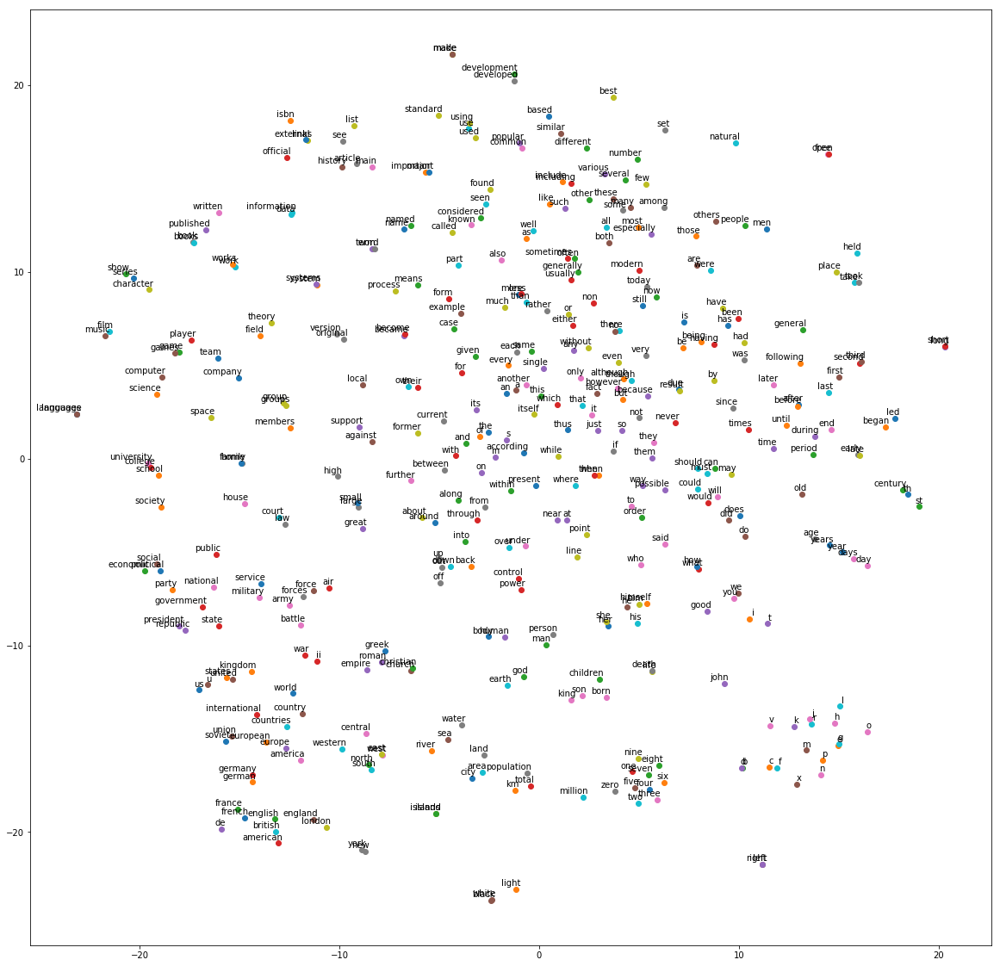

In [22]:
from matplotlib import pylab
%matplotlib inline

def plot(embeddings, labels):
    pylab.figure(figsize=(20,20))
    for i, label in enumerate(labels):
        x, y = embeddings[i,:]
        pylab.scatter(x, y)
        pylab.annotate(label, xy=(x, y), xytext=(5, 2), textcoords='offset points',
                       ha='right', va='bottom')
    pylab.show()

plot(two_d_embeddings, labels)

Running the code above might generate a plot like the one below. t-SNE and Word2Vec are stochastic, so although when you run the code the plot won’t look exactly like this, you can still see clusters of similar words such as below where 'british', 'american', 'french', 'english' are near the bottom-left, and 'military', 'army' and 'forces' are all together near the bottom.

![tsne plot of embeddings](./tsne.png)

### Stop / Close the Endpoint (Optional)
Finally, we should delete the endpoint before we close the notebook.

In [ ]:
sess.delete_endpoint(bt_endpoint.endpoint)